# MMOCR Tutorial

Welcome to MMOCR! This is the official colab tutorial for using MMOCR. In this tutorial, you will learn how to

- Install MMOCR from source
- Perform inference with
  - a pretrained text recognizer
  - a pretrained text detector
  - pretrained recognizer and detector
  - pretrained Key Information Extraction (KIE) model
- Evaluate a text detection model on an acadmic dataset
- Train a text recognizer with a toy dataset

Let's start!

## Install MMOCR from source

Installing MMOCR is straightforward. We recommend users to install MMOCR from source as any local code changes on MMOCR can take effect immediately, which is needed for research & developement purpose. Refer to [documentation](https://mmocr.readthedocs.io/en/dev-1.x/get_started/install.html) for more information.

In [3]:
!which pip

~/SoccerNet/env/bin/pip


### Install Dependencies

In [4]:
!pip install torch==2.0.0 torchvision==0.15.1
!pip install -U openmim
!mim install "mmengine>=0.7.1,<1.1.0"
!mim install "mmdet>=3.0.0rc5,<3.2.0"
!mim install "mmcv>=2.0.0rc4,<2.1.0"
# !mim install mmocr


  Cache entry deserialization failed, entry ignored
  Could not find a version that satisfies the requirement torch==2.0.0 (from versions: 1.0.0, 1.0.1, 1.0.1.post2, 1.1.0, 1.2.0, 1.3.0, 1.3.1, 1.4.0, 1.5.0, 1.5.1, 1.6.0, 1.7.0, 1.7.1, 1.8.0, 1.8.1, 1.9.0, 1.9.1, 1.10.0, 1.10.1, 1.10.2)
No matching distribution found for torch==2.0.0
You are using pip version 9.0.3, however version 24.0 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
    100% |████████████████████████████████| 61kB 258kB/s ta 0:00:011
    100% |████████████████████████████████| 102kB 734kB/s ta 0:00:01:01
  Cache entry deserialization failed, entry ignored
  Using cached https://files.pythonhosted.org/packages/a4/6d/6463d49a933f547439d6b5b98b46af8742cc03ae83543e4d7688c2420f8b/pip-21.3.1-py3-none-any.whl
Requirement already up-to-date: requests in ./env/lib/python3.6/site-packages (from openmim)
  Using cached https://files.pythonhosted.org/packages/c3/e2/00cacecafbab071c787019f0

In [5]:
!git clone https://github.com/open-mmlab/mmocr.git
%cd mmocr
!pip install -v -e .
%cd ..

Cloning into 'mmocr'...
remote: Enumerating objects: 16384, done.
remote: Counting objects: 100% (293/293), done.
remote: Compressing objects: 100% (220/220), done.
remote: Total 16384 (delta 101), reused 200 (delta 70), pack-reused 16091
Receiving objects: 100% (16384/16384), 16.24 MiB | 32.35 MiB/s, done.
Resolving deltas: 100% (10769/10769), done.
Updating files: 100% (977/977), done.
/home/oliveraw/SoccerNet/mmocr
Obtaining file:///home/oliveraw/SoccerNet/mmocr
  Running setup.py (path:/home/oliveraw/SoccerNet/mmocr/setup.py) egg_info for package from file:///home/oliveraw/SoccerNet/mmocr
    Running command python setup.py egg_info
    running egg_info
    creating mmocr.egg-info
    writing mmocr.egg-info/PKG-INFO
    writing dependency_links to mmocr.egg-info/dependency_links.txt
    writing requirements to mmocr.egg-info/requires.txt
    writing top-level names to mmocr.egg-info/top_level.txt
    writing manifest file 'mmocr.egg-info/SOURCES.txt'
    reading manifest file 'mmoc

    100% |████████████████████████████████| 952kB 379kB/s 
  1 location(s) to search for versions of lmdb:
  * https://pypi.python.org/simple/lmdb/
  Getting page https://pypi.python.org/simple/lmdb/
  Looking up "https://pypi.python.org/simple/lmdb/" in the cache
  No cache entry available
  Resetting dropped connection: pypi.python.org
  Starting new HTTPS connection (2): pypi.python.org
  https://pypi.python.org:443 "GET /simple/lmdb/ HTTP/1.1" 301 122
  Updating cache with response from "https://pypi.python.org/simple/lmdb/"
  Caching permanant redirect
  Looking up "https://pypi.org/simple/lmdb/" in the cache
  No cache entry available
  https://pypi.org:443 "GET /simple/lmdb/ HTTP/1.1" 200 50413
  Updating cache with response from "https://pypi.org/simple/lmdb/"
  Caching due to etag
  Analyzing links from page https://pypi.org/simple/lmdb/
    Found link https://files.pythonhosted.org/packages/2d/d5/ce5780351049ed3c0968bb8959883d9e3a544d6d1aa7a0ea85f430bb0e47/lmdb-0.58.tar.gz#sh

    Skipping link https://files.pythonhosted.org/packages/b0/d0/0bc4ad24cceb9caab22150b83155b6ad88299d230d9d4171b1fc8693e367/lmdb-0.86-py2.7-win32.egg#sha256=67df2bfdd47bf9b3a217609c341bb9baf50941b2d7edc823ef41fbb14dffc0bf (from https://pypi.org/simple/lmdb/); unsupported archive format: .egg
    Skipping link https://files.pythonhosted.org/packages/b1/a2/d2773732d690feadd65edd058fe43511a0b69664313fada063631e81c017/lmdb-0.86-py3.2-win-amd64.egg#sha256=eb3ce774eb6e48410c737c74d93ceb94f0fdcf9db13f4b3972e3dcf4c7ab46b0 (from https://pypi.org/simple/lmdb/); unsupported archive format: .egg
    Skipping link https://files.pythonhosted.org/packages/ac/3e/506908766c315334b9af96d6c16c622665d20938941f25b2207fe727d969/lmdb-0.86-py3.2-win32.egg#sha256=888c4f301ecf106ff8e71ce90913cee2c0d2aba769b84d2ee3cea4cd85f0afac (from https://pypi.org/simple/lmdb/); unsupported archive format: .egg
    Skipping link https://files.pythonhosted.org/packages/08/c3/452d77d8da7652cedeb71f52a75aec5dda638bb7af0cf28770

  https://files.pythonhosted.org:443 "GET /packages/de/13/dd9b0c1924f0becc93e0bacd123a4e7a347966e3e74753ace3b1e85acc39/lmdb-1.4.1.tar.gz HTTP/1.1" 200 881549
    99% |████████████████████████████████| 880kB 98.7MB/s eta 0:00:01  Updating cache with response from "https://files.pythonhosted.org/packages/de/13/dd9b0c1924f0becc93e0bacd123a4e7a347966e3e74753ace3b1e85acc39/lmdb-1.4.1.tar.gz"
  Caching due to etag
    100% |████████████████████████████████| 890kB 1.0MB/s 
  Running setup.py (path:/tmp/pip-build-hnp4wpyf/lmdb/setup.py) egg_info for package lmdb
    Running command python setup.py egg_info
    patching file lmdb.h
    patching file mdb.c
    py-lmdb: Using bundled liblmdb with py-lmdb patches; override with LMDB_FORCE_SYSTEM=1 or LMDB_PURE=1.
    py-lmdb: Using CPython extension; override with LMDB_FORCE_CFFI=1.
    running egg_info
    creating pip-egg-info/lmdb.egg-info
    writing pip-egg-info/lmdb.egg-info/PKG-INFO
    writing dependency_links to pip-egg-info/lmdb.egg-info

    Skipping link https://files.pythonhosted.org/packages/1a/fb/703bcf47ddeb35fb5943fb6c948a07b9a13c8ae1274a48833a9956180061/opencv_python-3.4.9.33-cp37-cp37m-win_amd64.whl#sha256=85d37900d7a9d1d92723c36bd5fe03be6c7e6df71d6bfb2464515b175a6eaae8 (from https://pypi.org/simple/opencv-python/); it is not compatible with this Python
    Skipping link https://files.pythonhosted.org/packages/e0/10/11dbf277642a105510a5d32c07c0254e3a40b86583491054f5d4115927f2/opencv_python-3.4.9.33-cp38-cp38-macosx_10_9_x86_64.whl#sha256=9ee75ec08e7d60f587e96890203844c27f5fa3c2c67a9d5a00e9c0e13721a761 (from https://pypi.org/simple/opencv-python/); it is not compatible with this Python
    Skipping link https://files.pythonhosted.org/packages/24/c4/c0e5dab1c3adccc60b544dc8bdd4eb24a8dcae38b8a0b60b2b0ebc466e29/opencv_python-3.4.9.33-cp38-cp38-manylinux1_i686.whl#sha256=0d9fc560148347b1cda8843aa7fdb5259bc4bed9caaf298f28a8e2e4eeecb951 (from https://pypi.org/simple/opencv-python/); it is not compatible with this Pyth

    Skipping link https://files.pythonhosted.org/packages/b6/ef/ad0423cae9abb45bf536af451f1f65bea35369b56aca36908560efcf6a9f/opencv_python-4.2.0.34-cp36-cp36m-win_amd64.whl#sha256=f45c1c3cdda1857bedd4dfe0bbd49c9419af0cc57f33490341edeae97d18f037 (from https://pypi.org/simple/opencv-python/); it is not compatible with this Python
    Skipping link https://files.pythonhosted.org/packages/7c/0b/df5987ee6671eb7645d990b70832780daf0ece89469af0a792d8dcbcfe62/opencv_python-4.2.0.34-cp37-cp37m-macosx_10_9_x86_64.whl#sha256=c0087b428cef9a32d977390656d91b02245e0e91f909870492df7e39202645dd (from https://pypi.org/simple/opencv-python/); it is not compatible with this Python
    Skipping link https://files.pythonhosted.org/packages/ca/8e/d3a52ecd5d4cc89e797d70fe3d452ab12ecfee75381477e6964d8a92ae42/opencv_python-4.2.0.34-cp37-cp37m-manylinux1_i686.whl#sha256=fb3c855347310788e4286b867997be354c55535597966ed5dac876d9166013a4 (from https://pypi.org/simple/opencv-python/); it is not compatible with this Py

  https://files.pythonhosted.org:443 "GET /packages/25/72/da7c69a3542071bf1e8f65336721b8b2659194425438d988f79bc14ed9cc/opencv-python-4.9.0.80.tar.gz HTTP/1.1" 200 92896686


    6% |██                              | 6.0MB 71.0MB/s eta 0:00:02

    9% |███▏                            | 9.2MB 64.5MB/s eta 0:00:02

    13% |████▎                           | 12.4MB 64.1MB/s eta 0:00:02

    16% |█████▍                          | 15.5MB 65.2MB/s eta 0:00:02

    20% |██████▌                         | 18.7MB 63.1MB/s eta 0:00:02

    23% |███████▌                        | 21.9MB 66.4MB/s eta 0:00:02

    27% |████████▋                       | 25.1MB 64.2MB/s eta 0:00:02

    33% |██████████▉                     | 31.5MB 65.0MB/s eta 0:00:01

    37% |████████████                    | 34.6MB 63.9MB/s eta 0:00:01

    40% |█████████████                   | 37.8MB 65.6MB/s eta 0:00:01

    43% |██████████████                  | 40.8MB 63.6MB/s eta 0:00:01

    47% |███████████████▏                | 44.0MB 66.2MB/s eta 0:00:01

    50% |████████████████▎               | 47.1MB 59.2MB/s eta 0:00:01

    54% |█████████████████▎              | 50.2MB 63.9MB/s eta 0:00:01

    57% |██████████████████▍             | 53.4MB 61.3MB/s eta 0:00:01

    60% |███████████████████▌            | 56.5MB 65.2MB/s eta 0:00:01

    67% |█████████████████████▋          | 62.8MB 66.1MB/s eta 0:00:01

    74% |███████████████████████▊        | 69.0MB 65.2MB/s eta 0:00:01

    77% |████████████████████████▉       | 72.1MB 62.5MB/s eta 0:00:01

    81% |██████████████████████████      | 75.3MB 65.7MB/s eta 0:00:01

    84% |███████████████████████████     | 78.4MB 64.1MB/s eta 0:00:01

    87% |████████████████████████████    | 81.5MB 66.3MB/s eta 0:00:01

    91% |█████████████████████████████▏  | 84.6MB 65.3MB/s eta 0:00:01

    94% |██████████████████████████████▎ | 87.8MB 63.5MB/s eta 0:00:01

    97% |███████████████████████████████▎| 90.9MB 64.7MB/s eta 0:00:01

    99% |████████████████████████████████| 92.9MB 67.6MB/s eta 0:00:01  Updating cache with response from "https://files.pythonhosted.org/packages/25/72/da7c69a3542071bf1e8f65336721b8b2659194425438d988f79bc14ed9cc/opencv-python-4.9.0.80.tar.gz"
  Caching due to etag


    100% |████████████████████████████████| 92.9MB 11kB/s 
  Running setup.py (path:/tmp/pip-build-hnp4wpyf/opencv-python/setup.py) egg_info for package opencv-python
    Running command python setup.py egg_info
    Traceback (most recent call last):
      File "<string>", line 1, in <module>
      File "/tmp/pip-build-hnp4wpyf/opencv-python/setup.py", line 10, in <module>
        from skbuild import cmaker, setup
    ModuleNotFoundError: No module named 'skbuild'
Cleaning up...
  Removing source in /tmp/pip-build-hnp4wpyf/lmdb
Command "python setup.py egg_info" failed with error code 1 in /tmp/pip-build-hnp4wpyf/opencv-python/
Exception information:
Traceback (most recent call last):
  File "/home/oliveraw/SoccerNet/env/lib64/python3.6/site-packages/pip/basecommand.py", line 215, in main
    status = self.run(options, args)
  File "/home/oliveraw/SoccerNet/env/lib64/python3.6/site-packages/pip/commands/install.py", line 346, in run
    requirement_set.prepare_files(finder)
  File "/ho

In [ ]:
!unzip train.zip

Archive:  train.zip
   creating: train/
  inflating: train/.DS_Store         
   creating: train/images/
   creating: train/images/1069/
  inflating: train/images/1069/1069_81.jpg  
  inflating: train/images/1069/1069_476.jpg  
  inflating: train/images/1069/1069_310.jpg  
  inflating: train/images/1069/1069_304.jpg  
  inflating: train/images/1069/1069_462.jpg  
  inflating: train/images/1069/1069_95.jpg  
  inflating: train/images/1069/1069_338.jpg  
  inflating: train/images/1069/1069_42.jpg  
  inflating: train/images/1069/1069_56.jpg  
  inflating: train/images/1069/1069_489.jpg  
  inflating: train/images/1069/1069_112.jpg  
  inflating: train/images/1069/1069_674.jpg  
  inflating: train/images/1069/1069_660.jpg  
  inflating: train/images/1069/1069_106.jpg  
  inflating: train/images/1069/1069_648.jpg  
  inflating: train/images/1069/1069_700.jpg  
  inflating: train/images/1069/1069_714.jpg  
  inflating: train/images/1069/1069_728.jpg  
  inflating: train/images/1069/1069_502

  inflating: train/images/1069/1069_670.jpg  
  inflating: train/images/1069/1069_116.jpg  
  inflating: train/images/1069/1069_658.jpg  
  inflating: train/images/1069/1069_52.jpg  
  inflating: train/images/1069/1069_46.jpg  
  inflating: train/images/1069/1069_499.jpg  
  inflating: train/images/1069/1069_91.jpg  
  inflating: train/images/1069/1069_466.jpg  
  inflating: train/images/1069/1069_300.jpg  
  inflating: train/images/1069/1069_314.jpg  
  inflating: train/images/1069/1069_472.jpg  
  inflating: train/images/1069/1069_85.jpg  
  inflating: train/images/1069/1069_328.jpg  
  inflating: train/images/1069/1069_373.jpg  
  inflating: train/images/1069/1069_415.jpg  
  inflating: train/images/1069/1069_401.jpg  
  inflating: train/images/1069/1069_367.jpg  
  inflating: train/images/1069/1069_429.jpg  
  inflating: train/images/1069/1069_21.jpg  
  inflating: train/images/1069/1069_35.jpg  
  inflating: train/images/1069/1069_398.jpg  
  inflating: train/images/1069/1069_617.

  inflating: train/images/1069/1069_187.jpg  
  inflating: train/images/1069/1069_742.jpg  
  inflating: train/images/1069/1069_226.jpg  
  inflating: train/images/1069/1069_540.jpg  
  inflating: train/images/1069/1069_554.jpg  
  inflating: train/images/1069/1069_232.jpg  
  inflating: train/images/1069/1069_568.jpg  
  inflating: train/images/1069/1069_583.jpg  
  inflating: train/images/1069/1069_597.jpg  
  inflating: train/images/1069/1069_596.jpg  
  inflating: train/images/1069/1069_582.jpg  
  inflating: train/images/1069/1069_569.jpg  
  inflating: train/images/1069/1069_555.jpg  
  inflating: train/images/1069/1069_233.jpg  
  inflating: train/images/1069/1069_227.jpg  
  inflating: train/images/1069/1069_541.jpg  
  inflating: train/images/1069/1069_743.jpg  
  inflating: train/images/1069/1069_186.jpg  
  inflating: train/images/1069/1069_192.jpg  
  inflating: train/images/1069/1069_179.jpg  
  inflating: train/images/1069/1069_145.jpg  
  inflating: train/images/1069/106

  inflating: train/images/1069/1069_88.jpg  
  inflating: train/images/1069/1069_63.jpg  
  inflating: train/images/1069/1069_494.jpg  
  inflating: train/images/1069/1069_480.jpg  
  inflating: train/images/1069/1069_77.jpg  
  inflating: train/images/1069/1069_133.jpg  
  inflating: train/images/1069/1069_655.jpg  
  inflating: train/images/1069/1069_641.jpg  
  inflating: train/images/1069/1069_127.jpg  
  inflating: train/images/1069/1069_669.jpg  
  inflating: train/images/1069/1069_696.jpg  
  inflating: train/images/1069/1069_682.jpg  
  inflating: train/images/1069/1069_721.jpg  
  inflating: train/images/1069/1069_735.jpg  
  inflating: train/images/1069/1069_709.jpg  
  inflating: train/images/1069/1069_523.jpg  
  inflating: train/images/1069/1069_245.jpg  
  inflating: train/images/1069/1069_251.jpg  
  inflating: train/images/1069/1069_537.jpg  
  inflating: train/images/1069/1069_279.jpg  
  inflating: train/images/1069/1069_286.jpg  
  inflating: train/images/1069/1069_4

  inflating: train/images/1069/1069_532.jpg  
  inflating: train/images/1069/1069_254.jpg  
  inflating: train/images/1069/1069_283.jpg  
  inflating: train/images/1069/1069_297.jpg  
  inflating: train/images/1069/1069_1.jpg  
  inflating: train/images/1069/1069_296.jpg  
  inflating: train/images/1069/1069_282.jpg  
  inflating: train/images/1069/1069_533.jpg  
  inflating: train/images/1069/1069_255.jpg  
  inflating: train/images/1069/1069_241.jpg  
  inflating: train/images/1069/1069_527.jpg  
  inflating: train/images/1069/1069_269.jpg  
  inflating: train/images/1069/1069_731.jpg  
  inflating: train/images/1069/1069_725.jpg  
  inflating: train/images/1069/1069_719.jpg  
  inflating: train/images/1069/1069_686.jpg  
  inflating: train/images/1069/1069_692.jpg  
  inflating: train/images/1069/1069_123.jpg  
  inflating: train/images/1069/1069_645.jpg  
  inflating: train/images/1069/1069_651.jpg  
  inflating: train/images/1069/1069_137.jpg  
  inflating: train/images/1069/1069_

  inflating: train/images/797/797_492.jpg  
  inflating: train/images/797/797_647.jpg  
  inflating: train/images/797/797_653.jpg  
  inflating: train/images/797/797_684.jpg  
  inflating: train/images/797/797_690.jpg  
  inflating: train/images/797/797_733.jpg  
  inflating: train/images/797/797_727.jpg  
  inflating: train/images/797/797_531.jpg  
  inflating: train/images/797/797_525.jpg  
  inflating: train/images/797/797_519.jpg  
  inflating: train/images/797/797_518.jpg  
  inflating: train/images/797/797_524.jpg  
  inflating: train/images/797/797_530.jpg  
  inflating: train/images/797/797_726.jpg  
  inflating: train/images/797/797_732.jpg  
  inflating: train/images/797/797_691.jpg  
  inflating: train/images/797/797_685.jpg  
  inflating: train/images/797/797_652.jpg  
  inflating: train/images/797/797_646.jpg  
  inflating: train/images/797/797_493.jpg  
  inflating: train/images/797/797_487.jpg  
  inflating: train/images/797/797_478.jpg  
  inflating: train/images/797/79

  inflating: train/images/797/797_407.jpg  
  inflating: train/images/797/797_361.jpg  
  inflating: train/images/797/797_375.jpg  
  inflating: train/images/797/797_413.jpg  
  inflating: train/images/797/797_349.jpg  
  inflating: train/images/797/797_605.jpg  
  inflating: train/images/797/797_611.jpg  
  inflating: train/images/797/797_639.jpg  
  inflating: train/images/797/797_573.jpg  
  inflating: train/images/797/797_567.jpg  
  inflating: train/images/797/797_598.jpg  
  inflating: train/images/797/797_599.jpg  
  inflating: train/images/797/797_566.jpg  
  inflating: train/images/797/797_572.jpg  
  inflating: train/images/797/797_638.jpg  
  inflating: train/images/797/797_610.jpg  
  inflating: train/images/797/797_604.jpg  
  inflating: train/images/797/797_348.jpg  
  inflating: train/images/797/797_374.jpg  
  inflating: train/images/797/797_412.jpg  
  inflating: train/images/797/797_406.jpg  
  inflating: train/images/797/797_360.jpg  
  inflating: train/images/797/79

  inflating: train/images/909/909_438.jpg  
  inflating: train/images/909/909_376.jpg  
  inflating: train/images/909/909_410.jpg  
  inflating: train/images/909/909_404.jpg  
  inflating: train/images/909/909_362.jpg  
  inflating: train/images/909/909_389.jpg  
  inflating: train/images/909/909_558.jpg  
  inflating: train/images/909/909_202.jpg  
  inflating: train/images/909/909_564.jpg  
  inflating: train/images/909/909_570.jpg  
  inflating: train/images/909/909_216.jpg  
  inflating: train/images/909/909_16.jpg  
  inflating: train/images/909/909_17.jpg  
  inflating: train/images/909/909_571.jpg  
  inflating: train/images/909/909_217.jpg  
  inflating: train/images/909/909_203.jpg  
  inflating: train/images/909/909_565.jpg  
  inflating: train/images/909/909_559.jpg  
  inflating: train/images/909/909_388.jpg  
  inflating: train/images/909/909_405.jpg  
  inflating: train/images/909/909_363.jpg  
  inflating: train/images/909/909_377.jpg  
  inflating: train/images/909/909_

  inflating: train/images/909/909_738.jpg  
  inflating: train/images/909/909_60.jpg  
  inflating: train/images/909/909_274.jpg  
  inflating: train/images/909/909_512.jpg  
  inflating: train/images/909/909_506.jpg  
  inflating: train/images/909/909_260.jpg  
  inflating: train/images/909/909_248.jpg  
  inflating: train/images/909/909_499.jpg  
  inflating: train/images/909/909_300.jpg  
  inflating: train/images/909/909_466.jpg  
  inflating: train/images/909/909_472.jpg  
  inflating: train/images/909/909_314.jpg  
  inflating: train/images/909/909_328.jpg  
  inflating: train/images/909/909_664.jpg  
  inflating: train/images/909/909_102.jpg  
  inflating: train/images/909/909_116.jpg  
  inflating: train/images/909/909_670.jpg  
  inflating: train/images/909/909_658.jpg  
  inflating: train/images/909/909_655.jpg  
  inflating: train/images/909/909_133.jpg  
  inflating: train/images/909/909_127.jpg  
  inflating: train/images/909/909_641.jpg  
  inflating: train/images/909/909

  inflating: train/images/909/909_644.jpg  
  inflating: train/images/909/909_122.jpg  
  inflating: train/images/909/909_693.jpg  
  inflating: train/images/909/909_687.jpg  
  inflating: train/images/909/909_308.jpg  
  inflating: train/images/909/909_452.jpg  
  inflating: train/images/909/909_334.jpg  
  inflating: train/images/909/909_320.jpg  
  inflating: train/images/909/909_446.jpg  
  inflating: train/images/909/909_491.jpg  
  inflating: train/images/909/909_485.jpg  
  inflating: train/images/909/909_268.jpg  
  inflating: train/images/909/909_526.jpg  
  inflating: train/images/909/909_240.jpg  
  inflating: train/images/909/909_254.jpg  
  inflating: train/images/909/909_532.jpg  
  inflating: train/images/909/909_283.jpg  
  inflating: train/images/909/909_297.jpg  
  inflating: train/images/909/909_40.jpg  
  inflating: train/images/909/909_718.jpg  
  inflating: train/images/909/909_54.jpg  
  inflating: train/images/909/909_724.jpg  
  inflating: train/images/909/909_

  inflating: train/images/909/909_590.jpg  
  inflating: train/images/909/909_547.jpg  
  inflating: train/images/909/909_221.jpg  
  inflating: train/images/909/909_235.jpg  
  inflating: train/images/909/909_553.jpg  
  inflating: train/images/909/909_209.jpg  
  inflating: train/images/909/909_396.jpg  
  inflating: train/images/909/909_382.jpg  
  inflating: train/images/909/909_433.jpg  
  inflating: train/images/909/909_355.jpg  
  inflating: train/images/909/909_341.jpg  
  inflating: train/images/909/909_427.jpg  
  inflating: train/images/909/909_369.jpg  
  inflating: train/images/909/909_194.jpg  
  inflating: train/images/909/909_180.jpg  
  inflating: train/images/909/909_157.jpg  
  inflating: train/images/909/909_631.jpg  
  inflating: train/images/909/909_625.jpg  
  inflating: train/images/909/909_143.jpg  
  inflating: train/images/909/909_619.jpg  
  inflating: train/images/909/909_169.jpg  
  inflating: train/images/909/909_633.jpg  
  inflating: train/images/909/90

  inflating: train/images/135/135_553.jpg  
  inflating: train/images/135/135_547.jpg  
  inflating: train/images/135/135_54.jpg  
  inflating: train/images/135/135_221.jpg  
  inflating: train/images/135/135_180.jpg  
  inflating: train/images/135/135_194.jpg  
  inflating: train/images/135/135_143.jpg  
  inflating: train/images/135/135_157.jpg  
  inflating: train/images/135/135_396.jpg  
  inflating: train/images/135/135_427.jpg  
  inflating: train/images/135/135_433.jpg  
  inflating: train/images/135/135_432.jpg  
  inflating: train/images/135/135_426.jpg  
  inflating: train/images/135/135_397.jpg  
  inflating: train/images/135/135_156.jpg  
  inflating: train/images/135/135_142.jpg  
  inflating: train/images/135/135_195.jpg  
  inflating: train/images/135/135_181.jpg  
  inflating: train/images/135/135_546.jpg  
  inflating: train/images/135/135_55.jpg  
  inflating: train/images/135/135_220.jpg  
  inflating: train/images/135/135_234.jpg  
  inflating: train/images/135/135_

  inflating: train/images/135/135_202.jpg  
  inflating: train/images/135/135_564.jpg  
  inflating: train/images/135/135_77.jpg  
  inflating: train/images/135/135_558.jpg  
  inflating: train/images/135/135_1.jpg  
  inflating: train/images/135/135_88.jpg  
  inflating: train/images/135/135_5.jpg  
  inflating: train/images/135/135_98.jpg  
  inflating: train/images/135/135_73.jpg  
  inflating: train/images/135/135_560.jpg  
  inflating: train/images/135/135_206.jpg  
  inflating: train/images/135/135_212.jpg  
  inflating: train/images/135/135_574.jpg  
  inflating: train/images/135/135_67.jpg  
  inflating: train/images/135/135_548.jpg  
  inflating: train/images/135/135_170.jpg  
  inflating: train/images/135/135_164.jpg  
  inflating: train/images/135/135_158.jpg  
  inflating: train/images/135/135_399.jpg  
  inflating: train/images/135/135_414.jpg  
  inflating: train/images/135/135_400.jpg  
  inflating: train/images/135/135_428.jpg  
  inflating: train/images/135/135_429.jpg

  inflating: train/images/307/307_183.jpg  
  inflating: train/images/307/307_197.jpg  
  inflating: train/images/307/307_424.jpg  
  inflating: train/images/307/307_342.jpg  
  inflating: train/images/307/307_356.jpg  
  inflating: train/images/307/307_430.jpg  
  inflating: train/images/307/307_418.jpg  
  inflating: train/images/307/307_381.jpg  
  inflating: train/images/307/307_395.jpg  
  inflating: train/images/307/307_550.jpg  
  inflating: train/images/307/307_236.jpg  
  inflating: train/images/307/307_222.jpg  
  inflating: train/images/307/307_544.jpg  
  inflating: train/images/307/307_578.jpg  
  inflating: train/images/307/307_593.jpg  
  inflating: train/images/307/307_587.jpg  
  inflating: train/images/307/307_28.jpg  
  inflating: train/images/307/307_746.jpg  
  inflating: train/images/307/307_14.jpg  
  inflating: train/images/307/307_16.jpg  
  inflating: train/images/307/307_750.jpg  
  inflating: train/images/307/307_744.jpg  
  inflating: train/images/307/307_5

  inflating: train/images/307/307_137.jpg  
  inflating: train/images/307/307_651.jpg  
  inflating: train/images/307/307_679.jpg  
  inflating: train/images/307/307_686.jpg  
  inflating: train/images/307/307_692.jpg  
  inflating: train/images/307/307_321.jpg  
  inflating: train/images/307/307_447.jpg  
  inflating: train/images/307/307_453.jpg  
  inflating: train/images/307/307_335.jpg  
  inflating: train/images/307/307_1.jpg  
  inflating: train/images/307/307_309.jpg  
  inflating: train/images/307/307_484.jpg  
  inflating: train/images/307/307_490.jpg  
  inflating: train/images/307/307_255.jpg  
  inflating: train/images/307/307_533.jpg  
  inflating: train/images/307/307_527.jpg  
  inflating: train/images/307/307_241.jpg  
  inflating: train/images/307/307_269.jpg  
  inflating: train/images/307/307_296.jpg  
  inflating: train/images/307/307_282.jpg  
  inflating: train/images/307/307_731.jpg  
  inflating: train/images/307/307_725.jpg  
  inflating: train/images/307/307_

  inflating: train/images/307/307_99.jpg  
  inflating: train/images/307/307_80.jpg  
  inflating: train/images/307/307_94.jpg  
  inflating: train/images/307/307_43.jpg  
  inflating: train/images/307/307_739.jpg  
  inflating: train/images/307/307_57.jpg  
  inflating: train/images/307/307_705.jpg  
  inflating: train/images/307/307_711.jpg  
  inflating: train/images/307/307_249.jpg  
  inflating: train/images/307/307_507.jpg  
  inflating: train/images/307/307_261.jpg  
  inflating: train/images/307/307_275.jpg  
  inflating: train/images/307/307_513.jpg  
  inflating: train/images/307/307_498.jpg  
  inflating: train/images/307/307_329.jpg  
  inflating: train/images/307/307_9.jpg  
  inflating: train/images/307/307_473.jpg  
  inflating: train/images/307/307_315.jpg  
  inflating: train/images/307/307_301.jpg  
  inflating: train/images/307/307_467.jpg  
  inflating: train/images/307/307_659.jpg  
  inflating: train/images/307/307_117.jpg  
  inflating: train/images/307/307_671.j

  inflating: train/images/307/307_84.jpg  
  inflating: train/images/307/307_20.jpg  
  inflating: train/images/307/307_34.jpg  
  inflating: train/images/307/307_558.jpg  
  inflating: train/images/307/307_202.jpg  
  inflating: train/images/307/307_564.jpg  
  inflating: train/images/307/307_570.jpg  
  inflating: train/images/307/307_216.jpg  
  inflating: train/images/307/307_389.jpg  
  inflating: train/images/307/307_438.jpg  
  inflating: train/images/307/307_376.jpg  
  inflating: train/images/307/307_410.jpg  
  inflating: train/images/307/307_404.jpg  
  inflating: train/images/307/307_362.jpg  
  inflating: train/images/307/307_148.jpg  
  inflating: train/images/307/307_612.jpg  
  inflating: train/images/307/307_174.jpg  
  inflating: train/images/307/307_160.jpg  
  inflating: train/images/307/307_606.jpg  
  inflating: train/images/307/307_161.jpg  
  inflating: train/images/307/307_607.jpg  
  inflating: train/images/307/307_613.jpg  
  inflating: train/images/307/307_1

  inflating: train/images/763/763_341.jpg  
  inflating: train/images/763/763_355.jpg  
  inflating: train/images/763/763_433.jpg  
  inflating: train/images/763/763_369.jpg  
  inflating: train/images/763/763_15.jpg  
  inflating: train/images/763/763_382.jpg  
  inflating: train/images/763/763_396.jpg  
  inflating: train/images/763/763_29.jpg  
  inflating: train/images/763/763_143.jpg  
  inflating: train/images/763/763_157.jpg  
  inflating: train/images/763/763_180.jpg  
  inflating: train/images/763/763_194.jpg  
  inflating: train/images/763/763_745.jpg  
  inflating: train/images/763/763_235.jpg  
  inflating: train/images/763/763_221.jpg  
  inflating: train/images/763/763_209.jpg  
  inflating: train/images/763/763_208.jpg  
  inflating: train/images/763/763_220.jpg  
  inflating: train/images/763/763_234.jpg  
  inflating: train/images/763/763_744.jpg  
  inflating: train/images/763/763_750.jpg  
  inflating: train/images/763/763_195.jpg  
  inflating: train/images/763/763_

  inflating: train/images/763/763_483.jpg  
  inflating: train/images/763/763_332.jpg  
  inflating: train/images/763/763_454.jpg  
  inflating: train/images/763/763_440.jpg  
  inflating: train/images/763/763_326.jpg  
  inflating: train/images/763/763_468.jpg  
  inflating: train/images/763/763_99.jpg  
  inflating: train/images/763/763_318.jpg  
  inflating: train/images/763/763_456.jpg  
  inflating: train/images/763/763_330.jpg  
  inflating: train/images/763/763_324.jpg  
  inflating: train/images/763/763_442.jpg  
  inflating: train/images/763/763_58.jpg  
  inflating: train/images/763/763_64.jpg  
  inflating: train/images/763/763_70.jpg  
  inflating: train/images/763/763_481.jpg  
  inflating: train/images/763/763_132.jpg  
  inflating: train/images/763/763_126.jpg  
  inflating: train/images/763/763_278.jpg  
  inflating: train/images/763/763_244.jpg  
  inflating: train/images/763/763_250.jpg  
  inflating: train/images/763/763_287.jpg  
  inflating: train/images/763/763_29

  inflating: train/images/763/763_348.jpg  
  inflating: train/images/763/763_34.jpg  
  inflating: train/images/763/763_4.jpg  
  inflating: train/images/763/763_20.jpg  
  inflating: train/images/763/763_162.jpg  
  inflating: train/images/763/763_176.jpg  
  inflating: train/images/763/763_189.jpg  
  inflating: train/images/763/763_214.jpg  
  inflating: train/images/763/763_200.jpg  
  inflating: train/images/763/763_228.jpg  
  inflating: train/images/763/763_229.jpg  
  inflating: train/images/763/763_201.jpg  
  inflating: train/images/763/763_215.jpg  
  inflating: train/images/763/763_188.jpg  
  inflating: train/images/763/763_177.jpg  
  inflating: train/images/763/763_163.jpg  
  inflating: train/images/763/763_21.jpg  
  inflating: train/images/763/763_35.jpg  
  inflating: train/images/763/763_5.jpg  
  inflating: train/images/763/763_349.jpg  
  inflating: train/images/763/763_375.jpg  
  inflating: train/images/763/763_413.jpg  
  inflating: train/images/763/763_407.jp

  inflating: train/images/551/551_208.jpg  
  inflating: train/images/551/551_209.jpg  
  inflating: train/images/551/551_221.jpg  
  inflating: train/images/551/551_235.jpg  
  inflating: train/images/551/551_396.jpg  
  inflating: train/images/551/551_382.jpg  
  inflating: train/images/551/551_369.jpg  
  inflating: train/images/551/551_355.jpg  
  inflating: train/images/551/551_427.jpg  
  inflating: train/images/551/551_341.jpg  
  inflating: train/images/551/551_56.jpg  
  inflating: train/images/551/551_42.jpg  
  inflating: train/images/551/551_194.jpg  
  inflating: train/images/551/551_180.jpg  
  inflating: train/images/551/551_95.jpg  
  inflating: train/images/551/551_81.jpg  
  inflating: train/images/551/551_157.jpg  
  inflating: train/images/551/551_143.jpg  
  inflating: train/images/551/551_155.jpg  
  inflating: train/images/551/551_141.jpg  
  inflating: train/images/551/551_169.jpg  
  inflating: train/images/551/551_97.jpg  
  inflating: train/images/551/551_83.

  inflating: train/images/551/551_207.jpg  
  inflating: train/images/551/551_213.jpg  
  inflating: train/images/551/551_212.jpg  
  inflating: train/images/551/551_206.jpg  
  inflating: train/images/551/551_399.jpg  
  inflating: train/images/551/551_400.jpg  
  inflating: train/images/551/551_366.jpg  
  inflating: train/images/551/551_372.jpg  
  inflating: train/images/551/551_414.jpg  
  inflating: train/images/551/551_428.jpg  
  inflating: train/images/551/551_59.jpg  
  inflating: train/images/551/551_65.jpg  
  inflating: train/images/551/551_71.jpg  
  inflating: train/images/551/551_164.jpg  
  inflating: train/images/551/551_170.jpg  
  inflating: train/images/551/551_158.jpg  
  inflating: train/images/551/551_166.jpg  
  inflating: train/images/551/551_98.jpg  
  inflating: train/images/551/551_172.jpg  
  inflating: train/images/551/551_67.jpg  
  inflating: train/images/551/551_199.jpg  
  inflating: train/images/551/551_73.jpg  
  inflating: train/images/551/551_358.

  inflating: train/images/1264/1264_372.jpg  
  inflating: train/images/1264/1264_414.jpg  
  inflating: train/images/1264/1264_400.jpg  
  inflating: train/images/1264/1264_366.jpg  
  inflating: train/images/1264/1264_428.jpg  
  inflating: train/images/1264/1264_616.jpg  
  inflating: train/images/1264/1264_170.jpg  
  inflating: train/images/1264/1264_164.jpg  
  inflating: train/images/1264/1264_602.jpg  
  inflating: train/images/1264/1264_158.jpg  
  inflating: train/images/1264/1264_90.jpg  
  inflating: train/images/1264/1264_84.jpg  
  inflating: train/images/1264/1264_53.jpg  
  inflating: train/images/1264/1264_47.jpg  
  inflating: train/images/1264/1264_206.jpg  
  inflating: train/images/1264/1264_560.jpg  
  inflating: train/images/1264/1264_574.jpg  
  inflating: train/images/1264/1264_212.jpg  
  inflating: train/images/1264/1264_548.jpg  
  inflating: train/images/1264/1264_216.jpg  
  inflating: train/images/1264/1264_570.jpg  
  inflating: train/images/1264/1264_56

  inflating: train/images/1264/1264_649.jpg  
  inflating: train/images/1264/1264_30.jpg  
  inflating: train/images/1264/1264_701.jpg  
  inflating: train/images/1264/1264_715.jpg  
  inflating: train/images/1264/1264_24.jpg  
  inflating: train/images/1264/1264_729.jpg  
  inflating: train/images/1264/1264_18.jpg  
  inflating: train/images/1264/1264_503.jpg  
  inflating: train/images/1264/1264_265.jpg  
  inflating: train/images/1264/1264_271.jpg  
  inflating: train/images/1264/1264_517.jpg  
  inflating: train/images/1264/1264_259.jpg  
  inflating: train/images/1264/1264_513.jpg  
  inflating: train/images/1264/1264_275.jpg  
  inflating: train/images/1264/1264_261.jpg  
  inflating: train/images/1264/1264_507.jpg  
  inflating: train/images/1264/1264_249.jpg  
  inflating: train/images/1264/1264_20.jpg  
  inflating: train/images/1264/1264_711.jpg  
  inflating: train/images/1264/1264_705.jpg  
  inflating: train/images/1264/1264_34.jpg  
  inflating: train/images/1264/1264_739

  inflating: train/images/1264/1264_640.jpg  
  inflating: train/images/1264/1264_126.jpg  
  inflating: train/images/1264/1264_668.jpg  
  inflating: train/images/1264/1264_11.jpg  
  inflating: train/images/1264/1264_720.jpg  
  inflating: train/images/1264/1264_734.jpg  
  inflating: train/images/1264/1264_708.jpg  
  inflating: train/images/1264/1264_39.jpg  
  inflating: train/images/1264/1264_287.jpg  
  inflating: train/images/1264/1264_293.jpg  
  inflating: train/images/1264/1264_522.jpg  
  inflating: train/images/1264/1264_244.jpg  
  inflating: train/images/1264/1264_250.jpg  
  inflating: train/images/1264/1264_536.jpg  
  inflating: train/images/1264/1264_278.jpg  
  inflating: train/images/1264/1264_532.jpg  
  inflating: train/images/1264/1264_254.jpg  
  inflating: train/images/1264/1264_240.jpg  
  inflating: train/images/1264/1264_526.jpg  
  inflating: train/images/1264/1264_268.jpg  
  inflating: train/images/1264/1264_297.jpg  
  inflating: train/images/1264/1264_

  inflating: train/images/1264/1264_193.jpg  
  inflating: train/images/1264/1264_408.jpg  
  inflating: train/images/1264/1264_420.jpg  
  inflating: train/images/1264/1264_346.jpg  
  inflating: train/images/1264/1264_352.jpg  
  inflating: train/images/1264/1264_434.jpg  
  inflating: train/images/1264/1264_385.jpg  
  inflating: train/images/1264/1264_391.jpg  
  inflating: train/images/1264/1264_390.jpg  
  inflating: train/images/1264/1264_384.jpg  
  inflating: train/images/1264/1264_353.jpg  
  inflating: train/images/1264/1264_435.jpg  
  inflating: train/images/1264/1264_421.jpg  
  inflating: train/images/1264/1264_347.jpg  
  inflating: train/images/1264/1264_409.jpg  
  inflating: train/images/1264/1264_192.jpg  
  inflating: train/images/1264/1264_186.jpg  
  inflating: train/images/1264/1264_637.jpg  
  inflating: train/images/1264/1264_151.jpg  
  inflating: train/images/1264/1264_145.jpg  
  inflating: train/images/1264/1264_623.jpg  
  inflating: train/images/1264/126

  inflating: train/images/61/61_213.jpg  
  inflating: train/images/61/61_575.jpg  
  inflating: train/images/61/61_561.jpg  
  inflating: train/images/61/61_207.jpg  
  inflating: train/images/61/61_560.jpg  
  inflating: train/images/61/61_206.jpg  
  inflating: train/images/61/61_212.jpg  
  inflating: train/images/61/61_574.jpg  
  inflating: train/images/61/61_548.jpg  
  inflating: train/images/61/61_28.jpg  
  inflating: train/images/61/61_14.jpg  
  inflating: train/images/61/61_170.jpg  
  inflating: train/images/61/61_616.jpg  
  inflating: train/images/61/61_602.jpg  
  inflating: train/images/61/61_164.jpg  
  inflating: train/images/61/61_158.jpg  
  inflating: train/images/61/61_399.jpg  
  inflating: train/images/61/61_414.jpg  
  inflating: train/images/61/61_372.jpg  
  inflating: train/images/61/61_366.jpg  
  inflating: train/images/61/61_400.jpg  
  inflating: train/images/61/61_428.jpg  
  inflating: train/images/61/61_404.jpg  
  inflating: train/images/61/61_362.

  inflating: train/images/61/61_73.jpg  
  inflating: train/images/61/61_275.jpg  
  inflating: train/images/61/61_513.jpg  
  inflating: train/images/61/61_507.jpg  
  inflating: train/images/61/61_261.jpg  
  inflating: train/images/61/61_249.jpg  
  inflating: train/images/61/61_248.jpg  
  inflating: train/images/61/61_506.jpg  
  inflating: train/images/61/61_260.jpg  
  inflating: train/images/61/61_274.jpg  
  inflating: train/images/61/61_512.jpg  
  inflating: train/images/61/61_72.jpg  
  inflating: train/images/61/61_66.jpg  
  inflating: train/images/61/61_738.jpg  
  inflating: train/images/61/61_704.jpg  
  inflating: train/images/61/61_710.jpg  
  inflating: train/images/61/61_99.jpg  
  inflating: train/images/61/61_658.jpg  
  inflating: train/images/61/61_116.jpg  
  inflating: train/images/61/61_670.jpg  
  inflating: train/images/61/61_664.jpg  
  inflating: train/images/61/61_102.jpg  
  inflating: train/images/61/61_499.jpg  
  inflating: train/images/61/61_328.jp

  inflating: train/images/61/61_85.jpg  
  inflating: train/images/61/61_718.jpg  
  inflating: train/images/61/61_91.jpg  
  inflating: train/images/61/61_46.jpg  
  inflating: train/images/61/61_52.jpg  
  inflating: train/images/61/61_254.jpg  
  inflating: train/images/61/61_532.jpg  
  inflating: train/images/61/61_526.jpg  
  inflating: train/images/61/61_240.jpg  
  inflating: train/images/61/61_268.jpg  
  inflating: train/images/61/61_3.jpg  
  inflating: train/images/61/61_297.jpg  
  inflating: train/images/61/61_283.jpg  
  inflating: train/images/61/61_282.jpg  
  inflating: train/images/61/61_296.jpg  
  inflating: train/images/61/61_2.jpg  
  inflating: train/images/61/61_269.jpg  
  inflating: train/images/61/61_527.jpg  
  inflating: train/images/61/61_241.jpg  
  inflating: train/images/61/61_255.jpg  
  inflating: train/images/61/61_533.jpg  
  inflating: train/images/61/61_53.jpg  
  inflating: train/images/61/61_47.jpg  
  inflating: train/images/61/61_90.jpg  
  i

  inflating: train/images/61/61_419.jpg  
  inflating: train/images/61/61_380.jpg  
  inflating: train/images/61/61_394.jpg  
  inflating: train/images/61/61_141.jpg  
  inflating: train/images/61/61_627.jpg  
  inflating: train/images/61/61_633.jpg  
  inflating: train/images/61/61_155.jpg  
  inflating: train/images/61/61_169.jpg  
  inflating: train/images/61/61_182.jpg  
  inflating: train/images/61/61_196.jpg  
  inflating: train/images/61/61_747.jpg  
  inflating: train/images/61/61_19.jpg  
  inflating: train/images/61/61_25.jpg  
  inflating: train/images/61/61_31.jpg  
  inflating: train/images/61/61_551.jpg  
  inflating: train/images/61/61_237.jpg  
  inflating: train/images/61/61_223.jpg  
  inflating: train/images/61/61_545.jpg  
  inflating: train/images/61/61_579.jpg  
  inflating: train/images/61/61_592.jpg  
  inflating: train/images/61/61_586.jpg  
  inflating: train/images/61/61_587.jpg  
  inflating: train/images/61/61_593.jpg  
  inflating: train/images/61/61_578.j

  inflating: train/images/1056/1056_274.jpg  
  inflating: train/images/1056/1056_260.jpg  
  inflating: train/images/1056/1056_506.jpg  
  inflating: train/images/1056/1056_76.jpg  
  inflating: train/images/1056/1056_248.jpg  
  inflating: train/images/1056/1056_62.jpg  
  inflating: train/images/1056/1056_89.jpg  
  inflating: train/images/1056/1056_466.jpg  
  inflating: train/images/1056/1056_300.jpg  
  inflating: train/images/1056/1056_314.jpg  
  inflating: train/images/1056/1056_472.jpg  
  inflating: train/images/1056/1056_328.jpg  
  inflating: train/images/1056/1056_499.jpg  
  inflating: train/images/1056/1056_102.jpg  
  inflating: train/images/1056/1056_116.jpg  
  inflating: train/images/1056/1056_117.jpg  
  inflating: train/images/1056/1056_103.jpg  
  inflating: train/images/1056/1056_498.jpg  
  inflating: train/images/1056/1056_329.jpg  
  inflating: train/images/1056/1056_315.jpg  
  inflating: train/images/1056/1056_473.jpg  
  inflating: train/images/1056/1056_4

  inflating: train/images/1056/1056_185.jpg  
  inflating: train/images/1056/1056_184.jpg  
  inflating: train/images/1056/1056_190.jpg  
  inflating: train/images/1056/1056_147.jpg  
  inflating: train/images/1056/1056_153.jpg  
  inflating: train/images/1056/1056_386.jpg  
  inflating: train/images/1056/1056_392.jpg  
  inflating: train/images/1056/1056_345.jpg  
  inflating: train/images/1056/1056_423.jpg  
  inflating: train/images/1056/1056_437.jpg  
  inflating: train/images/1056/1056_351.jpg  
  inflating: train/images/1056/1056_379.jpg  
  inflating: train/images/1056/1056_231.jpg  
  inflating: train/images/1056/1056_225.jpg  
  inflating: train/images/1056/1056_33.jpg  
  inflating: train/images/1056/1056_27.jpg  
  inflating: train/images/1056/1056_219.jpg  
  inflating: train/images/1056/1056_221.jpg  
  inflating: train/images/1056/1056_235.jpg  
  inflating: train/images/1056/1056_23.jpg  
  inflating: train/images/1056/1056_37.jpg  
  inflating: train/images/1056/1056_20

  inflating: train/images/1056/1056_479.jpg  
  inflating: train/images/1056/1056_323.jpg  
  inflating: train/images/1056/1056_445.jpg  
  inflating: train/images/1056/1056_451.jpg  
  inflating: train/images/1056/1056_337.jpg  
  inflating: train/images/1056/1056_96.jpg  
  inflating: train/images/1056/1056_82.jpg  
  inflating: train/images/1056/1056_294.jpg  
  inflating: train/images/1056/1056_280.jpg  
  inflating: train/images/1056/1056_55.jpg  
  inflating: train/images/1056/1056_1.jpg  
  inflating: train/images/1056/1056_41.jpg  
  inflating: train/images/1056/1056_257.jpg  
  inflating: train/images/1056/1056_69.jpg  
  inflating: train/images/1056/1056_243.jpg  
  inflating: train/images/1056/1056_255.jpg  
  inflating: train/images/1056/1056_241.jpg  
  inflating: train/images/1056/1056_57.jpg  
  inflating: train/images/1056/1056_269.jpg  
  inflating: train/images/1056/1056_43.jpg  
  inflating: train/images/1056/1056_3.jpg  
  inflating: train/images/1056/1056_296.jpg  

  inflating: train/images/1290/1290_638.jpg  
  inflating: train/images/1290/1290_89.jpg  
  inflating: train/images/1290/1290_62.jpg  
  inflating: train/images/1290/1290_76.jpg  
  inflating: train/images/1290/1290_189.jpg  
  inflating: train/images/1290/1290_374.jpg  
  inflating: train/images/1290/1290_412.jpg  
  inflating: train/images/1290/1290_406.jpg  
  inflating: train/images/1290/1290_360.jpg  
  inflating: train/images/1290/1290_348.jpg  
  inflating: train/images/1290/1290_349.jpg  
  inflating: train/images/1290/1290_407.jpg  
  inflating: train/images/1290/1290_361.jpg  
  inflating: train/images/1290/1290_375.jpg  
  inflating: train/images/1290/1290_413.jpg  
  inflating: train/images/1290/1290_188.jpg  
  inflating: train/images/1290/1290_77.jpg  
  inflating: train/images/1290/1290_63.jpg  
  inflating: train/images/1290/1290_88.jpg  
  inflating: train/images/1290/1290_639.jpg  
  inflating: train/images/1290/1290_163.jpg  
  inflating: train/images/1290/1290_605.

  inflating: train/images/1290/1290_14.jpg  
  inflating: train/images/1290/1290_128.jpg  
  inflating: train/images/1290/1290_666.jpg  
  inflating: train/images/1290/1290_100.jpg  
  inflating: train/images/1290/1290_114.jpg  
  inflating: train/images/1290/1290_672.jpg  
  inflating: train/images/1290/1290_712.jpg  
  inflating: train/images/1290/1290_706.jpg  
  inflating: train/images/1290/1290_289.jpg  
  inflating: train/images/1290/1290_538.jpg  
  inflating: train/images/1290/1290_276.jpg  
  inflating: train/images/1290/1290_510.jpg  
  inflating: train/images/1290/1290_504.jpg  
  inflating: train/images/1290/1290_262.jpg  
  inflating: train/images/1290/1290_509.jpg  
  inflating: train/images/1290/1290_247.jpg  
  inflating: train/images/1290/1290_521.jpg  
  inflating: train/images/1290/1290_535.jpg  
  inflating: train/images/1290/1290_253.jpg  
  inflating: train/images/1290/1290_284.jpg  
  inflating: train/images/1290/1290_290.jpg  
  inflating: train/images/1290/1290

  inflating: train/images/1290/1290_295.jpg  
  inflating: train/images/1290/1290_726.jpg  
  inflating: train/images/1290/1290_732.jpg  
  inflating: train/images/1290/1290_134.jpg  
  inflating: train/images/1290/1290_652.jpg  
  inflating: train/images/1290/1290_646.jpg  
  inflating: train/images/1290/1290_120.jpg  
  inflating: train/images/1290/1290_108.jpg  
  inflating: train/images/1290/1290_20.jpg  
  inflating: train/images/1290/1290_691.jpg  
  inflating: train/images/1290/1290_685.jpg  
  inflating: train/images/1290/1290_34.jpg  
  inflating: train/images/1290/1290_450.jpg  
  inflating: train/images/1290/1290_336.jpg  
  inflating: train/images/1290/1290_322.jpg  
  inflating: train/images/1290/1290_444.jpg  
  inflating: train/images/1290/1290_478.jpg  
  inflating: train/images/1290/1290_493.jpg  
  inflating: train/images/1290/1290_3.jpg  
  inflating: train/images/1290/1290_487.jpg  
  inflating: train/images/1290/1290_486.jpg  
  inflating: train/images/1290/1290_2.

  inflating: train/images/1290/1290_431.jpg  
  inflating: train/images/1290/1290_357.jpg  
  inflating: train/images/1290/1290_343.jpg  
  inflating: train/images/1290/1290_425.jpg  
  inflating: train/images/1290/1290_69.jpg  
  inflating: train/images/1290/1290_196.jpg  
  inflating: train/images/1290/1290_41.jpg  
  inflating: train/images/1290/1290_55.jpg  
  inflating: train/images/1290/1290_182.jpg  
  inflating: train/images/1290/1290_169.jpg  
  inflating: train/images/1290/1290_155.jpg  
  inflating: train/images/1290/1290_633.jpg  
  inflating: train/images/1290/1290_82.jpg  
  inflating: train/images/1290/1290_96.jpg  
  inflating: train/images/1290/1290_627.jpg  
  inflating: train/images/1290/1290_141.jpg  
  inflating: train/images/1290/1290_747.jpg  
  inflating: train/images/1290/1290_586.jpg  
  inflating: train/images/1290/1290_592.jpg  
  inflating: train/images/1290/1290_579.jpg  
  inflating: train/images/1290/1290_545.jpg  
  inflating: train/images/1290/1290_223

  inflating: train/images/95/95_438.jpg  
  inflating: train/images/95/95_376.jpg  
  inflating: train/images/95/95_410.jpg  
  inflating: train/images/95/95_404.jpg  
  inflating: train/images/95/95_362.jpg  
  inflating: train/images/95/95_412.jpg  
  inflating: train/images/95/95_374.jpg  
  inflating: train/images/95/95_360.jpg  
  inflating: train/images/95/95_406.jpg  
  inflating: train/images/95/95_348.jpg  
  inflating: train/images/95/95_176.jpg  
  inflating: train/images/95/95_19.jpg  
  inflating: train/images/95/95_610.jpg  
  inflating: train/images/95/95_604.jpg  
  inflating: train/images/95/95_162.jpg  
  inflating: train/images/95/95_25.jpg  
  inflating: train/images/95/95_638.jpg  
  inflating: train/images/95/95_31.jpg  
  inflating: train/images/95/95_189.jpg  
  inflating: train/images/95/95_566.jpg  
  inflating: train/images/95/95_200.jpg  
  inflating: train/images/95/95_214.jpg  
  inflating: train/images/95/95_572.jpg  
  inflating: train/images/95/95_228.j

  inflating: train/images/95/95_698.jpg  
  inflating: train/images/95/95_707.jpg  
  inflating: train/images/95/95_713.jpg  
  inflating: train/images/95/95_263.jpg  
  inflating: train/images/95/95_505.jpg  
  inflating: train/images/95/95_511.jpg  
  inflating: train/images/95/95_277.jpg  
  inflating: train/images/95/95_539.jpg  
  inflating: train/images/95/95_288.jpg  
  inflating: train/images/95/95_289.jpg  
  inflating: train/images/95/95_538.jpg  
  inflating: train/images/95/95_510.jpg  
  inflating: train/images/95/95_276.jpg  
  inflating: train/images/95/95_262.jpg  
  inflating: train/images/95/95_504.jpg  
  inflating: train/images/95/95_712.jpg  
  inflating: train/images/95/95_706.jpg  
  inflating: train/images/95/95_90.jpg  
  inflating: train/images/95/95_699.jpg  
  inflating: train/images/95/95_84.jpg  
  inflating: train/images/95/95_53.jpg  
  inflating: train/images/95/95_47.jpg  
  inflating: train/images/95/95_128.jpg  
  inflating: train/images/95/95_100.jp

  inflating: train/images/95/95_487.jpg  
  inflating: train/images/95/95_652.jpg  
  inflating: train/images/95/95_134.jpg  
  inflating: train/images/95/95_120.jpg  
  inflating: train/images/95/95_646.jpg  
  inflating: train/images/95/95_67.jpg  
  inflating: train/images/95/95_108.jpg  
  inflating: train/images/95/95_73.jpg  
  inflating: train/images/95/95_691.jpg  
  inflating: train/images/95/95_98.jpg  
  inflating: train/images/95/95_685.jpg  
  inflating: train/images/95/95_726.jpg  
  inflating: train/images/95/95_732.jpg  
  inflating: train/images/95/95_242.jpg  
  inflating: train/images/95/95_524.jpg  
  inflating: train/images/95/95_530.jpg  
  inflating: train/images/95/95_256.jpg  
  inflating: train/images/95/95_518.jpg  
  inflating: train/images/95/95_281.jpg  
  inflating: train/images/95/95_295.jpg  
  inflating: train/images/95/95_294.jpg  
  inflating: train/images/95/95_280.jpg  
  inflating: train/images/95/95_519.jpg  
  inflating: train/images/95/95_531.j

  inflating: train/images/95/95_143.jpg  
  inflating: train/images/95/95_619.jpg  
  inflating: train/images/95/95_10.jpg  
  inflating: train/images/95/95_194.jpg  
  inflating: train/images/95/95_180.jpg  
  inflating: train/images/95/95_745.jpg  
  inflating: train/images/95/95_547.jpg  
  inflating: train/images/95/95_221.jpg  
  inflating: train/images/95/95_235.jpg  
  inflating: train/images/95/95_553.jpg  
  inflating: train/images/95/95_209.jpg  
  inflating: train/images/95/95_584.jpg  
  inflating: train/images/95/95_590.jpg  
  inflating: train/images/95/95_591.jpg  
  inflating: train/images/95/95_585.jpg  
  inflating: train/images/95/95_208.jpg  
  inflating: train/images/95/95_234.jpg  
  inflating: train/images/95/95_552.jpg  
  inflating: train/images/95/95_546.jpg  
  inflating: train/images/95/95_220.jpg  
  inflating: train/images/95/95_750.jpg  
  inflating: train/images/95/95_744.jpg  
  inflating: train/images/95/95_181.jpg  
  inflating: train/images/95/95_195

  inflating: train/images/338/338_645.jpg  
  inflating: train/images/338/338_123.jpg  
  inflating: train/images/338/338_90.jpg  
  inflating: train/images/338/338_137.jpg  
  inflating: train/images/338/338_84.jpg  
  inflating: train/images/338/338_651.jpg  
  inflating: train/images/338/338_679.jpg  
  inflating: train/images/338/338_731.jpg  
  inflating: train/images/338/338_725.jpg  
  inflating: train/images/338/338_719.jpg  
  inflating: train/images/338/338_296.jpg  
  inflating: train/images/338/338_282.jpg  
  inflating: train/images/338/338_255.jpg  
  inflating: train/images/338/338_533.jpg  
  inflating: train/images/338/338_527.jpg  
  inflating: train/images/338/338_241.jpg  
  inflating: train/images/338/338_269.jpg  
  inflating: train/images/338/338_268.jpg  
  inflating: train/images/338/338_526.jpg  
  inflating: train/images/338/338_240.jpg  
  inflating: train/images/338/338_254.jpg  
  inflating: train/images/338/338_532.jpg  
  inflating: train/images/338/338_

  inflating: train/images/338/338_641.jpg  
  inflating: train/images/338/338_669.jpg  
  inflating: train/images/338/338_696.jpg  
  inflating: train/images/338/338_43.jpg  
  inflating: train/images/338/338_57.jpg  
  inflating: train/images/338/338_682.jpg  
  inflating: train/images/338/338_457.jpg  
  inflating: train/images/338/338_443.jpg  
  inflating: train/images/338/338_6.jpg  
  inflating: train/images/338/338_494.jpg  
  inflating: train/images/338/338_480.jpg  
  inflating: train/images/338/338_499.jpg  
  inflating: train/images/338/338_300.jpg  
  inflating: train/images/338/338_466.jpg  
  inflating: train/images/338/338_472.jpg  
  inflating: train/images/338/338_72.jpg  
  inflating: train/images/338/338_66.jpg  
  inflating: train/images/338/338_664.jpg  
  inflating: train/images/338/338_102.jpg  
  inflating: train/images/338/338_116.jpg  
  inflating: train/images/338/338_670.jpg  
  inflating: train/images/338/338_658.jpg  
  inflating: train/images/338/338_99.j

  inflating: train/images/338/338_148.jpg  
  inflating: train/images/338/338_612.jpg  
  inflating: train/images/338/338_174.jpg  
  inflating: train/images/338/338_160.jpg  
  inflating: train/images/338/338_606.jpg  
  inflating: train/images/338/338_38.jpg  
  inflating: train/images/338/338_10.jpg  
  inflating: train/images/338/338_438.jpg  
  inflating: train/images/338/338_12.jpg  
  inflating: train/images/338/338_189.jpg  
  inflating: train/images/338/338_176.jpg  
  inflating: train/images/338/338_610.jpg  
  inflating: train/images/338/338_604.jpg  
  inflating: train/images/338/338_162.jpg  
  inflating: train/images/338/338_638.jpg  
  inflating: train/images/338/338_599.jpg  
  inflating: train/images/338/338_566.jpg  
  inflating: train/images/338/338_200.jpg  
  inflating: train/images/338/338_214.jpg  
  inflating: train/images/338/338_572.jpg  
  inflating: train/images/338/338_228.jpg  
  inflating: train/images/338/338_229.jpg  
  inflating: train/images/338/338_2

  inflating: train/images/936/936_174.jpg  
  inflating: train/images/936/936_160.jpg  
  inflating: train/images/936/936_9.jpg  
  inflating: train/images/936/936_202.jpg  
  inflating: train/images/936/936_216.jpg  
  inflating: train/images/936/936_259.jpg  
  inflating: train/images/936/936_517.jpg  
  inflating: train/images/936/936_271.jpg  
  inflating: train/images/936/936_265.jpg  
  inflating: train/images/936/936_503.jpg  
  inflating: train/images/936/936_107.jpg  
  inflating: train/images/936/936_96.jpg  
  inflating: train/images/936/936_82.jpg  
  inflating: train/images/936/936_113.jpg  
  inflating: train/images/936/936_69.jpg  
  inflating: train/images/936/936_55.jpg  
  inflating: train/images/936/936_41.jpg  
  inflating: train/images/936/936_339.jpg  
  inflating: train/images/936/936_463.jpg  
  inflating: train/images/936/936_305.jpg  
  inflating: train/images/936/936_311.jpg  
  inflating: train/images/936/936_477.jpg  
  inflating: train/images/936/936_488.j

  inflating: train/images/936/936_284.jpg  
  inflating: train/images/936/936_290.jpg  
  inflating: train/images/936/936_88.jpg  
  inflating: train/images/936/936_119.jpg  
  inflating: train/images/936/936_131.jpg  
  inflating: train/images/936/936_125.jpg  
  inflating: train/images/936/936_63.jpg  
  inflating: train/images/936/936_77.jpg  
  inflating: train/images/936/936_469.jpg  
  inflating: train/images/936/936_455.jpg  
  inflating: train/images/936/936_333.jpg  
  inflating: train/images/936/936_327.jpg  
  inflating: train/images/936/936_441.jpg  
  inflating: train/images/936/936_496.jpg  
  inflating: train/images/936/936_482.jpg  
  inflating: train/images/936/936_483.jpg  
  inflating: train/images/936/936_497.jpg  
  inflating: train/images/936/936_326.jpg  
  inflating: train/images/936/936_440.jpg  
  inflating: train/images/936/936_454.jpg  
  inflating: train/images/936/936_332.jpg  
  inflating: train/images/936/936_468.jpg  
  inflating: train/images/936/936_7

  inflating: train/images/936/936_39.jpg  
  inflating: train/images/936/936_433.jpg  
  inflating: train/images/936/936_355.jpg  
  inflating: train/images/936/936_341.jpg  
  inflating: train/images/936/936_427.jpg  
  inflating: train/images/936/936_369.jpg  
  inflating: train/images/936/936_396.jpg  
  inflating: train/images/936/936_382.jpg  
  inflating: train/images/936/936_383.jpg  
  inflating: train/images/936/936_397.jpg  
  inflating: train/images/936/936_368.jpg  
  inflating: train/images/936/936_340.jpg  
  inflating: train/images/936/936_426.jpg  
  inflating: train/images/936/936_432.jpg  
  inflating: train/images/936/936_354.jpg  
  inflating: train/images/936/936_38.jpg  
  inflating: train/images/936/936_10.jpg  
  inflating: train/images/936/936_181.jpg  
  inflating: train/images/936/936_195.jpg  
  inflating: train/images/936/936_142.jpg  
  inflating: train/images/936/936_156.jpg  
  inflating: train/images/936/936_3.jpg  
  inflating: train/images/936/936_208

  inflating: train/images/556/556_528.jpg  
  inflating: train/images/556/556_500.jpg  
  inflating: train/images/556/556_514.jpg  
  inflating: train/images/556/556_515.jpg  
  inflating: train/images/556/556_501.jpg  
  inflating: train/images/556/556_529.jpg  
  inflating: train/images/556/556_717.jpg  
  inflating: train/images/556/556_703.jpg  
  inflating: train/images/556/556_6.jpg  
  inflating: train/images/556/556_663.jpg  
  inflating: train/images/556/556_677.jpg  
  inflating: train/images/556/556_688.jpg  
  inflating: train/images/556/556_461.jpg  
  inflating: train/images/556/556_71.jpg  
  inflating: train/images/556/556_65.jpg  
  inflating: train/images/556/556_475.jpg  
  inflating: train/images/556/556_59.jpg  
  inflating: train/images/556/556_449.jpg  
  inflating: train/images/556/556_488.jpg  
  inflating: train/images/556/556_73.jpg  
  inflating: train/images/556/556_463.jpg  
  inflating: train/images/556/556_477.jpg  
  inflating: train/images/556/556_67.j

  inflating: train/images/556/556_20.jpg  
  inflating: train/images/556/556_626.jpg  
  inflating: train/images/556/556_632.jpg  
  inflating: train/images/556/556_746.jpg  
  inflating: train/images/556/556_593.jpg  
  inflating: train/images/556/556_587.jpg  
  inflating: train/images/556/556_550.jpg  
  inflating: train/images/556/556_544.jpg  
  inflating: train/images/556/556_578.jpg  
  inflating: train/images/556/556_579.jpg  
  inflating: train/images/556/556_545.jpg  
  inflating: train/images/556/556_551.jpg  
  inflating: train/images/556/556_586.jpg  
  inflating: train/images/556/556_592.jpg  
  inflating: train/images/556/556_747.jpg  
  inflating: train/images/556/556_633.jpg  
  inflating: train/images/556/556_627.jpg  
  inflating: train/images/556/556_431.jpg  
  inflating: train/images/556/556_21.jpg  
  inflating: train/images/556/556_35.jpg  
  inflating: train/images/556/556_425.jpg  
  inflating: train/images/556/556_23.jpg  
  inflating: train/images/556/556_43

  inflating: train/images/764/764_53.jpg  
  inflating: train/images/764/764_158.jpg  
  inflating: train/images/764/764_47.jpg  
  inflating: train/images/764/764_90.jpg  
  inflating: train/images/764/764_84.jpg  
  inflating: train/images/764/764_92.jpg  
  inflating: train/images/764/764_86.jpg  
  inflating: train/images/764/764_199.jpg  
  inflating: train/images/764/764_51.jpg  
  inflating: train/images/764/764_45.jpg  
  inflating: train/images/764/764_172.jpg  
  inflating: train/images/764/764_79.jpg  
  inflating: train/images/764/764_166.jpg  
  inflating: train/images/764/764_204.jpg  
  inflating: train/images/764/764_210.jpg  
  inflating: train/images/764/764_211.jpg  
  inflating: train/images/764/764_205.jpg  
  inflating: train/images/764/764_78.jpg  
  inflating: train/images/764/764_167.jpg  
  inflating: train/images/764/764_173.jpg  
  inflating: train/images/764/764_44.jpg  
  inflating: train/images/764/764_50.jpg  
  inflating: train/images/764/764_87.jpg  
 

  inflating: train/images/300/300_476.jpg  
  inflating: train/images/300/300_2.jpg  
  inflating: train/images/300/300_648.jpg  
  inflating: train/images/300/300_112.jpg  
  inflating: train/images/300/300_106.jpg  
  inflating: train/images/300/300_660.jpg  
  inflating: train/images/300/300_33.jpg  
  inflating: train/images/300/300_27.jpg  
  inflating: train/images/300/300_502.jpg  
  inflating: train/images/300/300_516.jpg  
  inflating: train/images/300/300_500.jpg  
  inflating: train/images/300/300_514.jpg  
  inflating: train/images/300/300_528.jpg  
  inflating: train/images/300/300_31.jpg  
  inflating: train/images/300/300_25.jpg  
  inflating: train/images/300/300_19.jpg  
  inflating: train/images/300/300_110.jpg  
  inflating: train/images/300/300_104.jpg  
  inflating: train/images/300/300_138.jpg  
  inflating: train/images/300/300_474.jpg  
  inflating: train/images/300/300_475.jpg  
  inflating: train/images/300/300_1.jpg  
  inflating: train/images/300/300_139.jpg

  inflating: train/images/300/300_49.jpg  
  inflating: train/images/300/300_593.jpg  
  inflating: train/images/300/300_61.jpg  
  inflating: train/images/300/300_75.jpg  
  inflating: train/images/300/300_587.jpg  
  inflating: train/images/300/300_168.jpg  
  inflating: train/images/300/300_140.jpg  
  inflating: train/images/300/300_626.jpg  
  inflating: train/images/300/300_632.jpg  
  inflating: train/images/300/300_154.jpg  
  inflating: train/images/300/300_183.jpg  
  inflating: train/images/300/300_197.jpg  
  inflating: train/images/300/300_196.jpg  
  inflating: train/images/300/300_182.jpg  
  inflating: train/images/300/300_633.jpg  
  inflating: train/images/300/300_155.jpg  
  inflating: train/images/300/300_141.jpg  
  inflating: train/images/300/300_627.jpg  
  inflating: train/images/300/300_169.jpg  
  inflating: train/images/300/300_74.jpg  
  inflating: train/images/300/300_586.jpg  
  inflating: train/images/300/300_592.jpg  
  inflating: train/images/300/300_60

  inflating: train/images/132/132_216.jpg  
  inflating: train/images/132/132_202.jpg  
  inflating: train/images/132/132_564.jpg  
  inflating: train/images/132/132_438.jpg  
  inflating: train/images/132/132_404.jpg  
  inflating: train/images/132/132_410.jpg  
  inflating: train/images/132/132_389.jpg  
  inflating: train/images/132/132_148.jpg  
  inflating: train/images/132/132_160.jpg  
  inflating: train/images/132/132_174.jpg  
  inflating: train/images/132/132_175.jpg  
  inflating: train/images/132/132_161.jpg  
  inflating: train/images/132/132_149.jpg  
  inflating: train/images/132/132_388.jpg  
  inflating: train/images/132/132_411.jpg  
  inflating: train/images/132/132_405.jpg  
  inflating: train/images/132/132_439.jpg  
  inflating: train/images/132/132_203.jpg  
  inflating: train/images/132/132_565.jpg  
  inflating: train/images/132/132_571.jpg  
  inflating: train/images/132/132_217.jpg  
  inflating: train/images/132/132_559.jpg  
  inflating: train/images/132/13

  inflating: train/images/132/132_112.jpg  
  inflating: train/images/132/132_113.jpg  
  inflating: train/images/132/132_107.jpg  
  inflating: train/images/132/132_488.jpg  
  inflating: train/images/132/132_477.jpg  
  inflating: train/images/132/132_463.jpg  
  inflating: train/images/132/132_259.jpg  
  inflating: train/images/132/132_265.jpg  
  inflating: train/images/132/132_503.jpg  
  inflating: train/images/132/132_517.jpg  
  inflating: train/images/132/132_271.jpg  
  inflating: train/images/132/132_65.jpg  
  inflating: train/images/132/132_71.jpg  
  inflating: train/images/132/132_59.jpg  
  inflating: train/images/132/132_97.jpg  
  inflating: train/images/132/132_83.jpg  
  inflating: train/images/132/132_54.jpg  
  inflating: train/images/132/132_40.jpg  
  inflating: train/images/132/132_68.jpg  
  inflating: train/images/132/132_268.jpg  
  inflating: train/images/132/132_254.jpg  
  inflating: train/images/132/132_532.jpg  
  inflating: train/images/132/132_526.jp

  inflating: train/images/132/132_397.jpg  
  inflating: train/images/132/132_383.jpg  
  inflating: train/images/132/132_156.jpg  
  inflating: train/images/132/132_142.jpg  
  inflating: train/images/132/132_195.jpg  
  inflating: train/images/132/132_181.jpg  
  inflating: train/images/132/132_180.jpg  
  inflating: train/images/132/132_194.jpg  
  inflating: train/images/132/132_143.jpg  
  inflating: train/images/132/132_157.jpg  
  inflating: train/images/132/132_382.jpg  
  inflating: train/images/132/132_396.jpg  
  inflating: train/images/132/132_427.jpg  
  inflating: train/images/132/132_433.jpg  
  inflating: train/images/132/132_235.jpg  
  inflating: train/images/132/132_553.jpg  
  inflating: train/images/132/132_547.jpg  
  inflating: train/images/132/132_221.jpg  
  inflating: train/images/132/132_209.jpg  
  inflating: train/images/132/132_35.jpg  
  inflating: train/images/132/132_21.jpg  
  inflating: train/images/132/132_4.jpg  
  inflating: train/images/132/132_19

  inflating: train/images/59/59_243.jpg  
  inflating: train/images/59/59_525.jpg  
  inflating: train/images/59/59_531.jpg  
  inflating: train/images/59/59_257.jpg  
  inflating: train/images/59/59_727.jpg  
  inflating: train/images/59/59_733.jpg  
  inflating: train/images/59/59_690.jpg  
  inflating: train/images/59/59_684.jpg  
  inflating: train/images/59/59_109.jpg  
  inflating: train/images/59/59_135.jpg  
  inflating: train/images/59/59_121.jpg  
  inflating: train/images/59/59_14.jpg  
  inflating: train/images/59/59_492.jpg  
  inflating: train/images/59/59_486.jpg  
  inflating: train/images/59/59_28.jpg  
  inflating: train/images/59/59_479.jpg  
  inflating: train/images/59/59_337.jpg  
  inflating: train/images/59/59_451.jpg  
  inflating: train/images/59/59_445.jpg  
  inflating: train/images/59/59_323.jpg  
  inflating: train/images/59/59_444.jpg  
  inflating: train/images/59/59_322.jpg  
  inflating: train/images/59/59_336.jpg  
  inflating: train/images/59/59_450.

  inflating: train/images/59/59_77.jpg  
  inflating: train/images/59/59_397.jpg  
  inflating: train/images/59/59_383.jpg  
  inflating: train/images/59/59_368.jpg  
  inflating: train/images/59/59_432.jpg  
  inflating: train/images/59/59_354.jpg  
  inflating: train/images/59/59_340.jpg  
  inflating: train/images/59/59_426.jpg  
  inflating: train/images/59/59_88.jpg  
  inflating: train/images/59/59_341.jpg  
  inflating: train/images/59/59_89.jpg  
  inflating: train/images/59/59_427.jpg  
  inflating: train/images/59/59_433.jpg  
  inflating: train/images/59/59_355.jpg  
  inflating: train/images/59/59_369.jpg  
  inflating: train/images/59/59_382.jpg  
  inflating: train/images/59/59_396.jpg  
  inflating: train/images/59/59_76.jpg  
  inflating: train/images/59/59_62.jpg  
  inflating: train/images/59/59_143.jpg  
  inflating: train/images/59/59_157.jpg  
  inflating: train/images/59/59_180.jpg  
  inflating: train/images/59/59_194.jpg  
  inflating: train/images/59/59_745.jpg

  inflating: train/images/59/59_200.jpg  
  inflating: train/images/59/59_228.jpg  
  inflating: train/images/59/59_599.jpg  
  inflating: train/images/59/59_558.jpg  
  inflating: train/images/59/59_570.jpg  
  inflating: train/images/59/59_216.jpg  
  inflating: train/images/59/59_202.jpg  
  inflating: train/images/59/59_564.jpg  
  inflating: train/images/59/59_148.jpg  
  inflating: train/images/59/59_160.jpg  
  inflating: train/images/59/59_606.jpg  
  inflating: train/images/59/59_612.jpg  
  inflating: train/images/59/59_174.jpg  
  inflating: train/images/59/59_55.jpg  
  inflating: train/images/59/59_389.jpg  
  inflating: train/images/59/59_41.jpg  
  inflating: train/images/59/59_69.jpg  
  inflating: train/images/59/59_438.jpg  
  inflating: train/images/59/59_96.jpg  
  inflating: train/images/59/59_82.jpg  
  inflating: train/images/59/59_404.jpg  
  inflating: train/images/59/59_362.jpg  
  inflating: train/images/59/59_376.jpg  
  inflating: train/images/59/59_410.jpg

  inflating: train/images/59/59_260.jpg  
  inflating: train/images/59/59_274.jpg  
  inflating: train/images/59/59_512.jpg  
  inflating: train/images/59/59_248.jpg  
   creating: train/images/790/
  inflating: train/images/790/790_698.jpg  
  inflating: train/images/790/790_115.jpg  
  inflating: train/images/790/790_673.jpg  
  inflating: train/images/790/790_667.jpg  
  inflating: train/images/790/790_101.jpg  
  inflating: train/images/790/790_129.jpg  
  inflating: train/images/790/790_471.jpg  
  inflating: train/images/790/790_317.jpg  
  inflating: train/images/790/790_303.jpg  
  inflating: train/images/790/790_465.jpg  
  inflating: train/images/790/790_459.jpg  
  inflating: train/images/790/790_288.jpg  
  inflating: train/images/790/790_505.jpg  
  inflating: train/images/790/790_263.jpg  
  inflating: train/images/790/790_277.jpg  
  inflating: train/images/790/790_511.jpg  
  inflating: train/images/790/790_539.jpg  
  inflating: train/images/790/790_707.jpg  
  inflati

  inflating: train/images/790/790_639.jpg  
  inflating: train/images/790/790_163.jpg  
  inflating: train/images/790/790_605.jpg  
  inflating: train/images/790/790_611.jpg  
  inflating: train/images/790/790_177.jpg  
  inflating: train/images/790/790_188.jpg  
  inflating: train/images/790/790_607.jpg  
  inflating: train/images/790/790_161.jpg  
  inflating: train/images/790/790_175.jpg  
  inflating: train/images/790/790_613.jpg  
  inflating: train/images/790/790_149.jpg  
  inflating: train/images/790/790_388.jpg  
  inflating: train/images/790/790_363.jpg  
  inflating: train/images/790/790_405.jpg  
  inflating: train/images/790/790_411.jpg  
  inflating: train/images/790/790_377.jpg  
  inflating: train/images/790/790_439.jpg  
  inflating: train/images/790/790_217.jpg  
  inflating: train/images/790/790_571.jpg  
  inflating: train/images/790/790_565.jpg  
  inflating: train/images/790/790_203.jpg  
  inflating: train/images/790/790_559.jpg  
  inflating: train/images/790/79

  inflating: train/images/790/790_418.jpg  
  inflating: train/images/790/790_593.jpg  
  inflating: train/images/790/790_587.jpg  
  inflating: train/images/790/790_236.jpg  
  inflating: train/images/790/790_550.jpg  
  inflating: train/images/790/790_544.jpg  
  inflating: train/images/790/790_222.jpg  
  inflating: train/images/790/790_578.jpg  
  inflating: train/images/790/790_68.jpg  
  inflating: train/images/790/790_54.jpg  
  inflating: train/images/790/790_40.jpg  
  inflating: train/images/790/790_746.jpg  
  inflating: train/images/790/790_97.jpg  
  inflating: train/images/790/790_83.jpg  
  inflating: train/images/790/790_82.jpg  
  inflating: train/images/790/790_96.jpg  
  inflating: train/images/790/790_747.jpg  
  inflating: train/images/790/790_41.jpg  
  inflating: train/images/790/790_55.jpg  
  inflating: train/images/790/790_69.jpg  
  inflating: train/images/790/790_579.jpg  
  inflating: train/images/790/790_545.jpg  
  inflating: train/images/790/790_223.jpg 

  inflating: train/images/790/790_135.jpg  
  inflating: train/images/790/790_653.jpg  
  inflating: train/images/790/790_684.jpg  
  inflating: train/images/790/790_690.jpg  
  inflating: train/images/790/790_686.jpg  
  inflating: train/images/790/790_692.jpg  
  inflating: train/images/790/790_123.jpg  
  inflating: train/images/790/790_645.jpg  
  inflating: train/images/790/790_651.jpg  
  inflating: train/images/790/790_137.jpg  
  inflating: train/images/790/790_679.jpg  
  inflating: train/images/790/790_484.jpg  
  inflating: train/images/790/790_490.jpg  
  inflating: train/images/790/790_447.jpg  
  inflating: train/images/790/790_321.jpg  
  inflating: train/images/790/790_335.jpg  
  inflating: train/images/790/790_453.jpg  
  inflating: train/images/790/790_309.jpg  
  inflating: train/images/790/790_296.jpg  
  inflating: train/images/790/790_282.jpg  
  inflating: train/images/790/790_533.jpg  
  inflating: train/images/790/790_255.jpg  
  inflating: train/images/790/79

  inflating: train/images/931/931_720.jpg  
  inflating: train/images/931/931_708.jpg  
  inflating: train/images/931/931_724.jpg  
  inflating: train/images/931/931_730.jpg  
  inflating: train/images/931/931_718.jpg  
  inflating: train/images/931/931_39.jpg  
  inflating: train/images/931/931_11.jpg  
  inflating: train/images/931/931_693.jpg  
  inflating: train/images/931/931_687.jpg  
  inflating: train/images/931/931_136.jpg  
  inflating: train/images/931/931_650.jpg  
  inflating: train/images/931/931_644.jpg  
  inflating: train/images/931/931_122.jpg  
  inflating: train/images/931/931_678.jpg  
  inflating: train/images/931/931_679.jpg  
  inflating: train/images/931/931_645.jpg  
  inflating: train/images/931/931_123.jpg  
  inflating: train/images/931/931_137.jpg  
  inflating: train/images/931/931_651.jpg  
  inflating: train/images/931/931_686.jpg  
  inflating: train/images/931/931_692.jpg  
  inflating: train/images/931/931_10.jpg  
  inflating: train/images/931/931_3

  inflating: train/images/931/931_602.jpg  
  inflating: train/images/931/931_164.jpg  
  inflating: train/images/931/931_170.jpg  
  inflating: train/images/931/931_616.jpg  
  inflating: train/images/931/931_158.jpg  
  inflating: train/images/931/931_43.jpg  
  inflating: train/images/931/931_57.jpg  
  inflating: train/images/931/931_80.jpg  
  inflating: train/images/931/931_94.jpg  
  inflating: train/images/931/931_574.jpg  
  inflating: train/images/931/931_560.jpg  
  inflating: train/images/931/931_3.jpg  
  inflating: train/images/931/931_7.jpg  
  inflating: train/images/931/931_564.jpg  
  inflating: train/images/931/931_570.jpg  
  inflating: train/images/931/931_558.jpg  
  inflating: train/images/931/931_90.jpg  
  inflating: train/images/931/931_84.jpg  
  inflating: train/images/931/931_53.jpg  
  inflating: train/images/931/931_47.jpg  
  inflating: train/images/931/931_612.jpg  
  inflating: train/images/931/931_160.jpg  
  inflating: train/images/931/931_606.jpg  


  inflating: train/images/1297/1297_455.jpg  
  inflating: train/images/1297/1297_469.jpg  
  inflating: train/images/1297/1297_496.jpg  
  inflating: train/images/1297/1297_482.jpg  
  inflating: train/images/1297/1297_521.jpg  
  inflating: train/images/1297/1297_535.jpg  
  inflating: train/images/1297/1297_509.jpg  
  inflating: train/images/1297/1297_723.jpg  
  inflating: train/images/1297/1297_737.jpg  
  inflating: train/images/1297/1297_733.jpg  
  inflating: train/images/1297/1297_727.jpg  
  inflating: train/images/1297/1297_531.jpg  
  inflating: train/images/1297/1297_525.jpg  
  inflating: train/images/1297/1297_519.jpg  
  inflating: train/images/1297/1297_486.jpg  
  inflating: train/images/1297/1297_492.jpg  
  inflating: train/images/1297/1297_479.jpg  
  inflating: train/images/1297/1297_684.jpg  
  inflating: train/images/1297/1297_690.jpg  
  inflating: train/images/1297/1297_647.jpg  
  inflating: train/images/1297/1297_653.jpg  
  inflating: train/images/1297/129

  inflating: train/images/1297/1297_463.jpg  
  inflating: train/images/1297/1297_477.jpg  
  inflating: train/images/1297/1297_488.jpg  
  inflating: train/images/1297/1297_517.jpg  
  inflating: train/images/1297/1297_503.jpg  
  inflating: train/images/1297/1297_715.jpg  
  inflating: train/images/1297/1297_701.jpg  
  inflating: train/images/1297/1297_729.jpg  
  inflating: train/images/1297/1297_717.jpg  
  inflating: train/images/1297/1297_703.jpg  
  inflating: train/images/1297/1297_529.jpg  
  inflating: train/images/1297/1297_515.jpg  
  inflating: train/images/1297/1297_501.jpg  
  inflating: train/images/1297/1297_461.jpg  
  inflating: train/images/1297/1297_475.jpg  
  inflating: train/images/1297/1297_688.jpg  
  inflating: train/images/1297/1297_663.jpg  
  inflating: train/images/1297/1297_677.jpg  
  inflating: train/images/1297/1297_676.jpg  
  inflating: train/images/1297/1297_662.jpg  
  inflating: train/images/1297/1297_689.jpg  
  inflating: train/images/1297/129

  inflating: train/images/569/569_354.jpg  
  inflating: train/images/569/569_355.jpg  
  inflating: train/images/569/569_341.jpg  
  inflating: train/images/569/569_369.jpg  
  inflating: train/images/569/569_396.jpg  
  inflating: train/images/569/569_382.jpg  
  inflating: train/images/569/569_386.jpg  
  inflating: train/images/569/569_392.jpg  
  inflating: train/images/569/569_345.jpg  
  inflating: train/images/569/569_351.jpg  
  inflating: train/images/569/569_379.jpg  
  inflating: train/images/569/569_378.jpg  
  inflating: train/images/569/569_350.jpg  
  inflating: train/images/569/569_344.jpg  
  inflating: train/images/569/569_393.jpg  
  inflating: train/images/569/569_387.jpg  
  inflating: train/images/569/569_391.jpg  
  inflating: train/images/569/569_385.jpg  
  inflating: train/images/569/569_352.jpg  
  inflating: train/images/569/569_346.jpg  
  inflating: train/images/569/569_347.jpg  
  inflating: train/images/569/569_353.jpg  
  inflating: train/images/569/56

  inflating: train/images/92/92_434.jpg  
  inflating: train/images/92/92_352.jpg  
  inflating: train/images/92/92_346.jpg  
  inflating: train/images/92/92_420.jpg  
  inflating: train/images/92/92_583.jpg  
  inflating: train/images/92/92_597.jpg  
  inflating: train/images/92/92_568.jpg  
  inflating: train/images/92/92_540.jpg  
  inflating: train/images/92/92_226.jpg  
  inflating: train/images/92/92_232.jpg  
  inflating: train/images/92/92_554.jpg  
  inflating: train/images/92/92_3.jpg  
  inflating: train/images/92/92_742.jpg  
  inflating: train/images/92/92_743.jpg  
  inflating: train/images/92/92_2.jpg  
  inflating: train/images/92/92_233.jpg  
  inflating: train/images/92/92_555.jpg  
  inflating: train/images/92/92_541.jpg  
  inflating: train/images/92/92_227.jpg  
  inflating: train/images/92/92_569.jpg  
  inflating: train/images/92/92_596.jpg  
  inflating: train/images/92/92_582.jpg  
  inflating: train/images/92/92_347.jpg  
  inflating: train/images/92/92_421.jp

  inflating: train/images/92/92_398.jpg  
  inflating: train/images/92/92_57.jpg  
  inflating: train/images/92/92_43.jpg  
  inflating: train/images/92/92_429.jpg  
  inflating: train/images/92/92_415.jpg  
  inflating: train/images/92/92_373.jpg  
  inflating: train/images/92/92_94.jpg  
  inflating: train/images/92/92_80.jpg  
  inflating: train/images/92/92_367.jpg  
  inflating: train/images/92/92_401.jpg  
  inflating: train/images/92/92_549.jpg  
  inflating: train/images/92/92_561.jpg  
  inflating: train/images/92/92_207.jpg  
  inflating: train/images/92/92_213.jpg  
  inflating: train/images/92/92_575.jpg  
  inflating: train/images/92/92_212.jpg  
  inflating: train/images/92/92_574.jpg  
  inflating: train/images/92/92_560.jpg  
  inflating: train/images/92/92_206.jpg  
  inflating: train/images/92/92_548.jpg  
  inflating: train/images/92/92_366.jpg  
  inflating: train/images/92/92_81.jpg  
  inflating: train/images/92/92_400.jpg  
  inflating: train/images/92/92_414.jpg

  inflating: train/images/92/92_139.jpg  
  inflating: train/images/92/92_663.jpg  
  inflating: train/images/92/92_105.jpg  
  inflating: train/images/92/92_111.jpg  
  inflating: train/images/92/92_677.jpg  
  inflating: train/images/92/92_23.jpg  
  inflating: train/images/92/92_37.jpg  
  inflating: train/images/92/92_449.jpg  
  inflating: train/images/92/92_307.jpg  
  inflating: train/images/92/92_461.jpg  
  inflating: train/images/92/92_475.jpg  
  inflating: train/images/92/92_313.jpg  
  inflating: train/images/92/92_298.jpg  
  inflating: train/images/92/92_529.jpg  
  inflating: train/images/92/92_273.jpg  
  inflating: train/images/92/92_515.jpg  
  inflating: train/images/92/92_501.jpg  
  inflating: train/images/92/92_500.jpg  
  inflating: train/images/92/92_272.jpg  
  inflating: train/images/92/92_514.jpg  
  inflating: train/images/92/92_528.jpg  
  inflating: train/images/92/92_299.jpg  
  inflating: train/images/92/92_474.jpg  
  inflating: train/images/92/92_312.

  inflating: train/images/1051/1051_440.jpg  
  inflating: train/images/1051/1051_326.jpg  
  inflating: train/images/1051/1051_332.jpg  
  inflating: train/images/1051/1051_454.jpg  
  inflating: train/images/1051/1051_333.jpg  
  inflating: train/images/1051/1051_455.jpg  
  inflating: train/images/1051/1051_441.jpg  
  inflating: train/images/1051/1051_327.jpg  
  inflating: train/images/1051/1051_469.jpg  
  inflating: train/images/1051/1051_496.jpg  
  inflating: train/images/1051/1051_482.jpg  
  inflating: train/images/1051/1051_521.jpg  
  inflating: train/images/1051/1051_535.jpg  
  inflating: train/images/1051/1051_509.jpg  
  inflating: train/images/1051/1051_290.jpg  
  inflating: train/images/1051/1051_286.jpg  
  inflating: train/images/1051/1051_292.jpg  
  inflating: train/images/1051/1051_523.jpg  
  inflating: train/images/1051/1051_537.jpg  
  inflating: train/images/1051/1051_494.jpg  
  inflating: train/images/1051/1051_480.jpg  
  inflating: train/images/1051/105

  inflating: train/images/1051/1051_389.jpg  
  inflating: train/images/1051/1051_410.jpg  
  inflating: train/images/1051/1051_376.jpg  
  inflating: train/images/1051/1051_362.jpg  
  inflating: train/images/1051/1051_404.jpg  
  inflating: train/images/1051/1051_438.jpg  
  inflating: train/images/1051/1051_439.jpg  
  inflating: train/images/1051/1051_363.jpg  
  inflating: train/images/1051/1051_405.jpg  
  inflating: train/images/1051/1051_411.jpg  
  inflating: train/images/1051/1051_377.jpg  
  inflating: train/images/1051/1051_388.jpg  
  inflating: train/images/1051/1051_559.jpg  
  inflating: train/images/1051/1051_571.jpg  
  inflating: train/images/1051/1051_565.jpg  
  inflating: train/images/1051/1051_573.jpg  
  inflating: train/images/1051/1051_567.jpg  
  inflating: train/images/1051/1051_407.jpg  
  inflating: train/images/1051/1051_361.jpg  
  inflating: train/images/1051/1051_375.jpg  
  inflating: train/images/1051/1051_413.jpg  
  inflating: train/images/1051/105

  inflating: train/images/1263/1263_257.jpg  
  inflating: train/images/1263/1263_531.jpg  
  inflating: train/images/1263/1263_63.jpg  
  inflating: train/images/1263/1263_77.jpg  
  inflating: train/images/1263/1263_280.jpg  
  inflating: train/images/1263/1263_294.jpg  
  inflating: train/images/1263/1263_727.jpg  
  inflating: train/images/1263/1263_733.jpg  
  inflating: train/images/1263/1263_725.jpg  
  inflating: train/images/1263/1263_731.jpg  
  inflating: train/images/1263/1263_719.jpg  
  inflating: train/images/1263/1263_282.jpg  
  inflating: train/images/1263/1263_49.jpg  
  inflating: train/images/1263/1263_296.jpg  
  inflating: train/images/1263/1263_61.jpg  
  inflating: train/images/1263/1263_75.jpg  
  inflating: train/images/1263/1263_241.jpg  
  inflating: train/images/1263/1263_527.jpg  
  inflating: train/images/1263/1263_533.jpg  
  inflating: train/images/1263/1263_255.jpg  
  inflating: train/images/1263/1263_269.jpg  
  inflating: train/images/1263/1263_490

  inflating: train/images/1263/1263_157.jpg  
  inflating: train/images/1263/1263_619.jpg  
  inflating: train/images/1263/1263_618.jpg  
  inflating: train/images/1263/1263_630.jpg  
  inflating: train/images/1263/1263_156.jpg  
  inflating: train/images/1263/1263_7.jpg  
  inflating: train/images/1263/1263_142.jpg  
  inflating: train/images/1263/1263_624.jpg  
  inflating: train/images/1263/1263_195.jpg  
  inflating: train/images/1263/1263_181.jpg  
  inflating: train/images/1263/1263_368.jpg  
  inflating: train/images/1263/1263_354.jpg  
  inflating: train/images/1263/1263_432.jpg  
  inflating: train/images/1263/1263_426.jpg  
  inflating: train/images/1263/1263_340.jpg  
  inflating: train/images/1263/1263_397.jpg  
  inflating: train/images/1263/1263_383.jpg  
  inflating: train/images/1263/1263_208.jpg  
  inflating: train/images/1263/1263_220.jpg  
  inflating: train/images/1263/1263_546.jpg  
  inflating: train/images/1263/1263_552.jpg  
  inflating: train/images/1263/1263_

  inflating: train/images/1263/1263_361.jpg  
  inflating: train/images/1263/1263_229.jpg  
  inflating: train/images/1263/1263_201.jpg  
  inflating: train/images/1263/1263_567.jpg  
  inflating: train/images/1263/1263_573.jpg  
  inflating: train/images/1263/1263_215.jpg  
  inflating: train/images/1263/1263_21.jpg  
  inflating: train/images/1263/1263_598.jpg  
  inflating: train/images/1263/1263_35.jpg  
  inflating: train/images/1263/1263_23.jpg  
  inflating: train/images/1263/1263_37.jpg  
  inflating: train/images/1263/1263_565.jpg  
  inflating: train/images/1263/1263_203.jpg  
  inflating: train/images/1263/1263_217.jpg  
  inflating: train/images/1263/1263_571.jpg  
  inflating: train/images/1263/1263_559.jpg  
  inflating: train/images/1263/1263_388.jpg  
  inflating: train/images/1263/1263_411.jpg  
  inflating: train/images/1263/1263_377.jpg  
  inflating: train/images/1263/1263_363.jpg  
  inflating: train/images/1263/1263_405.jpg  
  inflating: train/images/1263/1263_43

  inflating: train/images/1263/1263_510.jpg  
  inflating: train/images/1263/1263_42.jpg  
  inflating: train/images/1263/1263_289.jpg  
  inflating: train/images/1263/1263_56.jpg  
  inflating: train/images/1263/1263_706.jpg  
  inflating: train/images/1263/1263_712.jpg  
  inflating: train/images/1263/1263_704.jpg  
  inflating: train/images/1263/1263_710.jpg  
  inflating: train/images/1263/1263_738.jpg  
  inflating: train/images/1263/1263_68.jpg  
  inflating: train/images/1263/1263_40.jpg  
  inflating: train/images/1263/1263_54.jpg  
  inflating: train/images/1263/1263_260.jpg  
  inflating: train/images/1263/1263_506.jpg  
  inflating: train/images/1263/1263_512.jpg  
  inflating: train/images/1263/1263_274.jpg  
  inflating: train/images/1263/1263_83.jpg  
  inflating: train/images/1263/1263_248.jpg  
  inflating: train/images/1263/1263_97.jpg  
  inflating: train/images/1263/1263_499.jpg  
  inflating: train/images/1263/1263_314.jpg  
  inflating: train/images/1263/1263_472.j

  inflating: train/images/66/66_24.jpg  
  inflating: train/images/66/66_30.jpg  
  inflating: train/images/66/66_531.jpg  
  inflating: train/images/66/66_257.jpg  
  inflating: train/images/66/66_280.jpg  
  inflating: train/images/66/66_294.jpg  
  inflating: train/images/66/66_479.jpg  
  inflating: train/images/66/66_337.jpg  
  inflating: train/images/66/66_451.jpg  
  inflating: train/images/66/66_445.jpg  
  inflating: train/images/66/66_323.jpg  
  inflating: train/images/66/66_492.jpg  
  inflating: train/images/66/66_486.jpg  
  inflating: train/images/66/66_109.jpg  
  inflating: train/images/66/66_653.jpg  
  inflating: train/images/66/66_135.jpg  
  inflating: train/images/66/66_121.jpg  
  inflating: train/images/66/66_647.jpg  
  inflating: train/images/66/66_690.jpg  
  inflating: train/images/66/66_684.jpg  
  inflating: train/images/66/66_692.jpg  
  inflating: train/images/66/66_686.jpg  
  inflating: train/images/66/66_137.jpg  
  inflating: train/images/66/66_651.

  inflating: train/images/66/66_52.jpg  
  inflating: train/images/66/66_553.jpg  
  inflating: train/images/66/66_547.jpg  
  inflating: train/images/66/66_46.jpg  
  inflating: train/images/66/66_221.jpg  
  inflating: train/images/66/66_209.jpg  
  inflating: train/images/66/66_745.jpg  
  inflating: train/images/66/66_744.jpg  
  inflating: train/images/66/66_750.jpg  
  inflating: train/images/66/66_208.jpg  
  inflating: train/images/66/66_47.jpg  
  inflating: train/images/66/66_546.jpg  
  inflating: train/images/66/66_220.jpg  
  inflating: train/images/66/66_234.jpg  
  inflating: train/images/66/66_552.jpg  
  inflating: train/images/66/66_53.jpg  
  inflating: train/images/66/66_585.jpg  
  inflating: train/images/66/66_84.jpg  
  inflating: train/images/66/66_90.jpg  
  inflating: train/images/66/66_591.jpg  
  inflating: train/images/66/66_368.jpg  
  inflating: train/images/66/66_432.jpg  
  inflating: train/images/66/66_354.jpg  
  inflating: train/images/66/66_340.jpg 

  inflating: train/images/66/66_639.jpg  
  inflating: train/images/66/66_177.jpg  
  inflating: train/images/66/66_611.jpg  
  inflating: train/images/66/66_605.jpg  
  inflating: train/images/66/66_163.jpg  
  inflating: train/images/66/66_188.jpg  
  inflating: train/images/66/66_613.jpg  
  inflating: train/images/66/66_175.jpg  
  inflating: train/images/66/66_161.jpg  
  inflating: train/images/66/66_607.jpg  
  inflating: train/images/66/66_149.jpg  
  inflating: train/images/66/66_388.jpg  
  inflating: train/images/66/66_377.jpg  
  inflating: train/images/66/66_411.jpg  
  inflating: train/images/66/66_405.jpg  
  inflating: train/images/66/66_363.jpg  
  inflating: train/images/66/66_439.jpg  
  inflating: train/images/66/66_203.jpg  
  inflating: train/images/66/66_64.jpg  
  inflating: train/images/66/66_565.jpg  
  inflating: train/images/66/66_571.jpg  
  inflating: train/images/66/66_70.jpg  
  inflating: train/images/66/66_217.jpg  
  inflating: train/images/66/66_559.

  inflating: train/images/66/66_249.jpg  
  inflating: train/images/66/66_275.jpg  
  inflating: train/images/66/66_513.jpg  
  inflating: train/images/66/66_12.jpg  
  inflating: train/images/66/66_507.jpg  
  inflating: train/images/66/66_261.jpg  
  inflating: train/images/66/66_329.jpg  
  inflating: train/images/66/66_301.jpg  
  inflating: train/images/66/66_467.jpg  
  inflating: train/images/66/66_473.jpg  
  inflating: train/images/66/66_315.jpg  
  inflating: train/images/66/66_498.jpg  
  inflating: train/images/66/66_659.jpg  
  inflating: train/images/66/66_665.jpg  
  inflating: train/images/66/66_103.jpg  
  inflating: train/images/66/66_117.jpg  
  inflating: train/images/66/66_671.jpg  
   creating: train/images/336/
  inflating: train/images/336/336_711.jpg  
  inflating: train/images/336/336_705.jpg  
  inflating: train/images/336/336_21.jpg  
  inflating: train/images/336/336_35.jpg  
  inflating: train/images/336/336_739.jpg  
  inflating: train/images/336/336_665.

  inflating: train/images/336/336_577.jpg  
  inflating: train/images/336/336_211.jpg  
  inflating: train/images/336/336_205.jpg  
  inflating: train/images/336/336_563.jpg  
  inflating: train/images/336/336_213.jpg  
  inflating: train/images/336/336_575.jpg  
  inflating: train/images/336/336_561.jpg  
  inflating: train/images/336/336_207.jpg  
  inflating: train/images/336/336_8.jpg  
  inflating: train/images/336/336_47.jpg  
  inflating: train/images/336/336_53.jpg  
  inflating: train/images/336/336_84.jpg  
  inflating: train/images/336/336_90.jpg  
  inflating: train/images/336/336_159.jpg  
  inflating: train/images/336/336_603.jpg  
  inflating: train/images/336/336_165.jpg  
  inflating: train/images/336/336_171.jpg  
  inflating: train/images/336/336_617.jpg  
  inflating: train/images/336/336_170.jpg  
  inflating: train/images/336/336_616.jpg  
  inflating: train/images/336/336_602.jpg  
  inflating: train/images/336/336_164.jpg  
  inflating: train/images/336/336_158.

  inflating: train/images/336/336_123.jpg  
  inflating: train/images/336/336_15.jpg  
  inflating: train/images/336/336_719.jpg  
  inflating: train/images/336/336_725.jpg  
  inflating: train/images/336/336_29.jpg  
  inflating: train/images/336/336_731.jpg  
  inflating: train/images/336/336_727.jpg  
  inflating: train/images/336/336_733.jpg  
  inflating: train/images/336/336_17.jpg  
  inflating: train/images/336/336_653.jpg  
  inflating: train/images/336/336_135.jpg  
  inflating: train/images/336/336_121.jpg  
  inflating: train/images/336/336_647.jpg  
  inflating: train/images/336/336_109.jpg  
  inflating: train/images/336/336_690.jpg  
  inflating: train/images/336/336_684.jpg  
  inflating: train/images/336/336_685.jpg  
  inflating: train/images/336/336_691.jpg  
  inflating: train/images/336/336_108.jpg  
  inflating: train/images/336/336_120.jpg  
  inflating: train/images/336/336_646.jpg  
  inflating: train/images/336/336_652.jpg  
  inflating: train/images/336/336_1

  inflating: train/images/938/938_526.jpg  
  inflating: train/images/938/938_240.jpg  
  inflating: train/images/938/938_527.jpg  
  inflating: train/images/938/938_241.jpg  
  inflating: train/images/938/938_255.jpg  
  inflating: train/images/938/938_533.jpg  
  inflating: train/images/938/938_37.jpg  
  inflating: train/images/938/938_719.jpg  
  inflating: train/images/938/938_23.jpg  
  inflating: train/images/938/938_725.jpg  
  inflating: train/images/938/938_731.jpg  
  inflating: train/images/938/938_679.jpg  
  inflating: train/images/938/938_6.jpg  
  inflating: train/images/938/938_137.jpg  
  inflating: train/images/938/938_651.jpg  
  inflating: train/images/938/938_645.jpg  
  inflating: train/images/938/938_123.jpg  
  inflating: train/images/938/938_692.jpg  
  inflating: train/images/938/938_686.jpg  
  inflating: train/images/938/938_187.jpg  
  inflating: train/images/938/938_193.jpg  
  inflating: train/images/938/938_178.jpg  
  inflating: train/images/938/938_62

  inflating: train/images/938/938_212.jpg  
  inflating: train/images/938/938_574.jpg  
  inflating: train/images/938/938_548.jpg  
  inflating: train/images/938/938_58.jpg  
  inflating: train/images/938/938_70.jpg  
  inflating: train/images/938/938_64.jpg  
  inflating: train/images/938/938_170.jpg  
  inflating: train/images/938/938_616.jpg  
  inflating: train/images/938/938_602.jpg  
  inflating: train/images/938/938_164.jpg  
  inflating: train/images/938/938_158.jpg  
  inflating: train/images/938/938_199.jpg  
  inflating: train/images/938/938_628.jpg  
  inflating: train/images/938/938_614.jpg  
  inflating: train/images/938/938_172.jpg  
  inflating: train/images/938/938_166.jpg  
  inflating: train/images/938/938_600.jpg  
  inflating: train/images/938/938_99.jpg  
  inflating: train/images/938/938_72.jpg  
  inflating: train/images/938/938_66.jpg  
  inflating: train/images/938/938_748.jpg  
  inflating: train/images/938/938_589.jpg  
  inflating: train/images/938/938_238.

  inflating: train/images/938/938_16.jpg  
  inflating: train/images/938/938_738.jpg  
  inflating: train/images/938/938_704.jpg  
  inflating: train/images/938/938_710.jpg  
  inflating: train/images/938/938_658.jpg  
  inflating: train/images/938/938_116.jpg  
  inflating: train/images/938/938_670.jpg  
  inflating: train/images/938/938_664.jpg  
  inflating: train/images/938/938_102.jpg  
   creating: train/images/104/
  inflating: train/images/104/104_566.jpg  
  inflating: train/images/104/104_200.jpg  
  inflating: train/images/104/104_214.jpg  
  inflating: train/images/104/104_17.jpg  
  inflating: train/images/104/104_572.jpg  
  inflating: train/images/104/104_228.jpg  
  inflating: train/images/104/104_599.jpg  
  inflating: train/images/104/104_412.jpg  
  inflating: train/images/104/104_374.jpg  
  inflating: train/images/104/104_360.jpg  
  inflating: train/images/104/104_406.jpg  
  inflating: train/images/104/104_348.jpg  
  inflating: train/images/104/104_176.jpg  
  i

  inflating: train/images/104/104_276.jpg  
  inflating: train/images/104/104_75.jpg  
  inflating: train/images/104/104_61.jpg  
  inflating: train/images/104/104_262.jpg  
  inflating: train/images/104/104_504.jpg  
  inflating: train/images/104/104_712.jpg  
  inflating: train/images/104/104_706.jpg  
  inflating: train/images/104/104_710.jpg  
  inflating: train/images/104/104_704.jpg  
  inflating: train/images/104/104_738.jpg  
  inflating: train/images/104/104_77.jpg  
  inflating: train/images/104/104_274.jpg  
  inflating: train/images/104/104_512.jpg  
  inflating: train/images/104/104_506.jpg  
  inflating: train/images/104/104_260.jpg  
  inflating: train/images/104/104_63.jpg  
  inflating: train/images/104/104_248.jpg  
  inflating: train/images/104/104_88.jpg  
  inflating: train/images/104/104_300.jpg  
  inflating: train/images/104/104_466.jpg  
  inflating: train/images/104/104_472.jpg  
  inflating: train/images/104/104_314.jpg  
  inflating: train/images/104/104_4.j

  inflating: train/images/104/104_83.jpg  
  inflating: train/images/104/104_280.jpg  
  inflating: train/images/104/104_68.jpg  
  inflating: train/images/104/104_519.jpg  
  inflating: train/images/104/104_531.jpg  
  inflating: train/images/104/104_54.jpg  
  inflating: train/images/104/104_257.jpg  
  inflating: train/images/104/104_243.jpg  
  inflating: train/images/104/104_40.jpg  
  inflating: train/images/104/104_525.jpg  
  inflating: train/images/104/104_733.jpg  
  inflating: train/images/104/104_727.jpg  
  inflating: train/images/104/104_731.jpg  
  inflating: train/images/104/104_725.jpg  
  inflating: train/images/104/104_719.jpg  
  inflating: train/images/104/104_255.jpg  
  inflating: train/images/104/104_56.jpg  
  inflating: train/images/104/104_533.jpg  
  inflating: train/images/104/104_527.jpg  
  inflating: train/images/104/104_42.jpg  
  inflating: train/images/104/104_241.jpg  
  inflating: train/images/104/104_269.jpg  
  inflating: train/images/104/104_95.j

  inflating: train/images/104/104_235.jpg  
  inflating: train/images/104/104_553.jpg  
  inflating: train/images/104/104_209.jpg  
  inflating: train/images/104/104_584.jpg  
  inflating: train/images/104/104_590.jpg  
  inflating: train/images/104/104_433.jpg  
  inflating: train/images/104/104_355.jpg  
  inflating: train/images/104/104_341.jpg  
  inflating: train/images/104/104_427.jpg  
  inflating: train/images/104/104_369.jpg  
  inflating: train/images/104/104_396.jpg  
  inflating: train/images/104/104_382.jpg  
  inflating: train/images/104/104_157.jpg  
  inflating: train/images/104/104_631.jpg  
  inflating: train/images/104/104_625.jpg  
  inflating: train/images/104/104_143.jpg  
  inflating: train/images/104/104_619.jpg  
  inflating: train/images/104/104_194.jpg  
  inflating: train/images/104/104_180.jpg  
  inflating: train/images/104/104_181.jpg  
  inflating: train/images/104/104_195.jpg  
  inflating: train/images/104/104_618.jpg  
  inflating: train/images/104/10

  inflating: train/images/104/104_543.jpg  
  inflating: train/images/104/104_219.jpg  
  inflating: train/images/104/104_741.jpg  
   creating: train/images/560/
  inflating: train/images/560/560_9.jpg  
  inflating: train/images/560/560_375.jpg  
  inflating: train/images/560/560_413.jpg  
  inflating: train/images/560/560_407.jpg  
  inflating: train/images/560/560_361.jpg  
  inflating: train/images/560/560_188.jpg  
  inflating: train/images/560/560_14.jpg  
  inflating: train/images/560/560_177.jpg  
  inflating: train/images/560/560_163.jpg  
  inflating: train/images/560/560_229.jpg  
  inflating: train/images/560/560_201.jpg  
  inflating: train/images/560/560_215.jpg  
  inflating: train/images/560/560_214.jpg  
  inflating: train/images/560/560_200.jpg  
  inflating: train/images/560/560_228.jpg  
  inflating: train/images/560/560_162.jpg  
  inflating: train/images/560/560_176.jpg  
  inflating: train/images/560/560_15.jpg  
  inflating: train/images/560/560_189.jpg  
  inf

  inflating: train/images/560/560_82.jpg  
  inflating: train/images/560/560_122.jpg  
  inflating: train/images/560/560_136.jpg  
  inflating: train/images/560/560_283.jpg  
  inflating: train/images/560/560_268.jpg  
  inflating: train/images/560/560_254.jpg  
  inflating: train/images/560/560_240.jpg  
  inflating: train/images/560/560_241.jpg  
  inflating: train/images/560/560_255.jpg  
  inflating: train/images/560/560_269.jpg  
  inflating: train/images/560/560_282.jpg  
  inflating: train/images/560/560_137.jpg  
  inflating: train/images/560/560_123.jpg  
  inflating: train/images/560/560_83.jpg  
  inflating: train/images/560/560_97.jpg  
  inflating: train/images/560/560_68.jpg  
  inflating: train/images/560/560_40.jpg  
  inflating: train/images/560/560_54.jpg  
  inflating: train/images/560/560_443.jpg  
  inflating: train/images/560/560_78.jpg  
  inflating: train/images/560/560_50.jpg  
  inflating: train/images/560/560_44.jpg  
  inflating: train/images/560/560_127.jpg

  inflating: train/images/752/752_261.jpg  
  inflating: train/images/752/752_507.jpg  
  inflating: train/images/752/752_513.jpg  
  inflating: train/images/752/752_275.jpg  
  inflating: train/images/752/752_249.jpg  
  inflating: train/images/752/752_315.jpg  
  inflating: train/images/752/752_473.jpg  
  inflating: train/images/752/752_467.jpg  
  inflating: train/images/752/752_301.jpg  
  inflating: train/images/752/752_329.jpg  
  inflating: train/images/752/752_37.jpg  
  inflating: train/images/752/752_23.jpg  
  inflating: train/images/752/752_498.jpg  
  inflating: train/images/752/752_671.jpg  
  inflating: train/images/752/752_117.jpg  
  inflating: train/images/752/752_103.jpg  
  inflating: train/images/752/752_665.jpg  
  inflating: train/images/752/752_659.jpg  
  inflating: train/images/752/752_698.jpg  
  inflating: train/images/752/752_129.jpg  
  inflating: train/images/752/752_115.jpg  
  inflating: train/images/752/752_673.jpg  
  inflating: train/images/752/752_

  inflating: train/images/752/752_612.jpg  
  inflating: train/images/752/752_606.jpg  
  inflating: train/images/752/752_160.jpg  
  inflating: train/images/752/752_148.jpg  
  inflating: train/images/752/752_189.jpg  
  inflating: train/images/752/752_638.jpg  
  inflating: train/images/752/752_610.jpg  
  inflating: train/images/752/752_176.jpg  
  inflating: train/images/752/752_162.jpg  
  inflating: train/images/752/752_604.jpg  
  inflating: train/images/752/752_56.jpg  
  inflating: train/images/752/752_42.jpg  
  inflating: train/images/752/752_348.jpg  
  inflating: train/images/752/752_374.jpg  
  inflating: train/images/752/752_95.jpg  
  inflating: train/images/752/752_412.jpg  
  inflating: train/images/752/752_406.jpg  
  inflating: train/images/752/752_81.jpg  
  inflating: train/images/752/752_360.jpg  
  inflating: train/images/752/752_599.jpg  
  inflating: train/images/752/752_228.jpg  
  inflating: train/images/752/752_200.jpg  
  inflating: train/images/752/752_56

  inflating: train/images/752/752_625.jpg  
  inflating: train/images/752/752_396.jpg  
  inflating: train/images/752/752_77.jpg  
  inflating: train/images/752/752_63.jpg  
  inflating: train/images/752/752_382.jpg  
  inflating: train/images/752/752_369.jpg  
  inflating: train/images/752/752_88.jpg  
  inflating: train/images/752/752_355.jpg  
  inflating: train/images/752/752_433.jpg  
  inflating: train/images/752/752_427.jpg  
  inflating: train/images/752/752_341.jpg  
  inflating: train/images/752/752_584.jpg  
  inflating: train/images/752/752_590.jpg  
  inflating: train/images/752/752_209.jpg  
  inflating: train/images/752/752_221.jpg  
  inflating: train/images/752/752_547.jpg  
  inflating: train/images/752/752_553.jpg  
  inflating: train/images/752/752_235.jpg  
  inflating: train/images/752/752_745.jpg  
  inflating: train/images/752/752_750.jpg  
  inflating: train/images/752/752_744.jpg  
  inflating: train/images/752/752_552.jpg  
  inflating: train/images/752/752_2

  inflating: train/images/752/752_491.jpg  
  inflating: train/images/752/752_485.jpg  
  inflating: train/images/752/752_650.jpg  
  inflating: train/images/752/752_136.jpg  
  inflating: train/images/752/752_122.jpg  
  inflating: train/images/752/752_644.jpg  
  inflating: train/images/752/752_678.jpg  
  inflating: train/images/752/752_693.jpg  
  inflating: train/images/752/752_687.jpg  
  inflating: train/images/752/752_691.jpg  
  inflating: train/images/752/752_685.jpg  
  inflating: train/images/752/752_108.jpg  
  inflating: train/images/752/752_134.jpg  
  inflating: train/images/752/752_652.jpg  
  inflating: train/images/752/752_646.jpg  
  inflating: train/images/752/752_120.jpg  
  inflating: train/images/752/752_28.jpg  
  inflating: train/images/752/752_493.jpg  
  inflating: train/images/752/752_14.jpg  
  inflating: train/images/752/752_487.jpg  
  inflating: train/images/752/752_478.jpg  
  inflating: train/images/752/752_450.jpg  
  inflating: train/images/752/752_

  inflating: train/images/594/594_188.jpg  
  inflating: train/images/594/594_149.jpg  
  inflating: train/images/594/594_607.jpg  
  inflating: train/images/594/594_161.jpg  
  inflating: train/images/594/594_175.jpg  
  inflating: train/images/594/594_613.jpg  
  inflating: train/images/594/594_21.jpg  
  inflating: train/images/594/594_35.jpg  
  inflating: train/images/594/594_559.jpg  
  inflating: train/images/594/594_217.jpg  
  inflating: train/images/594/594_571.jpg  
  inflating: train/images/594/594_565.jpg  
  inflating: train/images/594/594_203.jpg  
  inflating: train/images/594/594_564.jpg  
  inflating: train/images/594/594_202.jpg  
  inflating: train/images/594/594_216.jpg  
  inflating: train/images/594/594_570.jpg  
  inflating: train/images/594/594_558.jpg  
  inflating: train/images/594/594_34.jpg  
  inflating: train/images/594/594_20.jpg  
  inflating: train/images/594/594_174.jpg  
  inflating: train/images/594/594_612.jpg  
  inflating: train/images/594/594_60

  inflating: train/images/594/594_502.jpg  
  inflating: train/images/594/594_264.jpg  
  inflating: train/images/594/594_270.jpg  
  inflating: train/images/594/594_516.jpg  
  inflating: train/images/594/594_52.jpg  
  inflating: train/images/594/594_728.jpg  
  inflating: train/images/594/594_46.jpg  
  inflating: train/images/594/594_700.jpg  
  inflating: train/images/594/594_714.jpg  
  inflating: train/images/594/594_91.jpg  
  inflating: train/images/594/594_85.jpg  
  inflating: train/images/594/594_648.jpg  
  inflating: train/images/594/594_112.jpg  
  inflating: train/images/594/594_674.jpg  
  inflating: train/images/594/594_660.jpg  
  inflating: train/images/594/594_106.jpg  
  inflating: train/images/594/594_338.jpg  
  inflating: train/images/594/594_310.jpg  
  inflating: train/images/594/594_304.jpg  
  inflating: train/images/594/594_4.jpg  
  inflating: train/images/594/594_6.jpg  
  inflating: train/images/594/594_312.jpg  
  inflating: train/images/594/594_306.jp

  inflating: train/images/594/594_735.jpg  
  inflating: train/images/594/594_98.jpg  
  inflating: train/images/594/594_669.jpg  
  inflating: train/images/594/594_133.jpg  
  inflating: train/images/594/594_655.jpg  
  inflating: train/images/594/594_641.jpg  
  inflating: train/images/594/594_127.jpg  
  inflating: train/images/594/594_696.jpg  
  inflating: train/images/594/594_682.jpg  
  inflating: train/images/594/594_319.jpg  
  inflating: train/images/594/594_331.jpg  
  inflating: train/images/594/594_325.jpg  
  inflating: train/images/594/594_496.jpg  
  inflating: train/images/594/594_333.jpg  
  inflating: train/images/594/594_327.jpg  
  inflating: train/images/594/594_694.jpg  
  inflating: train/images/594/594_680.jpg  
  inflating: train/images/594/594_657.jpg  
  inflating: train/images/594/594_131.jpg  
  inflating: train/images/594/594_125.jpg  
  inflating: train/images/594/594_643.jpg  
  inflating: train/images/594/594_119.jpg  
  inflating: train/images/594/594

  inflating: train/images/594/594_621.jpg  
  inflating: train/images/594/594_147.jpg  
  inflating: train/images/594/594_153.jpg  
  inflating: train/images/594/594_635.jpg  
  inflating: train/images/594/594_184.jpg  
  inflating: train/images/594/594_190.jpg  
  inflating: train/images/594/594_345.jpg  
   creating: train/images/1058/
  inflating: train/images/1058/1058_187.jpg  
  inflating: train/images/1058/1058_193.jpg  
  inflating: train/images/1058/1058_178.jpg  
  inflating: train/images/1058/1058_144.jpg  
  inflating: train/images/1058/1058_622.jpg  
  inflating: train/images/1058/1058_636.jpg  
  inflating: train/images/1058/1058_150.jpg  
  inflating: train/images/1058/1058_385.jpg  
  inflating: train/images/1058/1058_62.jpg  
  inflating: train/images/1058/1058_391.jpg  
  inflating: train/images/1058/1058_76.jpg  
  inflating: train/images/1058/1058_89.jpg  
  inflating: train/images/1058/1058_408.jpg  
  inflating: train/images/1058/1058_420.jpg  
  inflating: train/

  inflating: train/images/1058/1058_592.jpg  
  inflating: train/images/1058/1058_586.jpg  
  inflating: train/images/1058/1058_237.jpg  
  inflating: train/images/1058/1058_551.jpg  
  inflating: train/images/1058/1058_545.jpg  
  inflating: train/images/1058/1058_223.jpg  
  inflating: train/images/1058/1058_579.jpg  
  inflating: train/images/1058/1058_747.jpg  
  inflating: train/images/1058/1058_746.jpg  
  inflating: train/images/1058/1058_578.jpg  
  inflating: train/images/1058/1058_544.jpg  
  inflating: train/images/1058/1058_222.jpg  
  inflating: train/images/1058/1058_236.jpg  
  inflating: train/images/1058/1058_550.jpg  
  inflating: train/images/1058/1058_587.jpg  
  inflating: train/images/1058/1058_593.jpg  
  inflating: train/images/1058/1058_99.jpg  
  inflating: train/images/1058/1058_418.jpg  
  inflating: train/images/1058/1058_430.jpg  
  inflating: train/images/1058/1058_4.jpg  
  inflating: train/images/1058/1058_356.jpg  
  inflating: train/images/1058/1058_3

  inflating: train/images/1058/1058_122.jpg  
  inflating: train/images/1058/1058_644.jpg  
  inflating: train/images/1058/1058_650.jpg  
  inflating: train/images/1058/1058_136.jpg  
  inflating: train/images/1058/1058_678.jpg  
  inflating: train/images/1058/1058_485.jpg  
  inflating: train/images/1058/1058_10.jpg  
  inflating: train/images/1058/1058_491.jpg  
  inflating: train/images/1058/1058_38.jpg  
  inflating: train/images/1058/1058_446.jpg  
  inflating: train/images/1058/1058_320.jpg  
  inflating: train/images/1058/1058_334.jpg  
  inflating: train/images/1058/1058_452.jpg  
  inflating: train/images/1058/1058_308.jpg  
  inflating: train/images/1058/1058_297.jpg  
  inflating: train/images/1058/1058_283.jpg  
  inflating: train/images/1058/1058_532.jpg  
  inflating: train/images/1058/1058_254.jpg  
  inflating: train/images/1058/1058_240.jpg  
  inflating: train/images/1058/1058_526.jpg  
  inflating: train/images/1058/1058_268.jpg  
  inflating: train/images/1058/1058_

  inflating: train/images/1058/1058_659.jpg  
  inflating: train/images/1058/1058_25.jpg  
  inflating: train/images/1058/1058_31.jpg  
  inflating: train/images/1058/1058_498.jpg  
  inflating: train/images/1058/1058_19.jpg  
  inflating: train/images/1058/1058_467.jpg  
  inflating: train/images/1058/1058_301.jpg  
  inflating: train/images/1058/1058_315.jpg  
  inflating: train/images/1058/1058_473.jpg  
  inflating: train/images/1058/1058_329.jpg  
  inflating: train/images/1058/1058_513.jpg  
  inflating: train/images/1058/1058_275.jpg  
  inflating: train/images/1058/1058_261.jpg  
  inflating: train/images/1058/1058_507.jpg  
  inflating: train/images/1058/1058_249.jpg  
  inflating: train/images/1058/1058_711.jpg  
  inflating: train/images/1058/1058_705.jpg  
  inflating: train/images/1058/1058_739.jpg  
  inflating: train/images/1058/1058_738.jpg  
  inflating: train/images/1058/1058_704.jpg  
  inflating: train/images/1058/1058_710.jpg  
  inflating: train/images/1058/1058_2

  inflating: train/images/1058/1058_362.jpg  
  inflating: train/images/1058/1058_404.jpg  
  inflating: train/images/1058/1058_410.jpg  
  inflating: train/images/1058/1058_91.jpg  
  inflating: train/images/1058/1058_376.jpg  
  inflating: train/images/1058/1058_438.jpg  
  inflating: train/images/1058/1058_216.jpg  
  inflating: train/images/1058/1058_570.jpg  
  inflating: train/images/1058/1058_564.jpg  
  inflating: train/images/1058/1058_202.jpg  
  inflating: train/images/1058/1058_558.jpg  
  inflating: train/images/1058/1058_559.jpg  
  inflating: train/images/1058/1058_565.jpg  
  inflating: train/images/1058/1058_203.jpg  
  inflating: train/images/1058/1058_217.jpg  
  inflating: train/images/1058/1058_571.jpg  
  inflating: train/images/1058/1058_439.jpg  
  inflating: train/images/1058/1058_411.jpg  
  inflating: train/images/1058/1058_377.jpg  
  inflating: train/images/1058/1058_90.jpg  
  inflating: train/images/1058/1058_363.jpg  
  inflating: train/images/1058/1058_

  inflating: train/images/1093/1093_294.jpg  
  inflating: train/images/1093/1093_280.jpg  
  inflating: train/images/1093/1093_257.jpg  
  inflating: train/images/1093/1093_243.jpg  
  inflating: train/images/1093/1093_733.jpg  
  inflating: train/images/1093/1093_727.jpg  
  inflating: train/images/1093/1093_684.jpg  
  inflating: train/images/1093/1093_690.jpg  
  inflating: train/images/1093/1093_647.jpg  
  inflating: train/images/1093/1093_653.jpg  
  inflating: train/images/1093/1093_323.jpg  
  inflating: train/images/1093/1093_337.jpg  
  inflating: train/images/1093/1093_336.jpg  
  inflating: train/images/1093/1093_322.jpg  
  inflating: train/images/1093/1093_652.jpg  
  inflating: train/images/1093/1093_646.jpg  
  inflating: train/images/1093/1093_691.jpg  
  inflating: train/images/1093/1093_685.jpg  
  inflating: train/images/1093/1093_726.jpg  
  inflating: train/images/1093/1093_732.jpg  
  inflating: train/images/1093/1093_242.jpg  
  inflating: train/images/1093/109

  inflating: train/images/1093/1093_228.jpg  
  inflating: train/images/1093/1093_389.jpg  
  inflating: train/images/1093/1093_438.jpg  
  inflating: train/images/1093/1093_410.jpg  
  inflating: train/images/1093/1093_376.jpg  
  inflating: train/images/1093/1093_362.jpg  
  inflating: train/images/1093/1093_404.jpg  
  inflating: train/images/1093/1093_363.jpg  
  inflating: train/images/1093/1093_405.jpg  
  inflating: train/images/1093/1093_411.jpg  
  inflating: train/images/1093/1093_377.jpg  
  inflating: train/images/1093/1093_439.jpg  
  inflating: train/images/1093/1093_388.jpg  
   creating: train/images/907/
  inflating: train/images/907/907_720.jpg  
  inflating: train/images/907/907_734.jpg  
  inflating: train/images/907/907_708.jpg  
  inflating: train/images/907/907_697.jpg  
  inflating: train/images/907/907_683.jpg  
  inflating: train/images/907/907_654.jpg  
  inflating: train/images/907/907_640.jpg  
  inflating: train/images/907/907_668.jpg  
  inflating: train/

  inflating: train/images/309/309_302.jpg  
  inflating: train/images/309/309_12.jpg  
  inflating: train/images/309/309_699.jpg  
  inflating: train/images/309/309_672.jpg  
  inflating: train/images/309/309_114.jpg  
  inflating: train/images/309/309_100.jpg  
  inflating: train/images/309/309_666.jpg  
  inflating: train/images/309/309_128.jpg  
  inflating: train/images/309/309_662.jpg  
  inflating: train/images/309/309_104.jpg  
  inflating: train/images/309/309_110.jpg  
  inflating: train/images/309/309_676.jpg  
  inflating: train/images/309/309_138.jpg  
  inflating: train/images/309/309_16.jpg  
  inflating: train/images/309/309_689.jpg  
  inflating: train/images/309/309_306.jpg  
  inflating: train/images/309/309_312.jpg  
  inflating: train/images/309/309_448.jpg  
  inflating: train/images/309/309_272.jpg  
  inflating: train/images/309/309_266.jpg  
  inflating: train/images/309/309_528.jpg  
  inflating: train/images/309/309_299.jpg  
  inflating: train/images/309/309_

  inflating: train/images/309/309_171.jpg  
  inflating: train/images/309/309_617.jpg  
  inflating: train/images/309/309_168.jpg  
  inflating: train/images/309/309_91.jpg  
  inflating: train/images/309/309_632.jpg  
  inflating: train/images/309/309_154.jpg  
  inflating: train/images/309/309_140.jpg  
  inflating: train/images/309/309_626.jpg  
  inflating: train/images/309/309_85.jpg  
  inflating: train/images/309/309_52.jpg  
  inflating: train/images/309/309_197.jpg  
  inflating: train/images/309/309_183.jpg  
  inflating: train/images/309/309_46.jpg  
  inflating: train/images/309/309_418.jpg  
  inflating: train/images/309/309_356.jpg  
  inflating: train/images/309/309_430.jpg  
  inflating: train/images/309/309_424.jpg  
  inflating: train/images/309/309_342.jpg  
  inflating: train/images/309/309_395.jpg  
  inflating: train/images/309/309_381.jpg  
  inflating: train/images/309/309_222.jpg  
  inflating: train/images/309/309_544.jpg  
  inflating: train/images/309/309_55

  inflating: train/images/309/309_651.jpg  
  inflating: train/images/309/309_645.jpg  
  inflating: train/images/309/309_123.jpg  
  inflating: train/images/309/309_19.jpg  
  inflating: train/images/309/309_31.jpg  
  inflating: train/images/309/309_692.jpg  
  inflating: train/images/309/309_686.jpg  
  inflating: train/images/309/309_25.jpg  
  inflating: train/images/309/309_309.jpg  
  inflating: train/images/309/309_453.jpg  
  inflating: train/images/309/309_335.jpg  
  inflating: train/images/309/309_321.jpg  
  inflating: train/images/309/309_447.jpg  
  inflating: train/images/309/309_269.jpg  
  inflating: train/images/309/309_527.jpg  
  inflating: train/images/309/309_241.jpg  
  inflating: train/images/309/309_255.jpg  
  inflating: train/images/309/309_533.jpg  
  inflating: train/images/309/309_282.jpg  
  inflating: train/images/309/309_296.jpg  
  inflating: train/images/309/309_719.jpg  
  inflating: train/images/309/309_725.jpg  
  inflating: train/images/309/309_7

  inflating: train/images/1403/1403_51.jpg  
  inflating: train/images/1403/1403_79.jpg  
  inflating: train/images/1403/1403_86.jpg  
  inflating: train/images/1403/1403_92.jpg  
  inflating: train/images/1403/1403_84.jpg  
  inflating: train/images/1403/1403_90.jpg  
  inflating: train/images/1403/1403_47.jpg  
  inflating: train/images/1403/1403_53.jpg  
  inflating: train/images/1403/1403_52.jpg  
  inflating: train/images/1403/1403_46.jpg  
  inflating: train/images/1403/1403_91.jpg  
  inflating: train/images/1403/1403_85.jpg  
  inflating: train/images/1403/1403_81.jpg  
  inflating: train/images/1403/1403_95.jpg  
  inflating: train/images/1403/1403_42.jpg  
  inflating: train/images/1403/1403_56.jpg  
  inflating: train/images/1403/1403_57.jpg  
  inflating: train/images/1403/1403_43.jpg  
  inflating: train/images/1403/1403_94.jpg  
  inflating: train/images/1403/1403_80.jpg  
  inflating: train/images/1403/1403_96.jpg  
  inflating: train/images/1403/1403_82.jpg  
  inflatin

  inflating: train/images/1067/1067_423.jpg  
  inflating: train/images/1067/1067_392.jpg  
  inflating: train/images/1067/1067_386.jpg  
  inflating: train/images/1067/1067_609.jpg  
  inflating: train/images/1067/1067_153.jpg  
  inflating: train/images/1067/1067_147.jpg  
  inflating: train/images/1067/1067_190.jpg  
  inflating: train/images/1067/1067_184.jpg  
  inflating: train/images/1067/1067_51.jpg  
  inflating: train/images/1067/1067_219.jpg  
  inflating: train/images/1067/1067_45.jpg  
  inflating: train/images/1067/1067_543.jpg  
  inflating: train/images/1067/1067_225.jpg  
  inflating: train/images/1067/1067_79.jpg  
  inflating: train/images/1067/1067_231.jpg  
  inflating: train/images/1067/1067_557.jpg  
  inflating: train/images/1067/1067_92.jpg  
  inflating: train/images/1067/1067_86.jpg  
  inflating: train/images/1067/1067_580.jpg  
  inflating: train/images/1067/1067_594.jpg  
  inflating: train/images/1067/1067_82.jpg  
  inflating: train/images/1067/1067_96.j

  inflating: train/images/1067/1067_130.jpg  
  inflating: train/images/1067/1067_124.jpg  
  inflating: train/images/1067/1067_32.jpg  
  inflating: train/images/1067/1067_508.jpg  
  inflating: train/images/1067/1067_26.jpg  
  inflating: train/images/1067/1067_246.jpg  
  inflating: train/images/1067/1067_520.jpg  
  inflating: train/images/1067/1067_534.jpg  
  inflating: train/images/1067/1067_252.jpg  
  inflating: train/images/1067/1067_285.jpg  
  inflating: train/images/1067/1067_291.jpg  
  inflating: train/images/1067/1067_295.jpg  
  inflating: train/images/1067/1067_281.jpg  
  inflating: train/images/1067/1067_22.jpg  
  inflating: train/images/1067/1067_518.jpg  
  inflating: train/images/1067/1067_36.jpg  
  inflating: train/images/1067/1067_256.jpg  
  inflating: train/images/1067/1067_530.jpg  
  inflating: train/images/1067/1067_524.jpg  
  inflating: train/images/1067/1067_242.jpg  
  inflating: train/images/1067/1067_108.jpg  
  inflating: train/images/1067/1067_12

  inflating: train/images/1067/1067_499.jpg  
  inflating: train/images/1067/1067_328.jpg  
  inflating: train/images/1067/1067_314.jpg  
  inflating: train/images/1067/1067_472.jpg  
  inflating: train/images/1067/1067_466.jpg  
  inflating: train/images/1067/1067_300.jpg  
  inflating: train/images/1067/1067_467.jpg  
  inflating: train/images/1067/1067_301.jpg  
  inflating: train/images/1067/1067_315.jpg  
  inflating: train/images/1067/1067_473.jpg  
  inflating: train/images/1067/1067_329.jpg  
  inflating: train/images/1067/1067_498.jpg  
  inflating: train/images/1067/1067_103.jpg  
  inflating: train/images/1067/1067_117.jpg  
  inflating: train/images/1067/1067_513.jpg  
  inflating: train/images/1067/1067_275.jpg  
  inflating: train/images/1067/1067_29.jpg  
  inflating: train/images/1067/1067_261.jpg  
  inflating: train/images/1067/1067_507.jpg  
  inflating: train/images/1067/1067_249.jpg  
  inflating: train/images/1067/1067_15.jpg  
  inflating: train/images/1067/1067_

  inflating: train/images/799/799_274.jpg  
  inflating: train/images/799/799_248.jpg  
  inflating: train/images/799/799_704.jpg  
  inflating: train/images/799/799_710.jpg  
  inflating: train/images/799/799_738.jpg  
  inflating: train/images/799/799_670.jpg  
  inflating: train/images/799/799_116.jpg  
  inflating: train/images/799/799_102.jpg  
  inflating: train/images/799/799_664.jpg  
  inflating: train/images/799/799_658.jpg  
  inflating: train/images/799/799_19.jpg  
  inflating: train/images/799/799_25.jpg  
  inflating: train/images/799/799_499.jpg  
  inflating: train/images/799/799_31.jpg  
  inflating: train/images/799/799_314.jpg  
  inflating: train/images/799/799_472.jpg  
  inflating: train/images/799/799_466.jpg  
  inflating: train/images/799/799_300.jpg  
  inflating: train/images/799/799_328.jpg  
  inflating: train/images/799/799_329.jpg  
  inflating: train/images/799/799_467.jpg  
  inflating: train/images/799/799_301.jpg  
  inflating: train/images/799/799_3

  inflating: train/images/799/799_362.jpg  
  inflating: train/images/799/799_404.jpg  
  inflating: train/images/799/799_410.jpg  
  inflating: train/images/799/799_376.jpg  
  inflating: train/images/799/799_53.jpg  
  inflating: train/images/799/799_47.jpg  
  inflating: train/images/799/799_389.jpg  
  inflating: train/images/799/799_148.jpg  
  inflating: train/images/799/799_606.jpg  
  inflating: train/images/799/799_160.jpg  
  inflating: train/images/799/799_174.jpg  
  inflating: train/images/799/799_612.jpg  
  inflating: train/images/799/799_558.jpg  
  inflating: train/images/799/799_216.jpg  
  inflating: train/images/799/799_570.jpg  
  inflating: train/images/799/799_564.jpg  
  inflating: train/images/799/799_202.jpg  
  inflating: train/images/799/799_8.jpg  
  inflating: train/images/799/799_599.jpg  
  inflating: train/images/799/799_572.jpg  
  inflating: train/images/799/799_214.jpg  
  inflating: train/images/799/799_200.jpg  
  inflating: train/images/799/799_56

  inflating: train/images/799/799_141.jpg  
  inflating: train/images/799/799_155.jpg  
  inflating: train/images/799/799_633.jpg  
  inflating: train/images/799/799_182.jpg  
  inflating: train/images/799/799_196.jpg  
  inflating: train/images/799/799_747.jpg  
  inflating: train/images/799/799_579.jpg  
  inflating: train/images/799/799_237.jpg  
  inflating: train/images/799/799_551.jpg  
  inflating: train/images/799/799_545.jpg  
  inflating: train/images/799/799_223.jpg  
  inflating: train/images/799/799_3.jpg  
  inflating: train/images/799/799_592.jpg  
  inflating: train/images/799/799_586.jpg  
  inflating: train/images/799/799_590.jpg  
  inflating: train/images/799/799_584.jpg  
  inflating: train/images/799/799_1.jpg  
  inflating: train/images/799/799_553.jpg  
  inflating: train/images/799/799_235.jpg  
  inflating: train/images/799/799_221.jpg  
  inflating: train/images/799/799_547.jpg  
  inflating: train/images/799/799_209.jpg  
  inflating: train/images/799/799_74

  inflating: train/images/799/799_490.jpg  
  inflating: train/images/799/799_484.jpg  
  inflating: train/images/799/799_10.jpg  
  inflating: train/images/799/799_335.jpg  
  inflating: train/images/799/799_453.jpg  
  inflating: train/images/799/799_447.jpg  
  inflating: train/images/799/799_321.jpg  
  inflating: train/images/799/799_309.jpg  
  inflating: train/images/799/799_308.jpg  
  inflating: train/images/799/799_446.jpg  
  inflating: train/images/799/799_320.jpg  
  inflating: train/images/799/799_334.jpg  
  inflating: train/images/799/799_452.jpg  
  inflating: train/images/799/799_11.jpg  
  inflating: train/images/799/799_485.jpg  
  inflating: train/images/799/799_491.jpg  
  inflating: train/images/799/799_39.jpg  
  inflating: train/images/799/799_678.jpg  
  inflating: train/images/799/799_122.jpg  
  inflating: train/images/799/799_644.jpg  
  inflating: train/images/799/799_650.jpg  
  inflating: train/images/799/799_136.jpg  
  inflating: train/images/799/799_6

  inflating: train/images/50/50_497.jpg  
  inflating: train/images/50/50_440.jpg  
  inflating: train/images/50/50_454.jpg  
  inflating: train/images/50/50_468.jpg  
  inflating: train/images/50/50_534.jpg  
  inflating: train/images/50/50_520.jpg  
  inflating: train/images/50/50_508.jpg  
  inflating: train/images/50/50_736.jpg  
  inflating: train/images/50/50_722.jpg  
  inflating: train/images/50/50_723.jpg  
  inflating: train/images/50/50_737.jpg  
  inflating: train/images/50/50_509.jpg  
  inflating: train/images/50/50_521.jpg  
  inflating: train/images/50/50_535.jpg  
  inflating: train/images/50/50_469.jpg  
  inflating: train/images/50/50_455.jpg  
  inflating: train/images/50/50_441.jpg  
  inflating: train/images/50/50_496.jpg  
  inflating: train/images/50/50_482.jpg  
  inflating: train/images/50/50_657.jpg  
  inflating: train/images/50/50_643.jpg  
  inflating: train/images/50/50_694.jpg  
  inflating: train/images/50/50_680.jpg  
  inflating: train/images/50/50_69

  inflating: train/images/50/50_749.jpg  
  inflating: train/images/50/50_563.jpg  
  inflating: train/images/50/50_577.jpg  
  inflating: train/images/50/50_588.jpg  
  inflating: train/images/50/50_417.jpg  
  inflating: train/images/50/50_629.jpg  
  inflating: train/images/50/50_615.jpg  
  inflating: train/images/50/50_601.jpg  
  inflating: train/images/50/50_617.jpg  
  inflating: train/images/50/50_603.jpg  
  inflating: train/images/50/50_415.jpg  
  inflating: train/images/50/50_429.jpg  
  inflating: train/images/50/50_561.jpg  
  inflating: train/images/50/50_575.jpg  
  inflating: train/images/50/50_549.jpg  
  inflating: train/images/50/50_548.jpg  
  inflating: train/images/50/50_574.jpg  
  inflating: train/images/50/50_560.jpg  
  inflating: train/images/50/50_428.jpg  
  inflating: train/images/50/50_414.jpg  
  inflating: train/images/50/50_602.jpg  
  inflating: train/images/50/50_616.jpg  
  inflating: train/images/50/50_612.jpg  
  inflating: train/images/50/50_60

  inflating: train/images/1255/1255_64.jpg  
  inflating: train/images/1255/1255_723.jpg  
  inflating: train/images/1255/1255_70.jpg  
  inflating: train/images/1255/1255_737.jpg  
  inflating: train/images/1255/1255_99.jpg  
  inflating: train/images/1255/1255_721.jpg  
  inflating: train/images/1255/1255_66.jpg  
  inflating: train/images/1255/1255_735.jpg  
  inflating: train/images/1255/1255_72.jpg  
  inflating: train/images/1255/1255_709.jpg  
  inflating: train/images/1255/1255_286.jpg  
  inflating: train/images/1255/1255_292.jpg  
  inflating: train/images/1255/1255_523.jpg  
  inflating: train/images/1255/1255_245.jpg  
  inflating: train/images/1255/1255_251.jpg  
  inflating: train/images/1255/1255_537.jpg  
  inflating: train/images/1255/1255_279.jpg  
  inflating: train/images/1255/1255_494.jpg  
  inflating: train/images/1255/1255_480.jpg  
  inflating: train/images/1255/1255_457.jpg  
  inflating: train/images/1255/1255_331.jpg  
  inflating: train/images/1255/1255_325

  inflating: train/images/1255/1255_351.jpg  
  inflating: train/images/1255/1255_379.jpg  
  inflating: train/images/1255/1255_184.jpg  
  inflating: train/images/1255/1255_190.jpg  
  inflating: train/images/1255/1255_621.jpg  
  inflating: train/images/1255/1255_147.jpg  
  inflating: train/images/1255/1255_153.jpg  
  inflating: train/images/1255/1255_635.jpg  
  inflating: train/images/1255/1255_609.jpg  
  inflating: train/images/1255/1255_608.jpg  
  inflating: train/images/1255/1255_152.jpg  
  inflating: train/images/1255/1255_634.jpg  
  inflating: train/images/1255/1255_620.jpg  
  inflating: train/images/1255/1255_146.jpg  
  inflating: train/images/1255/1255_191.jpg  
  inflating: train/images/1255/1255_185.jpg  
  inflating: train/images/1255/1255_378.jpg  
  inflating: train/images/1255/1255_436.jpg  
  inflating: train/images/1255/1255_350.jpg  
  inflating: train/images/1255/1255_344.jpg  
  inflating: train/images/1255/1255_422.jpg  
  inflating: train/images/1255/125

  inflating: train/images/1255/1255_576.jpg  
  inflating: train/images/1255/1255_562.jpg  
  inflating: train/images/1255/1255_204.jpg  
  inflating: train/images/1255/1255_238.jpg  
  inflating: train/images/1255/1255_364.jpg  
  inflating: train/images/1255/1255_402.jpg  
  inflating: train/images/1255/1255_416.jpg  
  inflating: train/images/1255/1255_370.jpg  
  inflating: train/images/1255/1255_358.jpg  
  inflating: train/images/1255/1255_199.jpg  
  inflating: train/images/1255/1255_600.jpg  
  inflating: train/images/1255/1255_166.jpg  
  inflating: train/images/1255/1255_172.jpg  
  inflating: train/images/1255/1255_614.jpg  
  inflating: train/images/1255/1255_628.jpg  
  inflating: train/images/1255/1255_629.jpg  
  inflating: train/images/1255/1255_173.jpg  
  inflating: train/images/1255/1255_615.jpg  
  inflating: train/images/1255/1255_601.jpg  
  inflating: train/images/1255/1255_167.jpg  
  inflating: train/images/1255/1255_198.jpg  
  inflating: train/images/1255/125

  inflating: train/images/1255/1255_306.jpg  
  inflating: train/images/1255/1255_528.jpg  
  inflating: train/images/1255/1255_266.jpg  
  inflating: train/images/1255/1255_500.jpg  
  inflating: train/images/1255/1255_514.jpg  
  inflating: train/images/1255/1255_272.jpg  
  inflating: train/images/1255/1255_299.jpg  
  inflating: train/images/1255/1255_79.jpg  
  inflating: train/images/1255/1255_45.jpg  
  inflating: train/images/1255/1255_702.jpg  
  inflating: train/images/1255/1255_51.jpg  
  inflating: train/images/1255/1255_716.jpg  
  inflating: train/images/1255/1255_86.jpg  
  inflating: train/images/1255/1255_92.jpg  
  inflating: train/images/1255/1255_84.jpg  
  inflating: train/images/1255/1255_90.jpg  
  inflating: train/images/1255/1255_700.jpg  
  inflating: train/images/1255/1255_47.jpg  
  inflating: train/images/1255/1255_714.jpg  
  inflating: train/images/1255/1255_53.jpg  
  inflating: train/images/1255/1255_728.jpg  
  inflating: train/images/1255/1255_502.jpg

  inflating: train/images/68/68_414.jpg  
  inflating: train/images/68/68_372.jpg  
  inflating: train/images/68/68_428.jpg  
  inflating: train/images/68/68_212.jpg  
  inflating: train/images/68/68_574.jpg  
  inflating: train/images/68/68_560.jpg  
  inflating: train/images/68/68_206.jpg  
  inflating: train/images/68/68_548.jpg  
  inflating: train/images/68/68_748.jpg  
  inflating: train/images/68/68_238.jpg  
  inflating: train/images/68/68_576.jpg  
  inflating: train/images/68/68_210.jpg  
  inflating: train/images/68/68_204.jpg  
  inflating: train/images/68/68_562.jpg  
  inflating: train/images/68/68_589.jpg  
  inflating: train/images/68/68_358.jpg  
  inflating: train/images/68/68_402.jpg  
  inflating: train/images/68/68_364.jpg  
  inflating: train/images/68/68_370.jpg  
  inflating: train/images/68/68_416.jpg  
  inflating: train/images/68/68_25.jpg  
  inflating: train/images/68/68_31.jpg  
  inflating: train/images/68/68_19.jpg  
  inflating: train/images/68/68_628.j

  inflating: train/images/68/68_104.jpg  
  inflating: train/images/68/68_138.jpg  
  inflating: train/images/68/68_474.jpg  
  inflating: train/images/68/68_312.jpg  
  inflating: train/images/68/68_306.jpg  
  inflating: train/images/68/68_460.jpg  
  inflating: train/images/68/68_448.jpg  
  inflating: train/images/68/68_90.jpg  
  inflating: train/images/68/68_84.jpg  
  inflating: train/images/68/68_299.jpg  
  inflating: train/images/68/68_500.jpg  
  inflating: train/images/68/68_266.jpg  
  inflating: train/images/68/68_272.jpg  
  inflating: train/images/68/68_514.jpg  
  inflating: train/images/68/68_528.jpg  
  inflating: train/images/68/68_702.jpg  
  inflating: train/images/68/68_716.jpg  
  inflating: train/images/68/68_712.jpg  
  inflating: train/images/68/68_706.jpg  
  inflating: train/images/68/68_510.jpg  
  inflating: train/images/68/68_276.jpg  
  inflating: train/images/68/68_262.jpg  
  inflating: train/images/68/68_504.jpg  
  inflating: train/images/68/68_538.

  inflating: train/images/68/68_509.jpg  
  inflating: train/images/68/68_723.jpg  
  inflating: train/images/68/68_737.jpg  
  inflating: train/images/68/68_733.jpg  
  inflating: train/images/68/68_727.jpg  
  inflating: train/images/68/68_531.jpg  
  inflating: train/images/68/68_257.jpg  
  inflating: train/images/68/68_243.jpg  
  inflating: train/images/68/68_525.jpg  
  inflating: train/images/68/68_519.jpg  
  inflating: train/images/68/68_294.jpg  
  inflating: train/images/68/68_280.jpg  
  inflating: train/images/68/68_445.jpg  
  inflating: train/images/68/68_323.jpg  
  inflating: train/images/68/68_89.jpg  
  inflating: train/images/68/68_337.jpg  
  inflating: train/images/68/68_451.jpg  
  inflating: train/images/68/68_479.jpg  
  inflating: train/images/68/68_486.jpg  
  inflating: train/images/68/68_492.jpg  
  inflating: train/images/68/68_76.jpg  
  inflating: train/images/68/68_121.jpg  
  inflating: train/images/68/68_647.jpg  
  inflating: train/images/68/68_653.

  inflating: train/images/68/68_234.jpg  
  inflating: train/images/68/68_552.jpg  
  inflating: train/images/68/68_546.jpg  
  inflating: train/images/68/68_220.jpg  
  inflating: train/images/68/68_208.jpg  
  inflating: train/images/68/68_591.jpg  
  inflating: train/images/68/68_585.jpg  
  inflating: train/images/68/68_340.jpg  
  inflating: train/images/68/68_426.jpg  
  inflating: train/images/68/68_432.jpg  
  inflating: train/images/68/68_354.jpg  
  inflating: train/images/68/68_368.jpg  
  inflating: train/images/68/68_383.jpg  
  inflating: train/images/68/68_29.jpg  
  inflating: train/images/68/68_397.jpg  
  inflating: train/images/68/68_15.jpg  
  inflating: train/images/68/68_624.jpg  
  inflating: train/images/68/68_142.jpg  
  inflating: train/images/68/68_156.jpg  
  inflating: train/images/68/68_630.jpg  
  inflating: train/images/68/68_618.jpg  
  inflating: train/images/68/68_181.jpg  
  inflating: train/images/68/68_195.jpg  
  inflating: train/images/68/68_9.jp

  inflating: train/images/593/593_223.jpg  
  inflating: train/images/593/593_237.jpg  
  inflating: train/images/593/593_48.jpg  
  inflating: train/images/593/593_60.jpg  
  inflating: train/images/593/593_74.jpg  
  inflating: train/images/593/593_747.jpg  
  inflating: train/images/593/593_746.jpg  
  inflating: train/images/593/593_75.jpg  
  inflating: train/images/593/593_61.jpg  
  inflating: train/images/593/593_49.jpg  
  inflating: train/images/593/593_236.jpg  
  inflating: train/images/593/593_222.jpg  
  inflating: train/images/593/593_183.jpg  
  inflating: train/images/593/593_197.jpg  
  inflating: train/images/593/593_140.jpg  
  inflating: train/images/593/593_154.jpg  
  inflating: train/images/593/593_168.jpg  
  inflating: train/images/593/593_142.jpg  
  inflating: train/images/593/593_156.jpg  
  inflating: train/images/593/593_181.jpg  
  inflating: train/images/593/593_195.jpg  
  inflating: train/images/593/593_208.jpg  
  inflating: train/images/593/593_88.j

  inflating: train/images/593/593_128.jpg  
  inflating: train/images/593/593_666.jpg  
  inflating: train/images/593/593_100.jpg  
  inflating: train/images/593/593_114.jpg  
  inflating: train/images/593/593_672.jpg  
  inflating: train/images/593/593_699.jpg  
  inflating: train/images/593/593_35.jpg  
  inflating: train/images/593/593_21.jpg  
  inflating: train/images/593/593_712.jpg  
  inflating: train/images/593/593_706.jpg  
  inflating: train/images/593/593_707.jpg  
  inflating: train/images/593/593_713.jpg  
  inflating: train/images/593/593_20.jpg  
  inflating: train/images/593/593_34.jpg  
  inflating: train/images/593/593_698.jpg  
  inflating: train/images/593/593_115.jpg  
  inflating: train/images/593/593_673.jpg  
  inflating: train/images/593/593_667.jpg  
  inflating: train/images/593/593_101.jpg  
  inflating: train/images/593/593_129.jpg  
  inflating: train/images/593/593_105.jpg  
  inflating: train/images/593/593_663.jpg  
  inflating: train/images/593/593_67

  inflating: train/images/755/755_225.jpg  
  inflating: train/images/755/755_219.jpg  
  inflating: train/images/755/755_218.jpg  
  inflating: train/images/755/755_542.jpg  
  inflating: train/images/755/755_224.jpg  
  inflating: train/images/755/755_230.jpg  
  inflating: train/images/755/755_556.jpg  
  inflating: train/images/755/755_191.jpg  
  inflating: train/images/755/755_185.jpg  
  inflating: train/images/755/755_13.jpg  
  inflating: train/images/755/755_152.jpg  
  inflating: train/images/755/755_146.jpg  
  inflating: train/images/755/755_393.jpg  
  inflating: train/images/755/755_387.jpg  
  inflating: train/images/755/755_378.jpg  
  inflating: train/images/755/755_436.jpg  
  inflating: train/images/755/755_350.jpg  
  inflating: train/images/755/755_344.jpg  
  inflating: train/images/755/755_422.jpg  
  inflating: train/images/755/755_479.jpg  
  inflating: train/images/755/755_323.jpg  
  inflating: train/images/755/755_445.jpg  
  inflating: train/images/755/755

  inflating: train/images/755/755_114.jpg  
  inflating: train/images/755/755_96.jpg  
  inflating: train/images/755/755_82.jpg  
  inflating: train/images/755/755_538.jpg  
  inflating: train/images/755/755_276.jpg  
  inflating: train/images/755/755_510.jpg  
  inflating: train/images/755/755_504.jpg  
  inflating: train/images/755/755_262.jpg  
  inflating: train/images/755/755_289.jpg  
  inflating: train/images/755/755_288.jpg  
  inflating: train/images/755/755_505.jpg  
  inflating: train/images/755/755_263.jpg  
  inflating: train/images/755/755_277.jpg  
  inflating: train/images/755/755_511.jpg  
  inflating: train/images/755/755_539.jpg  
  inflating: train/images/755/755_83.jpg  
  inflating: train/images/755/755_97.jpg  
  inflating: train/images/755/755_115.jpg  
  inflating: train/images/755/755_68.jpg  
  inflating: train/images/755/755_101.jpg  
  inflating: train/images/755/755_40.jpg  
  inflating: train/images/755/755_129.jpg  
  inflating: train/images/755/755_54.j

  inflating: train/images/755/755_20.jpg  
  inflating: train/images/755/755_388.jpg  
  inflating: train/images/755/755_363.jpg  
  inflating: train/images/755/755_405.jpg  
  inflating: train/images/755/755_411.jpg  
  inflating: train/images/755/755_377.jpg  
  inflating: train/images/755/755_439.jpg  
  inflating: train/images/755/755_373.jpg  
  inflating: train/images/755/755_415.jpg  
  inflating: train/images/755/755_401.jpg  
  inflating: train/images/755/755_367.jpg  
  inflating: train/images/755/755_429.jpg  
  inflating: train/images/755/755_398.jpg  
  inflating: train/images/755/755_171.jpg  
  inflating: train/images/755/755_18.jpg  
  inflating: train/images/755/755_165.jpg  
  inflating: train/images/755/755_24.jpg  
  inflating: train/images/755/755_159.jpg  
  inflating: train/images/755/755_30.jpg  
  inflating: train/images/755/755_207.jpg  
  inflating: train/images/755/755_561.jpg  
  inflating: train/images/755/755_575.jpg  
  inflating: train/images/755/755_21

  inflating: train/images/1299/1299_466.jpg  
  inflating: train/images/1299/1299_499.jpg  
  inflating: train/images/1299/1299_506.jpg  
  inflating: train/images/1299/1299_512.jpg  
  inflating: train/images/1299/1299_704.jpg  
  inflating: train/images/1299/1299_710.jpg  
  inflating: train/images/1299/1299_738.jpg  
  inflating: train/images/1299/1299_739.jpg  
  inflating: train/images/1299/1299_711.jpg  
  inflating: train/images/1299/1299_705.jpg  
  inflating: train/images/1299/1299_513.jpg  
  inflating: train/images/1299/1299_507.jpg  
  inflating: train/images/1299/1299_498.jpg  
  inflating: train/images/1299/1299_467.jpg  
  inflating: train/images/1299/1299_473.jpg  
  inflating: train/images/1299/1299_659.jpg  
  inflating: train/images/1299/1299_665.jpg  
  inflating: train/images/1299/1299_671.jpg  
  inflating: train/images/1299/1299_668.jpg  
  inflating: train/images/1299/1299_654.jpg  
  inflating: train/images/1299/1299_640.jpg  
  inflating: train/images/1299/129

  inflating: train/images/1299/1299_633.jpg  
   creating: train/images/567/
  inflating: train/images/567/567_309.jpg  
  inflating: train/images/567/567_335.jpg  
  inflating: train/images/567/567_321.jpg  
  inflating: train/images/567/567_269.jpg  
  inflating: train/images/567/567_241.jpg  
  inflating: train/images/567/567_255.jpg  
  inflating: train/images/567/567_282.jpg  
  inflating: train/images/567/567_296.jpg  
  inflating: train/images/567/567_297.jpg  
  inflating: train/images/567/567_283.jpg  
  inflating: train/images/567/567_254.jpg  
  inflating: train/images/567/567_240.jpg  
  inflating: train/images/567/567_268.jpg  
  inflating: train/images/567/567_320.jpg  
  inflating: train/images/567/567_334.jpg  
  inflating: train/images/567/567_308.jpg  
  inflating: train/images/567/567_322.jpg  
  inflating: train/images/567/567_336.jpg  
  inflating: train/images/567/567_256.jpg  
  inflating: train/images/567/567_242.jpg  
  inflating: train/images/567/567_295.jpg  

  inflating: train/images/567/567_158.jpg  
  inflating: train/images/567/567_372.jpg  
  inflating: train/images/567/567_366.jpg  
  inflating: train/images/567/567_206.jpg  
  inflating: train/images/567/567_212.jpg  
  inflating: train/images/567/567_213.jpg  
  inflating: train/images/567/567_207.jpg  
  inflating: train/images/567/567_367.jpg  
  inflating: train/images/567/567_373.jpg  
  inflating: train/images/567/567_159.jpg  
  inflating: train/images/567/567_165.jpg  
  inflating: train/images/567/567_171.jpg  
  inflating: train/images/567/567_328.jpg  
  inflating: train/images/567/567_314.jpg  
  inflating: train/images/567/567_300.jpg  
  inflating: train/images/567/567_248.jpg  
  inflating: train/images/567/567_260.jpg  
  inflating: train/images/567/567_274.jpg  
  inflating: train/images/567/567_275.jpg  
  inflating: train/images/567/567_261.jpg  
  inflating: train/images/567/567_249.jpg  
  inflating: train/images/567/567_301.jpg  
  inflating: train/images/567/56

  inflating: train/images/103/103_332.jpg  
  inflating: train/images/103/103_455.jpg  
  inflating: train/images/103/103_333.jpg  
  inflating: train/images/103/103_327.jpg  
  inflating: train/images/103/103_441.jpg  
  inflating: train/images/103/103_469.jpg  
  inflating: train/images/103/103_496.jpg  
  inflating: train/images/103/103_482.jpg  
  inflating: train/images/103/103_131.jpg  
  inflating: train/images/103/103_657.jpg  
  inflating: train/images/103/103_643.jpg  
  inflating: train/images/103/103_125.jpg  
  inflating: train/images/103/103_119.jpg  
  inflating: train/images/103/103_5.jpg  
  inflating: train/images/103/103_694.jpg  
  inflating: train/images/103/103_680.jpg  
  inflating: train/images/103/103_723.jpg  
  inflating: train/images/103/103_737.jpg  
  inflating: train/images/103/103_19.jpg  
  inflating: train/images/103/103_31.jpg  
  inflating: train/images/103/103_25.jpg  
  inflating: train/images/103/103_521.jpg  
  inflating: train/images/103/103_247

  inflating: train/images/103/103_225.jpg  
  inflating: train/images/103/103_543.jpg  
  inflating: train/images/103/103_47.jpg  
  inflating: train/images/103/103_53.jpg  
  inflating: train/images/103/103_84.jpg  
  inflating: train/images/103/103_90.jpg  
  inflating: train/images/103/103_741.jpg  
  inflating: train/images/103/103_184.jpg  
  inflating: train/images/103/103_190.jpg  
  inflating: train/images/103/103_609.jpg  
  inflating: train/images/103/103_147.jpg  
  inflating: train/images/103/103_621.jpg  
  inflating: train/images/103/103_635.jpg  
  inflating: train/images/103/103_153.jpg  
  inflating: train/images/103/103_386.jpg  
  inflating: train/images/103/103_392.jpg  
  inflating: train/images/103/103_379.jpg  
  inflating: train/images/103/103_423.jpg  
  inflating: train/images/103/103_345.jpg  
  inflating: train/images/103/103_351.jpg  
  inflating: train/images/103/103_437.jpg  
  inflating: train/images/103/103_350.jpg  
  inflating: train/images/103/103_43

  inflating: train/images/103/103_99.jpg  
  inflating: train/images/103/103_199.jpg  
  inflating: train/images/103/103_628.jpg  
  inflating: train/images/103/103_166.jpg  
  inflating: train/images/103/103_600.jpg  
  inflating: train/images/103/103_614.jpg  
  inflating: train/images/103/103_172.jpg  
  inflating: train/images/103/103_358.jpg  
  inflating: train/images/103/103_402.jpg  
  inflating: train/images/103/103_364.jpg  
  inflating: train/images/103/103_370.jpg  
  inflating: train/images/103/103_416.jpg  
  inflating: train/images/103/103_371.jpg  
  inflating: train/images/103/103_417.jpg  
  inflating: train/images/103/103_403.jpg  
  inflating: train/images/103/103_365.jpg  
  inflating: train/images/103/103_359.jpg  
  inflating: train/images/103/103_615.jpg  
  inflating: train/images/103/103_173.jpg  
  inflating: train/images/103/103_167.jpg  
  inflating: train/images/103/103_601.jpg  
  inflating: train/images/103/103_629.jpg  
  inflating: train/images/103/103

  inflating: train/images/103/103_266.jpg  
  inflating: train/images/103/103_272.jpg  
  inflating: train/images/103/103_514.jpg  
  inflating: train/images/103/103_528.jpg  
  inflating: train/images/103/103_299.jpg  
  inflating: train/images/103/103_258.jpg  
  inflating: train/images/103/103_264.jpg  
  inflating: train/images/103/103_502.jpg  
  inflating: train/images/103/103_516.jpg  
  inflating: train/images/103/103_270.jpg  
  inflating: train/images/103/103_12.jpg  
  inflating: train/images/103/103_728.jpg  
  inflating: train/images/103/103_700.jpg  
  inflating: train/images/103/103_714.jpg  
  inflating: train/images/103/103_648.jpg  
  inflating: train/images/103/103_674.jpg  
  inflating: train/images/103/103_112.jpg  
  inflating: train/images/103/103_106.jpg  
  inflating: train/images/103/103_660.jpg  
  inflating: train/images/103/103_489.jpg  
  inflating: train/images/103/103_338.jpg  
  inflating: train/images/103/103_310.jpg  
  inflating: train/images/103/103

  inflating: train/images/331/331_583.jpg  
  inflating: train/images/331/331_742.jpg  
  inflating: train/images/331/331_740.jpg  
  inflating: train/images/331/331_39.jpg  
  inflating: train/images/331/331_595.jpg  
  inflating: train/images/331/331_11.jpg  
  inflating: train/images/331/331_581.jpg  
  inflating: train/images/331/331_218.jpg  
  inflating: train/images/331/331_556.jpg  
  inflating: train/images/331/331_230.jpg  
  inflating: train/images/331/331_224.jpg  
  inflating: train/images/331/331_542.jpg  
  inflating: train/images/331/331_387.jpg  
  inflating: train/images/331/331_393.jpg  
  inflating: train/images/331/331_378.jpg  
  inflating: train/images/331/331_422.jpg  
  inflating: train/images/331/331_344.jpg  
  inflating: train/images/331/331_350.jpg  
  inflating: train/images/331/331_436.jpg  
  inflating: train/images/331/331_185.jpg  
  inflating: train/images/331/331_191.jpg  
  inflating: train/images/331/331_608.jpg  
  inflating: train/images/331/331_

  inflating: train/images/331/331_443.jpg  
  inflating: train/images/331/331_325.jpg  
  inflating: train/images/331/331_331.jpg  
  inflating: train/images/331/331_457.jpg  
  inflating: train/images/331/331_319.jpg  
  inflating: train/images/331/331_480.jpg  
  inflating: train/images/331/331_494.jpg  
  inflating: train/images/331/331_537.jpg  
  inflating: train/images/331/331_251.jpg  
  inflating: train/images/331/331_245.jpg  
  inflating: train/images/331/331_523.jpg  
  inflating: train/images/331/331_279.jpg  
  inflating: train/images/331/331_70.jpg  
  inflating: train/images/331/331_292.jpg  
  inflating: train/images/331/331_286.jpg  
  inflating: train/images/331/331_64.jpg  
  inflating: train/images/331/331_58.jpg  
  inflating: train/images/331/331_735.jpg  
  inflating: train/images/331/331_721.jpg  
  inflating: train/images/331/331_709.jpg  
  inflating: train/images/331/331_737.jpg  
  inflating: train/images/331/331_723.jpg  
  inflating: train/images/331/331_2

  inflating: train/images/331/331_660.jpg  
  inflating: train/images/331/331_674.jpg  
  inflating: train/images/331/331_112.jpg  
  inflating: train/images/331/331_648.jpg  
  inflating: train/images/331/331_462.jpg  
  inflating: train/images/331/331_304.jpg  
  inflating: train/images/331/331_310.jpg  
  inflating: train/images/331/331_476.jpg  
  inflating: train/images/331/331_338.jpg  
  inflating: train/images/331/331_489.jpg  
  inflating: train/images/331/331_516.jpg  
  inflating: train/images/331/331_92.jpg  
  inflating: train/images/331/331_270.jpg  
  inflating: train/images/331/331_264.jpg  
  inflating: train/images/331/331_86.jpg  
  inflating: train/images/331/331_502.jpg  
  inflating: train/images/331/331_258.jpg  
  inflating: train/images/331/331_51.jpg  
  inflating: train/images/331/331_45.jpg  
  inflating: train/images/331/331_79.jpg  
  inflating: train/images/331/331_714.jpg  
  inflating: train/images/331/331_700.jpg  
  inflating: train/images/331/331_728

  inflating: train/images/331/331_30.jpg  
  inflating: train/images/331/331_24.jpg  
  inflating: train/images/331/331_239.jpg  
  inflating: train/images/331/331_577.jpg  
  inflating: train/images/331/331_211.jpg  
  inflating: train/images/331/331_205.jpg  
  inflating: train/images/331/331_563.jpg  
  inflating: train/images/331/331_359.jpg  
  inflating: train/images/331/331_403.jpg  
  inflating: train/images/331/331_365.jpg  
  inflating: train/images/331/331_371.jpg  
  inflating: train/images/331/331_417.jpg  
  inflating: train/images/331/331_198.jpg  
  inflating: train/images/331/331_629.jpg  
  inflating: train/images/331/331_167.jpg  
  inflating: train/images/331/331_601.jpg  
  inflating: train/images/331/331_615.jpg  
  inflating: train/images/331/331_173.jpg  
  inflating: train/images/331/331_614.jpg  
  inflating: train/images/331/331_172.jpg  
  inflating: train/images/331/331_166.jpg  
  inflating: train/images/331/331_600.jpg  
  inflating: train/images/331/331_

  inflating: train/images/57/57_477.jpg  
  inflating: train/images/57/57_339.jpg  
  inflating: train/images/57/57_488.jpg  
  inflating: train/images/57/57_107.jpg  
  inflating: train/images/57/57_113.jpg  
  inflating: train/images/57/57_715.jpg  
  inflating: train/images/57/57_729.jpg  
  inflating: train/images/57/57_517.jpg  
  inflating: train/images/57/57_60.jpg  
  inflating: train/images/57/57_271.jpg  
  inflating: train/images/57/57_74.jpg  
  inflating: train/images/57/57_265.jpg  
  inflating: train/images/57/57_503.jpg  
  inflating: train/images/57/57_48.jpg  
  inflating: train/images/57/57_259.jpg  
  inflating: train/images/57/57_258.jpg  
  inflating: train/images/57/57_49.jpg  
  inflating: train/images/57/57_264.jpg  
  inflating: train/images/57/57_75.jpg  
  inflating: train/images/57/57_502.jpg  
  inflating: train/images/57/57_516.jpg  
  inflating: train/images/57/57_270.jpg  
  inflating: train/images/57/57_61.jpg  
  inflating: train/images/57/57_728.jpg 

  inflating: train/images/57/57_131.jpg  
  inflating: train/images/57/57_125.jpg  
  inflating: train/images/57/57_119.jpg  
  inflating: train/images/57/57_723.jpg  
  inflating: train/images/57/57_737.jpg  
  inflating: train/images/57/57_521.jpg  
  inflating: train/images/57/57_56.jpg  
  inflating: train/images/57/57_247.jpg  
  inflating: train/images/57/57_42.jpg  
  inflating: train/images/57/57_253.jpg  
  inflating: train/images/57/57_535.jpg  
  inflating: train/images/57/57_509.jpg  
  inflating: train/images/57/57_284.jpg  
  inflating: train/images/57/57_95.jpg  
  inflating: train/images/57/57_290.jpg  
  inflating: train/images/57/57_81.jpg  
  inflating: train/images/57/57_80.jpg  
  inflating: train/images/57/57_291.jpg  
  inflating: train/images/57/57_94.jpg  
  inflating: train/images/57/57_285.jpg  
  inflating: train/images/57/57_508.jpg  
  inflating: train/images/57/57_252.jpg  
  inflating: train/images/57/57_43.jpg  
  inflating: train/images/57/57_534.jpg  

  inflating: train/images/57/57_594.jpg  
  inflating: train/images/57/57_580.jpg  
  inflating: train/images/57/57_219.jpg  
  inflating: train/images/57/57_557.jpg  
  inflating: train/images/57/57_231.jpg  
  inflating: train/images/57/57_20.jpg  
  inflating: train/images/57/57_225.jpg  
  inflating: train/images/57/57_34.jpg  
  inflating: train/images/57/57_543.jpg  
  inflating: train/images/57/57_741.jpg  
  inflating: train/images/57/57_184.jpg  
  inflating: train/images/57/57_190.jpg  
  inflating: train/images/57/57_609.jpg  
  inflating: train/images/57/57_147.jpg  
  inflating: train/images/57/57_621.jpg  
  inflating: train/images/57/57_153.jpg  
  inflating: train/images/57/57_386.jpg  
  inflating: train/images/57/57_392.jpg  
  inflating: train/images/57/57_379.jpg  
  inflating: train/images/57/57_423.jpg  
  inflating: train/images/57/57_345.jpg  
  inflating: train/images/57/57_351.jpg  
  inflating: train/images/57/57_437.jpg  
  inflating: train/images/57/57_369.

  inflating: train/images/1252/1252_91.jpg  
  inflating: train/images/1252/1252_238.jpg  
  inflating: train/images/1252/1252_210.jpg  
  inflating: train/images/1252/1252_576.jpg  
  inflating: train/images/1252/1252_562.jpg  
  inflating: train/images/1252/1252_204.jpg  
  inflating: train/images/1252/1252_95.jpg  
  inflating: train/images/1252/1252_81.jpg  
  inflating: train/images/1252/1252_228.jpg  
  inflating: train/images/1252/1252_200.jpg  
  inflating: train/images/1252/1252_566.jpg  
  inflating: train/images/1252/1252_572.jpg  
  inflating: train/images/1252/1252_214.jpg  
  inflating: train/images/1252/1252_599.jpg  
  inflating: train/images/1252/1252_56.jpg  
  inflating: train/images/1252/1252_42.jpg  
  inflating: train/images/1252/1252_638.jpg  
  inflating: train/images/1252/1252_610.jpg  
  inflating: train/images/1252/1252_176.jpg  
  inflating: train/images/1252/1252_162.jpg  
  inflating: train/images/1252/1252_604.jpg  
  inflating: train/images/1252/1252_189

  inflating: train/images/1252/1252_276.jpg  
  inflating: train/images/1252/1252_510.jpg  
  inflating: train/images/1252/1252_262.jpg  
  inflating: train/images/1252/1252_538.jpg  
  inflating: train/images/1252/1252_248.jpg  
  inflating: train/images/1252/1252_512.jpg  
  inflating: train/images/1252/1252_274.jpg  
  inflating: train/images/1252/1252_260.jpg  
  inflating: train/images/1252/1252_22.jpg  
  inflating: train/images/1252/1252_36.jpg  
  inflating: train/images/1252/1252_738.jpg  
  inflating: train/images/1252/1252_710.jpg  
  inflating: train/images/1252/1252_704.jpg  
  inflating: train/images/1252/1252_8.jpg  
  inflating: train/images/1252/1252_658.jpg  
  inflating: train/images/1252/1252_102.jpg  
  inflating: train/images/1252/1252_664.jpg  
  inflating: train/images/1252/1252_670.jpg  
  inflating: train/images/1252/1252_116.jpg  
  inflating: train/images/1252/1252_328.jpg  
  inflating: train/images/1252/1252_300.jpg  
  inflating: train/images/1252/1252_31

  inflating: train/images/1252/1252_686.jpg  
  inflating: train/images/1252/1252_692.jpg  
  inflating: train/images/1252/1252_309.jpg  
  inflating: train/images/1252/1252_321.jpg  
  inflating: train/images/1252/1252_335.jpg  
  inflating: train/images/1252/1252_334.jpg  
  inflating: train/images/1252/1252_320.jpg  
  inflating: train/images/1252/1252_308.jpg  
  inflating: train/images/1252/1252_693.jpg  
  inflating: train/images/1252/1252_687.jpg  
  inflating: train/images/1252/1252_650.jpg  
  inflating: train/images/1252/1252_136.jpg  
  inflating: train/images/1252/1252_122.jpg  
  inflating: train/images/1252/1252_644.jpg  
  inflating: train/images/1252/1252_678.jpg  
  inflating: train/images/1252/1252_724.jpg  
  inflating: train/images/1252/1252_730.jpg  
  inflating: train/images/1252/1252_718.jpg  
  inflating: train/images/1252/1252_283.jpg  
  inflating: train/images/1252/1252_297.jpg  
  inflating: train/images/1252/1252_16.jpg  
  inflating: train/images/1252/1252

  inflating: train/images/1252/1252_380.jpg  
  inflating: train/images/1252/1252_357.jpg  
  inflating: train/images/1252/1252_343.jpg  
  inflating: train/images/1252/1252_196.jpg  
  inflating: train/images/1252/1252_182.jpg  
  inflating: train/images/1252/1252_155.jpg  
  inflating: train/images/1252/1252_633.jpg  
  inflating: train/images/1252/1252_627.jpg  
  inflating: train/images/1252/1252_141.jpg  
  inflating: train/images/1252/1252_169.jpg  
  inflating: train/images/1252/1252_747.jpg  
  inflating: train/images/1252/1252_49.jpg  
  inflating: train/images/1252/1252_586.jpg  
  inflating: train/images/1252/1252_592.jpg  
  inflating: train/images/1252/1252_75.jpg  
  inflating: train/images/1252/1252_61.jpg  
  inflating: train/images/1252/1252_545.jpg  
  inflating: train/images/1252/1252_223.jpg  
  inflating: train/images/1252/1252_237.jpg  
  inflating: train/images/1252/1252_551.jpg  
  inflating: train/images/1252/1252_579.jpg  
   creating: train/images/1060/
  inf

  inflating: train/images/1060/1060_372.jpg  
  inflating: train/images/1060/1060_414.jpg  
  inflating: train/images/1060/1060_400.jpg  
  inflating: train/images/1060/1060_366.jpg  
  inflating: train/images/1060/1060_206.jpg  
  inflating: train/images/1060/1060_212.jpg  
  inflating: train/images/1060/1060_13.jpg  
  inflating: train/images/1060/1060_17.jpg  
  inflating: train/images/1060/1060_216.jpg  
  inflating: train/images/1060/1060_202.jpg  
  inflating: train/images/1060/1060_438.jpg  
  inflating: train/images/1060/1060_362.jpg  
  inflating: train/images/1060/1060_404.jpg  
  inflating: train/images/1060/1060_410.jpg  
  inflating: train/images/1060/1060_376.jpg  
  inflating: train/images/1060/1060_389.jpg  
  inflating: train/images/1060/1060_1.jpg  
  inflating: train/images/1060/1060_148.jpg  
  inflating: train/images/1060/1060_160.jpg  
  inflating: train/images/1060/1060_174.jpg  
  inflating: train/images/1060/1060_175.jpg  
  inflating: train/images/1060/1060_16

  inflating: train/images/1060/1060_396.jpg  
  inflating: train/images/1060/1060_427.jpg  
  inflating: train/images/1060/1060_341.jpg  
  inflating: train/images/1060/1060_355.jpg  
  inflating: train/images/1060/1060_433.jpg  
  inflating: train/images/1060/1060_369.jpg  
  inflating: train/images/1060/1060_235.jpg  
  inflating: train/images/1060/1060_221.jpg  
  inflating: train/images/1060/1060_209.jpg  
  inflating: train/images/1060/1060_34.jpg  
  inflating: train/images/1060/1060_20.jpg  
  inflating: train/images/1060/1060_84.jpg  
  inflating: train/images/1060/1060_90.jpg  
  inflating: train/images/1060/1060_47.jpg  
  inflating: train/images/1060/1060_53.jpg  
  inflating: train/images/1060/1060_246.jpg  
  inflating: train/images/1060/1060_252.jpg  
  inflating: train/images/1060/1060_285.jpg  
  inflating: train/images/1060/1060_291.jpg  
  inflating: train/images/1060/1060_332.jpg  
  inflating: train/images/1060/1060_454.jpg  
  inflating: train/images/1060/1060_440.

  inflating: train/images/1404/1404_107.jpg  
  inflating: train/images/1404/1404_113.jpg  
  inflating: train/images/1404/1404_517.jpg  
  inflating: train/images/1404/1404_503.jpg  
  inflating: train/images/1404/1404_502.jpg  
  inflating: train/images/1404/1404_516.jpg  
  inflating: train/images/1404/1404_112.jpg  
  inflating: train/images/1404/1404_106.jpg  
  inflating: train/images/1404/1404_67.jpg  
  inflating: train/images/1404/1404_73.jpg  
  inflating: train/images/1404/1404_98.jpg  
  inflating: train/images/1404/1404_489.jpg  
  inflating: train/images/1404/1404_88.jpg  
  inflating: train/images/1404/1404_499.jpg  
  inflating: train/images/1404/1404_77.jpg  
  inflating: train/images/1404/1404_63.jpg  
  inflating: train/images/1404/1404_102.jpg  
  inflating: train/images/1404/1404_512.jpg  
  inflating: train/images/1404/1404_506.jpg  
  inflating: train/images/1404/1404_507.jpg  
  inflating: train/images/1404/1404_513.jpg  
  inflating: train/images/1404/1404_103.

  inflating: train/images/900/900_614.jpg  
  inflating: train/images/900/900_166.jpg  
  inflating: train/images/900/900_600.jpg  
  inflating: train/images/900/900_628.jpg  
  inflating: train/images/900/900_370.jpg  
  inflating: train/images/900/900_416.jpg  
  inflating: train/images/900/900_402.jpg  
  inflating: train/images/900/900_364.jpg  
  inflating: train/images/900/900_23.jpg  
  inflating: train/images/900/900_37.jpg  
  inflating: train/images/900/900_358.jpg  
  inflating: train/images/900/900_359.jpg  
  inflating: train/images/900/900_36.jpg  
  inflating: train/images/900/900_22.jpg  
  inflating: train/images/900/900_403.jpg  
  inflating: train/images/900/900_365.jpg  
  inflating: train/images/900/900_371.jpg  
  inflating: train/images/900/900_417.jpg  
  inflating: train/images/900/900_629.jpg  
  inflating: train/images/900/900_167.jpg  
  inflating: train/images/900/900_601.jpg  
  inflating: train/images/900/900_615.jpg  
  inflating: train/images/900/900_74

  inflating: train/images/900/900_305.jpg  
  inflating: train/images/900/900_649.jpg  
  inflating: train/images/900/900_675.jpg  
  inflating: train/images/900/900_113.jpg  
  inflating: train/images/900/900_107.jpg  
  inflating: train/images/900/900_661.jpg  
  inflating: train/images/900/900_729.jpg  
  inflating: train/images/900/900_701.jpg  
  inflating: train/images/900/900_715.jpg  
  inflating: train/images/900/900_503.jpg  
  inflating: train/images/900/900_517.jpg  
  inflating: train/images/900/900_513.jpg  
  inflating: train/images/900/900_507.jpg  
  inflating: train/images/900/900_739.jpg  
  inflating: train/images/900/900_711.jpg  
  inflating: train/images/900/900_705.jpg  
  inflating: train/images/900/900_659.jpg  
  inflating: train/images/900/900_665.jpg  
  inflating: train/images/900/900_103.jpg  
  inflating: train/images/900/900_117.jpg  
  inflating: train/images/900/900_671.jpg  
  inflating: train/images/900/900_52.jpg  
  inflating: train/images/900/900

  inflating: train/images/900/900_644.jpg  
  inflating: train/images/900/900_122.jpg  
  inflating: train/images/900/900_136.jpg  
  inflating: train/images/900/900_650.jpg  
  inflating: train/images/900/900_687.jpg  
  inflating: train/images/900/900_693.jpg  
  inflating: train/images/900/900_73.jpg  
  inflating: train/images/900/900_308.jpg  
  inflating: train/images/900/900_67.jpg  
  inflating: train/images/900/900_320.jpg  
  inflating: train/images/900/900_446.jpg  
  inflating: train/images/900/900_452.jpg  
  inflating: train/images/900/900_334.jpg  
  inflating: train/images/900/900_485.jpg  
  inflating: train/images/900/900_491.jpg  
  inflating: train/images/900/900_98.jpg  
  inflating: train/images/900/900_490.jpg  
  inflating: train/images/900/900_99.jpg  
  inflating: train/images/900/900_484.jpg  
  inflating: train/images/900/900_453.jpg  
  inflating: train/images/900/900_335.jpg  
  inflating: train/images/900/900_321.jpg  
  inflating: train/images/900/900_44

  inflating: train/images/900/900_550.jpg  
  inflating: train/images/900/900_578.jpg  
  inflating: train/images/900/900_546.jpg  
  inflating: train/images/900/900_552.jpg  
  inflating: train/images/900/900_585.jpg  
  inflating: train/images/900/900_591.jpg  
  inflating: train/images/900/900_744.jpg  
  inflating: train/images/900/900_750.jpg  
  inflating: train/images/900/900_618.jpg  
  inflating: train/images/900/900_156.jpg  
  inflating: train/images/900/900_630.jpg  
  inflating: train/images/900/900_624.jpg  
  inflating: train/images/900/900_142.jpg  
  inflating: train/images/900/900_368.jpg  
  inflating: train/images/900/900_432.jpg  
  inflating: train/images/900/900_354.jpg  
  inflating: train/images/900/900_340.jpg  
  inflating: train/images/900/900_426.jpg  
  inflating: train/images/900/900_397.jpg  
  inflating: train/images/900/900_383.jpg  
  inflating: train/images/900/900_382.jpg  
  inflating: train/images/900/900_396.jpg  
  inflating: train/images/900/90

  inflating: train/images/558/558_14.jpg  
  inflating: train/images/558/558_522.jpg  
  inflating: train/images/558/558_244.jpg  
  inflating: train/images/558/558_250.jpg  
  inflating: train/images/558/558_536.jpg  
  inflating: train/images/558/558_237.jpg  
  inflating: train/images/558/558_98.jpg  
  inflating: train/images/558/558_551.jpg  
  inflating: train/images/558/558_545.jpg  
  inflating: train/images/558/558_223.jpg  
  inflating: train/images/558/558_579.jpg  
  inflating: train/images/558/558_592.jpg  
  inflating: train/images/558/558_586.jpg  
  inflating: train/images/558/558_67.jpg  
  inflating: train/images/558/558_73.jpg  
  inflating: train/images/558/558_747.jpg  
  inflating: train/images/558/558_627.jpg  
  inflating: train/images/558/558_141.jpg  
  inflating: train/images/558/558_155.jpg  
  inflating: train/images/558/558_633.jpg  
  inflating: train/images/558/558_169.jpg  
  inflating: train/images/558/558_182.jpg  
  inflating: train/images/558/558_19

  inflating: train/images/558/558_233.jpg  
  inflating: train/images/558/558_569.jpg  
  inflating: train/images/558/558_216.jpg  
  inflating: train/images/558/558_570.jpg  
  inflating: train/images/558/558_564.jpg  
  inflating: train/images/558/558_202.jpg  
  inflating: train/images/558/558_85.jpg  
  inflating: train/images/558/558_558.jpg  
  inflating: train/images/558/558_91.jpg  
  inflating: train/images/558/558_46.jpg  
  inflating: train/images/558/558_52.jpg  
  inflating: train/images/558/558_606.jpg  
  inflating: train/images/558/558_160.jpg  
  inflating: train/images/558/558_174.jpg  
  inflating: train/images/558/558_612.jpg  
  inflating: train/images/558/558_148.jpg  
  inflating: train/images/558/558_7.jpg  
  inflating: train/images/558/558_404.jpg  
  inflating: train/images/558/558_410.jpg  
  inflating: train/images/558/558_376.jpg  
  inflating: train/images/558/558_438.jpg  
  inflating: train/images/558/558_389.jpg  
  inflating: train/images/558/558_388.

  inflating: train/images/558/558_670.jpg  
  inflating: train/images/558/558_116.jpg  
  inflating: train/images/558/558_102.jpg  
  inflating: train/images/558/558_664.jpg  
  inflating: train/images/558/558_738.jpg  
  inflating: train/images/558/558_704.jpg  
  inflating: train/images/558/558_710.jpg  
  inflating: train/images/558/558_30.jpg  
  inflating: train/images/558/558_24.jpg  
  inflating: train/images/558/558_18.jpg  
  inflating: train/images/558/558_248.jpg  
  inflating: train/images/558/558_260.jpg  
  inflating: train/images/558/558_506.jpg  
  inflating: train/images/558/558_512.jpg  
  inflating: train/images/558/558_504.jpg  
  inflating: train/images/558/558_262.jpg  
  inflating: train/images/558/558_510.jpg  
  inflating: train/images/558/558_538.jpg  
  inflating: train/images/558/558_32.jpg  
  inflating: train/images/558/558_26.jpg  
  inflating: train/images/558/558_706.jpg  
  inflating: train/images/558/558_712.jpg  
  inflating: train/images/558/558_114

  inflating: train/images/1094/1094_665.jpg  
  inflating: train/images/1094/1094_659.jpg  
  inflating: train/images/1094/1094_315.jpg  
  inflating: train/images/1094/1094_467.jpg  
  inflating: train/images/1094/1094_301.jpg  
  inflating: train/images/1094/1094_329.jpg  
  inflating: train/images/1094/1094_261.jpg  
  inflating: train/images/1094/1094_507.jpg  
  inflating: train/images/1094/1094_513.jpg  
  inflating: train/images/1094/1094_275.jpg  
  inflating: train/images/1094/1094_249.jpg  
  inflating: train/images/1094/1094_705.jpg  
  inflating: train/images/1094/1094_711.jpg  
  inflating: train/images/1094/1094_739.jpg  
  inflating: train/images/1094/1094_707.jpg  
  inflating: train/images/1094/1094_713.jpg  
  inflating: train/images/1094/1094_539.jpg  
  inflating: train/images/1094/1094_263.jpg  
  inflating: train/images/1094/1094_277.jpg  
  inflating: train/images/1094/1094_511.jpg  
  inflating: train/images/1094/1094_288.jpg  
  inflating: train/images/1094/109

  inflating: train/images/1094/1094_390.jpg  
  inflating: train/images/1094/1094_623.jpg  
  inflating: train/images/1094/1094_637.jpg  
  inflating: train/images/1094/1094_636.jpg  
  inflating: train/images/1094/1094_622.jpg  
  inflating: train/images/1094/1094_391.jpg  
  inflating: train/images/1094/1094_385.jpg  
  inflating: train/images/1094/1094_408.jpg  
  inflating: train/images/1094/1094_352.jpg  
  inflating: train/images/1094/1094_434.jpg  
  inflating: train/images/1094/1094_420.jpg  
  inflating: train/images/1094/1094_346.jpg  
  inflating: train/images/1094/1094_583.jpg  
  inflating: train/images/1094/1094_597.jpg  
  inflating: train/images/1094/1094_568.jpg  
  inflating: train/images/1094/1094_226.jpg  
  inflating: train/images/1094/1094_540.jpg  
  inflating: train/images/1094/1094_554.jpg  
  inflating: train/images/1094/1094_232.jpg  
  inflating: train/images/1094/1094_742.jpg  
  inflating: train/images/1094/1094_746.jpg  
  inflating: train/images/1094/109

  inflating: train/images/1094/1094_679.jpg  
  inflating: train/images/1094/1094_645.jpg  
  inflating: train/images/1094/1094_651.jpg  
  inflating: train/images/1094/1094_686.jpg  
  inflating: train/images/1094/1094_692.jpg  
  inflating: train/images/1094/1094_693.jpg  
  inflating: train/images/1094/1094_687.jpg  
  inflating: train/images/1094/1094_650.jpg  
  inflating: train/images/1094/1094_644.jpg  
  inflating: train/images/1094/1094_678.jpg  
  inflating: train/images/1094/1094_334.jpg  
  inflating: train/images/1094/1094_452.jpg  
  inflating: train/images/1094/1094_446.jpg  
  inflating: train/images/1094/1094_320.jpg  
  inflating: train/images/1094/1094_308.jpg  
  inflating: train/images/1094/1094_283.jpg  
  inflating: train/images/1094/1094_297.jpg  
  inflating: train/images/1094/1094_240.jpg  
  inflating: train/images/1094/1094_526.jpg  
  inflating: train/images/1094/1094_532.jpg  
  inflating: train/images/1094/1094_254.jpg  
  inflating: train/images/1094/109

  inflating: train/images/1034/1034_226.jpg  
  inflating: train/images/1034/1034_70.jpg  
  inflating: train/images/1034/1034_64.jpg  
  inflating: train/images/1034/1034_7.jpg  
  inflating: train/images/1034/1034_178.jpg  
  inflating: train/images/1034/1034_150.jpg  
  inflating: train/images/1034/1034_144.jpg  
  inflating: train/images/1034/1034_193.jpg  
  inflating: train/images/1034/1034_187.jpg  
  inflating: train/images/1034/1034_191.jpg  
  inflating: train/images/1034/1034_185.jpg  
  inflating: train/images/1034/1034_152.jpg  
  inflating: train/images/1034/1034_146.jpg  
  inflating: train/images/1034/1034_5.jpg  
  inflating: train/images/1034/1034_99.jpg  
  inflating: train/images/1034/1034_72.jpg  
  inflating: train/images/1034/1034_224.jpg  
  inflating: train/images/1034/1034_230.jpg  
  inflating: train/images/1034/1034_66.jpg  
  inflating: train/images/1034/1034_218.jpg  
  inflating: train/images/1034/1034_219.jpg  
  inflating: train/images/1034/1034_231.jpg

  inflating: train/images/1206/1206_375.jpg  
  inflating: train/images/1206/1206_413.jpg  
  inflating: train/images/1206/1206_407.jpg  
  inflating: train/images/1206/1206_361.jpg  
  inflating: train/images/1206/1206_188.jpg  
  inflating: train/images/1206/1206_639.jpg  
  inflating: train/images/1206/1206_177.jpg  
  inflating: train/images/1206/1206_163.jpg  
  inflating: train/images/1206/1206_14.jpg  
  inflating: train/images/1206/1206_28.jpg  
  inflating: train/images/1206/1206_229.jpg  
  inflating: train/images/1206/1206_201.jpg  
  inflating: train/images/1206/1206_215.jpg  
  inflating: train/images/1206/1206_214.jpg  
  inflating: train/images/1206/1206_200.jpg  
  inflating: train/images/1206/1206_228.jpg  
  inflating: train/images/1206/1206_29.jpg  
  inflating: train/images/1206/1206_15.jpg  
  inflating: train/images/1206/1206_162.jpg  
  inflating: train/images/1206/1206_176.jpg  
  inflating: train/images/1206/1206_638.jpg  
  inflating: train/images/1206/1206_18

  inflating: train/images/1206/1206_253.jpg  
  inflating: train/images/1206/1206_247.jpg  
  inflating: train/images/1206/1206_290.jpg  
  inflating: train/images/1206/1206_284.jpg  
  inflating: train/images/1206/1206_52.jpg  
  inflating: train/images/1206/1206_46.jpg  
  inflating: train/images/1206/1206_737.jpg  
  inflating: train/images/1206/1206_723.jpg  
  inflating: train/images/1206/1206_91.jpg  
  inflating: train/images/1206/1206_85.jpg  
  inflating: train/images/1206/1206_119.jpg  
  inflating: train/images/1206/1206_125.jpg  
  inflating: train/images/1206/1206_643.jpg  
  inflating: train/images/1206/1206_657.jpg  
  inflating: train/images/1206/1206_131.jpg  
  inflating: train/images/1206/1206_680.jpg  
  inflating: train/images/1206/1206_694.jpg  
  inflating: train/images/1206/1206_441.jpg  
  inflating: train/images/1206/1206_327.jpg  
  inflating: train/images/1206/1206_333.jpg  
  inflating: train/images/1206/1206_325.jpg  
  inflating: train/images/1206/1206_44

  inflating: train/images/1206/1206_224.jpg  
  inflating: train/images/1206/1206_31.jpg  
  inflating: train/images/1206/1206_25.jpg  
  inflating: train/images/1206/1206_19.jpg  
  inflating: train/images/1206/1206_740.jpg  
  inflating: train/images/1206/1206_146.jpg  
  inflating: train/images/1206/1206_152.jpg  
  inflating: train/images/1206/1206_634.jpg  
  inflating: train/images/1206/1206_185.jpg  
  inflating: train/images/1206/1206_191.jpg  
  inflating: train/images/1206/1206_378.jpg  
  inflating: train/images/1206/1206_344.jpg  
  inflating: train/images/1206/1206_422.jpg  
  inflating: train/images/1206/1206_436.jpg  
  inflating: train/images/1206/1206_350.jpg  
  inflating: train/images/1206/1206_387.jpg  
  inflating: train/images/1206/1206_393.jpg  
  inflating: train/images/1206/1206_385.jpg  
  inflating: train/images/1206/1206_391.jpg  
  inflating: train/images/1206/1206_420.jpg  
  inflating: train/images/1206/1206_346.jpg  
  inflating: train/images/1206/1206_3

  inflating: train/images/168/168_524.jpg  
  inflating: train/images/168/168_518.jpg  
  inflating: train/images/168/168_732.jpg  
  inflating: train/images/168/168_726.jpg  
  inflating: train/images/168/168_718.jpg  
  inflating: train/images/168/168_730.jpg  
  inflating: train/images/168/168_724.jpg  
  inflating: train/images/168/168_268.jpg  
  inflating: train/images/168/168_254.jpg  
  inflating: train/images/168/168_532.jpg  
  inflating: train/images/168/168_526.jpg  
  inflating: train/images/168/168_240.jpg  
  inflating: train/images/168/168_297.jpg  
  inflating: train/images/168/168_283.jpg  
  inflating: train/images/168/168_308.jpg  
  inflating: train/images/168/168_320.jpg  
  inflating: train/images/168/168_446.jpg  
  inflating: train/images/168/168_92.jpg  
  inflating: train/images/168/168_452.jpg  
  inflating: train/images/168/168_86.jpg  
  inflating: train/images/168/168_334.jpg  
  inflating: train/images/168/168_79.jpg  
  inflating: train/images/168/168_4

  inflating: train/images/168/168_383.jpg  
  inflating: train/images/168/168_31.jpg  
  inflating: train/images/168/168_618.jpg  
  inflating: train/images/168/168_156.jpg  
  inflating: train/images/168/168_630.jpg  
  inflating: train/images/168/168_624.jpg  
  inflating: train/images/168/168_142.jpg  
  inflating: train/images/168/168_195.jpg  
  inflating: train/images/168/168_181.jpg  
  inflating: train/images/168/168_180.jpg  
  inflating: train/images/168/168_194.jpg  
  inflating: train/images/168/168_625.jpg  
  inflating: train/images/168/168_143.jpg  
  inflating: train/images/168/168_157.jpg  
  inflating: train/images/168/168_631.jpg  
  inflating: train/images/168/168_619.jpg  
  inflating: train/images/168/168_382.jpg  
  inflating: train/images/168/168_30.jpg  
  inflating: train/images/168/168_24.jpg  
  inflating: train/images/168/168_396.jpg  
  inflating: train/images/168/168_18.jpg  
  inflating: train/images/168/168_341.jpg  
  inflating: train/images/168/168_42

  inflating: train/images/168/168_177.jpg  
  inflating: train/images/168/168_611.jpg  
  inflating: train/images/168/168_605.jpg  
  inflating: train/images/168/168_163.jpg  
  inflating: train/images/168/168_188.jpg  
  inflating: train/images/168/168_189.jpg  
  inflating: train/images/168/168_604.jpg  
  inflating: train/images/168/168_162.jpg  
  inflating: train/images/168/168_176.jpg  
  inflating: train/images/168/168_610.jpg  
  inflating: train/images/168/168_638.jpg  
  inflating: train/images/168/168_11.jpg  
  inflating: train/images/168/168_39.jpg  
  inflating: train/images/168/168_360.jpg  
  inflating: train/images/168/168_406.jpg  
  inflating: train/images/168/168_412.jpg  
  inflating: train/images/168/168_374.jpg  
  inflating: train/images/168/168_348.jpg  
  inflating: train/images/168/168_599.jpg  
  inflating: train/images/168/168_214.jpg  
  inflating: train/images/168/168_572.jpg  
  inflating: train/images/168/168_566.jpg  
  inflating: train/images/168/168_

  inflating: train/images/168/168_301.jpg  
  inflating: train/images/168/168_467.jpg  
  inflating: train/images/168/168_473.jpg  
  inflating: train/images/168/168_315.jpg  
  inflating: train/images/168/168_498.jpg  
  inflating: train/images/168/168_58.jpg  
  inflating: train/images/168/168_70.jpg  
  inflating: train/images/168/168_64.jpg  
  inflating: train/images/168/168_659.jpg  
  inflating: train/images/168/168_665.jpg  
  inflating: train/images/168/168_103.jpg  
  inflating: train/images/168/168_117.jpg  
  inflating: train/images/168/168_671.jpg  
  inflating: train/images/168/168_116.jpg  
  inflating: train/images/168/168_670.jpg  
  inflating: train/images/168/168_664.jpg  
  inflating: train/images/168/168_102.jpg  
  inflating: train/images/168/168_658.jpg  
  inflating: train/images/168/168_65.jpg  
  inflating: train/images/168/168_71.jpg  
  inflating: train/images/168/168_59.jpg  
  inflating: train/images/168/168_499.jpg  
  inflating: train/images/168/168_472.

  inflating: train/images/954/954_677.jpg  
  inflating: train/images/954/954_688.jpg  
  inflating: train/images/954/954_698.jpg  
  inflating: train/images/954/954_673.jpg  
  inflating: train/images/954/954_667.jpg  
  inflating: train/images/954/954_707.jpg  
  inflating: train/images/954/954_713.jpg  
  inflating: train/images/954/954_712.jpg  
  inflating: train/images/954/954_706.jpg  
  inflating: train/images/954/954_666.jpg  
  inflating: train/images/954/954_672.jpg  
  inflating: train/images/954/954_699.jpg  
  inflating: train/images/954/954_658.jpg  
  inflating: train/images/954/954_664.jpg  
  inflating: train/images/954/954_670.jpg  
  inflating: train/images/954/954_738.jpg  
  inflating: train/images/954/954_710.jpg  
  inflating: train/images/954/954_704.jpg  
  inflating: train/images/954/954_705.jpg  
  inflating: train/images/954/954_711.jpg  
  inflating: train/images/954/954_739.jpg  
  inflating: train/images/954/954_671.jpg  
  inflating: train/images/954/95

  inflating: train/images/391/391_631.jpg  
  inflating: train/images/391/391_619.jpg  
  inflating: train/images/391/391_74.jpg  
  inflating: train/images/391/391_180.jpg  
  inflating: train/images/391/391_194.jpg  
  inflating: train/images/391/391_60.jpg  
  inflating: train/images/391/391_48.jpg  
  inflating: train/images/391/391_427.jpg  
  inflating: train/images/391/391_433.jpg  
  inflating: train/images/391/391_369.jpg  
  inflating: train/images/391/391_382.jpg  
  inflating: train/images/391/391_396.jpg  
  inflating: train/images/391/391_235.jpg  
  inflating: train/images/391/391_553.jpg  
  inflating: train/images/391/391_547.jpg  
  inflating: train/images/391/391_221.jpg  
  inflating: train/images/391/391_209.jpg  
  inflating: train/images/391/391_590.jpg  
  inflating: train/images/391/391_584.jpg  
  inflating: train/images/391/391_745.jpg  
  inflating: train/images/391/391_744.jpg  
  inflating: train/images/391/391_750.jpg  
  inflating: train/images/391/391_5

  inflating: train/images/391/391_685.jpg  
  inflating: train/images/391/391_691.jpg  
  inflating: train/images/391/391_444.jpg  
  inflating: train/images/391/391_450.jpg  
  inflating: train/images/391/391_478.jpg  
  inflating: train/images/391/391_487.jpg  
  inflating: train/images/391/391_493.jpg  
  inflating: train/images/391/391_9.jpg  
  inflating: train/images/391/391_530.jpg  
  inflating: train/images/391/391_256.jpg  
  inflating: train/images/391/391_242.jpg  
  inflating: train/images/391/391_524.jpg  
  inflating: train/images/391/391_518.jpg  
  inflating: train/images/391/391_295.jpg  
  inflating: train/images/391/391_281.jpg  
  inflating: train/images/391/391_732.jpg  
  inflating: train/images/391/391_726.jpg  
  inflating: train/images/391/391_727.jpg  
  inflating: train/images/391/391_733.jpg  
  inflating: train/images/391/391_280.jpg  
  inflating: train/images/391/391_294.jpg  
  inflating: train/images/391/391_519.jpg  
  inflating: train/images/391/391_

  inflating: train/images/391/391_538.jpg  
  inflating: train/images/391/391_262.jpg  
  inflating: train/images/391/391_504.jpg  
  inflating: train/images/391/391_510.jpg  
  inflating: train/images/391/391_276.jpg  
  inflating: train/images/391/391_1.jpg  
  inflating: train/images/391/391_458.jpg  
  inflating: train/images/391/391_470.jpg  
  inflating: train/images/391/391_464.jpg  
  inflating: train/images/391/391_699.jpg  
  inflating: train/images/391/391_23.jpg  
  inflating: train/images/391/391_37.jpg  
  inflating: train/images/391/391_128.jpg  
  inflating: train/images/391/391_672.jpg  
  inflating: train/images/391/391_114.jpg  
  inflating: train/images/391/391_100.jpg  
  inflating: train/images/391/391_666.jpg  
  inflating: train/images/391/391_138.jpg  
  inflating: train/images/391/391_662.jpg  
  inflating: train/images/391/391_104.jpg  
  inflating: train/images/391/391_110.jpg  
  inflating: train/images/391/391_676.jpg  
  inflating: train/images/391/391_68

  inflating: train/images/391/391_748.jpg  
  inflating: train/images/391/391_589.jpg  
  inflating: train/images/391/391_204.jpg  
  inflating: train/images/391/391_562.jpg  
  inflating: train/images/391/391_576.jpg  
  inflating: train/images/391/391_210.jpg  
  inflating: train/images/391/391_238.jpg  
  inflating: train/images/391/391_370.jpg  
  inflating: train/images/391/391_416.jpg  
  inflating: train/images/391/391_402.jpg  
  inflating: train/images/391/391_45.jpg  
  inflating: train/images/391/391_51.jpg  
  inflating: train/images/391/391_79.jpg  
  inflating: train/images/391/391_199.jpg  
  inflating: train/images/391/391_86.jpg  
  inflating: train/images/391/391_614.jpg  
  inflating: train/images/391/391_172.jpg  
  inflating: train/images/391/391_166.jpg  
  inflating: train/images/391/391_92.jpg  
  inflating: train/images/391/391_600.jpg  
  inflating: train/images/391/391_628.jpg  
  inflating: train/images/391/391_158.jpg  
  inflating: train/images/391/391_170

  inflating: train/images/1239/1239_701.jpg  
  inflating: train/images/1239/1239_715.jpg  
  inflating: train/images/1239/1239_259.jpg  
  inflating: train/images/1239/1239_265.jpg  
  inflating: train/images/1239/1239_271.jpg  
  inflating: train/images/1239/1239_4.jpg  
  inflating: train/images/1239/1239_311.jpg  
  inflating: train/images/1239/1239_305.jpg  
  inflating: train/images/1239/1239_68.jpg  
  inflating: train/images/1239/1239_40.jpg  
  inflating: train/images/1239/1239_54.jpg  
  inflating: train/images/1239/1239_649.jpg  
  inflating: train/images/1239/1239_113.jpg  
  inflating: train/images/1239/1239_83.jpg  
  inflating: train/images/1239/1239_675.jpg  
  inflating: train/images/1239/1239_661.jpg  
  inflating: train/images/1239/1239_97.jpg  
  inflating: train/images/1239/1239_107.jpg  
  inflating: train/images/1239/1239_660.jpg  
  inflating: train/images/1239/1239_106.jpg  
  inflating: train/images/1239/1239_96.jpg  
  inflating: train/images/1239/1239_82.jpg

  inflating: train/images/1239/1239_309.jpg  
  inflating: train/images/1239/1239_692.jpg  
  inflating: train/images/1239/1239_64.jpg  
  inflating: train/images/1239/1239_70.jpg  
  inflating: train/images/1239/1239_686.jpg  
  inflating: train/images/1239/1239_58.jpg  
  inflating: train/images/1239/1239_651.jpg  
  inflating: train/images/1239/1239_137.jpg  
  inflating: train/images/1239/1239_123.jpg  
  inflating: train/images/1239/1239_645.jpg  
  inflating: train/images/1239/1239_679.jpg  
  inflating: train/images/1239/1239_678.jpg  
  inflating: train/images/1239/1239_122.jpg  
  inflating: train/images/1239/1239_644.jpg  
  inflating: train/images/1239/1239_650.jpg  
  inflating: train/images/1239/1239_136.jpg  
  inflating: train/images/1239/1239_59.jpg  
  inflating: train/images/1239/1239_71.jpg  
  inflating: train/images/1239/1239_687.jpg  
  inflating: train/images/1239/1239_693.jpg  
  inflating: train/images/1239/1239_65.jpg  
  inflating: train/images/1239/1239_308.

  inflating: train/images/533/533_445.jpg  
  inflating: train/images/533/533_451.jpg  
  inflating: train/images/533/533_337.jpg  
  inflating: train/images/533/533_48.jpg  
  inflating: train/images/533/533_74.jpg  
  inflating: train/images/533/533_60.jpg  
  inflating: train/images/533/533_109.jpg  
  inflating: train/images/533/533_121.jpg  
  inflating: train/images/533/533_135.jpg  
  inflating: train/images/533/533_134.jpg  
  inflating: train/images/533/533_120.jpg  
  inflating: train/images/533/533_108.jpg  
  inflating: train/images/533/533_61.jpg  
  inflating: train/images/533/533_75.jpg  
  inflating: train/images/533/533_49.jpg  
  inflating: train/images/533/533_450.jpg  
  inflating: train/images/533/533_336.jpg  
  inflating: train/images/533/533_322.jpg  
  inflating: train/images/533/533_444.jpg  
  inflating: train/images/533/533_478.jpg  
  inflating: train/images/533/533_493.jpg  
  inflating: train/images/533/533_487.jpg  
  inflating: train/images/533/533_524.

  inflating: train/images/533/533_223.jpg  
  inflating: train/images/533/533_237.jpg  
  inflating: train/images/533/533_551.jpg  
  inflating: train/images/533/533_394.jpg  
  inflating: train/images/533/533_380.jpg  
  inflating: train/images/533/533_419.jpg  
  inflating: train/images/533/533_431.jpg  
  inflating: train/images/533/533_357.jpg  
  inflating: train/images/533/533_343.jpg  
  inflating: train/images/533/533_425.jpg  
  inflating: train/images/533/533_28.jpg  
  inflating: train/images/533/533_196.jpg  
  inflating: train/images/533/533_182.jpg  
  inflating: train/images/533/533_14.jpg  
  inflating: train/images/533/533_169.jpg  
  inflating: train/images/533/533_155.jpg  
  inflating: train/images/533/533_141.jpg  
  inflating: train/images/533/533_140.jpg  
  inflating: train/images/533/533_154.jpg  
  inflating: train/images/533/533_168.jpg  
  inflating: train/images/533/533_15.jpg  
  inflating: train/images/533/533_183.jpg  
  inflating: train/images/533/533_1

  inflating: train/images/533/533_405.jpg  
  inflating: train/images/533/533_411.jpg  
  inflating: train/images/533/533_377.jpg  
  inflating: train/images/533/533_439.jpg  
  inflating: train/images/533/533_388.jpg  
  inflating: train/images/533/533_217.jpg  
  inflating: train/images/533/533_571.jpg  
  inflating: train/images/533/533_565.jpg  
  inflating: train/images/533/533_203.jpg  
  inflating: train/images/533/533_559.jpg  
  inflating: train/images/533/533_207.jpg  
  inflating: train/images/533/533_561.jpg  
  inflating: train/images/533/533_575.jpg  
  inflating: train/images/533/533_213.jpg  
  inflating: train/images/533/533_549.jpg  
  inflating: train/images/533/533_398.jpg  
  inflating: train/images/533/533_373.jpg  
  inflating: train/images/533/533_415.jpg  
  inflating: train/images/533/533_401.jpg  
  inflating: train/images/533/533_367.jpg  
  inflating: train/images/533/533_429.jpg  
  inflating: train/images/533/533_24.jpg  
  inflating: train/images/533/533

  inflating: train/images/533/533_271.jpg  
  inflating: train/images/533/533_517.jpg  
  inflating: train/images/533/533_503.jpg  
  inflating: train/images/533/533_265.jpg  
  inflating: train/images/533/533_298.jpg  
  inflating: train/images/533/533_515.jpg  
  inflating: train/images/533/533_273.jpg  
  inflating: train/images/533/533_267.jpg  
  inflating: train/images/533/533_501.jpg  
  inflating: train/images/533/533_529.jpg  
  inflating: train/images/533/533_461.jpg  
  inflating: train/images/533/533_307.jpg  
  inflating: train/images/533/533_313.jpg  
  inflating: train/images/533/533_475.jpg  
  inflating: train/images/533/533_449.jpg  
  inflating: train/images/533/533_50.jpg  
  inflating: train/images/533/533_44.jpg  
  inflating: train/images/533/533_78.jpg  
  inflating: train/images/533/533_93.jpg  
  inflating: train/images/533/533_105.jpg  
  inflating: train/images/533/533_87.jpg  
  inflating: train/images/533/533_111.jpg  
  inflating: train/images/533/533_139

  inflating: train/images/701/701_280.jpg  
  inflating: train/images/701/701_294.jpg  
  inflating: train/images/701/701_290.jpg  
  inflating: train/images/701/701_284.jpg  
  inflating: train/images/701/701_253.jpg  
  inflating: train/images/701/701_247.jpg  
  inflating: train/images/701/701_737.jpg  
  inflating: train/images/701/701_723.jpg  
  inflating: train/images/701/701_694.jpg  
  inflating: train/images/701/701_125.jpg  
  inflating: train/images/701/701_131.jpg  
  inflating: train/images/701/701_119.jpg  
  inflating: train/images/701/701_27.jpg  
  inflating: train/images/701/701_33.jpg  
  inflating: train/images/701/701_8.jpg  
  inflating: train/images/701/701_9.jpg  
  inflating: train/images/701/701_32.jpg  
  inflating: train/images/701/701_26.jpg  
  inflating: train/images/701/701_118.jpg  
  inflating: train/images/701/701_130.jpg  
  inflating: train/images/701/701_124.jpg  
  inflating: train/images/701/701_695.jpg  
  inflating: train/images/701/701_722.jp

  inflating: train/images/701/701_173.jpg  
  inflating: train/images/701/701_59.jpg  
  inflating: train/images/701/701_65.jpg  
  inflating: train/images/701/701_71.jpg  
  inflating: train/images/701/701_70.jpg  
  inflating: train/images/701/701_64.jpg  
  inflating: train/images/701/701_58.jpg  
  inflating: train/images/701/701_172.jpg  
  inflating: train/images/701/701_166.jpg  
  inflating: train/images/701/701_199.jpg  
  inflating: train/images/701/701_748.jpg  
  inflating: train/images/701/701_238.jpg  
  inflating: train/images/701/701_204.jpg  
  inflating: train/images/701/701_210.jpg  
  inflating: train/images/701/701_206.jpg  
  inflating: train/images/701/701_212.jpg  
  inflating: train/images/701/701_170.jpg  
  inflating: train/images/701/701_164.jpg  
  inflating: train/images/701/701_158.jpg  
  inflating: train/images/701/701_72.jpg  
  inflating: train/images/701/701_66.jpg  
  inflating: train/images/701/701_99.jpg  
  inflating: train/images/701/701_98.jpg 

  inflating: train/images/365/365_191.jpg  
  inflating: train/images/365/365_185.jpg  
  inflating: train/images/365/365_634.jpg  
  inflating: train/images/365/365_152.jpg  
  inflating: train/images/365/365_146.jpg  
  inflating: train/images/365/365_620.jpg  
  inflating: train/images/365/365_608.jpg  
  inflating: train/images/365/365_178.jpg  
  inflating: train/images/365/365_150.jpg  
  inflating: train/images/365/365_636.jpg  
  inflating: train/images/365/365_622.jpg  
  inflating: train/images/365/365_144.jpg  
  inflating: train/images/365/365_193.jpg  
  inflating: train/images/365/365_187.jpg  
  inflating: train/images/365/365_408.jpg  
  inflating: train/images/365/365_434.jpg  
  inflating: train/images/365/365_352.jpg  
  inflating: train/images/365/365_346.jpg  
  inflating: train/images/365/365_420.jpg  
  inflating: train/images/365/365_391.jpg  
  inflating: train/images/365/365_5.jpg  
  inflating: train/images/365/365_385.jpg  
  inflating: train/images/365/365_

  inflating: train/images/365/365_736.jpg  
  inflating: train/images/365/365_24.jpg  
  inflating: train/images/365/365_30.jpg  
  inflating: train/images/365/365_722.jpg  
  inflating: train/images/365/365_31.jpg  
  inflating: train/images/365/365_723.jpg  
  inflating: train/images/365/365_737.jpg  
  inflating: train/images/365/365_25.jpg  
  inflating: train/images/365/365_19.jpg  
  inflating: train/images/365/365_284.jpg  
  inflating: train/images/365/365_290.jpg  
  inflating: train/images/365/365_521.jpg  
  inflating: train/images/365/365_247.jpg  
  inflating: train/images/365/365_253.jpg  
  inflating: train/images/365/365_535.jpg  
  inflating: train/images/365/365_509.jpg  
  inflating: train/images/365/365_496.jpg  
  inflating: train/images/365/365_482.jpg  
  inflating: train/images/365/365_455.jpg  
  inflating: train/images/365/365_333.jpg  
  inflating: train/images/365/365_327.jpg  
  inflating: train/images/365/365_441.jpg  
  inflating: train/images/365/365_469

  inflating: train/images/365/365_272.jpg  
  inflating: train/images/365/365_514.jpg  
  inflating: train/images/365/365_528.jpg  
  inflating: train/images/365/365_474.jpg  
  inflating: train/images/365/365_312.jpg  
  inflating: train/images/365/365_306.jpg  
  inflating: train/images/365/365_460.jpg  
  inflating: train/images/365/365_448.jpg  
  inflating: train/images/365/365_689.jpg  
  inflating: train/images/365/365_110.jpg  
  inflating: train/images/365/365_676.jpg  
  inflating: train/images/365/365_662.jpg  
  inflating: train/images/365/365_104.jpg  
  inflating: train/images/365/365_138.jpg  
  inflating: train/images/365/365_648.jpg  
  inflating: train/images/365/365_674.jpg  
  inflating: train/images/365/365_112.jpg  
  inflating: train/images/365/365_106.jpg  
  inflating: train/images/365/365_660.jpg  
  inflating: train/images/365/365_338.jpg  
  inflating: train/images/365/365_310.jpg  
  inflating: train/images/365/365_476.jpg  
  inflating: train/images/365/36

  inflating: train/images/365/365_71.jpg  
  inflating: train/images/365/365_65.jpg  
  inflating: train/images/365/365_64.jpg  
  inflating: train/images/365/365_70.jpg  
  inflating: train/images/365/365_58.jpg  
  inflating: train/images/365/365_212.jpg  
  inflating: train/images/365/365_574.jpg  
  inflating: train/images/365/365_560.jpg  
  inflating: train/images/365/365_206.jpg  
  inflating: train/images/365/365_548.jpg  
  inflating: train/images/365/365_399.jpg  
  inflating: train/images/365/365_366.jpg  
  inflating: train/images/365/365_400.jpg  
  inflating: train/images/365/365_414.jpg  
  inflating: train/images/365/365_372.jpg  
  inflating: train/images/365/365_428.jpg  
  inflating: train/images/365/365_602.jpg  
  inflating: train/images/365/365_164.jpg  
  inflating: train/images/365/365_170.jpg  
  inflating: train/images/365/365_616.jpg  
  inflating: train/images/365/365_158.jpg  
   creating: train/images/157/
  inflating: train/images/157/157_444.jpg  
  infl

  inflating: train/images/157/157_482.jpg  
  inflating: train/images/157/157_496.jpg  
  inflating: train/images/157/157_119.jpg  
  inflating: train/images/157/157_643.jpg  
  inflating: train/images/157/157_125.jpg  
  inflating: train/images/157/157_131.jpg  
  inflating: train/images/157/157_657.jpg  
  inflating: train/images/157/157_680.jpg  
  inflating: train/images/157/157_694.jpg  
  inflating: train/images/157/157_737.jpg  
  inflating: train/images/157/157_723.jpg  
  inflating: train/images/157/157_509.jpg  
  inflating: train/images/157/157_72.jpg  
  inflating: train/images/157/157_66.jpg  
  inflating: train/images/157/157_253.jpg  
  inflating: train/images/157/157_535.jpg  
  inflating: train/images/157/157_521.jpg  
  inflating: train/images/157/157_247.jpg  
  inflating: train/images/157/157_290.jpg  
  inflating: train/images/157/157_99.jpg  
  inflating: train/images/157/157_284.jpg  
  inflating: train/images/157/157_98.jpg  
  inflating: train/images/157/157_28

  inflating: train/images/157/157_39.jpg  
  inflating: train/images/157/157_225.jpg  
  inflating: train/images/157/157_38.jpg  
  inflating: train/images/157/157_543.jpg  
  inflating: train/images/157/157_231.jpg  
  inflating: train/images/157/157_219.jpg  
  inflating: train/images/157/157_10.jpg  
  inflating: train/images/157/157_741.jpg  
  inflating: train/images/157/157_190.jpg  
  inflating: train/images/157/157_184.jpg  
  inflating: train/images/157/157_635.jpg  
  inflating: train/images/157/157_153.jpg  
  inflating: train/images/157/157_147.jpg  
  inflating: train/images/157/157_621.jpg  
  inflating: train/images/157/157_392.jpg  
  inflating: train/images/157/157_386.jpg  
  inflating: train/images/157/157_351.jpg  
  inflating: train/images/157/157_437.jpg  
  inflating: train/images/157/157_423.jpg  
  inflating: train/images/157/157_345.jpg  
  inflating: train/images/157/157_379.jpg  
  inflating: train/images/157/157_360.jpg  
  inflating: train/images/157/157_4

  inflating: train/images/157/157_328.jpg  
  inflating: train/images/157/157_499.jpg  
  inflating: train/images/157/157_116.jpg  
  inflating: train/images/157/157_670.jpg  
  inflating: train/images/157/157_664.jpg  
  inflating: train/images/157/157_102.jpg  
  inflating: train/images/157/157_658.jpg  
  inflating: train/images/157/157_704.jpg  
  inflating: train/images/157/157_710.jpg  
  inflating: train/images/157/157_738.jpg  
  inflating: train/images/157/157_506.jpg  
  inflating: train/images/157/157_260.jpg  
  inflating: train/images/157/157_274.jpg  
  inflating: train/images/157/157_512.jpg  
  inflating: train/images/157/157_69.jpg  
  inflating: train/images/157/157_41.jpg  
  inflating: train/images/157/157_248.jpg  
  inflating: train/images/157/157_55.jpg  
  inflating: train/images/157/157_82.jpg  
  inflating: train/images/157/157_96.jpg  
  inflating: train/images/157/157_97.jpg  
  inflating: train/images/157/157_83.jpg  
  inflating: train/images/157/157_249.j

  inflating: train/images/739/739_507.jpg  
  inflating: train/images/739/739_739.jpg  
  inflating: train/images/739/739_711.jpg  
  inflating: train/images/739/739_705.jpg  
  inflating: train/images/739/739_659.jpg  
  inflating: train/images/739/739_665.jpg  
  inflating: train/images/739/739_671.jpg  
  inflating: train/images/739/739_498.jpg  
  inflating: train/images/739/739_329.jpg  
  inflating: train/images/739/739_467.jpg  
  inflating: train/images/739/739_301.jpg  
  inflating: train/images/739/739_315.jpg  
  inflating: train/images/739/739_473.jpg  
  inflating: train/images/739/739_339.jpg  
  inflating: train/images/739/739_477.jpg  
  inflating: train/images/739/739_311.jpg  
  inflating: train/images/739/739_305.jpg  
  inflating: train/images/739/739_463.jpg  
  inflating: train/images/739/739_488.jpg  
  inflating: train/images/739/739_649.jpg  
  inflating: train/images/739/739_675.jpg  
  inflating: train/images/739/739_661.jpg  
  inflating: train/images/739/73

  inflating: train/images/739/739_625.jpg  
  inflating: train/images/739/739_631.jpg  
  inflating: train/images/739/739_619.jpg  
  inflating: train/images/739/739_745.jpg  
  inflating: train/images/739/739_553.jpg  
  inflating: train/images/739/739_235.jpg  
  inflating: train/images/739/739_221.jpg  
  inflating: train/images/739/739_547.jpg  
  inflating: train/images/739/739_590.jpg  
  inflating: train/images/739/739_584.jpg  
  inflating: train/images/739/739_585.jpg  
  inflating: train/images/739/739_591.jpg  
  inflating: train/images/739/739_220.jpg  
  inflating: train/images/739/739_546.jpg  
  inflating: train/images/739/739_552.jpg  
  inflating: train/images/739/739_234.jpg  
  inflating: train/images/739/739_744.jpg  
  inflating: train/images/739/739_750.jpg  
  inflating: train/images/739/739_618.jpg  
  inflating: train/images/739/739_630.jpg  
  inflating: train/images/739/739_624.jpg  
  inflating: train/images/739/739_397.jpg  
  inflating: train/images/739/73

  inflating: train/images/739/739_533.jpg  
  inflating: train/images/739/739_255.jpg  
  inflating: train/images/739/739_269.jpg  
  inflating: train/images/739/739_282.jpg  
  inflating: train/images/739/739_296.jpg  
  inflating: train/images/739/739_297.jpg  
  inflating: train/images/739/739_283.jpg  
  inflating: train/images/739/739_268.jpg  
  inflating: train/images/739/739_532.jpg  
  inflating: train/images/739/739_254.jpg  
  inflating: train/images/739/739_240.jpg  
  inflating: train/images/739/739_526.jpg  
  inflating: train/images/739/739_718.jpg  
  inflating: train/images/739/739_730.jpg  
  inflating: train/images/739/739_724.jpg  
  inflating: train/images/739/739_687.jpg  
  inflating: train/images/739/739_693.jpg  
  inflating: train/images/739/739_678.jpg  
  inflating: train/images/739/739_644.jpg  
  inflating: train/images/739/739_650.jpg  
  inflating: train/images/739/739_485.jpg  
  inflating: train/images/739/739_491.jpg  
  inflating: train/images/739/73

  inflating: train/images/953/953_554.jpg  
  inflating: train/images/953/953_568.jpg  
  inflating: train/images/953/953_583.jpg  
  inflating: train/images/953/953_597.jpg  
  inflating: train/images/953/953_742.jpg  
  inflating: train/images/953/953_743.jpg  
  inflating: train/images/953/953_596.jpg  
  inflating: train/images/953/953_582.jpg  
  inflating: train/images/953/953_569.jpg  
  inflating: train/images/953/953_555.jpg  
  inflating: train/images/953/953_541.jpg  
  inflating: train/images/953/953_623.jpg  
  inflating: train/images/953/953_637.jpg  
  inflating: train/images/953/953_633.jpg  
  inflating: train/images/953/953_627.jpg  
  inflating: train/images/953/953_579.jpg  
  inflating: train/images/953/953_545.jpg  
  inflating: train/images/953/953_551.jpg  
  inflating: train/images/953/953_586.jpg  
  inflating: train/images/953/953_592.jpg  
  inflating: train/images/953/953_747.jpg  
  inflating: train/images/953/953_746.jpg  
  inflating: train/images/953/95

  inflating: train/images/1201/1201_694.jpg  
  inflating: train/images/1201/1201_3.jpg  
  inflating: train/images/1201/1201_327.jpg  
  inflating: train/images/1201/1201_333.jpg  
  inflating: train/images/1201/1201_253.jpg  
  inflating: train/images/1201/1201_247.jpg  
  inflating: train/images/1201/1201_290.jpg  
  inflating: train/images/1201/1201_27.jpg  
  inflating: train/images/1201/1201_33.jpg  
  inflating: train/images/1201/1201_284.jpg  
  inflating: train/images/1201/1201_737.jpg  
  inflating: train/images/1201/1201_723.jpg  
  inflating: train/images/1201/1201_722.jpg  
  inflating: train/images/1201/1201_736.jpg  
  inflating: train/images/1201/1201_285.jpg  
  inflating: train/images/1201/1201_32.jpg  
  inflating: train/images/1201/1201_26.jpg  
  inflating: train/images/1201/1201_291.jpg  
  inflating: train/images/1201/1201_246.jpg  
  inflating: train/images/1201/1201_252.jpg  
  inflating: train/images/1201/1201_332.jpg  
  inflating: train/images/1201/1201_326.

  inflating: train/images/1201/1201_220.jpg  
  inflating: train/images/1201/1201_97.jpg  
  inflating: train/images/1201/1201_83.jpg  
  inflating: train/images/1201/1201_234.jpg  
  inflating: train/images/1201/1201_208.jpg  
  inflating: train/images/1201/1201_354.jpg  
  inflating: train/images/1201/1201_340.jpg  
  inflating: train/images/1201/1201_195.jpg  
  inflating: train/images/1201/1201_181.jpg  
  inflating: train/images/1201/1201_156.jpg  
  inflating: train/images/1201/1201_142.jpg  
  inflating: train/images/1201/1201_168.jpg  
  inflating: train/images/1201/1201_154.jpg  
  inflating: train/images/1201/1201_140.jpg  
  inflating: train/images/1201/1201_197.jpg  
  inflating: train/images/1201/1201_183.jpg  
  inflating: train/images/1201/1201_356.jpg  
  inflating: train/images/1201/1201_342.jpg  
  inflating: train/images/1201/1201_95.jpg  
  inflating: train/images/1201/1201_222.jpg  
  inflating: train/images/1201/1201_236.jpg  
  inflating: train/images/1201/1201_8

  inflating: train/images/1201/1201_101.jpg  
  inflating: train/images/1201/1201_115.jpg  
  inflating: train/images/1201/1201_673.jpg  
  inflating: train/images/1201/1201_698.jpg  
  inflating: train/images/1201/1201_303.jpg  
  inflating: train/images/1201/1201_317.jpg  
  inflating: train/images/1201/1201_277.jpg  
  inflating: train/images/1201/1201_263.jpg  
  inflating: train/images/1201/1201_288.jpg  
  inflating: train/images/1201/1201_17.jpg  
  inflating: train/images/1201/1201_713.jpg  
  inflating: train/images/1201/1201_707.jpg  
  inflating: train/images/1201/1201_706.jpg  
  inflating: train/images/1201/1201_712.jpg  
  inflating: train/images/1201/1201_16.jpg  
  inflating: train/images/1201/1201_289.jpg  
  inflating: train/images/1201/1201_262.jpg  
  inflating: train/images/1201/1201_276.jpg  
  inflating: train/images/1201/1201_316.jpg  
  inflating: train/images/1201/1201_302.jpg  
  inflating: train/images/1201/1201_699.jpg  
  inflating: train/images/1201/1201_

  inflating: train/images/1033/1033_29.jpg  
  inflating: train/images/1033/1033_15.jpg  
  inflating: train/images/1033/1033_746.jpg  
  inflating: train/images/1033/1033_183.jpg  
  inflating: train/images/1033/1033_197.jpg  
  inflating: train/images/1033/1033_626.jpg  
  inflating: train/images/1033/1033_140.jpg  
  inflating: train/images/1033/1033_154.jpg  
  inflating: train/images/1033/1033_632.jpg  
  inflating: train/images/1033/1033_168.jpg  
  inflating: train/images/1033/1033_381.jpg  
  inflating: train/images/1033/1033_395.jpg  
  inflating: train/images/1033/1033_342.jpg  
  inflating: train/images/1033/1033_424.jpg  
  inflating: train/images/1033/1033_430.jpg  
  inflating: train/images/1033/1033_356.jpg  
  inflating: train/images/1033/1033_418.jpg  
  inflating: train/images/1033/1033_368.jpg  
  inflating: train/images/1033/1033_426.jpg  
  inflating: train/images/1033/1033_340.jpg  
  inflating: train/images/1033/1033_354.jpg  
  inflating: train/images/1033/1033_

  inflating: train/images/1033/1033_724.jpg  
  inflating: train/images/1033/1033_88.jpg  
  inflating: train/images/1033/1033_730.jpg  
  inflating: train/images/1033/1033_63.jpg  
  inflating: train/images/1033/1033_77.jpg  
  inflating: train/images/1033/1033_268.jpg  
  inflating: train/images/1033/1033_240.jpg  
  inflating: train/images/1033/1033_526.jpg  
  inflating: train/images/1033/1033_532.jpg  
  inflating: train/images/1033/1033_254.jpg  
  inflating: train/images/1033/1033_283.jpg  
  inflating: train/images/1033/1033_297.jpg  
  inflating: train/images/1033/1033_296.jpg  
  inflating: train/images/1033/1033_282.jpg  
  inflating: train/images/1033/1033_533.jpg  
  inflating: train/images/1033/1033_255.jpg  
  inflating: train/images/1033/1033_241.jpg  
  inflating: train/images/1033/1033_527.jpg  
  inflating: train/images/1033/1033_269.jpg  
  inflating: train/images/1033/1033_76.jpg  
  inflating: train/images/1033/1033_62.jpg  
  inflating: train/images/1033/1033_731

  inflating: train/images/1033/1033_477.jpg  
  inflating: train/images/1033/1033_311.jpg  
  inflating: train/images/1033/1033_329.jpg  
  inflating: train/images/1033/1033_315.jpg  
  inflating: train/images/1033/1033_473.jpg  
  inflating: train/images/1033/1033_467.jpg  
  inflating: train/images/1033/1033_301.jpg  
  inflating: train/images/1033/1033_498.jpg  
  inflating: train/images/1033/1033_659.jpg  
  inflating: train/images/1033/1033_671.jpg  
  inflating: train/images/1033/1033_117.jpg  
  inflating: train/images/1033/1033_103.jpg  
  inflating: train/images/1033/1033_665.jpg  
  inflating: train/images/1033/1033_739.jpg  
  inflating: train/images/1033/1033_81.jpg  
  inflating: train/images/1033/1033_95.jpg  
  inflating: train/images/1033/1033_705.jpg  
  inflating: train/images/1033/1033_711.jpg  
  inflating: train/images/1033/1033_42.jpg  
  inflating: train/images/1033/1033_56.jpg  
  inflating: train/images/1033/1033_249.jpg  
  inflating: train/images/1033/1033_26

  inflating: train/images/1033/1033_606.jpg  
  inflating: train/images/1033/1033_160.jpg  
  inflating: train/images/1033/1033_5.jpg  
  inflating: train/images/1033/1033_21.jpg  
  inflating: train/images/1033/1033_35.jpg  
  inflating: train/images/1033/1033_558.jpg  
  inflating: train/images/1033/1033_564.jpg  
  inflating: train/images/1033/1033_202.jpg  
  inflating: train/images/1033/1033_216.jpg  
  inflating: train/images/1033/1033_570.jpg  
  inflating: train/images/1033/1033_217.jpg  
  inflating: train/images/1033/1033_571.jpg  
  inflating: train/images/1033/1033_565.jpg  
  inflating: train/images/1033/1033_203.jpg  
  inflating: train/images/1033/1033_559.jpg  
  inflating: train/images/1033/1033_34.jpg  
  inflating: train/images/1033/1033_20.jpg  
  inflating: train/images/1033/1033_4.jpg  
  inflating: train/images/1033/1033_607.jpg  
  inflating: train/images/1033/1033_161.jpg  
  inflating: train/images/1033/1033_175.jpg  
  inflating: train/images/1033/1033_613.jp

  inflating: train/images/362/362_314.jpg  
  inflating: train/images/362/362_328.jpg  
  inflating: train/images/362/362_664.jpg  
  inflating: train/images/362/362_102.jpg  
  inflating: train/images/362/362_116.jpg  
  inflating: train/images/362/362_670.jpg  
  inflating: train/images/362/362_658.jpg  
  inflating: train/images/362/362_710.jpg  
  inflating: train/images/362/362_704.jpg  
  inflating: train/images/362/362_738.jpg  
  inflating: train/images/362/362_77.jpg  
  inflating: train/images/362/362_63.jpg  
  inflating: train/images/362/362_88.jpg  
  inflating: train/images/362/362_274.jpg  
  inflating: train/images/362/362_512.jpg  
  inflating: train/images/362/362_506.jpg  
  inflating: train/images/362/362_260.jpg  
  inflating: train/images/362/362_248.jpg  
  inflating: train/images/362/362_249.jpg  
  inflating: train/images/362/362_507.jpg  
  inflating: train/images/362/362_261.jpg  
  inflating: train/images/362/362_275.jpg  
  inflating: train/images/362/362_8

  inflating: train/images/362/362_570.jpg  
  inflating: train/images/362/362_216.jpg  
  inflating: train/images/362/362_15.jpg  
  inflating: train/images/362/362_29.jpg  
  inflating: train/images/362/362_148.jpg  
  inflating: train/images/362/362_612.jpg  
  inflating: train/images/362/362_174.jpg  
  inflating: train/images/362/362_160.jpg  
  inflating: train/images/362/362_7.jpg  
  inflating: train/images/362/362_606.jpg  
  inflating: train/images/362/362_438.jpg  
  inflating: train/images/362/362_376.jpg  
  inflating: train/images/362/362_410.jpg  
  inflating: train/images/362/362_404.jpg  
  inflating: train/images/362/362_362.jpg  
  inflating: train/images/362/362_389.jpg  
  inflating: train/images/362/362_399.jpg  
  inflating: train/images/362/362_428.jpg  
  inflating: train/images/362/362_366.jpg  
  inflating: train/images/362/362_400.jpg  
  inflating: train/images/362/362_414.jpg  
  inflating: train/images/362/362_372.jpg  
  inflating: train/images/362/362_15

  inflating: train/images/362/362_394.jpg  
  inflating: train/images/362/362_380.jpg  
  inflating: train/images/362/362_384.jpg  
  inflating: train/images/362/362_390.jpg  
  inflating: train/images/362/362_409.jpg  
  inflating: train/images/362/362_347.jpg  
  inflating: train/images/362/362_421.jpg  
  inflating: train/images/362/362_435.jpg  
  inflating: train/images/362/362_353.jpg  
  inflating: train/images/362/362_186.jpg  
  inflating: train/images/362/362_192.jpg  
  inflating: train/images/362/362_179.jpg  
  inflating: train/images/362/362_623.jpg  
  inflating: train/images/362/362_145.jpg  
  inflating: train/images/362/362_151.jpg  
  inflating: train/images/362/362_637.jpg  
  inflating: train/images/362/362_743.jpg  
  inflating: train/images/362/362_30.jpg  
  inflating: train/images/362/362_24.jpg  
  inflating: train/images/362/362_596.jpg  
  inflating: train/images/362/362_582.jpg  
  inflating: train/images/362/362_18.jpg  
  inflating: train/images/362/362_5

  inflating: train/images/362/362_532.jpg  
  inflating: train/images/362/362_43.jpg  
  inflating: train/images/362/362_57.jpg  
  inflating: train/images/362/362_283.jpg  
  inflating: train/images/362/362_297.jpg  
  inflating: train/images/362/362_718.jpg  
  inflating: train/images/362/362_724.jpg  
  inflating: train/images/362/362_730.jpg  
  inflating: train/images/362/362_678.jpg  
  inflating: train/images/362/362_136.jpg  
  inflating: train/images/362/362_650.jpg  
  inflating: train/images/362/362_644.jpg  
  inflating: train/images/362/362_122.jpg  
  inflating: train/images/362/362_693.jpg  
  inflating: train/images/362/362_687.jpg  
  inflating: train/images/362/362_308.jpg  
  inflating: train/images/362/362_452.jpg  
  inflating: train/images/362/362_334.jpg  
  inflating: train/images/362/362_320.jpg  
  inflating: train/images/362/362_446.jpg  
  inflating: train/images/362/362_491.jpg  
  inflating: train/images/362/362_485.jpg  
  inflating: train/images/362/362_

  inflating: train/images/706/706_48.jpg  
  inflating: train/images/706/706_103.jpg  
  inflating: train/images/706/706_665.jpg  
  inflating: train/images/706/706_74.jpg  
  inflating: train/images/706/706_671.jpg  
  inflating: train/images/706/706_60.jpg  
  inflating: train/images/706/706_117.jpg  
  inflating: train/images/706/706_8.jpg  
  inflating: train/images/706/706_9.jpg  
  inflating: train/images/706/706_61.jpg  
  inflating: train/images/706/706_670.jpg  
  inflating: train/images/706/706_116.jpg  
  inflating: train/images/706/706_102.jpg  
  inflating: train/images/706/706_75.jpg  
  inflating: train/images/706/706_664.jpg  
  inflating: train/images/706/706_49.jpg  
  inflating: train/images/706/706_658.jpg  
  inflating: train/images/706/706_499.jpg  
  inflating: train/images/706/706_314.jpg  
  inflating: train/images/706/706_472.jpg  
  inflating: train/images/706/706_466.jpg  
  inflating: train/images/706/706_300.jpg  
  inflating: train/images/706/706_328.jpg 

  inflating: train/images/706/706_171.jpg  
  inflating: train/images/706/706_159.jpg  
  inflating: train/images/706/706_158.jpg  
  inflating: train/images/706/706_170.jpg  
  inflating: train/images/706/706_164.jpg  
  inflating: train/images/706/706_13.jpg  
  inflating: train/images/706/706_399.jpg  
  inflating: train/images/706/706_428.jpg  
  inflating: train/images/706/706_372.jpg  
  inflating: train/images/706/706_414.jpg  
  inflating: train/images/706/706_400.jpg  
  inflating: train/images/706/706_366.jpg  
  inflating: train/images/706/706_548.jpg  
  inflating: train/images/706/706_206.jpg  
  inflating: train/images/706/706_560.jpg  
  inflating: train/images/706/706_574.jpg  
  inflating: train/images/706/706_212.jpg  
  inflating: train/images/706/706_748.jpg  
  inflating: train/images/706/706_562.jpg  
  inflating: train/images/706/706_204.jpg  
  inflating: train/images/706/706_210.jpg  
  inflating: train/images/706/706_238.jpg  
  inflating: train/images/706/706

  inflating: train/images/706/706_378.jpg  
  inflating: train/images/706/706_344.jpg  
  inflating: train/images/706/706_422.jpg  
  inflating: train/images/706/706_436.jpg  
  inflating: train/images/706/706_350.jpg  
  inflating: train/images/706/706_218.jpg  
  inflating: train/images/706/706_230.jpg  
  inflating: train/images/706/706_556.jpg  
  inflating: train/images/706/706_542.jpg  
  inflating: train/images/706/706_224.jpg  
  inflating: train/images/706/706_740.jpg  
  inflating: train/images/706/706_727.jpg  
  inflating: train/images/706/706_733.jpg  
  inflating: train/images/706/706_519.jpg  
  inflating: train/images/706/706_525.jpg  
  inflating: train/images/706/706_243.jpg  
  inflating: train/images/706/706_257.jpg  
  inflating: train/images/706/706_531.jpg  
  inflating: train/images/706/706_280.jpg  
  inflating: train/images/706/706_294.jpg  
  inflating: train/images/706/706_479.jpg  
  inflating: train/images/706/706_451.jpg  
  inflating: train/images/706/70

  inflating: train/images/706/706_483.jpg  
  inflating: train/images/706/706_47.jpg  
  inflating: train/images/706/706_656.jpg  
  inflating: train/images/706/706_130.jpg  
  inflating: train/images/706/706_124.jpg  
  inflating: train/images/706/706_53.jpg  
  inflating: train/images/706/706_642.jpg  
  inflating: train/images/706/706_118.jpg  
  inflating: train/images/706/706_84.jpg  
  inflating: train/images/706/706_695.jpg  
  inflating: train/images/706/706_90.jpg  
  inflating: train/images/706/706_681.jpg  
  inflating: train/images/706/706_7.jpg  
  inflating: train/images/706/706_6.jpg  
  inflating: train/images/706/706_680.jpg  
  inflating: train/images/706/706_91.jpg  
  inflating: train/images/706/706_694.jpg  
  inflating: train/images/706/706_85.jpg  
  inflating: train/images/706/706_119.jpg  
  inflating: train/images/706/706_125.jpg  
  inflating: train/images/706/706_643.jpg  
  inflating: train/images/706/706_52.jpg  
  inflating: train/images/706/706_657.jpg  

  inflating: train/images/534/534_289.jpg  
  inflating: train/images/534/534_276.jpg  
  inflating: train/images/534/534_262.jpg  
  inflating: train/images/534/534_266.jpg  
  inflating: train/images/534/534_272.jpg  
  inflating: train/images/534/534_110.jpg  
  inflating: train/images/534/534_104.jpg  
  inflating: train/images/534/534_138.jpg  
  inflating: train/images/534/534_18.jpg  
  inflating: train/images/534/534_30.jpg  
  inflating: train/images/534/534_24.jpg  
  inflating: train/images/534/534_25.jpg  
  inflating: train/images/534/534_31.jpg  
  inflating: train/images/534/534_19.jpg  
  inflating: train/images/534/534_139.jpg  
  inflating: train/images/534/534_105.jpg  
  inflating: train/images/534/534_111.jpg  
  inflating: train/images/534/534_273.jpg  
  inflating: train/images/534/534_267.jpg  
  inflating: train/images/534/534_271.jpg  
  inflating: train/images/534/534_265.jpg  
  inflating: train/images/534/534_259.jpg  
  inflating: train/images/534/534_107.

  inflating: train/images/534/534_145.jpg  
  inflating: train/images/534/534_151.jpg  
  inflating: train/images/534/534_179.jpg  
  inflating: train/images/534/534_186.jpg  
  inflating: train/images/534/534_192.jpg  
  inflating: train/images/534/534_59.jpg  
  inflating: train/images/534/534_65.jpg  
  inflating: train/images/534/534_71.jpg  
  inflating: train/images/534/534_70.jpg  
  inflating: train/images/534/534_64.jpg  
  inflating: train/images/534/534_58.jpg  
  inflating: train/images/534/534_193.jpg  
  inflating: train/images/534/534_187.jpg  
  inflating: train/images/534/534_178.jpg  
  inflating: train/images/534/534_150.jpg  
  inflating: train/images/534/534_144.jpg  
  inflating: train/images/534/534_583.jpg  
  inflating: train/images/534/534_597.jpg  
  inflating: train/images/534/534_568.jpg  
  inflating: train/images/534/534_226.jpg  
  inflating: train/images/534/534_554.jpg  
  inflating: train/images/534/534_232.jpg  
   creating: train/images/998/
  infla

  inflating: train/images/998/998_715.jpg  
  inflating: train/images/998/998_729.jpg  
  inflating: train/images/998/998_711.jpg  
  inflating: train/images/998/998_705.jpg  
  inflating: train/images/998/998_739.jpg  
  inflating: train/images/998/998_665.jpg  
  inflating: train/images/998/998_671.jpg  
  inflating: train/images/998/998_659.jpg  
  inflating: train/images/998/998_670.jpg  
  inflating: train/images/998/998_664.jpg  
  inflating: train/images/998/998_738.jpg  
  inflating: train/images/998/998_704.jpg  
  inflating: train/images/998/998_710.jpg  
  inflating: train/images/998/998_706.jpg  
  inflating: train/images/998/998_712.jpg  
  inflating: train/images/998/998_672.jpg  
  inflating: train/images/998/998_666.jpg  
  inflating: train/images/998/998_699.jpg  
  inflating: train/images/998/998_458.jpg  
  inflating: train/images/998/998_459.jpg  
  inflating: train/images/998/998_698.jpg  
  inflating: train/images/998/998_667.jpg  
  inflating: train/images/998/99

  inflating: train/images/396/396_272.jpg  
  inflating: train/images/396/396_514.jpg  
  inflating: train/images/396/396_500.jpg  
  inflating: train/images/396/396_266.jpg  
  inflating: train/images/396/396_528.jpg  
  inflating: train/images/396/396_299.jpg  
  inflating: train/images/396/396_716.jpg  
  inflating: train/images/396/396_702.jpg  
  inflating: train/images/396/396_662.jpg  
  inflating: train/images/396/396_104.jpg  
  inflating: train/images/396/396_110.jpg  
  inflating: train/images/396/396_676.jpg  
  inflating: train/images/396/396_138.jpg  
  inflating: train/images/396/396_689.jpg  
  inflating: train/images/396/396_306.jpg  
  inflating: train/images/396/396_460.jpg  
  inflating: train/images/396/396_474.jpg  
  inflating: train/images/396/396_312.jpg  
  inflating: train/images/396/396_46.jpg  
  inflating: train/images/396/396_52.jpg  
  inflating: train/images/396/396_448.jpg  
  inflating: train/images/396/396_85.jpg  
  inflating: train/images/396/396_9

  inflating: train/images/396/396_142.jpg  
  inflating: train/images/396/396_618.jpg  
  inflating: train/images/396/396_744.jpg  
  inflating: train/images/396/396_750.jpg  
  inflating: train/images/396/396_585.jpg  
  inflating: train/images/396/396_591.jpg  
  inflating: train/images/396/396_546.jpg  
  inflating: train/images/396/396_220.jpg  
  inflating: train/images/396/396_234.jpg  
  inflating: train/images/396/396_552.jpg  
  inflating: train/images/396/396_208.jpg  
  inflating: train/images/396/396_209.jpg  
  inflating: train/images/396/396_235.jpg  
  inflating: train/images/396/396_553.jpg  
  inflating: train/images/396/396_547.jpg  
  inflating: train/images/396/396_221.jpg  
  inflating: train/images/396/396_590.jpg  
  inflating: train/images/396/396_584.jpg  
  inflating: train/images/396/396_745.jpg  
  inflating: train/images/396/396_619.jpg  
  inflating: train/images/396/396_625.jpg  
  inflating: train/images/396/396_143.jpg  
  inflating: train/images/396/39

  inflating: train/images/396/396_135.jpg  
  inflating: train/images/396/396_121.jpg  
  inflating: train/images/396/396_647.jpg  
  inflating: train/images/396/396_109.jpg  
  inflating: train/images/396/396_727.jpg  
  inflating: train/images/396/396_733.jpg  
  inflating: train/images/396/396_280.jpg  
  inflating: train/images/396/396_294.jpg  
  inflating: train/images/396/396_243.jpg  
  inflating: train/images/396/396_525.jpg  
  inflating: train/images/396/396_531.jpg  
  inflating: train/images/396/396_257.jpg  
  inflating: train/images/396/396_519.jpg  
  inflating: train/images/396/396_518.jpg  
  inflating: train/images/396/396_530.jpg  
  inflating: train/images/396/396_256.jpg  
  inflating: train/images/396/396_242.jpg  
  inflating: train/images/396/396_524.jpg  
  inflating: train/images/396/396_295.jpg  
  inflating: train/images/396/396_281.jpg  
  inflating: train/images/396/396_732.jpg  
  inflating: train/images/396/396_726.jpg  
  inflating: train/images/396/39

  inflating: train/images/396/396_131.jpg  
  inflating: train/images/396/396_657.jpg  
  inflating: train/images/396/396_2.jpg  
  inflating: train/images/396/396_119.jpg  
  inflating: train/images/396/396_680.jpg  
  inflating: train/images/396/396_694.jpg  
  inflating: train/images/396/396_327.jpg  
  inflating: train/images/396/396_441.jpg  
  inflating: train/images/396/396_455.jpg  
  inflating: train/images/396/396_333.jpg  
  inflating: train/images/396/396_67.jpg  
  inflating: train/images/396/396_73.jpg  
  inflating: train/images/396/396_469.jpg  
  inflating: train/images/396/396_98.jpg  
  inflating: train/images/396/396_482.jpg  
  inflating: train/images/396/396_496.jpg  
   creating: train/images/159/
  inflating: train/images/159/159_598.jpg  
  inflating: train/images/159/159_215.jpg  
  inflating: train/images/159/159_573.jpg  
  inflating: train/images/159/159_567.jpg  
  inflating: train/images/159/159_201.jpg  
  inflating: train/images/159/159_229.jpg  
  infl

  inflating: train/images/159/159_712.jpg  
  inflating: train/images/159/159_706.jpg  
  inflating: train/images/159/159_699.jpg  
  inflating: train/images/159/159_100.jpg  
  inflating: train/images/159/159_666.jpg  
  inflating: train/images/159/159_672.jpg  
  inflating: train/images/159/159_114.jpg  
  inflating: train/images/159/159_128.jpg  
  inflating: train/images/159/159_11.jpg  
  inflating: train/images/159/159_39.jpg  
  inflating: train/images/159/159_464.jpg  
  inflating: train/images/159/159_302.jpg  
  inflating: train/images/159/159_316.jpg  
  inflating: train/images/159/159_470.jpg  
  inflating: train/images/159/159_458.jpg  
  inflating: train/images/159/159_459.jpg  
  inflating: train/images/159/159_317.jpg  
  inflating: train/images/159/159_471.jpg  
  inflating: train/images/159/159_465.jpg  
  inflating: train/images/159/159_303.jpg  
  inflating: train/images/159/159_38.jpg  
  inflating: train/images/159/159_10.jpg  
  inflating: train/images/159/159_12

  inflating: train/images/159/159_322.jpg  
  inflating: train/images/159/159_19.jpg  
  inflating: train/images/159/159_31.jpg  
  inflating: train/images/159/159_493.jpg  
  inflating: train/images/159/159_487.jpg  
  inflating: train/images/159/159_25.jpg  
  inflating: train/images/159/159_108.jpg  
  inflating: train/images/159/159_652.jpg  
  inflating: train/images/159/159_134.jpg  
  inflating: train/images/159/159_120.jpg  
  inflating: train/images/159/159_646.jpg  
  inflating: train/images/159/159_691.jpg  
  inflating: train/images/159/159_685.jpg  
  inflating: train/images/159/159_726.jpg  
  inflating: train/images/159/159_732.jpg  
  inflating: train/images/159/159_518.jpg  
  inflating: train/images/159/159_242.jpg  
  inflating: train/images/159/159_524.jpg  
  inflating: train/images/159/159_530.jpg  
  inflating: train/images/159/159_256.jpg  
  inflating: train/images/159/159_281.jpg  
  inflating: train/images/159/159_295.jpg  
  inflating: train/images/159/159_2

  inflating: train/images/159/159_156.jpg  
  inflating: train/images/159/159_630.jpg  
  inflating: train/images/159/159_618.jpg  
  inflating: train/images/159/159_383.jpg  
  inflating: train/images/159/159_47.jpg  
  inflating: train/images/159/159_53.jpg  
  inflating: train/images/159/159_397.jpg  
  inflating: train/images/159/159_84.jpg  
  inflating: train/images/159/159_340.jpg  
  inflating: train/images/159/159_426.jpg  
  inflating: train/images/159/159_432.jpg  
  inflating: train/images/159/159_354.jpg  
  inflating: train/images/159/159_90.jpg  
  inflating: train/images/159/159_368.jpg  
  inflating: train/images/159/159_369.jpg  
  inflating: train/images/159/159_433.jpg  
  inflating: train/images/159/159_91.jpg  
  inflating: train/images/159/159_355.jpg  
  inflating: train/images/159/159_341.jpg  
  inflating: train/images/159/159_85.jpg  
  inflating: train/images/159/159_427.jpg  
  inflating: train/images/159/159_396.jpg  
  inflating: train/images/159/159_52.j

  inflating: train/images/159/159_581.jpg  
  inflating: train/images/159/159_595.jpg  
   creating: train/images/965/
  inflating: train/images/965/965_668.jpg  
  inflating: train/images/965/965_81.jpg  
  inflating: train/images/965/965_95.jpg  
  inflating: train/images/965/965_654.jpg  
  inflating: train/images/965/965_132.jpg  
  inflating: train/images/965/965_126.jpg  
  inflating: train/images/965/965_640.jpg  
  inflating: train/images/965/965_42.jpg  
  inflating: train/images/965/965_56.jpg  
  inflating: train/images/965/965_697.jpg  
  inflating: train/images/965/965_683.jpg  
  inflating: train/images/965/965_318.jpg  
  inflating: train/images/965/965_330.jpg  
  inflating: train/images/965/965_456.jpg  
  inflating: train/images/965/965_442.jpg  
  inflating: train/images/965/965_324.jpg  
  inflating: train/images/965/965_495.jpg  
  inflating: train/images/965/965_481.jpg  
  inflating: train/images/965/965_278.jpg  
  inflating: train/images/965/965_244.jpg  
  inf

  inflating: train/images/965/965_269.jpg  
  inflating: train/images/965/965_282.jpg  
  inflating: train/images/965/965_296.jpg  
  inflating: train/images/965/965_725.jpg  
  inflating: train/images/965/965_731.jpg  
  inflating: train/images/965/965_719.jpg  
  inflating: train/images/965/965_718.jpg  
  inflating: train/images/965/965_730.jpg  
  inflating: train/images/965/965_724.jpg  
  inflating: train/images/965/965_297.jpg  
  inflating: train/images/965/965_283.jpg  
  inflating: train/images/965/965_268.jpg  
  inflating: train/images/965/965_254.jpg  
  inflating: train/images/965/965_532.jpg  
  inflating: train/images/965/965_526.jpg  
  inflating: train/images/965/965_240.jpg  
  inflating: train/images/965/965_485.jpg  
  inflating: train/images/965/965_491.jpg  
  inflating: train/images/965/965_308.jpg  
  inflating: train/images/965/965_320.jpg  
  inflating: train/images/965/965_446.jpg  
  inflating: train/images/965/965_452.jpg  
  inflating: train/images/965/96

  inflating: train/images/965/965_197.jpg  
  inflating: train/images/965/965_18.jpg  
  inflating: train/images/965/965_183.jpg  
  inflating: train/images/965/965_24.jpg  
  inflating: train/images/965/965_30.jpg  
  inflating: train/images/965/965_356.jpg  
  inflating: train/images/965/965_430.jpg  
  inflating: train/images/965/965_424.jpg  
  inflating: train/images/965/965_342.jpg  
  inflating: train/images/965/965_418.jpg  
  inflating: train/images/965/965_395.jpg  
  inflating: train/images/965/965_381.jpg  
  inflating: train/images/965/965_222.jpg  
  inflating: train/images/965/965_544.jpg  
  inflating: train/images/965/965_550.jpg  
  inflating: train/images/965/965_236.jpg  
  inflating: train/images/965/965_578.jpg  
  inflating: train/images/965/965_587.jpg  
  inflating: train/images/965/965_593.jpg  
  inflating: train/images/965/965_746.jpg  
  inflating: train/images/965/965_747.jpg  
  inflating: train/images/965/965_592.jpg  
  inflating: train/images/965/965_5

  inflating: train/images/965/965_148.jpg  
  inflating: train/images/965/965_160.jpg  
  inflating: train/images/965/965_606.jpg  
  inflating: train/images/965/965_612.jpg  
  inflating: train/images/965/965_174.jpg  
  inflating: train/images/965/965_649.jpg  
  inflating: train/images/965/965_675.jpg  
  inflating: train/images/965/965_113.jpg  
  inflating: train/images/965/965_107.jpg  
  inflating: train/images/965/965_88.jpg  
  inflating: train/images/965/965_661.jpg  
  inflating: train/images/965/965_63.jpg  
  inflating: train/images/965/965_77.jpg  
  inflating: train/images/965/965_339.jpg  
  inflating: train/images/965/965_311.jpg  
  inflating: train/images/965/965_477.jpg  
  inflating: train/images/965/965_463.jpg  
  inflating: train/images/965/965_305.jpg  
  inflating: train/images/965/965_488.jpg  
  inflating: train/images/965/965_259.jpg  
  inflating: train/images/965/965_265.jpg  
  inflating: train/images/965/965_503.jpg  
  inflating: train/images/965/965_5

  inflating: train/images/32/32_130.jpg  
  inflating: train/images/32/32_131.jpg  
  inflating: train/images/32/32_125.jpg  
  inflating: train/images/32/32_119.jpg  
  inflating: train/images/32/32_77.jpg  
  inflating: train/images/32/32_63.jpg  
  inflating: train/images/32/32_88.jpg  
  inflating: train/images/32/32_49.jpg  
  inflating: train/images/32/32_75.jpg  
  inflating: train/images/32/32_61.jpg  
  inflating: train/images/32/32_2.jpg  
  inflating: train/images/32/32_133.jpg  
  inflating: train/images/32/32_127.jpg  
  inflating: train/images/32/32_126.jpg  
  inflating: train/images/32/32_132.jpg  
  inflating: train/images/32/32_3.jpg  
  inflating: train/images/32/32_60.jpg  
  inflating: train/images/32/32_74.jpg  
  inflating: train/images/32/32_48.jpg  
  inflating: train/images/32/32_70.jpg  
  inflating: train/images/32/32_64.jpg  
  inflating: train/images/32/32_58.jpg  
  inflating: train/images/32/32_7.jpg  
  inflating: train/images/32/32_136.jpg  
  inflatin

  inflating: train/images/32/32_162.jpg  
  inflating: train/images/32/32_348.jpg  
  inflating: train/images/32/32_374.jpg  
  inflating: train/images/32/32_360.jpg  
  inflating: train/images/32/32_228.jpg  
  inflating: train/images/32/32_200.jpg  
  inflating: train/images/32/32_214.jpg  
  inflating: train/images/32/32_18.jpg  
  inflating: train/images/32/32_30.jpg  
  inflating: train/images/32/32_24.jpg  
  inflating: train/images/32/32_80.jpg  
  inflating: train/images/32/32_94.jpg  
  inflating: train/images/32/32_43.jpg  
  inflating: train/images/32/32_57.jpg  
  inflating: train/images/32/32_8.jpg  
  inflating: train/images/32/32_139.jpg  
  inflating: train/images/32/32_105.jpg  
  inflating: train/images/32/32_111.jpg  
  inflating: train/images/32/32_110.jpg  
  inflating: train/images/32/32_104.jpg  
  inflating: train/images/32/32_138.jpg  
  inflating: train/images/32/32_9.jpg  
  inflating: train/images/32/32_56.jpg  
  inflating: train/images/32/32_42.jpg  
  inf

  inflating: train/images/1237/1237_726.jpg  
  inflating: train/images/1237/1237_732.jpg  
  inflating: train/images/1237/1237_281.jpg  
  inflating: train/images/1237/1237_295.jpg  
  inflating: train/images/1237/1237_242.jpg  
  inflating: train/images/1237/1237_256.jpg  
  inflating: train/images/1237/1237_691.jpg  
  inflating: train/images/1237/1237_685.jpg  
  inflating: train/images/1237/1237_108.jpg  
  inflating: train/images/1237/1237_134.jpg  
  inflating: train/images/1237/1237_652.jpg  
  inflating: train/images/1237/1237_646.jpg  
  inflating: train/images/1237/1237_120.jpg  
  inflating: train/images/1237/1237_609.jpg  
  inflating: train/images/1237/1237_621.jpg  
  inflating: train/images/1237/1237_147.jpg  
  inflating: train/images/1237/1237_153.jpg  
  inflating: train/images/1237/1237_635.jpg  
  inflating: train/images/1237/1237_184.jpg  
  inflating: train/images/1237/1237_190.jpg  
  inflating: train/images/1237/1237_219.jpg  
  inflating: train/images/1237/123

  inflating: train/images/1237/1237_65.jpg  
  inflating: train/images/1237/1237_71.jpg  
  inflating: train/images/1237/1237_3.jpg  
  inflating: train/images/1237/1237_212.jpg  
  inflating: train/images/1237/1237_206.jpg  
  inflating: train/images/1237/1237_164.jpg  
  inflating: train/images/1237/1237_602.jpg  
  inflating: train/images/1237/1237_616.jpg  
  inflating: train/images/1237/1237_170.jpg  
  inflating: train/images/1237/1237_158.jpg  
  inflating: train/images/1237/1237_174.jpg  
  inflating: train/images/1237/1237_612.jpg  
  inflating: train/images/1237/1237_606.jpg  
  inflating: train/images/1237/1237_160.jpg  
  inflating: train/images/1237/1237_148.jpg  
  inflating: train/images/1237/1237_202.jpg  
  inflating: train/images/1237/1237_216.jpg  
  inflating: train/images/1237/1237_7.jpg  
  inflating: train/images/1237/1237_49.jpg  
  inflating: train/images/1237/1237_75.jpg  
  inflating: train/images/1237/1237_61.jpg  
  inflating: train/images/1237/1237_60.jpg 

  inflating: train/images/1005/1005_513.jpg  
  inflating: train/images/1005/1005_507.jpg  
  inflating: train/images/1005/1005_498.jpg  
   creating: train/images/991/
  inflating: train/images/991/991_669.jpg  
  inflating: train/images/991/991_655.jpg  
  inflating: train/images/991/991_641.jpg  
  inflating: train/images/991/991_696.jpg  
  inflating: train/images/991/991_682.jpg  
  inflating: train/images/991/991_319.jpg  
  inflating: train/images/991/991_331.jpg  
  inflating: train/images/991/991_457.jpg  
  inflating: train/images/991/991_443.jpg  
  inflating: train/images/991/991_325.jpg  
  inflating: train/images/991/991_494.jpg  
  inflating: train/images/991/991_480.jpg  
  inflating: train/images/991/991_523.jpg  
  inflating: train/images/991/991_537.jpg  
  inflating: train/images/991/991_709.jpg  
  inflating: train/images/991/991_721.jpg  
  inflating: train/images/991/991_720.jpg  
  inflating: train/images/991/991_708.jpg  
  inflating: train/images/991/991_536.j

  inflating: train/images/991/991_397.jpg  
  inflating: train/images/991/991_552.jpg  
  inflating: train/images/991/991_546.jpg  
  inflating: train/images/991/991_591.jpg  
  inflating: train/images/991/991_585.jpg  
  inflating: train/images/991/991_584.jpg  
  inflating: train/images/991/991_590.jpg  
  inflating: train/images/991/991_547.jpg  
  inflating: train/images/991/991_553.jpg  
  inflating: train/images/991/991_396.jpg  
  inflating: train/images/991/991_382.jpg  
  inflating: train/images/991/991_369.jpg  
  inflating: train/images/991/991_433.jpg  
  inflating: train/images/991/991_355.jpg  
  inflating: train/images/991/991_341.jpg  
  inflating: train/images/991/991_427.jpg  
  inflating: train/images/991/991_619.jpg  
  inflating: train/images/991/991_631.jpg  
  inflating: train/images/991/991_625.jpg  
  inflating: train/images/991/991_633.jpg  
  inflating: train/images/991/991_627.jpg  
  inflating: train/images/991/991_357.jpg  
  inflating: train/images/991/99

  inflating: train/images/991/991_706.jpg  
  inflating: train/images/991/991_707.jpg  
  inflating: train/images/991/991_713.jpg  
  inflating: train/images/991/991_539.jpg  
  inflating: train/images/991/991_505.jpg  
  inflating: train/images/991/991_511.jpg  
  inflating: train/images/991/991_459.jpg  
  inflating: train/images/991/991_317.jpg  
  inflating: train/images/991/991_471.jpg  
  inflating: train/images/991/991_465.jpg  
  inflating: train/images/991/991_698.jpg  
  inflating: train/images/991/991_673.jpg  
  inflating: train/images/991/991_667.jpg  
  inflating: train/images/991/991_671.jpg  
  inflating: train/images/991/991_665.jpg  
  inflating: train/images/991/991_659.jpg  
  inflating: train/images/991/991_473.jpg  
  inflating: train/images/991/991_315.jpg  
  inflating: train/images/991/991_467.jpg  
  inflating: train/images/991/991_329.jpg  
  inflating: train/images/991/991_498.jpg  
  inflating: train/images/991/991_507.jpg  
  inflating: train/images/991/99

  inflating: train/images/730/730_197.jpg  
  inflating: train/images/730/730_196.jpg  
  inflating: train/images/730/730_21.jpg  
  inflating: train/images/730/730_35.jpg  
  inflating: train/images/730/730_394.jpg  
  inflating: train/images/730/730_380.jpg  
  inflating: train/images/730/730_419.jpg  
  inflating: train/images/730/730_357.jpg  
  inflating: train/images/730/730_343.jpg  
  inflating: train/images/730/730_223.jpg  
  inflating: train/images/730/730_237.jpg  
  inflating: train/images/730/730_747.jpg  
  inflating: train/images/730/730_745.jpg  
  inflating: train/images/730/730_221.jpg  
  inflating: train/images/730/730_235.jpg  
  inflating: train/images/730/730_209.jpg  
  inflating: train/images/730/730_9.jpg  
  inflating: train/images/730/730_355.jpg  
  inflating: train/images/730/730_341.jpg  
  inflating: train/images/730/730_369.jpg  
  inflating: train/images/730/730_396.jpg  
  inflating: train/images/730/730_382.jpg  
  inflating: train/images/730/730_23

  inflating: train/images/502/502_68.jpg  
  inflating: train/images/502/502_188.jpg  
  inflating: train/images/502/502_375.jpg  
  inflating: train/images/502/502_413.jpg  
  inflating: train/images/502/502_407.jpg  
  inflating: train/images/502/502_361.jpg  
  inflating: train/images/502/502_349.jpg  
  inflating: train/images/502/502_348.jpg  
  inflating: train/images/502/502_406.jpg  
  inflating: train/images/502/502_360.jpg  
  inflating: train/images/502/502_374.jpg  
  inflating: train/images/502/502_412.jpg  
  inflating: train/images/502/502_69.jpg  
  inflating: train/images/502/502_189.jpg  
  inflating: train/images/502/502_41.jpg  
  inflating: train/images/502/502_55.jpg  
  inflating: train/images/502/502_162.jpg  
  inflating: train/images/502/502_82.jpg  
  inflating: train/images/502/502_96.jpg  
  inflating: train/images/502/502_176.jpg  
  inflating: train/images/502/502_228.jpg  
  inflating: train/images/502/502_214.jpg  
  inflating: train/images/502/502_200.

  inflating: train/images/502/502_305.jpg  
  inflating: train/images/502/502_339.jpg  
  inflating: train/images/502/502_30.jpg  
  inflating: train/images/502/502_24.jpg  
  inflating: train/images/502/502_18.jpg  
  inflating: train/images/502/502_113.jpg  
  inflating: train/images/502/502_675.jpg  
  inflating: train/images/502/502_107.jpg  
  inflating: train/images/502/502_701.jpg  
  inflating: train/images/502/502_715.jpg  
  inflating: train/images/502/502_729.jpg  
  inflating: train/images/502/502_265.jpg  
  inflating: train/images/502/502_271.jpg  
  inflating: train/images/502/502_259.jpg  
  inflating: train/images/502/502_267.jpg  
  inflating: train/images/502/502_273.jpg  
  inflating: train/images/502/502_298.jpg  
  inflating: train/images/502/502_703.jpg  
  inflating: train/images/502/502_717.jpg  
  inflating: train/images/502/502_139.jpg  
  inflating: train/images/502/502_677.jpg  
  inflating: train/images/502/502_111.jpg  
  inflating: train/images/502/502_1

  inflating: train/images/502/502_396.jpg  
  inflating: train/images/502/502_369.jpg  
  inflating: train/images/502/502_341.jpg  
  inflating: train/images/502/502_355.jpg  
  inflating: train/images/502/502_48.jpg  
  inflating: train/images/502/502_180.jpg  
  inflating: train/images/502/502_60.jpg  
  inflating: train/images/502/502_74.jpg  
  inflating: train/images/502/502_194.jpg  
  inflating: train/images/502/502_143.jpg  
  inflating: train/images/502/502_157.jpg  
  inflating: train/images/502/502_745.jpg  
  inflating: train/images/502/502_209.jpg  
  inflating: train/images/502/502_235.jpg  
  inflating: train/images/502/502_221.jpg  
  inflating: train/images/502/502_237.jpg  
  inflating: train/images/502/502_223.jpg  
  inflating: train/images/502/502_747.jpg  
  inflating: train/images/502/502_141.jpg  
  inflating: train/images/502/502_155.jpg  
  inflating: train/images/502/502_169.jpg  
  inflating: train/images/502/502_89.jpg  
  inflating: train/images/502/502_62

  inflating: train/images/166/166_428.jpg  
  inflating: train/images/166/166_86.jpg  
  inflating: train/images/166/166_92.jpg  
  inflating: train/images/166/166_79.jpg  
  inflating: train/images/166/166_212.jpg  
  inflating: train/images/166/166_206.jpg  
  inflating: train/images/166/166_45.jpg  
  inflating: train/images/166/166_51.jpg  
  inflating: train/images/166/166_50.jpg  
  inflating: train/images/166/166_44.jpg  
  inflating: train/images/166/166_207.jpg  
  inflating: train/images/166/166_213.jpg  
  inflating: train/images/166/166_78.jpg  
  inflating: train/images/166/166_93.jpg  
  inflating: train/images/166/166_87.jpg  
  inflating: train/images/166/166_429.jpg  
  inflating: train/images/166/166_415.jpg  
  inflating: train/images/166/166_373.jpg  
  inflating: train/images/166/166_367.jpg  
  inflating: train/images/166/166_401.jpg  
  inflating: train/images/166/166_398.jpg  
  inflating: train/images/166/166_159.jpg  
  inflating: train/images/166/166_171.jpg 

  inflating: train/images/166/166_487.jpg  
  inflating: train/images/166/166_478.jpg  
  inflating: train/images/166/166_336.jpg  
  inflating: train/images/166/166_450.jpg  
  inflating: train/images/166/166_444.jpg  
  inflating: train/images/166/166_322.jpg  
  inflating: train/images/166/166_281.jpg  
  inflating: train/images/166/166_295.jpg  
  inflating: train/images/166/166_15.jpg  
  inflating: train/images/166/166_518.jpg  
  inflating: train/images/166/166_242.jpg  
  inflating: train/images/166/166_29.jpg  
  inflating: train/images/166/166_524.jpg  
  inflating: train/images/166/166_530.jpg  
  inflating: train/images/166/166_256.jpg  
  inflating: train/images/166/166_531.jpg  
  inflating: train/images/166/166_257.jpg  
  inflating: train/images/166/166_28.jpg  
  inflating: train/images/166/166_243.jpg  
  inflating: train/images/166/166_525.jpg  
  inflating: train/images/166/166_14.jpg  
  inflating: train/images/166/166_519.jpg  
  inflating: train/images/166/166_29

  inflating: train/images/166/166_430.jpg  
  inflating: train/images/166/166_61.jpg  
  inflating: train/images/166/166_75.jpg  
  inflating: train/images/166/166_236.jpg  
  inflating: train/images/166/166_49.jpg  
  inflating: train/images/166/166_222.jpg  
  inflating: train/images/166/166_544.jpg  
  inflating: train/images/166/166_746.jpg  
  inflating: train/images/166/166_747.jpg  
  inflating: train/images/166/166_223.jpg  
  inflating: train/images/166/166_48.jpg  
  inflating: train/images/166/166_545.jpg  
  inflating: train/images/166/166_237.jpg  
  inflating: train/images/166/166_74.jpg  
  inflating: train/images/166/166_60.jpg  
  inflating: train/images/166/166_357.jpg  
  inflating: train/images/166/166_431.jpg  
  inflating: train/images/166/166_425.jpg  
  inflating: train/images/166/166_343.jpg  
  inflating: train/images/166/166_419.jpg  
  inflating: train/images/166/166_394.jpg  
  inflating: train/images/166/166_380.jpg  
  inflating: train/images/166/166_155.

  inflating: train/images/354/354_698.jpg  
  inflating: train/images/354/354_465.jpg  
  inflating: train/images/354/354_303.jpg  
  inflating: train/images/354/354_317.jpg  
  inflating: train/images/354/354_471.jpg  
  inflating: train/images/354/354_459.jpg  
  inflating: train/images/354/354_475.jpg  
  inflating: train/images/354/354_313.jpg  
  inflating: train/images/354/354_307.jpg  
  inflating: train/images/354/354_461.jpg  
  inflating: train/images/354/354_449.jpg  
  inflating: train/images/354/354_688.jpg  
  inflating: train/images/354/354_111.jpg  
  inflating: train/images/354/354_677.jpg  
  inflating: train/images/354/354_663.jpg  
  inflating: train/images/354/354_105.jpg  
  inflating: train/images/354/354_139.jpg  
  inflating: train/images/354/354_98.jpg  
  inflating: train/images/354/354_67.jpg  
  inflating: train/images/354/354_703.jpg  
  inflating: train/images/354/354_717.jpg  
  inflating: train/images/354/354_73.jpg  
  inflating: train/images/354/354_2

  inflating: train/images/354/354_629.jpg  
  inflating: train/images/354/354_167.jpg  
  inflating: train/images/354/354_601.jpg  
  inflating: train/images/354/354_615.jpg  
  inflating: train/images/354/354_173.jpg  
  inflating: train/images/354/354_198.jpg  
  inflating: train/images/354/354_359.jpg  
  inflating: train/images/354/354_403.jpg  
  inflating: train/images/354/354_365.jpg  
  inflating: train/images/354/354_371.jpg  
  inflating: train/images/354/354_417.jpg  
  inflating: train/images/354/354_398.jpg  
  inflating: train/images/354/354_367.jpg  
  inflating: train/images/354/354_401.jpg  
  inflating: train/images/354/354_415.jpg  
  inflating: train/images/354/354_373.jpg  
  inflating: train/images/354/354_429.jpg  
  inflating: train/images/354/354_603.jpg  
  inflating: train/images/354/354_165.jpg  
  inflating: train/images/354/354_171.jpg  
  inflating: train/images/354/354_617.jpg  
  inflating: train/images/354/354_159.jpg  
  inflating: train/images/354/35

  inflating: train/images/354/354_422.jpg  
  inflating: train/images/354/354_344.jpg  
  inflating: train/images/354/354_350.jpg  
  inflating: train/images/354/354_436.jpg  
  inflating: train/images/354/354_387.jpg  
  inflating: train/images/354/354_393.jpg  
  inflating: train/images/354/354_385.jpg  
  inflating: train/images/354/354_391.jpg  
  inflating: train/images/354/354_346.jpg  
  inflating: train/images/354/354_420.jpg  
  inflating: train/images/354/354_434.jpg  
  inflating: train/images/354/354_352.jpg  
  inflating: train/images/354/354_408.jpg  
  inflating: train/images/354/354_187.jpg  
  inflating: train/images/354/354_193.jpg  
  inflating: train/images/354/354_622.jpg  
  inflating: train/images/354/354_144.jpg  
  inflating: train/images/354/354_150.jpg  
  inflating: train/images/354/354_636.jpg  
  inflating: train/images/354/354_178.jpg  
  inflating: train/images/354/354_32.jpg  
  inflating: train/images/354/354_26.jpg  
  inflating: train/images/354/354_

  inflating: train/images/354/354_252.jpg  
  inflating: train/images/354/354_534.jpg  
  inflating: train/images/354/354_508.jpg  
  inflating: train/images/354/354_509.jpg  
  inflating: train/images/354/354_253.jpg  
  inflating: train/images/354/354_535.jpg  
  inflating: train/images/354/354_521.jpg  
  inflating: train/images/354/354_3.jpg  
  inflating: train/images/354/354_247.jpg  
  inflating: train/images/354/354_290.jpg  
  inflating: train/images/354/354_284.jpg  
  inflating: train/images/354/354_737.jpg  
  inflating: train/images/354/354_53.jpg  
  inflating: train/images/354/354_47.jpg  
  inflating: train/images/354/354_723.jpg  
  inflating: train/images/354/354_90.jpg  
  inflating: train/images/354/354_84.jpg  
  inflating: train/images/354/354_119.jpg  
  inflating: train/images/354/354_643.jpg  
  inflating: train/images/354/354_125.jpg  
  inflating: train/images/354/354_131.jpg  
  inflating: train/images/354/354_657.jpg  
  inflating: train/images/354/354_680.

  inflating: train/images/192/192_428.jpg  
  inflating: train/images/192/192_414.jpg  
  inflating: train/images/192/192_99.jpg  
  inflating: train/images/192/192_372.jpg  
  inflating: train/images/192/192_366.jpg  
  inflating: train/images/192/192_400.jpg  
  inflating: train/images/192/192_66.jpg  
  inflating: train/images/192/192_399.jpg  
  inflating: train/images/192/192_72.jpg  
  inflating: train/images/192/192_158.jpg  
  inflating: train/images/192/192_170.jpg  
  inflating: train/images/192/192_616.jpg  
  inflating: train/images/192/192_602.jpg  
  inflating: train/images/192/192_164.jpg  
  inflating: train/images/192/192_199.jpg  
  inflating: train/images/192/192_614.jpg  
  inflating: train/images/192/192_172.jpg  
  inflating: train/images/192/192_166.jpg  
  inflating: train/images/192/192_600.jpg  
  inflating: train/images/192/192_628.jpg  
  inflating: train/images/192/192_58.jpg  
  inflating: train/images/192/192_64.jpg  
  inflating: train/images/192/192_70.

  inflating: train/images/192/192_138.jpg  
  inflating: train/images/192/192_662.jpg  
  inflating: train/images/192/192_104.jpg  
  inflating: train/images/192/192_110.jpg  
  inflating: train/images/192/192_676.jpg  
  inflating: train/images/192/192_689.jpg  
  inflating: train/images/192/192_690.jpg  
  inflating: train/images/192/192_684.jpg  
  inflating: train/images/192/192_109.jpg  
  inflating: train/images/192/192_653.jpg  
  inflating: train/images/192/192_135.jpg  
  inflating: train/images/192/192_121.jpg  
  inflating: train/images/192/192_647.jpg  
  inflating: train/images/192/192_23.jpg  
  inflating: train/images/192/192_37.jpg  
  inflating: train/images/192/192_4.jpg  
  inflating: train/images/192/192_337.jpg  
  inflating: train/images/192/192_451.jpg  
  inflating: train/images/192/192_445.jpg  
  inflating: train/images/192/192_323.jpg  
  inflating: train/images/192/192_280.jpg  
  inflating: train/images/192/192_294.jpg  
  inflating: train/images/192/192_24

  inflating: train/images/192/192_368.jpg  
  inflating: train/images/192/192_97.jpg  
  inflating: train/images/192/192_432.jpg  
  inflating: train/images/192/192_354.jpg  
  inflating: train/images/192/192_340.jpg  
  inflating: train/images/192/192_426.jpg  
  inflating: train/images/192/192_585.jpg  
  inflating: train/images/192/192_591.jpg  
  inflating: train/images/192/192_208.jpg  
  inflating: train/images/192/192_220.jpg  
  inflating: train/images/192/192_234.jpg  
  inflating: train/images/192/192_235.jpg  
  inflating: train/images/192/192_221.jpg  
  inflating: train/images/192/192_209.jpg  
  inflating: train/images/192/192_590.jpg  
  inflating: train/images/192/192_584.jpg  
  inflating: train/images/192/192_341.jpg  
  inflating: train/images/192/192_427.jpg  
  inflating: train/images/192/192_433.jpg  
  inflating: train/images/192/192_355.jpg  
  inflating: train/images/192/192_96.jpg  
  inflating: train/images/192/192_82.jpg  
  inflating: train/images/192/192_3

  inflating: train/images/1208/1208_441.jpg  
  inflating: train/images/1208/1208_327.jpg  
  inflating: train/images/1208/1208_469.jpg  
  inflating: train/images/1208/1208_496.jpg  
  inflating: train/images/1208/1208_482.jpg  
  inflating: train/images/1208/1208_483.jpg  
  inflating: train/images/1208/1208_497.jpg  
  inflating: train/images/1208/1208_468.jpg  
  inflating: train/images/1208/1208_440.jpg  
  inflating: train/images/1208/1208_326.jpg  
  inflating: train/images/1208/1208_332.jpg  
  inflating: train/images/1208/1208_454.jpg  
  inflating: train/images/1208/1208_29.jpg  
  inflating: train/images/1208/1208_681.jpg  
  inflating: train/images/1208/1208_15.jpg  
  inflating: train/images/1208/1208_118.jpg  
  inflating: train/images/1208/1208_124.jpg  
  inflating: train/images/1208/1208_642.jpg  
  inflating: train/images/1208/1208_656.jpg  
  inflating: train/images/1208/1208_130.jpg  
  inflating: train/images/1208/1208_736.jpg  
  inflating: train/images/1208/1208_

  inflating: train/images/1208/1208_9.jpg  
  inflating: train/images/1208/1208_596.jpg  
  inflating: train/images/1208/1208_743.jpg  
  inflating: train/images/1208/1208_145.jpg  
  inflating: train/images/1208/1208_623.jpg  
  inflating: train/images/1208/1208_637.jpg  
  inflating: train/images/1208/1208_151.jpg  
  inflating: train/images/1208/1208_179.jpg  
  inflating: train/images/1208/1208_186.jpg  
  inflating: train/images/1208/1208_60.jpg  
  inflating: train/images/1208/1208_74.jpg  
  inflating: train/images/1208/1208_192.jpg  
  inflating: train/images/1208/1208_48.jpg  
  inflating: train/images/1208/1208_421.jpg  
  inflating: train/images/1208/1208_347.jpg  
  inflating: train/images/1208/1208_353.jpg  
  inflating: train/images/1208/1208_435.jpg  
  inflating: train/images/1208/1208_409.jpg  
  inflating: train/images/1208/1208_384.jpg  
  inflating: train/images/1208/1208_390.jpg  
  inflating: train/images/1208/1208_391.jpg  
  inflating: train/images/1208/1208_385

  inflating: train/images/1208/1208_41.jpg  
  inflating: train/images/1208/1208_55.jpg  
  inflating: train/images/1208/1208_69.jpg  
  inflating: train/images/1208/1208_400.jpg  
  inflating: train/images/1208/1208_366.jpg  
  inflating: train/images/1208/1208_372.jpg  
  inflating: train/images/1208/1208_414.jpg  
  inflating: train/images/1208/1208_428.jpg  
  inflating: train/images/1208/1208_399.jpg  
  inflating: train/images/1208/1208_398.jpg  
  inflating: train/images/1208/1208_429.jpg  
  inflating: train/images/1208/1208_373.jpg  
  inflating: train/images/1208/1208_415.jpg  
  inflating: train/images/1208/1208_401.jpg  
  inflating: train/images/1208/1208_367.jpg  
  inflating: train/images/1208/1208_68.jpg  
  inflating: train/images/1208/1208_54.jpg  
  inflating: train/images/1208/1208_40.jpg  
  inflating: train/images/1208/1208_159.jpg  
  inflating: train/images/1208/1208_97.jpg  
  inflating: train/images/1208/1208_617.jpg  
  inflating: train/images/1208/1208_171.j

  inflating: train/images/1208/1208_328.jpg  
  inflating: train/images/1208/1208_466.jpg  
  inflating: train/images/1208/1208_300.jpg  
  inflating: train/images/1208/1208_314.jpg  
  inflating: train/images/1208/1208_472.jpg  
  inflating: train/images/1208/1208_499.jpg  
  inflating: train/images/1208/1208_498.jpg  
  inflating: train/images/1208/1208_315.jpg  
  inflating: train/images/1208/1208_473.jpg  
  inflating: train/images/1208/1208_467.jpg  
  inflating: train/images/1208/1208_301.jpg  
  inflating: train/images/1208/1208_329.jpg  
  inflating: train/images/1208/1208_32.jpg  
  inflating: train/images/1208/1208_26.jpg  
  inflating: train/images/1208/1208_671.jpg  
  inflating: train/images/1208/1208_117.jpg  
  inflating: train/images/1208/1208_103.jpg  
  inflating: train/images/1208/1208_665.jpg  
  inflating: train/images/1208/1208_659.jpg  
  inflating: train/images/1208/1208_739.jpg  
  inflating: train/images/1208/1208_261.jpg  
  inflating: train/images/1208/1208_

  inflating: train/images/996/996_476.jpg  
  inflating: train/images/996/996_462.jpg  
  inflating: train/images/996/996_338.jpg  
  inflating: train/images/996/996_489.jpg  
  inflating: train/images/996/996_499.jpg  
  inflating: train/images/996/996_466.jpg  
  inflating: train/images/996/996_472.jpg  
  inflating: train/images/996/996_328.jpg  
  inflating: train/images/996/996_664.jpg  
  inflating: train/images/996/996_670.jpg  
  inflating: train/images/996/996_658.jpg  
  inflating: train/images/996/996_710.jpg  
  inflating: train/images/996/996_704.jpg  
  inflating: train/images/996/996_738.jpg  
  inflating: train/images/996/996_512.jpg  
  inflating: train/images/996/996_506.jpg  
  inflating: train/images/996/996_507.jpg  
  inflating: train/images/996/996_513.jpg  
  inflating: train/images/996/996_739.jpg  
  inflating: train/images/996/996_705.jpg  
  inflating: train/images/996/996_711.jpg  
  inflating: train/images/996/996_659.jpg  
  inflating: train/images/996/99

  inflating: train/images/996/996_580.jpg  
  inflating: train/images/996/996_741.jpg  
  inflating: train/images/996/996_621.jpg  
  inflating: train/images/996/996_635.jpg  
  inflating: train/images/996/996_609.jpg  
  inflating: train/images/996/996_423.jpg  
  inflating: train/images/996/996_345.jpg  
  inflating: train/images/996/996_351.jpg  
  inflating: train/images/996/996_437.jpg  
  inflating: train/images/996/996_379.jpg  
  inflating: train/images/996/996_386.jpg  
  inflating: train/images/996/996_392.jpg  
  inflating: train/images/996/996_384.jpg  
  inflating: train/images/996/996_390.jpg  
  inflating: train/images/996/996_409.jpg  
  inflating: train/images/996/996_347.jpg  
  inflating: train/images/996/996_421.jpg  
  inflating: train/images/996/996_435.jpg  
  inflating: train/images/996/996_353.jpg  
  inflating: train/images/996/996_623.jpg  
  inflating: train/images/996/996_637.jpg  
  inflating: train/images/996/996_743.jpg  
  inflating: train/images/996/99

  inflating: train/images/398/398_182.jpg  
  inflating: train/images/398/398_169.jpg  
  inflating: train/images/398/398_633.jpg  
  inflating: train/images/398/398_155.jpg  
  inflating: train/images/398/398_141.jpg  
  inflating: train/images/398/398_627.jpg  
  inflating: train/images/398/398_2.jpg  
  inflating: train/images/398/398_747.jpg  
  inflating: train/images/398/398_79.jpg  
  inflating: train/images/398/398_45.jpg  
  inflating: train/images/398/398_586.jpg  
  inflating: train/images/398/398_592.jpg  
  inflating: train/images/398/398_51.jpg  
  inflating: train/images/398/398_579.jpg  
  inflating: train/images/398/398_223.jpg  
  inflating: train/images/398/398_86.jpg  
  inflating: train/images/398/398_545.jpg  
  inflating: train/images/398/398_551.jpg  
  inflating: train/images/398/398_92.jpg  
  inflating: train/images/398/398_237.jpg  
  inflating: train/images/398/398_569.jpg  
  inflating: train/images/398/398_233.jpg  
  inflating: train/images/398/398_96.jp

  inflating: train/images/398/398_27.jpg  
  inflating: train/images/398/398_282.jpg  
  inflating: train/images/398/398_731.jpg  
  inflating: train/images/398/398_725.jpg  
  inflating: train/images/398/398_719.jpg  
  inflating: train/images/398/398_645.jpg  
  inflating: train/images/398/398_123.jpg  
  inflating: train/images/398/398_137.jpg  
  inflating: train/images/398/398_651.jpg  
  inflating: train/images/398/398_679.jpg  
  inflating: train/images/398/398_686.jpg  
  inflating: train/images/398/398_692.jpg  
  inflating: train/images/398/398_321.jpg  
  inflating: train/images/398/398_447.jpg  
  inflating: train/images/398/398_453.jpg  
  inflating: train/images/398/398_335.jpg  
  inflating: train/images/398/398_309.jpg  
  inflating: train/images/398/398_484.jpg  
  inflating: train/images/398/398_490.jpg  
  inflating: train/images/398/398_491.jpg  
  inflating: train/images/398/398_485.jpg  
  inflating: train/images/398/398_308.jpg  
  inflating: train/images/398/398

  inflating: train/images/398/398_710.jpg  
  inflating: train/images/398/398_704.jpg  
  inflating: train/images/398/398_738.jpg  
  inflating: train/images/398/398_664.jpg  
  inflating: train/images/398/398_102.jpg  
  inflating: train/images/398/398_116.jpg  
  inflating: train/images/398/398_670.jpg  
  inflating: train/images/398/398_658.jpg  
  inflating: train/images/398/398_300.jpg  
  inflating: train/images/398/398_466.jpg  
  inflating: train/images/398/398_472.jpg  
  inflating: train/images/398/398_314.jpg  
  inflating: train/images/398/398_328.jpg  
  inflating: train/images/398/398_499.jpg  
  inflating: train/images/398/398_498.jpg  
  inflating: train/images/398/398_329.jpg  
  inflating: train/images/398/398_473.jpg  
  inflating: train/images/398/398_315.jpg  
  inflating: train/images/398/398_301.jpg  
  inflating: train/images/398/398_467.jpg  
  inflating: train/images/398/398_659.jpg  
  inflating: train/images/398/398_117.jpg  
  inflating: train/images/398/39

  inflating: train/images/398/398_558.jpg  
  inflating: train/images/398/398_202.jpg  
  inflating: train/images/398/398_564.jpg  
  inflating: train/images/398/398_570.jpg  
  inflating: train/images/398/398_216.jpg  
  inflating: train/images/398/398_548.jpg  
  inflating: train/images/398/398_212.jpg  
  inflating: train/images/398/398_574.jpg  
  inflating: train/images/398/398_560.jpg  
  inflating: train/images/398/398_206.jpg  
  inflating: train/images/398/398_48.jpg  
  inflating: train/images/398/398_74.jpg  
  inflating: train/images/398/398_60.jpg  
  inflating: train/images/398/398_158.jpg  
  inflating: train/images/398/398_602.jpg  
  inflating: train/images/398/398_164.jpg  
  inflating: train/images/398/398_170.jpg  
  inflating: train/images/398/398_616.jpg  
  inflating: train/images/398/398_428.jpg  
  inflating: train/images/398/398_366.jpg  
  inflating: train/images/398/398_400.jpg  
  inflating: train/images/398/398_414.jpg  
  inflating: train/images/398/398_3

  inflating: train/images/1002/1002_603.jpg  
  inflating: train/images/1002/1002_617.jpg  
  inflating: train/images/1002/1002_549.jpg  
  inflating: train/images/1002/1002_575.jpg  
  inflating: train/images/1002/1002_561.jpg  
  inflating: train/images/1002/1002_560.jpg  
  inflating: train/images/1002/1002_574.jpg  
  inflating: train/images/1002/1002_548.jpg  
  inflating: train/images/1002/1002_616.jpg  
  inflating: train/images/1002/1002_602.jpg  
  inflating: train/images/1002/1002_606.jpg  
  inflating: train/images/1002/1002_612.jpg  
  inflating: train/images/1002/1002_570.jpg  
  inflating: train/images/1002/1002_564.jpg  
  inflating: train/images/1002/1002_558.jpg  
  inflating: train/images/1002/1002_559.jpg  
  inflating: train/images/1002/1002_565.jpg  
  inflating: train/images/1002/1002_571.jpg  
  inflating: train/images/1002/1002_613.jpg  
  inflating: train/images/1002/1002_607.jpg  
  inflating: train/images/1002/1002_611.jpg  
  inflating: train/images/1002/100

  inflating: train/images/1002/1002_727.jpg  
  inflating: train/images/1002/1002_733.jpg  
  inflating: train/images/1002/1002_732.jpg  
  inflating: train/images/1002/1002_726.jpg  
  inflating: train/images/1002/1002_518.jpg  
  inflating: train/images/1002/1002_530.jpg  
  inflating: train/images/1002/1002_524.jpg  
  inflating: train/images/1002/1002_478.jpg  
  inflating: train/images/1002/1002_487.jpg  
  inflating: train/images/1002/1002_493.jpg  
  inflating: train/images/1002/1002_646.jpg  
  inflating: train/images/1002/1002_652.jpg  
  inflating: train/images/1002/1002_685.jpg  
  inflating: train/images/1002/1002_691.jpg  
   creating: train/images/35/
  inflating: train/images/35/35_94.jpg  
  inflating: train/images/35/35_80.jpg  
  inflating: train/images/35/35_57.jpg  
  inflating: train/images/35/35_43.jpg  
  inflating: train/images/35/35_212.jpg  
  inflating: train/images/35/35_574.jpg  
  inflating: train/images/35/35_206.jpg  
  inflating: train/images/35/35_158.

  inflating: train/images/35/35_476.jpg  
  inflating: train/images/35/35_462.jpg  
  inflating: train/images/35/35_304.jpg  
  inflating: train/images/35/35_338.jpg  
  inflating: train/images/35/35_489.jpg  
  inflating: train/images/35/35_674.jpg  
  inflating: train/images/35/35_112.jpg  
  inflating: train/images/35/35_106.jpg  
  inflating: train/images/35/35_660.jpg  
  inflating: train/images/35/35_648.jpg  
  inflating: train/images/35/35_5.jpg  
  inflating: train/images/35/35_700.jpg  
  inflating: train/images/35/35_714.jpg  
  inflating: train/images/35/35_728.jpg  
  inflating: train/images/35/35_264.jpg  
  inflating: train/images/35/35_270.jpg  
  inflating: train/images/35/35_258.jpg  
  inflating: train/images/35/35_21.jpg  
  inflating: train/images/35/35_35.jpg  
  inflating: train/images/35/35_299.jpg  
  inflating: train/images/35/35_23.jpg  
  inflating: train/images/35/35_37.jpg  
  inflating: train/images/35/35_266.jpg  
  inflating: train/images/35/35_272.jpg 

  inflating: train/images/35/35_496.jpg  
  inflating: train/images/35/35_482.jpg  
  inflating: train/images/35/35_469.jpg  
  inflating: train/images/35/35_455.jpg  
  inflating: train/images/35/35_333.jpg  
  inflating: train/images/35/35_327.jpg  
  inflating: train/images/35/35_441.jpg  
  inflating: train/images/35/35_326.jpg  
  inflating: train/images/35/35_440.jpg  
  inflating: train/images/35/35_454.jpg  
  inflating: train/images/35/35_332.jpg  
  inflating: train/images/35/35_468.jpg  
  inflating: train/images/35/35_483.jpg  
  inflating: train/images/35/35_497.jpg  
  inflating: train/images/35/35_642.jpg  
  inflating: train/images/35/35_124.jpg  
  inflating: train/images/35/35_130.jpg  
  inflating: train/images/35/35_656.jpg  
  inflating: train/images/35/35_118.jpg  
  inflating: train/images/35/35_681.jpg  
  inflating: train/images/35/35_695.jpg  
  inflating: train/images/35/35_736.jpg  
  inflating: train/images/35/35_722.jpg  
  inflating: train/images/35/35_25

  inflating: train/images/35/35_635.jpg  
  inflating: train/images/35/35_153.jpg  
  inflating: train/images/35/35_609.jpg  
  inflating: train/images/35/35_184.jpg  
  inflating: train/images/35/35_190.jpg  
  inflating: train/images/35/35_741.jpg  
  inflating: train/images/35/35_48.jpg  
  inflating: train/images/35/35_231.jpg  
  inflating: train/images/35/35_225.jpg  
  inflating: train/images/35/35_74.jpg  
  inflating: train/images/35/35_219.jpg  
  inflating: train/images/35/35_60.jpg  
  inflating: train/images/35/35_594.jpg  
  inflating: train/images/35/35_580.jpg  
  inflating: train/images/35/35_584.jpg  
  inflating: train/images/35/35_590.jpg  
  inflating: train/images/35/35_221.jpg  
  inflating: train/images/35/35_58.jpg  
  inflating: train/images/35/35_235.jpg  
  inflating: train/images/35/35_64.jpg  
  inflating: train/images/35/35_70.jpg  
  inflating: train/images/35/35_209.jpg  
  inflating: train/images/35/35_745.jpg  
  inflating: train/images/35/35_194.jpg 

  inflating: train/images/1230/1230_661.jpg  
  inflating: train/images/1230/1230_107.jpg  
  inflating: train/images/1230/1230_113.jpg  
  inflating: train/images/1230/1230_675.jpg  
  inflating: train/images/1230/1230_729.jpg  
  inflating: train/images/1230/1230_715.jpg  
  inflating: train/images/1230/1230_701.jpg  
  inflating: train/images/1230/1230_73.jpg  
  inflating: train/images/1230/1230_67.jpg  
  inflating: train/images/1230/1230_98.jpg  
  inflating: train/images/1230/1230_259.jpg  
  inflating: train/images/1230/1230_271.jpg  
  inflating: train/images/1230/1230_265.jpg  
  inflating: train/images/1230/1230_264.jpg  
  inflating: train/images/1230/1230_270.jpg  
  inflating: train/images/1230/1230_99.jpg  
  inflating: train/images/1230/1230_258.jpg  
  inflating: train/images/1230/1230_66.jpg  
  inflating: train/images/1230/1230_72.jpg  
  inflating: train/images/1230/1230_700.jpg  
  inflating: train/images/1230/1230_714.jpg  
  inflating: train/images/1230/1230_728.

  inflating: train/images/1230/1230_685.jpg  
  inflating: train/images/1230/1230_134.jpg  
  inflating: train/images/1230/1230_652.jpg  
  inflating: train/images/1230/1230_646.jpg  
  inflating: train/images/1230/1230_120.jpg  
  inflating: train/images/1230/1230_108.jpg  
  inflating: train/images/1230/1230_726.jpg  
  inflating: train/images/1230/1230_732.jpg  
  inflating: train/images/1230/1230_40.jpg  
  inflating: train/images/1230/1230_281.jpg  
  inflating: train/images/1230/1230_295.jpg  
  inflating: train/images/1230/1230_54.jpg  
  inflating: train/images/1230/1230_68.jpg  
  inflating: train/images/1230/1230_83.jpg  
  inflating: train/images/1230/1230_242.jpg  
  inflating: train/images/1230/1230_256.jpg  
  inflating: train/images/1230/1230_97.jpg  
  inflating: train/images/1230/1230_257.jpg  
  inflating: train/images/1230/1230_96.jpg  
  inflating: train/images/1230/1230_82.jpg  
  inflating: train/images/1230/1230_243.jpg  
  inflating: train/images/1230/1230_69.jp

  inflating: train/images/1230/1230_747.jpg  
  inflating: train/images/1230/1230_169.jpg  
  inflating: train/images/1230/1230_155.jpg  
  inflating: train/images/1230/1230_633.jpg  
  inflating: train/images/1230/1230_627.jpg  
  inflating: train/images/1230/1230_141.jpg  
  inflating: train/images/1230/1230_196.jpg  
  inflating: train/images/1230/1230_182.jpg  
   creating: train/images/708/
  inflating: train/images/708/708_194.jpg  
  inflating: train/images/708/708_180.jpg  
  inflating: train/images/708/708_619.jpg  
  inflating: train/images/708/708_631.jpg  
  inflating: train/images/708/708_157.jpg  
  inflating: train/images/708/708_143.jpg  
  inflating: train/images/708/708_625.jpg  
  inflating: train/images/708/708_396.jpg  
  inflating: train/images/708/708_382.jpg  
  inflating: train/images/708/708_369.jpg  
  inflating: train/images/708/708_355.jpg  
  inflating: train/images/708/708_433.jpg  
  inflating: train/images/708/708_427.jpg  
  inflating: train/images/708

  inflating: train/images/708/708_63.jpg  
  inflating: train/images/708/708_88.jpg  
  inflating: train/images/708/708_740.jpg  
  inflating: train/images/708/708_89.jpg  
  inflating: train/images/708/708_741.jpg  
  inflating: train/images/708/708_62.jpg  
  inflating: train/images/708/708_76.jpg  
  inflating: train/images/708/708_219.jpg  
  inflating: train/images/708/708_231.jpg  
  inflating: train/images/708/708_557.jpg  
  inflating: train/images/708/708_543.jpg  
  inflating: train/images/708/708_225.jpg  
  inflating: train/images/708/708_594.jpg  
  inflating: train/images/708/708_580.jpg  
  inflating: train/images/708/708_379.jpg  
  inflating: train/images/708/708_345.jpg  
  inflating: train/images/708/708_423.jpg  
  inflating: train/images/708/708_437.jpg  
  inflating: train/images/708/708_351.jpg  
  inflating: train/images/708/708_386.jpg  
  inflating: train/images/708/708_392.jpg  
  inflating: train/images/708/708_609.jpg  
  inflating: train/images/708/708_621

  inflating: train/images/708/708_327.jpg  
  inflating: train/images/708/708_469.jpg  
  inflating: train/images/708/708_284.jpg  
  inflating: train/images/708/708_290.jpg  
  inflating: train/images/708/708_247.jpg  
  inflating: train/images/708/708_521.jpg  
  inflating: train/images/708/708_535.jpg  
  inflating: train/images/708/708_253.jpg  
  inflating: train/images/708/708_509.jpg  
  inflating: train/images/708/708_28.jpg  
  inflating: train/images/708/708_14.jpg  
  inflating: train/images/708/708_723.jpg  
  inflating: train/images/708/708_737.jpg  
  inflating: train/images/708/708_736.jpg  
  inflating: train/images/708/708_722.jpg  
  inflating: train/images/708/708_15.jpg  
  inflating: train/images/708/708_29.jpg  
  inflating: train/images/708/708_508.jpg  
  inflating: train/images/708/708_534.jpg  
  inflating: train/images/708/708_252.jpg  
  inflating: train/images/708/708_246.jpg  
  inflating: train/images/708/708_520.jpg  
  inflating: train/images/708/708_29

  inflating: train/images/708/708_449.jpg  
  inflating: train/images/708/708_461.jpg  
  inflating: train/images/708/708_307.jpg  
  inflating: train/images/708/708_313.jpg  
  inflating: train/images/708/708_475.jpg  
  inflating: train/images/708/708_139.jpg  
  inflating: train/images/708/708_105.jpg  
  inflating: train/images/708/708_663.jpg  
  inflating: train/images/708/708_677.jpg  
  inflating: train/images/708/708_111.jpg  
  inflating: train/images/708/708_688.jpg  
  inflating: train/images/708/708_189.jpg  
  inflating: train/images/708/708_638.jpg  
  inflating: train/images/708/708_610.jpg  
  inflating: train/images/708/708_176.jpg  
  inflating: train/images/708/708_162.jpg  
  inflating: train/images/708/708_604.jpg  
  inflating: train/images/708/708_348.jpg  
  inflating: train/images/708/708_374.jpg  
  inflating: train/images/708/708_412.jpg  
  inflating: train/images/708/708_406.jpg  
  inflating: train/images/708/708_360.jpg  
  inflating: train/images/708/70

  inflating: train/images/962/962_77.jpg  
  inflating: train/images/962/962_416.jpg  
  inflating: train/images/962/962_402.jpg  
  inflating: train/images/962/962_63.jpg  
  inflating: train/images/962/962_364.jpg  
  inflating: train/images/962/962_199.jpg  
  inflating: train/images/962/962_628.jpg  
  inflating: train/images/962/962_614.jpg  
  inflating: train/images/962/962_172.jpg  
  inflating: train/images/962/962_166.jpg  
  inflating: train/images/962/962_600.jpg  
  inflating: train/images/962/962_748.jpg  
  inflating: train/images/962/962_589.jpg  
  inflating: train/images/962/962_238.jpg  
  inflating: train/images/962/962_204.jpg  
  inflating: train/images/962/962_562.jpg  
  inflating: train/images/962/962_576.jpg  
  inflating: train/images/962/962_210.jpg  
  inflating: train/images/962/962_577.jpg  
  inflating: train/images/962/962_211.jpg  
  inflating: train/images/962/962_205.jpg  
  inflating: train/images/962/962_563.jpg  
  inflating: train/images/962/962_

  inflating: train/images/962/962_676.jpg  
  inflating: train/images/962/962_138.jpg  
  inflating: train/images/962/962_689.jpg  
  inflating: train/images/962/962_306.jpg  
  inflating: train/images/962/962_460.jpg  
  inflating: train/images/962/962_474.jpg  
  inflating: train/images/962/962_312.jpg  
  inflating: train/images/962/962_15.jpg  
  inflating: train/images/962/962_448.jpg  
  inflating: train/images/962/962_29.jpg  
  inflating: train/images/962/962_489.jpg  
  inflating: train/images/962/962_338.jpg  
  inflating: train/images/962/962_462.jpg  
  inflating: train/images/962/962_304.jpg  
  inflating: train/images/962/962_17.jpg  
  inflating: train/images/962/962_310.jpg  
  inflating: train/images/962/962_476.jpg  
  inflating: train/images/962/962_648.jpg  
  inflating: train/images/962/962_106.jpg  
  inflating: train/images/962/962_660.jpg  
  inflating: train/images/962/962_674.jpg  
  inflating: train/images/962/962_112.jpg  
  inflating: train/images/962/962_7

  inflating: train/images/962/962_669.jpg  
  inflating: train/images/962/962_127.jpg  
  inflating: train/images/962/962_641.jpg  
  inflating: train/images/962/962_655.jpg  
  inflating: train/images/962/962_133.jpg  
  inflating: train/images/962/962_709.jpg  
  inflating: train/images/962/962_735.jpg  
  inflating: train/images/962/962_721.jpg  
  inflating: train/images/962/962_292.jpg  
  inflating: train/images/962/962_286.jpg  
  inflating: train/images/962/962_279.jpg  
  inflating: train/images/962/962_537.jpg  
  inflating: train/images/962/962_251.jpg  
  inflating: train/images/962/962_245.jpg  
  inflating: train/images/962/962_523.jpg  
  inflating: train/images/962/962_244.jpg  
  inflating: train/images/962/962_522.jpg  
  inflating: train/images/962/962_536.jpg  
  inflating: train/images/962/962_250.jpg  
  inflating: train/images/962/962_278.jpg  
  inflating: train/images/962/962_287.jpg  
  inflating: train/images/962/962_293.jpg  
  inflating: train/images/962/96

  inflating: train/images/962/962_350.jpg  
  inflating: train/images/962/962_57.jpg  
  inflating: train/images/962/962_436.jpg  
  inflating: train/images/962/962_378.jpg  
  inflating: train/images/962/962_387.jpg  
  inflating: train/images/962/962_80.jpg  
  inflating: train/images/962/962_94.jpg  
  inflating: train/images/962/962_393.jpg  
  inflating: train/images/962/962_82.jpg  
  inflating: train/images/962/962_385.jpg  
  inflating: train/images/962/962_391.jpg  
  inflating: train/images/962/962_96.jpg  
  inflating: train/images/962/962_408.jpg  
  inflating: train/images/962/962_69.jpg  
  inflating: train/images/962/962_346.jpg  
  inflating: train/images/962/962_41.jpg  
  inflating: train/images/962/962_420.jpg  
  inflating: train/images/962/962_434.jpg  
  inflating: train/images/962/962_55.jpg  
  inflating: train/images/962/962_352.jpg  
  inflating: train/images/962/962_187.jpg  
  inflating: train/images/962/962_193.jpg  
  inflating: train/images/962/962_178.jp

  inflating: train/images/195/195_297.jpg  
  inflating: train/images/195/195_283.jpg  
  inflating: train/images/195/195_254.jpg  
  inflating: train/images/195/195_240.jpg  
  inflating: train/images/195/195_268.jpg  
  inflating: train/images/195/195_82.jpg  
  inflating: train/images/195/195_96.jpg  
  inflating: train/images/195/195_41.jpg  
  inflating: train/images/195/195_122.jpg  
  inflating: train/images/195/195_9.jpg  
  inflating: train/images/195/195_136.jpg  
  inflating: train/images/195/195_55.jpg  
  inflating: train/images/195/195_69.jpg  
  inflating: train/images/195/195_320.jpg  
  inflating: train/images/195/195_334.jpg  
  inflating: train/images/195/195_308.jpg  
  inflating: train/images/195/195_322.jpg  
  inflating: train/images/195/195_336.jpg  
  inflating: train/images/195/195_108.jpg  
  inflating: train/images/195/195_120.jpg  
  inflating: train/images/195/195_43.jpg  
  inflating: train/images/195/195_57.jpg  
  inflating: train/images/195/195_134.jpg

  inflating: train/images/195/195_390.jpg  
  inflating: train/images/195/195_384.jpg  
  inflating: train/images/195/195_151.jpg  
  inflating: train/images/195/195_32.jpg  
  inflating: train/images/195/195_26.jpg  
  inflating: train/images/195/195_145.jpg  
  inflating: train/images/195/195_179.jpg  
  inflating: train/images/195/195_192.jpg  
  inflating: train/images/195/195_186.jpg  
  inflating: train/images/195/195_227.jpg  
  inflating: train/images/195/195_233.jpg  
  inflating: train/images/195/195_232.jpg  
  inflating: train/images/195/195_226.jpg  
  inflating: train/images/195/195_187.jpg  
  inflating: train/images/195/195_193.jpg  
  inflating: train/images/195/195_178.jpg  
  inflating: train/images/195/195_27.jpg  
  inflating: train/images/195/195_144.jpg  
  inflating: train/images/195/195_150.jpg  
  inflating: train/images/195/195_33.jpg  
  inflating: train/images/195/195_385.jpg  
  inflating: train/images/195/195_391.jpg  
  inflating: train/images/195/195_40

  inflating: train/images/195/195_313.jpg  
  inflating: train/images/195/195_307.jpg  
  inflating: train/images/195/195_311.jpg  
  inflating: train/images/195/195_305.jpg  
  inflating: train/images/195/195_339.jpg  
  inflating: train/images/195/195_70.jpg  
  inflating: train/images/195/195_113.jpg  
  inflating: train/images/195/195_107.jpg  
  inflating: train/images/195/195_64.jpg  
  inflating: train/images/195/195_4.jpg  
  inflating: train/images/195/195_58.jpg  
  inflating: train/images/195/195_265.jpg  
  inflating: train/images/195/195_271.jpg  
  inflating: train/images/195/195_259.jpg  
  inflating: train/images/195/195_258.jpg  
  inflating: train/images/195/195_270.jpg  
  inflating: train/images/195/195_264.jpg  
  inflating: train/images/195/195_5.jpg  
  inflating: train/images/195/195_59.jpg  
  inflating: train/images/195/195_106.jpg  
  inflating: train/images/195/195_65.jpg  
  inflating: train/images/195/195_71.jpg  
  inflating: train/images/195/195_112.jpg 

  inflating: train/images/353/353_691.jpg  
  inflating: train/images/353/353_444.jpg  
  inflating: train/images/353/353_322.jpg  
  inflating: train/images/353/353_336.jpg  
  inflating: train/images/353/353_450.jpg  
  inflating: train/images/353/353_256.jpg  
  inflating: train/images/353/353_242.jpg  
  inflating: train/images/353/353_23.jpg  
  inflating: train/images/353/353_37.jpg  
  inflating: train/images/353/353_295.jpg  
  inflating: train/images/353/353_281.jpg  
  inflating: train/images/353/353_732.jpg  
  inflating: train/images/353/353_726.jpg  
  inflating: train/images/353/353_8.jpg  
  inflating: train/images/353/353_9.jpg  
  inflating: train/images/353/353_727.jpg  
  inflating: train/images/353/353_733.jpg  
  inflating: train/images/353/353_280.jpg  
  inflating: train/images/353/353_294.jpg  
  inflating: train/images/353/353_36.jpg  
  inflating: train/images/353/353_22.jpg  
  inflating: train/images/353/353_243.jpg  
  inflating: train/images/353/353_257.jp

  inflating: train/images/353/353_711.jpg  
  inflating: train/images/353/353_705.jpg  
  inflating: train/images/353/353_739.jpg  
  inflating: train/images/353/353_28.jpg  
  inflating: train/images/353/353_14.jpg  
  inflating: train/images/353/353_275.jpg  
  inflating: train/images/353/353_261.jpg  
  inflating: train/images/353/353_249.jpg  
  inflating: train/images/353/353_301.jpg  
  inflating: train/images/353/353_315.jpg  
  inflating: train/images/353/353_329.jpg  
  inflating: train/images/353/353_665.jpg  
  inflating: train/images/353/353_103.jpg  
  inflating: train/images/353/353_117.jpg  
  inflating: train/images/353/353_671.jpg  
  inflating: train/images/353/353_675.jpg  
  inflating: train/images/353/353_113.jpg  
  inflating: train/images/353/353_107.jpg  
  inflating: train/images/353/353_661.jpg  
  inflating: train/images/353/353_311.jpg  
  inflating: train/images/353/353_305.jpg  
  inflating: train/images/353/353_339.jpg  
  inflating: train/images/353/353_

  inflating: train/images/353/353_402.jpg  
  inflating: train/images/353/353_364.jpg  
  inflating: train/images/353/353_199.jpg  
  inflating: train/images/353/353_172.jpg  
  inflating: train/images/353/353_166.jpg  
   creating: train/images/161/
  inflating: train/images/161/161_308.jpg  
  inflating: train/images/161/161_452.jpg  
  inflating: train/images/161/161_334.jpg  
  inflating: train/images/161/161_320.jpg  
  inflating: train/images/161/161_446.jpg  
  inflating: train/images/161/161_491.jpg  
  inflating: train/images/161/161_485.jpg  
  inflating: train/images/161/161_136.jpg  
  inflating: train/images/161/161_122.jpg  
  inflating: train/images/161/161_718.jpg  
  inflating: train/images/161/161_89.jpg  
  inflating: train/images/161/161_724.jpg  
  inflating: train/images/161/161_730.jpg  
  inflating: train/images/161/161_62.jpg  
  inflating: train/images/161/161_76.jpg  
  inflating: train/images/161/161_526.jpg  
  inflating: train/images/161/161_532.jpg  
  in

  inflating: train/images/161/161_355.jpg  
  inflating: train/images/161/161_341.jpg  
  inflating: train/images/161/161_427.jpg  
  inflating: train/images/161/161_369.jpg  
  inflating: train/images/161/161_423.jpg  
  inflating: train/images/161/161_345.jpg  
  inflating: train/images/161/161_351.jpg  
  inflating: train/images/161/161_437.jpg  
  inflating: train/images/161/161_379.jpg  
  inflating: train/images/161/161_386.jpg  
  inflating: train/images/161/161_392.jpg  
  inflating: train/images/161/161_4.jpg  
  inflating: train/images/161/161_741.jpg  
  inflating: train/images/161/161_13.jpg  
  inflating: train/images/161/161_543.jpg  
  inflating: train/images/161/161_542.jpg  
  inflating: train/images/161/161_12.jpg  
  inflating: train/images/161/161_740.jpg  
  inflating: train/images/161/161_5.jpg  
  inflating: train/images/161/161_393.jpg  
  inflating: train/images/161/161_387.jpg  
  inflating: train/images/161/161_378.jpg  
  inflating: train/images/161/161_350.

  inflating: train/images/161/161_111.jpg  
  inflating: train/images/161/161_717.jpg  
  inflating: train/images/161/161_92.jpg  
  inflating: train/images/161/161_86.jpg  
  inflating: train/images/161/161_51.jpg  
  inflating: train/images/161/161_45.jpg  
  inflating: train/images/161/161_79.jpg  
  inflating: train/images/161/161_515.jpg  
  inflating: train/images/161/161_501.jpg  
  inflating: train/images/161/161_529.jpg  
  inflating: train/images/161/161_298.jpg  
  inflating: train/images/161/161_299.jpg  
  inflating: train/images/161/161_528.jpg  
  inflating: train/images/161/161_500.jpg  
  inflating: train/images/161/161_514.jpg  
  inflating: train/images/161/161_78.jpg  
  inflating: train/images/161/161_44.jpg  
  inflating: train/images/161/161_50.jpg  
  inflating: train/images/161/161_87.jpg  
  inflating: train/images/161/161_716.jpg  
  inflating: train/images/161/161_93.jpg  
  inflating: train/images/161/161_138.jpg  
  inflating: train/images/161/161_110.jpg 

  inflating: train/images/505/505_683.jpg  
  inflating: train/images/505/505_668.jpg  
  inflating: train/images/505/505_132.jpg  
  inflating: train/images/505/505_654.jpg  
  inflating: train/images/505/505_640.jpg  
  inflating: train/images/505/505_126.jpg  
  inflating: train/images/505/505_641.jpg  
  inflating: train/images/505/505_127.jpg  
  inflating: train/images/505/505_133.jpg  
  inflating: train/images/505/505_655.jpg  
  inflating: train/images/505/505_669.jpg  
  inflating: train/images/505/505_682.jpg  
  inflating: train/images/505/505_696.jpg  
  inflating: train/images/505/505_325.jpg  
  inflating: train/images/505/505_59.jpg  
  inflating: train/images/505/505_331.jpg  
  inflating: train/images/505/505_319.jpg  
  inflating: train/images/505/505_71.jpg  
  inflating: train/images/505/505_65.jpg  
  inflating: train/images/505/505_251.jpg  
  inflating: train/images/505/505_245.jpg  
  inflating: train/images/505/505_279.jpg  
  inflating: train/images/505/505_2

  inflating: train/images/505/505_204.jpg  
  inflating: train/images/505/505_210.jpg  
  inflating: train/images/505/505_238.jpg  
  inflating: train/images/505/505_748.jpg  
  inflating: train/images/505/505_206.jpg  
  inflating: train/images/505/505_212.jpg  
  inflating: train/images/505/505_372.jpg  
  inflating: train/images/505/505_366.jpg  
  inflating: train/images/505/505_158.jpg  
  inflating: train/images/505/505_170.jpg  
  inflating: train/images/505/505_164.jpg  
  inflating: train/images/505/505_165.jpg  
  inflating: train/images/505/505_171.jpg  
  inflating: train/images/505/505_159.jpg  
  inflating: train/images/505/505_367.jpg  
  inflating: train/images/505/505_373.jpg  
  inflating: train/images/505/505_213.jpg  
  inflating: train/images/505/505_207.jpg  
  inflating: train/images/505/505_704.jpg  
  inflating: train/images/505/505_710.jpg  
  inflating: train/images/505/505_738.jpg  
  inflating: train/images/505/505_260.jpg  
  inflating: train/images/505/50

  inflating: train/images/737/737_584.jpg  
  inflating: train/images/737/737_590.jpg  
  inflating: train/images/737/737_586.jpg  
  inflating: train/images/737/737_592.jpg  
  inflating: train/images/737/737_545.jpg  
  inflating: train/images/737/737_223.jpg  
  inflating: train/images/737/737_237.jpg  
  inflating: train/images/737/737_551.jpg  
  inflating: train/images/737/737_579.jpg  
  inflating: train/images/737/737_747.jpg  
  inflating: train/images/737/737_633.jpg  
  inflating: train/images/737/737_627.jpg  
  inflating: train/images/737/737_394.jpg  
  inflating: train/images/737/737_380.jpg  
  inflating: train/images/737/737_431.jpg  
  inflating: train/images/737/737_357.jpg  
  inflating: train/images/737/737_343.jpg  
  inflating: train/images/737/737_425.jpg  
  inflating: train/images/737/737_419.jpg  
  inflating: train/images/737/737_418.jpg  
  inflating: train/images/737/737_342.jpg  
  inflating: train/images/737/737_424.jpg  
  inflating: train/images/737/73

  inflating: train/images/737/737_279.jpg  
  inflating: train/images/737/737_523.jpg  
  inflating: train/images/737/737_245.jpg  
  inflating: train/images/737/737_251.jpg  
  inflating: train/images/737/737_537.jpg  
  inflating: train/images/737/737_709.jpg  
  inflating: train/images/737/737_721.jpg  
  inflating: train/images/737/737_735.jpg  
  inflating: train/images/737/737_696.jpg  
  inflating: train/images/737/737_682.jpg  
  inflating: train/images/737/737_669.jpg  
  inflating: train/images/737/737_655.jpg  
  inflating: train/images/737/737_641.jpg  
  inflating: train/images/737/737_494.jpg  
  inflating: train/images/737/737_480.jpg  
  inflating: train/images/737/737_319.jpg  
  inflating: train/images/737/737_457.jpg  
  inflating: train/images/737/737_331.jpg  
  inflating: train/images/737/737_325.jpg  
  inflating: train/images/737/737_443.jpg  
  inflating: train/images/737/737_324.jpg  
  inflating: train/images/737/737_442.jpg  
  inflating: train/images/737/73

  inflating: train/images/737/737_717.jpg  
  inflating: train/images/737/737_703.jpg  
  inflating: train/images/737/737_688.jpg  
  inflating: train/images/737/737_663.jpg  
  inflating: train/images/737/737_677.jpg  
  inflating: train/images/737/737_449.jpg  
  inflating: train/images/737/737_461.jpg  
  inflating: train/images/737/737_307.jpg  
  inflating: train/images/737/737_313.jpg  
  inflating: train/images/737/737_475.jpg  
  inflating: train/images/737/737_312.jpg  
  inflating: train/images/737/737_474.jpg  
  inflating: train/images/737/737_460.jpg  
  inflating: train/images/737/737_306.jpg  
  inflating: train/images/737/737_448.jpg  
  inflating: train/images/737/737_676.jpg  
  inflating: train/images/737/737_662.jpg  
  inflating: train/images/737/737_689.jpg  
  inflating: train/images/737/737_702.jpg  
  inflating: train/images/737/737_716.jpg  
  inflating: train/images/737/737_266.jpg  
  inflating: train/images/737/737_500.jpg  
  inflating: train/images/737/73

  inflating: train/images/1298/1298_512.jpg  
  inflating: train/images/1298/1298_506.jpg  
  inflating: train/images/1298/1298_507.jpg  
  inflating: train/images/1298/1298_513.jpg  
  inflating: train/images/1298/1298_705.jpg  
  inflating: train/images/1298/1298_711.jpg  
  inflating: train/images/1298/1298_739.jpg  
  inflating: train/images/1298/1298_671.jpg  
  inflating: train/images/1298/1298_665.jpg  
  inflating: train/images/1298/1298_659.jpg  
  inflating: train/images/1298/1298_498.jpg  
  inflating: train/images/1298/1298_473.jpg  
  inflating: train/images/1298/1298_467.jpg  
  inflating: train/images/1298/1298_459.jpg  
  inflating: train/images/1298/1298_471.jpg  
  inflating: train/images/1298/1298_465.jpg  
  inflating: train/images/1298/1298_673.jpg  
  inflating: train/images/1298/1298_667.jpg  
  inflating: train/images/1298/1298_698.jpg  
  inflating: train/images/1298/1298_707.jpg  
  inflating: train/images/1298/1298_713.jpg  
  inflating: train/images/1298/129

  inflating: train/images/1298/1298_550.jpg  
  inflating: train/images/1298/1298_544.jpg  
  inflating: train/images/1298/1298_593.jpg  
  inflating: train/images/1298/1298_587.jpg  
  inflating: train/images/1298/1298_586.jpg  
  inflating: train/images/1298/1298_592.jpg  
  inflating: train/images/1298/1298_545.jpg  
  inflating: train/images/1298/1298_551.jpg  
  inflating: train/images/1298/1298_579.jpg  
  inflating: train/images/1298/1298_747.jpg  
  inflating: train/images/1298/1298_633.jpg  
  inflating: train/images/1298/1298_627.jpg  
  inflating: train/images/1298/1298_619.jpg  
  inflating: train/images/1298/1298_631.jpg  
  inflating: train/images/1298/1298_625.jpg  
  inflating: train/images/1298/1298_745.jpg  
  inflating: train/images/1298/1298_547.jpg  
  inflating: train/images/1298/1298_553.jpg  
  inflating: train/images/1298/1298_584.jpg  
  inflating: train/images/1298/1298_590.jpg  
  inflating: train/images/1298/1298_591.jpg  
  inflating: train/images/1298/129

  inflating: train/images/566/566_369.jpg  
  inflating: train/images/566/566_396.jpg  
  inflating: train/images/566/566_382.jpg  
  inflating: train/images/566/566_157.jpg  
  inflating: train/images/566/566_143.jpg  
  inflating: train/images/566/566_194.jpg  
  inflating: train/images/566/566_180.jpg  
  inflating: train/images/566/566_221.jpg  
  inflating: train/images/566/566_235.jpg  
  inflating: train/images/566/566_209.jpg  
  inflating: train/images/566/566_208.jpg  
  inflating: train/images/566/566_234.jpg  
  inflating: train/images/566/566_220.jpg  
  inflating: train/images/566/566_181.jpg  
  inflating: train/images/566/566_195.jpg  
  inflating: train/images/566/566_142.jpg  
  inflating: train/images/566/566_156.jpg  
  inflating: train/images/566/566_383.jpg  
  inflating: train/images/566/566_397.jpg  
  inflating: train/images/566/566_368.jpg  
  inflating: train/images/566/566_340.jpg  
  inflating: train/images/566/566_354.jpg  
  inflating: train/images/566/56

  inflating: train/images/754/754_580.jpg  
  inflating: train/images/754/754_594.jpg  
  inflating: train/images/754/754_741.jpg  
  inflating: train/images/754/754_43.jpg  
  inflating: train/images/754/754_57.jpg  
  inflating: train/images/754/754_80.jpg  
  inflating: train/images/754/754_94.jpg  
  inflating: train/images/754/754_95.jpg  
  inflating: train/images/754/754_81.jpg  
  inflating: train/images/754/754_56.jpg  
  inflating: train/images/754/754_740.jpg  
  inflating: train/images/754/754_42.jpg  
  inflating: train/images/754/754_595.jpg  
  inflating: train/images/754/754_581.jpg  
  inflating: train/images/754/754_556.jpg  
  inflating: train/images/754/754_230.jpg  
  inflating: train/images/754/754_224.jpg  
  inflating: train/images/754/754_542.jpg  
  inflating: train/images/754/754_218.jpg  
  inflating: train/images/754/754_387.jpg  
  inflating: train/images/754/754_393.jpg  
  inflating: train/images/754/754_4.jpg  
  inflating: train/images/754/754_422.jpg 

  inflating: train/images/754/754_625.jpg  
  inflating: train/images/754/754_143.jpg  
  inflating: train/images/754/754_631.jpg  
  inflating: train/images/754/754_118.jpg  
  inflating: train/images/754/754_130.jpg  
  inflating: train/images/754/754_656.jpg  
  inflating: train/images/754/754_642.jpg  
  inflating: train/images/754/754_124.jpg  
  inflating: train/images/754/754_695.jpg  
  inflating: train/images/754/754_681.jpg  
  inflating: train/images/754/754_468.jpg  
  inflating: train/images/754/754_454.jpg  
  inflating: train/images/754/754_332.jpg  
  inflating: train/images/754/754_326.jpg  
  inflating: train/images/754/754_440.jpg  
  inflating: train/images/754/754_497.jpg  
  inflating: train/images/754/754_483.jpg  
  inflating: train/images/754/754_508.jpg  
  inflating: train/images/754/754_520.jpg  
  inflating: train/images/754/754_246.jpg  
  inflating: train/images/754/754_252.jpg  
  inflating: train/images/754/754_534.jpg  
  inflating: train/images/754/75

  inflating: train/images/754/754_256.jpg  
  inflating: train/images/754/754_242.jpg  
  inflating: train/images/754/754_524.jpg  
  inflating: train/images/754/754_487.jpg  
  inflating: train/images/754/754_493.jpg  
  inflating: train/images/754/754_478.jpg  
  inflating: train/images/754/754_444.jpg  
  inflating: train/images/754/754_322.jpg  
  inflating: train/images/754/754_336.jpg  
  inflating: train/images/754/754_450.jpg  
  inflating: train/images/754/754_685.jpg  
  inflating: train/images/754/754_691.jpg  
  inflating: train/images/754/754_108.jpg  
  inflating: train/images/754/754_120.jpg  
  inflating: train/images/754/754_646.jpg  
  inflating: train/images/754/754_652.jpg  
  inflating: train/images/754/754_134.jpg  
  inflating: train/images/754/754_139.jpg  
  inflating: train/images/754/754_111.jpg  
  inflating: train/images/754/754_677.jpg  
  inflating: train/images/754/754_663.jpg  
  inflating: train/images/754/754_105.jpg  
  inflating: train/images/754/75

  inflating: train/images/754/754_238.jpg  
  inflating: train/images/754/754_204.jpg  
  inflating: train/images/754/754_562.jpg  
  inflating: train/images/754/754_576.jpg  
  inflating: train/images/754/754_210.jpg  
  inflating: train/images/754/754_589.jpg  
  inflating: train/images/754/754_748.jpg  
  inflating: train/images/754/754_62.jpg  
  inflating: train/images/754/754_76.jpg  
  inflating: train/images/754/754_89.jpg  
  inflating: train/images/754/754_88.jpg  
  inflating: train/images/754/754_77.jpg  
  inflating: train/images/754/754_63.jpg  
  inflating: train/images/754/754_749.jpg  
  inflating: train/images/754/754_588.jpg  
  inflating: train/images/754/754_577.jpg  
  inflating: train/images/754/754_211.jpg  
  inflating: train/images/754/754_205.jpg  
  inflating: train/images/754/754_563.jpg  
  inflating: train/images/754/754_239.jpg  
  inflating: train/images/754/754_403.jpg  
  inflating: train/images/754/754_365.jpg  
  inflating: train/images/754/754_371.

  inflating: train/images/330/330_184.jpg  
  inflating: train/images/330/330_190.jpg  
  inflating: train/images/330/330_741.jpg  
  inflating: train/images/330/330_219.jpg  
  inflating: train/images/330/330_231.jpg  
  inflating: train/images/330/330_557.jpg  
  inflating: train/images/330/330_543.jpg  
  inflating: train/images/330/330_225.jpg  
  inflating: train/images/330/330_594.jpg  
  inflating: train/images/330/330_580.jpg  
  inflating: train/images/330/330_596.jpg  
  inflating: train/images/330/330_582.jpg  
  inflating: train/images/330/330_555.jpg  
  inflating: train/images/330/330_233.jpg  
  inflating: train/images/330/330_227.jpg  
  inflating: train/images/330/330_541.jpg  
  inflating: train/images/330/330_569.jpg  
  inflating: train/images/330/330_743.jpg  
  inflating: train/images/330/330_186.jpg  
  inflating: train/images/330/330_192.jpg  
  inflating: train/images/330/330_145.jpg  
  inflating: train/images/330/330_623.jpg  
  inflating: train/images/330/33

  inflating: train/images/330/330_333.jpg  
  inflating: train/images/330/330_455.jpg  
  inflating: train/images/330/330_441.jpg  
  inflating: train/images/330/330_327.jpg  
  inflating: train/images/330/330_469.jpg  
  inflating: train/images/330/330_468.jpg  
  inflating: train/images/330/330_440.jpg  
  inflating: train/images/330/330_326.jpg  
  inflating: train/images/330/330_332.jpg  
  inflating: train/images/330/330_454.jpg  
  inflating: train/images/330/330_36.jpg  
  inflating: train/images/330/330_22.jpg  
  inflating: train/images/330/330_483.jpg  
  inflating: train/images/330/330_497.jpg  
  inflating: train/images/330/330_118.jpg  
  inflating: train/images/330/330_124.jpg  
  inflating: train/images/330/330_642.jpg  
  inflating: train/images/330/330_656.jpg  
  inflating: train/images/330/330_130.jpg  
  inflating: train/images/330/330_681.jpg  
  inflating: train/images/330/330_695.jpg  
  inflating: train/images/330/330_736.jpg  
  inflating: train/images/330/330_

  inflating: train/images/330/330_272.jpg  
  inflating: train/images/330/330_528.jpg  
  inflating: train/images/330/330_702.jpg  
  inflating: train/images/330/330_716.jpg  
  inflating: train/images/330/330_689.jpg  
  inflating: train/images/330/330_676.jpg  
  inflating: train/images/330/330_110.jpg  
  inflating: train/images/330/330_104.jpg  
  inflating: train/images/330/330_662.jpg  
  inflating: train/images/330/330_138.jpg  
  inflating: train/images/330/330_16.jpg  
  inflating: train/images/330/330_312.jpg  
  inflating: train/images/330/330_474.jpg  
  inflating: train/images/330/330_460.jpg  
  inflating: train/images/330/330_306.jpg  
  inflating: train/images/330/330_2.jpg  
  inflating: train/images/330/330_448.jpg  
  inflating: train/images/330/330_449.jpg  
  inflating: train/images/330/330_3.jpg  
  inflating: train/images/330/330_461.jpg  
  inflating: train/images/330/330_307.jpg  
  inflating: train/images/330/330_313.jpg  
  inflating: train/images/330/330_475

  inflating: train/images/330/330_402.jpg  
  inflating: train/images/330/330_416.jpg  
  inflating: train/images/330/330_370.jpg  
  inflating: train/images/330/330_74.jpg  
  inflating: train/images/330/330_60.jpg  
  inflating: train/images/330/330_48.jpg  
  inflating: train/images/330/330_628.jpg  
  inflating: train/images/330/330_600.jpg  
  inflating: train/images/330/330_166.jpg  
  inflating: train/images/330/330_172.jpg  
  inflating: train/images/330/330_614.jpg  
  inflating: train/images/330/330_199.jpg  
  inflating: train/images/330/330_748.jpg  
  inflating: train/images/330/330_238.jpg  
  inflating: train/images/330/330_210.jpg  
  inflating: train/images/330/330_576.jpg  
  inflating: train/images/330/330_562.jpg  
  inflating: train/images/330/330_204.jpg  
  inflating: train/images/330/330_589.jpg  
  inflating: train/images/330/330_574.jpg  
  inflating: train/images/330/330_212.jpg  
  inflating: train/images/330/330_206.jpg  
  inflating: train/images/330/330_5

  inflating: train/images/102/102_734.jpg  
  inflating: train/images/102/102_722.jpg  
  inflating: train/images/102/102_736.jpg  
  inflating: train/images/102/102_285.jpg  
  inflating: train/images/102/102_291.jpg  
  inflating: train/images/102/102_246.jpg  
  inflating: train/images/102/102_520.jpg  
  inflating: train/images/102/102_534.jpg  
  inflating: train/images/102/102_252.jpg  
  inflating: train/images/102/102_508.jpg  
  inflating: train/images/102/102_497.jpg  
  inflating: train/images/102/102_483.jpg  
  inflating: train/images/102/102_332.jpg  
  inflating: train/images/102/102_454.jpg  
  inflating: train/images/102/102_440.jpg  
  inflating: train/images/102/102_326.jpg  
  inflating: train/images/102/102_468.jpg  
  inflating: train/images/102/102_695.jpg  
  inflating: train/images/102/102_75.jpg  
  inflating: train/images/102/102_61.jpg  
  inflating: train/images/102/102_681.jpg  
  inflating: train/images/102/102_49.jpg  
  inflating: train/images/102/102_6

  inflating: train/images/102/102_435.jpg  
  inflating: train/images/102/102_421.jpg  
  inflating: train/images/102/102_390.jpg  
  inflating: train/images/102/102_384.jpg  
  inflating: train/images/102/102_569.jpg  
  inflating: train/images/102/102_227.jpg  
  inflating: train/images/102/102_541.jpg  
  inflating: train/images/102/102_555.jpg  
  inflating: train/images/102/102_233.jpg  
  inflating: train/images/102/102_582.jpg  
  inflating: train/images/102/102_596.jpg  
  inflating: train/images/102/102_743.jpg  
  inflating: train/images/102/102_741.jpg  
  inflating: train/images/102/102_580.jpg  
  inflating: train/images/102/102_2.jpg  
  inflating: train/images/102/102_594.jpg  
  inflating: train/images/102/102_543.jpg  
  inflating: train/images/102/102_225.jpg  
  inflating: train/images/102/102_231.jpg  
  inflating: train/images/102/102_557.jpg  
  inflating: train/images/102/102_219.jpg  
  inflating: train/images/102/102_392.jpg  
  inflating: train/images/102/102_

  inflating: train/images/102/102_199.jpg  
  inflating: train/images/102/102_172.jpg  
  inflating: train/images/102/102_614.jpg  
  inflating: train/images/102/102_600.jpg  
  inflating: train/images/102/102_166.jpg  
  inflating: train/images/102/102_628.jpg  
  inflating: train/images/102/102_629.jpg  
  inflating: train/images/102/102_601.jpg  
  inflating: train/images/102/102_167.jpg  
  inflating: train/images/102/102_173.jpg  
  inflating: train/images/102/102_615.jpg  
  inflating: train/images/102/102_198.jpg  
  inflating: train/images/102/102_22.jpg  
  inflating: train/images/102/102_36.jpg  
  inflating: train/images/102/102_403.jpg  
  inflating: train/images/102/102_417.jpg  
  inflating: train/images/102/102_239.jpg  
  inflating: train/images/102/102_211.jpg  
  inflating: train/images/102/102_577.jpg  
  inflating: train/images/102/102_563.jpg  
  inflating: train/images/102/102_205.jpg  
  inflating: train/images/102/102_588.jpg  
  inflating: train/images/102/102_

  inflating: train/images/102/102_464.jpg  
  inflating: train/images/102/102_699.jpg  
  inflating: train/images/102/102_79.jpg  
  inflating: train/images/102/102_51.jpg  
  inflating: train/images/102/102_45.jpg  
  inflating: train/images/102/102_128.jpg  
  inflating: train/images/102/102_114.jpg  
  inflating: train/images/102/102_92.jpg  
  inflating: train/images/102/102_672.jpg  
  inflating: train/images/102/102_666.jpg  
  inflating: train/images/102/102_86.jpg  
  inflating: train/images/102/102_100.jpg  
  inflating: train/images/102/102_667.jpg  
  inflating: train/images/102/102_101.jpg  
  inflating: train/images/102/102_87.jpg  
  inflating: train/images/102/102_93.jpg  
  inflating: train/images/102/102_115.jpg  
  inflating: train/images/102/102_673.jpg  
  inflating: train/images/102/102_129.jpg  
  inflating: train/images/102/102_44.jpg  
  inflating: train/images/102/102_50.jpg  
  inflating: train/images/102/102_698.jpg  
  inflating: train/images/102/102_78.jpg 

  inflating: train/images/592/592_455.jpg  
  inflating: train/images/592/592_333.jpg  
  inflating: train/images/592/592_96.jpg  
  inflating: train/images/592/592_469.jpg  
  inflating: train/images/592/592_82.jpg  
  inflating: train/images/592/592_337.jpg  
  inflating: train/images/592/592_451.jpg  
  inflating: train/images/592/592_445.jpg  
  inflating: train/images/592/592_323.jpg  
  inflating: train/images/592/592_86.jpg  
  inflating: train/images/592/592_479.jpg  
  inflating: train/images/592/592_92.jpg  
  inflating: train/images/592/592_79.jpg  
  inflating: train/images/592/592_492.jpg  
  inflating: train/images/592/592_486.jpg  
  inflating: train/images/592/592_45.jpg  
  inflating: train/images/592/592_51.jpg  
  inflating: train/images/592/592_653.jpg  
  inflating: train/images/592/592_135.jpg  
  inflating: train/images/592/592_121.jpg  
  inflating: train/images/592/592_647.jpg  
  inflating: train/images/592/592_109.jpg  
  inflating: train/images/592/592_690.j

  inflating: train/images/592/592_231.jpg  
  inflating: train/images/592/592_580.jpg  
  inflating: train/images/592/592_594.jpg  
  inflating: train/images/592/592_595.jpg  
  inflating: train/images/592/592_581.jpg  
  inflating: train/images/592/592_556.jpg  
  inflating: train/images/592/592_230.jpg  
  inflating: train/images/592/592_224.jpg  
  inflating: train/images/592/592_542.jpg  
  inflating: train/images/592/592_7.jpg  
  inflating: train/images/592/592_218.jpg  
  inflating: train/images/592/592_740.jpg  
  inflating: train/images/592/592_185.jpg  
  inflating: train/images/592/592_191.jpg  
  inflating: train/images/592/592_146.jpg  
  inflating: train/images/592/592_620.jpg  
  inflating: train/images/592/592_634.jpg  
  inflating: train/images/592/592_152.jpg  
  inflating: train/images/592/592_608.jpg  
  inflating: train/images/592/592_387.jpg  
  inflating: train/images/592/592_393.jpg  
  inflating: train/images/592/592_36.jpg  
  inflating: train/images/592/592_2

  inflating: train/images/592/592_205.jpg  
  inflating: train/images/592/592_563.jpg  
  inflating: train/images/592/592_239.jpg  
  inflating: train/images/592/592_749.jpg  
  inflating: train/images/592/592_198.jpg  
  inflating: train/images/592/592_167.jpg  
  inflating: train/images/592/592_601.jpg  
  inflating: train/images/592/592_615.jpg  
  inflating: train/images/592/592_173.jpg  
  inflating: train/images/592/592_629.jpg  
  inflating: train/images/592/592_17.jpg  
  inflating: train/images/592/592_403.jpg  
  inflating: train/images/592/592_365.jpg  
  inflating: train/images/592/592_371.jpg  
  inflating: train/images/592/592_417.jpg  
  inflating: train/images/592/592_359.jpg  
  inflating: train/images/592/592_413.jpg  
  inflating: train/images/592/592_375.jpg  
  inflating: train/images/592/592_361.jpg  
  inflating: train/images/592/592_407.jpg  
  inflating: train/images/592/592_349.jpg  
  inflating: train/images/592/592_13.jpg  
  inflating: train/images/592/592_

  inflating: train/images/592/592_128.jpg  
  inflating: train/images/592/592_699.jpg  
  inflating: train/images/592/592_706.jpg  
  inflating: train/images/592/592_712.jpg  
  inflating: train/images/592/592_262.jpg  
  inflating: train/images/592/592_504.jpg  
  inflating: train/images/592/592_510.jpg  
  inflating: train/images/592/592_276.jpg  
  inflating: train/images/592/592_538.jpg  
  inflating: train/images/592/592_289.jpg  
  inflating: train/images/592/592_288.jpg  
  inflating: train/images/592/592_539.jpg  
  inflating: train/images/592/592_511.jpg  
  inflating: train/images/592/592_277.jpg  
  inflating: train/images/592/592_263.jpg  
  inflating: train/images/592/592_505.jpg  
  inflating: train/images/592/592_713.jpg  
  inflating: train/images/592/592_707.jpg  
  inflating: train/images/592/592_698.jpg  
  inflating: train/images/592/592_129.jpg  
  inflating: train/images/592/592_101.jpg  
  inflating: train/images/592/592_667.jpg  
  inflating: train/images/592/59

  inflating: train/images/69/69_96.jpg  
  inflating: train/images/69/69_82.jpg  
  inflating: train/images/69/69_55.jpg  
  inflating: train/images/69/69_41.jpg  
  inflating: train/images/69/69_69.jpg  
  inflating: train/images/69/69_68.jpg  
  inflating: train/images/69/69_40.jpg  
  inflating: train/images/69/69_54.jpg  
  inflating: train/images/69/69_83.jpg  
  inflating: train/images/69/69_97.jpg  
  inflating: train/images/69/69_81.jpg  
  inflating: train/images/69/69_95.jpg  
  inflating: train/images/69/69_42.jpg  
  inflating: train/images/69/69_56.jpg  
  inflating: train/images/69/69_57.jpg  
  inflating: train/images/69/69_43.jpg  
  inflating: train/images/69/69_94.jpg  
  inflating: train/images/69/69_80.jpg  
   creating: train/images/901/
  inflating: train/images/901/901_573.jpg  
  inflating: train/images/901/901_215.jpg  
  inflating: train/images/901/901_201.jpg  
  inflating: train/images/901/901_567.jpg  
  inflating: train/images/901/901_229.jpg  
  inflating

  inflating: train/images/901/901_658.jpg  
  inflating: train/images/901/901_664.jpg  
  inflating: train/images/901/901_670.jpg  
  inflating: train/images/901/901_499.jpg  
  inflating: train/images/901/901_328.jpg  
  inflating: train/images/901/901_466.jpg  
  inflating: train/images/901/901_300.jpg  
  inflating: train/images/901/901_314.jpg  
  inflating: train/images/901/901_472.jpg  
  inflating: train/images/901/901_248.jpg  
  inflating: train/images/901/901_512.jpg  
  inflating: train/images/901/901_274.jpg  
  inflating: train/images/901/901_260.jpg  
  inflating: train/images/901/901_506.jpg  
  inflating: train/images/901/901_738.jpg  
  inflating: train/images/901/901_710.jpg  
  inflating: train/images/901/901_704.jpg  
  inflating: train/images/901/901_728.jpg  
  inflating: train/images/901/901_700.jpg  
  inflating: train/images/901/901_714.jpg  
  inflating: train/images/901/901_258.jpg  
  inflating: train/images/901/901_502.jpg  
  inflating: train/images/901/90

  inflating: train/images/901/901_442.jpg  
  inflating: train/images/901/901_456.jpg  
  inflating: train/images/901/901_330.jpg  
  inflating: train/images/901/901_318.jpg  
  inflating: train/images/901/901_293.jpg  
  inflating: train/images/901/901_287.jpg  
  inflating: train/images/901/901_250.jpg  
  inflating: train/images/901/901_536.jpg  
  inflating: train/images/901/901_522.jpg  
  inflating: train/images/901/901_244.jpg  
  inflating: train/images/901/901_278.jpg  
  inflating: train/images/901/901_734.jpg  
  inflating: train/images/901/901_720.jpg  
  inflating: train/images/901/901_708.jpg  
  inflating: train/images/901/901_736.jpg  
  inflating: train/images/901/901_722.jpg  
  inflating: train/images/901/901_508.jpg  
  inflating: train/images/901/901_534.jpg  
  inflating: train/images/901/901_252.jpg  
  inflating: train/images/901/901_246.jpg  
  inflating: train/images/901/901_520.jpg  
  inflating: train/images/901/901_291.jpg  
  inflating: train/images/901/90

  inflating: train/images/901/901_621.jpg  
  inflating: train/images/901/901_635.jpg  
  inflating: train/images/901/901_184.jpg  
  inflating: train/images/901/901_190.jpg  
  inflating: train/images/901/901_191.jpg  
  inflating: train/images/901/901_185.jpg  
  inflating: train/images/901/901_634.jpg  
  inflating: train/images/901/901_620.jpg  
  inflating: train/images/901/901_608.jpg  
  inflating: train/images/901/901_393.jpg  
  inflating: train/images/901/901_387.jpg  
  inflating: train/images/901/901_436.jpg  
  inflating: train/images/901/901_350.jpg  
  inflating: train/images/901/901_344.jpg  
  inflating: train/images/901/901_422.jpg  
  inflating: train/images/901/901_378.jpg  
  inflating: train/images/901/901_581.jpg  
  inflating: train/images/901/901_595.jpg  
  inflating: train/images/901/901_542.jpg  
  inflating: train/images/901/901_224.jpg  
  inflating: train/images/901/901_230.jpg  
  inflating: train/images/901/901_556.jpg  
  inflating: train/images/901/90

  inflating: train/images/1095/1095_345.jpg  
  inflating: train/images/1095/1095_379.jpg  
  inflating: train/images/1095/1095_225.jpg  
  inflating: train/images/1095/1095_231.jpg  
  inflating: train/images/1095/1095_256.jpg  
  inflating: train/images/1095/1095_242.jpg  
  inflating: train/images/1095/1095_295.jpg  
  inflating: train/images/1095/1095_281.jpg  
  inflating: train/images/1095/1095_444.jpg  
  inflating: train/images/1095/1095_322.jpg  
  inflating: train/images/1095/1095_336.jpg  
  inflating: train/images/1095/1095_450.jpg  
  inflating: train/images/1095/1095_337.jpg  
  inflating: train/images/1095/1095_445.jpg  
  inflating: train/images/1095/1095_323.jpg  
  inflating: train/images/1095/1095_280.jpg  
  inflating: train/images/1095/1095_294.jpg  
  inflating: train/images/1095/1095_243.jpg  
  inflating: train/images/1095/1095_257.jpg  
  inflating: train/images/1095/1095_241.jpg  
  inflating: train/images/1095/1095_255.jpg  
  inflating: train/images/1095/109

  inflating: train/images/559/559_408.jpg  
  inflating: train/images/559/559_33.jpg  
  inflating: train/images/559/559_391.jpg  
  inflating: train/images/559/559_385.jpg  
  inflating: train/images/559/559_27.jpg  
  inflating: train/images/559/559_150.jpg  
  inflating: train/images/559/559_144.jpg  
  inflating: train/images/559/559_178.jpg  
  inflating: train/images/559/559_193.jpg  
  inflating: train/images/559/559_187.jpg  
  inflating: train/images/559/559_186.jpg  
  inflating: train/images/559/559_192.jpg  
  inflating: train/images/559/559_179.jpg  
  inflating: train/images/559/559_145.jpg  
  inflating: train/images/559/559_151.jpg  
  inflating: train/images/559/559_384.jpg  
  inflating: train/images/559/559_26.jpg  
  inflating: train/images/559/559_32.jpg  
  inflating: train/images/559/559_390.jpg  
  inflating: train/images/559/559_409.jpg  
  inflating: train/images/559/559_347.jpg  
  inflating: train/images/559/559_353.jpg  
  inflating: train/images/559/559_23

  inflating: train/images/559/559_160.jpg  
  inflating: train/images/559/559_161.jpg  
  inflating: train/images/559/559_175.jpg  
  inflating: train/images/559/559_149.jpg  
  inflating: train/images/559/559_16.jpg  
  inflating: train/images/559/559_388.jpg  
  inflating: train/images/559/559_405.jpg  
  inflating: train/images/559/559_363.jpg  
  inflating: train/images/559/559_377.jpg  
  inflating: train/images/559/559_411.jpg  
  inflating: train/images/559/559_217.jpg  
  inflating: train/images/559/559_203.jpg  
  inflating: train/images/559/559_264.jpg  
  inflating: train/images/559/559_270.jpg  
  inflating: train/images/559/559_258.jpg  
  inflating: train/images/559/559_4.jpg  
  inflating: train/images/559/559_310.jpg  
  inflating: train/images/559/559_304.jpg  
  inflating: train/images/559/559_338.jpg  
  inflating: train/images/559/559_71.jpg  
  inflating: train/images/559/559_65.jpg  
  inflating: train/images/559/559_59.jpg  
  inflating: train/images/559/559_112.

  inflating: train/images/1061/1061_112.jpg  
  inflating: train/images/1061/1061_106.jpg  
  inflating: train/images/1061/1061_660.jpg  
  inflating: train/images/1061/1061_20.jpg  
  inflating: train/images/1061/1061_34.jpg  
  inflating: train/images/1061/1061_338.jpg  
  inflating: train/images/1061/1061_310.jpg  
  inflating: train/images/1061/1061_476.jpg  
  inflating: train/images/1061/1061_462.jpg  
  inflating: train/images/1061/1061_304.jpg  
  inflating: train/images/1061/1061_489.jpg  
  inflating: train/images/1061/1061_488.jpg  
  inflating: train/images/1061/1061_463.jpg  
  inflating: train/images/1061/1061_305.jpg  
  inflating: train/images/1061/1061_311.jpg  
  inflating: train/images/1061/1061_477.jpg  
  inflating: train/images/1061/1061_339.jpg  
  inflating: train/images/1061/1061_35.jpg  
  inflating: train/images/1061/1061_21.jpg  
  inflating: train/images/1061/1061_107.jpg  
  inflating: train/images/1061/1061_661.jpg  
  inflating: train/images/1061/1061_11

  inflating: train/images/1061/1061_212.jpg  
  inflating: train/images/1061/1061_574.jpg  
  inflating: train/images/1061/1061_560.jpg  
  inflating: train/images/1061/1061_206.jpg  
  inflating: train/images/1061/1061_548.jpg  
  inflating: train/images/1061/1061_238.jpg  
  inflating: train/images/1061/1061_576.jpg  
  inflating: train/images/1061/1061_210.jpg  
  inflating: train/images/1061/1061_204.jpg  
  inflating: train/images/1061/1061_562.jpg  
  inflating: train/images/1061/1061_589.jpg  
  inflating: train/images/1061/1061_97.jpg  
  inflating: train/images/1061/1061_628.jpg  
  inflating: train/images/1061/1061_83.jpg  
  inflating: train/images/1061/1061_166.jpg  
  inflating: train/images/1061/1061_600.jpg  
  inflating: train/images/1061/1061_614.jpg  
  inflating: train/images/1061/1061_172.jpg  
  inflating: train/images/1061/1061_199.jpg  
  inflating: train/images/1061/1061_54.jpg  
  inflating: train/images/1061/1061_40.jpg  
  inflating: train/images/1061/1061_68

  inflating: train/images/1061/1061_63.jpg  
  inflating: train/images/1061/1061_623.jpg  
  inflating: train/images/1061/1061_145.jpg  
  inflating: train/images/1061/1061_88.jpg  
  inflating: train/images/1061/1061_151.jpg  
  inflating: train/images/1061/1061_637.jpg  
  inflating: train/images/1061/1061_179.jpg  
  inflating: train/images/1061/1061_596.jpg  
  inflating: train/images/1061/1061_582.jpg  
  inflating: train/images/1061/1061_233.jpg  
  inflating: train/images/1061/1061_555.jpg  
  inflating: train/images/1061/1061_541.jpg  
  inflating: train/images/1061/1061_227.jpg  
  inflating: train/images/1061/1061_569.jpg  
  inflating: train/images/1061/1061_219.jpg  
  inflating: train/images/1061/1061_557.jpg  
  inflating: train/images/1061/1061_231.jpg  
  inflating: train/images/1061/1061_225.jpg  
  inflating: train/images/1061/1061_543.jpg  
  inflating: train/images/1061/1061_594.jpg  
  inflating: train/images/1061/1061_580.jpg  
  inflating: train/images/1061/1061_

  inflating: train/images/1061/1061_244.jpg  
  inflating: train/images/1061/1061_522.jpg  
  inflating: train/images/1061/1061_278.jpg  
  inflating: train/images/1061/1061_508.jpg  
  inflating: train/images/1061/1061_252.jpg  
  inflating: train/images/1061/1061_534.jpg  
  inflating: train/images/1061/1061_520.jpg  
  inflating: train/images/1061/1061_8.jpg  
  inflating: train/images/1061/1061_246.jpg  
  inflating: train/images/1061/1061_291.jpg  
  inflating: train/images/1061/1061_285.jpg  
  inflating: train/images/1061/1061_118.jpg  
  inflating: train/images/1061/1061_642.jpg  
  inflating: train/images/1061/1061_124.jpg  
  inflating: train/images/1061/1061_130.jpg  
  inflating: train/images/1061/1061_656.jpg  
  inflating: train/images/1061/1061_16.jpg  
  inflating: train/images/1061/1061_468.jpg  
  inflating: train/images/1061/1061_326.jpg  
  inflating: train/images/1061/1061_440.jpg  
  inflating: train/images/1061/1061_454.jpg  
  inflating: train/images/1061/1061_3

  inflating: train/images/56/56_102.jpg  
  inflating: train/images/56/56_314.jpg  
  inflating: train/images/56/56_472.jpg  
  inflating: train/images/56/56_466.jpg  
  inflating: train/images/56/56_300.jpg  
  inflating: train/images/56/56_34.jpg  
  inflating: train/images/56/56_328.jpg  
  inflating: train/images/56/56_20.jpg  
  inflating: train/images/56/56_499.jpg  
  inflating: train/images/56/56_260.jpg  
  inflating: train/images/56/56_506.jpg  
  inflating: train/images/56/56_512.jpg  
  inflating: train/images/56/56_274.jpg  
  inflating: train/images/56/56_7.jpg  
  inflating: train/images/56/56_248.jpg  
  inflating: train/images/56/56_738.jpg  
  inflating: train/images/56/56_739.jpg  
  inflating: train/images/56/56_249.jpg  
  inflating: train/images/56/56_6.jpg  
  inflating: train/images/56/56_513.jpg  
  inflating: train/images/56/56_275.jpg  
  inflating: train/images/56/56_261.jpg  
  inflating: train/images/56/56_507.jpg  
  inflating: train/images/56/56_498.jpg 

  inflating: train/images/56/56_280.jpg  
  inflating: train/images/56/56_294.jpg  
  inflating: train/images/56/56_519.jpg  
  inflating: train/images/56/56_525.jpg  
  inflating: train/images/56/56_243.jpg  
  inflating: train/images/56/56_257.jpg  
  inflating: train/images/56/56_531.jpg  
  inflating: train/images/56/56_492.jpg  
  inflating: train/images/56/56_486.jpg  
  inflating: train/images/56/56_17.jpg  
  inflating: train/images/56/56_479.jpg  
  inflating: train/images/56/56_451.jpg  
  inflating: train/images/56/56_337.jpg  
  inflating: train/images/56/56_323.jpg  
  inflating: train/images/56/56_445.jpg  
  inflating: train/images/56/56_109.jpg  
  inflating: train/images/56/56_135.jpg  
  inflating: train/images/56/56_121.jpg  
  inflating: train/images/56/56_119.jpg  
  inflating: train/images/56/56_125.jpg  
  inflating: train/images/56/56_131.jpg  
  inflating: train/images/56/56_13.jpg  
  inflating: train/images/56/56_469.jpg  
  inflating: train/images/56/56_441.

  inflating: train/images/56/56_350.jpg  
  inflating: train/images/56/56_387.jpg  
  inflating: train/images/56/56_393.jpg  
  inflating: train/images/56/56_218.jpg  
  inflating: train/images/56/56_230.jpg  
  inflating: train/images/56/56_556.jpg  
  inflating: train/images/56/56_542.jpg  
  inflating: train/images/56/56_224.jpg  
  inflating: train/images/56/56_581.jpg  
  inflating: train/images/56/56_740.jpg  
  inflating: train/images/56/56_741.jpg  
  inflating: train/images/56/56_580.jpg  
  inflating: train/images/56/56_543.jpg  
  inflating: train/images/56/56_225.jpg  
  inflating: train/images/56/56_231.jpg  
  inflating: train/images/56/56_557.jpg  
  inflating: train/images/56/56_219.jpg  
  inflating: train/images/56/56_392.jpg  
  inflating: train/images/56/56_386.jpg  
  inflating: train/images/56/56_437.jpg  
  inflating: train/images/56/56_351.jpg  
  inflating: train/images/56/56_59.jpg  
  inflating: train/images/56/56_345.jpg  
  inflating: train/images/56/56_423

  inflating: train/images/1253/1253_262.jpg  
  inflating: train/images/1253/1253_276.jpg  
  inflating: train/images/1253/1253_706.jpg  
  inflating: train/images/1253/1253_702.jpg  
  inflating: train/images/1253/1253_272.jpg  
  inflating: train/images/1253/1253_266.jpg  
  inflating: train/images/1253/1253_299.jpg  
  inflating: train/images/1253/1253_306.jpg  
  inflating: train/images/1253/1253_312.jpg  
  inflating: train/images/1253/1253_49.jpg  
  inflating: train/images/1253/1253_61.jpg  
  inflating: train/images/1253/1253_75.jpg  
  inflating: train/images/1253/1253_138.jpg  
  inflating: train/images/1253/1253_662.jpg  
  inflating: train/images/1253/1253_104.jpg  
  inflating: train/images/1253/1253_110.jpg  
  inflating: train/images/1253/1253_676.jpg  
  inflating: train/images/1253/1253_689.jpg  
  inflating: train/images/1253/1253_688.jpg  
  inflating: train/images/1253/1253_111.jpg  
  inflating: train/images/1253/1253_677.jpg  
  inflating: train/images/1253/1253_6

  inflating: train/images/1253/1253_80.jpg  
  inflating: train/images/1253/1253_324.jpg  
  inflating: train/images/1253/1253_57.jpg  
  inflating: train/images/1253/1253_43.jpg  
  inflating: train/images/1253/1253_668.jpg  
  inflating: train/images/1253/1253_654.jpg  
  inflating: train/images/1253/1253_132.jpg  
  inflating: train/images/1253/1253_126.jpg  
  inflating: train/images/1253/1253_640.jpg  
  inflating: train/images/1253/1253_697.jpg  
  inflating: train/images/1253/1253_683.jpg  
  inflating: train/images/1253/1253_682.jpg  
  inflating: train/images/1253/1253_696.jpg  
  inflating: train/images/1253/1253_127.jpg  
  inflating: train/images/1253/1253_641.jpg  
  inflating: train/images/1253/1253_655.jpg  
  inflating: train/images/1253/1253_133.jpg  
  inflating: train/images/1253/1253_669.jpg  
  inflating: train/images/1253/1253_42.jpg  
  inflating: train/images/1253/1253_56.jpg  
  inflating: train/images/1253/1253_81.jpg  
  inflating: train/images/1253/1253_325.

  inflating: train/images/1405/1405_57.jpg  
  inflating: train/images/1405/1405_43.jpg  
  inflating: train/images/1405/1405_42.jpg  
  inflating: train/images/1405/1405_56.jpg  
  inflating: train/images/1405/1405_81.jpg  
  inflating: train/images/1405/1405_95.jpg  
  inflating: train/images/1405/1405_98.jpg  
  inflating: train/images/1405/1405_3.jpg  
  inflating: train/images/1405/1405_73.jpg  
  inflating: train/images/1405/1405_67.jpg  
  inflating: train/images/1405/1405_66.jpg  
  inflating: train/images/1405/1405_72.jpg  
  inflating: train/images/1405/1405_2.jpg  
  inflating: train/images/1405/1405_99.jpg  
  inflating: train/images/1405/1405_58.jpg  
  inflating: train/images/1405/1405_64.jpg  
  inflating: train/images/1405/1405_70.jpg  
  inflating: train/images/1405/1405_71.jpg  
  inflating: train/images/1405/1405_65.jpg  
  inflating: train/images/1405/1405_59.jpg  
  inflating: train/images/1405/1405_1.jpg  
  inflating: train/images/1405/1405_5.jpg  
  inflating: t

  inflating: train/images/1059/1059_90.jpg  
  inflating: train/images/1059/1059_91.jpg  
  inflating: train/images/1059/1059_85.jpg  
  inflating: train/images/1059/1059_247.jpg  
  inflating: train/images/1059/1059_253.jpg  
  inflating: train/images/1059/1059_52.jpg  
  inflating: train/images/1059/1059_46.jpg  
  inflating: train/images/1059/1059_284.jpg  
  inflating: train/images/1059/1059_290.jpg  
  inflating: train/images/1059/1059_4.jpg  
  inflating: train/images/1059/1059_119.jpg  
  inflating: train/images/1059/1059_131.jpg  
  inflating: train/images/1059/1059_125.jpg  
  inflating: train/images/1059/1059_133.jpg  
  inflating: train/images/1059/1059_127.jpg  
  inflating: train/images/1059/1059_6.jpg  
  inflating: train/images/1059/1059_286.jpg  
  inflating: train/images/1059/1059_78.jpg  
  inflating: train/images/1059/1059_292.jpg  
  inflating: train/images/1059/1059_50.jpg  
  inflating: train/images/1059/1059_44.jpg  
  inflating: train/images/1059/1059_245.jpg  


  inflating: train/images/595/595_577.jpg  
  inflating: train/images/595/595_211.jpg  
  inflating: train/images/595/595_205.jpg  
  inflating: train/images/595/595_1.jpg  
  inflating: train/images/595/595_204.jpg  
  inflating: train/images/595/595_576.jpg  
  inflating: train/images/595/595_210.jpg  
  inflating: train/images/595/595_238.jpg  
  inflating: train/images/595/595_589.jpg  
  inflating: train/images/595/595_370.jpg  
  inflating: train/images/595/595_416.jpg  
  inflating: train/images/595/595_402.jpg  
  inflating: train/images/595/595_364.jpg  
  inflating: train/images/595/595_358.jpg  
  inflating: train/images/595/595_614.jpg  
  inflating: train/images/595/595_172.jpg  
  inflating: train/images/595/595_77.jpg  
  inflating: train/images/595/595_63.jpg  
  inflating: train/images/595/595_166.jpg  
  inflating: train/images/595/595_600.jpg  
  inflating: train/images/595/595_628.jpg  
  inflating: train/images/595/595_88.jpg  
  inflating: train/images/595/595_199

  inflating: train/images/595/595_506.jpg  
  inflating: train/images/595/595_260.jpg  
  inflating: train/images/595/595_274.jpg  
  inflating: train/images/595/595_248.jpg  
  inflating: train/images/595/595_249.jpg  
  inflating: train/images/595/595_275.jpg  
  inflating: train/images/595/595_507.jpg  
  inflating: train/images/595/595_261.jpg  
  inflating: train/images/595/595_329.jpg  
  inflating: train/images/595/595_301.jpg  
  inflating: train/images/595/595_467.jpg  
  inflating: train/images/595/595_473.jpg  
  inflating: train/images/595/595_315.jpg  
  inflating: train/images/595/595_498.jpg  
  inflating: train/images/595/595_103.jpg  
  inflating: train/images/595/595_12.jpg  
  inflating: train/images/595/595_117.jpg  
  inflating: train/images/595/595_101.jpg  
  inflating: train/images/595/595_115.jpg  
  inflating: train/images/595/595_10.jpg  
  inflating: train/images/595/595_38.jpg  
  inflating: train/images/595/595_129.jpg  
  inflating: train/images/595/595_4

  inflating: train/images/595/595_634.jpg  
  inflating: train/images/595/595_152.jpg  
  inflating: train/images/595/595_57.jpg  
  inflating: train/images/595/595_387.jpg  
  inflating: train/images/595/595_393.jpg  
  inflating: train/images/595/595_378.jpg  
  inflating: train/images/595/595_422.jpg  
  inflating: train/images/595/595_344.jpg  
  inflating: train/images/595/595_350.jpg  
  inflating: train/images/595/595_436.jpg  
  inflating: train/images/595/595_595.jpg  
  inflating: train/images/595/595_581.jpg  
  inflating: train/images/595/595_218.jpg  
  inflating: train/images/595/595_230.jpg  
  inflating: train/images/595/595_224.jpg  
  inflating: train/images/595/595_9.jpg  
  inflating: train/images/595/595_8.jpg  
  inflating: train/images/595/595_225.jpg  
  inflating: train/images/595/595_231.jpg  
  inflating: train/images/595/595_219.jpg  
  inflating: train/images/595/595_580.jpg  
  inflating: train/images/595/595_594.jpg  
  inflating: train/images/595/595_351

  inflating: train/images/105/105_615.jpg  
  inflating: train/images/105/105_629.jpg  
  inflating: train/images/105/105_198.jpg  
  inflating: train/images/105/105_365.jpg  
  inflating: train/images/105/105_403.jpg  
  inflating: train/images/105/105_417.jpg  
  inflating: train/images/105/105_371.jpg  
  inflating: train/images/105/105_57.jpg  
  inflating: train/images/105/105_359.jpg  
  inflating: train/images/105/105_43.jpg  
  inflating: train/images/105/105_94.jpg  
  inflating: train/images/105/105_80.jpg  
  inflating: train/images/105/105_81.jpg  
  inflating: train/images/105/105_95.jpg  
  inflating: train/images/105/105_42.jpg  
  inflating: train/images/105/105_358.jpg  
  inflating: train/images/105/105_56.jpg  
  inflating: train/images/105/105_416.jpg  
  inflating: train/images/105/105_370.jpg  
  inflating: train/images/105/105_364.jpg  
  inflating: train/images/105/105_402.jpg  
  inflating: train/images/105/105_199.jpg  
  inflating: train/images/105/105_628.jp

  inflating: train/images/105/105_475.jpg  
  inflating: train/images/105/105_461.jpg  
  inflating: train/images/105/105_307.jpg  
  inflating: train/images/105/105_688.jpg  
  inflating: train/images/105/105_139.jpg  
  inflating: train/images/105/105_677.jpg  
  inflating: train/images/105/105_111.jpg  
  inflating: train/images/105/105_105.jpg  
  inflating: train/images/105/105_663.jpg  
  inflating: train/images/105/105_703.jpg  
  inflating: train/images/105/105_717.jpg  
  inflating: train/images/105/105_298.jpg  
  inflating: train/images/105/105_529.jpg  
  inflating: train/images/105/105_267.jpg  
  inflating: train/images/105/105_501.jpg  
  inflating: train/images/105/105_515.jpg  
  inflating: train/images/105/105_273.jpg  
  inflating: train/images/105/105_503.jpg  
  inflating: train/images/105/105_265.jpg  
  inflating: train/images/105/105_271.jpg  
  inflating: train/images/105/105_517.jpg  
  inflating: train/images/105/105_259.jpg  
  inflating: train/images/105/10

  inflating: train/images/105/105_508.jpg  
  inflating: train/images/105/105_246.jpg  
  inflating: train/images/105/105_520.jpg  
  inflating: train/images/105/105_534.jpg  
  inflating: train/images/105/105_252.jpg  
  inflating: train/images/105/105_522.jpg  
  inflating: train/images/105/105_244.jpg  
  inflating: train/images/105/105_250.jpg  
  inflating: train/images/105/105_536.jpg  
  inflating: train/images/105/105_278.jpg  
  inflating: train/images/105/105_287.jpg  
  inflating: train/images/105/105_293.jpg  
  inflating: train/images/105/105_720.jpg  
  inflating: train/images/105/105_734.jpg  
  inflating: train/images/105/105_708.jpg  
  inflating: train/images/105/105_132.jpg  
  inflating: train/images/105/105_654.jpg  
  inflating: train/images/105/105_640.jpg  
  inflating: train/images/105/105_126.jpg  
  inflating: train/images/105/105_668.jpg  
  inflating: train/images/105/105_697.jpg  
  inflating: train/images/105/105_683.jpg  
  inflating: train/images/105/10

  inflating: train/images/105/105_345.jpg  
  inflating: train/images/105/105_423.jpg  
  inflating: train/images/105/105_190.jpg  
  inflating: train/images/105/105_184.jpg  
  inflating: train/images/105/105_609.jpg  
  inflating: train/images/105/105_153.jpg  
  inflating: train/images/105/105_635.jpg  
  inflating: train/images/105/105_621.jpg  
  inflating: train/images/105/105_147.jpg  
  inflating: train/images/105/105_741.jpg  
  inflating: train/images/105/105_580.jpg  
  inflating: train/images/105/105_594.jpg  
  inflating: train/images/105/105_219.jpg  
  inflating: train/images/105/105_543.jpg  
  inflating: train/images/105/105_225.jpg  
  inflating: train/images/105/105_231.jpg  
  inflating: train/images/105/105_557.jpg  
  inflating: train/images/105/105_227.jpg  
  inflating: train/images/105/105_541.jpg  
  inflating: train/images/105/105_555.jpg  
  inflating: train/images/105/105_233.jpg  
  inflating: train/images/105/105_569.jpg  
  inflating: train/images/105/10

  inflating: train/images/939/939_255.jpg  
  inflating: train/images/939/939_241.jpg  
  inflating: train/images/939/939_527.jpg  
  inflating: train/images/939/939_269.jpg  
  inflating: train/images/939/939_296.jpg  
  inflating: train/images/939/939_282.jpg  
  inflating: train/images/939/939_447.jpg  
  inflating: train/images/939/939_321.jpg  
  inflating: train/images/939/939_335.jpg  
  inflating: train/images/939/939_453.jpg  
  inflating: train/images/939/939_309.jpg  
  inflating: train/images/939/939_484.jpg  
  inflating: train/images/939/939_490.jpg  
  inflating: train/images/939/939_123.jpg  
  inflating: train/images/939/939_66.jpg  
  inflating: train/images/939/939_72.jpg  
  inflating: train/images/939/939_137.jpg  
  inflating: train/images/939/939_99.jpg  
  inflating: train/images/939/939_58.jpg  
  inflating: train/images/939/939_109.jpg  
  inflating: train/images/939/939_64.jpg  
  inflating: train/images/939/939_121.jpg  
  inflating: train/images/939/939_135

  inflating: train/images/939/939_209.jpg  
  inflating: train/images/939/939_355.jpg  
  inflating: train/images/939/939_433.jpg  
  inflating: train/images/939/939_427.jpg  
  inflating: train/images/939/939_341.jpg  
  inflating: train/images/939/939_369.jpg  
  inflating: train/images/939/939_396.jpg  
  inflating: train/images/939/939_382.jpg  
  inflating: train/images/939/939_157.jpg  
  inflating: train/images/939/939_12.jpg  
  inflating: train/images/939/939_143.jpg  
  inflating: train/images/939/939_194.jpg  
  inflating: train/images/939/939_180.jpg  
  inflating: train/images/939/939_184.jpg  
  inflating: train/images/939/939_190.jpg  
  inflating: train/images/939/939_147.jpg  
  inflating: train/images/939/939_16.jpg  
  inflating: train/images/939/939_153.jpg  
  inflating: train/images/939/939_386.jpg  
  inflating: train/images/939/939_392.jpg  
  inflating: train/images/939/939_345.jpg  
  inflating: train/images/939/939_423.jpg  
  inflating: train/images/939/939_

  inflating: train/images/939/939_170.jpg  
  inflating: train/images/939/939_91.jpg  
  inflating: train/images/939/939_85.jpg  
  inflating: train/images/939/939_52.jpg  
  inflating: train/images/939/939_117.jpg  
  inflating: train/images/939/939_103.jpg  
  inflating: train/images/939/939_46.jpg  
  inflating: train/images/939/939_498.jpg  
  inflating: train/images/939/939_329.jpg  
  inflating: train/images/939/939_315.jpg  
  inflating: train/images/939/939_473.jpg  
  inflating: train/images/939/939_467.jpg  
  inflating: train/images/939/939_301.jpg  
  inflating: train/images/939/939_249.jpg  
  inflating: train/images/939/939_261.jpg  
  inflating: train/images/939/939_507.jpg  
  inflating: train/images/939/939_513.jpg  
  inflating: train/images/939/939_275.jpg  
  inflating: train/images/939/939_512.jpg  
  inflating: train/images/939/939_274.jpg  
  inflating: train/images/939/939_260.jpg  
  inflating: train/images/939/939_506.jpg  
  inflating: train/images/939/939_24

  inflating: train/images/337/337_702.jpg  
  inflating: train/images/337/337_716.jpg  
  inflating: train/images/337/337_712.jpg  
  inflating: train/images/337/337_706.jpg  
  inflating: train/images/337/337_128.jpg  
  inflating: train/images/337/337_67.jpg  
  inflating: train/images/337/337_666.jpg  
  inflating: train/images/337/337_100.jpg  
  inflating: train/images/337/337_114.jpg  
  inflating: train/images/337/337_672.jpg  
  inflating: train/images/337/337_73.jpg  
  inflating: train/images/337/337_98.jpg  
  inflating: train/images/337/337_699.jpg  
  inflating: train/images/337/337_8.jpg  
  inflating: train/images/337/337_9.jpg  
  inflating: train/images/337/337_698.jpg  
  inflating: train/images/337/337_99.jpg  
  inflating: train/images/337/337_115.jpg  
  inflating: train/images/337/337_72.jpg  
  inflating: train/images/337/337_673.jpg  
  inflating: train/images/337/337_667.jpg  
  inflating: train/images/337/337_66.jpg  
  inflating: train/images/337/337_101.jpg 

  inflating: train/images/337/337_147.jpg  
  inflating: train/images/337/337_153.jpg  
  inflating: train/images/337/337_635.jpg  
  inflating: train/images/337/337_34.jpg  
  inflating: train/images/337/337_609.jpg  
  inflating: train/images/337/337_184.jpg  
  inflating: train/images/337/337_190.jpg  
  inflating: train/images/337/337_191.jpg  
  inflating: train/images/337/337_185.jpg  
  inflating: train/images/337/337_608.jpg  
  inflating: train/images/337/337_152.jpg  
  inflating: train/images/337/337_35.jpg  
  inflating: train/images/337/337_634.jpg  
  inflating: train/images/337/337_620.jpg  
  inflating: train/images/337/337_21.jpg  
  inflating: train/images/337/337_146.jpg  
  inflating: train/images/337/337_581.jpg  
  inflating: train/images/337/337_595.jpg  
  inflating: train/images/337/337_218.jpg  
  inflating: train/images/337/337_224.jpg  
  inflating: train/images/337/337_230.jpg  
  inflating: train/images/337/337_556.jpg  
  inflating: train/images/337/337_7

  inflating: train/images/337/337_92.jpg  
  inflating: train/images/337/337_86.jpg  
  inflating: train/images/337/337_687.jpg  
  inflating: train/images/337/337_686.jpg  
  inflating: train/images/337/337_87.jpg  
  inflating: train/images/337/337_93.jpg  
  inflating: train/images/337/337_692.jpg  
  inflating: train/images/337/337_3.jpg  
  inflating: train/images/337/337_123.jpg  
  inflating: train/images/337/337_44.jpg  
  inflating: train/images/337/337_645.jpg  
  inflating: train/images/337/337_651.jpg  
  inflating: train/images/337/337_50.jpg  
  inflating: train/images/337/337_137.jpg  
  inflating: train/images/337/337_679.jpg  
  inflating: train/images/337/337_78.jpg  
  inflating: train/images/337/337_241.jpg  
  inflating: train/images/337/337_731.jpg  
  inflating: train/images/337/337_725.jpg  
  inflating: train/images/337/337_719.jpg  
   creating: train/images/753/
  inflating: train/images/753/753_488.jpg  
  inflating: train/images/753/753_339.jpg  
  inflatin

  inflating: train/images/753/753_364.jpg  
  inflating: train/images/753/753_358.jpg  
  inflating: train/images/753/753_360.jpg  
  inflating: train/images/753/753_406.jpg  
  inflating: train/images/753/753_412.jpg  
  inflating: train/images/753/753_374.jpg  
  inflating: train/images/753/753_348.jpg  
  inflating: train/images/753/753_189.jpg  
  inflating: train/images/753/753_162.jpg  
  inflating: train/images/753/753_6.jpg  
  inflating: train/images/753/753_176.jpg  
  inflating: train/images/753/753_13.jpg  
  inflating: train/images/753/753_214.jpg  
  inflating: train/images/753/753_200.jpg  
  inflating: train/images/753/753_228.jpg  
  inflating: train/images/753/753_229.jpg  
  inflating: train/images/753/753_201.jpg  
  inflating: train/images/753/753_215.jpg  
  inflating: train/images/753/753_12.jpg  
  inflating: train/images/753/753_177.jpg  
  inflating: train/images/753/753_7.jpg  
  inflating: train/images/753/753_163.jpg  
  inflating: train/images/753/753_188.

  inflating: train/images/753/753_126.jpg  
  inflating: train/images/753/753_57.jpg  
  inflating: train/images/753/753_43.jpg  
  inflating: train/images/753/753_94.jpg  
  inflating: train/images/753/753_80.jpg  
  inflating: train/images/753/753_244.jpg  
  inflating: train/images/753/753_522.jpg  
  inflating: train/images/753/753_536.jpg  
  inflating: train/images/753/753_250.jpg  
  inflating: train/images/753/753_537.jpg  
  inflating: train/images/753/753_251.jpg  
  inflating: train/images/753/753_245.jpg  
  inflating: train/images/753/753_523.jpg  
  inflating: train/images/753/753_81.jpg  
  inflating: train/images/753/753_95.jpg  
  inflating: train/images/753/753_42.jpg  
  inflating: train/images/753/753_56.jpg  
  inflating: train/images/753/753_127.jpg  
  inflating: train/images/753/753_133.jpg  
  inflating: train/images/753/753_443.jpg  
  inflating: train/images/753/753_325.jpg  
  inflating: train/images/753/753_331.jpg  
  inflating: train/images/753/753_457.jp

  inflating: train/images/561/561_407.jpg  
  inflating: train/images/561/561_413.jpg  
  inflating: train/images/561/561_375.jpg  
  inflating: train/images/561/561_51.jpg  
  inflating: train/images/561/561_45.jpg  
  inflating: train/images/561/561_79.jpg  
  inflating: train/images/561/561_92.jpg  
  inflating: train/images/561/561_86.jpg  
  inflating: train/images/561/561_87.jpg  
  inflating: train/images/561/561_93.jpg  
  inflating: train/images/561/561_78.jpg  
  inflating: train/images/561/561_44.jpg  
  inflating: train/images/561/561_50.jpg  
  inflating: train/images/561/561_412.jpg  
  inflating: train/images/561/561_374.jpg  
  inflating: train/images/561/561_406.jpg  
  inflating: train/images/561/561_449.jpg  
  inflating: train/images/561/561_461.jpg  
  inflating: train/images/561/561_475.jpg  
  inflating: train/images/561/561_37.jpg  
  inflating: train/images/561/561_23.jpg  
  inflating: train/images/561/561_717.jpg  
  inflating: train/images/561/561_716.jpg  


  inflating: train/images/561/561_432.jpg  
  inflating: train/images/561/561_70.jpg  
  inflating: train/images/561/561_64.jpg  
  inflating: train/images/561/561_58.jpg  
  inflating: train/images/561/561_750.jpg  
  inflating: train/images/561/561_744.jpg  
  inflating: train/images/561/561_745.jpg  
  inflating: train/images/561/561_59.jpg  
  inflating: train/images/561/561_65.jpg  
  inflating: train/images/561/561_71.jpg  
  inflating: train/images/561/561_433.jpg  
  inflating: train/images/561/561_427.jpg  
  inflating: train/images/561/561_396.jpg  
  inflating: train/images/561/561_382.jpg  
   creating: train/images/1402/
  inflating: train/images/1402/1402_419.jpg  
  inflating: train/images/1402/1402_425.jpg  
  inflating: train/images/1402/1402_431.jpg  
  inflating: train/images/1402/1402_627.jpg  
  inflating: train/images/1402/1402_633.jpg  
  inflating: train/images/1402/1402_747.jpg  
  inflating: train/images/1402/1402_10.jpg  
  inflating: train/images/1402/1402_3

  inflating: train/images/1402/1402_75.jpg  
  inflating: train/images/1402/1402_61.jpg  
  inflating: train/images/1402/1402_520.jpg  
  inflating: train/images/1402/1402_534.jpg  
  inflating: train/images/1402/1402_508.jpg  
  inflating: train/images/1402/1402_509.jpg  
  inflating: train/images/1402/1402_535.jpg  
  inflating: train/images/1402/1402_521.jpg  
  inflating: train/images/1402/1402_60.jpg  
  inflating: train/images/1402/1402_74.jpg  
  inflating: train/images/1402/1402_48.jpg  
  inflating: train/images/1402/1402_737.jpg  
  inflating: train/images/1402/1402_723.jpg  
  inflating: train/images/1402/1402_680.jpg  
  inflating: train/images/1402/1402_694.jpg  
  inflating: train/images/1402/1402_643.jpg  
  inflating: train/images/1402/1402_657.jpg  
  inflating: train/images/1402/1402_482.jpg  
  inflating: train/images/1402/1402_496.jpg  
  inflating: train/images/1402/1402_469.jpg  
  inflating: train/images/1402/1402_441.jpg  
  inflating: train/images/1402/1402_455

  inflating: train/images/1402/1402_42.jpg  
  inflating: train/images/1402/1402_95.jpg  
  inflating: train/images/1402/1402_729.jpg  
  inflating: train/images/1402/1402_81.jpg  
  inflating: train/images/1402/1402_701.jpg  
  inflating: train/images/1402/1402_715.jpg  
  inflating: train/images/1402/1402_649.jpg  
  inflating: train/images/1402/1402_113.jpg  
  inflating: train/images/1402/1402_675.jpg  
  inflating: train/images/1402/1402_661.jpg  
  inflating: train/images/1402/1402_107.jpg  
  inflating: train/images/1402/1402_488.jpg  
  inflating: train/images/1402/1402_477.jpg  
  inflating: train/images/1402/1402_463.jpg  
  inflating: train/images/1402/1402_438.jpg  
  inflating: train/images/1402/1402_404.jpg  
  inflating: train/images/1402/1402_410.jpg  
  inflating: train/images/1402/1402_606.jpg  
  inflating: train/images/1402/1402_612.jpg  
  inflating: train/images/1402/1402_6.jpg  
  inflating: train/images/1402/1402_25.jpg  
  inflating: train/images/1402/1402_31.j

  inflating: train/images/51/51_599.jpg  
  inflating: train/images/51/51_638.jpg  
  inflating: train/images/51/51_604.jpg  
  inflating: train/images/51/51_610.jpg  
  inflating: train/images/51/51_606.jpg  
  inflating: train/images/51/51_612.jpg  
  inflating: train/images/51/51_570.jpg  
  inflating: train/images/51/51_564.jpg  
  inflating: train/images/51/51_558.jpg  
  inflating: train/images/51/51_559.jpg  
  inflating: train/images/51/51_565.jpg  
  inflating: train/images/51/51_571.jpg  
  inflating: train/images/51/51_613.jpg  
  inflating: train/images/51/51_607.jpg  
  inflating: train/images/51/51_603.jpg  
  inflating: train/images/51/51_617.jpg  
  inflating: train/images/51/51_549.jpg  
  inflating: train/images/51/51_575.jpg  
  inflating: train/images/51/51_561.jpg  
  inflating: train/images/51/51_560.jpg  
  inflating: train/images/51/51_574.jpg  
  inflating: train/images/51/51_548.jpg  
  inflating: train/images/51/51_616.jpg  
  inflating: train/images/51/51_60

  inflating: train/images/1254/1254_133.jpg  
  inflating: train/images/1254/1254_480.jpg  
  inflating: train/images/1254/1254_494.jpg  
  inflating: train/images/1254/1254_319.jpg  
  inflating: train/images/1254/1254_443.jpg  
  inflating: train/images/1254/1254_325.jpg  
  inflating: train/images/1254/1254_331.jpg  
  inflating: train/images/1254/1254_457.jpg  
  inflating: train/images/1254/1254_330.jpg  
  inflating: train/images/1254/1254_456.jpg  
  inflating: train/images/1254/1254_442.jpg  
  inflating: train/images/1254/1254_324.jpg  
  inflating: train/images/1254/1254_318.jpg  
  inflating: train/images/1254/1254_495.jpg  
  inflating: train/images/1254/1254_481.jpg  
  inflating: train/images/1254/1254_654.jpg  
  inflating: train/images/1254/1254_132.jpg  
  inflating: train/images/1254/1254_126.jpg  
  inflating: train/images/1254/1254_640.jpg  
  inflating: train/images/1254/1254_668.jpg  
  inflating: train/images/1254/1254_22.jpg  
  inflating: train/images/1254/1254

  inflating: train/images/1254/1254_140.jpg  
  inflating: train/images/1254/1254_626.jpg  
  inflating: train/images/1254/1254_87.jpg  
  inflating: train/images/1254/1254_93.jpg  
  inflating: train/images/1254/1254_197.jpg  
  inflating: train/images/1254/1254_183.jpg  
  inflating: train/images/1254/1254_746.jpg  
  inflating: train/images/1254/1254_578.jpg  
  inflating: train/images/1254/1254_222.jpg  
  inflating: train/images/1254/1254_544.jpg  
  inflating: train/images/1254/1254_550.jpg  
  inflating: train/images/1254/1254_236.jpg  
  inflating: train/images/1254/1254_587.jpg  
  inflating: train/images/1254/1254_593.jpg  
  inflating: train/images/1254/1254_597.jpg  
  inflating: train/images/1254/1254_583.jpg  
  inflating: train/images/1254/1254_568.jpg  
  inflating: train/images/1254/1254_232.jpg  
  inflating: train/images/1254/1254_554.jpg  
  inflating: train/images/1254/1254_540.jpg  
  inflating: train/images/1254/1254_226.jpg  
  inflating: train/images/1254/1254_

  inflating: train/images/1254/1254_438.jpg  
  inflating: train/images/1254/1254_439.jpg  
  inflating: train/images/1254/1254_377.jpg  
  inflating: train/images/1254/1254_411.jpg  
  inflating: train/images/1254/1254_405.jpg  
  inflating: train/images/1254/1254_363.jpg  
  inflating: train/images/1254/1254_388.jpg  
  inflating: train/images/1254/1254_65.jpg  
  inflating: train/images/1254/1254_149.jpg  
  inflating: train/images/1254/1254_71.jpg  
  inflating: train/images/1254/1254_59.jpg  
  inflating: train/images/1254/1254_613.jpg  
  inflating: train/images/1254/1254_175.jpg  
  inflating: train/images/1254/1254_161.jpg  
  inflating: train/images/1254/1254_607.jpg  
  inflating: train/images/1254/1254_559.jpg  
  inflating: train/images/1254/1254_203.jpg  
  inflating: train/images/1254/1254_565.jpg  
  inflating: train/images/1254/1254_571.jpg  
  inflating: train/images/1254/1254_217.jpg  
  inflating: train/images/1254/1254_549.jpg  
  inflating: train/images/1254/1254_2

  inflating: train/images/1254/1254_248.jpg  
  inflating: train/images/1254/1254_506.jpg  
  inflating: train/images/1254/1254_260.jpg  
  inflating: train/images/1254/1254_274.jpg  
  inflating: train/images/1254/1254_512.jpg  
  inflating: train/images/1254/1254_258.jpg  
  inflating: train/images/1254/1254_516.jpg  
  inflating: train/images/1254/1254_270.jpg  
  inflating: train/images/1254/1254_264.jpg  
  inflating: train/images/1254/1254_502.jpg  
  inflating: train/images/1254/1254_728.jpg  
  inflating: train/images/1254/1254_714.jpg  
  inflating: train/images/1254/1254_700.jpg  
  inflating: train/images/1254/1254_16.jpg  
  inflating: train/images/1254/1254_648.jpg  
  inflating: train/images/1254/1254_106.jpg  
  inflating: train/images/1254/1254_660.jpg  
  inflating: train/images/1254/1254_674.jpg  
  inflating: train/images/1254/1254_112.jpg  
  inflating: train/images/1254/1254_489.jpg  
  inflating: train/images/1254/1254_338.jpg  
  inflating: train/images/1254/1254

  inflating: train/images/1066/1066_750.jpg  
  inflating: train/images/1066/1066_744.jpg  
  inflating: train/images/1066/1066_740.jpg  
  inflating: train/images/1066/1066_581.jpg  
  inflating: train/images/1066/1066_595.jpg  
  inflating: train/images/1066/1066_218.jpg  
  inflating: train/images/1066/1066_224.jpg  
  inflating: train/images/1066/1066_542.jpg  
  inflating: train/images/1066/1066_556.jpg  
  inflating: train/images/1066/1066_230.jpg  
  inflating: train/images/1066/1066_393.jpg  
  inflating: train/images/1066/1066_387.jpg  
  inflating: train/images/1066/1066_29.jpg  
  inflating: train/images/1066/1066_378.jpg  
  inflating: train/images/1066/1066_350.jpg  
  inflating: train/images/1066/1066_15.jpg  
  inflating: train/images/1066/1066_436.jpg  
  inflating: train/images/1066/1066_422.jpg  
  inflating: train/images/1066/1066_344.jpg  
  inflating: train/images/1066/1066_191.jpg  
  inflating: train/images/1066/1066_185.jpg  
  inflating: train/images/1066/1066_

  inflating: train/images/1066/1066_684.jpg  
  inflating: train/images/1066/1066_690.jpg  
  inflating: train/images/1066/1066_479.jpg  
  inflating: train/images/1066/1066_445.jpg  
  inflating: train/images/1066/1066_323.jpg  
  inflating: train/images/1066/1066_66.jpg  
  inflating: train/images/1066/1066_337.jpg  
  inflating: train/images/1066/1066_72.jpg  
  inflating: train/images/1066/1066_451.jpg  
  inflating: train/images/1066/1066_99.jpg  
  inflating: train/images/1066/1066_486.jpg  
  inflating: train/images/1066/1066_492.jpg  
  inflating: train/images/1066/1066_519.jpg  
  inflating: train/images/1066/1066_531.jpg  
  inflating: train/images/1066/1066_257.jpg  
  inflating: train/images/1066/1066_243.jpg  
  inflating: train/images/1066/1066_525.jpg  
  inflating: train/images/1066/1066_294.jpg  
  inflating: train/images/1066/1066_280.jpg  
  inflating: train/images/1066/1066_733.jpg  
  inflating: train/images/1066/1066_727.jpg  
  inflating: train/images/1066/1066_3

  inflating: train/images/1066/1066_9.jpg  
  inflating: train/images/1066/1066_707.jpg  
  inflating: train/images/1066/1066_713.jpg  
  inflating: train/images/1066/1066_288.jpg  
  inflating: train/images/1066/1066_263.jpg  
  inflating: train/images/1066/1066_505.jpg  
  inflating: train/images/1066/1066_511.jpg  
  inflating: train/images/1066/1066_277.jpg  
  inflating: train/images/1066/1066_539.jpg  
  inflating: train/images/1066/1066_91.jpg  
  inflating: train/images/1066/1066_85.jpg  
  inflating: train/images/1066/1066_52.jpg  
  inflating: train/images/1066/1066_317.jpg  
  inflating: train/images/1066/1066_471.jpg  
  inflating: train/images/1066/1066_465.jpg  
  inflating: train/images/1066/1066_46.jpg  
  inflating: train/images/1066/1066_303.jpg  
  inflating: train/images/1066/1066_459.jpg  
  inflating: train/images/1066/1066_698.jpg  
  inflating: train/images/1066/1066_673.jpg  
  inflating: train/images/1066/1066_115.jpg  
  inflating: train/images/1066/1066_101.

  inflating: train/images/1066/1066_200.jpg  
  inflating: train/images/1066/1066_214.jpg  
  inflating: train/images/1066/1066_572.jpg  
  inflating: train/images/1066/1066_228.jpg  
  inflating: train/images/1066/1066_412.jpg  
  inflating: train/images/1066/1066_31.jpg  
  inflating: train/images/1066/1066_374.jpg  
  inflating: train/images/1066/1066_25.jpg  
  inflating: train/images/1066/1066_360.jpg  
  inflating: train/images/1066/1066_406.jpg  
  inflating: train/images/1066/1066_348.jpg  
  inflating: train/images/1066/1066_19.jpg  
  inflating: train/images/1066/1066_189.jpg  
  inflating: train/images/1066/1066_176.jpg  
  inflating: train/images/1066/1066_610.jpg  
  inflating: train/images/1066/1066_604.jpg  
  inflating: train/images/1066/1066_162.jpg  
  inflating: train/images/1066/1066_638.jpg  
  inflating: train/images/1066/1066_639.jpg  
  inflating: train/images/1066/1066_605.jpg  
  inflating: train/images/1066/1066_163.jpg  
  inflating: train/images/1066/1066_1

  inflating: train/images/798/798_566.jpg  
  inflating: train/images/798/798_572.jpg  
  inflating: train/images/798/798_638.jpg  
  inflating: train/images/798/798_610.jpg  
  inflating: train/images/798/798_604.jpg  
  inflating: train/images/798/798_605.jpg  
  inflating: train/images/798/798_611.jpg  
  inflating: train/images/798/798_639.jpg  
  inflating: train/images/798/798_573.jpg  
  inflating: train/images/798/798_567.jpg  
  inflating: train/images/798/798_598.jpg  
  inflating: train/images/798/798_559.jpg  
  inflating: train/images/798/798_571.jpg  
  inflating: train/images/798/798_565.jpg  
  inflating: train/images/798/798_607.jpg  
  inflating: train/images/798/798_613.jpg  
  inflating: train/images/798/798_612.jpg  
  inflating: train/images/798/798_606.jpg  
  inflating: train/images/798/798_564.jpg  
  inflating: train/images/798/798_570.jpg  
  inflating: train/images/798/798_558.jpg  
  inflating: train/images/798/798_743.jpg  
  inflating: train/images/798/79

  inflating: train/images/1092/1092_552.jpg  
  inflating: train/images/1092/1092_397.jpg  
  inflating: train/images/1092/1092_383.jpg  
  inflating: train/images/1092/1092_432.jpg  
  inflating: train/images/1092/1092_354.jpg  
  inflating: train/images/1092/1092_340.jpg  
  inflating: train/images/1092/1092_426.jpg  
  inflating: train/images/1092/1092_368.jpg  
  inflating: train/images/1092/1092_630.jpg  
  inflating: train/images/1092/1092_624.jpg  
  inflating: train/images/1092/1092_618.jpg  
  inflating: train/images/1092/1092_619.jpg  
  inflating: train/images/1092/1092_625.jpg  
  inflating: train/images/1092/1092_631.jpg  
  inflating: train/images/1092/1092_369.jpg  
  inflating: train/images/1092/1092_341.jpg  
  inflating: train/images/1092/1092_427.jpg  
  inflating: train/images/1092/1092_433.jpg  
  inflating: train/images/1092/1092_355.jpg  
  inflating: train/images/1092/1092_382.jpg  
  inflating: train/images/1092/1092_396.jpg  
  inflating: train/images/1092/109

  inflating: train/images/1092/1092_281.jpg  
  inflating: train/images/1092/1092_732.jpg  
  inflating: train/images/1092/1092_726.jpg  
  inflating: train/images/1092/1092_722.jpg  
  inflating: train/images/1092/1092_736.jpg  
  inflating: train/images/1092/1092_285.jpg  
  inflating: train/images/1092/1092_291.jpg  
  inflating: train/images/1092/1092_508.jpg  
  inflating: train/images/1092/1092_520.jpg  
  inflating: train/images/1092/1092_246.jpg  
  inflating: train/images/1092/1092_252.jpg  
  inflating: train/images/1092/1092_534.jpg  
  inflating: train/images/1092/1092_497.jpg  
  inflating: train/images/1092/1092_483.jpg  
  inflating: train/images/1092/1092_468.jpg  
  inflating: train/images/1092/1092_454.jpg  
  inflating: train/images/1092/1092_332.jpg  
  inflating: train/images/1092/1092_326.jpg  
  inflating: train/images/1092/1092_440.jpg  
  inflating: train/images/1092/1092_695.jpg  
  inflating: train/images/1092/1092_681.jpg  
  inflating: train/images/1092/109

  inflating: train/images/1092/1092_258.jpg  
  inflating: train/images/1092/1092_516.jpg  
  inflating: train/images/1092/1092_270.jpg  
  inflating: train/images/1092/1092_264.jpg  
  inflating: train/images/1092/1092_502.jpg  
  inflating: train/images/1092/1092_489.jpg  
  inflating: train/images/1092/1092_338.jpg  
  inflating: train/images/1092/1092_462.jpg  
  inflating: train/images/1092/1092_304.jpg  
  inflating: train/images/1092/1092_310.jpg  
  inflating: train/images/1092/1092_476.jpg  
  inflating: train/images/1092/1092_648.jpg  
  inflating: train/images/1092/1092_660.jpg  
  inflating: train/images/1092/1092_674.jpg  
  inflating: train/images/1092/1092_675.jpg  
  inflating: train/images/1092/1092_661.jpg  
  inflating: train/images/1092/1092_649.jpg  
  inflating: train/images/1092/1092_311.jpg  
  inflating: train/images/1092/1092_477.jpg  
  inflating: train/images/1092/1092_463.jpg  
  inflating: train/images/1092/1092_305.jpg  
  inflating: train/images/1092/109

  inflating: train/images/308/308_662.jpg  
  inflating: train/images/308/308_689.jpg  
  inflating: train/images/308/308_90.jpg  
  inflating: train/images/308/308_84.jpg  
  inflating: train/images/308/308_702.jpg  
  inflating: train/images/308/308_716.jpg  
  inflating: train/images/308/308_53.jpg  
  inflating: train/images/308/308_47.jpg  
  inflating: train/images/308/308_528.jpg  
  inflating: train/images/308/308_266.jpg  
  inflating: train/images/308/308_500.jpg  
  inflating: train/images/308/308_514.jpg  
  inflating: train/images/308/308_272.jpg  
  inflating: train/images/308/308_299.jpg  
  inflating: train/images/308/308_298.jpg  
  inflating: train/images/308/308_515.jpg  
  inflating: train/images/308/308_273.jpg  
  inflating: train/images/308/308_267.jpg  
  inflating: train/images/308/308_501.jpg  
  inflating: train/images/308/308_529.jpg  
  inflating: train/images/308/308_46.jpg  
  inflating: train/images/308/308_52.jpg  
  inflating: train/images/308/308_717.

  inflating: train/images/308/308_210.jpg  
  inflating: train/images/308/308_576.jpg  
  inflating: train/images/308/308_562.jpg  
  inflating: train/images/308/308_204.jpg  
  inflating: train/images/308/308_238.jpg  
  inflating: train/images/308/308_19.jpg  
  inflating: train/images/308/308_25.jpg  
  inflating: train/images/308/308_31.jpg  
  inflating: train/images/308/308_748.jpg  
  inflating: train/images/308/308_199.jpg  
  inflating: train/images/308/308_600.jpg  
  inflating: train/images/308/308_166.jpg  
  inflating: train/images/308/308_172.jpg  
  inflating: train/images/308/308_614.jpg  
  inflating: train/images/308/308_628.jpg  
  inflating: train/images/308/308_364.jpg  
  inflating: train/images/308/308_402.jpg  
  inflating: train/images/308/308_416.jpg  
  inflating: train/images/308/308_370.jpg  
  inflating: train/images/308/308_358.jpg  
  inflating: train/images/308/308_374.jpg  
  inflating: train/images/308/308_412.jpg  
  inflating: train/images/308/308_4

  inflating: train/images/308/308_433.jpg  
  inflating: train/images/308/308_427.jpg  
  inflating: train/images/308/308_341.jpg  
  inflating: train/images/308/308_369.jpg  
  inflating: train/images/308/308_396.jpg  
  inflating: train/images/308/308_382.jpg  
  inflating: train/images/308/308_631.jpg  
  inflating: train/images/308/308_157.jpg  
  inflating: train/images/308/308_143.jpg  
  inflating: train/images/308/308_625.jpg  
  inflating: train/images/308/308_619.jpg  
  inflating: train/images/308/308_194.jpg  
  inflating: train/images/308/308_180.jpg  
  inflating: train/images/308/308_745.jpg  
  inflating: train/images/308/308_28.jpg  
  inflating: train/images/308/308_14.jpg  
  inflating: train/images/308/308_221.jpg  
  inflating: train/images/308/308_547.jpg  
  inflating: train/images/308/308_553.jpg  
  inflating: train/images/308/308_235.jpg  
  inflating: train/images/308/308_209.jpg  
  inflating: train/images/308/308_584.jpg  
  inflating: train/images/308/308_

  inflating: train/images/308/308_722.jpg  
  inflating: train/images/308/308_681.jpg  
  inflating: train/images/308/308_695.jpg  
  inflating: train/images/308/308_7.jpg  
  inflating: train/images/308/308_124.jpg  
  inflating: train/images/308/308_642.jpg  
  inflating: train/images/308/308_656.jpg  
  inflating: train/images/308/308_130.jpg  
  inflating: train/images/308/308_118.jpg  
  inflating: train/images/308/308_483.jpg  
  inflating: train/images/308/308_497.jpg  
  inflating: train/images/308/308_440.jpg  
  inflating: train/images/308/308_326.jpg  
  inflating: train/images/308/308_332.jpg  
  inflating: train/images/308/308_454.jpg  
  inflating: train/images/308/308_468.jpg  
  inflating: train/images/308/308_450.jpg  
  inflating: train/images/308/308_336.jpg  
  inflating: train/images/308/308_322.jpg  
  inflating: train/images/308/308_444.jpg  
  inflating: train/images/308/308_478.jpg  
  inflating: train/images/308/308_493.jpg  
  inflating: train/images/308/308_

  inflating: train/images/906/906_669.jpg  
  inflating: train/images/906/906_696.jpg  
  inflating: train/images/906/906_682.jpg  
  inflating: train/images/906/906_721.jpg  
  inflating: train/images/906/906_735.jpg  
  inflating: train/images/906/906_709.jpg  
  inflating: train/images/906/906_523.jpg  
  inflating: train/images/906/906_537.jpg  
  inflating: train/images/906/906_593.jpg  
  inflating: train/images/906/906_587.jpg  
  inflating: train/images/906/906_550.jpg  
  inflating: train/images/906/906_544.jpg  
  inflating: train/images/906/906_578.jpg  
  inflating: train/images/906/906_746.jpg  
  inflating: train/images/906/906_626.jpg  
  inflating: train/images/906/906_632.jpg  
  inflating: train/images/906/906_633.jpg  
  inflating: train/images/906/906_627.jpg  
  inflating: train/images/906/906_747.jpg  
  inflating: train/images/906/906_579.jpg  
  inflating: train/images/906/906_545.jpg  
  inflating: train/images/906/906_551.jpg  
  inflating: train/images/906/90

  inflating: train/images/791/791_500.jpg  
  inflating: train/images/791/791_266.jpg  
  inflating: train/images/791/791_528.jpg  
  inflating: train/images/791/791_529.jpg  
  inflating: train/images/791/791_501.jpg  
  inflating: train/images/791/791_267.jpg  
  inflating: train/images/791/791_273.jpg  
  inflating: train/images/791/791_515.jpg  
  inflating: train/images/791/791_298.jpg  
  inflating: train/images/791/791_703.jpg  
  inflating: train/images/791/791_717.jpg  
  inflating: train/images/791/791_139.jpg  
  inflating: train/images/791/791_677.jpg  
  inflating: train/images/791/791_663.jpg  
  inflating: train/images/791/791_688.jpg  
  inflating: train/images/791/791_313.jpg  
  inflating: train/images/791/791_307.jpg  
  inflating: train/images/791/791_311.jpg  
  inflating: train/images/791/791_305.jpg  
  inflating: train/images/791/791_339.jpg  
  inflating: train/images/791/791_675.jpg  
  inflating: train/images/791/791_661.jpg  
  inflating: train/images/791/79

  inflating: train/images/791/791_570.jpg  
  inflating: train/images/791/791_216.jpg  
  inflating: train/images/791/791_202.jpg  
  inflating: train/images/791/791_564.jpg  
  inflating: train/images/791/791_558.jpg  
  inflating: train/images/791/791_160.jpg  
  inflating: train/images/791/791_606.jpg  
  inflating: train/images/791/791_612.jpg  
  inflating: train/images/791/791_174.jpg  
  inflating: train/images/791/791_148.jpg  
  inflating: train/images/791/791_404.jpg  
  inflating: train/images/791/791_362.jpg  
  inflating: train/images/791/791_376.jpg  
  inflating: train/images/791/791_410.jpg  
  inflating: train/images/791/791_438.jpg  
  inflating: train/images/791/791_389.jpg  
  inflating: train/images/791/791_348.jpg  
  inflating: train/images/791/791_360.jpg  
  inflating: train/images/791/791_406.jpg  
  inflating: train/images/791/791_412.jpg  
  inflating: train/images/791/791_374.jpg  
  inflating: train/images/791/791_189.jpg  
  inflating: train/images/791/79

  inflating: train/images/791/791_143.jpg  
  inflating: train/images/791/791_157.jpg  
  inflating: train/images/791/791_631.jpg  
  inflating: train/images/791/791_745.jpg  
  inflating: train/images/791/791_590.jpg  
  inflating: train/images/791/791_584.jpg  
  inflating: train/images/791/791_209.jpg  
  inflating: train/images/791/791_235.jpg  
  inflating: train/images/791/791_553.jpg  
  inflating: train/images/791/791_547.jpg  
  inflating: train/images/791/791_221.jpg  
  inflating: train/images/791/791_546.jpg  
  inflating: train/images/791/791_220.jpg  
  inflating: train/images/791/791_234.jpg  
  inflating: train/images/791/791_552.jpg  
  inflating: train/images/791/791_208.jpg  
  inflating: train/images/791/791_585.jpg  
  inflating: train/images/791/791_591.jpg  
  inflating: train/images/791/791_744.jpg  
  inflating: train/images/791/791_750.jpg  
  inflating: train/images/791/791_156.jpg  
  inflating: train/images/791/791_630.jpg  
  inflating: train/images/791/79

  inflating: train/images/791/791_684.jpg  
  inflating: train/images/791/791_337.jpg  
  inflating: train/images/791/791_323.jpg  
  inflating: train/images/791/791_492.jpg  
   creating: train/images/58/
  inflating: train/images/58/58_724.jpg  
  inflating: train/images/58/58_730.jpg  
  inflating: train/images/58/58_718.jpg  
  inflating: train/images/58/58_283.jpg  
  inflating: train/images/58/58_46.jpg  
  inflating: train/images/58/58_52.jpg  
  inflating: train/images/58/58_297.jpg  
  inflating: train/images/58/58_240.jpg  
  inflating: train/images/58/58_526.jpg  
  inflating: train/images/58/58_85.jpg  
  inflating: train/images/58/58_91.jpg  
  inflating: train/images/58/58_532.jpg  
  inflating: train/images/58/58_254.jpg  
  inflating: train/images/58/58_268.jpg  
  inflating: train/images/58/58_491.jpg  
  inflating: train/images/58/58_485.jpg  
  inflating: train/images/58/58_334.jpg  
  inflating: train/images/58/58_452.jpg  
  inflating: train/images/58/58_446.jpg  


  inflating: train/images/58/58_132.jpg  
  inflating: train/images/58/58_654.jpg  
  inflating: train/images/58/58_668.jpg  
  inflating: train/images/58/58_683.jpg  
  inflating: train/images/58/58_697.jpg  
  inflating: train/images/58/58_324.jpg  
  inflating: train/images/58/58_442.jpg  
  inflating: train/images/58/58_456.jpg  
  inflating: train/images/58/58_330.jpg  
  inflating: train/images/58/58_318.jpg  
  inflating: train/images/58/58_481.jpg  
  inflating: train/images/58/58_495.jpg  
  inflating: train/images/58/58_250.jpg  
  inflating: train/images/58/58_536.jpg  
  inflating: train/images/58/58_95.jpg  
  inflating: train/images/58/58_81.jpg  
  inflating: train/images/58/58_522.jpg  
  inflating: train/images/58/58_244.jpg  
  inflating: train/images/58/58_278.jpg  
  inflating: train/images/58/58_293.jpg  
  inflating: train/images/58/58_56.jpg  
  inflating: train/images/58/58_42.jpg  
  inflating: train/images/58/58_287.jpg  
  inflating: train/images/58/58_734.jp

  inflating: train/images/58/58_150.jpg  
  inflating: train/images/58/58_144.jpg  
  inflating: train/images/58/58_622.jpg  
  inflating: train/images/58/58_145.jpg  
  inflating: train/images/58/58_623.jpg  
  inflating: train/images/58/58_637.jpg  
  inflating: train/images/58/58_151.jpg  
  inflating: train/images/58/58_179.jpg  
  inflating: train/images/58/58_186.jpg  
  inflating: train/images/58/58_192.jpg  
  inflating: train/images/58/58_421.jpg  
  inflating: train/images/58/58_347.jpg  
  inflating: train/images/58/58_353.jpg  
  inflating: train/images/58/58_435.jpg  
  inflating: train/images/58/58_409.jpg  
  inflating: train/images/58/58_384.jpg  
  inflating: train/images/58/58_390.jpg  
  inflating: train/images/58/58_555.jpg  
  inflating: train/images/58/58_233.jpg  
  inflating: train/images/58/58_227.jpg  
  inflating: train/images/58/58_541.jpg  
  inflating: train/images/58/58_569.jpg  
  inflating: train/images/58/58_596.jpg  
  inflating: train/images/58/58_35

  inflating: train/images/58/58_665.jpg  
  inflating: train/images/58/58_659.jpg  
  inflating: train/images/58/58_658.jpg  
  inflating: train/images/58/58_102.jpg  
  inflating: train/images/58/58_664.jpg  
  inflating: train/images/58/58_670.jpg  
  inflating: train/images/58/58_116.jpg  
  inflating: train/images/58/58_328.jpg  
  inflating: train/images/58/58_466.jpg  
  inflating: train/images/58/58_300.jpg  
  inflating: train/images/58/58_314.jpg  
  inflating: train/images/58/58_472.jpg  
  inflating: train/images/58/58_499.jpg  
  inflating: train/images/58/58_248.jpg  
  inflating: train/images/58/58_99.jpg  
  inflating: train/images/58/58_512.jpg  
  inflating: train/images/58/58_274.jpg  
  inflating: train/images/58/58_260.jpg  
  inflating: train/images/58/58_506.jpg  
  inflating: train/images/58/58_72.jpg  
  inflating: train/images/58/58_66.jpg  
  inflating: train/images/58/58_738.jpg  
  inflating: train/images/58/58_710.jpg  
  inflating: train/images/58/58_704.j

  inflating: train/images/765/765_112.jpg  
  inflating: train/images/765/765_106.jpg  
  inflating: train/images/765/765_74.jpg  
  inflating: train/images/765/765_60.jpg  
  inflating: train/images/765/765_48.jpg  
  inflating: train/images/765/765_264.jpg  
  inflating: train/images/765/765_502.jpg  
  inflating: train/images/765/765_516.jpg  
  inflating: train/images/765/765_270.jpg  
  inflating: train/images/765/765_258.jpg  
  inflating: train/images/765/765_259.jpg  
  inflating: train/images/765/765_517.jpg  
  inflating: train/images/765/765_271.jpg  
  inflating: train/images/765/765_265.jpg  
  inflating: train/images/765/765_503.jpg  
  inflating: train/images/765/765_49.jpg  
  inflating: train/images/765/765_61.jpg  
  inflating: train/images/765/765_75.jpg  
  inflating: train/images/765/765_107.jpg  
  inflating: train/images/765/765_113.jpg  
  inflating: train/images/765/765_339.jpg  
  inflating: train/images/765/765_463.jpg  
  inflating: train/images/765/765_305.

  inflating: train/images/765/765_377.jpg  
  inflating: train/images/765/765_411.jpg  
  inflating: train/images/765/765_439.jpg  
  inflating: train/images/765/765_388.jpg  
  inflating: train/images/765/765_349.jpg  
  inflating: train/images/765/765_361.jpg  
  inflating: train/images/765/765_407.jpg  
  inflating: train/images/765/765_413.jpg  
  inflating: train/images/765/765_375.jpg  
  inflating: train/images/765/765_188.jpg  
  inflating: train/images/765/765_605.jpg  
  inflating: train/images/765/765_163.jpg  
  inflating: train/images/765/765_177.jpg  
  inflating: train/images/765/765_39.jpg  
  inflating: train/images/765/765_11.jpg  
  inflating: train/images/765/765_598.jpg  
  inflating: train/images/765/765_229.jpg  
  inflating: train/images/765/765_215.jpg  
  inflating: train/images/765/765_573.jpg  
  inflating: train/images/765/765_567.jpg  
  inflating: train/images/765/765_201.jpg  
  inflating: train/images/765/765_566.jpg  
  inflating: train/images/765/765_

  inflating: train/images/765/765_546.jpg  
  inflating: train/images/765/765_220.jpg  
  inflating: train/images/765/765_547.jpg  
  inflating: train/images/765/765_221.jpg  
  inflating: train/images/765/765_235.jpg  
  inflating: train/images/765/765_553.jpg  
  inflating: train/images/765/765_209.jpg  
  inflating: train/images/765/765_584.jpg  
  inflating: train/images/765/765_590.jpg  
  inflating: train/images/765/765_745.jpg  
  inflating: train/images/765/765_31.jpg  
  inflating: train/images/765/765_25.jpg  
  inflating: train/images/765/765_19.jpg  
  inflating: train/images/765/765_157.jpg  
  inflating: train/images/765/765_143.jpg  
  inflating: train/images/765/765_194.jpg  
  inflating: train/images/765/765_180.jpg  
  inflating: train/images/765/765_433.jpg  
  inflating: train/images/765/765_355.jpg  
  inflating: train/images/765/765_341.jpg  
  inflating: train/images/765/765_427.jpg  
  inflating: train/images/765/765_369.jpg  
  inflating: train/images/765/765_3

  inflating: train/images/765/765_120.jpg  
  inflating: train/images/765/765_108.jpg  
  inflating: train/images/765/765_336.jpg  
  inflating: train/images/765/765_450.jpg  
  inflating: train/images/765/765_444.jpg  
  inflating: train/images/765/765_322.jpg  
  inflating: train/images/765/765_478.jpg  
  inflating: train/images/765/765_493.jpg  
  inflating: train/images/765/765_487.jpg  
   creating: train/images/557/
  inflating: train/images/557/557_616.jpg  
  inflating: train/images/557/557_602.jpg  
  inflating: train/images/557/557_2.jpg  
  inflating: train/images/557/557_428.jpg  
  inflating: train/images/557/557_560.jpg  
  inflating: train/images/557/557_574.jpg  
  inflating: train/images/557/557_41.jpg  
  inflating: train/images/557/557_55.jpg  
  inflating: train/images/557/557_548.jpg  
  inflating: train/images/557/557_54.jpg  
  inflating: train/images/557/557_549.jpg  
  inflating: train/images/557/557_40.jpg  
  inflating: train/images/557/557_68.jpg  
  inflat

  inflating: train/images/557/557_682.jpg  
  inflating: train/images/557/557_696.jpg  
  inflating: train/images/557/557_680.jpg  
  inflating: train/images/557/557_694.jpg  
  inflating: train/images/557/557_482.jpg  
  inflating: train/images/557/557_496.jpg  
  inflating: train/images/557/557_441.jpg  
  inflating: train/images/557/557_455.jpg  
  inflating: train/images/557/557_469.jpg  
  inflating: train/images/557/557_28.jpg  
  inflating: train/images/557/557_535.jpg  
  inflating: train/images/557/557_521.jpg  
  inflating: train/images/557/557_14.jpg  
  inflating: train/images/557/557_509.jpg  
  inflating: train/images/557/557_737.jpg  
  inflating: train/images/557/557_723.jpg  
  inflating: train/images/557/557_722.jpg  
  inflating: train/images/557/557_736.jpg  
  inflating: train/images/557/557_15.jpg  
  inflating: train/images/557/557_508.jpg  
  inflating: train/images/557/557_520.jpg  
  inflating: train/images/557/557_29.jpg  
  inflating: train/images/557/557_53

  inflating: train/images/133/133_43.jpg  
  inflating: train/images/133/133_164.jpg  
  inflating: train/images/133/133_602.jpg  
  inflating: train/images/133/133_94.jpg  
  inflating: train/images/133/133_616.jpg  
  inflating: train/images/133/133_80.jpg  
  inflating: train/images/133/133_170.jpg  
  inflating: train/images/133/133_158.jpg  
  inflating: train/images/133/133_574.jpg  
  inflating: train/images/133/133_212.jpg  
  inflating: train/images/133/133_206.jpg  
  inflating: train/images/133/133_560.jpg  
  inflating: train/images/133/133_548.jpg  
  inflating: train/images/133/133_238.jpg  
  inflating: train/images/133/133_210.jpg  
  inflating: train/images/133/133_576.jpg  
  inflating: train/images/133/133_562.jpg  
  inflating: train/images/133/133_204.jpg  
  inflating: train/images/133/133_589.jpg  
  inflating: train/images/133/133_748.jpg  
  inflating: train/images/133/133_628.jpg  
  inflating: train/images/133/133_600.jpg  
  inflating: train/images/133/133_9

  inflating: train/images/133/133_139.jpg  
  inflating: train/images/133/133_105.jpg  
  inflating: train/images/133/133_663.jpg  
  inflating: train/images/133/133_677.jpg  
  inflating: train/images/133/133_111.jpg  
  inflating: train/images/133/133_688.jpg  
  inflating: train/images/133/133_36.jpg  
  inflating: train/images/133/133_22.jpg  
  inflating: train/images/133/133_449.jpg  
  inflating: train/images/133/133_461.jpg  
  inflating: train/images/133/133_307.jpg  
  inflating: train/images/133/133_313.jpg  
  inflating: train/images/133/133_475.jpg  
  inflating: train/images/133/133_312.jpg  
  inflating: train/images/133/133_474.jpg  
  inflating: train/images/133/133_460.jpg  
  inflating: train/images/133/133_306.jpg  
  inflating: train/images/133/133_448.jpg  
  inflating: train/images/133/133_23.jpg  
  inflating: train/images/133/133_37.jpg  
  inflating: train/images/133/133_689.jpg  
  inflating: train/images/133/133_676.jpg  
  inflating: train/images/133/133_11

  inflating: train/images/133/133_642.jpg  
  inflating: train/images/133/133_656.jpg  
  inflating: train/images/133/133_130.jpg  
  inflating: train/images/133/133_17.jpg  
  inflating: train/images/133/133_681.jpg  
  inflating: train/images/133/133_695.jpg  
  inflating: train/images/133/133_468.jpg  
  inflating: train/images/133/133_440.jpg  
  inflating: train/images/133/133_326.jpg  
  inflating: train/images/133/133_6.jpg  
  inflating: train/images/133/133_332.jpg  
  inflating: train/images/133/133_454.jpg  
  inflating: train/images/133/133_483.jpg  
  inflating: train/images/133/133_497.jpg  
  inflating: train/images/133/133_496.jpg  
  inflating: train/images/133/133_482.jpg  
  inflating: train/images/133/133_333.jpg  
  inflating: train/images/133/133_455.jpg  
  inflating: train/images/133/133_441.jpg  
  inflating: train/images/133/133_327.jpg  
  inflating: train/images/133/133_7.jpg  
  inflating: train/images/133/133_469.jpg  
  inflating: train/images/133/133_694

  inflating: train/images/133/133_225.jpg  
  inflating: train/images/133/133_594.jpg  
  inflating: train/images/133/133_580.jpg  
  inflating: train/images/133/133_741.jpg  
  inflating: train/images/133/133_609.jpg  
  inflating: train/images/133/133_621.jpg  
  inflating: train/images/133/133_147.jpg  
  inflating: train/images/133/133_153.jpg  
  inflating: train/images/133/133_635.jpg  
  inflating: train/images/133/133_48.jpg  
  inflating: train/images/133/133_74.jpg  
  inflating: train/images/133/133_184.jpg  
  inflating: train/images/133/133_190.jpg  
  inflating: train/images/133/133_60.jpg  
  inflating: train/images/133/133_379.jpg  
  inflating: train/images/133/133_345.jpg  
  inflating: train/images/133/133_423.jpg  
  inflating: train/images/133/133_437.jpg  
  inflating: train/images/133/133_386.jpg  
  inflating: train/images/133/133_392.jpg  
  inflating: train/images/133/133_393.jpg  
  inflating: train/images/133/133_387.jpg  
  inflating: train/images/133/133_4

  inflating: train/images/301/301_738.jpg  
  inflating: train/images/301/301_506.jpg  
  inflating: train/images/301/301_512.jpg  
  inflating: train/images/301/301_472.jpg  
  inflating: train/images/301/301_466.jpg  
  inflating: train/images/301/301_499.jpg  
  inflating: train/images/301/301_670.jpg  
  inflating: train/images/301/301_664.jpg  
  inflating: train/images/301/301_658.jpg  
  inflating: train/images/301/301_659.jpg  
  inflating: train/images/301/301_665.jpg  
  inflating: train/images/301/301_671.jpg  
  inflating: train/images/301/301_498.jpg  
  inflating: train/images/301/301_467.jpg  
  inflating: train/images/301/301_473.jpg  
  inflating: train/images/301/301_513.jpg  
  inflating: train/images/301/301_507.jpg  
  inflating: train/images/301/301_739.jpg  
  inflating: train/images/301/301_711.jpg  
  inflating: train/images/301/301_705.jpg  
  inflating: train/images/301/301_713.jpg  
  inflating: train/images/301/301_707.jpg  
  inflating: train/images/301/30

  inflating: train/images/301/301_420.jpg  
  inflating: train/images/301/301_434.jpg  
  inflating: train/images/301/301_597.jpg  
  inflating: train/images/301/301_583.jpg  
  inflating: train/images/301/301_554.jpg  
  inflating: train/images/301/301_540.jpg  
  inflating: train/images/301/301_568.jpg  
  inflating: train/images/301/301_742.jpg  
  inflating: train/images/301/301_746.jpg  
  inflating: train/images/301/301_544.jpg  
  inflating: train/images/301/301_550.jpg  
  inflating: train/images/301/301_578.jpg  
  inflating: train/images/301/301_9.jpg  
  inflating: train/images/301/301_587.jpg  
  inflating: train/images/301/301_593.jpg  
  inflating: train/images/301/301_430.jpg  
  inflating: train/images/301/301_424.jpg  
  inflating: train/images/301/301_418.jpg  
  inflating: train/images/301/301_18.jpg  
  inflating: train/images/301/301_24.jpg  
  inflating: train/images/301/301_632.jpg  
  inflating: train/images/301/301_626.jpg  
  inflating: train/images/301/301_16

  inflating: train/images/1262/1262_527.jpg  
  inflating: train/images/1262/1262_3.jpg  
  inflating: train/images/1262/1262_241.jpg  
  inflating: train/images/1262/1262_719.jpg  
  inflating: train/images/1262/1262_731.jpg  
  inflating: train/images/1262/1262_725.jpg  
  inflating: train/images/1262/1262_686.jpg  
  inflating: train/images/1262/1262_692.jpg  
  inflating: train/images/1262/1262_679.jpg  
  inflating: train/images/1262/1262_645.jpg  
  inflating: train/images/1262/1262_123.jpg  
  inflating: train/images/1262/1262_137.jpg  
  inflating: train/images/1262/1262_651.jpg  
  inflating: train/images/1262/1262_18.jpg  
  inflating: train/images/1262/1262_30.jpg  
  inflating: train/images/1262/1262_484.jpg  
  inflating: train/images/1262/1262_490.jpg  
  inflating: train/images/1262/1262_24.jpg  
  inflating: train/images/1262/1262_309.jpg  
  inflating: train/images/1262/1262_321.jpg  
  inflating: train/images/1262/1262_447.jpg  
  inflating: train/images/1262/1262_453

  inflating: train/images/1262/1262_331.jpg  
  inflating: train/images/1262/1262_457.jpg  
  inflating: train/images/1262/1262_443.jpg  
  inflating: train/images/1262/1262_325.jpg  
  inflating: train/images/1262/1262_20.jpg  
  inflating: train/images/1262/1262_494.jpg  
  inflating: train/images/1262/1262_480.jpg  
  inflating: train/images/1262/1262_34.jpg  
  inflating: train/images/1262/1262_669.jpg  
  inflating: train/images/1262/1262_655.jpg  
  inflating: train/images/1262/1262_133.jpg  
  inflating: train/images/1262/1262_127.jpg  
  inflating: train/images/1262/1262_641.jpg  
  inflating: train/images/1262/1262_696.jpg  
  inflating: train/images/1262/1262_682.jpg  
  inflating: train/images/1262/1262_709.jpg  
  inflating: train/images/1262/1262_721.jpg  
  inflating: train/images/1262/1262_735.jpg  
  inflating: train/images/1262/1262_279.jpg  
  inflating: train/images/1262/1262_245.jpg  
  inflating: train/images/1262/1262_7.jpg  
  inflating: train/images/1262/1262_52

  inflating: train/images/1262/1262_741.jpg  
  inflating: train/images/1262/1262_219.jpg  
  inflating: train/images/1262/1262_557.jpg  
  inflating: train/images/1262/1262_231.jpg  
  inflating: train/images/1262/1262_225.jpg  
  inflating: train/images/1262/1262_543.jpg  
  inflating: train/images/1262/1262_594.jpg  
  inflating: train/images/1262/1262_580.jpg  
  inflating: train/images/1262/1262_596.jpg  
  inflating: train/images/1262/1262_582.jpg  
  inflating: train/images/1262/1262_233.jpg  
  inflating: train/images/1262/1262_555.jpg  
  inflating: train/images/1262/1262_541.jpg  
  inflating: train/images/1262/1262_227.jpg  
  inflating: train/images/1262/1262_569.jpg  
  inflating: train/images/1262/1262_743.jpg  
  inflating: train/images/1262/1262_186.jpg  
  inflating: train/images/1262/1262_192.jpg  
  inflating: train/images/1262/1262_623.jpg  
  inflating: train/images/1262/1262_145.jpg  
  inflating: train/images/1262/1262_151.jpg  
  inflating: train/images/1262/126

  inflating: train/images/1262/1262_560.jpg  
  inflating: train/images/1262/1262_206.jpg  
  inflating: train/images/1262/1262_548.jpg  
  inflating: train/images/1262/1262_602.jpg  
  inflating: train/images/1262/1262_164.jpg  
  inflating: train/images/1262/1262_170.jpg  
  inflating: train/images/1262/1262_616.jpg  
  inflating: train/images/1262/1262_158.jpg  
  inflating: train/images/1262/1262_77.jpg  
  inflating: train/images/1262/1262_63.jpg  
  inflating: train/images/1262/1262_399.jpg  
  inflating: train/images/1262/1262_366.jpg  
  inflating: train/images/1262/1262_400.jpg  
  inflating: train/images/1262/1262_414.jpg  
  inflating: train/images/1262/1262_372.jpg  
  inflating: train/images/1262/1262_88.jpg  
  inflating: train/images/1262/1262_428.jpg  
  inflating: train/images/1262/1262_429.jpg  
  inflating: train/images/1262/1262_89.jpg  
  inflating: train/images/1262/1262_415.jpg  
  inflating: train/images/1262/1262_373.jpg  
  inflating: train/images/1262/1262_36

  inflating: train/images/1262/1262_339.jpg  
  inflating: train/images/1262/1262_338.jpg  
  inflating: train/images/1262/1262_310.jpg  
  inflating: train/images/1262/1262_476.jpg  
  inflating: train/images/1262/1262_462.jpg  
  inflating: train/images/1262/1262_304.jpg  
  inflating: train/images/1262/1262_489.jpg  
  inflating: train/images/1262/1262_29.jpg  
  inflating: train/images/1262/1262_15.jpg  
  inflating: train/images/1262/1262_648.jpg  
  inflating: train/images/1262/1262_674.jpg  
  inflating: train/images/1262/1262_112.jpg  
  inflating: train/images/1262/1262_106.jpg  
  inflating: train/images/1262/1262_660.jpg  
  inflating: train/images/1262/1262_728.jpg  
  inflating: train/images/1262/1262_700.jpg  
  inflating: train/images/1262/1262_714.jpg  
  inflating: train/images/1262/1262_258.jpg  
  inflating: train/images/1262/1262_264.jpg  
  inflating: train/images/1262/1262_502.jpg  
  inflating: train/images/1262/1262_516.jpg  
  inflating: train/images/1262/1262_

  inflating: train/images/67/67_536.jpg  
  inflating: train/images/67/67_522.jpg  
  inflating: train/images/67/67_244.jpg  
  inflating: train/images/67/67_278.jpg  
  inflating: train/images/67/67_279.jpg  
  inflating: train/images/67/67_523.jpg  
  inflating: train/images/67/67_245.jpg  
  inflating: train/images/67/67_251.jpg  
  inflating: train/images/67/67_537.jpg  
  inflating: train/images/67/67_286.jpg  
  inflating: train/images/67/67_292.jpg  
  inflating: train/images/67/67_709.jpg  
  inflating: train/images/67/67_721.jpg  
  inflating: train/images/67/67_735.jpg  
  inflating: train/images/67/67_669.jpg  
  inflating: train/images/67/67_133.jpg  
  inflating: train/images/67/67_655.jpg  
  inflating: train/images/67/67_641.jpg  
  inflating: train/images/67/67_127.jpg  
  inflating: train/images/67/67_696.jpg  
  inflating: train/images/67/67_682.jpg  
  inflating: train/images/67/67_319.jpg  
  inflating: train/images/67/67_73.jpg  
  inflating: train/images/67/67_457

  inflating: train/images/67/67_568.jpg  
  inflating: train/images/67/67_226.jpg  
  inflating: train/images/67/67_540.jpg  
  inflating: train/images/67/67_554.jpg  
  inflating: train/images/67/67_232.jpg  
  inflating: train/images/67/67_583.jpg  
  inflating: train/images/67/67_597.jpg  
  inflating: train/images/67/67_742.jpg  
  inflating: train/images/67/67_178.jpg  
  inflating: train/images/67/67_636.jpg  
  inflating: train/images/67/67_150.jpg  
  inflating: train/images/67/67_144.jpg  
  inflating: train/images/67/67_622.jpg  
  inflating: train/images/67/67_193.jpg  
  inflating: train/images/67/67_187.jpg  
  inflating: train/images/67/67_408.jpg  
  inflating: train/images/67/67_10.jpg  
  inflating: train/images/67/67_352.jpg  
  inflating: train/images/67/67_38.jpg  
  inflating: train/images/67/67_434.jpg  
  inflating: train/images/67/67_420.jpg  
  inflating: train/images/67/67_346.jpg  
  inflating: train/images/67/67_391.jpg  
  inflating: train/images/67/67_385.

  inflating: train/images/67/67_260.jpg  
  inflating: train/images/67/67_506.jpg  
  inflating: train/images/67/67_261.jpg  
  inflating: train/images/67/67_507.jpg  
  inflating: train/images/67/67_513.jpg  
  inflating: train/images/67/67_275.jpg  
  inflating: train/images/67/67_249.jpg  
  inflating: train/images/67/67_705.jpg  
  inflating: train/images/67/67_711.jpg  
  inflating: train/images/67/67_739.jpg  
  inflating: train/images/67/67_671.jpg  
  inflating: train/images/67/67_117.jpg  
  inflating: train/images/67/67_103.jpg  
  inflating: train/images/67/67_665.jpg  
  inflating: train/images/67/67_659.jpg  
  inflating: train/images/67/67_315.jpg  
  inflating: train/images/67/67_473.jpg  
  inflating: train/images/67/67_467.jpg  
  inflating: train/images/67/67_301.jpg  
  inflating: train/images/67/67_329.jpg  
  inflating: train/images/67/67_43.jpg  
  inflating: train/images/67/67_80.jpg  
  inflating: train/images/67/67_498.jpg  
  inflating: train/images/67/67_94.j

  inflating: train/images/1050/1050_187.jpg  
  inflating: train/images/1050/1050_193.jpg  
  inflating: train/images/1050/1050_144.jpg  
  inflating: train/images/1050/1050_150.jpg  
  inflating: train/images/1050/1050_178.jpg  
  inflating: train/images/1050/1050_179.jpg  
  inflating: train/images/1050/1050_151.jpg  
  inflating: train/images/1050/1050_145.jpg  
  inflating: train/images/1050/1050_192.jpg  
  inflating: train/images/1050/1050_186.jpg  
  inflating: train/images/1050/1050_227.jpg  
  inflating: train/images/1050/1050_233.jpg  
  inflating: train/images/1050/1050_225.jpg  
  inflating: train/images/1050/1050_231.jpg  
  inflating: train/images/1050/1050_219.jpg  
  inflating: train/images/1050/1050_190.jpg  
  inflating: train/images/1050/1050_184.jpg  
  inflating: train/images/1050/1050_153.jpg  
  inflating: train/images/1050/1050_147.jpg  
  inflating: train/images/1050/1050_146.jpg  
  inflating: train/images/1050/1050_152.jpg  
  inflating: train/images/1050/105

  inflating: train/images/930/930_744.jpg  
  inflating: train/images/930/930_750.jpg  
  inflating: train/images/930/930_630.jpg  
  inflating: train/images/930/930_631.jpg  
  inflating: train/images/930/930_745.jpg  
  inflating: train/images/930/930_747.jpg  
  inflating: train/images/930/930_627.jpg  
  inflating: train/images/930/930_633.jpg  
  inflating: train/images/930/930_632.jpg  
  inflating: train/images/930/930_746.jpg  
  inflating: train/images/930/930_742.jpg  
  inflating: train/images/930/930_636.jpg  
  inflating: train/images/930/930_637.jpg  
  inflating: train/images/930/930_743.jpg  
  inflating: train/images/930/930_741.jpg  
  inflating: train/images/930/930_635.jpg  
  inflating: train/images/930/930_634.jpg  
  inflating: train/images/930/930_740.jpg  
  inflating: train/images/930/930_639.jpg  
  inflating: train/images/930/930_638.jpg  
  inflating: train/images/930/930_748.jpg  
  inflating: train/images/930/930_628.jpg  
  inflating: train/images/930/93

  inflating: train/images/1296/1296_448.jpg  
  inflating: train/images/1296/1296_460.jpg  
  inflating: train/images/1296/1296_474.jpg  
  inflating: train/images/1296/1296_489.jpg  
  inflating: train/images/1296/1296_462.jpg  
  inflating: train/images/1296/1296_476.jpg  
  inflating: train/images/1296/1296_477.jpg  
  inflating: train/images/1296/1296_463.jpg  
  inflating: train/images/1296/1296_488.jpg  
   creating: train/images/93/
  inflating: train/images/93/93_485.jpg  
  inflating: train/images/93/93_491.jpg  
  inflating: train/images/93/93_308.jpg  
  inflating: train/images/93/93_446.jpg  
  inflating: train/images/93/93_320.jpg  
  inflating: train/images/93/93_334.jpg  
  inflating: train/images/93/93_452.jpg  
  inflating: train/images/93/93_122.jpg  
  inflating: train/images/93/93_644.jpg  
  inflating: train/images/93/93_650.jpg  
  inflating: train/images/93/93_136.jpg  
  inflating: train/images/93/93_730.jpg  
  inflating: train/images/93/93_41.jpg  
  inflating

  inflating: train/images/93/93_126.jpg  
  inflating: train/images/93/93_318.jpg  
  inflating: train/images/93/93_456.jpg  
  inflating: train/images/93/93_330.jpg  
  inflating: train/images/93/93_324.jpg  
  inflating: train/images/93/93_442.jpg  
  inflating: train/images/93/93_4.jpg  
  inflating: train/images/93/93_495.jpg  
  inflating: train/images/93/93_481.jpg  
  inflating: train/images/93/93_380.jpg  
  inflating: train/images/93/93_394.jpg  
  inflating: train/images/93/93_419.jpg  
  inflating: train/images/93/93_343.jpg  
  inflating: train/images/93/93_425.jpg  
  inflating: train/images/93/93_431.jpg  
  inflating: train/images/93/93_357.jpg  
  inflating: train/images/93/93_182.jpg  
  inflating: train/images/93/93_196.jpg  
  inflating: train/images/93/93_169.jpg  
  inflating: train/images/93/93_627.jpg  
  inflating: train/images/93/93_141.jpg  
  inflating: train/images/93/93_155.jpg  
  inflating: train/images/93/93_633.jpg  
  inflating: train/images/93/93_747.

  inflating: train/images/93/93_421.jpg  
  inflating: train/images/93/93_347.jpg  
  inflating: train/images/93/93_390.jpg  
  inflating: train/images/93/93_384.jpg  
  inflating: train/images/93/93_389.jpg  
  inflating: train/images/93/93_438.jpg  
  inflating: train/images/93/93_362.jpg  
  inflating: train/images/93/93_404.jpg  
  inflating: train/images/93/93_410.jpg  
  inflating: train/images/93/93_376.jpg  
  inflating: train/images/93/93_148.jpg  
  inflating: train/images/93/93_606.jpg  
  inflating: train/images/93/93_160.jpg  
  inflating: train/images/93/93_174.jpg  
  inflating: train/images/93/93_612.jpg  
  inflating: train/images/93/93_17.jpg  
  inflating: train/images/93/93_558.jpg  
  inflating: train/images/93/93_216.jpg  
  inflating: train/images/93/93_570.jpg  
  inflating: train/images/93/93_564.jpg  
  inflating: train/images/93/93_202.jpg  
  inflating: train/images/93/93_565.jpg  
  inflating: train/images/93/93_203.jpg  
  inflating: train/images/93/93_217

  inflating: train/images/93/93_510.jpg  
  inflating: train/images/93/93_277.jpg  
  inflating: train/images/93/93_511.jpg  
  inflating: train/images/93/93_505.jpg  
  inflating: train/images/93/93_263.jpg  
  inflating: train/images/93/93_89.jpg  
  inflating: train/images/93/93_539.jpg  
  inflating: train/images/93/93_62.jpg  
  inflating: train/images/93/93_288.jpg  
  inflating: train/images/93/93_76.jpg  
  inflating: train/images/93/93_101.jpg  
  inflating: train/images/93/93_115.jpg  
  inflating: train/images/93/93_129.jpg  
  inflating: train/images/93/93_303.jpg  
  inflating: train/images/93/93_465.jpg  
  inflating: train/images/93/93_471.jpg  
  inflating: train/images/93/93_317.jpg  
  inflating: train/images/93/93_459.jpg  
  inflating: train/images/93/93_313.jpg  
  inflating: train/images/93/93_475.jpg  
  inflating: train/images/93/93_461.jpg  
  inflating: train/images/93/93_307.jpg  
  inflating: train/images/93/93_449.jpg  
  inflating: train/images/93/93_111.j

  inflating: train/images/568/568_324.jpg  
  inflating: train/images/568/568_318.jpg  
  inflating: train/images/568/568_244.jpg  
  inflating: train/images/568/568_250.jpg  
  inflating: train/images/568/568_278.jpg  
  inflating: train/images/568/568_287.jpg  
  inflating: train/images/568/568_293.jpg  
  inflating: train/images/568/568_285.jpg  
  inflating: train/images/568/568_291.jpg  
  inflating: train/images/568/568_246.jpg  
  inflating: train/images/568/568_252.jpg  
  inflating: train/images/568/568_332.jpg  
  inflating: train/images/568/568_326.jpg  
  inflating: train/images/568/568_327.jpg  
  inflating: train/images/568/568_333.jpg  
  inflating: train/images/568/568_253.jpg  
  inflating: train/images/568/568_247.jpg  
  inflating: train/images/568/568_290.jpg  
  inflating: train/images/568/568_284.jpg  
  inflating: train/images/568/568_280.jpg  
  inflating: train/images/568/568_294.jpg  
  inflating: train/images/568/568_243.jpg  
  inflating: train/images/568/56

  inflating: train/images/306/306_621.jpg  
  inflating: train/images/306/306_147.jpg  
  inflating: train/images/306/306_56.jpg  
  inflating: train/images/306/306_392.jpg  
  inflating: train/images/306/306_386.jpg  
  inflating: train/images/306/306_379.jpg  
  inflating: train/images/306/306_437.jpg  
  inflating: train/images/306/306_351.jpg  
  inflating: train/images/306/306_345.jpg  
  inflating: train/images/306/306_423.jpg  
  inflating: train/images/306/306_344.jpg  
  inflating: train/images/306/306_422.jpg  
  inflating: train/images/306/306_436.jpg  
  inflating: train/images/306/306_350.jpg  
  inflating: train/images/306/306_378.jpg  
  inflating: train/images/306/306_387.jpg  
  inflating: train/images/306/306_393.jpg  
  inflating: train/images/306/306_620.jpg  
  inflating: train/images/306/306_57.jpg  
  inflating: train/images/306/306_146.jpg  
  inflating: train/images/306/306_43.jpg  
  inflating: train/images/306/306_152.jpg  
  inflating: train/images/306/306_6

  inflating: train/images/306/306_683.jpg  
  inflating: train/images/306/306_720.jpg  
  inflating: train/images/306/306_734.jpg  
  inflating: train/images/306/306_708.jpg  
  inflating: train/images/306/306_522.jpg  
  inflating: train/images/306/306_244.jpg  
  inflating: train/images/306/306_250.jpg  
  inflating: train/images/306/306_536.jpg  
  inflating: train/images/306/306_278.jpg  
  inflating: train/images/306/306_287.jpg  
  inflating: train/images/306/306_293.jpg  
  inflating: train/images/306/306_285.jpg  
  inflating: train/images/306/306_291.jpg  
  inflating: train/images/306/306_508.jpg  
  inflating: train/images/306/306_246.jpg  
  inflating: train/images/306/306_520.jpg  
  inflating: train/images/306/306_534.jpg  
  inflating: train/images/306/306_252.jpg  
  inflating: train/images/306/306_722.jpg  
  inflating: train/images/306/306_736.jpg  
  inflating: train/images/306/306_695.jpg  
  inflating: train/images/306/306_681.jpg  
  inflating: train/images/306/30

  inflating: train/images/306/306_488.jpg  
  inflating: train/images/306/306_113.jpg  
  inflating: train/images/306/306_675.jpg  
  inflating: train/images/306/306_661.jpg  
  inflating: train/images/306/306_16.jpg  
  inflating: train/images/306/306_107.jpg  
  inflating: train/images/306/306_649.jpg  
  inflating: train/images/306/306_701.jpg  
  inflating: train/images/306/306_715.jpg  
  inflating: train/images/306/306_729.jpg  
  inflating: train/images/306/306_503.jpg  
  inflating: train/images/306/306_265.jpg  
  inflating: train/images/306/306_271.jpg  
  inflating: train/images/306/306_517.jpg  
  inflating: train/images/306/306_259.jpg  
  inflating: train/images/306/306_298.jpg  
  inflating: train/images/306/306_529.jpg  
  inflating: train/images/306/306_267.jpg  
  inflating: train/images/306/306_501.jpg  
  inflating: train/images/306/306_515.jpg  
  inflating: train/images/306/306_273.jpg  
  inflating: train/images/306/306_703.jpg  
  inflating: train/images/306/306

  inflating: train/images/306/306_166.jpg  
  inflating: train/images/306/306_77.jpg  
  inflating: train/images/306/306_358.jpg  
  inflating: train/images/306/306_416.jpg  
  inflating: train/images/306/306_370.jpg  
  inflating: train/images/306/306_364.jpg  
  inflating: train/images/306/306_402.jpg  
  inflating: train/images/306/306_365.jpg  
  inflating: train/images/306/306_403.jpg  
  inflating: train/images/306/306_417.jpg  
  inflating: train/images/306/306_371.jpg  
  inflating: train/images/306/306_359.jpg  
  inflating: train/images/306/306_601.jpg  
  inflating: train/images/306/306_76.jpg  
  inflating: train/images/306/306_167.jpg  
  inflating: train/images/306/306_62.jpg  
  inflating: train/images/306/306_173.jpg  
  inflating: train/images/306/306_615.jpg  
  inflating: train/images/306/306_629.jpg  
  inflating: train/images/306/306_198.jpg  
  inflating: train/images/306/306_89.jpg  
  inflating: train/images/306/306_8.jpg  
  inflating: train/images/306/306_749.

  inflating: train/images/134/134_485.jpg  
  inflating: train/images/134/134_240.jpg  
  inflating: train/images/134/134_526.jpg  
  inflating: train/images/134/134_532.jpg  
  inflating: train/images/134/134_524.jpg  
  inflating: train/images/134/134_242.jpg  
  inflating: train/images/134/134_530.jpg  
  inflating: train/images/134/134_518.jpg  
  inflating: train/images/134/134_493.jpg  
  inflating: train/images/134/134_99.jpg  
  inflating: train/images/134/134_487.jpg  
  inflating: train/images/134/134_450.jpg  
  inflating: train/images/134/134_444.jpg  
  inflating: train/images/134/134_72.jpg  
  inflating: train/images/134/134_478.jpg  
  inflating: train/images/134/134_66.jpg  
  inflating: train/images/134/134_134.jpg  
  inflating: train/images/134/134_120.jpg  
  inflating: train/images/134/134_108.jpg  
  inflating: train/images/134/134_109.jpg  
  inflating: train/images/134/134_121.jpg  
  inflating: train/images/134/134_135.jpg  
  inflating: train/images/134/134_6

  inflating: train/images/134/134_148.jpg  
  inflating: train/images/134/134_174.jpg  
  inflating: train/images/134/134_160.jpg  
  inflating: train/images/134/134_32.jpg  
  inflating: train/images/134/134_26.jpg  
  inflating: train/images/134/134_438.jpg  
  inflating: train/images/134/134_410.jpg  
  inflating: train/images/134/134_404.jpg  
  inflating: train/images/134/134_558.jpg  
  inflating: train/images/134/134_202.jpg  
  inflating: train/images/134/134_216.jpg  
  inflating: train/images/134/134_200.jpg  
  inflating: train/images/134/134_214.jpg  
  inflating: train/images/134/134_228.jpg  
  inflating: train/images/134/134_412.jpg  
  inflating: train/images/134/134_406.jpg  
  inflating: train/images/134/134_18.jpg  
  inflating: train/images/134/134_30.jpg  
  inflating: train/images/134/134_24.jpg  
  inflating: train/images/134/134_189.jpg  
  inflating: train/images/134/134_176.jpg  
  inflating: train/images/134/134_162.jpg  
  inflating: train/images/134/134_163

  inflating: train/images/908/908_44.jpg  
  inflating: train/images/908/908_611.jpg  
  inflating: train/images/908/908_177.jpg  
  inflating: train/images/908/908_163.jpg  
  inflating: train/images/908/908_605.jpg  
  inflating: train/images/908/908_50.jpg  
  inflating: train/images/908/908_78.jpg  
  inflating: train/images/908/908_639.jpg  
  inflating: train/images/908/908_87.jpg  
  inflating: train/images/908/908_93.jpg  
  inflating: train/images/908/908_188.jpg  
  inflating: train/images/908/908_201.jpg  
  inflating: train/images/908/908_567.jpg  
  inflating: train/images/908/908_573.jpg  
  inflating: train/images/908/908_215.jpg  
  inflating: train/images/908/908_229.jpg  
  inflating: train/images/908/908_598.jpg  
  inflating: train/images/908/908_599.jpg  
  inflating: train/images/908/908_228.jpg  
  inflating: train/images/908/908_572.jpg  
  inflating: train/images/908/908_214.jpg  
  inflating: train/images/908/908_200.jpg  
  inflating: train/images/908/908_566

  inflating: train/images/908/908_539.jpg  
  inflating: train/images/908/908_277.jpg  
  inflating: train/images/908/908_511.jpg  
  inflating: train/images/908/908_505.jpg  
  inflating: train/images/908/908_263.jpg  
  inflating: train/images/908/908_713.jpg  
  inflating: train/images/908/908_707.jpg  
  inflating: train/images/908/908_698.jpg  
  inflating: train/images/908/908_129.jpg  
  inflating: train/images/908/908_32.jpg  
  inflating: train/images/908/908_667.jpg  
  inflating: train/images/908/908_101.jpg  
  inflating: train/images/908/908_115.jpg  
  inflating: train/images/908/908_673.jpg  
  inflating: train/images/908/908_26.jpg  
  inflating: train/images/908/908_459.jpg  
  inflating: train/images/908/908_303.jpg  
  inflating: train/images/908/908_465.jpg  
  inflating: train/images/908/908_471.jpg  
  inflating: train/images/908/908_317.jpg  
  inflating: train/images/908/908_449.jpg  
  inflating: train/images/908/908_313.jpg  
  inflating: train/images/908/908_

  inflating: train/images/908/908_256.jpg  
  inflating: train/images/908/908_530.jpg  
  inflating: train/images/908/908_524.jpg  
  inflating: train/images/908/908_242.jpg  
  inflating: train/images/908/908_732.jpg  
  inflating: train/images/908/908_726.jpg  
  inflating: train/images/908/908_685.jpg  
  inflating: train/images/908/908_691.jpg  
  inflating: train/images/908/908_108.jpg  
  inflating: train/images/908/908_646.jpg  
  inflating: train/images/908/908_13.jpg  
  inflating: train/images/908/908_120.jpg  
  inflating: train/images/908/908_134.jpg  
  inflating: train/images/908/908_652.jpg  
  inflating: train/images/908/908_7.jpg  
  inflating: train/images/908/908_487.jpg  
  inflating: train/images/908/908_493.jpg  
  inflating: train/images/908/908_478.jpg  
  inflating: train/images/908/908_322.jpg  
  inflating: train/images/908/908_444.jpg  
  inflating: train/images/908/908_450.jpg  
  inflating: train/images/908/908_336.jpg  
  inflating: train/images/908/908_4

  inflating: train/images/908/908_71.jpg  
  inflating: train/images/908/908_624.jpg  
  inflating: train/images/908/908_59.jpg  
  inflating: train/images/908/908_618.jpg  
  inflating: train/images/908/908_195.jpg  
  inflating: train/images/908/908_181.jpg  
  inflating: train/images/908/908_744.jpg  
  inflating: train/images/908/908_750.jpg  
  inflating: train/images/908/908_220.jpg  
  inflating: train/images/908/908_546.jpg  
  inflating: train/images/908/908_552.jpg  
  inflating: train/images/908/908_234.jpg  
  inflating: train/images/908/908_208.jpg  
  inflating: train/images/908/908_585.jpg  
  inflating: train/images/908/908_591.jpg  
  inflating: train/images/908/908_590.jpg  
  inflating: train/images/908/908_584.jpg  
  inflating: train/images/908/908_209.jpg  
  inflating: train/images/908/908_553.jpg  
  inflating: train/images/908/908_235.jpg  
  inflating: train/images/908/908_221.jpg  
  inflating: train/images/908/908_547.jpg  
  inflating: train/images/908/908_

  inflating: train/images/550/550_89.jpg  
  inflating: train/images/550/550_720.jpg  
  inflating: train/images/550/550_734.jpg  
  inflating: train/images/550/550_132.jpg  
  inflating: train/images/550/550_126.jpg  
  inflating: train/images/550/550_318.jpg  
  inflating: train/images/550/550_330.jpg  
  inflating: train/images/550/550_324.jpg  
  inflating: train/images/550/550_308.jpg  
  inflating: train/images/550/550_320.jpg  
  inflating: train/images/550/550_334.jpg  
  inflating: train/images/550/550_122.jpg  
  inflating: train/images/550/550_136.jpg  
  inflating: train/images/550/550_99.jpg  
  inflating: train/images/550/550_718.jpg  
  inflating: train/images/550/550_730.jpg  
  inflating: train/images/550/550_724.jpg  
  inflating: train/images/550/550_66.jpg  
  inflating: train/images/550/550_72.jpg  
  inflating: train/images/550/550_268.jpg  
  inflating: train/images/550/550_254.jpg  
  inflating: train/images/550/550_240.jpg  
  inflating: train/images/550/550_29

  inflating: train/images/550/550_194.jpg  
  inflating: train/images/550/550_143.jpg  
  inflating: train/images/550/550_157.jpg  
  inflating: train/images/550/550_3.jpg  
  inflating: train/images/550/550_382.jpg  
  inflating: train/images/550/550_396.jpg  
  inflating: train/images/550/550_341.jpg  
  inflating: train/images/550/550_355.jpg  
  inflating: train/images/550/550_369.jpg  
  inflating: train/images/550/550_370.jpg  
  inflating: train/images/550/550_416.jpg  
  inflating: train/images/550/550_402.jpg  
  inflating: train/images/550/550_364.jpg  
  inflating: train/images/550/550_358.jpg  
  inflating: train/images/550/550_172.jpg  
  inflating: train/images/550/550_166.jpg  
  inflating: train/images/550/550_199.jpg  
  inflating: train/images/550/550_748.jpg  
  inflating: train/images/550/550_36.jpg  
  inflating: train/images/550/550_22.jpg  
  inflating: train/images/550/550_204.jpg  
  inflating: train/images/550/550_210.jpg  
  inflating: train/images/550/550_23

  inflating: train/images/550/550_116.jpg  
  inflating: train/images/550/550_102.jpg  
  inflating: train/images/550/550_314.jpg  
  inflating: train/images/550/550_300.jpg  
  inflating: train/images/550/550_328.jpg  
  inflating: train/images/550/550_316.jpg  
  inflating: train/images/550/550_302.jpg  
  inflating: train/images/550/550_128.jpg  
  inflating: train/images/550/550_114.jpg  
  inflating: train/images/550/550_100.jpg  
  inflating: train/images/550/550_93.jpg  
  inflating: train/images/550/550_87.jpg  
  inflating: train/images/550/550_712.jpg  
  inflating: train/images/550/550_78.jpg  
  inflating: train/images/550/550_50.jpg  
  inflating: train/images/550/550_44.jpg  
  inflating: train/images/550/550_262.jpg  
  inflating: train/images/550/550_276.jpg  
  inflating: train/images/550/550_289.jpg  
  inflating: train/images/550/550_288.jpg  
  inflating: train/images/550/550_277.jpg  
  inflating: train/images/550/550_263.jpg  
  inflating: train/images/550/550_45.

  inflating: train/images/762/762_368.jpg  
  inflating: train/images/762/762_181.jpg  
  inflating: train/images/762/762_195.jpg  
  inflating: train/images/762/762_624.jpg  
  inflating: train/images/762/762_142.jpg  
  inflating: train/images/762/762_156.jpg  
  inflating: train/images/762/762_630.jpg  
  inflating: train/images/762/762_618.jpg  
  inflating: train/images/762/762_168.jpg  
  inflating: train/images/762/762_140.jpg  
  inflating: train/images/762/762_626.jpg  
  inflating: train/images/762/762_632.jpg  
  inflating: train/images/762/762_154.jpg  
  inflating: train/images/762/762_183.jpg  
  inflating: train/images/762/762_197.jpg  
  inflating: train/images/762/762_418.jpg  
  inflating: train/images/762/762_424.jpg  
  inflating: train/images/762/762_342.jpg  
  inflating: train/images/762/762_356.jpg  
  inflating: train/images/762/762_430.jpg  
  inflating: train/images/762/762_381.jpg  
  inflating: train/images/762/762_395.jpg  
  inflating: train/images/762/76

  inflating: train/images/762/762_733.jpg  
  inflating: train/images/762/762_727.jpg  
  inflating: train/images/762/762_294.jpg  
  inflating: train/images/762/762_280.jpg  
  inflating: train/images/762/762_32.jpg  
  inflating: train/images/762/762_26.jpg  
  inflating: train/images/762/762_531.jpg  
  inflating: train/images/762/762_257.jpg  
  inflating: train/images/762/762_243.jpg  
  inflating: train/images/762/762_525.jpg  
  inflating: train/images/762/762_519.jpg  
  inflating: train/images/762/762_486.jpg  
  inflating: train/images/762/762_492.jpg  
  inflating: train/images/762/762_445.jpg  
  inflating: train/images/762/762_323.jpg  
  inflating: train/images/762/762_337.jpg  
  inflating: train/images/762/762_451.jpg  
  inflating: train/images/762/762_479.jpg  
  inflating: train/images/762/762_684.jpg  
  inflating: train/images/762/762_690.jpg  
  inflating: train/images/762/762_121.jpg  
  inflating: train/images/762/762_647.jpg  
  inflating: train/images/762/762_

  inflating: train/images/762/762_13.jpg  
  inflating: train/images/762/762_289.jpg  
  inflating: train/images/762/762_510.jpg  
  inflating: train/images/762/762_276.jpg  
  inflating: train/images/762/762_262.jpg  
  inflating: train/images/762/762_504.jpg  
  inflating: train/images/762/762_538.jpg  
  inflating: train/images/762/762_464.jpg  
  inflating: train/images/762/762_302.jpg  
  inflating: train/images/762/762_316.jpg  
  inflating: train/images/762/762_470.jpg  
  inflating: train/images/762/762_458.jpg  
  inflating: train/images/762/762_699.jpg  
  inflating: train/images/762/762_100.jpg  
  inflating: train/images/762/762_666.jpg  
  inflating: train/images/762/762_672.jpg  
  inflating: train/images/762/762_114.jpg  
  inflating: train/images/762/762_128.jpg  
  inflating: train/images/762/762_658.jpg  
  inflating: train/images/762/762_664.jpg  
  inflating: train/images/762/762_102.jpg  
  inflating: train/images/762/762_116.jpg  
  inflating: train/images/762/762

  inflating: train/images/762/762_363.jpg  
  inflating: train/images/762/762_377.jpg  
  inflating: train/images/762/762_411.jpg  
  inflating: train/images/762/762_388.jpg  
  inflating: train/images/762/762_559.jpg  
  inflating: train/images/762/762_571.jpg  
  inflating: train/images/762/762_217.jpg  
  inflating: train/images/762/762_203.jpg  
  inflating: train/images/762/762_99.jpg  
  inflating: train/images/762/762_565.jpg  
  inflating: train/images/762/762_72.jpg  
  inflating: train/images/762/762_66.jpg  
  inflating: train/images/762/762_67.jpg  
  inflating: train/images/762/762_73.jpg  
  inflating: train/images/762/762_202.jpg  
  inflating: train/images/762/762_564.jpg  
  inflating: train/images/762/762_98.jpg  
  inflating: train/images/762/762_570.jpg  
  inflating: train/images/762/762_216.jpg  
  inflating: train/images/762/762_558.jpg  
  inflating: train/images/762/762_389.jpg  
  inflating: train/images/762/762_376.jpg  
  inflating: train/images/762/762_410.

  inflating: train/images/1068/1068_572.jpg  
  inflating: train/images/1068/1068_88.jpg  
  inflating: train/images/1068/1068_566.jpg  
  inflating: train/images/1068/1068_200.jpg  
  inflating: train/images/1068/1068_406.jpg  
  inflating: train/images/1068/1068_412.jpg  
  inflating: train/images/1068/1068_189.jpg  
  inflating: train/images/1068/1068_604.jpg  
  inflating: train/images/1068/1068_162.jpg  
  inflating: train/images/1068/1068_176.jpg  
  inflating: train/images/1068/1068_610.jpg  
  inflating: train/images/1068/1068_628.jpg  
  inflating: train/images/1068/1068_614.jpg  
  inflating: train/images/1068/1068_172.jpg  
  inflating: train/images/1068/1068_166.jpg  
  inflating: train/images/1068/1068_600.jpg  
  inflating: train/images/1068/1068_8.jpg  
  inflating: train/images/1068/1068_199.jpg  
  inflating: train/images/1068/1068_416.jpg  
  inflating: train/images/1068/1068_402.jpg  
  inflating: train/images/1068/1068_238.jpg  
  inflating: train/images/1068/1068_2

  inflating: train/images/1068/1068_386.jpg  
  inflating: train/images/1068/1068_219.jpg  
  inflating: train/images/1068/1068_85.jpg  
  inflating: train/images/1068/1068_91.jpg  
  inflating: train/images/1068/1068_225.jpg  
  inflating: train/images/1068/1068_543.jpg  
  inflating: train/images/1068/1068_557.jpg  
  inflating: train/images/1068/1068_231.jpg  
  inflating: train/images/1068/1068_46.jpg  
  inflating: train/images/1068/1068_52.jpg  
  inflating: train/images/1068/1068_580.jpg  
  inflating: train/images/1068/1068_594.jpg  
  inflating: train/images/1068/1068_595.jpg  
  inflating: train/images/1068/1068_581.jpg  
  inflating: train/images/1068/1068_53.jpg  
  inflating: train/images/1068/1068_47.jpg  
  inflating: train/images/1068/1068_556.jpg  
  inflating: train/images/1068/1068_230.jpg  
  inflating: train/images/1068/1068_224.jpg  
  inflating: train/images/1068/1068_542.jpg  
  inflating: train/images/1068/1068_90.jpg  
  inflating: train/images/1068/1068_218.j

  inflating: train/images/1068/1068_251.jpg  
  inflating: train/images/1068/1068_245.jpg  
  inflating: train/images/1068/1068_523.jpg  
  inflating: train/images/1068/1068_32.jpg  
  inflating: train/images/1068/1068_26.jpg  
  inflating: train/images/1068/1068_27.jpg  
  inflating: train/images/1068/1068_33.jpg  
  inflating: train/images/1068/1068_244.jpg  
  inflating: train/images/1068/1068_522.jpg  
  inflating: train/images/1068/1068_536.jpg  
  inflating: train/images/1068/1068_250.jpg  
  inflating: train/images/1068/1068_278.jpg  
  inflating: train/images/1068/1068_495.jpg  
  inflating: train/images/1068/1068_481.jpg  
  inflating: train/images/1068/1068_456.jpg  
  inflating: train/images/1068/1068_442.jpg  
  inflating: train/images/1068/1068_132.jpg  
  inflating: train/images/1068/1068_126.jpg  
   creating: train/images/796/
  inflating: train/images/796/796_622.jpg  
  inflating: train/images/796/796_636.jpg  
  inflating: train/images/796/796_346.jpg  
  inflating: 

  inflating: train/images/796/796_530.jpg  
  inflating: train/images/796/796_524.jpg  
  inflating: train/images/796/796_518.jpg  
  inflating: train/images/796/796_322.jpg  
  inflating: train/images/796/796_336.jpg  
  inflating: train/images/796/796_685.jpg  
  inflating: train/images/796/796_691.jpg  
  inflating: train/images/796/796_646.jpg  
  inflating: train/images/796/796_652.jpg  
  inflating: train/images/796/796_678.jpg  
  inflating: train/images/796/796_644.jpg  
  inflating: train/images/796/796_650.jpg  
  inflating: train/images/796/796_687.jpg  
  inflating: train/images/796/796_693.jpg  
  inflating: train/images/796/796_308.jpg  
  inflating: train/images/796/796_320.jpg  
  inflating: train/images/796/796_334.jpg  
  inflating: train/images/796/796_532.jpg  
  inflating: train/images/796/796_526.jpg  
  inflating: train/images/796/796_718.jpg  
  inflating: train/images/796/796_730.jpg  
  inflating: train/images/796/796_724.jpg  
  inflating: train/images/796/79

  inflating: train/images/796/796_377.jpg  
  inflating: train/images/796/796_411.jpg  
  inflating: train/images/796/796_405.jpg  
  inflating: train/images/796/796_363.jpg  
  inflating: train/images/796/796_613.jpg  
  inflating: train/images/796/796_607.jpg  
   creating: train/images/1291/
  inflating: train/images/1291/1291_33.jpg  
  inflating: train/images/1291/1291_27.jpg  
  inflating: train/images/1291/1291_228.jpg  
  inflating: train/images/1291/1291_214.jpg  
  inflating: train/images/1291/1291_200.jpg  
  inflating: train/images/1291/1291_348.jpg  
  inflating: train/images/1291/1291_360.jpg  
  inflating: train/images/1291/1291_406.jpg  
  inflating: train/images/1291/1291_412.jpg  
  inflating: train/images/1291/1291_374.jpg  
  inflating: train/images/1291/1291_162.jpg  
  inflating: train/images/1291/1291_176.jpg  
  inflating: train/images/1291/1291_189.jpg  
  inflating: train/images/1291/1291_188.jpg  
  inflating: train/images/1291/1291_177.jpg  
  inflating: tra

  inflating: train/images/1291/1291_339.jpg  
  inflating: train/images/1291/1291_113.jpg  
  inflating: train/images/1291/1291_107.jpg  
  inflating: train/images/1291/1291_106.jpg  
  inflating: train/images/1291/1291_112.jpg  
  inflating: train/images/1291/1291_338.jpg  
  inflating: train/images/1291/1291_462.jpg  
  inflating: train/images/1291/1291_304.jpg  
  inflating: train/images/1291/1291_310.jpg  
  inflating: train/images/1291/1291_258.jpg  
  inflating: train/images/1291/1291_270.jpg  
  inflating: train/images/1291/1291_264.jpg  
  inflating: train/images/1291/1291_57.jpg  
  inflating: train/images/1291/1291_43.jpg  
  inflating: train/images/1291/1291_94.jpg  
  inflating: train/images/1291/1291_80.jpg  
  inflating: train/images/1291/1291_96.jpg  
  inflating: train/images/1291/1291_82.jpg  
  inflating: train/images/1291/1291_69.jpg  
  inflating: train/images/1291/1291_55.jpg  
  inflating: train/images/1291/1291_41.jpg  
  inflating: train/images/1291/1291_272.jpg

  inflating: train/images/1291/1291_142.jpg  
  inflating: train/images/1291/1291_397.jpg  
  inflating: train/images/1291/1291_383.jpg  
  inflating: train/images/1291/1291_432.jpg  
  inflating: train/images/1291/1291_354.jpg  
  inflating: train/images/1291/1291_340.jpg  
  inflating: train/images/1291/1291_426.jpg  
  inflating: train/images/1291/1291_368.jpg  
  inflating: train/images/1291/1291_220.jpg  
  inflating: train/images/1291/1291_234.jpg  
  inflating: train/images/1291/1291_208.jpg  
  inflating: train/images/1291/1291_4.jpg  
  inflating: train/images/1291/1291_13.jpg  
  inflating: train/images/1291/1291_11.jpg  
  inflating: train/images/1291/1291_39.jpg  
  inflating: train/images/1291/1291_6.jpg  
  inflating: train/images/1291/1291_222.jpg  
  inflating: train/images/1291/1291_236.jpg  
  inflating: train/images/1291/1291_418.jpg  
  inflating: train/images/1291/1291_356.jpg  
  inflating: train/images/1291/1291_430.jpg  
  inflating: train/images/1291/1291_424.j

  inflating: train/images/94/94_414.jpg  
  inflating: train/images/94/94_400.jpg  
  inflating: train/images/94/94_366.jpg  
  inflating: train/images/94/94_428.jpg  
  inflating: train/images/94/94_399.jpg  
  inflating: train/images/94/94_206.jpg  
  inflating: train/images/94/94_560.jpg  
  inflating: train/images/94/94_574.jpg  
  inflating: train/images/94/94_212.jpg  
  inflating: train/images/94/94_548.jpg  
  inflating: train/images/94/94_66.jpg  
  inflating: train/images/94/94_72.jpg  
  inflating: train/images/94/94_99.jpg  
  inflating: train/images/94/94_98.jpg  
  inflating: train/images/94/94_73.jpg  
  inflating: train/images/94/94_67.jpg  
  inflating: train/images/94/94_549.jpg  
  inflating: train/images/94/94_575.jpg  
  inflating: train/images/94/94_213.jpg  
  inflating: train/images/94/94_207.jpg  
  inflating: train/images/94/94_561.jpg  
  inflating: train/images/94/94_398.jpg  
  inflating: train/images/94/94_429.jpg  
  inflating: train/images/94/94_401.jpg 

  inflating: train/images/94/94_126.jpg  
  inflating: train/images/94/94_456.jpg  
  inflating: train/images/94/94_330.jpg  
  inflating: train/images/94/94_442.jpg  
  inflating: train/images/94/94_495.jpg  
  inflating: train/images/94/94_481.jpg  
  inflating: train/images/94/94_522.jpg  
  inflating: train/images/94/94_536.jpg  
  inflating: train/images/94/94_24.jpg  
  inflating: train/images/94/94_30.jpg  
  inflating: train/images/94/94_18.jpg  
  inflating: train/images/94/94_19.jpg  
  inflating: train/images/94/94_31.jpg  
  inflating: train/images/94/94_25.jpg  
  inflating: train/images/94/94_537.jpg  
  inflating: train/images/94/94_523.jpg  
  inflating: train/images/94/94_480.jpg  
  inflating: train/images/94/94_494.jpg  
  inflating: train/images/94/94_443.jpg  
  inflating: train/images/94/94_457.jpg  
  inflating: train/images/94/94_331.jpg  
  inflating: train/images/94/94_127.jpg  
  inflating: train/images/94/94_133.jpg  
  inflating: train/images/94/94_125.jpg 

  inflating: train/images/94/94_218.jpg  
  inflating: train/images/94/94_595.jpg  
  inflating: train/images/94/94_581.jpg  
  inflating: train/images/94/94_50.jpg  
  inflating: train/images/94/94_44.jpg  
  inflating: train/images/94/94_78.jpg  
  inflating: train/images/94/94_93.jpg  
  inflating: train/images/94/94_87.jpg  
  inflating: train/images/94/94_86.jpg  
  inflating: train/images/94/94_92.jpg  
  inflating: train/images/94/94_79.jpg  
  inflating: train/images/94/94_45.jpg  
  inflating: train/images/94/94_51.jpg  
  inflating: train/images/94/94_580.jpg  
  inflating: train/images/94/94_594.jpg  
  inflating: train/images/94/94_543.jpg  
  inflating: train/images/94/94_557.jpg  
  inflating: train/images/94/94_392.jpg  
  inflating: train/images/94/94_386.jpg  
  inflating: train/images/94/94_379.jpg  
  inflating: train/images/94/94_437.jpg  
  inflating: train/images/94/94_351.jpg  
  inflating: train/images/94/94_345.jpg  
  inflating: train/images/94/94_423.jpg  
  

  inflating: train/images/937/937_275.jpg  
  inflating: train/images/937/937_261.jpg  
  inflating: train/images/937/937_507.jpg  
  inflating: train/images/937/937_249.jpg  
  inflating: train/images/937/937_28.jpg  
  inflating: train/images/937/937_14.jpg  
  inflating: train/images/937/937_711.jpg  
  inflating: train/images/937/937_705.jpg  
  inflating: train/images/937/937_739.jpg  
  inflating: train/images/937/937_713.jpg  
  inflating: train/images/937/937_707.jpg  
  inflating: train/images/937/937_16.jpg  
  inflating: train/images/937/937_539.jpg  
  inflating: train/images/937/937_277.jpg  
  inflating: train/images/937/937_511.jpg  
  inflating: train/images/937/937_263.jpg  
  inflating: train/images/937/937_288.jpg  
  inflating: train/images/937/937_303.jpg  
  inflating: train/images/937/937_317.jpg  
  inflating: train/images/937/937_129.jpg  
  inflating: train/images/937/937_667.jpg  
  inflating: train/images/937/937_101.jpg  
  inflating: train/images/937/937_1

  inflating: train/images/937/937_294.jpg  
  inflating: train/images/937/937_525.jpg  
  inflating: train/images/937/937_243.jpg  
  inflating: train/images/937/937_257.jpg  
  inflating: train/images/937/937_531.jpg  
  inflating: train/images/937/937_519.jpg  
  inflating: train/images/937/937_22.jpg  
  inflating: train/images/937/937_36.jpg  
  inflating: train/images/937/937_727.jpg  
  inflating: train/images/937/937_733.jpg  
  inflating: train/images/937/937_737.jpg  
  inflating: train/images/937/937_723.jpg  
  inflating: train/images/937/937_32.jpg  
  inflating: train/images/937/937_26.jpg  
  inflating: train/images/937/937_535.jpg  
  inflating: train/images/937/937_253.jpg  
  inflating: train/images/937/937_247.jpg  
  inflating: train/images/937/937_521.jpg  
  inflating: train/images/937/937_509.jpg  
  inflating: train/images/937/937_290.jpg  
  inflating: train/images/937/937_284.jpg  
  inflating: train/images/937/937_1.jpg  
  inflating: train/images/937/937_327.

  inflating: train/images/937/937_740.jpg  
  inflating: train/images/937/937_92.jpg  
  inflating: train/images/937/937_86.jpg  
  inflating: train/images/937/937_79.jpg  
  inflating: train/images/937/937_51.jpg  
  inflating: train/images/937/937_45.jpg  
  inflating: train/images/937/937_230.jpg  
  inflating: train/images/937/937_556.jpg  
  inflating: train/images/937/937_542.jpg  
  inflating: train/images/937/937_224.jpg  
  inflating: train/images/937/937_218.jpg  
  inflating: train/images/937/937_595.jpg  
  inflating: train/images/937/937_581.jpg  
  inflating: train/images/937/937_344.jpg  
  inflating: train/images/937/937_350.jpg  
  inflating: train/images/937/937_620.jpg  
  inflating: train/images/937/937_146.jpg  
  inflating: train/images/937/937_152.jpg  
  inflating: train/images/937/937_634.jpg  
  inflating: train/images/937/937_608.jpg  
  inflating: train/images/937/937_185.jpg  
  inflating: train/images/937/937_191.jpg  
  inflating: train/images/937/937_190

  inflating: train/images/339/339_75.jpg  
  inflating: train/images/339/339_4.jpg  
  inflating: train/images/339/339_49.jpg  
  inflating: train/images/339/339_746.jpg  
  inflating: train/images/339/339_747.jpg  
  inflating: train/images/339/339_48.jpg  
  inflating: train/images/339/339_5.jpg  
  inflating: train/images/339/339_74.jpg  
  inflating: train/images/339/339_60.jpg  
  inflating: train/images/339/339_551.jpg  
  inflating: train/images/339/339_579.jpg  
  inflating: train/images/339/339_592.jpg  
  inflating: train/images/339/339_586.jpg  
  inflating: train/images/339/339_627.jpg  
  inflating: train/images/339/339_141.jpg  
  inflating: train/images/339/339_155.jpg  
  inflating: train/images/339/339_633.jpg  
  inflating: train/images/339/339_169.jpg  
  inflating: train/images/339/339_182.jpg  
  inflating: train/images/339/339_196.jpg  
  inflating: train/images/339/339_697.jpg  
  inflating: train/images/339/339_683.jpg  
  inflating: train/images/339/339_132.jpg

  inflating: train/images/339/339_164.jpg  
  inflating: train/images/339/339_602.jpg  
  inflating: train/images/339/339_158.jpg  
  inflating: train/images/339/339_206.jpg  
  inflating: train/images/339/339_560.jpg  
  inflating: train/images/339/339_574.jpg  
  inflating: train/images/339/339_212.jpg  
  inflating: train/images/339/339_79.jpg  
  inflating: train/images/339/339_45.jpg  
  inflating: train/images/339/339_51.jpg  
  inflating: train/images/339/339_8.jpg  
  inflating: train/images/339/339_86.jpg  
  inflating: train/images/339/339_92.jpg  
  inflating: train/images/339/339_93.jpg  
  inflating: train/images/339/339_87.jpg  
  inflating: train/images/339/339_9.jpg  
  inflating: train/images/339/339_50.jpg  
  inflating: train/images/339/339_44.jpg  
  inflating: train/images/339/339_78.jpg  
  inflating: train/images/339/339_549.jpg  
  inflating: train/images/339/339_575.jpg  
  inflating: train/images/339/339_213.jpg  
  inflating: train/images/339/339_207.jpg  
  

  inflating: train/images/1057/1057_460.jpg  
  inflating: train/images/1057/1057_474.jpg  
  inflating: train/images/1057/1057_21.jpg  
  inflating: train/images/1057/1057_312.jpg  
  inflating: train/images/1057/1057_448.jpg  
  inflating: train/images/1057/1057_449.jpg  
  inflating: train/images/1057/1057_20.jpg  
  inflating: train/images/1057/1057_475.jpg  
  inflating: train/images/1057/1057_313.jpg  
  inflating: train/images/1057/1057_307.jpg  
  inflating: train/images/1057/1057_461.jpg  
  inflating: train/images/1057/1057_34.jpg  
  inflating: train/images/1057/1057_139.jpg  
  inflating: train/images/1057/1057_111.jpg  
  inflating: train/images/1057/1057_105.jpg  
  inflating: train/images/1057/1057_298.jpg  
  inflating: train/images/1057/1057_529.jpg  
  inflating: train/images/1057/1057_501.jpg  
  inflating: train/images/1057/1057_267.jpg  
  inflating: train/images/1057/1057_273.jpg  
  inflating: train/images/1057/1057_515.jpg  
  inflating: train/images/1057/1057_2

  inflating: train/images/1057/1057_544.jpg  
  inflating: train/images/1057/1057_550.jpg  
  inflating: train/images/1057/1057_236.jpg  
  inflating: train/images/1057/1057_5.jpg  
  inflating: train/images/1057/1057_168.jpg  
  inflating: train/images/1057/1057_154.jpg  
  inflating: train/images/1057/1057_140.jpg  
  inflating: train/images/1057/1057_197.jpg  
  inflating: train/images/1057/1057_183.jpg  
  inflating: train/images/1057/1057_59.jpg  
  inflating: train/images/1057/1057_418.jpg  
  inflating: train/images/1057/1057_356.jpg  
  inflating: train/images/1057/1057_430.jpg  
  inflating: train/images/1057/1057_65.jpg  
  inflating: train/images/1057/1057_71.jpg  
  inflating: train/images/1057/1057_424.jpg  
  inflating: train/images/1057/1057_342.jpg  
  inflating: train/images/1057/1057_395.jpg  
  inflating: train/images/1057/1057_381.jpg  
  inflating: train/images/1057/1057_380.jpg  
  inflating: train/images/1057/1057_394.jpg  
  inflating: train/images/1057/1057_425

  inflating: train/images/1057/1057_452.jpg  
  inflating: train/images/1057/1057_334.jpg  
  inflating: train/images/1057/1057_308.jpg  
  inflating: train/images/1057/1057_122.jpg  
  inflating: train/images/1057/1057_136.jpg  
  inflating: train/images/1057/1057_297.jpg  
  inflating: train/images/1057/1057_283.jpg  
  inflating: train/images/1057/1057_254.jpg  
  inflating: train/images/1057/1057_532.jpg  
  inflating: train/images/1057/1057_526.jpg  
  inflating: train/images/1057/1057_240.jpg  
  inflating: train/images/1057/1057_268.jpg  
  inflating: train/images/1057/1057_518.jpg  
  inflating: train/images/1057/1057_530.jpg  
  inflating: train/images/1057/1057_256.jpg  
  inflating: train/images/1057/1057_242.jpg  
  inflating: train/images/1057/1057_524.jpg  
  inflating: train/images/1057/1057_295.jpg  
  inflating: train/images/1057/1057_281.jpg  
  inflating: train/images/1057/1057_108.jpg  
  inflating: train/images/1057/1057_120.jpg  
  inflating: train/images/1057/105

  inflating: train/images/1265/1265_363.jpg  
  inflating: train/images/1265/1265_377.jpg  
  inflating: train/images/1265/1265_411.jpg  
  inflating: train/images/1265/1265_439.jpg  
  inflating: train/images/1265/1265_571.jpg  
  inflating: train/images/1265/1265_217.jpg  
  inflating: train/images/1265/1265_203.jpg  
  inflating: train/images/1265/1265_565.jpg  
  inflating: train/images/1265/1265_559.jpg  
  inflating: train/images/1265/1265_561.jpg  
  inflating: train/images/1265/1265_207.jpg  
  inflating: train/images/1265/1265_213.jpg  
  inflating: train/images/1265/1265_575.jpg  
  inflating: train/images/1265/1265_549.jpg  
  inflating: train/images/1265/1265_415.jpg  
  inflating: train/images/1265/1265_373.jpg  
  inflating: train/images/1265/1265_367.jpg  
  inflating: train/images/1265/1265_401.jpg  
  inflating: train/images/1265/1265_429.jpg  
  inflating: train/images/1265/1265_398.jpg  
  inflating: train/images/1265/1265_171.jpg  
  inflating: train/images/1265/126

  inflating: train/images/1265/1265_258.jpg  
  inflating: train/images/1265/1265_310.jpg  
  inflating: train/images/1265/1265_476.jpg  
  inflating: train/images/1265/1265_462.jpg  
  inflating: train/images/1265/1265_304.jpg  
  inflating: train/images/1265/1265_338.jpg  
  inflating: train/images/1265/1265_489.jpg  
  inflating: train/images/1265/1265_674.jpg  
  inflating: train/images/1265/1265_112.jpg  
  inflating: train/images/1265/1265_48.jpg  
  inflating: train/images/1265/1265_106.jpg  
  inflating: train/images/1265/1265_660.jpg  
  inflating: train/images/1265/1265_648.jpg  
  inflating: train/images/1265/1265_74.jpg  
  inflating: train/images/1265/1265_60.jpg  
  inflating: train/images/1265/1265_61.jpg  
  inflating: train/images/1265/1265_649.jpg  
  inflating: train/images/1265/1265_75.jpg  
  inflating: train/images/1265/1265_107.jpg  
  inflating: train/images/1265/1265_661.jpg  
  inflating: train/images/1265/1265_675.jpg  
  inflating: train/images/1265/1265_49.

  inflating: train/images/1265/1265_490.jpg  
  inflating: train/images/1265/1265_321.jpg  
  inflating: train/images/1265/1265_447.jpg  
  inflating: train/images/1265/1265_453.jpg  
  inflating: train/images/1265/1265_335.jpg  
  inflating: train/images/1265/1265_309.jpg  
  inflating: train/images/1265/1265_296.jpg  
  inflating: train/images/1265/1265_282.jpg  
  inflating: train/images/1265/1265_255.jpg  
  inflating: train/images/1265/1265_533.jpg  
  inflating: train/images/1265/1265_527.jpg  
  inflating: train/images/1265/1265_241.jpg  
  inflating: train/images/1265/1265_269.jpg  
  inflating: train/images/1265/1265_731.jpg  
  inflating: train/images/1265/1265_725.jpg  
  inflating: train/images/1265/1265_719.jpg  
  inflating: train/images/1265/1265_721.jpg  
  inflating: train/images/1265/1265_735.jpg  
  inflating: train/images/1265/1265_709.jpg  
  inflating: train/images/1265/1265_9.jpg  
  inflating: train/images/1265/1265_245.jpg  
  inflating: train/images/1265/1265_

  inflating: train/images/1265/1265_223.jpg  
  inflating: train/images/1265/1265_545.jpg  
  inflating: train/images/1265/1265_551.jpg  
  inflating: train/images/1265/1265_237.jpg  
  inflating: train/images/1265/1265_586.jpg  
  inflating: train/images/1265/1265_592.jpg  
  inflating: train/images/1265/1265_419.jpg  
  inflating: train/images/1265/1265_357.jpg  
  inflating: train/images/1265/1265_431.jpg  
  inflating: train/images/1265/1265_425.jpg  
  inflating: train/images/1265/1265_343.jpg  
  inflating: train/images/1265/1265_394.jpg  
  inflating: train/images/1265/1265_380.jpg  
  inflating: train/images/1265/1265_33.jpg  
  inflating: train/images/1265/1265_169.jpg  
  inflating: train/images/1265/1265_27.jpg  
  inflating: train/images/1265/1265_633.jpg  
  inflating: train/images/1265/1265_155.jpg  
  inflating: train/images/1265/1265_141.jpg  
  inflating: train/images/1265/1265_627.jpg  
  inflating: train/images/1265/1265_196.jpg  
  inflating: train/images/1265/1265_

  inflating: train/images/60/60_82.jpg  
  inflating: train/images/60/60_160.jpg  
  inflating: train/images/60/60_69.jpg  
  inflating: train/images/60/60_55.jpg  
  inflating: train/images/60/60_41.jpg  
  inflating: train/images/60/60_438.jpg  
  inflating: train/images/60/60_410.jpg  
  inflating: train/images/60/60_376.jpg  
  inflating: train/images/60/60_362.jpg  
  inflating: train/images/60/60_404.jpg  
  inflating: train/images/60/60_389.jpg  
  inflating: train/images/60/60_558.jpg  
  inflating: train/images/60/60_564.jpg  
  inflating: train/images/60/60_202.jpg  
  inflating: train/images/60/60_216.jpg  
  inflating: train/images/60/60_570.jpg  
  inflating: train/images/60/60_217.jpg  
  inflating: train/images/60/60_571.jpg  
  inflating: train/images/60/60_565.jpg  
  inflating: train/images/60/60_203.jpg  
  inflating: train/images/60/60_559.jpg  
  inflating: train/images/60/60_388.jpg  
  inflating: train/images/60/60_363.jpg  
  inflating: train/images/60/60_405.jp

  inflating: train/images/60/60_463.jpg  
  inflating: train/images/60/60_477.jpg  
  inflating: train/images/60/60_311.jpg  
  inflating: train/images/60/60_26.jpg  
  inflating: train/images/60/60_32.jpg  
  inflating: train/images/60/60_649.jpg  
  inflating: train/images/60/60_107.jpg  
  inflating: train/images/60/60_113.jpg  
  inflating: train/images/60/60_105.jpg  
  inflating: train/images/60/60_111.jpg  
  inflating: train/images/60/60_139.jpg  
  inflating: train/images/60/60_24.jpg  
  inflating: train/images/60/60_30.jpg  
  inflating: train/images/60/60_18.jpg  
  inflating: train/images/60/60_461.jpg  
  inflating: train/images/60/60_307.jpg  
  inflating: train/images/60/60_313.jpg  
  inflating: train/images/60/60_475.jpg  
  inflating: train/images/60/60_449.jpg  
  inflating: train/images/60/60_515.jpg  
  inflating: train/images/60/60_273.jpg  
  inflating: train/images/60/60_267.jpg  
  inflating: train/images/60/60_501.jpg  
  inflating: train/images/60/60_529.jpg

  inflating: train/images/60/60_368.jpg  
  inflating: train/images/60/60_426.jpg  
  inflating: train/images/60/60_340.jpg  
  inflating: train/images/60/60_354.jpg  
  inflating: train/images/60/60_432.jpg  
  inflating: train/images/60/60_383.jpg  
  inflating: train/images/60/60_397.jpg  
  inflating: train/images/60/60_208.jpg  
  inflating: train/images/60/60_552.jpg  
  inflating: train/images/60/60_234.jpg  
  inflating: train/images/60/60_220.jpg  
  inflating: train/images/60/60_546.jpg  
  inflating: train/images/60/60_591.jpg  
  inflating: train/images/60/60_585.jpg  
  inflating: train/images/60/60_584.jpg  
  inflating: train/images/60/60_590.jpg  
  inflating: train/images/60/60_221.jpg  
  inflating: train/images/60/60_547.jpg  
  inflating: train/images/60/60_553.jpg  
  inflating: train/images/60/60_235.jpg  
  inflating: train/images/60/60_209.jpg  
  inflating: train/images/60/60_396.jpg  
  inflating: train/images/60/60_382.jpg  
  inflating: train/images/60/60_35

  inflating: train/images/709/709_740.jpg  
  inflating: train/images/709/709_218.jpg  
  inflating: train/images/709/709_230.jpg  
  inflating: train/images/709/709_224.jpg  
  inflating: train/images/709/709_225.jpg  
  inflating: train/images/709/709_231.jpg  
  inflating: train/images/709/709_219.jpg  
  inflating: train/images/709/709_741.jpg  
  inflating: train/images/709/709_153.jpg  
  inflating: train/images/709/709_147.jpg  
  inflating: train/images/709/709_33.jpg  
  inflating: train/images/709/709_190.jpg  
  inflating: train/images/709/709_184.jpg  
  inflating: train/images/709/709_27.jpg  
  inflating: train/images/709/709_351.jpg  
  inflating: train/images/709/709_423.jpg  
  inflating: train/images/709/709_345.jpg  
  inflating: train/images/709/709_379.jpg  
  inflating: train/images/709/709_392.jpg  
  inflating: train/images/709/709_386.jpg  
  inflating: train/images/709/709_390.jpg  
  inflating: train/images/709/709_384.jpg  
  inflating: train/images/709/709_

  inflating: train/images/709/709_309.jpg  
  inflating: train/images/709/709_57.jpg  
  inflating: train/images/709/709_43.jpg  
  inflating: train/images/709/709_137.jpg  
  inflating: train/images/709/709_94.jpg  
  inflating: train/images/709/709_80.jpg  
  inflating: train/images/709/709_123.jpg  
  inflating: train/images/709/709_725.jpg  
  inflating: train/images/709/709_731.jpg  
  inflating: train/images/709/709_719.jpg  
  inflating: train/images/709/709_282.jpg  
  inflating: train/images/709/709_296.jpg  
  inflating: train/images/709/709_241.jpg  
  inflating: train/images/709/709_255.jpg  
  inflating: train/images/709/709_269.jpg  
  inflating: train/images/709/709_268.jpg  
  inflating: train/images/709/709_254.jpg  
  inflating: train/images/709/709_240.jpg  
  inflating: train/images/709/709_297.jpg  
  inflating: train/images/709/709_283.jpg  
  inflating: train/images/709/709_718.jpg  
  inflating: train/images/709/709_730.jpg  
  inflating: train/images/709/709_72

  inflating: train/images/709/709_416.jpg  
  inflating: train/images/709/709_402.jpg  
  inflating: train/images/709/709_364.jpg  
  inflating: train/images/709/709_358.jpg  
  inflating: train/images/709/709_399.jpg  
  inflating: train/images/709/709_414.jpg  
  inflating: train/images/709/709_372.jpg  
  inflating: train/images/709/709_366.jpg  
  inflating: train/images/709/709_400.jpg  
  inflating: train/images/709/709_38.jpg  
  inflating: train/images/709/709_10.jpg  
  inflating: train/images/709/709_158.jpg  
  inflating: train/images/709/709_170.jpg  
  inflating: train/images/709/709_164.jpg  
  inflating: train/images/709/709_206.jpg  
  inflating: train/images/709/709_212.jpg  
  inflating: train/images/709/709_213.jpg  
  inflating: train/images/709/709_207.jpg  
  inflating: train/images/709/709_165.jpg  
  inflating: train/images/709/709_171.jpg  
  inflating: train/images/709/709_159.jpg  
  inflating: train/images/709/709_11.jpg  
  inflating: train/images/709/709_3

  inflating: train/images/963/963_402.jpg  
  inflating: train/images/963/963_416.jpg  
  inflating: train/images/963/963_370.jpg  
  inflating: train/images/963/963_358.jpg  
  inflating: train/images/963/963_589.jpg  
  inflating: train/images/963/963_210.jpg  
  inflating: train/images/963/963_576.jpg  
  inflating: train/images/963/963_562.jpg  
  inflating: train/images/963/963_204.jpg  
  inflating: train/images/963/963_26.jpg  
  inflating: train/images/963/963_32.jpg  
  inflating: train/images/963/963_238.jpg  
  inflating: train/images/963/963_748.jpg  
  inflating: train/images/963/963_749.jpg  
  inflating: train/images/963/963_239.jpg  
  inflating: train/images/963/963_33.jpg  
  inflating: train/images/963/963_27.jpg  
  inflating: train/images/963/963_563.jpg  
  inflating: train/images/963/963_205.jpg  
  inflating: train/images/963/963_211.jpg  
  inflating: train/images/963/963_577.jpg  
  inflating: train/images/963/963_588.jpg  
  inflating: train/images/963/963_35

  inflating: train/images/963/963_92.jpg  
  inflating: train/images/963/963_298.jpg  
  inflating: train/images/963/963_515.jpg  
  inflating: train/images/963/963_273.jpg  
  inflating: train/images/963/963_79.jpg  
  inflating: train/images/963/963_267.jpg  
  inflating: train/images/963/963_501.jpg  
  inflating: train/images/963/963_529.jpg  
  inflating: train/images/963/963_45.jpg  
  inflating: train/images/963/963_51.jpg  
  inflating: train/images/963/963_3.jpg  
  inflating: train/images/963/963_717.jpg  
  inflating: train/images/963/963_703.jpg  
  inflating: train/images/963/963_702.jpg  
  inflating: train/images/963/963_716.jpg  
  inflating: train/images/963/963_2.jpg  
  inflating: train/images/963/963_50.jpg  
  inflating: train/images/963/963_528.jpg  
  inflating: train/images/963/963_44.jpg  
  inflating: train/images/963/963_266.jpg  
  inflating: train/images/963/963_500.jpg  
  inflating: train/images/963/963_514.jpg  
  inflating: train/images/963/963_78.jpg  

  inflating: train/images/963/963_668.jpg  
  inflating: train/images/963/963_640.jpg  
  inflating: train/images/963/963_126.jpg  
  inflating: train/images/963/963_132.jpg  
  inflating: train/images/963/963_654.jpg  
  inflating: train/images/963/963_683.jpg  
  inflating: train/images/963/963_697.jpg  
  inflating: train/images/963/963_681.jpg  
  inflating: train/images/963/963_695.jpg  
  inflating: train/images/963/963_124.jpg  
  inflating: train/images/963/963_642.jpg  
  inflating: train/images/963/963_656.jpg  
  inflating: train/images/963/963_130.jpg  
  inflating: train/images/963/963_118.jpg  
  inflating: train/images/963/963_483.jpg  
  inflating: train/images/963/963_497.jpg  
  inflating: train/images/963/963_440.jpg  
  inflating: train/images/963/963_326.jpg  
  inflating: train/images/963/963_332.jpg  
  inflating: train/images/963/963_454.jpg  
  inflating: train/images/963/963_468.jpg  
  inflating: train/images/963/963_291.jpg  
  inflating: train/images/963/96

  inflating: train/images/963/963_390.jpg  
  inflating: train/images/963/963_179.jpg  
  inflating: train/images/963/963_145.jpg  
  inflating: train/images/963/963_623.jpg  
  inflating: train/images/963/963_637.jpg  
  inflating: train/images/963/963_151.jpg  
  inflating: train/images/963/963_186.jpg  
  inflating: train/images/963/963_192.jpg  
  inflating: train/images/963/963_184.jpg  
  inflating: train/images/963/963_190.jpg  
  inflating: train/images/963/963_621.jpg  
  inflating: train/images/963/963_147.jpg  
  inflating: train/images/963/963_153.jpg  
  inflating: train/images/963/963_635.jpg  
  inflating: train/images/963/963_609.jpg  
  inflating: train/images/963/963_386.jpg  
  inflating: train/images/963/963_392.jpg  
  inflating: train/images/963/963_345.jpg  
  inflating: train/images/963/963_423.jpg  
  inflating: train/images/963/963_437.jpg  
  inflating: train/images/963/963_351.jpg  
  inflating: train/images/963/963_379.jpg  
  inflating: train/images/963/96

  inflating: train/images/399/399_496.jpg  
  inflating: train/images/399/399_70.jpg  
  inflating: train/images/399/399_64.jpg  
  inflating: train/images/399/399_125.jpg  
  inflating: train/images/399/399_131.jpg  
  inflating: train/images/399/399_119.jpg  
  inflating: train/images/399/399_118.jpg  
  inflating: train/images/399/399_130.jpg  
  inflating: train/images/399/399_124.jpg  
  inflating: train/images/399/399_65.jpg  
  inflating: train/images/399/399_71.jpg  
  inflating: train/images/399/399_59.jpg  
  inflating: train/images/399/399_497.jpg  
  inflating: train/images/399/399_483.jpg  
  inflating: train/images/399/399_2.jpg  
  inflating: train/images/399/399_468.jpg  
  inflating: train/images/399/399_332.jpg  
  inflating: train/images/399/399_454.jpg  
  inflating: train/images/399/399_440.jpg  
  inflating: train/images/399/399_326.jpg  
  inflating: train/images/399/399_285.jpg  
  inflating: train/images/399/399_291.jpg  
  inflating: train/images/399/399_246.j

  inflating: train/images/399/399_304.jpg  
  inflating: train/images/399/399_8.jpg  
  inflating: train/images/399/399_462.jpg  
  inflating: train/images/399/399_476.jpg  
  inflating: train/images/399/399_310.jpg  
  inflating: train/images/399/399_258.jpg  
  inflating: train/images/399/399_270.jpg  
  inflating: train/images/399/399_502.jpg  
  inflating: train/images/399/399_264.jpg  
  inflating: train/images/399/399_248.jpg  
  inflating: train/images/399/399_260.jpg  
  inflating: train/images/399/399_506.jpg  
  inflating: train/images/399/399_274.jpg  
  inflating: train/images/399/399_328.jpg  
  inflating: train/images/399/399_80.jpg  
  inflating: train/images/399/399_94.jpg  
  inflating: train/images/399/399_314.jpg  
  inflating: train/images/399/399_472.jpg  
  inflating: train/images/399/399_466.jpg  
  inflating: train/images/399/399_300.jpg  
  inflating: train/images/399/399_43.jpg  
  inflating: train/images/399/399_499.jpg  
  inflating: train/images/399/399_57.

  inflating: train/images/997/997_412.jpg  
  inflating: train/images/997/997_599.jpg  
  inflating: train/images/997/997_572.jpg  
  inflating: train/images/997/997_566.jpg  
  inflating: train/images/997/997_567.jpg  
  inflating: train/images/997/997_573.jpg  
  inflating: train/images/997/997_598.jpg  
  inflating: train/images/997/997_375.jpg  
  inflating: train/images/997/997_413.jpg  
  inflating: train/images/997/997_407.jpg  
  inflating: train/images/997/997_361.jpg  
  inflating: train/images/997/997_349.jpg  
  inflating: train/images/997/997_611.jpg  
  inflating: train/images/997/997_605.jpg  
  inflating: train/images/997/997_639.jpg  
  inflating: train/images/997/997_613.jpg  
  inflating: train/images/997/997_607.jpg  
  inflating: train/images/997/997_388.jpg  
  inflating: train/images/997/997_439.jpg  
  inflating: train/images/997/997_411.jpg  
  inflating: train/images/997/997_377.jpg  
  inflating: train/images/997/997_363.jpg  
  inflating: train/images/997/99

  inflating: train/images/997/997_525.jpg  
  inflating: train/images/997/997_531.jpg  
  inflating: train/images/997/997_519.jpg  
  inflating: train/images/997/997_451.jpg  
  inflating: train/images/997/997_445.jpg  
  inflating: train/images/997/997_479.jpg  
  inflating: train/images/997/997_492.jpg  
  inflating: train/images/997/997_486.jpg  
  inflating: train/images/997/997_653.jpg  
  inflating: train/images/997/997_647.jpg  
  inflating: train/images/997/997_690.jpg  
  inflating: train/images/997/997_684.jpg  
  inflating: train/images/997/997_692.jpg  
  inflating: train/images/997/997_686.jpg  
  inflating: train/images/997/997_679.jpg  
  inflating: train/images/997/997_651.jpg  
  inflating: train/images/997/997_645.jpg  
  inflating: train/images/997/997_490.jpg  
  inflating: train/images/997/997_484.jpg  
  inflating: train/images/997/997_453.jpg  
  inflating: train/images/997/997_447.jpg  
  inflating: train/images/997/997_527.jpg  
  inflating: train/images/997/99

  inflating: train/images/997/997_436.jpg  
  inflating: train/images/997/997_350.jpg  
  inflating: train/images/997/997_378.jpg  
  inflating: train/images/997/997_595.jpg  
  inflating: train/images/997/997_581.jpg  
  inflating: train/images/997/997_556.jpg  
  inflating: train/images/997/997_542.jpg  
  inflating: train/images/997/997_740.jpg  
  inflating: train/images/997/997_741.jpg  
  inflating: train/images/997/997_543.jpg  
  inflating: train/images/997/997_557.jpg  
  inflating: train/images/997/997_580.jpg  
  inflating: train/images/997/997_594.jpg  
  inflating: train/images/997/997_379.jpg  
  inflating: train/images/997/997_437.jpg  
  inflating: train/images/997/997_351.jpg  
  inflating: train/images/997/997_423.jpg  
  inflating: train/images/997/997_392.jpg  
  inflating: train/images/997/997_386.jpg  
  inflating: train/images/997/997_609.jpg  
  inflating: train/images/997/997_635.jpg  
  inflating: train/images/997/997_621.jpg  
   creating: train/images/34/
  

  inflating: train/images/34/34_57.jpg  
  inflating: train/images/34/34_80.jpg  
  inflating: train/images/34/34_94.jpg  
  inflating: train/images/34/34_727.jpg  
  inflating: train/images/34/34_733.jpg  
  inflating: train/images/34/34_737.jpg  
  inflating: train/images/34/34_723.jpg  
  inflating: train/images/34/34_90.jpg  
  inflating: train/images/34/34_84.jpg  
  inflating: train/images/34/34_53.jpg  
  inflating: train/images/34/34_47.jpg  
  inflating: train/images/34/34_680.jpg  
  inflating: train/images/34/34_694.jpg  
  inflating: train/images/34/34_643.jpg  
  inflating: train/images/34/34_657.jpg  
  inflating: train/images/34/34_119.jpg  
  inflating: train/images/34/34_118.jpg  
  inflating: train/images/34/34_656.jpg  
  inflating: train/images/34/34_642.jpg  
  inflating: train/images/34/34_695.jpg  
  inflating: train/images/34/34_681.jpg  
  inflating: train/images/34/34_46.jpg  
  inflating: train/images/34/34_52.jpg  
  inflating: train/images/34/34_85.jpg  
  

  inflating: train/images/1231/1231_600.jpg  
  inflating: train/images/1231/1231_199.jpg  
  inflating: train/images/1231/1231_170.jpg  
  inflating: train/images/1231/1231_616.jpg  
  inflating: train/images/1231/1231_602.jpg  
  inflating: train/images/1231/1231_164.jpg  
  inflating: train/images/1231/1231_158.jpg  
  inflating: train/images/1231/1231_69.jpg  
  inflating: train/images/1231/1231_41.jpg  
  inflating: train/images/1231/1231_55.jpg  
  inflating: train/images/1231/1231_82.jpg  
  inflating: train/images/1231/1231_96.jpg  
  inflating: train/images/1231/1231_206.jpg  
  inflating: train/images/1231/1231_212.jpg  
  inflating: train/images/1231/1231_213.jpg  
  inflating: train/images/1231/1231_207.jpg  
  inflating: train/images/1231/1231_97.jpg  
  inflating: train/images/1231/1231_83.jpg  
  inflating: train/images/1231/1231_54.jpg  
  inflating: train/images/1231/1231_40.jpg  
  inflating: train/images/1231/1231_68.jpg  
  inflating: train/images/1231/1231_159.jpg 

  inflating: train/images/1231/1231_726.jpg  
  inflating: train/images/1231/1231_727.jpg  
  inflating: train/images/1231/1231_733.jpg  
  inflating: train/images/1231/1231_243.jpg  
  inflating: train/images/1231/1231_257.jpg  
  inflating: train/images/1231/1231_280.jpg  
  inflating: train/images/1231/1231_294.jpg  
  inflating: train/images/1231/1231_5.jpg  
  inflating: train/images/1231/1231_38.jpg  
  inflating: train/images/1231/1231_10.jpg  
  inflating: train/images/1231/1231_653.jpg  
  inflating: train/images/1231/1231_135.jpg  
  inflating: train/images/1231/1231_121.jpg  
  inflating: train/images/1231/1231_647.jpg  
  inflating: train/images/1231/1231_109.jpg  
  inflating: train/images/1231/1231_690.jpg  
  inflating: train/images/1231/1231_684.jpg  
  inflating: train/images/1231/1231_680.jpg  
  inflating: train/images/1231/1231_694.jpg  
  inflating: train/images/1231/1231_643.jpg  
  inflating: train/images/1231/1231_125.jpg  
  inflating: train/images/1231/1231_13

  inflating: train/images/1231/1231_623.jpg  
  inflating: train/images/1231/1231_145.jpg  
  inflating: train/images/1231/1231_179.jpg  
  inflating: train/images/1231/1231_48.jpg  
  inflating: train/images/1231/1231_60.jpg  
  inflating: train/images/1231/1231_74.jpg  
  inflating: train/images/1231/1231_596.jpg  
  inflating: train/images/1231/1231_227.jpg  
  inflating: train/images/1231/1231_233.jpg  
  inflating: train/images/1231/1231_743.jpg  
  inflating: train/images/1231/1231_742.jpg  
  inflating: train/images/1231/1231_232.jpg  
  inflating: train/images/1231/1231_226.jpg  
  inflating: train/images/1231/1231_597.jpg  
  inflating: train/images/1231/1231_75.jpg  
  inflating: train/images/1231/1231_61.jpg  
  inflating: train/images/1231/1231_49.jpg  
  inflating: train/images/1231/1231_178.jpg  
  inflating: train/images/1231/1231_622.jpg  
  inflating: train/images/1231/1231_144.jpg  
  inflating: train/images/1231/1231_150.jpg  
  inflating: train/images/1231/1231_636.

  inflating: train/images/1003/1003_623.jpg  
  inflating: train/images/1003/1003_637.jpg  
  inflating: train/images/1003/1003_621.jpg  
  inflating: train/images/1003/1003_635.jpg  
  inflating: train/images/1003/1003_609.jpg  
  inflating: train/images/1003/1003_741.jpg  
  inflating: train/images/1003/1003_594.jpg  
  inflating: train/images/1003/1003_580.jpg  
  inflating: train/images/1003/1003_557.jpg  
  inflating: train/images/1003/1003_543.jpg  
  inflating: train/images/1003/1003_542.jpg  
  inflating: train/images/1003/1003_556.jpg  
  inflating: train/images/1003/1003_581.jpg  
  inflating: train/images/1003/1003_595.jpg  
  inflating: train/images/1003/1003_740.jpg  
  inflating: train/images/1003/1003_608.jpg  
  inflating: train/images/1003/1003_634.jpg  
  inflating: train/images/1003/1003_620.jpg  
  inflating: train/images/1003/1003_486.jpg  
  inflating: train/images/1003/1003_492.jpg  
  inflating: train/images/1003/1003_479.jpg  
  inflating: train/images/1003/100

  inflating: train/images/160/160_291.jpg  
  inflating: train/images/160/160_722.jpg  
  inflating: train/images/160/160_736.jpg  
  inflating: train/images/160/160_737.jpg  
  inflating: train/images/160/160_723.jpg  
  inflating: train/images/160/160_290.jpg  
  inflating: train/images/160/160_284.jpg  
  inflating: train/images/160/160_535.jpg  
  inflating: train/images/160/160_521.jpg  
  inflating: train/images/160/160_509.jpg  
  inflating: train/images/160/160_3.jpg  
  inflating: train/images/160/160_482.jpg  
  inflating: train/images/160/160_496.jpg  
  inflating: train/images/160/160_441.jpg  
  inflating: train/images/160/160_327.jpg  
  inflating: train/images/160/160_333.jpg  
  inflating: train/images/160/160_455.jpg  
  inflating: train/images/160/160_469.jpg  
  inflating: train/images/160/160_680.jpg  
  inflating: train/images/160/160_694.jpg  
  inflating: train/images/160/160_34.jpg  
  inflating: train/images/160/160_20.jpg  
  inflating: train/images/160/160_12

  inflating: train/images/160/160_392.jpg  
  inflating: train/images/160/160_386.jpg  
  inflating: train/images/160/160_543.jpg  
  inflating: train/images/160/160_580.jpg  
  inflating: train/images/160/160_594.jpg  
  inflating: train/images/160/160_741.jpg  
  inflating: train/images/160/160_740.jpg  
  inflating: train/images/160/160_595.jpg  
  inflating: train/images/160/160_581.jpg  
  inflating: train/images/160/160_542.jpg  
  inflating: train/images/160/160_218.jpg  
  inflating: train/images/160/160_387.jpg  
  inflating: train/images/160/160_393.jpg  
  inflating: train/images/160/160_344.jpg  
  inflating: train/images/160/160_422.jpg  
  inflating: train/images/160/160_436.jpg  
  inflating: train/images/160/160_350.jpg  
  inflating: train/images/160/160_378.jpg  
  inflating: train/images/160/160_185.jpg  
  inflating: train/images/160/160_191.jpg  
  inflating: train/images/160/160_57.jpg  
  inflating: train/images/160/160_43.jpg  
  inflating: train/images/160/160_

  inflating: train/images/160/160_611.jpg  
  inflating: train/images/160/160_177.jpg  
  inflating: train/images/160/160_99.jpg  
  inflating: train/images/160/160_163.jpg  
  inflating: train/images/160/160_605.jpg  
  inflating: train/images/160/160_639.jpg  
  inflating: train/images/160/160_188.jpg  
  inflating: train/images/160/160_66.jpg  
  inflating: train/images/160/160_72.jpg  
  inflating: train/images/160/160_375.jpg  
  inflating: train/images/160/160_413.jpg  
  inflating: train/images/160/160_407.jpg  
  inflating: train/images/160/160_361.jpg  
  inflating: train/images/160/160_349.jpg  
  inflating: train/images/160/160_201.jpg  
  inflating: train/images/160/160_215.jpg  
  inflating: train/images/160/160_598.jpg  
  inflating: train/images/160/160_599.jpg  
  inflating: train/images/160/160_214.jpg  
  inflating: train/images/160/160_200.jpg  
  inflating: train/images/160/160_348.jpg  
  inflating: train/images/160/160_406.jpg  
  inflating: train/images/160/160_3

  inflating: train/images/160/160_329.jpg  
  inflating: train/images/160/160_498.jpg  
  inflating: train/images/160/160_513.jpg  
  inflating: train/images/160/160_275.jpg  
  inflating: train/images/160/160_507.jpg  
  inflating: train/images/160/160_711.jpg  
  inflating: train/images/160/160_705.jpg  
  inflating: train/images/160/160_739.jpg  
  inflating: train/images/160/160_738.jpg  
  inflating: train/images/160/160_704.jpg  
  inflating: train/images/160/160_710.jpg  
  inflating: train/images/160/160_506.jpg  
  inflating: train/images/160/160_512.jpg  
  inflating: train/images/160/160_274.jpg  
  inflating: train/images/160/160_499.jpg  
  inflating: train/images/160/160_328.jpg  
  inflating: train/images/160/160_314.jpg  
  inflating: train/images/160/160_472.jpg  
  inflating: train/images/160/160_466.jpg  
  inflating: train/images/160/160_300.jpg  
  inflating: train/images/160/160_13.jpg  
  inflating: train/images/160/160_658.jpg  
  inflating: train/images/160/160

  inflating: train/images/352/352_725.jpg  
  inflating: train/images/352/352_719.jpg  
  inflating: train/images/352/352_255.jpg  
  inflating: train/images/352/352_241.jpg  
  inflating: train/images/352/352_269.jpg  
  inflating: train/images/352/352_296.jpg  
  inflating: train/images/352/352_282.jpg  
  inflating: train/images/352/352_283.jpg  
  inflating: train/images/352/352_297.jpg  
  inflating: train/images/352/352_268.jpg  
  inflating: train/images/352/352_240.jpg  
  inflating: train/images/352/352_254.jpg  
  inflating: train/images/352/352_718.jpg  
  inflating: train/images/352/352_724.jpg  
  inflating: train/images/352/352_730.jpg  
  inflating: train/images/352/352_693.jpg  
  inflating: train/images/352/352_687.jpg  
  inflating: train/images/352/352_678.jpg  
  inflating: train/images/352/352_136.jpg  
  inflating: train/images/352/352_122.jpg  
  inflating: train/images/352/352_58.jpg  
  inflating: train/images/352/352_70.jpg  
  inflating: train/images/352/352_

  inflating: train/images/352/352_198.jpg  
  inflating: train/images/352/352_239.jpg  
  inflating: train/images/352/352_205.jpg  
  inflating: train/images/352/352_211.jpg  
  inflating: train/images/352/352_210.jpg  
  inflating: train/images/352/352_204.jpg  
  inflating: train/images/352/352_238.jpg  
  inflating: train/images/352/352_199.jpg  
  inflating: train/images/352/352_166.jpg  
  inflating: train/images/352/352_172.jpg  
  inflating: train/images/352/352_20.jpg  
  inflating: train/images/352/352_34.jpg  
  inflating: train/images/352/352_3.jpg  
  inflating: train/images/352/352_22.jpg  
  inflating: train/images/352/352_1.jpg  
  inflating: train/images/352/352_36.jpg  
  inflating: train/images/352/352_158.jpg  
  inflating: train/images/352/352_164.jpg  
  inflating: train/images/352/352_170.jpg  
  inflating: train/images/352/352_212.jpg  
  inflating: train/images/352/352_206.jpg  
  inflating: train/images/352/352_207.jpg  
  inflating: train/images/352/352_213.jp

  inflating: train/images/736/736_296.jpg  
  inflating: train/images/736/736_725.jpg  
  inflating: train/images/736/736_731.jpg  
  inflating: train/images/736/736_719.jpg  
  inflating: train/images/736/736_727.jpg  
  inflating: train/images/736/736_733.jpg  
  inflating: train/images/736/736_280.jpg  
  inflating: train/images/736/736_294.jpg  
  inflating: train/images/736/736_243.jpg  
  inflating: train/images/736/736_257.jpg  
  inflating: train/images/736/736_337.jpg  
  inflating: train/images/736/736_323.jpg  
  inflating: train/images/736/736_322.jpg  
  inflating: train/images/736/736_336.jpg  
  inflating: train/images/736/736_256.jpg  
  inflating: train/images/736/736_242.jpg  
  inflating: train/images/736/736_295.jpg  
  inflating: train/images/736/736_281.jpg  
  inflating: train/images/736/736_732.jpg  
  inflating: train/images/736/736_726.jpg  
  inflating: train/images/736/736_703.jpg  
  inflating: train/images/736/736_717.jpg  
  inflating: train/images/736/73

  inflating: train/images/504/504_326.jpg  
  inflating: train/images/504/504_332.jpg  
  inflating: train/images/504/504_118.jpg  
  inflating: train/images/504/504_642.jpg  
  inflating: train/images/504/504_124.jpg  
  inflating: train/images/504/504_130.jpg  
  inflating: train/images/504/504_656.jpg  
  inflating: train/images/504/504_681.jpg  
  inflating: train/images/504/504_695.jpg  
  inflating: train/images/504/504_736.jpg  
  inflating: train/images/504/504_722.jpg  
  inflating: train/images/504/504_252.jpg  
  inflating: train/images/504/504_246.jpg  
  inflating: train/images/504/504_291.jpg  
  inflating: train/images/504/504_285.jpg  
  inflating: train/images/504/504_281.jpg  
  inflating: train/images/504/504_295.jpg  
  inflating: train/images/504/504_242.jpg  
  inflating: train/images/504/504_256.jpg  
  inflating: train/images/504/504_726.jpg  
  inflating: train/images/504/504_732.jpg  
  inflating: train/images/504/504_691.jpg  
  inflating: train/images/504/50

  inflating: train/images/504/504_397.jpg  
  inflating: train/images/504/504_624.jpg  
  inflating: train/images/504/504_142.jpg  
  inflating: train/images/504/504_156.jpg  
  inflating: train/images/504/504_630.jpg  
  inflating: train/images/504/504_618.jpg  
  inflating: train/images/504/504_181.jpg  
  inflating: train/images/504/504_195.jpg  
  inflating: train/images/504/504_750.jpg  
  inflating: train/images/504/504_744.jpg  
  inflating: train/images/504/504_234.jpg  
  inflating: train/images/504/504_51.jpg  
  inflating: train/images/504/504_45.jpg  
  inflating: train/images/504/504_220.jpg  
  inflating: train/images/504/504_208.jpg  
  inflating: train/images/504/504_79.jpg  
  inflating: train/images/504/504_92.jpg  
  inflating: train/images/504/504_591.jpg  
  inflating: train/images/504/504_585.jpg  
  inflating: train/images/504/504_86.jpg  
  inflating: train/images/504/504_593.jpg  
  inflating: train/images/504/504_90.jpg  
  inflating: train/images/504/504_84.j

  inflating: train/images/504/504_148.jpg  
  inflating: train/images/504/504_202.jpg  
  inflating: train/images/504/504_67.jpg  
  inflating: train/images/504/504_73.jpg  
  inflating: train/images/504/504_216.jpg  
  inflating: train/images/504/504_98.jpg  
  inflating: train/images/504/504_271.jpg  
  inflating: train/images/504/504_265.jpg  
  inflating: train/images/504/504_259.jpg  
  inflating: train/images/504/504_715.jpg  
  inflating: train/images/504/504_701.jpg  
  inflating: train/images/504/504_729.jpg  
  inflating: train/images/504/504_107.jpg  
  inflating: train/images/504/504_661.jpg  
  inflating: train/images/504/504_675.jpg  
  inflating: train/images/504/504_113.jpg  
  inflating: train/images/504/504_649.jpg  
  inflating: train/images/504/504_305.jpg  
  inflating: train/images/504/504_311.jpg  
  inflating: train/images/504/504_339.jpg  
  inflating: train/images/504/504_338.jpg  
  inflating: train/images/504/504_310.jpg  
  inflating: train/images/504/504_3

  inflating: train/images/194/194_295.jpg  
  inflating: train/images/194/194_726.jpg  
  inflating: train/images/194/194_732.jpg  
  inflating: train/images/194/194_12.jpg  
  inflating: train/images/194/194_13.jpg  
  inflating: train/images/194/194_733.jpg  
  inflating: train/images/194/194_727.jpg  
  inflating: train/images/194/194_294.jpg  
  inflating: train/images/194/194_280.jpg  
  inflating: train/images/194/194_257.jpg  
  inflating: train/images/194/194_243.jpg  
  inflating: train/images/194/194_323.jpg  
  inflating: train/images/194/194_445.jpg  
  inflating: train/images/194/194_451.jpg  
  inflating: train/images/194/194_337.jpg  
  inflating: train/images/194/194_109.jpg  
  inflating: train/images/194/194_121.jpg  
  inflating: train/images/194/194_135.jpg  
  inflating: train/images/194/194_123.jpg  
  inflating: train/images/194/194_137.jpg  
  inflating: train/images/194/194_447.jpg  
  inflating: train/images/194/194_321.jpg  
  inflating: train/images/194/194_

  inflating: train/images/194/194_380.jpg  
  inflating: train/images/194/194_419.jpg  
  inflating: train/images/194/194_431.jpg  
  inflating: train/images/194/194_357.jpg  
  inflating: train/images/194/194_343.jpg  
  inflating: train/images/194/194_425.jpg  
  inflating: train/images/194/194_196.jpg  
  inflating: train/images/194/194_182.jpg  
  inflating: train/images/194/194_169.jpg  
  inflating: train/images/194/194_155.jpg  
  inflating: train/images/194/194_141.jpg  
  inflating: train/images/194/194_158.jpg  
  inflating: train/images/194/194_164.jpg  
  inflating: train/images/194/194_170.jpg  
  inflating: train/images/194/194_428.jpg  
  inflating: train/images/194/194_400.jpg  
  inflating: train/images/194/194_366.jpg  
  inflating: train/images/194/194_372.jpg  
  inflating: train/images/194/194_414.jpg  
  inflating: train/images/194/194_399.jpg  
  inflating: train/images/194/194_2.jpg  
  inflating: train/images/194/194_212.jpg  
  inflating: train/images/194/194_

  inflating: train/images/194/194_267.jpg  
  inflating: train/images/194/194_461.jpg  
  inflating: train/images/194/194_307.jpg  
  inflating: train/images/194/194_313.jpg  
  inflating: train/images/194/194_449.jpg  
  inflating: train/images/194/194_105.jpg  
  inflating: train/images/194/194_111.jpg  
  inflating: train/images/194/194_139.jpg  
  inflating: train/images/194/194_115.jpg  
  inflating: train/images/194/194_101.jpg  
  inflating: train/images/194/194_129.jpg  
  inflating: train/images/194/194_317.jpg  
  inflating: train/images/194/194_303.jpg  
  inflating: train/images/194/194_465.jpg  
  inflating: train/images/194/194_459.jpg  
  inflating: train/images/194/194_263.jpg  
  inflating: train/images/194/194_277.jpg  
  inflating: train/images/194/194_288.jpg  
  inflating: train/images/194/194_707.jpg  
  inflating: train/images/194/194_713.jpg  
  inflating: train/images/194/194_33.jpg  
  inflating: train/images/194/194_27.jpg  
  inflating: train/images/194/194_

  inflating: train/images/1004/1004_497.jpg  
  inflating: train/images/1004/1004_681.jpg  
  inflating: train/images/1004/1004_695.jpg  
  inflating: train/images/1004/1004_642.jpg  
  inflating: train/images/1004/1004_656.jpg  
  inflating: train/images/1004/1004_640.jpg  
  inflating: train/images/1004/1004_654.jpg  
  inflating: train/images/1004/1004_668.jpg  
  inflating: train/images/1004/1004_683.jpg  
  inflating: train/images/1004/1004_697.jpg  
  inflating: train/images/1004/1004_481.jpg  
  inflating: train/images/1004/1004_495.jpg  
  inflating: train/images/1004/1004_536.jpg  
  inflating: train/images/1004/1004_522.jpg  
  inflating: train/images/1004/1004_734.jpg  
  inflating: train/images/1004/1004_720.jpg  
  inflating: train/images/1004/1004_708.jpg  
  inflating: train/images/1004/1004_709.jpg  
  inflating: train/images/1004/1004_721.jpg  
  inflating: train/images/1004/1004_735.jpg  
  inflating: train/images/1004/1004_523.jpg  
  inflating: train/images/1004/100

  inflating: train/images/33/33_96.jpg  
  inflating: train/images/33/33_82.jpg  
  inflating: train/images/33/33_156.jpg  
  inflating: train/images/33/33_142.jpg  
  inflating: train/images/33/33_55.jpg  
  inflating: train/images/33/33_41.jpg  
  inflating: train/images/33/33_69.jpg  
  inflating: train/images/33/33_68.jpg  
  inflating: train/images/33/33_40.jpg  
  inflating: train/images/33/33_54.jpg  
  inflating: train/images/33/33_143.jpg  
  inflating: train/images/33/33_157.jpg  
  inflating: train/images/33/33_83.jpg  
  inflating: train/images/33/33_97.jpg  
  inflating: train/images/33/33_3.jpg  
  inflating: train/images/33/33_1.jpg  
  inflating: train/images/33/33_81.jpg  
  inflating: train/images/33/33_95.jpg  
  inflating: train/images/33/33_141.jpg  
  inflating: train/images/33/33_155.jpg  
  inflating: train/images/33/33_42.jpg  
  inflating: train/images/33/33_56.jpg  
  inflating: train/images/33/33_57.jpg  
  inflating: train/images/33/33_43.jpg  
  inflating:

  inflating: train/images/1236/1236_63.jpg  
  inflating: train/images/1236/1236_655.jpg  
  inflating: train/images/1236/1236_77.jpg  
  inflating: train/images/1236/1236_133.jpg  
  inflating: train/images/1236/1236_669.jpg  
  inflating: train/images/1236/1236_682.jpg  
  inflating: train/images/1236/1236_696.jpg  
  inflating: train/images/1236/1236_88.jpg  
  inflating: train/images/1236/1236_735.jpg  
  inflating: train/images/1236/1236_721.jpg  
  inflating: train/images/1236/1236_709.jpg  
  inflating: train/images/1236/1236_251.jpg  
  inflating: train/images/1236/1236_245.jpg  
  inflating: train/images/1236/1236_279.jpg  
  inflating: train/images/1236/1236_292.jpg  
  inflating: train/images/1236/1236_286.jpg  
  inflating: train/images/1236/1236_287.jpg  
  inflating: train/images/1236/1236_293.jpg  
  inflating: train/images/1236/1236_278.jpg  
  inflating: train/images/1236/1236_244.jpg  
  inflating: train/images/1236/1236_250.jpg  
  inflating: train/images/1236/1236_7

  inflating: train/images/1236/1236_610.jpg  
  inflating: train/images/1236/1236_638.jpg  
  inflating: train/images/1236/1236_18.jpg  
  inflating: train/images/1236/1236_148.jpg  
  inflating: train/images/1236/1236_160.jpg  
  inflating: train/images/1236/1236_606.jpg  
  inflating: train/images/1236/1236_24.jpg  
  inflating: train/images/1236/1236_612.jpg  
  inflating: train/images/1236/1236_30.jpg  
  inflating: train/images/1236/1236_174.jpg  
  inflating: train/images/1236/1236_216.jpg  
  inflating: train/images/1236/1236_202.jpg  
  inflating: train/images/1236/1236_203.jpg  
  inflating: train/images/1236/1236_217.jpg  
  inflating: train/images/1236/1236_31.jpg  
  inflating: train/images/1236/1236_613.jpg  
  inflating: train/images/1236/1236_175.jpg  
  inflating: train/images/1236/1236_161.jpg  
  inflating: train/images/1236/1236_25.jpg  
  inflating: train/images/1236/1236_607.jpg  
  inflating: train/images/1236/1236_149.jpg  
  inflating: train/images/1236/1236_19.

  inflating: train/images/1236/1236_6.jpg  
  inflating: train/images/1236/1236_689.jpg  
  inflating: train/images/1236/1236_83.jpg  
  inflating: train/images/1236/1236_97.jpg  
  inflating: train/images/1236/1236_138.jpg  
  inflating: train/images/1236/1236_68.jpg  
  inflating: train/images/1236/1236_40.jpg  
  inflating: train/images/1236/1236_662.jpg  
  inflating: train/images/1236/1236_104.jpg  
  inflating: train/images/1236/1236_110.jpg  
  inflating: train/images/1236/1236_54.jpg  
  inflating: train/images/1236/1236_676.jpg  
   creating: train/images/990/
  inflating: train/images/990/990_308.jpg  
  inflating: train/images/990/990_446.jpg  
  inflating: train/images/990/990_320.jpg  
  inflating: train/images/990/990_334.jpg  
  inflating: train/images/990/990_452.jpg  
  inflating: train/images/990/990_485.jpg  
  inflating: train/images/990/990_491.jpg  
  inflating: train/images/990/990_678.jpg  
  inflating: train/images/990/990_122.jpg  
  inflating: train/images/99

  inflating: train/images/990/990_278.jpg  
  inflating: train/images/990/990_522.jpg  
  inflating: train/images/990/990_244.jpg  
  inflating: train/images/990/990_250.jpg  
  inflating: train/images/990/990_536.jpg  
  inflating: train/images/990/990_708.jpg  
  inflating: train/images/990/990_720.jpg  
  inflating: train/images/990/990_734.jpg  
  inflating: train/images/990/990_683.jpg  
  inflating: train/images/990/990_668.jpg  
  inflating: train/images/990/990_132.jpg  
  inflating: train/images/990/990_654.jpg  
  inflating: train/images/990/990_30.jpg  
  inflating: train/images/990/990_24.jpg  
  inflating: train/images/990/990_640.jpg  
  inflating: train/images/990/990_126.jpg  
  inflating: train/images/990/990_495.jpg  
  inflating: train/images/990/990_481.jpg  
  inflating: train/images/990/990_318.jpg  
  inflating: train/images/990/990_456.jpg  
  inflating: train/images/990/990_330.jpg  
  inflating: train/images/990/990_324.jpg  
  inflating: train/images/990/990_

  inflating: train/images/990/990_232.jpg  
  inflating: train/images/990/990_226.jpg  
  inflating: train/images/990/990_540.jpg  
  inflating: train/images/990/990_568.jpg  
  inflating: train/images/990/990_597.jpg  
  inflating: train/images/990/990_583.jpg  
  inflating: train/images/990/990_582.jpg  
  inflating: train/images/990/990_596.jpg  
  inflating: train/images/990/990_569.jpg  
  inflating: train/images/990/990_227.jpg  
  inflating: train/images/990/990_541.jpg  
  inflating: train/images/990/990_555.jpg  
  inflating: train/images/990/990_233.jpg  
  inflating: train/images/990/990_743.jpg  
  inflating: train/images/990/990_90.jpg  
  inflating: train/images/990/990_192.jpg  
  inflating: train/images/990/990_186.jpg  
  inflating: train/images/990/990_84.jpg  
  inflating: train/images/990/990_179.jpg  
  inflating: train/images/990/990_637.jpg  
  inflating: train/images/990/990_151.jpg  
  inflating: train/images/990/990_145.jpg  
  inflating: train/images/990/990_

  inflating: train/images/990/990_467.jpg  
  inflating: train/images/990/990_301.jpg  
  inflating: train/images/990/990_315.jpg  
  inflating: train/images/990/990_473.jpg  
  inflating: train/images/990/990_498.jpg  
  inflating: train/images/990/990_659.jpg  
  inflating: train/images/990/990_29.jpg  
  inflating: train/images/990/990_103.jpg  
  inflating: train/images/990/990_665.jpg  
  inflating: train/images/990/990_671.jpg  
  inflating: train/images/990/990_117.jpg  
  inflating: train/images/990/990_739.jpg  
  inflating: train/images/990/990_711.jpg  
  inflating: train/images/990/990_705.jpg  
  inflating: train/images/990/990_249.jpg  
  inflating: train/images/990/990_513.jpg  
  inflating: train/images/990/990_275.jpg  
  inflating: train/images/990/990_261.jpg  
  inflating: train/images/990/990_507.jpg  
  inflating: train/images/990/990_260.jpg  
  inflating: train/images/990/990_506.jpg  
  inflating: train/images/990/990_512.jpg  
  inflating: train/images/990/990

  inflating: train/images/964/964_17.jpg  
  inflating: train/images/964/964_724.jpg  
  inflating: train/images/964/964_730.jpg  
  inflating: train/images/964/964_718.jpg  
  inflating: train/images/964/964_693.jpg  
  inflating: train/images/964/964_687.jpg  
  inflating: train/images/964/964_650.jpg  
  inflating: train/images/964/964_136.jpg  
  inflating: train/images/964/964_122.jpg  
  inflating: train/images/964/964_644.jpg  
  inflating: train/images/964/964_678.jpg  
  inflating: train/images/964/964_491.jpg  
  inflating: train/images/964/964_485.jpg  
  inflating: train/images/964/964_334.jpg  
  inflating: train/images/964/964_452.jpg  
  inflating: train/images/964/964_446.jpg  
  inflating: train/images/964/964_320.jpg  
  inflating: train/images/964/964_308.jpg  
  inflating: train/images/964/964_478.jpg  
  inflating: train/images/964/964_450.jpg  
  inflating: train/images/964/964_336.jpg  
  inflating: train/images/964/964_322.jpg  
  inflating: train/images/964/964

  inflating: train/images/964/964_49.jpg  
  inflating: train/images/964/964_75.jpg  
  inflating: train/images/964/964_61.jpg  
  inflating: train/images/964/964_578.jpg  
  inflating: train/images/964/964_236.jpg  
  inflating: train/images/964/964_550.jpg  
  inflating: train/images/964/964_544.jpg  
  inflating: train/images/964/964_222.jpg  
  inflating: train/images/964/964_593.jpg  
  inflating: train/images/964/964_587.jpg  
  inflating: train/images/964/964_586.jpg  
  inflating: train/images/964/964_592.jpg  
  inflating: train/images/964/964_545.jpg  
  inflating: train/images/964/964_223.jpg  
  inflating: train/images/964/964_237.jpg  
  inflating: train/images/964/964_551.jpg  
  inflating: train/images/964/964_579.jpg  
  inflating: train/images/964/964_60.jpg  
  inflating: train/images/964/964_74.jpg  
  inflating: train/images/964/964_48.jpg  
  inflating: train/images/964/964_747.jpg  
  inflating: train/images/964/964_196.jpg  
  inflating: train/images/964/964_182.

  inflating: train/images/964/964_363.jpg  
  inflating: train/images/964/964_405.jpg  
  inflating: train/images/964/964_411.jpg  
  inflating: train/images/964/964_377.jpg  
  inflating: train/images/964/964_388.jpg  
  inflating: train/images/964/964_149.jpg  
  inflating: train/images/964/964_607.jpg  
  inflating: train/images/964/964_161.jpg  
  inflating: train/images/964/964_175.jpg  
  inflating: train/images/964/964_613.jpg  
  inflating: train/images/964/964_97.jpg  
  inflating: train/images/964/964_83.jpg  
  inflating: train/images/964/964_68.jpg  
  inflating: train/images/964/964_54.jpg  
  inflating: train/images/964/964_40.jpg  
  inflating: train/images/964/964_559.jpg  
  inflating: train/images/964/964_217.jpg  
  inflating: train/images/964/964_571.jpg  
  inflating: train/images/964/964_565.jpg  
  inflating: train/images/964/964_203.jpg  
  inflating: train/images/964/964_564.jpg  
  inflating: train/images/964/964_202.jpg  
  inflating: train/images/964/964_216

  inflating: train/images/964/964_260.jpg  
  inflating: train/images/964/964_506.jpg  
  inflating: train/images/964/964_261.jpg  
  inflating: train/images/964/964_507.jpg  
  inflating: train/images/964/964_513.jpg  
  inflating: train/images/964/964_275.jpg  
  inflating: train/images/964/964_249.jpg  
  inflating: train/images/964/964_22.jpg  
  inflating: train/images/964/964_36.jpg  
  inflating: train/images/964/964_705.jpg  
  inflating: train/images/964/964_711.jpg  
  inflating: train/images/964/964_739.jpg  
  inflating: train/images/964/964_671.jpg  
  inflating: train/images/964/964_117.jpg  
  inflating: train/images/964/964_103.jpg  
  inflating: train/images/964/964_665.jpg  
  inflating: train/images/964/964_659.jpg  
  inflating: train/images/964/964_498.jpg  
  inflating: train/images/964/964_315.jpg  
  inflating: train/images/964/964_473.jpg  
  inflating: train/images/964/964_467.jpg  
  inflating: train/images/964/964_301.jpg  
  inflating: train/images/964/964_

  inflating: train/images/158/158_27.jpg  
  inflating: train/images/158/158_588.jpg  
  inflating: train/images/158/158_33.jpg  
  inflating: train/images/158/158_749.jpg  
  inflating: train/images/158/158_19.jpg  
  inflating: train/images/158/158_25.jpg  
  inflating: train/images/158/158_31.jpg  
  inflating: train/images/158/158_575.jpg  
  inflating: train/images/158/158_213.jpg  
  inflating: train/images/158/158_207.jpg  
  inflating: train/images/158/158_561.jpg  
  inflating: train/images/158/158_549.jpg  
  inflating: train/images/158/158_398.jpg  
  inflating: train/images/158/158_401.jpg  
  inflating: train/images/158/158_367.jpg  
  inflating: train/images/158/158_373.jpg  
  inflating: train/images/158/158_415.jpg  
  inflating: train/images/158/158_429.jpg  
  inflating: train/images/158/158_165.jpg  
  inflating: train/images/158/158_603.jpg  
  inflating: train/images/158/158_617.jpg  
  inflating: train/images/158/158_171.jpg  
  inflating: train/images/158/158_159

  inflating: train/images/158/158_648.jpg  
  inflating: train/images/158/158_649.jpg  
  inflating: train/images/158/158_113.jpg  
  inflating: train/images/158/158_675.jpg  
  inflating: train/images/158/158_661.jpg  
  inflating: train/images/158/158_107.jpg  
  inflating: train/images/158/158_339.jpg  
  inflating: train/images/158/158_477.jpg  
  inflating: train/images/158/158_311.jpg  
  inflating: train/images/158/158_305.jpg  
  inflating: train/images/158/158_463.jpg  
  inflating: train/images/158/158_488.jpg  
  inflating: train/images/158/158_259.jpg  
  inflating: train/images/158/158_90.jpg  
  inflating: train/images/158/158_84.jpg  
  inflating: train/images/158/158_503.jpg  
  inflating: train/images/158/158_265.jpg  
  inflating: train/images/158/158_271.jpg  
  inflating: train/images/158/158_517.jpg  
  inflating: train/images/158/158_53.jpg  
  inflating: train/images/158/158_47.jpg  
  inflating: train/images/158/158_729.jpg  
  inflating: train/images/158/158_70

  inflating: train/images/158/158_325.jpg  
  inflating: train/images/158/158_443.jpg  
  inflating: train/images/158/158_457.jpg  
  inflating: train/images/158/158_331.jpg  
  inflating: train/images/158/158_319.jpg  
  inflating: train/images/158/158_682.jpg  
  inflating: train/images/158/158_696.jpg  
  inflating: train/images/158/158_641.jpg  
  inflating: train/images/158/158_127.jpg  
  inflating: train/images/158/158_133.jpg  
  inflating: train/images/158/158_655.jpg  
  inflating: train/images/158/158_669.jpg  
  inflating: train/images/158/158_668.jpg  
  inflating: train/images/158/158_132.jpg  
  inflating: train/images/158/158_654.jpg  
  inflating: train/images/158/158_640.jpg  
  inflating: train/images/158/158_126.jpg  
  inflating: train/images/158/158_697.jpg  
  inflating: train/images/158/158_683.jpg  
  inflating: train/images/158/158_318.jpg  
  inflating: train/images/158/158_456.jpg  
  inflating: train/images/158/158_330.jpg  
  inflating: train/images/158/15

  inflating: train/images/158/158_542.jpg  
  inflating: train/images/158/158_224.jpg  
  inflating: train/images/158/158_12.jpg  
  inflating: train/images/158/158_595.jpg  
  inflating: train/images/158/158_581.jpg  
  inflating: train/images/158/158_740.jpg  
  inflating: train/images/158/158_742.jpg  
  inflating: train/images/158/158_597.jpg  
  inflating: train/images/158/158_38.jpg  
  inflating: train/images/158/158_583.jpg  
  inflating: train/images/158/158_10.jpg  
  inflating: train/images/158/158_554.jpg  
  inflating: train/images/158/158_232.jpg  
  inflating: train/images/158/158_226.jpg  
  inflating: train/images/158/158_540.jpg  
  inflating: train/images/158/158_568.jpg  
  inflating: train/images/158/158_385.jpg  
  inflating: train/images/158/158_391.jpg  
  inflating: train/images/158/158_420.jpg  
  inflating: train/images/158/158_346.jpg  
  inflating: train/images/158/158_352.jpg  
  inflating: train/images/158/158_434.jpg  
  inflating: train/images/158/158_4

  inflating: train/images/193/193_36.jpg  
  inflating: train/images/193/193_207.jpg  
  inflating: train/images/193/193_213.jpg  
  inflating: train/images/193/193_212.jpg  
  inflating: train/images/193/193_206.jpg  
  inflating: train/images/193/193_37.jpg  
  inflating: train/images/193/193_23.jpg  
  inflating: train/images/193/193_164.jpg  
  inflating: train/images/193/193_170.jpg  
  inflating: train/images/193/193_158.jpg  
  inflating: train/images/193/193_400.jpg  
  inflating: train/images/193/193_366.jpg  
  inflating: train/images/193/193_372.jpg  
  inflating: train/images/193/193_414.jpg  
  inflating: train/images/193/193_428.jpg  
  inflating: train/images/193/193_399.jpg  
  inflating: train/images/193/193_389.jpg  
  inflating: train/images/193/193_410.jpg  
  inflating: train/images/193/193_376.jpg  
  inflating: train/images/193/193_362.jpg  
  inflating: train/images/193/193_404.jpg  
  inflating: train/images/193/193_438.jpg  
  inflating: train/images/193/193_1

  inflating: train/images/193/193_115.jpg  
  inflating: train/images/193/193_101.jpg  
  inflating: train/images/193/193_459.jpg  
  inflating: train/images/193/193_317.jpg  
  inflating: train/images/193/193_303.jpg  
  inflating: train/images/193/193_465.jpg  
  inflating: train/images/193/193_468.jpg  
  inflating: train/images/193/193_440.jpg  
  inflating: train/images/193/193_326.jpg  
  inflating: train/images/193/193_332.jpg  
  inflating: train/images/193/193_454.jpg  
  inflating: train/images/193/193_118.jpg  
  inflating: train/images/193/193_124.jpg  
  inflating: train/images/193/193_130.jpg  
  inflating: train/images/193/193_736.jpg  
  inflating: train/images/193/193_722.jpg  
  inflating: train/images/193/193_77.jpg  
  inflating: train/images/193/193_291.jpg  
  inflating: train/images/193/193_285.jpg  
  inflating: train/images/193/193_63.jpg  
  inflating: train/images/193/193_88.jpg  
  inflating: train/images/193/193_252.jpg  
  inflating: train/images/193/193_2

  inflating: train/images/193/193_193.jpg  
  inflating: train/images/193/193_187.jpg  
  inflating: train/images/193/193_178.jpg  
  inflating: train/images/193/193_150.jpg  
  inflating: train/images/193/193_144.jpg  
  inflating: train/images/193/193_4.jpg  
  inflating: train/images/193/193_742.jpg  
  inflating: train/images/193/193_17.jpg  
  inflating: train/images/193/193_226.jpg  
  inflating: train/images/193/193_232.jpg  
  inflating: train/images/193/193_233.jpg  
  inflating: train/images/193/193_227.jpg  
  inflating: train/images/193/193_16.jpg  
  inflating: train/images/193/193_743.jpg  
  inflating: train/images/193/193_5.jpg  
  inflating: train/images/193/193_145.jpg  
  inflating: train/images/193/193_151.jpg  
  inflating: train/images/193/193_179.jpg  
  inflating: train/images/193/193_186.jpg  
  inflating: train/images/193/193_192.jpg  
  inflating: train/images/193/193_421.jpg  
  inflating: train/images/193/193_347.jpg  
  inflating: train/images/193/193_353.

  inflating: train/images/1209/1209_641.jpg  
  inflating: train/images/1209/1209_655.jpg  
  inflating: train/images/1209/1209_133.jpg  
  inflating: train/images/1209/1209_669.jpg  
  inflating: train/images/1209/1209_325.jpg  
  inflating: train/images/1209/1209_331.jpg  
  inflating: train/images/1209/1209_319.jpg  
  inflating: train/images/1209/1209_292.jpg  
  inflating: train/images/1209/1209_286.jpg  
  inflating: train/images/1209/1209_251.jpg  
  inflating: train/images/1209/1209_245.jpg  
  inflating: train/images/1209/1209_279.jpg  
  inflating: train/images/1209/1209_47.jpg  
  inflating: train/images/1209/1209_53.jpg  
  inflating: train/images/1209/1209_84.jpg  
  inflating: train/images/1209/1209_90.jpg  
  inflating: train/images/1209/1209_86.jpg  
  inflating: train/images/1209/1209_92.jpg  
  inflating: train/images/1209/1209_45.jpg  
  inflating: train/images/1209/1209_51.jpg  
  inflating: train/images/1209/1209_79.jpg  
  inflating: train/images/1209/1209_253.jpg

  inflating: train/images/1209/1209_344.jpg  
  inflating: train/images/1209/1209_350.jpg  
  inflating: train/images/1209/1209_436.jpg  
  inflating: train/images/1209/1209_387.jpg  
  inflating: train/images/1209/1209_393.jpg  
  inflating: train/images/1209/1209_608.jpg  
  inflating: train/images/1209/1209_146.jpg  
  inflating: train/images/1209/1209_620.jpg  
  inflating: train/images/1209/1209_634.jpg  
  inflating: train/images/1209/1209_152.jpg  
  inflating: train/images/1209/1209_185.jpg  
  inflating: train/images/1209/1209_191.jpg  
  inflating: train/images/1209/1209_190.jpg  
  inflating: train/images/1209/1209_184.jpg  
  inflating: train/images/1209/1209_635.jpg  
  inflating: train/images/1209/1209_153.jpg  
  inflating: train/images/1209/1209_147.jpg  
  inflating: train/images/1209/1209_621.jpg  
  inflating: train/images/1209/1209_609.jpg  
  inflating: train/images/1209/1209_392.jpg  
  inflating: train/images/1209/1209_386.jpg  
  inflating: train/images/1209/120

  inflating: train/images/1209/1209_48.jpg  
  inflating: train/images/1209/1209_89.jpg  
  inflating: train/images/1209/1209_76.jpg  
  inflating: train/images/1209/1209_62.jpg  
  inflating: train/images/1209/1209_260.jpg  
  inflating: train/images/1209/1209_274.jpg  
  inflating: train/images/1209/1209_248.jpg  
  inflating: train/images/1209/1209_314.jpg  
  inflating: train/images/1209/1209_300.jpg  
  inflating: train/images/1209/1209_328.jpg  
  inflating: train/images/1209/1209_116.jpg  
  inflating: train/images/1209/1209_3.jpg  
  inflating: train/images/1209/1209_670.jpg  
  inflating: train/images/1209/1209_664.jpg  
  inflating: train/images/1209/1209_102.jpg  
  inflating: train/images/1209/1209_658.jpg  
  inflating: train/images/1209/1209_659.jpg  
  inflating: train/images/1209/1209_665.jpg  
  inflating: train/images/1209/1209_103.jpg  
  inflating: train/images/1209/1209_2.jpg  
  inflating: train/images/1209/1209_117.jpg  
  inflating: train/images/1209/1209_671.jp

  inflating: train/images/503/503_662.jpg  
  inflating: train/images/503/503_104.jpg  
  inflating: train/images/503/503_448.jpg  
  inflating: train/images/503/503_474.jpg  
  inflating: train/images/503/503_460.jpg  
  inflating: train/images/503/503_528.jpg  
  inflating: train/images/503/503_500.jpg  
  inflating: train/images/503/503_514.jpg  
  inflating: train/images/503/503_76.jpg  
  inflating: train/images/503/503_62.jpg  
  inflating: train/images/503/503_89.jpg  
  inflating: train/images/503/503_702.jpg  
  inflating: train/images/503/503_716.jpg  
  inflating: train/images/503/503_700.jpg  
  inflating: train/images/503/503_714.jpg  
  inflating: train/images/503/503_728.jpg  
  inflating: train/images/503/503_48.jpg  
  inflating: train/images/503/503_74.jpg  
  inflating: train/images/503/503_60.jpg  
  inflating: train/images/503/503_502.jpg  
  inflating: train/images/503/503_516.jpg  
  inflating: train/images/503/503_476.jpg  
  inflating: train/images/503/503_462.

  inflating: train/images/503/503_522.jpg  
  inflating: train/images/503/503_40.jpg  
  inflating: train/images/503/503_54.jpg  
  inflating: train/images/503/503_68.jpg  
  inflating: train/images/503/503_708.jpg  
  inflating: train/images/503/503_83.jpg  
  inflating: train/images/503/503_97.jpg  
  inflating: train/images/503/503_734.jpg  
  inflating: train/images/503/503_720.jpg  
  inflating: train/images/503/503_718.jpg  
  inflating: train/images/503/503_93.jpg  
  inflating: train/images/503/503_87.jpg  
  inflating: train/images/503/503_724.jpg  
  inflating: train/images/503/503_730.jpg  
  inflating: train/images/503/503_50.jpg  
  inflating: train/images/503/503_44.jpg  
  inflating: train/images/503/503_78.jpg  
  inflating: train/images/503/503_526.jpg  
  inflating: train/images/503/503_532.jpg  
  inflating: train/images/503/503_452.jpg  
  inflating: train/images/503/503_446.jpg  
  inflating: train/images/503/503_491.jpg  
  inflating: train/images/503/503_485.jpg 

  inflating: train/images/503/503_590.jpg  
  inflating: train/images/503/503_547.jpg  
  inflating: train/images/503/503_553.jpg  
  inflating: train/images/503/503_19.jpg  
  inflating: train/images/503/503_31.jpg  
  inflating: train/images/503/503_25.jpg  
  inflating: train/images/503/503_745.jpg  
   creating: train/images/731/
  inflating: train/images/731/731_265.jpg  
  inflating: train/images/731/731_271.jpg  
  inflating: train/images/731/731_259.jpg  
  inflating: train/images/731/731_22.jpg  
  inflating: train/images/731/731_36.jpg  
  inflating: train/images/731/731_311.jpg  
  inflating: train/images/731/731_305.jpg  
  inflating: train/images/731/731_339.jpg  
  inflating: train/images/731/731_338.jpg  
  inflating: train/images/731/731_304.jpg  
  inflating: train/images/731/731_310.jpg  
  inflating: train/images/731/731_1.jpg  
  inflating: train/images/731/731_37.jpg  
  inflating: train/images/731/731_23.jpg  
  inflating: train/images/731/731_258.jpg  
  inflatin

  inflating: train/images/731/731_341.jpg  
  inflating: train/images/731/731_355.jpg  
  inflating: train/images/731/731_382.jpg  
  inflating: train/images/731/731_383.jpg  
  inflating: train/images/731/731_354.jpg  
  inflating: train/images/731/731_340.jpg  
  inflating: train/images/731/731_368.jpg  
  inflating: train/images/731/731_195.jpg  
  inflating: train/images/731/731_181.jpg  
  inflating: train/images/731/731_220.jpg  
  inflating: train/images/731/731_234.jpg  
  inflating: train/images/731/731_208.jpg  
  inflating: train/images/731/731_222.jpg  
  inflating: train/images/731/731_236.jpg  
  inflating: train/images/731/731_59.jpg  
  inflating: train/images/731/731_197.jpg  
  inflating: train/images/731/731_183.jpg  
  inflating: train/images/731/731_356.jpg  
  inflating: train/images/731/731_342.jpg  
  inflating: train/images/731/731_381.jpg  
  inflating: train/images/731/731_380.jpg  
  inflating: train/images/731/731_343.jpg  
  inflating: train/images/731/731

  inflating: train/images/355/355_289.jpg  
  inflating: train/images/355/355_276.jpg  
  inflating: train/images/355/355_510.jpg  
  inflating: train/images/355/355_504.jpg  
  inflating: train/images/355/355_262.jpg  
  inflating: train/images/355/355_538.jpg  
  inflating: train/images/355/355_712.jpg  
  inflating: train/images/355/355_706.jpg  
  inflating: train/images/355/355_707.jpg  
  inflating: train/images/355/355_713.jpg  
  inflating: train/images/355/355_539.jpg  
  inflating: train/images/355/355_505.jpg  
  inflating: train/images/355/355_263.jpg  
  inflating: train/images/355/355_277.jpg  
  inflating: train/images/355/355_511.jpg  
  inflating: train/images/355/355_288.jpg  
  inflating: train/images/355/355_459.jpg  
  inflating: train/images/355/355_471.jpg  
  inflating: train/images/355/355_317.jpg  
  inflating: train/images/355/355_303.jpg  
  inflating: train/images/355/355_465.jpg  
  inflating: train/images/355/355_129.jpg  
  inflating: train/images/355/35

  inflating: train/images/355/355_214.jpg  
  inflating: train/images/355/355_599.jpg  
  inflating: train/images/355/355_348.jpg  
  inflating: train/images/355/355_374.jpg  
  inflating: train/images/355/355_412.jpg  
  inflating: train/images/355/355_406.jpg  
  inflating: train/images/355/355_360.jpg  
  inflating: train/images/355/355_45.jpg  
  inflating: train/images/355/355_9.jpg  
  inflating: train/images/355/355_51.jpg  
  inflating: train/images/355/355_638.jpg  
  inflating: train/images/355/355_79.jpg  
  inflating: train/images/355/355_610.jpg  
  inflating: train/images/355/355_176.jpg  
  inflating: train/images/355/355_162.jpg  
  inflating: train/images/355/355_604.jpg  
  inflating: train/images/355/355_86.jpg  
  inflating: train/images/355/355_189.jpg  
  inflating: train/images/355/355_92.jpg  
  inflating: train/images/355/355_84.jpg  
  inflating: train/images/355/355_90.jpg  
  inflating: train/images/355/355_174.jpg  
  inflating: train/images/355/355_612.jpg

  inflating: train/images/355/355_744.jpg  
  inflating: train/images/355/355_745.jpg  
  inflating: train/images/355/355_209.jpg  
  inflating: train/images/355/355_221.jpg  
  inflating: train/images/355/355_547.jpg  
  inflating: train/images/355/355_553.jpg  
  inflating: train/images/355/355_235.jpg  
  inflating: train/images/355/355_584.jpg  
  inflating: train/images/355/355_590.jpg  
  inflating: train/images/355/355_369.jpg  
  inflating: train/images/355/355_355.jpg  
  inflating: train/images/355/355_433.jpg  
  inflating: train/images/355/355_427.jpg  
  inflating: train/images/355/355_341.jpg  
  inflating: train/images/355/355_396.jpg  
  inflating: train/images/355/355_382.jpg  
  inflating: train/images/355/355_64.jpg  
  inflating: train/images/355/355_619.jpg  
  inflating: train/images/355/355_70.jpg  
  inflating: train/images/355/355_631.jpg  
  inflating: train/images/355/355_58.jpg  
  inflating: train/images/355/355_157.jpg  
  inflating: train/images/355/355_1

  inflating: train/images/355/355_323.jpg  
  inflating: train/images/355/355_445.jpg  
  inflating: train/images/355/355_451.jpg  
  inflating: train/images/355/355_337.jpg  
  inflating: train/images/355/355_479.jpg  
  inflating: train/images/355/355_294.jpg  
  inflating: train/images/355/355_280.jpg  
  inflating: train/images/355/355_257.jpg  
  inflating: train/images/355/355_531.jpg  
  inflating: train/images/355/355_525.jpg  
  inflating: train/images/355/355_243.jpg  
  inflating: train/images/355/355_519.jpg  
  inflating: train/images/355/355_733.jpg  
  inflating: train/images/355/355_727.jpg  
  inflating: train/images/355/355_726.jpg  
  inflating: train/images/355/355_732.jpg  
  inflating: train/images/355/355_518.jpg  
  inflating: train/images/355/355_524.jpg  
  inflating: train/images/355/355_242.jpg  
  inflating: train/images/355/355_256.jpg  
  inflating: train/images/355/355_530.jpg  
  inflating: train/images/355/355_281.jpg  
  inflating: train/images/355/35

  inflating: train/images/167/167_413.jpg  
  inflating: train/images/167/167_407.jpg  
  inflating: train/images/167/167_361.jpg  
  inflating: train/images/167/167_48.jpg  
  inflating: train/images/167/167_448.jpg  
  inflating: train/images/167/167_460.jpg  
  inflating: train/images/167/167_306.jpg  
  inflating: train/images/167/167_60.jpg  
  inflating: train/images/167/167_74.jpg  
  inflating: train/images/167/167_312.jpg  
  inflating: train/images/167/167_474.jpg  
  inflating: train/images/167/167_138.jpg  
  inflating: train/images/167/167_104.jpg  
  inflating: train/images/167/167_110.jpg  
  inflating: train/images/167/167_4.jpg  
  inflating: train/images/167/167_299.jpg  
  inflating: train/images/167/167_514.jpg  
  inflating: train/images/167/167_272.jpg  
  inflating: train/images/167/167_266.jpg  
  inflating: train/images/167/167_500.jpg  
  inflating: train/images/167/167_267.jpg  
  inflating: train/images/167/167_501.jpg  
  inflating: train/images/167/167_515

  inflating: train/images/167/167_287.jpg  
  inflating: train/images/167/167_293.jpg  
  inflating: train/images/167/167_278.jpg  
  inflating: train/images/167/167_522.jpg  
  inflating: train/images/167/167_244.jpg  
  inflating: train/images/167/167_250.jpg  
  inflating: train/images/167/167_251.jpg  
  inflating: train/images/167/167_523.jpg  
  inflating: train/images/167/167_245.jpg  
  inflating: train/images/167/167_279.jpg  
  inflating: train/images/167/167_292.jpg  
  inflating: train/images/167/167_286.jpg  
  inflating: train/images/167/167_127.jpg  
  inflating: train/images/167/167_133.jpg  
  inflating: train/images/167/167_325.jpg  
  inflating: train/images/167/167_43.jpg  
  inflating: train/images/167/167_443.jpg  
  inflating: train/images/167/167_457.jpg  
  inflating: train/images/167/167_57.jpg  
  inflating: train/images/167/167_331.jpg  
  inflating: train/images/167/167_319.jpg  
  inflating: train/images/167/167_80.jpg  
  inflating: train/images/167/167_4

  inflating: train/images/167/167_419.jpg  
  inflating: train/images/167/167_25.jpg  
  inflating: train/images/167/167_343.jpg  
  inflating: train/images/167/167_425.jpg  
  inflating: train/images/167/167_431.jpg  
  inflating: train/images/167/167_357.jpg  
  inflating: train/images/167/167_31.jpg  
  inflating: train/images/167/167_380.jpg  
  inflating: train/images/167/167_394.jpg  
  inflating: train/images/167/167_382.jpg  
  inflating: train/images/167/167_396.jpg  
  inflating: train/images/167/167_427.jpg  
  inflating: train/images/167/167_341.jpg  
  inflating: train/images/167/167_27.jpg  
  inflating: train/images/167/167_33.jpg  
  inflating: train/images/167/167_355.jpg  
  inflating: train/images/167/167_433.jpg  
  inflating: train/images/167/167_369.jpg  
  inflating: train/images/167/167_180.jpg  
  inflating: train/images/167/167_194.jpg  
  inflating: train/images/167/167_143.jpg  
  inflating: train/images/167/167_157.jpg  
  inflating: train/images/167/167_23

  inflating: train/images/1032/1032_186.jpg  
  inflating: train/images/1032/1032_69.jpg  
  inflating: train/images/1032/1032_151.jpg  
  inflating: train/images/1032/1032_637.jpg  
  inflating: train/images/1032/1032_82.jpg  
  inflating: train/images/1032/1032_96.jpg  
  inflating: train/images/1032/1032_623.jpg  
  inflating: train/images/1032/1032_145.jpg  
  inflating: train/images/1032/1032_179.jpg  
  inflating: train/images/1032/1032_609.jpg  
  inflating: train/images/1032/1032_80.jpg  
  inflating: train/images/1032/1032_635.jpg  
  inflating: train/images/1032/1032_153.jpg  
  inflating: train/images/1032/1032_147.jpg  
  inflating: train/images/1032/1032_621.jpg  
  inflating: train/images/1032/1032_94.jpg  
  inflating: train/images/1032/1032_43.jpg  
  inflating: train/images/1032/1032_190.jpg  
  inflating: train/images/1032/1032_184.jpg  
  inflating: train/images/1032/1032_57.jpg  
  inflating: train/images/1032/1032_379.jpg  
  inflating: train/images/1032/1032_351.j

  inflating: train/images/1032/1032_640.jpg  
  inflating: train/images/1032/1032_668.jpg  
  inflating: train/images/1032/1032_118.jpg  
  inflating: train/images/1032/1032_130.jpg  
  inflating: train/images/1032/1032_656.jpg  
  inflating: train/images/1032/1032_642.jpg  
  inflating: train/images/1032/1032_124.jpg  
  inflating: train/images/1032/1032_20.jpg  
  inflating: train/images/1032/1032_695.jpg  
  inflating: train/images/1032/1032_681.jpg  
  inflating: train/images/1032/1032_34.jpg  
  inflating: train/images/1032/1032_468.jpg  
  inflating: train/images/1032/1032_454.jpg  
  inflating: train/images/1032/1032_332.jpg  
  inflating: train/images/1032/1032_326.jpg  
  inflating: train/images/1032/1032_440.jpg  
  inflating: train/images/1032/1032_497.jpg  
  inflating: train/images/1032/1032_483.jpg  
  inflating: train/images/1032/1032_508.jpg  
  inflating: train/images/1032/1032_520.jpg  
  inflating: train/images/1032/1032_534.jpg  
  inflating: train/images/1032/1032_

  inflating: train/images/1032/1032_611.jpg  
  inflating: train/images/1032/1032_605.jpg  
  inflating: train/images/1032/1032_163.jpg  
  inflating: train/images/1032/1032_98.jpg  
  inflating: train/images/1032/1032_639.jpg  
  inflating: train/images/1032/1032_67.jpg  
  inflating: train/images/1032/1032_73.jpg  
  inflating: train/images/1032/1032_188.jpg  
  inflating: train/images/1032/1032_413.jpg  
  inflating: train/images/1032/1032_375.jpg  
  inflating: train/images/1032/1032_361.jpg  
  inflating: train/images/1032/1032_407.jpg  
  inflating: train/images/1032/1032_349.jpg  
  inflating: train/images/1032/1032_567.jpg  
  inflating: train/images/1032/1032_573.jpg  
  inflating: train/images/1032/1032_598.jpg  
  inflating: train/images/1032/1032_599.jpg  
  inflating: train/images/1032/1032_572.jpg  
  inflating: train/images/1032/1032_566.jpg  
  inflating: train/images/1032/1032_348.jpg  
  inflating: train/images/1032/1032_360.jpg  
  inflating: train/images/1032/1032_4

  inflating: train/images/1200/1200_442.jpg  
  inflating: train/images/1200/1200_456.jpg  
  inflating: train/images/1200/1200_481.jpg  
  inflating: train/images/1200/1200_495.jpg  
  inflating: train/images/1200/1200_536.jpg  
  inflating: train/images/1200/1200_522.jpg  
  inflating: train/images/1200/1200_523.jpg  
  inflating: train/images/1200/1200_537.jpg  
  inflating: train/images/1200/1200_494.jpg  
  inflating: train/images/1200/1200_480.jpg  
  inflating: train/images/1200/1200_457.jpg  
  inflating: train/images/1200/1200_443.jpg  
  inflating: train/images/1200/1200_424.jpg  
  inflating: train/images/1200/1200_356.jpg  
  inflating: train/images/1200/1200_430.jpg  
  inflating: train/images/1200/1200_418.jpg  
  inflating: train/images/1200/1200_381.jpg  
  inflating: train/images/1200/1200_395.jpg  
  inflating: train/images/1200/1200_550.jpg  
  inflating: train/images/1200/1200_544.jpg  
  inflating: train/images/1200/1200_578.jpg  
  inflating: train/images/1200/120

  inflating: train/images/1200/1200_472.jpg  
  inflating: train/images/1200/1200_499.jpg  
  inflating: train/images/1200/1200_512.jpg  
  inflating: train/images/1200/1200_506.jpg  
  inflating: train/images/1200/1200_507.jpg  
  inflating: train/images/1200/1200_513.jpg  
  inflating: train/images/1200/1200_498.jpg  
  inflating: train/images/1200/1200_473.jpg  
  inflating: train/images/1200/1200_467.jpg  
  inflating: train/images/1200/1200_471.jpg  
  inflating: train/images/1200/1200_465.jpg  
  inflating: train/images/1200/1200_459.jpg  
  inflating: train/images/1200/1200_505.jpg  
  inflating: train/images/1200/1200_511.jpg  
  inflating: train/images/1200/1200_539.jpg  
  inflating: train/images/1200/1200_538.jpg  
  inflating: train/images/1200/1200_510.jpg  
  inflating: train/images/1200/1200_504.jpg  
  inflating: train/images/1200/1200_458.jpg  
  inflating: train/images/1200/1200_464.jpg  
  inflating: train/images/1200/1200_470.jpg  
  inflating: train/images/1200/120

  inflating: train/images/738/738_588.jpg  
  inflating: train/images/738/738_749.jpg  
  inflating: train/images/738/738_748.jpg  
  inflating: train/images/738/738_589.jpg  
  inflating: train/images/738/738_238.jpg  
  inflating: train/images/738/738_576.jpg  
  inflating: train/images/738/738_210.jpg  
  inflating: train/images/738/738_562.jpg  
  inflating: train/images/738/738_358.jpg  
  inflating: train/images/738/738_402.jpg  
  inflating: train/images/738/738_364.jpg  
  inflating: train/images/738/738_370.jpg  
  inflating: train/images/738/738_416.jpg  
  inflating: train/images/738/738_628.jpg  
  inflating: train/images/738/738_600.jpg  
  inflating: train/images/738/738_614.jpg  
  inflating: train/images/738/738_602.jpg  
  inflating: train/images/738/738_616.jpg  
  inflating: train/images/738/738_366.jpg  
  inflating: train/images/738/738_400.jpg  
  inflating: train/images/738/738_414.jpg  
  inflating: train/images/738/738_372.jpg  
  inflating: train/images/738/73

  inflating: train/images/738/738_425.jpg  
  inflating: train/images/738/738_343.jpg  
  inflating: train/images/738/738_419.jpg  
  inflating: train/images/738/738_633.jpg  
  inflating: train/images/738/738_627.jpg  
  inflating: train/images/738/738_619.jpg  
  inflating: train/images/738/738_631.jpg  
  inflating: train/images/738/738_625.jpg  
  inflating: train/images/738/738_369.jpg  
  inflating: train/images/738/738_433.jpg  
  inflating: train/images/738/738_355.jpg  
  inflating: train/images/738/738_341.jpg  
  inflating: train/images/738/738_427.jpg  
  inflating: train/images/738/738_396.jpg  
  inflating: train/images/738/738_382.jpg  
  inflating: train/images/738/738_209.jpg  
  inflating: train/images/738/738_547.jpg  
  inflating: train/images/738/738_221.jpg  
  inflating: train/images/738/738_235.jpg  
  inflating: train/images/738/738_553.jpg  
  inflating: train/images/738/738_584.jpg  
  inflating: train/images/738/738_590.jpg  
  inflating: train/images/738/73

  inflating: train/images/738/738_257.jpg  
  inflating: train/images/738/738_243.jpg  
  inflating: train/images/738/738_525.jpg  
  inflating: train/images/738/738_519.jpg  
  inflating: train/images/738/738_486.jpg  
  inflating: train/images/738/738_492.jpg  
  inflating: train/images/738/738_445.jpg  
  inflating: train/images/738/738_323.jpg  
  inflating: train/images/738/738_337.jpg  
  inflating: train/images/738/738_451.jpg  
  inflating: train/images/738/738_479.jpg  
  inflating: train/images/738/738_684.jpg  
  inflating: train/images/738/738_690.jpg  
  inflating: train/images/738/738_647.jpg  
  inflating: train/images/738/738_653.jpg  
   creating: train/images/952/
  inflating: train/images/952/952_653.jpg  
  inflating: train/images/952/952_647.jpg  
  inflating: train/images/952/952_690.jpg  
  inflating: train/images/952/952_684.jpg  
  inflating: train/images/952/952_727.jpg  
  inflating: train/images/952/952_733.jpg  
  inflating: train/images/952/952_732.jpg  
 

  inflating: train/images/952/952_712.jpg  
  inflating: train/images/952/952_538.jpg  
  inflating: train/images/952/952_539.jpg  
  inflating: train/images/952/952_713.jpg  
  inflating: train/images/952/952_707.jpg  
  inflating: train/images/952/952_698.jpg  
  inflating: train/images/952/952_667.jpg  
  inflating: train/images/952/952_673.jpg  
  inflating: train/images/952/952_665.jpg  
  inflating: train/images/952/952_671.jpg  
  inflating: train/images/952/952_659.jpg  
  inflating: train/images/952/952_711.jpg  
  inflating: train/images/952/952_705.jpg  
  inflating: train/images/952/952_739.jpg  
  inflating: train/images/952/952_738.jpg  
  inflating: train/images/952/952_704.jpg  
  inflating: train/images/952/952_710.jpg  
  inflating: train/images/952/952_658.jpg  
  inflating: train/images/952/952_670.jpg  
  inflating: train/images/952/952_664.jpg  
  inflating: train/images/952/952_648.jpg  
  inflating: train/images/952/952_660.jpg  
  inflating: train/images/952/95

  inflating: train/images/397/397_511.jpg  
  inflating: train/images/397/397_539.jpg  
  inflating: train/images/397/397_288.jpg  
  inflating: train/images/397/397_471.jpg  
  inflating: train/images/397/397_317.jpg  
  inflating: train/images/397/397_303.jpg  
  inflating: train/images/397/397_465.jpg  
  inflating: train/images/397/397_459.jpg  
  inflating: train/images/397/397_115.jpg  
  inflating: train/images/397/397_673.jpg  
  inflating: train/images/397/397_667.jpg  
  inflating: train/images/397/397_101.jpg  
  inflating: train/images/397/397_129.jpg  
  inflating: train/images/397/397_698.jpg  
  inflating: train/images/397/397_199.jpg  
  inflating: train/images/397/397_600.jpg  
  inflating: train/images/397/397_166.jpg  
  inflating: train/images/397/397_172.jpg  
  inflating: train/images/397/397_614.jpg  
  inflating: train/images/397/397_628.jpg  
  inflating: train/images/397/397_364.jpg  
  inflating: train/images/397/397_402.jpg  
  inflating: train/images/397/39

  inflating: train/images/397/397_594.jpg  
  inflating: train/images/397/397_83.jpg  
  inflating: train/images/397/397_580.jpg  
  inflating: train/images/397/397_97.jpg  
  inflating: train/images/397/397_231.jpg  
  inflating: train/images/397/397_40.jpg  
  inflating: train/images/397/397_557.jpg  
  inflating: train/images/397/397_5.jpg  
  inflating: train/images/397/397_54.jpg  
  inflating: train/images/397/397_543.jpg  
  inflating: train/images/397/397_225.jpg  
  inflating: train/images/397/397_68.jpg  
  inflating: train/images/397/397_219.jpg  
  inflating: train/images/397/397_741.jpg  
  inflating: train/images/397/397_740.jpg  
  inflating: train/images/397/397_69.jpg  
  inflating: train/images/397/397_218.jpg  
  inflating: train/images/397/397_542.jpg  
  inflating: train/images/397/397_55.jpg  
  inflating: train/images/397/397_4.jpg  
  inflating: train/images/397/397_224.jpg  
  inflating: train/images/397/397_230.jpg  
  inflating: train/images/397/397_556.jpg  

  inflating: train/images/397/397_355.jpg  
  inflating: train/images/397/397_433.jpg  
  inflating: train/images/397/397_427.jpg  
  inflating: train/images/397/397_341.jpg  
  inflating: train/images/397/397_369.jpg  
  inflating: train/images/397/397_396.jpg  
  inflating: train/images/397/397_382.jpg  
  inflating: train/images/397/397_631.jpg  
  inflating: train/images/397/397_157.jpg  
  inflating: train/images/397/397_143.jpg  
  inflating: train/images/397/397_625.jpg  
  inflating: train/images/397/397_619.jpg  
  inflating: train/images/397/397_194.jpg  
  inflating: train/images/397/397_180.jpg  
  inflating: train/images/397/397_681.jpg  
  inflating: train/images/397/397_695.jpg  
  inflating: train/images/397/397_124.jpg  
  inflating: train/images/397/397_642.jpg  
  inflating: train/images/397/397_656.jpg  
  inflating: train/images/397/397_130.jpg  
  inflating: train/images/397/397_118.jpg  
  inflating: train/images/397/397_483.jpg  
  inflating: train/images/397/39

  inflating: train/images/397/397_733.jpg  
  inflating: train/images/397/397_727.jpg  
  inflating: train/images/397/397_726.jpg  
  inflating: train/images/397/397_732.jpg  
  inflating: train/images/397/397_524.jpg  
  inflating: train/images/397/397_33.jpg  
  inflating: train/images/397/397_242.jpg  
  inflating: train/images/397/397_256.jpg  
  inflating: train/images/397/397_530.jpg  
  inflating: train/images/397/397_27.jpg  
  inflating: train/images/397/397_518.jpg  
  inflating: train/images/397/397_281.jpg  
  inflating: train/images/397/397_295.jpg  
  inflating: train/images/397/397_450.jpg  
  inflating: train/images/397/397_336.jpg  
  inflating: train/images/397/397_322.jpg  
  inflating: train/images/397/397_444.jpg  
  inflating: train/images/397/397_478.jpg  
  inflating: train/images/397/397_493.jpg  
  inflating: train/images/397/397_487.jpg  
  inflating: train/images/397/397_134.jpg  
  inflating: train/images/397/397_652.jpg  
  inflating: train/images/397/397_

  inflating: train/images/999/999_550.jpg  
  inflating: train/images/999/999_544.jpg  
  inflating: train/images/999/999_578.jpg  
  inflating: train/images/999/999_746.jpg  
  inflating: train/images/999/999_742.jpg  
  inflating: train/images/999/999_540.jpg  
  inflating: train/images/999/999_554.jpg  
  inflating: train/images/999/999_568.jpg  
  inflating: train/images/999/999_583.jpg  
  inflating: train/images/999/999_597.jpg  
  inflating: train/images/999/999_434.jpg  
  inflating: train/images/999/999_420.jpg  
  inflating: train/images/999/999_408.jpg  
  inflating: train/images/999/999_391.jpg  
  inflating: train/images/999/999_385.jpg  
  inflating: train/images/999/999_636.jpg  
  inflating: train/images/999/999_622.jpg  
  inflating: train/images/999/999_623.jpg  
  inflating: train/images/999/999_637.jpg  
  inflating: train/images/999/999_384.jpg  
  inflating: train/images/999/999_390.jpg  
  inflating: train/images/999/999_409.jpg  
  inflating: train/images/999/99

  inflating: train/images/999/999_488.jpg  
  inflating: train/images/999/999_463.jpg  
  inflating: train/images/999/999_477.jpg  
  inflating: train/images/999/999_517.jpg  
  inflating: train/images/999/999_503.jpg  
  inflating: train/images/999/999_729.jpg  
  inflating: train/images/999/999_715.jpg  
  inflating: train/images/999/999_701.jpg  
  inflating: train/images/999/999_717.jpg  
  inflating: train/images/999/999_703.jpg  
  inflating: train/images/999/999_515.jpg  
  inflating: train/images/999/999_501.jpg  
  inflating: train/images/999/999_529.jpg  
  inflating: train/images/999/999_461.jpg  
  inflating: train/images/999/999_475.jpg  
  inflating: train/images/999/999_449.jpg  
  inflating: train/images/999/999_663.jpg  
  inflating: train/images/999/999_677.jpg  
  inflating: train/images/999/999_688.jpg  
  inflating: train/images/999/999_689.jpg  
  inflating: train/images/999/999_676.jpg  
  inflating: train/images/999/999_662.jpg  
  inflating: train/images/999/99

  inflating: train/images/363/363_538.jpg  
  inflating: train/images/363/363_289.jpg  
  inflating: train/images/363/363_470.jpg  
  inflating: train/images/363/363_316.jpg  
  inflating: train/images/363/363_302.jpg  
  inflating: train/images/363/363_464.jpg  
  inflating: train/images/363/363_458.jpg  
  inflating: train/images/363/363_24.jpg  
  inflating: train/images/363/363_30.jpg  
  inflating: train/images/363/363_18.jpg  
  inflating: train/images/363/363_114.jpg  
  inflating: train/images/363/363_672.jpg  
  inflating: train/images/363/363_666.jpg  
  inflating: train/images/363/363_100.jpg  
  inflating: train/images/363/363_128.jpg  
  inflating: train/images/363/363_699.jpg  
  inflating: train/images/363/363_198.jpg  
  inflating: train/images/363/363_601.jpg  
  inflating: train/images/363/363_167.jpg  
  inflating: train/images/363/363_173.jpg  
  inflating: train/images/363/363_615.jpg  
  inflating: train/images/363/363_629.jpg  
  inflating: train/images/363/363_5

  inflating: train/images/363/363_62.jpg  
  inflating: train/images/363/363_344.jpg  
  inflating: train/images/363/363_422.jpg  
  inflating: train/images/363/363_436.jpg  
  inflating: train/images/363/363_350.jpg  
  inflating: train/images/363/363_89.jpg  
  inflating: train/images/363/363_378.jpg  
  inflating: train/images/363/363_595.jpg  
  inflating: train/images/363/363_581.jpg  
  inflating: train/images/363/363_230.jpg  
  inflating: train/images/363/363_556.jpg  
  inflating: train/images/363/363_542.jpg  
  inflating: train/images/363/363_224.jpg  
  inflating: train/images/363/363_218.jpg  
  inflating: train/images/363/363_740.jpg  
  inflating: train/images/363/363_741.jpg  
  inflating: train/images/363/363_219.jpg  
  inflating: train/images/363/363_543.jpg  
  inflating: train/images/363/363_225.jpg  
  inflating: train/images/363/363_231.jpg  
  inflating: train/images/363/363_557.jpg  
  inflating: train/images/363/363_580.jpg  
  inflating: train/images/363/363_

  inflating: train/images/363/363_618.jpg  
  inflating: train/images/363/363_195.jpg  
  inflating: train/images/363/363_181.jpg  
  inflating: train/images/363/363_680.jpg  
  inflating: train/images/363/363_694.jpg  
  inflating: train/images/363/363_125.jpg  
  inflating: train/images/363/363_643.jpg  
  inflating: train/images/363/363_657.jpg  
  inflating: train/images/363/363_131.jpg  
  inflating: train/images/363/363_119.jpg  
  inflating: train/images/363/363_482.jpg  
  inflating: train/images/363/363_15.jpg  
  inflating: train/images/363/363_496.jpg  
  inflating: train/images/363/363_29.jpg  
  inflating: train/images/363/363_441.jpg  
  inflating: train/images/363/363_327.jpg  
  inflating: train/images/363/363_333.jpg  
  inflating: train/images/363/363_455.jpg  
  inflating: train/images/363/363_469.jpg  
  inflating: train/images/363/363_290.jpg  
  inflating: train/images/363/363_284.jpg  
  inflating: train/images/363/363_535.jpg  
  inflating: train/images/363/363_

  inflating: train/images/363/363_294.jpg  
  inflating: train/images/363/363_451.jpg  
  inflating: train/images/363/363_337.jpg  
  inflating: train/images/363/363_323.jpg  
  inflating: train/images/363/363_445.jpg  
  inflating: train/images/363/363_479.jpg  
  inflating: train/images/363/363_492.jpg  
  inflating: train/images/363/363_11.jpg  
  inflating: train/images/363/363_486.jpg  
  inflating: train/images/363/363_39.jpg  
  inflating: train/images/363/363_135.jpg  
  inflating: train/images/363/363_653.jpg  
  inflating: train/images/363/363_647.jpg  
  inflating: train/images/363/363_121.jpg  
  inflating: train/images/363/363_109.jpg  
  inflating: train/images/363/363_690.jpg  
  inflating: train/images/363/363_684.jpg  
   creating: train/images/151/
  inflating: train/images/151/151_617.jpg  
  inflating: train/images/151/151_603.jpg  
  inflating: train/images/151/151_561.jpg  
  inflating: train/images/151/151_574.jpg  
  inflating: train/images/151/151_560.jpg  
  i

  inflating: train/images/151/151_725.jpg  
  inflating: train/images/151/151_719.jpg  
  inflating: train/images/151/151_645.jpg  
  inflating: train/images/151/151_651.jpg  
  inflating: train/images/151/151_679.jpg  
  inflating: train/images/151/151_686.jpg  
  inflating: train/images/151/151_692.jpg  
  inflating: train/images/151/151_484.jpg  
  inflating: train/images/151/151_490.jpg  
  inflating: train/images/151/151_636.jpg  
  inflating: train/images/151/151_622.jpg  
  inflating: train/images/151/151_742.jpg  
  inflating: train/images/151/151_583.jpg  
  inflating: train/images/151/151_597.jpg  
  inflating: train/images/151/151_554.jpg  
  inflating: train/images/151/151_568.jpg  
  inflating: train/images/151/151_569.jpg  
  inflating: train/images/151/151_555.jpg  
  inflating: train/images/151/151_596.jpg  
  inflating: train/images/151/151_582.jpg  
  inflating: train/images/151/151_743.jpg  
  inflating: train/images/151/151_623.jpg  
  inflating: train/images/151/15

  inflating: train/images/535/535_606.jpg  
  inflating: train/images/535/535_612.jpg  
  inflating: train/images/535/535_174.jpg  
  inflating: train/images/535/535_389.jpg  
  inflating: train/images/535/535_438.jpg  
  inflating: train/images/535/535_404.jpg  
  inflating: train/images/535/535_362.jpg  
  inflating: train/images/535/535_376.jpg  
  inflating: train/images/535/535_410.jpg  
  inflating: train/images/535/535_39.jpg  
  inflating: train/images/535/535_558.jpg  
  inflating: train/images/535/535_570.jpg  
  inflating: train/images/535/535_216.jpg  
  inflating: train/images/535/535_11.jpg  
  inflating: train/images/535/535_202.jpg  
  inflating: train/images/535/535_564.jpg  
  inflating: train/images/535/535_729.jpg  
  inflating: train/images/535/535_701.jpg  
  inflating: train/images/535/535_715.jpg  
  inflating: train/images/535/535_259.jpg  
  inflating: train/images/535/535_265.jpg  
  inflating: train/images/535/535_76.jpg  
  inflating: train/images/535/535_5

  inflating: train/images/535/535_249.jpg  
  inflating: train/images/535/535_66.jpg  
  inflating: train/images/535/535_275.jpg  
  inflating: train/images/535/535_513.jpg  
  inflating: train/images/535/535_507.jpg  
  inflating: train/images/535/535_72.jpg  
  inflating: train/images/535/535_261.jpg  
  inflating: train/images/535/535_739.jpg  
  inflating: train/images/535/535_711.jpg  
  inflating: train/images/535/535_705.jpg  
  inflating: train/images/535/535_708.jpg  
  inflating: train/images/535/535_720.jpg  
  inflating: train/images/535/535_734.jpg  
  inflating: train/images/535/535_278.jpg  
  inflating: train/images/535/535_244.jpg  
  inflating: train/images/535/535_57.jpg  
  inflating: train/images/535/535_522.jpg  
  inflating: train/images/535/535_536.jpg  
  inflating: train/images/535/535_250.jpg  
  inflating: train/images/535/535_43.jpg  
  inflating: train/images/535/535_94.jpg  
  inflating: train/images/535/535_287.jpg  
  inflating: train/images/535/535_80.

  inflating: train/images/535/535_533.jpg  
  inflating: train/images/535/535_269.jpg  
  inflating: train/images/535/535_91.jpg  
  inflating: train/images/535/535_282.jpg  
  inflating: train/images/535/535_85.jpg  
  inflating: train/images/535/535_296.jpg  
  inflating: train/images/535/535_453.jpg  
  inflating: train/images/535/535_335.jpg  
  inflating: train/images/535/535_321.jpg  
  inflating: train/images/535/535_447.jpg  
  inflating: train/images/535/535_309.jpg  
  inflating: train/images/535/535_490.jpg  
  inflating: train/images/535/535_484.jpg  
  inflating: train/images/535/535_137.jpg  
  inflating: train/images/535/535_651.jpg  
  inflating: train/images/535/535_645.jpg  
  inflating: train/images/535/535_123.jpg  
  inflating: train/images/535/535_679.jpg  
  inflating: train/images/535/535_692.jpg  
  inflating: train/images/535/535_686.jpg  
  inflating: train/images/535/535_687.jpg  
  inflating: train/images/535/535_693.jpg  
  inflating: train/images/535/535_

  inflating: train/images/535/535_552.jpg  
  inflating: train/images/535/535_744.jpg  
  inflating: train/images/535/535_750.jpg  
  inflating: train/images/535/535_746.jpg  
  inflating: train/images/535/535_222.jpg  
  inflating: train/images/535/535_31.jpg  
  inflating: train/images/535/535_544.jpg  
  inflating: train/images/535/535_550.jpg  
  inflating: train/images/535/535_236.jpg  
  inflating: train/images/535/535_25.jpg  
  inflating: train/images/535/535_578.jpg  
  inflating: train/images/535/535_19.jpg  
  inflating: train/images/535/535_587.jpg  
  inflating: train/images/535/535_593.jpg  
  inflating: train/images/535/535_356.jpg  
  inflating: train/images/535/535_430.jpg  
  inflating: train/images/535/535_424.jpg  
  inflating: train/images/535/535_342.jpg  
  inflating: train/images/535/535_418.jpg  
  inflating: train/images/535/535_395.jpg  
  inflating: train/images/535/535_381.jpg  
  inflating: train/images/535/535_632.jpg  
  inflating: train/images/535/535_1

  inflating: train/images/707/707_91.jpg  
  inflating: train/images/707/707_174.jpg  
  inflating: train/images/707/707_160.jpg  
  inflating: train/images/707/707_148.jpg  
  inflating: train/images/707/707_149.jpg  
  inflating: train/images/707/707_161.jpg  
  inflating: train/images/707/707_175.jpg  
  inflating: train/images/707/707_90.jpg  
  inflating: train/images/707/707_84.jpg  
  inflating: train/images/707/707_53.jpg  
  inflating: train/images/707/707_47.jpg  
  inflating: train/images/707/707_217.jpg  
  inflating: train/images/707/707_203.jpg  
  inflating: train/images/707/707_215.jpg  
  inflating: train/images/707/707_201.jpg  
  inflating: train/images/707/707_229.jpg  
  inflating: train/images/707/707_79.jpg  
  inflating: train/images/707/707_51.jpg  
  inflating: train/images/707/707_45.jpg  
  inflating: train/images/707/707_92.jpg  
  inflating: train/images/707/707_86.jpg  
  inflating: train/images/707/707_163.jpg  
  inflating: train/images/707/707_177.jpg 

  inflating: train/images/707/707_730.jpg  
  inflating: train/images/707/707_718.jpg  
  inflating: train/images/707/707_10.jpg  
  inflating: train/images/707/707_136.jpg  
  inflating: train/images/707/707_122.jpg  
  inflating: train/images/707/707_693.jpg  
  inflating: train/images/707/707_687.jpg  
  inflating: train/images/707/707_686.jpg  
  inflating: train/images/707/707_692.jpg  
  inflating: train/images/707/707_123.jpg  
  inflating: train/images/707/707_137.jpg  
  inflating: train/images/707/707_11.jpg  
  inflating: train/images/707/707_719.jpg  
  inflating: train/images/707/707_731.jpg  
  inflating: train/images/707/707_39.jpg  
  inflating: train/images/707/707_725.jpg  
  inflating: train/images/707/707_282.jpg  
  inflating: train/images/707/707_269.jpg  
  inflating: train/images/707/707_255.jpg  
  inflating: train/images/707/707_241.jpg  
  inflating: train/images/707/707_257.jpg  
  inflating: train/images/707/707_243.jpg  
  inflating: train/images/707/707_2

  inflating: train/images/955/955_682.jpg  
  inflating: train/images/955/955_696.jpg  
  inflating: train/images/955/955_632.jpg  
  inflating: train/images/955/955_626.jpg  
  inflating: train/images/955/955_587.jpg  
  inflating: train/images/955/955_593.jpg  
  inflating: train/images/955/955_550.jpg  
  inflating: train/images/955/955_578.jpg  
  inflating: train/images/955/955_746.jpg  
  inflating: train/images/955/955_747.jpg  
  inflating: train/images/955/955_579.jpg  
  inflating: train/images/955/955_551.jpg  
  inflating: train/images/955/955_545.jpg  
  inflating: train/images/955/955_592.jpg  
  inflating: train/images/955/955_586.jpg  
  inflating: train/images/955/955_627.jpg  
  inflating: train/images/955/955_633.jpg  
  inflating: train/images/955/955_625.jpg  
  inflating: train/images/955/955_631.jpg  
  inflating: train/images/955/955_619.jpg  
  inflating: train/images/955/955_590.jpg  
  inflating: train/images/955/955_584.jpg  
  inflating: train/images/955/95

  inflating: train/images/169/169_447.jpg  
  inflating: train/images/169/169_321.jpg  
  inflating: train/images/169/169_335.jpg  
  inflating: train/images/169/169_453.jpg  
  inflating: train/images/169/169_686.jpg  
  inflating: train/images/169/169_692.jpg  
  inflating: train/images/169/169_679.jpg  
  inflating: train/images/169/169_123.jpg  
  inflating: train/images/169/169_645.jpg  
  inflating: train/images/169/169_651.jpg  
  inflating: train/images/169/169_137.jpg  
  inflating: train/images/169/169_719.jpg  
  inflating: train/images/169/169_725.jpg  
  inflating: train/images/169/169_15.jpg  
  inflating: train/images/169/169_29.jpg  
  inflating: train/images/169/169_296.jpg  
  inflating: train/images/169/169_282.jpg  
  inflating: train/images/169/169_269.jpg  
  inflating: train/images/169/169_533.jpg  
  inflating: train/images/169/169_255.jpg  
  inflating: train/images/169/169_241.jpg  
  inflating: train/images/169/169_527.jpg  
  inflating: train/images/169/169_

  inflating: train/images/169/169_430.jpg  
  inflating: train/images/169/169_356.jpg  
  inflating: train/images/169/169_183.jpg  
  inflating: train/images/169/169_197.jpg  
  inflating: train/images/169/169_168.jpg  
  inflating: train/images/169/169_626.jpg  
  inflating: train/images/169/169_140.jpg  
  inflating: train/images/169/169_154.jpg  
  inflating: train/images/169/169_632.jpg  
  inflating: train/images/169/169_76.jpg  
  inflating: train/images/169/169_62.jpg  
  inflating: train/images/169/169_593.jpg  
  inflating: train/images/169/169_587.jpg  
  inflating: train/images/169/169_578.jpg  
  inflating: train/images/169/169_236.jpg  
  inflating: train/images/169/169_89.jpg  
  inflating: train/images/169/169_550.jpg  
  inflating: train/images/169/169_544.jpg  
  inflating: train/images/169/169_222.jpg  
  inflating: train/images/169/169_552.jpg  
  inflating: train/images/169/169_234.jpg  
  inflating: train/images/169/169_220.jpg  
  inflating: train/images/169/169_5

  inflating: train/images/169/169_565.jpg  
  inflating: train/images/169/169_203.jpg  
  inflating: train/images/169/169_573.jpg  
  inflating: train/images/169/169_215.jpg  
  inflating: train/images/169/169_201.jpg  
  inflating: train/images/169/169_567.jpg  
  inflating: train/images/169/169_96.jpg  
  inflating: train/images/169/169_229.jpg  
  inflating: train/images/169/169_82.jpg  
  inflating: train/images/169/169_69.jpg  
  inflating: train/images/169/169_55.jpg  
  inflating: train/images/169/169_41.jpg  
  inflating: train/images/169/169_598.jpg  
  inflating: train/images/169/169_163.jpg  
  inflating: train/images/169/169_605.jpg  
  inflating: train/images/169/169_611.jpg  
  inflating: train/images/169/169_177.jpg  
  inflating: train/images/169/169_639.jpg  
  inflating: train/images/169/169_7.jpg  
  inflating: train/images/169/169_188.jpg  
  inflating: train/images/169/169_407.jpg  
  inflating: train/images/169/169_361.jpg  
  inflating: train/images/169/169_375.j

  inflating: train/images/169/169_128.jpg  
  inflating: train/images/169/169_699.jpg  
  inflating: train/images/169/169_302.jpg  
  inflating: train/images/169/169_464.jpg  
  inflating: train/images/169/169_470.jpg  
  inflating: train/images/169/169_316.jpg  
  inflating: train/images/169/169_458.jpg  
  inflating: train/images/169/169_459.jpg  
  inflating: train/images/169/169_471.jpg  
  inflating: train/images/169/169_317.jpg  
  inflating: train/images/169/169_303.jpg  
  inflating: train/images/169/169_465.jpg  
  inflating: train/images/169/169_698.jpg  
  inflating: train/images/169/169_129.jpg  
  inflating: train/images/169/169_115.jpg  
  inflating: train/images/169/169_673.jpg  
  inflating: train/images/169/169_667.jpg  
  inflating: train/images/169/169_101.jpg  
  inflating: train/images/169/169_707.jpg  
  inflating: train/images/169/169_713.jpg  
  inflating: train/images/169/169_23.jpg  
  inflating: train/images/169/169_288.jpg  
  inflating: train/images/169/169

  inflating: train/images/1207/1207_248.jpg  
  inflating: train/images/1207/1207_274.jpg  
  inflating: train/images/1207/1207_260.jpg  
  inflating: train/images/1207/1207_328.jpg  
  inflating: train/images/1207/1207_300.jpg  
  inflating: train/images/1207/1207_314.jpg  
  inflating: train/images/1207/1207_18.jpg  
  inflating: train/images/1207/1207_30.jpg  
  inflating: train/images/1207/1207_102.jpg  
  inflating: train/images/1207/1207_116.jpg  
  inflating: train/images/1207/1207_24.jpg  
  inflating: train/images/1207/1207_20.jpg  
  inflating: train/images/1207/1207_112.jpg  
  inflating: train/images/1207/1207_106.jpg  
  inflating: train/images/1207/1207_34.jpg  
  inflating: train/images/1207/1207_338.jpg  
  inflating: train/images/1207/1207_310.jpg  
  inflating: train/images/1207/1207_304.jpg  
  inflating: train/images/1207/1207_258.jpg  
  inflating: train/images/1207/1207_264.jpg  
  inflating: train/images/1207/1207_270.jpg  
  inflating: train/images/1207/1207_271

  inflating: train/images/1207/1207_237.jpg  
  inflating: train/images/1207/1207_236.jpg  
  inflating: train/images/1207/1207_222.jpg  
  inflating: train/images/1207/1207_418.jpg  
  inflating: train/images/1207/1207_424.jpg  
  inflating: train/images/1207/1207_342.jpg  
  inflating: train/images/1207/1207_356.jpg  
  inflating: train/images/1207/1207_430.jpg  
  inflating: train/images/1207/1207_381.jpg  
  inflating: train/images/1207/1207_395.jpg  
  inflating: train/images/1207/1207_168.jpg  
  inflating: train/images/1207/1207_72.jpg  
  inflating: train/images/1207/1207_140.jpg  
  inflating: train/images/1207/1207_154.jpg  
  inflating: train/images/1207/1207_66.jpg  
  inflating: train/images/1207/1207_99.jpg  
  inflating: train/images/1207/1207_183.jpg  
  inflating: train/images/1207/1207_197.jpg  
  inflating: train/images/1207/1207_89.jpg  
  inflating: train/images/1207/1207_193.jpg  
  inflating: train/images/1207/1207_187.jpg  
  inflating: train/images/1207/1207_17

  inflating: train/images/1035/1035_89.jpg  
  inflating: train/images/1035/1035_76.jpg  
  inflating: train/images/1035/1035_62.jpg  
  inflating: train/images/1035/1035_339.jpg  
  inflating: train/images/1035/1035_311.jpg  
  inflating: train/images/1035/1035_477.jpg  
  inflating: train/images/1035/1035_463.jpg  
  inflating: train/images/1035/1035_305.jpg  
  inflating: train/images/1035/1035_9.jpg  
  inflating: train/images/1035/1035_113.jpg  
  inflating: train/images/1035/1035_107.jpg  
  inflating: train/images/1035/1035_259.jpg  
  inflating: train/images/1035/1035_265.jpg  
  inflating: train/images/1035/1035_503.jpg  
  inflating: train/images/1035/1035_517.jpg  
  inflating: train/images/1035/1035_271.jpg  
  inflating: train/images/1035/1035_516.jpg  
  inflating: train/images/1035/1035_270.jpg  
  inflating: train/images/1035/1035_264.jpg  
  inflating: train/images/1035/1035_502.jpg  
  inflating: train/images/1035/1035_258.jpg  
  inflating: train/images/1035/1035_106

  inflating: train/images/1035/1035_396.jpg  
  inflating: train/images/1035/1035_341.jpg  
  inflating: train/images/1035/1035_427.jpg  
  inflating: train/images/1035/1035_433.jpg  
  inflating: train/images/1035/1035_355.jpg  
  inflating: train/images/1035/1035_26.jpg  
  inflating: train/images/1035/1035_32.jpg  
  inflating: train/images/1035/1035_369.jpg  
  inflating: train/images/1035/1035_180.jpg  
  inflating: train/images/1035/1035_194.jpg  
  inflating: train/images/1035/1035_143.jpg  
  inflating: train/images/1035/1035_157.jpg  
  inflating: train/images/1035/1035_235.jpg  
  inflating: train/images/1035/1035_553.jpg  
  inflating: train/images/1035/1035_547.jpg  
  inflating: train/images/1035/1035_221.jpg  
  inflating: train/images/1035/1035_209.jpg  
  inflating: train/images/1035/1035_208.jpg  
  inflating: train/images/1035/1035_546.jpg  
  inflating: train/images/1035/1035_220.jpg  
  inflating: train/images/1035/1035_234.jpg  
  inflating: train/images/1035/1035_

  inflating: train/images/1035/1035_121.jpg  
  inflating: train/images/1035/1035_7.jpg  
  inflating: train/images/1035/1035_50.jpg  
  inflating: train/images/1035/1035_44.jpg  
  inflating: train/images/1035/1035_479.jpg  
  inflating: train/images/1035/1035_337.jpg  
  inflating: train/images/1035/1035_451.jpg  
  inflating: train/images/1035/1035_445.jpg  
  inflating: train/images/1035/1035_78.jpg  
  inflating: train/images/1035/1035_323.jpg  
  inflating: train/images/1035/1035_93.jpg  
  inflating: train/images/1035/1035_87.jpg  
  inflating: train/images/1035/1035_492.jpg  
  inflating: train/images/1035/1035_486.jpg  
  inflating: train/images/1035/1035_83.jpg  
  inflating: train/images/1035/1035_97.jpg  
  inflating: train/images/1035/1035_482.jpg  
  inflating: train/images/1035/1035_496.jpg  
  inflating: train/images/1035/1035_40.jpg  
  inflating: train/images/1035/1035_54.jpg  
  inflating: train/images/1035/1035_469.jpg  
  inflating: train/images/1035/1035_327.jpg  

  inflating: train/images/700/700_219.jpg  
  inflating: train/images/700/700_594.jpg  
  inflating: train/images/700/700_580.jpg  
  inflating: train/images/700/700_14.jpg  
  inflating: train/images/700/700_28.jpg  
  inflating: train/images/700/700_584.jpg  
  inflating: train/images/700/700_10.jpg  
  inflating: train/images/700/700_590.jpg  
  inflating: train/images/700/700_38.jpg  
  inflating: train/images/700/700_547.jpg  
  inflating: train/images/700/700_221.jpg  
  inflating: train/images/700/700_235.jpg  
  inflating: train/images/700/700_553.jpg  
  inflating: train/images/700/700_209.jpg  
  inflating: train/images/700/700_396.jpg  
  inflating: train/images/700/700_382.jpg  
  inflating: train/images/700/700_433.jpg  
  inflating: train/images/700/700_355.jpg  
  inflating: train/images/700/700_341.jpg  
  inflating: train/images/700/700_427.jpg  
  inflating: train/images/700/700_369.jpg  
  inflating: train/images/700/700_194.jpg  
  inflating: train/images/700/700_18

  inflating: train/images/700/700_336.jpg  
  inflating: train/images/700/700_450.jpg  
  inflating: train/images/700/700_444.jpg  
  inflating: train/images/700/700_322.jpg  
  inflating: train/images/700/700_478.jpg  
  inflating: train/images/700/700_652.jpg  
  inflating: train/images/700/700_134.jpg  
  inflating: train/images/700/700_120.jpg  
  inflating: train/images/700/700_646.jpg  
  inflating: train/images/700/700_108.jpg  
  inflating: train/images/700/700_109.jpg  
  inflating: train/images/700/700_121.jpg  
  inflating: train/images/700/700_647.jpg  
  inflating: train/images/700/700_653.jpg  
  inflating: train/images/700/700_135.jpg  
  inflating: train/images/700/700_479.jpg  
  inflating: train/images/700/700_445.jpg  
  inflating: train/images/700/700_323.jpg  
  inflating: train/images/700/700_337.jpg  
  inflating: train/images/700/700_451.jpg  
  inflating: train/images/700/700_486.jpg  
  inflating: train/images/700/700_492.jpg  
  inflating: train/images/700/70

  inflating: train/images/700/700_45.jpg  
  inflating: train/images/700/700_51.jpg  
  inflating: train/images/700/700_79.jpg  
  inflating: train/images/700/700_274.jpg  
  inflating: train/images/700/700_512.jpg  
  inflating: train/images/700/700_86.jpg  
  inflating: train/images/700/700_506.jpg  
  inflating: train/images/700/700_92.jpg  
  inflating: train/images/700/700_260.jpg  
  inflating: train/images/700/700_248.jpg  
  inflating: train/images/700/700_499.jpg  
  inflating: train/images/700/700_300.jpg  
  inflating: train/images/700/700_466.jpg  
  inflating: train/images/700/700_472.jpg  
  inflating: train/images/700/700_314.jpg  
  inflating: train/images/700/700_328.jpg  
  inflating: train/images/700/700_664.jpg  
  inflating: train/images/700/700_102.jpg  
  inflating: train/images/700/700_116.jpg  
  inflating: train/images/700/700_658.jpg  
  inflating: train/images/700/700_659.jpg  
  inflating: train/images/700/700_117.jpg  
  inflating: train/images/700/700_103

  inflating: train/images/700/700_564.jpg  
  inflating: train/images/700/700_570.jpg  
  inflating: train/images/700/700_216.jpg  
  inflating: train/images/700/700_33.jpg  
  inflating: train/images/700/700_27.jpg  
   creating: train/images/532/
  inflating: train/images/532/532_285.jpg  
  inflating: train/images/532/532_291.jpg  
  inflating: train/images/532/532_508.jpg  
  inflating: train/images/532/532_520.jpg  
  inflating: train/images/532/532_246.jpg  
  inflating: train/images/532/532_252.jpg  
  inflating: train/images/532/532_534.jpg  
  inflating: train/images/532/532_20.jpg  
  inflating: train/images/532/532_34.jpg  
  inflating: train/images/532/532_722.jpg  
  inflating: train/images/532/532_736.jpg  
  inflating: train/images/532/532_695.jpg  
  inflating: train/images/532/532_681.jpg  
  inflating: train/images/532/532_7.jpg  
  inflating: train/images/532/532_118.jpg  
  inflating: train/images/532/532_130.jpg  
  inflating: train/images/532/532_656.jpg  
  infla

  inflating: train/images/532/532_479.jpg  
  inflating: train/images/532/532_478.jpg  
  inflating: train/images/532/532_444.jpg  
  inflating: train/images/532/532_322.jpg  
  inflating: train/images/532/532_336.jpg  
  inflating: train/images/532/532_450.jpg  
  inflating: train/images/532/532_487.jpg  
  inflating: train/images/532/532_493.jpg  
  inflating: train/images/532/532_108.jpg  
  inflating: train/images/532/532_120.jpg  
  inflating: train/images/532/532_646.jpg  
  inflating: train/images/532/532_652.jpg  
  inflating: train/images/532/532_134.jpg  
  inflating: train/images/532/532_3.jpg  
  inflating: train/images/532/532_685.jpg  
  inflating: train/images/532/532_691.jpg  
  inflating: train/images/532/532_732.jpg  
  inflating: train/images/532/532_726.jpg  
  inflating: train/images/532/532_30.jpg  
  inflating: train/images/532/532_24.jpg  
  inflating: train/images/532/532_18.jpg  
  inflating: train/images/532/532_518.jpg  
  inflating: train/images/532/532_530

  inflating: train/images/532/532_585.jpg  
  inflating: train/images/532/532_591.jpg  
  inflating: train/images/532/532_546.jpg  
  inflating: train/images/532/532_220.jpg  
  inflating: train/images/532/532_234.jpg  
  inflating: train/images/532/532_552.jpg  
  inflating: train/images/532/532_208.jpg  
  inflating: train/images/532/532_46.jpg  
  inflating: train/images/532/532_52.jpg  
  inflating: train/images/532/532_744.jpg  
  inflating: train/images/532/532_750.jpg  
  inflating: train/images/532/532_85.jpg  
  inflating: train/images/532/532_91.jpg  
  inflating: train/images/532/532_195.jpg  
  inflating: train/images/532/532_181.jpg  
  inflating: train/images/532/532_156.jpg  
  inflating: train/images/532/532_630.jpg  
  inflating: train/images/532/532_624.jpg  
  inflating: train/images/532/532_142.jpg  
  inflating: train/images/532/532_618.jpg  
  inflating: train/images/532/532_397.jpg  
  inflating: train/images/532/532_383.jpg  
  inflating: train/images/532/532_43

  inflating: train/images/532/532_375.jpg  
  inflating: train/images/532/532_361.jpg  
  inflating: train/images/532/532_407.jpg  
  inflating: train/images/532/532_349.jpg  
  inflating: train/images/532/532_348.jpg  
  inflating: train/images/532/532_360.jpg  
  inflating: train/images/532/532_406.jpg  
  inflating: train/images/532/532_412.jpg  
  inflating: train/images/532/532_374.jpg  
  inflating: train/images/532/532_638.jpg  
  inflating: train/images/532/532_604.jpg  
  inflating: train/images/532/532_162.jpg  
  inflating: train/images/532/532_176.jpg  
  inflating: train/images/532/532_610.jpg  
  inflating: train/images/532/532_189.jpg  
  inflating: train/images/532/532_99.jpg  
  inflating: train/images/532/532_72.jpg  
  inflating: train/images/532/532_66.jpg  
  inflating: train/images/532/532_228.jpg  
  inflating: train/images/532/532_214.jpg  
  inflating: train/images/532/532_572.jpg  
  inflating: train/images/532/532_566.jpg  
  inflating: train/images/532/532_2

  inflating: train/images/156/156_333.jpg  
  inflating: train/images/156/156_23.jpg  
  inflating: train/images/156/156_455.jpg  
  inflating: train/images/156/156_37.jpg  
  inflating: train/images/156/156_441.jpg  
  inflating: train/images/156/156_327.jpg  
  inflating: train/images/156/156_469.jpg  
  inflating: train/images/156/156_496.jpg  
  inflating: train/images/156/156_482.jpg  
  inflating: train/images/156/156_247.jpg  
  inflating: train/images/156/156_521.jpg  
  inflating: train/images/156/156_535.jpg  
  inflating: train/images/156/156_253.jpg  
  inflating: train/images/156/156_509.jpg  
  inflating: train/images/156/156_284.jpg  
  inflating: train/images/156/156_290.jpg  
  inflating: train/images/156/156_723.jpg  
  inflating: train/images/156/156_737.jpg  
  inflating: train/images/156/156_736.jpg  
  inflating: train/images/156/156_722.jpg  
  inflating: train/images/156/156_291.jpg  
  inflating: train/images/156/156_285.jpg  
  inflating: train/images/156/156_

  inflating: train/images/156/156_27.jpg  
  inflating: train/images/156/156_451.jpg  
  inflating: train/images/156/156_337.jpg  
  inflating: train/images/156/156_479.jpg  
  inflating: train/images/156/156_684.jpg  
  inflating: train/images/156/156_690.jpg  
  inflating: train/images/156/156_647.jpg  
  inflating: train/images/156/156_121.jpg  
  inflating: train/images/156/156_135.jpg  
  inflating: train/images/156/156_653.jpg  
  inflating: train/images/156/156_109.jpg  
  inflating: train/images/156/156_152.jpg  
  inflating: train/images/156/156_9.jpg  
  inflating: train/images/156/156_634.jpg  
  inflating: train/images/156/156_620.jpg  
  inflating: train/images/156/156_146.jpg  
  inflating: train/images/156/156_608.jpg  
  inflating: train/images/156/156_191.jpg  
  inflating: train/images/156/156_185.jpg  
  inflating: train/images/156/156_40.jpg  
  inflating: train/images/156/156_436.jpg  
  inflating: train/images/156/156_350.jpg  
  inflating: train/images/156/156_34

  inflating: train/images/156/156_86.jpg  
  inflating: train/images/156/156_92.jpg  
  inflating: train/images/156/156_382.jpg  
  inflating: train/images/156/156_209.jpg  
  inflating: train/images/156/156_221.jpg  
  inflating: train/images/156/156_547.jpg  
  inflating: train/images/156/156_553.jpg  
  inflating: train/images/156/156_235.jpg  
  inflating: train/images/156/156_584.jpg  
  inflating: train/images/156/156_590.jpg  
  inflating: train/images/156/156_745.jpg  
  inflating: train/images/156/156_750.jpg  
  inflating: train/images/156/156_744.jpg  
  inflating: train/images/156/156_591.jpg  
  inflating: train/images/156/156_585.jpg  
  inflating: train/images/156/156_552.jpg  
  inflating: train/images/156/156_234.jpg  
  inflating: train/images/156/156_220.jpg  
  inflating: train/images/156/156_546.jpg  
  inflating: train/images/156/156_208.jpg  
  inflating: train/images/156/156_93.jpg  
  inflating: train/images/156/156_383.jpg  
  inflating: train/images/156/156_3

  inflating: train/images/156/156_413.jpg  
  inflating: train/images/156/156_349.jpg  
  inflating: train/images/156/156_59.jpg  
  inflating: train/images/156/156_188.jpg  
  inflating: train/images/156/156_163.jpg  
  inflating: train/images/156/156_605.jpg  
  inflating: train/images/156/156_611.jpg  
  inflating: train/images/156/156_177.jpg  
  inflating: train/images/156/156_4.jpg  
  inflating: train/images/156/156_639.jpg  
  inflating: train/images/156/156_676.jpg  
  inflating: train/images/156/156_110.jpg  
  inflating: train/images/156/156_104.jpg  
  inflating: train/images/156/156_662.jpg  
  inflating: train/images/156/156_138.jpg  
  inflating: train/images/156/156_689.jpg  
  inflating: train/images/156/156_312.jpg  
  inflating: train/images/156/156_474.jpg  
  inflating: train/images/156/156_16.jpg  
  inflating: train/images/156/156_460.jpg  
  inflating: train/images/156/156_306.jpg  
  inflating: train/images/156/156_448.jpg  
  inflating: train/images/156/156_26

  inflating: train/images/364/364_232.jpg  
  inflating: train/images/364/364_226.jpg  
  inflating: train/images/364/364_540.jpg  
  inflating: train/images/364/364_568.jpg  
  inflating: train/images/364/364_597.jpg  
  inflating: train/images/364/364_583.jpg  
  inflating: train/images/364/364_582.jpg  
  inflating: train/images/364/364_596.jpg  
  inflating: train/images/364/364_569.jpg  
  inflating: train/images/364/364_227.jpg  
  inflating: train/images/364/364_541.jpg  
  inflating: train/images/364/364_555.jpg  
  inflating: train/images/364/364_233.jpg  
  inflating: train/images/364/364_743.jpg  
  inflating: train/images/364/364_192.jpg  
  inflating: train/images/364/364_186.jpg  
  inflating: train/images/364/364_14.jpg  
  inflating: train/images/364/364_179.jpg  
  inflating: train/images/364/364_637.jpg  
  inflating: train/images/364/364_28.jpg  
  inflating: train/images/364/364_151.jpg  
  inflating: train/images/364/364_145.jpg  
  inflating: train/images/364/364_

  inflating: train/images/364/364_3.jpg  
  inflating: train/images/364/364_251.jpg  
  inflating: train/images/364/364_537.jpg  
  inflating: train/images/364/364_523.jpg  
  inflating: train/images/364/364_245.jpg  
  inflating: train/images/364/364_279.jpg  
  inflating: train/images/364/364_292.jpg  
  inflating: train/images/364/364_286.jpg  
  inflating: train/images/364/364_287.jpg  
  inflating: train/images/364/364_293.jpg  
  inflating: train/images/364/364_278.jpg  
  inflating: train/images/364/364_522.jpg  
  inflating: train/images/364/364_244.jpg  
  inflating: train/images/364/364_250.jpg  
  inflating: train/images/364/364_536.jpg  
  inflating: train/images/364/364_2.jpg  
  inflating: train/images/364/364_708.jpg  
  inflating: train/images/364/364_720.jpg  
  inflating: train/images/364/364_734.jpg  
  inflating: train/images/364/364_88.jpg  
  inflating: train/images/364/364_697.jpg  
  inflating: train/images/364/364_683.jpg  
  inflating: train/images/364/364_77.

  inflating: train/images/364/364_123.jpg  
  inflating: train/images/364/364_645.jpg  
  inflating: train/images/364/364_72.jpg  
  inflating: train/images/364/364_66.jpg  
  inflating: train/images/364/364_679.jpg  
  inflating: train/images/364/364_490.jpg  
  inflating: train/images/364/364_484.jpg  
  inflating: train/images/364/364_335.jpg  
  inflating: train/images/364/364_453.jpg  
  inflating: train/images/364/364_447.jpg  
  inflating: train/images/364/364_321.jpg  
  inflating: train/images/364/364_309.jpg  
  inflating: train/images/364/364_304.jpg  
  inflating: train/images/364/364_462.jpg  
  inflating: train/images/364/364_476.jpg  
  inflating: train/images/364/364_310.jpg  
  inflating: train/images/364/364_338.jpg  
  inflating: train/images/364/364_489.jpg  
  inflating: train/images/364/364_660.jpg  
  inflating: train/images/364/364_106.jpg  
  inflating: train/images/364/364_112.jpg  
  inflating: train/images/364/364_674.jpg  
  inflating: train/images/364/364_

  inflating: train/images/364/364_314.jpg  
  inflating: train/images/364/364_472.jpg  
  inflating: train/images/364/364_466.jpg  
  inflating: train/images/364/364_300.jpg  
  inflating: train/images/364/364_328.jpg  
  inflating: train/images/364/364_401.jpg  
  inflating: train/images/364/364_367.jpg  
  inflating: train/images/364/364_373.jpg  
  inflating: train/images/364/364_415.jpg  
  inflating: train/images/364/364_429.jpg  
  inflating: train/images/364/364_398.jpg  
  inflating: train/images/364/364_165.jpg  
  inflating: train/images/364/364_603.jpg  
  inflating: train/images/364/364_617.jpg  
  inflating: train/images/364/364_171.jpg  
  inflating: train/images/364/364_159.jpg  
  inflating: train/images/364/364_20.jpg  
  inflating: train/images/364/364_34.jpg  
  inflating: train/images/364/364_575.jpg  
  inflating: train/images/364/364_213.jpg  
  inflating: train/images/364/364_207.jpg  
  inflating: train/images/364/364_561.jpg  
  inflating: train/images/364/364_

  inflating: train/images/390/390_8.jpg  
  inflating: train/images/390/390_36.jpg  
  inflating: train/images/390/390_742.jpg  
  inflating: train/images/390/390_193.jpg  
  inflating: train/images/390/390_187.jpg  
  inflating: train/images/390/390_178.jpg  
  inflating: train/images/390/390_636.jpg  
  inflating: train/images/390/390_150.jpg  
  inflating: train/images/390/390_144.jpg  
  inflating: train/images/390/390_622.jpg  
  inflating: train/images/390/390_391.jpg  
  inflating: train/images/390/390_385.jpg  
  inflating: train/images/390/390_408.jpg  
  inflating: train/images/390/390_352.jpg  
  inflating: train/images/390/390_434.jpg  
  inflating: train/images/390/390_420.jpg  
  inflating: train/images/390/390_346.jpg  
  inflating: train/images/390/390_436.jpg  
  inflating: train/images/390/390_350.jpg  
  inflating: train/images/390/390_344.jpg  
  inflating: train/images/390/390_422.jpg  
  inflating: train/images/390/390_378.jpg  
  inflating: train/images/390/390_3

  inflating: train/images/390/390_244.jpg  
  inflating: train/images/390/390_278.jpg  
  inflating: train/images/390/390_293.jpg  
  inflating: train/images/390/390_287.jpg  
  inflating: train/images/390/390_286.jpg  
  inflating: train/images/390/390_292.jpg  
  inflating: train/images/390/390_279.jpg  
  inflating: train/images/390/390_523.jpg  
  inflating: train/images/390/390_245.jpg  
  inflating: train/images/390/390_251.jpg  
  inflating: train/images/390/390_537.jpg  
  inflating: train/images/390/390_41.jpg  
  inflating: train/images/390/390_55.jpg  
  inflating: train/images/390/390_69.jpg  
  inflating: train/images/390/390_82.jpg  
  inflating: train/images/390/390_96.jpg  
  inflating: train/images/390/390_709.jpg  
  inflating: train/images/390/390_721.jpg  
  inflating: train/images/390/390_735.jpg  
  inflating: train/images/390/390_696.jpg  
  inflating: train/images/390/390_682.jpg  
  inflating: train/images/390/390_669.jpg  
  inflating: train/images/390/390_133

  inflating: train/images/390/390_122.jpg  
  inflating: train/images/390/390_644.jpg  
  inflating: train/images/390/390_678.jpg  
  inflating: train/images/390/390_491.jpg  
  inflating: train/images/390/390_485.jpg  
  inflating: train/images/390/390_334.jpg  
  inflating: train/images/390/390_452.jpg  
  inflating: train/images/390/390_446.jpg  
  inflating: train/images/390/390_320.jpg  
  inflating: train/images/390/390_308.jpg  
  inflating: train/images/390/390_305.jpg  
  inflating: train/images/390/390_463.jpg  
  inflating: train/images/390/390_477.jpg  
  inflating: train/images/390/390_311.jpg  
  inflating: train/images/390/390_339.jpg  
  inflating: train/images/390/390_488.jpg  
  inflating: train/images/390/390_661.jpg  
  inflating: train/images/390/390_107.jpg  
  inflating: train/images/390/390_113.jpg  
  inflating: train/images/390/390_675.jpg  
  inflating: train/images/390/390_649.jpg  
  inflating: train/images/390/390_715.jpg  
  inflating: train/images/390/39

  inflating: train/images/390/390_428.jpg  
  inflating: train/images/390/390_399.jpg  
  inflating: train/images/390/390_164.jpg  
  inflating: train/images/390/390_602.jpg  
  inflating: train/images/390/390_616.jpg  
  inflating: train/images/390/390_170.jpg  
  inflating: train/images/390/390_158.jpg  
  inflating: train/images/390/390_16.jpg  
  inflating: train/images/390/390_574.jpg  
  inflating: train/images/390/390_212.jpg  
  inflating: train/images/390/390_206.jpg  
  inflating: train/images/390/390_560.jpg  
  inflating: train/images/390/390_548.jpg  
  inflating: train/images/390/390_549.jpg  
  inflating: train/images/390/390_207.jpg  
  inflating: train/images/390/390_561.jpg  
  inflating: train/images/390/390_575.jpg  
  inflating: train/images/390/390_213.jpg  
  inflating: train/images/390/390_17.jpg  
  inflating: train/images/390/390_1.jpg  
  inflating: train/images/390/390_159.jpg  
  inflating: train/images/390/390_617.jpg  
  inflating: train/images/390/390_17

  inflating: train/images/1238/1238_388.jpg  
  inflating: train/images/1238/1238_439.jpg  
  inflating: train/images/1238/1238_405.jpg  
  inflating: train/images/1238/1238_363.jpg  
  inflating: train/images/1238/1238_377.jpg  
  inflating: train/images/1238/1238_411.jpg  
  inflating: train/images/1238/1238_376.jpg  
  inflating: train/images/1238/1238_410.jpg  
  inflating: train/images/1238/1238_404.jpg  
  inflating: train/images/1238/1238_362.jpg  
  inflating: train/images/1238/1238_438.jpg  
  inflating: train/images/1238/1238_389.jpg  
  inflating: train/images/1238/1238_612.jpg  
  inflating: train/images/1238/1238_606.jpg  
  inflating: train/images/1238/1238_89.jpg  
  inflating: train/images/1238/1238_6.jpg  
  inflating: train/images/1238/1238_62.jpg  
  inflating: train/images/1238/1238_76.jpg  
  inflating: train/images/1238/1238_564.jpg  
  inflating: train/images/1238/1238_570.jpg  
  inflating: train/images/1238/1238_558.jpg  
  inflating: train/images/1238/1238_574

  inflating: train/images/1238/1238_112.jpg  
  inflating: train/images/1238/1238_106.jpg  
  inflating: train/images/1238/1238_660.jpg  
  inflating: train/images/1238/1238_728.jpg  
  inflating: train/images/1238/1238_700.jpg  
  inflating: train/images/1238/1238_714.jpg  
  inflating: train/images/1238/1238_10.jpg  
  inflating: train/images/1238/1238_38.jpg  
  inflating: train/images/1238/1238_502.jpg  
  inflating: train/images/1238/1238_516.jpg  
  inflating: train/images/1238/1238_299.jpg  
  inflating: train/images/1238/1238_500.jpg  
  inflating: train/images/1238/1238_514.jpg  
  inflating: train/images/1238/1238_528.jpg  
  inflating: train/images/1238/1238_12.jpg  
  inflating: train/images/1238/1238_702.jpg  
  inflating: train/images/1238/1238_716.jpg  
  inflating: train/images/1238/1238_689.jpg  
  inflating: train/images/1238/1238_110.jpg  
  inflating: train/images/1238/1238_676.jpg  
  inflating: train/images/1238/1238_662.jpg  
  inflating: train/images/1238/1238_1

  inflating: train/images/1238/1238_521.jpg  
  inflating: train/images/1238/1238_535.jpg  
  inflating: train/images/1238/1238_509.jpg  
  inflating: train/images/1238/1238_27.jpg  
  inflating: train/images/1238/1238_33.jpg  
  inflating: train/images/1238/1238_723.jpg  
  inflating: train/images/1238/1238_737.jpg  
  inflating: train/images/1238/1238_694.jpg  
  inflating: train/images/1238/1238_680.jpg  
  inflating: train/images/1238/1238_657.jpg  
  inflating: train/images/1238/1238_643.jpg  
  inflating: train/images/1238/1238_119.jpg  
  inflating: train/images/1238/1238_496.jpg  
  inflating: train/images/1238/1238_482.jpg  
  inflating: train/images/1238/1238_455.jpg  
  inflating: train/images/1238/1238_333.jpg  
  inflating: train/images/1238/1238_327.jpg  
  inflating: train/images/1238/1238_441.jpg  
  inflating: train/images/1238/1238_469.jpg  
  inflating: train/images/1238/1238_468.jpg  
  inflating: train/images/1238/1238_326.jpg  
  inflating: train/images/1238/1238_

  inflating: train/images/1238/1238_345.jpg  
  inflating: train/images/1238/1238_351.jpg  
  inflating: train/images/1238/1238_437.jpg  
  inflating: train/images/1238/1238_386.jpg  
  inflating: train/images/1238/1238_392.jpg  
  inflating: train/images/1238/1238_609.jpg  
  inflating: train/images/1238/1238_621.jpg  
  inflating: train/images/1238/1238_635.jpg  
  inflating: train/images/1238/1238_92.jpg  
  inflating: train/images/1238/1238_86.jpg  
  inflating: train/images/1238/1238_741.jpg  
  inflating: train/images/1238/1238_51.jpg  
  inflating: train/images/1238/1238_9.jpg  
  inflating: train/images/1238/1238_45.jpg  
  inflating: train/images/1238/1238_79.jpg  
  inflating: train/images/1238/1238_557.jpg  
  inflating: train/images/1238/1238_543.jpg  
  inflating: train/images/1238/1238_594.jpg  
  inflating: train/images/1238/1238_580.jpg  
   creating: train/images/1178/
  inflating: train/images/1178/1178_558.jpg  
  inflating: train/images/1178/1178_202.jpg  
  inflati

  inflating: train/images/1178/1178_59.jpg  
  inflating: train/images/1178/1178_499.jpg  
  inflating: train/images/1178/1178_300.jpg  
  inflating: train/images/1178/1178_466.jpg  
  inflating: train/images/1178/1178_472.jpg  
  inflating: train/images/1178/1178_314.jpg  
  inflating: train/images/1178/1178_328.jpg  
  inflating: train/images/1178/1178_102.jpg  
  inflating: train/images/1178/1178_116.jpg  
  inflating: train/images/1178/1178_274.jpg  
  inflating: train/images/1178/1178_512.jpg  
  inflating: train/images/1178/1178_506.jpg  
  inflating: train/images/1178/1178_260.jpg  
  inflating: train/images/1178/1178_248.jpg  
  inflating: train/images/1178/1178_538.jpg  
  inflating: train/images/1178/1178_510.jpg  
  inflating: train/images/1178/1178_276.jpg  
  inflating: train/images/1178/1178_262.jpg  
  inflating: train/images/1178/1178_504.jpg  
  inflating: train/images/1178/1178_289.jpg  
  inflating: train/images/1178/1178_100.jpg  
  inflating: train/images/1178/1178

  inflating: train/images/1178/1178_120.jpg  
  inflating: train/images/1178/1178_108.jpg  
  inflating: train/images/1178/1178_281.jpg  
  inflating: train/images/1178/1178_295.jpg  
  inflating: train/images/1178/1178_242.jpg  
  inflating: train/images/1178/1178_524.jpg  
  inflating: train/images/1178/1178_530.jpg  
  inflating: train/images/1178/1178_256.jpg  
  inflating: train/images/1178/1178_518.jpg  
  inflating: train/images/1178/1178_252.jpg  
  inflating: train/images/1178/1178_534.jpg  
  inflating: train/images/1178/1178_520.jpg  
  inflating: train/images/1178/1178_246.jpg  
  inflating: train/images/1178/1178_508.jpg  
  inflating: train/images/1178/1178_291.jpg  
  inflating: train/images/1178/1178_285.jpg  
  inflating: train/images/1178/1178_118.jpg  
  inflating: train/images/1178/1178_326.jpg  
  inflating: train/images/1178/1178_80.jpg  
  inflating: train/images/1178/1178_440.jpg  
  inflating: train/images/1178/1178_454.jpg  
  inflating: train/images/1178/1178

  inflating: train/images/1178/1178_543.jpg  
  inflating: train/images/1178/1178_219.jpg  
  inflating: train/images/1178/1178_594.jpg  
  inflating: train/images/1178/1178_580.jpg  
  inflating: train/images/1178/1178_621.jpg  
  inflating: train/images/1178/1178_609.jpg  
  inflating: train/images/1178/1178_184.jpg  
  inflating: train/images/1178/1178_190.jpg  
  inflating: train/images/1178/1178_423.jpg  
  inflating: train/images/1178/1178_345.jpg  
  inflating: train/images/1178/1178_351.jpg  
  inflating: train/images/1178/1178_437.jpg  
  inflating: train/images/1178/1178_379.jpg  
  inflating: train/images/1178/1178_20.jpg  
  inflating: train/images/1178/1178_386.jpg  
  inflating: train/images/1178/1178_392.jpg  
  inflating: train/images/1178/1178_34.jpg  
  inflating: train/images/1178/1178_393.jpg  
  inflating: train/images/1178/1178_35.jpg  
  inflating: train/images/1178/1178_21.jpg  
  inflating: train/images/1178/1178_387.jpg  
  inflating: train/images/1178/1178_37

  inflating: train/images/686/686_294.jpg  
  inflating: train/images/686/686_280.jpg  
  inflating: train/images/686/686_88.jpg  
  inflating: train/images/686/686_733.jpg  
  inflating: train/images/686/686_727.jpg  
  inflating: train/images/686/686_121.jpg  
  inflating: train/images/686/686_647.jpg  
  inflating: train/images/686/686_653.jpg  
  inflating: train/images/686/686_135.jpg  
  inflating: train/images/686/686_109.jpg  
  inflating: train/images/686/686_684.jpg  
  inflating: train/images/686/686_690.jpg  
  inflating: train/images/686/686_445.jpg  
  inflating: train/images/686/686_323.jpg  
  inflating: train/images/686/686_337.jpg  
  inflating: train/images/686/686_451.jpg  
  inflating: train/images/686/686_479.jpg  
  inflating: train/images/686/686_486.jpg  
  inflating: train/images/686/686_492.jpg  
  inflating: train/images/686/686_493.jpg  
  inflating: train/images/686/686_487.jpg  
  inflating: train/images/686/686_478.jpg  
  inflating: train/images/686/686

  inflating: train/images/686/686_224.jpg  
  inflating: train/images/686/686_542.jpg  
  inflating: train/images/686/686_556.jpg  
  inflating: train/images/686/686_10.jpg  
  inflating: train/images/686/686_230.jpg  
  inflating: train/images/686/686_38.jpg  
  inflating: train/images/686/686_218.jpg  
  inflating: train/images/686/686_234.jpg  
  inflating: train/images/686/686_14.jpg  
  inflating: train/images/686/686_552.jpg  
  inflating: train/images/686/686_546.jpg  
  inflating: train/images/686/686_220.jpg  
  inflating: train/images/686/686_208.jpg  
  inflating: train/images/686/686_28.jpg  
  inflating: train/images/686/686_591.jpg  
  inflating: train/images/686/686_585.jpg  
  inflating: train/images/686/686_750.jpg  
  inflating: train/images/686/686_744.jpg  
  inflating: train/images/686/686_624.jpg  
  inflating: train/images/686/686_142.jpg  
  inflating: train/images/686/686_156.jpg  
  inflating: train/images/686/686_630.jpg  
  inflating: train/images/686/686_61

  inflating: train/images/686/686_6.jpg  
  inflating: train/images/686/686_598.jpg  
  inflating: train/images/686/686_605.jpg  
  inflating: train/images/686/686_163.jpg  
  inflating: train/images/686/686_177.jpg  
  inflating: train/images/686/686_611.jpg  
  inflating: train/images/686/686_639.jpg  
  inflating: train/images/686/686_188.jpg  
  inflating: train/images/686/686_361.jpg  
  inflating: train/images/686/686_407.jpg  
  inflating: train/images/686/686_413.jpg  
  inflating: train/images/686/686_375.jpg  
  inflating: train/images/686/686_349.jpg  
  inflating: train/images/686/686_348.jpg  
  inflating: train/images/686/686_412.jpg  
  inflating: train/images/686/686_374.jpg  
  inflating: train/images/686/686_360.jpg  
  inflating: train/images/686/686_406.jpg  
  inflating: train/images/686/686_189.jpg  
  inflating: train/images/686/686_638.jpg  
  inflating: train/images/686/686_176.jpg  
  inflating: train/images/686/686_610.jpg  
  inflating: train/images/686/686_

  inflating: train/images/686/686_303.jpg  
  inflating: train/images/686/686_698.jpg  
  inflating: train/images/686/686_129.jpg  
  inflating: train/images/686/686_673.jpg  
  inflating: train/images/686/686_115.jpg  
  inflating: train/images/686/686_101.jpg  
  inflating: train/images/686/686_667.jpg  
  inflating: train/images/686/686_707.jpg  
  inflating: train/images/686/686_713.jpg  
  inflating: train/images/686/686_288.jpg  
  inflating: train/images/686/686_80.jpg  
  inflating: train/images/686/686_94.jpg  
  inflating: train/images/686/686_539.jpg  
  inflating: train/images/686/686_43.jpg  
  inflating: train/images/686/686_263.jpg  
  inflating: train/images/686/686_505.jpg  
  inflating: train/images/686/686_511.jpg  
  inflating: train/images/686/686_57.jpg  
  inflating: train/images/686/686_277.jpg  
  inflating: train/images/686/686_507.jpg  
  inflating: train/images/686/686_261.jpg  
  inflating: train/images/686/686_41.jpg  
  inflating: train/images/686/686_275

  inflating: train/images/818/818_477.jpg  
  inflating: train/images/818/818_311.jpg  
  inflating: train/images/818/818_259.jpg  
  inflating: train/images/818/818_271.jpg  
  inflating: train/images/818/818_517.jpg  
  inflating: train/images/818/818_503.jpg  
  inflating: train/images/818/818_265.jpg  
  inflating: train/images/818/818_729.jpg  
  inflating: train/images/818/818_715.jpg  
  inflating: train/images/818/818_701.jpg  
  inflating: train/images/818/818_558.jpg  
  inflating: train/images/818/818_564.jpg  
  inflating: train/images/818/818_202.jpg  
  inflating: train/images/818/818_216.jpg  
  inflating: train/images/818/818_570.jpg  
  inflating: train/images/818/818_438.jpg  
  inflating: train/images/818/818_410.jpg  
  inflating: train/images/818/818_376.jpg  
  inflating: train/images/818/818_362.jpg  
  inflating: train/images/818/818_404.jpg  
  inflating: train/images/818/818_389.jpg  
  inflating: train/images/818/818_148.jpg  
  inflating: train/images/818/81

  inflating: train/images/818/818_208.jpg  
  inflating: train/images/818/818_552.jpg  
  inflating: train/images/818/818_234.jpg  
  inflating: train/images/818/818_220.jpg  
  inflating: train/images/818/818_546.jpg  
  inflating: train/images/818/818_591.jpg  
  inflating: train/images/818/818_585.jpg  
  inflating: train/images/818/818_368.jpg  
  inflating: train/images/818/818_426.jpg  
  inflating: train/images/818/818_340.jpg  
  inflating: train/images/818/818_354.jpg  
  inflating: train/images/818/818_432.jpg  
  inflating: train/images/818/818_383.jpg  
  inflating: train/images/818/818_397.jpg  
  inflating: train/images/818/818_618.jpg  
  inflating: train/images/818/818_142.jpg  
  inflating: train/images/818/818_624.jpg  
  inflating: train/images/818/818_630.jpg  
  inflating: train/images/818/818_156.jpg  
  inflating: train/images/818/818_181.jpg  
  inflating: train/images/818/818_195.jpg  
  inflating: train/images/818/818_194.jpg  
  inflating: train/images/818/81

  inflating: train/images/818/818_653.jpg  
  inflating: train/images/818/818_684.jpg  
  inflating: train/images/818/818_690.jpg  
  inflating: train/images/818/818_691.jpg  
  inflating: train/images/818/818_685.jpg  
  inflating: train/images/818/818_652.jpg  
  inflating: train/images/818/818_646.jpg  
  inflating: train/images/818/818_493.jpg  
  inflating: train/images/818/818_487.jpg  
  inflating: train/images/818/818_450.jpg  
  inflating: train/images/818/818_336.jpg  
  inflating: train/images/818/818_322.jpg  
  inflating: train/images/818/818_444.jpg  
  inflating: train/images/818/818_478.jpg  
  inflating: train/images/818/818_281.jpg  
  inflating: train/images/818/818_295.jpg  
  inflating: train/images/818/818_524.jpg  
  inflating: train/images/818/818_242.jpg  
  inflating: train/images/818/818_256.jpg  
  inflating: train/images/818/818_530.jpg  
  inflating: train/images/818/818_518.jpg  
  inflating: train/images/818/818_726.jpg  
  inflating: train/images/818/81

  inflating: train/images/216/216_486.jpg  
  inflating: train/images/216/216_492.jpg  
  inflating: train/images/216/216_479.jpg  
  inflating: train/images/216/216_323.jpg  
  inflating: train/images/216/216_445.jpg  
  inflating: train/images/216/216_451.jpg  
  inflating: train/images/216/216_337.jpg  
  inflating: train/images/216/216_294.jpg  
  inflating: train/images/216/216_280.jpg  
  inflating: train/images/216/216_519.jpg  
  inflating: train/images/216/216_257.jpg  
  inflating: train/images/216/216_531.jpg  
  inflating: train/images/216/216_525.jpg  
  inflating: train/images/216/216_243.jpg  
  inflating: train/images/216/216_81.jpg  
  inflating: train/images/216/216_95.jpg  
  inflating: train/images/216/216_42.jpg  
  inflating: train/images/216/216_56.jpg  
  inflating: train/images/216/216_57.jpg  
  inflating: train/images/216/216_43.jpg  
  inflating: train/images/216/216_94.jpg  
  inflating: train/images/216/216_80.jpg  
  inflating: train/images/216/216_524.jp

  inflating: train/images/216/216_34.jpg  
  inflating: train/images/216/216_20.jpg  
  inflating: train/images/216/216_221.jpg  
  inflating: train/images/216/216_547.jpg  
  inflating: train/images/216/216_553.jpg  
  inflating: train/images/216/216_235.jpg  
  inflating: train/images/216/216_209.jpg  
  inflating: train/images/216/216_584.jpg  
  inflating: train/images/216/216_590.jpg  
  inflating: train/images/216/216_355.jpg  
  inflating: train/images/216/216_433.jpg  
  inflating: train/images/216/216_427.jpg  
  inflating: train/images/216/216_341.jpg  
  inflating: train/images/216/216_369.jpg  
  inflating: train/images/216/216_396.jpg  
  inflating: train/images/216/216_382.jpg  
  inflating: train/images/216/216_157.jpg  
  inflating: train/images/216/216_143.jpg  
  inflating: train/images/216/216_194.jpg  
  inflating: train/images/216/216_180.jpg  
  inflating: train/images/216/216_196.jpg  
  inflating: train/images/216/216_182.jpg  
  inflating: train/images/216/216_

  inflating: train/images/216/216_411.jpg  
  inflating: train/images/216/216_377.jpg  
  inflating: train/images/216/216_439.jpg  
  inflating: train/images/216/216_388.jpg  
  inflating: train/images/216/216_161.jpg  
  inflating: train/images/216/216_175.jpg  
  inflating: train/images/216/216_149.jpg  
  inflating: train/images/216/216_112.jpg  
  inflating: train/images/216/216_106.jpg  
  inflating: train/images/216/216_489.jpg  
  inflating: train/images/216/216_476.jpg  
  inflating: train/images/216/216_310.jpg  
  inflating: train/images/216/216_304.jpg  
  inflating: train/images/216/216_462.jpg  
  inflating: train/images/216/216_338.jpg  
  inflating: train/images/216/216_502.jpg  
  inflating: train/images/216/216_264.jpg  
  inflating: train/images/216/216_270.jpg  
  inflating: train/images/216/216_516.jpg  
  inflating: train/images/216/216_258.jpg  
  inflating: train/images/216/216_59.jpg  
  inflating: train/images/216/216_71.jpg  
  inflating: train/images/216/216_

  inflating: train/images/672/672_279.jpg  
  inflating: train/images/672/672_509.jpg  
  inflating: train/images/672/672_253.jpg  
  inflating: train/images/672/672_535.jpg  
  inflating: train/images/672/672_521.jpg  
  inflating: train/images/672/672_247.jpg  
  inflating: train/images/672/672_290.jpg  
  inflating: train/images/672/672_284.jpg  
  inflating: train/images/672/672_737.jpg  
  inflating: train/images/672/672_723.jpg  
  inflating: train/images/672/672_119.jpg  
  inflating: train/images/672/672_643.jpg  
  inflating: train/images/672/672_125.jpg  
  inflating: train/images/672/672_131.jpg  
  inflating: train/images/672/672_657.jpg  
  inflating: train/images/672/672_680.jpg  
  inflating: train/images/672/672_694.jpg  
  inflating: train/images/672/672_469.jpg  
  inflating: train/images/672/672_327.jpg  
  inflating: train/images/672/672_441.jpg  
  inflating: train/images/672/672_87.jpg  
  inflating: train/images/672/672_455.jpg  
  inflating: train/images/672/672

  inflating: train/images/672/672_353.jpg  
  inflating: train/images/672/672_347.jpg  
  inflating: train/images/672/672_421.jpg  
  inflating: train/images/672/672_18.jpg  
  inflating: train/images/672/672_30.jpg  
  inflating: train/images/672/672_390.jpg  
  inflating: train/images/672/672_384.jpg  
  inflating: train/images/672/672_24.jpg  
  inflating: train/images/672/672_385.jpg  
  inflating: train/images/672/672_25.jpg  
  inflating: train/images/672/672_31.jpg  
  inflating: train/images/672/672_391.jpg  
  inflating: train/images/672/672_19.jpg  
  inflating: train/images/672/672_346.jpg  
  inflating: train/images/672/672_420.jpg  
  inflating: train/images/672/672_434.jpg  
  inflating: train/images/672/672_352.jpg  
  inflating: train/images/672/672_408.jpg  
  inflating: train/images/672/672_187.jpg  
  inflating: train/images/672/672_193.jpg  
  inflating: train/images/672/672_622.jpg  
  inflating: train/images/672/672_144.jpg  
  inflating: train/images/672/672_150.

  inflating: train/images/672/672_10.jpg  
  inflating: train/images/672/672_398.jpg  
  inflating: train/images/672/672_38.jpg  
  inflating: train/images/672/672_367.jpg  
  inflating: train/images/672/672_401.jpg  
  inflating: train/images/672/672_415.jpg  
  inflating: train/images/672/672_373.jpg  
  inflating: train/images/672/672_429.jpg  
  inflating: train/images/672/672_603.jpg  
  inflating: train/images/672/672_165.jpg  
  inflating: train/images/672/672_171.jpg  
  inflating: train/images/672/672_617.jpg  
  inflating: train/images/672/672_159.jpg  
  inflating: train/images/672/672_213.jpg  
  inflating: train/images/672/672_575.jpg  
  inflating: train/images/672/672_561.jpg  
  inflating: train/images/672/672_207.jpg  
  inflating: train/images/672/672_549.jpg  
  inflating: train/images/672/672_239.jpg  
  inflating: train/images/672/672_577.jpg  
  inflating: train/images/672/672_211.jpg  
  inflating: train/images/672/672_205.jpg  
  inflating: train/images/672/672_

  inflating: train/images/672/672_59.jpg  
  inflating: train/images/672/672_65.jpg  
  inflating: train/images/672/672_71.jpg  
  inflating: train/images/672/672_70.jpg  
  inflating: train/images/672/672_64.jpg  
  inflating: train/images/672/672_58.jpg  
  inflating: train/images/672/672_475.jpg  
  inflating: train/images/672/672_313.jpg  
  inflating: train/images/672/672_307.jpg  
  inflating: train/images/672/672_461.jpg  
  inflating: train/images/672/672_449.jpg  
  inflating: train/images/672/672_688.jpg  
  inflating: train/images/672/672_111.jpg  
  inflating: train/images/672/672_677.jpg  
  inflating: train/images/672/672_663.jpg  
  inflating: train/images/672/672_105.jpg  
  inflating: train/images/672/672_139.jpg  
  inflating: train/images/672/672_703.jpg  
  inflating: train/images/672/672_717.jpg  
  inflating: train/images/672/672_298.jpg  
  inflating: train/images/672/672_8.jpg  
  inflating: train/images/672/672_501.jpg  
  inflating: train/images/672/672_267.jp

  inflating: train/images/440/440_431.jpg  
  inflating: train/images/440/440_425.jpg  
  inflating: train/images/440/440_343.jpg  
  inflating: train/images/440/440_419.jpg  
  inflating: train/images/440/440_394.jpg  
  inflating: train/images/440/440_380.jpg  
  inflating: train/images/440/440_155.jpg  
  inflating: train/images/440/440_141.jpg  
  inflating: train/images/440/440_88.jpg  
  inflating: train/images/440/440_169.jpg  
  inflating: train/images/440/440_196.jpg  
  inflating: train/images/440/440_182.jpg  
  inflating: train/images/440/440_63.jpg  
  inflating: train/images/440/440_77.jpg  
  inflating: train/images/440/440_76.jpg  
  inflating: train/images/440/440_62.jpg  
  inflating: train/images/440/440_183.jpg  
  inflating: train/images/440/440_197.jpg  
  inflating: train/images/440/440_168.jpg  
  inflating: train/images/440/440_89.jpg  
  inflating: train/images/440/440_140.jpg  
  inflating: train/images/440/440_154.jpg  
  inflating: train/images/440/440_381.

  inflating: train/images/440/440_281.jpg  
  inflating: train/images/440/440_295.jpg  
  inflating: train/images/440/440_518.jpg  
  inflating: train/images/440/440_242.jpg  
  inflating: train/images/440/440_524.jpg  
  inflating: train/images/440/440_256.jpg  
  inflating: train/images/440/440_273.jpg  
  inflating: train/images/440/440_515.jpg  
  inflating: train/images/440/440_501.jpg  
  inflating: train/images/440/440_267.jpg  
  inflating: train/images/440/440_298.jpg  
  inflating: train/images/440/440_449.jpg  
  inflating: train/images/440/440_307.jpg  
  inflating: train/images/440/440_461.jpg  
  inflating: train/images/440/440_475.jpg  
  inflating: train/images/440/440_313.jpg  
  inflating: train/images/440/440_139.jpg  
  inflating: train/images/440/440_105.jpg  
  inflating: train/images/440/440_111.jpg  
  inflating: train/images/440/440_33.jpg  
  inflating: train/images/440/440_27.jpg  
  inflating: train/images/440/440_26.jpg  
  inflating: train/images/440/440_3

  inflating: train/images/440/440_414.jpg  
  inflating: train/images/440/440_372.jpg  
  inflating: train/images/440/440_428.jpg  
  inflating: train/images/440/440_2.jpg  
  inflating: train/images/440/440_212.jpg  
  inflating: train/images/440/440_206.jpg  
  inflating: train/images/440/440_202.jpg  
  inflating: train/images/440/440_216.jpg  
  inflating: train/images/440/440_376.jpg  
  inflating: train/images/440/440_410.jpg  
  inflating: train/images/440/440_404.jpg  
  inflating: train/images/440/440_362.jpg  
  inflating: train/images/440/440_6.jpg  
  inflating: train/images/440/440_438.jpg  
  inflating: train/images/440/440_389.jpg  
  inflating: train/images/440/440_174.jpg  
  inflating: train/images/440/440_160.jpg  
  inflating: train/images/440/440_148.jpg  
  inflating: train/images/440/440_81.jpg  
  inflating: train/images/440/440_95.jpg  
  inflating: train/images/440/440_42.jpg  
  inflating: train/images/440/440_56.jpg  
  inflating: train/images/440/440_57.jpg

  inflating: train/images/1147/1147_404.jpg  
  inflating: train/images/1147/1147_612.jpg  
  inflating: train/images/1147/1147_606.jpg  
  inflating: train/images/1147/1147_610.jpg  
  inflating: train/images/1147/1147_604.jpg  
  inflating: train/images/1147/1147_638.jpg  
  inflating: train/images/1147/1147_412.jpg  
  inflating: train/images/1147/1147_406.jpg  
  inflating: train/images/1147/1147_566.jpg  
  inflating: train/images/1147/1147_200.jpg  
  inflating: train/images/1147/1147_214.jpg  
  inflating: train/images/1147/1147_572.jpg  
  inflating: train/images/1147/1147_228.jpg  
  inflating: train/images/1147/1147_599.jpg  
  inflating: train/images/1147/1147_598.jpg  
  inflating: train/images/1147/1147_229.jpg  
  inflating: train/images/1147/1147_215.jpg  
  inflating: train/images/1147/1147_573.jpg  
  inflating: train/images/1147/1147_567.jpg  
  inflating: train/images/1147/1147_201.jpg  
  inflating: train/images/1147/1147_407.jpg  
  inflating: train/images/1147/114

  inflating: train/images/1147/1147_686.jpg  
  inflating: train/images/1147/1147_692.jpg  
  inflating: train/images/1147/1147_447.jpg  
  inflating: train/images/1147/1147_453.jpg  
  inflating: train/images/1147/1147_484.jpg  
  inflating: train/images/1147/1147_490.jpg  
  inflating: train/images/1147/1147_255.jpg  
  inflating: train/images/1147/1147_533.jpg  
  inflating: train/images/1147/1147_527.jpg  
  inflating: train/images/1147/1147_241.jpg  
  inflating: train/images/1147/1147_269.jpg  
  inflating: train/images/1147/1147_296.jpg  
  inflating: train/images/1147/1147_282.jpg  
  inflating: train/images/1147/1147_731.jpg  
  inflating: train/images/1147/1147_725.jpg  
  inflating: train/images/1147/1147_719.jpg  
  inflating: train/images/1147/1147_718.jpg  
  inflating: train/images/1147/1147_724.jpg  
  inflating: train/images/1147/1147_730.jpg  
  inflating: train/images/1147/1147_283.jpg  
  inflating: train/images/1147/1147_297.jpg  
  inflating: train/images/1147/114

  inflating: train/images/1147/1147_590.jpg  
  inflating: train/images/1147/1147_745.jpg  
  inflating: train/images/1147/1147_750.jpg  
  inflating: train/images/1147/1147_744.jpg  
  inflating: train/images/1147/1147_591.jpg  
  inflating: train/images/1147/1147_585.jpg  
  inflating: train/images/1147/1147_208.jpg  
  inflating: train/images/1147/1147_234.jpg  
  inflating: train/images/1147/1147_552.jpg  
  inflating: train/images/1147/1147_546.jpg  
  inflating: train/images/1147/1147_220.jpg  
  inflating: train/images/1147/1147_426.jpg  
  inflating: train/images/1147/1147_432.jpg  
  inflating: train/images/1147/1147_618.jpg  
  inflating: train/images/1147/1147_624.jpg  
  inflating: train/images/1147/1147_630.jpg  
  inflating: train/images/1147/1147_608.jpg  
  inflating: train/images/1147/1147_634.jpg  
  inflating: train/images/1147/1147_620.jpg  
  inflating: train/images/1147/1147_436.jpg  
  inflating: train/images/1147/1147_422.jpg  
  inflating: train/images/1147/114

  inflating: train/images/1381/1381_94.jpg  
  inflating: train/images/1381/1381_174.jpg  
  inflating: train/images/1381/1381_160.jpg  
  inflating: train/images/1381/1381_80.jpg  
  inflating: train/images/1381/1381_158.jpg  
  inflating: train/images/1381/1381_84.jpg  
  inflating: train/images/1381/1381_164.jpg  
  inflating: train/images/1381/1381_170.jpg  
  inflating: train/images/1381/1381_90.jpg  
  inflating: train/images/1381/1381_47.jpg  
  inflating: train/images/1381/1381_53.jpg  
  inflating: train/images/1381/1381_212.jpg  
  inflating: train/images/1381/1381_206.jpg  
  inflating: train/images/1381/1381_4.jpg  
  inflating: train/images/1381/1381_5.jpg  
  inflating: train/images/1381/1381_207.jpg  
  inflating: train/images/1381/1381_213.jpg  
  inflating: train/images/1381/1381_52.jpg  
  inflating: train/images/1381/1381_46.jpg  
  inflating: train/images/1381/1381_171.jpg  
  inflating: train/images/1381/1381_91.jpg  
  inflating: train/images/1381/1381_85.jpg  
  

  inflating: train/images/1381/1381_119.jpg  
  inflating: train/images/1381/1381_131.jpg  
  inflating: train/images/1381/1381_125.jpg  
  inflating: train/images/1381/1381_12.jpg  
  inflating: train/images/1381/1381_247.jpg  
  inflating: train/images/1381/1381_253.jpg  
  inflating: train/images/1381/1381_284.jpg  
  inflating: train/images/1381/1381_290.jpg  
  inflating: train/images/1381/1381_291.jpg  
  inflating: train/images/1381/1381_285.jpg  
  inflating: train/images/1381/1381_252.jpg  
  inflating: train/images/1381/1381_246.jpg  
  inflating: train/images/1381/1381_13.jpg  
  inflating: train/images/1381/1381_124.jpg  
  inflating: train/images/1381/1381_130.jpg  
  inflating: train/images/1381/1381_118.jpg  
   creating: train/images/229/
  inflating: train/images/229/229_536.jpg  
  inflating: train/images/229/229_522.jpg  
  inflating: train/images/229/229_708.jpg  
  inflating: train/images/229/229_734.jpg  
  inflating: train/images/229/229_720.jpg  
  inflating: tr

  inflating: train/images/229/229_687.jpg  
  inflating: train/images/229/229_718.jpg  
  inflating: train/images/229/229_724.jpg  
  inflating: train/images/229/229_730.jpg  
  inflating: train/images/229/229_526.jpg  
  inflating: train/images/229/229_532.jpg  
  inflating: train/images/229/229_596.jpg  
  inflating: train/images/229/229_582.jpg  
  inflating: train/images/229/229_569.jpg  
  inflating: train/images/229/229_555.jpg  
  inflating: train/images/229/229_541.jpg  
  inflating: train/images/229/229_743.jpg  
  inflating: train/images/229/229_186.jpg  
  inflating: train/images/229/229_192.jpg  
  inflating: train/images/229/229_16.jpg  
  inflating: train/images/229/229_179.jpg  
  inflating: train/images/229/229_145.jpg  
  inflating: train/images/229/229_623.jpg  
  inflating: train/images/229/229_637.jpg  
  inflating: train/images/229/229_151.jpg  
  inflating: train/images/229/229_384.jpg  
  inflating: train/images/229/229_390.jpg  
  inflating: train/images/229/229

  inflating: train/images/229/229_400.jpg  
  inflating: train/images/229/229_366.jpg  
  inflating: train/images/229/229_372.jpg  
  inflating: train/images/229/229_414.jpg  
  inflating: train/images/229/229_373.jpg  
  inflating: train/images/229/229_415.jpg  
  inflating: train/images/229/229_401.jpg  
  inflating: train/images/229/229_367.jpg  
  inflating: train/images/229/229_429.jpg  
  inflating: train/images/229/229_398.jpg  
  inflating: train/images/229/229_617.jpg  
  inflating: train/images/229/229_171.jpg  
  inflating: train/images/229/229_165.jpg  
  inflating: train/images/229/229_603.jpg  
  inflating: train/images/229/229_159.jpg  
  inflating: train/images/229/229_36.jpg  
  inflating: train/images/229/229_22.jpg  
  inflating: train/images/229/229_561.jpg  
  inflating: train/images/229/229_575.jpg  
  inflating: train/images/229/229_549.jpg  
  inflating: train/images/229/229_7.jpg  
  inflating: train/images/229/229_588.jpg  
  inflating: train/images/229/229_5.

  inflating: train/images/229/229_662.jpg  
  inflating: train/images/229/229_448.jpg  
  inflating: train/images/229/229_312.jpg  
  inflating: train/images/229/229_474.jpg  
  inflating: train/images/229/229_460.jpg  
  inflating: train/images/229/229_306.jpg  
  inflating: train/images/229/229_461.jpg  
  inflating: train/images/229/229_307.jpg  
  inflating: train/images/229/229_313.jpg  
  inflating: train/images/229/229_475.jpg  
  inflating: train/images/229/229_449.jpg  
  inflating: train/images/229/229_81.jpg  
  inflating: train/images/229/229_105.jpg  
  inflating: train/images/229/229_663.jpg  
  inflating: train/images/229/229_677.jpg  
  inflating: train/images/229/229_95.jpg  
  inflating: train/images/229/229_111.jpg  
  inflating: train/images/229/229_139.jpg  
  inflating: train/images/229/229_42.jpg  
  inflating: train/images/229/229_56.jpg  
  inflating: train/images/229/229_688.jpg  
  inflating: train/images/229/229_717.jpg  
  inflating: train/images/229/229_70

  inflating: train/images/827/827_63.jpg  
  inflating: train/images/827/827_4.jpg  
  inflating: train/images/827/827_112.jpg  
  inflating: train/images/827/827_106.jpg  
  inflating: train/images/827/827_88.jpg  
  inflating: train/images/827/827_310.jpg  
  inflating: train/images/827/827_304.jpg  
  inflating: train/images/827/827_338.jpg  
  inflating: train/images/827/827_363.jpg  
  inflating: train/images/827/827_161.jpg  
  inflating: train/images/827/827_175.jpg  
  inflating: train/images/827/827_149.jpg  
  inflating: train/images/827/827_10.jpg  
  inflating: train/images/827/827_38.jpg  
  inflating: train/images/827/827_217.jpg  
  inflating: train/images/827/827_203.jpg  
  inflating: train/images/827/827_202.jpg  
  inflating: train/images/827/827_216.jpg  
  inflating: train/images/827/827_39.jpg  
  inflating: train/images/827/827_11.jpg  
  inflating: train/images/827/827_174.jpg  
  inflating: train/images/827/827_160.jpg  
  inflating: train/images/827/827_362.jp

  inflating: train/images/827/827_45.jpg  
  inflating: train/images/827/827_79.jpg  
  inflating: train/images/827/827_242.jpg  
  inflating: train/images/827/827_256.jpg  
  inflating: train/images/827/827_281.jpg  
  inflating: train/images/827/827_295.jpg  
  inflating: train/images/827/827_294.jpg  
  inflating: train/images/827/827_280.jpg  
  inflating: train/images/827/827_257.jpg  
  inflating: train/images/827/827_243.jpg  
  inflating: train/images/827/827_78.jpg  
  inflating: train/images/827/827_44.jpg  
  inflating: train/images/827/827_50.jpg  
  inflating: train/images/827/827_109.jpg  
  inflating: train/images/827/827_87.jpg  
  inflating: train/images/827/827_93.jpg  
  inflating: train/images/827/827_323.jpg  
  inflating: train/images/827/827_337.jpg  
  inflating: train/images/827/827_333.jpg  
  inflating: train/images/827/827_327.jpg  
  inflating: train/images/827/827_97.jpg  
  inflating: train/images/827/827_83.jpg  
  inflating: train/images/827/827_68.jpg 

  inflating: train/images/447/447_249.jpg  
  inflating: train/images/447/447_507.jpg  
  inflating: train/images/447/447_261.jpg  
  inflating: train/images/447/447_275.jpg  
  inflating: train/images/447/447_513.jpg  
  inflating: train/images/447/447_548.jpg  
  inflating: train/images/447/447_212.jpg  
  inflating: train/images/447/447_574.jpg  
  inflating: train/images/447/447_560.jpg  
  inflating: train/images/447/447_206.jpg  
  inflating: train/images/447/447_602.jpg  
  inflating: train/images/447/447_170.jpg  
  inflating: train/images/447/447_616.jpg  
  inflating: train/images/447/447_399.jpg  
  inflating: train/images/447/447_428.jpg  
  inflating: train/images/447/447_366.jpg  
  inflating: train/images/447/447_400.jpg  
  inflating: train/images/447/447_414.jpg  
  inflating: train/images/447/447_372.jpg  
  inflating: train/images/447/447_415.jpg  
  inflating: train/images/447/447_373.jpg  
  inflating: train/images/447/447_367.jpg  
  inflating: train/images/447/44

  inflating: train/images/447/447_345.jpg  
  inflating: train/images/447/447_351.jpg  
  inflating: train/images/447/447_437.jpg  
  inflating: train/images/447/447_379.jpg  
  inflating: train/images/447/447_386.jpg  
  inflating: train/images/447/447_392.jpg  
  inflating: train/images/447/447_621.jpg  
  inflating: train/images/447/447_635.jpg  
  inflating: train/images/447/447_609.jpg  
  inflating: train/images/447/447_184.jpg  
  inflating: train/images/447/447_190.jpg  
  inflating: train/images/447/447_741.jpg  
  inflating: train/images/447/447_557.jpg  
  inflating: train/images/447/447_231.jpg  
  inflating: train/images/447/447_225.jpg  
  inflating: train/images/447/447_543.jpg  
  inflating: train/images/447/447_219.jpg  
  inflating: train/images/447/447_594.jpg  
  inflating: train/images/447/447_580.jpg  
  inflating: train/images/447/447_584.jpg  
  inflating: train/images/447/447_590.jpg  
  inflating: train/images/447/447_547.jpg  
  inflating: train/images/447/44

  inflating: train/images/447/447_256.jpg  
  inflating: train/images/447/447_518.jpg  
  inflating: train/images/447/447_726.jpg  
  inflating: train/images/447/447_732.jpg  
  inflating: train/images/447/447_691.jpg  
  inflating: train/images/447/447_685.jpg  
  inflating: train/images/447/447_652.jpg  
  inflating: train/images/447/447_646.jpg  
  inflating: train/images/447/447_493.jpg  
  inflating: train/images/447/447_487.jpg  
  inflating: train/images/447/447_336.jpg  
  inflating: train/images/447/447_450.jpg  
  inflating: train/images/447/447_444.jpg  
  inflating: train/images/447/447_322.jpg  
  inflating: train/images/447/447_478.jpg  
  inflating: train/images/447/447_479.jpg  
  inflating: train/images/447/447_445.jpg  
  inflating: train/images/447/447_323.jpg  
  inflating: train/images/447/447_337.jpg  
  inflating: train/images/447/447_451.jpg  
  inflating: train/images/447/447_486.jpg  
  inflating: train/images/447/447_492.jpg  
  inflating: train/images/447/44

  inflating: train/images/675/675_605.jpg  
  inflating: train/images/675/675_163.jpg  
  inflating: train/images/675/675_639.jpg  
  inflating: train/images/675/675_638.jpg  
  inflating: train/images/675/675_604.jpg  
  inflating: train/images/675/675_162.jpg  
  inflating: train/images/675/675_176.jpg  
  inflating: train/images/675/675_610.jpg  
  inflating: train/images/675/675_189.jpg  
  inflating: train/images/675/675_348.jpg  
  inflating: train/images/675/675_360.jpg  
  inflating: train/images/675/675_406.jpg  
  inflating: train/images/675/675_412.jpg  
  inflating: train/images/675/675_374.jpg  
  inflating: train/images/675/675_228.jpg  
  inflating: train/images/675/675_214.jpg  
  inflating: train/images/675/675_572.jpg  
  inflating: train/images/675/675_566.jpg  
  inflating: train/images/675/675_200.jpg  
  inflating: train/images/675/675_599.jpg  
  inflating: train/images/675/675_703.jpg  
  inflating: train/images/675/675_6.jpg  
  inflating: train/images/675/675_

  inflating: train/images/675/675_455.jpg  
  inflating: train/images/675/675_333.jpg  
  inflating: train/images/675/675_469.jpg  
  inflating: train/images/675/675_482.jpg  
  inflating: train/images/675/675_496.jpg  
  inflating: train/images/675/675_253.jpg  
  inflating: train/images/675/675_535.jpg  
  inflating: train/images/675/675_521.jpg  
  inflating: train/images/675/675_247.jpg  
  inflating: train/images/675/675_509.jpg  
  inflating: train/images/675/675_290.jpg  
  inflating: train/images/675/675_284.jpg  
  inflating: train/images/675/675_737.jpg  
  inflating: train/images/675/675_723.jpg  
  inflating: train/images/675/675_709.jpg  
  inflating: train/images/675/675_735.jpg  
  inflating: train/images/675/675_721.jpg  
  inflating: train/images/675/675_292.jpg  
  inflating: train/images/675/675_286.jpg  
  inflating: train/images/675/675_279.jpg  
  inflating: train/images/675/675_537.jpg  
  inflating: train/images/675/675_251.jpg  
  inflating: train/images/675/67

  inflating: train/images/675/675_595.jpg  
  inflating: train/images/675/675_581.jpg  
  inflating: train/images/675/675_740.jpg  
  inflating: train/images/675/675_742.jpg  
  inflating: train/images/675/675_597.jpg  
  inflating: train/images/675/675_583.jpg  
  inflating: train/images/675/675_568.jpg  
  inflating: train/images/675/675_232.jpg  
  inflating: train/images/675/675_554.jpg  
  inflating: train/images/675/675_540.jpg  
  inflating: train/images/675/675_226.jpg  
  inflating: train/images/675/675_385.jpg  
  inflating: train/images/675/675_391.jpg  
  inflating: train/images/675/675_408.jpg  
  inflating: train/images/675/675_346.jpg  
  inflating: train/images/675/675_420.jpg  
  inflating: train/images/675/675_434.jpg  
  inflating: train/images/675/675_352.jpg  
  inflating: train/images/675/675_187.jpg  
  inflating: train/images/675/675_193.jpg  
  inflating: train/images/675/675_178.jpg  
  inflating: train/images/675/675_622.jpg  
  inflating: train/images/675/67

  inflating: train/images/211/211_207.jpg  
  inflating: train/images/211/211_561.jpg  
  inflating: train/images/211/211_575.jpg  
  inflating: train/images/211/211_213.jpg  
  inflating: train/images/211/211_159.jpg  
  inflating: train/images/211/211_617.jpg  
  inflating: train/images/211/211_171.jpg  
  inflating: train/images/211/211_165.jpg  
  inflating: train/images/211/211_603.jpg  
  inflating: train/images/211/211_398.jpg  
  inflating: train/images/211/211_429.jpg  
  inflating: train/images/211/211_373.jpg  
  inflating: train/images/211/211_415.jpg  
  inflating: train/images/211/211_401.jpg  
  inflating: train/images/211/211_367.jpg  
  inflating: train/images/211/211_439.jpg  
  inflating: train/images/211/211_363.jpg  
  inflating: train/images/211/211_405.jpg  
  inflating: train/images/211/211_411.jpg  
  inflating: train/images/211/211_377.jpg  
  inflating: train/images/211/211_388.jpg  
  inflating: train/images/211/211_149.jpg  
  inflating: train/images/211/21

  inflating: train/images/211/211_671.jpg  
  inflating: train/images/211/211_117.jpg  
  inflating: train/images/211/211_103.jpg  
  inflating: train/images/211/211_665.jpg  
  inflating: train/images/211/211_659.jpg  
  inflating: train/images/211/211_498.jpg  
  inflating: train/images/211/211_315.jpg  
  inflating: train/images/211/211_473.jpg  
  inflating: train/images/211/211_467.jpg  
  inflating: train/images/211/211_301.jpg  
  inflating: train/images/211/211_329.jpg  
  inflating: train/images/211/211_459.jpg  
  inflating: train/images/211/211_471.jpg  
  inflating: train/images/211/211_317.jpg  
  inflating: train/images/211/211_303.jpg  
  inflating: train/images/211/211_465.jpg  
  inflating: train/images/211/211_129.jpg  
  inflating: train/images/211/211_115.jpg  
  inflating: train/images/211/211_673.jpg  
  inflating: train/images/211/211_667.jpg  
  inflating: train/images/211/211_101.jpg  
  inflating: train/images/211/211_698.jpg  
  inflating: train/images/211/21

  inflating: train/images/211/211_532.jpg  
  inflating: train/images/211/211_254.jpg  
  inflating: train/images/211/211_268.jpg  
  inflating: train/images/211/211_724.jpg  
  inflating: train/images/211/211_730.jpg  
  inflating: train/images/211/211_718.jpg  
  inflating: train/images/211/211_693.jpg  
  inflating: train/images/211/211_687.jpg  
  inflating: train/images/211/211_650.jpg  
  inflating: train/images/211/211_136.jpg  
  inflating: train/images/211/211_122.jpg  
  inflating: train/images/211/211_644.jpg  
  inflating: train/images/211/211_678.jpg  
  inflating: train/images/211/211_491.jpg  
  inflating: train/images/211/211_485.jpg  
  inflating: train/images/211/211_334.jpg  
  inflating: train/images/211/211_452.jpg  
  inflating: train/images/211/211_446.jpg  
  inflating: train/images/211/211_320.jpg  
  inflating: train/images/211/211_308.jpg  
  inflating: train/images/211/211_478.jpg  
  inflating: train/images/211/211_450.jpg  
  inflating: train/images/211/21

  inflating: train/images/211/211_6.jpg  
  inflating: train/images/211/211_747.jpg  
  inflating: train/images/211/211_196.jpg  
  inflating: train/images/211/211_182.jpg  
  inflating: train/images/211/211_155.jpg  
  inflating: train/images/211/211_633.jpg  
  inflating: train/images/211/211_627.jpg  
  inflating: train/images/211/211_141.jpg  
  inflating: train/images/211/211_169.jpg  
  inflating: train/images/211/211_394.jpg  
  inflating: train/images/211/211_380.jpg  
  inflating: train/images/211/211_431.jpg  
  inflating: train/images/211/211_357.jpg  
  inflating: train/images/211/211_343.jpg  
  inflating: train/images/211/211_425.jpg  
  inflating: train/images/211/211_419.jpg  
  inflating: train/images/211/211_369.jpg  
  inflating: train/images/211/211_355.jpg  
  inflating: train/images/211/211_433.jpg  
  inflating: train/images/211/211_427.jpg  
  inflating: train/images/211/211_341.jpg  
  inflating: train/images/211/211_396.jpg  
  inflating: train/images/211/211_

  inflating: train/images/681/681_360.jpg  
  inflating: train/images/681/681_406.jpg  
  inflating: train/images/681/681_348.jpg  
  inflating: train/images/681/681_189.jpg  
  inflating: train/images/681/681_176.jpg  
  inflating: train/images/681/681_162.jpg  
  inflating: train/images/681/681_163.jpg  
  inflating: train/images/681/681_177.jpg  
  inflating: train/images/681/681_188.jpg  
  inflating: train/images/681/681_349.jpg  
  inflating: train/images/681/681_361.jpg  
  inflating: train/images/681/681_407.jpg  
  inflating: train/images/681/681_413.jpg  
  inflating: train/images/681/681_375.jpg  
  inflating: train/images/681/681_229.jpg  
  inflating: train/images/681/681_215.jpg  
  inflating: train/images/681/681_573.jpg  
  inflating: train/images/681/681_567.jpg  
  inflating: train/images/681/681_201.jpg  
  inflating: train/images/681/681_83.jpg  
  inflating: train/images/681/681_97.jpg  
  inflating: train/images/681/681_8.jpg  
  inflating: train/images/681/681_40

  inflating: train/images/681/681_23.jpg  
  inflating: train/images/681/681_37.jpg  
  inflating: train/images/681/681_12.jpg  
  inflating: train/images/681/681_723.jpg  
  inflating: train/images/681/681_737.jpg  
  inflating: train/images/681/681_284.jpg  
  inflating: train/images/681/681_290.jpg  
  inflating: train/images/681/681_509.jpg  
  inflating: train/images/681/681_521.jpg  
  inflating: train/images/681/681_247.jpg  
  inflating: train/images/681/681_253.jpg  
  inflating: train/images/681/681_535.jpg  
  inflating: train/images/681/681_496.jpg  
  inflating: train/images/681/681_482.jpg  
  inflating: train/images/681/681_469.jpg  
  inflating: train/images/681/681_455.jpg  
  inflating: train/images/681/681_333.jpg  
  inflating: train/images/681/681_327.jpg  
  inflating: train/images/681/681_441.jpg  
  inflating: train/images/681/681_694.jpg  
  inflating: train/images/681/681_680.jpg  
  inflating: train/images/681/681_119.jpg  
  inflating: train/images/681/681_1

  inflating: train/images/681/681_5.jpg  
  inflating: train/images/681/681_581.jpg  
  inflating: train/images/681/681_218.jpg  
  inflating: train/images/681/681_224.jpg  
  inflating: train/images/681/681_542.jpg  
  inflating: train/images/681/681_556.jpg  
  inflating: train/images/681/681_230.jpg  
  inflating: train/images/681/681_393.jpg  
  inflating: train/images/681/681_387.jpg  
  inflating: train/images/681/681_378.jpg  
  inflating: train/images/681/681_350.jpg  
  inflating: train/images/681/681_436.jpg  
  inflating: train/images/681/681_422.jpg  
  inflating: train/images/681/681_344.jpg  
  inflating: train/images/681/681_191.jpg  
  inflating: train/images/681/681_185.jpg  
  inflating: train/images/681/681_152.jpg  
  inflating: train/images/681/681_146.jpg  
  inflating: train/images/681/681_147.jpg  
  inflating: train/images/681/681_153.jpg  
  inflating: train/images/681/681_184.jpg  
  inflating: train/images/681/681_190.jpg  
  inflating: train/images/681/681_

  inflating: train/images/820/820_368.jpg  
  inflating: train/images/820/820_591.jpg  
  inflating: train/images/820/820_585.jpg  
  inflating: train/images/820/820_552.jpg  
  inflating: train/images/820/820_234.jpg  
  inflating: train/images/820/820_220.jpg  
  inflating: train/images/820/820_546.jpg  
  inflating: train/images/820/820_208.jpg  
  inflating: train/images/820/820_750.jpg  
  inflating: train/images/820/820_744.jpg  
  inflating: train/images/820/820_745.jpg  
  inflating: train/images/820/820_209.jpg  
  inflating: train/images/820/820_221.jpg  
  inflating: train/images/820/820_547.jpg  
  inflating: train/images/820/820_553.jpg  
  inflating: train/images/820/820_235.jpg  
  inflating: train/images/820/820_584.jpg  
  inflating: train/images/820/820_590.jpg  
  inflating: train/images/820/820_369.jpg  
  inflating: train/images/820/820_355.jpg  
  inflating: train/images/820/820_433.jpg  
  inflating: train/images/820/820_427.jpg  
  inflating: train/images/820/82

  inflating: train/images/820/820_487.jpg  
  inflating: train/images/820/820_652.jpg  
  inflating: train/images/820/820_646.jpg  
  inflating: train/images/820/820_691.jpg  
  inflating: train/images/820/820_685.jpg  
  inflating: train/images/820/820_693.jpg  
  inflating: train/images/820/820_687.jpg  
  inflating: train/images/820/820_650.jpg  
  inflating: train/images/820/820_644.jpg  
  inflating: train/images/820/820_678.jpg  
  inflating: train/images/820/820_491.jpg  
  inflating: train/images/820/820_485.jpg  
  inflating: train/images/820/820_334.jpg  
  inflating: train/images/820/820_452.jpg  
  inflating: train/images/820/820_446.jpg  
  inflating: train/images/820/820_320.jpg  
  inflating: train/images/820/820_308.jpg  
  inflating: train/images/820/820_283.jpg  
  inflating: train/images/820/820_297.jpg  
  inflating: train/images/820/820_240.jpg  
  inflating: train/images/820/820_526.jpg  
  inflating: train/images/820/820_532.jpg  
  inflating: train/images/820/82

  inflating: train/images/820/820_260.jpg  
  inflating: train/images/820/820_506.jpg  
  inflating: train/images/820/820_328.jpg  
  inflating: train/images/820/820_466.jpg  
  inflating: train/images/820/820_300.jpg  
  inflating: train/images/820/820_314.jpg  
  inflating: train/images/820/820_472.jpg  
  inflating: train/images/820/820_499.jpg  
  inflating: train/images/820/820_658.jpg  
  inflating: train/images/820/820_664.jpg  
  inflating: train/images/820/820_670.jpg  
  inflating: train/images/820/820_648.jpg  
  inflating: train/images/820/820_674.jpg  
  inflating: train/images/820/820_660.jpg  
  inflating: train/images/820/820_489.jpg  
  inflating: train/images/820/820_338.jpg  
  inflating: train/images/820/820_476.jpg  
  inflating: train/images/820/820_310.jpg  
  inflating: train/images/820/820_304.jpg  
  inflating: train/images/820/820_462.jpg  
  inflating: train/images/820/820_258.jpg  
  inflating: train/images/820/820_502.jpg  
  inflating: train/images/820/82

  inflating: train/images/820/820_749.jpg  
  inflating: train/images/820/820_563.jpg  
  inflating: train/images/820/820_205.jpg  
  inflating: train/images/820/820_211.jpg  
  inflating: train/images/820/820_577.jpg  
  inflating: train/images/820/820_239.jpg  
  inflating: train/images/820/820_588.jpg  
  inflating: train/images/820/820_417.jpg  
  inflating: train/images/820/820_371.jpg  
  inflating: train/images/820/820_365.jpg  
  inflating: train/images/820/820_403.jpg  
  inflating: train/images/820/820_359.jpg  
  inflating: train/images/820/820_173.jpg  
  inflating: train/images/820/820_615.jpg  
  inflating: train/images/820/820_601.jpg  
  inflating: train/images/820/820_167.jpg  
  inflating: train/images/820/820_629.jpg  
  inflating: train/images/820/820_198.jpg  
   creating: train/images/1386/
  inflating: train/images/1386/1386_196.jpg  
  inflating: train/images/1386/1386_182.jpg  
  inflating: train/images/1386/1386_155.jpg  
  inflating: train/images/1386/1386_14

  inflating: train/images/1386/1386_294.jpg  
  inflating: train/images/1386/1386_280.jpg  
  inflating: train/images/1386/1386_257.jpg  
  inflating: train/images/1386/1386_243.jpg  
  inflating: train/images/1386/1386_242.jpg  
  inflating: train/images/1386/1386_256.jpg  
  inflating: train/images/1386/1386_281.jpg  
  inflating: train/images/1386/1386_295.jpg  
  inflating: train/images/1386/1386_62.jpg  
  inflating: train/images/1386/1386_76.jpg  
  inflating: train/images/1386/1386_478.jpg  
  inflating: train/images/1386/1386_336.jpg  
  inflating: train/images/1386/1386_450.jpg  
  inflating: train/images/1386/1386_444.jpg  
  inflating: train/images/1386/1386_322.jpg  
  inflating: train/images/1386/1386_493.jpg  
  inflating: train/images/1386/1386_89.jpg  
  inflating: train/images/1386/1386_487.jpg  
  inflating: train/images/1386/1386_108.jpg  
  inflating: train/images/1386/1386_134.jpg  
  inflating: train/images/1386/1386_120.jpg  
  inflating: train/images/1386/1386_1

  inflating: train/images/1386/1386_112.jpg  
  inflating: train/images/1386/1386_106.jpg  
  inflating: train/images/1386/1386_87.jpg  
  inflating: train/images/1386/1386_489.jpg  
  inflating: train/images/1386/1386_93.jpg  
  inflating: train/images/1386/1386_44.jpg  
  inflating: train/images/1386/1386_50.jpg  
  inflating: train/images/1386/1386_338.jpg  
  inflating: train/images/1386/1386_310.jpg  
  inflating: train/images/1386/1386_78.jpg  
  inflating: train/images/1386/1386_476.jpg  
  inflating: train/images/1386/1386_462.jpg  
  inflating: train/images/1386/1386_304.jpg  
  inflating: train/images/1386/1386_258.jpg  
  inflating: train/images/1386/1386_264.jpg  
  inflating: train/images/1386/1386_270.jpg  
  inflating: train/images/1386/1386_271.jpg  
  inflating: train/images/1386/1386_265.jpg  
  inflating: train/images/1386/1386_259.jpg  
  inflating: train/images/1386/1386_463.jpg  
  inflating: train/images/1386/1386_305.jpg  
  inflating: train/images/1386/1386_311

  inflating: train/images/478/478_64.jpg  
  inflating: train/images/478/478_58.jpg  
  inflating: train/images/478/478_249.jpg  
  inflating: train/images/478/478_261.jpg  
  inflating: train/images/478/478_260.jpg  
  inflating: train/images/478/478_248.jpg  
  inflating: train/images/478/478_59.jpg  
  inflating: train/images/478/478_65.jpg  
  inflating: train/images/478/478_71.jpg  
  inflating: train/images/478/478_102.jpg  
  inflating: train/images/478/478_116.jpg  
  inflating: train/images/478/478_171.jpg  
  inflating: train/images/478/478_165.jpg  
  inflating: train/images/478/478_159.jpg  
  inflating: train/images/478/478_16.jpg  
  inflating: train/images/478/478_207.jpg  
  inflating: train/images/478/478_213.jpg  
  inflating: train/images/478/478_212.jpg  
  inflating: train/images/478/478_206.jpg  
  inflating: train/images/478/478_17.jpg  
  inflating: train/images/478/478_158.jpg  
  inflating: train/images/478/478_164.jpg  
  inflating: train/images/478/478_170.j

  inflating: train/images/478/478_46.jpg  
  inflating: train/images/478/478_52.jpg  
  inflating: train/images/478/478_85.jpg  
  inflating: train/images/478/478_91.jpg  
  inflating: train/images/478/478_257.jpg  
  inflating: train/images/478/478_243.jpg  
  inflating: train/images/478/478_242.jpg  
  inflating: train/images/478/478_256.jpg  
  inflating: train/images/478/478_90.jpg  
  inflating: train/images/478/478_84.jpg  
  inflating: train/images/478/478_53.jpg  
  inflating: train/images/478/478_47.jpg  
  inflating: train/images/478/478_134.jpg  
  inflating: train/images/478/478_120.jpg  
  inflating: train/images/478/478_108.jpg  
  inflating: train/images/478/478_136.jpg  
  inflating: train/images/478/478_122.jpg  
  inflating: train/images/478/478_51.jpg  
  inflating: train/images/478/478_45.jpg  
  inflating: train/images/478/478_79.jpg  
  inflating: train/images/478/478_92.jpg  
  inflating: train/images/478/478_86.jpg  
  inflating: train/images/478/478_240.jpg  
 

  inflating: train/images/1140/1140_508.jpg  
  inflating: train/images/1140/1140_252.jpg  
  inflating: train/images/1140/1140_534.jpg  
  inflating: train/images/1140/1140_520.jpg  
  inflating: train/images/1140/1140_246.jpg  
  inflating: train/images/1140/1140_521.jpg  
  inflating: train/images/1140/1140_247.jpg  
  inflating: train/images/1140/1140_253.jpg  
  inflating: train/images/1140/1140_535.jpg  
  inflating: train/images/1140/1140_509.jpg  
  inflating: train/images/1140/1140_284.jpg  
  inflating: train/images/1140/1140_290.jpg  
  inflating: train/images/1140/1140_723.jpg  
  inflating: train/images/1140/1140_737.jpg  
  inflating: train/images/1140/1140_13.jpg  
  inflating: train/images/1140/1140_131.jpg  
  inflating: train/images/1140/1140_657.jpg  
  inflating: train/images/1140/1140_643.jpg  
  inflating: train/images/1140/1140_125.jpg  
  inflating: train/images/1140/1140_119.jpg  
  inflating: train/images/1140/1140_694.jpg  
  inflating: train/images/1140/1140

  inflating: train/images/1140/1140_231.jpg  
  inflating: train/images/1140/1140_225.jpg  
  inflating: train/images/1140/1140_543.jpg  
  inflating: train/images/1140/1140_224.jpg  
  inflating: train/images/1140/1140_542.jpg  
  inflating: train/images/1140/1140_556.jpg  
  inflating: train/images/1140/1140_230.jpg  
  inflating: train/images/1140/1140_218.jpg  
  inflating: train/images/1140/1140_581.jpg  
  inflating: train/images/1140/1140_595.jpg  
  inflating: train/images/1140/1140_740.jpg  
  inflating: train/images/1140/1140_64.jpg  
  inflating: train/images/1140/1140_70.jpg  
  inflating: train/images/1140/1140_58.jpg  
  inflating: train/images/1140/1140_634.jpg  
  inflating: train/images/1140/1140_152.jpg  
  inflating: train/images/1140/1140_146.jpg  
  inflating: train/images/1140/1140_620.jpg  
  inflating: train/images/1140/1140_608.jpg  
  inflating: train/images/1140/1140_191.jpg  
  inflating: train/images/1140/1140_185.jpg  
  inflating: train/images/1140/1140_3

  inflating: train/images/1140/1140_666.jpg  
  inflating: train/images/1140/1140_672.jpg  
  inflating: train/images/1140/1140_114.jpg  
  inflating: train/images/1140/1140_128.jpg  
  inflating: train/images/1140/1140_36.jpg  
  inflating: train/images/1140/1140_22.jpg  
  inflating: train/images/1140/1140_712.jpg  
  inflating: train/images/1140/1140_706.jpg  
  inflating: train/images/1140/1140_289.jpg  
  inflating: train/images/1140/1140_510.jpg  
  inflating: train/images/1140/1140_276.jpg  
  inflating: train/images/1140/1140_262.jpg  
  inflating: train/images/1140/1140_504.jpg  
  inflating: train/images/1140/1140_538.jpg  
  inflating: train/images/1140/1140_539.jpg  
  inflating: train/images/1140/1140_263.jpg  
  inflating: train/images/1140/1140_505.jpg  
  inflating: train/images/1140/1140_511.jpg  
  inflating: train/images/1140/1140_277.jpg  
  inflating: train/images/1140/1140_288.jpg  
  inflating: train/images/1140/1140_707.jpg  
  inflating: train/images/1140/1140_

  inflating: train/images/1372/1372_557.jpg  
  inflating: train/images/1372/1372_345.jpg  
  inflating: train/images/1372/1372_347.jpg  
  inflating: train/images/1372/1372_569.jpg  
  inflating: train/images/1372/1372_541.jpg  
  inflating: train/images/1372/1372_555.jpg  
  inflating: train/images/1372/1372_554.jpg  
  inflating: train/images/1372/1372_540.jpg  
  inflating: train/images/1372/1372_568.jpg  
  inflating: train/images/1372/1372_346.jpg  
  inflating: train/images/1372/1372_686.jpg  
  inflating: train/images/1372/1372_335.jpg  
  inflating: train/images/1372/1372_321.jpg  
  inflating: train/images/1372/1372_309.jpg  
  inflating: train/images/1372/1372_296.jpg  
  inflating: train/images/1372/1372_527.jpg  
  inflating: train/images/1372/1372_533.jpg  
  inflating: train/images/1372/1372_532.jpg  
  inflating: train/images/1372/1372_526.jpg  
  inflating: train/images/1372/1372_297.jpg  
  inflating: train/images/1372/1372_308.jpg  
  inflating: train/images/1372/137

  inflating: train/images/227/227_564.jpg  
  inflating: train/images/227/227_558.jpg  
  inflating: train/images/227/227_559.jpg  
  inflating: train/images/227/227_565.jpg  
  inflating: train/images/227/227_571.jpg  
  inflating: train/images/227/227_613.jpg  
  inflating: train/images/227/227_607.jpg  
  inflating: train/images/227/227_388.jpg  
  inflating: train/images/227/227_439.jpg  
  inflating: train/images/227/227_411.jpg  
  inflating: train/images/227/227_377.jpg  
  inflating: train/images/227/227_363.jpg  
  inflating: train/images/227/227_405.jpg  
  inflating: train/images/227/227_338.jpg  
  inflating: train/images/227/227_462.jpg  
  inflating: train/images/227/227_476.jpg  
  inflating: train/images/227/227_489.jpg  
  inflating: train/images/227/227_648.jpg  
  inflating: train/images/227/227_660.jpg  
  inflating: train/images/227/227_674.jpg  
  inflating: train/images/227/227_728.jpg  
  inflating: train/images/227/227_13.jpg  
  inflating: train/images/227/227

  inflating: train/images/227/227_455.jpg  
  inflating: train/images/227/227_469.jpg  
  inflating: train/images/227/227_451.jpg  
  inflating: train/images/227/227_337.jpg  
  inflating: train/images/227/227_323.jpg  
  inflating: train/images/227/227_445.jpg  
  inflating: train/images/227/227_479.jpg  
  inflating: train/images/227/227_492.jpg  
  inflating: train/images/227/227_486.jpg  
  inflating: train/images/227/227_653.jpg  
  inflating: train/images/227/227_647.jpg  
  inflating: train/images/227/227_690.jpg  
  inflating: train/images/227/227_684.jpg  
  inflating: train/images/227/227_727.jpg  
  inflating: train/images/227/227_733.jpg  
  inflating: train/images/227/227_525.jpg  
  inflating: train/images/227/227_531.jpg  
  inflating: train/images/227/227_519.jpg  
  inflating: train/images/227/227_518.jpg  
  inflating: train/images/227/227_530.jpg  
  inflating: train/images/227/227_524.jpg  
  inflating: train/images/227/227_732.jpg  
  inflating: train/images/227/22

   creating: train/images/829/
  inflating: train/images/829/829_592.jpg  
  inflating: train/images/829/829_586.jpg  
  inflating: train/images/829/829_551.jpg  
  inflating: train/images/829/829_545.jpg  
  inflating: train/images/829/829_579.jpg  
  inflating: train/images/829/829_89.jpg  
  inflating: train/images/829/829_747.jpg  
  inflating: train/images/829/829_76.jpg  
  inflating: train/images/829/829_62.jpg  
  inflating: train/images/829/829_182.jpg  
  inflating: train/images/829/829_196.jpg  
  inflating: train/images/829/829_627.jpg  
  inflating: train/images/829/829_141.jpg  
  inflating: train/images/829/829_155.jpg  
  inflating: train/images/829/829_633.jpg  
  inflating: train/images/829/829_169.jpg  
  inflating: train/images/829/829_380.jpg  
  inflating: train/images/829/829_394.jpg  
  inflating: train/images/829/829_343.jpg  
  inflating: train/images/829/829_425.jpg  
  inflating: train/images/829/829_431.jpg  
  inflating: train/images/829/829_357.jpg  
  in

  inflating: train/images/829/829_254.jpg  
  inflating: train/images/829/829_526.jpg  
  inflating: train/images/829/829_268.jpg  
  inflating: train/images/829/829_29.jpg  
  inflating: train/images/829/829_730.jpg  
  inflating: train/images/829/829_724.jpg  
  inflating: train/images/829/829_15.jpg  
  inflating: train/images/829/829_718.jpg  
  inflating: train/images/829/829_687.jpg  
  inflating: train/images/829/829_693.jpg  
  inflating: train/images/829/829_122.jpg  
  inflating: train/images/829/829_644.jpg  
  inflating: train/images/829/829_650.jpg  
  inflating: train/images/829/829_136.jpg  
  inflating: train/images/829/829_678.jpg  
  inflating: train/images/829/829_485.jpg  
  inflating: train/images/829/829_491.jpg  
  inflating: train/images/829/829_446.jpg  
  inflating: train/images/829/829_320.jpg  
  inflating: train/images/829/829_334.jpg  
  inflating: train/images/829/829_452.jpg  
  inflating: train/images/829/829_308.jpg  
  inflating: train/images/829/829_

  inflating: train/images/829/829_705.jpg  
  inflating: train/images/829/829_34.jpg  
  inflating: train/images/829/829_739.jpg  
  inflating: train/images/829/829_20.jpg  
  inflating: train/images/829/829_103.jpg  
  inflating: train/images/829/829_665.jpg  
  inflating: train/images/829/829_671.jpg  
  inflating: train/images/829/829_117.jpg  
  inflating: train/images/829/829_659.jpg  
  inflating: train/images/829/829_498.jpg  
  inflating: train/images/829/829_467.jpg  
  inflating: train/images/829/829_301.jpg  
  inflating: train/images/829/829_315.jpg  
  inflating: train/images/829/829_473.jpg  
  inflating: train/images/829/829_329.jpg  
  inflating: train/images/829/829_328.jpg  
  inflating: train/images/829/829_314.jpg  
  inflating: train/images/829/829_472.jpg  
  inflating: train/images/829/829_466.jpg  
  inflating: train/images/829/829_300.jpg  
  inflating: train/images/829/829_499.jpg  
  inflating: train/images/829/829_658.jpg  
  inflating: train/images/829/829_

  inflating: train/images/829/829_175.jpg  
  inflating: train/images/829/829_613.jpg  
  inflating: train/images/829/829_607.jpg  
  inflating: train/images/829/829_161.jpg  
  inflating: train/images/829/829_42.jpg  
  inflating: train/images/829/829_7.jpg  
  inflating: train/images/829/829_56.jpg  
  inflating: train/images/829/829_81.jpg  
  inflating: train/images/829/829_95.jpg  
  inflating: train/images/829/829_559.jpg  
  inflating: train/images/829/829_565.jpg  
  inflating: train/images/829/829_571.jpg  
  inflating: train/images/829/829_598.jpg  
  inflating: train/images/829/829_567.jpg  
  inflating: train/images/829/829_573.jpg  
  inflating: train/images/829/829_83.jpg  
  inflating: train/images/829/829_97.jpg  
  inflating: train/images/829/829_68.jpg  
  inflating: train/images/829/829_5.jpg  
  inflating: train/images/829/829_40.jpg  
  inflating: train/images/829/829_54.jpg  
  inflating: train/images/829/829_188.jpg  
  inflating: train/images/829/829_611.jpg  
 

  inflating: train/images/471/471_94.jpg  
  inflating: train/images/471/471_103.jpg  
  inflating: train/images/471/471_117.jpg  
  inflating: train/images/471/471_329.jpg  
  inflating: train/images/471/471_301.jpg  
  inflating: train/images/471/471_315.jpg  
  inflating: train/images/471/471_314.jpg  
  inflating: train/images/471/471_300.jpg  
  inflating: train/images/471/471_328.jpg  
  inflating: train/images/471/471_116.jpg  
  inflating: train/images/471/471_102.jpg  
  inflating: train/images/471/471_95.jpg  
  inflating: train/images/471/471_81.jpg  
  inflating: train/images/471/471_56.jpg  
  inflating: train/images/471/471_42.jpg  
  inflating: train/images/471/471_260.jpg  
  inflating: train/images/471/471_274.jpg  
  inflating: train/images/471/471_248.jpg  
  inflating: train/images/471/471_3.jpg  
  inflating: train/images/471/471_289.jpg  
  inflating: train/images/471/471_1.jpg  
  inflating: train/images/471/471_262.jpg  
  inflating: train/images/471/471_276.jpg

  inflating: train/images/471/471_357.jpg  
  inflating: train/images/471/471_431.jpg  
  inflating: train/images/471/471_356.jpg  
  inflating: train/images/471/471_430.jpg  
  inflating: train/images/471/471_424.jpg  
  inflating: train/images/471/471_342.jpg  
  inflating: train/images/471/471_418.jpg  
  inflating: train/images/471/471_395.jpg  
  inflating: train/images/471/471_381.jpg  
  inflating: train/images/471/471_154.jpg  
  inflating: train/images/471/471_140.jpg  
  inflating: train/images/471/471_28.jpg  
  inflating: train/images/471/471_14.jpg  
  inflating: train/images/471/471_222.jpg  
  inflating: train/images/471/471_236.jpg  
  inflating: train/images/471/471_220.jpg  
  inflating: train/images/471/471_234.jpg  
  inflating: train/images/471/471_16.jpg  
  inflating: train/images/471/471_156.jpg  
  inflating: train/images/471/471_142.jpg  
  inflating: train/images/471/471_397.jpg  
  inflating: train/images/471/471_383.jpg  
  inflating: train/images/471/471_3

  inflating: train/images/643/643_371.jpg  
  inflating: train/images/643/643_417.jpg  
  inflating: train/images/643/643_403.jpg  
  inflating: train/images/643/643_365.jpg  
  inflating: train/images/643/643_359.jpg  
  inflating: train/images/643/643_198.jpg  
  inflating: train/images/643/643_615.jpg  
  inflating: train/images/643/643_173.jpg  
  inflating: train/images/643/643_167.jpg  
  inflating: train/images/643/643_601.jpg  
  inflating: train/images/643/643_628.jpg  
  inflating: train/images/643/643_166.jpg  
  inflating: train/images/643/643_600.jpg  
  inflating: train/images/643/643_614.jpg  
  inflating: train/images/643/643_172.jpg  
  inflating: train/images/643/643_199.jpg  
  inflating: train/images/643/643_358.jpg  
  inflating: train/images/643/643_402.jpg  
  inflating: train/images/643/643_364.jpg  
  inflating: train/images/643/643_370.jpg  
  inflating: train/images/643/643_416.jpg  
  inflating: train/images/643/643_59.jpg  
  inflating: train/images/643/643

  inflating: train/images/643/643_470.jpg  
  inflating: train/images/643/643_458.jpg  
  inflating: train/images/643/643_17.jpg  
  inflating: train/images/643/643_510.jpg  
  inflating: train/images/643/643_276.jpg  
  inflating: train/images/643/643_262.jpg  
  inflating: train/images/643/643_504.jpg  
  inflating: train/images/643/643_538.jpg  
  inflating: train/images/643/643_289.jpg  
  inflating: train/images/643/643_248.jpg  
  inflating: train/images/643/643_274.jpg  
  inflating: train/images/643/643_512.jpg  
  inflating: train/images/643/643_506.jpg  
  inflating: train/images/643/643_260.jpg  
  inflating: train/images/643/643_29.jpg  
  inflating: train/images/643/643_499.jpg  
  inflating: train/images/643/643_15.jpg  
  inflating: train/images/643/643_328.jpg  
  inflating: train/images/643/643_300.jpg  
  inflating: train/images/643/643_466.jpg  
  inflating: train/images/643/643_472.jpg  
  inflating: train/images/643/643_314.jpg  
  inflating: train/images/643/643_1

  inflating: train/images/643/643_283.jpg  
  inflating: train/images/643/643_297.jpg  
  inflating: train/images/643/643_596.jpg  
  inflating: train/images/643/643_582.jpg  
  inflating: train/images/643/643_233.jpg  
  inflating: train/images/643/643_555.jpg  
  inflating: train/images/643/643_541.jpg  
  inflating: train/images/643/643_227.jpg  
  inflating: train/images/643/643_569.jpg  
  inflating: train/images/643/643_52.jpg  
  inflating: train/images/643/643_384.jpg  
  inflating: train/images/643/643_390.jpg  
  inflating: train/images/643/643_46.jpg  
  inflating: train/images/643/643_347.jpg  
  inflating: train/images/643/643_91.jpg  
  inflating: train/images/643/643_7.jpg  
  inflating: train/images/643/643_421.jpg  
  inflating: train/images/643/643_435.jpg  
  inflating: train/images/643/643_85.jpg  
  inflating: train/images/643/643_353.jpg  
  inflating: train/images/643/643_409.jpg  
  inflating: train/images/643/643_186.jpg  
  inflating: train/images/643/643_192.

  inflating: train/images/643/643_3.jpg  
  inflating: train/images/643/643_95.jpg  
  inflating: train/images/643/643_343.jpg  
  inflating: train/images/643/643_419.jpg  
  inflating: train/images/643/643_42.jpg  
  inflating: train/images/643/643_394.jpg  
  inflating: train/images/643/643_380.jpg  
  inflating: train/images/643/643_56.jpg  
  inflating: train/images/643/643_223.jpg  
  inflating: train/images/643/643_545.jpg  
  inflating: train/images/643/643_551.jpg  
  inflating: train/images/643/643_237.jpg  
  inflating: train/images/643/643_579.jpg  
  inflating: train/images/643/643_586.jpg  
  inflating: train/images/643/643_592.jpg  
   creating: train/images/485/
  inflating: train/images/485/485_702.jpg  
  inflating: train/images/485/485_716.jpg  
  inflating: train/images/485/485_689.jpg  
  inflating: train/images/485/485_676.jpg  
  inflating: train/images/485/485_662.jpg  
  inflating: train/images/485/485_474.jpg  
  inflating: train/images/485/485_460.jpg  
  infl

  inflating: train/images/485/485_434.jpg  
  inflating: train/images/485/485_352.jpg  
  inflating: train/images/485/485_346.jpg  
  inflating: train/images/485/485_420.jpg  
  inflating: train/images/485/485_391.jpg  
  inflating: train/images/485/485_385.jpg  
  inflating: train/images/485/485_636.jpg  
  inflating: train/images/485/485_622.jpg  
  inflating: train/images/485/485_742.jpg  
  inflating: train/images/485/485_583.jpg  
  inflating: train/images/485/485_597.jpg  
  inflating: train/images/485/485_593.jpg  
  inflating: train/images/485/485_587.jpg  
  inflating: train/images/485/485_578.jpg  
  inflating: train/images/485/485_746.jpg  
  inflating: train/images/485/485_626.jpg  
  inflating: train/images/485/485_632.jpg  
  inflating: train/images/485/485_381.jpg  
  inflating: train/images/485/485_395.jpg  
  inflating: train/images/485/485_418.jpg  
  inflating: train/images/485/485_424.jpg  
  inflating: train/images/485/485_356.jpg  
  inflating: train/images/485/48

  inflating: train/images/1149/1149_326.jpg  
  inflating: train/images/1149/1149_695.jpg  
  inflating: train/images/1149/1149_681.jpg  
  inflating: train/images/1149/1149_656.jpg  
  inflating: train/images/1149/1149_642.jpg  
  inflating: train/images/1149/1149_643.jpg  
  inflating: train/images/1149/1149_657.jpg  
  inflating: train/images/1149/1149_680.jpg  
  inflating: train/images/1149/1149_694.jpg  
  inflating: train/images/1149/1149_327.jpg  
  inflating: train/images/1149/1149_333.jpg  
  inflating: train/images/1149/1149_737.jpg  
  inflating: train/images/1149/1149_723.jpg  
  inflating: train/images/1149/1149_709.jpg  
  inflating: train/images/1149/1149_735.jpg  
  inflating: train/images/1149/1149_721.jpg  
  inflating: train/images/1149/1149_319.jpg  
  inflating: train/images/1149/1149_325.jpg  
  inflating: train/images/1149/1149_331.jpg  
  inflating: train/images/1149/1149_682.jpg  
  inflating: train/images/1149/1149_696.jpg  
  inflating: train/images/1149/114

  inflating: train/images/1182/1182_34.jpg  
  inflating: train/images/1182/1182_20.jpg  
  inflating: train/images/1182/1182_136.jpg  
  inflating: train/images/1182/1182_122.jpg  
  inflating: train/images/1182/1182_718.jpg  
  inflating: train/images/1182/1182_724.jpg  
  inflating: train/images/1182/1182_730.jpg  
  inflating: train/images/1182/1182_240.jpg  
  inflating: train/images/1182/1182_254.jpg  
  inflating: train/images/1182/1182_255.jpg  
  inflating: train/images/1182/1182_241.jpg  
  inflating: train/images/1182/1182_731.jpg  
  inflating: train/images/1182/1182_725.jpg  
  inflating: train/images/1182/1182_719.jpg  
  inflating: train/images/1182/1182_123.jpg  
  inflating: train/images/1182/1182_137.jpg  
  inflating: train/images/1182/1182_21.jpg  
  inflating: train/images/1182/1182_35.jpg  
  inflating: train/images/1182/1182_23.jpg  
  inflating: train/images/1182/1182_37.jpg  
  inflating: train/images/1182/1182_109.jpg  
  inflating: train/images/1182/1182_121.

  inflating: train/images/1182/1182_216.jpg  
  inflating: train/images/1182/1182_217.jpg  
  inflating: train/images/1182/1182_203.jpg  
  inflating: train/images/1182/1182_161.jpg  
  inflating: train/images/1182/1182_175.jpg  
  inflating: train/images/1182/1182_149.jpg  
  inflating: train/images/1182/1182_88.jpg  
  inflating: train/images/1182/1182_63.jpg  
  inflating: train/images/1182/1182_77.jpg  
  inflating: train/images/1182/1182_61.jpg  
  inflating: train/images/1182/1182_75.jpg  
  inflating: train/images/1182/1182_49.jpg  
  inflating: train/images/1182/1182_188.jpg  
  inflating: train/images/1182/1182_163.jpg  
  inflating: train/images/1182/1182_177.jpg  
  inflating: train/images/1182/1182_229.jpg  
  inflating: train/images/1182/1182_215.jpg  
  inflating: train/images/1182/1182_201.jpg  
  inflating: train/images/1182/1182_200.jpg  
  inflating: train/images/1182/1182_214.jpg  
  inflating: train/images/1182/1182_228.jpg  
  inflating: train/images/1182/1182_176.

  inflating: train/images/816/816_221.jpg  
  inflating: train/images/816/816_547.jpg  
  inflating: train/images/816/816_745.jpg  
  inflating: train/images/816/816_744.jpg  
  inflating: train/images/816/816_750.jpg  
  inflating: train/images/816/816_220.jpg  
  inflating: train/images/816/816_546.jpg  
  inflating: train/images/816/816_552.jpg  
  inflating: train/images/816/816_234.jpg  
  inflating: train/images/816/816_208.jpg  
  inflating: train/images/816/816_585.jpg  
  inflating: train/images/816/816_591.jpg  
  inflating: train/images/816/816_354.jpg  
  inflating: train/images/816/816_432.jpg  
  inflating: train/images/816/816_426.jpg  
  inflating: train/images/816/816_340.jpg  
  inflating: train/images/816/816_368.jpg  
  inflating: train/images/816/816_397.jpg  
  inflating: train/images/816/816_383.jpg  
  inflating: train/images/816/816_630.jpg  
  inflating: train/images/816/816_156.jpg  
  inflating: train/images/816/816_142.jpg  
  inflating: train/images/816/81

  inflating: train/images/816/816_280.jpg  
  inflating: train/images/816/816_294.jpg  
  inflating: train/images/816/816_451.jpg  
  inflating: train/images/816/816_337.jpg  
  inflating: train/images/816/816_323.jpg  
  inflating: train/images/816/816_445.jpg  
  inflating: train/images/816/816_479.jpg  
  inflating: train/images/816/816_492.jpg  
  inflating: train/images/816/816_486.jpg  
  inflating: train/images/816/816_135.jpg  
  inflating: train/images/816/816_653.jpg  
  inflating: train/images/816/816_647.jpg  
  inflating: train/images/816/816_690.jpg  
  inflating: train/images/816/816_684.jpg  
  inflating: train/images/816/816_680.jpg  
  inflating: train/images/816/816_694.jpg  
  inflating: train/images/816/816_125.jpg  
  inflating: train/images/816/816_643.jpg  
  inflating: train/images/816/816_657.jpg  
  inflating: train/images/816/816_131.jpg  
  inflating: train/images/816/816_482.jpg  
  inflating: train/images/816/816_496.jpg  
  inflating: train/images/816/81

  inflating: train/images/816/816_702.jpg  
  inflating: train/images/816/816_703.jpg  
  inflating: train/images/816/816_717.jpg  
  inflating: train/images/816/816_529.jpg  
  inflating: train/images/816/816_267.jpg  
  inflating: train/images/816/816_501.jpg  
  inflating: train/images/816/816_515.jpg  
  inflating: train/images/816/816_273.jpg  
  inflating: train/images/816/816_298.jpg  
  inflating: train/images/816/816_449.jpg  
  inflating: train/images/816/816_313.jpg  
  inflating: train/images/816/816_475.jpg  
  inflating: train/images/816/816_461.jpg  
  inflating: train/images/816/816_307.jpg  
  inflating: train/images/816/816_139.jpg  
  inflating: train/images/816/816_677.jpg  
  inflating: train/images/816/816_663.jpg  
  inflating: train/images/816/816_688.jpg  
  inflating: train/images/816/816_675.jpg  
  inflating: train/images/816/816_661.jpg  
  inflating: train/images/816/816_649.jpg  
  inflating: train/images/816/816_488.jpg  
  inflating: train/images/816/81

  inflating: train/images/218/218_206.jpg  
  inflating: train/images/218/218_560.jpg  
  inflating: train/images/218/218_574.jpg  
  inflating: train/images/218/218_212.jpg  
  inflating: train/images/218/218_548.jpg  
  inflating: train/images/218/218_372.jpg  
  inflating: train/images/218/218_414.jpg  
  inflating: train/images/218/218_400.jpg  
  inflating: train/images/218/218_366.jpg  
  inflating: train/images/218/218_428.jpg  
  inflating: train/images/218/218_399.jpg  
  inflating: train/images/218/218_82.jpg  
  inflating: train/images/218/218_170.jpg  
  inflating: train/images/218/218_164.jpg  
  inflating: train/images/218/218_96.jpg  
  inflating: train/images/218/218_158.jpg  
  inflating: train/images/218/218_41.jpg  
  inflating: train/images/218/218_55.jpg  
  inflating: train/images/218/218_69.jpg  
  inflating: train/images/218/218_68.jpg  
  inflating: train/images/218/218_54.jpg  
  inflating: train/images/218/218_40.jpg  
  inflating: train/images/218/218_159.jp

  inflating: train/images/218/218_104.jpg  
  inflating: train/images/218/218_110.jpg  
  inflating: train/images/218/218_138.jpg  
  inflating: train/images/218/218_35.jpg  
  inflating: train/images/218/218_21.jpg  
  inflating: train/images/218/218_20.jpg  
  inflating: train/images/218/218_34.jpg  
  inflating: train/images/218/218_139.jpg  
  inflating: train/images/218/218_111.jpg  
  inflating: train/images/218/218_105.jpg  
  inflating: train/images/218/218_449.jpg  
  inflating: train/images/218/218_313.jpg  
  inflating: train/images/218/218_475.jpg  
  inflating: train/images/218/218_461.jpg  
  inflating: train/images/218/218_307.jpg  
  inflating: train/images/218/218_298.jpg  
  inflating: train/images/218/218_529.jpg  
  inflating: train/images/218/218_267.jpg  
  inflating: train/images/218/218_501.jpg  
  inflating: train/images/218/218_515.jpg  
  inflating: train/images/218/218_273.jpg  
  inflating: train/images/218/218_539.jpg  
  inflating: train/images/218/218_27

  inflating: train/images/218/218_280.jpg  
  inflating: train/images/218/218_294.jpg  
  inflating: train/images/218/218_525.jpg  
  inflating: train/images/218/218_243.jpg  
  inflating: train/images/218/218_257.jpg  
  inflating: train/images/218/218_531.jpg  
  inflating: train/images/218/218_519.jpg  
  inflating: train/images/218/218_269.jpg  
  inflating: train/images/218/218_241.jpg  
  inflating: train/images/218/218_527.jpg  
  inflating: train/images/218/218_533.jpg  
  inflating: train/images/218/218_255.jpg  
  inflating: train/images/218/218_282.jpg  
  inflating: train/images/218/218_296.jpg  
  inflating: train/images/218/218_309.jpg  
  inflating: train/images/218/218_335.jpg  
  inflating: train/images/218/218_453.jpg  
  inflating: train/images/218/218_447.jpg  
  inflating: train/images/218/218_321.jpg  
  inflating: train/images/218/218_490.jpg  
  inflating: train/images/218/218_484.jpg  
  inflating: train/images/218/218_137.jpg  
  inflating: train/images/218/21

  inflating: train/images/218/218_237.jpg  
  inflating: train/images/218/218_551.jpg  
  inflating: train/images/218/218_545.jpg  
  inflating: train/images/218/218_223.jpg  
   creating: train/images/1176/
  inflating: train/images/1176/1176_490.jpg  
  inflating: train/images/1176/1176_484.jpg  
  inflating: train/images/1176/1176_309.jpg  
  inflating: train/images/1176/1176_453.jpg  
  inflating: train/images/1176/1176_335.jpg  
  inflating: train/images/1176/1176_321.jpg  
  inflating: train/images/1176/1176_447.jpg  
  inflating: train/images/1176/1176_692.jpg  
  inflating: train/images/1176/1176_686.jpg  
  inflating: train/images/1176/1176_679.jpg  
  inflating: train/images/1176/1176_137.jpg  
  inflating: train/images/1176/1176_651.jpg  
  inflating: train/images/1176/1176_645.jpg  
  inflating: train/images/1176/1176_719.jpg  
  inflating: train/images/1176/1176_725.jpg  
  inflating: train/images/1176/1176_731.jpg  
  inflating: train/images/1176/1176_282.jpg  
  inflatin

  inflating: train/images/1176/1176_331.jpg  
  inflating: train/images/1176/1176_457.jpg  
  inflating: train/images/1176/1176_480.jpg  
  inflating: train/images/1176/1176_494.jpg  
  inflating: train/images/1176/1176_395.jpg  
  inflating: train/images/1176/1176_381.jpg  
  inflating: train/images/1176/1176_418.jpg  
  inflating: train/images/1176/1176_356.jpg  
  inflating: train/images/1176/1176_430.jpg  
  inflating: train/images/1176/1176_424.jpg  
  inflating: train/images/1176/1176_342.jpg  
  inflating: train/images/1176/1176_197.jpg  
  inflating: train/images/1176/1176_183.jpg  
  inflating: train/images/1176/1176_168.jpg  
  inflating: train/images/1176/1176_632.jpg  
  inflating: train/images/1176/1176_154.jpg  
  inflating: train/images/1176/1176_140.jpg  
  inflating: train/images/1176/1176_626.jpg  
  inflating: train/images/1176/1176_746.jpg  
  inflating: train/images/1176/1176_587.jpg  
  inflating: train/images/1176/1176_593.jpg  
  inflating: train/images/1176/117

  inflating: train/images/1176/1176_232.jpg  
  inflating: train/images/1176/1176_554.jpg  
  inflating: train/images/1176/1176_540.jpg  
  inflating: train/images/1176/1176_226.jpg  
  inflating: train/images/1176/1176_59.jpg  
  inflating: train/images/1176/1176_597.jpg  
  inflating: train/images/1176/1176_583.jpg  
  inflating: train/images/1176/1176_742.jpg  
  inflating: train/images/1176/1176_178.jpg  
  inflating: train/images/1176/1176_622.jpg  
  inflating: train/images/1176/1176_144.jpg  
  inflating: train/images/1176/1176_150.jpg  
  inflating: train/images/1176/1176_636.jpg  
  inflating: train/images/1176/1176_187.jpg  
  inflating: train/images/1176/1176_193.jpg  
  inflating: train/images/1176/1176_408.jpg  
  inflating: train/images/1176/1176_346.jpg  
  inflating: train/images/1176/1176_420.jpg  
  inflating: train/images/1176/1176_434.jpg  
  inflating: train/images/1176/1176_352.jpg  
  inflating: train/images/1176/1176_385.jpg  
  inflating: train/images/1176/1176

  inflating: train/images/1176/1176_415.jpg  
  inflating: train/images/1176/1176_373.jpg  
  inflating: train/images/1176/1176_398.jpg  
  inflating: train/images/1176/1176_499.jpg  
  inflating: train/images/1176/1176_328.jpg  
  inflating: train/images/1176/1176_472.jpg  
  inflating: train/images/1176/1176_314.jpg  
  inflating: train/images/1176/1176_300.jpg  
  inflating: train/images/1176/1176_466.jpg  
  inflating: train/images/1176/1176_658.jpg  
  inflating: train/images/1176/1176_670.jpg  
  inflating: train/images/1176/1176_664.jpg  
  inflating: train/images/1176/1176_738.jpg  
  inflating: train/images/1176/1176_704.jpg  
  inflating: train/images/1176/1176_710.jpg  
  inflating: train/images/1176/1176_6.jpg  
  inflating: train/images/1176/1176_23.jpg  
  inflating: train/images/1176/1176_37.jpg  
  inflating: train/images/1176/1176_248.jpg  
  inflating: train/images/1176/1176_506.jpg  
  inflating: train/images/1176/1176_260.jpg  
  inflating: train/images/1176/1176_27

  inflating: train/images/688/688_549.jpg  
  inflating: train/images/688/688_603.jpg  
  inflating: train/images/688/688_165.jpg  
  inflating: train/images/688/688_171.jpg  
  inflating: train/images/688/688_617.jpg  
  inflating: train/images/688/688_159.jpg  
  inflating: train/images/688/688_367.jpg  
  inflating: train/images/688/688_401.jpg  
  inflating: train/images/688/688_415.jpg  
  inflating: train/images/688/688_373.jpg  
  inflating: train/images/688/688_429.jpg  
  inflating: train/images/688/688_49.jpg  
  inflating: train/images/688/688_398.jpg  
  inflating: train/images/688/688_61.jpg  
  inflating: train/images/688/688_75.jpg  
  inflating: train/images/688/688_63.jpg  
  inflating: train/images/688/688_77.jpg  
  inflating: train/images/688/688_359.jpg  
  inflating: train/images/688/688_403.jpg  
  inflating: train/images/688/688_365.jpg  
  inflating: train/images/688/688_371.jpg  
  inflating: train/images/688/688_417.jpg  
  inflating: train/images/688/688_88.

  inflating: train/images/688/688_272.jpg  
  inflating: train/images/688/688_514.jpg  
  inflating: train/images/688/688_500.jpg  
  inflating: train/images/688/688_266.jpg  
  inflating: train/images/688/688_501.jpg  
  inflating: train/images/688/688_267.jpg  
  inflating: train/images/688/688_273.jpg  
  inflating: train/images/688/688_515.jpg  
  inflating: train/images/688/688_529.jpg  
  inflating: train/images/688/688_298.jpg  
  inflating: train/images/688/688_703.jpg  
  inflating: train/images/688/688_717.jpg  
  inflating: train/images/688/688_111.jpg  
  inflating: train/images/688/688_677.jpg  
  inflating: train/images/688/688_663.jpg  
  inflating: train/images/688/688_105.jpg  
  inflating: train/images/688/688_139.jpg  
  inflating: train/images/688/688_688.jpg  
  inflating: train/images/688/688_475.jpg  
  inflating: train/images/688/688_313.jpg  
  inflating: train/images/688/688_307.jpg  
  inflating: train/images/688/688_461.jpg  
  inflating: train/images/688/68

  inflating: train/images/688/688_520.jpg  
  inflating: train/images/688/688_246.jpg  
  inflating: train/images/688/688_252.jpg  
  inflating: train/images/688/688_534.jpg  
  inflating: train/images/688/688_508.jpg  
  inflating: train/images/688/688_285.jpg  
  inflating: train/images/688/688_291.jpg  
  inflating: train/images/688/688_722.jpg  
  inflating: train/images/688/688_736.jpg  
  inflating: train/images/688/688_130.jpg  
  inflating: train/images/688/688_656.jpg  
  inflating: train/images/688/688_642.jpg  
  inflating: train/images/688/688_124.jpg  
  inflating: train/images/688/688_118.jpg  
  inflating: train/images/688/688_695.jpg  
  inflating: train/images/688/688_681.jpg  
  inflating: train/images/688/688_454.jpg  
  inflating: train/images/688/688_332.jpg  
  inflating: train/images/688/688_326.jpg  
  inflating: train/images/688/688_440.jpg  
  inflating: train/images/688/688_468.jpg  
  inflating: train/images/688/688_497.jpg  
  inflating: train/images/688/68

  inflating: train/images/688/688_422.jpg  
  inflating: train/images/688/688_344.jpg  
  inflating: train/images/688/688_350.jpg  
  inflating: train/images/688/688_436.jpg  
  inflating: train/images/688/688_185.jpg  
  inflating: train/images/688/688_191.jpg  
  inflating: train/images/688/688_608.jpg  
  inflating: train/images/688/688_146.jpg  
  inflating: train/images/688/688_620.jpg  
  inflating: train/images/688/688_634.jpg  
  inflating: train/images/688/688_152.jpg  
  inflating: train/images/688/688_740.jpg  
  inflating: train/images/688/688_595.jpg  
  inflating: train/images/688/688_581.jpg  
  inflating: train/images/688/688_218.jpg  
  inflating: train/images/688/688_556.jpg  
  inflating: train/images/688/688_230.jpg  
  inflating: train/images/688/688_224.jpg  
  inflating: train/images/688/688_542.jpg  
  inflating: train/images/688/688_225.jpg  
  inflating: train/images/688/688_543.jpg  
  inflating: train/images/688/688_557.jpg  
  inflating: train/images/688/68

  inflating: train/images/1344/1344_168.jpg  
  inflating: train/images/1344/1344_183.jpg  
  inflating: train/images/1344/1344_197.jpg  
  inflating: train/images/1344/1344_193.jpg  
  inflating: train/images/1344/1344_187.jpg  
  inflating: train/images/1344/1344_150.jpg  
  inflating: train/images/1344/1344_144.jpg  
  inflating: train/images/1344/1344_178.jpg  
  inflating: train/images/1344/1344_3.jpg  
  inflating: train/images/1344/1344_226.jpg  
  inflating: train/images/1344/1344_232.jpg  
  inflating: train/images/1344/1344_32.jpg  
  inflating: train/images/1344/1344_26.jpg  
  inflating: train/images/1344/1344_27.jpg  
  inflating: train/images/1344/1344_33.jpg  
  inflating: train/images/1344/1344_233.jpg  
  inflating: train/images/1344/1344_227.jpg  
  inflating: train/images/1344/1344_2.jpg  
  inflating: train/images/1344/1344_179.jpg  
  inflating: train/images/1344/1344_145.jpg  
  inflating: train/images/1344/1344_151.jpg  
  inflating: train/images/1344/1344_186.jp

  inflating: train/images/1344/1344_110.jpg  
  inflating: train/images/1344/1344_104.jpg  
  inflating: train/images/1344/1344_188.jpg  
  inflating: train/images/1344/1344_163.jpg  
  inflating: train/images/1344/1344_177.jpg  
  inflating: train/images/1344/1344_229.jpg  
  inflating: train/images/1344/1344_215.jpg  
  inflating: train/images/1344/1344_201.jpg  
  inflating: train/images/1344/1344_29.jpg  
  inflating: train/images/1344/1344_15.jpg  
  inflating: train/images/1344/1344_14.jpg  
  inflating: train/images/1344/1344_28.jpg  
  inflating: train/images/1344/1344_200.jpg  
  inflating: train/images/1344/1344_214.jpg  
  inflating: train/images/1344/1344_228.jpg  
  inflating: train/images/1344/1344_176.jpg  
  inflating: train/images/1344/1344_162.jpg  
  inflating: train/images/1344/1344_189.jpg  
  inflating: train/images/1344/1344_148.jpg  
  inflating: train/images/1344/1344_174.jpg  
  inflating: train/images/1344/1344_160.jpg  
  inflating: train/images/1344/1344_20

  inflating: train/images/482/482_279.jpg  
  inflating: train/images/482/482_286.jpg  
  inflating: train/images/482/482_292.jpg  
  inflating: train/images/482/482_331.jpg  
  inflating: train/images/482/482_457.jpg  
  inflating: train/images/482/482_443.jpg  
  inflating: train/images/482/482_325.jpg  
  inflating: train/images/482/482_319.jpg  
  inflating: train/images/482/482_655.jpg  
  inflating: train/images/482/482_641.jpg  
  inflating: train/images/482/482_669.jpg  
  inflating: train/images/482/482_696.jpg  
  inflating: train/images/482/482_682.jpg  
  inflating: train/images/482/482_683.jpg  
  inflating: train/images/482/482_697.jpg  
  inflating: train/images/482/482_668.jpg  
  inflating: train/images/482/482_640.jpg  
  inflating: train/images/482/482_654.jpg  
  inflating: train/images/482/482_318.jpg  
  inflating: train/images/482/482_442.jpg  
  inflating: train/images/482/482_324.jpg  
  inflating: train/images/482/482_330.jpg  
  inflating: train/images/482/48

  inflating: train/images/482/482_665.jpg  
  inflating: train/images/482/482_664.jpg  
  inflating: train/images/482/482_670.jpg  
  inflating: train/images/482/482_658.jpg  
  inflating: train/images/482/482_300.jpg  
  inflating: train/images/482/482_314.jpg  
  inflating: train/images/482/482_328.jpg  
  inflating: train/images/482/482_274.jpg  
  inflating: train/images/482/482_260.jpg  
  inflating: train/images/482/482_710.jpg  
  inflating: train/images/482/482_704.jpg  
  inflating: train/images/482/482_738.jpg  
  inflating: train/images/482/482_561.jpg  
  inflating: train/images/482/482_575.jpg  
  inflating: train/images/482/482_549.jpg  
  inflating: train/images/482/482_415.jpg  
  inflating: train/images/482/482_373.jpg  
  inflating: train/images/482/482_367.jpg  
  inflating: train/images/482/482_401.jpg  
  inflating: train/images/482/482_429.jpg  
  inflating: train/images/482/482_398.jpg  
  inflating: train/images/482/482_617.jpg  
  inflating: train/images/482/48

  inflating: train/images/644/644_456.jpg  
  inflating: train/images/644/644_87.jpg  
  inflating: train/images/644/644_93.jpg  
  inflating: train/images/644/644_683.jpg  
  inflating: train/images/644/644_697.jpg  
  inflating: train/images/644/644_44.jpg  
  inflating: train/images/644/644_668.jpg  
  inflating: train/images/644/644_50.jpg  
  inflating: train/images/644/644_126.jpg  
  inflating: train/images/644/644_78.jpg  
  inflating: train/images/644/644_640.jpg  
  inflating: train/images/644/644_654.jpg  
  inflating: train/images/644/644_132.jpg  
  inflating: train/images/644/644_708.jpg  
  inflating: train/images/644/644_734.jpg  
  inflating: train/images/644/644_720.jpg  
  inflating: train/images/644/644_293.jpg  
  inflating: train/images/644/644_287.jpg  
  inflating: train/images/644/644_278.jpg  
  inflating: train/images/644/644_536.jpg  
  inflating: train/images/644/644_250.jpg  
  inflating: train/images/644/644_244.jpg  
  inflating: train/images/644/644_522

  inflating: train/images/644/644_144.jpg  
  inflating: train/images/644/644_32.jpg  
  inflating: train/images/644/644_26.jpg  
  inflating: train/images/644/644_178.jpg  
  inflating: train/images/644/644_193.jpg  
  inflating: train/images/644/644_187.jpg  
  inflating: train/images/644/644_8.jpg  
  inflating: train/images/644/644_434.jpg  
  inflating: train/images/644/644_352.jpg  
  inflating: train/images/644/644_346.jpg  
  inflating: train/images/644/644_420.jpg  
  inflating: train/images/644/644_408.jpg  
  inflating: train/images/644/644_391.jpg  
  inflating: train/images/644/644_385.jpg  
  inflating: train/images/644/644_384.jpg  
  inflating: train/images/644/644_390.jpg  
  inflating: train/images/644/644_409.jpg  
  inflating: train/images/644/644_347.jpg  
  inflating: train/images/644/644_421.jpg  
  inflating: train/images/644/644_435.jpg  
  inflating: train/images/644/644_353.jpg  
  inflating: train/images/644/644_9.jpg  
  inflating: train/images/644/644_186.

  inflating: train/images/644/644_399.jpg  
  inflating: train/images/644/644_428.jpg  
  inflating: train/images/644/644_366.jpg  
  inflating: train/images/644/644_400.jpg  
  inflating: train/images/644/644_414.jpg  
  inflating: train/images/644/644_372.jpg  
  inflating: train/images/644/644_158.jpg  
  inflating: train/images/644/644_12.jpg  
  inflating: train/images/644/644_602.jpg  
  inflating: train/images/644/644_164.jpg  
  inflating: train/images/644/644_170.jpg  
  inflating: train/images/644/644_616.jpg  
  inflating: train/images/644/644_548.jpg  
  inflating: train/images/644/644_212.jpg  
  inflating: train/images/644/644_574.jpg  
  inflating: train/images/644/644_560.jpg  
  inflating: train/images/644/644_206.jpg  
  inflating: train/images/644/644_558.jpg  
  inflating: train/images/644/644_202.jpg  
  inflating: train/images/644/644_564.jpg  
  inflating: train/images/644/644_570.jpg  
  inflating: train/images/644/644_216.jpg  
  inflating: train/images/644/644

  inflating: train/images/644/644_301.jpg  
  inflating: train/images/644/644_467.jpg  
  inflating: train/images/644/644_498.jpg  
  inflating: train/images/644/644_499.jpg  
  inflating: train/images/644/644_300.jpg  
  inflating: train/images/644/644_466.jpg  
  inflating: train/images/644/644_472.jpg  
  inflating: train/images/644/644_314.jpg  
  inflating: train/images/644/644_328.jpg  
  inflating: train/images/644/644_664.jpg  
  inflating: train/images/644/644_102.jpg  
  inflating: train/images/644/644_116.jpg  
  inflating: train/images/644/644_48.jpg  
  inflating: train/images/644/644_670.jpg  
  inflating: train/images/644/644_658.jpg  
  inflating: train/images/644/644_60.jpg  
  inflating: train/images/644/644_74.jpg  
  inflating: train/images/644/644_710.jpg  
  inflating: train/images/644/644_704.jpg  
  inflating: train/images/644/644_738.jpg  
  inflating: train/images/644/644_274.jpg  
  inflating: train/images/644/644_512.jpg  
  inflating: train/images/644/644_5

  inflating: train/images/1388/1388_717.jpg  
  inflating: train/images/1388/1388_729.jpg  
  inflating: train/images/1388/1388_701.jpg  
  inflating: train/images/1388/1388_715.jpg  
  inflating: train/images/1388/1388_259.jpg  
  inflating: train/images/1388/1388_265.jpg  
  inflating: train/images/1388/1388_503.jpg  
  inflating: train/images/1388/1388_517.jpg  
  inflating: train/images/1388/1388_271.jpg  
  inflating: train/images/1388/1388_339.jpg  
  inflating: train/images/1388/1388_311.jpg  
  inflating: train/images/1388/1388_477.jpg  
  inflating: train/images/1388/1388_463.jpg  
  inflating: train/images/1388/1388_305.jpg  
  inflating: train/images/1388/1388_488.jpg  
  inflating: train/images/1388/1388_649.jpg  
  inflating: train/images/1388/1388_675.jpg  
  inflating: train/images/1388/1388_113.jpg  
  inflating: train/images/1388/1388_107.jpg  
  inflating: train/images/1388/1388_661.jpg  
  inflating: train/images/1388/1388_106.jpg  
  inflating: train/images/1388/138

  inflating: train/images/1388/1388_398.jpg  
  inflating: train/images/1388/1388_367.jpg  
  inflating: train/images/1388/1388_401.jpg  
  inflating: train/images/1388/1388_415.jpg  
  inflating: train/images/1388/1388_373.jpg  
  inflating: train/images/1388/1388_429.jpg  
  inflating: train/images/1388/1388_61.jpg  
  inflating: train/images/1388/1388_75.jpg  
  inflating: train/images/1388/1388_213.jpg  
  inflating: train/images/1388/1388_575.jpg  
  inflating: train/images/1388/1388_561.jpg  
  inflating: train/images/1388/1388_207.jpg  
  inflating: train/images/1388/1388_549.jpg  
  inflating: train/images/1388/1388_746.jpg  
  inflating: train/images/1388/1388_222.jpg  
  inflating: train/images/1388/1388_93.jpg  
  inflating: train/images/1388/1388_544.jpg  
  inflating: train/images/1388/1388_550.jpg  
  inflating: train/images/1388/1388_236.jpg  
  inflating: train/images/1388/1388_87.jpg  
  inflating: train/images/1388/1388_578.jpg  
  inflating: train/images/1388/1388_50

  inflating: train/images/1388/1388_435.jpg  
  inflating: train/images/1388/1388_353.jpg  
  inflating: train/images/1388/1388_347.jpg  
  inflating: train/images/1388/1388_421.jpg  
  inflating: train/images/1388/1388_390.jpg  
  inflating: train/images/1388/1388_384.jpg  
  inflating: train/images/1388/1388_179.jpg  
  inflating: train/images/1388/1388_151.jpg  
  inflating: train/images/1388/1388_637.jpg  
  inflating: train/images/1388/1388_623.jpg  
  inflating: train/images/1388/1388_145.jpg  
  inflating: train/images/1388/1388_192.jpg  
  inflating: train/images/1388/1388_186.jpg  
  inflating: train/images/1388/1388_187.jpg  
  inflating: train/images/1388/1388_193.jpg  
  inflating: train/images/1388/1388_622.jpg  
  inflating: train/images/1388/1388_144.jpg  
  inflating: train/images/1388/1388_150.jpg  
  inflating: train/images/1388/1388_636.jpg  
  inflating: train/images/1388/1388_178.jpg  
  inflating: train/images/1388/1388_385.jpg  
  inflating: train/images/1388/138

  inflating: train/images/1388/1388_278.jpg  
  inflating: train/images/1388/1388_244.jpg  
  inflating: train/images/1388/1388_522.jpg  
  inflating: train/images/1388/1388_536.jpg  
  inflating: train/images/1388/1388_250.jpg  
  inflating: train/images/1388/1388_287.jpg  
  inflating: train/images/1388/1388_293.jpg  
  inflating: train/images/1388/1388_318.jpg  
  inflating: train/images/1388/1388_330.jpg  
  inflating: train/images/1388/1388_456.jpg  
  inflating: train/images/1388/1388_442.jpg  
  inflating: train/images/1388/1388_324.jpg  
  inflating: train/images/1388/1388_495.jpg  
  inflating: train/images/1388/1388_481.jpg  
  inflating: train/images/1388/1388_668.jpg  
  inflating: train/images/1388/1388_654.jpg  
  inflating: train/images/1388/1388_132.jpg  
  inflating: train/images/1388/1388_126.jpg  
  inflating: train/images/1388/1388_640.jpg  
  inflating: train/images/1388/1388_697.jpg  
  inflating: train/images/1388/1388_683.jpg  
  inflating: train/images/1388/138

  inflating: train/images/476/476_2.jpg  
  inflating: train/images/476/476_253.jpg  
  inflating: train/images/476/476_247.jpg  
  inflating: train/images/476/476_290.jpg  
  inflating: train/images/476/476_284.jpg  
  inflating: train/images/476/476_327.jpg  
  inflating: train/images/476/476_10.jpg  
  inflating: train/images/476/476_333.jpg  
  inflating: train/images/476/476_38.jpg  
  inflating: train/images/476/476_125.jpg  
  inflating: train/images/476/476_131.jpg  
  inflating: train/images/476/476_119.jpg  
  inflating: train/images/476/476_118.jpg  
  inflating: train/images/476/476_130.jpg  
  inflating: train/images/476/476_124.jpg  
  inflating: train/images/476/476_39.jpg  
  inflating: train/images/476/476_332.jpg  
  inflating: train/images/476/476_326.jpg  
  inflating: train/images/476/476_11.jpg  
  inflating: train/images/476/476_285.jpg  
  inflating: train/images/476/476_291.jpg  
  inflating: train/images/476/476_246.jpg  
  inflating: train/images/476/476_252.

  inflating: train/images/476/476_365.jpg  
  inflating: train/images/476/476_371.jpg  
  inflating: train/images/476/476_417.jpg  
  inflating: train/images/476/476_46.jpg  
  inflating: train/images/476/476_359.jpg  
  inflating: train/images/476/476_91.jpg  
  inflating: train/images/476/476_85.jpg  
  inflating: train/images/476/476_167.jpg  
  inflating: train/images/476/476_173.jpg  
  inflating: train/images/476/476_198.jpg  
  inflating: train/images/476/476_199.jpg  
  inflating: train/images/476/476_172.jpg  
  inflating: train/images/476/476_166.jpg  
  inflating: train/images/476/476_84.jpg  
  inflating: train/images/476/476_90.jpg  
  inflating: train/images/476/476_358.jpg  
  inflating: train/images/476/476_370.jpg  
  inflating: train/images/476/476_47.jpg  
  inflating: train/images/476/476_416.jpg  
  inflating: train/images/476/476_402.jpg  
  inflating: train/images/476/476_53.jpg  
  inflating: train/images/476/476_364.jpg  
  inflating: train/images/476/476_238.j

  inflating: train/images/220/220_693.jpg  
  inflating: train/images/220/220_685.jpg  
  inflating: train/images/220/220_691.jpg  
  inflating: train/images/220/220_646.jpg  
  inflating: train/images/220/220_120.jpg  
  inflating: train/images/220/220_134.jpg  
  inflating: train/images/220/220_652.jpg  
  inflating: train/images/220/220_322.jpg  
  inflating: train/images/220/220_336.jpg  
  inflating: train/images/220/220_295.jpg  
  inflating: train/images/220/220_281.jpg  
  inflating: train/images/220/220_256.jpg  
  inflating: train/images/220/220_530.jpg  
  inflating: train/images/220/220_524.jpg  
  inflating: train/images/220/220_242.jpg  
  inflating: train/images/220/220_518.jpg  
  inflating: train/images/220/220_519.jpg  
  inflating: train/images/220/220_525.jpg  
  inflating: train/images/220/220_243.jpg  
  inflating: train/images/220/220_257.jpg  
  inflating: train/images/220/220_531.jpg  
  inflating: train/images/220/220_280.jpg  
  inflating: train/images/220/22

  inflating: train/images/220/220_749.jpg  
  inflating: train/images/220/220_748.jpg  
  inflating: train/images/220/220_562.jpg  
  inflating: train/images/220/220_204.jpg  
  inflating: train/images/220/220_210.jpg  
  inflating: train/images/220/220_576.jpg  
  inflating: train/images/220/220_238.jpg  
  inflating: train/images/220/220_589.jpg  
  inflating: train/images/220/220_370.jpg  
  inflating: train/images/220/220_364.jpg  
  inflating: train/images/220/220_358.jpg  
  inflating: train/images/220/220_172.jpg  
  inflating: train/images/220/220_614.jpg  
  inflating: train/images/220/220_600.jpg  
  inflating: train/images/220/220_166.jpg  
  inflating: train/images/220/220_628.jpg  
  inflating: train/images/220/220_199.jpg  
  inflating: train/images/220/220_158.jpg  
  inflating: train/images/220/220_616.jpg  
  inflating: train/images/220/220_170.jpg  
  inflating: train/images/220/220_164.jpg  
  inflating: train/images/220/220_602.jpg  
  inflating: train/images/220/22

  inflating: train/images/220/220_128.jpg  
  inflating: train/images/220/220_672.jpg  
  inflating: train/images/220/220_666.jpg  
  inflating: train/images/220/220_699.jpg  
   creating: train/images/1343/
  inflating: train/images/1343/1343_328.jpg  
  inflating: train/images/1343/1343_300.jpg  
  inflating: train/images/1343/1343_466.jpg  
  inflating: train/images/1343/1343_472.jpg  
  inflating: train/images/1343/1343_314.jpg  
  inflating: train/images/1343/1343_102.jpg  
  inflating: train/images/1343/1343_116.jpg  
  inflating: train/images/1343/1343_248.jpg  
  inflating: train/images/1343/1343_274.jpg  
  inflating: train/images/1343/1343_260.jpg  
  inflating: train/images/1343/1343_15.jpg  
  inflating: train/images/1343/1343_29.jpg  
  inflating: train/images/1343/1343_28.jpg  
  inflating: train/images/1343/1343_14.jpg  
  inflating: train/images/1343/1343_261.jpg  
  inflating: train/images/1343/1343_275.jpg  
  inflating: train/images/1343/1343_249.jpg  
  inflating: t

  inflating: train/images/1343/1343_70.jpg  
  inflating: train/images/1343/1343_71.jpg  
  inflating: train/images/1343/1343_65.jpg  
  inflating: train/images/1343/1343_59.jpg  
  inflating: train/images/1343/1343_238.jpg  
  inflating: train/images/1343/1343_210.jpg  
  inflating: train/images/1343/1343_204.jpg  
  inflating: train/images/1343/1343_562.jpg  
  inflating: train/images/1343/1343_199.jpg  
  inflating: train/images/1343/1343_7.jpg  
  inflating: train/images/1343/1343_166.jpg  
  inflating: train/images/1343/1343_172.jpg  
  inflating: train/images/1343/1343_358.jpg  
  inflating: train/images/1343/1343_402.jpg  
  inflating: train/images/1343/1343_364.jpg  
  inflating: train/images/1343/1343_370.jpg  
  inflating: train/images/1343/1343_416.jpg  
  inflating: train/images/1343/1343_366.jpg  
  inflating: train/images/1343/1343_400.jpg  
  inflating: train/images/1343/1343_414.jpg  
  inflating: train/images/1343/1343_372.jpg  
  inflating: train/images/1343/1343_428.

  inflating: train/images/1343/1343_151.jpg  
  inflating: train/images/1343/1343_179.jpg  
  inflating: train/images/1343/1343_186.jpg  
  inflating: train/images/1343/1343_192.jpg  
  inflating: train/images/1343/1343_233.jpg  
  inflating: train/images/1343/1343_555.jpg  
  inflating: train/images/1343/1343_541.jpg  
  inflating: train/images/1343/1343_227.jpg  
  inflating: train/images/1343/1343_569.jpg  
  inflating: train/images/1343/1343_91.jpg  
  inflating: train/images/1343/1343_85.jpg  
  inflating: train/images/1343/1343_52.jpg  
  inflating: train/images/1343/1343_46.jpg  
  inflating: train/images/1343/1343_47.jpg  
  inflating: train/images/1343/1343_53.jpg  
  inflating: train/images/1343/1343_84.jpg  
  inflating: train/images/1343/1343_90.jpg  
  inflating: train/images/1343/1343_568.jpg  
  inflating: train/images/1343/1343_540.jpg  
  inflating: train/images/1343/1343_226.jpg  
  inflating: train/images/1343/1343_232.jpg  
  inflating: train/images/1343/1343_554.jp

  inflating: train/images/1171/1171_629.jpg  
  inflating: train/images/1171/1171_601.jpg  
  inflating: train/images/1171/1171_615.jpg  
  inflating: train/images/1171/1171_672.jpg  
  inflating: train/images/1171/1171_666.jpg  
  inflating: train/images/1171/1171_699.jpg  
  inflating: train/images/1171/1171_706.jpg  
  inflating: train/images/1171/1171_712.jpg  
  inflating: train/images/1171/1171_713.jpg  
  inflating: train/images/1171/1171_707.jpg  
  inflating: train/images/1171/1171_698.jpg  
  inflating: train/images/1171/1171_667.jpg  
  inflating: train/images/1171/1171_673.jpg  
  inflating: train/images/1171/1171_659.jpg  
  inflating: train/images/1171/1171_665.jpg  
  inflating: train/images/1171/1171_671.jpg  
  inflating: train/images/1171/1171_739.jpg  
  inflating: train/images/1171/1171_711.jpg  
  inflating: train/images/1171/1171_705.jpg  
  inflating: train/images/1171/1171_704.jpg  
  inflating: train/images/1171/1171_710.jpg  
  inflating: train/images/1171/117

  inflating: train/images/811/811_60.jpg  
  inflating: train/images/811/811_74.jpg  
  inflating: train/images/811/811_106.jpg  
  inflating: train/images/811/811_112.jpg  
  inflating: train/images/811/811_270.jpg  
  inflating: train/images/811/811_264.jpg  
  inflating: train/images/811/811_258.jpg  
  inflating: train/images/811/811_259.jpg  
  inflating: train/images/811/811_265.jpg  
  inflating: train/images/811/811_271.jpg  
  inflating: train/images/811/811_113.jpg  
  inflating: train/images/811/811_107.jpg  
  inflating: train/images/811/811_75.jpg  
  inflating: train/images/811/811_61.jpg  
  inflating: train/images/811/811_49.jpg  
  inflating: train/images/811/811_311.jpg  
  inflating: train/images/811/811_305.jpg  
  inflating: train/images/811/811_313.jpg  
  inflating: train/images/811/811_307.jpg  
  inflating: train/images/811/811_77.jpg  
  inflating: train/images/811/811_63.jpg  
  inflating: train/images/811/811_88.jpg  
  inflating: train/images/811/811_111.jp

  inflating: train/images/811/811_250.jpg  
  inflating: train/images/811/811_132.jpg  
  inflating: train/images/811/811_126.jpg  
  inflating: train/images/811/811_97.jpg  
  inflating: train/images/811/811_83.jpg  
  inflating: train/images/811/811_54.jpg  
  inflating: train/images/811/811_318.jpg  
  inflating: train/images/811/811_40.jpg  
  inflating: train/images/811/811_68.jpg  
  inflating: train/images/811/811_324.jpg  
  inflating: train/images/811/811_56.jpg  
  inflating: train/images/811/811_42.jpg  
  inflating: train/images/811/811_95.jpg  
  inflating: train/images/811/811_81.jpg  
  inflating: train/images/811/811_130.jpg  
  inflating: train/images/811/811_124.jpg  
  inflating: train/images/811/811_118.jpg  
  inflating: train/images/811/811_246.jpg  
  inflating: train/images/811/811_252.jpg  
  inflating: train/images/811/811_285.jpg  
  inflating: train/images/811/811_291.jpg  
  inflating: train/images/811/811_290.jpg  
  inflating: train/images/811/811_284.jpg

  inflating: train/images/449/449_357.jpg  
  inflating: train/images/449/449_431.jpg  
  inflating: train/images/449/449_419.jpg  
  inflating: train/images/449/449_380.jpg  
  inflating: train/images/449/449_394.jpg  
  inflating: train/images/449/449_141.jpg  
  inflating: train/images/449/449_627.jpg  
  inflating: train/images/449/449_633.jpg  
  inflating: train/images/449/449_155.jpg  
  inflating: train/images/449/449_169.jpg  
  inflating: train/images/449/449_182.jpg  
  inflating: train/images/449/449_196.jpg  
  inflating: train/images/449/449_747.jpg  
  inflating: train/images/449/449_551.jpg  
  inflating: train/images/449/449_237.jpg  
  inflating: train/images/449/449_223.jpg  
  inflating: train/images/449/449_545.jpg  
  inflating: train/images/449/449_93.jpg  
  inflating: train/images/449/449_87.jpg  
  inflating: train/images/449/449_579.jpg  
  inflating: train/images/449/449_592.jpg  
  inflating: train/images/449/449_78.jpg  
  inflating: train/images/449/449_5

  inflating: train/images/449/449_732.jpg  
  inflating: train/images/449/449_726.jpg  
  inflating: train/images/449/449_685.jpg  
  inflating: train/images/449/449_691.jpg  
  inflating: train/images/449/449_108.jpg  
  inflating: train/images/449/449_120.jpg  
  inflating: train/images/449/449_646.jpg  
  inflating: train/images/449/449_652.jpg  
  inflating: train/images/449/449_134.jpg  
  inflating: train/images/449/449_487.jpg  
  inflating: train/images/449/449_493.jpg  
  inflating: train/images/449/449_478.jpg  
  inflating: train/images/449/449_444.jpg  
  inflating: train/images/449/449_322.jpg  
  inflating: train/images/449/449_336.jpg  
  inflating: train/images/449/449_450.jpg  
  inflating: train/images/449/449_320.jpg  
  inflating: train/images/449/449_446.jpg  
  inflating: train/images/449/449_452.jpg  
  inflating: train/images/449/449_334.jpg  
  inflating: train/images/449/449_308.jpg  
  inflating: train/images/449/449_485.jpg  
  inflating: train/images/449/44

  inflating: train/images/449/449_465.jpg  
  inflating: train/images/449/449_303.jpg  
  inflating: train/images/449/449_317.jpg  
  inflating: train/images/449/449_471.jpg  
  inflating: train/images/449/449_301.jpg  
  inflating: train/images/449/449_467.jpg  
  inflating: train/images/449/449_473.jpg  
  inflating: train/images/449/449_315.jpg  
  inflating: train/images/449/449_329.jpg  
  inflating: train/images/449/449_498.jpg  
  inflating: train/images/449/449_665.jpg  
  inflating: train/images/449/449_103.jpg  
  inflating: train/images/449/449_117.jpg  
  inflating: train/images/449/449_671.jpg  
  inflating: train/images/449/449_659.jpg  
  inflating: train/images/449/449_711.jpg  
  inflating: train/images/449/449_705.jpg  
  inflating: train/images/449/449_739.jpg  
  inflating: train/images/449/449_275.jpg  
  inflating: train/images/449/449_513.jpg  
  inflating: train/images/449/449_507.jpg  
  inflating: train/images/449/449_261.jpg  
  inflating: train/images/449/44

  inflating: train/images/449/449_217.jpg  
  inflating: train/images/449/449_149.jpg  
  inflating: train/images/449/449_613.jpg  
  inflating: train/images/449/449_175.jpg  
  inflating: train/images/449/449_161.jpg  
  inflating: train/images/449/449_607.jpg  
  inflating: train/images/449/449_388.jpg  
  inflating: train/images/449/449_439.jpg  
  inflating: train/images/449/449_377.jpg  
  inflating: train/images/449/449_411.jpg  
  inflating: train/images/449/449_405.jpg  
  inflating: train/images/449/449_363.jpg  
   creating: train/images/1185/
  inflating: train/images/1185/1185_29.jpg  
  inflating: train/images/1185/1185_176.jpg  
  inflating: train/images/1185/1185_15.jpg  
  inflating: train/images/1185/1185_162.jpg  
  inflating: train/images/1185/1185_189.jpg  
  inflating: train/images/1185/1185_228.jpg  
  inflating: train/images/1185/1185_200.jpg  
  inflating: train/images/1185/1185_214.jpg  
  inflating: train/images/1185/1185_1.jpg  
  inflating: train/images/1185

  inflating: train/images/1185/1185_95.jpg  
  inflating: train/images/1185/1185_690.jpg  
  inflating: train/images/1185/1185_81.jpg  
  inflating: train/images/1185/1185_121.jpg  
  inflating: train/images/1185/1185_56.jpg  
  inflating: train/images/1185/1185_647.jpg  
  inflating: train/images/1185/1185_42.jpg  
  inflating: train/images/1185/1185_653.jpg  
  inflating: train/images/1185/1185_135.jpg  
  inflating: train/images/1185/1185_109.jpg  
  inflating: train/images/1185/1185_679.jpg  
  inflating: train/images/1185/1185_68.jpg  
  inflating: train/images/1185/1185_645.jpg  
  inflating: train/images/1185/1185_54.jpg  
  inflating: train/images/1185/1185_123.jpg  
  inflating: train/images/1185/1185_137.jpg  
  inflating: train/images/1185/1185_651.jpg  
  inflating: train/images/1185/1185_40.jpg  
  inflating: train/images/1185/1185_97.jpg  
  inflating: train/images/1185/1185_686.jpg  
  inflating: train/images/1185/1185_83.jpg  
  inflating: train/images/1185/1185_692.jpg

  inflating: train/images/1185/1185_219.jpg  
  inflating: train/images/1185/1185_231.jpg  
  inflating: train/images/1185/1185_225.jpg  
  inflating: train/images/1185/1185_184.jpg  
  inflating: train/images/1185/1185_190.jpg  
  inflating: train/images/1185/1185_18.jpg  
  inflating: train/images/1185/1185_147.jpg  
  inflating: train/images/1185/1185_30.jpg  
  inflating: train/images/1185/1185_24.jpg  
  inflating: train/images/1185/1185_153.jpg  
   creating: train/images/1125/
  inflating: train/images/1125/1125_388.jpg  
  inflating: train/images/1125/1125_439.jpg  
  inflating: train/images/1125/1125_405.jpg  
  inflating: train/images/1125/1125_363.jpg  
  inflating: train/images/1125/1125_377.jpg  
  inflating: train/images/1125/1125_411.jpg  
  inflating: train/images/1125/1125_376.jpg  
  inflating: train/images/1125/1125_410.jpg  
  inflating: train/images/1125/1125_404.jpg  
  inflating: train/images/1125/1125_362.jpg  
  inflating: train/images/1125/1125_438.jpg  
  inf

  inflating: train/images/1125/1125_326.jpg  
  inflating: train/images/1125/1125_440.jpg  
  inflating: train/images/1125/1125_454.jpg  
  inflating: train/images/1125/1125_332.jpg  
  inflating: train/images/1125/1125_483.jpg  
  inflating: train/images/1125/1125_497.jpg  
  inflating: train/images/1125/1125_508.jpg  
  inflating: train/images/1125/1125_534.jpg  
  inflating: train/images/1125/1125_520.jpg  
  inflating: train/images/1125/1125_291.jpg  
  inflating: train/images/1125/1125_285.jpg  
  inflating: train/images/1125/1125_293.jpg  
  inflating: train/images/1125/1125_287.jpg  
  inflating: train/images/1125/1125_536.jpg  
  inflating: train/images/1125/1125_522.jpg  
  inflating: train/images/1125/1125_278.jpg  
  inflating: train/images/1125/1125_481.jpg  
  inflating: train/images/1125/1125_495.jpg  
  inflating: train/images/1125/1125_442.jpg  
  inflating: train/images/1125/1125_324.jpg  
  inflating: train/images/1125/1125_330.jpg  
  inflating: train/images/1125/112

  inflating: train/images/1317/1317_566.jpg  
  inflating: train/images/1317/1317_200.jpg  
  inflating: train/images/1317/1317_9.jpg  
  inflating: train/images/1317/1317_228.jpg  
  inflating: train/images/1317/1317_558.jpg  
  inflating: train/images/1317/1317_570.jpg  
  inflating: train/images/1317/1317_216.jpg  
  inflating: train/images/1317/1317_202.jpg  
  inflating: train/images/1317/1317_564.jpg  
  inflating: train/images/1317/1317_20.jpg  
  inflating: train/images/1317/1317_34.jpg  
  inflating: train/images/1317/1317_148.jpg  
  inflating: train/images/1317/1317_160.jpg  
  inflating: train/images/1317/1317_174.jpg  
  inflating: train/images/1317/1317_175.jpg  
  inflating: train/images/1317/1317_161.jpg  
  inflating: train/images/1317/1317_149.jpg  
  inflating: train/images/1317/1317_35.jpg  
  inflating: train/images/1317/1317_21.jpg  
  inflating: train/images/1317/1317_203.jpg  
  inflating: train/images/1317/1317_565.jpg  
  inflating: train/images/1317/1317_571.

  inflating: train/images/1317/1317_136.jpg  
  inflating: train/images/1317/1317_137.jpg  
  inflating: train/images/1317/1317_123.jpg  
  inflating: train/images/1317/1317_725.jpg  
  inflating: train/images/1317/1317_731.jpg  
  inflating: train/images/1317/1317_77.jpg  
  inflating: train/images/1317/1317_719.jpg  
  inflating: train/images/1317/1317_63.jpg  
  inflating: train/images/1317/1317_88.jpg  
  inflating: train/images/1317/1317_537.jpg  
  inflating: train/images/1317/1317_98.jpg  
  inflating: train/images/1317/1317_735.jpg  
  inflating: train/images/1317/1317_721.jpg  
  inflating: train/images/1317/1317_67.jpg  
  inflating: train/images/1317/1317_73.jpg  
  inflating: train/images/1317/1317_127.jpg  
  inflating: train/images/1317/1317_133.jpg  
  inflating: train/images/1317/1317_132.jpg  
  inflating: train/images/1317/1317_126.jpg  
  inflating: train/images/1317/1317_72.jpg  
  inflating: train/images/1317/1317_66.jpg  
  inflating: train/images/1317/1317_720.jp

  inflating: train/images/845/845_564.jpg  
  inflating: train/images/845/845_570.jpg  
  inflating: train/images/845/845_558.jpg  
  inflating: train/images/845/845_599.jpg  
  inflating: train/images/845/845_566.jpg  
  inflating: train/images/845/845_572.jpg  
  inflating: train/images/845/845_638.jpg  
  inflating: train/images/845/845_610.jpg  
  inflating: train/images/845/845_604.jpg  
  inflating: train/images/845/845_348.jpg  
  inflating: train/images/845/845_374.jpg  
  inflating: train/images/845/845_412.jpg  
  inflating: train/images/845/845_406.jpg  
  inflating: train/images/845/845_360.jpg  
  inflating: train/images/845/845_407.jpg  
  inflating: train/images/845/845_361.jpg  
  inflating: train/images/845/845_375.jpg  
  inflating: train/images/845/845_413.jpg  
  inflating: train/images/845/845_349.jpg  
  inflating: train/images/845/845_605.jpg  
  inflating: train/images/845/845_611.jpg  
  inflating: train/images/845/845_639.jpg  
  inflating: train/images/845/84

  inflating: train/images/845/845_540.jpg  
  inflating: train/images/845/845_554.jpg  
  inflating: train/images/845/845_583.jpg  
  inflating: train/images/845/845_597.jpg  
  inflating: train/images/845/845_296.jpg  
  inflating: train/images/845/845_282.jpg  
  inflating: train/images/845/845_269.jpg  
  inflating: train/images/845/845_533.jpg  
  inflating: train/images/845/845_527.jpg  
  inflating: train/images/845/845_719.jpg  
  inflating: train/images/845/845_731.jpg  
  inflating: train/images/845/845_725.jpg  
  inflating: train/images/845/845_686.jpg  
  inflating: train/images/845/845_692.jpg  
  inflating: train/images/845/845_679.jpg  
  inflating: train/images/845/845_645.jpg  
  inflating: train/images/845/845_651.jpg  
  inflating: train/images/845/845_484.jpg  
  inflating: train/images/845/845_490.jpg  
  inflating: train/images/845/845_309.jpg  
  inflating: train/images/845/845_447.jpg  
  inflating: train/images/845/845_321.jpg  
  inflating: train/images/845/84

  inflating: train/images/280/280_127.jpg  
  inflating: train/images/280/280_133.jpg  
  inflating: train/images/280/280_655.jpg  
  inflating: train/images/280/280_669.jpg  
  inflating: train/images/280/280_480.jpg  
  inflating: train/images/280/280_494.jpg  
  inflating: train/images/280/280_325.jpg  
  inflating: train/images/280/280_443.jpg  
  inflating: train/images/280/280_457.jpg  
  inflating: train/images/280/280_331.jpg  
  inflating: train/images/280/280_319.jpg  
  inflating: train/images/280/280_292.jpg  
  inflating: train/images/280/280_286.jpg  
  inflating: train/images/280/280_251.jpg  
  inflating: train/images/280/280_537.jpg  
  inflating: train/images/280/280_523.jpg  
  inflating: train/images/280/280_245.jpg  
  inflating: train/images/280/280_279.jpg  
  inflating: train/images/280/280_735.jpg  
  inflating: train/images/280/280_721.jpg  
  inflating: train/images/280/280_709.jpg  
  inflating: train/images/280/280_737.jpg  
  inflating: train/images/280/28

  inflating: train/images/280/280_637.jpg  
  inflating: train/images/280/280_151.jpg  
  inflating: train/images/280/280_145.jpg  
  inflating: train/images/280/280_86.jpg  
  inflating: train/images/280/280_623.jpg  
  inflating: train/images/280/280_79.jpg  
  inflating: train/images/280/280_51.jpg  
  inflating: train/images/280/280_45.jpg  
  inflating: train/images/280/280_44.jpg  
  inflating: train/images/280/280_50.jpg  
  inflating: train/images/280/280_78.jpg  
  inflating: train/images/280/280_144.jpg  
  inflating: train/images/280/280_622.jpg  
  inflating: train/images/280/280_87.jpg  
  inflating: train/images/280/280_636.jpg  
  inflating: train/images/280/280_93.jpg  
  inflating: train/images/280/280_150.jpg  
  inflating: train/images/280/280_385.jpg  
  inflating: train/images/280/280_391.jpg  
  inflating: train/images/280/280_420.jpg  
  inflating: train/images/280/280_346.jpg  
  inflating: train/images/280/280_352.jpg  
  inflating: train/images/280/280_434.jpg

  inflating: train/images/280/280_212.jpg  
  inflating: train/images/280/280_428.jpg  
  inflating: train/images/280/280_372.jpg  
  inflating: train/images/280/280_414.jpg  
  inflating: train/images/280/280_400.jpg  
  inflating: train/images/280/280_366.jpg  
  inflating: train/images/280/280_399.jpg  
  inflating: train/images/280/280_158.jpg  
  inflating: train/images/280/280_616.jpg  
  inflating: train/images/280/280_602.jpg  
  inflating: train/images/280/280_58.jpg  
  inflating: train/images/280/280_70.jpg  
  inflating: train/images/280/280_64.jpg  
  inflating: train/images/280/280_65.jpg  
  inflating: train/images/280/280_71.jpg  
  inflating: train/images/280/280_59.jpg  
  inflating: train/images/280/280_603.jpg  
  inflating: train/images/280/280_617.jpg  
  inflating: train/images/280/280_159.jpg  
  inflating: train/images/280/280_398.jpg  
  inflating: train/images/280/280_401.jpg  
  inflating: train/images/280/280_367.jpg  
  inflating: train/images/280/280_373.

  inflating: train/images/280/280_266.jpg  
  inflating: train/images/280/280_500.jpg  
  inflating: train/images/280/280_299.jpg  
  inflating: train/images/280/280_448.jpg  
  inflating: train/images/280/280_460.jpg  
  inflating: train/images/280/280_306.jpg  
  inflating: train/images/280/280_312.jpg  
  inflating: train/images/280/280_474.jpg  
  inflating: train/images/280/280_138.jpg  
  inflating: train/images/280/280_104.jpg  
  inflating: train/images/280/280_662.jpg  
  inflating: train/images/280/280_676.jpg  
  inflating: train/images/280/280_110.jpg  
  inflating: train/images/280/280_38.jpg  
  inflating: train/images/280/280_689.jpg  
  inflating: train/images/280/280_10.jpg  
  inflating: train/images/280/280_11.jpg  
  inflating: train/images/280/280_688.jpg  
  inflating: train/images/280/280_39.jpg  
  inflating: train/images/280/280_677.jpg  
  inflating: train/images/280/280_111.jpg  
  inflating: train/images/280/280_105.jpg  
  inflating: train/images/280/280_66

  inflating: train/images/1328/1328_477.jpg  
  inflating: train/images/1328/1328_463.jpg  
  inflating: train/images/1328/1328_305.jpg  
  inflating: train/images/1328/1328_259.jpg  
  inflating: train/images/1328/1328_265.jpg  
  inflating: train/images/1328/1328_271.jpg  
  inflating: train/images/1328/1328_270.jpg  
  inflating: train/images/1328/1328_264.jpg  
  inflating: train/images/1328/1328_258.jpg  
  inflating: train/images/1328/1328_462.jpg  
  inflating: train/images/1328/1328_304.jpg  
  inflating: train/images/1328/1328_310.jpg  
  inflating: train/images/1328/1328_476.jpg  
  inflating: train/images/1328/1328_338.jpg  
  inflating: train/images/1328/1328_489.jpg  
  inflating: train/images/1328/1328_106.jpg  
  inflating: train/images/1328/1328_112.jpg  
  inflating: train/images/1328/1328_89.jpg  
  inflating: train/images/1328/1328_62.jpg  
  inflating: train/images/1328/1328_76.jpg  
  inflating: train/images/1328/1328_48.jpg  
  inflating: train/images/1328/1328_60

  inflating: train/images/1328/1328_234.jpg  
  inflating: train/images/1328/1328_552.jpg  
  inflating: train/images/1328/1328_585.jpg  
  inflating: train/images/1328/1328_2.jpg  
  inflating: train/images/1328/1328_368.jpg  
  inflating: train/images/1328/1328_432.jpg  
  inflating: train/images/1328/1328_354.jpg  
  inflating: train/images/1328/1328_340.jpg  
  inflating: train/images/1328/1328_426.jpg  
  inflating: train/images/1328/1328_397.jpg  
  inflating: train/images/1328/1328_383.jpg  
  inflating: train/images/1328/1328_156.jpg  
  inflating: train/images/1328/1328_142.jpg  
  inflating: train/images/1328/1328_195.jpg  
  inflating: train/images/1328/1328_32.jpg  
  inflating: train/images/1328/1328_26.jpg  
  inflating: train/images/1328/1328_181.jpg  
  inflating: train/images/1328/1328_30.jpg  
  inflating: train/images/1328/1328_197.jpg  
  inflating: train/images/1328/1328_183.jpg  
  inflating: train/images/1328/1328_24.jpg  
  inflating: train/images/1328/1328_18.j

  inflating: train/images/1328/1328_137.jpg  
  inflating: train/images/1328/1328_123.jpg  
  inflating: train/images/1328/1328_84.jpg  
  inflating: train/images/1328/1328_490.jpg  
  inflating: train/images/1328/1328_484.jpg  
  inflating: train/images/1328/1328_453.jpg  
  inflating: train/images/1328/1328_335.jpg  
  inflating: train/images/1328/1328_321.jpg  
  inflating: train/images/1328/1328_447.jpg  
  inflating: train/images/1328/1328_309.jpg  
  inflating: train/images/1328/1328_282.jpg  
  inflating: train/images/1328/1328_296.jpg  
  inflating: train/images/1328/1328_241.jpg  
  inflating: train/images/1328/1328_255.jpg  
  inflating: train/images/1328/1328_533.jpg  
  inflating: train/images/1328/1328_269.jpg  
  inflating: train/images/1328/1328_268.jpg  
  inflating: train/images/1328/1328_254.jpg  
  inflating: train/images/1328/1328_532.jpg  
  inflating: train/images/1328/1328_240.jpg  
  inflating: train/images/1328/1328_297.jpg  
  inflating: train/images/1328/1328

  inflating: train/images/422/422_181.jpg  
  inflating: train/images/422/422_195.jpg  
  inflating: train/images/422/422_383.jpg  
  inflating: train/images/422/422_397.jpg  
  inflating: train/images/422/422_368.jpg  
  inflating: train/images/422/422_340.jpg  
  inflating: train/images/422/422_426.jpg  
  inflating: train/images/422/422_432.jpg  
  inflating: train/images/422/422_354.jpg  
  inflating: train/images/422/422_208.jpg  
  inflating: train/images/422/422_234.jpg  
  inflating: train/images/422/422_220.jpg  
  inflating: train/images/422/422_750.jpg  
  inflating: train/images/422/422_744.jpg  
  inflating: train/images/422/422_745.jpg  
  inflating: train/images/422/422_221.jpg  
  inflating: train/images/422/422_235.jpg  
  inflating: train/images/422/422_209.jpg  
  inflating: train/images/422/422_433.jpg  
  inflating: train/images/422/422_355.jpg  
  inflating: train/images/422/422_341.jpg  
  inflating: train/images/422/422_427.jpg  
  inflating: train/images/422/42

  inflating: train/images/422/422_310.jpg  
  inflating: train/images/422/422_476.jpg  
  inflating: train/images/422/422_462.jpg  
  inflating: train/images/422/422_304.jpg  
  inflating: train/images/422/422_338.jpg  
  inflating: train/images/422/422_264.jpg  
  inflating: train/images/422/422_502.jpg  
  inflating: train/images/422/422_270.jpg  
  inflating: train/images/422/422_258.jpg  
  inflating: train/images/422/422_700.jpg  
  inflating: train/images/422/422_714.jpg  
  inflating: train/images/422/422_728.jpg  
  inflating: train/images/422/422_729.jpg  
  inflating: train/images/422/422_715.jpg  
  inflating: train/images/422/422_701.jpg  
  inflating: train/images/422/422_259.jpg  
  inflating: train/images/422/422_271.jpg  
  inflating: train/images/422/422_265.jpg  
  inflating: train/images/422/422_339.jpg  
  inflating: train/images/422/422_463.jpg  
  inflating: train/images/422/422_305.jpg  
  inflating: train/images/422/422_311.jpg  
  inflating: train/images/422/42

  inflating: train/images/610/610_12.jpg  
  inflating: train/images/610/610_480.jpg  
  inflating: train/images/610/610_494.jpg  
  inflating: train/images/610/610_482.jpg  
  inflating: train/images/610/610_38.jpg  
  inflating: train/images/610/610_496.jpg  
  inflating: train/images/610/610_10.jpg  
  inflating: train/images/610/610_327.jpg  
  inflating: train/images/610/610_441.jpg  
  inflating: train/images/610/610_455.jpg  
  inflating: train/images/610/610_333.jpg  
  inflating: train/images/610/610_469.jpg  
  inflating: train/images/610/610_680.jpg  
  inflating: train/images/610/610_694.jpg  
  inflating: train/images/610/610_643.jpg  
  inflating: train/images/610/610_125.jpg  
  inflating: train/images/610/610_131.jpg  
  inflating: train/images/610/610_657.jpg  
  inflating: train/images/610/610_119.jpg  
  inflating: train/images/610/610_737.jpg  
  inflating: train/images/610/610_723.jpg  
  inflating: train/images/610/610_290.jpg  
  inflating: train/images/610/610_2

  inflating: train/images/610/610_59.jpg  
  inflating: train/images/610/610_391.jpg  
  inflating: train/images/610/610_387.jpg  
  inflating: train/images/610/610_393.jpg  
  inflating: train/images/610/610_73.jpg  
  inflating: train/images/610/610_67.jpg  
  inflating: train/images/610/610_422.jpg  
  inflating: train/images/610/610_344.jpg  
  inflating: train/images/610/610_350.jpg  
  inflating: train/images/610/610_436.jpg  
  inflating: train/images/610/610_98.jpg  
  inflating: train/images/610/610_378.jpg  
  inflating: train/images/610/610_185.jpg  
  inflating: train/images/610/610_191.jpg  
  inflating: train/images/610/610_146.jpg  
  inflating: train/images/610/610_620.jpg  
  inflating: train/images/610/610_634.jpg  
  inflating: train/images/610/610_152.jpg  
  inflating: train/images/610/610_608.jpg  
  inflating: train/images/610/610_740.jpg  
  inflating: train/images/610/610_595.jpg  
  inflating: train/images/610/610_581.jpg  
  inflating: train/images/610/610_55

  inflating: train/images/610/610_401.jpg  
  inflating: train/images/610/610_415.jpg  
  inflating: train/images/610/610_373.jpg  
  inflating: train/images/610/610_398.jpg  
  inflating: train/images/610/610_50.jpg  
  inflating: train/images/610/610_44.jpg  
  inflating: train/images/610/610_78.jpg  
  inflating: train/images/610/610_52.jpg  
  inflating: train/images/610/610_46.jpg  
  inflating: train/images/610/610_403.jpg  
  inflating: train/images/610/610_365.jpg  
  inflating: train/images/610/610_371.jpg  
  inflating: train/images/610/610_417.jpg  
  inflating: train/images/610/610_91.jpg  
  inflating: train/images/610/610_359.jpg  
  inflating: train/images/610/610_85.jpg  
  inflating: train/images/610/610_198.jpg  
  inflating: train/images/610/610_167.jpg  
  inflating: train/images/610/610_601.jpg  
  inflating: train/images/610/610_615.jpg  
  inflating: train/images/610/610_173.jpg  
  inflating: train/images/610/610_629.jpg  
  inflating: train/images/610/610_749.j

  inflating: train/images/610/610_500.jpg  
  inflating: train/images/610/610_528.jpg  
  inflating: train/images/610/610_529.jpg  
  inflating: train/images/610/610_501.jpg  
  inflating: train/images/610/610_515.jpg  
  inflating: train/images/610/610_298.jpg  
  inflating: train/images/610/610_703.jpg  
  inflating: train/images/610/610_717.jpg  
  inflating: train/images/610/610_139.jpg  
  inflating: train/images/610/610_111.jpg  
  inflating: train/images/610/610_677.jpg  
  inflating: train/images/610/610_663.jpg  
  inflating: train/images/610/610_105.jpg  
  inflating: train/images/610/610_688.jpg  
  inflating: train/images/610/610_449.jpg  
  inflating: train/images/610/610_475.jpg  
  inflating: train/images/610/610_313.jpg  
  inflating: train/images/610/610_307.jpg  
  inflating: train/images/610/610_461.jpg  
  inflating: train/images/610/610_24.jpg  
  inflating: train/images/610/610_30.jpg  
  inflating: train/images/610/610_18.jpg  
  inflating: train/images/610/610_3

  inflating: train/images/274/274_561.jpg  
  inflating: train/images/274/274_575.jpg  
  inflating: train/images/274/274_429.jpg  
  inflating: train/images/274/274_415.jpg  
  inflating: train/images/274/274_414.jpg  
  inflating: train/images/274/274_428.jpg  
  inflating: train/images/274/274_574.jpg  
  inflating: train/images/274/274_560.jpg  
  inflating: train/images/274/274_548.jpg  
  inflating: train/images/274/274_576.jpg  
  inflating: train/images/274/274_562.jpg  
  inflating: train/images/274/274_402.jpg  
  inflating: train/images/274/274_416.jpg  
  inflating: train/images/274/274_417.jpg  
  inflating: train/images/274/274_403.jpg  
  inflating: train/images/274/274_563.jpg  
  inflating: train/images/274/274_577.jpg  
  inflating: train/images/274/274_573.jpg  
  inflating: train/images/274/274_567.jpg  
  inflating: train/images/274/274_407.jpg  
  inflating: train/images/274/274_413.jpg  
  inflating: train/images/274/274_412.jpg  
  inflating: train/images/274/27

  inflating: train/images/628/628_3.jpg  
  inflating: train/images/628/628_558.jpg  
  inflating: train/images/628/628_570.jpg  
  inflating: train/images/628/628_216.jpg  
  inflating: train/images/628/628_202.jpg  
  inflating: train/images/628/628_564.jpg  
  inflating: train/images/628/628_214.jpg  
  inflating: train/images/628/628_572.jpg  
  inflating: train/images/628/628_566.jpg  
  inflating: train/images/628/628_200.jpg  
  inflating: train/images/628/628_228.jpg  
  inflating: train/images/628/628_599.jpg  
  inflating: train/images/628/628_1.jpg  
  inflating: train/images/628/628_12.jpg  
  inflating: train/images/628/628_604.jpg  
  inflating: train/images/628/628_162.jpg  
  inflating: train/images/628/628_176.jpg  
  inflating: train/images/628/628_610.jpg  
  inflating: train/images/628/628_638.jpg  
  inflating: train/images/628/628_189.jpg  
  inflating: train/images/628/628_360.jpg  
  inflating: train/images/628/628_406.jpg  
  inflating: train/images/628/628_412

  inflating: train/images/628/628_535.jpg  
  inflating: train/images/628/628_521.jpg  
  inflating: train/images/628/628_247.jpg  
  inflating: train/images/628/628_290.jpg  
  inflating: train/images/628/628_284.jpg  
  inflating: train/images/628/628_82.jpg  
  inflating: train/images/628/628_96.jpg  
  inflating: train/images/628/628_41.jpg  
  inflating: train/images/628/628_55.jpg  
  inflating: train/images/628/628_69.jpg  
  inflating: train/images/628/628_119.jpg  
  inflating: train/images/628/628_643.jpg  
  inflating: train/images/628/628_125.jpg  
  inflating: train/images/628/628_131.jpg  
  inflating: train/images/628/628_657.jpg  
  inflating: train/images/628/628_469.jpg  
  inflating: train/images/628/628_327.jpg  
  inflating: train/images/628/628_441.jpg  
  inflating: train/images/628/628_455.jpg  
  inflating: train/images/628/628_333.jpg  
  inflating: train/images/628/628_482.jpg  
  inflating: train/images/628/628_496.jpg  
  inflating: train/images/628/628_497

  inflating: train/images/628/628_22.jpg  
  inflating: train/images/628/628_36.jpg  
  inflating: train/images/628/628_608.jpg  
  inflating: train/images/628/628_146.jpg  
  inflating: train/images/628/628_620.jpg  
  inflating: train/images/628/628_634.jpg  
  inflating: train/images/628/628_152.jpg  
  inflating: train/images/628/628_185.jpg  
  inflating: train/images/628/628_191.jpg  
  inflating: train/images/628/628_378.jpg  
  inflating: train/images/628/628_422.jpg  
  inflating: train/images/628/628_344.jpg  
  inflating: train/images/628/628_350.jpg  
  inflating: train/images/628/628_436.jpg  
  inflating: train/images/628/628_387.jpg  
  inflating: train/images/628/628_393.jpg  
  inflating: train/images/628/628_392.jpg  
  inflating: train/images/628/628_386.jpg  
  inflating: train/images/628/628_351.jpg  
  inflating: train/images/628/628_437.jpg  
  inflating: train/images/628/628_423.jpg  
  inflating: train/images/628/628_345.jpg  
  inflating: train/images/628/628_

  inflating: train/images/842/842_340.jpg  
  inflating: train/images/842/842_354.jpg  
  inflating: train/images/842/842_432.jpg  
  inflating: train/images/842/842_383.jpg  
  inflating: train/images/842/842_397.jpg  
  inflating: train/images/842/842_618.jpg  
  inflating: train/images/842/842_142.jpg  
  inflating: train/images/842/842_624.jpg  
  inflating: train/images/842/842_630.jpg  
  inflating: train/images/842/842_631.jpg  
  inflating: train/images/842/842_143.jpg  
  inflating: train/images/842/842_625.jpg  
  inflating: train/images/842/842_619.jpg  
  inflating: train/images/842/842_396.jpg  
  inflating: train/images/842/842_382.jpg  
  inflating: train/images/842/842_355.jpg  
  inflating: train/images/842/842_433.jpg  
  inflating: train/images/842/842_427.jpg  
  inflating: train/images/842/842_341.jpg  
  inflating: train/images/842/842_369.jpg  
  inflating: train/images/842/842_584.jpg  
  inflating: train/images/842/842_590.jpg  
  inflating: train/images/842/84

  inflating: train/images/842/842_446.jpg  
  inflating: train/images/842/842_320.jpg  
  inflating: train/images/842/842_491.jpg  
  inflating: train/images/842/842_485.jpg  
  inflating: train/images/842/842_678.jpg  
  inflating: train/images/842/842_650.jpg  
  inflating: train/images/842/842_136.jpg  
  inflating: train/images/842/842_122.jpg  
  inflating: train/images/842/842_644.jpg  
  inflating: train/images/842/842_693.jpg  
  inflating: train/images/842/842_687.jpg  
  inflating: train/images/842/842_686.jpg  
  inflating: train/images/842/842_692.jpg  
  inflating: train/images/842/842_123.jpg  
  inflating: train/images/842/842_645.jpg  
  inflating: train/images/842/842_651.jpg  
  inflating: train/images/842/842_137.jpg  
  inflating: train/images/842/842_679.jpg  
  inflating: train/images/842/842_484.jpg  
  inflating: train/images/842/842_490.jpg  
  inflating: train/images/842/842_447.jpg  
  inflating: train/images/842/842_67.jpg  
  inflating: train/images/842/842

  inflating: train/images/842/842_467.jpg  
  inflating: train/images/842/842_301.jpg  
  inflating: train/images/842/842_498.jpg  
  inflating: train/images/842/842_90.jpg  
  inflating: train/images/842/842_84.jpg  
  inflating: train/images/842/842_659.jpg  
  inflating: train/images/842/842_671.jpg  
  inflating: train/images/842/842_117.jpg  
  inflating: train/images/842/842_665.jpg  
  inflating: train/images/842/842_664.jpg  
  inflating: train/images/842/842_670.jpg  
  inflating: train/images/842/842_116.jpg  
  inflating: train/images/842/842_658.jpg  
  inflating: train/images/842/842_85.jpg  
  inflating: train/images/842/842_91.jpg  
  inflating: train/images/842/842_499.jpg  
  inflating: train/images/842/842_466.jpg  
  inflating: train/images/842/842_300.jpg  
  inflating: train/images/842/842_314.jpg  
  inflating: train/images/842/842_472.jpg  
  inflating: train/images/842/842_328.jpg  
  inflating: train/images/842/842_512.jpg  
  inflating: train/images/842/842_27

  inflating: train/images/842/842_416.jpg  
  inflating: train/images/842/842_370.jpg  
  inflating: train/images/842/842_358.jpg  
  inflating: train/images/842/842_600.jpg  
  inflating: train/images/842/842_614.jpg  
  inflating: train/images/842/842_628.jpg  
  inflating: train/images/842/842_629.jpg  
  inflating: train/images/842/842_615.jpg  
  inflating: train/images/842/842_601.jpg  
  inflating: train/images/842/842_359.jpg  
  inflating: train/images/842/842_417.jpg  
  inflating: train/images/842/842_371.jpg  
  inflating: train/images/842/842_365.jpg  
  inflating: train/images/842/842_403.jpg  
  inflating: train/images/842/842_588.jpg  
  inflating: train/images/842/842_239.jpg  
  inflating: train/images/842/842_563.jpg  
  inflating: train/images/842/842_577.jpg  
  inflating: train/images/842/842_749.jpg  
   creating: train/images/1310/
  inflating: train/images/1310/1310_746.jpg  
  inflating: train/images/1310/1310_578.jpg  
  inflating: train/images/1310/1310_222.

  inflating: train/images/1310/1310_509.jpg  
  inflating: train/images/1310/1310_10.jpg  
  inflating: train/images/1310/1310_38.jpg  
  inflating: train/images/1310/1310_482.jpg  
  inflating: train/images/1310/1310_496.jpg  
  inflating: train/images/1310/1310_125.jpg  
  inflating: train/images/1310/1310_131.jpg  
  inflating: train/images/1310/1310_119.jpg  
  inflating: train/images/1310/1310_118.jpg  
  inflating: train/images/1310/1310_130.jpg  
  inflating: train/images/1310/1310_124.jpg  
  inflating: train/images/1310/1310_497.jpg  
  inflating: train/images/1310/1310_483.jpg  
  inflating: train/images/1310/1310_39.jpg  
  inflating: train/images/1310/1310_11.jpg  
  inflating: train/images/1310/1310_508.jpg  
  inflating: train/images/1310/1310_520.jpg  
  inflating: train/images/1310/1310_246.jpg  
  inflating: train/images/1310/1310_252.jpg  
  inflating: train/images/1310/1310_534.jpg  
  inflating: train/images/1310/1310_736.jpg  
  inflating: train/images/1310/1310_73

  inflating: train/images/1310/1310_85.jpg  
  inflating: train/images/1310/1310_563.jpg  
  inflating: train/images/1310/1310_239.jpg  
  inflating: train/images/1310/1310_52.jpg  
  inflating: train/images/1310/1310_46.jpg  
  inflating: train/images/1310/1310_167.jpg  
  inflating: train/images/1310/1310_173.jpg  
  inflating: train/images/1310/1310_198.jpg  
  inflating: train/images/1310/1310_199.jpg  
  inflating: train/images/1310/1310_172.jpg  
  inflating: train/images/1310/1310_166.jpg  
  inflating: train/images/1310/1310_47.jpg  
  inflating: train/images/1310/1310_53.jpg  
  inflating: train/images/1310/1310_238.jpg  
  inflating: train/images/1310/1310_84.jpg  
  inflating: train/images/1310/1310_204.jpg  
  inflating: train/images/1310/1310_562.jpg  
  inflating: train/images/1310/1310_576.jpg  
  inflating: train/images/1310/1310_210.jpg  
  inflating: train/images/1310/1310_90.jpg  
  inflating: train/images/1310/1310_3.jpg  
  inflating: train/images/1310/1310_748.jpg

  inflating: train/images/1122/1122_583.jpg  
  inflating: train/images/1122/1122_597.jpg  
  inflating: train/images/1122/1122_742.jpg  
  inflating: train/images/1122/1122_636.jpg  
  inflating: train/images/1122/1122_622.jpg  
  inflating: train/images/1122/1122_623.jpg  
  inflating: train/images/1122/1122_637.jpg  
  inflating: train/images/1122/1122_743.jpg  
  inflating: train/images/1122/1122_596.jpg  
  inflating: train/images/1122/1122_582.jpg  
  inflating: train/images/1122/1122_569.jpg  
  inflating: train/images/1122/1122_594.jpg  
  inflating: train/images/1122/1122_580.jpg  
  inflating: train/images/1122/1122_741.jpg  
  inflating: train/images/1122/1122_621.jpg  
  inflating: train/images/1122/1122_635.jpg  
  inflating: train/images/1122/1122_609.jpg  
  inflating: train/images/1122/1122_608.jpg  
  inflating: train/images/1122/1122_634.jpg  
  inflating: train/images/1122/1122_620.jpg  
  inflating: train/images/1122/1122_740.jpg  
  inflating: train/images/1122/112

  inflating: train/images/273/273_376.jpg  
  inflating: train/images/273/273_404.jpg  
  inflating: train/images/273/273_389.jpg  
  inflating: train/images/273/273_558.jpg  
  inflating: train/images/273/273_564.jpg  
  inflating: train/images/273/273_570.jpg  
  inflating: train/images/273/273_566.jpg  
  inflating: train/images/273/273_572.jpg  
  inflating: train/images/273/273_374.jpg  
  inflating: train/images/273/273_412.jpg  
  inflating: train/images/273/273_406.jpg  
  inflating: train/images/273/273_407.jpg  
  inflating: train/images/273/273_375.jpg  
  inflating: train/images/273/273_413.jpg  
  inflating: train/images/273/273_573.jpg  
  inflating: train/images/273/273_567.jpg  
  inflating: train/images/273/273_528.jpg  
  inflating: train/images/273/273_500.jpg  
  inflating: train/images/273/273_514.jpg  
  inflating: train/images/273/273_448.jpg  
  inflating: train/images/273/273_474.jpg  
  inflating: train/images/273/273_460.jpg  
  inflating: train/images/273/27

  inflating: train/images/617/617_402.jpg  
  inflating: train/images/617/617_364.jpg  
  inflating: train/images/617/617_358.jpg  
  inflating: train/images/617/617_204.jpg  
  inflating: train/images/617/617_210.jpg  
  inflating: train/images/617/617_238.jpg  
  inflating: train/images/617/617_6.jpg  
  inflating: train/images/617/617_7.jpg  
  inflating: train/images/617/617_239.jpg  
  inflating: train/images/617/617_211.jpg  
  inflating: train/images/617/617_205.jpg  
  inflating: train/images/617/617_359.jpg  
  inflating: train/images/617/617_403.jpg  
  inflating: train/images/617/617_365.jpg  
  inflating: train/images/617/617_371.jpg  
  inflating: train/images/617/617_417.jpg  
  inflating: train/images/617/617_198.jpg  
  inflating: train/images/617/617_629.jpg  
  inflating: train/images/617/617_167.jpg  
  inflating: train/images/617/617_27.jpg  
  inflating: train/images/617/617_33.jpg  
  inflating: train/images/617/617_173.jpg  
  inflating: train/images/617/617_25.j

  inflating: train/images/617/617_659.jpg  
  inflating: train/images/617/617_43.jpg  
  inflating: train/images/617/617_103.jpg  
  inflating: train/images/617/617_117.jpg  
  inflating: train/images/617/617_57.jpg  
  inflating: train/images/617/617_80.jpg  
  inflating: train/images/617/617_94.jpg  
  inflating: train/images/617/617_329.jpg  
  inflating: train/images/617/617_301.jpg  
  inflating: train/images/617/617_467.jpg  
  inflating: train/images/617/617_473.jpg  
  inflating: train/images/617/617_315.jpg  
  inflating: train/images/617/617_498.jpg  
  inflating: train/images/617/617_249.jpg  
  inflating: train/images/617/617_275.jpg  
  inflating: train/images/617/617_513.jpg  
  inflating: train/images/617/617_507.jpg  
  inflating: train/images/617/617_261.jpg  
  inflating: train/images/617/617_506.jpg  
  inflating: train/images/617/617_260.jpg  
  inflating: train/images/617/617_274.jpg  
  inflating: train/images/617/617_512.jpg  
  inflating: train/images/617/617_24

  inflating: train/images/617/617_269.jpg  
  inflating: train/images/617/617_490.jpg  
  inflating: train/images/617/617_484.jpg  
  inflating: train/images/617/617_453.jpg  
  inflating: train/images/617/617_335.jpg  
  inflating: train/images/617/617_321.jpg  
  inflating: train/images/617/617_447.jpg  
  inflating: train/images/617/617_309.jpg  
  inflating: train/images/617/617_88.jpg  
  inflating: train/images/617/617_137.jpg  
  inflating: train/images/617/617_651.jpg  
  inflating: train/images/617/617_77.jpg  
  inflating: train/images/617/617_645.jpg  
  inflating: train/images/617/617_63.jpg  
  inflating: train/images/617/617_123.jpg  
  inflating: train/images/617/617_49.jpg  
  inflating: train/images/617/617_109.jpg  
  inflating: train/images/617/617_75.jpg  
  inflating: train/images/617/617_653.jpg  
  inflating: train/images/617/617_135.jpg  
  inflating: train/images/617/617_121.jpg  
  inflating: train/images/617/617_61.jpg  
  inflating: train/images/617/617_647.

  inflating: train/images/617/617_553.jpg  
  inflating: train/images/617/617_547.jpg  
  inflating: train/images/617/617_221.jpg  
  inflating: train/images/617/617_209.jpg  
  inflating: train/images/617/617_382.jpg  
  inflating: train/images/617/617_396.jpg  
  inflating: train/images/617/617_341.jpg  
  inflating: train/images/617/617_427.jpg  
  inflating: train/images/617/617_433.jpg  
  inflating: train/images/617/617_355.jpg  
  inflating: train/images/617/617_369.jpg  
  inflating: train/images/617/617_180.jpg  
  inflating: train/images/617/617_194.jpg  
  inflating: train/images/617/617_625.jpg  
  inflating: train/images/617/617_143.jpg  
  inflating: train/images/617/617_157.jpg  
  inflating: train/images/617/617_631.jpg  
  inflating: train/images/617/617_17.jpg  
   creating: train/images/425/
  inflating: train/images/425/425_463.jpg  
  inflating: train/images/425/425_305.jpg  
  inflating: train/images/425/425_38.jpg  
  inflating: train/images/425/425_311.jpg  
  i

  inflating: train/images/425/425_400.jpg  
  inflating: train/images/425/425_414.jpg  
  inflating: train/images/425/425_372.jpg  
  inflating: train/images/425/425_73.jpg  
  inflating: train/images/425/425_428.jpg  
  inflating: train/images/425/425_67.jpg  
  inflating: train/images/425/425_98.jpg  
  inflating: train/images/425/425_399.jpg  
  inflating: train/images/425/425_602.jpg  
  inflating: train/images/425/425_164.jpg  
  inflating: train/images/425/425_170.jpg  
  inflating: train/images/425/425_616.jpg  
  inflating: train/images/425/425_158.jpg  
  inflating: train/images/425/425_212.jpg  
  inflating: train/images/425/425_574.jpg  
  inflating: train/images/425/425_560.jpg  
  inflating: train/images/425/425_206.jpg  
  inflating: train/images/425/425_548.jpg  
  inflating: train/images/425/425_549.jpg  
  inflating: train/images/425/425_561.jpg  
  inflating: train/images/425/425_207.jpg  
  inflating: train/images/425/425_213.jpg  
  inflating: train/images/425/425_5

  inflating: train/images/425/425_554.jpg  
  inflating: train/images/425/425_742.jpg  
  inflating: train/images/425/425_193.jpg  
  inflating: train/images/425/425_187.jpg  
  inflating: train/images/425/425_178.jpg  
  inflating: train/images/425/425_150.jpg  
  inflating: train/images/425/425_636.jpg  
  inflating: train/images/425/425_622.jpg  
  inflating: train/images/425/425_144.jpg  
  inflating: train/images/425/425_84.jpg  
  inflating: train/images/425/425_90.jpg  
  inflating: train/images/425/425_391.jpg  
  inflating: train/images/425/425_385.jpg  
  inflating: train/images/425/425_408.jpg  
  inflating: train/images/425/425_47.jpg  
  inflating: train/images/425/425_53.jpg  
  inflating: train/images/425/425_434.jpg  
  inflating: train/images/425/425_352.jpg  
  inflating: train/images/425/425_346.jpg  
  inflating: train/images/425/425_420.jpg  
  inflating: train/images/425/425_79.jpg  
  inflating: train/images/425/425_350.jpg  
  inflating: train/images/425/425_436

  inflating: train/images/425/425_126.jpg  
  inflating: train/images/425/425_640.jpg  
  inflating: train/images/425/425_654.jpg  
  inflating: train/images/425/425_5.jpg  
  inflating: train/images/425/425_132.jpg  
  inflating: train/images/425/425_668.jpg  
  inflating: train/images/425/425_683.jpg  
  inflating: train/images/425/425_697.jpg  
  inflating: train/images/425/425_734.jpg  
  inflating: train/images/425/425_720.jpg  
  inflating: train/images/425/425_708.jpg  
  inflating: train/images/425/425_536.jpg  
  inflating: train/images/425/425_250.jpg  
  inflating: train/images/425/425_244.jpg  
  inflating: train/images/425/425_522.jpg  
  inflating: train/images/425/425_278.jpg  
  inflating: train/images/425/425_293.jpg  
  inflating: train/images/425/425_287.jpg  
  inflating: train/images/425/425_286.jpg  
  inflating: train/images/425/425_292.jpg  
  inflating: train/images/425/425_279.jpg  
  inflating: train/images/425/425_245.jpg  
  inflating: train/images/425/425_

  inflating: train/images/425/425_136.jpg  
  inflating: train/images/425/425_650.jpg  
  inflating: train/images/425/425_1.jpg  
  inflating: train/images/425/425_644.jpg  
  inflating: train/images/425/425_122.jpg  
  inflating: train/images/425/425_678.jpg  
  inflating: train/images/425/425_491.jpg  
  inflating: train/images/425/425_485.jpg  
  inflating: train/images/425/425_452.jpg  
  inflating: train/images/425/425_334.jpg  
  inflating: train/images/425/425_320.jpg  
  inflating: train/images/425/425_446.jpg  
  inflating: train/images/425/425_308.jpg  
  inflating: train/images/425/425_21.jpg  
  inflating: train/images/425/425_35.jpg  
   creating: train/images/889/
  inflating: train/images/889/889_354.jpg  
  inflating: train/images/889/889_432.jpg  
  inflating: train/images/889/889_426.jpg  
  inflating: train/images/889/889_340.jpg  
  inflating: train/images/889/889_368.jpg  
  inflating: train/images/889/889_15.jpg  
  inflating: train/images/889/889_397.jpg  
  infl

  inflating: train/images/889/889_440.jpg  
  inflating: train/images/889/889_326.jpg  
  inflating: train/images/889/889_8.jpg  
  inflating: train/images/889/889_497.jpg  
  inflating: train/images/889/889_483.jpg  
  inflating: train/images/889/889_246.jpg  
  inflating: train/images/889/889_252.jpg  
  inflating: train/images/889/889_285.jpg  
  inflating: train/images/889/889_291.jpg  
  inflating: train/images/889/889_290.jpg  
  inflating: train/images/889/889_284.jpg  
  inflating: train/images/889/889_253.jpg  
  inflating: train/images/889/889_247.jpg  
  inflating: train/images/889/889_482.jpg  
  inflating: train/images/889/889_496.jpg  
  inflating: train/images/889/889_9.jpg  
  inflating: train/images/889/889_441.jpg  
  inflating: train/images/889/889_327.jpg  
  inflating: train/images/889/889_333.jpg  
  inflating: train/images/889/889_455.jpg  
  inflating: train/images/889/889_469.jpg  
  inflating: train/images/889/889_470.jpg  
  inflating: train/images/889/889_31

  inflating: train/images/287/287_416.jpg  
  inflating: train/images/287/287_370.jpg  
  inflating: train/images/287/287_364.jpg  
  inflating: train/images/287/287_402.jpg  
  inflating: train/images/287/287_365.jpg  
  inflating: train/images/287/287_403.jpg  
  inflating: train/images/287/287_417.jpg  
  inflating: train/images/287/287_371.jpg  
  inflating: train/images/287/287_359.jpg  
  inflating: train/images/287/287_12.jpg  
  inflating: train/images/287/287_601.jpg  
  inflating: train/images/287/287_167.jpg  
  inflating: train/images/287/287_173.jpg  
  inflating: train/images/287/287_615.jpg  
  inflating: train/images/287/287_629.jpg  
  inflating: train/images/287/287_198.jpg  
  inflating: train/images/287/287_3.jpg  
  inflating: train/images/287/287_749.jpg  
  inflating: train/images/287/287_211.jpg  
  inflating: train/images/287/287_577.jpg  
  inflating: train/images/287/287_563.jpg  
  inflating: train/images/287/287_205.jpg  
  inflating: train/images/287/287_2

  inflating: train/images/287/287_112.jpg  
  inflating: train/images/287/287_674.jpg  
  inflating: train/images/287/287_489.jpg  
  inflating: train/images/287/287_98.jpg  
  inflating: train/images/287/287_338.jpg  
  inflating: train/images/287/287_73.jpg  
  inflating: train/images/287/287_67.jpg  
  inflating: train/images/287/287_304.jpg  
  inflating: train/images/287/287_462.jpg  
  inflating: train/images/287/287_476.jpg  
  inflating: train/images/287/287_310.jpg  
  inflating: train/images/287/287_477.jpg  
  inflating: train/images/287/287_311.jpg  
  inflating: train/images/287/287_305.jpg  
  inflating: train/images/287/287_463.jpg  
  inflating: train/images/287/287_66.jpg  
  inflating: train/images/287/287_339.jpg  
  inflating: train/images/287/287_72.jpg  
  inflating: train/images/287/287_99.jpg  
  inflating: train/images/287/287_488.jpg  
  inflating: train/images/287/287_113.jpg  
  inflating: train/images/287/287_675.jpg  
  inflating: train/images/287/287_661.

  inflating: train/images/287/287_696.jpg  
  inflating: train/images/287/287_669.jpg  
  inflating: train/images/287/287_641.jpg  
  inflating: train/images/287/287_127.jpg  
  inflating: train/images/287/287_133.jpg  
  inflating: train/images/287/287_655.jpg  
  inflating: train/images/287/287_91.jpg  
  inflating: train/images/287/287_85.jpg  
  inflating: train/images/287/287_480.jpg  
  inflating: train/images/287/287_494.jpg  
  inflating: train/images/287/287_319.jpg  
  inflating: train/images/287/287_52.jpg  
  inflating: train/images/287/287_46.jpg  
  inflating: train/images/287/287_325.jpg  
  inflating: train/images/287/287_443.jpg  
  inflating: train/images/287/287_457.jpg  
  inflating: train/images/287/287_331.jpg  
  inflating: train/images/287/287_456.jpg  
  inflating: train/images/287/287_330.jpg  
  inflating: train/images/287/287_324.jpg  
  inflating: train/images/287/287_442.jpg  
  inflating: train/images/287/287_47.jpg  
  inflating: train/images/287/287_318

  inflating: train/images/287/287_152.jpg  
  inflating: train/images/287/287_634.jpg  
  inflating: train/images/287/287_608.jpg  
  inflating: train/images/287/287_185.jpg  
  inflating: train/images/287/287_191.jpg  
  inflating: train/images/287/287_740.jpg  
  inflating: train/images/287/287_230.jpg  
  inflating: train/images/287/287_556.jpg  
  inflating: train/images/287/287_542.jpg  
  inflating: train/images/287/287_224.jpg  
  inflating: train/images/287/287_218.jpg  
  inflating: train/images/287/287_595.jpg  
  inflating: train/images/287/287_581.jpg  
  inflating: train/images/287/287_597.jpg  
  inflating: train/images/287/287_583.jpg  
  inflating: train/images/287/287_568.jpg  
  inflating: train/images/287/287_554.jpg  
  inflating: train/images/287/287_232.jpg  
  inflating: train/images/287/287_226.jpg  
  inflating: train/images/287/287_540.jpg  
  inflating: train/images/287/287_8.jpg  
  inflating: train/images/287/287_742.jpg  
  inflating: train/images/287/287_

  inflating: train/images/874/874_380.jpg  
  inflating: train/images/874/874_394.jpg  
  inflating: train/images/874/874_419.jpg  
  inflating: train/images/874/874_343.jpg  
  inflating: train/images/874/874_425.jpg  
  inflating: train/images/874/874_431.jpg  
  inflating: train/images/874/874_357.jpg  
  inflating: train/images/874/874_592.jpg  
  inflating: train/images/874/874_586.jpg  
  inflating: train/images/874/874_579.jpg  
  inflating: train/images/874/874_237.jpg  
  inflating: train/images/874/874_551.jpg  
  inflating: train/images/874/874_545.jpg  
  inflating: train/images/874/874_223.jpg  
  inflating: train/images/874/874_747.jpg  
  inflating: train/images/874/874_745.jpg  
  inflating: train/images/874/874_553.jpg  
  inflating: train/images/874/874_235.jpg  
  inflating: train/images/874/874_221.jpg  
  inflating: train/images/874/874_547.jpg  
  inflating: train/images/874/874_209.jpg  
  inflating: train/images/874/874_590.jpg  
  inflating: train/images/874/87

  inflating: train/images/874/874_320.jpg  
  inflating: train/images/874/874_334.jpg  
  inflating: train/images/874/874_452.jpg  
  inflating: train/images/874/874_297.jpg  
  inflating: train/images/874/874_283.jpg  
  inflating: train/images/874/874_268.jpg  
  inflating: train/images/874/874_532.jpg  
  inflating: train/images/874/874_254.jpg  
  inflating: train/images/874/874_240.jpg  
  inflating: train/images/874/874_526.jpg  
  inflating: train/images/874/874_718.jpg  
  inflating: train/images/874/874_730.jpg  
  inflating: train/images/874/874_724.jpg  
  inflating: train/images/874/874_732.jpg  
  inflating: train/images/874/874_726.jpg  
  inflating: train/images/874/874_256.jpg  
  inflating: train/images/874/874_530.jpg  
  inflating: train/images/874/874_524.jpg  
  inflating: train/images/874/874_242.jpg  
  inflating: train/images/874/874_518.jpg  
  inflating: train/images/874/874_295.jpg  
  inflating: train/images/874/874_281.jpg  
  inflating: train/images/874/87

  inflating: train/images/874/874_92.jpg  
  inflating: train/images/874/874_86.jpg  
  inflating: train/images/874/874_658.jpg  
  inflating: train/images/874/874_79.jpg  
  inflating: train/images/874/874_78.jpg  
  inflating: train/images/874/874_87.jpg  
  inflating: train/images/874/874_659.jpg  
  inflating: train/images/874/874_93.jpg  
  inflating: train/images/874/874_103.jpg  
  inflating: train/images/874/874_665.jpg  
  inflating: train/images/874/874_671.jpg  
  inflating: train/images/874/874_117.jpg  
  inflating: train/images/874/874_498.jpg  
  inflating: train/images/874/874_329.jpg  
  inflating: train/images/874/874_467.jpg  
  inflating: train/images/874/874_301.jpg  
  inflating: train/images/874/874_315.jpg  
  inflating: train/images/874/874_473.jpg  
  inflating: train/images/874/874_249.jpg  
  inflating: train/images/874/874_513.jpg  
  inflating: train/images/874/874_275.jpg  
  inflating: train/images/874/874_261.jpg  
  inflating: train/images/874/874_507.

  inflating: train/images/874/874_406.jpg  
  inflating: train/images/874/874_360.jpg  
  inflating: train/images/874/874_374.jpg  
  inflating: train/images/874/874_412.jpg  
  inflating: train/images/874/874_348.jpg  
  inflating: train/images/874/874_162.jpg  
  inflating: train/images/874/874_604.jpg  
  inflating: train/images/874/874_610.jpg  
  inflating: train/images/874/874_176.jpg  
  inflating: train/images/874/874_638.jpg  
  inflating: train/images/874/874_189.jpg  
  inflating: train/images/874/874_188.jpg  
  inflating: train/images/874/874_639.jpg  
  inflating: train/images/874/874_611.jpg  
  inflating: train/images/874/874_177.jpg  
  inflating: train/images/874/874_163.jpg  
  inflating: train/images/874/874_605.jpg  
  inflating: train/images/874/874_349.jpg  
  inflating: train/images/874/874_375.jpg  
  inflating: train/images/874/874_413.jpg  
  inflating: train/images/874/874_407.jpg  
  inflating: train/images/874/874_361.jpg  
  inflating: train/images/874/87

  inflating: train/images/1114/1114_268.jpg  
  inflating: train/images/1114/1114_254.jpg  
  inflating: train/images/1114/1114_43.jpg  
  inflating: train/images/1114/1114_240.jpg  
  inflating: train/images/1114/1114_57.jpg  
  inflating: train/images/1114/1114_41.jpg  
  inflating: train/images/1114/1114_256.jpg  
  inflating: train/images/1114/1114_55.jpg  
  inflating: train/images/1114/1114_242.jpg  
  inflating: train/images/1114/1114_69.jpg  
  inflating: train/images/1114/1114_295.jpg  
  inflating: train/images/1114/1114_82.jpg  
  inflating: train/images/1114/1114_281.jpg  
  inflating: train/images/1114/1114_96.jpg  
  inflating: train/images/1114/1114_732.jpg  
  inflating: train/images/1114/1114_726.jpg  
  inflating: train/images/1114/1114_120.jpg  
  inflating: train/images/1114/1114_646.jpg  
  inflating: train/images/1114/1114_652.jpg  
  inflating: train/images/1114/1114_134.jpg  
  inflating: train/images/1114/1114_108.jpg  
  inflating: train/images/1114/1114_685.j

  inflating: train/images/1114/1114_37.jpg  
  inflating: train/images/1114/1114_234.jpg  
  inflating: train/images/1114/1114_23.jpg  
  inflating: train/images/1114/1114_552.jpg  
  inflating: train/images/1114/1114_9.jpg  
  inflating: train/images/1114/1114_218.jpg  
  inflating: train/images/1114/1114_556.jpg  
  inflating: train/images/1114/1114_27.jpg  
  inflating: train/images/1114/1114_230.jpg  
  inflating: train/images/1114/1114_33.jpg  
  inflating: train/images/1114/1114_224.jpg  
  inflating: train/images/1114/1114_595.jpg  
  inflating: train/images/1114/1114_581.jpg  
  inflating: train/images/1114/1114_740.jpg  
  inflating: train/images/1114/1114_608.jpg  
  inflating: train/images/1114/1114_146.jpg  
  inflating: train/images/1114/1114_620.jpg  
  inflating: train/images/1114/1114_634.jpg  
  inflating: train/images/1114/1114_152.jpg  
  inflating: train/images/1114/1114_185.jpg  
  inflating: train/images/1114/1114_191.jpg  
  inflating: train/images/1114/1114_190.

  inflating: train/images/1114/1114_38.jpg  
  inflating: train/images/1114/1114_549.jpg  
  inflating: train/images/1114/1114_77.jpg  
  inflating: train/images/1114/1114_260.jpg  
  inflating: train/images/1114/1114_63.jpg  
  inflating: train/images/1114/1114_274.jpg  
  inflating: train/images/1114/1114_248.jpg  
  inflating: train/images/1114/1114_88.jpg  
  inflating: train/images/1114/1114_704.jpg  
  inflating: train/images/1114/1114_710.jpg  
  inflating: train/images/1114/1114_738.jpg  
  inflating: train/images/1114/1114_116.jpg  
  inflating: train/images/1114/1114_670.jpg  
  inflating: train/images/1114/1114_664.jpg  
  inflating: train/images/1114/1114_102.jpg  
  inflating: train/images/1114/1114_658.jpg  
  inflating: train/images/1114/1114_659.jpg  
  inflating: train/images/1114/1114_665.jpg  
  inflating: train/images/1114/1114_103.jpg  
  inflating: train/images/1114/1114_117.jpg  
  inflating: train/images/1114/1114_671.jpg  
  inflating: train/images/1114/1114_73

  inflating: train/images/621/621_429.jpg  
  inflating: train/images/621/621_171.jpg  
  inflating: train/images/621/621_165.jpg  
  inflating: train/images/621/621_159.jpg  
  inflating: train/images/621/621_173.jpg  
  inflating: train/images/621/621_167.jpg  
  inflating: train/images/621/621_198.jpg  
  inflating: train/images/621/621_359.jpg  
  inflating: train/images/621/621_371.jpg  
  inflating: train/images/621/621_417.jpg  
  inflating: train/images/621/621_403.jpg  
  inflating: train/images/621/621_365.jpg  
  inflating: train/images/621/621_30.jpg  
  inflating: train/images/621/621_24.jpg  
  inflating: train/images/621/621_18.jpg  
  inflating: train/images/621/621_239.jpg  
  inflating: train/images/621/621_205.jpg  
  inflating: train/images/621/621_211.jpg  
  inflating: train/images/621/621_749.jpg  
  inflating: train/images/621/621_748.jpg  
  inflating: train/images/621/621_210.jpg  
  inflating: train/images/621/621_204.jpg  
  inflating: train/images/621/621_2

  inflating: train/images/621/621_314.jpg  
  inflating: train/images/621/621_82.jpg  
  inflating: train/images/621/621_96.jpg  
  inflating: train/images/621/621_328.jpg  
  inflating: train/images/621/621_69.jpg  
  inflating: train/images/621/621_41.jpg  
  inflating: train/images/621/621_499.jpg  
  inflating: train/images/621/621_55.jpg  
  inflating: train/images/621/621_274.jpg  
  inflating: train/images/621/621_512.jpg  
  inflating: train/images/621/621_506.jpg  
  inflating: train/images/621/621_260.jpg  
  inflating: train/images/621/621_248.jpg  
  inflating: train/images/621/621_738.jpg  
  inflating: train/images/621/621_739.jpg  
  inflating: train/images/621/621_249.jpg  
  inflating: train/images/621/621_507.jpg  
  inflating: train/images/621/621_261.jpg  
  inflating: train/images/621/621_275.jpg  
  inflating: train/images/621/621_513.jpg  
  inflating: train/images/621/621_54.jpg  
  inflating: train/images/621/621_40.jpg  
  inflating: train/images/621/621_498.j

  inflating: train/images/621/621_227.jpg  
  inflating: train/images/621/621_743.jpg  
  inflating: train/images/621/621_742.jpg  
  inflating: train/images/621/621_226.jpg  
  inflating: train/images/621/621_232.jpg  
  inflating: train/images/621/621_391.jpg  
  inflating: train/images/621/621_385.jpg  
  inflating: train/images/621/621_13.jpg  
  inflating: train/images/621/621_434.jpg  
  inflating: train/images/621/621_352.jpg  
  inflating: train/images/621/621_346.jpg  
  inflating: train/images/621/621_420.jpg  
  inflating: train/images/621/621_408.jpg  
  inflating: train/images/621/621_193.jpg  
  inflating: train/images/621/621_187.jpg  
  inflating: train/images/621/621_150.jpg  
  inflating: train/images/621/621_144.jpg  
  inflating: train/images/621/621_178.jpg  
  inflating: train/images/621/621_152.jpg  
  inflating: train/images/621/621_146.jpg  
  inflating: train/images/621/621_191.jpg  
  inflating: train/images/621/621_185.jpg  
  inflating: train/images/621/621

  inflating: train/images/413/413_107.jpg  
  inflating: train/images/413/413_661.jpg  
  inflating: train/images/413/413_649.jpg  
  inflating: train/images/413/413_488.jpg  
  inflating: train/images/413/413_311.jpg  
  inflating: train/images/413/413_477.jpg  
  inflating: train/images/413/413_463.jpg  
  inflating: train/images/413/413_305.jpg  
  inflating: train/images/413/413_339.jpg  
  inflating: train/images/413/413_301.jpg  
  inflating: train/images/413/413_467.jpg  
  inflating: train/images/413/413_473.jpg  
  inflating: train/images/413/413_315.jpg  
  inflating: train/images/413/413_329.jpg  
  inflating: train/images/413/413_498.jpg  
  inflating: train/images/413/413_665.jpg  
  inflating: train/images/413/413_103.jpg  
  inflating: train/images/413/413_117.jpg  
  inflating: train/images/413/413_671.jpg  
  inflating: train/images/413/413_659.jpg  
  inflating: train/images/413/413_17.jpg  
  inflating: train/images/413/413_711.jpg  
  inflating: train/images/413/413

  inflating: train/images/413/413_217.jpg  
  inflating: train/images/413/413_49.jpg  
  inflating: train/images/413/413_61.jpg  
  inflating: train/images/413/413_75.jpg  
  inflating: train/images/413/413_149.jpg  
  inflating: train/images/413/413_613.jpg  
  inflating: train/images/413/413_175.jpg  
  inflating: train/images/413/413_161.jpg  
  inflating: train/images/413/413_607.jpg  
  inflating: train/images/413/413_388.jpg  
  inflating: train/images/413/413_439.jpg  
  inflating: train/images/413/413_377.jpg  
  inflating: train/images/413/413_411.jpg  
  inflating: train/images/413/413_405.jpg  
  inflating: train/images/413/413_363.jpg  
  inflating: train/images/413/413_413.jpg  
  inflating: train/images/413/413_375.jpg  
  inflating: train/images/413/413_361.jpg  
  inflating: train/images/413/413_407.jpg  
  inflating: train/images/413/413_349.jpg  
  inflating: train/images/413/413_177.jpg  
  inflating: train/images/413/413_611.jpg  
  inflating: train/images/413/413_6

  inflating: train/images/413/413_586.jpg  
  inflating: train/images/413/413_587.jpg  
  inflating: train/images/413/413_593.jpg  
  inflating: train/images/413/413_578.jpg  
  inflating: train/images/413/413_222.jpg  
  inflating: train/images/413/413_544.jpg  
  inflating: train/images/413/413_550.jpg  
  inflating: train/images/413/413_236.jpg  
  inflating: train/images/413/413_746.jpg  
  inflating: train/images/413/413_68.jpg  
  inflating: train/images/413/413_40.jpg  
  inflating: train/images/413/413_197.jpg  
  inflating: train/images/413/413_183.jpg  
  inflating: train/images/413/413_54.jpg  
  inflating: train/images/413/413_168.jpg  
  inflating: train/images/413/413_83.jpg  
  inflating: train/images/413/413_632.jpg  
  inflating: train/images/413/413_154.jpg  
  inflating: train/images/413/413_140.jpg  
  inflating: train/images/413/413_626.jpg  
  inflating: train/images/413/413_97.jpg  
  inflating: train/images/413/413_395.jpg  
  inflating: train/images/413/413_381

  inflating: train/images/413/413_320.jpg  
  inflating: train/images/413/413_446.jpg  
  inflating: train/images/413/413_452.jpg  
  inflating: train/images/413/413_334.jpg  
  inflating: train/images/413/413_308.jpg  
  inflating: train/images/413/413_485.jpg  
  inflating: train/images/413/413_491.jpg  
  inflating: train/images/413/413_644.jpg  
  inflating: train/images/413/413_122.jpg  
  inflating: train/images/413/413_136.jpg  
  inflating: train/images/413/413_650.jpg  
  inflating: train/images/413/413_678.jpg  
  inflating: train/images/413/413_36.jpg  
  inflating: train/images/413/413_687.jpg  
  inflating: train/images/413/413_693.jpg  
  inflating: train/images/413/413_22.jpg  
  inflating: train/images/413/413_730.jpg  
  inflating: train/images/413/413_724.jpg  
  inflating: train/images/413/413_718.jpg  
  inflating: train/images/413/413_254.jpg  
  inflating: train/images/413/413_532.jpg  
  inflating: train/images/413/413_526.jpg  
  inflating: train/images/413/413_

  inflating: train/images/245/245_215.jpg  
  inflating: train/images/245/245_36.jpg  
  inflating: train/images/245/245_22.jpg  
  inflating: train/images/245/245_188.jpg  
  inflating: train/images/245/245_639.jpg  
  inflating: train/images/245/245_611.jpg  
  inflating: train/images/245/245_177.jpg  
  inflating: train/images/245/245_163.jpg  
  inflating: train/images/245/245_605.jpg  
  inflating: train/images/245/245_349.jpg  
  inflating: train/images/245/245_375.jpg  
  inflating: train/images/245/245_413.jpg  
  inflating: train/images/245/245_6.jpg  
  inflating: train/images/245/245_407.jpg  
  inflating: train/images/245/245_361.jpg  
  inflating: train/images/245/245_406.jpg  
  inflating: train/images/245/245_7.jpg  
  inflating: train/images/245/245_360.jpg  
  inflating: train/images/245/245_374.jpg  
  inflating: train/images/245/245_412.jpg  
  inflating: train/images/245/245_348.jpg  
  inflating: train/images/245/245_162.jpg  
  inflating: train/images/245/245_604.

  inflating: train/images/245/245_303.jpg  
  inflating: train/images/245/245_465.jpg  
  inflating: train/images/245/245_471.jpg  
  inflating: train/images/245/245_317.jpg  
  inflating: train/images/245/245_459.jpg  
  inflating: train/images/245/245_667.jpg  
  inflating: train/images/245/245_101.jpg  
  inflating: train/images/245/245_115.jpg  
  inflating: train/images/245/245_673.jpg  
  inflating: train/images/245/245_129.jpg  
  inflating: train/images/245/245_698.jpg  
  inflating: train/images/245/245_40.jpg  
  inflating: train/images/245/245_713.jpg  
  inflating: train/images/245/245_707.jpg  
  inflating: train/images/245/245_54.jpg  
  inflating: train/images/245/245_68.jpg  
  inflating: train/images/245/245_83.jpg  
  inflating: train/images/245/245_97.jpg  
  inflating: train/images/245/245_277.jpg  
  inflating: train/images/245/245_511.jpg  
  inflating: train/images/245/245_505.jpg  
  inflating: train/images/245/245_263.jpg  
  inflating: train/images/245/245_539

  inflating: train/images/245/245_60.jpg  
  inflating: train/images/245/245_733.jpg  
  inflating: train/images/245/245_690.jpg  
  inflating: train/images/245/245_684.jpg  
  inflating: train/images/245/245_109.jpg  
  inflating: train/images/245/245_135.jpg  
  inflating: train/images/245/245_653.jpg  
  inflating: train/images/245/245_647.jpg  
  inflating: train/images/245/245_121.jpg  
  inflating: train/images/245/245_492.jpg  
  inflating: train/images/245/245_486.jpg  
  inflating: train/images/245/245_479.jpg  
  inflating: train/images/245/245_451.jpg  
  inflating: train/images/245/245_337.jpg  
  inflating: train/images/245/245_323.jpg  
  inflating: train/images/245/245_445.jpg  
  inflating: train/images/245/245_322.jpg  
  inflating: train/images/245/245_444.jpg  
  inflating: train/images/245/245_450.jpg  
  inflating: train/images/245/245_336.jpg  
  inflating: train/images/245/245_478.jpg  
  inflating: train/images/245/245_487.jpg  
  inflating: train/images/245/245

  inflating: train/images/245/245_581.jpg  
  inflating: train/images/245/245_585.jpg  
  inflating: train/images/245/245_591.jpg  
  inflating: train/images/245/245_208.jpg  
  inflating: train/images/245/245_220.jpg  
  inflating: train/images/245/245_546.jpg  
  inflating: train/images/245/245_552.jpg  
  inflating: train/images/245/245_234.jpg  
  inflating: train/images/245/245_17.jpg  
  inflating: train/images/245/245_744.jpg  
  inflating: train/images/245/245_750.jpg  
  inflating: train/images/245/245_195.jpg  
  inflating: train/images/245/245_181.jpg  
  inflating: train/images/245/245_618.jpg  
  inflating: train/images/245/245_630.jpg  
  inflating: train/images/245/245_156.jpg  
  inflating: train/images/245/245_142.jpg  
  inflating: train/images/245/245_624.jpg  
  inflating: train/images/245/245_397.jpg  
  inflating: train/images/245/245_383.jpg  
  inflating: train/images/245/245_368.jpg  
  inflating: train/images/245/245_354.jpg  
  inflating: train/images/245/245

  inflating: train/images/1319/1319_579.jpg  
  inflating: train/images/1319/1319_747.jpg  
  inflating: train/images/1319/1319_47.jpg  
  inflating: train/images/1319/1319_196.jpg  
  inflating: train/images/1319/1319_182.jpg  
  inflating: train/images/1319/1319_53.jpg  
  inflating: train/images/1319/1319_84.jpg  
  inflating: train/images/1319/1319_633.jpg  
  inflating: train/images/1319/1319_155.jpg  
  inflating: train/images/1319/1319_141.jpg  
  inflating: train/images/1319/1319_90.jpg  
  inflating: train/images/1319/1319_627.jpg  
  inflating: train/images/1319/1319_169.jpg  
  inflating: train/images/1319/1319_394.jpg  
  inflating: train/images/1319/1319_380.jpg  
  inflating: train/images/1319/1319_357.jpg  
  inflating: train/images/1319/1319_431.jpg  
  inflating: train/images/1319/1319_425.jpg  
  inflating: train/images/1319/1319_343.jpg  
  inflating: train/images/1319/1319_419.jpg  
  inflating: train/images/1319/1319_347.jpg  
  inflating: train/images/1319/1319_42

  inflating: train/images/1319/1319_490.jpg  
  inflating: train/images/1319/1319_679.jpg  
  inflating: train/images/1319/1319_645.jpg  
  inflating: train/images/1319/1319_123.jpg  
  inflating: train/images/1319/1319_137.jpg  
  inflating: train/images/1319/1319_651.jpg  
  inflating: train/images/1319/1319_19.jpg  
  inflating: train/images/1319/1319_686.jpg  
  inflating: train/images/1319/1319_31.jpg  
  inflating: train/images/1319/1319_692.jpg  
  inflating: train/images/1319/1319_25.jpg  
  inflating: train/images/1319/1319_719.jpg  
  inflating: train/images/1319/1319_731.jpg  
  inflating: train/images/1319/1319_725.jpg  
  inflating: train/images/1319/1319_269.jpg  
  inflating: train/images/1319/1319_255.jpg  
  inflating: train/images/1319/1319_533.jpg  
  inflating: train/images/1319/1319_527.jpg  
  inflating: train/images/1319/1319_241.jpg  
  inflating: train/images/1319/1319_296.jpg  
  inflating: train/images/1319/1319_282.jpg  
  inflating: train/images/1319/1319_2

  inflating: train/images/1319/1319_706.jpg  
  inflating: train/images/1319/1319_12.jpg  
  inflating: train/images/1319/1319_699.jpg  
  inflating: train/images/1319/1319_100.jpg  
  inflating: train/images/1319/1319_666.jpg  
  inflating: train/images/1319/1319_672.jpg  
  inflating: train/images/1319/1319_114.jpg  
  inflating: train/images/1319/1319_128.jpg  
  inflating: train/images/1319/1319_464.jpg  
  inflating: train/images/1319/1319_302.jpg  
  inflating: train/images/1319/1319_316.jpg  
  inflating: train/images/1319/1319_470.jpg  
  inflating: train/images/1319/1319_458.jpg  
  inflating: train/images/1319/1319_328.jpg  
  inflating: train/images/1319/1319_300.jpg  
  inflating: train/images/1319/1319_466.jpg  
  inflating: train/images/1319/1319_472.jpg  
  inflating: train/images/1319/1319_314.jpg  
  inflating: train/images/1319/1319_499.jpg  
  inflating: train/images/1319/1319_658.jpg  
  inflating: train/images/1319/1319_664.jpg  
  inflating: train/images/1319/1319

  inflating: train/images/1319/1319_439.jpg  
  inflating: train/images/1319/1319_405.jpg  
  inflating: train/images/1319/1319_363.jpg  
  inflating: train/images/1319/1319_377.jpg  
  inflating: train/images/1319/1319_411.jpg  
  inflating: train/images/1319/1319_388.jpg  
  inflating: train/images/1319/1319_98.jpg  
  inflating: train/images/1319/1319_149.jpg  
  inflating: train/images/1319/1319_161.jpg  
  inflating: train/images/1319/1319_607.jpg  
  inflating: train/images/1319/1319_613.jpg  
  inflating: train/images/1319/1319_175.jpg  
  inflating: train/images/1319/1319_73.jpg  
  inflating: train/images/1319/1319_67.jpg  
  inflating: train/images/1319/1319_559.jpg  
  inflating: train/images/1319/1319_571.jpg  
  inflating: train/images/1319/1319_217.jpg  
  inflating: train/images/1319/1319_203.jpg  
  inflating: train/images/1319/1319_565.jpg  
  inflating: train/images/1319/1319_202.jpg  
  inflating: train/images/1319/1319_564.jpg  
  inflating: train/images/1319/1319_5

  inflating: train/images/887/887_259.jpg  
  inflating: train/images/887/887_271.jpg  
  inflating: train/images/887/887_517.jpg  
  inflating: train/images/887/887_503.jpg  
  inflating: train/images/887/887_265.jpg  
  inflating: train/images/887/887_729.jpg  
  inflating: train/images/887/887_715.jpg  
  inflating: train/images/887/887_701.jpg  
  inflating: train/images/887/887_649.jpg  
  inflating: train/images/887/887_661.jpg  
  inflating: train/images/887/887_675.jpg  
  inflating: train/images/887/887_488.jpg  
  inflating: train/images/887/887_339.jpg  
  inflating: train/images/887/887_305.jpg  
  inflating: train/images/887/887_463.jpg  
  inflating: train/images/887/887_477.jpg  
  inflating: train/images/887/887_311.jpg  
  inflating: train/images/887/887_476.jpg  
  inflating: train/images/887/887_310.jpg  
  inflating: train/images/887/887_304.jpg  
  inflating: train/images/887/887_462.jpg  
  inflating: train/images/887/887_338.jpg  
  inflating: train/images/887/88

  inflating: train/images/887/887_172.jpg  
  inflating: train/images/887/887_614.jpg  
  inflating: train/images/887/887_628.jpg  
  inflating: train/images/887/887_199.jpg  
  inflating: train/images/887/887_748.jpg  
  inflating: train/images/887/887_210.jpg  
  inflating: train/images/887/887_576.jpg  
  inflating: train/images/887/887_562.jpg  
  inflating: train/images/887/887_204.jpg  
  inflating: train/images/887/887_238.jpg  
  inflating: train/images/887/887_589.jpg  
  inflating: train/images/887/887_6.jpg  
  inflating: train/images/887/887_584.jpg  
  inflating: train/images/887/887_590.jpg  
  inflating: train/images/887/887_221.jpg  
  inflating: train/images/887/887_547.jpg  
  inflating: train/images/887/887_553.jpg  
  inflating: train/images/887/887_235.jpg  
  inflating: train/images/887/887_209.jpg  
  inflating: train/images/887/887_745.jpg  
  inflating: train/images/887/887_194.jpg  
  inflating: train/images/887/887_180.jpg  
  inflating: train/images/887/887_

  inflating: train/images/887/887_450.jpg  
  inflating: train/images/887/887_336.jpg  
  inflating: train/images/887/887_322.jpg  
  inflating: train/images/887/887_444.jpg  
  inflating: train/images/887/887_478.jpg  
  inflating: train/images/887/887_479.jpg  
  inflating: train/images/887/887_323.jpg  
  inflating: train/images/887/887_445.jpg  
  inflating: train/images/887/887_451.jpg  
  inflating: train/images/887/887_337.jpg  
  inflating: train/images/887/887_486.jpg  
  inflating: train/images/887/887_492.jpg  
  inflating: train/images/887/887_647.jpg  
  inflating: train/images/887/887_653.jpg  
  inflating: train/images/887/887_684.jpg  
  inflating: train/images/887/887_690.jpg  
  inflating: train/images/887/887_733.jpg  
  inflating: train/images/887/887_727.jpg  
  inflating: train/images/887/887_519.jpg  
  inflating: train/images/887/887_257.jpg  
  inflating: train/images/887/887_531.jpg  
  inflating: train/images/887/887_525.jpg  
  inflating: train/images/887/88

  inflating: train/images/289/289_252.jpg  
  inflating: train/images/289/289_246.jpg  
  inflating: train/images/289/289_520.jpg  
  inflating: train/images/289/289_508.jpg  
  inflating: train/images/289/289_736.jpg  
  inflating: train/images/289/289_722.jpg  
  inflating: train/images/289/289_681.jpg  
  inflating: train/images/289/289_695.jpg  
  inflating: train/images/289/289_124.jpg  
  inflating: train/images/289/289_642.jpg  
  inflating: train/images/289/289_656.jpg  
  inflating: train/images/289/289_130.jpg  
  inflating: train/images/289/289_118.jpg  
  inflating: train/images/289/289_483.jpg  
  inflating: train/images/289/289_497.jpg  
  inflating: train/images/289/289_440.jpg  
  inflating: train/images/289/289_326.jpg  
  inflating: train/images/289/289_332.jpg  
  inflating: train/images/289/289_454.jpg  
  inflating: train/images/289/289_468.jpg  
  inflating: train/images/289/289_318.jpg  
  inflating: train/images/289/289_324.jpg  
  inflating: train/images/289/28

  inflating: train/images/289/289_224.jpg  
  inflating: train/images/289/289_230.jpg  
  inflating: train/images/289/289_556.jpg  
  inflating: train/images/289/289_49.jpg  
  inflating: train/images/289/289_581.jpg  
  inflating: train/images/289/289_75.jpg  
  inflating: train/images/289/289_61.jpg  
  inflating: train/images/289/289_595.jpg  
  inflating: train/images/289/289_60.jpg  
  inflating: train/images/289/289_594.jpg  
  inflating: train/images/289/289_580.jpg  
  inflating: train/images/289/289_74.jpg  
  inflating: train/images/289/289_48.jpg  
  inflating: train/images/289/289_231.jpg  
  inflating: train/images/289/289_557.jpg  
  inflating: train/images/289/289_543.jpg  
  inflating: train/images/289/289_225.jpg  
  inflating: train/images/289/289_219.jpg  
  inflating: train/images/289/289_741.jpg  
  inflating: train/images/289/289_184.jpg  
  inflating: train/images/289/289_190.jpg  
  inflating: train/images/289/289_621.jpg  
  inflating: train/images/289/289_147.

  inflating: train/images/289/289_365.jpg  
  inflating: train/images/289/289_403.jpg  
  inflating: train/images/289/289_629.jpg  
  inflating: train/images/289/289_173.jpg  
  inflating: train/images/289/289_615.jpg  
  inflating: train/images/289/289_601.jpg  
  inflating: train/images/289/289_167.jpg  
  inflating: train/images/289/289_198.jpg  
  inflating: train/images/289/289_749.jpg  
  inflating: train/images/289/289_239.jpg  
  inflating: train/images/289/289_563.jpg  
  inflating: train/images/289/289_205.jpg  
  inflating: train/images/289/289_97.jpg  
  inflating: train/images/289/289_83.jpg  
  inflating: train/images/289/289_211.jpg  
  inflating: train/images/289/289_577.jpg  
  inflating: train/images/289/289_68.jpg  
  inflating: train/images/289/289_588.jpg  
  inflating: train/images/289/289_54.jpg  
  inflating: train/images/289/289_40.jpg  
  inflating: train/images/289/289_41.jpg  
  inflating: train/images/289/289_55.jpg  
  inflating: train/images/289/289_589.j

  inflating: train/images/289/289_36.jpg  
  inflating: train/images/289/289_298.jpg  
  inflating: train/images/289/289_515.jpg  
  inflating: train/images/289/289_273.jpg  
  inflating: train/images/289/289_267.jpg  
  inflating: train/images/289/289_501.jpg  
  inflating: train/images/289/289_529.jpg  
  inflating: train/images/289/289_717.jpg  
  inflating: train/images/289/289_703.jpg  
  inflating: train/images/289/289_688.jpg  
  inflating: train/images/289/289_105.jpg  
  inflating: train/images/289/289_663.jpg  
  inflating: train/images/289/289_677.jpg  
  inflating: train/images/289/289_111.jpg  
  inflating: train/images/289/289_139.jpg  
  inflating: train/images/289/289_5.jpg  
  inflating: train/images/289/289_461.jpg  
  inflating: train/images/289/289_307.jpg  
  inflating: train/images/289/289_313.jpg  
  inflating: train/images/289/289_475.jpg  
  inflating: train/images/289/289_449.jpg  
  inflating: train/images/289/289_339.jpg  
  inflating: train/images/289/289_3

  inflating: train/images/1113/1113_174.jpg  
  inflating: train/images/1113/1113_148.jpg  
  inflating: train/images/1113/1113_149.jpg  
  inflating: train/images/1113/1113_613.jpg  
  inflating: train/images/1113/1113_175.jpg  
  inflating: train/images/1113/1113_161.jpg  
  inflating: train/images/1113/1113_607.jpg  
  inflating: train/images/1113/1113_203.jpg  
  inflating: train/images/1113/1113_217.jpg  
  inflating: train/images/1113/1113_61.jpg  
  inflating: train/images/1113/1113_75.jpg  
  inflating: train/images/1113/1113_8.jpg  
  inflating: train/images/1113/1113_49.jpg  
  inflating: train/images/1113/1113_71.jpg  
  inflating: train/images/1113/1113_65.jpg  
  inflating: train/images/1113/1113_59.jpg  
  inflating: train/images/1113/1113_213.jpg  
  inflating: train/images/1113/1113_207.jpg  
  inflating: train/images/1113/1113_159.jpg  
  inflating: train/images/1113/1113_603.jpg  
  inflating: train/images/1113/1113_165.jpg  
  inflating: train/images/1113/1113_171.jp

  inflating: train/images/1113/1113_20.jpg  
  inflating: train/images/1113/1113_36.jpg  
  inflating: train/images/1113/1113_22.jpg  
  inflating: train/images/1113/1113_730.jpg  
  inflating: train/images/1113/1113_724.jpg  
  inflating: train/images/1113/1113_718.jpg  
  inflating: train/images/1113/1113_283.jpg  
  inflating: train/images/1113/1113_254.jpg  
  inflating: train/images/1113/1113_240.jpg  
  inflating: train/images/1113/1113_268.jpg  
  inflating: train/images/1113/1113_687.jpg  
  inflating: train/images/1113/1113_693.jpg  
  inflating: train/images/1113/1113_644.jpg  
  inflating: train/images/1113/1113_122.jpg  
  inflating: train/images/1113/1113_136.jpg  
  inflating: train/images/1113/1113_650.jpg  
  inflating: train/images/1113/1113_678.jpg  
  inflating: train/images/1113/1113_679.jpg  
  inflating: train/images/1113/1113_137.jpg  
  inflating: train/images/1113/1113_651.jpg  
  inflating: train/images/1113/1113_645.jpg  
  inflating: train/images/1113/1113_1

  inflating: train/images/1113/1113_150.jpg  
  inflating: train/images/1113/1113_636.jpg  
  inflating: train/images/1113/1113_151.jpg  
  inflating: train/images/1113/1113_637.jpg  
  inflating: train/images/1113/1113_623.jpg  
  inflating: train/images/1113/1113_145.jpg  
  inflating: train/images/1113/1113_179.jpg  
  inflating: train/images/1113/1113_192.jpg  
  inflating: train/images/1113/1113_186.jpg  
  inflating: train/images/1113/1113_227.jpg  
  inflating: train/images/1113/1113_233.jpg  
  inflating: train/images/1113/1113_582.jpg  
  inflating: train/images/1113/1113_596.jpg  
  inflating: train/images/1113/1113_743.jpg  
  inflating: train/images/1113/1113_86.jpg  
  inflating: train/images/1113/1113_92.jpg  
  inflating: train/images/1113/1113_79.jpg  
  inflating: train/images/1113/1113_4.jpg  
  inflating: train/images/1113/1113_45.jpg  
  inflating: train/images/1113/1113_51.jpg  
  inflating: train/images/1113/1113_47.jpg  
  inflating: train/images/1113/1113_53.jpg

  inflating: train/images/1321/1321_189.jpg  
  inflating: train/images/1321/1321_176.jpg  
  inflating: train/images/1321/1321_610.jpg  
  inflating: train/images/1321/1321_604.jpg  
  inflating: train/images/1321/1321_162.jpg  
  inflating: train/images/1321/1321_638.jpg  
  inflating: train/images/1321/1321_412.jpg  
  inflating: train/images/1321/1321_374.jpg  
  inflating: train/images/1321/1321_360.jpg  
  inflating: train/images/1321/1321_406.jpg  
  inflating: train/images/1321/1321_348.jpg  
  inflating: train/images/1321/1321_349.jpg  
  inflating: train/images/1321/1321_361.jpg  
  inflating: train/images/1321/1321_407.jpg  
  inflating: train/images/1321/1321_413.jpg  
  inflating: train/images/1321/1321_375.jpg  
  inflating: train/images/1321/1321_639.jpg  
  inflating: train/images/1321/1321_605.jpg  
  inflating: train/images/1321/1321_163.jpg  
  inflating: train/images/1321/1321_177.jpg  
  inflating: train/images/1321/1321_611.jpg  
  inflating: train/images/1321/132

  inflating: train/images/1321/1321_582.jpg  
  inflating: train/images/1321/1321_233.jpg  
  inflating: train/images/1321/1321_227.jpg  
  inflating: train/images/1321/1321_743.jpg  
  inflating: train/images/1321/1321_186.jpg  
  inflating: train/images/1321/1321_192.jpg  
  inflating: train/images/1321/1321_179.jpg  
  inflating: train/images/1321/1321_623.jpg  
  inflating: train/images/1321/1321_637.jpg  
  inflating: train/images/1321/1321_384.jpg  
  inflating: train/images/1321/1321_390.jpg  
  inflating: train/images/1321/1321_409.jpg  
  inflating: train/images/1321/1321_347.jpg  
  inflating: train/images/1321/1321_353.jpg  
  inflating: train/images/1321/1321_352.jpg  
  inflating: train/images/1321/1321_346.jpg  
  inflating: train/images/1321/1321_408.jpg  
  inflating: train/images/1321/1321_391.jpg  
  inflating: train/images/1321/1321_385.jpg  
  inflating: train/images/1321/1321_636.jpg  
  inflating: train/images/1321/1321_622.jpg  
  inflating: train/images/1321/132

  inflating: train/images/619/619_508.jpg  
  inflating: train/images/619/619_252.jpg  
  inflating: train/images/619/619_534.jpg  
  inflating: train/images/619/619_520.jpg  
  inflating: train/images/619/619_246.jpg  
  inflating: train/images/619/619_291.jpg  
  inflating: train/images/619/619_285.jpg  
  inflating: train/images/619/619_36.jpg  
  inflating: train/images/619/619_22.jpg  
  inflating: train/images/619/619_34.jpg  
  inflating: train/images/619/619_20.jpg  
  inflating: train/images/619/619_293.jpg  
  inflating: train/images/619/619_287.jpg  
  inflating: train/images/619/619_536.jpg  
  inflating: train/images/619/619_250.jpg  
  inflating: train/images/619/619_244.jpg  
  inflating: train/images/619/619_522.jpg  
  inflating: train/images/619/619_278.jpg  
  inflating: train/images/619/619_481.jpg  
  inflating: train/images/619/619_495.jpg  
  inflating: train/images/619/619_442.jpg  
  inflating: train/images/619/619_324.jpg  
  inflating: train/images/619/619_33

  inflating: train/images/619/619_226.jpg  
  inflating: train/images/619/619_232.jpg  
  inflating: train/images/619/619_81.jpg  
  inflating: train/images/619/619_95.jpg  
  inflating: train/images/619/619_42.jpg  
  inflating: train/images/619/619_56.jpg  
  inflating: train/images/619/619_52.jpg  
  inflating: train/images/619/619_46.jpg  
  inflating: train/images/619/619_91.jpg  
  inflating: train/images/619/619_85.jpg  
  inflating: train/images/619/619_236.jpg  
  inflating: train/images/619/619_222.jpg  
  inflating: train/images/619/619_381.jpg  
  inflating: train/images/619/619_395.jpg  
  inflating: train/images/619/619_418.jpg  
  inflating: train/images/619/619_424.jpg  
  inflating: train/images/619/619_342.jpg  
  inflating: train/images/619/619_356.jpg  
  inflating: train/images/619/619_430.jpg  
  inflating: train/images/619/619_183.jpg  
  inflating: train/images/619/619_197.jpg  
  inflating: train/images/619/619_168.jpg  
  inflating: train/images/619/619_140.jp

  inflating: train/images/619/619_65.jpg  
  inflating: train/images/619/619_16.jpg  
  inflating: train/images/619/619_299.jpg  
  inflating: train/images/619/619_500.jpg  
  inflating: train/images/619/619_266.jpg  
  inflating: train/images/619/619_272.jpg  
  inflating: train/images/619/619_514.jpg  
  inflating: train/images/619/619_528.jpg  
  inflating: train/images/619/619_474.jpg  
  inflating: train/images/619/619_312.jpg  
  inflating: train/images/619/619_306.jpg  
  inflating: train/images/619/619_460.jpg  
  inflating: train/images/619/619_448.jpg  
  inflating: train/images/619/619_110.jpg  
  inflating: train/images/619/619_104.jpg  
  inflating: train/images/619/619_138.jpg  
  inflating: train/images/619/619_139.jpg  
  inflating: train/images/619/619_105.jpg  
  inflating: train/images/619/619_111.jpg  
  inflating: train/images/619/619_1.jpg  
  inflating: train/images/619/619_449.jpg  
  inflating: train/images/619/619_307.jpg  
  inflating: train/images/619/619_46

  inflating: train/images/873/873_472.jpg  
  inflating: train/images/873/873_466.jpg  
  inflating: train/images/873/873_300.jpg  
  inflating: train/images/873/873_499.jpg  
  inflating: train/images/873/873_658.jpg  
  inflating: train/images/873/873_670.jpg  
  inflating: train/images/873/873_116.jpg  
  inflating: train/images/873/873_102.jpg  
  inflating: train/images/873/873_664.jpg  
  inflating: train/images/873/873_738.jpg  
  inflating: train/images/873/873_704.jpg  
  inflating: train/images/873/873_710.jpg  
  inflating: train/images/873/873_248.jpg  
  inflating: train/images/873/873_260.jpg  
  inflating: train/images/873/873_506.jpg  
  inflating: train/images/873/873_512.jpg  
  inflating: train/images/873/873_274.jpg  
  inflating: train/images/873/873_258.jpg  
  inflating: train/images/873/873_270.jpg  
  inflating: train/images/873/873_516.jpg  
  inflating: train/images/873/873_502.jpg  
  inflating: train/images/873/873_264.jpg  
  inflating: train/images/873/87

  inflating: train/images/873/873_400.jpg  
  inflating: train/images/873/873_366.jpg  
  inflating: train/images/873/873_56.jpg  
  inflating: train/images/873/873_428.jpg  
  inflating: train/images/873/873_81.jpg  
  inflating: train/images/873/873_95.jpg  
  inflating: train/images/873/873_399.jpg  
  inflating: train/images/873/873_616.jpg  
  inflating: train/images/873/873_170.jpg  
  inflating: train/images/873/873_164.jpg  
  inflating: train/images/873/873_602.jpg  
  inflating: train/images/873/873_158.jpg  
  inflating: train/images/873/873_206.jpg  
  inflating: train/images/873/873_560.jpg  
  inflating: train/images/873/873_574.jpg  
  inflating: train/images/873/873_212.jpg  
  inflating: train/images/873/873_548.jpg  
  inflating: train/images/873/873_589.jpg  
  inflating: train/images/873/873_238.jpg  
  inflating: train/images/873/873_562.jpg  
  inflating: train/images/873/873_204.jpg  
  inflating: train/images/873/873_210.jpg  
  inflating: train/images/873/873_5

  inflating: train/images/873/873_434.jpg  
  inflating: train/images/873/873_353.jpg  
  inflating: train/images/873/873_63.jpg  
  inflating: train/images/873/873_435.jpg  
  inflating: train/images/873/873_421.jpg  
  inflating: train/images/873/873_77.jpg  
  inflating: train/images/873/873_347.jpg  
  inflating: train/images/873/873_409.jpg  
  inflating: train/images/873/873_390.jpg  
  inflating: train/images/873/873_384.jpg  
  inflating: train/images/873/873_88.jpg  
  inflating: train/images/873/873_637.jpg  
  inflating: train/images/873/873_151.jpg  
  inflating: train/images/873/873_145.jpg  
  inflating: train/images/873/873_623.jpg  
  inflating: train/images/873/873_179.jpg  
  inflating: train/images/873/873_192.jpg  
  inflating: train/images/873/873_186.jpg  
  inflating: train/images/873/873_743.jpg  
  inflating: train/images/873/873_227.jpg  
  inflating: train/images/873/873_541.jpg  
  inflating: train/images/873/873_555.jpg  
  inflating: train/images/873/873_2

  inflating: train/images/873/873_318.jpg  
  inflating: train/images/873/873_495.jpg  
  inflating: train/images/873/873_481.jpg  
  inflating: train/images/873/873_132.jpg  
  inflating: train/images/873/873_654.jpg  
  inflating: train/images/873/873_640.jpg  
  inflating: train/images/873/873_126.jpg  
  inflating: train/images/873/873_668.jpg  
  inflating: train/images/873/873_697.jpg  
  inflating: train/images/873/873_683.jpg  
  inflating: train/images/873/873_720.jpg  
  inflating: train/images/873/873_734.jpg  
  inflating: train/images/873/873_708.jpg  
  inflating: train/images/873/873_522.jpg  
  inflating: train/images/873/873_244.jpg  
  inflating: train/images/873/873_250.jpg  
  inflating: train/images/873/873_536.jpg  
  inflating: train/images/873/873_278.jpg  
  inflating: train/images/873/873_287.jpg  
  inflating: train/images/873/873_293.jpg  
  inflating: train/images/873/873_285.jpg  
  inflating: train/images/873/873_291.jpg  
  inflating: train/images/873/87

  inflating: train/images/242/242_122.jpg  
  inflating: train/images/242/242_644.jpg  
  inflating: train/images/242/242_650.jpg  
  inflating: train/images/242/242_136.jpg  
  inflating: train/images/242/242_678.jpg  
  inflating: train/images/242/242_485.jpg  
  inflating: train/images/242/242_491.jpg  
  inflating: train/images/242/242_446.jpg  
  inflating: train/images/242/242_320.jpg  
  inflating: train/images/242/242_334.jpg  
  inflating: train/images/242/242_452.jpg  
  inflating: train/images/242/242_308.jpg  
  inflating: train/images/242/242_297.jpg  
  inflating: train/images/242/242_283.jpg  
  inflating: train/images/242/242_16.jpg  
  inflating: train/images/242/242_532.jpg  
  inflating: train/images/242/242_254.jpg  
  inflating: train/images/242/242_240.jpg  
  inflating: train/images/242/242_526.jpg  
  inflating: train/images/242/242_268.jpg  
  inflating: train/images/242/242_730.jpg  
  inflating: train/images/242/242_724.jpg  
  inflating: train/images/242/242

  inflating: train/images/242/242_154.jpg  
  inflating: train/images/242/242_632.jpg  
  inflating: train/images/242/242_626.jpg  
  inflating: train/images/242/242_140.jpg  
  inflating: train/images/242/242_197.jpg  
  inflating: train/images/242/242_3.jpg  
  inflating: train/images/242/242_183.jpg  
  inflating: train/images/242/242_2.jpg  
  inflating: train/images/242/242_182.jpg  
  inflating: train/images/242/242_196.jpg  
  inflating: train/images/242/242_627.jpg  
  inflating: train/images/242/242_141.jpg  
  inflating: train/images/242/242_155.jpg  
  inflating: train/images/242/242_633.jpg  
  inflating: train/images/242/242_169.jpg  
  inflating: train/images/242/242_380.jpg  
  inflating: train/images/242/242_394.jpg  
  inflating: train/images/242/242_343.jpg  
  inflating: train/images/242/242_425.jpg  
  inflating: train/images/242/242_431.jpg  
  inflating: train/images/242/242_357.jpg  
  inflating: train/images/242/242_419.jpg  
  inflating: train/images/242/242_59

  inflating: train/images/242/242_362.jpg  
  inflating: train/images/242/242_404.jpg  
  inflating: train/images/242/242_410.jpg  
  inflating: train/images/242/242_376.jpg  
  inflating: train/images/242/242_438.jpg  
  inflating: train/images/242/242_68.jpg  
  inflating: train/images/242/242_54.jpg  
  inflating: train/images/242/242_40.jpg  
  inflating: train/images/242/242_216.jpg  
  inflating: train/images/242/242_570.jpg  
  inflating: train/images/242/242_564.jpg  
  inflating: train/images/242/242_202.jpg  
  inflating: train/images/242/242_97.jpg  
  inflating: train/images/242/242_558.jpg  
  inflating: train/images/242/242_83.jpg  
  inflating: train/images/242/242_95.jpg  
  inflating: train/images/242/242_228.jpg  
  inflating: train/images/242/242_81.jpg  
  inflating: train/images/242/242_572.jpg  
  inflating: train/images/242/242_214.jpg  
  inflating: train/images/242/242_200.jpg  
  inflating: train/images/242/242_566.jpg  
  inflating: train/images/242/242_56.jp

  inflating: train/images/242/242_459.jpg  
  inflating: train/images/242/242_303.jpg  
  inflating: train/images/242/242_465.jpg  
  inflating: train/images/242/242_471.jpg  
  inflating: train/images/242/242_317.jpg  
  inflating: train/images/242/242_129.jpg  
  inflating: train/images/242/242_667.jpg  
  inflating: train/images/242/242_101.jpg  
  inflating: train/images/242/242_115.jpg  
  inflating: train/images/242/242_673.jpg  
  inflating: train/images/242/242_698.jpg  
  inflating: train/images/242/242_699.jpg  
  inflating: train/images/242/242_114.jpg  
  inflating: train/images/242/242_672.jpg  
  inflating: train/images/242/242_666.jpg  
  inflating: train/images/242/242_100.jpg  
  inflating: train/images/242/242_128.jpg  
  inflating: train/images/242/242_470.jpg  
  inflating: train/images/242/242_316.jpg  
  inflating: train/images/242/242_302.jpg  
  inflating: train/images/242/242_464.jpg  
  inflating: train/images/242/242_458.jpg  
  inflating: train/images/242/24

  inflating: train/images/414/414_418.jpg  
  inflating: train/images/414/414_21.jpg  
  inflating: train/images/414/414_587.jpg  
  inflating: train/images/414/414_593.jpg  
  inflating: train/images/414/414_222.jpg  
  inflating: train/images/414/414_544.jpg  
  inflating: train/images/414/414_550.jpg  
  inflating: train/images/414/414_236.jpg  
  inflating: train/images/414/414_578.jpg  
  inflating: train/images/414/414_746.jpg  
  inflating: train/images/414/414_747.jpg  
  inflating: train/images/414/414_579.jpg  
  inflating: train/images/414/414_551.jpg  
  inflating: train/images/414/414_237.jpg  
  inflating: train/images/414/414_223.jpg  
  inflating: train/images/414/414_545.jpg  
  inflating: train/images/414/414_592.jpg  
  inflating: train/images/414/414_586.jpg  
  inflating: train/images/414/414_20.jpg  
  inflating: train/images/414/414_419.jpg  
  inflating: train/images/414/414_34.jpg  
  inflating: train/images/414/414_425.jpg  
  inflating: train/images/414/414_3

  inflating: train/images/414/414_451.jpg  
  inflating: train/images/414/414_68.jpg  
  inflating: train/images/414/414_445.jpg  
  inflating: train/images/414/414_323.jpg  
  inflating: train/images/414/414_97.jpg  
  inflating: train/images/414/414_83.jpg  
  inflating: train/images/414/414_492.jpg  
  inflating: train/images/414/414_486.jpg  
  inflating: train/images/414/414_109.jpg  
  inflating: train/images/414/414_653.jpg  
  inflating: train/images/414/414_135.jpg  
  inflating: train/images/414/414_121.jpg  
  inflating: train/images/414/414_647.jpg  
  inflating: train/images/414/414_690.jpg  
  inflating: train/images/414/414_684.jpg  
  inflating: train/images/414/414_692.jpg  
  inflating: train/images/414/414_686.jpg  
  inflating: train/images/414/414_137.jpg  
  inflating: train/images/414/414_651.jpg  
  inflating: train/images/414/414_645.jpg  
  inflating: train/images/414/414_123.jpg  
  inflating: train/images/414/414_679.jpg  
  inflating: train/images/414/414_4

  inflating: train/images/414/414_276.jpg  
  inflating: train/images/414/414_289.jpg  
  inflating: train/images/414/414_75.jpg  
  inflating: train/images/414/414_61.jpg  
  inflating: train/images/414/414_458.jpg  
  inflating: train/images/414/414_316.jpg  
  inflating: train/images/414/414_49.jpg  
  inflating: train/images/414/414_470.jpg  
  inflating: train/images/414/414_464.jpg  
  inflating: train/images/414/414_302.jpg  
  inflating: train/images/414/414_128.jpg  
  inflating: train/images/414/414_672.jpg  
  inflating: train/images/414/414_114.jpg  
  inflating: train/images/414/414_100.jpg  
  inflating: train/images/414/414_666.jpg  
  inflating: train/images/414/414_699.jpg  
  inflating: train/images/414/414_116.jpg  
  inflating: train/images/414/414_670.jpg  
  inflating: train/images/414/414_664.jpg  
  inflating: train/images/414/414_102.jpg  
  inflating: train/images/414/414_658.jpg  
  inflating: train/images/414/414_88.jpg  
  inflating: train/images/414/414_49

  inflating: train/images/414/414_564.jpg  
  inflating: train/images/414/414_438.jpg  
  inflating: train/images/414/414_15.jpg  
  inflating: train/images/414/414_404.jpg  
  inflating: train/images/414/414_362.jpg  
  inflating: train/images/414/414_376.jpg  
  inflating: train/images/414/414_410.jpg  
  inflating: train/images/414/414_29.jpg  
  inflating: train/images/414/414_389.jpg  
  inflating: train/images/414/414_148.jpg  
  inflating: train/images/414/414_160.jpg  
  inflating: train/images/414/414_606.jpg  
  inflating: train/images/414/414_612.jpg  
  inflating: train/images/414/414_174.jpg  
   creating: train/images/626/
  inflating: train/images/626/626_483.jpg  
  inflating: train/images/626/626_497.jpg  
  inflating: train/images/626/626_468.jpg  
  inflating: train/images/626/626_326.jpg  
  inflating: train/images/626/626_440.jpg  
  inflating: train/images/626/626_454.jpg  
  inflating: train/images/626/626_332.jpg  
  inflating: train/images/626/626_118.jpg  
  i

  inflating: train/images/626/626_147.jpg  
  inflating: train/images/626/626_621.jpg  
  inflating: train/images/626/626_635.jpg  
  inflating: train/images/626/626_153.jpg  
  inflating: train/images/626/626_65.jpg  
  inflating: train/images/626/626_594.jpg  
  inflating: train/images/626/626_580.jpg  
  inflating: train/images/626/626_219.jpg  
  inflating: train/images/626/626_557.jpg  
  inflating: train/images/626/626_231.jpg  
  inflating: train/images/626/626_225.jpg  
  inflating: train/images/626/626_543.jpg  
  inflating: train/images/626/626_224.jpg  
  inflating: train/images/626/626_542.jpg  
  inflating: train/images/626/626_556.jpg  
  inflating: train/images/626/626_230.jpg  
  inflating: train/images/626/626_218.jpg  
  inflating: train/images/626/626_581.jpg  
  inflating: train/images/626/626_595.jpg  
  inflating: train/images/626/626_634.jpg  
  inflating: train/images/626/626_64.jpg  
  inflating: train/images/626/626_152.jpg  
  inflating: train/images/626/626_

  inflating: train/images/626/626_166.jpg  
  inflating: train/images/626/626_50.jpg  
  inflating: train/images/626/626_600.jpg  
  inflating: train/images/626/626_614.jpg  
  inflating: train/images/626/626_44.jpg  
  inflating: train/images/626/626_172.jpg  
  inflating: train/images/626/626_589.jpg  
  inflating: train/images/626/626_238.jpg  
  inflating: train/images/626/626_576.jpg  
  inflating: train/images/626/626_210.jpg  
  inflating: train/images/626/626_204.jpg  
  inflating: train/images/626/626_562.jpg  
  inflating: train/images/626/626_205.jpg  
  inflating: train/images/626/626_563.jpg  
  inflating: train/images/626/626_577.jpg  
  inflating: train/images/626/626_211.jpg  
  inflating: train/images/626/626_239.jpg  
  inflating: train/images/626/626_588.jpg  
  inflating: train/images/626/626_615.jpg  
  inflating: train/images/626/626_173.jpg  
  inflating: train/images/626/626_45.jpg  
  inflating: train/images/626/626_51.jpg  
  inflating: train/images/626/626_16

  inflating: train/images/626/626_138.jpg  
  inflating: train/images/626/626_3.jpg  
  inflating: train/images/626/626_474.jpg  
  inflating: train/images/626/626_312.jpg  
  inflating: train/images/626/626_306.jpg  
  inflating: train/images/626/626_460.jpg  
  inflating: train/images/626/626_448.jpg  
  inflating: train/images/626/626_489.jpg  
  inflating: train/images/626/626_338.jpg  
  inflating: train/images/626/626_310.jpg  
  inflating: train/images/626/626_476.jpg  
  inflating: train/images/626/626_462.jpg  
  inflating: train/images/626/626_304.jpg  
  inflating: train/images/626/626_648.jpg  
  inflating: train/images/626/626_18.jpg  
  inflating: train/images/626/626_1.jpg  
  inflating: train/images/626/626_112.jpg  
  inflating: train/images/626/626_24.jpg  
  inflating: train/images/626/626_30.jpg  
  inflating: train/images/626/626_106.jpg  
  inflating: train/images/626/626_660.jpg  
  inflating: train/images/626/626_258.jpg  
  inflating: train/images/626/626_264.j

  inflating: train/images/1389/1389_663.jpg  
  inflating: train/images/1389/1389_677.jpg  
  inflating: train/images/1389/1389_111.jpg  
  inflating: train/images/1389/1389_717.jpg  
  inflating: train/images/1389/1389_703.jpg  
  inflating: train/images/1389/1389_529.jpg  
  inflating: train/images/1389/1389_515.jpg  
  inflating: train/images/1389/1389_501.jpg  
  inflating: train/images/1389/1389_539.jpg  
  inflating: train/images/1389/1389_505.jpg  
  inflating: train/images/1389/1389_511.jpg  
  inflating: train/images/1389/1389_707.jpg  
  inflating: train/images/1389/1389_713.jpg  
  inflating: train/images/1389/1389_129.jpg  
  inflating: train/images/1389/1389_115.jpg  
  inflating: train/images/1389/1389_673.jpg  
  inflating: train/images/1389/1389_667.jpg  
  inflating: train/images/1389/1389_101.jpg  
  inflating: train/images/1389/1389_698.jpg  
  inflating: train/images/1389/1389_97.jpg  
  inflating: train/images/1389/1389_83.jpg  
  inflating: train/images/1389/1389_

  inflating: train/images/1389/1389_384.jpg  
  inflating: train/images/1389/1389_390.jpg  
  inflating: train/images/1389/1389_391.jpg  
  inflating: train/images/1389/1389_385.jpg  
  inflating: train/images/1389/1389_408.jpg  
  inflating: train/images/1389/1389_352.jpg  
  inflating: train/images/1389/1389_434.jpg  
  inflating: train/images/1389/1389_420.jpg  
  inflating: train/images/1389/1389_346.jpg  
  inflating: train/images/1389/1389_636.jpg  
  inflating: train/images/1389/1389_150.jpg  
  inflating: train/images/1389/1389_144.jpg  
  inflating: train/images/1389/1389_622.jpg  
  inflating: train/images/1389/1389_742.jpg  
  inflating: train/images/1389/1389_583.jpg  
  inflating: train/images/1389/1389_597.jpg  
  inflating: train/images/1389/1389_568.jpg  
  inflating: train/images/1389/1389_540.jpg  
  inflating: train/images/1389/1389_554.jpg  
  inflating: train/images/1389/1389_542.jpg  
  inflating: train/images/1389/1389_556.jpg  
  inflating: train/images/1389/138

  inflating: train/images/1389/1389_327.jpg  
  inflating: train/images/1389/1389_469.jpg  
  inflating: train/images/1389/1389_496.jpg  
  inflating: train/images/1389/1389_482.jpg  
  inflating: train/images/1389/1389_70.jpg  
  inflating: train/images/1389/1389_71.jpg  
  inflating: train/images/1389/1389_483.jpg  
  inflating: train/images/1389/1389_497.jpg  
  inflating: train/images/1389/1389_468.jpg  
  inflating: train/images/1389/1389_440.jpg  
  inflating: train/images/1389/1389_326.jpg  
  inflating: train/images/1389/1389_332.jpg  
  inflating: train/images/1389/1389_454.jpg  
  inflating: train/images/1389/1389_681.jpg  
  inflating: train/images/1389/1389_695.jpg  
  inflating: train/images/1389/1389_118.jpg  
  inflating: train/images/1389/1389_124.jpg  
  inflating: train/images/1389/1389_642.jpg  
  inflating: train/images/1389/1389_656.jpg  
  inflating: train/images/1389/1389_130.jpg  
  inflating: train/images/1389/1389_736.jpg  
  inflating: train/images/1389/1389_

  inflating: train/images/477/477_225.jpg  
  inflating: train/images/477/477_37.jpg  
  inflating: train/images/477/477_23.jpg  
  inflating: train/images/477/477_219.jpg  
  inflating: train/images/477/477_35.jpg  
  inflating: train/images/477/477_21.jpg  
  inflating: train/images/477/477_233.jpg  
  inflating: train/images/477/477_227.jpg  
  inflating: train/images/477/477_7.jpg  
  inflating: train/images/477/477_409.jpg  
  inflating: train/images/477/477_421.jpg  
  inflating: train/images/477/477_347.jpg  
  inflating: train/images/477/477_353.jpg  
  inflating: train/images/477/477_435.jpg  
  inflating: train/images/477/477_384.jpg  
  inflating: train/images/477/477_390.jpg  
  inflating: train/images/477/477_391.jpg  
  inflating: train/images/477/477_385.jpg  
  inflating: train/images/477/477_352.jpg  
  inflating: train/images/477/477_434.jpg  
  inflating: train/images/477/477_420.jpg  
  inflating: train/images/477/477_346.jpg  
  inflating: train/images/477/477_408.

  inflating: train/images/477/477_114.jpg  
  inflating: train/images/477/477_289.jpg  
  inflating: train/images/477/477_70.jpg  
  inflating: train/images/477/477_64.jpg  
  inflating: train/images/477/477_276.jpg  
  inflating: train/images/477/477_58.jpg  
  inflating: train/images/477/477_262.jpg  
  inflating: train/images/477/477_60.jpg  
  inflating: train/images/477/477_74.jpg  
  inflating: train/images/477/477_266.jpg  
  inflating: train/images/477/477_48.jpg  
  inflating: train/images/477/477_272.jpg  
  inflating: train/images/477/477_299.jpg  
  inflating: train/images/477/477_110.jpg  
  inflating: train/images/477/477_104.jpg  
  inflating: train/images/477/477_448.jpg  
  inflating: train/images/477/477_312.jpg  
  inflating: train/images/477/477_474.jpg  
  inflating: train/images/477/477_460.jpg  
  inflating: train/images/477/477_306.jpg  
  inflating: train/images/477/477_461.jpg  
  inflating: train/images/477/477_307.jpg  
  inflating: train/images/477/477_313.

  inflating: train/images/645/645_721.jpg  
  inflating: train/images/645/645_537.jpg  
  inflating: train/images/645/645_523.jpg  
  inflating: train/images/645/645_494.jpg  
  inflating: train/images/645/645_669.jpg  
  inflating: train/images/645/645_641.jpg  
  inflating: train/images/645/645_127.jpg  
  inflating: train/images/645/645_133.jpg  
  inflating: train/images/645/645_655.jpg  
  inflating: train/images/645/645_682.jpg  
  inflating: train/images/645/645_696.jpg  
  inflating: train/images/645/645_697.jpg  
  inflating: train/images/645/645_683.jpg  
  inflating: train/images/645/645_132.jpg  
  inflating: train/images/645/645_654.jpg  
  inflating: train/images/645/645_640.jpg  
  inflating: train/images/645/645_126.jpg  
  inflating: train/images/645/645_668.jpg  
  inflating: train/images/645/645_495.jpg  
  inflating: train/images/645/645_522.jpg  
  inflating: train/images/645/645_536.jpg  
  inflating: train/images/645/645_720.jpg  
  inflating: train/images/645/64

  inflating: train/images/645/645_83.jpg  
  inflating: train/images/645/645_97.jpg  
  inflating: train/images/645/645_749.jpg  
  inflating: train/images/645/645_706.jpg  
  inflating: train/images/645/645_712.jpg  
  inflating: train/images/645/645_504.jpg  
  inflating: train/images/645/645_510.jpg  
  inflating: train/images/645/645_538.jpg  
  inflating: train/images/645/645_114.jpg  
  inflating: train/images/645/645_672.jpg  
  inflating: train/images/645/645_666.jpg  
  inflating: train/images/645/645_100.jpg  
  inflating: train/images/645/645_128.jpg  
  inflating: train/images/645/645_699.jpg  
  inflating: train/images/645/645_698.jpg  
  inflating: train/images/645/645_129.jpg  
  inflating: train/images/645/645_667.jpg  
  inflating: train/images/645/645_101.jpg  
  inflating: train/images/645/645_115.jpg  
  inflating: train/images/645/645_673.jpg  
  inflating: train/images/645/645_539.jpg  
  inflating: train/images/645/645_511.jpg  
  inflating: train/images/645/645_

  inflating: train/images/221/221_669.jpg  
  inflating: train/images/221/221_655.jpg  
  inflating: train/images/221/221_133.jpg  
  inflating: train/images/221/221_127.jpg  
  inflating: train/images/221/221_641.jpg  
  inflating: train/images/221/221_696.jpg  
  inflating: train/images/221/221_682.jpg  
  inflating: train/images/221/221_319.jpg  
  inflating: train/images/221/221_331.jpg  
  inflating: train/images/221/221_325.jpg  
  inflating: train/images/221/221_333.jpg  
  inflating: train/images/221/221_327.jpg  
  inflating: train/images/221/221_694.jpg  
  inflating: train/images/221/221_680.jpg  
  inflating: train/images/221/221_131.jpg  
  inflating: train/images/221/221_657.jpg  
  inflating: train/images/221/221_643.jpg  
  inflating: train/images/221/221_723.jpg  
  inflating: train/images/221/221_737.jpg  
  inflating: train/images/221/221_284.jpg  
  inflating: train/images/221/221_290.jpg  
  inflating: train/images/221/221_521.jpg  
  inflating: train/images/221/22

  inflating: train/images/221/221_176.jpg  
  inflating: train/images/221/221_610.jpg  
  inflating: train/images/221/221_604.jpg  
  inflating: train/images/221/221_162.jpg  
  inflating: train/images/221/221_599.jpg  
  inflating: train/images/221/221_228.jpg  
  inflating: train/images/221/221_566.jpg  
  inflating: train/images/221/221_200.jpg  
  inflating: train/images/221/221_214.jpg  
  inflating: train/images/221/221_572.jpg  
  inflating: train/images/221/221_215.jpg  
  inflating: train/images/221/221_573.jpg  
  inflating: train/images/221/221_567.jpg  
  inflating: train/images/221/221_201.jpg  
  inflating: train/images/221/221_229.jpg  
  inflating: train/images/221/221_598.jpg  
  inflating: train/images/221/221_605.jpg  
  inflating: train/images/221/221_163.jpg  
  inflating: train/images/221/221_177.jpg  
  inflating: train/images/221/221_611.jpg  
  inflating: train/images/221/221_639.jpg  
  inflating: train/images/221/221_188.jpg  
  inflating: train/images/221/22

  inflating: train/images/221/221_689.jpg  
  inflating: train/images/221/221_676.jpg  
  inflating: train/images/221/221_662.jpg  
  inflating: train/images/221/221_138.jpg  
  inflating: train/images/221/221_702.jpg  
  inflating: train/images/221/221_716.jpg  
  inflating: train/images/221/221_299.jpg  
  inflating: train/images/221/221_500.jpg  
  inflating: train/images/221/221_266.jpg  
  inflating: train/images/221/221_272.jpg  
  inflating: train/images/221/221_514.jpg  
  inflating: train/images/221/221_528.jpg  
  inflating: train/images/221/221_529.jpg  
  inflating: train/images/221/221_273.jpg  
  inflating: train/images/221/221_515.jpg  
  inflating: train/images/221/221_501.jpg  
  inflating: train/images/221/221_267.jpg  
  inflating: train/images/221/221_298.jpg  
  inflating: train/images/221/221_717.jpg  
  inflating: train/images/221/221_703.jpg  
  inflating: train/images/221/221_139.jpg  
  inflating: train/images/221/221_663.jpg  
  inflating: train/images/221/22

  inflating: train/images/483/483_691.jpg  
  inflating: train/images/483/483_646.jpg  
  inflating: train/images/483/483_652.jpg  
  inflating: train/images/483/483_518.jpg  
  inflating: train/images/483/483_530.jpg  
  inflating: train/images/483/483_524.jpg  
  inflating: train/images/483/483_508.jpg  
  inflating: train/images/483/483_520.jpg  
  inflating: train/images/483/483_534.jpg  
  inflating: train/images/483/483_656.jpg  
  inflating: train/images/483/483_642.jpg  
  inflating: train/images/483/483_695.jpg  
  inflating: train/images/483/483_681.jpg  
  inflating: train/images/483/483_468.jpg  
  inflating: train/images/483/483_332.jpg  
  inflating: train/images/483/483_454.jpg  
  inflating: train/images/483/483_440.jpg  
  inflating: train/images/483/483_326.jpg  
  inflating: train/images/483/483_497.jpg  
  inflating: train/images/483/483_483.jpg  
  inflating: train/images/483/483_482.jpg  
  inflating: train/images/483/483_496.jpg  
  inflating: train/images/483/48

  inflating: train/images/483/483_412.jpg  
  inflating: train/images/483/483_638.jpg  
  inflating: train/images/483/483_604.jpg  
  inflating: train/images/483/483_610.jpg  
  inflating: train/images/483/483_599.jpg  
  inflating: train/images/483/483_572.jpg  
  inflating: train/images/483/483_566.jpg  
  inflating: train/images/483/483_562.jpg  
  inflating: train/images/483/483_576.jpg  
  inflating: train/images/483/483_589.jpg  
  inflating: train/images/483/483_628.jpg  
  inflating: train/images/483/483_614.jpg  
  inflating: train/images/483/483_600.jpg  
  inflating: train/images/483/483_358.jpg  
  inflating: train/images/483/483_416.jpg  
  inflating: train/images/483/483_370.jpg  
  inflating: train/images/483/483_364.jpg  
  inflating: train/images/483/483_402.jpg  
  inflating: train/images/483/483_365.jpg  
  inflating: train/images/483/483_403.jpg  
  inflating: train/images/483/483_417.jpg  
  inflating: train/images/483/483_371.jpg  
  inflating: train/images/483/48

  inflating: train/images/810/810_163.jpg  
  inflating: train/images/810/810_177.jpg  
  inflating: train/images/810/810_188.jpg  
  inflating: train/images/810/810_215.jpg  
  inflating: train/images/810/810_40.jpg  
  inflating: train/images/810/810_54.jpg  
  inflating: train/images/810/810_201.jpg  
  inflating: train/images/810/810_229.jpg  
  inflating: train/images/810/810_68.jpg  
  inflating: train/images/810/810_83.jpg  
  inflating: train/images/810/810_97.jpg  
  inflating: train/images/810/810_96.jpg  
  inflating: train/images/810/810_82.jpg  
  inflating: train/images/810/810_69.jpg  
  inflating: train/images/810/810_228.jpg  
  inflating: train/images/810/810_200.jpg  
  inflating: train/images/810/810_55.jpg  
  inflating: train/images/810/810_41.jpg  
  inflating: train/images/810/810_214.jpg  
  inflating: train/images/810/810_189.jpg  
  inflating: train/images/810/810_176.jpg  
  inflating: train/images/810/810_162.jpg  
  inflating: train/images/810/810_147.jpg 

  inflating: train/images/810/810_6.jpg  
   creating: train/images/1184/
  inflating: train/images/1184/1184_359.jpg  
  inflating: train/images/1184/1184_365.jpg  
  inflating: train/images/1184/1184_403.jpg  
  inflating: train/images/1184/1184_417.jpg  
  inflating: train/images/1184/1184_371.jpg  
  inflating: train/images/1184/1184_629.jpg  
  inflating: train/images/1184/1184_601.jpg  
  inflating: train/images/1184/1184_167.jpg  
  inflating: train/images/1184/1184_173.jpg  
  inflating: train/images/1184/1184_615.jpg  
  inflating: train/images/1184/1184_198.jpg  
  inflating: train/images/1184/1184_749.jpg  
  inflating: train/images/1184/1184_55.jpg  
  inflating: train/images/1184/1184_41.jpg  
  inflating: train/images/1184/1184_69.jpg  
  inflating: train/images/1184/1184_96.jpg  
  inflating: train/images/1184/1184_82.jpg  
  inflating: train/images/1184/1184_239.jpg  
  inflating: train/images/1184/1184_211.jpg  
  inflating: train/images/1184/1184_577.jpg  
  inflating

  inflating: train/images/1184/1184_104.jpg  
  inflating: train/images/1184/1184_662.jpg  
  inflating: train/images/1184/1184_676.jpg  
  inflating: train/images/1184/1184_110.jpg  
  inflating: train/images/1184/1184_689.jpg  
  inflating: train/images/1184/1184_36.jpg  
  inflating: train/images/1184/1184_22.jpg  
  inflating: train/images/1184/1184_716.jpg  
  inflating: train/images/1184/1184_702.jpg  
  inflating: train/images/1184/1184_528.jpg  
  inflating: train/images/1184/1184_514.jpg  
  inflating: train/images/1184/1184_272.jpg  
  inflating: train/images/1184/1184_266.jpg  
  inflating: train/images/1184/1184_500.jpg  
  inflating: train/images/1184/1184_299.jpg  
  inflating: train/images/1184/1184_298.jpg  
  inflating: train/images/1184/1184_267.jpg  
  inflating: train/images/1184/1184_501.jpg  
  inflating: train/images/1184/1184_515.jpg  
  inflating: train/images/1184/1184_273.jpg  
  inflating: train/images/1184/1184_529.jpg  
  inflating: train/images/1184/1184_

  inflating: train/images/1184/1184_131.jpg  
  inflating: train/images/1184/1184_680.jpg  
  inflating: train/images/1184/1184_694.jpg  
  inflating: train/images/1184/1184_17.jpg  
  inflating: train/images/1184/1184_737.jpg  
  inflating: train/images/1184/1184_723.jpg  
  inflating: train/images/1184/1184_509.jpg  
  inflating: train/images/1184/1184_535.jpg  
  inflating: train/images/1184/1184_253.jpg  
  inflating: train/images/1184/1184_247.jpg  
  inflating: train/images/1184/1184_521.jpg  
  inflating: train/images/1184/1184_290.jpg  
  inflating: train/images/1184/1184_284.jpg  
  inflating: train/images/1184/1184_285.jpg  
  inflating: train/images/1184/1184_291.jpg  
  inflating: train/images/1184/1184_246.jpg  
  inflating: train/images/1184/1184_520.jpg  
  inflating: train/images/1184/1184_534.jpg  
  inflating: train/images/1184/1184_252.jpg  
  inflating: train/images/1184/1184_508.jpg  
  inflating: train/images/1184/1184_722.jpg  
  inflating: train/images/1184/1184

  inflating: train/images/1184/1184_653.jpg  
  inflating: train/images/1184/1184_647.jpg  
  inflating: train/images/1184/1184_121.jpg  
  inflating: train/images/1184/1184_492.jpg  
  inflating: train/images/1184/1184_486.jpg  
  inflating: train/images/1184/1184_479.jpg  
  inflating: train/images/1184/1184_451.jpg  
  inflating: train/images/1184/1184_337.jpg  
  inflating: train/images/1184/1184_323.jpg  
  inflating: train/images/1184/1184_445.jpg  
  inflating: train/images/1184/1184_378.jpg  
  inflating: train/images/1184/1184_344.jpg  
  inflating: train/images/1184/1184_422.jpg  
  inflating: train/images/1184/1184_436.jpg  
  inflating: train/images/1184/1184_350.jpg  
  inflating: train/images/1184/1184_387.jpg  
  inflating: train/images/1184/1184_393.jpg  
  inflating: train/images/1184/1184_608.jpg  
  inflating: train/images/1184/1184_620.jpg  
  inflating: train/images/1184/1184_146.jpg  
  inflating: train/images/1184/1184_152.jpg  
  inflating: train/images/1184/118

  inflating: train/images/1184/1184_590.jpg  
  inflating: train/images/1184/1184_584.jpg  
  inflating: train/images/1184/1184_585.jpg  
  inflating: train/images/1184/1184_591.jpg  
  inflating: train/images/1184/1184_208.jpg  
  inflating: train/images/1184/1184_220.jpg  
  inflating: train/images/1184/1184_546.jpg  
  inflating: train/images/1184/1184_552.jpg  
  inflating: train/images/1184/1184_234.jpg  
  inflating: train/images/1184/1184_64.jpg  
  inflating: train/images/1184/1184_70.jpg  
  inflating: train/images/1184/1184_744.jpg  
  inflating: train/images/1184/1184_58.jpg  
  inflating: train/images/1184/1184_750.jpg  
  inflating: train/images/1184/1184_195.jpg  
  inflating: train/images/1184/1184_181.jpg  
  inflating: train/images/1184/1184_618.jpg  
  inflating: train/images/1184/1184_630.jpg  
  inflating: train/images/1184/1184_156.jpg  
  inflating: train/images/1184/1184_142.jpg  
  inflating: train/images/1184/1184_624.jpg  
  inflating: train/images/1184/1184_3

  inflating: train/images/1170/1170_670.jpg  
  inflating: train/images/1170/1170_666.jpg  
  inflating: train/images/1170/1170_672.jpg  
  inflating: train/images/1170/1170_699.jpg  
  inflating: train/images/1170/1170_712.jpg  
  inflating: train/images/1170/1170_706.jpg  
  inflating: train/images/1170/1170_707.jpg  
  inflating: train/images/1170/1170_713.jpg  
  inflating: train/images/1170/1170_698.jpg  
  inflating: train/images/1170/1170_673.jpg  
  inflating: train/images/1170/1170_667.jpg  
  inflating: train/images/1170/1170_642.jpg  
  inflating: train/images/1170/1170_656.jpg  
  inflating: train/images/1170/1170_681.jpg  
  inflating: train/images/1170/1170_695.jpg  
  inflating: train/images/1170/1170_736.jpg  
  inflating: train/images/1170/1170_722.jpg  
  inflating: train/images/1170/1170_723.jpg  
  inflating: train/images/1170/1170_737.jpg  
  inflating: train/images/1170/1170_694.jpg  
  inflating: train/images/1170/1170_680.jpg  
  inflating: train/images/1170/117

  inflating: train/images/1342/1342_4.jpg  
  inflating: train/images/1342/1342_538.jpg  
  inflating: train/images/1342/1342_262.jpg  
  inflating: train/images/1342/1342_276.jpg  
  inflating: train/images/1342/1342_46.jpg  
  inflating: train/images/1342/1342_52.jpg  
  inflating: train/images/1342/1342_85.jpg  
  inflating: train/images/1342/1342_316.jpg  
  inflating: train/images/1342/1342_302.jpg  
  inflating: train/images/1342/1342_91.jpg  
  inflating: train/images/1342/1342_128.jpg  
  inflating: train/images/1342/1342_114.jpg  
  inflating: train/images/1342/1342_100.jpg  
  inflating: train/images/1342/1342_116.jpg  
  inflating: train/images/1342/1342_102.jpg  
  inflating: train/images/1342/1342_314.jpg  
  inflating: train/images/1342/1342_87.jpg  
  inflating: train/images/1342/1342_93.jpg  
  inflating: train/images/1342/1342_300.jpg  
  inflating: train/images/1342/1342_328.jpg  
  inflating: train/images/1342/1342_44.jpg  
  inflating: train/images/1342/1342_50.jpg 

  inflating: train/images/1342/1342_554.jpg  
  inflating: train/images/1342/1342_232.jpg  
  inflating: train/images/1342/1342_226.jpg  
  inflating: train/images/1342/1342_540.jpg  
  inflating: train/images/1342/1342_568.jpg  
  inflating: train/images/1342/1342_16.jpg  
  inflating: train/images/1342/1342_385.jpg  
  inflating: train/images/1342/1342_391.jpg  
  inflating: train/images/1342/1342_420.jpg  
  inflating: train/images/1342/1342_346.jpg  
  inflating: train/images/1342/1342_352.jpg  
  inflating: train/images/1342/1342_408.jpg  
  inflating: train/images/1342/1342_187.jpg  
  inflating: train/images/1342/1342_193.jpg  
  inflating: train/images/1342/1342_144.jpg  
  inflating: train/images/1342/1342_150.jpg  
  inflating: train/images/1342/1342_178.jpg  
  inflating: train/images/1342/1342_146.jpg  
  inflating: train/images/1342/1342_152.jpg  
  inflating: train/images/1342/1342_185.jpg  
  inflating: train/images/1342/1342_191.jpg  
  inflating: train/images/1342/1342

  inflating: train/images/1342/1342_67.jpg  
  inflating: train/images/1342/1342_73.jpg  
  inflating: train/images/1342/1342_98.jpg  
  inflating: train/images/1342/1342_337.jpg  
  inflating: train/images/1342/1342_323.jpg  
  inflating: train/images/1342/1342_109.jpg  
  inflating: train/images/1342/1342_135.jpg  
  inflating: train/images/1342/1342_121.jpg  
  inflating: train/images/1342/1342_137.jpg  
  inflating: train/images/1342/1342_123.jpg  
  inflating: train/images/1342/1342_335.jpg  
  inflating: train/images/1342/1342_321.jpg  
  inflating: train/images/1342/1342_309.jpg  
  inflating: train/images/1342/1342_65.jpg  
  inflating: train/images/1342/1342_71.jpg  
  inflating: train/images/1342/1342_59.jpg  
  inflating: train/images/1342/1342_241.jpg  
  inflating: train/images/1342/1342_255.jpg  
  inflating: train/images/1342/1342_269.jpg  
  inflating: train/images/1342/1342_282.jpg  
  inflating: train/images/1342/1342_296.jpg  
  inflating: train/images/1342/1342_297.

  inflating: train/images/1148/1148_421.jpg  
  inflating: train/images/1148/1148_435.jpg  
  inflating: train/images/1148/1148_623.jpg  
  inflating: train/images/1148/1148_637.jpg  
  inflating: train/images/1148/1148_743.jpg  
  inflating: train/images/1148/1148_569.jpg  
  inflating: train/images/1148/1148_555.jpg  
  inflating: train/images/1148/1148_233.jpg  
  inflating: train/images/1148/1148_227.jpg  
  inflating: train/images/1148/1148_541.jpg  
  inflating: train/images/1148/1148_596.jpg  
  inflating: train/images/1148/1148_582.jpg  
  inflating: train/images/1148/1148_594.jpg  
  inflating: train/images/1148/1148_580.jpg  
  inflating: train/images/1148/1148_231.jpg  
  inflating: train/images/1148/1148_557.jpg  
  inflating: train/images/1148/1148_543.jpg  
  inflating: train/images/1148/1148_225.jpg  
  inflating: train/images/1148/1148_219.jpg  
  inflating: train/images/1148/1148_741.jpg  
  inflating: train/images/1148/1148_621.jpg  
  inflating: train/images/1148/114

  inflating: train/images/1148/1148_449.jpg  
  inflating: train/images/1148/1148_448.jpg  
  inflating: train/images/1148/1148_474.jpg  
  inflating: train/images/1148/1148_460.jpg  
  inflating: train/images/1148/1148_676.jpg  
  inflating: train/images/1148/1148_662.jpg  
  inflating: train/images/1148/1148_689.jpg  
  inflating: train/images/1148/1148_528.jpg  
  inflating: train/images/1148/1148_266.jpg  
  inflating: train/images/1148/1148_500.jpg  
  inflating: train/images/1148/1148_514.jpg  
  inflating: train/images/1148/1148_272.jpg  
  inflating: train/images/1148/1148_289.jpg  
  inflating: train/images/1148/1148_538.jpg  
  inflating: train/images/1148/1148_276.jpg  
  inflating: train/images/1148/1148_510.jpg  
  inflating: train/images/1148/1148_504.jpg  
  inflating: train/images/1148/1148_262.jpg  
  inflating: train/images/1148/1148_666.jpg  
  inflating: train/images/1148/1148_672.jpg  
  inflating: train/images/1148/1148_458.jpg  
  inflating: train/images/1148/114

  inflating: train/images/484/484_407.jpg  
  inflating: train/images/484/484_361.jpg  
  inflating: train/images/484/484_567.jpg  
  inflating: train/images/484/484_573.jpg  
  inflating: train/images/484/484_598.jpg  
  inflating: train/images/484/484_565.jpg  
  inflating: train/images/484/484_571.jpg  
  inflating: train/images/484/484_559.jpg  
  inflating: train/images/484/484_388.jpg  
  inflating: train/images/484/484_411.jpg  
  inflating: train/images/484/484_377.jpg  
  inflating: train/images/484/484_363.jpg  
  inflating: train/images/484/484_405.jpg  
  inflating: train/images/484/484_439.jpg  
  inflating: train/images/484/484_613.jpg  
  inflating: train/images/484/484_607.jpg  
  inflating: train/images/484/484_606.jpg  
  inflating: train/images/484/484_612.jpg  
  inflating: train/images/484/484_438.jpg  
  inflating: train/images/484/484_362.jpg  
  inflating: train/images/484/484_404.jpg  
  inflating: train/images/484/484_410.jpg  
  inflating: train/images/484/48

  inflating: train/images/484/484_726.jpg  
  inflating: train/images/484/484_530.jpg  
  inflating: train/images/484/484_524.jpg  
  inflating: train/images/484/484_518.jpg  
  inflating: train/images/484/484_487.jpg  
  inflating: train/images/484/484_493.jpg  
  inflating: train/images/484/484_322.jpg  
  inflating: train/images/484/484_444.jpg  
  inflating: train/images/484/484_450.jpg  
  inflating: train/images/484/484_336.jpg  
  inflating: train/images/484/484_478.jpg  
  inflating: train/images/484/484_685.jpg  
  inflating: train/images/484/484_691.jpg  
  inflating: train/images/484/484_646.jpg  
  inflating: train/images/484/484_652.jpg  
  inflating: train/images/484/484_653.jpg  
  inflating: train/images/484/484_647.jpg  
  inflating: train/images/484/484_690.jpg  
  inflating: train/images/484/484_684.jpg  
  inflating: train/images/484/484_479.jpg  
  inflating: train/images/484/484_451.jpg  
  inflating: train/images/484/484_337.jpg  
  inflating: train/images/484/48

  inflating: train/images/828/828_235.jpg  
  inflating: train/images/828/828_209.jpg  
  inflating: train/images/828/828_223.jpg  
  inflating: train/images/828/828_237.jpg  
  inflating: train/images/828/828_196.jpg  
  inflating: train/images/828/828_182.jpg  
  inflating: train/images/828/828_169.jpg  
  inflating: train/images/828/828_27.jpg  
  inflating: train/images/828/828_155.jpg  
  inflating: train/images/828/828_141.jpg  
  inflating: train/images/828/828_33.jpg  
  inflating: train/images/828/828_32.jpg  
  inflating: train/images/828/828_140.jpg  
  inflating: train/images/828/828_154.jpg  
  inflating: train/images/828/828_26.jpg  
  inflating: train/images/828/828_168.jpg  
  inflating: train/images/828/828_183.jpg  
  inflating: train/images/828/828_197.jpg  
  inflating: train/images/828/828_236.jpg  
  inflating: train/images/828/828_222.jpg  
  inflating: train/images/828/828_245.jpg  
  inflating: train/images/828/828_251.jpg  
  inflating: train/images/828/828_82

  inflating: train/images/828/828_163.jpg  
  inflating: train/images/828/828_177.jpg  
  inflating: train/images/828/828_176.jpg  
  inflating: train/images/828/828_162.jpg  
  inflating: train/images/828/828_10.jpg  
  inflating: train/images/828/828_38.jpg  
  inflating: train/images/828/828_189.jpg  
  inflating: train/images/828/828_200.jpg  
  inflating: train/images/828/828_214.jpg  
  inflating: train/images/828/828_228.jpg  
  inflating: train/images/828/828_202.jpg  
  inflating: train/images/828/828_216.jpg  
  inflating: train/images/828/828_148.jpg  
  inflating: train/images/828/828_174.jpg  
  inflating: train/images/828/828_12.jpg  
  inflating: train/images/828/828_160.jpg  
  inflating: train/images/828/828_161.jpg  
  inflating: train/images/828/828_13.jpg  
  inflating: train/images/828/828_175.jpg  
  inflating: train/images/828/828_149.jpg  
  inflating: train/images/828/828_217.jpg  
  inflating: train/images/828/828_203.jpg  
   creating: train/images/226/
  inf

  inflating: train/images/642/642_27.jpg  
  inflating: train/images/642/642_33.jpg  
  inflating: train/images/642/642_565.jpg  
  inflating: train/images/642/642_203.jpg  
  inflating: train/images/642/642_217.jpg  
  inflating: train/images/642/642_571.jpg  
  inflating: train/images/642/642_559.jpg  
  inflating: train/images/642/642_175.jpg  
  inflating: train/images/642/642_613.jpg  
  inflating: train/images/642/642_607.jpg  
  inflating: train/images/642/642_161.jpg  
  inflating: train/images/642/642_149.jpg  
  inflating: train/images/642/642_388.jpg  
  inflating: train/images/642/642_411.jpg  
  inflating: train/images/642/642_377.jpg  
  inflating: train/images/642/642_363.jpg  
  inflating: train/images/642/642_405.jpg  
  inflating: train/images/642/642_439.jpg  
  inflating: train/images/642/642_438.jpg  
  inflating: train/images/642/642_362.jpg  
  inflating: train/images/642/642_404.jpg  
  inflating: train/images/642/642_410.jpg  
  inflating: train/images/642/642_

  inflating: train/images/642/642_711.jpg  
  inflating: train/images/642/642_705.jpg  
  inflating: train/images/642/642_249.jpg  
  inflating: train/images/642/642_92.jpg  
  inflating: train/images/642/642_86.jpg  
  inflating: train/images/642/642_513.jpg  
  inflating: train/images/642/642_275.jpg  
  inflating: train/images/642/642_261.jpg  
  inflating: train/images/642/642_507.jpg  
  inflating: train/images/642/642_51.jpg  
  inflating: train/images/642/642_45.jpg  
  inflating: train/images/642/642_79.jpg  
  inflating: train/images/642/642_288.jpg  
  inflating: train/images/642/642_53.jpg  
  inflating: train/images/642/642_47.jpg  
  inflating: train/images/642/642_277.jpg  
  inflating: train/images/642/642_511.jpg  
  inflating: train/images/642/642_505.jpg  
  inflating: train/images/642/642_263.jpg  
  inflating: train/images/642/642_90.jpg  
  inflating: train/images/642/642_539.jpg  
  inflating: train/images/642/642_84.jpg  
  inflating: train/images/642/642_713.jpg

  inflating: train/images/642/642_491.jpg  
  inflating: train/images/642/642_678.jpg  
  inflating: train/images/642/642_122.jpg  
  inflating: train/images/642/642_644.jpg  
  inflating: train/images/642/642_650.jpg  
  inflating: train/images/642/642_136.jpg  
  inflating: train/images/642/642_687.jpg  
  inflating: train/images/642/642_693.jpg  
  inflating: train/images/642/642_718.jpg  
  inflating: train/images/642/642_730.jpg  
  inflating: train/images/642/642_5.jpg  
  inflating: train/images/642/642_724.jpg  
  inflating: train/images/642/642_268.jpg  
  inflating: train/images/642/642_532.jpg  
  inflating: train/images/642/642_254.jpg  
  inflating: train/images/642/642_240.jpg  
  inflating: train/images/642/642_526.jpg  
  inflating: train/images/642/642_70.jpg  
  inflating: train/images/642/642_64.jpg  
  inflating: train/images/642/642_297.jpg  
  inflating: train/images/642/642_283.jpg  
  inflating: train/images/642/642_58.jpg  
  inflating: train/images/642/642_295

  inflating: train/images/642/642_12.jpg  
  inflating: train/images/642/642_544.jpg  
  inflating: train/images/642/642_222.jpg  
  inflating: train/images/642/642_236.jpg  
  inflating: train/images/642/642_550.jpg  
  inflating: train/images/642/642_578.jpg  
  inflating: train/images/642/642_746.jpg  
  inflating: train/images/642/642_197.jpg  
  inflating: train/images/642/642_183.jpg  
  inflating: train/images/642/642_154.jpg  
  inflating: train/images/642/642_632.jpg  
  inflating: train/images/642/642_626.jpg  
  inflating: train/images/642/642_140.jpg  
  inflating: train/images/642/642_168.jpg  
  inflating: train/images/642/642_395.jpg  
  inflating: train/images/642/642_381.jpg  
  inflating: train/images/642/642_430.jpg  
  inflating: train/images/642/642_356.jpg  
  inflating: train/images/642/642_342.jpg  
  inflating: train/images/642/642_424.jpg  
  inflating: train/images/642/642_418.jpg  
  inflating: train/images/642/642_419.jpg  
  inflating: train/images/642/642

   creating: train/images/470/
  inflating: train/images/470/470_739.jpg  
  inflating: train/images/470/470_738.jpg  
  inflating: train/images/470/470_748.jpg  
  inflating: train/images/470/470_749.jpg  
  inflating: train/images/470/470_750.jpg  
  inflating: train/images/470/470_744.jpg  
  inflating: train/images/470/470_745.jpg  
  inflating: train/images/470/470_747.jpg  
  inflating: train/images/470/470_746.jpg  
  inflating: train/images/470/470_742.jpg  
  inflating: train/images/470/470_743.jpg  
  inflating: train/images/470/470_741.jpg  
  inflating: train/images/470/470_740.jpg  
   creating: train/images/1345/
  inflating: train/images/1345/1345_392.jpg  
  inflating: train/images/1345/1345_386.jpg  
  inflating: train/images/1345/1345_379.jpg  
  inflating: train/images/1345/1345_351.jpg  
  inflating: train/images/1345/1345_345.jpg  
  inflating: train/images/1345/1345_423.jpg  
  inflating: train/images/1345/1345_190.jpg  
  inflating: train/images/1345/1345_184.jpg

  inflating: train/images/1345/1345_252.jpg  
  inflating: train/images/1345/1345_535.jpg  
  inflating: train/images/1345/1345_253.jpg  
  inflating: train/images/1345/1345_247.jpg  
  inflating: train/images/1345/1345_290.jpg  
  inflating: train/images/1345/1345_284.jpg  
  inflating: train/images/1345/1345_737.jpg  
  inflating: train/images/1345/1345_7.jpg  
  inflating: train/images/1345/1345_723.jpg  
  inflating: train/images/1345/1345_125.jpg  
  inflating: train/images/1345/1345_131.jpg  
  inflating: train/images/1345/1345_119.jpg  
  inflating: train/images/1345/1345_16.jpg  
  inflating: train/images/1345/1345_694.jpg  
  inflating: train/images/1345/1345_327.jpg  
  inflating: train/images/1345/1345_333.jpg  
  inflating: train/images/1345/1345_469.jpg  
  inflating: train/images/1345/1345_319.jpg  
  inflating: train/images/1345/1345_325.jpg  
  inflating: train/images/1345/1345_331.jpg  
  inflating: train/images/1345/1345_696.jpg  
  inflating: train/images/1345/1345_1

  inflating: train/images/1345/1345_738.jpg  
  inflating: train/images/1345/1345_8.jpg  
  inflating: train/images/1345/1345_704.jpg  
  inflating: train/images/1345/1345_710.jpg  
  inflating: train/images/1345/1345_31.jpg  
  inflating: train/images/1345/1345_25.jpg  
  inflating: train/images/1345/1345_116.jpg  
  inflating: train/images/1345/1345_102.jpg  
  inflating: train/images/1345/1345_19.jpg  
  inflating: train/images/1345/1345_328.jpg  
  inflating: train/images/1345/1345_314.jpg  
  inflating: train/images/1345/1345_472.jpg  
  inflating: train/images/1345/1345_466.jpg  
  inflating: train/images/1345/1345_300.jpg  
  inflating: train/images/1345/1345_470.jpg  
  inflating: train/images/1345/1345_316.jpg  
  inflating: train/images/1345/1345_302.jpg  
  inflating: train/images/1345/1345_464.jpg  
  inflating: train/images/1345/1345_699.jpg  
  inflating: train/images/1345/1345_114.jpg  
  inflating: train/images/1345/1345_100.jpg  
  inflating: train/images/1345/1345_128

  inflating: train/images/1345/1345_360.jpg  
  inflating: train/images/1345/1345_374.jpg  
  inflating: train/images/1345/1345_412.jpg  
   creating: train/images/1177/
  inflating: train/images/1177/1177_683.jpg  
  inflating: train/images/1177/1177_697.jpg  
  inflating: train/images/1177/1177_668.jpg  
  inflating: train/images/1177/1177_640.jpg  
  inflating: train/images/1177/1177_126.jpg  
  inflating: train/images/1177/1177_132.jpg  
  inflating: train/images/1177/1177_654.jpg  
  inflating: train/images/1177/1177_95.jpg  
  inflating: train/images/1177/1177_481.jpg  
  inflating: train/images/1177/1177_495.jpg  
  inflating: train/images/1177/1177_81.jpg  
  inflating: train/images/1177/1177_318.jpg  
  inflating: train/images/1177/1177_56.jpg  
  inflating: train/images/1177/1177_324.jpg  
  inflating: train/images/1177/1177_442.jpg  
  inflating: train/images/1177/1177_456.jpg  
  inflating: train/images/1177/1177_42.jpg  
  inflating: train/images/1177/1177_330.jpg  
  infl

  inflating: train/images/1177/1177_490.jpg  
  inflating: train/images/1177/1177_447.jpg  
  inflating: train/images/1177/1177_53.jpg  
  inflating: train/images/1177/1177_321.jpg  
  inflating: train/images/1177/1177_47.jpg  
  inflating: train/images/1177/1177_335.jpg  
  inflating: train/images/1177/1177_453.jpg  
  inflating: train/images/1177/1177_309.jpg  
  inflating: train/images/1177/1177_296.jpg  
  inflating: train/images/1177/1177_282.jpg  
  inflating: train/images/1177/1177_533.jpg  
  inflating: train/images/1177/1177_255.jpg  
  inflating: train/images/1177/1177_241.jpg  
  inflating: train/images/1177/1177_527.jpg  
  inflating: train/images/1177/1177_269.jpg  
  inflating: train/images/1177/1177_731.jpg  
  inflating: train/images/1177/1177_725.jpg  
  inflating: train/images/1177/1177_719.jpg  
  inflating: train/images/1177/1177_718.jpg  
  inflating: train/images/1177/1177_724.jpg  
  inflating: train/images/1177/1177_730.jpg  
  inflating: train/images/1177/1177_

  inflating: train/images/1177/1177_624.jpg  
  inflating: train/images/1177/1177_630.jpg  
  inflating: train/images/1177/1177_156.jpg  
  inflating: train/images/1177/1177_181.jpg  
  inflating: train/images/1177/1177_195.jpg  
  inflating: train/images/1177/1177_9.jpg  
  inflating: train/images/1177/1177_183.jpg  
  inflating: train/images/1177/1177_197.jpg  
  inflating: train/images/1177/1177_626.jpg  
  inflating: train/images/1177/1177_140.jpg  
  inflating: train/images/1177/1177_154.jpg  
  inflating: train/images/1177/1177_632.jpg  
  inflating: train/images/1177/1177_168.jpg  
  inflating: train/images/1177/1177_381.jpg  
  inflating: train/images/1177/1177_395.jpg  
  inflating: train/images/1177/1177_30.jpg  
  inflating: train/images/1177/1177_342.jpg  
  inflating: train/images/1177/1177_424.jpg  
  inflating: train/images/1177/1177_430.jpg  
  inflating: train/images/1177/1177_24.jpg  
  inflating: train/images/1177/1177_356.jpg  
  inflating: train/images/1177/1177_41

  inflating: train/images/1177/1177_377.jpg  
  inflating: train/images/1177/1177_439.jpg  
  inflating: train/images/1177/1177_39.jpg  
  inflating: train/images/1177/1177_217.jpg  
  inflating: train/images/1177/1177_571.jpg  
  inflating: train/images/1177/1177_565.jpg  
  inflating: train/images/1177/1177_203.jpg  
  inflating: train/images/1177/1177_559.jpg  
  inflating: train/images/1177/1177_558.jpg  
  inflating: train/images/1177/1177_564.jpg  
  inflating: train/images/1177/1177_202.jpg  
  inflating: train/images/1177/1177_216.jpg  
  inflating: train/images/1177/1177_570.jpg  
  inflating: train/images/1177/1177_38.jpg  
  inflating: train/images/1177/1177_438.jpg  
  inflating: train/images/1177/1177_410.jpg  
  inflating: train/images/1177/1177_376.jpg  
  inflating: train/images/1177/1177_362.jpg  
  inflating: train/images/1177/1177_10.jpg  
  inflating: train/images/1177/1177_404.jpg  
  inflating: train/images/1177/1177_389.jpg  
  inflating: train/images/1177/1177_1

  inflating: train/images/1177/1177_739.jpg  
  inflating: train/images/1177/1177_705.jpg  
  inflating: train/images/1177/1177_711.jpg  
  inflating: train/images/1177/1177_249.jpg  
  inflating: train/images/1177/1177_261.jpg  
  inflating: train/images/1177/1177_507.jpg  
  inflating: train/images/1177/1177_513.jpg  
  inflating: train/images/1177/1177_275.jpg  
  inflating: train/images/1177/1177_329.jpg  
  inflating: train/images/1177/1177_315.jpg  
  inflating: train/images/1177/1177_67.jpg  
  inflating: train/images/1177/1177_473.jpg  
  inflating: train/images/1177/1177_467.jpg  
  inflating: train/images/1177/1177_301.jpg  
  inflating: train/images/1177/1177_73.jpg  
  inflating: train/images/1177/1177_98.jpg  
  inflating: train/images/1177/1177_498.jpg  
  inflating: train/images/1177/1177_659.jpg  
  inflating: train/images/1177/1177_671.jpg  
  inflating: train/images/1177/1177_117.jpg  
  inflating: train/images/1177/1177_103.jpg  
  inflating: train/images/1177/1177_6

  inflating: train/images/689/689_83.jpg  
  inflating: train/images/689/689_276.jpg  
  inflating: train/images/689/689_82.jpg  
  inflating: train/images/689/689_96.jpg  
  inflating: train/images/689/689_262.jpg  
  inflating: train/images/689/689_41.jpg  
  inflating: train/images/689/689_55.jpg  
  inflating: train/images/689/689_289.jpg  
  inflating: train/images/689/689_69.jpg  
  inflating: train/images/689/689_302.jpg  
  inflating: train/images/689/689_316.jpg  
  inflating: train/images/689/689_458.jpg  
  inflating: train/images/689/689_100.jpg  
  inflating: train/images/689/689_114.jpg  
  inflating: train/images/689/689_128.jpg  
  inflating: train/images/689/689_110.jpg  
  inflating: train/images/689/689_104.jpg  
  inflating: train/images/689/689_138.jpg  
  inflating: train/images/689/689_312.jpg  
  inflating: train/images/689/689_460.jpg  
  inflating: train/images/689/689_306.jpg  
  inflating: train/images/689/689_448.jpg  
  inflating: train/images/689/689_51.j

  inflating: train/images/689/689_127.jpg  
  inflating: train/images/689/689_183.jpg  
  inflating: train/images/689/689_197.jpg  
  inflating: train/images/689/689_168.jpg  
  inflating: train/images/689/689_626.jpg  
  inflating: train/images/689/689_140.jpg  
  inflating: train/images/689/689_154.jpg  
  inflating: train/images/689/689_632.jpg  
  inflating: train/images/689/689_381.jpg  
  inflating: train/images/689/689_395.jpg  
  inflating: train/images/689/689_418.jpg  
  inflating: train/images/689/689_342.jpg  
  inflating: train/images/689/689_424.jpg  
  inflating: train/images/689/689_430.jpg  
  inflating: train/images/689/689_356.jpg  
  inflating: train/images/689/689_29.jpg  
  inflating: train/images/689/689_593.jpg  
  inflating: train/images/689/689_587.jpg  
  inflating: train/images/689/689_236.jpg  
  inflating: train/images/689/689_222.jpg  
  inflating: train/images/689/689_223.jpg  
  inflating: train/images/689/689_237.jpg  
  inflating: train/images/689/689

  inflating: train/images/1183/1183_76.jpg  
  inflating: train/images/1183/1183_125.jpg  
  inflating: train/images/1183/1183_119.jpg  
  inflating: train/images/1183/1183_4.jpg  
  inflating: train/images/1183/1183_121.jpg  
  inflating: train/images/1183/1183_109.jpg  
  inflating: train/images/1183/1183_72.jpg  
  inflating: train/images/1183/1183_66.jpg  
  inflating: train/images/1183/1183_99.jpg  
  inflating: train/images/1183/1183_727.jpg  
  inflating: train/images/1183/1183_733.jpg  
  inflating: train/images/1183/1183_732.jpg  
  inflating: train/images/1183/1183_726.jpg  
  inflating: train/images/1183/1183_98.jpg  
  inflating: train/images/1183/1183_67.jpg  
  inflating: train/images/1183/1183_73.jpg  
  inflating: train/images/1183/1183_108.jpg  
  inflating: train/images/1183/1183_120.jpg  
  inflating: train/images/1183/1183_1.jpg  
  inflating: train/images/1183/1183_3.jpg  
  inflating: train/images/1183/1183_122.jpg  
  inflating: train/images/1183/1183_65.jpg  
  

  inflating: train/images/1183/1183_93.jpg  
  inflating: train/images/1183/1183_711.jpg  
  inflating: train/images/1183/1183_705.jpg  
  inflating: train/images/1183/1183_739.jpg  
  inflating: train/images/1183/1183_738.jpg  
  inflating: train/images/1183/1183_710.jpg  
  inflating: train/images/1183/1183_92.jpg  
  inflating: train/images/1183/1183_86.jpg  
  inflating: train/images/1183/1183_79.jpg  
  inflating: train/images/1183/1183_51.jpg  
  inflating: train/images/1183/1183_45.jpg  
  inflating: train/images/1183/1183_116.jpg  
  inflating: train/images/1183/1183_102.jpg  
   creating: train/images/219/
  inflating: train/images/219/219_571.jpg  
  inflating: train/images/219/219_217.jpg  
  inflating: train/images/219/219_203.jpg  
  inflating: train/images/219/219_565.jpg  
  inflating: train/images/219/219_559.jpg  
  inflating: train/images/219/219_1.jpg  
  inflating: train/images/219/219_29.jpg  
  inflating: train/images/219/219_15.jpg  
  inflating: train/images/219

  inflating: train/images/219/219_499.jpg  
  inflating: train/images/219/219_498.jpg  
  inflating: train/images/219/219_329.jpg  
  inflating: train/images/219/219_473.jpg  
  inflating: train/images/219/219_315.jpg  
  inflating: train/images/219/219_301.jpg  
  inflating: train/images/219/219_467.jpg  
  inflating: train/images/219/219_659.jpg  
  inflating: train/images/219/219_117.jpg  
  inflating: train/images/219/219_671.jpg  
  inflating: train/images/219/219_665.jpg  
  inflating: train/images/219/219_103.jpg  
  inflating: train/images/219/219_739.jpg  
  inflating: train/images/219/219_705.jpg  
  inflating: train/images/219/219_88.jpg  
  inflating: train/images/219/219_711.jpg  
  inflating: train/images/219/219_249.jpg  
  inflating: train/images/219/219_507.jpg  
  inflating: train/images/219/219_261.jpg  
  inflating: train/images/219/219_275.jpg  
  inflating: train/images/219/219_513.jpg  
  inflating: train/images/219/219_263.jpg  
  inflating: train/images/219/219

  inflating: train/images/219/219_242.jpg  
  inflating: train/images/219/219_524.jpg  
  inflating: train/images/219/219_530.jpg  
  inflating: train/images/219/219_256.jpg  
  inflating: train/images/219/219_518.jpg  
  inflating: train/images/219/219_281.jpg  
  inflating: train/images/219/219_295.jpg  
  inflating: train/images/219/219_726.jpg  
  inflating: train/images/219/219_732.jpg  
  inflating: train/images/219/219_97.jpg  
  inflating: train/images/219/219_40.jpg  
  inflating: train/images/219/219_652.jpg  
  inflating: train/images/219/219_134.jpg  
  inflating: train/images/219/219_120.jpg  
  inflating: train/images/219/219_646.jpg  
  inflating: train/images/219/219_108.jpg  
  inflating: train/images/219/219_691.jpg  
  inflating: train/images/219/219_685.jpg  
  inflating: train/images/219/219_336.jpg  
  inflating: train/images/219/219_450.jpg  
  inflating: train/images/219/219_444.jpg  
  inflating: train/images/219/219_322.jpg  
  inflating: train/images/219/219_

  inflating: train/images/219/219_155.jpg  
  inflating: train/images/219/219_141.jpg  
  inflating: train/images/219/219_627.jpg  
  inflating: train/images/219/219_21.jpg  
  inflating: train/images/219/219_35.jpg  
  inflating: train/images/219/219_9.jpg  
  inflating: train/images/219/219_747.jpg  
  inflating: train/images/219/219_586.jpg  
  inflating: train/images/219/219_592.jpg  
  inflating: train/images/219/219_579.jpg  
  inflating: train/images/219/219_223.jpg  
  inflating: train/images/219/219_545.jpg  
  inflating: train/images/219/219_551.jpg  
  inflating: train/images/219/219_237.jpg  
  inflating: train/images/219/219_547.jpg  
  inflating: train/images/219/219_221.jpg  
  inflating: train/images/219/219_235.jpg  
  inflating: train/images/219/219_553.jpg  
  inflating: train/images/219/219_209.jpg  
  inflating: train/images/219/219_584.jpg  
  inflating: train/images/219/219_590.jpg  
  inflating: train/images/219/219_745.jpg  
  inflating: train/images/219/219_23

  inflating: train/images/817/817_597.jpg  
  inflating: train/images/817/817_742.jpg  
  inflating: train/images/817/817_150.jpg  
  inflating: train/images/817/817_636.jpg  
  inflating: train/images/817/817_622.jpg  
  inflating: train/images/817/817_144.jpg  
  inflating: train/images/817/817_178.jpg  
  inflating: train/images/817/817_193.jpg  
  inflating: train/images/817/817_187.jpg  
  inflating: train/images/817/817_434.jpg  
  inflating: train/images/817/817_352.jpg  
  inflating: train/images/817/817_346.jpg  
  inflating: train/images/817/817_420.jpg  
  inflating: train/images/817/817_408.jpg  
  inflating: train/images/817/817_391.jpg  
  inflating: train/images/817/817_385.jpg  
  inflating: train/images/817/817_393.jpg  
  inflating: train/images/817/817_387.jpg  
  inflating: train/images/817/817_378.jpg  
  inflating: train/images/817/817_350.jpg  
  inflating: train/images/817/817_436.jpg  
  inflating: train/images/817/817_422.jpg  
  inflating: train/images/817/81

  inflating: train/images/817/817_494.jpg  
  inflating: train/images/817/817_480.jpg  
  inflating: train/images/817/817_496.jpg  
  inflating: train/images/817/817_482.jpg  
  inflating: train/images/817/817_469.jpg  
  inflating: train/images/817/817_455.jpg  
  inflating: train/images/817/817_333.jpg  
  inflating: train/images/817/817_327.jpg  
  inflating: train/images/817/817_441.jpg  
  inflating: train/images/817/817_694.jpg  
  inflating: train/images/817/817_680.jpg  
  inflating: train/images/817/817_657.jpg  
  inflating: train/images/817/817_643.jpg  
  inflating: train/images/817/817_723.jpg  
  inflating: train/images/817/817_737.jpg  
  inflating: train/images/817/817_284.jpg  
  inflating: train/images/817/817_290.jpg  
  inflating: train/images/817/817_509.jpg  
  inflating: train/images/817/817_521.jpg  
  inflating: train/images/817/817_247.jpg  
  inflating: train/images/817/817_253.jpg  
  inflating: train/images/817/817_535.jpg  
  inflating: train/images/817/81

  inflating: train/images/817/817_461.jpg  
  inflating: train/images/817/817_475.jpg  
  inflating: train/images/817/817_313.jpg  
  inflating: train/images/817/817_449.jpg  
  inflating: train/images/817/817_317.jpg  
  inflating: train/images/817/817_471.jpg  
  inflating: train/images/817/817_465.jpg  
  inflating: train/images/817/817_303.jpg  
  inflating: train/images/817/817_459.jpg  
  inflating: train/images/817/817_698.jpg  
  inflating: train/images/817/817_673.jpg  
  inflating: train/images/817/817_667.jpg  
  inflating: train/images/817/817_707.jpg  
  inflating: train/images/817/817_713.jpg  
  inflating: train/images/817/817_288.jpg  
  inflating: train/images/817/817_263.jpg  
  inflating: train/images/817/817_505.jpg  
  inflating: train/images/817/817_511.jpg  
  inflating: train/images/817/817_277.jpg  
  inflating: train/images/817/817_539.jpg  
  inflating: train/images/817/817_538.jpg  
  inflating: train/images/817/817_510.jpg  
  inflating: train/images/817/81

  inflating: train/images/817/817_570.jpg  
  inflating: train/images/817/817_216.jpg  
  inflating: train/images/817/817_148.jpg  
  inflating: train/images/817/817_612.jpg  
  inflating: train/images/817/817_174.jpg  
  inflating: train/images/817/817_160.jpg  
  inflating: train/images/817/817_606.jpg  
  inflating: train/images/817/817_438.jpg  
  inflating: train/images/817/817_376.jpg  
  inflating: train/images/817/817_410.jpg  
  inflating: train/images/817/817_404.jpg  
  inflating: train/images/817/817_362.jpg  
  inflating: train/images/817/817_389.jpg  
   creating: train/images/680/
  inflating: train/images/680/680_599.jpg  
  inflating: train/images/680/680_572.jpg  
  inflating: train/images/680/680_566.jpg  
  inflating: train/images/680/680_10.jpg  
  inflating: train/images/680/680_638.jpg  
  inflating: train/images/680/680_604.jpg  
  inflating: train/images/680/680_610.jpg  
  inflating: train/images/680/680_348.jpg  
  inflating: train/images/680/680_406.jpg  
  

  inflating: train/images/680/680_502.jpg  
  inflating: train/images/680/680_264.jpg  
  inflating: train/images/680/680_299.jpg  
  inflating: train/images/680/680_514.jpg  
  inflating: train/images/680/680_272.jpg  
  inflating: train/images/680/680_266.jpg  
  inflating: train/images/680/680_500.jpg  
  inflating: train/images/680/680_528.jpg  
  inflating: train/images/680/680_662.jpg  
  inflating: train/images/680/680_676.jpg  
  inflating: train/images/680/680_460.jpg  
  inflating: train/images/680/680_306.jpg  
  inflating: train/images/680/680_312.jpg  
  inflating: train/images/680/680_474.jpg  
  inflating: train/images/680/680_448.jpg  
  inflating: train/images/680/680_449.jpg  
  inflating: train/images/680/680_313.jpg  
  inflating: train/images/680/680_475.jpg  
  inflating: train/images/680/680_461.jpg  
  inflating: train/images/680/680_307.jpg  
  inflating: train/images/680/680_677.jpg  
  inflating: train/images/680/680_663.jpg  
  inflating: train/images/680/68

  inflating: train/images/680/680_354.jpg  
  inflating: train/images/680/680_432.jpg  
  inflating: train/images/680/680_426.jpg  
  inflating: train/images/680/680_340.jpg  
  inflating: train/images/680/680_368.jpg  
  inflating: train/images/680/680_397.jpg  
  inflating: train/images/680/680_383.jpg  
  inflating: train/images/680/680_630.jpg  
  inflating: train/images/680/680_624.jpg  
  inflating: train/images/680/680_618.jpg  
  inflating: train/images/680/680_30.jpg  
  inflating: train/images/680/680_24.jpg  
  inflating: train/images/680/680_18.jpg  
  inflating: train/images/680/680_546.jpg  
  inflating: train/images/680/680_552.jpg  
  inflating: train/images/680/680_585.jpg  
  inflating: train/images/680/680_591.jpg  
  inflating: train/images/680/680_587.jpg  
  inflating: train/images/680/680_593.jpg  
  inflating: train/images/680/680_578.jpg  
  inflating: train/images/680/680_544.jpg  
  inflating: train/images/680/680_236.jpg  
  inflating: train/images/680/680_5

  inflating: train/images/674/674_559.jpg  
  inflating: train/images/674/674_207.jpg  
  inflating: train/images/674/674_561.jpg  
  inflating: train/images/674/674_575.jpg  
  inflating: train/images/674/674_213.jpg  
  inflating: train/images/674/674_549.jpg  
  inflating: train/images/674/674_20.jpg  
  inflating: train/images/674/674_34.jpg  
  inflating: train/images/674/674_617.jpg  
  inflating: train/images/674/674_171.jpg  
  inflating: train/images/674/674_165.jpg  
  inflating: train/images/674/674_603.jpg  
  inflating: train/images/674/674_159.jpg  
  inflating: train/images/674/674_398.jpg  
  inflating: train/images/674/674_373.jpg  
  inflating: train/images/674/674_415.jpg  
  inflating: train/images/674/674_3.jpg  
  inflating: train/images/674/674_401.jpg  
  inflating: train/images/674/674_367.jpg  
  inflating: train/images/674/674_429.jpg  
  inflating: train/images/674/674_428.jpg  
  inflating: train/images/674/674_400.jpg  
  inflating: train/images/674/674_36

  inflating: train/images/674/674_305.jpg  
  inflating: train/images/674/674_463.jpg  
  inflating: train/images/674/674_477.jpg  
  inflating: train/images/674/674_311.jpg  
  inflating: train/images/674/674_488.jpg  
  inflating: train/images/674/674_649.jpg  
  inflating: train/images/674/674_661.jpg  
  inflating: train/images/674/674_107.jpg  
  inflating: train/images/674/674_113.jpg  
  inflating: train/images/674/674_675.jpg  
  inflating: train/images/674/674_56.jpg  
  inflating: train/images/674/674_701.jpg  
  inflating: train/images/674/674_42.jpg  
  inflating: train/images/674/674_95.jpg  
  inflating: train/images/674/674_81.jpg  
  inflating: train/images/674/674_259.jpg  
  inflating: train/images/674/674_271.jpg  
  inflating: train/images/674/674_517.jpg  
  inflating: train/images/674/674_503.jpg  
  inflating: train/images/674/674_265.jpg  
  inflating: train/images/674/674_298.jpg  
  inflating: train/images/674/674_515.jpg  
  inflating: train/images/674/674_27

  inflating: train/images/674/674_318.jpg  
  inflating: train/images/674/674_324.jpg  
  inflating: train/images/674/674_442.jpg  
  inflating: train/images/674/674_456.jpg  
  inflating: train/images/674/674_330.jpg  
  inflating: train/images/674/674_481.jpg  
  inflating: train/images/674/674_495.jpg  
  inflating: train/images/674/674_668.jpg  
  inflating: train/images/674/674_640.jpg  
  inflating: train/images/674/674_126.jpg  
  inflating: train/images/674/674_132.jpg  
  inflating: train/images/674/674_654.jpg  
  inflating: train/images/674/674_683.jpg  
  inflating: train/images/674/674_697.jpg  
  inflating: train/images/674/674_708.jpg  
  inflating: train/images/674/674_77.jpg  
  inflating: train/images/674/674_63.jpg  
  inflating: train/images/674/674_88.jpg  
  inflating: train/images/674/674_278.jpg  
  inflating: train/images/674/674_250.jpg  
  inflating: train/images/674/674_536.jpg  
  inflating: train/images/674/674_522.jpg  
  inflating: train/images/674/674_2

  inflating: train/images/674/674_353.jpg  
  inflating: train/images/674/674_435.jpg  
  inflating: train/images/674/674_384.jpg  
  inflating: train/images/674/674_390.jpg  
  inflating: train/images/674/674_179.jpg  
  inflating: train/images/674/674_145.jpg  
  inflating: train/images/674/674_623.jpg  
  inflating: train/images/674/674_637.jpg  
  inflating: train/images/674/674_151.jpg  
  inflating: train/images/674/674_186.jpg  
  inflating: train/images/674/674_192.jpg  
  inflating: train/images/674/674_28.jpg  
  inflating: train/images/674/674_14.jpg  
  inflating: train/images/674/674_569.jpg  
  inflating: train/images/674/674_555.jpg  
  inflating: train/images/674/674_233.jpg  
  inflating: train/images/674/674_227.jpg  
  inflating: train/images/674/674_541.jpg  
  inflating: train/images/674/674_596.jpg  
  inflating: train/images/674/674_582.jpg  
  inflating: train/images/674/674_594.jpg  
  inflating: train/images/674/674_580.jpg  
  inflating: train/images/674/674_

  inflating: train/images/446/446_356.jpg  
  inflating: train/images/446/446_342.jpg  
  inflating: train/images/446/446_197.jpg  
  inflating: train/images/446/446_183.jpg  
  inflating: train/images/446/446_168.jpg  
  inflating: train/images/446/446_169.jpg  
  inflating: train/images/446/446_182.jpg  
  inflating: train/images/446/446_196.jpg  
  inflating: train/images/446/446_343.jpg  
  inflating: train/images/446/446_357.jpg  
  inflating: train/images/446/446_419.jpg  
  inflating: train/images/446/446_380.jpg  
  inflating: train/images/446/446_394.jpg  
  inflating: train/images/446/446_237.jpg  
  inflating: train/images/446/446_223.jpg  
  inflating: train/images/446/446_209.jpg  
  inflating: train/images/446/446_235.jpg  
  inflating: train/images/446/446_221.jpg  
  inflating: train/images/446/446_382.jpg  
  inflating: train/images/446/446_396.jpg  
  inflating: train/images/446/446_369.jpg  
  inflating: train/images/446/446_341.jpg  
  inflating: train/images/446/44

  inflating: train/images/210/210_33.jpg  
  inflating: train/images/210/210_389.jpg  
  inflating: train/images/210/210_27.jpg  
  inflating: train/images/210/210_438.jpg  
  inflating: train/images/210/210_404.jpg  
  inflating: train/images/210/210_362.jpg  
  inflating: train/images/210/210_376.jpg  
  inflating: train/images/210/210_410.jpg  
  inflating: train/images/210/210_148.jpg  
  inflating: train/images/210/210_160.jpg  
  inflating: train/images/210/210_606.jpg  
  inflating: train/images/210/210_612.jpg  
  inflating: train/images/210/210_174.jpg  
  inflating: train/images/210/210_158.jpg  
  inflating: train/images/210/210_170.jpg  
  inflating: train/images/210/210_616.jpg  
  inflating: train/images/210/210_602.jpg  
  inflating: train/images/210/210_164.jpg  
  inflating: train/images/210/210_428.jpg  
  inflating: train/images/210/210_414.jpg  
  inflating: train/images/210/210_372.jpg  
  inflating: train/images/210/210_366.jpg  
  inflating: train/images/210/210_

  inflating: train/images/210/210_54.jpg  
  inflating: train/images/210/210_68.jpg  
  inflating: train/images/210/210_259.jpg  
  inflating: train/images/210/210_265.jpg  
  inflating: train/images/210/210_503.jpg  
  inflating: train/images/210/210_517.jpg  
  inflating: train/images/210/210_271.jpg  
  inflating: train/images/210/210_729.jpg  
  inflating: train/images/210/210_701.jpg  
  inflating: train/images/210/210_715.jpg  
  inflating: train/images/210/210_714.jpg  
  inflating: train/images/210/210_700.jpg  
  inflating: train/images/210/210_728.jpg  
  inflating: train/images/210/210_516.jpg  
  inflating: train/images/210/210_270.jpg  
  inflating: train/images/210/210_264.jpg  
  inflating: train/images/210/210_502.jpg  
  inflating: train/images/210/210_258.jpg  
  inflating: train/images/210/210_69.jpg  
  inflating: train/images/210/210_55.jpg  
  inflating: train/images/210/210_41.jpg  
  inflating: train/images/210/210_489.jpg  
  inflating: train/images/210/210_462

  inflating: train/images/210/210_318.jpg  
  inflating: train/images/210/210_330.jpg  
  inflating: train/images/210/210_456.jpg  
  inflating: train/images/210/210_442.jpg  
  inflating: train/images/210/210_324.jpg  
  inflating: train/images/210/210_61.jpg  
  inflating: train/images/210/210_4.jpg  
  inflating: train/images/210/210_75.jpg  
  inflating: train/images/210/210_495.jpg  
  inflating: train/images/210/210_481.jpg  
  inflating: train/images/210/210_49.jpg  
  inflating: train/images/210/210_278.jpg  
  inflating: train/images/210/210_244.jpg  
  inflating: train/images/210/210_522.jpg  
  inflating: train/images/210/210_536.jpg  
  inflating: train/images/210/210_250.jpg  
  inflating: train/images/210/210_287.jpg  
  inflating: train/images/210/210_293.jpg  
  inflating: train/images/210/210_708.jpg  
  inflating: train/images/210/210_720.jpg  
  inflating: train/images/210/210_734.jpg  
  inflating: train/images/210/210_735.jpg  
  inflating: train/images/210/210_721

  inflating: train/images/210/210_141.jpg  
  inflating: train/images/210/210_627.jpg  
  inflating: train/images/210/210_633.jpg  
  inflating: train/images/210/210_155.jpg  
  inflating: train/images/210/210_179.jpg  
  inflating: train/images/210/210_151.jpg  
  inflating: train/images/210/210_637.jpg  
  inflating: train/images/210/210_623.jpg  
  inflating: train/images/210/210_145.jpg  
  inflating: train/images/210/210_192.jpg  
  inflating: train/images/210/210_186.jpg  
  inflating: train/images/210/210_409.jpg  
  inflating: train/images/210/210_435.jpg  
  inflating: train/images/210/210_353.jpg  
  inflating: train/images/210/210_347.jpg  
  inflating: train/images/210/210_421.jpg  
  inflating: train/images/210/210_16.jpg  
  inflating: train/images/210/210_390.jpg  
  inflating: train/images/210/210_384.jpg  
  inflating: train/images/210/210_569.jpg  
  inflating: train/images/210/210_541.jpg  
  inflating: train/images/210/210_233.jpg  
  inflating: train/images/210/210

  inflating: train/images/1141/1141_94.jpg  
  inflating: train/images/1141/1141_332.jpg  
  inflating: train/images/1141/1141_326.jpg  
  inflating: train/images/1141/1141_285.jpg  
  inflating: train/images/1141/1141_291.jpg  
  inflating: train/images/1141/1141_4.jpg  
  inflating: train/images/1141/1141_246.jpg  
  inflating: train/images/1141/1141_252.jpg  
  inflating: train/images/1141/1141_722.jpg  
  inflating: train/images/1141/1141_736.jpg  
  inflating: train/images/1141/1141_737.jpg  
  inflating: train/images/1141/1141_723.jpg  
  inflating: train/images/1141/1141_253.jpg  
  inflating: train/images/1141/1141_247.jpg  
  inflating: train/images/1141/1141_5.jpg  
  inflating: train/images/1141/1141_290.jpg  
  inflating: train/images/1141/1141_284.jpg  
  inflating: train/images/1141/1141_327.jpg  
  inflating: train/images/1141/1141_333.jpg  
  inflating: train/images/1141/1141_119.jpg  
  inflating: train/images/1141/1141_95.jpg  
  inflating: train/images/1141/1141_81.j

  inflating: train/images/1141/1141_390.jpg  
  inflating: train/images/1141/1141_384.jpg  
  inflating: train/images/1141/1141_179.jpg  
  inflating: train/images/1141/1141_151.jpg  
  inflating: train/images/1141/1141_145.jpg  
  inflating: train/images/1141/1141_22.jpg  
  inflating: train/images/1141/1141_36.jpg  
  inflating: train/images/1141/1141_192.jpg  
  inflating: train/images/1141/1141_186.jpg  
  inflating: train/images/1141/1141_32.jpg  
  inflating: train/images/1141/1141_26.jpg  
  inflating: train/images/1141/1141_182.jpg  
  inflating: train/images/1141/1141_196.jpg  
  inflating: train/images/1141/1141_169.jpg  
  inflating: train/images/1141/1141_141.jpg  
  inflating: train/images/1141/1141_155.jpg  
  inflating: train/images/1141/1141_380.jpg  
  inflating: train/images/1141/1141_394.jpg  
  inflating: train/images/1141/1141_343.jpg  
  inflating: train/images/1141/1141_357.jpg  
  inflating: train/images/1141/1141_237.jpg  
  inflating: train/images/1141/1141_22

  inflating: train/images/1141/1141_258.jpg  
  inflating: train/images/1141/1141_714.jpg  
  inflating: train/images/1141/1141_700.jpg  
  inflating: train/images/1141/1141_728.jpg  
  inflating: train/images/1141/1141_729.jpg  
  inflating: train/images/1141/1141_701.jpg  
  inflating: train/images/1141/1141_715.jpg  
  inflating: train/images/1141/1141_339.jpg  
  inflating: train/images/1141/1141_311.jpg  
  inflating: train/images/1141/1141_305.jpg  
  inflating: train/images/1141/1141_113.jpg  
  inflating: train/images/1141/1141_107.jpg  
  inflating: train/images/1141/1141_60.jpg  
  inflating: train/images/1141/1141_74.jpg  
  inflating: train/images/1141/1141_48.jpg  
  inflating: train/images/1141/1141_70.jpg  
  inflating: train/images/1141/1141_64.jpg  
  inflating: train/images/1141/1141_58.jpg  
  inflating: train/images/1141/1141_103.jpg  
  inflating: train/images/1141/1141_117.jpg  
  inflating: train/images/1141/1141_329.jpg  
  inflating: train/images/1141/1141_301.

  inflating: train/images/821/821_383.jpg  
  inflating: train/images/821/821_368.jpg  
  inflating: train/images/821/821_432.jpg  
  inflating: train/images/821/821_354.jpg  
  inflating: train/images/821/821_340.jpg  
  inflating: train/images/821/821_426.jpg  
  inflating: train/images/821/821_195.jpg  
  inflating: train/images/821/821_181.jpg  
  inflating: train/images/821/821_618.jpg  
  inflating: train/images/821/821_630.jpg  
  inflating: train/images/821/821_624.jpg  
  inflating: train/images/821/821_744.jpg  
  inflating: train/images/821/821_750.jpg  
  inflating: train/images/821/821_585.jpg  
  inflating: train/images/821/821_591.jpg  
  inflating: train/images/821/821_208.jpg  
  inflating: train/images/821/821_546.jpg  
  inflating: train/images/821/821_220.jpg  
  inflating: train/images/821/821_234.jpg  
  inflating: train/images/821/821_552.jpg  
  inflating: train/images/821/821_235.jpg  
  inflating: train/images/821/821_553.jpg  
  inflating: train/images/821/82

  inflating: train/images/821/821_257.jpg  
  inflating: train/images/821/821_530.jpg  
  inflating: train/images/821/821_256.jpg  
  inflating: train/images/821/821_242.jpg  
  inflating: train/images/821/821_524.jpg  
  inflating: train/images/821/821_518.jpg  
  inflating: train/images/821/821_295.jpg  
  inflating: train/images/821/821_281.jpg  
  inflating: train/images/821/821_732.jpg  
  inflating: train/images/821/821_726.jpg  
  inflating: train/images/821/821_646.jpg  
  inflating: train/images/821/821_652.jpg  
  inflating: train/images/821/821_685.jpg  
  inflating: train/images/821/821_691.jpg  
  inflating: train/images/821/821_444.jpg  
  inflating: train/images/821/821_322.jpg  
  inflating: train/images/821/821_336.jpg  
  inflating: train/images/821/821_450.jpg  
  inflating: train/images/821/821_478.jpg  
  inflating: train/images/821/821_487.jpg  
  inflating: train/images/821/821_493.jpg  
  inflating: train/images/821/821_475.jpg  
  inflating: train/images/821/82

  inflating: train/images/821/821_401.jpg  
  inflating: train/images/821/821_415.jpg  
  inflating: train/images/821/821_373.jpg  
  inflating: train/images/821/821_429.jpg  
  inflating: train/images/821/821_603.jpg  
  inflating: train/images/821/821_171.jpg  
  inflating: train/images/821/821_617.jpg  
  inflating: train/images/821/821_213.jpg  
  inflating: train/images/821/821_575.jpg  
  inflating: train/images/821/821_561.jpg  
  inflating: train/images/821/821_207.jpg  
  inflating: train/images/821/821_549.jpg  
  inflating: train/images/821/821_548.jpg  
  inflating: train/images/821/821_560.jpg  
  inflating: train/images/821/821_206.jpg  
  inflating: train/images/821/821_212.jpg  
  inflating: train/images/821/821_574.jpg  
  inflating: train/images/821/821_170.jpg  
  inflating: train/images/821/821_616.jpg  
  inflating: train/images/821/821_602.jpg  
  inflating: train/images/821/821_428.jpg  
  inflating: train/images/821/821_414.jpg  
  inflating: train/images/821/82

  inflating: train/images/479/479_316.jpg  
  inflating: train/images/479/479_302.jpg  
  inflating: train/images/479/479_114.jpg  
  inflating: train/images/479/479_100.jpg  
  inflating: train/images/479/479_128.jpg  
  inflating: train/images/479/479_289.jpg  
  inflating: train/images/479/479_262.jpg  
  inflating: train/images/479/479_276.jpg  
  inflating: train/images/479/479_277.jpg  
  inflating: train/images/479/479_263.jpg  
  inflating: train/images/479/479_288.jpg  
  inflating: train/images/479/479_129.jpg  
  inflating: train/images/479/479_101.jpg  
  inflating: train/images/479/479_115.jpg  
  inflating: train/images/479/479_303.jpg  
  inflating: train/images/479/479_317.jpg  
  inflating: train/images/479/479_23.jpg  
  inflating: train/images/479/479_37.jpg  
  inflating: train/images/479/479_33.jpg  
  inflating: train/images/479/479_27.jpg  
  inflating: train/images/479/479_313.jpg  
  inflating: train/images/479/479_307.jpg  
  inflating: train/images/479/479_13

  inflating: train/images/479/479_223.jpg  
  inflating: train/images/479/479_222.jpg  
  inflating: train/images/479/479_236.jpg  
  inflating: train/images/479/479_168.jpg  
  inflating: train/images/479/479_154.jpg  
  inflating: train/images/479/479_140.jpg  
  inflating: train/images/479/479_197.jpg  
  inflating: train/images/479/479_183.jpg  
  inflating: train/images/479/479_89.jpg  
  inflating: train/images/479/479_418.jpg  
  inflating: train/images/479/479_356.jpg  
  inflating: train/images/479/479_342.jpg  
  inflating: train/images/479/479_424.jpg  
  inflating: train/images/479/479_395.jpg  
  inflating: train/images/479/479_76.jpg  
  inflating: train/images/479/479_381.jpg  
  inflating: train/images/479/479_62.jpg  
  inflating: train/images/479/479_74.jpg  
  inflating: train/images/479/479_397.jpg  
  inflating: train/images/479/479_60.jpg  
  inflating: train/images/479/479_383.jpg  
  inflating: train/images/479/479_48.jpg  
  inflating: train/images/479/479_354.

  inflating: train/images/479/479_245.jpg  
  inflating: train/images/479/479_244.jpg  
  inflating: train/images/479/479_250.jpg  
  inflating: train/images/479/479_278.jpg  
  inflating: train/images/479/479_287.jpg  
  inflating: train/images/479/479_293.jpg  
  inflating: train/images/479/479_132.jpg  
  inflating: train/images/479/479_126.jpg  
  inflating: train/images/479/479_330.jpg  
  inflating: train/images/479/479_324.jpg  
  inflating: train/images/479/479_318.jpg  
  inflating: train/images/479/479_10.jpg  
  inflating: train/images/479/479_38.jpg  
   creating: train/images/217/
  inflating: train/images/217/217_485.jpg  
  inflating: train/images/217/217_491.jpg  
  inflating: train/images/217/217_320.jpg  
  inflating: train/images/217/217_446.jpg  
  inflating: train/images/217/217_452.jpg  
  inflating: train/images/217/217_334.jpg  
  inflating: train/images/217/217_308.jpg  
  inflating: train/images/217/217_687.jpg  
  inflating: train/images/217/217_693.jpg  
  i

  inflating: train/images/217/217_287.jpg  
  inflating: train/images/217/217_293.jpg  
  inflating: train/images/217/217_720.jpg  
  inflating: train/images/217/217_734.jpg  
  inflating: train/images/217/217_708.jpg  
  inflating: train/images/217/217_654.jpg  
  inflating: train/images/217/217_14.jpg  
  inflating: train/images/217/217_132.jpg  
  inflating: train/images/217/217_126.jpg  
  inflating: train/images/217/217_640.jpg  
  inflating: train/images/217/217_668.jpg  
  inflating: train/images/217/217_28.jpg  
  inflating: train/images/217/217_697.jpg  
  inflating: train/images/217/217_683.jpg  
  inflating: train/images/217/217_330.jpg  
  inflating: train/images/217/217_456.jpg  
  inflating: train/images/217/217_442.jpg  
  inflating: train/images/217/217_324.jpg  
  inflating: train/images/217/217_318.jpg  
  inflating: train/images/217/217_495.jpg  
  inflating: train/images/217/217_481.jpg  
  inflating: train/images/217/217_380.jpg  
  inflating: train/images/217/217_

  inflating: train/images/217/217_636.jpg  
  inflating: train/images/217/217_742.jpg  
  inflating: train/images/217/217_597.jpg  
  inflating: train/images/217/217_583.jpg  
  inflating: train/images/217/217_568.jpg  
  inflating: train/images/217/217_232.jpg  
  inflating: train/images/217/217_554.jpg  
  inflating: train/images/217/217_540.jpg  
  inflating: train/images/217/217_226.jpg  
  inflating: train/images/217/217_541.jpg  
  inflating: train/images/217/217_227.jpg  
  inflating: train/images/217/217_233.jpg  
  inflating: train/images/217/217_555.jpg  
  inflating: train/images/217/217_569.jpg  
  inflating: train/images/217/217_582.jpg  
  inflating: train/images/217/217_596.jpg  
  inflating: train/images/217/217_743.jpg  
  inflating: train/images/217/217_77.jpg  
  inflating: train/images/217/217_151.jpg  
  inflating: train/images/217/217_637.jpg  
  inflating: train/images/217/217_623.jpg  
  inflating: train/images/217/217_63.jpg  
  inflating: train/images/217/217_

  inflating: train/images/217/217_602.jpg  
  inflating: train/images/217/217_42.jpg  
  inflating: train/images/217/217_164.jpg  
  inflating: train/images/217/217_158.jpg  
  inflating: train/images/217/217_95.jpg  
  inflating: train/images/217/217_81.jpg  
  inflating: train/images/217/217_414.jpg  
  inflating: train/images/217/217_372.jpg  
  inflating: train/images/217/217_366.jpg  
  inflating: train/images/217/217_400.jpg  
  inflating: train/images/217/217_428.jpg  
  inflating: train/images/217/217_399.jpg  
  inflating: train/images/217/217_498.jpg  
  inflating: train/images/217/217_301.jpg  
  inflating: train/images/217/217_467.jpg  
  inflating: train/images/217/217_473.jpg  
  inflating: train/images/217/217_315.jpg  
  inflating: train/images/217/217_329.jpg  
  inflating: train/images/217/217_665.jpg  
  inflating: train/images/217/217_25.jpg  
  inflating: train/images/217/217_103.jpg  
  inflating: train/images/217/217_31.jpg  
  inflating: train/images/217/217_117

   creating: train/images/819/
  inflating: train/images/819/819_258.jpg  
  inflating: train/images/819/819_270.jpg  
  inflating: train/images/819/819_264.jpg  
  inflating: train/images/819/819_728.jpg  
  inflating: train/images/819/819_714.jpg  
  inflating: train/images/819/819_700.jpg  
  inflating: train/images/819/819_304.jpg  
  inflating: train/images/819/819_310.jpg  
  inflating: train/images/819/819_311.jpg  
  inflating: train/images/819/819_305.jpg  
  inflating: train/images/819/819_701.jpg  
  inflating: train/images/819/819_715.jpg  
  inflating: train/images/819/819_729.jpg  
  inflating: train/images/819/819_265.jpg  
  inflating: train/images/819/819_271.jpg  
  inflating: train/images/819/819_259.jpg  
  inflating: train/images/819/819_267.jpg  
  inflating: train/images/819/819_273.jpg  
  inflating: train/images/819/819_298.jpg  
  inflating: train/images/819/819_703.jpg  
  inflating: train/images/819/819_717.jpg  
  inflating: train/images/819/819_688.jpg  
 

  inflating: train/images/819/819_246.jpg  
  inflating: train/images/819/819_252.jpg  
  inflating: train/images/819/819_285.jpg  
  inflating: train/images/819/819_291.jpg  
  inflating: train/images/819/819_722.jpg  
  inflating: train/images/819/819_736.jpg  
  inflating: train/images/819/819_695.jpg  
  inflating: train/images/819/819_694.jpg  
  inflating: train/images/819/819_737.jpg  
  inflating: train/images/819/819_723.jpg  
  inflating: train/images/819/819_290.jpg  
  inflating: train/images/819/819_284.jpg  
  inflating: train/images/819/819_253.jpg  
  inflating: train/images/819/819_247.jpg  
  inflating: train/images/819/819_243.jpg  
  inflating: train/images/819/819_257.jpg  
  inflating: train/images/819/819_280.jpg  
  inflating: train/images/819/819_294.jpg  
  inflating: train/images/819/819_727.jpg  
  inflating: train/images/819/819_733.jpg  
  inflating: train/images/819/819_690.jpg  
  inflating: train/images/819/819_684.jpg  
  inflating: train/images/819/81

  inflating: train/images/441/441_493.jpg  
  inflating: train/images/441/441_322.jpg  
  inflating: train/images/441/441_444.jpg  
  inflating: train/images/441/441_450.jpg  
  inflating: train/images/441/441_336.jpg  
  inflating: train/images/441/441_478.jpg  
  inflating: train/images/441/441_53.jpg  
  inflating: train/images/441/441_47.jpg  
  inflating: train/images/441/441_90.jpg  
  inflating: train/images/441/441_84.jpg  
  inflating: train/images/441/441_295.jpg  
  inflating: train/images/441/441_281.jpg  
  inflating: train/images/441/441_256.jpg  
  inflating: train/images/441/441_242.jpg  
  inflating: train/images/441/441_268.jpg  
  inflating: train/images/441/441_254.jpg  
  inflating: train/images/441/441_240.jpg  
  inflating: train/images/441/441_297.jpg  
  inflating: train/images/441/441_283.jpg  
  inflating: train/images/441/441_9.jpg  
  inflating: train/images/441/441_86.jpg  
  inflating: train/images/441/441_79.jpg  
  inflating: train/images/441/441_51.jpg

  inflating: train/images/441/441_313.jpg  
  inflating: train/images/441/441_475.jpg  
  inflating: train/images/441/441_461.jpg  
  inflating: train/images/441/441_307.jpg  
  inflating: train/images/441/441_449.jpg  
  inflating: train/images/441/441_448.jpg  
  inflating: train/images/441/441_460.jpg  
  inflating: train/images/441/441_306.jpg  
  inflating: train/images/441/441_312.jpg  
  inflating: train/images/441/441_474.jpg  
  inflating: train/images/441/441_77.jpg  
  inflating: train/images/441/441_63.jpg  
  inflating: train/images/441/441_88.jpg  
  inflating: train/images/441/441_7.jpg  
  inflating: train/images/441/441_299.jpg  
  inflating: train/images/441/441_272.jpg  
  inflating: train/images/441/441_266.jpg  
  inflating: train/images/441/441_500.jpg  
  inflating: train/images/441/441_229.jpg  
  inflating: train/images/441/441_201.jpg  
  inflating: train/images/441/441_215.jpg  
  inflating: train/images/441/441_38.jpg  
  inflating: train/images/441/441_10.j

  inflating: train/images/673/673_691.jpg  
  inflating: train/images/673/673_685.jpg  
  inflating: train/images/673/673_684.jpg  
  inflating: train/images/673/673_690.jpg  
  inflating: train/images/673/673_647.jpg  
  inflating: train/images/673/673_121.jpg  
  inflating: train/images/673/673_135.jpg  
  inflating: train/images/673/673_653.jpg  
  inflating: train/images/673/673_109.jpg  
  inflating: train/images/673/673_486.jpg  
  inflating: train/images/673/673_492.jpg  
  inflating: train/images/673/673_323.jpg  
  inflating: train/images/673/673_445.jpg  
  inflating: train/images/673/673_451.jpg  
  inflating: train/images/673/673_337.jpg  
  inflating: train/images/673/673_479.jpg  
  inflating: train/images/673/673_294.jpg  
  inflating: train/images/673/673_39.jpg  
  inflating: train/images/673/673_280.jpg  
  inflating: train/images/673/673_11.jpg  
  inflating: train/images/673/673_257.jpg  
  inflating: train/images/673/673_531.jpg  
  inflating: train/images/673/673_

  inflating: train/images/673/673_584.jpg  
  inflating: train/images/673/673_590.jpg  
  inflating: train/images/673/673_369.jpg  
  inflating: train/images/673/673_355.jpg  
  inflating: train/images/673/673_433.jpg  
  inflating: train/images/673/673_427.jpg  
  inflating: train/images/673/673_341.jpg  
  inflating: train/images/673/673_396.jpg  
  inflating: train/images/673/673_382.jpg  
  inflating: train/images/673/673_619.jpg  
  inflating: train/images/673/673_631.jpg  
  inflating: train/images/673/673_157.jpg  
  inflating: train/images/673/673_143.jpg  
  inflating: train/images/673/673_625.jpg  
  inflating: train/images/673/673_3.jpg  
  inflating: train/images/673/673_194.jpg  
  inflating: train/images/673/673_180.jpg  
  inflating: train/images/673/673_181.jpg  
  inflating: train/images/673/673_2.jpg  
  inflating: train/images/673/673_195.jpg  
  inflating: train/images/673/673_142.jpg  
  inflating: train/images/673/673_624.jpg  
  inflating: train/images/673/673_63

  inflating: train/images/673/673_87.jpg  
  inflating: train/images/673/673_91.jpg  
  inflating: train/images/673/673_85.jpg  
  inflating: train/images/673/673_228.jpg  
  inflating: train/images/673/673_200.jpg  
  inflating: train/images/673/673_566.jpg  
  inflating: train/images/673/673_572.jpg  
  inflating: train/images/673/673_214.jpg  
  inflating: train/images/673/673_599.jpg  
  inflating: train/images/673/673_52.jpg  
  inflating: train/images/673/673_46.jpg  
  inflating: train/images/673/673_348.jpg  
  inflating: train/images/673/673_374.jpg  
  inflating: train/images/673/673_412.jpg  
  inflating: train/images/673/673_406.jpg  
  inflating: train/images/673/673_360.jpg  
  inflating: train/images/673/673_638.jpg  
  inflating: train/images/673/673_610.jpg  
  inflating: train/images/673/673_176.jpg  
  inflating: train/images/673/673_162.jpg  
  inflating: train/images/673/673_604.jpg  
  inflating: train/images/673/673_189.jpg  
  inflating: train/images/673/673_188

  inflating: train/images/673/673_465.jpg  
  inflating: train/images/673/673_129.jpg  
  inflating: train/images/673/673_115.jpg  
  inflating: train/images/673/673_673.jpg  
  inflating: train/images/673/673_667.jpg  
  inflating: train/images/673/673_101.jpg  
  inflating: train/images/673/673_698.jpg  
  inflating: train/images/673/673_699.jpg  
  inflating: train/images/673/673_666.jpg  
  inflating: train/images/673/673_100.jpg  
  inflating: train/images/673/673_114.jpg  
  inflating: train/images/673/673_672.jpg  
  inflating: train/images/673/673_128.jpg  
  inflating: train/images/673/673_302.jpg  
  inflating: train/images/673/673_464.jpg  
  inflating: train/images/673/673_470.jpg  
  inflating: train/images/673/673_316.jpg  
  inflating: train/images/673/673_458.jpg  
  inflating: train/images/673/673_18.jpg  
  inflating: train/images/673/673_289.jpg  
  inflating: train/images/673/673_24.jpg  
  inflating: train/images/673/673_30.jpg  
  inflating: train/images/673/673_2

  inflating: train/images/1179/1179_69.jpg  
  inflating: train/images/1179/1179_55.jpg  
  inflating: train/images/1179/1179_41.jpg  
  inflating: train/images/1179/1179_375.jpg  
  inflating: train/images/1179/1179_413.jpg  
  inflating: train/images/1179/1179_407.jpg  
  inflating: train/images/1179/1179_361.jpg  
  inflating: train/images/1179/1179_349.jpg  
  inflating: train/images/1179/1179_177.jpg  
  inflating: train/images/1179/1179_163.jpg  
  inflating: train/images/1179/1179_188.jpg  
  inflating: train/images/1179/1179_189.jpg  
  inflating: train/images/1179/1179_162.jpg  
  inflating: train/images/1179/1179_176.jpg  
  inflating: train/images/1179/1179_348.jpg  
  inflating: train/images/1179/1179_406.jpg  
  inflating: train/images/1179/1179_360.jpg  
  inflating: train/images/1179/1179_374.jpg  
  inflating: train/images/1179/1179_412.jpg  
  inflating: train/images/1179/1179_40.jpg  
  inflating: train/images/1179/1179_54.jpg  
  inflating: train/images/1179/1179_68.

  inflating: train/images/1179/1179_300.jpg  
  inflating: train/images/1179/1179_34.jpg  
  inflating: train/images/1179/1179_20.jpg  
  inflating: train/images/1179/1179_248.jpg  
  inflating: train/images/1179/1179_260.jpg  
  inflating: train/images/1179/1179_506.jpg  
  inflating: train/images/1179/1179_512.jpg  
  inflating: train/images/1179/1179_274.jpg  
  inflating: train/images/1179/1179_7.jpg  
  inflating: train/images/1179/1179_738.jpg  
  inflating: train/images/1179/1179_735.jpg  
  inflating: train/images/1179/1179_279.jpg  
  inflating: train/images/1179/1179_251.jpg  
  inflating: train/images/1179/1179_537.jpg  
  inflating: train/images/1179/1179_523.jpg  
  inflating: train/images/1179/1179_245.jpg  
  inflating: train/images/1179/1179_11.jpg  
  inflating: train/images/1179/1179_292.jpg  
  inflating: train/images/1179/1179_39.jpg  
  inflating: train/images/1179/1179_286.jpg  
  inflating: train/images/1179/1179_319.jpg  
  inflating: train/images/1179/1179_325.

  inflating: train/images/1179/1179_178.jpg  
  inflating: train/images/1179/1179_144.jpg  
  inflating: train/images/1179/1179_150.jpg  
  inflating: train/images/1179/1179_187.jpg  
  inflating: train/images/1179/1179_193.jpg  
  inflating: train/images/1179/1179_192.jpg  
  inflating: train/images/1179/1179_186.jpg  
  inflating: train/images/1179/1179_151.jpg  
  inflating: train/images/1179/1179_145.jpg  
  inflating: train/images/1179/1179_179.jpg  
  inflating: train/images/1179/1179_390.jpg  
  inflating: train/images/1179/1179_384.jpg  
  inflating: train/images/1179/1179_353.jpg  
  inflating: train/images/1179/1179_435.jpg  
  inflating: train/images/1179/1179_421.jpg  
  inflating: train/images/1179/1179_347.jpg  
  inflating: train/images/1179/1179_409.jpg  
  inflating: train/images/1179/1179_73.jpg  
  inflating: train/images/1179/1179_67.jpg  
  inflating: train/images/1179/1179_227.jpg  
  inflating: train/images/1179/1179_541.jpg  
  inflating: train/images/1179/1179_

  inflating: train/images/687/687_335.jpg  
  inflating: train/images/687/687_453.jpg  
  inflating: train/images/687/687_447.jpg  
  inflating: train/images/687/687_321.jpg  
  inflating: train/images/687/687_24.jpg  
  inflating: train/images/687/687_309.jpg  
  inflating: train/images/687/687_30.jpg  
  inflating: train/images/687/687_282.jpg  
  inflating: train/images/687/687_296.jpg  
  inflating: train/images/687/687_241.jpg  
  inflating: train/images/687/687_527.jpg  
  inflating: train/images/687/687_533.jpg  
  inflating: train/images/687/687_255.jpg  
  inflating: train/images/687/687_269.jpg  
  inflating: train/images/687/687_725.jpg  
  inflating: train/images/687/687_731.jpg  
  inflating: train/images/687/687_719.jpg  
  inflating: train/images/687/687_727.jpg  
  inflating: train/images/687/687_733.jpg  
  inflating: train/images/687/687_519.jpg  
  inflating: train/images/687/687_525.jpg  
  inflating: train/images/687/687_243.jpg  
  inflating: train/images/687/687_

  inflating: train/images/687/687_627.jpg  
  inflating: train/images/687/687_141.jpg  
  inflating: train/images/687/687_155.jpg  
  inflating: train/images/687/687_633.jpg  
  inflating: train/images/687/687_182.jpg  
  inflating: train/images/687/687_196.jpg  
  inflating: train/images/687/687_197.jpg  
  inflating: train/images/687/687_183.jpg  
  inflating: train/images/687/687_154.jpg  
  inflating: train/images/687/687_632.jpg  
  inflating: train/images/687/687_626.jpg  
  inflating: train/images/687/687_140.jpg  
  inflating: train/images/687/687_168.jpg  
  inflating: train/images/687/687_395.jpg  
  inflating: train/images/687/687_381.jpg  
  inflating: train/images/687/687_84.jpg  
  inflating: train/images/687/687_90.jpg  
  inflating: train/images/687/687_430.jpg  
  inflating: train/images/687/687_356.jpg  
  inflating: train/images/687/687_342.jpg  
  inflating: train/images/687/687_424.jpg  
  inflating: train/images/687/687_47.jpg  
  inflating: train/images/687/687_5

  inflating: train/images/687/687_227.jpg  
  inflating: train/images/687/687_541.jpg  
  inflating: train/images/687/687_555.jpg  
  inflating: train/images/687/687_233.jpg  
  inflating: train/images/687/687_743.jpg  
  inflating: train/images/687/687_558.jpg  
  inflating: train/images/687/687_216.jpg  
  inflating: train/images/687/687_570.jpg  
  inflating: train/images/687/687_564.jpg  
  inflating: train/images/687/687_202.jpg  
  inflating: train/images/687/687_73.jpg  
  inflating: train/images/687/687_438.jpg  
  inflating: train/images/687/687_67.jpg  
  inflating: train/images/687/687_362.jpg  
  inflating: train/images/687/687_404.jpg  
  inflating: train/images/687/687_410.jpg  
  inflating: train/images/687/687_376.jpg  
  inflating: train/images/687/687_389.jpg  
  inflating: train/images/687/687_98.jpg  
  inflating: train/images/687/687_148.jpg  
  inflating: train/images/687/687_606.jpg  
  inflating: train/images/687/687_160.jpg  
  inflating: train/images/687/687_1

  inflating: train/images/687/687_102.jpg  
  inflating: train/images/687/687_664.jpg  
  inflating: train/images/687/687_658.jpg  
  inflating: train/images/687/687_499.jpg  
  inflating: train/images/687/687_39.jpg  
  inflating: train/images/687/687_314.jpg  
  inflating: train/images/687/687_472.jpg  
  inflating: train/images/687/687_466.jpg  
  inflating: train/images/687/687_300.jpg  
  inflating: train/images/687/687_328.jpg  
  inflating: train/images/687/687_11.jpg  
  inflating: train/images/687/687_260.jpg  
  inflating: train/images/687/687_506.jpg  
  inflating: train/images/687/687_512.jpg  
  inflating: train/images/687/687_274.jpg  
  inflating: train/images/687/687_248.jpg  
  inflating: train/images/687/687_704.jpg  
  inflating: train/images/687/687_710.jpg  
  inflating: train/images/687/687_738.jpg  
  inflating: train/images/687/687_706.jpg  
  inflating: train/images/687/687_712.jpg  
  inflating: train/images/687/687_538.jpg  
  inflating: train/images/687/687_

  inflating: train/images/1380/1380_305.jpg  
  inflating: train/images/1380/1380_265.jpg  
  inflating: train/images/1380/1380_271.jpg  
  inflating: train/images/1380/1380_259.jpg  
  inflating: train/images/1380/1380_701.jpg  
  inflating: train/images/1380/1380_715.jpg  
  inflating: train/images/1380/1380_729.jpg  
  inflating: train/images/1380/1380_49.jpg  
  inflating: train/images/1380/1380_75.jpg  
  inflating: train/images/1380/1380_61.jpg  
  inflating: train/images/1380/1380_60.jpg  
  inflating: train/images/1380/1380_74.jpg  
  inflating: train/images/1380/1380_48.jpg  
  inflating: train/images/1380/1380_728.jpg  
  inflating: train/images/1380/1380_714.jpg  
  inflating: train/images/1380/1380_700.jpg  
  inflating: train/images/1380/1380_258.jpg  
  inflating: train/images/1380/1380_270.jpg  
  inflating: train/images/1380/1380_264.jpg  
  inflating: train/images/1380/1380_304.jpg  
  inflating: train/images/1380/1380_310.jpg  
  inflating: train/images/1380/1380_3.jp

  inflating: train/images/1380/1380_186.jpg  
  inflating: train/images/1380/1380_227.jpg  
  inflating: train/images/1380/1380_233.jpg  
  inflating: train/images/1380/1380_743.jpg  
  inflating: train/images/1380/1380_37.jpg  
  inflating: train/images/1380/1380_23.jpg  
  inflating: train/images/1380/1380_22.jpg  
  inflating: train/images/1380/1380_36.jpg  
  inflating: train/images/1380/1380_742.jpg  
  inflating: train/images/1380/1380_232.jpg  
  inflating: train/images/1380/1380_226.jpg  
  inflating: train/images/1380/1380_187.jpg  
  inflating: train/images/1380/1380_193.jpg  
  inflating: train/images/1380/1380_178.jpg  
  inflating: train/images/1380/1380_144.jpg  
  inflating: train/images/1380/1380_636.jpg  
  inflating: train/images/1380/1380_150.jpg  
  inflating: train/images/1380/1380_168.jpg  
  inflating: train/images/1380/1380_154.jpg  
  inflating: train/images/1380/1380_632.jpg  
  inflating: train/images/1380/1380_140.jpg  
  inflating: train/images/1380/1380_19

  inflating: train/images/1380/1380_646.jpg  
  inflating: train/images/1380/1380_120.jpg  
  inflating: train/images/1380/1380_134.jpg  
  inflating: train/images/1380/1380_652.jpg  
  inflating: train/images/1380/1380_685.jpg  
  inflating: train/images/1380/1380_691.jpg  
  inflating: train/images/1380/1380_256.jpg  
  inflating: train/images/1380/1380_242.jpg  
  inflating: train/images/1380/1380_295.jpg  
  inflating: train/images/1380/1380_281.jpg  
  inflating: train/images/1380/1380_85.jpg  
  inflating: train/images/1380/1380_91.jpg  
  inflating: train/images/1380/1380_732.jpg  
  inflating: train/images/1380/1380_726.jpg  
  inflating: train/images/1380/1380_46.jpg  
  inflating: train/images/1380/1380_52.jpg  
  inflating: train/images/1380/1380_53.jpg  
  inflating: train/images/1380/1380_47.jpg  
  inflating: train/images/1380/1380_727.jpg  
  inflating: train/images/1380/1380_733.jpg  
  inflating: train/images/1380/1380_90.jpg  
  inflating: train/images/1380/1380_84.jp

  inflating: train/images/228/228_34.jpg  
  inflating: train/images/228/228_22.jpg  
  inflating: train/images/228/228_36.jpg  
  inflating: train/images/228/228_732.jpg  
  inflating: train/images/228/228_726.jpg  
  inflating: train/images/228/228_295.jpg  
  inflating: train/images/228/228_281.jpg  
  inflating: train/images/228/228_518.jpg  
  inflating: train/images/228/228_530.jpg  
  inflating: train/images/228/228_256.jpg  
  inflating: train/images/228/228_242.jpg  
  inflating: train/images/228/228_524.jpg  
  inflating: train/images/228/228_487.jpg  
  inflating: train/images/228/228_493.jpg  
  inflating: train/images/228/228_478.jpg  
  inflating: train/images/228/228_444.jpg  
  inflating: train/images/228/228_322.jpg  
  inflating: train/images/228/228_336.jpg  
  inflating: train/images/228/228_450.jpg  
  inflating: train/images/228/228_685.jpg  
  inflating: train/images/228/228_691.jpg  
  inflating: train/images/228/228_108.jpg  
  inflating: train/images/228/228_1

  inflating: train/images/228/228_169.jpg  
  inflating: train/images/228/228_182.jpg  
  inflating: train/images/228/228_196.jpg  
  inflating: train/images/228/228_425.jpg  
  inflating: train/images/228/228_343.jpg  
  inflating: train/images/228/228_357.jpg  
  inflating: train/images/228/228_431.jpg  
  inflating: train/images/228/228_419.jpg  
  inflating: train/images/228/228_380.jpg  
  inflating: train/images/228/228_394.jpg  
  inflating: train/images/228/228_551.jpg  
  inflating: train/images/228/228_237.jpg  
  inflating: train/images/228/228_223.jpg  
  inflating: train/images/228/228_545.jpg  
  inflating: train/images/228/228_579.jpg  
  inflating: train/images/228/228_592.jpg  
  inflating: train/images/228/228_586.jpg  
  inflating: train/images/228/228_747.jpg  
  inflating: train/images/228/228_80.jpg  
  inflating: train/images/228/228_94.jpg  
  inflating: train/images/228/228_43.jpg  
  inflating: train/images/228/228_57.jpg  
  inflating: train/images/228/228_41

  inflating: train/images/228/228_565.jpg  
  inflating: train/images/228/228_571.jpg  
  inflating: train/images/228/228_217.jpg  
  inflating: train/images/228/228_388.jpg  
  inflating: train/images/228/228_439.jpg  
  inflating: train/images/228/228_377.jpg  
  inflating: train/images/228/228_411.jpg  
  inflating: train/images/228/228_405.jpg  
  inflating: train/images/228/228_363.jpg  
  inflating: train/images/228/228_149.jpg  
  inflating: train/images/228/228_613.jpg  
  inflating: train/images/228/228_175.jpg  
  inflating: train/images/228/228_161.jpg  
  inflating: train/images/228/228_607.jpg  
  inflating: train/images/228/228_160.jpg  
  inflating: train/images/228/228_606.jpg  
  inflating: train/images/228/228_612.jpg  
  inflating: train/images/228/228_174.jpg  
  inflating: train/images/228/228_148.jpg  
  inflating: train/images/228/228_404.jpg  
  inflating: train/images/228/228_362.jpg  
  inflating: train/images/228/228_376.jpg  
  inflating: train/images/228/22

  inflating: train/images/228/228_275.jpg  
  inflating: train/images/228/228_513.jpg  
  inflating: train/images/228/228_507.jpg  
  inflating: train/images/228/228_261.jpg  
  inflating: train/images/228/228_249.jpg  
  inflating: train/images/228/228_711.jpg  
  inflating: train/images/228/228_705.jpg  
  inflating: train/images/228/228_739.jpg  
  inflating: train/images/228/228_29.jpg  
  inflating: train/images/228/228_15.jpg  
  inflating: train/images/228/228_17.jpg  
  inflating: train/images/228/228_713.jpg  
  inflating: train/images/228/228_707.jpg  
  inflating: train/images/228/228_288.jpg  
  inflating: train/images/228/228_539.jpg  
  inflating: train/images/228/228_511.jpg  
  inflating: train/images/228/228_277.jpg  
  inflating: train/images/228/228_263.jpg  
  inflating: train/images/228/228_505.jpg  
  inflating: train/images/228/228_459.jpg  
  inflating: train/images/228/228_465.jpg  
  inflating: train/images/228/228_303.jpg  
  inflating: train/images/228/228_3

  inflating: train/images/1146/1146_375.jpg  
  inflating: train/images/1146/1146_413.jpg  
  inflating: train/images/1146/1146_71.jpg  
  inflating: train/images/1146/1146_407.jpg  
  inflating: train/images/1146/1146_361.jpg  
  inflating: train/images/1146/1146_349.jpg  
  inflating: train/images/1146/1146_73.jpg  
  inflating: train/images/1146/1146_411.jpg  
  inflating: train/images/1146/1146_377.jpg  
  inflating: train/images/1146/1146_363.jpg  
  inflating: train/images/1146/1146_405.jpg  
  inflating: train/images/1146/1146_67.jpg  
  inflating: train/images/1146/1146_388.jpg  
  inflating: train/images/1146/1146_98.jpg  
  inflating: train/images/1146/1146_149.jpg  
  inflating: train/images/1146/1146_175.jpg  
  inflating: train/images/1146/1146_161.jpg  
  inflating: train/images/1146/1146_160.jpg  
  inflating: train/images/1146/1146_174.jpg  
  inflating: train/images/1146/1146_148.jpg  
  inflating: train/images/1146/1146_99.jpg  
  inflating: train/images/1146/1146_389

  inflating: train/images/1146/1146_386.jpg  
  inflating: train/images/1146/1146_82.jpg  
  inflating: train/images/1146/1146_69.jpg  
  inflating: train/images/1146/1146_379.jpg  
  inflating: train/images/1146/1146_351.jpg  
  inflating: train/images/1146/1146_345.jpg  
  inflating: train/images/1146/1146_79.jpg  
  inflating: train/images/1146/1146_369.jpg  
  inflating: train/images/1146/1146_341.jpg  
  inflating: train/images/1146/1146_355.jpg  
  inflating: train/images/1146/1146_86.jpg  
  inflating: train/images/1146/1146_382.jpg  
  inflating: train/images/1146/1146_396.jpg  
  inflating: train/images/1146/1146_92.jpg  
  inflating: train/images/1146/1146_143.jpg  
  inflating: train/images/1146/1146_625.jpg  
  inflating: train/images/1146/1146_631.jpg  
  inflating: train/images/1146/1146_157.jpg  
  inflating: train/images/1146/1146_180.jpg  
  inflating: train/images/1146/1146_181.jpg  
  inflating: train/images/1146/1146_630.jpg  
  inflating: train/images/1146/1146_156

  inflating: train/images/1374/1374_365.jpg  
  inflating: train/images/1374/1374_403.jpg  
  inflating: train/images/1374/1374_629.jpg  
  inflating: train/images/1374/1374_615.jpg  
  inflating: train/images/1374/1374_601.jpg  
  inflating: train/images/1374/1374_617.jpg  
  inflating: train/images/1374/1374_603.jpg  
  inflating: train/images/1374/1374_373.jpg  
  inflating: train/images/1374/1374_415.jpg  
  inflating: train/images/1374/1374_401.jpg  
  inflating: train/images/1374/1374_367.jpg  
  inflating: train/images/1374/1374_429.jpg  
  inflating: train/images/1374/1374_398.jpg  
  inflating: train/images/1374/1374_561.jpg  
  inflating: train/images/1374/1374_575.jpg  
  inflating: train/images/1374/1374_549.jpg  
  inflating: train/images/1374/1374_548.jpg  
  inflating: train/images/1374/1374_574.jpg  
  inflating: train/images/1374/1374_560.jpg  
  inflating: train/images/1374/1374_399.jpg  
  inflating: train/images/1374/1374_428.jpg  
  inflating: train/images/1374/137

  inflating: train/images/1374/1374_547.jpg  
  inflating: train/images/1374/1374_553.jpg  
  inflating: train/images/1374/1374_396.jpg  
  inflating: train/images/1374/1374_382.jpg  
  inflating: train/images/1374/1374_355.jpg  
  inflating: train/images/1374/1374_433.jpg  
  inflating: train/images/1374/1374_427.jpg  
  inflating: train/images/1374/1374_341.jpg  
  inflating: train/images/1374/1374_369.jpg  
  inflating: train/images/1374/1374_631.jpg  
  inflating: train/images/1374/1374_625.jpg  
  inflating: train/images/1374/1374_619.jpg  
  inflating: train/images/1374/1374_642.jpg  
  inflating: train/images/1374/1374_656.jpg  
  inflating: train/images/1374/1374_681.jpg  
  inflating: train/images/1374/1374_695.jpg  
  inflating: train/images/1374/1374_440.jpg  
  inflating: train/images/1374/1374_326.jpg  
  inflating: train/images/1374/1374_332.jpg  
  inflating: train/images/1374/1374_454.jpg  
  inflating: train/images/1374/1374_468.jpg  
  inflating: train/images/1374/137

  inflating: train/images/618/618_121.jpg  
  inflating: train/images/618/618_62.jpg  
  inflating: train/images/618/618_690.jpg  
  inflating: train/images/618/618_684.jpg  
  inflating: train/images/618/618_76.jpg  
  inflating: train/images/618/618_727.jpg  
  inflating: train/images/618/618_733.jpg  
  inflating: train/images/618/618_519.jpg  
  inflating: train/images/618/618_525.jpg  
  inflating: train/images/618/618_243.jpg  
  inflating: train/images/618/618_257.jpg  
  inflating: train/images/618/618_531.jpg  
  inflating: train/images/618/618_280.jpg  
  inflating: train/images/618/618_294.jpg  
  inflating: train/images/618/618_282.jpg  
  inflating: train/images/618/618_296.jpg  
  inflating: train/images/618/618_241.jpg  
  inflating: train/images/618/618_527.jpg  
  inflating: train/images/618/618_533.jpg  
  inflating: train/images/618/618_255.jpg  
  inflating: train/images/618/618_269.jpg  
  inflating: train/images/618/618_725.jpg  
  inflating: train/images/618/618_

  inflating: train/images/618/618_157.jpg  
  inflating: train/images/618/618_619.jpg  
  inflating: train/images/618/618_382.jpg  
  inflating: train/images/618/618_396.jpg  
  inflating: train/images/618/618_427.jpg  
  inflating: train/images/618/618_341.jpg  
  inflating: train/images/618/618_355.jpg  
  inflating: train/images/618/618_433.jpg  
  inflating: train/images/618/618_369.jpg  
  inflating: train/images/618/618_368.jpg  
  inflating: train/images/618/618_354.jpg  
  inflating: train/images/618/618_432.jpg  
  inflating: train/images/618/618_426.jpg  
  inflating: train/images/618/618_340.jpg  
  inflating: train/images/618/618_397.jpg  
  inflating: train/images/618/618_383.jpg  
  inflating: train/images/618/618_618.jpg  
  inflating: train/images/618/618_630.jpg  
  inflating: train/images/618/618_156.jpg  
  inflating: train/images/618/618_142.jpg  
  inflating: train/images/618/618_624.jpg  
  inflating: train/images/618/618_29.jpg  
  inflating: train/images/618/618

  inflating: train/images/618/618_229.jpg  
  inflating: train/images/618/618_201.jpg  
  inflating: train/images/618/618_215.jpg  
  inflating: train/images/618/618_598.jpg  
  inflating: train/images/618/618_2.jpg  
  inflating: train/images/618/618_203.jpg  
  inflating: train/images/618/618_217.jpg  
  inflating: train/images/618/618_22.jpg  
  inflating: train/images/618/618_36.jpg  
  inflating: train/images/618/618_175.jpg  
  inflating: train/images/618/618_613.jpg  
  inflating: train/images/618/618_607.jpg  
  inflating: train/images/618/618_161.jpg  
  inflating: train/images/618/618_149.jpg  
  inflating: train/images/618/618_388.jpg  
  inflating: train/images/618/618_411.jpg  
  inflating: train/images/618/618_377.jpg  
  inflating: train/images/618/618_363.jpg  
  inflating: train/images/618/618_405.jpg  
  inflating: train/images/618/618_439.jpg  
  inflating: train/images/618/618_438.jpg  
  inflating: train/images/618/618_362.jpg  
  inflating: train/images/618/618_40

  inflating: train/images/618/618_671.jpg  
  inflating: train/images/618/618_117.jpg  
  inflating: train/images/618/618_83.jpg  
  inflating: train/images/618/618_68.jpg  
  inflating: train/images/618/618_54.jpg  
  inflating: train/images/618/618_40.jpg  
  inflating: train/images/618/618_739.jpg  
  inflating: train/images/618/618_711.jpg  
  inflating: train/images/618/618_705.jpg  
  inflating: train/images/618/618_249.jpg  
  inflating: train/images/618/618_513.jpg  
  inflating: train/images/618/618_275.jpg  
  inflating: train/images/618/618_261.jpg  
  inflating: train/images/618/618_507.jpg  
  inflating: train/images/618/618_259.jpg  
  inflating: train/images/618/618_503.jpg  
  inflating: train/images/618/618_265.jpg  
  inflating: train/images/618/618_271.jpg  
  inflating: train/images/618/618_517.jpg  
  inflating: train/images/618/618_729.jpg  
  inflating: train/images/618/618_701.jpg  
  inflating: train/images/618/618_715.jpg  
  inflating: train/images/618/618_78

  inflating: train/images/872/872_271.jpg  
  inflating: train/images/872/872_265.jpg  
  inflating: train/images/872/872_58.jpg  
  inflating: train/images/872/872_503.jpg  
  inflating: train/images/872/872_729.jpg  
  inflating: train/images/872/872_715.jpg  
  inflating: train/images/872/872_701.jpg  
  inflating: train/images/872/872_739.jpg  
  inflating: train/images/872/872_705.jpg  
  inflating: train/images/872/872_711.jpg  
  inflating: train/images/872/872_60.jpg  
  inflating: train/images/872/872_74.jpg  
  inflating: train/images/872/872_249.jpg  
  inflating: train/images/872/872_507.jpg  
  inflating: train/images/872/872_261.jpg  
  inflating: train/images/872/872_275.jpg  
  inflating: train/images/872/872_48.jpg  
  inflating: train/images/872/872_513.jpg  
  inflating: train/images/872/872_498.jpg  
  inflating: train/images/872/872_329.jpg  
  inflating: train/images/872/872_473.jpg  
  inflating: train/images/872/872_315.jpg  
  inflating: train/images/872/872_30

  inflating: train/images/872/872_160.jpg  
  inflating: train/images/872/872_606.jpg  
  inflating: train/images/872/872_161.jpg  
  inflating: train/images/872/872_607.jpg  
  inflating: train/images/872/872_613.jpg  
  inflating: train/images/872/872_175.jpg  
  inflating: train/images/872/872_149.jpg  
  inflating: train/images/872/872_405.jpg  
  inflating: train/images/872/872_363.jpg  
  inflating: train/images/872/872_377.jpg  
  inflating: train/images/872/872_411.jpg  
  inflating: train/images/872/872_439.jpg  
  inflating: train/images/872/872_388.jpg  
  inflating: train/images/872/872_571.jpg  
  inflating: train/images/872/872_217.jpg  
  inflating: train/images/872/872_203.jpg  
  inflating: train/images/872/872_565.jpg  
  inflating: train/images/872/872_16.jpg  
  inflating: train/images/872/872_559.jpg  
  inflating: train/images/872/872_598.jpg  
  inflating: train/images/872/872_229.jpg  
  inflating: train/images/872/872_14.jpg  
  inflating: train/images/872/872_

  inflating: train/images/872/872_197.jpg  
  inflating: train/images/872/872_5.jpg  
  inflating: train/images/872/872_424.jpg  
  inflating: train/images/872/872_342.jpg  
  inflating: train/images/872/872_356.jpg  
  inflating: train/images/872/872_430.jpg  
  inflating: train/images/872/872_418.jpg  
  inflating: train/images/872/872_381.jpg  
  inflating: train/images/872/872_395.jpg  
  inflating: train/images/872/872_550.jpg  
  inflating: train/images/872/872_236.jpg  
  inflating: train/images/872/872_222.jpg  
  inflating: train/images/872/872_544.jpg  
  inflating: train/images/872/872_37.jpg  
  inflating: train/images/872/872_23.jpg  
  inflating: train/images/872/872_578.jpg  
  inflating: train/images/872/872_593.jpg  
  inflating: train/images/872/872_587.jpg  
  inflating: train/images/872/872_746.jpg  
  inflating: train/images/872/872_750.jpg  
  inflating: train/images/872/872_744.jpg  
  inflating: train/images/872/872_591.jpg  
  inflating: train/images/872/872_58

  inflating: train/images/872/872_283.jpg  
  inflating: train/images/872/872_297.jpg  
  inflating: train/images/872/872_41.jpg  
  inflating: train/images/872/872_268.jpg  
  inflating: train/images/872/872_55.jpg  
  inflating: train/images/872/872_526.jpg  
  inflating: train/images/872/872_240.jpg  
  inflating: train/images/872/872_69.jpg  
  inflating: train/images/872/872_254.jpg  
  inflating: train/images/872/872_532.jpg  
  inflating: train/images/872/872_491.jpg  
  inflating: train/images/872/872_485.jpg  
  inflating: train/images/872/872_308.jpg  
  inflating: train/images/872/872_452.jpg  
  inflating: train/images/872/872_334.jpg  
  inflating: train/images/872/872_320.jpg  
  inflating: train/images/872/872_446.jpg  
  inflating: train/images/872/872_693.jpg  
  inflating: train/images/872/872_687.jpg  
  inflating: train/images/872/872_678.jpg  
  inflating: train/images/872/872_136.jpg  
  inflating: train/images/872/872_650.jpg  
  inflating: train/images/872/872_6

  inflating: train/images/288/288_730.jpg  
  inflating: train/images/288/288_724.jpg  
  inflating: train/images/288/288_718.jpg  
  inflating: train/images/288/288_297.jpg  
  inflating: train/images/288/288_283.jpg  
  inflating: train/images/288/288_254.jpg  
  inflating: train/images/288/288_532.jpg  
  inflating: train/images/288/288_526.jpg  
  inflating: train/images/288/288_240.jpg  
  inflating: train/images/288/288_268.jpg  
  inflating: train/images/288/288_485.jpg  
  inflating: train/images/288/288_491.jpg  
  inflating: train/images/288/288_68.jpg  
  inflating: train/images/288/288_40.jpg  
  inflating: train/images/288/288_54.jpg  
  inflating: train/images/288/288_320.jpg  
  inflating: train/images/288/288_446.jpg  
  inflating: train/images/288/288_452.jpg  
  inflating: train/images/288/288_334.jpg  
  inflating: train/images/288/288_83.jpg  
  inflating: train/images/288/288_308.jpg  
  inflating: train/images/288/288_97.jpg  
  inflating: train/images/288/288_687

  inflating: train/images/288/288_618.jpg  
  inflating: train/images/288/288_168.jpg  
  inflating: train/images/288/288_632.jpg  
  inflating: train/images/288/288_154.jpg  
  inflating: train/images/288/288_140.jpg  
  inflating: train/images/288/288_626.jpg  
  inflating: train/images/288/288_197.jpg  
  inflating: train/images/288/288_183.jpg  
  inflating: train/images/288/288_418.jpg  
  inflating: train/images/288/288_356.jpg  
  inflating: train/images/288/288_430.jpg  
  inflating: train/images/288/288_424.jpg  
  inflating: train/images/288/288_342.jpg  
  inflating: train/images/288/288_36.jpg  
  inflating: train/images/288/288_22.jpg  
  inflating: train/images/288/288_395.jpg  
  inflating: train/images/288/288_381.jpg  
  inflating: train/images/288/288_578.jpg  
  inflating: train/images/288/288_222.jpg  
  inflating: train/images/288/288_544.jpg  
  inflating: train/images/288/288_550.jpg  
  inflating: train/images/288/288_236.jpg  
  inflating: train/images/288/288_

  inflating: train/images/288/288_175.jpg  
  inflating: train/images/288/288_161.jpg  
  inflating: train/images/288/288_607.jpg  
  inflating: train/images/288/288_439.jpg  
  inflating: train/images/288/288_377.jpg  
  inflating: train/images/288/288_411.jpg  
  inflating: train/images/288/288_405.jpg  
  inflating: train/images/288/288_363.jpg  
  inflating: train/images/288/288_388.jpg  
  inflating: train/images/288/288_17.jpg  
  inflating: train/images/288/288_559.jpg  
  inflating: train/images/288/288_4.jpg  
  inflating: train/images/288/288_203.jpg  
  inflating: train/images/288/288_565.jpg  
  inflating: train/images/288/288_571.jpg  
  inflating: train/images/288/288_217.jpg  
  inflating: train/images/288/288_570.jpg  
  inflating: train/images/288/288_216.jpg  
  inflating: train/images/288/288_202.jpg  
  inflating: train/images/288/288_564.jpg  
  inflating: train/images/288/288_5.jpg  
  inflating: train/images/288/288_558.jpg  
  inflating: train/images/288/288_16.

  inflating: train/images/288/288_61.jpg  
  inflating: train/images/288/288_498.jpg  
  inflating: train/images/288/288_75.jpg  
  inflating: train/images/288/288_301.jpg  
  inflating: train/images/288/288_467.jpg  
  inflating: train/images/288/288_473.jpg  
  inflating: train/images/288/288_315.jpg  
  inflating: train/images/288/288_329.jpg  
  inflating: train/images/288/288_665.jpg  
  inflating: train/images/288/288_103.jpg  
  inflating: train/images/288/288_117.jpg  
  inflating: train/images/288/288_671.jpg  
  inflating: train/images/288/288_659.jpg  
  inflating: train/images/288/288_675.jpg  
  inflating: train/images/288/288_113.jpg  
  inflating: train/images/288/288_107.jpg  
  inflating: train/images/288/288_661.jpg  
  inflating: train/images/288/288_649.jpg  
  inflating: train/images/288/288_311.jpg  
  inflating: train/images/288/288_477.jpg  
  inflating: train/images/288/288_463.jpg  
  inflating: train/images/288/288_305.jpg  
  inflating: train/images/288/288_

  inflating: train/images/886/886_589.jpg  
  inflating: train/images/886/886_748.jpg  
  inflating: train/images/886/886_560.jpg  
  inflating: train/images/886/886_574.jpg  
  inflating: train/images/886/886_548.jpg  
  inflating: train/images/886/886_616.jpg  
  inflating: train/images/886/886_602.jpg  
  inflating: train/images/886/886_603.jpg  
  inflating: train/images/886/886_617.jpg  
  inflating: train/images/886/886_549.jpg  
  inflating: train/images/886/886_575.jpg  
  inflating: train/images/886/886_561.jpg  
  inflating: train/images/886/886_559.jpg  
  inflating: train/images/886/886_565.jpg  
  inflating: train/images/886/886_571.jpg  
  inflating: train/images/886/886_613.jpg  
  inflating: train/images/886/886_607.jpg  
  inflating: train/images/886/886_606.jpg  
  inflating: train/images/886/886_612.jpg  
  inflating: train/images/886/886_570.jpg  
  inflating: train/images/886/886_564.jpg  
  inflating: train/images/886/886_558.jpg  
  inflating: train/images/886/88

  inflating: train/images/1320/1320_503.jpg  
  inflating: train/images/1320/1320_265.jpg  
  inflating: train/images/1320/1320_271.jpg  
  inflating: train/images/1320/1320_517.jpg  
  inflating: train/images/1320/1320_259.jpg  
  inflating: train/images/1320/1320_29.jpg  
  inflating: train/images/1320/1320_15.jpg  
  inflating: train/images/1320/1320_488.jpg  
  inflating: train/images/1320/1320_477.jpg  
  inflating: train/images/1320/1320_311.jpg  
  inflating: train/images/1320/1320_305.jpg  
  inflating: train/images/1320/1320_463.jpg  
  inflating: train/images/1320/1320_339.jpg  
  inflating: train/images/1320/1320_107.jpg  
  inflating: train/images/1320/1320_106.jpg  
  inflating: train/images/1320/1320_338.jpg  
  inflating: train/images/1320/1320_304.jpg  
  inflating: train/images/1320/1320_462.jpg  
  inflating: train/images/1320/1320_476.jpg  
  inflating: train/images/1320/1320_310.jpg  
  inflating: train/images/1320/1320_489.jpg  
  inflating: train/images/1320/1320_

  inflating: train/images/1320/1320_4.jpg  
  inflating: train/images/1320/1320_229.jpg  
  inflating: train/images/1320/1320_559.jpg  
  inflating: train/images/1320/1320_6.jpg  
  inflating: train/images/1320/1320_565.jpg  
  inflating: train/images/1320/1320_203.jpg  
  inflating: train/images/1320/1320_217.jpg  
  inflating: train/images/1320/1320_73.jpg  
  inflating: train/images/1320/1320_388.jpg  
  inflating: train/images/1320/1320_67.jpg  
  inflating: train/images/1320/1320_439.jpg  
  inflating: train/images/1320/1320_377.jpg  
  inflating: train/images/1320/1320_363.jpg  
  inflating: train/images/1320/1320_98.jpg  
  inflating: train/images/1320/1320_149.jpg  
  inflating: train/images/1320/1320_175.jpg  
  inflating: train/images/1320/1320_161.jpg  
  inflating: train/images/1320/1320_160.jpg  
  inflating: train/images/1320/1320_174.jpg  
  inflating: train/images/1320/1320_362.jpg  
  inflating: train/images/1320/1320_99.jpg  
  inflating: train/images/1320/1320_376.jp

  inflating: train/images/1320/1320_456.jpg  
  inflating: train/images/1320/1320_330.jpg  
  inflating: train/images/1320/1320_324.jpg  
  inflating: train/images/1320/1320_442.jpg  
  inflating: train/images/1320/1320_318.jpg  
  inflating: train/images/1320/1320_319.jpg  
  inflating: train/images/1320/1320_325.jpg  
  inflating: train/images/1320/1320_443.jpg  
  inflating: train/images/1320/1320_457.jpg  
  inflating: train/images/1320/1320_331.jpg  
  inflating: train/images/1320/1320_21.jpg  
  inflating: train/images/1320/1320_35.jpg  
  inflating: train/images/1320/1320_480.jpg  
  inflating: train/images/1320/1320_494.jpg  
  inflating: train/images/1320/1320_279.jpg  
  inflating: train/images/1320/1320_251.jpg  
  inflating: train/images/1320/1320_537.jpg  
  inflating: train/images/1320/1320_523.jpg  
  inflating: train/images/1320/1320_245.jpg  
  inflating: train/images/1320/1320_292.jpg  
  inflating: train/images/1320/1320_286.jpg  
  inflating: train/images/1320/1320_

  inflating: train/images/1112/1112_30.jpg  
  inflating: train/images/1112/1112_24.jpg  
  inflating: train/images/1112/1112_18.jpg  
  inflating: train/images/1112/1112_217.jpg  
  inflating: train/images/1112/1112_571.jpg  
  inflating: train/images/1112/1112_565.jpg  
  inflating: train/images/1112/1112_203.jpg  
  inflating: train/images/1112/1112_598.jpg  
  inflating: train/images/1112/1112_229.jpg  
  inflating: train/images/1112/1112_573.jpg  
  inflating: train/images/1112/1112_215.jpg  
  inflating: train/images/1112/1112_201.jpg  
  inflating: train/images/1112/1112_567.jpg  
  inflating: train/images/1112/1112_188.jpg  
  inflating: train/images/1112/1112_32.jpg  
  inflating: train/images/1112/1112_26.jpg  
  inflating: train/images/1112/1112_639.jpg  
  inflating: train/images/1112/1112_163.jpg  
  inflating: train/images/1112/1112_605.jpg  
  inflating: train/images/1112/1112_611.jpg  
  inflating: train/images/1112/1112_177.jpg  
  inflating: train/images/1112/1112_610

  inflating: train/images/1112/1112_253.jpg  
  inflating: train/images/1112/1112_245.jpg  
  inflating: train/images/1112/1112_251.jpg  
  inflating: train/images/1112/1112_279.jpg  
  inflating: train/images/1112/1112_721.jpg  
  inflating: train/images/1112/1112_735.jpg  
  inflating: train/images/1112/1112_709.jpg  
  inflating: train/images/1112/1112_62.jpg  
  inflating: train/images/1112/1112_696.jpg  
  inflating: train/images/1112/1112_682.jpg  
  inflating: train/images/1112/1112_76.jpg  
  inflating: train/images/1112/1112_133.jpg  
  inflating: train/images/1112/1112_655.jpg  
  inflating: train/images/1112/1112_641.jpg  
  inflating: train/images/1112/1112_127.jpg  
  inflating: train/images/1112/1112_669.jpg  
  inflating: train/images/1112/1112_89.jpg  
  inflating: train/images/1112/1112_3.jpg  
  inflating: train/images/1112/1112_2.jpg  
  inflating: train/images/1112/1112_88.jpg  
  inflating: train/images/1112/1112_668.jpg  
  inflating: train/images/1112/1112_640.jp

  inflating: train/images/1112/1112_578.jpg  
  inflating: train/images/1112/1112_593.jpg  
  inflating: train/images/1112/1112_587.jpg  
  inflating: train/images/1112/1112_591.jpg  
  inflating: train/images/1112/1112_585.jpg  
  inflating: train/images/1112/1112_208.jpg  
  inflating: train/images/1112/1112_234.jpg  
  inflating: train/images/1112/1112_220.jpg  
  inflating: train/images/1112/1112_750.jpg  
  inflating: train/images/1112/1112_744.jpg  
  inflating: train/images/1112/1112_13.jpg  
  inflating: train/images/1112/1112_181.jpg  
  inflating: train/images/1112/1112_195.jpg  
  inflating: train/images/1112/1112_618.jpg  
  inflating: train/images/1112/1112_142.jpg  
  inflating: train/images/1112/1112_624.jpg  
  inflating: train/images/1112/1112_630.jpg  
  inflating: train/images/1112/1112_156.jpg  
  inflating: train/images/1112/1112_631.jpg  
  inflating: train/images/1112/1112_157.jpg  
  inflating: train/images/1112/1112_143.jpg  
  inflating: train/images/1112/1112

  inflating: train/images/243/243_319.jpg  
  inflating: train/images/243/243_696.jpg  
  inflating: train/images/243/243_682.jpg  
  inflating: train/images/243/243_655.jpg  
  inflating: train/images/243/243_133.jpg  
  inflating: train/images/243/243_127.jpg  
  inflating: train/images/243/243_641.jpg  
  inflating: train/images/243/243_669.jpg  
  inflating: train/images/243/243_721.jpg  
  inflating: train/images/243/243_735.jpg  
  inflating: train/images/243/243_709.jpg  
  inflating: train/images/243/243_286.jpg  
  inflating: train/images/243/243_1.jpg  
  inflating: train/images/243/243_292.jpg  
  inflating: train/images/243/243_245.jpg  
  inflating: train/images/243/243_523.jpg  
  inflating: train/images/243/243_537.jpg  
  inflating: train/images/243/243_251.jpg  
  inflating: train/images/243/243_279.jpg  
  inflating: train/images/243/243_509.jpg  
  inflating: train/images/243/243_521.jpg  
  inflating: train/images/243/243_247.jpg  
  inflating: train/images/243/243_

  inflating: train/images/243/243_421.jpg  
  inflating: train/images/243/243_435.jpg  
  inflating: train/images/243/243_353.jpg  
  inflating: train/images/243/243_384.jpg  
  inflating: train/images/243/243_34.jpg  
  inflating: train/images/243/243_20.jpg  
  inflating: train/images/243/243_390.jpg  
  inflating: train/images/243/243_21.jpg  
  inflating: train/images/243/243_391.jpg  
  inflating: train/images/243/243_385.jpg  
  inflating: train/images/243/243_35.jpg  
  inflating: train/images/243/243_434.jpg  
  inflating: train/images/243/243_352.jpg  
  inflating: train/images/243/243_346.jpg  
  inflating: train/images/243/243_420.jpg  
  inflating: train/images/243/243_408.jpg  
  inflating: train/images/243/243_193.jpg  
  inflating: train/images/243/243_187.jpg  
  inflating: train/images/243/243_150.jpg  
  inflating: train/images/243/243_636.jpg  
  inflating: train/images/243/243_622.jpg  
  inflating: train/images/243/243_144.jpg  
  inflating: train/images/243/243_17

  inflating: train/images/243/243_563.jpg  
  inflating: train/images/243/243_577.jpg  
  inflating: train/images/243/243_211.jpg  
  inflating: train/images/243/243_588.jpg  
  inflating: train/images/243/243_749.jpg  
  inflating: train/images/243/243_629.jpg  
  inflating: train/images/243/243_615.jpg  
  inflating: train/images/243/243_173.jpg  
  inflating: train/images/243/243_167.jpg  
  inflating: train/images/243/243_601.jpg  
  inflating: train/images/243/243_198.jpg  
  inflating: train/images/243/243_359.jpg  
  inflating: train/images/243/243_371.jpg  
  inflating: train/images/243/243_417.jpg  
  inflating: train/images/243/243_403.jpg  
  inflating: train/images/243/243_365.jpg  
  inflating: train/images/243/243_16.jpg  
  inflating: train/images/243/243_17.jpg  
  inflating: train/images/243/243_402.jpg  
  inflating: train/images/243/243_364.jpg  
  inflating: train/images/243/243_370.jpg  
  inflating: train/images/243/243_416.jpg  
  inflating: train/images/243/243_

  inflating: train/images/243/243_74.jpg  
  inflating: train/images/243/243_60.jpg  
  inflating: train/images/243/243_48.jpg  
  inflating: train/images/243/243_307.jpg  
  inflating: train/images/243/243_461.jpg  
  inflating: train/images/243/243_475.jpg  
  inflating: train/images/243/243_313.jpg  
  inflating: train/images/243/243_449.jpg  
  inflating: train/images/243/243_688.jpg  
  inflating: train/images/243/243_663.jpg  
  inflating: train/images/243/243_105.jpg  
  inflating: train/images/243/243_111.jpg  
  inflating: train/images/243/243_677.jpg  
  inflating: train/images/243/243_139.jpg  
  inflating: train/images/243/243_717.jpg  
  inflating: train/images/243/243_703.jpg  
  inflating: train/images/243/243_298.jpg  
  inflating: train/images/243/243_273.jpg  
  inflating: train/images/243/243_515.jpg  
  inflating: train/images/243/243_501.jpg  
  inflating: train/images/243/243_267.jpg  
  inflating: train/images/243/243_529.jpg  
   creating: train/images/627/
  in

  inflating: train/images/627/627_327.jpg  
  inflating: train/images/627/627_333.jpg  
  inflating: train/images/627/627_455.jpg  
  inflating: train/images/627/627_482.jpg  
  inflating: train/images/627/627_496.jpg  
  inflating: train/images/627/627_119.jpg  
  inflating: train/images/627/627_125.jpg  
  inflating: train/images/627/627_643.jpg  
  inflating: train/images/627/627_657.jpg  
  inflating: train/images/627/627_131.jpg  
  inflating: train/images/627/627_195.jpg  
  inflating: train/images/627/627_181.jpg  
  inflating: train/images/627/627_618.jpg  
  inflating: train/images/627/627_630.jpg  
  inflating: train/images/627/627_156.jpg  
  inflating: train/images/627/627_142.jpg  
  inflating: train/images/627/627_624.jpg  
  inflating: train/images/627/627_397.jpg  
  inflating: train/images/627/627_383.jpg  
  inflating: train/images/627/627_368.jpg  
  inflating: train/images/627/627_354.jpg  
  inflating: train/images/627/627_432.jpg  
  inflating: train/images/627/62

  inflating: train/images/627/627_608.jpg  
  inflating: train/images/627/627_620.jpg  
  inflating: train/images/627/627_146.jpg  
  inflating: train/images/627/627_152.jpg  
  inflating: train/images/627/627_634.jpg  
  inflating: train/images/627/627_185.jpg  
  inflating: train/images/627/627_191.jpg  
  inflating: train/images/627/627_188.jpg  
  inflating: train/images/627/627_639.jpg  
  inflating: train/images/627/627_611.jpg  
  inflating: train/images/627/627_177.jpg  
  inflating: train/images/627/627_163.jpg  
  inflating: train/images/627/627_605.jpg  
  inflating: train/images/627/627_349.jpg  
  inflating: train/images/627/627_375.jpg  
  inflating: train/images/627/627_413.jpg  
  inflating: train/images/627/627_407.jpg  
  inflating: train/images/627/627_361.jpg  
  inflating: train/images/627/627_598.jpg  
  inflating: train/images/627/627_229.jpg  
  inflating: train/images/627/627_1.jpg  
  inflating: train/images/627/627_201.jpg  
  inflating: train/images/627/627_

  inflating: train/images/627/627_101.jpg  
  inflating: train/images/627/627_115.jpg  
  inflating: train/images/627/627_673.jpg  
  inflating: train/images/627/627_129.jpg  
  inflating: train/images/627/627_659.jpg  
  inflating: train/images/627/627_103.jpg  
  inflating: train/images/627/627_665.jpg  
  inflating: train/images/627/627_671.jpg  
  inflating: train/images/627/627_117.jpg  
  inflating: train/images/627/627_498.jpg  
  inflating: train/images/627/627_329.jpg  
  inflating: train/images/627/627_467.jpg  
  inflating: train/images/627/627_301.jpg  
  inflating: train/images/627/627_315.jpg  
  inflating: train/images/627/627_473.jpg  
  inflating: train/images/627/627_249.jpg  
  inflating: train/images/627/627_513.jpg  
  inflating: train/images/627/627_275.jpg  
  inflating: train/images/627/627_261.jpg  
  inflating: train/images/627/627_507.jpg  
  inflating: train/images/627/627_70.jpg  
  inflating: train/images/627/627_64.jpg  
  inflating: train/images/627/627_

  inflating: train/images/415/415_73.jpg  
  inflating: train/images/415/415_67.jpg  
  inflating: train/images/415/415_553.jpg  
  inflating: train/images/415/415_235.jpg  
  inflating: train/images/415/415_552.jpg  
  inflating: train/images/415/415_66.jpg  
  inflating: train/images/415/415_234.jpg  
  inflating: train/images/415/415_220.jpg  
  inflating: train/images/415/415_72.jpg  
  inflating: train/images/415/415_546.jpg  
  inflating: train/images/415/415_208.jpg  
  inflating: train/images/415/415_591.jpg  
  inflating: train/images/415/415_585.jpg  
  inflating: train/images/415/415_99.jpg  
  inflating: train/images/415/415_750.jpg  
  inflating: train/images/415/415_744.jpg  
  inflating: train/images/415/415_142.jpg  
  inflating: train/images/415/415_624.jpg  
  inflating: train/images/415/415_630.jpg  
  inflating: train/images/415/415_156.jpg  
  inflating: train/images/415/415_618.jpg  
  inflating: train/images/415/415_181.jpg  
  inflating: train/images/415/415_195

  inflating: train/images/415/415_646.jpg  
  inflating: train/images/415/415_120.jpg  
  inflating: train/images/415/415_726.jpg  
  inflating: train/images/415/415_732.jpg  
  inflating: train/images/415/415_281.jpg  
  inflating: train/images/415/415_295.jpg  
  inflating: train/images/415/415_518.jpg  
  inflating: train/images/415/415_38.jpg  
  inflating: train/images/415/415_524.jpg  
  inflating: train/images/415/415_242.jpg  
  inflating: train/images/415/415_256.jpg  
  inflating: train/images/415/415_530.jpg  
  inflating: train/images/415/415_257.jpg  
  inflating: train/images/415/415_531.jpg  
  inflating: train/images/415/415_525.jpg  
  inflating: train/images/415/415_243.jpg  
  inflating: train/images/415/415_39.jpg  
  inflating: train/images/415/415_519.jpg  
  inflating: train/images/415/415_294.jpg  
  inflating: train/images/415/415_280.jpg  
  inflating: train/images/415/415_733.jpg  
  inflating: train/images/415/415_727.jpg  
  inflating: train/images/415/415_

  inflating: train/images/415/415_539.jpg  
  inflating: train/images/415/415_19.jpg  
  inflating: train/images/415/415_505.jpg  
  inflating: train/images/415/415_31.jpg  
  inflating: train/images/415/415_263.jpg  
  inflating: train/images/415/415_277.jpg  
  inflating: train/images/415/415_25.jpg  
  inflating: train/images/415/415_511.jpg  
  inflating: train/images/415/415_276.jpg  
  inflating: train/images/415/415_510.jpg  
  inflating: train/images/415/415_24.jpg  
  inflating: train/images/415/415_30.jpg  
  inflating: train/images/415/415_504.jpg  
  inflating: train/images/415/415_262.jpg  
  inflating: train/images/415/415_18.jpg  
  inflating: train/images/415/415_538.jpg  
  inflating: train/images/415/415_289.jpg  
  inflating: train/images/415/415_712.jpg  
  inflating: train/images/415/415_706.jpg  
  inflating: train/images/415/415_666.jpg  
  inflating: train/images/415/415_100.jpg  
  inflating: train/images/415/415_114.jpg  
  inflating: train/images/415/415_672.

  inflating: train/images/415/415_177.jpg  
  inflating: train/images/415/415_639.jpg  
  inflating: train/images/415/415_188.jpg  
  inflating: train/images/415/415_407.jpg  
  inflating: train/images/415/415_361.jpg  
  inflating: train/images/415/415_375.jpg  
  inflating: train/images/415/415_413.jpg  
  inflating: train/images/415/415_349.jpg  
  inflating: train/images/415/415_417.jpg  
  inflating: train/images/415/415_371.jpg  
  inflating: train/images/415/415_365.jpg  
  inflating: train/images/415/415_403.jpg  
  inflating: train/images/415/415_359.jpg  
  inflating: train/images/415/415_198.jpg  
  inflating: train/images/415/415_173.jpg  
  inflating: train/images/415/415_615.jpg  
  inflating: train/images/415/415_601.jpg  
  inflating: train/images/415/415_167.jpg  
  inflating: train/images/415/415_629.jpg  
  inflating: train/images/415/415_749.jpg  
  inflating: train/images/415/415_94.jpg  
  inflating: train/images/415/415_80.jpg  
  inflating: train/images/415/415_

  inflating: train/images/1115/1115_269.jpg  
  inflating: train/images/1115/1115_255.jpg  
  inflating: train/images/1115/1115_241.jpg  
  inflating: train/images/1115/1115_282.jpg  
  inflating: train/images/1115/1115_13.jpg  
  inflating: train/images/1115/1115_9.jpg  
  inflating: train/images/1115/1115_679.jpg  
  inflating: train/images/1115/1115_123.jpg  
  inflating: train/images/1115/1115_645.jpg  
  inflating: train/images/1115/1115_651.jpg  
  inflating: train/images/1115/1115_137.jpg  
  inflating: train/images/1115/1115_686.jpg  
  inflating: train/images/1115/1115_692.jpg  
  inflating: train/images/1115/1115_693.jpg  
  inflating: train/images/1115/1115_687.jpg  
  inflating: train/images/1115/1115_650.jpg  
  inflating: train/images/1115/1115_136.jpg  
  inflating: train/images/1115/1115_122.jpg  
  inflating: train/images/1115/1115_644.jpg  
  inflating: train/images/1115/1115_678.jpg  
  inflating: train/images/1115/1115_8.jpg  
  inflating: train/images/1115/1115_12.

  inflating: train/images/1115/1115_170.jpg  
  inflating: train/images/1115/1115_158.jpg  
  inflating: train/images/1115/1115_159.jpg  
  inflating: train/images/1115/1115_617.jpg  
  inflating: train/images/1115/1115_171.jpg  
  inflating: train/images/1115/1115_165.jpg  
  inflating: train/images/1115/1115_603.jpg  
  inflating: train/images/1115/1115_96.jpg  
  inflating: train/images/1115/1115_82.jpg  
  inflating: train/images/1115/1115_55.jpg  
  inflating: train/images/1115/1115_41.jpg  
  inflating: train/images/1115/1115_69.jpg  
  inflating: train/images/1115/1115_549.jpg  
  inflating: train/images/1115/1115_207.jpg  
  inflating: train/images/1115/1115_561.jpg  
  inflating: train/images/1115/1115_575.jpg  
  inflating: train/images/1115/1115_213.jpg  
  inflating: train/images/1115/1115_749.jpg  
  inflating: train/images/1115/1115_563.jpg  
  inflating: train/images/1115/1115_205.jpg  
  inflating: train/images/1115/1115_211.jpg  
  inflating: train/images/1115/1115_577

  inflating: train/images/1115/1115_698.jpg  
  inflating: train/images/1115/1115_699.jpg  
  inflating: train/images/1115/1115_666.jpg  
  inflating: train/images/1115/1115_100.jpg  
  inflating: train/images/1115/1115_114.jpg  
  inflating: train/images/1115/1115_2.jpg  
  inflating: train/images/1115/1115_672.jpg  
  inflating: train/images/1115/1115_128.jpg  
  inflating: train/images/1115/1115_18.jpg  
  inflating: train/images/1115/1115_24.jpg  
  inflating: train/images/1115/1115_30.jpg  
  inflating: train/images/1115/1115_289.jpg  
  inflating: train/images/1115/1115_276.jpg  
  inflating: train/images/1115/1115_262.jpg  
  inflating: train/images/1115/1115_712.jpg  
  inflating: train/images/1115/1115_706.jpg  
  inflating: train/images/1115/1115_738.jpg  
  inflating: train/images/1115/1115_710.jpg  
  inflating: train/images/1115/1115_704.jpg  
  inflating: train/images/1115/1115_248.jpg  
  inflating: train/images/1115/1115_274.jpg  
  inflating: train/images/1115/1115_260

  inflating: train/images/875/875_355.jpg  
  inflating: train/images/875/875_341.jpg  
  inflating: train/images/875/875_427.jpg  
  inflating: train/images/875/875_340.jpg  
  inflating: train/images/875/875_426.jpg  
  inflating: train/images/875/875_432.jpg  
  inflating: train/images/875/875_354.jpg  
  inflating: train/images/875/875_181.jpg  
  inflating: train/images/875/875_195.jpg  
  inflating: train/images/875/875_624.jpg  
  inflating: train/images/875/875_142.jpg  
  inflating: train/images/875/875_156.jpg  
  inflating: train/images/875/875_630.jpg  
  inflating: train/images/875/875_618.jpg  
  inflating: train/images/875/875_591.jpg  
  inflating: train/images/875/875_585.jpg  
  inflating: train/images/875/875_234.jpg  
  inflating: train/images/875/875_552.jpg  
  inflating: train/images/875/875_546.jpg  
  inflating: train/images/875/875_220.jpg  
  inflating: train/images/875/875_208.jpg  
  inflating: train/images/875/875_578.jpg  
  inflating: train/images/875/87

  inflating: train/images/875/875_271.jpg  
  inflating: train/images/875/875_265.jpg  
  inflating: train/images/875/875_259.jpg  
  inflating: train/images/875/875_661.jpg  
  inflating: train/images/875/875_113.jpg  
  inflating: train/images/875/875_649.jpg  
  inflating: train/images/875/875_463.jpg  
  inflating: train/images/875/875_305.jpg  
  inflating: train/images/875/875_311.jpg  
  inflating: train/images/875/875_477.jpg  
  inflating: train/images/875/875_339.jpg  
  inflating: train/images/875/875_338.jpg  
  inflating: train/images/875/875_310.jpg  
  inflating: train/images/875/875_476.jpg  
  inflating: train/images/875/875_462.jpg  
  inflating: train/images/875/875_304.jpg  
  inflating: train/images/875/875_648.jpg  
  inflating: train/images/875/875_674.jpg  
  inflating: train/images/875/875_112.jpg  
  inflating: train/images/875/875_660.jpg  
  inflating: train/images/875/875_258.jpg  
  inflating: train/images/875/875_264.jpg  
  inflating: train/images/875/87

  inflating: train/images/875/875_438.jpg  
  inflating: train/images/875/875_612.jpg  
  inflating: train/images/875/875_174.jpg  
  inflating: train/images/875/875_160.jpg  
  inflating: train/images/875/875_606.jpg  
  inflating: train/images/875/875_148.jpg  
  inflating: train/images/875/875_202.jpg  
  inflating: train/images/875/875_564.jpg  
  inflating: train/images/875/875_570.jpg  
  inflating: train/images/875/875_216.jpg  
  inflating: train/images/875/875_558.jpg  
   creating: train/images/1318/
  inflating: train/images/1318/1318_608.jpg  
  inflating: train/images/1318/1318_620.jpg  
  inflating: train/images/1318/1318_146.jpg  
  inflating: train/images/1318/1318_152.jpg  
  inflating: train/images/1318/1318_634.jpg  
  inflating: train/images/1318/1318_185.jpg  
  inflating: train/images/1318/1318_191.jpg  
  inflating: train/images/1318/1318_378.jpg  
  inflating: train/images/1318/1318_344.jpg  
  inflating: train/images/1318/1318_350.jpg  
  inflating: train/image

  inflating: train/images/1318/1318_131.jpg  
  inflating: train/images/1318/1318_680.jpg  
  inflating: train/images/1318/1318_694.jpg  
  inflating: train/images/1318/1318_327.jpg  
  inflating: train/images/1318/1318_333.jpg  
  inflating: train/images/1318/1318_496.jpg  
  inflating: train/images/1318/1318_509.jpg  
  inflating: train/images/1318/1318_535.jpg  
  inflating: train/images/1318/1318_253.jpg  
  inflating: train/images/1318/1318_247.jpg  
  inflating: train/images/1318/1318_521.jpg  
  inflating: train/images/1318/1318_290.jpg  
  inflating: train/images/1318/1318_284.jpg  
  inflating: train/images/1318/1318_737.jpg  
  inflating: train/images/1318/1318_99.jpg  
  inflating: train/images/1318/1318_723.jpg  
  inflating: train/images/1318/1318_72.jpg  
  inflating: train/images/1318/1318_66.jpg  
  inflating: train/images/1318/1318_67.jpg  
  inflating: train/images/1318/1318_73.jpg  
  inflating: train/images/1318/1318_722.jpg  
  inflating: train/images/1318/1318_98.

  inflating: train/images/1318/1318_676.jpg  
  inflating: train/images/1318/1318_110.jpg  
  inflating: train/images/1318/1318_689.jpg  
  inflating: train/images/1318/1318_306.jpg  
  inflating: train/images/1318/1318_312.jpg  
  inflating: train/images/1318/1318_528.jpg  
  inflating: train/images/1318/1318_514.jpg  
  inflating: train/images/1318/1318_272.jpg  
  inflating: train/images/1318/1318_266.jpg  
  inflating: train/images/1318/1318_500.jpg  
  inflating: train/images/1318/1318_299.jpg  
  inflating: train/images/1318/1318_90.jpg  
  inflating: train/images/1318/1318_84.jpg  
  inflating: train/images/1318/1318_716.jpg  
  inflating: train/images/1318/1318_702.jpg  
  inflating: train/images/1318/1318_53.jpg  
  inflating: train/images/1318/1318_47.jpg  
  inflating: train/images/1318/1318_46.jpg  
  inflating: train/images/1318/1318_52.jpg  
  inflating: train/images/1318/1318_703.jpg  
  inflating: train/images/1318/1318_717.jpg  
  inflating: train/images/1318/1318_85.j

  inflating: train/images/1318/1318_25.jpg  
  inflating: train/images/1318/1318_31.jpg  
  inflating: train/images/1318/1318_748.jpg  
  inflating: train/images/1318/1318_589.jpg  
  inflating: train/images/1318/1318_562.jpg  
  inflating: train/images/1318/1318_204.jpg  
  inflating: train/images/1318/1318_210.jpg  
  inflating: train/images/1318/1318_576.jpg  
  inflating: train/images/1318/1318_238.jpg  
  inflating: train/images/1318/1318_370.jpg  
  inflating: train/images/1318/1318_364.jpg  
  inflating: train/images/1318/1318_358.jpg  
  inflating: train/images/1318/1318_199.jpg  
  inflating: train/images/1318/1318_172.jpg  
  inflating: train/images/1318/1318_614.jpg  
  inflating: train/images/1318/1318_600.jpg  
  inflating: train/images/1318/1318_166.jpg  
  inflating: train/images/1318/1318_628.jpg  
  inflating: train/images/1318/1318_158.jpg  
  inflating: train/images/1318/1318_616.jpg  
  inflating: train/images/1318/1318_170.jpg  
  inflating: train/images/1318/1318_

  inflating: train/images/412/412_53.jpg  
  inflating: train/images/412/412_47.jpg  
  inflating: train/images/412/412_710.jpg  
  inflating: train/images/412/412_704.jpg  
  inflating: train/images/412/412_90.jpg  
  inflating: train/images/412/412_738.jpg  
  inflating: train/images/412/412_84.jpg  
  inflating: train/images/412/412_512.jpg  
  inflating: train/images/412/412_274.jpg  
  inflating: train/images/412/412_260.jpg  
  inflating: train/images/412/412_506.jpg  
  inflating: train/images/412/412_248.jpg  
  inflating: train/images/412/412_499.jpg  
  inflating: train/images/412/412_466.jpg  
  inflating: train/images/412/412_300.jpg  
  inflating: train/images/412/412_314.jpg  
  inflating: train/images/412/412_472.jpg  
  inflating: train/images/412/412_328.jpg  
  inflating: train/images/412/412_102.jpg  
  inflating: train/images/412/412_5.jpg  
  inflating: train/images/412/412_664.jpg  
  inflating: train/images/412/412_670.jpg  
  inflating: train/images/412/412_116.

  inflating: train/images/412/412_411.jpg  
  inflating: train/images/412/412_377.jpg  
  inflating: train/images/412/412_439.jpg  
  inflating: train/images/412/412_607.jpg  
  inflating: train/images/412/412_161.jpg  
  inflating: train/images/412/412_175.jpg  
  inflating: train/images/412/412_613.jpg  
  inflating: train/images/412/412_149.jpg  
  inflating: train/images/412/412_617.jpg  
  inflating: train/images/412/412_171.jpg  
  inflating: train/images/412/412_165.jpg  
  inflating: train/images/412/412_603.jpg  
  inflating: train/images/412/412_159.jpg  
  inflating: train/images/412/412_373.jpg  
  inflating: train/images/412/412_415.jpg  
  inflating: train/images/412/412_401.jpg  
  inflating: train/images/412/412_367.jpg  
  inflating: train/images/412/412_429.jpg  
  inflating: train/images/412/412_398.jpg  
  inflating: train/images/412/412_207.jpg  
  inflating: train/images/412/412_561.jpg  
  inflating: train/images/412/412_575.jpg  
  inflating: train/images/412/41

  inflating: train/images/412/412_540.jpg  
  inflating: train/images/412/412_554.jpg  
  inflating: train/images/412/412_232.jpg  
  inflating: train/images/412/412_568.jpg  
  inflating: train/images/412/412_583.jpg  
  inflating: train/images/412/412_597.jpg  
  inflating: train/images/412/412_742.jpg  
  inflating: train/images/412/412_29.jpg  
  inflating: train/images/412/412_15.jpg  
  inflating: train/images/412/412_14.jpg  
  inflating: train/images/412/412_28.jpg  
  inflating: train/images/412/412_743.jpg  
  inflating: train/images/412/412_596.jpg  
  inflating: train/images/412/412_582.jpg  
  inflating: train/images/412/412_569.jpg  
  inflating: train/images/412/412_555.jpg  
  inflating: train/images/412/412_233.jpg  
  inflating: train/images/412/412_227.jpg  
  inflating: train/images/412/412_541.jpg  
  inflating: train/images/412/412_384.jpg  
  inflating: train/images/412/412_390.jpg  
  inflating: train/images/412/412_409.jpg  
  inflating: train/images/412/412_42

  inflating: train/images/412/412_331.jpg  
  inflating: train/images/412/412_325.jpg  
  inflating: train/images/412/412_443.jpg  
  inflating: train/images/412/412_319.jpg  
  inflating: train/images/412/412_494.jpg  
  inflating: train/images/412/412_480.jpg  
  inflating: train/images/412/412_523.jpg  
  inflating: train/images/412/412_245.jpg  
  inflating: train/images/412/412_251.jpg  
  inflating: train/images/412/412_537.jpg  
  inflating: train/images/412/412_279.jpg  
  inflating: train/images/412/412_286.jpg  
  inflating: train/images/412/412_292.jpg  
  inflating: train/images/412/412_721.jpg  
  inflating: train/images/412/412_735.jpg  
  inflating: train/images/412/412_89.jpg  
  inflating: train/images/412/412_709.jpg  
  inflating: train/images/412/412_62.jpg  
  inflating: train/images/412/412_76.jpg  
  inflating: train/images/412/412_77.jpg  
  inflating: train/images/412/412_63.jpg  
  inflating: train/images/412/412_708.jpg  
  inflating: train/images/412/412_88.

  inflating: train/images/620/620_8.jpg  
  inflating: train/images/620/620_206.jpg  
  inflating: train/images/620/620_212.jpg  
  inflating: train/images/620/620_89.jpg  
  inflating: train/images/620/620_76.jpg  
  inflating: train/images/620/620_62.jpg  
  inflating: train/images/620/620_63.jpg  
  inflating: train/images/620/620_77.jpg  
  inflating: train/images/620/620_88.jpg  
  inflating: train/images/620/620_213.jpg  
  inflating: train/images/620/620_207.jpg  
  inflating: train/images/620/620_9.jpg  
  inflating: train/images/620/620_159.jpg  
  inflating: train/images/620/620_165.jpg  
  inflating: train/images/620/620_171.jpg  
  inflating: train/images/620/620_398.jpg  
  inflating: train/images/620/620_401.jpg  
  inflating: train/images/620/620_367.jpg  
  inflating: train/images/620/620_373.jpg  
  inflating: train/images/620/620_415.jpg  
  inflating: train/images/620/620_328.jpg  
  inflating: train/images/620/620_314.jpg  
  inflating: train/images/620/620_300.jpg 

  inflating: train/images/620/620_356.jpg  
  inflating: train/images/620/620_342.jpg  
  inflating: train/images/620/620_424.jpg  
  inflating: train/images/620/620_395.jpg  
  inflating: train/images/620/620_381.jpg  
  inflating: train/images/620/620_168.jpg  
  inflating: train/images/620/620_154.jpg  
  inflating: train/images/620/620_140.jpg  
  inflating: train/images/620/620_197.jpg  
  inflating: train/images/620/620_183.jpg  
  inflating: train/images/620/620_4.jpg  
  inflating: train/images/620/620_222.jpg  
  inflating: train/images/620/620_91.jpg  
  inflating: train/images/620/620_85.jpg  
  inflating: train/images/620/620_236.jpg  
  inflating: train/images/620/620_52.jpg  
  inflating: train/images/620/620_46.jpg  
  inflating: train/images/620/620_47.jpg  
  inflating: train/images/620/620_53.jpg  
  inflating: train/images/620/620_237.jpg  
  inflating: train/images/620/620_84.jpg  
  inflating: train/images/620/620_90.jpg  
  inflating: train/images/620/620_223.jpg 

  inflating: train/images/244/244_605.jpg  
  inflating: train/images/244/244_163.jpg  
  inflating: train/images/244/244_177.jpg  
  inflating: train/images/244/244_67.jpg  
  inflating: train/images/244/244_73.jpg  
  inflating: train/images/244/244_72.jpg  
  inflating: train/images/244/244_66.jpg  
  inflating: train/images/244/244_176.jpg  
  inflating: train/images/244/244_610.jpg  
  inflating: train/images/244/244_604.jpg  
  inflating: train/images/244/244_162.jpg  
  inflating: train/images/244/244_189.jpg  
  inflating: train/images/244/244_99.jpg  
  inflating: train/images/244/244_348.jpg  
  inflating: train/images/244/244_412.jpg  
  inflating: train/images/244/244_374.jpg  
  inflating: train/images/244/244_360.jpg  
  inflating: train/images/244/244_406.jpg  
  inflating: train/images/244/244_228.jpg  
  inflating: train/images/244/244_566.jpg  
  inflating: train/images/244/244_200.jpg  
  inflating: train/images/244/244_214.jpg  
  inflating: train/images/244/244_572

  inflating: train/images/244/244_6.jpg  
  inflating: train/images/244/244_258.jpg  
  inflating: train/images/244/244_264.jpg  
  inflating: train/images/244/244_502.jpg  
  inflating: train/images/244/244_516.jpg  
  inflating: train/images/244/244_270.jpg  
  inflating: train/images/244/244_489.jpg  
  inflating: train/images/244/244_338.jpg  
  inflating: train/images/244/244_310.jpg  
  inflating: train/images/244/244_476.jpg  
  inflating: train/images/244/244_462.jpg  
  inflating: train/images/244/244_304.jpg  
  inflating: train/images/244/244_16.jpg  
  inflating: train/images/244/244_112.jpg  
  inflating: train/images/244/244_106.jpg  
  inflating: train/images/244/244_107.jpg  
  inflating: train/images/244/244_113.jpg  
  inflating: train/images/244/244_17.jpg  
  inflating: train/images/244/244_463.jpg  
  inflating: train/images/244/244_305.jpg  
  inflating: train/images/244/244_311.jpg  
  inflating: train/images/244/244_477.jpg  
  inflating: train/images/244/244_33

  inflating: train/images/244/244_343.jpg  
  inflating: train/images/244/244_419.jpg  
  inflating: train/images/244/244_196.jpg  
  inflating: train/images/244/244_182.jpg  
  inflating: train/images/244/244_92.jpg  
  inflating: train/images/244/244_86.jpg  
  inflating: train/images/244/244_155.jpg  
  inflating: train/images/244/244_141.jpg  
  inflating: train/images/244/244_79.jpg  
  inflating: train/images/244/244_51.jpg  
  inflating: train/images/244/244_169.jpg  
  inflating: train/images/244/244_45.jpg  
  inflating: train/images/244/244_44.jpg  
  inflating: train/images/244/244_50.jpg  
  inflating: train/images/244/244_168.jpg  
  inflating: train/images/244/244_140.jpg  
  inflating: train/images/244/244_78.jpg  
  inflating: train/images/244/244_154.jpg  
  inflating: train/images/244/244_87.jpg  
  inflating: train/images/244/244_93.jpg  
  inflating: train/images/244/244_183.jpg  
  inflating: train/images/244/244_197.jpg  
  inflating: train/images/244/244_418.jpg 

  inflating: train/images/1123/1123_290.jpg  
  inflating: train/images/1123/1123_284.jpg  
  inflating: train/images/1123/1123_535.jpg  
  inflating: train/images/1123/1123_521.jpg  
  inflating: train/images/1123/1123_509.jpg  
  inflating: train/images/1123/1123_279.jpg  
  inflating: train/images/1123/1123_537.jpg  
  inflating: train/images/1123/1123_523.jpg  
  inflating: train/images/1123/1123_292.jpg  
  inflating: train/images/1123/1123_286.jpg  
  inflating: train/images/1123/1123_319.jpg  
  inflating: train/images/1123/1123_325.jpg  
  inflating: train/images/1123/1123_443.jpg  
  inflating: train/images/1123/1123_457.jpg  
  inflating: train/images/1123/1123_331.jpg  
  inflating: train/images/1123/1123_480.jpg  
  inflating: train/images/1123/1123_494.jpg  
  inflating: train/images/1123/1123_495.jpg  
  inflating: train/images/1123/1123_481.jpg  
  inflating: train/images/1123/1123_456.jpg  
  inflating: train/images/1123/1123_330.jpg  
  inflating: train/images/1123/112

  inflating: train/images/1123/1123_564.jpg  
  inflating: train/images/1123/1123_558.jpg  
  inflating: train/images/1123/1123_362.jpg  
  inflating: train/images/1123/1123_404.jpg  
  inflating: train/images/1123/1123_410.jpg  
  inflating: train/images/1123/1123_376.jpg  
  inflating: train/images/1123/1123_438.jpg  
  inflating: train/images/1123/1123_389.jpg  
  inflating: train/images/1123/1123_388.jpg  
  inflating: train/images/1123/1123_439.jpg  
  inflating: train/images/1123/1123_411.jpg  
  inflating: train/images/1123/1123_377.jpg  
  inflating: train/images/1123/1123_363.jpg  
  inflating: train/images/1123/1123_405.jpg  
  inflating: train/images/1123/1123_559.jpg  
  inflating: train/images/1123/1123_565.jpg  
  inflating: train/images/1123/1123_567.jpg  
  inflating: train/images/1123/1123_375.jpg  
  inflating: train/images/1123/1123_413.jpg  
  inflating: train/images/1123/1123_407.jpg  
  inflating: train/images/1123/1123_361.jpg  
  inflating: train/images/1123/112

  inflating: train/images/1311/1311_345.jpg  
  inflating: train/images/1311/1311_423.jpg  
  inflating: train/images/1311/1311_437.jpg  
  inflating: train/images/1311/1311_351.jpg  
  inflating: train/images/1311/1311_379.jpg  
  inflating: train/images/1311/1311_184.jpg  
  inflating: train/images/1311/1311_190.jpg  
  inflating: train/images/1311/1311_621.jpg  
  inflating: train/images/1311/1311_147.jpg  
  inflating: train/images/1311/1311_153.jpg  
  inflating: train/images/1311/1311_635.jpg  
  inflating: train/images/1311/1311_609.jpg  
  inflating: train/images/1311/1311_741.jpg  
  inflating: train/images/1311/1311_594.jpg  
  inflating: train/images/1311/1311_580.jpg  
  inflating: train/images/1311/1311_231.jpg  
  inflating: train/images/1311/1311_557.jpg  
  inflating: train/images/1311/1311_543.jpg  
  inflating: train/images/1311/1311_225.jpg  
  inflating: train/images/1311/1311_219.jpg  
  inflating: train/images/1311/1311_221.jpg  
  inflating: train/images/1311/131

  inflating: train/images/1311/1311_737.jpg  
  inflating: train/images/1311/1311_119.jpg  
  inflating: train/images/1311/1311_657.jpg  
  inflating: train/images/1311/1311_131.jpg  
  inflating: train/images/1311/1311_125.jpg  
  inflating: train/images/1311/1311_643.jpg  
  inflating: train/images/1311/1311_694.jpg  
  inflating: train/images/1311/1311_680.jpg  
  inflating: train/images/1311/1311_82.jpg  
  inflating: train/images/1311/1311_469.jpg  
  inflating: train/images/1311/1311_96.jpg  
  inflating: train/images/1311/1311_333.jpg  
  inflating: train/images/1311/1311_455.jpg  
  inflating: train/images/1311/1311_441.jpg  
  inflating: train/images/1311/1311_327.jpg  
  inflating: train/images/1311/1311_41.jpg  
  inflating: train/images/1311/1311_55.jpg  
  inflating: train/images/1311/1311_496.jpg  
  inflating: train/images/1311/1311_482.jpg  
  inflating: train/images/1311/1311_69.jpg  
  inflating: train/images/1311/1311_483.jpg  
  inflating: train/images/1311/1311_68.

  inflating: train/images/1311/1311_477.jpg  
  inflating: train/images/1311/1311_311.jpg  
  inflating: train/images/1311/1311_7.jpg  
  inflating: train/images/1311/1311_77.jpg  
  inflating: train/images/1311/1311_488.jpg  
  inflating: train/images/1311/1311_63.jpg  
  inflating: train/images/1311/1311_489.jpg  
  inflating: train/images/1311/1311_62.jpg  
  inflating: train/images/1311/1311_76.jpg  
  inflating: train/images/1311/1311_6.jpg  
  inflating: train/images/1311/1311_476.jpg  
  inflating: train/images/1311/1311_310.jpg  
  inflating: train/images/1311/1311_89.jpg  
  inflating: train/images/1311/1311_304.jpg  
  inflating: train/images/1311/1311_462.jpg  
  inflating: train/images/1311/1311_338.jpg  
  inflating: train/images/1311/1311_112.jpg  
  inflating: train/images/1311/1311_674.jpg  
  inflating: train/images/1311/1311_660.jpg  
  inflating: train/images/1311/1311_106.jpg  
  inflating: train/images/1311/1311_648.jpg  
  inflating: train/images/1311/1311_700.jpg

  inflating: train/images/1311/1311_372.jpg  
  inflating: train/images/1311/1311_414.jpg  
  inflating: train/images/1311/1311_14.jpg  
  inflating: train/images/1311/1311_399.jpg  
  inflating: train/images/1311/1311_28.jpg  
  inflating: train/images/1311/1311_29.jpg  
  inflating: train/images/1311/1311_398.jpg  
  inflating: train/images/1311/1311_15.jpg  
  inflating: train/images/1311/1311_373.jpg  
  inflating: train/images/1311/1311_415.jpg  
  inflating: train/images/1311/1311_401.jpg  
  inflating: train/images/1311/1311_367.jpg  
  inflating: train/images/1311/1311_429.jpg  
  inflating: train/images/1311/1311_617.jpg  
  inflating: train/images/1311/1311_171.jpg  
  inflating: train/images/1311/1311_165.jpg  
  inflating: train/images/1311/1311_603.jpg  
  inflating: train/images/1311/1311_159.jpg  
  inflating: train/images/1311/1311_207.jpg  
  inflating: train/images/1311/1311_561.jpg  
  inflating: train/images/1311/1311_575.jpg  
  inflating: train/images/1311/1311_21

  inflating: train/images/629/629_377.jpg  
  inflating: train/images/629/629_388.jpg  
  inflating: train/images/629/629_149.jpg  
  inflating: train/images/629/629_83.jpg  
  inflating: train/images/629/629_607.jpg  
  inflating: train/images/629/629_161.jpg  
  inflating: train/images/629/629_175.jpg  
  inflating: train/images/629/629_97.jpg  
  inflating: train/images/629/629_613.jpg  
  inflating: train/images/629/629_68.jpg  
  inflating: train/images/629/629_40.jpg  
  inflating: train/images/629/629_54.jpg  
  inflating: train/images/629/629_55.jpg  
  inflating: train/images/629/629_41.jpg  
  inflating: train/images/629/629_69.jpg  
  inflating: train/images/629/629_174.jpg  
  inflating: train/images/629/629_612.jpg  
  inflating: train/images/629/629_96.jpg  
  inflating: train/images/629/629_606.jpg  
  inflating: train/images/629/629_82.jpg  
  inflating: train/images/629/629_160.jpg  
  inflating: train/images/629/629_148.jpg  
  inflating: train/images/629/629_389.jpg 

  inflating: train/images/629/629_301.jpg  
  inflating: train/images/629/629_329.jpg  
  inflating: train/images/629/629_261.jpg  
  inflating: train/images/629/629_507.jpg  
  inflating: train/images/629/629_513.jpg  
  inflating: train/images/629/629_275.jpg  
  inflating: train/images/629/629_249.jpg  
  inflating: train/images/629/629_705.jpg  
  inflating: train/images/629/629_711.jpg  
  inflating: train/images/629/629_739.jpg  
  inflating: train/images/629/629_715.jpg  
  inflating: train/images/629/629_701.jpg  
  inflating: train/images/629/629_729.jpg  
  inflating: train/images/629/629_271.jpg  
  inflating: train/images/629/629_517.jpg  
  inflating: train/images/629/629_503.jpg  
  inflating: train/images/629/629_265.jpg  
  inflating: train/images/629/629_259.jpg  
  inflating: train/images/629/629_305.jpg  
  inflating: train/images/629/629_463.jpg  
  inflating: train/images/629/629_1.jpg  
  inflating: train/images/629/629_477.jpg  
  inflating: train/images/629/629_

  inflating: train/images/629/629_283.jpg  
  inflating: train/images/629/629_297.jpg  
  inflating: train/images/629/629_240.jpg  
  inflating: train/images/629/629_526.jpg  
  inflating: train/images/629/629_532.jpg  
  inflating: train/images/629/629_254.jpg  
  inflating: train/images/629/629_268.jpg  
  inflating: train/images/629/629_724.jpg  
  inflating: train/images/629/629_730.jpg  
  inflating: train/images/629/629_718.jpg  
  inflating: train/images/629/629_734.jpg  
  inflating: train/images/629/629_720.jpg  
  inflating: train/images/629/629_708.jpg  
  inflating: train/images/629/629_250.jpg  
  inflating: train/images/629/629_536.jpg  
  inflating: train/images/629/629_522.jpg  
  inflating: train/images/629/629_244.jpg  
  inflating: train/images/629/629_278.jpg  
  inflating: train/images/629/629_293.jpg  
  inflating: train/images/629/629_287.jpg  
  inflating: train/images/629/629_324.jpg  
  inflating: train/images/629/629_442.jpg  
  inflating: train/images/629/62

  inflating: train/images/629/629_155.jpg  
  inflating: train/images/629/629_633.jpg  
  inflating: train/images/629/629_627.jpg  
  inflating: train/images/629/629_141.jpg  
  inflating: train/images/629/629_169.jpg  
  inflating: train/images/629/629_394.jpg  
  inflating: train/images/629/629_380.jpg  
  inflating: train/images/629/629_431.jpg  
  inflating: train/images/629/629_357.jpg  
  inflating: train/images/629/629_343.jpg  
  inflating: train/images/629/629_425.jpg  
  inflating: train/images/629/629_419.jpg  
  inflating: train/images/629/629_586.jpg  
  inflating: train/images/629/629_592.jpg  
  inflating: train/images/629/629_545.jpg  
  inflating: train/images/629/629_223.jpg  
  inflating: train/images/629/629_237.jpg  
  inflating: train/images/629/629_551.jpg  
  inflating: train/images/629/629_579.jpg  
  inflating: train/images/629/629_747.jpg  
  inflating: train/images/629/629_743.jpg  
  inflating: train/images/629/629_555.jpg  
  inflating: train/images/629/62

  inflating: train/images/843/843_357.jpg  
  inflating: train/images/843/843_431.jpg  
  inflating: train/images/843/843_419.jpg  
  inflating: train/images/843/843_380.jpg  
  inflating: train/images/843/843_394.jpg  
  inflating: train/images/843/843_395.jpg  
  inflating: train/images/843/843_381.jpg  
  inflating: train/images/843/843_418.jpg  
  inflating: train/images/843/843_356.jpg  
  inflating: train/images/843/843_430.jpg  
  inflating: train/images/843/843_424.jpg  
  inflating: train/images/843/843_342.jpg  
  inflating: train/images/843/843_632.jpg  
  inflating: train/images/843/843_626.jpg  
  inflating: train/images/843/843_746.jpg  
  inflating: train/images/843/843_587.jpg  
  inflating: train/images/843/843_593.jpg  
  inflating: train/images/843/843_578.jpg  
  inflating: train/images/843/843_544.jpg  
  inflating: train/images/843/843_550.jpg  
  inflating: train/images/843/843_546.jpg  
  inflating: train/images/843/843_552.jpg  
  inflating: train/images/843/84

  inflating: train/images/843/843_444.jpg  
  inflating: train/images/843/843_322.jpg  
  inflating: train/images/843/843_336.jpg  
  inflating: train/images/843/843_450.jpg  
  inflating: train/images/843/843_685.jpg  
  inflating: train/images/843/843_691.jpg  
  inflating: train/images/843/843_646.jpg  
  inflating: train/images/843/843_652.jpg  
  inflating: train/images/843/843_732.jpg  
  inflating: train/images/843/843_726.jpg  
  inflating: train/images/843/843_295.jpg  
  inflating: train/images/843/843_281.jpg  
  inflating: train/images/843/843_518.jpg  
  inflating: train/images/843/843_530.jpg  
  inflating: train/images/843/843_256.jpg  
  inflating: train/images/843/843_524.jpg  
  inflating: train/images/843/843_529.jpg  
  inflating: train/images/843/843_501.jpg  
  inflating: train/images/843/843_267.jpg  
  inflating: train/images/843/843_273.jpg  
  inflating: train/images/843/843_515.jpg  
  inflating: train/images/843/843_298.jpg  
  inflating: train/images/843/84

  inflating: train/images/843/843_612.jpg  
  inflating: train/images/843/843_404.jpg  
  inflating: train/images/843/843_362.jpg  
  inflating: train/images/843/843_376.jpg  
  inflating: train/images/843/843_410.jpg  
  inflating: train/images/843/843_438.jpg  
  inflating: train/images/843/843_389.jpg  
  inflating: train/images/843/843_388.jpg  
  inflating: train/images/843/843_439.jpg  
  inflating: train/images/843/843_377.jpg  
  inflating: train/images/843/843_411.jpg  
  inflating: train/images/843/843_405.jpg  
  inflating: train/images/843/843_363.jpg  
  inflating: train/images/843/843_613.jpg  
  inflating: train/images/843/843_607.jpg  
  inflating: train/images/843/843_559.jpg  
  inflating: train/images/843/843_565.jpg  
  inflating: train/images/843/843_571.jpg  
  inflating: train/images/843/843_567.jpg  
  inflating: train/images/843/843_573.jpg  
  inflating: train/images/843/843_598.jpg  
  inflating: train/images/843/843_611.jpg  
  inflating: train/images/843/84

  inflating: train/images/286/286_25.jpg  
  inflating: train/images/286/286_31.jpg  
  inflating: train/images/286/286_19.jpg  
  inflating: train/images/286/286_707.jpg  
  inflating: train/images/286/286_713.jpg  
  inflating: train/images/286/286_739.jpg  
  inflating: train/images/286/286_705.jpg  
  inflating: train/images/286/286_711.jpg  
  inflating: train/images/286/286_27.jpg  
  inflating: train/images/286/286_33.jpg  
  inflating: train/images/286/286_329.jpg  
  inflating: train/images/286/286_473.jpg  
  inflating: train/images/286/286_2.jpg  
  inflating: train/images/286/286_467.jpg  
  inflating: train/images/286/286_659.jpg  
  inflating: train/images/286/286_117.jpg  
  inflating: train/images/286/286_671.jpg  
  inflating: train/images/286/286_665.jpg  
  inflating: train/images/286/286_103.jpg  
  inflating: train/images/286/286_664.jpg  
  inflating: train/images/286/286_102.jpg  
  inflating: train/images/286/286_116.jpg  
  inflating: train/images/286/286_670.j

  inflating: train/images/286/286_442.jpg  
  inflating: train/images/286/286_324.jpg  
  inflating: train/images/286/286_330.jpg  
  inflating: train/images/286/286_456.jpg  
  inflating: train/images/286/286_481.jpg  
  inflating: train/images/286/286_495.jpg  
  inflating: train/images/286/286_16.jpg  
  inflating: train/images/286/286_708.jpg  
  inflating: train/images/286/286_734.jpg  
  inflating: train/images/286/286_720.jpg  
  inflating: train/images/286/286_736.jpg  
  inflating: train/images/286/286_722.jpg  
  inflating: train/images/286/286_14.jpg  
  inflating: train/images/286/286_28.jpg  
  inflating: train/images/286/286_483.jpg  
  inflating: train/images/286/286_497.jpg  
  inflating: train/images/286/286_326.jpg  
  inflating: train/images/286/286_440.jpg  
  inflating: train/images/286/286_454.jpg  
  inflating: train/images/286/286_332.jpg  
  inflating: train/images/286/286_468.jpg  
  inflating: train/images/286/286_681.jpg  
  inflating: train/images/286/286_6

  inflating: train/images/888/888_184.jpg  
  inflating: train/images/888/888_190.jpg  
  inflating: train/images/888/888_423.jpg  
  inflating: train/images/888/888_345.jpg  
  inflating: train/images/888/888_351.jpg  
  inflating: train/images/888/888_437.jpg  
  inflating: train/images/888/888_379.jpg  
  inflating: train/images/888/888_386.jpg  
  inflating: train/images/888/888_392.jpg  
  inflating: train/images/888/888_231.jpg  
  inflating: train/images/888/888_225.jpg  
  inflating: train/images/888/888_219.jpg  
  inflating: train/images/888/888_218.jpg  
  inflating: train/images/888/888_224.jpg  
  inflating: train/images/888/888_230.jpg  
  inflating: train/images/888/888_393.jpg  
  inflating: train/images/888/888_387.jpg  
  inflating: train/images/888/888_378.jpg  
  inflating: train/images/888/888_350.jpg  
  inflating: train/images/888/888_436.jpg  
  inflating: train/images/888/888_422.jpg  
  inflating: train/images/888/888_344.jpg  
  inflating: train/images/888/88

  inflating: train/images/888/888_15.jpg  
  inflating: train/images/888/888_265.jpg  
  inflating: train/images/888/888_339.jpg  
  inflating: train/images/888/888_305.jpg  
  inflating: train/images/888/888_311.jpg  
  inflating: train/images/888/888_329.jpg  
  inflating: train/images/888/888_315.jpg  
  inflating: train/images/888/888_301.jpg  
  inflating: train/images/888/888_249.jpg  
  inflating: train/images/888/888_261.jpg  
  inflating: train/images/888/888_11.jpg  
  inflating: train/images/888/888_275.jpg  
  inflating: train/images/888/888_274.jpg  
  inflating: train/images/888/888_10.jpg  
  inflating: train/images/888/888_260.jpg  
  inflating: train/images/888/888_248.jpg  
  inflating: train/images/888/888_300.jpg  
  inflating: train/images/888/888_314.jpg  
  inflating: train/images/888/888_328.jpg  
  inflating: train/images/888/888_302.jpg  
  inflating: train/images/888/888_316.jpg  
  inflating: train/images/888/888_12.jpg  
  inflating: train/images/888/888_27

  inflating: train/images/272/272_673.jpg  
  inflating: train/images/272/272_672.jpg  
  inflating: train/images/272/272_666.jpg  
  inflating: train/images/272/272_699.jpg  
  inflating: train/images/272/272_470.jpg  
  inflating: train/images/272/272_464.jpg  
  inflating: train/images/272/272_458.jpg  
  inflating: train/images/272/272_504.jpg  
  inflating: train/images/272/272_510.jpg  
  inflating: train/images/272/272_538.jpg  
  inflating: train/images/272/272_704.jpg  
  inflating: train/images/272/272_506.jpg  
  inflating: train/images/272/272_512.jpg  
  inflating: train/images/272/272_499.jpg  
  inflating: train/images/272/272_472.jpg  
  inflating: train/images/272/272_466.jpg  
  inflating: train/images/272/272_658.jpg  
  inflating: train/images/272/272_670.jpg  
  inflating: train/images/272/272_664.jpg  
  inflating: train/images/272/272_665.jpg  
  inflating: train/images/272/272_671.jpg  
  inflating: train/images/272/272_659.jpg  
  inflating: train/images/272/27

  inflating: train/images/272/272_424.jpg  
  inflating: train/images/272/272_632.jpg  
  inflating: train/images/272/272_626.jpg  
  inflating: train/images/272/272_627.jpg  
  inflating: train/images/272/272_633.jpg  
  inflating: train/images/272/272_425.jpg  
  inflating: train/images/272/272_431.jpg  
  inflating: train/images/272/272_419.jpg  
  inflating: train/images/272/272_380.jpg  
  inflating: train/images/272/272_394.jpg  
  inflating: train/images/272/272_551.jpg  
  inflating: train/images/272/272_545.jpg  
  inflating: train/images/272/272_579.jpg  
  inflating: train/images/272/272_592.jpg  
  inflating: train/images/272/272_586.jpg  
  inflating: train/images/272/272_582.jpg  
  inflating: train/images/272/272_596.jpg  
  inflating: train/images/272/272_541.jpg  
  inflating: train/images/272/272_555.jpg  
  inflating: train/images/272/272_569.jpg  
  inflating: train/images/272/272_390.jpg  
  inflating: train/images/272/272_384.jpg  
  inflating: train/images/272/27

  inflating: train/images/424/424_372.jpg  
  inflating: train/images/424/424_414.jpg  
  inflating: train/images/424/424_400.jpg  
  inflating: train/images/424/424_366.jpg  
  inflating: train/images/424/424_399.jpg  
  inflating: train/images/424/424_398.jpg  
  inflating: train/images/424/424_401.jpg  
  inflating: train/images/424/424_367.jpg  
  inflating: train/images/424/424_373.jpg  
  inflating: train/images/424/424_415.jpg  
  inflating: train/images/424/424_429.jpg  
  inflating: train/images/424/424_430.jpg  
  inflating: train/images/424/424_356.jpg  
  inflating: train/images/424/424_342.jpg  
  inflating: train/images/424/424_424.jpg  
  inflating: train/images/424/424_418.jpg  
  inflating: train/images/424/424_395.jpg  
  inflating: train/images/424/424_381.jpg  
  inflating: train/images/424/424_236.jpg  
  inflating: train/images/424/424_746.jpg  
  inflating: train/images/424/424_747.jpg  
  inflating: train/images/424/424_237.jpg  
  inflating: train/images/424/42

  inflating: train/images/424/424_325.jpg  
  inflating: train/images/424/424_443.jpg  
  inflating: train/images/424/424_457.jpg  
  inflating: train/images/424/424_331.jpg  
  inflating: train/images/424/424_319.jpg  
  inflating: train/images/424/424_682.jpg  
  inflating: train/images/424/424_696.jpg  
   creating: train/images/616/
  inflating: train/images/616/616_407.jpg  
  inflating: train/images/616/616_361.jpg  
  inflating: train/images/616/616_375.jpg  
  inflating: train/images/616/616_413.jpg  
  inflating: train/images/616/616_349.jpg  
  inflating: train/images/616/616_163.jpg  
  inflating: train/images/616/616_605.jpg  
  inflating: train/images/616/616_611.jpg  
  inflating: train/images/616/616_177.jpg  
  inflating: train/images/616/616_639.jpg  
  inflating: train/images/616/616_188.jpg  
  inflating: train/images/616/616_66.jpg  
  inflating: train/images/616/616_72.jpg  
  inflating: train/images/616/616_99.jpg  
  inflating: train/images/616/616_215.jpg  
  in

  inflating: train/images/616/616_6.jpg  
  inflating: train/images/616/616_498.jpg  
  inflating: train/images/616/616_671.jpg  
  inflating: train/images/616/616_117.jpg  
  inflating: train/images/616/616_103.jpg  
  inflating: train/images/616/616_665.jpg  
  inflating: train/images/616/616_659.jpg  
  inflating: train/images/616/616_705.jpg  
  inflating: train/images/616/616_711.jpg  
  inflating: train/images/616/616_739.jpg  
  inflating: train/images/616/616_12.jpg  
  inflating: train/images/616/616_261.jpg  
  inflating: train/images/616/616_507.jpg  
  inflating: train/images/616/616_513.jpg  
  inflating: train/images/616/616_275.jpg  
  inflating: train/images/616/616_249.jpg  
  inflating: train/images/616/616_248.jpg  
  inflating: train/images/616/616_512.jpg  
  inflating: train/images/616/616_274.jpg  
  inflating: train/images/616/616_260.jpg  
  inflating: train/images/616/616_506.jpg  
  inflating: train/images/616/616_13.jpg  
  inflating: train/images/616/616_73

  inflating: train/images/616/616_687.jpg  
  inflating: train/images/616/616_724.jpg  
  inflating: train/images/616/616_730.jpg  
  inflating: train/images/616/616_718.jpg  
  inflating: train/images/616/616_33.jpg  
  inflating: train/images/616/616_27.jpg  
  inflating: train/images/616/616_240.jpg  
  inflating: train/images/616/616_526.jpg  
  inflating: train/images/616/616_532.jpg  
  inflating: train/images/616/616_254.jpg  
  inflating: train/images/616/616_268.jpg  
  inflating: train/images/616/616_283.jpg  
  inflating: train/images/616/616_297.jpg  
  inflating: train/images/616/616_296.jpg  
  inflating: train/images/616/616_282.jpg  
  inflating: train/images/616/616_269.jpg  
  inflating: train/images/616/616_533.jpg  
  inflating: train/images/616/616_255.jpg  
  inflating: train/images/616/616_241.jpg  
  inflating: train/images/616/616_527.jpg  
  inflating: train/images/616/616_26.jpg  
  inflating: train/images/616/616_32.jpg  
  inflating: train/images/616/616_71

  inflating: train/images/616/616_357.jpg  
  inflating: train/images/616/616_343.jpg  
  inflating: train/images/616/616_425.jpg  
  inflating: train/images/616/616_419.jpg  
  inflating: train/images/616/616_394.jpg  
  inflating: train/images/616/616_380.jpg  
  inflating: train/images/616/616_155.jpg  
  inflating: train/images/616/616_633.jpg  
  inflating: train/images/616/616_627.jpg  
  inflating: train/images/616/616_141.jpg  
  inflating: train/images/616/616_169.jpg  
  inflating: train/images/616/616_196.jpg  
  inflating: train/images/616/616_182.jpg  
  inflating: train/images/616/616_747.jpg  
  inflating: train/images/616/616_78.jpg  
  inflating: train/images/616/616_50.jpg  
  inflating: train/images/616/616_44.jpg  
  inflating: train/images/616/616_93.jpg  
  inflating: train/images/616/616_87.jpg  
  inflating: train/images/616/616_223.jpg  
  inflating: train/images/616/616_237.jpg  
  inflating: train/images/616/616_236.jpg  
  inflating: train/images/616/616_222

  inflating: train/images/844/844_461.jpg  
  inflating: train/images/844/844_449.jpg  
  inflating: train/images/844/844_501.jpg  
  inflating: train/images/844/844_267.jpg  
  inflating: train/images/844/844_273.jpg  
  inflating: train/images/844/844_515.jpg  
  inflating: train/images/844/844_529.jpg  
  inflating: train/images/844/844_298.jpg  
  inflating: train/images/844/844_703.jpg  
  inflating: train/images/844/844_717.jpg  
  inflating: train/images/844/844_713.jpg  
  inflating: train/images/844/844_707.jpg  
  inflating: train/images/844/844_288.jpg  
  inflating: train/images/844/844_511.jpg  
  inflating: train/images/844/844_277.jpg  
  inflating: train/images/844/844_505.jpg  
  inflating: train/images/844/844_539.jpg  
  inflating: train/images/844/844_465.jpg  
  inflating: train/images/844/844_303.jpg  
  inflating: train/images/844/844_317.jpg  
  inflating: train/images/844/844_471.jpg  
  inflating: train/images/844/844_459.jpg  
  inflating: train/images/844/84

  inflating: train/images/844/844_581.jpg  
  inflating: train/images/844/844_556.jpg  
  inflating: train/images/844/844_542.jpg  
  inflating: train/images/844/844_387.jpg  
  inflating: train/images/844/844_393.jpg  
  inflating: train/images/844/844_378.jpg  
  inflating: train/images/844/844_422.jpg  
  inflating: train/images/844/844_344.jpg  
  inflating: train/images/844/844_350.jpg  
  inflating: train/images/844/844_436.jpg  
  inflating: train/images/844/844_608.jpg  
  inflating: train/images/844/844_620.jpg  
  inflating: train/images/844/844_634.jpg  
  inflating: train/images/844/844_635.jpg  
  inflating: train/images/844/844_621.jpg  
  inflating: train/images/844/844_609.jpg  
  inflating: train/images/844/844_351.jpg  
  inflating: train/images/844/844_437.jpg  
  inflating: train/images/844/844_423.jpg  
  inflating: train/images/844/844_345.jpg  
  inflating: train/images/844/844_379.jpg  
  inflating: train/images/844/844_392.jpg  
  inflating: train/images/844/84

  inflating: train/images/844/844_684.jpg  
  inflating: train/images/844/844_479.jpg  
  inflating: train/images/844/844_337.jpg  
  inflating: train/images/844/844_451.jpg  
  inflating: train/images/844/844_445.jpg  
  inflating: train/images/844/844_323.jpg  
  inflating: train/images/844/844_492.jpg  
  inflating: train/images/844/844_486.jpg  
  inflating: train/images/844/844_519.jpg  
  inflating: train/images/844/844_525.jpg  
  inflating: train/images/844/844_531.jpg  
  inflating: train/images/844/844_280.jpg  
  inflating: train/images/844/844_294.jpg  
  inflating: train/images/844/844_727.jpg  
  inflating: train/images/844/844_733.jpg  
  inflating: train/images/844/844_725.jpg  
  inflating: train/images/844/844_731.jpg  
  inflating: train/images/844/844_719.jpg  
  inflating: train/images/844/844_282.jpg  
  inflating: train/images/844/844_296.jpg  
  inflating: train/images/844/844_527.jpg  
  inflating: train/images/844/844_533.jpg  
  inflating: train/images/844/84

  inflating: train/images/1316/1316_464.jpg  
  inflating: train/images/1316/1316_470.jpg  
  inflating: train/images/1316/1316_316.jpg  
  inflating: train/images/1316/1316_458.jpg  
  inflating: train/images/1316/1316_699.jpg  
  inflating: train/images/1316/1316_666.jpg  
  inflating: train/images/1316/1316_100.jpg  
  inflating: train/images/1316/1316_11.jpg  
  inflating: train/images/1316/1316_114.jpg  
  inflating: train/images/1316/1316_672.jpg  
  inflating: train/images/1316/1316_39.jpg  
  inflating: train/images/1316/1316_128.jpg  
  inflating: train/images/1316/1316_129.jpg  
  inflating: train/images/1316/1316_38.jpg  
  inflating: train/images/1316/1316_115.jpg  
  inflating: train/images/1316/1316_10.jpg  
  inflating: train/images/1316/1316_673.jpg  
  inflating: train/images/1316/1316_667.jpg  
  inflating: train/images/1316/1316_101.jpg  
  inflating: train/images/1316/1316_698.jpg  
  inflating: train/images/1316/1316_459.jpg  
  inflating: train/images/1316/1316_47

  inflating: train/images/1316/1316_348.jpg  
  inflating: train/images/1316/1316_374.jpg  
  inflating: train/images/1316/1316_412.jpg  
  inflating: train/images/1316/1316_406.jpg  
  inflating: train/images/1316/1316_360.jpg  
  inflating: train/images/1316/1316_228.jpg  
  inflating: train/images/1316/1316_200.jpg  
  inflating: train/images/1316/1316_566.jpg  
  inflating: train/images/1316/1316_572.jpg  
  inflating: train/images/1316/1316_214.jpg  
  inflating: train/images/1316/1316_599.jpg  
  inflating: train/images/1316/1316_741.jpg  
  inflating: train/images/1316/1316_594.jpg  
  inflating: train/images/1316/1316_580.jpg  
  inflating: train/images/1316/1316_219.jpg  
  inflating: train/images/1316/1316_231.jpg  
  inflating: train/images/1316/1316_557.jpg  
  inflating: train/images/1316/1316_543.jpg  
  inflating: train/images/1316/1316_225.jpg  
  inflating: train/images/1316/1316_386.jpg  
  inflating: train/images/1316/1316_392.jpg  
  inflating: train/images/1316/131

  inflating: train/images/1316/1316_84.jpg  
  inflating: train/images/1316/1316_181.jpg  
  inflating: train/images/1316/1316_195.jpg  
  inflating: train/images/1316/1316_90.jpg  
  inflating: train/images/1316/1316_142.jpg  
  inflating: train/images/1316/1316_47.jpg  
  inflating: train/images/1316/1316_624.jpg  
  inflating: train/images/1316/1316_630.jpg  
  inflating: train/images/1316/1316_53.jpg  
  inflating: train/images/1316/1316_156.jpg  
  inflating: train/images/1316/1316_618.jpg  
  inflating: train/images/1316/1316_619.jpg  
  inflating: train/images/1316/1316_631.jpg  
  inflating: train/images/1316/1316_157.jpg  
  inflating: train/images/1316/1316_52.jpg  
  inflating: train/images/1316/1316_46.jpg  
  inflating: train/images/1316/1316_143.jpg  
  inflating: train/images/1316/1316_625.jpg  
  inflating: train/images/1316/1316_91.jpg  
  inflating: train/images/1316/1316_194.jpg  
  inflating: train/images/1316/1316_180.jpg  
  inflating: train/images/1316/1316_85.jp

  inflating: train/images/1316/1316_533.jpg  
  inflating: train/images/1316/1316_255.jpg  
  inflating: train/images/1316/1316_241.jpg  
  inflating: train/images/1316/1316_527.jpg  
  inflating: train/images/1316/1316_296.jpg  
  inflating: train/images/1316/1316_282.jpg  
  inflating: train/images/1316/1316_719.jpg  
  inflating: train/images/1316/1316_731.jpg  
  inflating: train/images/1316/1316_725.jpg  
  inflating: train/images/1316/1316_733.jpg  
  inflating: train/images/1316/1316_727.jpg  
  inflating: train/images/1316/1316_294.jpg  
  inflating: train/images/1316/1316_280.jpg  
  inflating: train/images/1316/1316_257.jpg  
  inflating: train/images/1316/1316_531.jpg  
  inflating: train/images/1316/1316_525.jpg  
  inflating: train/images/1316/1316_243.jpg  
  inflating: train/images/1316/1316_519.jpg  
  inflating: train/images/1316/1316_486.jpg  
  inflating: train/images/1316/1316_492.jpg  
  inflating: train/images/1316/1316_323.jpg  
  inflating: train/images/1316/131

  inflating: train/images/1124/1124_536.jpg  
  inflating: train/images/1124/1124_495.jpg  
  inflating: train/images/1124/1124_481.jpg  
  inflating: train/images/1124/1124_318.jpg  
  inflating: train/images/1124/1124_456.jpg  
  inflating: train/images/1124/1124_330.jpg  
  inflating: train/images/1124/1124_324.jpg  
  inflating: train/images/1124/1124_442.jpg  
  inflating: train/images/1124/1124_325.jpg  
  inflating: train/images/1124/1124_443.jpg  
  inflating: train/images/1124/1124_457.jpg  
  inflating: train/images/1124/1124_331.jpg  
  inflating: train/images/1124/1124_319.jpg  
  inflating: train/images/1124/1124_480.jpg  
  inflating: train/images/1124/1124_494.jpg  
  inflating: train/images/1124/1124_537.jpg  
  inflating: train/images/1124/1124_523.jpg  
  inflating: train/images/1124/1124_279.jpg  
  inflating: train/images/1124/1124_292.jpg  
  inflating: train/images/1124/1124_286.jpg  
  inflating: train/images/1124/1124_290.jpg  
  inflating: train/images/1124/112

  inflating: train/images/611/611_282.jpg  
  inflating: train/images/611/611_47.jpg  
  inflating: train/images/611/611_533.jpg  
  inflating: train/images/611/611_90.jpg  
  inflating: train/images/611/611_255.jpg  
  inflating: train/images/611/611_241.jpg  
  inflating: train/images/611/611_527.jpg  
  inflating: train/images/611/611_84.jpg  
  inflating: train/images/611/611_269.jpg  
  inflating: train/images/611/611_731.jpg  
  inflating: train/images/611/611_725.jpg  
  inflating: train/images/611/611_719.jpg  
  inflating: train/images/611/611_718.jpg  
  inflating: train/images/611/611_724.jpg  
  inflating: train/images/611/611_730.jpg  
  inflating: train/images/611/611_268.jpg  
  inflating: train/images/611/611_240.jpg  
  inflating: train/images/611/611_85.jpg  
  inflating: train/images/611/611_526.jpg  
  inflating: train/images/611/611_91.jpg  
  inflating: train/images/611/611_532.jpg  
  inflating: train/images/611/611_254.jpg  
  inflating: train/images/611/611_283

  inflating: train/images/611/611_735.jpg  
  inflating: train/images/611/611_709.jpg  
  inflating: train/images/611/611_80.jpg  
  inflating: train/images/611/611_523.jpg  
  inflating: train/images/611/611_245.jpg  
  inflating: train/images/611/611_251.jpg  
  inflating: train/images/611/611_94.jpg  
  inflating: train/images/611/611_537.jpg  
  inflating: train/images/611/611_279.jpg  
  inflating: train/images/611/611_43.jpg  
  inflating: train/images/611/611_286.jpg  
  inflating: train/images/611/611_292.jpg  
  inflating: train/images/611/611_57.jpg  
  inflating: train/images/611/611_457.jpg  
  inflating: train/images/611/611_331.jpg  
  inflating: train/images/611/611_325.jpg  
  inflating: train/images/611/611_443.jpg  
  inflating: train/images/611/611_319.jpg  
  inflating: train/images/611/611_494.jpg  
  inflating: train/images/611/611_480.jpg  
  inflating: train/images/611/611_133.jpg  
  inflating: train/images/611/611_655.jpg  
  inflating: train/images/611/611_64

  inflating: train/images/611/611_596.jpg  
  inflating: train/images/611/611_21.jpg  
  inflating: train/images/611/611_582.jpg  
  inflating: train/images/611/611_569.jpg  
  inflating: train/images/611/611_555.jpg  
  inflating: train/images/611/611_233.jpg  
  inflating: train/images/611/611_227.jpg  
  inflating: train/images/611/611_541.jpg  
  inflating: train/images/611/611_743.jpg  
  inflating: train/images/611/611_742.jpg  
  inflating: train/images/611/611_226.jpg  
  inflating: train/images/611/611_540.jpg  
  inflating: train/images/611/611_554.jpg  
  inflating: train/images/611/611_232.jpg  
  inflating: train/images/611/611_568.jpg  
  inflating: train/images/611/611_583.jpg  
  inflating: train/images/611/611_20.jpg  
  inflating: train/images/611/611_597.jpg  
  inflating: train/images/611/611_34.jpg  
  inflating: train/images/611/611_352.jpg  
  inflating: train/images/611/611_434.jpg  
  inflating: train/images/611/611_420.jpg  
  inflating: train/images/611/611_3

  inflating: train/images/611/611_314.jpg  
  inflating: train/images/611/611_472.jpg  
  inflating: train/images/611/611_328.jpg  
  inflating: train/images/611/611_72.jpg  
  inflating: train/images/611/611_66.jpg  
  inflating: train/images/611/611_512.jpg  
  inflating: train/images/611/611_274.jpg  
  inflating: train/images/611/611_260.jpg  
  inflating: train/images/611/611_506.jpg  
  inflating: train/images/611/611_248.jpg  
  inflating: train/images/611/611_99.jpg  
  inflating: train/images/611/611_710.jpg  
  inflating: train/images/611/611_704.jpg  
  inflating: train/images/611/611_738.jpg  
  inflating: train/images/611/611_739.jpg  
  inflating: train/images/611/611_705.jpg  
  inflating: train/images/611/611_711.jpg  
  inflating: train/images/611/611_98.jpg  
  inflating: train/images/611/611_249.jpg  
  inflating: train/images/611/611_261.jpg  
  inflating: train/images/611/611_507.jpg  
  inflating: train/images/611/611_513.jpg  
  inflating: train/images/611/611_27

  inflating: train/images/423/423_619.jpg  
  inflating: train/images/423/423_625.jpg  
  inflating: train/images/423/423_631.jpg  
  inflating: train/images/423/423_369.jpg  
  inflating: train/images/423/423_427.jpg  
  inflating: train/images/423/423_341.jpg  
  inflating: train/images/423/423_355.jpg  
  inflating: train/images/423/423_433.jpg  
  inflating: train/images/423/423_382.jpg  
  inflating: train/images/423/423_396.jpg  
  inflating: train/images/423/423_380.jpg  
  inflating: train/images/423/423_394.jpg  
  inflating: train/images/423/423_343.jpg  
  inflating: train/images/423/423_425.jpg  
  inflating: train/images/423/423_431.jpg  
  inflating: train/images/423/423_357.jpg  
  inflating: train/images/423/423_419.jpg  
  inflating: train/images/423/423_627.jpg  
  inflating: train/images/423/423_633.jpg  
  inflating: train/images/423/423_747.jpg  
  inflating: train/images/423/423_237.jpg  
  inflating: train/images/423/423_551.jpg  
  inflating: train/images/423/42

  inflating: train/images/423/423_669.jpg  
  inflating: train/images/423/423_641.jpg  
  inflating: train/images/423/423_655.jpg  
  inflating: train/images/423/423_709.jpg  
  inflating: train/images/423/423_735.jpg  
  inflating: train/images/423/423_721.jpg  
  inflating: train/images/423/423_292.jpg  
  inflating: train/images/423/423_286.jpg  
  inflating: train/images/423/423_279.jpg  
  inflating: train/images/423/423_251.jpg  
  inflating: train/images/423/423_537.jpg  
  inflating: train/images/423/423_523.jpg  
  inflating: train/images/423/423_245.jpg  
  inflating: train/images/423/423_522.jpg  
  inflating: train/images/423/423_244.jpg  
  inflating: train/images/423/423_250.jpg  
  inflating: train/images/423/423_536.jpg  
  inflating: train/images/423/423_278.jpg  
  inflating: train/images/423/423_287.jpg  
  inflating: train/images/423/423_293.jpg  
  inflating: train/images/423/423_720.jpg  
  inflating: train/images/423/423_734.jpg  
  inflating: train/images/423/42

  inflating: train/images/423/423_514.jpg  
  inflating: train/images/423/423_272.jpg  
  inflating: train/images/423/423_266.jpg  
  inflating: train/images/423/423_500.jpg  
  inflating: train/images/423/423_528.jpg  
  inflating: train/images/423/423_299.jpg  
  inflating: train/images/423/423_716.jpg  
  inflating: train/images/423/423_702.jpg  
  inflating: train/images/423/423_662.jpg  
  inflating: train/images/423/423_676.jpg  
  inflating: train/images/423/423_689.jpg  
  inflating: train/images/423/423_460.jpg  
  inflating: train/images/423/423_306.jpg  
  inflating: train/images/423/423_312.jpg  
  inflating: train/images/423/423_474.jpg  
  inflating: train/images/423/423_448.jpg  
  inflating: train/images/423/423_375.jpg  
  inflating: train/images/423/423_413.jpg  
  inflating: train/images/423/423_407.jpg  
  inflating: train/images/423/423_361.jpg  
  inflating: train/images/423/423_349.jpg  
  inflating: train/images/423/423_639.jpg  
  inflating: train/images/423/42

  inflating: train/images/275/275_700.jpg  
  inflating: train/images/275/275_728.jpg  
  inflating: train/images/275/275_660.jpg  
  inflating: train/images/275/275_674.jpg  
  inflating: train/images/275/275_675.jpg  
  inflating: train/images/275/275_661.jpg  
  inflating: train/images/275/275_729.jpg  
  inflating: train/images/275/275_701.jpg  
  inflating: train/images/275/275_715.jpg  
   creating: train/images/281/
  inflating: train/images/281/281_269.jpg  
  inflating: train/images/281/281_255.jpg  
  inflating: train/images/281/281_533.jpg  
  inflating: train/images/281/281_527.jpg  
  inflating: train/images/281/281_241.jpg  
  inflating: train/images/281/281_296.jpg  
  inflating: train/images/281/281_282.jpg  
  inflating: train/images/281/281_719.jpg  
  inflating: train/images/281/281_99.jpg  
  inflating: train/images/281/281_731.jpg  
  inflating: train/images/281/281_725.jpg  
  inflating: train/images/281/281_66.jpg  
  inflating: train/images/281/281_72.jpg  
  in

  inflating: train/images/281/281_640.jpg  
  inflating: train/images/281/281_654.jpg  
  inflating: train/images/281/281_132.jpg  
  inflating: train/images/281/281_668.jpg  
  inflating: train/images/281/281_1.jpg  
  inflating: train/images/281/281_683.jpg  
  inflating: train/images/281/281_697.jpg  
  inflating: train/images/281/281_442.jpg  
  inflating: train/images/281/281_324.jpg  
  inflating: train/images/281/281_330.jpg  
  inflating: train/images/281/281_456.jpg  
  inflating: train/images/281/281_318.jpg  
  inflating: train/images/281/281_481.jpg  
  inflating: train/images/281/281_495.jpg  
  inflating: train/images/281/281_494.jpg  
  inflating: train/images/281/281_480.jpg  
  inflating: train/images/281/281_319.jpg  
  inflating: train/images/281/281_331.jpg  
  inflating: train/images/281/281_457.jpg  
  inflating: train/images/281/281_443.jpg  
  inflating: train/images/281/281_325.jpg  
  inflating: train/images/281/281_696.jpg  
  inflating: train/images/281/281_

  inflating: train/images/281/281_596.jpg  
  inflating: train/images/281/281_582.jpg  
  inflating: train/images/281/281_743.jpg  
  inflating: train/images/281/281_28.jpg  
  inflating: train/images/281/281_14.jpg  
  inflating: train/images/281/281_623.jpg  
  inflating: train/images/281/281_145.jpg  
  inflating: train/images/281/281_151.jpg  
  inflating: train/images/281/281_637.jpg  
  inflating: train/images/281/281_179.jpg  
  inflating: train/images/281/281_186.jpg  
  inflating: train/images/281/281_192.jpg  
  inflating: train/images/281/281_347.jpg  
  inflating: train/images/281/281_421.jpg  
  inflating: train/images/281/281_435.jpg  
  inflating: train/images/281/281_353.jpg  
  inflating: train/images/281/281_409.jpg  
  inflating: train/images/281/281_384.jpg  
  inflating: train/images/281/281_390.jpg  
  inflating: train/images/281/281_391.jpg  
  inflating: train/images/281/281_385.jpg  
  inflating: train/images/281/281_408.jpg  
  inflating: train/images/281/281_

  inflating: train/images/281/281_274.jpg  
  inflating: train/images/281/281_512.jpg  
  inflating: train/images/281/281_506.jpg  
  inflating: train/images/281/281_260.jpg  
  inflating: train/images/281/281_84.jpg  
  inflating: train/images/281/281_90.jpg  
  inflating: train/images/281/281_738.jpg  
  inflating: train/images/281/281_710.jpg  
  inflating: train/images/281/281_704.jpg  
  inflating: train/images/281/281_47.jpg  
  inflating: train/images/281/281_53.jpg  
  inflating: train/images/281/281_658.jpg  
  inflating: train/images/281/281_664.jpg  
  inflating: train/images/281/281_102.jpg  
  inflating: train/images/281/281_116.jpg  
  inflating: train/images/281/281_670.jpg  
  inflating: train/images/281/281_328.jpg  
  inflating: train/images/281/281_300.jpg  
  inflating: train/images/281/281_466.jpg  
  inflating: train/images/281/281_472.jpg  
  inflating: train/images/281/281_314.jpg  
  inflating: train/images/281/281_499.jpg  
  inflating: train/images/281/281_49

  inflating: train/images/281/281_270.jpg  
   creating: train/images/1329/
  inflating: train/images/1329/1329_689.jpg  
  inflating: train/images/1329/1329_9.jpg  
  inflating: train/images/1329/1329_676.jpg  
  inflating: train/images/1329/1329_110.jpg  
  inflating: train/images/1329/1329_104.jpg  
  inflating: train/images/1329/1329_662.jpg  
  inflating: train/images/1329/1329_138.jpg  
  inflating: train/images/1329/1329_19.jpg  
  inflating: train/images/1329/1329_31.jpg  
  inflating: train/images/1329/1329_25.jpg  
  inflating: train/images/1329/1329_702.jpg  
  inflating: train/images/1329/1329_716.jpg  
  inflating: train/images/1329/1329_500.jpg  
  inflating: train/images/1329/1329_514.jpg  
  inflating: train/images/1329/1329_528.jpg  
  inflating: train/images/1329/1329_529.jpg  
  inflating: train/images/1329/1329_515.jpg  
  inflating: train/images/1329/1329_501.jpg  
  inflating: train/images/1329/1329_717.jpg  
  inflating: train/images/1329/1329_703.jpg  
  inflati

  inflating: train/images/1329/1329_41.jpg  
  inflating: train/images/1329/1329_174.jpg  
  inflating: train/images/1329/1329_612.jpg  
  inflating: train/images/1329/1329_606.jpg  
  inflating: train/images/1329/1329_160.jpg  
  inflating: train/images/1329/1329_148.jpg  
  inflating: train/images/1329/1329_638.jpg  
  inflating: train/images/1329/1329_610.jpg  
  inflating: train/images/1329/1329_176.jpg  
  inflating: train/images/1329/1329_162.jpg  
  inflating: train/images/1329/1329_604.jpg  
  inflating: train/images/1329/1329_57.jpg  
  inflating: train/images/1329/1329_43.jpg  
  inflating: train/images/1329/1329_94.jpg  
  inflating: train/images/1329/1329_80.jpg  
  inflating: train/images/1329/1329_599.jpg  
  inflating: train/images/1329/1329_566.jpg  
  inflating: train/images/1329/1329_572.jpg  
  inflating: train/images/1329/1329_573.jpg  
  inflating: train/images/1329/1329_567.jpg  
  inflating: train/images/1329/1329_598.jpg  
  inflating: train/images/1329/1329_81.

  inflating: train/images/1329/1329_126.jpg  
  inflating: train/images/1329/1329_132.jpg  
  inflating: train/images/1329/1329_654.jpg  
  inflating: train/images/1329/1329_668.jpg  
  inflating: train/images/1329/1329_13.jpg  
  inflating: train/images/1329/1329_734.jpg  
  inflating: train/images/1329/1329_720.jpg  
  inflating: train/images/1329/1329_708.jpg  
  inflating: train/images/1329/1329_536.jpg  
  inflating: train/images/1329/1329_522.jpg  
  inflating: train/images/1329/1329_523.jpg  
  inflating: train/images/1329/1329_537.jpg  
  inflating: train/images/1329/1329_709.jpg  
  inflating: train/images/1329/1329_721.jpg  
  inflating: train/images/1329/1329_735.jpg  
  inflating: train/images/1329/1329_12.jpg  
  inflating: train/images/1329/1329_669.jpg  
  inflating: train/images/1329/1329_133.jpg  
  inflating: train/images/1329/1329_655.jpg  
  inflating: train/images/1329/1329_641.jpg  
  inflating: train/images/1329/1329_127.jpg  
  inflating: train/images/1329/1329_

  inflating: train/images/257/257_54.jpg  
  inflating: train/images/257/257_40.jpg  
  inflating: train/images/257/257_68.jpg  
  inflating: train/images/257/257_83.jpg  
  inflating: train/images/257/257_616.jpg  
  inflating: train/images/257/257_602.jpg  
  inflating: train/images/257/257_628.jpg  
  inflating: train/images/257/257_614.jpg  
  inflating: train/images/257/257_600.jpg  
  inflating: train/images/257/257_589.jpg  
  inflating: train/images/257/257_748.jpg  
  inflating: train/images/257/257_81.jpg  
  inflating: train/images/257/257_56.jpg  
  inflating: train/images/257/257_42.jpg  
  inflating: train/images/257/257_43.jpg  
  inflating: train/images/257/257_57.jpg  
  inflating: train/images/257/257_80.jpg  
  inflating: train/images/257/257_749.jpg  
  inflating: train/images/257/257_588.jpg  
  inflating: train/images/257/257_601.jpg  
  inflating: train/images/257/257_615.jpg  
  inflating: train/images/257/257_629.jpg  
  inflating: train/images/257/257_630.jpg 

  inflating: train/images/859/859_496.jpg  
  inflating: train/images/859/859_535.jpg  
  inflating: train/images/859/859_253.jpg  
  inflating: train/images/859/859_247.jpg  
  inflating: train/images/859/859_521.jpg  
  inflating: train/images/859/859_509.jpg  
  inflating: train/images/859/859_7.jpg  
  inflating: train/images/859/859_290.jpg  
  inflating: train/images/859/859_284.jpg  
  inflating: train/images/859/859_737.jpg  
  inflating: train/images/859/859_723.jpg  
  inflating: train/images/859/859_23.jpg  
  inflating: train/images/859/859_37.jpg  
  inflating: train/images/859/859_21.jpg  
  inflating: train/images/859/859_35.jpg  
  inflating: train/images/859/859_709.jpg  
  inflating: train/images/859/859_735.jpg  
  inflating: train/images/859/859_721.jpg  
  inflating: train/images/859/859_292.jpg  
  inflating: train/images/859/859_286.jpg  
  inflating: train/images/859/859_5.jpg  
  inflating: train/images/859/859_279.jpg  
  inflating: train/images/859/859_251.jp

  inflating: train/images/859/859_557.jpg  
  inflating: train/images/859/859_392.jpg  
  inflating: train/images/859/859_386.jpg  
  inflating: train/images/859/859_379.jpg  
  inflating: train/images/859/859_437.jpg  
  inflating: train/images/859/859_351.jpg  
  inflating: train/images/859/859_345.jpg  
  inflating: train/images/859/859_423.jpg  
  inflating: train/images/859/859_190.jpg  
  inflating: train/images/859/859_184.jpg  
  inflating: train/images/859/859_609.jpg  
  inflating: train/images/859/859_153.jpg  
  inflating: train/images/859/859_635.jpg  
  inflating: train/images/859/859_621.jpg  
  inflating: train/images/859/859_147.jpg  
  inflating: train/images/859/859_620.jpg  
  inflating: train/images/859/859_146.jpg  
  inflating: train/images/859/859_152.jpg  
  inflating: train/images/859/859_634.jpg  
  inflating: train/images/859/859_608.jpg  
  inflating: train/images/859/859_185.jpg  
  inflating: train/images/859/859_191.jpg  
  inflating: train/images/859/85

  inflating: train/images/859/859_396.jpg  
  inflating: train/images/859/859_209.jpg  
  inflating: train/images/859/859_553.jpg  
  inflating: train/images/859/859_235.jpg  
  inflating: train/images/859/859_221.jpg  
  inflating: train/images/859/859_547.jpg  
  inflating: train/images/859/859_590.jpg  
  inflating: train/images/859/859_584.jpg  
  inflating: train/images/859/859_86.jpg  
  inflating: train/images/859/859_745.jpg  
  inflating: train/images/859/859_92.jpg  
  inflating: train/images/859/859_79.jpg  
  inflating: train/images/859/859_45.jpg  
  inflating: train/images/859/859_51.jpg  
  inflating: train/images/859/859_48.jpg  
  inflating: train/images/859/859_74.jpg  
  inflating: train/images/859/859_60.jpg  
  inflating: train/images/859/859_748.jpg  
  inflating: train/images/859/859_589.jpg  
  inflating: train/images/859/859_238.jpg  
  inflating: train/images/859/859_562.jpg  
  inflating: train/images/859/859_204.jpg  
  inflating: train/images/859/859_210.jp

  inflating: train/images/859/859_110.jpg  
  inflating: train/images/859/859_138.jpg  
  inflating: train/images/859/859_689.jpg  
  inflating: train/images/859/859_460.jpg  
  inflating: train/images/859/859_306.jpg  
  inflating: train/images/859/859_312.jpg  
  inflating: train/images/859/859_474.jpg  
  inflating: train/images/859/859_448.jpg  
  inflating: train/images/859/859_514.jpg  
  inflating: train/images/859/859_272.jpg  
  inflating: train/images/859/859_266.jpg  
  inflating: train/images/859/859_500.jpg  
  inflating: train/images/859/859_528.jpg  
  inflating: train/images/859/859_299.jpg  
  inflating: train/images/859/859_716.jpg  
  inflating: train/images/859/859_702.jpg  
  inflating: train/images/859/859_16.jpg  
  inflating: train/images/859/859_28.jpg  
  inflating: train/images/859/859_14.jpg  
  inflating: train/images/859/859_728.jpg  
  inflating: train/images/859/859_714.jpg  
  inflating: train/images/859/859_700.jpg  
  inflating: train/images/859/859_2

  inflating: train/images/401/401_12.jpg  
  inflating: train/images/401/401_163.jpg  
  inflating: train/images/401/401_13.jpg  
  inflating: train/images/401/401_604.jpg  
  inflating: train/images/401/401_162.jpg  
  inflating: train/images/401/401_176.jpg  
  inflating: train/images/401/401_610.jpg  
  inflating: train/images/401/401_638.jpg  
  inflating: train/images/401/401_189.jpg  
  inflating: train/images/401/401_360.jpg  
  inflating: train/images/401/401_406.jpg  
  inflating: train/images/401/401_412.jpg  
  inflating: train/images/401/401_374.jpg  
  inflating: train/images/401/401_348.jpg  
  inflating: train/images/401/401_214.jpg  
  inflating: train/images/401/401_572.jpg  
  inflating: train/images/401/401_566.jpg  
  inflating: train/images/401/401_200.jpg  
  inflating: train/images/401/401_228.jpg  
  inflating: train/images/401/401_599.jpg  
  inflating: train/images/401/401_748.jpg  
  inflating: train/images/401/401_589.jpg  
  inflating: train/images/401/401_

  inflating: train/images/401/401_273.jpg  
  inflating: train/images/401/401_515.jpg  
  inflating: train/images/401/401_529.jpg  
  inflating: train/images/401/401_475.jpg  
  inflating: train/images/401/401_313.jpg  
  inflating: train/images/401/401_307.jpg  
  inflating: train/images/401/401_461.jpg  
  inflating: train/images/401/401_449.jpg  
  inflating: train/images/401/401_688.jpg  
  inflating: train/images/401/401_111.jpg  
  inflating: train/images/401/401_677.jpg  
  inflating: train/images/401/401_60.jpg  
  inflating: train/images/401/401_74.jpg  
  inflating: train/images/401/401_663.jpg  
  inflating: train/images/401/401_105.jpg  
  inflating: train/images/401/401_48.jpg  
  inflating: train/images/401/401_139.jpg  
  inflating: train/images/401/401_49.jpg  
  inflating: train/images/401/401_138.jpg  
  inflating: train/images/401/401_662.jpg  
  inflating: train/images/401/401_75.jpg  
  inflating: train/images/401/401_104.jpg  
  inflating: train/images/401/401_110

  inflating: train/images/401/401_285.jpg  
  inflating: train/images/401/401_291.jpg  
  inflating: train/images/401/401_520.jpg  
  inflating: train/images/401/401_246.jpg  
  inflating: train/images/401/401_252.jpg  
  inflating: train/images/401/401_534.jpg  
  inflating: train/images/401/401_508.jpg  
  inflating: train/images/401/401_497.jpg  
  inflating: train/images/401/401_483.jpg  
  inflating: train/images/401/401_454.jpg  
  inflating: train/images/401/401_332.jpg  
  inflating: train/images/401/401_326.jpg  
  inflating: train/images/401/401_440.jpg  
  inflating: train/images/401/401_468.jpg  
  inflating: train/images/401/401_695.jpg  
  inflating: train/images/401/401_82.jpg  
  inflating: train/images/401/401_96.jpg  
  inflating: train/images/401/401_681.jpg  
  inflating: train/images/401/401_130.jpg  
  inflating: train/images/401/401_41.jpg  
  inflating: train/images/401/401_656.jpg  
  inflating: train/images/401/401_642.jpg  
  inflating: train/images/401/401_5

  inflating: train/images/401/401_194.jpg  
  inflating: train/images/401/401_341.jpg  
  inflating: train/images/401/401_427.jpg  
  inflating: train/images/401/401_433.jpg  
  inflating: train/images/401/401_355.jpg  
  inflating: train/images/401/401_369.jpg  
  inflating: train/images/401/401_382.jpg  
  inflating: train/images/401/401_396.jpg  
  inflating: train/images/401/401_235.jpg  
  inflating: train/images/401/401_553.jpg  
  inflating: train/images/401/401_547.jpg  
  inflating: train/images/401/401_221.jpg  
  inflating: train/images/401/401_209.jpg  
  inflating: train/images/401/401_590.jpg  
  inflating: train/images/401/401_584.jpg  
  inflating: train/images/401/401_745.jpg  
  inflating: train/images/401/401_6.jpg  
  inflating: train/images/401/401_2.jpg  
  inflating: train/images/401/401_741.jpg  
  inflating: train/images/401/401_580.jpg  
  inflating: train/images/401/401_594.jpg  
  inflating: train/images/401/401_225.jpg  
  inflating: train/images/401/401_54

  inflating: train/images/633/633_110.jpg  
  inflating: train/images/633/633_2.jpg  
  inflating: train/images/633/633_104.jpg  
  inflating: train/images/633/633_138.jpg  
  inflating: train/images/633/633_312.jpg  
  inflating: train/images/633/633_306.jpg  
  inflating: train/images/633/633_36.jpg  
  inflating: train/images/633/633_22.jpg  
  inflating: train/images/633/633_23.jpg  
  inflating: train/images/633/633_37.jpg  
  inflating: train/images/633/633_307.jpg  
  inflating: train/images/633/633_313.jpg  
  inflating: train/images/633/633_139.jpg  
  inflating: train/images/633/633_3.jpg  
  inflating: train/images/633/633_105.jpg  
  inflating: train/images/633/633_111.jpg  
  inflating: train/images/633/633_273.jpg  
  inflating: train/images/633/633_267.jpg  
  inflating: train/images/633/633_298.jpg  
  inflating: train/images/633/633_228.jpg  
  inflating: train/images/633/633_200.jpg  
  inflating: train/images/633/633_214.jpg  
  inflating: train/images/633/633_189.jp

  inflating: train/images/633/633_224.jpg  
  inflating: train/images/633/633_230.jpg  
  inflating: train/images/633/633_218.jpg  
  inflating: train/images/633/633_191.jpg  
  inflating: train/images/633/633_185.jpg  
  inflating: train/images/633/633_152.jpg  
  inflating: train/images/633/633_146.jpg  
  inflating: train/images/633/633_393.jpg  
  inflating: train/images/633/633_387.jpg  
  inflating: train/images/633/633_350.jpg  
  inflating: train/images/633/633_436.jpg  
  inflating: train/images/633/633_422.jpg  
  inflating: train/images/633/633_344.jpg  
  inflating: train/images/633/633_378.jpg  
  inflating: train/images/633/633_379.jpg  
  inflating: train/images/633/633_423.jpg  
  inflating: train/images/633/633_345.jpg  
  inflating: train/images/633/633_351.jpg  
  inflating: train/images/633/633_437.jpg  
  inflating: train/images/633/633_386.jpg  
  inflating: train/images/633/633_392.jpg  
  inflating: train/images/633/633_147.jpg  
  inflating: train/images/633/63

  inflating: train/images/1139/1139_582.jpg  
  inflating: train/images/1139/1139_596.jpg  
  inflating: train/images/1139/1139_592.jpg  
  inflating: train/images/1139/1139_586.jpg  
  inflating: train/images/1139/1139_551.jpg  
  inflating: train/images/1139/1139_237.jpg  
  inflating: train/images/1139/1139_223.jpg  
  inflating: train/images/1139/1139_545.jpg  
  inflating: train/images/1139/1139_579.jpg  
  inflating: train/images/1139/1139_2.jpg  
  inflating: train/images/1139/1139_747.jpg  
  inflating: train/images/1139/1139_196.jpg  
  inflating: train/images/1139/1139_627.jpg  
  inflating: train/images/1139/1139_633.jpg  
  inflating: train/images/1139/1139_425.jpg  
  inflating: train/images/1139/1139_49.jpg  
  inflating: train/images/1139/1139_431.jpg  
  inflating: train/images/1139/1139_419.jpg  
  inflating: train/images/1139/1139_418.jpg  
  inflating: train/images/1139/1139_48.jpg  
  inflating: train/images/1139/1139_430.jpg  
  inflating: train/images/1139/1139_42

  inflating: train/images/1139/1139_527.jpg  
  inflating: train/images/1139/1139_241.jpg  
  inflating: train/images/1139/1139_255.jpg  
  inflating: train/images/1139/1139_533.jpg  
  inflating: train/images/1139/1139_282.jpg  
  inflating: train/images/1139/1139_296.jpg  
  inflating: train/images/1139/1139_280.jpg  
  inflating: train/images/1139/1139_294.jpg  
  inflating: train/images/1139/1139_243.jpg  
  inflating: train/images/1139/1139_525.jpg  
  inflating: train/images/1139/1139_531.jpg  
  inflating: train/images/1139/1139_257.jpg  
  inflating: train/images/1139/1139_519.jpg  
  inflating: train/images/1139/1139_727.jpg  
  inflating: train/images/1139/1139_733.jpg  
  inflating: train/images/1139/1139_690.jpg  
  inflating: train/images/1139/1139_684.jpg  
  inflating: train/images/1139/1139_653.jpg  
  inflating: train/images/1139/1139_647.jpg  
  inflating: train/images/1139/1139_492.jpg  
  inflating: train/images/1139/1139_486.jpg  
  inflating: train/images/1139/113

  inflating: train/images/1139/1139_303.jpg  
  inflating: train/images/1139/1139_317.jpg  
  inflating: train/images/1139/1139_471.jpg  
  inflating: train/images/1139/1139_667.jpg  
  inflating: train/images/1139/1139_673.jpg  
  inflating: train/images/1139/1139_698.jpg  
  inflating: train/images/1139/1139_713.jpg  
  inflating: train/images/1139/1139_707.jpg  
  inflating: train/images/1139/1139_539.jpg  
  inflating: train/images/1139/1139_511.jpg  
  inflating: train/images/1139/1139_277.jpg  
  inflating: train/images/1139/1139_263.jpg  
  inflating: train/images/1139/1139_505.jpg  
  inflating: train/images/1139/1139_288.jpg  
  inflating: train/images/1139/1139_589.jpg  
  inflating: train/images/1139/1139_238.jpg  
  inflating: train/images/1139/1139_204.jpg  
  inflating: train/images/1139/1139_562.jpg  
  inflating: train/images/1139/1139_576.jpg  
  inflating: train/images/1139/1139_210.jpg  
  inflating: train/images/1139/1139_748.jpg  
  inflating: train/images/1139/113

  inflating: train/images/866/866_536.jpg  
  inflating: train/images/866/866_278.jpg  
  inflating: train/images/866/866_279.jpg  
  inflating: train/images/866/866_251.jpg  
  inflating: train/images/866/866_537.jpg  
  inflating: train/images/866/866_523.jpg  
  inflating: train/images/866/866_245.jpg  
  inflating: train/images/866/866_292.jpg  
  inflating: train/images/866/866_6.jpg  
  inflating: train/images/866/866_286.jpg  
  inflating: train/images/866/866_709.jpg  
  inflating: train/images/866/866_735.jpg  
  inflating: train/images/866/866_721.jpg  
  inflating: train/images/866/866_11.jpg  
  inflating: train/images/866/866_127.jpg  
  inflating: train/images/866/866_39.jpg  
  inflating: train/images/866/866_133.jpg  
  inflating: train/images/866/866_696.jpg  
  inflating: train/images/866/866_319.jpg  
  inflating: train/images/866/866_325.jpg  
  inflating: train/images/866/866_443.jpg  
  inflating: train/images/866/866_457.jpg  
  inflating: train/images/866/866_33

  inflating: train/images/866/866_391.jpg  
  inflating: train/images/866/866_395.jpg  
  inflating: train/images/866/866_381.jpg  
  inflating: train/images/866/866_418.jpg  
  inflating: train/images/866/866_430.jpg  
  inflating: train/images/866/866_356.jpg  
  inflating: train/images/866/866_342.jpg  
  inflating: train/images/866/866_424.jpg  
  inflating: train/images/866/866_197.jpg  
  inflating: train/images/866/866_89.jpg  
  inflating: train/images/866/866_183.jpg  
  inflating: train/images/866/866_168.jpg  
  inflating: train/images/866/866_76.jpg  
  inflating: train/images/866/866_62.jpg  
  inflating: train/images/866/866_154.jpg  
  inflating: train/images/866/866_140.jpg  
  inflating: train/images/866/866_746.jpg  
  inflating: train/images/866/866_544.jpg  
  inflating: train/images/866/866_222.jpg  
  inflating: train/images/866/866_236.jpg  
  inflating: train/images/866/866_550.jpg  
  inflating: train/images/866/866_237.jpg  
  inflating: train/images/866/866_5

  inflating: train/images/866/866_360.jpg  
  inflating: train/images/866/866_374.jpg  
  inflating: train/images/866/866_412.jpg  
  inflating: train/images/866/866_83.jpg  
  inflating: train/images/866/866_189.jpg  
  inflating: train/images/866/866_97.jpg  
  inflating: train/images/866/866_40.jpg  
  inflating: train/images/866/866_54.jpg  
  inflating: train/images/866/866_162.jpg  
  inflating: train/images/866/866_176.jpg  
  inflating: train/images/866/866_68.jpg  
  inflating: train/images/866/866_228.jpg  
  inflating: train/images/866/866_572.jpg  
  inflating: train/images/866/866_214.jpg  
  inflating: train/images/866/866_200.jpg  
  inflating: train/images/866/866_566.jpg  
  inflating: train/images/866/866_201.jpg  
  inflating: train/images/866/866_567.jpg  
  inflating: train/images/866/866_573.jpg  
  inflating: train/images/866/866_215.jpg  
  inflating: train/images/866/866_229.jpg  
  inflating: train/images/866/866_69.jpg  
  inflating: train/images/866/866_177.

  inflating: train/images/268/268_316.jpg  
  inflating: train/images/268/268_302.jpg  
  inflating: train/images/268/268_464.jpg  
  inflating: train/images/268/268_458.jpg  
  inflating: train/images/268/268_289.jpg  
  inflating: train/images/268/268_504.jpg  
  inflating: train/images/268/268_262.jpg  
  inflating: train/images/268/268_276.jpg  
  inflating: train/images/268/268_510.jpg  
  inflating: train/images/268/268_538.jpg  
  inflating: train/images/268/268_248.jpg  
  inflating: train/images/268/268_260.jpg  
  inflating: train/images/268/268_506.jpg  
  inflating: train/images/268/268_512.jpg  
  inflating: train/images/268/268_274.jpg  
  inflating: train/images/268/268_328.jpg  
  inflating: train/images/268/268_314.jpg  
  inflating: train/images/268/268_472.jpg  
  inflating: train/images/268/268_466.jpg  
  inflating: train/images/268/268_300.jpg  
  inflating: train/images/268/268_499.jpg  
  inflating: train/images/268/268_498.jpg  
  inflating: train/images/268/26

  inflating: train/images/268/268_364.jpg  
  inflating: train/images/268/268_402.jpg  
  inflating: train/images/268/268_199.jpg  
  inflating: train/images/268/268_628.jpg  
  inflating: train/images/268/268_172.jpg  
  inflating: train/images/268/268_614.jpg  
  inflating: train/images/268/268_600.jpg  
  inflating: train/images/268/268_166.jpg  
  inflating: train/images/268/268_589.jpg  
  inflating: train/images/268/268_238.jpg  
  inflating: train/images/268/268_562.jpg  
  inflating: train/images/268/268_204.jpg  
  inflating: train/images/268/268_210.jpg  
  inflating: train/images/268/268_576.jpg  
  inflating: train/images/268/268_209.jpg  
  inflating: train/images/268/268_553.jpg  
  inflating: train/images/268/268_235.jpg  
  inflating: train/images/268/268_221.jpg  
  inflating: train/images/268/268_547.jpg  
  inflating: train/images/268/268_590.jpg  
  inflating: train/images/268/268_584.jpg  
  inflating: train/images/268/268_619.jpg  
  inflating: train/images/268/26

  inflating: train/images/268/268_527.jpg  
  inflating: train/images/268/268_533.jpg  
  inflating: train/images/268/268_255.jpg  
  inflating: train/images/268/268_282.jpg  
  inflating: train/images/268/268_296.jpg  
  inflating: train/images/268/268_309.jpg  
  inflating: train/images/268/268_335.jpg  
  inflating: train/images/268/268_453.jpg  
  inflating: train/images/268/268_447.jpg  
  inflating: train/images/268/268_321.jpg  
  inflating: train/images/268/268_490.jpg  
  inflating: train/images/268/268_484.jpg  
  inflating: train/images/268/268_485.jpg  
  inflating: train/images/268/268_491.jpg  
  inflating: train/images/268/268_446.jpg  
  inflating: train/images/268/268_320.jpg  
  inflating: train/images/268/268_334.jpg  
  inflating: train/images/268/268_452.jpg  
  inflating: train/images/268/268_308.jpg  
  inflating: train/images/268/268_297.jpg  
  inflating: train/images/268/268_283.jpg  
  inflating: train/images/268/268_532.jpg  
  inflating: train/images/268/26

  inflating: train/images/892/892_240.jpg  
  inflating: train/images/892/892_526.jpg  
  inflating: train/images/892/892_532.jpg  
  inflating: train/images/892/892_254.jpg  
  inflating: train/images/892/892_533.jpg  
  inflating: train/images/892/892_255.jpg  
  inflating: train/images/892/892_241.jpg  
  inflating: train/images/892/892_527.jpg  
  inflating: train/images/892/892_269.jpg  
  inflating: train/images/892/892_296.jpg  
  inflating: train/images/892/892_282.jpg  
  inflating: train/images/892/892_731.jpg  
  inflating: train/images/892/892_725.jpg  
  inflating: train/images/892/892_719.jpg  
  inflating: train/images/892/892_22.jpg  
  inflating: train/images/892/892_645.jpg  
  inflating: train/images/892/892_651.jpg  
  inflating: train/images/892/892_679.jpg  
  inflating: train/images/892/892_686.jpg  
  inflating: train/images/892/892_692.jpg  
  inflating: train/images/892/892_447.jpg  
  inflating: train/images/892/892_321.jpg  
  inflating: train/images/892/892

  inflating: train/images/892/892_181.jpg  
  inflating: train/images/892/892_195.jpg  
  inflating: train/images/892/892_618.jpg  
  inflating: train/images/892/892_624.jpg  
  inflating: train/images/892/892_630.jpg  
  inflating: train/images/892/892_750.jpg  
  inflating: train/images/892/892_744.jpg  
  inflating: train/images/892/892_591.jpg  
  inflating: train/images/892/892_585.jpg  
  inflating: train/images/892/892_208.jpg  
  inflating: train/images/892/892_552.jpg  
  inflating: train/images/892/892_234.jpg  
  inflating: train/images/892/892_220.jpg  
  inflating: train/images/892/892_546.jpg  
  inflating: train/images/892/892_221.jpg  
  inflating: train/images/892/892_547.jpg  
  inflating: train/images/892/892_553.jpg  
  inflating: train/images/892/892_235.jpg  
  inflating: train/images/892/892_209.jpg  
  inflating: train/images/892/892_584.jpg  
  inflating: train/images/892/892_590.jpg  
  inflating: train/images/892/892_745.jpg  
  inflating: train/images/892/89

  inflating: train/images/892/892_306.jpg  
  inflating: train/images/892/892_489.jpg  
  inflating: train/images/892/892_476.jpg  
  inflating: train/images/892/892_310.jpg  
  inflating: train/images/892/892_304.jpg  
  inflating: train/images/892/892_462.jpg  
  inflating: train/images/892/892_338.jpg  
  inflating: train/images/892/892_674.jpg  
  inflating: train/images/892/892_660.jpg  
  inflating: train/images/892/892_648.jpg  
  inflating: train/images/892/892_13.jpg  
  inflating: train/images/892/892_700.jpg  
  inflating: train/images/892/892_714.jpg  
  inflating: train/images/892/892_728.jpg  
  inflating: train/images/892/892_502.jpg  
  inflating: train/images/892/892_264.jpg  
  inflating: train/images/892/892_270.jpg  
  inflating: train/images/892/892_516.jpg  
  inflating: train/images/892/892_258.jpg  
  inflating: train/images/892/892_259.jpg  
  inflating: train/images/892/892_271.jpg  
  inflating: train/images/892/892_517.jpg  
  inflating: train/images/892/892

  inflating: train/images/1106/1106_636.jpg  
  inflating: train/images/1106/1106_187.jpg  
  inflating: train/images/1106/1106_193.jpg  
  inflating: train/images/1106/1106_197.jpg  
  inflating: train/images/1106/1106_183.jpg  
  inflating: train/images/1106/1106_168.jpg  
  inflating: train/images/1106/1106_632.jpg  
  inflating: train/images/1106/1106_154.jpg  
  inflating: train/images/1106/1106_140.jpg  
  inflating: train/images/1106/1106_626.jpg  
  inflating: train/images/1106/1106_78.jpg  
  inflating: train/images/1106/1106_50.jpg  
  inflating: train/images/1106/1106_587.jpg  
  inflating: train/images/1106/1106_593.jpg  
  inflating: train/images/1106/1106_44.jpg  
  inflating: train/images/1106/1106_578.jpg  
  inflating: train/images/1106/1106_93.jpg  
  inflating: train/images/1106/1106_222.jpg  
  inflating: train/images/1106/1106_544.jpg  
  inflating: train/images/1106/1106_550.jpg  
  inflating: train/images/1106/1106_87.jpg  
  inflating: train/images/1106/1106_236

  inflating: train/images/1106/1106_724.jpg  
  inflating: train/images/1106/1106_718.jpg  
  inflating: train/images/1106/1106_254.jpg  
  inflating: train/images/1106/1106_532.jpg  
  inflating: train/images/1106/1106_526.jpg  
  inflating: train/images/1106/1106_240.jpg  
  inflating: train/images/1106/1106_268.jpg  
  inflating: train/images/1106/1106_26.jpg  
  inflating: train/images/1106/1106_297.jpg  
  inflating: train/images/1106/1106_32.jpg  
  inflating: train/images/1106/1106_283.jpg  
  inflating: train/images/1106/1106_308.jpg  
  inflating: train/images/1106/1106_644.jpg  
  inflating: train/images/1106/1106_122.jpg  
  inflating: train/images/1106/1106_136.jpg  
  inflating: train/images/1106/1106_650.jpg  
  inflating: train/images/1106/1106_678.jpg  
  inflating: train/images/1106/1106_687.jpg  
  inflating: train/images/1106/1106_693.jpg  
  inflating: train/images/1106/1106_685.jpg  
  inflating: train/images/1106/1106_691.jpg  
  inflating: train/images/1106/1106_

  inflating: train/images/1106/1106_10.jpg  
  inflating: train/images/1106/1106_38.jpg  
  inflating: train/images/1106/1106_289.jpg  
  inflating: train/images/1106/1106_316.jpg  
  inflating: train/images/1106/1106_302.jpg  
  inflating: train/images/1106/1106_672.jpg  
  inflating: train/images/1106/1106_114.jpg  
  inflating: train/images/1106/1106_100.jpg  
  inflating: train/images/1106/1106_666.jpg  
  inflating: train/images/1106/1106_128.jpg  
  inflating: train/images/1106/1106_699.jpg  
  inflating: train/images/1106/1106_198.jpg  
  inflating: train/images/1106/1106_167.jpg  
  inflating: train/images/1106/1106_601.jpg  
  inflating: train/images/1106/1106_615.jpg  
  inflating: train/images/1106/1106_173.jpg  
  inflating: train/images/1106/1106_629.jpg  
  inflating: train/images/1106/1106_63.jpg  
  inflating: train/images/1106/1106_77.jpg  
  inflating: train/images/1106/1106_588.jpg  
  inflating: train/images/1106/1106_577.jpg  
  inflating: train/images/1106/1106_21

  inflating: train/images/1334/1334_247.jpg  
  inflating: train/images/1334/1334_253.jpg  
  inflating: train/images/1334/1334_284.jpg  
  inflating: train/images/1334/1334_290.jpg  
  inflating: train/images/1334/1334_89.jpg  
  inflating: train/images/1334/1334_62.jpg  
  inflating: train/images/1334/1334_76.jpg  
  inflating: train/images/1334/1334_119.jpg  
  inflating: train/images/1334/1334_131.jpg  
  inflating: train/images/1334/1334_125.jpg  
  inflating: train/images/1334/1334_469.jpg  
  inflating: train/images/1334/1334_455.jpg  
  inflating: train/images/1334/1334_333.jpg  
  inflating: train/images/1334/1334_327.jpg  
  inflating: train/images/1334/1334_441.jpg  
  inflating: train/images/1334/1334_496.jpg  
  inflating: train/images/1334/1334_482.jpg  
  inflating: train/images/1334/1334_486.jpg  
  inflating: train/images/1334/1334_492.jpg  
  inflating: train/images/1334/1334_479.jpg  
  inflating: train/images/1334/1334_445.jpg  
  inflating: train/images/1334/1334_3

  inflating: train/images/1334/1334_433.jpg  
  inflating: train/images/1334/1334_355.jpg  
  inflating: train/images/1334/1334_341.jpg  
  inflating: train/images/1334/1334_427.jpg  
  inflating: train/images/1334/1334_369.jpg  
  inflating: train/images/1334/1334_396.jpg  
  inflating: train/images/1334/1334_382.jpg  
  inflating: train/images/1334/1334_394.jpg  
  inflating: train/images/1334/1334_380.jpg  
  inflating: train/images/1334/1334_419.jpg  
  inflating: train/images/1334/1334_357.jpg  
  inflating: train/images/1334/1334_431.jpg  
  inflating: train/images/1334/1334_425.jpg  
  inflating: train/images/1334/1334_343.jpg  
  inflating: train/images/1334/1334_196.jpg  
  inflating: train/images/1334/1334_182.jpg  
  inflating: train/images/1334/1334_169.jpg  
  inflating: train/images/1334/1334_155.jpg  
  inflating: train/images/1334/1334_141.jpg  
  inflating: train/images/1334/1334_12.jpg  
  inflating: train/images/1334/1334_223.jpg  
  inflating: train/images/1334/1334

  inflating: train/images/1334/1334_339.jpg  
  inflating: train/images/1334/1334_463.jpg  
  inflating: train/images/1334/1334_305.jpg  
  inflating: train/images/1334/1334_311.jpg  
  inflating: train/images/1334/1334_477.jpg  
  inflating: train/images/1334/1334_488.jpg  
  inflating: train/images/1334/1334_307.jpg  
  inflating: train/images/1334/1334_461.jpg  
  inflating: train/images/1334/1334_475.jpg  
  inflating: train/images/1334/1334_313.jpg  
  inflating: train/images/1334/1334_449.jpg  
  inflating: train/images/1334/1334_105.jpg  
  inflating: train/images/1334/1334_111.jpg  
  inflating: train/images/1334/1334_6.jpg  
  inflating: train/images/1334/1334_139.jpg  
  inflating: train/images/1334/1334_56.jpg  
  inflating: train/images/1334/1334_42.jpg  
  inflating: train/images/1334/1334_95.jpg  
  inflating: train/images/1334/1334_81.jpg  
  inflating: train/images/1334/1334_298.jpg  
  inflating: train/images/1334/1334_273.jpg  
  inflating: train/images/1334/1334_267.

  inflating: train/images/634/634_257.jpg  
  inflating: train/images/634/634_243.jpg  
  inflating: train/images/634/634_280.jpg  
  inflating: train/images/634/634_1.jpg  
  inflating: train/images/634/634_109.jpg  
  inflating: train/images/634/634_99.jpg  
  inflating: train/images/634/634_121.jpg  
  inflating: train/images/634/634_135.jpg  
  inflating: train/images/634/634_72.jpg  
  inflating: train/images/634/634_66.jpg  
  inflating: train/images/634/634_67.jpg  
  inflating: train/images/634/634_73.jpg  
  inflating: train/images/634/634_134.jpg  
  inflating: train/images/634/634_120.jpg  
  inflating: train/images/634/634_98.jpg  
  inflating: train/images/634/634_108.jpg  
  inflating: train/images/634/634_281.jpg  
  inflating: train/images/634/634_242.jpg  
  inflating: train/images/634/634_256.jpg  
  inflating: train/images/634/634_252.jpg  
  inflating: train/images/634/634_246.jpg  
  inflating: train/images/634/634_285.jpg  
  inflating: train/images/634/634_4.jpg 

  inflating: train/images/634/634_36.jpg  
  inflating: train/images/634/634_37.jpg  
  inflating: train/images/634/634_23.jpg  
  inflating: train/images/634/634_158.jpg  
  inflating: train/images/634/634_164.jpg  
  inflating: train/images/634/634_170.jpg  
  inflating: train/images/634/634_212.jpg  
  inflating: train/images/634/634_206.jpg  
   creating: train/images/406/
  inflating: train/images/406/406_518.jpg  
  inflating: train/images/406/406_530.jpg  
  inflating: train/images/406/406_256.jpg  
  inflating: train/images/406/406_242.jpg  
  inflating: train/images/406/406_524.jpg  
  inflating: train/images/406/406_295.jpg  
  inflating: train/images/406/406_281.jpg  
  inflating: train/images/406/406_732.jpg  
  inflating: train/images/406/406_726.jpg  
  inflating: train/images/406/406_108.jpg  
  inflating: train/images/406/406_120.jpg  
  inflating: train/images/406/406_646.jpg  
  inflating: train/images/406/406_652.jpg  
  inflating: train/images/406/406_134.jpg  
  in

  inflating: train/images/406/406_496.jpg  
  inflating: train/images/406/406_21.jpg  
  inflating: train/images/406/406_35.jpg  
  inflating: train/images/406/406_34.jpg  
  inflating: train/images/406/406_20.jpg  
  inflating: train/images/406/406_497.jpg  
  inflating: train/images/406/406_483.jpg  
  inflating: train/images/406/406_468.jpg  
  inflating: train/images/406/406_454.jpg  
  inflating: train/images/406/406_332.jpg  
  inflating: train/images/406/406_326.jpg  
  inflating: train/images/406/406_440.jpg  
  inflating: train/images/406/406_695.jpg  
  inflating: train/images/406/406_681.jpg  
  inflating: train/images/406/406_118.jpg  
  inflating: train/images/406/406_130.jpg  
  inflating: train/images/406/406_656.jpg  
  inflating: train/images/406/406_642.jpg  
  inflating: train/images/406/406_124.jpg  
  inflating: train/images/406/406_722.jpg  
  inflating: train/images/406/406_736.jpg  
  inflating: train/images/406/406_285.jpg  
  inflating: train/images/406/406_29

  inflating: train/images/406/406_595.jpg  
  inflating: train/images/406/406_581.jpg  
  inflating: train/images/406/406_740.jpg  
  inflating: train/images/406/406_146.jpg  
  inflating: train/images/406/406_620.jpg  
  inflating: train/images/406/406_634.jpg  
  inflating: train/images/406/406_152.jpg  
  inflating: train/images/406/406_608.jpg  
  inflating: train/images/406/406_185.jpg  
  inflating: train/images/406/406_191.jpg  
  inflating: train/images/406/406_422.jpg  
  inflating: train/images/406/406_344.jpg  
  inflating: train/images/406/406_350.jpg  
  inflating: train/images/406/406_436.jpg  
  inflating: train/images/406/406_81.jpg  
  inflating: train/images/406/406_378.jpg  
  inflating: train/images/406/406_95.jpg  
  inflating: train/images/406/406_387.jpg  
  inflating: train/images/406/406_393.jpg  
  inflating: train/images/406/406_42.jpg  
  inflating: train/images/406/406_56.jpg  
  inflating: train/images/406/406_57.jpg  
  inflating: train/images/406/406_43.

  inflating: train/images/406/406_77.jpg  
  inflating: train/images/406/406_76.jpg  
  inflating: train/images/406/406_62.jpg  
  inflating: train/images/406/406_358.jpg  
  inflating: train/images/406/406_370.jpg  
  inflating: train/images/406/406_416.jpg  
  inflating: train/images/406/406_89.jpg  
  inflating: train/images/406/406_402.jpg  
  inflating: train/images/406/406_364.jpg  
  inflating: train/images/406/406_199.jpg  
  inflating: train/images/406/406_628.jpg  
  inflating: train/images/406/406_614.jpg  
  inflating: train/images/406/406_172.jpg  
  inflating: train/images/406/406_166.jpg  
  inflating: train/images/406/406_600.jpg  
  inflating: train/images/406/406_748.jpg  
  inflating: train/images/406/406_589.jpg  
  inflating: train/images/406/406_238.jpg  
  inflating: train/images/406/406_5.jpg  
  inflating: train/images/406/406_204.jpg  
  inflating: train/images/406/406_562.jpg  
  inflating: train/images/406/406_576.jpg  
  inflating: train/images/406/406_210.

  inflating: train/images/250/250_625.jpg  
  inflating: train/images/250/250_631.jpg  
  inflating: train/images/250/250_619.jpg  
  inflating: train/images/250/250_745.jpg  
  inflating: train/images/250/250_744.jpg  
  inflating: train/images/250/250_750.jpg  
  inflating: train/images/250/250_618.jpg  
  inflating: train/images/250/250_630.jpg  
  inflating: train/images/250/250_624.jpg  
  inflating: train/images/250/250_608.jpg  
  inflating: train/images/250/250_620.jpg  
  inflating: train/images/250/250_634.jpg  
  inflating: train/images/250/250_740.jpg  
  inflating: train/images/250/250_595.jpg  
  inflating: train/images/250/250_594.jpg  
  inflating: train/images/250/250_741.jpg  
  inflating: train/images/250/250_635.jpg  
  inflating: train/images/250/250_621.jpg  
  inflating: train/images/250/250_609.jpg  
  inflating: train/images/250/250_637.jpg  
  inflating: train/images/250/250_623.jpg  
  inflating: train/images/250/250_743.jpg  
  inflating: train/images/250/25

  inflating: train/images/1333/1333_199.jpg  
  inflating: train/images/1333/1333_166.jpg  
  inflating: train/images/1333/1333_172.jpg  
  inflating: train/images/1333/1333_164.jpg  
  inflating: train/images/1333/1333_170.jpg  
  inflating: train/images/1333/1333_158.jpg  
  inflating: train/images/1333/1333_366.jpg  
  inflating: train/images/1333/1333_400.jpg  
  inflating: train/images/1333/1333_414.jpg  
  inflating: train/images/1333/1333_372.jpg  
  inflating: train/images/1333/1333_428.jpg  
  inflating: train/images/1333/1333_399.jpg  
  inflating: train/images/1333/1333_212.jpg  
  inflating: train/images/1333/1333_42.jpg  
  inflating: train/images/1333/1333_574.jpg  
  inflating: train/images/1333/1333_56.jpg  
  inflating: train/images/1333/1333_560.jpg  
  inflating: train/images/1333/1333_206.jpg  
  inflating: train/images/1333/1333_548.jpg  
  inflating: train/images/1333/1333_81.jpg  
  inflating: train/images/1333/1333_95.jpg  
  inflating: train/images/1333/1333_94

  inflating: train/images/1333/1333_310.jpg  
  inflating: train/images/1333/1333_476.jpg  
  inflating: train/images/1333/1333_462.jpg  
  inflating: train/images/1333/1333_304.jpg  
  inflating: train/images/1333/1333_674.jpg  
  inflating: train/images/1333/1333_112.jpg  
  inflating: train/images/1333/1333_106.jpg  
  inflating: train/images/1333/1333_664.jpg  
  inflating: train/images/1333/1333_102.jpg  
  inflating: train/images/1333/1333_116.jpg  
  inflating: train/images/1333/1333_670.jpg  
  inflating: train/images/1333/1333_328.jpg  
  inflating: train/images/1333/1333_300.jpg  
  inflating: train/images/1333/1333_466.jpg  
  inflating: train/images/1333/1333_472.jpg  
  inflating: train/images/1333/1333_314.jpg  
  inflating: train/images/1333/1333_499.jpg  
  inflating: train/images/1333/1333_248.jpg  
  inflating: train/images/1333/1333_18.jpg  
  inflating: train/images/1333/1333_274.jpg  
  inflating: train/images/1333/1333_24.jpg  
  inflating: train/images/1333/1333_

  inflating: train/images/1333/1333_325.jpg  
  inflating: train/images/1333/1333_696.jpg  
  inflating: train/images/1333/1333_682.jpg  
  inflating: train/images/1333/1333_669.jpg  
  inflating: train/images/1333/1333_133.jpg  
  inflating: train/images/1333/1333_127.jpg  
  inflating: train/images/1333/1333_679.jpg  
  inflating: train/images/1333/1333_123.jpg  
  inflating: train/images/1333/1333_137.jpg  
  inflating: train/images/1333/1333_686.jpg  
  inflating: train/images/1333/1333_692.jpg  
  inflating: train/images/1333/1333_309.jpg  
  inflating: train/images/1333/1333_321.jpg  
  inflating: train/images/1333/1333_447.jpg  
  inflating: train/images/1333/1333_453.jpg  
  inflating: train/images/1333/1333_335.jpg  
  inflating: train/images/1333/1333_484.jpg  
  inflating: train/images/1333/1333_6.jpg  
  inflating: train/images/1333/1333_490.jpg  
  inflating: train/images/1333/1333_269.jpg  
  inflating: train/images/1333/1333_39.jpg  
  inflating: train/images/1333/1333_2

  inflating: train/images/1333/1333_434.jpg  
  inflating: train/images/1333/1333_352.jpg  
  inflating: train/images/1333/1333_346.jpg  
  inflating: train/images/1333/1333_420.jpg  
  inflating: train/images/1333/1333_193.jpg  
  inflating: train/images/1333/1333_187.jpg  
  inflating: train/images/1333/1333_178.jpg  
  inflating: train/images/1333/1333_150.jpg  
  inflating: train/images/1333/1333_144.jpg  
  inflating: train/images/1333/1333_168.jpg  
  inflating: train/images/1333/1333_140.jpg  
  inflating: train/images/1333/1333_154.jpg  
  inflating: train/images/1333/1333_183.jpg  
  inflating: train/images/1333/1333_197.jpg  
  inflating: train/images/1333/1333_418.jpg  
  inflating: train/images/1333/1333_424.jpg  
  inflating: train/images/1333/1333_342.jpg  
  inflating: train/images/1333/1333_356.jpg  
  inflating: train/images/1333/1333_430.jpg  
  inflating: train/images/1333/1333_381.jpg  
  inflating: train/images/1333/1333_395.jpg  
  inflating: train/images/1333/133

  inflating: train/images/1101/1101_388.jpg  
  inflating: train/images/1101/1101_377.jpg  
  inflating: train/images/1101/1101_411.jpg  
  inflating: train/images/1101/1101_405.jpg  
  inflating: train/images/1101/1101_363.jpg  
  inflating: train/images/1101/1101_346.jpg  
  inflating: train/images/1101/1101_420.jpg  
  inflating: train/images/1101/1101_434.jpg  
  inflating: train/images/1101/1101_352.jpg  
  inflating: train/images/1101/1101_408.jpg  
  inflating: train/images/1101/1101_385.jpg  
  inflating: train/images/1101/1101_391.jpg  
  inflating: train/images/1101/1101_390.jpg  
  inflating: train/images/1101/1101_384.jpg  
  inflating: train/images/1101/1101_409.jpg  
  inflating: train/images/1101/1101_435.jpg  
  inflating: train/images/1101/1101_353.jpg  
  inflating: train/images/1101/1101_347.jpg  
  inflating: train/images/1101/1101_421.jpg  
  inflating: train/images/1101/1101_351.jpg  
  inflating: train/images/1101/1101_423.jpg  
  inflating: train/images/1101/110

  inflating: train/images/895/895_175.jpg  
  inflating: train/images/895/895_439.jpg  
  inflating: train/images/895/895_363.jpg  
  inflating: train/images/895/895_405.jpg  
  inflating: train/images/895/895_411.jpg  
  inflating: train/images/895/895_377.jpg  
  inflating: train/images/895/895_388.jpg  
  inflating: train/images/895/895_29.jpg  
  inflating: train/images/895/895_217.jpg  
  inflating: train/images/895/895_15.jpg  
  inflating: train/images/895/895_203.jpg  
  inflating: train/images/895/895_14.jpg  
  inflating: train/images/895/895_202.jpg  
  inflating: train/images/895/895_216.jpg  
  inflating: train/images/895/895_28.jpg  
  inflating: train/images/895/895_389.jpg  
  inflating: train/images/895/895_410.jpg  
  inflating: train/images/895/895_376.jpg  
  inflating: train/images/895/895_362.jpg  
  inflating: train/images/895/895_404.jpg  
  inflating: train/images/895/895_438.jpg  
  inflating: train/images/895/895_174.jpg  
  inflating: train/images/895/895_30

  inflating: train/images/895/895_392.jpg  
  inflating: train/images/895/895_379.jpg  
  inflating: train/images/895/895_345.jpg  
  inflating: train/images/895/895_423.jpg  
  inflating: train/images/895/895_437.jpg  
  inflating: train/images/895/895_351.jpg  
  inflating: train/images/895/895_184.jpg  
  inflating: train/images/895/895_190.jpg  
  inflating: train/images/895/895_194.jpg  
  inflating: train/images/895/895_180.jpg  
  inflating: train/images/895/895_369.jpg  
  inflating: train/images/895/895_355.jpg  
  inflating: train/images/895/895_433.jpg  
  inflating: train/images/895/895_427.jpg  
  inflating: train/images/895/895_341.jpg  
  inflating: train/images/895/895_396.jpg  
  inflating: train/images/895/895_382.jpg  
  inflating: train/images/895/895_209.jpg  
  inflating: train/images/895/895_221.jpg  
  inflating: train/images/895/895_37.jpg  
  inflating: train/images/895/895_23.jpg  
  inflating: train/images/895/895_235.jpg  
  inflating: train/images/895/895_

  inflating: train/images/861/861_404.jpg  
  inflating: train/images/861/861_410.jpg  
  inflating: train/images/861/861_376.jpg  
  inflating: train/images/861/861_389.jpg  
  inflating: train/images/861/861_37.jpg  
  inflating: train/images/861/861_23.jpg  
  inflating: train/images/861/861_558.jpg  
  inflating: train/images/861/861_216.jpg  
  inflating: train/images/861/861_570.jpg  
  inflating: train/images/861/861_564.jpg  
  inflating: train/images/861/861_202.jpg  
  inflating: train/images/861/861_565.jpg  
  inflating: train/images/861/861_203.jpg  
  inflating: train/images/861/861_217.jpg  
  inflating: train/images/861/861_571.jpg  
  inflating: train/images/861/861_559.jpg  
  inflating: train/images/861/861_22.jpg  
  inflating: train/images/861/861_36.jpg  
  inflating: train/images/861/861_388.jpg  
  inflating: train/images/861/861_411.jpg  
  inflating: train/images/861/861_377.jpg  
  inflating: train/images/861/861_363.jpg  
  inflating: train/images/861/861_40

  inflating: train/images/861/861_261.jpg  
  inflating: train/images/861/861_507.jpg  
  inflating: train/images/861/861_739.jpg  
  inflating: train/images/861/861_4.jpg  
  inflating: train/images/861/861_711.jpg  
  inflating: train/images/861/861_705.jpg  
  inflating: train/images/861/861_704.jpg  
  inflating: train/images/861/861_5.jpg  
  inflating: train/images/861/861_710.jpg  
  inflating: train/images/861/861_738.jpg  
  inflating: train/images/861/861_260.jpg  
  inflating: train/images/861/861_506.jpg  
  inflating: train/images/861/861_512.jpg  
  inflating: train/images/861/861_274.jpg  
  inflating: train/images/861/861_248.jpg  
  inflating: train/images/861/861_41.jpg  
  inflating: train/images/861/861_55.jpg  
  inflating: train/images/861/861_499.jpg  
  inflating: train/images/861/861_69.jpg  
  inflating: train/images/861/861_314.jpg  
  inflating: train/images/861/861_82.jpg  
  inflating: train/images/861/861_472.jpg  
  inflating: train/images/861/861_466.jp

  inflating: train/images/861/861_134.jpg  
  inflating: train/images/861/861_652.jpg  
  inflating: train/images/861/861_108.jpg  
  inflating: train/images/861/861_678.jpg  
  inflating: train/images/861/861_122.jpg  
  inflating: train/images/861/861_644.jpg  
  inflating: train/images/861/861_650.jpg  
  inflating: train/images/861/861_136.jpg  
  inflating: train/images/861/861_687.jpg  
  inflating: train/images/861/861_693.jpg  
  inflating: train/images/861/861_308.jpg  
  inflating: train/images/861/861_446.jpg  
  inflating: train/images/861/861_320.jpg  
  inflating: train/images/861/861_334.jpg  
  inflating: train/images/861/861_452.jpg  
  inflating: train/images/861/861_49.jpg  
  inflating: train/images/861/861_485.jpg  
  inflating: train/images/861/861_75.jpg  
  inflating: train/images/861/861_61.jpg  
  inflating: train/images/861/861_491.jpg  
  inflating: train/images/861/861_268.jpg  
  inflating: train/images/861/861_532.jpg  
  inflating: train/images/861/861_2

  inflating: train/images/861/861_427.jpg  
  inflating: train/images/861/861_341.jpg  
  inflating: train/images/861/861_355.jpg  
  inflating: train/images/861/861_433.jpg  
  inflating: train/images/861/861_369.jpg  
  inflating: train/images/861/861_180.jpg  
  inflating: train/images/861/861_194.jpg  
  inflating: train/images/861/861_143.jpg  
  inflating: train/images/861/861_625.jpg  
  inflating: train/images/861/861_631.jpg  
  inflating: train/images/861/861_157.jpg  
  inflating: train/images/861/861_619.jpg  
  inflating: train/images/861/861_169.jpg  
  inflating: train/images/861/861_627.jpg  
  inflating: train/images/861/861_141.jpg  
  inflating: train/images/861/861_155.jpg  
  inflating: train/images/861/861_633.jpg  
  inflating: train/images/861/861_182.jpg  
  inflating: train/images/861/861_196.jpg  
  inflating: train/images/861/861_419.jpg  
  inflating: train/images/861/861_343.jpg  
  inflating: train/images/861/861_425.jpg  
  inflating: train/images/861/86

  inflating: train/images/439/439_455.jpg  
  inflating: train/images/439/439_333.jpg  
  inflating: train/images/439/439_469.jpg  
  inflating: train/images/439/439_125.jpg  
  inflating: train/images/439/439_131.jpg  
  inflating: train/images/439/439_119.jpg  
  inflating: train/images/439/439_156.jpg  
  inflating: train/images/439/439_142.jpg  
  inflating: train/images/439/439_195.jpg  
  inflating: train/images/439/439_181.jpg  
  inflating: train/images/439/439_432.jpg  
  inflating: train/images/439/439_354.jpg  
  inflating: train/images/439/439_340.jpg  
  inflating: train/images/439/439_426.jpg  
  inflating: train/images/439/439_368.jpg  
  inflating: train/images/439/439_397.jpg  
  inflating: train/images/439/439_383.jpg  
  inflating: train/images/439/439_76.jpg  
  inflating: train/images/439/439_220.jpg  
  inflating: train/images/439/439_234.jpg  
  inflating: train/images/439/439_62.jpg  
  inflating: train/images/439/439_208.jpg  
  inflating: train/images/439/439_

  inflating: train/images/439/439_54.jpg  
  inflating: train/images/439/439_68.jpg  
  inflating: train/images/439/439_83.jpg  
  inflating: train/images/439/439_97.jpg  
  inflating: train/images/439/439_1.jpg  
  inflating: train/images/439/439_96.jpg  
  inflating: train/images/439/439_82.jpg  
  inflating: train/images/439/439_69.jpg  
  inflating: train/images/439/439_203.jpg  
  inflating: train/images/439/439_55.jpg  
  inflating: train/images/439/439_41.jpg  
  inflating: train/images/439/439_217.jpg  
  inflating: train/images/439/439_388.jpg  
  inflating: train/images/439/439_439.jpg  
  inflating: train/images/439/439_377.jpg  
  inflating: train/images/439/439_411.jpg  
  inflating: train/images/439/439_405.jpg  
  inflating: train/images/439/439_363.jpg  
  inflating: train/images/439/439_149.jpg  
  inflating: train/images/439/439_175.jpg  
  inflating: train/images/439/439_161.jpg  
  inflating: train/images/439/439_159.jpg  
  inflating: train/images/439/439_165.jpg  

  inflating: train/images/439/439_273.jpg  
  inflating: train/images/439/439_515.jpg  
  inflating: train/images/439/439_25.jpg  
  inflating: train/images/439/439_298.jpg  
  inflating: train/images/439/439_299.jpg  
  inflating: train/images/439/439_272.jpg  
  inflating: train/images/439/439_24.jpg  
  inflating: train/images/439/439_514.jpg  
  inflating: train/images/439/439_500.jpg  
  inflating: train/images/439/439_30.jpg  
  inflating: train/images/439/439_266.jpg  
  inflating: train/images/439/439_528.jpg  
  inflating: train/images/439/439_18.jpg  
  inflating: train/images/439/439_306.jpg  
  inflating: train/images/439/439_460.jpg  
  inflating: train/images/439/439_474.jpg  
  inflating: train/images/439/439_312.jpg  
  inflating: train/images/439/439_448.jpg  
  inflating: train/images/439/439_104.jpg  
  inflating: train/images/439/439_110.jpg  
  inflating: train/images/439/439_138.jpg  
   creating: train/images/1108/
  inflating: train/images/1108/1108_717.jpg  
  

  inflating: train/images/1108/1108_213.jpg  
  inflating: train/images/1108/1108_575.jpg  
  inflating: train/images/1108/1108_549.jpg  
  inflating: train/images/1108/1108_27.jpg  
  inflating: train/images/1108/1108_33.jpg  
  inflating: train/images/1108/1108_171.jpg  
  inflating: train/images/1108/1108_617.jpg  
  inflating: train/images/1108/1108_603.jpg  
  inflating: train/images/1108/1108_165.jpg  
  inflating: train/images/1108/1108_159.jpg  
  inflating: train/images/1108/1108_158.jpg  
  inflating: train/images/1108/1108_602.jpg  
  inflating: train/images/1108/1108_164.jpg  
  inflating: train/images/1108/1108_170.jpg  
  inflating: train/images/1108/1108_616.jpg  
  inflating: train/images/1108/1108_32.jpg  
  inflating: train/images/1108/1108_26.jpg  
  inflating: train/images/1108/1108_548.jpg  
  inflating: train/images/1108/1108_212.jpg  
  inflating: train/images/1108/1108_574.jpg  
  inflating: train/images/1108/1108_560.jpg  
  inflating: train/images/1108/1108_20

  inflating: train/images/1108/1108_180.jpg  
  inflating: train/images/1108/1108_157.jpg  
  inflating: train/images/1108/1108_631.jpg  
  inflating: train/images/1108/1108_625.jpg  
  inflating: train/images/1108/1108_143.jpg  
  inflating: train/images/1108/1108_619.jpg  
  inflating: train/images/1108/1108_29.jpg  
  inflating: train/images/1108/1108_15.jpg  
  inflating: train/images/1108/1108_584.jpg  
  inflating: train/images/1108/1108_590.jpg  
  inflating: train/images/1108/1108_221.jpg  
  inflating: train/images/1108/1108_235.jpg  
  inflating: train/images/1108/1108_553.jpg  
  inflating: train/images/1108/1108_209.jpg  
  inflating: train/images/1108/1108_745.jpg  
  inflating: train/images/1108/1108_736.jpg  
  inflating: train/images/1108/1108_722.jpg  
  inflating: train/images/1108/1108_252.jpg  
  inflating: train/images/1108/1108_246.jpg  
  inflating: train/images/1108/1108_291.jpg  
  inflating: train/images/1108/1108_285.jpg  
  inflating: train/images/1108/1108_

  inflating: train/images/292/292_221.jpg  
  inflating: train/images/292/292_547.jpg  
  inflating: train/images/292/292_220.jpg  
  inflating: train/images/292/292_546.jpg  
  inflating: train/images/292/292_552.jpg  
  inflating: train/images/292/292_234.jpg  
  inflating: train/images/292/292_208.jpg  
  inflating: train/images/292/292_585.jpg  
  inflating: train/images/292/292_591.jpg  
  inflating: train/images/292/292_744.jpg  
  inflating: train/images/292/292_750.jpg  
  inflating: train/images/292/292_33.jpg  
  inflating: train/images/292/292_630.jpg  
  inflating: train/images/292/292_156.jpg  
  inflating: train/images/292/292_142.jpg  
  inflating: train/images/292/292_27.jpg  
  inflating: train/images/292/292_624.jpg  
  inflating: train/images/292/292_618.jpg  
  inflating: train/images/292/292_195.jpg  
  inflating: train/images/292/292_181.jpg  
  inflating: train/images/292/292_354.jpg  
  inflating: train/images/292/292_432.jpg  
  inflating: train/images/292/292_

  inflating: train/images/292/292_120.jpg  
  inflating: train/images/292/292_134.jpg  
  inflating: train/images/292/292_652.jpg  
  inflating: train/images/292/292_51.jpg  
  inflating: train/images/292/292_732.jpg  
  inflating: train/images/292/292_726.jpg  
  inflating: train/images/292/292_295.jpg  
  inflating: train/images/292/292_281.jpg  
  inflating: train/images/292/292_518.jpg  
  inflating: train/images/292/292_256.jpg  
  inflating: train/images/292/292_530.jpg  
  inflating: train/images/292/292_524.jpg  
  inflating: train/images/292/292_242.jpg  
  inflating: train/images/292/292_525.jpg  
  inflating: train/images/292/292_243.jpg  
  inflating: train/images/292/292_257.jpg  
  inflating: train/images/292/292_531.jpg  
  inflating: train/images/292/292_519.jpg  
  inflating: train/images/292/292_280.jpg  
  inflating: train/images/292/292_294.jpg  
  inflating: train/images/292/292_727.jpg  
  inflating: train/images/292/292_733.jpg  
  inflating: train/images/292/292

  inflating: train/images/292/292_41.jpg  
  inflating: train/images/292/292_642.jpg  
  inflating: train/images/292/292_695.jpg  
  inflating: train/images/292/292_96.jpg  
  inflating: train/images/292/292_681.jpg  
  inflating: train/images/292/292_82.jpg  
  inflating: train/images/292/292_468.jpg  
  inflating: train/images/292/292_332.jpg  
  inflating: train/images/292/292_454.jpg  
  inflating: train/images/292/292_440.jpg  
  inflating: train/images/292/292_326.jpg  
  inflating: train/images/292/292_497.jpg  
  inflating: train/images/292/292_483.jpg  
  inflating: train/images/292/292_459.jpg  
  inflating: train/images/292/292_303.jpg  
  inflating: train/images/292/292_465.jpg  
  inflating: train/images/292/292_471.jpg  
  inflating: train/images/292/292_317.jpg  
  inflating: train/images/292/292_698.jpg  
  inflating: train/images/292/292_58.jpg  
  inflating: train/images/292/292_129.jpg  
  inflating: train/images/292/292_667.jpg  
  inflating: train/images/292/292_64

  inflating: train/images/292/292_461.jpg  
  inflating: train/images/292/292_307.jpg  
  inflating: train/images/292/292_348.jpg  
  inflating: train/images/292/292_406.jpg  
  inflating: train/images/292/292_360.jpg  
  inflating: train/images/292/292_374.jpg  
  inflating: train/images/292/292_412.jpg  
  inflating: train/images/292/292_189.jpg  
  inflating: train/images/292/292_638.jpg  
  inflating: train/images/292/292_162.jpg  
  inflating: train/images/292/292_604.jpg  
  inflating: train/images/292/292_610.jpg  
  inflating: train/images/292/292_13.jpg  
  inflating: train/images/292/292_176.jpg  
  inflating: train/images/292/292_7.jpg  
  inflating: train/images/292/292_599.jpg  
  inflating: train/images/292/292_228.jpg  
  inflating: train/images/292/292_572.jpg  
  inflating: train/images/292/292_214.jpg  
  inflating: train/images/292/292_200.jpg  
  inflating: train/images/292/292_566.jpg  
  inflating: train/images/292/292_201.jpg  
  inflating: train/images/292/292_5

  inflating: train/images/868/868_10.jpg  
  inflating: train/images/868/868_148.jpg  
  inflating: train/images/868/868_174.jpg  
  inflating: train/images/868/868_160.jpg  
  inflating: train/images/868/868_161.jpg  
  inflating: train/images/868/868_175.jpg  
  inflating: train/images/868/868_149.jpg  
  inflating: train/images/868/868_11.jpg  
  inflating: train/images/868/868_39.jpg  
  inflating: train/images/868/868_217.jpg  
  inflating: train/images/868/868_203.jpg  
  inflating: train/images/868/868_229.jpg  
  inflating: train/images/868/868_215.jpg  
  inflating: train/images/868/868_201.jpg  
  inflating: train/images/868/868_13.jpg  
  inflating: train/images/868/868_163.jpg  
  inflating: train/images/868/868_177.jpg  
  inflating: train/images/868/868_188.jpg  
  inflating: train/images/868/868_189.jpg  
  inflating: train/images/868/868_176.jpg  
  inflating: train/images/868/868_162.jpg  
  inflating: train/images/868/868_12.jpg  
  inflating: train/images/868/868_200

  inflating: train/images/868/868_243.jpg  
  inflating: train/images/868/868_294.jpg  
  inflating: train/images/868/868_280.jpg  
  inflating: train/images/868/868_92.jpg  
  inflating: train/images/868/868_86.jpg  
  inflating: train/images/868/868_79.jpg  
  inflating: train/images/868/868_51.jpg  
  inflating: train/images/868/868_45.jpg  
  inflating: train/images/868/868_109.jpg  
  inflating: train/images/868/868_121.jpg  
  inflating: train/images/868/868_135.jpg  
  inflating: train/images/868/868_323.jpg  
  inflating: train/images/868/868_322.jpg  
  inflating: train/images/868/868_134.jpg  
  inflating: train/images/868/868_120.jpg  
  inflating: train/images/868/868_108.jpg  
  inflating: train/images/868/868_44.jpg  
  inflating: train/images/868/868_50.jpg  
  inflating: train/images/868/868_78.jpg  
  inflating: train/images/868/868_87.jpg  
  inflating: train/images/868/868_93.jpg  
  inflating: train/images/868/868_281.jpg  
  inflating: train/images/868/868_295.jpg 

  inflating: train/images/266/266_395.jpg  
  inflating: train/images/266/266_391.jpg  
  inflating: train/images/266/266_385.jpg  
  inflating: train/images/266/266_352.jpg  
  inflating: train/images/266/266_434.jpg  
  inflating: train/images/266/266_420.jpg  
  inflating: train/images/266/266_346.jpg  
  inflating: train/images/266/266_408.jpg  
  inflating: train/images/266/266_193.jpg  
  inflating: train/images/266/266_187.jpg  
  inflating: train/images/266/266_636.jpg  
  inflating: train/images/266/266_150.jpg  
  inflating: train/images/266/266_144.jpg  
  inflating: train/images/266/266_622.jpg  
  inflating: train/images/266/266_178.jpg  
  inflating: train/images/266/266_583.jpg  
  inflating: train/images/266/266_597.jpg  
  inflating: train/images/266/266_226.jpg  
  inflating: train/images/266/266_540.jpg  
  inflating: train/images/266/266_554.jpg  
  inflating: train/images/266/266_232.jpg  
  inflating: train/images/266/266_568.jpg  
  inflating: train/images/266/26

  inflating: train/images/266/266_291.jpg  
  inflating: train/images/266/266_285.jpg  
  inflating: train/images/266/266_534.jpg  
  inflating: train/images/266/266_252.jpg  
  inflating: train/images/266/266_246.jpg  
  inflating: train/images/266/266_520.jpg  
  inflating: train/images/266/266_508.jpg  
  inflating: train/images/266/266_509.jpg  
  inflating: train/images/266/266_247.jpg  
  inflating: train/images/266/266_521.jpg  
  inflating: train/images/266/266_535.jpg  
  inflating: train/images/266/266_253.jpg  
  inflating: train/images/266/266_284.jpg  
  inflating: train/images/266/266_290.jpg  
  inflating: train/images/266/266_131.jpg  
  inflating: train/images/266/266_125.jpg  
  inflating: train/images/266/266_469.jpg  
  inflating: train/images/266/266_333.jpg  
  inflating: train/images/266/266_455.jpg  
  inflating: train/images/266/266_441.jpg  
  inflating: train/images/266/266_327.jpg  
  inflating: train/images/266/266_496.jpg  
  inflating: train/images/266/26

  inflating: train/images/266/266_171.jpg  
  inflating: train/images/266/266_165.jpg  
  inflating: train/images/266/266_603.jpg  
  inflating: train/images/266/266_159.jpg  
  inflating: train/images/266/266_207.jpg  
  inflating: train/images/266/266_561.jpg  
  inflating: train/images/266/266_575.jpg  
  inflating: train/images/266/266_213.jpg  
  inflating: train/images/266/266_549.jpg  
  inflating: train/images/266/266_548.jpg  
  inflating: train/images/266/266_574.jpg  
  inflating: train/images/266/266_212.jpg  
  inflating: train/images/266/266_206.jpg  
  inflating: train/images/266/266_560.jpg  
  inflating: train/images/266/266_158.jpg  
  inflating: train/images/266/266_164.jpg  
  inflating: train/images/266/266_602.jpg  
  inflating: train/images/266/266_616.jpg  
  inflating: train/images/266/266_170.jpg  
  inflating: train/images/266/266_428.jpg  
  inflating: train/images/266/266_400.jpg  
  inflating: train/images/266/266_366.jpg  
  inflating: train/images/266/26

  inflating: train/images/602/602_542.jpg  
  inflating: train/images/602/602_16.jpg  
  inflating: train/images/602/602_378.jpg  
  inflating: train/images/602/602_422.jpg  
  inflating: train/images/602/602_344.jpg  
  inflating: train/images/602/602_350.jpg  
  inflating: train/images/602/602_436.jpg  
  inflating: train/images/602/602_387.jpg  
  inflating: train/images/602/602_393.jpg  
  inflating: train/images/602/602_608.jpg  
  inflating: train/images/602/602_146.jpg  
  inflating: train/images/602/602_620.jpg  
  inflating: train/images/602/602_634.jpg  
  inflating: train/images/602/602_152.jpg  
  inflating: train/images/602/602_185.jpg  
  inflating: train/images/602/602_191.jpg  
  inflating: train/images/602/602_190.jpg  
  inflating: train/images/602/602_184.jpg  
  inflating: train/images/602/602_635.jpg  
  inflating: train/images/602/602_153.jpg  
  inflating: train/images/602/602_147.jpg  
  inflating: train/images/602/602_621.jpg  
  inflating: train/images/602/602

  inflating: train/images/602/602_245.jpg  
  inflating: train/images/602/602_523.jpg  
  inflating: train/images/602/602_279.jpg  
  inflating: train/images/602/602_735.jpg  
  inflating: train/images/602/602_721.jpg  
  inflating: train/images/602/602_709.jpg  
  inflating: train/images/602/602_737.jpg  
  inflating: train/images/602/602_723.jpg  
  inflating: train/images/602/602_509.jpg  
  inflating: train/images/602/602_253.jpg  
  inflating: train/images/602/602_535.jpg  
  inflating: train/images/602/602_521.jpg  
  inflating: train/images/602/602_247.jpg  
  inflating: train/images/602/602_290.jpg  
  inflating: train/images/602/602_284.jpg  
  inflating: train/images/602/602_75.jpg  
  inflating: train/images/602/602_61.jpg  
  inflating: train/images/602/602_469.jpg  
  inflating: train/images/602/602_327.jpg  
  inflating: train/images/602/602_49.jpg  
  inflating: train/images/602/602_441.jpg  
  inflating: train/images/602/602_455.jpg  
  inflating: train/images/602/602_3

  inflating: train/images/602/602_270.jpg  
  inflating: train/images/602/602_264.jpg  
  inflating: train/images/602/602_502.jpg  
  inflating: train/images/602/602_258.jpg  
  inflating: train/images/602/602_714.jpg  
  inflating: train/images/602/602_700.jpg  
  inflating: train/images/602/602_728.jpg  
  inflating: train/images/602/602_716.jpg  
  inflating: train/images/602/602_702.jpg  
  inflating: train/images/602/602_528.jpg  
  inflating: train/images/602/602_272.jpg  
  inflating: train/images/602/602_514.jpg  
  inflating: train/images/602/602_500.jpg  
  inflating: train/images/602/602_266.jpg  
  inflating: train/images/602/602_299.jpg  
  inflating: train/images/602/602_54.jpg  
  inflating: train/images/602/602_40.jpg  
  inflating: train/images/602/602_448.jpg  
  inflating: train/images/602/602_306.jpg  
  inflating: train/images/602/602_68.jpg  
  inflating: train/images/602/602_460.jpg  
  inflating: train/images/602/602_474.jpg  
  inflating: train/images/602/602_3

  inflating: train/images/430/430_254.jpg  
  inflating: train/images/430/430_268.jpg  
  inflating: train/images/430/430_283.jpg  
  inflating: train/images/430/430_297.jpg  
  inflating: train/images/430/430_31.jpg  
  inflating: train/images/430/430_136.jpg  
  inflating: train/images/430/430_25.jpg  
  inflating: train/images/430/430_122.jpg  
  inflating: train/images/430/430_19.jpg  
  inflating: train/images/430/430_452.jpg  
  inflating: train/images/430/430_334.jpg  
  inflating: train/images/430/430_320.jpg  
  inflating: train/images/430/430_446.jpg  
  inflating: train/images/430/430_308.jpg  
  inflating: train/images/430/430_491.jpg  
  inflating: train/images/430/430_485.jpg  
  inflating: train/images/430/430_484.jpg  
  inflating: train/images/430/430_490.jpg  
  inflating: train/images/430/430_309.jpg  
  inflating: train/images/430/430_321.jpg  
  inflating: train/images/430/430_447.jpg  
  inflating: train/images/430/430_453.jpg  
  inflating: train/images/430/430_3

  inflating: train/images/430/430_156.jpg  
  inflating: train/images/430/430_79.jpg  
  inflating: train/images/430/430_181.jpg  
  inflating: train/images/430/430_86.jpg  
  inflating: train/images/430/430_195.jpg  
  inflating: train/images/430/430_92.jpg  
  inflating: train/images/430/430_340.jpg  
  inflating: train/images/430/430_426.jpg  
  inflating: train/images/430/430_432.jpg  
  inflating: train/images/430/430_354.jpg  
  inflating: train/images/430/430_368.jpg  
  inflating: train/images/430/430_383.jpg  
  inflating: train/images/430/430_397.jpg  
  inflating: train/images/430/430_396.jpg  
  inflating: train/images/430/430_382.jpg  
  inflating: train/images/430/430_369.jpg  
  inflating: train/images/430/430_433.jpg  
  inflating: train/images/430/430_355.jpg  
  inflating: train/images/430/430_341.jpg  
  inflating: train/images/430/430_427.jpg  
  inflating: train/images/430/430_93.jpg  
  inflating: train/images/430/430_194.jpg  
  inflating: train/images/430/430_87

  inflating: train/images/430/430_207.jpg  
  inflating: train/images/430/430_213.jpg  
  inflating: train/images/430/430_159.jpg  
  inflating: train/images/430/430_76.jpg  
  inflating: train/images/430/430_171.jpg  
  inflating: train/images/430/430_62.jpg  
  inflating: train/images/430/430_165.jpg  
  inflating: train/images/430/430_89.jpg  
  inflating: train/images/430/430_429.jpg  
  inflating: train/images/430/430_415.jpg  
  inflating: train/images/430/430_373.jpg  
  inflating: train/images/430/430_367.jpg  
  inflating: train/images/430/430_401.jpg  
  inflating: train/images/430/430_398.jpg  
  inflating: train/images/430/430_399.jpg  
  inflating: train/images/430/430_366.jpg  
  inflating: train/images/430/430_400.jpg  
  inflating: train/images/430/430_414.jpg  
  inflating: train/images/430/430_372.jpg  
  inflating: train/images/430/430_428.jpg  
  inflating: train/images/430/430_88.jpg  
  inflating: train/images/430/430_164.jpg  
  inflating: train/images/430/430_63

  inflating: train/images/1305/1305_46.jpg  
  inflating: train/images/1305/1305_47.jpg  
  inflating: train/images/1305/1305_53.jpg  
  inflating: train/images/1305/1305_6.jpg  
  inflating: train/images/1305/1305_84.jpg  
  inflating: train/images/1305/1305_90.jpg  
  inflating: train/images/1305/1305_599.jpg  
  inflating: train/images/1305/1305_638.jpg  
  inflating: train/images/1305/1305_604.jpg  
  inflating: train/images/1305/1305_610.jpg  
  inflating: train/images/1305/1305_606.jpg  
  inflating: train/images/1305/1305_612.jpg  
  inflating: train/images/1305/1305_86.jpg  
  inflating: train/images/1305/1305_92.jpg  
  inflating: train/images/1305/1305_79.jpg  
  inflating: train/images/1305/1305_4.jpg  
  inflating: train/images/1305/1305_45.jpg  
  inflating: train/images/1305/1305_51.jpg  
  inflating: train/images/1305/1305_50.jpg  
  inflating: train/images/1305/1305_44.jpg  
  inflating: train/images/1305/1305_78.jpg  
  inflating: train/images/1305/1305_5.jpg  
  infla

  inflating: train/images/1305/1305_62.jpg  
  inflating: train/images/1305/1305_63.jpg  
  inflating: train/images/1305/1305_77.jpg  
  inflating: train/images/1305/1305_740.jpg  
  inflating: train/images/1305/1305_88.jpg  
  inflating: train/images/1305/1305_595.jpg  
  inflating: train/images/1305/1305_581.jpg  
  inflating: train/images/1305/1305_620.jpg  
  inflating: train/images/1305/1305_634.jpg  
  inflating: train/images/1305/1305_608.jpg  
  inflating: train/images/1305/1305_630.jpg  
  inflating: train/images/1305/1305_624.jpg  
  inflating: train/images/1305/1305_618.jpg  
  inflating: train/images/1305/1305_585.jpg  
  inflating: train/images/1305/1305_591.jpg  
  inflating: train/images/1305/1305_744.jpg  
  inflating: train/images/1305/1305_750.jpg  
  inflating: train/images/1305/1305_98.jpg  
  inflating: train/images/1305/1305_73.jpg  
  inflating: train/images/1305/1305_67.jpg  
  inflating: train/images/1305/1305_66.jpg  
  inflating: train/images/1305/1305_72.jpg

  inflating: train/images/1137/1137_371.jpg  
  inflating: train/images/1137/1137_417.jpg  
  inflating: train/images/1137/1137_403.jpg  
  inflating: train/images/1137/1137_365.jpg  
  inflating: train/images/1137/1137_629.jpg  
  inflating: train/images/1137/1137_615.jpg  
  inflating: train/images/1137/1137_173.jpg  
  inflating: train/images/1137/1137_167.jpg  
  inflating: train/images/1137/1137_198.jpg  
  inflating: train/images/1137/1137_749.jpg  
  inflating: train/images/1137/1137_239.jpg  
  inflating: train/images/1137/1137_205.jpg  
  inflating: train/images/1137/1137_211.jpg  
  inflating: train/images/1137/1137_29.jpg  
  inflating: train/images/1137/1137_15.jpg  
  inflating: train/images/1137/1137_14.jpg  
  inflating: train/images/1137/1137_28.jpg  
  inflating: train/images/1137/1137_210.jpg  
  inflating: train/images/1137/1137_204.jpg  
  inflating: train/images/1137/1137_238.jpg  
  inflating: train/images/1137/1137_748.jpg  
  inflating: train/images/1137/1137_19

  inflating: train/images/1137/1137_144.jpg  
  inflating: train/images/1137/1137_178.jpg  
  inflating: train/images/1137/1137_391.jpg  
  inflating: train/images/1137/1137_385.jpg  
  inflating: train/images/1137/1137_352.jpg  
  inflating: train/images/1137/1137_346.jpg  
  inflating: train/images/1137/1137_420.jpg  
  inflating: train/images/1137/1137_408.jpg  
  inflating: train/images/1137/1137_424.jpg  
  inflating: train/images/1137/1137_342.jpg  
  inflating: train/images/1137/1137_356.jpg  
  inflating: train/images/1137/1137_430.jpg  
  inflating: train/images/1137/1137_418.jpg  
  inflating: train/images/1137/1137_381.jpg  
  inflating: train/images/1137/1137_395.jpg  
  inflating: train/images/1137/1137_140.jpg  
  inflating: train/images/1137/1137_626.jpg  
  inflating: train/images/1137/1137_632.jpg  
  inflating: train/images/1137/1137_154.jpg  
  inflating: train/images/1137/1137_168.jpg  
  inflating: train/images/1137/1137_183.jpg  
  inflating: train/images/1137/113

  inflating: train/images/1137/1137_645.jpg  
  inflating: train/images/1137/1137_123.jpg  
  inflating: train/images/1137/1137_137.jpg  
  inflating: train/images/1137/1137_651.jpg  
  inflating: train/images/1137/1137_679.jpg  
  inflating: train/images/1137/1137_4.jpg  
  inflating: train/images/1137/1137_686.jpg  
  inflating: train/images/1137/1137_692.jpg  
  inflating: train/images/1137/1137_731.jpg  
  inflating: train/images/1137/1137_725.jpg  
  inflating: train/images/1137/1137_719.jpg  
  inflating: train/images/1137/1137_255.jpg  
  inflating: train/images/1137/1137_92.jpg  
  inflating: train/images/1137/1137_86.jpg  
  inflating: train/images/1137/1137_241.jpg  
  inflating: train/images/1137/1137_269.jpg  
  inflating: train/images/1137/1137_296.jpg  
  inflating: train/images/1137/1137_51.jpg  
  inflating: train/images/1137/1137_45.jpg  
  inflating: train/images/1137/1137_282.jpg  
  inflating: train/images/1137/1137_79.jpg  
  inflating: train/images/1137/1137_78.jp

  inflating: train/images/259/259_30.jpg  
  inflating: train/images/259/259_152.jpg  
  inflating: train/images/259/259_18.jpg  
  inflating: train/images/259/259_634.jpg  
  inflating: train/images/259/259_620.jpg  
  inflating: train/images/259/259_146.jpg  
  inflating: train/images/259/259_621.jpg  
  inflating: train/images/259/259_147.jpg  
  inflating: train/images/259/259_19.jpg  
  inflating: train/images/259/259_153.jpg  
  inflating: train/images/259/259_635.jpg  
  inflating: train/images/259/259_31.jpg  
  inflating: train/images/259/259_25.jpg  
  inflating: train/images/259/259_609.jpg  
  inflating: train/images/259/259_184.jpg  
  inflating: train/images/259/259_190.jpg  
  inflating: train/images/259/259_557.jpg  
  inflating: train/images/259/259_225.jpg  
  inflating: train/images/259/259_219.jpg  
  inflating: train/images/259/259_594.jpg  
  inflating: train/images/259/259_580.jpg  
  inflating: train/images/259/259_741.jpg  
  inflating: train/images/259/259_6.j

  inflating: train/images/259/259_71.jpg  
  inflating: train/images/259/259_65.jpg  
  inflating: train/images/259/259_649.jpg  
  inflating: train/images/259/259_661.jpg  
  inflating: train/images/259/259_107.jpg  
  inflating: train/images/259/259_113.jpg  
  inflating: train/images/259/259_59.jpg  
  inflating: train/images/259/259_675.jpg  
  inflating: train/images/259/259_58.jpg  
  inflating: train/images/259/259_112.jpg  
  inflating: train/images/259/259_674.jpg  
  inflating: train/images/259/259_660.jpg  
  inflating: train/images/259/259_106.jpg  
  inflating: train/images/259/259_64.jpg  
  inflating: train/images/259/259_648.jpg  
  inflating: train/images/259/259_70.jpg  
  inflating: train/images/259/259_700.jpg  
  inflating: train/images/259/259_714.jpg  
  inflating: train/images/259/259_728.jpg  
  inflating: train/images/259/259_8.jpg  
  inflating: train/images/259/259_702.jpg  
  inflating: train/images/259/259_716.jpg  
  inflating: train/images/259/259_689.jp

  inflating: train/images/857/857_366.jpg  
  inflating: train/images/857/857_372.jpg  
  inflating: train/images/857/857_414.jpg  
  inflating: train/images/857/857_399.jpg  
  inflating: train/images/857/857_548.jpg  
  inflating: train/images/857/857_574.jpg  
  inflating: train/images/857/857_212.jpg  
  inflating: train/images/857/857_206.jpg  
  inflating: train/images/857/857_560.jpg  
  inflating: train/images/857/857_207.jpg  
  inflating: train/images/857/857_561.jpg  
  inflating: train/images/857/857_575.jpg  
  inflating: train/images/857/857_213.jpg  
  inflating: train/images/857/857_549.jpg  
  inflating: train/images/857/857_398.jpg  
  inflating: train/images/857/857_373.jpg  
  inflating: train/images/857/857_415.jpg  
  inflating: train/images/857/857_401.jpg  
  inflating: train/images/857/857_367.jpg  
  inflating: train/images/857/857_429.jpg  
  inflating: train/images/857/857_617.jpg  
  inflating: train/images/857/857_19.jpg  
  inflating: train/images/857/857

  inflating: train/images/857/857_660.jpg  
  inflating: train/images/857/857_106.jpg  
  inflating: train/images/857/857_648.jpg  
  inflating: train/images/857/857_46.jpg  
  inflating: train/images/857/857_52.jpg  
  inflating: train/images/857/857_102.jpg  
  inflating: train/images/857/857_664.jpg  
  inflating: train/images/857/857_670.jpg  
  inflating: train/images/857/857_116.jpg  
  inflating: train/images/857/857_56.jpg  
  inflating: train/images/857/857_658.jpg  
  inflating: train/images/857/857_42.jpg  
  inflating: train/images/857/857_95.jpg  
  inflating: train/images/857/857_81.jpg  
  inflating: train/images/857/857_466.jpg  
  inflating: train/images/857/857_300.jpg  
  inflating: train/images/857/857_314.jpg  
  inflating: train/images/857/857_472.jpg  
  inflating: train/images/857/857_328.jpg  
  inflating: train/images/857/857_499.jpg  
  inflating: train/images/857/857_512.jpg  
  inflating: train/images/857/857_274.jpg  
  inflating: train/images/857/857_260.

  inflating: train/images/857/857_331.jpg  
  inflating: train/images/857/857_325.jpg  
  inflating: train/images/857/857_443.jpg  
  inflating: train/images/857/857_319.jpg  
  inflating: train/images/857/857_98.jpg  
  inflating: train/images/857/857_696.jpg  
  inflating: train/images/857/857_682.jpg  
  inflating: train/images/857/857_133.jpg  
  inflating: train/images/857/857_655.jpg  
  inflating: train/images/857/857_641.jpg  
  inflating: train/images/857/857_127.jpg  
  inflating: train/images/857/857_669.jpg  
  inflating: train/images/857/857_67.jpg  
  inflating: train/images/857/857_73.jpg  
  inflating: train/images/857/857_123.jpg  
  inflating: train/images/857/857_645.jpg  
  inflating: train/images/857/857_651.jpg  
  inflating: train/images/857/857_137.jpg  
  inflating: train/images/857/857_77.jpg  
  inflating: train/images/857/857_679.jpg  
  inflating: train/images/857/857_63.jpg  
  inflating: train/images/857/857_686.jpg  
  inflating: train/images/857/857_88.

  inflating: train/images/857/857_743.jpg  
  inflating: train/images/857/857_742.jpg  
  inflating: train/images/857/857_583.jpg  
  inflating: train/images/857/857_597.jpg  
  inflating: train/images/857/857_226.jpg  
  inflating: train/images/857/857_540.jpg  
  inflating: train/images/857/857_554.jpg  
  inflating: train/images/857/857_232.jpg  
  inflating: train/images/857/857_568.jpg  
  inflating: train/images/857/857_391.jpg  
  inflating: train/images/857/857_385.jpg  
  inflating: train/images/857/857_2.jpg  
  inflating: train/images/857/857_352.jpg  
  inflating: train/images/857/857_434.jpg  
  inflating: train/images/857/857_420.jpg  
  inflating: train/images/857/857_346.jpg  
  inflating: train/images/857/857_408.jpg  
  inflating: train/images/857/857_193.jpg  
  inflating: train/images/857/857_187.jpg  
  inflating: train/images/857/857_636.jpg  
  inflating: train/images/857/857_38.jpg  
  inflating: train/images/857/857_150.jpg  
  inflating: train/images/857/857_1

  inflating: train/images/437/437_404.jpg  
  inflating: train/images/437/437_362.jpg  
  inflating: train/images/437/437_389.jpg  
  inflating: train/images/437/437_12.jpg  
  inflating: train/images/437/437_558.jpg  
  inflating: train/images/437/437_202.jpg  
  inflating: train/images/437/437_564.jpg  
  inflating: train/images/437/437_570.jpg  
  inflating: train/images/437/437_216.jpg  
  inflating: train/images/437/437_548.jpg  
  inflating: train/images/437/437_212.jpg  
  inflating: train/images/437/437_574.jpg  
  inflating: train/images/437/437_560.jpg  
  inflating: train/images/437/437_206.jpg  
  inflating: train/images/437/437_399.jpg  
  inflating: train/images/437/437_16.jpg  
  inflating: train/images/437/437_428.jpg  
  inflating: train/images/437/437_366.jpg  
  inflating: train/images/437/437_400.jpg  
  inflating: train/images/437/437_414.jpg  
  inflating: train/images/437/437_372.jpg  
  inflating: train/images/437/437_158.jpg  
  inflating: train/images/437/437_

  inflating: train/images/437/437_477.jpg  
  inflating: train/images/437/437_649.jpg  
  inflating: train/images/437/437_107.jpg  
  inflating: train/images/437/437_661.jpg  
  inflating: train/images/437/437_675.jpg  
  inflating: train/images/437/437_113.jpg  
  inflating: train/images/437/437_674.jpg  
  inflating: train/images/437/437_112.jpg  
  inflating: train/images/437/437_106.jpg  
  inflating: train/images/437/437_660.jpg  
  inflating: train/images/437/437_648.jpg  
  inflating: train/images/437/437_310.jpg  
  inflating: train/images/437/437_476.jpg  
  inflating: train/images/437/437_462.jpg  
  inflating: train/images/437/437_304.jpg  
  inflating: train/images/437/437_338.jpg  
  inflating: train/images/437/437_48.jpg  
  inflating: train/images/437/437_60.jpg  
  inflating: train/images/437/437_2.jpg  
  inflating: train/images/437/437_489.jpg  
  inflating: train/images/437/437_74.jpg  
  inflating: train/images/437/437_264.jpg  
  inflating: train/images/437/437_502

  inflating: train/images/437/437_287.jpg  
  inflating: train/images/437/437_278.jpg  
  inflating: train/images/437/437_536.jpg  
  inflating: train/images/437/437_250.jpg  
  inflating: train/images/437/437_244.jpg  
  inflating: train/images/437/437_522.jpg  
  inflating: train/images/437/437_54.jpg  
  inflating: train/images/437/437_40.jpg  
  inflating: train/images/437/437_481.jpg  
  inflating: train/images/437/437_68.jpg  
  inflating: train/images/437/437_495.jpg  
  inflating: train/images/437/437_318.jpg  
  inflating: train/images/437/437_97.jpg  
  inflating: train/images/437/437_83.jpg  
  inflating: train/images/437/437_442.jpg  
  inflating: train/images/437/437_324.jpg  
  inflating: train/images/437/437_330.jpg  
  inflating: train/images/437/437_456.jpg  
  inflating: train/images/437/437_683.jpg  
  inflating: train/images/437/437_697.jpg  
  inflating: train/images/437/437_668.jpg  
  inflating: train/images/437/437_126.jpg  
  inflating: train/images/437/437_640

  inflating: train/images/437/437_357.jpg  
  inflating: train/images/437/437_431.jpg  
  inflating: train/images/437/437_425.jpg  
  inflating: train/images/437/437_343.jpg  
  inflating: train/images/437/437_27.jpg  
  inflating: train/images/437/437_33.jpg  
  inflating: train/images/437/437_394.jpg  
  inflating: train/images/437/437_380.jpg  
  inflating: train/images/437/437_579.jpg  
  inflating: train/images/437/437_223.jpg  
  inflating: train/images/437/437_545.jpg  
  inflating: train/images/437/437_551.jpg  
  inflating: train/images/437/437_237.jpg  
  inflating: train/images/437/437_586.jpg  
  inflating: train/images/437/437_592.jpg  
  inflating: train/images/437/437_596.jpg  
  inflating: train/images/437/437_582.jpg  
  inflating: train/images/437/437_569.jpg  
  inflating: train/images/437/437_233.jpg  
  inflating: train/images/437/437_555.jpg  
  inflating: train/images/437/437_541.jpg  
  inflating: train/images/437/437_227.jpg  
  inflating: train/images/437/437_

  inflating: train/images/605/605_511.jpg  
  inflating: train/images/605/605_277.jpg  
  inflating: train/images/605/605_263.jpg  
  inflating: train/images/605/605_505.jpg  
  inflating: train/images/605/605_288.jpg  
  inflating: train/images/605/605_298.jpg  
  inflating: train/images/605/605_501.jpg  
  inflating: train/images/605/605_267.jpg  
  inflating: train/images/605/605_273.jpg  
  inflating: train/images/605/605_515.jpg  
  inflating: train/images/605/605_703.jpg  
  inflating: train/images/605/605_717.jpg  
  inflating: train/images/605/605_688.jpg  
  inflating: train/images/605/605_34.jpg  
  inflating: train/images/605/605_20.jpg  
  inflating: train/images/605/605_139.jpg  
  inflating: train/images/605/605_111.jpg  
  inflating: train/images/605/605_677.jpg  
  inflating: train/images/605/605_663.jpg  
  inflating: train/images/605/605_105.jpg  
  inflating: train/images/605/605_449.jpg  
  inflating: train/images/605/605_475.jpg  
  inflating: train/images/605/605_

  inflating: train/images/605/605_167.jpg  
  inflating: train/images/605/605_601.jpg  
  inflating: train/images/605/605_81.jpg  
  inflating: train/images/605/605_615.jpg  
  inflating: train/images/605/605_95.jpg  
  inflating: train/images/605/605_173.jpg  
  inflating: train/images/605/605_629.jpg  
  inflating: train/images/605/605_42.jpg  
  inflating: train/images/605/605_56.jpg  
  inflating: train/images/605/605_198.jpg  
  inflating: train/images/605/605_749.jpg  
  inflating: train/images/605/605_211.jpg  
  inflating: train/images/605/605_205.jpg  
  inflating: train/images/605/605_8.jpg  
  inflating: train/images/605/605_239.jpg  
  inflating: train/images/605/605_588.jpg  
  inflating: train/images/605/605_213.jpg  
  inflating: train/images/605/605_207.jpg  
  inflating: train/images/605/605_68.jpg  
  inflating: train/images/605/605_40.jpg  
  inflating: train/images/605/605_54.jpg  
  inflating: train/images/605/605_159.jpg  
  inflating: train/images/605/605_83.jpg 

  inflating: train/images/605/605_49.jpg  
  inflating: train/images/605/605_61.jpg  
  inflating: train/images/605/605_187.jpg  
  inflating: train/images/605/605_193.jpg  
  inflating: train/images/605/605_75.jpg  
  inflating: train/images/605/605_178.jpg  
  inflating: train/images/605/605_622.jpg  
  inflating: train/images/605/605_144.jpg  
  inflating: train/images/605/605_150.jpg  
  inflating: train/images/605/605_636.jpg  
  inflating: train/images/605/605_385.jpg  
  inflating: train/images/605/605_391.jpg  
  inflating: train/images/605/605_408.jpg  
  inflating: train/images/605/605_346.jpg  
  inflating: train/images/605/605_420.jpg  
  inflating: train/images/605/605_434.jpg  
  inflating: train/images/605/605_352.jpg  
  inflating: train/images/605/605_435.jpg  
  inflating: train/images/605/605_353.jpg  
  inflating: train/images/605/605_347.jpg  
  inflating: train/images/605/605_421.jpg  
  inflating: train/images/605/605_409.jpg  
  inflating: train/images/605/605_3

  inflating: train/images/605/605_655.jpg  
  inflating: train/images/605/605_133.jpg  
  inflating: train/images/605/605_480.jpg  
  inflating: train/images/605/605_494.jpg  
  inflating: train/images/605/605_319.jpg  
  inflating: train/images/605/605_443.jpg  
  inflating: train/images/605/605_325.jpg  
  inflating: train/images/605/605_331.jpg  
  inflating: train/images/605/605_457.jpg  
  inflating: train/images/605/605_330.jpg  
  inflating: train/images/605/605_456.jpg  
  inflating: train/images/605/605_442.jpg  
  inflating: train/images/605/605_324.jpg  
  inflating: train/images/605/605_318.jpg  
  inflating: train/images/605/605_495.jpg  
  inflating: train/images/605/605_481.jpg  
  inflating: train/images/605/605_654.jpg  
  inflating: train/images/605/605_132.jpg  
  inflating: train/images/605/605_126.jpg  
  inflating: train/images/605/605_640.jpg  
  inflating: train/images/605/605_668.jpg  
  inflating: train/images/605/605_697.jpg  
  inflating: train/images/605/60

  inflating: train/images/261/261_66.jpg  
  inflating: train/images/261/261_633.jpg  
  inflating: train/images/261/261_627.jpg  
  inflating: train/images/261/261_619.jpg  
  inflating: train/images/261/261_631.jpg  
  inflating: train/images/261/261_625.jpg  
  inflating: train/images/261/261_70.jpg  
  inflating: train/images/261/261_64.jpg  
  inflating: train/images/261/261_58.jpg  
  inflating: train/images/261/261_590.jpg  
  inflating: train/images/261/261_745.jpg  
  inflating: train/images/261/261_750.jpg  
  inflating: train/images/261/261_744.jpg  
  inflating: train/images/261/261_591.jpg  
  inflating: train/images/261/261_59.jpg  
  inflating: train/images/261/261_65.jpg  
  inflating: train/images/261/261_71.jpg  
  inflating: train/images/261/261_624.jpg  
  inflating: train/images/261/261_630.jpg  
  inflating: train/images/261/261_618.jpg  
  inflating: train/images/261/261_634.jpg  
  inflating: train/images/261/261_620.jpg  
  inflating: train/images/261/261_608.j

  inflating: train/images/295/295_539.jpg  
  inflating: train/images/295/295_39.jpg  
  inflating: train/images/295/295_11.jpg  
  inflating: train/images/295/295_465.jpg  
  inflating: train/images/295/295_471.jpg  
  inflating: train/images/295/295_459.jpg  
  inflating: train/images/295/295_698.jpg  
  inflating: train/images/295/295_667.jpg  
  inflating: train/images/295/295_101.jpg  
  inflating: train/images/295/295_115.jpg  
  inflating: train/images/295/295_673.jpg  
  inflating: train/images/295/295_129.jpg  
  inflating: train/images/295/295_677.jpg  
  inflating: train/images/295/295_111.jpg  
  inflating: train/images/295/295_105.jpg  
  inflating: train/images/295/295_663.jpg  
  inflating: train/images/295/295_139.jpg  
  inflating: train/images/295/295_688.jpg  
  inflating: train/images/295/295_475.jpg  
  inflating: train/images/295/295_461.jpg  
  inflating: train/images/295/295_449.jpg  
  inflating: train/images/295/295_29.jpg  
  inflating: train/images/295/295_1

  inflating: train/images/295/295_63.jpg  
  inflating: train/images/295/295_359.jpg  
  inflating: train/images/295/295_365.jpg  
  inflating: train/images/295/295_88.jpg  
  inflating: train/images/295/295_403.jpg  
  inflating: train/images/295/295_417.jpg  
  inflating: train/images/295/295_371.jpg  
  inflating: train/images/295/295_198.jpg  
  inflating: train/images/295/295_629.jpg  
  inflating: train/images/295/295_601.jpg  
  inflating: train/images/295/295_167.jpg  
  inflating: train/images/295/295_173.jpg  
  inflating: train/images/295/295_615.jpg  
  inflating: train/images/295/295_165.jpg  
  inflating: train/images/295/295_603.jpg  
  inflating: train/images/295/295_617.jpg  
  inflating: train/images/295/295_171.jpg  
  inflating: train/images/295/295_159.jpg  
  inflating: train/images/295/295_401.jpg  
  inflating: train/images/295/295_367.jpg  
  inflating: train/images/295/295_373.jpg  
  inflating: train/images/295/295_415.jpg  
  inflating: train/images/295/295_

  inflating: train/images/295/295_740.jpg  
  inflating: train/images/295/295_5.jpg  
  inflating: train/images/295/295_595.jpg  
  inflating: train/images/295/295_581.jpg  
  inflating: train/images/295/295_218.jpg  
  inflating: train/images/295/295_230.jpg  
  inflating: train/images/295/295_556.jpg  
  inflating: train/images/295/295_542.jpg  
  inflating: train/images/295/295_224.jpg  
  inflating: train/images/295/295_56.jpg  
  inflating: train/images/295/295_42.jpg  
  inflating: train/images/295/295_387.jpg  
  inflating: train/images/295/295_393.jpg  
  inflating: train/images/295/295_378.jpg  
  inflating: train/images/295/295_95.jpg  
  inflating: train/images/295/295_81.jpg  
  inflating: train/images/295/295_344.jpg  
  inflating: train/images/295/295_422.jpg  
  inflating: train/images/295/295_436.jpg  
  inflating: train/images/295/295_350.jpg  
  inflating: train/images/295/295_185.jpg  
  inflating: train/images/295/295_191.jpg  
  inflating: train/images/295/295_608.

  inflating: train/images/295/295_520.jpg  
  inflating: train/images/295/295_534.jpg  
  inflating: train/images/295/295_252.jpg  
  inflating: train/images/295/295_508.jpg  
  inflating: train/images/295/295_722.jpg  
  inflating: train/images/295/295_736.jpg  
  inflating: train/images/295/295_737.jpg  
  inflating: train/images/295/295_723.jpg  
  inflating: train/images/295/295_509.jpg  
  inflating: train/images/295/295_535.jpg  
  inflating: train/images/295/295_253.jpg  
  inflating: train/images/295/295_247.jpg  
  inflating: train/images/295/295_521.jpg  
  inflating: train/images/295/295_35.jpg  
  inflating: train/images/295/295_21.jpg  
  inflating: train/images/295/295_482.jpg  
  inflating: train/images/295/295_496.jpg  
  inflating: train/images/295/295_469.jpg  
  inflating: train/images/295/295_441.jpg  
  inflating: train/images/295/295_333.jpg  
  inflating: train/images/295/295_455.jpg  
  inflating: train/images/295/295_680.jpg  
  inflating: train/images/295/295_

  inflating: train/images/850/850_422.jpg  
  inflating: train/images/850/850_378.jpg  
  inflating: train/images/850/850_393.jpg  
  inflating: train/images/850/850_387.jpg  
  inflating: train/images/850/850_383.jpg  
  inflating: train/images/850/850_397.jpg  
  inflating: train/images/850/850_426.jpg  
  inflating: train/images/850/850_340.jpg  
  inflating: train/images/850/850_354.jpg  
  inflating: train/images/850/850_432.jpg  
  inflating: train/images/850/850_368.jpg  
  inflating: train/images/850/850_618.jpg  
  inflating: train/images/850/850_591.jpg  
  inflating: train/images/850/850_585.jpg  
  inflating: train/images/850/850_552.jpg  
  inflating: train/images/850/850_546.jpg  
  inflating: train/images/850/850_547.jpg  
  inflating: train/images/850/850_553.jpg  
  inflating: train/images/850/850_584.jpg  
  inflating: train/images/850/850_590.jpg  
  inflating: train/images/850/850_619.jpg  
  inflating: train/images/850/850_369.jpg  
  inflating: train/images/850/85

  inflating: train/images/408/408_349.jpg  
  inflating: train/images/408/408_361.jpg  
  inflating: train/images/408/408_407.jpg  
  inflating: train/images/408/408_413.jpg  
  inflating: train/images/408/408_375.jpg  
  inflating: train/images/408/408_188.jpg  
  inflating: train/images/408/408_639.jpg  
  inflating: train/images/408/408_605.jpg  
  inflating: train/images/408/408_163.jpg  
  inflating: train/images/408/408_177.jpg  
  inflating: train/images/408/408_611.jpg  
  inflating: train/images/408/408_598.jpg  
  inflating: train/images/408/408_229.jpg  
  inflating: train/images/408/408_215.jpg  
  inflating: train/images/408/408_35.jpg  
  inflating: train/images/408/408_573.jpg  
  inflating: train/images/408/408_567.jpg  
  inflating: train/images/408/408_201.jpg  
  inflating: train/images/408/408_21.jpg  
  inflating: train/images/408/408_566.jpg  
  inflating: train/images/408/408_20.jpg  
  inflating: train/images/408/408_200.jpg  
  inflating: train/images/408/408_3

  inflating: train/images/408/408_707.jpg  
  inflating: train/images/408/408_713.jpg  
  inflating: train/images/408/408_673.jpg  
  inflating: train/images/408/408_115.jpg  
  inflating: train/images/408/408_101.jpg  
  inflating: train/images/408/408_667.jpg  
  inflating: train/images/408/408_129.jpg  
  inflating: train/images/408/408_698.jpg  
  inflating: train/images/408/408_317.jpg  
  inflating: train/images/408/408_471.jpg  
  inflating: train/images/408/408_6.jpg  
  inflating: train/images/408/408_465.jpg  
  inflating: train/images/408/408_303.jpg  
  inflating: train/images/408/408_459.jpg  
  inflating: train/images/408/408_498.jpg  
  inflating: train/images/408/408_329.jpg  
  inflating: train/images/408/408_473.jpg  
  inflating: train/images/408/408_315.jpg  
  inflating: train/images/408/408_301.jpg  
  inflating: train/images/408/408_467.jpg  
  inflating: train/images/408/408_4.jpg  
  inflating: train/images/408/408_659.jpg  
  inflating: train/images/408/408_11

  inflating: train/images/408/408_62.jpg  
  inflating: train/images/408/408_242.jpg  
  inflating: train/images/408/408_524.jpg  
  inflating: train/images/408/408_530.jpg  
  inflating: train/images/408/408_76.jpg  
  inflating: train/images/408/408_256.jpg  
  inflating: train/images/408/408_518.jpg  
  inflating: train/images/408/408_281.jpg  
  inflating: train/images/408/408_295.jpg  
  inflating: train/images/408/408_89.jpg  
  inflating: train/images/408/408_726.jpg  
  inflating: train/images/408/408_732.jpg  
  inflating: train/images/408/408_652.jpg  
  inflating: train/images/408/408_134.jpg  
  inflating: train/images/408/408_120.jpg  
  inflating: train/images/408/408_646.jpg  
  inflating: train/images/408/408_108.jpg  
  inflating: train/images/408/408_691.jpg  
  inflating: train/images/408/408_685.jpg  
  inflating: train/images/408/408_336.jpg  
  inflating: train/images/408/408_450.jpg  
  inflating: train/images/408/408_444.jpg  
  inflating: train/images/408/408_3

  inflating: train/images/408/408_340.jpg  
  inflating: train/images/408/408_426.jpg  
  inflating: train/images/408/408_432.jpg  
  inflating: train/images/408/408_354.jpg  
  inflating: train/images/408/408_181.jpg  
  inflating: train/images/408/408_195.jpg  
  inflating: train/images/408/408_618.jpg  
  inflating: train/images/408/408_624.jpg  
  inflating: train/images/408/408_142.jpg  
  inflating: train/images/408/408_156.jpg  
  inflating: train/images/408/408_630.jpg  
  inflating: train/images/408/408_750.jpg  
  inflating: train/images/408/408_744.jpg  
  inflating: train/images/408/408_591.jpg  
  inflating: train/images/408/408_585.jpg  
  inflating: train/images/408/408_208.jpg  
  inflating: train/images/408/408_28.jpg  
  inflating: train/images/408/408_234.jpg  
  inflating: train/images/408/408_14.jpg  
  inflating: train/images/408/408_552.jpg  
  inflating: train/images/408/408_546.jpg  
  inflating: train/images/408/408_220.jpg  
  inflating: train/images/408/408_

  inflating: train/images/1130/1130_622.jpg  
  inflating: train/images/1130/1130_144.jpg  
  inflating: train/images/1130/1130_391.jpg  
  inflating: train/images/1130/1130_385.jpg  
  inflating: train/images/1130/1130_408.jpg  
  inflating: train/images/1130/1130_434.jpg  
  inflating: train/images/1130/1130_352.jpg  
  inflating: train/images/1130/1130_346.jpg  
  inflating: train/images/1130/1130_420.jpg  
  inflating: train/images/1130/1130_583.jpg  
  inflating: train/images/1130/1130_597.jpg  
  inflating: train/images/1130/1130_568.jpg  
  inflating: train/images/1130/1130_540.jpg  
  inflating: train/images/1130/1130_226.jpg  
  inflating: train/images/1130/1130_232.jpg  
  inflating: train/images/1130/1130_554.jpg  
  inflating: train/images/1130/1130_94.jpg  
  inflating: train/images/1130/1130_80.jpg  
  inflating: train/images/1130/1130_57.jpg  
  inflating: train/images/1130/1130_43.jpg  
  inflating: train/images/1130/1130_742.jpg  
  inflating: train/images/1130/1130_74

  inflating: train/images/1130/1130_85.jpg  
  inflating: train/images/1130/1130_747.jpg  
  inflating: train/images/1130/1130_52.jpg  
  inflating: train/images/1130/1130_46.jpg  
  inflating: train/images/1130/1130_47.jpg  
  inflating: train/images/1130/1130_53.jpg  
  inflating: train/images/1130/1130_746.jpg  
  inflating: train/images/1130/1130_84.jpg  
  inflating: train/images/1130/1130_90.jpg  
  inflating: train/images/1130/1130_578.jpg  
  inflating: train/images/1130/1130_550.jpg  
  inflating: train/images/1130/1130_236.jpg  
  inflating: train/images/1130/1130_222.jpg  
  inflating: train/images/1130/1130_544.jpg  
  inflating: train/images/1130/1130_593.jpg  
  inflating: train/images/1130/1130_587.jpg  
  inflating: train/images/1130/1130_418.jpg  
  inflating: train/images/1130/1130_424.jpg  
  inflating: train/images/1130/1130_342.jpg  
  inflating: train/images/1130/1130_356.jpg  
  inflating: train/images/1130/1130_430.jpg  
  inflating: train/images/1130/1130_381.j

  inflating: train/images/1130/1130_691.jpg  
  inflating: train/images/1130/1130_685.jpg  
  inflating: train/images/1130/1130_693.jpg  
  inflating: train/images/1130/1130_687.jpg  
  inflating: train/images/1130/1130_136.jpg  
  inflating: train/images/1130/1130_650.jpg  
  inflating: train/images/1130/1130_644.jpg  
  inflating: train/images/1130/1130_122.jpg  
  inflating: train/images/1130/1130_678.jpg  
  inflating: train/images/1130/1130_491.jpg  
  inflating: train/images/1130/1130_485.jpg  
  inflating: train/images/1130/1130_452.jpg  
  inflating: train/images/1130/1130_334.jpg  
  inflating: train/images/1130/1130_320.jpg  
  inflating: train/images/1130/1130_446.jpg  
  inflating: train/images/1130/1130_308.jpg  
  inflating: train/images/1130/1130_283.jpg  
  inflating: train/images/1130/1130_297.jpg  
  inflating: train/images/1130/1130_526.jpg  
  inflating: train/images/1130/1130_240.jpg  
  inflating: train/images/1130/1130_254.jpg  
  inflating: train/images/1130/113

  inflating: train/images/1130/1130_101.jpg  
  inflating: train/images/1130/1130_667.jpg  
  inflating: train/images/1130/1130_698.jpg  
  inflating: train/images/1130/1130_117.jpg  
  inflating: train/images/1130/1130_671.jpg  
  inflating: train/images/1130/1130_665.jpg  
  inflating: train/images/1130/1130_103.jpg  
  inflating: train/images/1130/1130_659.jpg  
  inflating: train/images/1130/1130_2.jpg  
  inflating: train/images/1130/1130_498.jpg  
  inflating: train/images/1130/1130_473.jpg  
  inflating: train/images/1130/1130_315.jpg  
  inflating: train/images/1130/1130_301.jpg  
  inflating: train/images/1130/1130_467.jpg  
  inflating: train/images/1130/1130_329.jpg  
  inflating: train/images/1130/1130_507.jpg  
  inflating: train/images/1130/1130_261.jpg  
  inflating: train/images/1130/1130_275.jpg  
  inflating: train/images/1130/1130_513.jpg  
  inflating: train/images/1130/1130_249.jpg  
  inflating: train/images/1130/1130_705.jpg  
  inflating: train/images/1130/1130_

  inflating: train/images/1130/1130_216.jpg  
  inflating: train/images/1130/1130_558.jpg  
  inflating: train/images/1130/1130_98.jpg  
  inflating: train/images/1130/1130_73.jpg  
  inflating: train/images/1130/1130_67.jpg  
  inflating: train/images/1130/1130_66.jpg  
  inflating: train/images/1130/1130_72.jpg  
  inflating: train/images/1130/1130_99.jpg  
  inflating: train/images/1130/1130_559.jpg  
  inflating: train/images/1130/1130_571.jpg  
  inflating: train/images/1130/1130_217.jpg  
  inflating: train/images/1130/1130_203.jpg  
  inflating: train/images/1130/1130_565.jpg  
  inflating: train/images/1130/1130_439.jpg  
  inflating: train/images/1130/1130_405.jpg  
  inflating: train/images/1130/1130_363.jpg  
  inflating: train/images/1130/1130_377.jpg  
  inflating: train/images/1130/1130_411.jpg  
  inflating: train/images/1130/1130_388.jpg  
  inflating: train/images/1130/1130_149.jpg  
  inflating: train/images/1130/1130_161.jpg  
  inflating: train/images/1130/1130_607.

  inflating: train/images/1302/1302_732.jpg  
  inflating: train/images/1302/1302_726.jpg  
  inflating: train/images/1302/1302_295.jpg  
  inflating: train/images/1302/1302_281.jpg  
  inflating: train/images/1302/1302_530.jpg  
  inflating: train/images/1302/1302_70.jpg  
  inflating: train/images/1302/1302_256.jpg  
  inflating: train/images/1302/1302_242.jpg  
  inflating: train/images/1302/1302_64.jpg  
  inflating: train/images/1302/1302_524.jpg  
  inflating: train/images/1302/1302_58.jpg  
  inflating: train/images/1302/1302_518.jpg  
  inflating: train/images/1302/1302_59.jpg  
  inflating: train/images/1302/1302_519.jpg  
  inflating: train/images/1302/1302_65.jpg  
  inflating: train/images/1302/1302_243.jpg  
  inflating: train/images/1302/1302_525.jpg  
  inflating: train/images/1302/1302_531.jpg  
  inflating: train/images/1302/1302_257.jpg  
  inflating: train/images/1302/1302_71.jpg  
  inflating: train/images/1302/1302_280.jpg  
  inflating: train/images/1302/1302_294.

  inflating: train/images/1302/1302_180.jpg  
  inflating: train/images/1302/1302_194.jpg  
  inflating: train/images/1302/1302_143.jpg  
  inflating: train/images/1302/1302_157.jpg  
  inflating: train/images/1302/1302_619.jpg  
  inflating: train/images/1302/1302_745.jpg  
  inflating: train/images/1302/1302_590.jpg  
  inflating: train/images/1302/1302_584.jpg  
  inflating: train/images/1302/1302_235.jpg  
  inflating: train/images/1302/1302_13.jpg  
  inflating: train/images/1302/1302_553.jpg  
  inflating: train/images/1302/1302_1.jpg  
  inflating: train/images/1302/1302_547.jpg  
  inflating: train/images/1302/1302_221.jpg  
  inflating: train/images/1302/1302_209.jpg  
  inflating: train/images/1302/1302_208.jpg  
  inflating: train/images/1302/1302_546.jpg  
  inflating: train/images/1302/1302_220.jpg  
  inflating: train/images/1302/1302_12.jpg  
  inflating: train/images/1302/1302_234.jpg  
  inflating: train/images/1302/1302_552.jpg  
  inflating: train/images/1302/1302_58

  inflating: train/images/1302/1302_611.jpg  
  inflating: train/images/1302/1302_605.jpg  
  inflating: train/images/1302/1302_163.jpg  
  inflating: train/images/1302/1302_188.jpg  
  inflating: train/images/1302/1302_349.jpg  
  inflating: train/images/1302/1302_413.jpg  
  inflating: train/images/1302/1302_375.jpg  
  inflating: train/images/1302/1302_361.jpg  
  inflating: train/images/1302/1302_407.jpg  
  inflating: train/images/1302/1302_448.jpg  
  inflating: train/images/1302/1302_306.jpg  
  inflating: train/images/1302/1302_460.jpg  
  inflating: train/images/1302/1302_474.jpg  
  inflating: train/images/1302/1302_312.jpg  
  inflating: train/images/1302/1302_689.jpg  
  inflating: train/images/1302/1302_138.jpg  
  inflating: train/images/1302/1302_104.jpg  
  inflating: train/images/1302/1302_110.jpg  
  inflating: train/images/1302/1302_716.jpg  
  inflating: train/images/1302/1302_702.jpg  
  inflating: train/images/1302/1302_299.jpg  
  inflating: train/images/1302/130

  inflating: train/images/804/804_723.jpg  
  inflating: train/images/804/804_119.jpg  
  inflating: train/images/804/804_125.jpg  
  inflating: train/images/804/804_53.jpg  
  inflating: train/images/804/804_643.jpg  
  inflating: train/images/804/804_657.jpg  
  inflating: train/images/804/804_47.jpg  
  inflating: train/images/804/804_131.jpg  
  inflating: train/images/804/804_90.jpg  
  inflating: train/images/804/804_680.jpg  
  inflating: train/images/804/804_694.jpg  
  inflating: train/images/804/804_84.jpg  
  inflating: train/images/804/804_469.jpg  
  inflating: train/images/804/804_441.jpg  
  inflating: train/images/804/804_327.jpg  
  inflating: train/images/804/804_333.jpg  
  inflating: train/images/804/804_455.jpg  
  inflating: train/images/804/804_482.jpg  
  inflating: train/images/804/804_496.jpg  
  inflating: train/images/804/804_497.jpg  
  inflating: train/images/804/804_483.jpg  
  inflating: train/images/804/804_332.jpg  
  inflating: train/images/804/804_45

  inflating: train/images/804/804_478.jpg  
  inflating: train/images/804/804_487.jpg  
  inflating: train/images/804/804_493.jpg  
  inflating: train/images/804/804_492.jpg  
  inflating: train/images/804/804_486.jpg  
  inflating: train/images/804/804_479.jpg  
  inflating: train/images/804/804_451.jpg  
  inflating: train/images/804/804_337.jpg  
  inflating: train/images/804/804_323.jpg  
  inflating: train/images/804/804_445.jpg  
  inflating: train/images/804/804_80.jpg  
  inflating: train/images/804/804_690.jpg  
  inflating: train/images/804/804_684.jpg  
  inflating: train/images/804/804_94.jpg  
  inflating: train/images/804/804_109.jpg  
  inflating: train/images/804/804_135.jpg  
  inflating: train/images/804/804_43.jpg  
  inflating: train/images/804/804_653.jpg  
  inflating: train/images/804/804_647.jpg  
  inflating: train/images/804/804_57.jpg  
  inflating: train/images/804/804_121.jpg  
  inflating: train/images/804/804_727.jpg  
  inflating: train/images/804/804_73

  inflating: train/images/804/804_157.jpg  
  inflating: train/images/804/804_21.jpg  
  inflating: train/images/804/804_619.jpg  
  inflating: train/images/804/804_180.jpg  
  inflating: train/images/804/804_194.jpg  
  inflating: train/images/804/804_427.jpg  
  inflating: train/images/804/804_341.jpg  
  inflating: train/images/804/804_355.jpg  
  inflating: train/images/804/804_433.jpg  
  inflating: train/images/804/804_369.jpg  
  inflating: train/images/804/804_382.jpg  
  inflating: train/images/804/804_396.jpg  
  inflating: train/images/804/804_397.jpg  
  inflating: train/images/804/804_383.jpg  
  inflating: train/images/804/804_368.jpg  
  inflating: train/images/804/804_354.jpg  
  inflating: train/images/804/804_432.jpg  
  inflating: train/images/804/804_426.jpg  
  inflating: train/images/804/804_340.jpg  
  inflating: train/images/804/804_195.jpg  
  inflating: train/images/804/804_181.jpg  
  inflating: train/images/804/804_618.jpg  
  inflating: train/images/804/804

  inflating: train/images/804/804_702.jpg  
  inflating: train/images/804/804_138.jpg  
  inflating: train/images/804/804_72.jpg  
  inflating: train/images/804/804_104.jpg  
  inflating: train/images/804/804_662.jpg  
  inflating: train/images/804/804_676.jpg  
  inflating: train/images/804/804_110.jpg  
  inflating: train/images/804/804_66.jpg  
  inflating: train/images/804/804_689.jpg  
  inflating: train/images/804/804_99.jpg  
  inflating: train/images/804/804_448.jpg  
  inflating: train/images/804/804_460.jpg  
  inflating: train/images/804/804_306.jpg  
  inflating: train/images/804/804_312.jpg  
  inflating: train/images/804/804_474.jpg  
  inflating: train/images/804/804_313.jpg  
  inflating: train/images/804/804_475.jpg  
  inflating: train/images/804/804_461.jpg  
  inflating: train/images/804/804_307.jpg  
  inflating: train/images/804/804_449.jpg  
  inflating: train/images/804/804_688.jpg  
  inflating: train/images/804/804_98.jpg  
  inflating: train/images/804/804_67

  inflating: train/images/1190/1190_184.jpg  
  inflating: train/images/1190/1190_190.jpg  
  inflating: train/images/1190/1190_191.jpg  
  inflating: train/images/1190/1190_185.jpg  
  inflating: train/images/1190/1190_634.jpg  
  inflating: train/images/1190/1190_152.jpg  
  inflating: train/images/1190/1190_146.jpg  
  inflating: train/images/1190/1190_620.jpg  
  inflating: train/images/1190/1190_608.jpg  
  inflating: train/images/1190/1190_387.jpg  
  inflating: train/images/1190/1190_350.jpg  
  inflating: train/images/1190/1190_344.jpg  
  inflating: train/images/1190/1190_35.jpg  
  inflating: train/images/1190/1190_21.jpg  
  inflating: train/images/1190/1190_378.jpg  
  inflating: train/images/1190/1190_581.jpg  
  inflating: train/images/1190/1190_595.jpg  
  inflating: train/images/1190/1190_224.jpg  
  inflating: train/images/1190/1190_542.jpg  
  inflating: train/images/1190/1190_556.jpg  
  inflating: train/images/1190/1190_230.jpg  
  inflating: train/images/1190/1190_

  inflating: train/images/1190/1190_119.jpg  
  inflating: train/images/1190/1190_496.jpg  
  inflating: train/images/1190/1190_482.jpg  
  inflating: train/images/1190/1190_95.jpg  
  inflating: train/images/1190/1190_81.jpg  
  inflating: train/images/1190/1190_333.jpg  
  inflating: train/images/1190/1190_327.jpg  
  inflating: train/images/1190/1190_56.jpg  
  inflating: train/images/1190/1190_469.jpg  
  inflating: train/images/1190/1190_42.jpg  
  inflating: train/images/1190/1190_284.jpg  
  inflating: train/images/1190/1190_290.jpg  
  inflating: train/images/1190/1190_521.jpg  
  inflating: train/images/1190/1190_247.jpg  
  inflating: train/images/1190/1190_253.jpg  
  inflating: train/images/1190/1190_535.jpg  
  inflating: train/images/1190/1190_509.jpg  
  inflating: train/images/1190/1190_723.jpg  
  inflating: train/images/1190/1190_737.jpg  
  inflating: train/images/1190/1190_709.jpg  
  inflating: train/images/1190/1190_721.jpg  
  inflating: train/images/1190/1190_73

  inflating: train/images/1190/1190_529.jpg  
  inflating: train/images/1190/1190_273.jpg  
  inflating: train/images/1190/1190_515.jpg  
  inflating: train/images/1190/1190_501.jpg  
  inflating: train/images/1190/1190_267.jpg  
  inflating: train/images/1190/1190_298.jpg  
  inflating: train/images/1190/1190_62.jpg  
  inflating: train/images/1190/1190_76.jpg  
  inflating: train/images/1190/1190_307.jpg  
  inflating: train/images/1190/1190_475.jpg  
  inflating: train/images/1190/1190_313.jpg  
  inflating: train/images/1190/1190_89.jpg  
  inflating: train/images/1190/1190_139.jpg  
  inflating: train/images/1190/1190_663.jpg  
  inflating: train/images/1190/1190_105.jpg  
  inflating: train/images/1190/1190_111.jpg  
  inflating: train/images/1190/1190_677.jpg  
  inflating: train/images/1190/1190_688.jpg  
  inflating: train/images/1190/1190_689.jpg  
  inflating: train/images/1190/1190_110.jpg  
  inflating: train/images/1190/1190_676.jpg  
  inflating: train/images/1190/1190_6

  inflating: train/images/1190/1190_370.jpg  
  inflating: train/images/1190/1190_29.jpg  
  inflating: train/images/1190/1190_628.jpg  
  inflating: train/images/1190/1190_166.jpg  
  inflating: train/images/1190/1190_600.jpg  
  inflating: train/images/1190/1190_614.jpg  
  inflating: train/images/1190/1190_172.jpg  
  inflating: train/images/1190/1190_199.jpg  
  inflating: train/images/1190/1190_198.jpg  
  inflating: train/images/1190/1190_615.jpg  
  inflating: train/images/1190/1190_173.jpg  
  inflating: train/images/1190/1190_167.jpg  
  inflating: train/images/1190/1190_601.jpg  
  inflating: train/images/1190/1190_629.jpg  
  inflating: train/images/1190/1190_371.jpg  
  inflating: train/images/1190/1190_28.jpg  
  inflating: train/images/1190/1190_365.jpg  
  inflating: train/images/1190/1190_14.jpg  
  inflating: train/images/1190/1190_359.jpg  
  inflating: train/images/1190/1190_588.jpg  
  inflating: train/images/1190/1190_205.jpg  
  inflating: train/images/1190/1190_5

  inflating: train/images/1356/1356_642.jpg  
  inflating: train/images/1356/1356_124.jpg  
  inflating: train/images/1356/1356_130.jpg  
  inflating: train/images/1356/1356_656.jpg  
  inflating: train/images/1356/1356_681.jpg  
  inflating: train/images/1356/1356_695.jpg  
  inflating: train/images/1356/1356_468.jpg  
  inflating: train/images/1356/1356_326.jpg  
  inflating: train/images/1356/1356_440.jpg  
  inflating: train/images/1356/1356_454.jpg  
  inflating: train/images/1356/1356_332.jpg  
  inflating: train/images/1356/1356_483.jpg  
  inflating: train/images/1356/1356_497.jpg  
  inflating: train/images/1356/1356_496.jpg  
  inflating: train/images/1356/1356_482.jpg  
  inflating: train/images/1356/1356_455.jpg  
  inflating: train/images/1356/1356_333.jpg  
  inflating: train/images/1356/1356_327.jpg  
  inflating: train/images/1356/1356_441.jpg  
  inflating: train/images/1356/1356_469.jpg  
  inflating: train/images/1356/1356_694.jpg  
  inflating: train/images/1356/135

  inflating: train/images/1356/1356_95.jpg  
  inflating: train/images/1356/1356_743.jpg  
  inflating: train/images/1356/1356_596.jpg  
  inflating: train/images/1356/1356_582.jpg  
  inflating: train/images/1356/1356_233.jpg  
  inflating: train/images/1356/1356_555.jpg  
  inflating: train/images/1356/1356_541.jpg  
  inflating: train/images/1356/1356_227.jpg  
  inflating: train/images/1356/1356_569.jpg  
  inflating: train/images/1356/1356_219.jpg  
  inflating: train/images/1356/1356_557.jpg  
  inflating: train/images/1356/1356_231.jpg  
  inflating: train/images/1356/1356_225.jpg  
  inflating: train/images/1356/1356_543.jpg  
  inflating: train/images/1356/1356_594.jpg  
  inflating: train/images/1356/1356_580.jpg  
  inflating: train/images/1356/1356_83.jpg  
  inflating: train/images/1356/1356_741.jpg  
  inflating: train/images/1356/1356_97.jpg  
  inflating: train/images/1356/1356_68.jpg  
  inflating: train/images/1356/1356_40.jpg  
  inflating: train/images/1356/1356_54.

  inflating: train/images/1356/1356_171.jpg  
  inflating: train/images/1356/1356_617.jpg  
  inflating: train/images/1356/1356_603.jpg  
  inflating: train/images/1356/1356_165.jpg  
  inflating: train/images/1356/1356_5.jpg  
  inflating: train/images/1356/1356_429.jpg  
  inflating: train/images/1356/1356_415.jpg  
  inflating: train/images/1356/1356_373.jpg  
  inflating: train/images/1356/1356_367.jpg  
  inflating: train/images/1356/1356_401.jpg  
  inflating: train/images/1356/1356_398.jpg  
  inflating: train/images/1356/1356_399.jpg  
  inflating: train/images/1356/1356_366.jpg  
  inflating: train/images/1356/1356_400.jpg  
  inflating: train/images/1356/1356_414.jpg  
  inflating: train/images/1356/1356_372.jpg  
  inflating: train/images/1356/1356_428.jpg  
  inflating: train/images/1356/1356_4.jpg  
  inflating: train/images/1356/1356_602.jpg  
  inflating: train/images/1356/1356_164.jpg  
  inflating: train/images/1356/1356_170.jpg  
  inflating: train/images/1356/1356_61

  inflating: train/images/1356/1356_339.jpg  
  inflating: train/images/1356/1356_107.jpg  
  inflating: train/images/1356/1356_661.jpg  
  inflating: train/images/1356/1356_675.jpg  
  inflating: train/images/1356/1356_113.jpg  
  inflating: train/images/1356/1356_649.jpg  
  inflating: train/images/1356/1356_14.jpg  
  inflating: train/images/1356/1356_28.jpg  
  inflating: train/images/1356/1356_715.jpg  
  inflating: train/images/1356/1356_701.jpg  
  inflating: train/images/1356/1356_729.jpg  
  inflating: train/images/1356/1356_517.jpg  
  inflating: train/images/1356/1356_271.jpg  
  inflating: train/images/1356/1356_265.jpg  
  inflating: train/images/1356/1356_503.jpg  
  inflating: train/images/1356/1356_259.jpg  
  inflating: train/images/1356/1356_529.jpg  
  inflating: train/images/1356/1356_273.jpg  
  inflating: train/images/1356/1356_515.jpg  
  inflating: train/images/1356/1356_501.jpg  
  inflating: train/images/1356/1356_267.jpg  
  inflating: train/images/1356/1356_

  inflating: train/images/1164/1164_557.jpg  
  inflating: train/images/1164/1164_231.jpg  
  inflating: train/images/1164/1164_219.jpg  
  inflating: train/images/1164/1164_569.jpg  
  inflating: train/images/1164/1164_541.jpg  
  inflating: train/images/1164/1164_227.jpg  
  inflating: train/images/1164/1164_233.jpg  
  inflating: train/images/1164/1164_555.jpg  
  inflating: train/images/1164/1164_15.jpg  
  inflating: train/images/1164/1164_582.jpg  
  inflating: train/images/1164/1164_29.jpg  
  inflating: train/images/1164/1164_596.jpg  
  inflating: train/images/1164/1164_409.jpg  
  inflating: train/images/1164/1164_435.jpg  
  inflating: train/images/1164/1164_353.jpg  
  inflating: train/images/1164/1164_347.jpg  
  inflating: train/images/1164/1164_421.jpg  
  inflating: train/images/1164/1164_390.jpg  
  inflating: train/images/1164/1164_384.jpg  
  inflating: train/images/1164/1164_179.jpg  
  inflating: train/images/1164/1164_151.jpg  
  inflating: train/images/1164/1164_

  inflating: train/images/1164/1164_252.jpg  
  inflating: train/images/1164/1164_534.jpg  
  inflating: train/images/1164/1164_508.jpg  
  inflating: train/images/1164/1164_7.jpg  
  inflating: train/images/1164/1164_5.jpg  
  inflating: train/images/1164/1164_278.jpg  
  inflating: train/images/1164/1164_244.jpg  
  inflating: train/images/1164/1164_522.jpg  
  inflating: train/images/1164/1164_536.jpg  
  inflating: train/images/1164/1164_250.jpg  
  inflating: train/images/1164/1164_89.jpg  
  inflating: train/images/1164/1164_62.jpg  
  inflating: train/images/1164/1164_76.jpg  
  inflating: train/images/1164/1164_287.jpg  
  inflating: train/images/1164/1164_293.jpg  
  inflating: train/images/1164/1164_318.jpg  
  inflating: train/images/1164/1164_330.jpg  
  inflating: train/images/1164/1164_456.jpg  
  inflating: train/images/1164/1164_442.jpg  
  inflating: train/images/1164/1164_324.jpg  
  inflating: train/images/1164/1164_495.jpg  
  inflating: train/images/1164/1164_481.j

  inflating: train/images/1164/1164_488.jpg  
  inflating: train/images/1164/1164_649.jpg  
  inflating: train/images/1164/1164_113.jpg  
  inflating: train/images/1164/1164_107.jpg  
  inflating: train/images/1164/1164_661.jpg  
  inflating: train/images/1164/1164_106.jpg  
  inflating: train/images/1164/1164_660.jpg  
  inflating: train/images/1164/1164_112.jpg  
  inflating: train/images/1164/1164_648.jpg  
  inflating: train/images/1164/1164_489.jpg  
  inflating: train/images/1164/1164_462.jpg  
  inflating: train/images/1164/1164_304.jpg  
  inflating: train/images/1164/1164_310.jpg  
  inflating: train/images/1164/1164_476.jpg  
  inflating: train/images/1164/1164_338.jpg  
  inflating: train/images/1164/1164_56.jpg  
  inflating: train/images/1164/1164_42.jpg  
  inflating: train/images/1164/1164_516.jpg  
  inflating: train/images/1164/1164_270.jpg  
  inflating: train/images/1164/1164_264.jpg  
  inflating: train/images/1164/1164_502.jpg  
  inflating: train/images/1164/1164_

  inflating: train/images/1164/1164_377.jpg  
  inflating: train/images/1164/1164_411.jpg  
  inflating: train/images/1164/1164_405.jpg  
  inflating: train/images/1164/1164_363.jpg  
  inflating: train/images/1164/1164_439.jpg  
  inflating: train/images/1164/1164_388.jpg  
  inflating: train/images/1164/1164_613.jpg  
  inflating: train/images/1164/1164_175.jpg  
  inflating: train/images/1164/1164_161.jpg  
  inflating: train/images/1164/1164_607.jpg  
  inflating: train/images/1164/1164_149.jpg  
  inflating: train/images/1164/1164_148.jpg  
  inflating: train/images/1164/1164_160.jpg  
  inflating: train/images/1164/1164_606.jpg  
  inflating: train/images/1164/1164_612.jpg  
  inflating: train/images/1164/1164_174.jpg  
  inflating: train/images/1164/1164_389.jpg  
  inflating: train/images/1164/1164_438.jpg  
  inflating: train/images/1164/1164_404.jpg  
  inflating: train/images/1164/1164_362.jpg  
  inflating: train/images/1164/1164_376.jpg  
  inflating: train/images/1164/116

  inflating: train/images/463/463_51.jpg  
  inflating: train/images/463/463_148.jpg  
  inflating: train/images/463/463_86.jpg  
  inflating: train/images/463/463_92.jpg  
  inflating: train/images/463/463_404.jpg  
  inflating: train/images/463/463_362.jpg  
  inflating: train/images/463/463_376.jpg  
  inflating: train/images/463/463_410.jpg  
  inflating: train/images/463/463_389.jpg  
  inflating: train/images/463/463_216.jpg  
  inflating: train/images/463/463_202.jpg  
  inflating: train/images/463/463_203.jpg  
  inflating: train/images/463/463_217.jpg  
  inflating: train/images/463/463_388.jpg  
  inflating: train/images/463/463_377.jpg  
  inflating: train/images/463/463_411.jpg  
  inflating: train/images/463/463_405.jpg  
  inflating: train/images/463/463_363.jpg  
  inflating: train/images/463/463_93.jpg  
  inflating: train/images/463/463_87.jpg  
  inflating: train/images/463/463_50.jpg  
  inflating: train/images/463/463_149.jpg  
  inflating: train/images/463/463_44.j

  inflating: train/images/463/463_37.jpg  
  inflating: train/images/463/463_106.jpg  
  inflating: train/images/463/463_112.jpg  
  inflating: train/images/463/463_462.jpg  
  inflating: train/images/463/463_476.jpg  
  inflating: train/images/463/463_489.jpg  
  inflating: train/images/463/463_258.jpg  
  inflating: train/images/463/463_516.jpg  
  inflating: train/images/463/463_270.jpg  
  inflating: train/images/463/463_264.jpg  
  inflating: train/images/463/463_502.jpg  
  inflating: train/images/463/463_8.jpg  
  inflating: train/images/463/463_9.jpg  
  inflating: train/images/463/463_265.jpg  
  inflating: train/images/463/463_503.jpg  
  inflating: train/images/463/463_517.jpg  
  inflating: train/images/463/463_271.jpg  
  inflating: train/images/463/463_259.jpg  
  inflating: train/images/463/463_488.jpg  
  inflating: train/images/463/463_477.jpg  
  inflating: train/images/463/463_463.jpg  
  inflating: train/images/463/463_113.jpg  
  inflating: train/images/463/463_107

  inflating: train/images/463/463_369.jpg  
  inflating: train/images/463/463_355.jpg  
  inflating: train/images/463/463_99.jpg  
  inflating: train/images/463/463_180.jpg  
  inflating: train/images/463/463_194.jpg  
  inflating: train/images/463/463_66.jpg  
  inflating: train/images/463/463_72.jpg  
  inflating: train/images/463/463_143.jpg  
  inflating: train/images/463/463_157.jpg  
  inflating: train/images/463/463_76.jpg  
  inflating: train/images/463/463_62.jpg  
  inflating: train/images/463/463_153.jpg  
  inflating: train/images/463/463_147.jpg  
  inflating: train/images/463/463_89.jpg  
  inflating: train/images/463/463_190.jpg  
  inflating: train/images/463/463_184.jpg  
  inflating: train/images/463/463_379.jpg  
  inflating: train/images/463/463_351.jpg  
  inflating: train/images/463/463_423.jpg  
  inflating: train/images/463/463_392.jpg  
  inflating: train/images/463/463_386.jpg  
  inflating: train/images/463/463_219.jpg  
  inflating: train/images/463/463_225.

  inflating: train/images/235/235_362.jpg  
  inflating: train/images/235/235_404.jpg  
  inflating: train/images/235/235_410.jpg  
  inflating: train/images/235/235_376.jpg  
  inflating: train/images/235/235_148.jpg  
  inflating: train/images/235/235_160.jpg  
  inflating: train/images/235/235_174.jpg  
  inflating: train/images/235/235_175.jpg  
  inflating: train/images/235/235_161.jpg  
  inflating: train/images/235/235_149.jpg  
  inflating: train/images/235/235_411.jpg  
  inflating: train/images/235/235_377.jpg  
  inflating: train/images/235/235_363.jpg  
  inflating: train/images/235/235_405.jpg  
  inflating: train/images/235/235_388.jpg  
  inflating: train/images/235/235_203.jpg  
  inflating: train/images/235/235_217.jpg  
  inflating: train/images/235/235_39.jpg  
  inflating: train/images/235/235_11.jpg  
  inflating: train/images/235/235_29.jpg  
  inflating: train/images/235/235_15.jpg  
  inflating: train/images/235/235_213.jpg  
  inflating: train/images/235/235_20

  inflating: train/images/235/235_135.jpg  
  inflating: train/images/235/235_121.jpg  
  inflating: train/images/235/235_1.jpg  
  inflating: train/images/235/235_120.jpg  
  inflating: train/images/235/235_134.jpg  
  inflating: train/images/235/235_108.jpg  
  inflating: train/images/235/235_322.jpg  
  inflating: train/images/235/235_336.jpg  
  inflating: train/images/235/235_256.jpg  
  inflating: train/images/235/235_242.jpg  
  inflating: train/images/235/235_295.jpg  
  inflating: train/images/235/235_281.jpg  
  inflating: train/images/235/235_93.jpg  
  inflating: train/images/235/235_87.jpg  
  inflating: train/images/235/235_78.jpg  
  inflating: train/images/235/235_50.jpg  
  inflating: train/images/235/235_44.jpg  
  inflating: train/images/235/235_52.jpg  
  inflating: train/images/235/235_46.jpg  
  inflating: train/images/235/235_91.jpg  
  inflating: train/images/235/235_85.jpg  
  inflating: train/images/235/235_297.jpg  
  inflating: train/images/235/235_283.jpg  

  inflating: train/images/497/497_300.jpg  
  inflating: train/images/497/497_314.jpg  
  inflating: train/images/497/497_328.jpg  
  inflating: train/images/497/497_274.jpg  
  inflating: train/images/497/497_260.jpg  
  inflating: train/images/497/497_248.jpg  
  inflating: train/images/497/497_10.jpg  
  inflating: train/images/497/497_11.jpg  
  inflating: train/images/497/497_249.jpg  
  inflating: train/images/497/497_261.jpg  
  inflating: train/images/497/497_275.jpg  
  inflating: train/images/497/497_329.jpg  
  inflating: train/images/497/497_315.jpg  
  inflating: train/images/497/497_301.jpg  
  inflating: train/images/497/497_117.jpg  
  inflating: train/images/497/497_115.jpg  
  inflating: train/images/497/497_129.jpg  
  inflating: train/images/497/497_317.jpg  
  inflating: train/images/497/497_303.jpg  
  inflating: train/images/497/497_263.jpg  
  inflating: train/images/497/497_277.jpg  
  inflating: train/images/497/497_288.jpg  
  inflating: train/images/497/497_

  inflating: train/images/497/497_220.jpg  
  inflating: train/images/497/497_383.jpg  
  inflating: train/images/497/497_397.jpg  
  inflating: train/images/497/497_368.jpg  
  inflating: train/images/497/497_340.jpg  
  inflating: train/images/497/497_354.jpg  
  inflating: train/images/497/497_181.jpg  
  inflating: train/images/497/497_195.jpg  
  inflating: train/images/497/497_142.jpg  
  inflating: train/images/497/497_156.jpg  
  inflating: train/images/497/497_152.jpg  
  inflating: train/images/497/497_146.jpg  
  inflating: train/images/497/497_191.jpg  
  inflating: train/images/497/497_185.jpg  
  inflating: train/images/497/497_378.jpg  
  inflating: train/images/497/497_350.jpg  
  inflating: train/images/497/497_344.jpg  
  inflating: train/images/497/497_393.jpg  
  inflating: train/images/497/497_387.jpg  
  inflating: train/images/497/497_218.jpg  
  inflating: train/images/497/497_224.jpg  
  inflating: train/images/497/497_230.jpg  
  inflating: train/images/497/49

  inflating: train/images/1369/1369_335.jpg  
  inflating: train/images/1369/1369_484.jpg  
  inflating: train/images/1369/1369_490.jpg  
  inflating: train/images/1369/1369_269.jpg  
  inflating: train/images/1369/1369_255.jpg  
  inflating: train/images/1369/1369_533.jpg  
  inflating: train/images/1369/1369_527.jpg  
  inflating: train/images/1369/1369_241.jpg  
  inflating: train/images/1369/1369_296.jpg  
  inflating: train/images/1369/1369_282.jpg  
  inflating: train/images/1369/1369_719.jpg  
  inflating: train/images/1369/1369_731.jpg  
  inflating: train/images/1369/1369_725.jpg  
  inflating: train/images/1369/1369_724.jpg  
  inflating: train/images/1369/1369_730.jpg  
  inflating: train/images/1369/1369_718.jpg  
  inflating: train/images/1369/1369_283.jpg  
  inflating: train/images/1369/1369_297.jpg  
  inflating: train/images/1369/1369_526.jpg  
  inflating: train/images/1369/1369_240.jpg  
  inflating: train/images/1369/1369_254.jpg  
  inflating: train/images/1369/136

  inflating: train/images/1369/1369_206.jpg  
  inflating: train/images/1369/1369_548.jpg  
  inflating: train/images/1369/1369_549.jpg  
  inflating: train/images/1369/1369_561.jpg  
  inflating: train/images/1369/1369_207.jpg  
  inflating: train/images/1369/1369_213.jpg  
  inflating: train/images/1369/1369_575.jpg  
  inflating: train/images/1369/1369_159.jpg  
  inflating: train/images/1369/1369_171.jpg  
  inflating: train/images/1369/1369_617.jpg  
  inflating: train/images/1369/1369_603.jpg  
  inflating: train/images/1369/1369_165.jpg  
  inflating: train/images/1369/1369_615.jpg  
  inflating: train/images/1369/1369_173.jpg  
  inflating: train/images/1369/1369_167.jpg  
  inflating: train/images/1369/1369_601.jpg  
  inflating: train/images/1369/1369_629.jpg  
  inflating: train/images/1369/1369_198.jpg  
  inflating: train/images/1369/1369_205.jpg  
  inflating: train/images/1369/1369_563.jpg  
  inflating: train/images/1369/1369_577.jpg  
  inflating: train/images/1369/136

  inflating: train/images/1369/1369_699.jpg  
  inflating: train/images/1369/1369_666.jpg  
  inflating: train/images/1369/1369_672.jpg  
  inflating: train/images/1369/1369_658.jpg  
  inflating: train/images/1369/1369_664.jpg  
  inflating: train/images/1369/1369_670.jpg  
  inflating: train/images/1369/1369_328.jpg  
  inflating: train/images/1369/1369_300.jpg  
  inflating: train/images/1369/1369_466.jpg  
  inflating: train/images/1369/1369_472.jpg  
  inflating: train/images/1369/1369_314.jpg  
  inflating: train/images/1369/1369_499.jpg  
  inflating: train/images/1369/1369_248.jpg  
  inflating: train/images/1369/1369_274.jpg  
  inflating: train/images/1369/1369_512.jpg  
  inflating: train/images/1369/1369_506.jpg  
  inflating: train/images/1369/1369_260.jpg  
  inflating: train/images/1369/1369_738.jpg  
  inflating: train/images/1369/1369_710.jpg  
  inflating: train/images/1369/1369_704.jpg  
  inflating: train/images/1369/1369_705.jpg  
  inflating: train/images/1369/136

  inflating: train/images/1163/1163_40.jpg  
  inflating: train/images/1163/1163_54.jpg  
  inflating: train/images/1163/1163_159.jpg  
  inflating: train/images/1163/1163_603.jpg  
  inflating: train/images/1163/1163_165.jpg  
  inflating: train/images/1163/1163_171.jpg  
  inflating: train/images/1163/1163_617.jpg  
  inflating: train/images/1163/1163_398.jpg  
  inflating: train/images/1163/1163_429.jpg  
  inflating: train/images/1163/1163_367.jpg  
  inflating: train/images/1163/1163_401.jpg  
  inflating: train/images/1163/1163_415.jpg  
  inflating: train/images/1163/1163_373.jpg  
  inflating: train/images/1163/1163_414.jpg  
  inflating: train/images/1163/1163_372.jpg  
  inflating: train/images/1163/1163_366.jpg  
  inflating: train/images/1163/1163_400.jpg  
  inflating: train/images/1163/1163_428.jpg  
  inflating: train/images/1163/1163_399.jpg  
  inflating: train/images/1163/1163_170.jpg  
  inflating: train/images/1163/1163_616.jpg  
  inflating: train/images/1163/1163_

  inflating: train/images/1163/1163_434.jpg  
  inflating: train/images/1163/1163_352.jpg  
  inflating: train/images/1163/1163_435.jpg  
  inflating: train/images/1163/1163_353.jpg  
  inflating: train/images/1163/1163_347.jpg  
  inflating: train/images/1163/1163_421.jpg  
  inflating: train/images/1163/1163_409.jpg  
  inflating: train/images/1163/1163_390.jpg  
  inflating: train/images/1163/1163_384.jpg  
  inflating: train/images/1163/1163_151.jpg  
  inflating: train/images/1163/1163_637.jpg  
  inflating: train/images/1163/1163_623.jpg  
  inflating: train/images/1163/1163_145.jpg  
  inflating: train/images/1163/1163_179.jpg  
  inflating: train/images/1163/1163_192.jpg  
  inflating: train/images/1163/1163_186.jpg  
  inflating: train/images/1163/1163_74.jpg  
  inflating: train/images/1163/1163_60.jpg  
  inflating: train/images/1163/1163_48.jpg  
  inflating: train/images/1163/1163_541.jpg  
  inflating: train/images/1163/1163_227.jpg  
  inflating: train/images/1163/1163_2

  inflating: train/images/1163/1163_330.jpg  
  inflating: train/images/1163/1163_456.jpg  
  inflating: train/images/1163/1163_442.jpg  
  inflating: train/images/1163/1163_324.jpg  
  inflating: train/images/1163/1163_318.jpg  
  inflating: train/images/1163/1163_495.jpg  
  inflating: train/images/1163/1163_481.jpg  
  inflating: train/images/1163/1163_132.jpg  
  inflating: train/images/1163/1163_126.jpg  
  inflating: train/images/1163/1163_640.jpg  
  inflating: train/images/1163/1163_17.jpg  
  inflating: train/images/1163/1163_244.jpg  
  inflating: train/images/1163/1163_522.jpg  
  inflating: train/images/1163/1163_536.jpg  
  inflating: train/images/1163/1163_250.jpg  
  inflating: train/images/1163/1163_278.jpg  
  inflating: train/images/1163/1163_287.jpg  
  inflating: train/images/1163/1163_293.jpg  
  inflating: train/images/1163/1163_9.jpg  
  inflating: train/images/1163/1163_285.jpg  
  inflating: train/images/1163/1163_291.jpg  
  inflating: train/images/1163/1163_5

  inflating: train/images/1351/1351_638.jpg  
  inflating: train/images/1351/1351_639.jpg  
  inflating: train/images/1351/1351_605.jpg  
  inflating: train/images/1351/1351_611.jpg  
  inflating: train/images/1351/1351_573.jpg  
  inflating: train/images/1351/1351_567.jpg  
  inflating: train/images/1351/1351_598.jpg  
  inflating: train/images/1351/1351_702.jpg  
  inflating: train/images/1351/1351_716.jpg  
  inflating: train/images/1351/1351_528.jpg  
  inflating: train/images/1351/1351_500.jpg  
  inflating: train/images/1351/1351_514.jpg  
  inflating: train/images/1351/1351_448.jpg  
  inflating: train/images/1351/1351_474.jpg  
  inflating: train/images/1351/1351_460.jpg  
  inflating: train/images/1351/1351_689.jpg  
  inflating: train/images/1351/1351_676.jpg  
  inflating: train/images/1351/1351_662.jpg  
  inflating: train/images/1351/1351_663.jpg  
  inflating: train/images/1351/1351_677.jpg  
  inflating: train/images/1351/1351_688.jpg  
  inflating: train/images/1351/135

  inflating: train/images/1351/1351_518.jpg  
  inflating: train/images/1351/1351_493.jpg  
  inflating: train/images/1351/1351_487.jpg  
  inflating: train/images/1351/1351_450.jpg  
  inflating: train/images/1351/1351_444.jpg  
  inflating: train/images/1351/1351_478.jpg  
  inflating: train/images/1351/1351_691.jpg  
  inflating: train/images/1351/1351_685.jpg  
  inflating: train/images/1351/1351_652.jpg  
  inflating: train/images/1351/1351_646.jpg  
  inflating: train/images/1351/1351_647.jpg  
  inflating: train/images/1351/1351_653.jpg  
  inflating: train/images/1351/1351_684.jpg  
  inflating: train/images/1351/1351_690.jpg  
  inflating: train/images/1351/1351_479.jpg  
  inflating: train/images/1351/1351_445.jpg  
  inflating: train/images/1351/1351_451.jpg  
  inflating: train/images/1351/1351_486.jpg  
  inflating: train/images/1351/1351_492.jpg  
  inflating: train/images/1351/1351_519.jpg  
  inflating: train/images/1351/1351_531.jpg  
  inflating: train/images/1351/135

  inflating: train/images/669/669_556.jpg  
  inflating: train/images/669/669_230.jpg  
  inflating: train/images/669/669_218.jpg  
  inflating: train/images/669/669_740.jpg  
  inflating: train/images/669/669_191.jpg  
  inflating: train/images/669/669_185.jpg  
  inflating: train/images/669/669_634.jpg  
  inflating: train/images/669/669_152.jpg  
  inflating: train/images/669/669_620.jpg  
  inflating: train/images/669/669_608.jpg  
  inflating: train/images/669/669_393.jpg  
  inflating: train/images/669/669_387.jpg  
  inflating: train/images/669/669_350.jpg  
  inflating: train/images/669/669_436.jpg  
  inflating: train/images/669/669_422.jpg  
  inflating: train/images/669/669_344.jpg  
  inflating: train/images/669/669_378.jpg  
  inflating: train/images/669/669_379.jpg  
  inflating: train/images/669/669_423.jpg  
  inflating: train/images/669/669_345.jpg  
  inflating: train/images/669/669_351.jpg  
  inflating: train/images/669/669_437.jpg  
  inflating: train/images/669/66

  inflating: train/images/669/669_656.jpg  
  inflating: train/images/669/669_681.jpg  
  inflating: train/images/669/669_695.jpg  
  inflating: train/images/669/669_736.jpg  
  inflating: train/images/669/669_722.jpg  
  inflating: train/images/669/669_508.jpg  
  inflating: train/images/669/669_252.jpg  
  inflating: train/images/669/669_534.jpg  
  inflating: train/images/669/669_520.jpg  
  inflating: train/images/669/669_246.jpg  
  inflating: train/images/669/669_291.jpg  
  inflating: train/images/669/669_285.jpg  
  inflating: train/images/669/669_293.jpg  
  inflating: train/images/669/669_287.jpg  
  inflating: train/images/669/669_536.jpg  
  inflating: train/images/669/669_250.jpg  
  inflating: train/images/669/669_244.jpg  
  inflating: train/images/669/669_522.jpg  
  inflating: train/images/669/669_278.jpg  
  inflating: train/images/669/669_734.jpg  
  inflating: train/images/669/669_720.jpg  
  inflating: train/images/669/669_708.jpg  
  inflating: train/images/669/66

  inflating: train/images/669/669_571.jpg  
  inflating: train/images/669/669_217.jpg  
  inflating: train/images/669/669_203.jpg  
  inflating: train/images/669/669_565.jpg  
  inflating: train/images/669/669_161.jpg  
  inflating: train/images/669/669_607.jpg  
  inflating: train/images/669/669_613.jpg  
  inflating: train/images/669/669_175.jpg  
  inflating: train/images/669/669_388.jpg  
  inflating: train/images/669/669_439.jpg  
  inflating: train/images/669/669_405.jpg  
  inflating: train/images/669/669_363.jpg  
  inflating: train/images/669/669_377.jpg  
  inflating: train/images/669/669_411.jpg  
  inflating: train/images/669/669_376.jpg  
  inflating: train/images/669/669_410.jpg  
  inflating: train/images/669/669_404.jpg  
  inflating: train/images/669/669_362.jpg  
  inflating: train/images/669/669_438.jpg  
  inflating: train/images/669/669_389.jpg  
  inflating: train/images/669/669_612.jpg  
  inflating: train/images/669/669_174.jpg  
  inflating: train/images/669/66

   creating: train/images/803/
  inflating: train/images/803/803_1.jpg  
  inflating: train/images/803/803_549.jpg  
  inflating: train/images/803/803_575.jpg  
  inflating: train/images/803/803_213.jpg  
  inflating: train/images/803/803_207.jpg  
  inflating: train/images/803/803_561.jpg  
  inflating: train/images/803/803_398.jpg  
  inflating: train/images/803/803_66.jpg  
  inflating: train/images/803/803_72.jpg  
  inflating: train/images/803/803_401.jpg  
  inflating: train/images/803/803_367.jpg  
  inflating: train/images/803/803_99.jpg  
  inflating: train/images/803/803_373.jpg  
  inflating: train/images/803/803_159.jpg  
  inflating: train/images/803/803_165.jpg  
  inflating: train/images/803/803_603.jpg  
  inflating: train/images/803/803_617.jpg  
  inflating: train/images/803/803_171.jpg  
  inflating: train/images/803/803_616.jpg  
  inflating: train/images/803/803_170.jpg  
  inflating: train/images/803/803_164.jpg  
  inflating: train/images/803/803_602.jpg  
  infl

  inflating: train/images/803/803_298.jpg  
  inflating: train/images/803/803_529.jpg  
  inflating: train/images/803/803_267.jpg  
  inflating: train/images/803/803_501.jpg  
  inflating: train/images/803/803_515.jpg  
  inflating: train/images/803/803_273.jpg  
  inflating: train/images/803/803_12.jpg  
  inflating: train/images/803/803_313.jpg  
  inflating: train/images/803/803_475.jpg  
  inflating: train/images/803/803_307.jpg  
  inflating: train/images/803/803_688.jpg  
  inflating: train/images/803/803_139.jpg  
  inflating: train/images/803/803_677.jpg  
  inflating: train/images/803/803_111.jpg  
  inflating: train/images/803/803_105.jpg  
  inflating: train/images/803/803_663.jpg  
  inflating: train/images/803/803_104.jpg  
  inflating: train/images/803/803_662.jpg  
  inflating: train/images/803/803_676.jpg  
  inflating: train/images/803/803_110.jpg  
  inflating: train/images/803/803_138.jpg  
  inflating: train/images/803/803_689.jpg  
  inflating: train/images/803/803

  inflating: train/images/803/803_496.jpg  
  inflating: train/images/803/803_26.jpg  
  inflating: train/images/803/803_32.jpg  
  inflating: train/images/803/803_535.jpg  
  inflating: train/images/803/803_253.jpg  
  inflating: train/images/803/803_247.jpg  
  inflating: train/images/803/803_521.jpg  
  inflating: train/images/803/803_509.jpg  
  inflating: train/images/803/803_290.jpg  
  inflating: train/images/803/803_284.jpg  
  inflating: train/images/803/803_737.jpg  
  inflating: train/images/803/803_723.jpg  
  inflating: train/images/803/803_727.jpg  
  inflating: train/images/803/803_733.jpg  
  inflating: train/images/803/803_280.jpg  
  inflating: train/images/803/803_294.jpg  
  inflating: train/images/803/803_525.jpg  
  inflating: train/images/803/803_243.jpg  
  inflating: train/images/803/803_257.jpg  
  inflating: train/images/803/803_531.jpg  
  inflating: train/images/803/803_519.jpg  
  inflating: train/images/803/803_492.jpg  
  inflating: train/images/803/803_

  inflating: train/images/803/803_218.jpg  
  inflating: train/images/803/803_595.jpg  
  inflating: train/images/803/803_581.jpg  
  inflating: train/images/803/803_740.jpg  
  inflating: train/images/803/803_744.jpg  
  inflating: train/images/803/803_750.jpg  
  inflating: train/images/803/803_585.jpg  
  inflating: train/images/803/803_591.jpg  
  inflating: train/images/803/803_220.jpg  
  inflating: train/images/803/803_546.jpg  
  inflating: train/images/803/803_552.jpg  
  inflating: train/images/803/803_234.jpg  
  inflating: train/images/803/803_208.jpg  
  inflating: train/images/803/803_69.jpg  
  inflating: train/images/803/803_397.jpg  
  inflating: train/images/803/803_383.jpg  
  inflating: train/images/803/803_55.jpg  
  inflating: train/images/803/803_41.jpg  
  inflating: train/images/803/803_354.jpg  
  inflating: train/images/803/803_96.jpg  
  inflating: train/images/803/803_368.jpg  
  inflating: train/images/803/803_82.jpg  
  inflating: train/images/803/803_195

  inflating: train/images/490/490_590.jpg  
  inflating: train/images/490/490_619.jpg  
  inflating: train/images/490/490_631.jpg  
  inflating: train/images/490/490_625.jpg  
  inflating: train/images/490/490_433.jpg  
  inflating: train/images/490/490_427.jpg  
  inflating: train/images/490/490_431.jpg  
  inflating: train/images/490/490_425.jpg  
  inflating: train/images/490/490_419.jpg  
  inflating: train/images/490/490_633.jpg  
  inflating: train/images/490/490_627.jpg  
  inflating: train/images/490/490_586.jpg  
  inflating: train/images/490/490_592.jpg  
  inflating: train/images/490/490_545.jpg  
  inflating: train/images/490/490_551.jpg  
  inflating: train/images/490/490_579.jpg  
  inflating: train/images/490/490_578.jpg  
  inflating: train/images/490/490_550.jpg  
  inflating: train/images/490/490_544.jpg  
  inflating: train/images/490/490_593.jpg  
  inflating: train/images/490/490_587.jpg  
  inflating: train/images/490/490_626.jpg  
  inflating: train/images/490/49

  inflating: train/images/490/490_662.jpg  
  inflating: train/images/490/490_474.jpg  
  inflating: train/images/490/490_460.jpg  
  inflating: train/images/490/490_448.jpg  
   creating: train/images/232/
  inflating: train/images/232/232_79.jpg  
  inflating: train/images/232/232_51.jpg  
  inflating: train/images/232/232_222.jpg  
  inflating: train/images/232/232_236.jpg  
  inflating: train/images/232/232_45.jpg  
  inflating: train/images/232/232_92.jpg  
  inflating: train/images/232/232_86.jpg  
  inflating: train/images/232/232_746.jpg  
  inflating: train/images/232/232_168.jpg  
  inflating: train/images/232/232_154.jpg  
  inflating: train/images/232/232_140.jpg  
  inflating: train/images/232/232_197.jpg  
  inflating: train/images/232/232_183.jpg  
  inflating: train/images/232/232_418.jpg  
  inflating: train/images/232/232_430.jpg  
  inflating: train/images/232/232_356.jpg  
  inflating: train/images/232/232_342.jpg  
  inflating: train/images/232/232_424.jpg  
  infl

  inflating: train/images/232/232_308.jpg  
  inflating: train/images/232/232_687.jpg  
  inflating: train/images/232/232_693.jpg  
  inflating: train/images/232/232_122.jpg  
  inflating: train/images/232/232_644.jpg  
  inflating: train/images/232/232_650.jpg  
  inflating: train/images/232/232_136.jpg  
  inflating: train/images/232/232_678.jpg  
  inflating: train/images/232/232_730.jpg  
  inflating: train/images/232/232_724.jpg  
  inflating: train/images/232/232_718.jpg  
  inflating: train/images/232/232_297.jpg  
  inflating: train/images/232/232_283.jpg  
  inflating: train/images/232/232_27.jpg  
  inflating: train/images/232/232_254.jpg  
  inflating: train/images/232/232_240.jpg  
  inflating: train/images/232/232_33.jpg  
  inflating: train/images/232/232_268.jpg  
  inflating: train/images/232/232_19.jpg  
  inflating: train/images/232/232_256.jpg  
  inflating: train/images/232/232_25.jpg  
  inflating: train/images/232/232_31.jpg  
  inflating: train/images/232/232_242

  inflating: train/images/232/232_288.jpg  
  inflating: train/images/232/232_713.jpg  
  inflating: train/images/232/232_707.jpg  
  inflating: train/images/232/232_129.jpg  
  inflating: train/images/232/232_667.jpg  
  inflating: train/images/232/232_101.jpg  
  inflating: train/images/232/232_115.jpg  
  inflating: train/images/232/232_673.jpg  
  inflating: train/images/232/232_698.jpg  
  inflating: train/images/232/232_459.jpg  
  inflating: train/images/232/232_303.jpg  
  inflating: train/images/232/232_465.jpg  
  inflating: train/images/232/232_471.jpg  
  inflating: train/images/232/232_317.jpg  
  inflating: train/images/232/232_6.jpg  
  inflating: train/images/232/232_7.jpg  
  inflating: train/images/232/232_470.jpg  
  inflating: train/images/232/232_316.jpg  
  inflating: train/images/232/232_302.jpg  
  inflating: train/images/232/232_464.jpg  
  inflating: train/images/232/232_458.jpg  
  inflating: train/images/232/232_699.jpg  
  inflating: train/images/232/232_11

  inflating: train/images/232/232_172.jpg  
  inflating: train/images/232/232_166.jpg  
  inflating: train/images/232/232_748.jpg  
  inflating: train/images/232/232_88.jpg  
  inflating: train/images/232/232_238.jpg  
  inflating: train/images/232/232_77.jpg  
  inflating: train/images/232/232_204.jpg  
  inflating: train/images/232/232_210.jpg  
  inflating: train/images/232/232_63.jpg  
  inflating: train/images/232/232_206.jpg  
  inflating: train/images/232/232_75.jpg  
  inflating: train/images/232/232_61.jpg  
  inflating: train/images/232/232_212.jpg  
  inflating: train/images/232/232_49.jpg  
  inflating: train/images/232/232_170.jpg  
  inflating: train/images/232/232_164.jpg  
  inflating: train/images/232/232_158.jpg  
  inflating: train/images/232/232_372.jpg  
  inflating: train/images/232/232_414.jpg  
  inflating: train/images/232/232_400.jpg  
  inflating: train/images/232/232_366.jpg  
  inflating: train/images/232/232_428.jpg  
  inflating: train/images/232/232_399.

  inflating: train/images/464/464_61.jpg  
  inflating: train/images/464/464_496.jpg  
  inflating: train/images/464/464_469.jpg  
  inflating: train/images/464/464_327.jpg  
  inflating: train/images/464/464_441.jpg  
  inflating: train/images/464/464_455.jpg  
  inflating: train/images/464/464_333.jpg  
  inflating: train/images/464/464_680.jpg  
  inflating: train/images/464/464_694.jpg  
  inflating: train/images/464/464_119.jpg  
  inflating: train/images/464/464_125.jpg  
  inflating: train/images/464/464_131.jpg  
  inflating: train/images/464/464_657.jpg  
  inflating: train/images/464/464_737.jpg  
  inflating: train/images/464/464_723.jpg  
  inflating: train/images/464/464_290.jpg  
  inflating: train/images/464/464_284.jpg  
  inflating: train/images/464/464_509.jpg  
  inflating: train/images/464/464_253.jpg  
  inflating: train/images/464/464_535.jpg  
  inflating: train/images/464/464_521.jpg  
  inflating: train/images/464/464_247.jpg  
  inflating: train/images/464/464

  inflating: train/images/464/464_387.jpg  
  inflating: train/images/464/464_393.jpg  
  inflating: train/images/464/464_378.jpg  
  inflating: train/images/464/464_422.jpg  
  inflating: train/images/464/464_344.jpg  
  inflating: train/images/464/464_350.jpg  
  inflating: train/images/464/464_436.jpg  
  inflating: train/images/464/464_185.jpg  
  inflating: train/images/464/464_191.jpg  
  inflating: train/images/464/464_608.jpg  
  inflating: train/images/464/464_146.jpg  
  inflating: train/images/464/464_620.jpg  
  inflating: train/images/464/464_152.jpg  
  inflating: train/images/464/464_740.jpg  
  inflating: train/images/464/464_595.jpg  
  inflating: train/images/464/464_581.jpg  
  inflating: train/images/464/464_218.jpg  
  inflating: train/images/464/464_556.jpg  
  inflating: train/images/464/464_230.jpg  
  inflating: train/images/464/464_224.jpg  
  inflating: train/images/464/464_542.jpg  
  inflating: train/images/464/464_225.jpg  
  inflating: train/images/464/46

  inflating: train/images/464/464_402.jpg  
  inflating: train/images/464/464_364.jpg  
  inflating: train/images/464/464_358.jpg  
  inflating: train/images/464/464_22.jpg  
  inflating: train/images/464/464_36.jpg  
  inflating: train/images/464/464_51.jpg  
  inflating: train/images/464/464_45.jpg  
  inflating: train/images/464/464_79.jpg  
  inflating: train/images/464/464_465.jpg  
  inflating: train/images/464/464_92.jpg  
  inflating: train/images/464/464_303.jpg  
  inflating: train/images/464/464_317.jpg  
  inflating: train/images/464/464_86.jpg  
  inflating: train/images/464/464_471.jpg  
  inflating: train/images/464/464_459.jpg  
  inflating: train/images/464/464_698.jpg  
  inflating: train/images/464/464_101.jpg  
  inflating: train/images/464/464_667.jpg  
  inflating: train/images/464/464_673.jpg  
  inflating: train/images/464/464_115.jpg  
  inflating: train/images/464/464_129.jpg  
  inflating: train/images/464/464_713.jpg  
  inflating: train/images/464/464_707.j

  inflating: train/images/464/464_461.jpg  
  inflating: train/images/464/464_449.jpg  
  inflating: train/images/464/464_41.jpg  
  inflating: train/images/464/464_55.jpg  
  inflating: train/images/464/464_69.jpg  
   creating: train/images/656/
  inflating: train/images/656/656_196.jpg  
  inflating: train/images/656/656_182.jpg  
  inflating: train/images/656/656_52.jpg  
  inflating: train/images/656/656_46.jpg  
  inflating: train/images/656/656_155.jpg  
  inflating: train/images/656/656_141.jpg  
  inflating: train/images/656/656_627.jpg  
  inflating: train/images/656/656_169.jpg  
  inflating: train/images/656/656_91.jpg  
  inflating: train/images/656/656_85.jpg  
  inflating: train/images/656/656_394.jpg  
  inflating: train/images/656/656_380.jpg  
  inflating: train/images/656/656_357.jpg  
  inflating: train/images/656/656_431.jpg  
  inflating: train/images/656/656_425.jpg  
  inflating: train/images/656/656_343.jpg  
  inflating: train/images/656/656_419.jpg  
  inflat

  inflating: train/images/656/656_596.jpg  
  inflating: train/images/656/656_582.jpg  
  inflating: train/images/656/656_347.jpg  
  inflating: train/images/656/656_421.jpg  
  inflating: train/images/656/656_435.jpg  
  inflating: train/images/656/656_353.jpg  
  inflating: train/images/656/656_6.jpg  
  inflating: train/images/656/656_409.jpg  
  inflating: train/images/656/656_384.jpg  
  inflating: train/images/656/656_390.jpg  
  inflating: train/images/656/656_623.jpg  
  inflating: train/images/656/656_145.jpg  
  inflating: train/images/656/656_151.jpg  
  inflating: train/images/656/656_179.jpg  
  inflating: train/images/656/656_81.jpg  
  inflating: train/images/656/656_95.jpg  
  inflating: train/images/656/656_186.jpg  
  inflating: train/images/656/656_192.jpg  
  inflating: train/images/656/656_42.jpg  
  inflating: train/images/656/656_56.jpg  
  inflating: train/images/656/656_19.jpg  
  inflating: train/images/656/656_31.jpg  
  inflating: train/images/656/656_25.jpg

  inflating: train/images/656/656_128.jpg  
  inflating: train/images/656/656_464.jpg  
  inflating: train/images/656/656_302.jpg  
  inflating: train/images/656/656_316.jpg  
  inflating: train/images/656/656_470.jpg  
  inflating: train/images/656/656_458.jpg  
  inflating: train/images/656/656_289.jpg  
  inflating: train/images/656/656_510.jpg  
  inflating: train/images/656/656_276.jpg  
  inflating: train/images/656/656_262.jpg  
  inflating: train/images/656/656_538.jpg  
  inflating: train/images/656/656_539.jpg  
  inflating: train/images/656/656_263.jpg  
  inflating: train/images/656/656_511.jpg  
  inflating: train/images/656/656_277.jpg  
  inflating: train/images/656/656_288.jpg  
  inflating: train/images/656/656_459.jpg  
  inflating: train/images/656/656_317.jpg  
  inflating: train/images/656/656_471.jpg  
  inflating: train/images/656/656_465.jpg  
  inflating: train/images/656/656_303.jpg  
  inflating: train/images/656/656_129.jpg  
  inflating: train/images/656/65

  inflating: train/images/656/656_403.jpg  
  inflating: train/images/656/656_365.jpg  
  inflating: train/images/656/656_359.jpg  
  inflating: train/images/656/656_615.jpg  
  inflating: train/images/656/656_173.jpg  
  inflating: train/images/656/656_167.jpg  
  inflating: train/images/656/656_601.jpg  
  inflating: train/images/656/656_629.jpg  
  inflating: train/images/656/656_48.jpg  
  inflating: train/images/656/656_74.jpg  
  inflating: train/images/656/656_198.jpg  
  inflating: train/images/656/656_60.jpg  
  inflating: train/images/656/656_76.jpg  
  inflating: train/images/656/656_62.jpg  
  inflating: train/images/656/656_159.jpg  
  inflating: train/images/656/656_171.jpg  
  inflating: train/images/656/656_89.jpg  
  inflating: train/images/656/656_617.jpg  
  inflating: train/images/656/656_603.jpg  
  inflating: train/images/656/656_165.jpg  
  inflating: train/images/656/656_398.jpg  
  inflating: train/images/656/656_429.jpg  
  inflating: train/images/656/656_415.

  inflating: train/images/1155/1155_80.jpg  
  inflating: train/images/1155/1155_561.jpg  
  inflating: train/images/1155/1155_207.jpg  
  inflating: train/images/1155/1155_213.jpg  
  inflating: train/images/1155/1155_575.jpg  
  inflating: train/images/1155/1155_57.jpg  
  inflating: train/images/1155/1155_43.jpg  
  inflating: train/images/1155/1155_47.jpg  
  inflating: train/images/1155/1155_53.jpg  
  inflating: train/images/1155/1155_84.jpg  
  inflating: train/images/1155/1155_90.jpg  
  inflating: train/images/1155/1155_571.jpg  
  inflating: train/images/1155/1155_217.jpg  
  inflating: train/images/1155/1155_203.jpg  
  inflating: train/images/1155/1155_565.jpg  
  inflating: train/images/1155/1155_149.jpg  
  inflating: train/images/1155/1155_161.jpg  
  inflating: train/images/1155/1155_607.jpg  
  inflating: train/images/1155/1155_613.jpg  
  inflating: train/images/1155/1155_175.jpg  
  inflating: train/images/1155/1155_612.jpg  
  inflating: train/images/1155/1155_174.j

  inflating: train/images/1155/1155_119.jpg  
  inflating: train/images/1155/1155_118.jpg  
  inflating: train/images/1155/1155_642.jpg  
  inflating: train/images/1155/1155_124.jpg  
  inflating: train/images/1155/1155_130.jpg  
  inflating: train/images/1155/1155_656.jpg  
  inflating: train/images/1155/1155_681.jpg  
  inflating: train/images/1155/1155_695.jpg  
  inflating: train/images/1155/1155_722.jpg  
  inflating: train/images/1155/1155_16.jpg  
  inflating: train/images/1155/1155_28.jpg  
  inflating: train/images/1155/1155_14.jpg  
  inflating: train/images/1155/1155_720.jpg  
  inflating: train/images/1155/1155_708.jpg  
  inflating: train/images/1155/1155_683.jpg  
  inflating: train/images/1155/1155_697.jpg  
  inflating: train/images/1155/1155_126.jpg  
  inflating: train/images/1155/1155_640.jpg  
  inflating: train/images/1155/1155_654.jpg  
  inflating: train/images/1155/1155_132.jpg  
  inflating: train/images/1155/1155_668.jpg  
  inflating: train/images/1155/1155_6

  inflating: train/images/499/499_197.jpg  
  inflating: train/images/499/499_183.jpg  
  inflating: train/images/499/499_356.jpg  
  inflating: train/images/499/499_342.jpg  
  inflating: train/images/499/499_395.jpg  
  inflating: train/images/499/499_381.jpg  
  inflating: train/images/499/499_222.jpg  
  inflating: train/images/499/499_236.jpg  
  inflating: train/images/499/499_220.jpg  
  inflating: train/images/499/499_234.jpg  
  inflating: train/images/499/499_208.jpg  
  inflating: train/images/499/499_397.jpg  
  inflating: train/images/499/499_383.jpg  
  inflating: train/images/499/499_354.jpg  
  inflating: train/images/499/499_340.jpg  
  inflating: train/images/499/499_368.jpg  
  inflating: train/images/499/499_195.jpg  
  inflating: train/images/499/499_181.jpg  
  inflating: train/images/499/499_156.jpg  
  inflating: train/images/499/499_16.jpg  
  inflating: train/images/499/499_142.jpg  
  inflating: train/images/499/499_143.jpg  
  inflating: train/images/499/499

  inflating: train/images/499/499_42.jpg  
  inflating: train/images/499/499_102.jpg  
  inflating: train/images/499/499_95.jpg  
  inflating: train/images/499/499_81.jpg  
  inflating: train/images/499/499_328.jpg  
  inflating: train/images/499/499_314.jpg  
  inflating: train/images/499/499_300.jpg  
  inflating: train/images/499/499_248.jpg  
  inflating: train/images/499/499_260.jpg  
  inflating: train/images/499/499_274.jpg  
  inflating: train/images/499/499_289.jpg  
  inflating: train/images/499/499_262.jpg  
  inflating: train/images/499/499_276.jpg  
  inflating: train/images/499/499_316.jpg  
  inflating: train/images/499/499_302.jpg  
  inflating: train/images/499/499_97.jpg  
  inflating: train/images/499/499_83.jpg  
  inflating: train/images/499/499_54.jpg  
  inflating: train/images/499/499_114.jpg  
  inflating: train/images/499/499_100.jpg  
  inflating: train/images/499/499_40.jpg  
  inflating: train/images/499/499_2.jpg  
  inflating: train/images/499/499_68.jpg 

  inflating: train/images/1367/1367_406.jpg  
  inflating: train/images/1367/1367_412.jpg  
  inflating: train/images/1367/1367_374.jpg  
  inflating: train/images/1367/1367_348.jpg  
  inflating: train/images/1367/1367_214.jpg  
  inflating: train/images/1367/1367_572.jpg  
  inflating: train/images/1367/1367_566.jpg  
  inflating: train/images/1367/1367_200.jpg  
  inflating: train/images/1367/1367_228.jpg  
  inflating: train/images/1367/1367_599.jpg  
  inflating: train/images/1367/1367_558.jpg  
  inflating: train/images/1367/1367_570.jpg  
  inflating: train/images/1367/1367_216.jpg  
  inflating: train/images/1367/1367_202.jpg  
  inflating: train/images/1367/1367_564.jpg  
  inflating: train/images/1367/1367_389.jpg  
  inflating: train/images/1367/1367_438.jpg  
  inflating: train/images/1367/1367_404.jpg  
  inflating: train/images/1367/1367_362.jpg  
  inflating: train/images/1367/1367_376.jpg  
  inflating: train/images/1367/1367_410.jpg  
  inflating: train/images/1367/136

  inflating: train/images/1367/1367_523.jpg  
  inflating: train/images/1367/1367_279.jpg  
  inflating: train/images/1367/1367_480.jpg  
  inflating: train/images/1367/1367_494.jpg  
  inflating: train/images/1367/1367_443.jpg  
  inflating: train/images/1367/1367_325.jpg  
  inflating: train/images/1367/1367_331.jpg  
  inflating: train/images/1367/1367_457.jpg  
  inflating: train/images/1367/1367_319.jpg  
  inflating: train/images/1367/1367_682.jpg  
  inflating: train/images/1367/1367_696.jpg  
  inflating: train/images/1367/1367_641.jpg  
  inflating: train/images/1367/1367_655.jpg  
  inflating: train/images/1367/1367_133.jpg  
  inflating: train/images/1367/1367_669.jpg  
  inflating: train/images/1367/1367_668.jpg  
  inflating: train/images/1367/1367_654.jpg  
  inflating: train/images/1367/1367_132.jpg  
  inflating: train/images/1367/1367_640.jpg  
  inflating: train/images/1367/1367_697.jpg  
  inflating: train/images/1367/1367_683.jpg  
  inflating: train/images/1367/136

  inflating: train/images/1367/1367_434.jpg  
  inflating: train/images/1367/1367_352.jpg  
  inflating: train/images/1367/1367_408.jpg  
  inflating: train/images/1367/1367_187.jpg  
  inflating: train/images/1367/1367_193.jpg  
  inflating: train/images/1367/1367_622.jpg  
  inflating: train/images/1367/1367_144.jpg  
  inflating: train/images/1367/1367_150.jpg  
  inflating: train/images/1367/1367_636.jpg  
  inflating: train/images/1367/1367_178.jpg  
  inflating: train/images/1367/1367_179.jpg  
  inflating: train/images/1367/1367_151.jpg  
  inflating: train/images/1367/1367_637.jpg  
  inflating: train/images/1367/1367_623.jpg  
  inflating: train/images/1367/1367_145.jpg  
  inflating: train/images/1367/1367_192.jpg  
  inflating: train/images/1367/1367_186.jpg  
  inflating: train/images/1367/1367_409.jpg  
  inflating: train/images/1367/1367_435.jpg  
  inflating: train/images/1367/1367_353.jpg  
  inflating: train/images/1367/1367_347.jpg  
  inflating: train/images/1367/136

  inflating: train/images/835/835_172.jpg  
  inflating: train/images/835/835_72.jpg  
  inflating: train/images/835/835_99.jpg  
  inflating: train/images/835/835_199.jpg  
  inflating: train/images/835/835_358.jpg  
  inflating: train/images/835/835_364.jpg  
  inflating: train/images/835/835_402.jpg  
  inflating: train/images/835/835_370.jpg  
  inflating: train/images/835/835_238.jpg  
  inflating: train/images/835/835_210.jpg  
  inflating: train/images/835/835_204.jpg  
  inflating: train/images/835/835_212.jpg  
  inflating: train/images/835/835_206.jpg  
  inflating: train/images/835/835_399.jpg  
  inflating: train/images/835/835_400.jpg  
  inflating: train/images/835/835_366.jpg  
  inflating: train/images/835/835_372.jpg  
  inflating: train/images/835/835_164.jpg  
  inflating: train/images/835/835_64.jpg  
  inflating: train/images/835/835_70.jpg  
  inflating: train/images/835/835_170.jpg  
  inflating: train/images/835/835_158.jpg  
  inflating: train/images/835/835_58

  inflating: train/images/835/835_285.jpg  
  inflating: train/images/835/835_293.jpg  
  inflating: train/images/835/835_287.jpg  
  inflating: train/images/835/835_250.jpg  
  inflating: train/images/835/835_244.jpg  
  inflating: train/images/835/835_278.jpg  
  inflating: train/images/835/835_3.jpg  
  inflating: train/images/835/835_324.jpg  
  inflating: train/images/835/835_330.jpg  
  inflating: train/images/835/835_318.jpg  
  inflating: train/images/835/835_26.jpg  
  inflating: train/images/835/835_126.jpg  
  inflating: train/images/835/835_132.jpg  
  inflating: train/images/835/835_32.jpg  
  inflating: train/images/835/835_133.jpg  
  inflating: train/images/835/835_33.jpg  
  inflating: train/images/835/835_27.jpg  
  inflating: train/images/835/835_127.jpg  
  inflating: train/images/835/835_319.jpg  
  inflating: train/images/835/835_331.jpg  
  inflating: train/images/835/835_325.jpg  
  inflating: train/images/835/835_2.jpg  
  inflating: train/images/835/835_279.jp

  inflating: train/images/835/835_157.jpg  
  inflating: train/images/835/835_143.jpg  
  inflating: train/images/835/835_43.jpg  
  inflating: train/images/835/835_142.jpg  
  inflating: train/images/835/835_42.jpg  
  inflating: train/images/835/835_56.jpg  
  inflating: train/images/835/835_156.jpg  
  inflating: train/images/835/835_181.jpg  
  inflating: train/images/835/835_81.jpg  
  inflating: train/images/835/835_95.jpg  
  inflating: train/images/835/835_195.jpg  
  inflating: train/images/835/835_340.jpg  
  inflating: train/images/835/835_354.jpg  
  inflating: train/images/835/835_368.jpg  
  inflating: train/images/835/835_383.jpg  
  inflating: train/images/835/835_397.jpg  
  inflating: train/images/835/835_234.jpg  
  inflating: train/images/835/835_220.jpg  
  inflating: train/images/835/835_208.jpg  
   creating: train/images/1393/
  inflating: train/images/1393/1393_574.jpg  
  inflating: train/images/1393/1393_560.jpg  
  inflating: train/images/1393/1393_548.jpg  

  inflating: train/images/1393/1393_316.jpg  
  inflating: train/images/1393/1393_470.jpg  
  inflating: train/images/1393/1393_458.jpg  
  inflating: train/images/1393/1393_510.jpg  
  inflating: train/images/1393/1393_504.jpg  
  inflating: train/images/1393/1393_538.jpg  
  inflating: train/images/1393/1393_712.jpg  
  inflating: train/images/1393/1393_706.jpg  
  inflating: train/images/1393/1393_738.jpg  
  inflating: train/images/1393/1393_710.jpg  
  inflating: train/images/1393/1393_704.jpg  
  inflating: train/images/1393/1393_512.jpg  
  inflating: train/images/1393/1393_506.jpg  
  inflating: train/images/1393/1393_499.jpg  
  inflating: train/images/1393/1393_328.jpg  
  inflating: train/images/1393/1393_466.jpg  
  inflating: train/images/1393/1393_472.jpg  
  inflating: train/images/1393/1393_314.jpg  
  inflating: train/images/1393/1393_658.jpg  
  inflating: train/images/1393/1393_664.jpg  
  inflating: train/images/1393/1393_670.jpg  
  inflating: train/images/1393/139

  inflating: train/images/1393/1393_408.jpg  
  inflating: train/images/1393/1393_434.jpg  
  inflating: train/images/1393/1393_352.jpg  
  inflating: train/images/1393/1393_346.jpg  
  inflating: train/images/1393/1393_420.jpg  
  inflating: train/images/1393/1393_391.jpg  
  inflating: train/images/1393/1393_385.jpg  
  inflating: train/images/1393/1393_568.jpg  
  inflating: train/images/1393/1393_540.jpg  
  inflating: train/images/1393/1393_554.jpg  
  inflating: train/images/1393/1393_583.jpg  
  inflating: train/images/1393/1393_597.jpg  
  inflating: train/images/1393/1393_742.jpg  
  inflating: train/images/1393/1393_740.jpg  
  inflating: train/images/1393/1393_581.jpg  
  inflating: train/images/1393/1393_595.jpg  
  inflating: train/images/1393/1393_542.jpg  
  inflating: train/images/1393/1393_556.jpg  
  inflating: train/images/1393/1393_393.jpg  
  inflating: train/images/1393/1393_387.jpg  
  inflating: train/images/1393/1393_350.jpg  
  inflating: train/images/1393/139

  inflating: train/images/1358/1358_406.jpg  
  inflating: train/images/1358/1358_412.jpg  
  inflating: train/images/1358/1358_374.jpg  
  inflating: train/images/1358/1358_348.jpg  
  inflating: train/images/1358/1358_189.jpg  
  inflating: train/images/1358/1358_604.jpg  
  inflating: train/images/1358/1358_162.jpg  
  inflating: train/images/1358/1358_176.jpg  
  inflating: train/images/1358/1358_610.jpg  
  inflating: train/images/1358/1358_638.jpg  
  inflating: train/images/1358/1358_37.jpg  
  inflating: train/images/1358/1358_23.jpg  
  inflating: train/images/1358/1358_599.jpg  
  inflating: train/images/1358/1358_214.jpg  
  inflating: train/images/1358/1358_572.jpg  
  inflating: train/images/1358/1358_566.jpg  
  inflating: train/images/1358/1358_200.jpg  
  inflating: train/images/1358/1358_228.jpg  
  inflating: train/images/1358/1358_229.jpg  
  inflating: train/images/1358/1358_567.jpg  
  inflating: train/images/1358/1358_201.jpg  
  inflating: train/images/1358/1358_

  inflating: train/images/1358/1358_101.jpg  
  inflating: train/images/1358/1358_68.jpg  
  inflating: train/images/1358/1358_667.jpg  
  inflating: train/images/1358/1358_673.jpg  
  inflating: train/images/1358/1358_115.jpg  
  inflating: train/images/1358/1358_54.jpg  
  inflating: train/images/1358/1358_129.jpg  
  inflating: train/images/1358/1358_40.jpg  
  inflating: train/images/1358/1358_5.jpg  
  inflating: train/images/1358/1358_713.jpg  
  inflating: train/images/1358/1358_707.jpg  
  inflating: train/images/1358/1358_288.jpg  
  inflating: train/images/1358/1358_511.jpg  
  inflating: train/images/1358/1358_277.jpg  
  inflating: train/images/1358/1358_263.jpg  
  inflating: train/images/1358/1358_505.jpg  
  inflating: train/images/1358/1358_539.jpg  
  inflating: train/images/1358/1358_538.jpg  
  inflating: train/images/1358/1358_262.jpg  
  inflating: train/images/1358/1358_504.jpg  
  inflating: train/images/1358/1358_510.jpg  
  inflating: train/images/1358/1358_276

  inflating: train/images/1358/1358_736.jpg  
  inflating: train/images/1358/1358_8.jpg  
  inflating: train/images/1358/1358_59.jpg  
  inflating: train/images/1358/1358_130.jpg  
  inflating: train/images/1358/1358_656.jpg  
  inflating: train/images/1358/1358_642.jpg  
  inflating: train/images/1358/1358_124.jpg  
  inflating: train/images/1358/1358_65.jpg  
  inflating: train/images/1358/1358_71.jpg  
  inflating: train/images/1358/1358_118.jpg  
  inflating: train/images/1358/1358_695.jpg  
  inflating: train/images/1358/1358_681.jpg  
  inflating: train/images/1358/1358_454.jpg  
  inflating: train/images/1358/1358_332.jpg  
  inflating: train/images/1358/1358_326.jpg  
  inflating: train/images/1358/1358_440.jpg  
  inflating: train/images/1358/1358_468.jpg  
  inflating: train/images/1358/1358_497.jpg  
  inflating: train/images/1358/1358_483.jpg  
  inflating: train/images/1358/1358_487.jpg  
  inflating: train/images/1358/1358_493.jpg  
  inflating: train/images/1358/1358_444

  inflating: train/images/1358/1358_185.jpg  
  inflating: train/images/1358/1358_191.jpg  
  inflating: train/images/1358/1358_13.jpg  
  inflating: train/images/1358/1358_608.jpg  
  inflating: train/images/1358/1358_146.jpg  
  inflating: train/images/1358/1358_620.jpg  
  inflating: train/images/1358/1358_634.jpg  
  inflating: train/images/1358/1358_152.jpg  
  inflating: train/images/1358/1358_740.jpg  
  inflating: train/images/1358/1358_595.jpg  
  inflating: train/images/1358/1358_581.jpg  
  inflating: train/images/1358/1358_218.jpg  
  inflating: train/images/1358/1358_556.jpg  
  inflating: train/images/1358/1358_230.jpg  
  inflating: train/images/1358/1358_224.jpg  
  inflating: train/images/1358/1358_542.jpg  
  inflating: train/images/1358/1358_225.jpg  
  inflating: train/images/1358/1358_543.jpg  
  inflating: train/images/1358/1358_557.jpg  
  inflating: train/images/1358/1358_231.jpg  
  inflating: train/images/1358/1358_219.jpg  
  inflating: train/images/1358/1358

  inflating: train/images/694/694_637.jpg  
  inflating: train/images/694/694_621.jpg  
  inflating: train/images/694/694_635.jpg  
  inflating: train/images/694/694_609.jpg  
  inflating: train/images/694/694_594.jpg  
  inflating: train/images/694/694_580.jpg  
  inflating: train/images/694/694_557.jpg  
  inflating: train/images/694/694_543.jpg  
  inflating: train/images/694/694_741.jpg  
  inflating: train/images/694/694_740.jpg  
  inflating: train/images/694/694_542.jpg  
  inflating: train/images/694/694_556.jpg  
  inflating: train/images/694/694_581.jpg  
  inflating: train/images/694/694_595.jpg  
  inflating: train/images/694/694_608.jpg  
  inflating: train/images/694/694_634.jpg  
  inflating: train/images/694/694_620.jpg  
  inflating: train/images/694/694_684.jpg  
  inflating: train/images/694/694_690.jpg  
  inflating: train/images/694/694_647.jpg  
  inflating: train/images/694/694_653.jpg  
  inflating: train/images/694/694_733.jpg  
  inflating: train/images/694/69

  inflating: train/images/452/452_724.jpg  
  inflating: train/images/452/452_730.jpg  
  inflating: train/images/452/452_283.jpg  
  inflating: train/images/452/452_297.jpg  
  inflating: train/images/452/452_268.jpg  
  inflating: train/images/452/452_526.jpg  
  inflating: train/images/452/452_240.jpg  
  inflating: train/images/452/452_254.jpg  
  inflating: train/images/452/452_532.jpg  
  inflating: train/images/452/452_255.jpg  
  inflating: train/images/452/452_533.jpg  
  inflating: train/images/452/452_527.jpg  
  inflating: train/images/452/452_241.jpg  
  inflating: train/images/452/452_269.jpg  
  inflating: train/images/452/452_296.jpg  
  inflating: train/images/452/452_282.jpg  
  inflating: train/images/452/452_731.jpg  
  inflating: train/images/452/452_725.jpg  
  inflating: train/images/452/452_719.jpg  
  inflating: train/images/452/452_645.jpg  
  inflating: train/images/452/452_123.jpg  
  inflating: train/images/452/452_137.jpg  
  inflating: train/images/452/45

  inflating: train/images/452/452_481.jpg  
  inflating: train/images/452/452_495.jpg  
  inflating: train/images/452/452_394.jpg  
  inflating: train/images/452/452_380.jpg  
  inflating: train/images/452/452_419.jpg  
  inflating: train/images/452/452_357.jpg  
  inflating: train/images/452/452_431.jpg  
  inflating: train/images/452/452_425.jpg  
  inflating: train/images/452/452_343.jpg  
  inflating: train/images/452/452_196.jpg  
  inflating: train/images/452/452_182.jpg  
  inflating: train/images/452/452_169.jpg  
  inflating: train/images/452/452_12.jpg  
  inflating: train/images/452/452_633.jpg  
  inflating: train/images/452/452_155.jpg  
  inflating: train/images/452/452_141.jpg  
  inflating: train/images/452/452_627.jpg  
  inflating: train/images/452/452_586.jpg  
  inflating: train/images/452/452_592.jpg  
  inflating: train/images/452/452_579.jpg  
  inflating: train/images/452/452_223.jpg  
  inflating: train/images/452/452_545.jpg  
  inflating: train/images/452/452

  inflating: train/images/452/452_390.jpg  
  inflating: train/images/452/452_389.jpg  
  inflating: train/images/452/452_438.jpg  
  inflating: train/images/452/452_376.jpg  
  inflating: train/images/452/452_410.jpg  
  inflating: train/images/452/452_404.jpg  
  inflating: train/images/452/452_362.jpg  
  inflating: train/images/452/452_9.jpg  
  inflating: train/images/452/452_148.jpg  
  inflating: train/images/452/452_27.jpg  
  inflating: train/images/452/452_33.jpg  
  inflating: train/images/452/452_612.jpg  
  inflating: train/images/452/452_174.jpg  
  inflating: train/images/452/452_160.jpg  
  inflating: train/images/452/452_606.jpg  
  inflating: train/images/452/452_558.jpg  
  inflating: train/images/452/452_202.jpg  
  inflating: train/images/452/452_564.jpg  
  inflating: train/images/452/452_570.jpg  
  inflating: train/images/452/452_216.jpg  
  inflating: train/images/452/452_571.jpg  
  inflating: train/images/452/452_217.jpg  
  inflating: train/images/452/452_20

  inflating: train/images/452/452_45.jpg  
  inflating: train/images/452/452_92.jpg  
  inflating: train/images/452/452_86.jpg  
  inflating: train/images/452/452_300.jpg  
  inflating: train/images/452/452_466.jpg  
  inflating: train/images/452/452_472.jpg  
  inflating: train/images/452/452_314.jpg  
  inflating: train/images/452/452_328.jpg  
  inflating: train/images/452/452_499.jpg  
  inflating: train/images/452/452_458.jpg  
  inflating: train/images/452/452_464.jpg  
  inflating: train/images/452/452_302.jpg  
  inflating: train/images/452/452_316.jpg  
  inflating: train/images/452/452_470.jpg  
  inflating: train/images/452/452_90.jpg  
  inflating: train/images/452/452_699.jpg  
  inflating: train/images/452/452_84.jpg  
  inflating: train/images/452/452_53.jpg  
  inflating: train/images/452/452_128.jpg  
  inflating: train/images/452/452_47.jpg  
  inflating: train/images/452/452_100.jpg  
  inflating: train/images/452/452_666.jpg  
  inflating: train/images/452/452_672.j

  inflating: train/images/660/660_368.jpg  
  inflating: train/images/660/660_91.jpg  
  inflating: train/images/660/660_397.jpg  
  inflating: train/images/660/660_383.jpg  
  inflating: train/images/660/660_85.jpg  
  inflating: train/images/660/660_156.jpg  
  inflating: train/images/660/660_630.jpg  
  inflating: train/images/660/660_624.jpg  
  inflating: train/images/660/660_142.jpg  
  inflating: train/images/660/660_618.jpg  
  inflating: train/images/660/660_195.jpg  
  inflating: train/images/660/660_181.jpg  
  inflating: train/images/660/660_197.jpg  
  inflating: train/images/660/660_183.jpg  
  inflating: train/images/660/660_168.jpg  
  inflating: train/images/660/660_632.jpg  
  inflating: train/images/660/660_154.jpg  
  inflating: train/images/660/660_140.jpg  
  inflating: train/images/660/660_626.jpg  
  inflating: train/images/660/660_395.jpg  
  inflating: train/images/660/660_93.jpg  
  inflating: train/images/660/660_87.jpg  
  inflating: train/images/660/660_38

  inflating: train/images/660/660_281.jpg  
  inflating: train/images/660/660_518.jpg  
  inflating: train/images/660/660_530.jpg  
  inflating: train/images/660/660_256.jpg  
  inflating: train/images/660/660_242.jpg  
  inflating: train/images/660/660_524.jpg  
  inflating: train/images/660/660_732.jpg  
  inflating: train/images/660/660_726.jpg  
  inflating: train/images/660/660_727.jpg  
  inflating: train/images/660/660_733.jpg  
  inflating: train/images/660/660_243.jpg  
  inflating: train/images/660/660_525.jpg  
  inflating: train/images/660/660_531.jpg  
  inflating: train/images/660/660_257.jpg  
  inflating: train/images/660/660_519.jpg  
  inflating: train/images/660/660_280.jpg  
  inflating: train/images/660/660_294.jpg  
  inflating: train/images/660/660_337.jpg  
  inflating: train/images/660/660_451.jpg  
  inflating: train/images/660/660_31.jpg  
  inflating: train/images/660/660_25.jpg  
  inflating: train/images/660/660_445.jpg  
  inflating: train/images/660/660_

  inflating: train/images/660/660_129.jpg  
  inflating: train/images/660/660_101.jpg  
  inflating: train/images/660/660_667.jpg  
  inflating: train/images/660/660_673.jpg  
  inflating: train/images/660/660_115.jpg  
  inflating: train/images/660/660_459.jpg  
  inflating: train/images/660/660_39.jpg  
  inflating: train/images/660/660_465.jpg  
  inflating: train/images/660/660_303.jpg  
  inflating: train/images/660/660_317.jpg  
  inflating: train/images/660/660_471.jpg  
  inflating: train/images/660/660_11.jpg  
  inflating: train/images/660/660_288.jpg  
  inflating: train/images/660/660_539.jpg  
  inflating: train/images/660/660_511.jpg  
  inflating: train/images/660/660_277.jpg  
  inflating: train/images/660/660_263.jpg  
  inflating: train/images/660/660_505.jpg  
  inflating: train/images/660/660_3.jpg  
  inflating: train/images/660/660_713.jpg  
  inflating: train/images/660/660_707.jpg  
  inflating: train/images/660/660_706.jpg  
  inflating: train/images/660/660_71

  inflating: train/images/660/660_566.jpg  
  inflating: train/images/660/660_200.jpg  
  inflating: train/images/660/660_567.jpg  
  inflating: train/images/660/660_201.jpg  
  inflating: train/images/660/660_215.jpg  
  inflating: train/images/660/660_573.jpg  
  inflating: train/images/660/660_229.jpg  
  inflating: train/images/660/660_598.jpg  
  inflating: train/images/660/660_413.jpg  
  inflating: train/images/660/660_73.jpg  
  inflating: train/images/660/660_375.jpg  
  inflating: train/images/660/660_361.jpg  
  inflating: train/images/660/660_67.jpg  
  inflating: train/images/660/660_407.jpg  
  inflating: train/images/660/660_349.jpg  
  inflating: train/images/660/660_98.jpg  
  inflating: train/images/660/660_177.jpg  
  inflating: train/images/660/660_611.jpg  
  inflating: train/images/660/660_605.jpg  
  inflating: train/images/660/660_163.jpg  
  inflating: train/images/660/660_639.jpg  
  inflating: train/images/660/660_188.jpg  
  inflating: train/images/660/660_1

  inflating: train/images/204/204_86.jpg  
  inflating: train/images/204/204_745.jpg  
  inflating: train/images/204/204_584.jpg  
  inflating: train/images/204/204_590.jpg  
  inflating: train/images/204/204_209.jpg  
  inflating: train/images/204/204_221.jpg  
  inflating: train/images/204/204_547.jpg  
  inflating: train/images/204/204_553.jpg  
  inflating: train/images/204/204_235.jpg  
  inflating: train/images/204/204_545.jpg  
  inflating: train/images/204/204_223.jpg  
  inflating: train/images/204/204_237.jpg  
  inflating: train/images/204/204_551.jpg  
  inflating: train/images/204/204_579.jpg  
  inflating: train/images/204/204_586.jpg  
  inflating: train/images/204/204_592.jpg  
  inflating: train/images/204/204_747.jpg  
  inflating: train/images/204/204_90.jpg  
  inflating: train/images/204/204_84.jpg  
  inflating: train/images/204/204_7.jpg  
  inflating: train/images/204/204_53.jpg  
  inflating: train/images/204/204_47.jpg  
  inflating: train/images/204/204_155.j

  inflating: train/images/204/204_479.jpg  
  inflating: train/images/204/204_486.jpg  
  inflating: train/images/204/204_492.jpg  
  inflating: train/images/204/204_493.jpg  
  inflating: train/images/204/204_487.jpg  
  inflating: train/images/204/204_478.jpg  
  inflating: train/images/204/204_450.jpg  
  inflating: train/images/204/204_336.jpg  
  inflating: train/images/204/204_322.jpg  
  inflating: train/images/204/204_444.jpg  
  inflating: train/images/204/204_691.jpg  
  inflating: train/images/204/204_685.jpg  
  inflating: train/images/204/204_108.jpg  
  inflating: train/images/204/204_134.jpg  
  inflating: train/images/204/204_652.jpg  
  inflating: train/images/204/204_646.jpg  
  inflating: train/images/204/204_120.jpg  
  inflating: train/images/204/204_32.jpg  
  inflating: train/images/204/204_26.jpg  
  inflating: train/images/204/204_726.jpg  
  inflating: train/images/204/204_732.jpg  
  inflating: train/images/204/204_281.jpg  
  inflating: train/images/204/204_

  inflating: train/images/204/204_712.jpg  
  inflating: train/images/204/204_706.jpg  
  inflating: train/images/204/204_12.jpg  
  inflating: train/images/204/204_666.jpg  
  inflating: train/images/204/204_100.jpg  
  inflating: train/images/204/204_114.jpg  
  inflating: train/images/204/204_672.jpg  
  inflating: train/images/204/204_128.jpg  
  inflating: train/images/204/204_699.jpg  
  inflating: train/images/204/204_302.jpg  
  inflating: train/images/204/204_464.jpg  
  inflating: train/images/204/204_470.jpg  
  inflating: train/images/204/204_316.jpg  
  inflating: train/images/204/204_458.jpg  
  inflating: train/images/204/204_459.jpg  
  inflating: train/images/204/204_471.jpg  
  inflating: train/images/204/204_317.jpg  
  inflating: train/images/204/204_303.jpg  
  inflating: train/images/204/204_465.jpg  
  inflating: train/images/204/204_698.jpg  
  inflating: train/images/204/204_129.jpg  
  inflating: train/images/204/204_115.jpg  
  inflating: train/images/204/204

  inflating: train/images/204/204_58.jpg  
  inflating: train/images/204/204_599.jpg  
  inflating: train/images/204/204_228.jpg  
  inflating: train/images/204/204_200.jpg  
  inflating: train/images/204/204_566.jpg  
  inflating: train/images/204/204_572.jpg  
  inflating: train/images/204/204_214.jpg  
  inflating: train/images/204/204_564.jpg  
  inflating: train/images/204/204_202.jpg  
  inflating: train/images/204/204_216.jpg  
  inflating: train/images/204/204_570.jpg  
  inflating: train/images/204/204_558.jpg  
  inflating: train/images/204/204_99.jpg  
  inflating: train/images/204/204_72.jpg  
  inflating: train/images/204/204_66.jpg  
  inflating: train/images/204/204_174.jpg  
  inflating: train/images/204/204_612.jpg  
  inflating: train/images/204/204_606.jpg  
  inflating: train/images/204/204_160.jpg  
  inflating: train/images/204/204_148.jpg  
  inflating: train/images/204/204_410.jpg  
  inflating: train/images/204/204_376.jpg  
  inflating: train/images/204/204_36

  inflating: train/images/1394/1394_491.jpg  
  inflating: train/images/1394/1394_485.jpg  
  inflating: train/images/1394/1394_484.jpg  
  inflating: train/images/1394/1394_490.jpg  
  inflating: train/images/1394/1394_321.jpg  
  inflating: train/images/1394/1394_447.jpg  
  inflating: train/images/1394/1394_453.jpg  
  inflating: train/images/1394/1394_335.jpg  
  inflating: train/images/1394/1394_309.jpg  
  inflating: train/images/1394/1394_686.jpg  
  inflating: train/images/1394/1394_692.jpg  
  inflating: train/images/1394/1394_645.jpg  
  inflating: train/images/1394/1394_651.jpg  
  inflating: train/images/1394/1394_679.jpg  
  inflating: train/images/1394/1394_533.jpg  
  inflating: train/images/1394/1394_527.jpg  
  inflating: train/images/1394/1394_519.jpg  
  inflating: train/images/1394/1394_531.jpg  
  inflating: train/images/1394/1394_525.jpg  
  inflating: train/images/1394/1394_647.jpg  
  inflating: train/images/1394/1394_653.jpg  
  inflating: train/images/1394/139

  inflating: train/images/1394/1394_373.jpg  
  inflating: train/images/1394/1394_367.jpg  
  inflating: train/images/1394/1394_401.jpg  
  inflating: train/images/1394/1394_429.jpg  
  inflating: train/images/1394/1394_398.jpg  
  inflating: train/images/1394/1394_399.jpg  
  inflating: train/images/1394/1394_428.jpg  
  inflating: train/images/1394/1394_366.jpg  
  inflating: train/images/1394/1394_400.jpg  
  inflating: train/images/1394/1394_414.jpg  
  inflating: train/images/1394/1394_372.jpg  
  inflating: train/images/1394/1394_602.jpg  
  inflating: train/images/1394/1394_616.jpg  
  inflating: train/images/1394/1394_548.jpg  
  inflating: train/images/1394/1394_574.jpg  
  inflating: train/images/1394/1394_560.jpg  
  inflating: train/images/1394/1394_558.jpg  
  inflating: train/images/1394/1394_564.jpg  
  inflating: train/images/1394/1394_570.jpg  
  inflating: train/images/1394/1394_612.jpg  
  inflating: train/images/1394/1394_606.jpg  
  inflating: train/images/1394/139

  inflating: train/images/658/658_42.jpg  
  inflating: train/images/658/658_705.jpg  
  inflating: train/images/658/658_54.jpg  
  inflating: train/images/658/658_713.jpg  
  inflating: train/images/658/658_40.jpg  
  inflating: train/images/658/658_707.jpg  
  inflating: train/images/658/658_68.jpg  
  inflating: train/images/658/658_97.jpg  
  inflating: train/images/658/658_83.jpg  
  inflating: train/images/658/658_511.jpg  
  inflating: train/images/658/658_277.jpg  
  inflating: train/images/658/658_263.jpg  
  inflating: train/images/658/658_505.jpg  
  inflating: train/images/658/658_539.jpg  
  inflating: train/images/658/658_288.jpg  
  inflating: train/images/658/658_465.jpg  
  inflating: train/images/658/658_303.jpg  
  inflating: train/images/658/658_317.jpg  
  inflating: train/images/658/658_471.jpg  
  inflating: train/images/658/658_459.jpg  
  inflating: train/images/658/658_101.jpg  
  inflating: train/images/658/658_667.jpg  
  inflating: train/images/658/658_673.

  inflating: train/images/658/658_188.jpg  
  inflating: train/images/658/658_639.jpg  
  inflating: train/images/658/658_177.jpg  
  inflating: train/images/658/658_611.jpg  
  inflating: train/images/658/658_605.jpg  
  inflating: train/images/658/658_163.jpg  
  inflating: train/images/658/658_349.jpg  
  inflating: train/images/658/658_413.jpg  
  inflating: train/images/658/658_598.jpg  
  inflating: train/images/658/658_229.jpg  
  inflating: train/images/658/658_567.jpg  
  inflating: train/images/658/658_201.jpg  
  inflating: train/images/658/658_215.jpg  
  inflating: train/images/658/658_573.jpg  
  inflating: train/images/658/658_22.jpg  
  inflating: train/images/658/658_36.jpg  
  inflating: train/images/658/658_749.jpg  
  inflating: train/images/658/658_32.jpg  
  inflating: train/images/658/658_26.jpg  
  inflating: train/images/658/658_239.jpg  
  inflating: train/images/658/658_577.jpg  
  inflating: train/images/658/658_211.jpg  
  inflating: train/images/658/658_20

  inflating: train/images/658/658_621.jpg  
  inflating: train/images/658/658_609.jpg  
  inflating: train/images/658/658_351.jpg  
  inflating: train/images/658/658_437.jpg  
  inflating: train/images/658/658_423.jpg  
  inflating: train/images/658/658_345.jpg  
  inflating: train/images/658/658_580.jpg  
  inflating: train/images/658/658_594.jpg  
  inflating: train/images/658/658_225.jpg  
  inflating: train/images/658/658_543.jpg  
  inflating: train/images/658/658_557.jpg  
  inflating: train/images/658/658_231.jpg  
  inflating: train/images/658/658_219.jpg  
  inflating: train/images/658/658_741.jpg  
  inflating: train/images/658/658_12.jpg  
  inflating: train/images/658/658_38.jpg  
  inflating: train/images/658/658_743.jpg  
  inflating: train/images/658/658_10.jpg  
  inflating: train/images/658/658_569.jpg  
  inflating: train/images/658/658_541.jpg  
  inflating: train/images/658/658_227.jpg  
  inflating: train/images/658/658_233.jpg  
  inflating: train/images/658/658_5

  inflating: train/images/658/658_643.jpg  
  inflating: train/images/658/658_125.jpg  
  inflating: train/images/658/658_131.jpg  
  inflating: train/images/658/658_657.jpg  
  inflating: train/images/658/658_680.jpg  
  inflating: train/images/658/658_694.jpg  
  inflating: train/images/658/658_695.jpg  
  inflating: train/images/658/658_681.jpg  
  inflating: train/images/658/658_130.jpg  
  inflating: train/images/658/658_656.jpg  
  inflating: train/images/658/658_642.jpg  
  inflating: train/images/658/658_124.jpg  
  inflating: train/images/658/658_118.jpg  
  inflating: train/images/658/658_497.jpg  
  inflating: train/images/658/658_483.jpg  
  inflating: train/images/658/658_454.jpg  
  inflating: train/images/658/658_332.jpg  
  inflating: train/images/658/658_326.jpg  
  inflating: train/images/658/658_440.jpg  
  inflating: train/images/658/658_468.jpg  
  inflating: train/images/658/658_285.jpg  
  inflating: train/images/658/658_291.jpg  
  inflating: train/images/658/65

  inflating: train/images/832/832_335.jpg  
  inflating: train/images/832/832_95.jpg  
  inflating: train/images/832/832_309.jpg  
  inflating: train/images/832/832_81.jpg  
  inflating: train/images/832/832_123.jpg  
  inflating: train/images/832/832_8.jpg  
  inflating: train/images/832/832_137.jpg  
  inflating: train/images/832/832_296.jpg  
  inflating: train/images/832/832_282.jpg  
  inflating: train/images/832/832_255.jpg  
  inflating: train/images/832/832_241.jpg  
  inflating: train/images/832/832_269.jpg  
  inflating: train/images/832/832_226.jpg  
  inflating: train/images/832/832_232.jpg  
  inflating: train/images/832/832_150.jpg  
  inflating: train/images/832/832_144.jpg  
  inflating: train/images/832/832_178.jpg  
  inflating: train/images/832/832_193.jpg  
  inflating: train/images/832/832_187.jpg  
  inflating: train/images/832/832_352.jpg  
  inflating: train/images/832/832_420.jpg  
  inflating: train/images/832/832_346.jpg  
  inflating: train/images/832/832_40

  inflating: train/images/832/832_16.jpg  
  inflating: train/images/832/832_17.jpg  
  inflating: train/images/832/832_374.jpg  
  inflating: train/images/832/832_412.jpg  
  inflating: train/images/832/832_406.jpg  
  inflating: train/images/832/832_360.jpg  
  inflating: train/images/832/832_348.jpg  
  inflating: train/images/832/832_189.jpg  
  inflating: train/images/832/832_176.jpg  
  inflating: train/images/832/832_162.jpg  
  inflating: train/images/832/832_200.jpg  
  inflating: train/images/832/832_214.jpg  
  inflating: train/images/832/832_228.jpg  
  inflating: train/images/832/832_202.jpg  
  inflating: train/images/832/832_216.jpg  
  inflating: train/images/832/832_148.jpg  
  inflating: train/images/832/832_174.jpg  
  inflating: train/images/832/832_160.jpg  
  inflating: train/images/832/832_410.jpg  
  inflating: train/images/832/832_376.jpg  
  inflating: train/images/832/832_362.jpg  
  inflating: train/images/832/832_404.jpg  
  inflating: train/images/832/832_

  inflating: train/images/1360/1360_293.jpg  
  inflating: train/images/1360/1360_7.jpg  
  inflating: train/images/1360/1360_720.jpg  
  inflating: train/images/1360/1360_734.jpg  
  inflating: train/images/1360/1360_708.jpg  
  inflating: train/images/1360/1360_654.jpg  
  inflating: train/images/1360/1360_132.jpg  
  inflating: train/images/1360/1360_126.jpg  
  inflating: train/images/1360/1360_640.jpg  
  inflating: train/images/1360/1360_668.jpg  
  inflating: train/images/1360/1360_697.jpg  
  inflating: train/images/1360/1360_683.jpg  
  inflating: train/images/1360/1360_330.jpg  
  inflating: train/images/1360/1360_456.jpg  
  inflating: train/images/1360/1360_442.jpg  
  inflating: train/images/1360/1360_324.jpg  
  inflating: train/images/1360/1360_318.jpg  
  inflating: train/images/1360/1360_495.jpg  
  inflating: train/images/1360/1360_481.jpg  
  inflating: train/images/1360/1360_480.jpg  
  inflating: train/images/1360/1360_494.jpg  
  inflating: train/images/1360/1360_

  inflating: train/images/1360/1360_184.jpg  
  inflating: train/images/1360/1360_609.jpg  
  inflating: train/images/1360/1360_635.jpg  
  inflating: train/images/1360/1360_153.jpg  
  inflating: train/images/1360/1360_147.jpg  
  inflating: train/images/1360/1360_621.jpg  
  inflating: train/images/1360/1360_741.jpg  
  inflating: train/images/1360/1360_94.jpg  
  inflating: train/images/1360/1360_80.jpg  
  inflating: train/images/1360/1360_580.jpg  
  inflating: train/images/1360/1360_594.jpg  
  inflating: train/images/1360/1360_219.jpg  
  inflating: train/images/1360/1360_57.jpg  
  inflating: train/images/1360/1360_43.jpg  
  inflating: train/images/1360/1360_225.jpg  
  inflating: train/images/1360/1360_543.jpg  
  inflating: train/images/1360/1360_557.jpg  
  inflating: train/images/1360/1360_231.jpg  
  inflating: train/images/1360/1360_541.jpg  
  inflating: train/images/1360/1360_227.jpg  
  inflating: train/images/1360/1360_69.jpg  
  inflating: train/images/1360/1360_233

  inflating: train/images/1360/1360_77.jpg  
  inflating: train/images/1360/1360_88.jpg  
  inflating: train/images/1360/1360_588.jpg  
  inflating: train/images/1360/1360_749.jpg  
  inflating: train/images/1360/1360_167.jpg  
  inflating: train/images/1360/1360_601.jpg  
  inflating: train/images/1360/1360_615.jpg  
  inflating: train/images/1360/1360_173.jpg  
  inflating: train/images/1360/1360_629.jpg  
  inflating: train/images/1360/1360_198.jpg  
  inflating: train/images/1360/1360_403.jpg  
  inflating: train/images/1360/1360_365.jpg  
  inflating: train/images/1360/1360_371.jpg  
  inflating: train/images/1360/1360_417.jpg  
  inflating: train/images/1360/1360_359.jpg  
  inflating: train/images/1360/1360_358.jpg  
  inflating: train/images/1360/1360_370.jpg  
  inflating: train/images/1360/1360_416.jpg  
  inflating: train/images/1360/1360_402.jpg  
  inflating: train/images/1360/1360_364.jpg  
  inflating: train/images/1360/1360_199.jpg  
  inflating: train/images/1360/1360_

  inflating: train/images/1360/1360_111.jpg  
  inflating: train/images/1360/1360_677.jpg  
  inflating: train/images/1360/1360_663.jpg  
  inflating: train/images/1360/1360_105.jpg  
  inflating: train/images/1360/1360_703.jpg  
  inflating: train/images/1360/1360_717.jpg  
  inflating: train/images/1360/1360_298.jpg  
  inflating: train/images/1360/1360_15.jpg  
  inflating: train/images/1360/1360_529.jpg  
  inflating: train/images/1360/1360_501.jpg  
  inflating: train/images/1360/1360_29.jpg  
  inflating: train/images/1360/1360_267.jpg  
  inflating: train/images/1360/1360_273.jpg  
  inflating: train/images/1360/1360_515.jpg  
  inflating: train/images/1360/1360_265.jpg  
  inflating: train/images/1360/1360_503.jpg  
  inflating: train/images/1360/1360_517.jpg  
  inflating: train/images/1360/1360_271.jpg  
  inflating: train/images/1360/1360_17.jpg  
  inflating: train/images/1360/1360_259.jpg  
  inflating: train/images/1360/1360_701.jpg  
  inflating: train/images/1360/1360_7

  inflating: train/images/1152/1152_740.jpg  
  inflating: train/images/1152/1152_15.jpg  
  inflating: train/images/1152/1152_39.jpg  
  inflating: train/images/1152/1152_11.jpg  
  inflating: train/images/1152/1152_750.jpg  
  inflating: train/images/1152/1152_744.jpg  
  inflating: train/images/1152/1152_208.jpg  
  inflating: train/images/1152/1152_220.jpg  
  inflating: train/images/1152/1152_591.jpg  
  inflating: train/images/1152/1152_8.jpg  
  inflating: train/images/1152/1152_618.jpg  
  inflating: train/images/1152/1152_624.jpg  
  inflating: train/images/1152/1152_142.jpg  
  inflating: train/images/1152/1152_156.jpg  
  inflating: train/images/1152/1152_630.jpg  
  inflating: train/images/1152/1152_181.jpg  
  inflating: train/images/1152/1152_195.jpg  
  inflating: train/images/1152/1152_194.jpg  
  inflating: train/images/1152/1152_180.jpg  
  inflating: train/images/1152/1152_157.jpg  
  inflating: train/images/1152/1152_631.jpg  
  inflating: train/images/1152/1152_625

  inflating: train/images/1152/1152_95.jpg  
  inflating: train/images/1152/1152_81.jpg  
  inflating: train/images/1152/1152_663.jpg  
  inflating: train/images/1152/1152_105.jpg  
  inflating: train/images/1152/1152_111.jpg  
  inflating: train/images/1152/1152_677.jpg  
  inflating: train/images/1152/1152_139.jpg  
  inflating: train/images/1152/1152_688.jpg  
  inflating: train/images/1152/1152_689.jpg  
  inflating: train/images/1152/1152_138.jpg  
  inflating: train/images/1152/1152_110.jpg  
  inflating: train/images/1152/1152_676.jpg  
  inflating: train/images/1152/1152_662.jpg  
  inflating: train/images/1152/1152_104.jpg  
  inflating: train/images/1152/1152_80.jpg  
  inflating: train/images/1152/1152_94.jpg  
  inflating: train/images/1152/1152_43.jpg  
  inflating: train/images/1152/1152_702.jpg  
  inflating: train/images/1152/1152_716.jpg  
  inflating: train/images/1152/1152_57.jpg  
  inflating: train/images/1152/1152_53.jpg  
  inflating: train/images/1152/1152_712.j

  inflating: train/images/203/203_261.jpg  
  inflating: train/images/203/203_64.jpg  
  inflating: train/images/203/203_507.jpg  
  inflating: train/images/203/203_513.jpg  
  inflating: train/images/203/203_275.jpg  
  inflating: train/images/203/203_70.jpg  
  inflating: train/images/203/203_99.jpg  
  inflating: train/images/203/203_288.jpg  
  inflating: train/images/203/203_505.jpg  
  inflating: train/images/203/203_66.jpg  
  inflating: train/images/203/203_263.jpg  
  inflating: train/images/203/203_72.jpg  
  inflating: train/images/203/203_277.jpg  
  inflating: train/images/203/203_511.jpg  
  inflating: train/images/203/203_539.jpg  
  inflating: train/images/203/203_471.jpg  
  inflating: train/images/203/203_317.jpg  
  inflating: train/images/203/203_303.jpg  
  inflating: train/images/203/203_465.jpg  
  inflating: train/images/203/203_459.jpg  
  inflating: train/images/203/203_115.jpg  
  inflating: train/images/203/203_101.jpg  
  inflating: train/images/203/203_129

  inflating: train/images/203/203_166.jpg  
  inflating: train/images/203/203_172.jpg  
  inflating: train/images/203/203_199.jpg  
  inflating: train/images/203/203_364.jpg  
  inflating: train/images/203/203_402.jpg  
  inflating: train/images/203/203_416.jpg  
  inflating: train/images/203/203_370.jpg  
  inflating: train/images/203/203_358.jpg  
  inflating: train/images/203/203_210.jpg  
  inflating: train/images/203/203_15.jpg  
  inflating: train/images/203/203_576.jpg  
  inflating: train/images/203/203_562.jpg  
  inflating: train/images/203/203_6.jpg  
  inflating: train/images/203/203_204.jpg  
  inflating: train/images/203/203_29.jpg  
  inflating: train/images/203/203_238.jpg  
  inflating: train/images/203/203_589.jpg  
  inflating: train/images/203/203_748.jpg  
  inflating: train/images/203/203_548.jpg  
  inflating: train/images/203/203_574.jpg  
  inflating: train/images/203/203_17.jpg  
  inflating: train/images/203/203_212.jpg  
  inflating: train/images/203/203_206

  inflating: train/images/203/203_555.jpg  
  inflating: train/images/203/203_36.jpg  
  inflating: train/images/203/203_233.jpg  
  inflating: train/images/203/203_22.jpg  
  inflating: train/images/203/203_227.jpg  
  inflating: train/images/203/203_541.jpg  
  inflating: train/images/203/203_384.jpg  
  inflating: train/images/203/203_390.jpg  
  inflating: train/images/203/203_409.jpg  
  inflating: train/images/203/203_421.jpg  
  inflating: train/images/203/203_347.jpg  
  inflating: train/images/203/203_353.jpg  
  inflating: train/images/203/203_435.jpg  
  inflating: train/images/203/203_186.jpg  
  inflating: train/images/203/203_192.jpg  
  inflating: train/images/203/203_179.jpg  
  inflating: train/images/203/203_145.jpg  
  inflating: train/images/203/203_151.jpg  
  inflating: train/images/203/203_150.jpg  
  inflating: train/images/203/203_144.jpg  
  inflating: train/images/203/203_178.jpg  
  inflating: train/images/203/203_193.jpg  
  inflating: train/images/203/203_

  inflating: train/images/203/203_127.jpg  
  inflating: train/images/203/203_457.jpg  
  inflating: train/images/203/203_331.jpg  
  inflating: train/images/203/203_325.jpg  
  inflating: train/images/203/203_443.jpg  
  inflating: train/images/203/203_319.jpg  
  inflating: train/images/203/203_494.jpg  
  inflating: train/images/203/203_480.jpg  
  inflating: train/images/203/203_523.jpg  
  inflating: train/images/203/203_245.jpg  
  inflating: train/images/203/203_40.jpg  
  inflating: train/images/203/203_251.jpg  
  inflating: train/images/203/203_54.jpg  
  inflating: train/images/203/203_537.jpg  
  inflating: train/images/203/203_279.jpg  
  inflating: train/images/203/203_68.jpg  
  inflating: train/images/203/203_83.jpg  
  inflating: train/images/203/203_286.jpg  
  inflating: train/images/203/203_97.jpg  
  inflating: train/images/203/203_292.jpg  
   creating: train/images/667/
  inflating: train/images/667/667_329.jpg  
  inflating: train/images/667/667_301.jpg  
  infl

  inflating: train/images/667/667_477.jpg  
  inflating: train/images/667/667_463.jpg  
  inflating: train/images/667/667_305.jpg  
  inflating: train/images/667/667_438.jpg  
  inflating: train/images/667/667_404.jpg  
  inflating: train/images/667/667_362.jpg  
  inflating: train/images/667/667_376.jpg  
  inflating: train/images/667/667_410.jpg  
  inflating: train/images/667/667_389.jpg  
  inflating: train/images/667/667_148.jpg  
  inflating: train/images/667/667_160.jpg  
  inflating: train/images/667/667_606.jpg  
  inflating: train/images/667/667_612.jpg  
  inflating: train/images/667/667_174.jpg  
  inflating: train/images/667/667_11.jpg  
  inflating: train/images/667/667_39.jpg  
  inflating: train/images/667/667_558.jpg  
  inflating: train/images/667/667_570.jpg  
  inflating: train/images/667/667_216.jpg  
  inflating: train/images/667/667_202.jpg  
  inflating: train/images/667/667_564.jpg  
  inflating: train/images/667/667_203.jpg  
  inflating: train/images/667/667_

  inflating: train/images/667/667_356.jpg  
  inflating: train/images/667/667_430.jpg  
  inflating: train/images/667/667_424.jpg  
  inflating: train/images/667/667_342.jpg  
  inflating: train/images/667/667_418.jpg  
  inflating: train/images/667/667_368.jpg  
  inflating: train/images/667/667_432.jpg  
  inflating: train/images/667/667_354.jpg  
  inflating: train/images/667/667_340.jpg  
  inflating: train/images/667/667_426.jpg  
  inflating: train/images/667/667_397.jpg  
  inflating: train/images/667/667_383.jpg  
  inflating: train/images/667/667_618.jpg  
  inflating: train/images/667/667_156.jpg  
  inflating: train/images/667/667_630.jpg  
  inflating: train/images/667/667_624.jpg  
  inflating: train/images/667/667_142.jpg  
  inflating: train/images/667/667_27.jpg  
  inflating: train/images/667/667_33.jpg  
  inflating: train/images/667/667_195.jpg  
  inflating: train/images/667/667_208.jpg  
  inflating: train/images/667/667_546.jpg  
  inflating: train/images/667/667_

  inflating: train/images/667/667_91.jpg  
  inflating: train/images/667/667_679.jpg  
  inflating: train/images/667/667_490.jpg  
  inflating: train/images/667/667_484.jpg  
  inflating: train/images/667/667_453.jpg  
  inflating: train/images/667/667_335.jpg  
  inflating: train/images/667/667_321.jpg  
  inflating: train/images/667/667_447.jpg  
  inflating: train/images/667/667_309.jpg  
  inflating: train/images/667/667_479.jpg  
  inflating: train/images/667/667_337.jpg  
  inflating: train/images/667/667_451.jpg  
  inflating: train/images/667/667_445.jpg  
  inflating: train/images/667/667_323.jpg  
  inflating: train/images/667/667_492.jpg  
  inflating: train/images/667/667_486.jpg  
  inflating: train/images/667/667_87.jpg  
  inflating: train/images/667/667_109.jpg  
  inflating: train/images/667/667_93.jpg  
  inflating: train/images/667/667_653.jpg  
  inflating: train/images/667/667_135.jpg  
  inflating: train/images/667/667_121.jpg  
  inflating: train/images/667/667_6

  inflating: train/images/1199/1199_435.jpg  
  inflating: train/images/1199/1199_353.jpg  
  inflating: train/images/1199/1199_347.jpg  
  inflating: train/images/1199/1199_421.jpg  
  inflating: train/images/1199/1199_409.jpg  
  inflating: train/images/1199/1199_379.jpg  
  inflating: train/images/1199/1199_351.jpg  
  inflating: train/images/1199/1199_437.jpg  
  inflating: train/images/1199/1199_423.jpg  
  inflating: train/images/1199/1199_345.jpg  
  inflating: train/images/1199/1199_392.jpg  
  inflating: train/images/1199/1199_386.jpg  
  inflating: train/images/1199/1199_219.jpg  
  inflating: train/images/1199/1199_225.jpg  
  inflating: train/images/1199/1199_231.jpg  
  inflating: train/images/1199/1199_230.jpg  
  inflating: train/images/1199/1199_224.jpg  
  inflating: train/images/1199/1199_218.jpg  
  inflating: train/images/1199/1199_387.jpg  
  inflating: train/images/1199/1199_393.jpg  
  inflating: train/images/1199/1199_422.jpg  
  inflating: train/images/1199/119

  inflating: train/images/1199/1199_339.jpg  
  inflating: train/images/1199/1199_449.jpg  
  inflating: train/images/1199/1199_475.jpg  
  inflating: train/images/1199/1199_313.jpg  
  inflating: train/images/1199/1199_307.jpg  
  inflating: train/images/1199/1199_461.jpg  
  inflating: train/images/1199/1199_501.jpg  
  inflating: train/images/1199/1199_267.jpg  
  inflating: train/images/1199/1199_273.jpg  
  inflating: train/images/1199/1199_515.jpg  
  inflating: train/images/1199/1199_298.jpg  
  inflating: train/images/1199/1199_299.jpg  
  inflating: train/images/1199/1199_272.jpg  
  inflating: train/images/1199/1199_514.jpg  
  inflating: train/images/1199/1199_500.jpg  
  inflating: train/images/1199/1199_266.jpg  
  inflating: train/images/1199/1199_306.jpg  
  inflating: train/images/1199/1199_460.jpg  
  inflating: train/images/1199/1199_474.jpg  
  inflating: train/images/1199/1199_312.jpg  
  inflating: train/images/1199/1199_448.jpg  
  inflating: train/images/1199/119

  inflating: train/images/455/455_565.jpg  
  inflating: train/images/455/455_202.jpg  
  inflating: train/images/455/455_564.jpg  
  inflating: train/images/455/455_570.jpg  
  inflating: train/images/455/455_216.jpg  
  inflating: train/images/455/455_558.jpg  
  inflating: train/images/455/455_52.jpg  
  inflating: train/images/455/455_46.jpg  
  inflating: train/images/455/455_389.jpg  
  inflating: train/images/455/455_91.jpg  
  inflating: train/images/455/455_376.jpg  
  inflating: train/images/455/455_410.jpg  
  inflating: train/images/455/455_7.jpg  
  inflating: train/images/455/455_404.jpg  
  inflating: train/images/455/455_85.jpg  
  inflating: train/images/455/455_362.jpg  
  inflating: train/images/455/455_438.jpg  
  inflating: train/images/455/455_612.jpg  
  inflating: train/images/455/455_174.jpg  
  inflating: train/images/455/455_160.jpg  
  inflating: train/images/455/455_606.jpg  
  inflating: train/images/455/455_148.jpg  
  inflating: train/images/455/455_602.

  inflating: train/images/455/455_265.jpg  
  inflating: train/images/455/455_503.jpg  
  inflating: train/images/455/455_259.jpg  
  inflating: train/images/455/455_258.jpg  
  inflating: train/images/455/455_264.jpg  
  inflating: train/images/455/455_502.jpg  
  inflating: train/images/455/455_516.jpg  
  inflating: train/images/455/455_270.jpg  
  inflating: train/images/455/455_489.jpg  
  inflating: train/images/455/455_34.jpg  
  inflating: train/images/455/455_20.jpg  
  inflating: train/images/455/455_338.jpg  
  inflating: train/images/455/455_310.jpg  
  inflating: train/images/455/455_476.jpg  
  inflating: train/images/455/455_462.jpg  
  inflating: train/images/455/455_304.jpg  
  inflating: train/images/455/455_648.jpg  
  inflating: train/images/455/455_112.jpg  
  inflating: train/images/455/455_106.jpg  
  inflating: train/images/455/455_660.jpg  
  inflating: train/images/455/455_110.jpg  
  inflating: train/images/455/455_662.jpg  
  inflating: train/images/455/455_

  inflating: train/images/455/455_455.jpg  
  inflating: train/images/455/455_333.jpg  
  inflating: train/images/455/455_327.jpg  
  inflating: train/images/455/455_441.jpg  
  inflating: train/images/455/455_469.jpg  
  inflating: train/images/455/455_496.jpg  
  inflating: train/images/455/455_17.jpg  
  inflating: train/images/455/455_482.jpg  
  inflating: train/images/455/455_521.jpg  
  inflating: train/images/455/455_247.jpg  
  inflating: train/images/455/455_253.jpg  
  inflating: train/images/455/455_535.jpg  
  inflating: train/images/455/455_509.jpg  
  inflating: train/images/455/455_284.jpg  
  inflating: train/images/455/455_290.jpg  
  inflating: train/images/455/455_291.jpg  
  inflating: train/images/455/455_285.jpg  
  inflating: train/images/455/455_508.jpg  
  inflating: train/images/455/455_252.jpg  
  inflating: train/images/455/455_534.jpg  
  inflating: train/images/455/455_520.jpg  
  inflating: train/images/455/455_246.jpg  
  inflating: train/images/455/455

  inflating: train/images/455/455_378.jpg  
  inflating: train/images/455/455_74.jpg  
  inflating: train/images/455/455_393.jpg  
  inflating: train/images/455/455_60.jpg  
  inflating: train/images/455/455_387.jpg  
  inflating: train/images/455/455_48.jpg  
  inflating: train/images/455/455_224.jpg  
  inflating: train/images/455/455_542.jpg  
  inflating: train/images/455/455_556.jpg  
  inflating: train/images/455/455_230.jpg  
  inflating: train/images/455/455_218.jpg  
  inflating: train/images/455/455_581.jpg  
  inflating: train/images/455/455_595.jpg  
  inflating: train/images/455/455_594.jpg  
  inflating: train/images/455/455_580.jpg  
  inflating: train/images/455/455_219.jpg  
  inflating: train/images/455/455_557.jpg  
  inflating: train/images/455/455_231.jpg  
  inflating: train/images/455/455_225.jpg  
  inflating: train/images/455/455_543.jpg  
  inflating: train/images/455/455_49.jpg  
  inflating: train/images/455/455_386.jpg  
  inflating: train/images/455/455_61

  inflating: train/images/693/693_418.jpg  
  inflating: train/images/693/693_424.jpg  
  inflating: train/images/693/693_430.jpg  
  inflating: train/images/693/693_395.jpg  
  inflating: train/images/693/693_626.jpg  
  inflating: train/images/693/693_632.jpg  
  inflating: train/images/693/693_746.jpg  
  inflating: train/images/693/693_578.jpg  
  inflating: train/images/693/693_550.jpg  
  inflating: train/images/693/693_544.jpg  
  inflating: train/images/693/693_593.jpg  
  inflating: train/images/693/693_587.jpg  
  inflating: train/images/693/693_586.jpg  
  inflating: train/images/693/693_592.jpg  
  inflating: train/images/693/693_545.jpg  
  inflating: train/images/693/693_551.jpg  
  inflating: train/images/693/693_579.jpg  
  inflating: train/images/693/693_747.jpg  
  inflating: train/images/693/693_633.jpg  
  inflating: train/images/693/693_627.jpg  
  inflating: train/images/693/693_394.jpg  
  inflating: train/images/693/693_431.jpg  
  inflating: train/images/693/69

  inflating: train/images/693/693_734.jpg  
  inflating: train/images/693/693_720.jpg  
  inflating: train/images/693/693_708.jpg  
  inflating: train/images/693/693_536.jpg  
  inflating: train/images/693/693_522.jpg  
  inflating: train/images/693/693_523.jpg  
  inflating: train/images/693/693_537.jpg  
  inflating: train/images/693/693_709.jpg  
  inflating: train/images/693/693_721.jpg  
  inflating: train/images/693/693_735.jpg  
  inflating: train/images/693/693_696.jpg  
  inflating: train/images/693/693_682.jpg  
  inflating: train/images/693/693_669.jpg  
  inflating: train/images/693/693_655.jpg  
  inflating: train/images/693/693_641.jpg  
  inflating: train/images/693/693_494.jpg  
  inflating: train/images/693/693_480.jpg  
  inflating: train/images/693/693_457.jpg  
  inflating: train/images/693/693_443.jpg  
   creating: train/images/294/
  inflating: train/images/294/294_338.jpg  
  inflating: train/images/294/294_310.jpg  
  inflating: train/images/294/294_476.jpg  
 

  inflating: train/images/294/294_260.jpg  
  inflating: train/images/294/294_738.jpg  
  inflating: train/images/294/294_710.jpg  
  inflating: train/images/294/294_704.jpg  
  inflating: train/images/294/294_658.jpg  
  inflating: train/images/294/294_664.jpg  
  inflating: train/images/294/294_102.jpg  
  inflating: train/images/294/294_116.jpg  
  inflating: train/images/294/294_670.jpg  
  inflating: train/images/294/294_499.jpg  
  inflating: train/images/294/294_328.jpg  
  inflating: train/images/294/294_300.jpg  
  inflating: train/images/294/294_466.jpg  
  inflating: train/images/294/294_472.jpg  
  inflating: train/images/294/294_314.jpg  
  inflating: train/images/294/294_429.jpg  
  inflating: train/images/294/294_159.jpg  
  inflating: train/images/294/294_171.jpg  
  inflating: train/images/294/294_617.jpg  
  inflating: train/images/294/294_603.jpg  
  inflating: train/images/294/294_165.jpg  
  inflating: train/images/294/294_549.jpg  
  inflating: train/images/294/29

  inflating: train/images/294/294_13.jpg  
  inflating: train/images/294/294_595.jpg  
  inflating: train/images/294/294_224.jpg  
  inflating: train/images/294/294_542.jpg  
  inflating: train/images/294/294_556.jpg  
  inflating: train/images/294/294_230.jpg  
  inflating: train/images/294/294_218.jpg  
  inflating: train/images/294/294_740.jpg  
  inflating: train/images/294/294_191.jpg  
  inflating: train/images/294/294_185.jpg  
  inflating: train/images/294/294_634.jpg  
  inflating: train/images/294/294_152.jpg  
  inflating: train/images/294/294_146.jpg  
  inflating: train/images/294/294_620.jpg  
  inflating: train/images/294/294_608.jpg  
  inflating: train/images/294/294_350.jpg  
  inflating: train/images/294/294_436.jpg  
  inflating: train/images/294/294_344.jpg  
  inflating: train/images/294/294_340.jpg  
  inflating: train/images/294/294_426.jpg  
  inflating: train/images/294/294_432.jpg  
  inflating: train/images/294/294_624.jpg  
  inflating: train/images/294/294

  inflating: train/images/294/294_694.jpg  
  inflating: train/images/294/294_680.jpg  
  inflating: train/images/294/294_3.jpg  
  inflating: train/images/294/294_131.jpg  
  inflating: train/images/294/294_657.jpg  
  inflating: train/images/294/294_643.jpg  
  inflating: train/images/294/294_125.jpg  
  inflating: train/images/294/294_119.jpg  
  inflating: train/images/294/294_496.jpg  
  inflating: train/images/294/294_482.jpg  
  inflating: train/images/294/294_455.jpg  
  inflating: train/images/294/294_333.jpg  
  inflating: train/images/294/294_327.jpg  
  inflating: train/images/294/294_441.jpg  
  inflating: train/images/294/294_469.jpg  
  inflating: train/images/294/294_445.jpg  
  inflating: train/images/294/294_323.jpg  
  inflating: train/images/294/294_337.jpg  
  inflating: train/images/294/294_451.jpg  
  inflating: train/images/294/294_479.jpg  
  inflating: train/images/294/294_486.jpg  
  inflating: train/images/294/294_492.jpg  
  inflating: train/images/294/294_

  inflating: train/images/604/604_104.jpg  
  inflating: train/images/604/604_662.jpg  
  inflating: train/images/604/604_689.jpg  
  inflating: train/images/604/604_448.jpg  
  inflating: train/images/604/604_312.jpg  
  inflating: train/images/604/604_474.jpg  
  inflating: train/images/604/604_460.jpg  
  inflating: train/images/604/604_306.jpg  
  inflating: train/images/604/604_528.jpg  
  inflating: train/images/604/604_266.jpg  
  inflating: train/images/604/604_500.jpg  
  inflating: train/images/604/604_514.jpg  
  inflating: train/images/604/604_272.jpg  
  inflating: train/images/604/604_299.jpg  
  inflating: train/images/604/604_702.jpg  
  inflating: train/images/604/604_716.jpg  
  inflating: train/images/604/604_70.jpg  
  inflating: train/images/604/604_64.jpg  
  inflating: train/images/604/604_58.jpg  
  inflating: train/images/604/604_60.jpg  
  inflating: train/images/604/604_74.jpg  
  inflating: train/images/604/604_48.jpg  
  inflating: train/images/604/604_712.

  inflating: train/images/604/604_605.jpg  
  inflating: train/images/604/604_611.jpg  
  inflating: train/images/604/604_177.jpg  
  inflating: train/images/604/604_610.jpg  
  inflating: train/images/604/604_176.jpg  
  inflating: train/images/604/604_162.jpg  
  inflating: train/images/604/604_604.jpg  
  inflating: train/images/604/604_638.jpg  
  inflating: train/images/604/604_189.jpg  
  inflating: train/images/604/604_374.jpg  
  inflating: train/images/604/604_412.jpg  
  inflating: train/images/604/604_406.jpg  
  inflating: train/images/604/604_360.jpg  
  inflating: train/images/604/604_348.jpg  
  inflating: train/images/604/604_200.jpg  
  inflating: train/images/604/604_214.jpg  
  inflating: train/images/604/604_228.jpg  
  inflating: train/images/604/604_16.jpg  
  inflating: train/images/604/604_14.jpg  
  inflating: train/images/604/604_28.jpg  
  inflating: train/images/604/604_558.jpg  
  inflating: train/images/604/604_202.jpg  
  inflating: train/images/604/604_2

  inflating: train/images/604/604_357.jpg  
  inflating: train/images/604/604_343.jpg  
  inflating: train/images/604/604_425.jpg  
  inflating: train/images/604/604_196.jpg  
  inflating: train/images/604/604_182.jpg  
  inflating: train/images/604/604_169.jpg  
  inflating: train/images/604/604_155.jpg  
  inflating: train/images/604/604_633.jpg  
  inflating: train/images/604/604_627.jpg  
  inflating: train/images/604/604_141.jpg  
  inflating: train/images/604/604_626.jpg  
  inflating: train/images/604/604_140.jpg  
  inflating: train/images/604/604_154.jpg  
  inflating: train/images/604/604_632.jpg  
  inflating: train/images/604/604_168.jpg  
  inflating: train/images/604/604_183.jpg  
  inflating: train/images/604/604_197.jpg  
  inflating: train/images/604/604_342.jpg  
  inflating: train/images/604/604_424.jpg  
  inflating: train/images/604/604_430.jpg  
  inflating: train/images/604/604_356.jpg  
  inflating: train/images/604/604_418.jpg  
  inflating: train/images/604/60

  inflating: train/images/604/604_295.jpg  
  inflating: train/images/604/604_726.jpg  
  inflating: train/images/604/604_732.jpg  
  inflating: train/images/604/604_97.jpg  
  inflating: train/images/604/604_83.jpg  
  inflating: train/images/604/604_68.jpg  
  inflating: train/images/604/604_54.jpg  
  inflating: train/images/604/604_40.jpg  
  inflating: train/images/604/604_56.jpg  
  inflating: train/images/604/604_42.jpg  
  inflating: train/images/604/604_718.jpg  
  inflating: train/images/604/604_95.jpg  
  inflating: train/images/604/604_81.jpg  
  inflating: train/images/604/604_724.jpg  
  inflating: train/images/604/604_730.jpg  
  inflating: train/images/604/604_283.jpg  
  inflating: train/images/604/604_297.jpg  
  inflating: train/images/604/604_268.jpg  
  inflating: train/images/604/604_240.jpg  
  inflating: train/images/604/604_526.jpg  
  inflating: train/images/604/604_532.jpg  
  inflating: train/images/604/604_254.jpg  
  inflating: train/images/604/604_491.jpg

  inflating: train/images/436/436_1.jpg  
  inflating: train/images/436/436_94.jpg  
  inflating: train/images/436/436_216.jpg  
  inflating: train/images/436/436_570.jpg  
  inflating: train/images/436/436_564.jpg  
  inflating: train/images/436/436_80.jpg  
  inflating: train/images/436/436_202.jpg  
  inflating: train/images/436/436_558.jpg  
  inflating: train/images/436/436_57.jpg  
  inflating: train/images/436/436_43.jpg  
  inflating: train/images/436/436_69.jpg  
  inflating: train/images/436/436_599.jpg  
  inflating: train/images/436/436_55.jpg  
  inflating: train/images/436/436_41.jpg  
  inflating: train/images/436/436_228.jpg  
  inflating: train/images/436/436_572.jpg  
  inflating: train/images/436/436_214.jpg  
  inflating: train/images/436/436_96.jpg  
  inflating: train/images/436/436_200.jpg  
  inflating: train/images/436/436_82.jpg  
  inflating: train/images/436/436_566.jpg  
  inflating: train/images/436/436_3.jpg  
  inflating: train/images/436/436_189.jpg  
 

  inflating: train/images/436/436_511.jpg  
  inflating: train/images/436/436_505.jpg  
  inflating: train/images/436/436_263.jpg  
  inflating: train/images/436/436_713.jpg  
  inflating: train/images/436/436_707.jpg  
  inflating: train/images/436/436_698.jpg  
  inflating: train/images/436/436_129.jpg  
  inflating: train/images/436/436_667.jpg  
  inflating: train/images/436/436_101.jpg  
  inflating: train/images/436/436_115.jpg  
  inflating: train/images/436/436_673.jpg  
  inflating: train/images/436/436_459.jpg  
  inflating: train/images/436/436_303.jpg  
  inflating: train/images/436/436_465.jpg  
  inflating: train/images/436/436_471.jpg  
  inflating: train/images/436/436_317.jpg  
  inflating: train/images/436/436_470.jpg  
  inflating: train/images/436/436_316.jpg  
  inflating: train/images/436/436_302.jpg  
  inflating: train/images/436/436_464.jpg  
  inflating: train/images/436/436_458.jpg  
  inflating: train/images/436/436_114.jpg  
  inflating: train/images/436/43

  inflating: train/images/436/436_29.jpg  
  inflating: train/images/436/436_17.jpg  
  inflating: train/images/436/436_295.jpg  
  inflating: train/images/436/436_281.jpg  
  inflating: train/images/436/436_518.jpg  
  inflating: train/images/436/436_256.jpg  
  inflating: train/images/436/436_530.jpg  
  inflating: train/images/436/436_524.jpg  
  inflating: train/images/436/436_242.jpg  
  inflating: train/images/436/436_732.jpg  
  inflating: train/images/436/436_726.jpg  
  inflating: train/images/436/436_685.jpg  
  inflating: train/images/436/436_691.jpg  
  inflating: train/images/436/436_108.jpg  
  inflating: train/images/436/436_646.jpg  
  inflating: train/images/436/436_120.jpg  
  inflating: train/images/436/436_134.jpg  
  inflating: train/images/436/436_652.jpg  
  inflating: train/images/436/436_487.jpg  
  inflating: train/images/436/436_493.jpg  
  inflating: train/images/436/436_478.jpg  
  inflating: train/images/436/436_322.jpg  
  inflating: train/images/436/436_

  inflating: train/images/436/436_89.jpg  
  inflating: train/images/436/436_579.jpg  
  inflating: train/images/436/436_76.jpg  
  inflating: train/images/436/436_592.jpg  
  inflating: train/images/436/436_586.jpg  
  inflating: train/images/436/436_62.jpg  
  inflating: train/images/436/436_48.jpg  
  inflating: train/images/436/436_590.jpg  
  inflating: train/images/436/436_74.jpg  
  inflating: train/images/436/436_60.jpg  
  inflating: train/images/436/436_584.jpg  
  inflating: train/images/436/436_209.jpg  
  inflating: train/images/436/436_553.jpg  
  inflating: train/images/436/436_235.jpg  
  inflating: train/images/436/436_221.jpg  
  inflating: train/images/436/436_547.jpg  
  inflating: train/images/436/436_745.jpg  
  inflating: train/images/436/436_180.jpg  
  inflating: train/images/436/436_194.jpg  
  inflating: train/images/436/436_619.jpg  
  inflating: train/images/436/436_143.jpg  
  inflating: train/images/436/436_625.jpg  
  inflating: train/images/436/436_631.

  inflating: train/images/260/260_249.jpg  
  inflating: train/images/260/260_275.jpg  
  inflating: train/images/260/260_513.jpg  
  inflating: train/images/260/260_507.jpg  
  inflating: train/images/260/260_261.jpg  
  inflating: train/images/260/260_659.jpg  
  inflating: train/images/260/260_665.jpg  
  inflating: train/images/260/260_103.jpg  
  inflating: train/images/260/260_117.jpg  
  inflating: train/images/260/260_671.jpg  
  inflating: train/images/260/260_329.jpg  
  inflating: train/images/260/260_49.jpg  
  inflating: train/images/260/260_301.jpg  
  inflating: train/images/260/260_61.jpg  
  inflating: train/images/260/260_467.jpg  
  inflating: train/images/260/260_473.jpg  
  inflating: train/images/260/260_315.jpg  
  inflating: train/images/260/260_75.jpg  
  inflating: train/images/260/260_428.jpg  
  inflating: train/images/260/260_414.jpg  
  inflating: train/images/260/260_12.jpg  
  inflating: train/images/260/260_372.jpg  
  inflating: train/images/260/260_36

  inflating: train/images/260/260_582.jpg  
  inflating: train/images/260/260_596.jpg  
  inflating: train/images/260/260_597.jpg  
  inflating: train/images/260/260_583.jpg  
  inflating: train/images/260/260_232.jpg  
  inflating: train/images/260/260_554.jpg  
  inflating: train/images/260/260_540.jpg  
  inflating: train/images/260/260_226.jpg  
  inflating: train/images/260/260_568.jpg  
  inflating: train/images/260/260_187.jpg  
  inflating: train/images/260/260_193.jpg  
  inflating: train/images/260/260_622.jpg  
  inflating: train/images/260/260_144.jpg  
  inflating: train/images/260/260_150.jpg  
  inflating: train/images/260/260_636.jpg  
  inflating: train/images/260/260_178.jpg  
  inflating: train/images/260/260_385.jpg  
  inflating: train/images/260/260_391.jpg  
  inflating: train/images/260/260_346.jpg  
  inflating: train/images/260/260_26.jpg  
  inflating: train/images/260/260_420.jpg  
  inflating: train/images/260/260_434.jpg  
  inflating: train/images/260/260

  inflating: train/images/260/260_250.jpg  
  inflating: train/images/260/260_287.jpg  
  inflating: train/images/260/260_293.jpg  
  inflating: train/images/260/260_292.jpg  
  inflating: train/images/260/260_286.jpg  
  inflating: train/images/260/260_537.jpg  
  inflating: train/images/260/260_251.jpg  
  inflating: train/images/260/260_245.jpg  
  inflating: train/images/260/260_523.jpg  
  inflating: train/images/260/260_279.jpg  
  inflating: train/images/260/260_682.jpg  
  inflating: train/images/260/260_127.jpg  
  inflating: train/images/260/260_641.jpg  
  inflating: train/images/260/260_655.jpg  
  inflating: train/images/260/260_133.jpg  
  inflating: train/images/260/260_669.jpg  
  inflating: train/images/260/260_480.jpg  
  inflating: train/images/260/260_86.jpg  
  inflating: train/images/260/260_92.jpg  
  inflating: train/images/260/260_443.jpg  
  inflating: train/images/260/260_325.jpg  
  inflating: train/images/260/260_45.jpg  
  inflating: train/images/260/260_3

  inflating: train/images/1303/1303_518.jpg  
  inflating: train/images/1303/1303_524.jpg  
  inflating: train/images/1303/1303_242.jpg  
  inflating: train/images/1303/1303_256.jpg  
  inflating: train/images/1303/1303_530.jpg  
  inflating: train/images/1303/1303_726.jpg  
  inflating: train/images/1303/1303_732.jpg  
  inflating: train/images/1303/1303_733.jpg  
  inflating: train/images/1303/1303_727.jpg  
  inflating: train/images/1303/1303_257.jpg  
  inflating: train/images/1303/1303_531.jpg  
  inflating: train/images/1303/1303_525.jpg  
  inflating: train/images/1303/1303_243.jpg  
  inflating: train/images/1303/1303_519.jpg  
  inflating: train/images/1303/1303_294.jpg  
  inflating: train/images/1303/1303_280.jpg  
  inflating: train/images/1303/1303_323.jpg  
  inflating: train/images/1303/1303_445.jpg  
  inflating: train/images/1303/1303_451.jpg  
  inflating: train/images/1303/1303_337.jpg  
  inflating: train/images/1303/1303_34.jpg  
  inflating: train/images/1303/1303

  inflating: train/images/1303/1303_81.jpg  
  inflating: train/images/1303/1303_95.jpg  
  inflating: train/images/1303/1303_396.jpg  
  inflating: train/images/1303/1303_382.jpg  
  inflating: train/images/1303/1303_369.jpg  
  inflating: train/images/1303/1303_42.jpg  
  inflating: train/images/1303/1303_56.jpg  
  inflating: train/images/1303/1303_355.jpg  
  inflating: train/images/1303/1303_433.jpg  
  inflating: train/images/1303/1303_427.jpg  
  inflating: train/images/1303/1303_341.jpg  
  inflating: train/images/1303/1303_584.jpg  
  inflating: train/images/1303/1303_590.jpg  
  inflating: train/images/1303/1303_209.jpg  
  inflating: train/images/1303/1303_221.jpg  
  inflating: train/images/1303/1303_547.jpg  
  inflating: train/images/1303/1303_553.jpg  
  inflating: train/images/1303/1303_235.jpg  
  inflating: train/images/1303/1303_745.jpg  
  inflating: train/images/1303/1303_750.jpg  
  inflating: train/images/1303/1303_744.jpg  
  inflating: train/images/1303/1303_55

  inflating: train/images/1303/1303_219.jpg  
  inflating: train/images/1303/1303_231.jpg  
  inflating: train/images/1303/1303_557.jpg  
  inflating: train/images/1303/1303_543.jpg  
  inflating: train/images/1303/1303_225.jpg  
  inflating: train/images/1303/1303_594.jpg  
  inflating: train/images/1303/1303_580.jpg  
  inflating: train/images/1303/1303_379.jpg  
  inflating: train/images/1303/1303_52.jpg  
  inflating: train/images/1303/1303_46.jpg  
  inflating: train/images/1303/1303_345.jpg  
  inflating: train/images/1303/1303_423.jpg  
  inflating: train/images/1303/1303_437.jpg  
  inflating: train/images/1303/1303_351.jpg  
  inflating: train/images/1303/1303_91.jpg  
  inflating: train/images/1303/1303_85.jpg  
  inflating: train/images/1303/1303_386.jpg  
  inflating: train/images/1303/1303_392.jpg  
  inflating: train/images/1303/1303_609.jpg  
  inflating: train/images/1303/1303_621.jpg  
  inflating: train/images/1303/1303_147.jpg  
  inflating: train/images/1303/1303_15

  inflating: train/images/1303/1303_698.jpg  
  inflating: train/images/1303/1303_129.jpg  
  inflating: train/images/1303/1303_115.jpg  
  inflating: train/images/1303/1303_101.jpg  
  inflating: train/images/1303/1303_14.jpg  
  inflating: train/images/1303/1303_459.jpg  
  inflating: train/images/1303/1303_471.jpg  
  inflating: train/images/1303/1303_317.jpg  
  inflating: train/images/1303/1303_303.jpg  
  inflating: train/images/1303/1303_28.jpg  
  inflating: train/images/1303/1303_465.jpg  
  inflating: train/images/1303/1303_288.jpg  
  inflating: train/images/1303/1303_539.jpg  
  inflating: train/images/1303/1303_505.jpg  
  inflating: train/images/1303/1303_263.jpg  
  inflating: train/images/1303/1303_277.jpg  
  inflating: train/images/1303/1303_511.jpg  
  inflating: train/images/1303/1303_707.jpg  
  inflating: train/images/1303/1303_713.jpg  
  inflating: train/images/1303/1303_712.jpg  
  inflating: train/images/1303/1303_706.jpg  
  inflating: train/images/1303/1303_

  inflating: train/images/1131/1131_424.jpg  
  inflating: train/images/1131/1131_418.jpg  
  inflating: train/images/1131/1131_395.jpg  
  inflating: train/images/1131/1131_397.jpg  
  inflating: train/images/1131/1131_432.jpg  
  inflating: train/images/1131/1131_426.jpg  
  inflating: train/images/1131/1131_195.jpg  
  inflating: train/images/1131/1131_181.jpg  
  inflating: train/images/1131/1131_28.jpg  
  inflating: train/images/1131/1131_618.jpg  
  inflating: train/images/1131/1131_14.jpg  
  inflating: train/images/1131/1131_630.jpg  
  inflating: train/images/1131/1131_624.jpg  
  inflating: train/images/1131/1131_744.jpg  
  inflating: train/images/1131/1131_750.jpg  
  inflating: train/images/1131/1131_585.jpg  
  inflating: train/images/1131/1131_591.jpg  
  inflating: train/images/1131/1131_208.jpg  
  inflating: train/images/1131/1131_220.jpg  
  inflating: train/images/1131/1131_546.jpg  
  inflating: train/images/1131/1131_552.jpg  
  inflating: train/images/1131/1131_

  inflating: train/images/1131/1131_518.jpg  
  inflating: train/images/1131/1131_295.jpg  
  inflating: train/images/1131/1131_281.jpg  
  inflating: train/images/1131/1131_732.jpg  
  inflating: train/images/1131/1131_726.jpg  
  inflating: train/images/1131/1131_646.jpg  
  inflating: train/images/1131/1131_120.jpg  
  inflating: train/images/1131/1131_134.jpg  
  inflating: train/images/1131/1131_652.jpg  
  inflating: train/images/1131/1131_685.jpg  
  inflating: train/images/1131/1131_691.jpg  
  inflating: train/images/1131/1131_322.jpg  
  inflating: train/images/1131/1131_444.jpg  
  inflating: train/images/1131/1131_450.jpg  
  inflating: train/images/1131/1131_478.jpg  
  inflating: train/images/1131/1131_487.jpg  
  inflating: train/images/1131/1131_493.jpg  
  inflating: train/images/1131/1131_497.jpg  
  inflating: train/images/1131/1131_483.jpg  
  inflating: train/images/1131/1131_454.jpg  
  inflating: train/images/1131/1131_440.jpg  
  inflating: train/images/1131/113

  inflating: train/images/1131/1131_53.jpg  
  inflating: train/images/1131/1131_677.jpg  
  inflating: train/images/1131/1131_111.jpg  
  inflating: train/images/1131/1131_663.jpg  
  inflating: train/images/1131/1131_47.jpg  
  inflating: train/images/1131/1131_139.jpg  
  inflating: train/images/1131/1131_717.jpg  
  inflating: train/images/1131/1131_298.jpg  
  inflating: train/images/1131/1131_267.jpg  
  inflating: train/images/1131/1131_501.jpg  
  inflating: train/images/1131/1131_515.jpg  
  inflating: train/images/1131/1131_273.jpg  
  inflating: train/images/1131/1131_529.jpg  
  inflating: train/images/1131/1131_528.jpg  
  inflating: train/images/1131/1131_514.jpg  
  inflating: train/images/1131/1131_272.jpg  
  inflating: train/images/1131/1131_266.jpg  
  inflating: train/images/1131/1131_500.jpg  
  inflating: train/images/1131/1131_299.jpg  
  inflating: train/images/1131/1131_138.jpg  
  inflating: train/images/1131/1131_46.jpg  
  inflating: train/images/1131/1131_6

  inflating: train/images/851/851_491.jpg  
  inflating: train/images/851/851_532.jpg  
  inflating: train/images/851/851_526.jpg  
  inflating: train/images/851/851_718.jpg  
  inflating: train/images/851/851_730.jpg  
  inflating: train/images/851/851_724.jpg  
  inflating: train/images/851/851_725.jpg  
  inflating: train/images/851/851_731.jpg  
  inflating: train/images/851/851_719.jpg  
  inflating: train/images/851/851_527.jpg  
  inflating: train/images/851/851_533.jpg  
  inflating: train/images/851/851_490.jpg  
  inflating: train/images/851/851_484.jpg  
  inflating: train/images/851/851_651.jpg  
  inflating: train/images/851/851_645.jpg  
  inflating: train/images/851/851_679.jpg  
  inflating: train/images/851/851_692.jpg  
  inflating: train/images/851/851_686.jpg  
  inflating: train/images/851/851_690.jpg  
  inflating: train/images/851/851_684.jpg  
  inflating: train/images/851/851_653.jpg  
  inflating: train/images/851/851_647.jpg  
  inflating: train/images/851/85

  inflating: train/images/851/851_588.jpg  
  inflating: train/images/851/851_629.jpg  
  inflating: train/images/851/851_601.jpg  
  inflating: train/images/851/851_615.jpg  
  inflating: train/images/851/851_603.jpg  
  inflating: train/images/851/851_617.jpg  
  inflating: train/images/851/851_575.jpg  
  inflating: train/images/851/851_561.jpg  
  inflating: train/images/851/851_549.jpg  
  inflating: train/images/851/851_548.jpg  
  inflating: train/images/851/851_560.jpg  
  inflating: train/images/851/851_574.jpg  
  inflating: train/images/851/851_616.jpg  
  inflating: train/images/851/851_602.jpg  
  inflating: train/images/851/851_659.jpg  
  inflating: train/images/851/851_665.jpg  
  inflating: train/images/851/851_671.jpg  
  inflating: train/images/851/851_498.jpg  
  inflating: train/images/851/851_467.jpg  
  inflating: train/images/851/851_473.jpg  
  inflating: train/images/851/851_513.jpg  
  inflating: train/images/851/851_507.jpg  
  inflating: train/images/851/85

  inflating: train/images/409/409_375.jpg  
  inflating: train/images/409/409_413.jpg  
  inflating: train/images/409/409_407.jpg  
  inflating: train/images/409/409_361.jpg  
  inflating: train/images/409/409_64.jpg  
  inflating: train/images/409/409_349.jpg  
  inflating: train/images/409/409_70.jpg  
  inflating: train/images/409/409_201.jpg  
  inflating: train/images/409/409_215.jpg  
  inflating: train/images/409/409_229.jpg  
  inflating: train/images/409/409_1.jpg  
  inflating: train/images/409/409_228.jpg  
  inflating: train/images/409/409_214.jpg  
  inflating: train/images/409/409_200.jpg  
  inflating: train/images/409/409_71.jpg  
  inflating: train/images/409/409_348.jpg  
  inflating: train/images/409/409_65.jpg  
  inflating: train/images/409/409_406.jpg  
  inflating: train/images/409/409_360.jpg  
  inflating: train/images/409/409_374.jpg  
  inflating: train/images/409/409_59.jpg  
  inflating: train/images/409/409_412.jpg  
  inflating: train/images/409/409_162.j

  inflating: train/images/409/409_322.jpg  
  inflating: train/images/409/409_336.jpg  
  inflating: train/images/409/409_108.jpg  
  inflating: train/images/409/409_120.jpg  
  inflating: train/images/409/409_134.jpg  
  inflating: train/images/409/409_190.jpg  
  inflating: train/images/409/409_184.jpg  
  inflating: train/images/409/409_153.jpg  
  inflating: train/images/409/409_147.jpg  
  inflating: train/images/409/409_83.jpg  
  inflating: train/images/409/409_97.jpg  
  inflating: train/images/409/409_392.jpg  
  inflating: train/images/409/409_386.jpg  
  inflating: train/images/409/409_40.jpg  
  inflating: train/images/409/409_379.jpg  
  inflating: train/images/409/409_54.jpg  
  inflating: train/images/409/409_351.jpg  
  inflating: train/images/409/409_345.jpg  
  inflating: train/images/409/409_68.jpg  
  inflating: train/images/409/409_423.jpg  
  inflating: train/images/409/409_219.jpg  
  inflating: train/images/409/409_225.jpg  
  inflating: train/images/409/409_231

  inflating: train/images/267/267_408.jpg  
  inflating: train/images/267/267_346.jpg  
  inflating: train/images/267/267_420.jpg  
  inflating: train/images/267/267_434.jpg  
  inflating: train/images/267/267_352.jpg  
  inflating: train/images/267/267_597.jpg  
  inflating: train/images/267/267_583.jpg  
  inflating: train/images/267/267_568.jpg  
  inflating: train/images/267/267_232.jpg  
  inflating: train/images/267/267_554.jpg  
  inflating: train/images/267/267_540.jpg  
  inflating: train/images/267/267_226.jpg  
  inflating: train/images/267/267_541.jpg  
  inflating: train/images/267/267_227.jpg  
  inflating: train/images/267/267_233.jpg  
  inflating: train/images/267/267_555.jpg  
  inflating: train/images/267/267_569.jpg  
  inflating: train/images/267/267_582.jpg  
  inflating: train/images/267/267_596.jpg  
  inflating: train/images/267/267_435.jpg  
  inflating: train/images/267/267_353.jpg  
  inflating: train/images/267/267_347.jpg  
  inflating: train/images/267/26

  inflating: train/images/267/267_532.jpg  
  inflating: train/images/267/267_526.jpg  
  inflating: train/images/267/267_240.jpg  
  inflating: train/images/267/267_268.jpg  
  inflating: train/images/267/267_269.jpg  
  inflating: train/images/267/267_527.jpg  
  inflating: train/images/267/267_241.jpg  
  inflating: train/images/267/267_255.jpg  
  inflating: train/images/267/267_533.jpg  
  inflating: train/images/267/267_282.jpg  
  inflating: train/images/267/267_296.jpg  
  inflating: train/images/267/267_309.jpg  
  inflating: train/images/267/267_453.jpg  
  inflating: train/images/267/267_335.jpg  
  inflating: train/images/267/267_321.jpg  
  inflating: train/images/267/267_447.jpg  
  inflating: train/images/267/267_490.jpg  
  inflating: train/images/267/267_484.jpg  
  inflating: train/images/267/267_137.jpg  
  inflating: train/images/267/267_135.jpg  
  inflating: train/images/267/267_492.jpg  
  inflating: train/images/267/267_486.jpg  
  inflating: train/images/267/26

  inflating: train/images/267/267_206.jpg  
  inflating: train/images/267/267_212.jpg  
  inflating: train/images/267/267_574.jpg  
  inflating: train/images/267/267_548.jpg  
  inflating: train/images/267/267_414.jpg  
  inflating: train/images/267/267_372.jpg  
  inflating: train/images/267/267_366.jpg  
  inflating: train/images/267/267_400.jpg  
  inflating: train/images/267/267_428.jpg  
  inflating: train/images/267/267_399.jpg  
  inflating: train/images/267/267_170.jpg  
  inflating: train/images/267/267_616.jpg  
  inflating: train/images/267/267_602.jpg  
  inflating: train/images/267/267_164.jpg  
  inflating: train/images/267/267_158.jpg  
  inflating: train/images/267/267_160.jpg  
  inflating: train/images/267/267_606.jpg  
  inflating: train/images/267/267_612.jpg  
  inflating: train/images/267/267_174.jpg  
  inflating: train/images/267/267_148.jpg  
  inflating: train/images/267/267_389.jpg  
  inflating: train/images/267/267_404.jpg  
  inflating: train/images/267/26

  inflating: train/images/869/869_329.jpg  
  inflating: train/images/869/869_103.jpg  
  inflating: train/images/869/869_117.jpg  
  inflating: train/images/869/869_36.jpg  
  inflating: train/images/869/869_22.jpg  
  inflating: train/images/869/869_23.jpg  
  inflating: train/images/869/869_37.jpg  
  inflating: train/images/869/869_116.jpg  
  inflating: train/images/869/869_102.jpg  
  inflating: train/images/869/869_328.jpg  
  inflating: train/images/869/869_314.jpg  
  inflating: train/images/869/869_300.jpg  
  inflating: train/images/869/869_248.jpg  
  inflating: train/images/869/869_260.jpg  
  inflating: train/images/869/869_274.jpg  
  inflating: train/images/869/869_258.jpg  
  inflating: train/images/869/869_270.jpg  
  inflating: train/images/869/869_264.jpg  
  inflating: train/images/869/869_304.jpg  
  inflating: train/images/869/869_310.jpg  
  inflating: train/images/869/869_106.jpg  
  inflating: train/images/869/869_112.jpg  
  inflating: train/images/869/869_33

  inflating: train/images/869/869_226.jpg  
  inflating: train/images/869/869_178.jpg  
  inflating: train/images/869/869_144.jpg  
  inflating: train/images/869/869_150.jpg  
  inflating: train/images/869/869_71.jpg  
  inflating: train/images/869/869_65.jpg  
  inflating: train/images/869/869_187.jpg  
  inflating: train/images/869/869_193.jpg  
  inflating: train/images/869/869_59.jpg  
  inflating: train/images/869/869_192.jpg  
  inflating: train/images/869/869_58.jpg  
  inflating: train/images/869/869_186.jpg  
  inflating: train/images/869/869_64.jpg  
  inflating: train/images/869/869_70.jpg  
  inflating: train/images/869/869_151.jpg  
  inflating: train/images/869/869_145.jpg  
  inflating: train/images/869/869_179.jpg  
  inflating: train/images/869/869_227.jpg  
  inflating: train/images/869/869_233.jpg  
  inflating: train/images/869/869_219.jpg  
  inflating: train/images/869/869_225.jpg  
  inflating: train/images/869/869_231.jpg  
  inflating: train/images/869/869_99.j

  inflating: train/images/431/431_518.jpg  
  inflating: train/images/431/431_89.jpg  
  inflating: train/images/431/431_732.jpg  
  inflating: train/images/431/431_726.jpg  
  inflating: train/images/431/431_62.jpg  
  inflating: train/images/431/431_76.jpg  
  inflating: train/images/431/431_60.jpg  
  inflating: train/images/431/431_718.jpg  
  inflating: train/images/431/431_74.jpg  
  inflating: train/images/431/431_730.jpg  
  inflating: train/images/431/431_724.jpg  
  inflating: train/images/431/431_48.jpg  
  inflating: train/images/431/431_268.jpg  
  inflating: train/images/431/431_532.jpg  
  inflating: train/images/431/431_254.jpg  
  inflating: train/images/431/431_240.jpg  
  inflating: train/images/431/431_526.jpg  
  inflating: train/images/431/431_297.jpg  
  inflating: train/images/431/431_283.jpg  
  inflating: train/images/431/431_308.jpg  
  inflating: train/images/431/431_446.jpg  
  inflating: train/images/431/431_320.jpg  
  inflating: train/images/431/431_334.

  inflating: train/images/431/431_427.jpg  
  inflating: train/images/431/431_341.jpg  
  inflating: train/images/431/431_355.jpg  
  inflating: train/images/431/431_433.jpg  
  inflating: train/images/431/431_369.jpg  
  inflating: train/images/431/431_590.jpg  
  inflating: train/images/431/431_584.jpg  
  inflating: train/images/431/431_553.jpg  
  inflating: train/images/431/431_235.jpg  
  inflating: train/images/431/431_221.jpg  
  inflating: train/images/431/431_547.jpg  
  inflating: train/images/431/431_209.jpg  
  inflating: train/images/431/431_4.jpg  
  inflating: train/images/431/431_745.jpg  
  inflating: train/images/431/431_29.jpg  
  inflating: train/images/431/431_15.jpg  
  inflating: train/images/431/431_17.jpg  
  inflating: train/images/431/431_747.jpg  
  inflating: train/images/431/431_579.jpg  
  inflating: train/images/431/431_6.jpg  
  inflating: train/images/431/431_237.jpg  
  inflating: train/images/431/431_551.jpg  
  inflating: train/images/431/431_545.j

  inflating: train/images/431/431_612.jpg  
  inflating: train/images/431/431_175.jpg  
  inflating: train/images/431/431_613.jpg  
  inflating: train/images/431/431_607.jpg  
  inflating: train/images/431/431_161.jpg  
  inflating: train/images/431/431_149.jpg  
  inflating: train/images/431/431_388.jpg  
  inflating: train/images/431/431_411.jpg  
  inflating: train/images/431/431_377.jpg  
  inflating: train/images/431/431_363.jpg  
  inflating: train/images/431/431_405.jpg  
  inflating: train/images/431/431_439.jpg  
  inflating: train/images/431/431_565.jpg  
  inflating: train/images/431/431_203.jpg  
  inflating: train/images/431/431_217.jpg  
  inflating: train/images/431/431_571.jpg  
  inflating: train/images/431/431_559.jpg  
  inflating: train/images/431/431_37.jpg  
  inflating: train/images/431/431_23.jpg  
  inflating: train/images/431/431_714.jpg  
  inflating: train/images/431/431_78.jpg  
  inflating: train/images/431/431_700.jpg  
  inflating: train/images/431/431_7

  inflating: train/images/431/431_314.jpg  
  inflating: train/images/431/431_472.jpg  
  inflating: train/images/431/431_466.jpg  
  inflating: train/images/431/431_300.jpg  
  inflating: train/images/431/431_328.jpg  
  inflating: train/images/431/431_260.jpg  
  inflating: train/images/431/431_506.jpg  
  inflating: train/images/431/431_512.jpg  
  inflating: train/images/431/431_274.jpg  
  inflating: train/images/431/431_248.jpg  
  inflating: train/images/431/431_97.jpg  
  inflating: train/images/431/431_83.jpg  
  inflating: train/images/431/431_704.jpg  
  inflating: train/images/431/431_68.jpg  
  inflating: train/images/431/431_710.jpg  
  inflating: train/images/431/431_738.jpg  
  inflating: train/images/431/431_54.jpg  
  inflating: train/images/431/431_40.jpg  
   creating: train/images/603/
  inflating: train/images/603/603_47.jpg  
  inflating: train/images/603/603_542.jpg  
  inflating: train/images/603/603_53.jpg  
  inflating: train/images/603/603_556.jpg  
  inflat

  inflating: train/images/603/603_397.jpg  
  inflating: train/images/603/603_426.jpg  
  inflating: train/images/603/603_340.jpg  
  inflating: train/images/603/603_354.jpg  
  inflating: train/images/603/603_432.jpg  
  inflating: train/images/603/603_368.jpg  
  inflating: train/images/603/603_181.jpg  
  inflating: train/images/603/603_195.jpg  
  inflating: train/images/603/603_142.jpg  
  inflating: train/images/603/603_624.jpg  
  inflating: train/images/603/603_630.jpg  
  inflating: train/images/603/603_156.jpg  
  inflating: train/images/603/603_618.jpg  
  inflating: train/images/603/603_750.jpg  
  inflating: train/images/603/603_744.jpg  
  inflating: train/images/603/603_94.jpg  
  inflating: train/images/603/603_591.jpg  
  inflating: train/images/603/603_80.jpg  
  inflating: train/images/603/603_585.jpg  
  inflating: train/images/603/603_57.jpg  
  inflating: train/images/603/603_552.jpg  
  inflating: train/images/603/603_43.jpg  
  inflating: train/images/603/603_54

  inflating: train/images/603/603_525.jpg  
  inflating: train/images/603/603_519.jpg  
  inflating: train/images/603/603_500.jpg  
  inflating: train/images/603/603_11.jpg  
  inflating: train/images/603/603_514.jpg  
  inflating: train/images/603/603_39.jpg  
  inflating: train/images/603/603_528.jpg  
  inflating: train/images/603/603_299.jpg  
  inflating: train/images/603/603_702.jpg  
  inflating: train/images/603/603_716.jpg  
  inflating: train/images/603/603_676.jpg  
  inflating: train/images/603/603_110.jpg  
  inflating: train/images/603/603_104.jpg  
  inflating: train/images/603/603_662.jpg  
  inflating: train/images/603/603_138.jpg  
  inflating: train/images/603/603_689.jpg  
  inflating: train/images/603/603_312.jpg  
  inflating: train/images/603/603_474.jpg  
  inflating: train/images/603/603_460.jpg  
  inflating: train/images/603/603_306.jpg  
  inflating: train/images/603/603_448.jpg  
  inflating: train/images/603/603_1.jpg  
  inflating: train/images/603/603_44

  inflating: train/images/603/603_574.jpg  
  inflating: train/images/603/603_206.jpg  
  inflating: train/images/603/603_65.jpg  
  inflating: train/images/603/603_560.jpg  
  inflating: train/images/603/603_548.jpg  
  inflating: train/images/603/603_59.jpg  
  inflating: train/images/603/603_164.jpg  
  inflating: train/images/603/603_602.jpg  
  inflating: train/images/603/603_616.jpg  
  inflating: train/images/603/603_170.jpg  
  inflating: train/images/603/603_158.jpg  
  inflating: train/images/603/603_400.jpg  
  inflating: train/images/603/603_366.jpg  
  inflating: train/images/603/603_372.jpg  
  inflating: train/images/603/603_414.jpg  
  inflating: train/images/603/603_428.jpg  
  inflating: train/images/603/603_399.jpg  
  inflating: train/images/603/603_398.jpg  
  inflating: train/images/603/603_429.jpg  
  inflating: train/images/603/603_373.jpg  
  inflating: train/images/603/603_415.jpg  
  inflating: train/images/603/603_401.jpg  
  inflating: train/images/603/603_

  inflating: train/images/1109/1109_28.jpg  
  inflating: train/images/1109/1109_267.jpg  
  inflating: train/images/1109/1109_16.jpg  
  inflating: train/images/1109/1109_273.jpg  
  inflating: train/images/1109/1109_703.jpg  
  inflating: train/images/1109/1109_717.jpg  
  inflating: train/images/1109/1109_139.jpg  
  inflating: train/images/1109/1109_677.jpg  
  inflating: train/images/1109/1109_111.jpg  
  inflating: train/images/1109/1109_105.jpg  
  inflating: train/images/1109/1109_663.jpg  
  inflating: train/images/1109/1109_688.jpg  
  inflating: train/images/1109/1109_689.jpg  
  inflating: train/images/1109/1109_104.jpg  
  inflating: train/images/1109/1109_662.jpg  
  inflating: train/images/1109/1109_676.jpg  
  inflating: train/images/1109/1109_110.jpg  
  inflating: train/images/1109/1109_138.jpg  
  inflating: train/images/1109/1109_716.jpg  
  inflating: train/images/1109/1109_702.jpg  
  inflating: train/images/1109/1109_17.jpg  
  inflating: train/images/1109/1109_2

  inflating: train/images/1109/1109_219.jpg  
  inflating: train/images/1109/1109_68.jpg  
  inflating: train/images/1109/1109_40.jpg  
  inflating: train/images/1109/1109_225.jpg  
  inflating: train/images/1109/1109_231.jpg  
  inflating: train/images/1109/1109_54.jpg  
  inflating: train/images/1109/1109_6.jpg  
  inflating: train/images/1109/1109_83.jpg  
  inflating: train/images/1109/1109_97.jpg  
  inflating: train/images/1109/1109_741.jpg  
  inflating: train/images/1109/1109_153.jpg  
  inflating: train/images/1109/1109_635.jpg  
  inflating: train/images/1109/1109_147.jpg  
  inflating: train/images/1109/1109_190.jpg  
  inflating: train/images/1109/1109_184.jpg  
  inflating: train/images/1109/1109_185.jpg  
  inflating: train/images/1109/1109_191.jpg  
  inflating: train/images/1109/1109_146.jpg  
  inflating: train/images/1109/1109_152.jpg  
  inflating: train/images/1109/1109_634.jpg  
  inflating: train/images/1109/1109_740.jpg  
  inflating: train/images/1109/1109_96.jp

  inflating: train/images/293/293_184.jpg  
  inflating: train/images/293/293_179.jpg  
  inflating: train/images/293/293_623.jpg  
  inflating: train/images/293/293_145.jpg  
  inflating: train/images/293/293_151.jpg  
  inflating: train/images/293/293_637.jpg  
  inflating: train/images/293/293_384.jpg  
  inflating: train/images/293/293_390.jpg  
  inflating: train/images/293/293_409.jpg  
  inflating: train/images/293/293_347.jpg  
  inflating: train/images/293/293_421.jpg  
  inflating: train/images/293/293_435.jpg  
  inflating: train/images/293/293_353.jpg  
  inflating: train/images/293/293_596.jpg  
  inflating: train/images/293/293_65.jpg  
  inflating: train/images/293/293_71.jpg  
  inflating: train/images/293/293_59.jpg  
  inflating: train/images/293/293_743.jpg  
  inflating: train/images/293/293_742.jpg  
  inflating: train/images/293/293_58.jpg  
  inflating: train/images/293/293_70.jpg  
  inflating: train/images/293/293_64.jpg  
  inflating: train/images/293/293_597.

  inflating: train/images/293/293_692.jpg  
  inflating: train/images/293/293_645.jpg  
  inflating: train/images/293/293_123.jpg  
  inflating: train/images/293/293_137.jpg  
  inflating: train/images/293/293_651.jpg  
  inflating: train/images/293/293_679.jpg  
  inflating: train/images/293/293_484.jpg  
  inflating: train/images/293/293_490.jpg  
  inflating: train/images/293/293_321.jpg  
  inflating: train/images/293/293_447.jpg  
  inflating: train/images/293/293_453.jpg  
  inflating: train/images/293/293_335.jpg  
  inflating: train/images/293/293_309.jpg  
  inflating: train/images/293/293_296.jpg  
  inflating: train/images/293/293_282.jpg  
  inflating: train/images/293/293_255.jpg  
  inflating: train/images/293/293_269.jpg  
  inflating: train/images/293/293_731.jpg  
  inflating: train/images/293/293_725.jpg  
  inflating: train/images/293/293_17.jpg  
  inflating: train/images/293/293_719.jpg  
  inflating: train/images/293/293_718.jpg  
  inflating: train/images/293/293

  inflating: train/images/293/293_738.jpg  
  inflating: train/images/293/293_739.jpg  
  inflating: train/images/293/293_37.jpg  
  inflating: train/images/293/293_23.jpg  
  inflating: train/images/293/293_705.jpg  
  inflating: train/images/293/293_711.jpg  
  inflating: train/images/293/293_249.jpg  
  inflating: train/images/293/293_261.jpg  
  inflating: train/images/293/293_275.jpg  
  inflating: train/images/293/293_329.jpg  
  inflating: train/images/293/293_3.jpg  
  inflating: train/images/293/293_473.jpg  
  inflating: train/images/293/293_315.jpg  
  inflating: train/images/293/293_301.jpg  
  inflating: train/images/293/293_467.jpg  
  inflating: train/images/293/293_498.jpg  
  inflating: train/images/293/293_659.jpg  
  inflating: train/images/293/293_117.jpg  
  inflating: train/images/293/293_671.jpg  
  inflating: train/images/293/293_665.jpg  
  inflating: train/images/293/293_103.jpg  
  inflating: train/images/293/293_698.jpg  
  inflating: train/images/293/293_67

  inflating: train/images/856/856_73.jpg  
  inflating: train/images/856/856_67.jpg  
  inflating: train/images/856/856_98.jpg  
  inflating: train/images/856/856_228.jpg  
  inflating: train/images/856/856_214.jpg  
  inflating: train/images/856/856_572.jpg  
  inflating: train/images/856/856_566.jpg  
  inflating: train/images/856/856_200.jpg  
  inflating: train/images/856/856_599.jpg  
  inflating: train/images/856/856_598.jpg  
  inflating: train/images/856/856_567.jpg  
  inflating: train/images/856/856_201.jpg  
  inflating: train/images/856/856_215.jpg  
  inflating: train/images/856/856_573.jpg  
  inflating: train/images/856/856_229.jpg  
  inflating: train/images/856/856_99.jpg  
  inflating: train/images/856/856_66.jpg  
  inflating: train/images/856/856_72.jpg  
  inflating: train/images/856/856_188.jpg  
  inflating: train/images/856/856_177.jpg  
  inflating: train/images/856/856_611.jpg  
  inflating: train/images/856/856_605.jpg  
  inflating: train/images/856/856_163.

  inflating: train/images/856/856_300.jpg  
  inflating: train/images/856/856_466.jpg  
  inflating: train/images/856/856_499.jpg  
  inflating: train/images/856/856_658.jpg  
  inflating: train/images/856/856_116.jpg  
  inflating: train/images/856/856_670.jpg  
  inflating: train/images/856/856_664.jpg  
  inflating: train/images/856/856_102.jpg  
  inflating: train/images/856/856_738.jpg  
  inflating: train/images/856/856_9.jpg  
  inflating: train/images/856/856_704.jpg  
  inflating: train/images/856/856_710.jpg  
  inflating: train/images/856/856_13.jpg  
  inflating: train/images/856/856_248.jpg  
  inflating: train/images/856/856_506.jpg  
  inflating: train/images/856/856_260.jpg  
  inflating: train/images/856/856_274.jpg  
  inflating: train/images/856/856_512.jpg  
  inflating: train/images/856/856_275.jpg  
  inflating: train/images/856/856_513.jpg  
  inflating: train/images/856/856_507.jpg  
  inflating: train/images/856/856_261.jpg  
  inflating: train/images/856/856_2

  inflating: train/images/856/856_123.jpg  
  inflating: train/images/856/856_692.jpg  
  inflating: train/images/856/856_686.jpg  
  inflating: train/images/856/856_719.jpg  
  inflating: train/images/856/856_725.jpg  
  inflating: train/images/856/856_26.jpg  
  inflating: train/images/856/856_731.jpg  
  inflating: train/images/856/856_32.jpg  
  inflating: train/images/856/856_269.jpg  
  inflating: train/images/856/856_527.jpg  
  inflating: train/images/856/856_241.jpg  
  inflating: train/images/856/856_255.jpg  
  inflating: train/images/856/856_533.jpg  
  inflating: train/images/856/856_282.jpg  
  inflating: train/images/856/856_296.jpg  
  inflating: train/images/856/856_297.jpg  
  inflating: train/images/856/856_283.jpg  
  inflating: train/images/856/856_254.jpg  
  inflating: train/images/856/856_532.jpg  
  inflating: train/images/856/856_526.jpg  
  inflating: train/images/856/856_240.jpg  
  inflating: train/images/856/856_268.jpg  
  inflating: train/images/856/856_

  inflating: train/images/856/856_156.jpg  
  inflating: train/images/856/856_630.jpg  
  inflating: train/images/856/856_624.jpg  
  inflating: train/images/856/856_142.jpg  
  inflating: train/images/856/856_618.jpg  
  inflating: train/images/856/856_397.jpg  
  inflating: train/images/856/856_383.jpg  
  inflating: train/images/856/856_432.jpg  
  inflating: train/images/856/856_354.jpg  
  inflating: train/images/856/856_340.jpg  
  inflating: train/images/856/856_426.jpg  
  inflating: train/images/856/856_368.jpg  
  inflating: train/images/856/856_418.jpg  
  inflating: train/images/856/856_356.jpg  
  inflating: train/images/856/856_430.jpg  
  inflating: train/images/856/856_424.jpg  
  inflating: train/images/856/856_342.jpg  
  inflating: train/images/856/856_395.jpg  
  inflating: train/images/856/856_381.jpg  
  inflating: train/images/856/856_168.jpg  
  inflating: train/images/856/856_632.jpg  
  inflating: train/images/856/856_154.jpg  
  inflating: train/images/856/85

  inflating: train/images/258/258_350.jpg  
  inflating: train/images/258/258_378.jpg  
  inflating: train/images/258/258_379.jpg  
  inflating: train/images/258/258_351.jpg  
  inflating: train/images/258/258_345.jpg  
  inflating: train/images/258/258_392.jpg  
  inflating: train/images/258/258_4.jpg  
  inflating: train/images/258/258_386.jpg  
  inflating: train/images/258/258_609.jpg  
  inflating: train/images/258/258_635.jpg  
  inflating: train/images/258/258_153.jpg  
  inflating: train/images/258/258_147.jpg  
  inflating: train/images/258/258_621.jpg  
  inflating: train/images/258/258_190.jpg  
  inflating: train/images/258/258_184.jpg  
  inflating: train/images/258/258_48.jpg  
  inflating: train/images/258/258_741.jpg  
  inflating: train/images/258/258_60.jpg  
  inflating: train/images/258/258_74.jpg  
  inflating: train/images/258/258_219.jpg  
  inflating: train/images/258/258_225.jpg  
  inflating: train/images/258/258_543.jpg  
  inflating: train/images/258/258_557

  inflating: train/images/258/258_246.jpg  
  inflating: train/images/258/258_252.jpg  
  inflating: train/images/258/258_534.jpg  
  inflating: train/images/258/258_285.jpg  
  inflating: train/images/258/258_291.jpg  
  inflating: train/images/258/258_287.jpg  
  inflating: train/images/258/258_293.jpg  
  inflating: train/images/258/258_244.jpg  
  inflating: train/images/258/258_536.jpg  
  inflating: train/images/258/258_250.jpg  
  inflating: train/images/258/258_278.jpg  
  inflating: train/images/258/258_720.jpg  
  inflating: train/images/258/258_15.jpg  
  inflating: train/images/258/258_734.jpg  
  inflating: train/images/258/258_29.jpg  
  inflating: train/images/258/258_708.jpg  
  inflating: train/images/258/258_697.jpg  
  inflating: train/images/258/258_683.jpg  
  inflating: train/images/258/258_654.jpg  
  inflating: train/images/258/258_132.jpg  
  inflating: train/images/258/258_126.jpg  
  inflating: train/images/258/258_640.jpg  
  inflating: train/images/258/258_

  inflating: train/images/258/258_260.jpg  
  inflating: train/images/258/258_274.jpg  
  inflating: train/images/258/258_19.jpg  
  inflating: train/images/258/258_738.jpg  
  inflating: train/images/258/258_25.jpg  
  inflating: train/images/258/258_704.jpg  
  inflating: train/images/258/258_710.jpg  
  inflating: train/images/258/258_31.jpg  
  inflating: train/images/258/258_658.jpg  
  inflating: train/images/258/258_116.jpg  
  inflating: train/images/258/258_670.jpg  
  inflating: train/images/258/258_664.jpg  
  inflating: train/images/258/258_102.jpg  
  inflating: train/images/258/258_328.jpg  
  inflating: train/images/258/258_314.jpg  
  inflating: train/images/258/258_300.jpg  
  inflating: train/images/258/258_301.jpg  
  inflating: train/images/258/258_315.jpg  
  inflating: train/images/258/258_329.jpg  
  inflating: train/images/258/258_665.jpg  
  inflating: train/images/258/258_103.jpg  
  inflating: train/images/258/258_117.jpg  
  inflating: train/images/258/258_6

  inflating: train/images/258/258_162.jpg  
  inflating: train/images/258/258_176.jpg  
  inflating: train/images/258/258_610.jpg  
  inflating: train/images/258/258_9.jpg  
  inflating: train/images/258/258_348.jpg  
  inflating: train/images/258/258_360.jpg  
  inflating: train/images/258/258_374.jpg  
  inflating: train/images/258/258_375.jpg  
  inflating: train/images/258/258_361.jpg  
  inflating: train/images/258/258_349.jpg  
  inflating: train/images/258/258_8.jpg  
  inflating: train/images/258/258_177.jpg  
  inflating: train/images/258/258_611.jpg  
  inflating: train/images/258/258_605.jpg  
  inflating: train/images/258/258_163.jpg  
  inflating: train/images/258/258_639.jpg  
  inflating: train/images/258/258_188.jpg  
  inflating: train/images/258/258_44.jpg  
  inflating: train/images/258/258_50.jpg  
  inflating: train/images/258/258_78.jpg  
  inflating: train/images/258/258_87.jpg  
  inflating: train/images/258/258_93.jpg  
  inflating: train/images/258/258_567.jpg

  inflating: train/images/1136/1136_32.jpg  
  inflating: train/images/1136/1136_449.jpg  
  inflating: train/images/1136/1136_313.jpg  
  inflating: train/images/1136/1136_475.jpg  
  inflating: train/images/1136/1136_461.jpg  
  inflating: train/images/1136/1136_307.jpg  
  inflating: train/images/1136/1136_688.jpg  
  inflating: train/images/1136/1136_139.jpg  
  inflating: train/images/1136/1136_677.jpg  
  inflating: train/images/1136/1136_111.jpg  
  inflating: train/images/1136/1136_105.jpg  
  inflating: train/images/1136/1136_663.jpg  
  inflating: train/images/1136/1136_638.jpg  
  inflating: train/images/1136/1136_162.jpg  
  inflating: train/images/1136/1136_604.jpg  
  inflating: train/images/1136/1136_610.jpg  
  inflating: train/images/1136/1136_176.jpg  
  inflating: train/images/1136/1136_189.jpg  
  inflating: train/images/1136/1136_96.jpg  
  inflating: train/images/1136/1136_82.jpg  
  inflating: train/images/1136/1136_406.jpg  
  inflating: train/images/1136/1136_4

  inflating: train/images/1136/1136_397.jpg  
  inflating: train/images/1136/1136_49.jpg  
  inflating: train/images/1136/1136_383.jpg  
  inflating: train/images/1136/1136_61.jpg  
  inflating: train/images/1136/1136_75.jpg  
  inflating: train/images/1136/1136_432.jpg  
  inflating: train/images/1136/1136_426.jpg  
  inflating: train/images/1136/1136_195.jpg  
  inflating: train/images/1136/1136_181.jpg  
  inflating: train/images/1136/1136_630.jpg  
  inflating: train/images/1136/1136_156.jpg  
  inflating: train/images/1136/1136_142.jpg  
  inflating: train/images/1136/1136_624.jpg  
  inflating: train/images/1136/1136_618.jpg  
  inflating: train/images/1136/1136_168.jpg  
  inflating: train/images/1136/1136_154.jpg  
  inflating: train/images/1136/1136_632.jpg  
  inflating: train/images/1136/1136_626.jpg  
  inflating: train/images/1136/1136_140.jpg  
  inflating: train/images/1136/1136_197.jpg  
  inflating: train/images/1136/1136_183.jpg  
  inflating: train/images/1136/1136_4

  inflating: train/images/1136/1136_684.jpg  
  inflating: train/images/1136/1136_135.jpg  
  inflating: train/images/1136/1136_653.jpg  
  inflating: train/images/1136/1136_647.jpg  
  inflating: train/images/1136/1136_121.jpg  
  inflating: train/images/1136/1136_109.jpg  
  inflating: train/images/1136/1136_679.jpg  
  inflating: train/images/1136/1136_651.jpg  
  inflating: train/images/1136/1136_137.jpg  
  inflating: train/images/1136/1136_123.jpg  
  inflating: train/images/1136/1136_645.jpg  
  inflating: train/images/1136/1136_692.jpg  
  inflating: train/images/1136/1136_686.jpg  
  inflating: train/images/1136/1136_309.jpg  
  inflating: train/images/1136/1136_453.jpg  
  inflating: train/images/1136/1136_447.jpg  
  inflating: train/images/1136/1136_14.jpg  
  inflating: train/images/1136/1136_490.jpg  
  inflating: train/images/1136/1136_484.jpg  
  inflating: train/images/1136/1136_28.jpg  
  inflating: train/images/1136/1136_269.jpg  
  inflating: train/images/1136/1136_

  inflating: train/images/1304/1304_439.jpg  
  inflating: train/images/1304/1304_349.jpg  
  inflating: train/images/1304/1304_407.jpg  
  inflating: train/images/1304/1304_361.jpg  
  inflating: train/images/1304/1304_375.jpg  
  inflating: train/images/1304/1304_413.jpg  
  inflating: train/images/1304/1304_639.jpg  
  inflating: train/images/1304/1304_163.jpg  
  inflating: train/images/1304/1304_605.jpg  
  inflating: train/images/1304/1304_611.jpg  
  inflating: train/images/1304/1304_177.jpg  
  inflating: train/images/1304/1304_188.jpg  
  inflating: train/images/1304/1304_17.jpg  
  inflating: train/images/1304/1304_229.jpg  
  inflating: train/images/1304/1304_573.jpg  
  inflating: train/images/1304/1304_215.jpg  
  inflating: train/images/1304/1304_201.jpg  
  inflating: train/images/1304/1304_567.jpg  
  inflating: train/images/1304/1304_598.jpg  
  inflating: train/images/1304/1304_599.jpg  
  inflating: train/images/1304/1304_200.jpg  
  inflating: train/images/1304/1304

  inflating: train/images/1304/1304_288.jpg  
  inflating: train/images/1304/1304_505.jpg  
  inflating: train/images/1304/1304_263.jpg  
  inflating: train/images/1304/1304_277.jpg  
  inflating: train/images/1304/1304_511.jpg  
  inflating: train/images/1304/1304_539.jpg  
  inflating: train/images/1304/1304_707.jpg  
  inflating: train/images/1304/1304_713.jpg  
  inflating: train/images/1304/1304_75.jpg  
  inflating: train/images/1304/1304_61.jpg  
  inflating: train/images/1304/1304_49.jpg  
  inflating: train/images/1304/1304_698.jpg  
  inflating: train/images/1304/1304_115.jpg  
  inflating: train/images/1304/1304_673.jpg  
  inflating: train/images/1304/1304_667.jpg  
  inflating: train/images/1304/1304_101.jpg  
  inflating: train/images/1304/1304_129.jpg  
  inflating: train/images/1304/1304_471.jpg  
  inflating: train/images/1304/1304_317.jpg  
  inflating: train/images/1304/1304_303.jpg  
  inflating: train/images/1304/1304_465.jpg  
  inflating: train/images/1304/1304_4

  inflating: train/images/1304/1304_109.jpg  
  inflating: train/images/1304/1304_647.jpg  
  inflating: train/images/1304/1304_82.jpg  
  inflating: train/images/1304/1304_121.jpg  
  inflating: train/images/1304/1304_135.jpg  
  inflating: train/images/1304/1304_96.jpg  
  inflating: train/images/1304/1304_653.jpg  
  inflating: train/images/1304/1304_69.jpg  
  inflating: train/images/1304/1304_684.jpg  
  inflating: train/images/1304/1304_41.jpg  
  inflating: train/images/1304/1304_55.jpg  
  inflating: train/images/1304/1304_690.jpg  
  inflating: train/images/1304/1304_733.jpg  
  inflating: train/images/1304/1304_727.jpg  
  inflating: train/images/1304/1304_519.jpg  
  inflating: train/images/1304/1304_257.jpg  
  inflating: train/images/1304/1304_531.jpg  
  inflating: train/images/1304/1304_525.jpg  
  inflating: train/images/1304/1304_243.jpg  
  inflating: train/images/1304/1304_294.jpg  
  inflating: train/images/1304/1304_280.jpg  
  inflating: train/images/1304/1304_281

  inflating: train/images/1304/1304_579.jpg  
  inflating: train/images/1304/1304_545.jpg  
  inflating: train/images/1304/1304_223.jpg  
  inflating: train/images/1304/1304_237.jpg  
  inflating: train/images/1304/1304_551.jpg  
  inflating: train/images/1304/1304_586.jpg  
  inflating: train/images/1304/1304_592.jpg  
  inflating: train/images/1304/1304_593.jpg  
  inflating: train/images/1304/1304_587.jpg  
  inflating: train/images/1304/1304_236.jpg  
  inflating: train/images/1304/1304_550.jpg  
  inflating: train/images/1304/1304_544.jpg  
  inflating: train/images/1304/1304_222.jpg  
  inflating: train/images/1304/1304_578.jpg  
  inflating: train/images/1304/1304_746.jpg  
  inflating: train/images/1304/1304_183.jpg  
  inflating: train/images/1304/1304_20.jpg  
  inflating: train/images/1304/1304_34.jpg  
  inflating: train/images/1304/1304_197.jpg  
  inflating: train/images/1304/1304_626.jpg  
  inflating: train/images/1304/1304_140.jpg  
  inflating: train/images/1304/1304_

  inflating: train/images/407/407_723.jpg  
  inflating: train/images/407/407_737.jpg  
  inflating: train/images/407/407_509.jpg  
  inflating: train/images/407/407_247.jpg  
  inflating: train/images/407/407_521.jpg  
  inflating: train/images/407/407_535.jpg  
  inflating: train/images/407/407_253.jpg  
  inflating: train/images/407/407_58.jpg  
  inflating: train/images/407/407_284.jpg  
  inflating: train/images/407/407_70.jpg  
  inflating: train/images/407/407_64.jpg  
  inflating: train/images/407/407_290.jpg  
  inflating: train/images/407/407_469.jpg  
  inflating: train/images/407/407_333.jpg  
  inflating: train/images/407/407_455.jpg  
  inflating: train/images/407/407_441.jpg  
  inflating: train/images/407/407_327.jpg  
  inflating: train/images/407/407_496.jpg  
  inflating: train/images/407/407_482.jpg  
  inflating: train/images/407/407_119.jpg  
  inflating: train/images/407/407_657.jpg  
  inflating: train/images/407/407_131.jpg  
  inflating: train/images/407/407_1

  inflating: train/images/407/407_685.jpg  
  inflating: train/images/407/407_684.jpg  
  inflating: train/images/407/407_690.jpg  
  inflating: train/images/407/407_109.jpg  
  inflating: train/images/407/407_647.jpg  
  inflating: train/images/407/407_121.jpg  
  inflating: train/images/407/407_135.jpg  
  inflating: train/images/407/407_653.jpg  
  inflating: train/images/407/407_486.jpg  
  inflating: train/images/407/407_492.jpg  
  inflating: train/images/407/407_479.jpg  
  inflating: train/images/407/407_323.jpg  
  inflating: train/images/407/407_445.jpg  
  inflating: train/images/407/407_451.jpg  
  inflating: train/images/407/407_337.jpg  
  inflating: train/images/407/407_48.jpg  
  inflating: train/images/407/407_294.jpg  
  inflating: train/images/407/407_60.jpg  
  inflating: train/images/407/407_74.jpg  
  inflating: train/images/407/407_280.jpg  
  inflating: train/images/407/407_519.jpg  
  inflating: train/images/407/407_257.jpg  
  inflating: train/images/407/407_5

  inflating: train/images/407/407_624.jpg  
  inflating: train/images/407/407_630.jpg  
  inflating: train/images/407/407_156.jpg  
  inflating: train/images/407/407_383.jpg  
  inflating: train/images/407/407_397.jpg  
  inflating: train/images/407/407_368.jpg  
  inflating: train/images/407/407_426.jpg  
  inflating: train/images/407/407_340.jpg  
  inflating: train/images/407/407_354.jpg  
  inflating: train/images/407/407_432.jpg  
  inflating: train/images/407/407_591.jpg  
  inflating: train/images/407/407_585.jpg  
  inflating: train/images/407/407_17.jpg  
  inflating: train/images/407/407_208.jpg  
  inflating: train/images/407/407_552.jpg  
  inflating: train/images/407/407_234.jpg  
  inflating: train/images/407/407_220.jpg  
  inflating: train/images/407/407_546.jpg  
  inflating: train/images/407/407_750.jpg  
  inflating: train/images/407/407_744.jpg  
  inflating: train/images/407/407_749.jpg  
  inflating: train/images/407/407_239.jpg  
  inflating: train/images/407/407

  inflating: train/images/407/407_676.jpg  
  inflating: train/images/407/407_110.jpg  
  inflating: train/images/407/407_104.jpg  
  inflating: train/images/407/407_662.jpg  
  inflating: train/images/407/407_689.jpg  
  inflating: train/images/407/407_688.jpg  
  inflating: train/images/407/407_105.jpg  
  inflating: train/images/407/407_663.jpg  
  inflating: train/images/407/407_677.jpg  
  inflating: train/images/407/407_111.jpg  
  inflating: train/images/407/407_3.jpg  
  inflating: train/images/407/407_139.jpg  
  inflating: train/images/407/407_461.jpg  
  inflating: train/images/407/407_307.jpg  
  inflating: train/images/407/407_313.jpg  
  inflating: train/images/407/407_475.jpg  
  inflating: train/images/407/407_449.jpg  
  inflating: train/images/407/407_44.jpg  
  inflating: train/images/407/407_50.jpg  
  inflating: train/images/407/407_78.jpg  
  inflating: train/images/407/407_298.jpg  
  inflating: train/images/407/407_515.jpg  
  inflating: train/images/407/407_87.

  inflating: train/images/635/635_622.jpg  
  inflating: train/images/635/635_636.jpg  
  inflating: train/images/635/635_150.jpg  
  inflating: train/images/635/635_187.jpg  
  inflating: train/images/635/635_193.jpg  
  inflating: train/images/635/635_408.jpg  
  inflating: train/images/635/635_420.jpg  
  inflating: train/images/635/635_346.jpg  
  inflating: train/images/635/635_352.jpg  
  inflating: train/images/635/635_434.jpg  
  inflating: train/images/635/635_385.jpg  
  inflating: train/images/635/635_391.jpg  
  inflating: train/images/635/635_390.jpg  
  inflating: train/images/635/635_384.jpg  
  inflating: train/images/635/635_353.jpg  
  inflating: train/images/635/635_435.jpg  
  inflating: train/images/635/635_421.jpg  
  inflating: train/images/635/635_347.jpg  
  inflating: train/images/635/635_409.jpg  
  inflating: train/images/635/635_192.jpg  
  inflating: train/images/635/635_186.jpg  
  inflating: train/images/635/635_637.jpg  
  inflating: train/images/635/63

  inflating: train/images/635/635_632.jpg  
  inflating: train/images/635/635_626.jpg  
  inflating: train/images/635/635_140.jpg  
  inflating: train/images/635/635_42.jpg  
  inflating: train/images/635/635_56.jpg  
  inflating: train/images/635/635_5.jpg  
  inflating: train/images/635/635_81.jpg  
  inflating: train/images/635/635_95.jpg  
  inflating: train/images/635/635_746.jpg  
  inflating: train/images/635/635_587.jpg  
  inflating: train/images/635/635_593.jpg  
  inflating: train/images/635/635_578.jpg  
  inflating: train/images/635/635_544.jpg  
  inflating: train/images/635/635_222.jpg  
  inflating: train/images/635/635_236.jpg  
  inflating: train/images/635/635_550.jpg  
  inflating: train/images/635/635_279.jpg  
  inflating: train/images/635/635_251.jpg  
  inflating: train/images/635/635_537.jpg  
  inflating: train/images/635/635_523.jpg  
  inflating: train/images/635/635_245.jpg  
  inflating: train/images/635/635_292.jpg  
  inflating: train/images/635/635_286.

  inflating: train/images/635/635_484.jpg  
  inflating: train/images/635/635_309.jpg  
  inflating: train/images/635/635_335.jpg  
  inflating: train/images/635/635_453.jpg  
  inflating: train/images/635/635_447.jpg  
  inflating: train/images/635/635_321.jpg  
  inflating: train/images/635/635_692.jpg  
  inflating: train/images/635/635_686.jpg  
  inflating: train/images/635/635_679.jpg  
  inflating: train/images/635/635_651.jpg  
  inflating: train/images/635/635_137.jpg  
  inflating: train/images/635/635_123.jpg  
  inflating: train/images/635/635_645.jpg  
  inflating: train/images/635/635_21.jpg  
  inflating: train/images/635/635_35.jpg  
  inflating: train/images/635/635_719.jpg  
  inflating: train/images/635/635_725.jpg  
  inflating: train/images/635/635_731.jpg  
  inflating: train/images/635/635_282.jpg  
  inflating: train/images/635/635_296.jpg  
  inflating: train/images/635/635_269.jpg  
  inflating: train/images/635/635_241.jpg  
  inflating: train/images/635/635_

  inflating: train/images/635/635_213.jpg  
  inflating: train/images/635/635_207.jpg  
  inflating: train/images/635/635_561.jpg  
  inflating: train/images/635/635_98.jpg  
  inflating: train/images/635/635_73.jpg  
  inflating: train/images/635/635_8.jpg  
  inflating: train/images/635/635_67.jpg  
  inflating: train/images/635/635_159.jpg  
  inflating: train/images/635/635_165.jpg  
  inflating: train/images/635/635_603.jpg  
  inflating: train/images/635/635_617.jpg  
  inflating: train/images/635/635_171.jpg  
  inflating: train/images/635/635_429.jpg  
  inflating: train/images/635/635_401.jpg  
  inflating: train/images/635/635_367.jpg  
  inflating: train/images/635/635_373.jpg  
  inflating: train/images/635/635_415.jpg  
  inflating: train/images/635/635_398.jpg  
  inflating: train/images/635/635_399.jpg  
  inflating: train/images/635/635_372.jpg  
  inflating: train/images/635/635_414.jpg  
  inflating: train/images/635/635_400.jpg  
  inflating: train/images/635/635_366

  inflating: train/images/251/251_47.jpg  
  inflating: train/images/251/251_90.jpg  
  inflating: train/images/251/251_84.jpg  
  inflating: train/images/251/251_609.jpg  
  inflating: train/images/251/251_621.jpg  
  inflating: train/images/251/251_635.jpg  
  inflating: train/images/251/251_619.jpg  
  inflating: train/images/251/251_631.jpg  
  inflating: train/images/251/251_625.jpg  
  inflating: train/images/251/251_80.jpg  
  inflating: train/images/251/251_94.jpg  
  inflating: train/images/251/251_43.jpg  
  inflating: train/images/251/251_57.jpg  
  inflating: train/images/251/251_584.jpg  
  inflating: train/images/251/251_590.jpg  
  inflating: train/images/251/251_591.jpg  
  inflating: train/images/251/251_585.jpg  
  inflating: train/images/251/251_56.jpg  
  inflating: train/images/251/251_42.jpg  
  inflating: train/images/251/251_95.jpg  
  inflating: train/images/251/251_81.jpg  
  inflating: train/images/251/251_624.jpg  
  inflating: train/images/251/251_630.jpg  

  inflating: train/images/251/251_67.jpg  
  inflating: train/images/251/251_73.jpg  
  inflating: train/images/251/251_588.jpg  
  inflating: train/images/251/251_577.jpg  
  inflating: train/images/251/251_576.jpg  
  inflating: train/images/251/251_589.jpg  
  inflating: train/images/251/251_72.jpg  
  inflating: train/images/251/251_66.jpg  
  inflating: train/images/251/251_99.jpg  
  inflating: train/images/251/251_628.jpg  
  inflating: train/images/251/251_600.jpg  
  inflating: train/images/251/251_614.jpg  
  inflating: train/images/251/251_638.jpg  
  inflating: train/images/251/251_610.jpg  
  inflating: train/images/251/251_604.jpg  
  inflating: train/images/251/251_89.jpg  
  inflating: train/images/251/251_62.jpg  
  inflating: train/images/251/251_76.jpg  
  inflating: train/images/251/251_599.jpg  
  inflating: train/images/251/251_598.jpg  
  inflating: train/images/251/251_77.jpg  
  inflating: train/images/251/251_63.jpg  
  inflating: train/images/251/251_88.jpg  

  inflating: train/images/860/860_366.jpg  
  inflating: train/images/860/860_6.jpg  
  inflating: train/images/860/860_400.jpg  
  inflating: train/images/860/860_414.jpg  
  inflating: train/images/860/860_372.jpg  
  inflating: train/images/860/860_428.jpg  
  inflating: train/images/860/860_473.jpg  
  inflating: train/images/860/860_315.jpg  
  inflating: train/images/860/860_301.jpg  
  inflating: train/images/860/860_467.jpg  
  inflating: train/images/860/860_329.jpg  
  inflating: train/images/860/860_498.jpg  
  inflating: train/images/860/860_117.jpg  
  inflating: train/images/860/860_671.jpg  
  inflating: train/images/860/860_665.jpg  
  inflating: train/images/860/860_103.jpg  
  inflating: train/images/860/860_659.jpg  
  inflating: train/images/860/860_705.jpg  
  inflating: train/images/860/860_711.jpg  
  inflating: train/images/860/860_739.jpg  
  inflating: train/images/860/860_507.jpg  
  inflating: train/images/860/860_261.jpg  
  inflating: train/images/860/860_

  inflating: train/images/860/860_526.jpg  
  inflating: train/images/860/860_240.jpg  
  inflating: train/images/860/860_254.jpg  
  inflating: train/images/860/860_532.jpg  
  inflating: train/images/860/860_268.jpg  
  inflating: train/images/860/860_18.jpg  
  inflating: train/images/860/860_283.jpg  
  inflating: train/images/860/860_297.jpg  
  inflating: train/images/860/860_24.jpg  
  inflating: train/images/860/860_30.jpg  
  inflating: train/images/860/860_31.jpg  
  inflating: train/images/860/860_25.jpg  
  inflating: train/images/860/860_296.jpg  
  inflating: train/images/860/860_282.jpg  
  inflating: train/images/860/860_19.jpg  
  inflating: train/images/860/860_269.jpg  
  inflating: train/images/860/860_255.jpg  
  inflating: train/images/860/860_533.jpg  
  inflating: train/images/860/860_527.jpg  
  inflating: train/images/860/860_241.jpg  
  inflating: train/images/860/860_719.jpg  
  inflating: train/images/860/860_731.jpg  
  inflating: train/images/860/860_725.

  inflating: train/images/860/860_456.jpg  
  inflating: train/images/860/860_318.jpg  
  inflating: train/images/860/860_357.jpg  
  inflating: train/images/860/860_431.jpg  
  inflating: train/images/860/860_425.jpg  
  inflating: train/images/860/860_343.jpg  
  inflating: train/images/860/860_419.jpg  
  inflating: train/images/860/860_394.jpg  
  inflating: train/images/860/860_380.jpg  
  inflating: train/images/860/860_633.jpg  
  inflating: train/images/860/860_155.jpg  
  inflating: train/images/860/860_141.jpg  
  inflating: train/images/860/860_627.jpg  
  inflating: train/images/860/860_169.jpg  
  inflating: train/images/860/860_196.jpg  
  inflating: train/images/860/860_182.jpg  
  inflating: train/images/860/860_747.jpg  
  inflating: train/images/860/860_223.jpg  
  inflating: train/images/860/860_545.jpg  
  inflating: train/images/860/860_551.jpg  
  inflating: train/images/860/860_237.jpg  
  inflating: train/images/860/860_84.jpg  
  inflating: train/images/860/860

  inflating: train/images/860/860_554.jpg  
  inflating: train/images/860/860_42.jpg  
  inflating: train/images/860/860_56.jpg  
  inflating: train/images/860/860_583.jpg  
  inflating: train/images/860/860_597.jpg  
  inflating: train/images/860/860_596.jpg  
  inflating: train/images/860/860_582.jpg  
  inflating: train/images/860/860_57.jpg  
  inflating: train/images/860/860_43.jpg  
  inflating: train/images/860/860_233.jpg  
  inflating: train/images/860/860_555.jpg  
  inflating: train/images/860/860_541.jpg  
  inflating: train/images/860/860_227.jpg  
  inflating: train/images/860/860_94.jpg  
  inflating: train/images/860/860_569.jpg  
  inflating: train/images/860/860_80.jpg  
  inflating: train/images/860/860_743.jpg  
  inflating: train/images/860/860_186.jpg  
  inflating: train/images/860/860_192.jpg  
  inflating: train/images/860/860_623.jpg  
  inflating: train/images/860/860_145.jpg  
  inflating: train/images/860/860_151.jpg  
  inflating: train/images/860/860_637.

  inflating: train/images/438/438_50.jpg  
  inflating: train/images/438/438_323.jpg  
  inflating: train/images/438/438_78.jpg  
  inflating: train/images/438/438_445.jpg  
  inflating: train/images/438/438_451.jpg  
  inflating: train/images/438/438_337.jpg  
  inflating: train/images/438/438_87.jpg  
  inflating: train/images/438/438_93.jpg  
  inflating: train/images/438/438_486.jpg  
  inflating: train/images/438/438_492.jpg  
  inflating: train/images/438/438_109.jpg  
  inflating: train/images/438/438_647.jpg  
  inflating: train/images/438/438_121.jpg  
  inflating: train/images/438/438_135.jpg  
  inflating: train/images/438/438_653.jpg  
  inflating: train/images/438/438_684.jpg  
  inflating: train/images/438/438_690.jpg  
  inflating: train/images/438/438_519.jpg  
  inflating: train/images/438/438_257.jpg  
  inflating: train/images/438/438_531.jpg  
  inflating: train/images/438/438_525.jpg  
  inflating: train/images/438/438_243.jpg  
  inflating: train/images/438/438_29

  inflating: train/images/438/438_33.jpg  
  inflating: train/images/438/438_426.jpg  
  inflating: train/images/438/438_340.jpg  
  inflating: train/images/438/438_354.jpg  
  inflating: train/images/438/438_432.jpg  
  inflating: train/images/438/438_383.jpg  
  inflating: train/images/438/438_397.jpg  
  inflating: train/images/438/438_618.jpg  
  inflating: train/images/438/438_142.jpg  
  inflating: train/images/438/438_624.jpg  
  inflating: train/images/438/438_630.jpg  
  inflating: train/images/438/438_156.jpg  
  inflating: train/images/438/438_181.jpg  
  inflating: train/images/438/438_195.jpg  
  inflating: train/images/438/438_208.jpg  
  inflating: train/images/438/438_552.jpg  
  inflating: train/images/438/438_234.jpg  
  inflating: train/images/438/438_220.jpg  
  inflating: train/images/438/438_546.jpg  
  inflating: train/images/438/438_591.jpg  
  inflating: train/images/438/438_585.jpg  
  inflating: train/images/438/438_584.jpg  
  inflating: train/images/438/438

  inflating: train/images/438/438_307.jpg  
  inflating: train/images/438/438_313.jpg  
  inflating: train/images/438/438_48.jpg  
  inflating: train/images/438/438_475.jpg  
  inflating: train/images/438/438_60.jpg  
  inflating: train/images/438/438_449.jpg  
  inflating: train/images/438/438_74.jpg  
  inflating: train/images/438/438_105.jpg  
  inflating: train/images/438/438_663.jpg  
  inflating: train/images/438/438_677.jpg  
  inflating: train/images/438/438_111.jpg  
  inflating: train/images/438/438_139.jpg  
  inflating: train/images/438/438_688.jpg  
  inflating: train/images/438/438_515.jpg  
  inflating: train/images/438/438_273.jpg  
  inflating: train/images/438/438_267.jpg  
  inflating: train/images/438/438_501.jpg  
  inflating: train/images/438/438_529.jpg  
  inflating: train/images/438/438_298.jpg  
  inflating: train/images/438/438_299.jpg  
  inflating: train/images/438/438_528.jpg  
  inflating: train/images/438/438_266.jpg  
  inflating: train/images/438/438_5

  inflating: train/images/1100/1100_298.jpg  
  inflating: train/images/1100/1100_299.jpg  
  inflating: train/images/1100/1100_266.jpg  
  inflating: train/images/1100/1100_272.jpg  
  inflating: train/images/1100/1100_312.jpg  
  inflating: train/images/1100/1100_306.jpg  
  inflating: train/images/1100/1100_338.jpg  
  inflating: train/images/1100/1100_310.jpg  
  inflating: train/images/1100/1100_304.jpg  
  inflating: train/images/1100/1100_258.jpg  
  inflating: train/images/1100/1100_264.jpg  
  inflating: train/images/1100/1100_270.jpg  
  inflating: train/images/1100/1100_271.jpg  
  inflating: train/images/1100/1100_265.jpg  
  inflating: train/images/1100/1100_259.jpg  
  inflating: train/images/1100/1100_305.jpg  
  inflating: train/images/1100/1100_311.jpg  
  inflating: train/images/1100/1100_339.jpg  
  inflating: train/images/1100/1100_410.jpg  
  inflating: train/images/1100/1100_376.jpg  
  inflating: train/images/1100/1100_362.jpg  
  inflating: train/images/1100/110

  inflating: train/images/1332/1332_200.jpg  
  inflating: train/images/1332/1332_566.jpg  
  inflating: train/images/1332/1332_228.jpg  
  inflating: train/images/1332/1332_599.jpg  
  inflating: train/images/1332/1332_598.jpg  
  inflating: train/images/1332/1332_229.jpg  
  inflating: train/images/1332/1332_201.jpg  
  inflating: train/images/1332/1332_567.jpg  
  inflating: train/images/1332/1332_573.jpg  
  inflating: train/images/1332/1332_215.jpg  
  inflating: train/images/1332/1332_188.jpg  
  inflating: train/images/1332/1332_639.jpg  
  inflating: train/images/1332/1332_611.jpg  
  inflating: train/images/1332/1332_177.jpg  
  inflating: train/images/1332/1332_163.jpg  
  inflating: train/images/1332/1332_605.jpg  
  inflating: train/images/1332/1332_349.jpg  
  inflating: train/images/1332/1332_14.jpg  
  inflating: train/images/1332/1332_375.jpg  
  inflating: train/images/1332/1332_28.jpg  
  inflating: train/images/1332/1332_413.jpg  
  inflating: train/images/1332/1332_

  inflating: train/images/1332/1332_328.jpg  
  inflating: train/images/1332/1332_75.jpg  
  inflating: train/images/1332/1332_61.jpg  
  inflating: train/images/1332/1332_499.jpg  
  inflating: train/images/1332/1332_670.jpg  
  inflating: train/images/1332/1332_116.jpg  
  inflating: train/images/1332/1332_102.jpg  
  inflating: train/images/1332/1332_664.jpg  
  inflating: train/images/1332/1332_658.jpg  
  inflating: train/images/1332/1332_704.jpg  
  inflating: train/images/1332/1332_710.jpg  
  inflating: train/images/1332/1332_738.jpg  
  inflating: train/images/1332/1332_260.jpg  
  inflating: train/images/1332/1332_506.jpg  
  inflating: train/images/1332/1332_512.jpg  
  inflating: train/images/1332/1332_274.jpg  
  inflating: train/images/1332/1332_248.jpg  
  inflating: train/images/1332/1332_249.jpg  
  inflating: train/images/1332/1332_513.jpg  
  inflating: train/images/1332/1332_275.jpg  
  inflating: train/images/1332/1332_261.jpg  
  inflating: train/images/1332/1332_

  inflating: train/images/1332/1332_445.jpg  
  inflating: train/images/1332/1332_335.jpg  
  inflating: train/images/1332/1332_453.jpg  
  inflating: train/images/1332/1332_68.jpg  
  inflating: train/images/1332/1332_447.jpg  
  inflating: train/images/1332/1332_321.jpg  
  inflating: train/images/1332/1332_309.jpg  
  inflating: train/images/1332/1332_54.jpg  
  inflating: train/images/1332/1332_40.jpg  
  inflating: train/images/1332/1332_490.jpg  
  inflating: train/images/1332/1332_484.jpg  
  inflating: train/images/1332/1332_97.jpg  
  inflating: train/images/1332/1332_83.jpg  
  inflating: train/images/1332/1332_651.jpg  
  inflating: train/images/1332/1332_137.jpg  
  inflating: train/images/1332/1332_123.jpg  
  inflating: train/images/1332/1332_645.jpg  
  inflating: train/images/1332/1332_679.jpg  
  inflating: train/images/1332/1332_692.jpg  
  inflating: train/images/1332/1332_686.jpg  
  inflating: train/images/1332/1332_725.jpg  
  inflating: train/images/1332/1332_731

  inflating: train/images/1332/1332_180.jpg  
  inflating: train/images/1332/1332_194.jpg  
  inflating: train/images/1332/1332_745.jpg  
  inflating: train/images/1332/1332_3.jpg  
  inflating: train/images/1332/1332_553.jpg  
  inflating: train/images/1332/1332_235.jpg  
  inflating: train/images/1332/1332_221.jpg  
  inflating: train/images/1332/1332_547.jpg  
  inflating: train/images/1332/1332_209.jpg  
  inflating: train/images/1332/1332_590.jpg  
  inflating: train/images/1332/1332_584.jpg  
  inflating: train/images/1332/1332_585.jpg  
  inflating: train/images/1332/1332_591.jpg  
  inflating: train/images/1332/1332_208.jpg  
  inflating: train/images/1332/1332_220.jpg  
  inflating: train/images/1332/1332_546.jpg  
  inflating: train/images/1332/1332_552.jpg  
  inflating: train/images/1332/1332_234.jpg  
  inflating: train/images/1332/1332_2.jpg  
  inflating: train/images/1332/1332_744.jpg  
  inflating: train/images/1332/1332_750.jpg  
  inflating: train/images/1332/1332_19

  inflating: train/images/1332/1332_386.jpg  
  inflating: train/images/1332/1332_437.jpg  
  inflating: train/images/1332/1332_351.jpg  
  inflating: train/images/1332/1332_345.jpg  
  inflating: train/images/1332/1332_18.jpg  
  inflating: train/images/1332/1332_423.jpg  
  inflating: train/images/1332/1332_30.jpg  
  inflating: train/images/1332/1332_379.jpg  
  inflating: train/images/1332/1332_24.jpg  
   creating: train/images/894/
  inflating: train/images/894/894_377.jpg  
  inflating: train/images/894/894_363.jpg  
  inflating: train/images/894/894_388.jpg  
  inflating: train/images/894/894_175.jpg  
  inflating: train/images/894/894_203.jpg  
  inflating: train/images/894/894_217.jpg  
  inflating: train/images/894/894_216.jpg  
  inflating: train/images/894/894_202.jpg  
  inflating: train/images/894/894_174.jpg  
  inflating: train/images/894/894_389.jpg  
  inflating: train/images/894/894_362.jpg  
  inflating: train/images/894/894_376.jpg  
  inflating: train/images/894/

  inflating: train/images/894/894_5.jpg  
  inflating: train/images/894/894_319.jpg  
  inflating: train/images/894/894_16.jpg  
  inflating: train/images/894/894_356.jpg  
  inflating: train/images/894/894_342.jpg  
  inflating: train/images/894/894_395.jpg  
  inflating: train/images/894/894_381.jpg  
  inflating: train/images/894/894_197.jpg  
  inflating: train/images/894/894_183.jpg  
  inflating: train/images/894/894_222.jpg  
  inflating: train/images/894/894_236.jpg  
  inflating: train/images/894/894_237.jpg  
  inflating: train/images/894/894_223.jpg  
  inflating: train/images/894/894_182.jpg  
  inflating: train/images/894/894_196.jpg  
  inflating: train/images/894/894_380.jpg  
  inflating: train/images/894/894_394.jpg  
  inflating: train/images/894/894_343.jpg  
  inflating: train/images/894/894_357.jpg  
  inflating: train/images/894/894_341.jpg  
  inflating: train/images/894/894_355.jpg  
  inflating: train/images/894/894_369.jpg  
  inflating: train/images/894/894_3

  inflating: train/images/1138/1138_225.jpg  
  inflating: train/images/1138/1138_219.jpg  
  inflating: train/images/1138/1138_386.jpg  
  inflating: train/images/1138/1138_392.jpg  
  inflating: train/images/1138/1138_345.jpg  
  inflating: train/images/1138/1138_423.jpg  
  inflating: train/images/1138/1138_351.jpg  
  inflating: train/images/1138/1138_379.jpg  
  inflating: train/images/1138/1138_184.jpg  
  inflating: train/images/1138/1138_190.jpg  
  inflating: train/images/1138/1138_147.jpg  
  inflating: train/images/1138/1138_153.jpg  
  inflating: train/images/1138/1138_152.jpg  
  inflating: train/images/1138/1138_146.jpg  
  inflating: train/images/1138/1138_191.jpg  
  inflating: train/images/1138/1138_185.jpg  
  inflating: train/images/1138/1138_378.jpg  
  inflating: train/images/1138/1138_350.jpg  
  inflating: train/images/1138/1138_344.jpg  
  inflating: train/images/1138/1138_422.jpg  
  inflating: train/images/1138/1138_393.jpg  
  inflating: train/images/1138/113

  inflating: train/images/1138/1138_125.jpg  
  inflating: train/images/1138/1138_643.jpg  
  inflating: train/images/1138/1138_694.jpg  
  inflating: train/images/1138/1138_680.jpg  
  inflating: train/images/1138/1138_333.jpg  
  inflating: train/images/1138/1138_3.jpg  
  inflating: train/images/1138/1138_327.jpg  
  inflating: train/images/1138/1138_68.jpg  
  inflating: train/images/1138/1138_54.jpg  
  inflating: train/images/1138/1138_247.jpg  
  inflating: train/images/1138/1138_40.jpg  
  inflating: train/images/1138/1138_253.jpg  
  inflating: train/images/1138/1138_97.jpg  
  inflating: train/images/1138/1138_284.jpg  
  inflating: train/images/1138/1138_83.jpg  
  inflating: train/images/1138/1138_290.jpg  
  inflating: train/images/1138/1138_723.jpg  
  inflating: train/images/1138/1138_737.jpg  
  inflating: train/images/1138/1138_712.jpg  
  inflating: train/images/1138/1138_706.jpg  
  inflating: train/images/1138/1138_289.jpg  
  inflating: train/images/1138/1138_59.jp

  inflating: train/images/1138/1138_389.jpg  
  inflating: train/images/1138/1138_410.jpg  
  inflating: train/images/1138/1138_376.jpg  
  inflating: train/images/1138/1138_362.jpg  
  inflating: train/images/1138/1138_404.jpg  
  inflating: train/images/1138/1138_148.jpg  
  inflating: train/images/1138/1138_174.jpg  
  inflating: train/images/1138/1138_160.jpg  
  inflating: train/images/1138/1138_161.jpg  
  inflating: train/images/1138/1138_175.jpg  
  inflating: train/images/1138/1138_149.jpg  
  inflating: train/images/1138/1138_363.jpg  
  inflating: train/images/1138/1138_405.jpg  
  inflating: train/images/1138/1138_411.jpg  
  inflating: train/images/1138/1138_377.jpg  
  inflating: train/images/1138/1138_388.jpg  
  inflating: train/images/1138/1138_217.jpg  
  inflating: train/images/1138/1138_10.jpg  
  inflating: train/images/1138/1138_203.jpg  
  inflating: train/images/1138/1138_38.jpg  
  inflating: train/images/1138/1138_207.jpg  
  inflating: train/images/1138/1138_

  inflating: train/images/858/858_252.jpg  
  inflating: train/images/858/858_534.jpg  
  inflating: train/images/858/858_520.jpg  
  inflating: train/images/858/858_246.jpg  
  inflating: train/images/858/858_508.jpg  
  inflating: train/images/858/858_67.jpg  
  inflating: train/images/858/858_73.jpg  
  inflating: train/images/858/858_124.jpg  
  inflating: train/images/858/858_98.jpg  
  inflating: train/images/858/858_130.jpg  
  inflating: train/images/858/858_118.jpg  
  inflating: train/images/858/858_483.jpg  
  inflating: train/images/858/858_497.jpg  
  inflating: train/images/858/858_326.jpg  
  inflating: train/images/858/858_440.jpg  
  inflating: train/images/858/858_454.jpg  
  inflating: train/images/858/858_332.jpg  
  inflating: train/images/858/858_468.jpg  
  inflating: train/images/858/858_469.jpg  
  inflating: train/images/858/858_455.jpg  
  inflating: train/images/858/858_333.jpg  
  inflating: train/images/858/858_327.jpg  
  inflating: train/images/858/858_4

  inflating: train/images/858/858_542.jpg  
  inflating: train/images/858/858_556.jpg  
  inflating: train/images/858/858_230.jpg  
  inflating: train/images/858/858_229.jpg  
  inflating: train/images/858/858_215.jpg  
  inflating: train/images/858/858_573.jpg  
  inflating: train/images/858/858_567.jpg  
  inflating: train/images/858/858_201.jpg  
  inflating: train/images/858/858_20.jpg  
  inflating: train/images/858/858_34.jpg  
  inflating: train/images/858/858_188.jpg  
  inflating: train/images/858/858_163.jpg  
  inflating: train/images/858/858_177.jpg  
  inflating: train/images/858/858_349.jpg  
  inflating: train/images/858/858_361.jpg  
  inflating: train/images/858/858_407.jpg  
  inflating: train/images/858/858_413.jpg  
  inflating: train/images/858/858_375.jpg  
  inflating: train/images/858/858_412.jpg  
  inflating: train/images/858/858_374.jpg  
  inflating: train/images/858/858_360.jpg  
  inflating: train/images/858/858_406.jpg  
  inflating: train/images/858/858_

  inflating: train/images/858/858_96.jpg  
  inflating: train/images/858/858_69.jpg  
  inflating: train/images/858/858_41.jpg  
  inflating: train/images/858/858_55.jpg  
  inflating: train/images/858/858_274.jpg  
  inflating: train/images/858/858_512.jpg  
  inflating: train/images/858/858_506.jpg  
  inflating: train/images/858/858_260.jpg  
  inflating: train/images/858/858_248.jpg  
  inflating: train/images/858/858_264.jpg  
  inflating: train/images/858/858_502.jpg  
  inflating: train/images/858/858_516.jpg  
  inflating: train/images/858/858_270.jpg  
  inflating: train/images/858/858_258.jpg  
  inflating: train/images/858/858_79.jpg  
  inflating: train/images/858/858_51.jpg  
  inflating: train/images/858/858_45.jpg  
  inflating: train/images/858/858_112.jpg  
  inflating: train/images/858/858_106.jpg  
  inflating: train/images/858/858_92.jpg  
  inflating: train/images/858/858_86.jpg  
  inflating: train/images/858/858_489.jpg  
  inflating: train/images/858/858_310.jpg

  inflating: train/images/256/256_77.jpg  
  inflating: train/images/256/256_664.jpg  
  inflating: train/images/256/256_102.jpg  
  inflating: train/images/256/256_116.jpg  
  inflating: train/images/256/256_670.jpg  
  inflating: train/images/256/256_88.jpg  
  inflating: train/images/256/256_658.jpg  
  inflating: train/images/256/256_499.jpg  
  inflating: train/images/256/256_300.jpg  
  inflating: train/images/256/256_466.jpg  
  inflating: train/images/256/256_472.jpg  
  inflating: train/images/256/256_314.jpg  
  inflating: train/images/256/256_328.jpg  
  inflating: train/images/256/256_458.jpg  
  inflating: train/images/256/256_464.jpg  
  inflating: train/images/256/256_302.jpg  
  inflating: train/images/256/256_316.jpg  
  inflating: train/images/256/256_470.jpg  
  inflating: train/images/256/256_128.jpg  
  inflating: train/images/256/256_100.jpg  
  inflating: train/images/256/256_666.jpg  
  inflating: train/images/256/256_672.jpg  
  inflating: train/images/256/256_

  inflating: train/images/256/256_572.jpg  
  inflating: train/images/256/256_228.jpg  
  inflating: train/images/256/256_189.jpg  
  inflating: train/images/256/256_17.jpg  
  inflating: train/images/256/256_176.jpg  
  inflating: train/images/256/256_610.jpg  
  inflating: train/images/256/256_604.jpg  
  inflating: train/images/256/256_162.jpg  
  inflating: train/images/256/256_638.jpg  
  inflating: train/images/256/256_412.jpg  
  inflating: train/images/256/256_374.jpg  
  inflating: train/images/256/256_360.jpg  
  inflating: train/images/256/256_406.jpg  
  inflating: train/images/256/256_348.jpg  
  inflating: train/images/256/256_423.jpg  
  inflating: train/images/256/256_345.jpg  
  inflating: train/images/256/256_351.jpg  
  inflating: train/images/256/256_437.jpg  
  inflating: train/images/256/256_379.jpg  
  inflating: train/images/256/256_386.jpg  
  inflating: train/images/256/256_392.jpg  
  inflating: train/images/256/256_147.jpg  
  inflating: train/images/256/256

  inflating: train/images/256/256_157.jpg  
  inflating: train/images/256/256_631.jpg  
  inflating: train/images/256/256_625.jpg  
  inflating: train/images/256/256_143.jpg  
  inflating: train/images/256/256_619.jpg  
  inflating: train/images/256/256_396.jpg  
  inflating: train/images/256/256_382.jpg  
  inflating: train/images/256/256_433.jpg  
  inflating: train/images/256/256_355.jpg  
  inflating: train/images/256/256_341.jpg  
  inflating: train/images/256/256_427.jpg  
  inflating: train/images/256/256_369.jpg  
  inflating: train/images/256/256_326.jpg  
  inflating: train/images/256/256_440.jpg  
  inflating: train/images/256/256_454.jpg  
  inflating: train/images/256/256_332.jpg  
  inflating: train/images/256/256_468.jpg  
  inflating: train/images/256/256_483.jpg  
  inflating: train/images/256/256_497.jpg  
  inflating: train/images/256/256_642.jpg  
  inflating: train/images/256/256_124.jpg  
  inflating: train/images/256/256_130.jpg  
  inflating: train/images/256/25

  inflating: train/images/256/256_531.jpg  
  inflating: train/images/256/256_257.jpg  
  inflating: train/images/256/256_243.jpg  
  inflating: train/images/256/256_525.jpg  
  inflating: train/images/256/256_6.jpg  
  inflating: train/images/256/256_294.jpg  
  inflating: train/images/256/256_280.jpg  
  inflating: train/images/256/256_281.jpg  
  inflating: train/images/256/256_295.jpg  
  inflating: train/images/256/256_7.jpg  
  inflating: train/images/256/256_242.jpg  
  inflating: train/images/256/256_524.jpg  
  inflating: train/images/256/256_530.jpg  
  inflating: train/images/256/256_256.jpg  
  inflating: train/images/256/256_518.jpg  
  inflating: train/images/256/256_691.jpg  
  inflating: train/images/256/256_69.jpg  
  inflating: train/images/256/256_685.jpg  
  inflating: train/images/256/256_55.jpg  
  inflating: train/images/256/256_41.jpg  
  inflating: train/images/256/256_652.jpg  
  inflating: train/images/256/256_134.jpg  
  inflating: train/images/256/256_120.j

  inflating: train/images/632/632_114.jpg  
  inflating: train/images/632/632_672.jpg  
  inflating: train/images/632/632_666.jpg  
  inflating: train/images/632/632_100.jpg  
  inflating: train/images/632/632_699.jpg  
  inflating: train/images/632/632_458.jpg  
  inflating: train/images/632/632_470.jpg  
  inflating: train/images/632/632_316.jpg  
  inflating: train/images/632/632_302.jpg  
  inflating: train/images/632/632_464.jpg  
  inflating: train/images/632/632_538.jpg  
  inflating: train/images/632/632_504.jpg  
  inflating: train/images/632/632_77.jpg  
  inflating: train/images/632/632_262.jpg  
  inflating: train/images/632/632_276.jpg  
  inflating: train/images/632/632_63.jpg  
  inflating: train/images/632/632_510.jpg  
  inflating: train/images/632/632_88.jpg  
  inflating: train/images/632/632_289.jpg  
  inflating: train/images/632/632_706.jpg  
  inflating: train/images/632/632_712.jpg  
  inflating: train/images/632/632_749.jpg  
  inflating: train/images/632/632_5

  inflating: train/images/632/632_191.jpg  
  inflating: train/images/632/632_608.jpg  
  inflating: train/images/632/632_620.jpg  
  inflating: train/images/632/632_146.jpg  
  inflating: train/images/632/632_152.jpg  
  inflating: train/images/632/632_634.jpg  
  inflating: train/images/632/632_153.jpg  
  inflating: train/images/632/632_635.jpg  
  inflating: train/images/632/632_621.jpg  
  inflating: train/images/632/632_147.jpg  
  inflating: train/images/632/632_609.jpg  
  inflating: train/images/632/632_190.jpg  
  inflating: train/images/632/632_184.jpg  
  inflating: train/images/632/632_437.jpg  
  inflating: train/images/632/632_351.jpg  
  inflating: train/images/632/632_345.jpg  
  inflating: train/images/632/632_423.jpg  
  inflating: train/images/632/632_379.jpg  
  inflating: train/images/632/632_392.jpg  
  inflating: train/images/632/632_386.jpg  
  inflating: train/images/632/632_543.jpg  
  inflating: train/images/632/632_30.jpg  
  inflating: train/images/632/632

  inflating: train/images/632/632_247.jpg  
  inflating: train/images/632/632_521.jpg  
  inflating: train/images/632/632_482.jpg  
  inflating: train/images/632/632_496.jpg  
  inflating: train/images/632/632_469.jpg  
  inflating: train/images/632/632_441.jpg  
  inflating: train/images/632/632_327.jpg  
  inflating: train/images/632/632_333.jpg  
  inflating: train/images/632/632_455.jpg  
  inflating: train/images/632/632_680.jpg  
  inflating: train/images/632/632_694.jpg  
  inflating: train/images/632/632_119.jpg  
  inflating: train/images/632/632_125.jpg  
  inflating: train/images/632/632_643.jpg  
  inflating: train/images/632/632_657.jpg  
  inflating: train/images/632/632_131.jpg  
  inflating: train/images/632/632_656.jpg  
  inflating: train/images/632/632_130.jpg  
  inflating: train/images/632/632_124.jpg  
  inflating: train/images/632/632_642.jpg  
  inflating: train/images/632/632_118.jpg  
  inflating: train/images/632/632_695.jpg  
  inflating: train/images/632/63

  inflating: train/images/632/632_690.jpg  
  inflating: train/images/632/632_684.jpg  
  inflating: train/images/632/632_479.jpg  
  inflating: train/images/632/632_451.jpg  
  inflating: train/images/632/632_337.jpg  
  inflating: train/images/632/632_323.jpg  
  inflating: train/images/632/632_445.jpg  
  inflating: train/images/632/632_492.jpg  
  inflating: train/images/632/632_486.jpg  
  inflating: train/images/632/632_519.jpg  
  inflating: train/images/632/632_525.jpg  
  inflating: train/images/632/632_243.jpg  
  inflating: train/images/632/632_56.jpg  
  inflating: train/images/632/632_42.jpg  
  inflating: train/images/632/632_257.jpg  
  inflating: train/images/632/632_531.jpg  
  inflating: train/images/632/632_95.jpg  
  inflating: train/images/632/632_280.jpg  
  inflating: train/images/632/632_294.jpg  
  inflating: train/images/632/632_81.jpg  
  inflating: train/images/632/632_727.jpg  
  inflating: train/images/632/632_733.jpg  
   creating: train/images/400/
  inf

  inflating: train/images/400/400_559.jpg  
  inflating: train/images/400/400_217.jpg  
  inflating: train/images/400/400_571.jpg  
  inflating: train/images/400/400_565.jpg  
  inflating: train/images/400/400_203.jpg  
  inflating: train/images/400/400_258.jpg  
  inflating: train/images/400/400_502.jpg  
  inflating: train/images/400/400_264.jpg  
  inflating: train/images/400/400_270.jpg  
  inflating: train/images/400/400_516.jpg  
  inflating: train/images/400/400_26.jpg  
  inflating: train/images/400/400_728.jpg  
  inflating: train/images/400/400_32.jpg  
  inflating: train/images/400/400_700.jpg  
  inflating: train/images/400/400_714.jpg  
  inflating: train/images/400/400_648.jpg  
  inflating: train/images/400/400_112.jpg  
  inflating: train/images/400/400_674.jpg  
  inflating: train/images/400/400_660.jpg  
  inflating: train/images/400/400_106.jpg  
  inflating: train/images/400/400_489.jpg  
  inflating: train/images/400/400_338.jpg  
  inflating: train/images/400/400_

  inflating: train/images/400/400_682.jpg  
  inflating: train/images/400/400_669.jpg  
  inflating: train/images/400/400_133.jpg  
  inflating: train/images/400/400_655.jpg  
  inflating: train/images/400/400_641.jpg  
  inflating: train/images/400/400_127.jpg  
  inflating: train/images/400/400_7.jpg  
  inflating: train/images/400/400_494.jpg  
  inflating: train/images/400/400_480.jpg  
  inflating: train/images/400/400_319.jpg  
  inflating: train/images/400/400_457.jpg  
  inflating: train/images/400/400_331.jpg  
  inflating: train/images/400/400_325.jpg  
  inflating: train/images/400/400_443.jpg  
  inflating: train/images/400/400_324.jpg  
  inflating: train/images/400/400_442.jpg  
  inflating: train/images/400/400_456.jpg  
  inflating: train/images/400/400_330.jpg  
  inflating: train/images/400/400_318.jpg  
  inflating: train/images/400/400_481.jpg  
  inflating: train/images/400/400_495.jpg  
  inflating: train/images/400/400_6.jpg  
  inflating: train/images/400/400_64

  inflating: train/images/400/400_568.jpg  
  inflating: train/images/400/400_226.jpg  
  inflating: train/images/400/400_540.jpg  
  inflating: train/images/400/400_554.jpg  
  inflating: train/images/400/400_232.jpg  
  inflating: train/images/400/400_64.jpg  
  inflating: train/images/400/400_70.jpg  
  inflating: train/images/400/400_742.jpg  
  inflating: train/images/400/400_58.jpg  
  inflating: train/images/400/400_193.jpg  
  inflating: train/images/400/400_187.jpg  
  inflating: train/images/400/400_178.jpg  
  inflating: train/images/400/400_636.jpg  
  inflating: train/images/400/400_150.jpg  
  inflating: train/images/400/400_144.jpg  
  inflating: train/images/400/400_622.jpg  
  inflating: train/images/400/400_391.jpg  
  inflating: train/images/400/400_385.jpg  
  inflating: train/images/400/400_408.jpg  
  inflating: train/images/400/400_352.jpg  
  inflating: train/images/400/400_434.jpg  
  inflating: train/images/400/400_420.jpg  
  inflating: train/images/400/400_3

  inflating: train/images/400/400_48.jpg  
  inflating: train/images/400/400_746.jpg  
  inflating: train/images/400/400_578.jpg  
  inflating: train/images/400/400_236.jpg  
  inflating: train/images/400/400_550.jpg  
  inflating: train/images/400/400_544.jpg  
  inflating: train/images/400/400_222.jpg  
  inflating: train/images/400/400_593.jpg  
  inflating: train/images/400/400_587.jpg  
   creating: train/images/893/
  inflating: train/images/893/893_337.jpg  
  inflating: train/images/893/893_323.jpg  
  inflating: train/images/893/893_280.jpg  
  inflating: train/images/893/893_294.jpg  
  inflating: train/images/893/893_243.jpg  
  inflating: train/images/893/893_257.jpg  
  inflating: train/images/893/893_256.jpg  
  inflating: train/images/893/893_242.jpg  
  inflating: train/images/893/893_295.jpg  
  inflating: train/images/893/893_281.jpg  
  inflating: train/images/893/893_322.jpg  
  inflating: train/images/893/893_336.jpg  
  inflating: train/images/893/893_320.jpg  
  

  inflating: train/images/893/893_7.jpg  
  inflating: train/images/893/893_301.jpg  
  inflating: train/images/893/893_315.jpg  
  inflating: train/images/893/893_329.jpg  
  inflating: train/images/893/893_275.jpg  
  inflating: train/images/893/893_261.jpg  
  inflating: train/images/893/893_249.jpg  
  inflating: train/images/893/893_248.jpg  
  inflating: train/images/893/893_260.jpg  
  inflating: train/images/893/893_274.jpg  
  inflating: train/images/893/893_328.jpg  
  inflating: train/images/893/893_314.jpg  
  inflating: train/images/893/893_300.jpg  
  inflating: train/images/893/893_6.jpg  
  inflating: train/images/893/893_2.jpg  
  inflating: train/images/893/893_338.jpg  
  inflating: train/images/893/893_304.jpg  
  inflating: train/images/893/893_310.jpg  
  inflating: train/images/893/893_258.jpg  
  inflating: train/images/893/893_270.jpg  
  inflating: train/images/893/893_264.jpg  
  inflating: train/images/893/893_265.jpg  
  inflating: train/images/893/893_271.

  inflating: train/images/1335/1335_523.jpg  
  inflating: train/images/1335/1335_245.jpg  
  inflating: train/images/1335/1335_522.jpg  
  inflating: train/images/1335/1335_244.jpg  
  inflating: train/images/1335/1335_250.jpg  
  inflating: train/images/1335/1335_536.jpg  
  inflating: train/images/1335/1335_278.jpg  
  inflating: train/images/1335/1335_287.jpg  
  inflating: train/images/1335/1335_293.jpg  
  inflating: train/images/1335/1335_456.jpg  
  inflating: train/images/1335/1335_330.jpg  
  inflating: train/images/1335/1335_324.jpg  
  inflating: train/images/1335/1335_442.jpg  
  inflating: train/images/1335/1335_318.jpg  
  inflating: train/images/1335/1335_495.jpg  
  inflating: train/images/1335/1335_481.jpg  
  inflating: train/images/1335/1335_132.jpg  
  inflating: train/images/1335/1335_654.jpg  
  inflating: train/images/1335/1335_640.jpg  
  inflating: train/images/1335/1335_126.jpg  
  inflating: train/images/1335/1335_668.jpg  
  inflating: train/images/1335/133

  inflating: train/images/1335/1335_91.jpg  
  inflating: train/images/1335/1335_636.jpg  
  inflating: train/images/1335/1335_85.jpg  
  inflating: train/images/1335/1335_150.jpg  
  inflating: train/images/1335/1335_385.jpg  
  inflating: train/images/1335/1335_391.jpg  
  inflating: train/images/1335/1335_408.jpg  
  inflating: train/images/1335/1335_420.jpg  
  inflating: train/images/1335/1335_352.jpg  
  inflating: train/images/1335/1335_434.jpg  
  inflating: train/images/1335/1335_597.jpg  
  inflating: train/images/1335/1335_583.jpg  
  inflating: train/images/1335/1335_568.jpg  
  inflating: train/images/1335/1335_554.jpg  
  inflating: train/images/1335/1335_232.jpg  
  inflating: train/images/1335/1335_226.jpg  
  inflating: train/images/1335/1335_540.jpg  
  inflating: train/images/1335/1335_227.jpg  
  inflating: train/images/1335/1335_541.jpg  
  inflating: train/images/1335/1335_555.jpg  
  inflating: train/images/1335/1335_233.jpg  
  inflating: train/images/1335/1335_

  inflating: train/images/1335/1335_213.jpg  
  inflating: train/images/1335/1335_207.jpg  
  inflating: train/images/1335/1335_561.jpg  
  inflating: train/images/1335/1335_3.jpg  
  inflating: train/images/1335/1335_206.jpg  
  inflating: train/images/1335/1335_2.jpg  
  inflating: train/images/1335/1335_560.jpg  
  inflating: train/images/1335/1335_574.jpg  
  inflating: train/images/1335/1335_212.jpg  
  inflating: train/images/1335/1335_548.jpg  
  inflating: train/images/1335/1335_372.jpg  
  inflating: train/images/1335/1335_414.jpg  
  inflating: train/images/1335/1335_400.jpg  
  inflating: train/images/1335/1335_366.jpg  
  inflating: train/images/1335/1335_428.jpg  
  inflating: train/images/1335/1335_399.jpg  
  inflating: train/images/1335/1335_616.jpg  
  inflating: train/images/1335/1335_170.jpg  
  inflating: train/images/1335/1335_164.jpg  
  inflating: train/images/1335/1335_602.jpg  
  inflating: train/images/1335/1335_99.jpg  
  inflating: train/images/1335/1335_158

  inflating: train/images/1107/1107_208.jpg  
  inflating: train/images/1107/1107_552.jpg  
  inflating: train/images/1107/1107_234.jpg  
  inflating: train/images/1107/1107_220.jpg  
  inflating: train/images/1107/1107_546.jpg  
  inflating: train/images/1107/1107_591.jpg  
  inflating: train/images/1107/1107_585.jpg  
  inflating: train/images/1107/1107_750.jpg  
  inflating: train/images/1107/1107_744.jpg  
  inflating: train/images/1107/1107_618.jpg  
  inflating: train/images/1107/1107_142.jpg  
  inflating: train/images/1107/1107_624.jpg  
  inflating: train/images/1107/1107_630.jpg  
  inflating: train/images/1107/1107_156.jpg  
  inflating: train/images/1107/1107_181.jpg  
  inflating: train/images/1107/1107_195.jpg  
  inflating: train/images/1107/1107_17.jpg  
  inflating: train/images/1107/1107_29.jpg  
  inflating: train/images/1107/1107_15.jpg  
  inflating: train/images/1107/1107_183.jpg  
  inflating: train/images/1107/1107_197.jpg  
  inflating: train/images/1107/1107_6

  inflating: train/images/1107/1107_644.jpg  
  inflating: train/images/1107/1107_693.jpg  
  inflating: train/images/1107/1107_687.jpg  
  inflating: train/images/1107/1107_308.jpg  
  inflating: train/images/1107/1107_88.jpg  
  inflating: train/images/1107/1107_320.jpg  
  inflating: train/images/1107/1107_7.jpg  
  inflating: train/images/1107/1107_77.jpg  
  inflating: train/images/1107/1107_63.jpg  
  inflating: train/images/1107/1107_67.jpg  
  inflating: train/images/1107/1107_73.jpg  
  inflating: train/images/1107/1107_3.jpg  
  inflating: train/images/1107/1107_318.jpg  
  inflating: train/images/1107/1107_98.jpg  
  inflating: train/images/1107/1107_683.jpg  
  inflating: train/images/1107/1107_697.jpg  
  inflating: train/images/1107/1107_668.jpg  
  inflating: train/images/1107/1107_640.jpg  
  inflating: train/images/1107/1107_126.jpg  
  inflating: train/images/1107/1107_132.jpg  
  inflating: train/images/1107/1107_654.jpg  
  inflating: train/images/1107/1107_708.jpg 

  inflating: train/images/1107/1107_9.jpg  
  inflating: train/images/1107/1107_79.jpg  
  inflating: train/images/1107/1107_92.jpg  
  inflating: train/images/1107/1107_86.jpg  
  inflating: train/images/1107/1107_312.jpg  
  inflating: train/images/1107/1107_306.jpg  
  inflating: train/images/1107/1107_689.jpg  
  inflating: train/images/1107/1107_138.jpg  
  inflating: train/images/1107/1107_676.jpg  
  inflating: train/images/1107/1107_110.jpg  
  inflating: train/images/1107/1107_104.jpg  
  inflating: train/images/1107/1107_662.jpg  
  inflating: train/images/1107/1107_702.jpg  
  inflating: train/images/1107/1107_716.jpg  
  inflating: train/images/1107/1107_299.jpg  
  inflating: train/images/1107/1107_266.jpg  
  inflating: train/images/1107/1107_272.jpg  
  inflating: train/images/1107/1107_273.jpg  
  inflating: train/images/1107/1107_267.jpg  
  inflating: train/images/1107/1107_298.jpg  
  inflating: train/images/1107/1107_717.jpg  
  inflating: train/images/1107/1107_703

  inflating: train/images/269/269_506.jpg  
  inflating: train/images/269/269_260.jpg  
  inflating: train/images/269/269_248.jpg  
  inflating: train/images/269/269_300.jpg  
  inflating: train/images/269/269_466.jpg  
  inflating: train/images/269/269_472.jpg  
  inflating: train/images/269/269_314.jpg  
  inflating: train/images/269/269_328.jpg  
  inflating: train/images/269/269_499.jpg  
  inflating: train/images/269/269_498.jpg  
  inflating: train/images/269/269_329.jpg  
  inflating: train/images/269/269_473.jpg  
  inflating: train/images/269/269_315.jpg  
  inflating: train/images/269/269_301.jpg  
  inflating: train/images/269/269_467.jpg  
  inflating: train/images/269/269_249.jpg  
  inflating: train/images/269/269_507.jpg  
  inflating: train/images/269/269_261.jpg  
  inflating: train/images/269/269_275.jpg  
  inflating: train/images/269/269_513.jpg  
  inflating: train/images/269/269_263.jpg  
  inflating: train/images/269/269_505.jpg  
  inflating: train/images/269/26

  inflating: train/images/269/269_609.jpg  
  inflating: train/images/269/269_386.jpg  
  inflating: train/images/269/269_392.jpg  
  inflating: train/images/269/269_423.jpg  
  inflating: train/images/269/269_345.jpg  
  inflating: train/images/269/269_351.jpg  
  inflating: train/images/269/269_437.jpg  
  inflating: train/images/269/269_379.jpg  
  inflating: train/images/269/269_594.jpg  
  inflating: train/images/269/269_580.jpg  
  inflating: train/images/269/269_557.jpg  
  inflating: train/images/269/269_231.jpg  
  inflating: train/images/269/269_225.jpg  
  inflating: train/images/269/269_543.jpg  
  inflating: train/images/269/269_219.jpg  
  inflating: train/images/269/269_569.jpg  
  inflating: train/images/269/269_233.jpg  
  inflating: train/images/269/269_555.jpg  
  inflating: train/images/269/269_541.jpg  
  inflating: train/images/269/269_227.jpg  
  inflating: train/images/269/269_596.jpg  
  inflating: train/images/269/269_582.jpg  
  inflating: train/images/269/26

  inflating: train/images/269/269_334.jpg  
  inflating: train/images/269/269_320.jpg  
  inflating: train/images/269/269_446.jpg  
  inflating: train/images/269/269_283.jpg  
  inflating: train/images/269/269_297.jpg  
  inflating: train/images/269/269_268.jpg  
  inflating: train/images/269/269_526.jpg  
  inflating: train/images/269/269_240.jpg  
  inflating: train/images/269/269_254.jpg  
  inflating: train/images/269/269_532.jpg  
  inflating: train/images/269/269_242.jpg  
  inflating: train/images/269/269_524.jpg  
  inflating: train/images/269/269_530.jpg  
  inflating: train/images/269/269_256.jpg  
  inflating: train/images/269/269_518.jpg  
  inflating: train/images/269/269_281.jpg  
  inflating: train/images/269/269_295.jpg  
  inflating: train/images/269/269_336.jpg  
  inflating: train/images/269/269_450.jpg  
  inflating: train/images/269/269_444.jpg  
  inflating: train/images/269/269_322.jpg  
  inflating: train/images/269/269_478.jpg  
  inflating: train/images/269/26

  inflating: train/images/867/867_745.jpg  
  inflating: train/images/867/867_24.jpg  
  inflating: train/images/867/867_18.jpg  
  inflating: train/images/867/867_19.jpg  
  inflating: train/images/867/867_750.jpg  
  inflating: train/images/867/867_25.jpg  
  inflating: train/images/867/867_31.jpg  
  inflating: train/images/867/867_744.jpg  
  inflating: train/images/867/867_618.jpg  
  inflating: train/images/867/867_624.jpg  
  inflating: train/images/867/867_142.jpg  
  inflating: train/images/867/867_156.jpg  
  inflating: train/images/867/867_630.jpg  
  inflating: train/images/867/867_6.jpg  
  inflating: train/images/867/867_4.jpg  
  inflating: train/images/867/867_140.jpg  
  inflating: train/images/867/867_626.jpg  
  inflating: train/images/867/867_632.jpg  
  inflating: train/images/867/867_154.jpg  
  inflating: train/images/867/867_168.jpg  
  inflating: train/images/867/867_27.jpg  
  inflating: train/images/867/867_746.jpg  
  inflating: train/images/867/867_33.jpg  

  inflating: train/images/867/867_489.jpg  
  inflating: train/images/867/867_674.jpg  
  inflating: train/images/867/867_112.jpg  
  inflating: train/images/867/867_106.jpg  
  inflating: train/images/867/867_660.jpg  
  inflating: train/images/867/867_648.jpg  
  inflating: train/images/867/867_689.jpg  
  inflating: train/images/867/867_138.jpg  
  inflating: train/images/867/867_110.jpg  
  inflating: train/images/867/867_676.jpg  
  inflating: train/images/867/867_662.jpg  
  inflating: train/images/867/867_104.jpg  
  inflating: train/images/867/867_474.jpg  
  inflating: train/images/867/867_500.jpg  
  inflating: train/images/867/867_514.jpg  
  inflating: train/images/867/867_88.jpg  
  inflating: train/images/867/867_77.jpg  
  inflating: train/images/867/867_702.jpg  
  inflating: train/images/867/867_716.jpg  
  inflating: train/images/867/867_63.jpg  
  inflating: train/images/867/867_717.jpg  
  inflating: train/images/867/867_62.jpg  
  inflating: train/images/867/867_76

  inflating: train/images/1153/1153_725.jpg  
  inflating: train/images/1153/1153_731.jpg  
  inflating: train/images/1153/1153_269.jpg  
  inflating: train/images/1153/1153_241.jpg  
  inflating: train/images/1153/1153_255.jpg  
  inflating: train/images/1153/1153_243.jpg  
  inflating: train/images/1153/1153_257.jpg  
  inflating: train/images/1153/1153_727.jpg  
  inflating: train/images/1153/1153_733.jpg  
  inflating: train/images/1153/1153_135.jpg  
  inflating: train/images/1153/1153_653.jpg  
  inflating: train/images/1153/1153_647.jpg  
  inflating: train/images/1153/1153_121.jpg  
  inflating: train/images/1153/1153_109.jpg  
  inflating: train/images/1153/1153_23.jpg  
  inflating: train/images/1153/1153_37.jpg  
  inflating: train/images/1153/1153_690.jpg  
  inflating: train/images/1153/1153_684.jpg  
  inflating: train/images/1153/1153_685.jpg  
  inflating: train/images/1153/1153_691.jpg  
  inflating: train/images/1153/1153_36.jpg  
  inflating: train/images/1153/1153_1

  inflating: train/images/1153/1153_202.jpg  
  inflating: train/images/1153/1153_160.jpg  
  inflating: train/images/1153/1153_174.jpg  
  inflating: train/images/1153/1153_612.jpg  
  inflating: train/images/1153/1153_76.jpg  
  inflating: train/images/1153/1153_148.jpg  
  inflating: train/images/1153/1153_62.jpg  
  inflating: train/images/1153/1153_89.jpg  
  inflating: train/images/1153/1153_88.jpg  
  inflating: train/images/1153/1153_149.jpg  
  inflating: train/images/1153/1153_63.jpg  
  inflating: train/images/1153/1153_77.jpg  
  inflating: train/images/1153/1153_175.jpg  
  inflating: train/images/1153/1153_613.jpg  
  inflating: train/images/1153/1153_161.jpg  
  inflating: train/images/1153/1153_203.jpg  
  inflating: train/images/1153/1153_217.jpg  
  inflating: train/images/1153/1153_201.jpg  
  inflating: train/images/1153/1153_215.jpg  
  inflating: train/images/1153/1153_229.jpg  
  inflating: train/images/1153/1153_611.jpg  
  inflating: train/images/1153/1153_177.

  inflating: train/images/1361/1361_532.jpg  
  inflating: train/images/1361/1361_254.jpg  
  inflating: train/images/1361/1361_718.jpg  
  inflating: train/images/1361/1361_724.jpg  
  inflating: train/images/1361/1361_730.jpg  
  inflating: train/images/1361/1361_708.jpg  
  inflating: train/images/1361/1361_734.jpg  
  inflating: train/images/1361/1361_720.jpg  
  inflating: train/images/1361/1361_278.jpg  
  inflating: train/images/1361/1361_250.jpg  
  inflating: train/images/1361/1361_536.jpg  
  inflating: train/images/1361/1361_522.jpg  
  inflating: train/images/1361/1361_244.jpg  
  inflating: train/images/1361/1361_293.jpg  
  inflating: train/images/1361/1361_287.jpg  
  inflating: train/images/1361/1361_318.jpg  
  inflating: train/images/1361/1361_324.jpg  
  inflating: train/images/1361/1361_67.jpg  
  inflating: train/images/1361/1361_442.jpg  
  inflating: train/images/1361/1361_456.jpg  
  inflating: train/images/1361/1361_73.jpg  
  inflating: train/images/1361/1361_

  inflating: train/images/1361/1361_140.jpg  
  inflating: train/images/1361/1361_154.jpg  
  inflating: train/images/1361/1361_632.jpg  
  inflating: train/images/1361/1361_168.jpg  
  inflating: train/images/1361/1361_183.jpg  
  inflating: train/images/1361/1361_197.jpg  
  inflating: train/images/1361/1361_4.jpg  
  inflating: train/images/1361/1361_5.jpg  
  inflating: train/images/1361/1361_196.jpg  
  inflating: train/images/1361/1361_182.jpg  
  inflating: train/images/1361/1361_169.jpg  
  inflating: train/images/1361/1361_155.jpg  
  inflating: train/images/1361/1361_633.jpg  
  inflating: train/images/1361/1361_627.jpg  
  inflating: train/images/1361/1361_141.jpg  
  inflating: train/images/1361/1361_394.jpg  
  inflating: train/images/1361/1361_380.jpg  
  inflating: train/images/1361/1361_28.jpg  
  inflating: train/images/1361/1361_419.jpg  
  inflating: train/images/1361/1361_431.jpg  
  inflating: train/images/1361/1361_14.jpg  
  inflating: train/images/1361/1361_357.

  inflating: train/images/1361/1361_388.jpg  
  inflating: train/images/1361/1361_607.jpg  
  inflating: train/images/1361/1361_161.jpg  
  inflating: train/images/1361/1361_175.jpg  
  inflating: train/images/1361/1361_613.jpg  
  inflating: train/images/1361/1361_149.jpg  
  inflating: train/images/1361/1361_148.jpg  
  inflating: train/images/1361/1361_174.jpg  
  inflating: train/images/1361/1361_612.jpg  
  inflating: train/images/1361/1361_606.jpg  
  inflating: train/images/1361/1361_160.jpg  
  inflating: train/images/1361/1361_389.jpg  
  inflating: train/images/1361/1361_438.jpg  
  inflating: train/images/1361/1361_410.jpg  
  inflating: train/images/1361/1361_376.jpg  
  inflating: train/images/1361/1361_35.jpg  
  inflating: train/images/1361/1361_21.jpg  
  inflating: train/images/1361/1361_362.jpg  
  inflating: train/images/1361/1361_404.jpg  
  inflating: train/images/1361/1361_558.jpg  
  inflating: train/images/1361/1361_564.jpg  
  inflating: train/images/1361/1361_

  inflating: train/images/1361/1361_81.jpg  
  inflating: train/images/1361/1361_329.jpg  
  inflating: train/images/1361/1361_56.jpg  
  inflating: train/images/1361/1361_315.jpg  
  inflating: train/images/1361/1361_473.jpg  
  inflating: train/images/1361/1361_467.jpg  
  inflating: train/images/1361/1361_301.jpg  
  inflating: train/images/1361/1361_42.jpg  
  inflating: train/images/1361/1361_249.jpg  
  inflating: train/images/1361/1361_261.jpg  
  inflating: train/images/1361/1361_507.jpg  
  inflating: train/images/1361/1361_513.jpg  
  inflating: train/images/1361/1361_275.jpg  
  inflating: train/images/1361/1361_739.jpg  
  inflating: train/images/1361/1361_705.jpg  
  inflating: train/images/1361/1361_711.jpg  
  inflating: train/images/1361/1361_729.jpg  
  inflating: train/images/1361/1361_715.jpg  
  inflating: train/images/1361/1361_701.jpg  
  inflating: train/images/1361/1361_259.jpg  
  inflating: train/images/1361/1361_271.jpg  
  inflating: train/images/1361/1361_5

  inflating: train/images/659/659_529.jpg  
  inflating: train/images/659/659_515.jpg  
  inflating: train/images/659/659_273.jpg  
  inflating: train/images/659/659_267.jpg  
  inflating: train/images/659/659_501.jpg  
  inflating: train/images/659/659_539.jpg  
  inflating: train/images/659/659_505.jpg  
  inflating: train/images/659/659_263.jpg  
  inflating: train/images/659/659_277.jpg  
  inflating: train/images/659/659_511.jpg  
  inflating: train/images/659/659_288.jpg  
  inflating: train/images/659/659_707.jpg  
  inflating: train/images/659/659_713.jpg  
  inflating: train/images/659/659_129.jpg  
  inflating: train/images/659/659_11.jpg  
  inflating: train/images/659/659_115.jpg  
  inflating: train/images/659/659_673.jpg  
  inflating: train/images/659/659_39.jpg  
  inflating: train/images/659/659_667.jpg  
  inflating: train/images/659/659_101.jpg  
  inflating: train/images/659/659_698.jpg  
  inflating: train/images/659/659_459.jpg  
  inflating: train/images/659/659_

  inflating: train/images/659/659_375.jpg  
  inflating: train/images/659/659_413.jpg  
  inflating: train/images/659/659_349.jpg  
  inflating: train/images/659/659_98.jpg  
  inflating: train/images/659/659_188.jpg  
  inflating: train/images/659/659_163.jpg  
  inflating: train/images/659/659_605.jpg  
  inflating: train/images/659/659_611.jpg  
  inflating: train/images/659/659_177.jpg  
  inflating: train/images/659/659_73.jpg  
  inflating: train/images/659/659_639.jpg  
  inflating: train/images/659/659_67.jpg  
  inflating: train/images/659/659_9.jpg  
  inflating: train/images/659/659_598.jpg  
  inflating: train/images/659/659_573.jpg  
  inflating: train/images/659/659_215.jpg  
  inflating: train/images/659/659_201.jpg  
  inflating: train/images/659/659_567.jpg  
  inflating: train/images/659/659_229.jpg  
  inflating: train/images/659/659_559.jpg  
  inflating: train/images/659/659_217.jpg  
  inflating: train/images/659/659_571.jpg  
  inflating: train/images/659/659_565

  inflating: train/images/659/659_382.jpg  
  inflating: train/images/659/659_383.jpg  
  inflating: train/images/659/659_397.jpg  
  inflating: train/images/659/659_426.jpg  
  inflating: train/images/659/659_340.jpg  
  inflating: train/images/659/659_354.jpg  
  inflating: train/images/659/659_432.jpg  
  inflating: train/images/659/659_368.jpg  
  inflating: train/images/659/659_181.jpg  
  inflating: train/images/659/659_195.jpg  
  inflating: train/images/659/659_91.jpg  
  inflating: train/images/659/659_85.jpg  
  inflating: train/images/659/659_142.jpg  
  inflating: train/images/659/659_624.jpg  
  inflating: train/images/659/659_630.jpg  
  inflating: train/images/659/659_156.jpg  
  inflating: train/images/659/659_52.jpg  
  inflating: train/images/659/659_618.jpg  
  inflating: train/images/659/659_46.jpg  
  inflating: train/images/659/659_591.jpg  
  inflating: train/images/659/659_585.jpg  
  inflating: train/images/659/659_552.jpg  
  inflating: train/images/659/659_23

  inflating: train/images/659/659_322.jpg  
  inflating: train/images/659/659_444.jpg  
  inflating: train/images/659/659_493.jpg  
  inflating: train/images/659/659_487.jpg  
  inflating: train/images/659/659_486.jpg  
  inflating: train/images/659/659_492.jpg  
  inflating: train/images/659/659_323.jpg  
  inflating: train/images/659/659_445.jpg  
  inflating: train/images/659/659_451.jpg  
  inflating: train/images/659/659_337.jpg  
  inflating: train/images/659/659_479.jpg  
  inflating: train/images/659/659_684.jpg  
  inflating: train/images/659/659_690.jpg  
  inflating: train/images/659/659_647.jpg  
  inflating: train/images/659/659_121.jpg  
  inflating: train/images/659/659_135.jpg  
  inflating: train/images/659/659_19.jpg  
  inflating: train/images/659/659_653.jpg  
  inflating: train/images/659/659_31.jpg  
  inflating: train/images/659/659_109.jpg  
  inflating: train/images/659/659_25.jpg  
  inflating: train/images/659/659_294.jpg  
  inflating: train/images/659/659_2

  inflating: train/images/1395/1395_454.jpg  
  inflating: train/images/1395/1395_440.jpg  
  inflating: train/images/1395/1395_326.jpg  
  inflating: train/images/1395/1395_497.jpg  
  inflating: train/images/1395/1395_483.jpg  
  inflating: train/images/1395/1395_656.jpg  
  inflating: train/images/1395/1395_642.jpg  
  inflating: train/images/1395/1395_695.jpg  
  inflating: train/images/1395/1395_681.jpg  
  inflating: train/images/1395/1395_680.jpg  
  inflating: train/images/1395/1395_694.jpg  
  inflating: train/images/1395/1395_643.jpg  
  inflating: train/images/1395/1395_657.jpg  
  inflating: train/images/1395/1395_482.jpg  
  inflating: train/images/1395/1395_496.jpg  
  inflating: train/images/1395/1395_441.jpg  
  inflating: train/images/1395/1395_327.jpg  
  inflating: train/images/1395/1395_333.jpg  
  inflating: train/images/1395/1395_455.jpg  
  inflating: train/images/1395/1395_469.jpg  
  inflating: train/images/1395/1395_535.jpg  
  inflating: train/images/1395/139

  inflating: train/images/1395/1395_613.jpg  
  inflating: train/images/1395/1395_607.jpg  
  inflating: train/images/1395/1395_388.jpg  
  inflating: train/images/1395/1395_439.jpg  
  inflating: train/images/1395/1395_411.jpg  
  inflating: train/images/1395/1395_377.jpg  
  inflating: train/images/1395/1395_363.jpg  
  inflating: train/images/1395/1395_405.jpg  
  inflating: train/images/1395/1395_559.jpg  
  inflating: train/images/1395/1395_565.jpg  
  inflating: train/images/1395/1395_571.jpg  
  inflating: train/images/1395/1395_549.jpg  
  inflating: train/images/1395/1395_575.jpg  
  inflating: train/images/1395/1395_561.jpg  
  inflating: train/images/1395/1395_429.jpg  
  inflating: train/images/1395/1395_401.jpg  
  inflating: train/images/1395/1395_367.jpg  
  inflating: train/images/1395/1395_373.jpg  
  inflating: train/images/1395/1395_415.jpg  
  inflating: train/images/1395/1395_398.jpg  
  inflating: train/images/1395/1395_603.jpg  
  inflating: train/images/1395/139

  inflating: train/images/833/833_679.jpg  
  inflating: train/images/833/833_137.jpg  
  inflating: train/images/833/833_651.jpg  
  inflating: train/images/833/833_645.jpg  
  inflating: train/images/833/833_123.jpg  
  inflating: train/images/833/833_490.jpg  
  inflating: train/images/833/833_484.jpg  
  inflating: train/images/833/833_309.jpg  
  inflating: train/images/833/833_453.jpg  
  inflating: train/images/833/833_335.jpg  
  inflating: train/images/833/833_321.jpg  
  inflating: train/images/833/833_447.jpg  
  inflating: train/images/833/833_282.jpg  
  inflating: train/images/833/833_296.jpg  
  inflating: train/images/833/833_13.jpg  
  inflating: train/images/833/833_269.jpg  
  inflating: train/images/833/833_527.jpg  
  inflating: train/images/833/833_241.jpg  
  inflating: train/images/833/833_255.jpg  
  inflating: train/images/833/833_533.jpg  
  inflating: train/images/833/833_719.jpg  
  inflating: train/images/833/833_725.jpg  
  inflating: train/images/833/833

  inflating: train/images/833/833_419.jpg  
  inflating: train/images/833/833_380.jpg  
  inflating: train/images/833/833_394.jpg  
  inflating: train/images/833/833_141.jpg  
  inflating: train/images/833/833_627.jpg  
  inflating: train/images/833/833_633.jpg  
  inflating: train/images/833/833_155.jpg  
  inflating: train/images/833/833_169.jpg  
  inflating: train/images/833/833_182.jpg  
  inflating: train/images/833/833_196.jpg  
  inflating: train/images/833/833_197.jpg  
  inflating: train/images/833/833_183.jpg  
  inflating: train/images/833/833_168.jpg  
  inflating: train/images/833/833_632.jpg  
  inflating: train/images/833/833_154.jpg  
  inflating: train/images/833/833_140.jpg  
  inflating: train/images/833/833_626.jpg  
  inflating: train/images/833/833_395.jpg  
  inflating: train/images/833/833_381.jpg  
  inflating: train/images/833/833_418.jpg  
  inflating: train/images/833/833_356.jpg  
  inflating: train/images/833/833_430.jpg  
  inflating: train/images/833/83

  inflating: train/images/833/833_93.jpg  
  inflating: train/images/833/833_570.jpg  
  inflating: train/images/833/833_216.jpg  
  inflating: train/images/833/833_202.jpg  
  inflating: train/images/833/833_564.jpg  
  inflating: train/images/833/833_87.jpg  
  inflating: train/images/833/833_558.jpg  
  inflating: train/images/833/833_6.jpg  
  inflating: train/images/833/833_50.jpg  
  inflating: train/images/833/833_44.jpg  
  inflating: train/images/833/833_78.jpg  
  inflating: train/images/833/833_404.jpg  
  inflating: train/images/833/833_362.jpg  
  inflating: train/images/833/833_376.jpg  
  inflating: train/images/833/833_410.jpg  
  inflating: train/images/833/833_438.jpg  
  inflating: train/images/833/833_389.jpg  
  inflating: train/images/833/833_160.jpg  
  inflating: train/images/833/833_606.jpg  
  inflating: train/images/833/833_612.jpg  
  inflating: train/images/833/833_174.jpg  
  inflating: train/images/833/833_148.jpg  
  inflating: train/images/833/833_149.j

  inflating: train/images/833/833_103.jpg  
  inflating: train/images/833/833_117.jpg  
  inflating: train/images/833/833_671.jpg  
  inflating: train/images/833/833_659.jpg  
  inflating: train/images/833/833_658.jpg  
  inflating: train/images/833/833_116.jpg  
  inflating: train/images/833/833_670.jpg  
  inflating: train/images/833/833_664.jpg  
  inflating: train/images/833/833_102.jpg  
  inflating: train/images/833/833_499.jpg  
  inflating: train/images/833/833_328.jpg  
  inflating: train/images/833/833_472.jpg  
  inflating: train/images/833/833_314.jpg  
  inflating: train/images/833/833_300.jpg  
  inflating: train/images/833/833_466.jpg  
  inflating: train/images/833/833_26.jpg  
  inflating: train/images/833/833_32.jpg  
  inflating: train/images/833/833_248.jpg  
  inflating: train/images/833/833_506.jpg  
  inflating: train/images/833/833_260.jpg  
  inflating: train/images/833/833_274.jpg  
  inflating: train/images/833/833_512.jpg  
  inflating: train/images/833/833_

  inflating: train/images/692/692_461.jpg  
  inflating: train/images/692/692_449.jpg  
  inflating: train/images/692/692_688.jpg  
  inflating: train/images/692/692_677.jpg  
  inflating: train/images/692/692_663.jpg  
  inflating: train/images/692/692_667.jpg  
  inflating: train/images/692/692_673.jpg  
  inflating: train/images/692/692_698.jpg  
  inflating: train/images/692/692_465.jpg  
  inflating: train/images/692/692_471.jpg  
  inflating: train/images/692/692_317.jpg  
  inflating: train/images/692/692_459.jpg  
  inflating: train/images/692/692_511.jpg  
  inflating: train/images/692/692_505.jpg  
  inflating: train/images/692/692_539.jpg  
  inflating: train/images/692/692_713.jpg  
  inflating: train/images/692/692_707.jpg  
  inflating: train/images/692/692_706.jpg  
  inflating: train/images/692/692_712.jpg  
  inflating: train/images/692/692_538.jpg  
  inflating: train/images/692/692_504.jpg  
  inflating: train/images/692/692_510.jpg  
  inflating: train/images/692/69

  inflating: train/images/692/692_581.jpg  
  inflating: train/images/692/692_740.jpg  
  inflating: train/images/692/692_741.jpg  
  inflating: train/images/692/692_580.jpg  
  inflating: train/images/692/692_594.jpg  
  inflating: train/images/692/692_543.jpg  
  inflating: train/images/692/692_557.jpg  
  inflating: train/images/692/692_392.jpg  
  inflating: train/images/692/692_386.jpg  
  inflating: train/images/692/692_437.jpg  
  inflating: train/images/692/692_351.jpg  
  inflating: train/images/692/692_345.jpg  
  inflating: train/images/692/692_423.jpg  
  inflating: train/images/692/692_379.jpg  
  inflating: train/images/692/692_635.jpg  
  inflating: train/images/692/692_621.jpg  
  inflating: train/images/692/692_609.jpg  
  inflating: train/images/692/692_625.jpg  
  inflating: train/images/692/692_631.jpg  
  inflating: train/images/692/692_619.jpg  
  inflating: train/images/692/692_427.jpg  
  inflating: train/images/692/692_341.jpg  
  inflating: train/images/692/69

  inflating: train/images/692/692_527.jpg  
  inflating: train/images/692/692_533.jpg  
  inflating: train/images/692/692_725.jpg  
  inflating: train/images/692/692_731.jpg  
  inflating: train/images/692/692_719.jpg  
  inflating: train/images/692/692_718.jpg  
  inflating: train/images/692/692_730.jpg  
  inflating: train/images/692/692_724.jpg  
  inflating: train/images/692/692_532.jpg  
  inflating: train/images/692/692_526.jpg  
  inflating: train/images/692/692_485.jpg  
  inflating: train/images/692/692_491.jpg  
  inflating: train/images/692/692_446.jpg  
  inflating: train/images/692/692_320.jpg  
  inflating: train/images/692/692_334.jpg  
  inflating: train/images/692/692_452.jpg  
  inflating: train/images/692/692_687.jpg  
  inflating: train/images/692/692_693.jpg  
  inflating: train/images/692/692_678.jpg  
  inflating: train/images/692/692_644.jpg  
  inflating: train/images/692/692_650.jpg  
   creating: train/images/202/
  inflating: train/images/202/202_503.jpg  
 

  inflating: train/images/202/202_496.jpg  
  inflating: train/images/202/202_497.jpg  
  inflating: train/images/202/202_656.jpg  
  inflating: train/images/202/202_642.jpg  
  inflating: train/images/202/202_695.jpg  
  inflating: train/images/202/202_681.jpg  
  inflating: train/images/202/202_508.jpg  
  inflating: train/images/202/202_520.jpg  
  inflating: train/images/202/202_534.jpg  
  inflating: train/images/202/202_518.jpg  
  inflating: train/images/202/202_530.jpg  
  inflating: train/images/202/202_524.jpg  
  inflating: train/images/202/202_685.jpg  
  inflating: train/images/202/202_691.jpg  
  inflating: train/images/202/202_646.jpg  
  inflating: train/images/202/202_652.jpg  
  inflating: train/images/202/202_493.jpg  
  inflating: train/images/202/202_492.jpg  
  inflating: train/images/202/202_653.jpg  
  inflating: train/images/202/202_647.jpg  
  inflating: train/images/202/202_690.jpg  
  inflating: train/images/202/202_684.jpg  
  inflating: train/images/202/20

  inflating: train/images/454/454_448.jpg  
  inflating: train/images/454/454_460.jpg  
  inflating: train/images/454/454_306.jpg  
  inflating: train/images/454/454_312.jpg  
  inflating: train/images/454/454_474.jpg  
  inflating: train/images/454/454_138.jpg  
  inflating: train/images/454/454_104.jpg  
  inflating: train/images/454/454_662.jpg  
  inflating: train/images/454/454_676.jpg  
  inflating: train/images/454/454_110.jpg  
  inflating: train/images/454/454_689.jpg  
  inflating: train/images/454/454_716.jpg  
  inflating: train/images/454/454_702.jpg  
  inflating: train/images/454/454_6.jpg  
  inflating: train/images/454/454_528.jpg  
  inflating: train/images/454/454_514.jpg  
  inflating: train/images/454/454_98.jpg  
  inflating: train/images/454/454_272.jpg  
  inflating: train/images/454/454_266.jpg  
  inflating: train/images/454/454_500.jpg  
  inflating: train/images/454/454_67.jpg  
  inflating: train/images/454/454_299.jpg  
  inflating: train/images/454/454_73

  inflating: train/images/454/454_643.jpg  
  inflating: train/images/454/454_657.jpg  
  inflating: train/images/454/454_131.jpg  
  inflating: train/images/454/454_680.jpg  
  inflating: train/images/454/454_694.jpg  
  inflating: train/images/454/454_737.jpg  
  inflating: train/images/454/454_723.jpg  
  inflating: train/images/454/454_509.jpg  
  inflating: train/images/454/454_85.jpg  
  inflating: train/images/454/454_91.jpg  
  inflating: train/images/454/454_535.jpg  
  inflating: train/images/454/454_253.jpg  
  inflating: train/images/454/454_247.jpg  
  inflating: train/images/454/454_521.jpg  
  inflating: train/images/454/454_46.jpg  
  inflating: train/images/454/454_52.jpg  
  inflating: train/images/454/454_290.jpg  
  inflating: train/images/454/454_284.jpg  
  inflating: train/images/454/454_285.jpg  
  inflating: train/images/454/454_291.jpg  
  inflating: train/images/454/454_53.jpg  
  inflating: train/images/454/454_47.jpg  
  inflating: train/images/454/454_246.

  inflating: train/images/454/454_57.jpg  
  inflating: train/images/454/454_56.jpg  
  inflating: train/images/454/454_42.jpg  
  inflating: train/images/454/454_280.jpg  
  inflating: train/images/454/454_294.jpg  
  inflating: train/images/454/454_519.jpg  
  inflating: train/images/454/454_95.jpg  
  inflating: train/images/454/454_81.jpg  
  inflating: train/images/454/454_525.jpg  
  inflating: train/images/454/454_243.jpg  
  inflating: train/images/454/454_257.jpg  
  inflating: train/images/454/454_531.jpg  
  inflating: train/images/454/454_727.jpg  
  inflating: train/images/454/454_733.jpg  
  inflating: train/images/454/454_690.jpg  
  inflating: train/images/454/454_684.jpg  
  inflating: train/images/454/454_109.jpg  
  inflating: train/images/454/454_135.jpg  
  inflating: train/images/454/454_653.jpg  
  inflating: train/images/454/454_647.jpg  
  inflating: train/images/454/454_121.jpg  
  inflating: train/images/454/454_492.jpg  
  inflating: train/images/454/454_486

  inflating: train/images/454/454_547.jpg  
  inflating: train/images/454/454_209.jpg  
  inflating: train/images/454/454_590.jpg  
  inflating: train/images/454/454_584.jpg  
  inflating: train/images/454/454_20.jpg  
  inflating: train/images/454/454_34.jpg  
  inflating: train/images/454/454_35.jpg  
  inflating: train/images/454/454_21.jpg  
  inflating: train/images/454/454_585.jpg  
  inflating: train/images/454/454_591.jpg  
  inflating: train/images/454/454_208.jpg  
  inflating: train/images/454/454_220.jpg  
  inflating: train/images/454/454_546.jpg  
  inflating: train/images/454/454_552.jpg  
  inflating: train/images/454/454_234.jpg  
  inflating: train/images/454/454_744.jpg  
  inflating: train/images/454/454_750.jpg  
  inflating: train/images/454/454_195.jpg  
  inflating: train/images/454/454_181.jpg  
  inflating: train/images/454/454_618.jpg  
  inflating: train/images/454/454_630.jpg  
  inflating: train/images/454/454_156.jpg  
  inflating: train/images/454/454_14

  inflating: train/images/666/666_574.jpg  
  inflating: train/images/666/666_212.jpg  
  inflating: train/images/666/666_206.jpg  
  inflating: train/images/666/666_560.jpg  
  inflating: train/images/666/666_548.jpg  
  inflating: train/images/666/666_399.jpg  
  inflating: train/images/666/666_400.jpg  
  inflating: train/images/666/666_366.jpg  
  inflating: train/images/666/666_372.jpg  
  inflating: train/images/666/666_414.jpg  
  inflating: train/images/666/666_428.jpg  
  inflating: train/images/666/666_164.jpg  
  inflating: train/images/666/666_602.jpg  
  inflating: train/images/666/666_616.jpg  
  inflating: train/images/666/666_170.jpg  
  inflating: train/images/666/666_158.jpg  
  inflating: train/images/666/666_628.jpg  
  inflating: train/images/666/666_600.jpg  
  inflating: train/images/666/666_166.jpg  
  inflating: train/images/666/666_172.jpg  
  inflating: train/images/666/666_614.jpg  
  inflating: train/images/666/666_199.jpg  
  inflating: train/images/666/66

  inflating: train/images/666/666_580.jpg  
  inflating: train/images/666/666_741.jpg  
  inflating: train/images/666/666_740.jpg  
  inflating: train/images/666/666_581.jpg  
  inflating: train/images/666/666_595.jpg  
  inflating: train/images/666/666_542.jpg  
  inflating: train/images/666/666_224.jpg  
  inflating: train/images/666/666_230.jpg  
  inflating: train/images/666/666_556.jpg  
  inflating: train/images/666/666_218.jpg  
  inflating: train/images/666/666_393.jpg  
  inflating: train/images/666/666_387.jpg  
  inflating: train/images/666/666_436.jpg  
  inflating: train/images/666/666_350.jpg  
  inflating: train/images/666/666_344.jpg  
  inflating: train/images/666/666_422.jpg  
  inflating: train/images/666/666_378.jpg  
  inflating: train/images/666/666_191.jpg  
  inflating: train/images/666/666_185.jpg  
  inflating: train/images/666/666_7.jpg  
  inflating: train/images/666/666_152.jpg  
  inflating: train/images/666/666_634.jpg  
  inflating: train/images/666/666_

  inflating: train/images/666/666_285.jpg  
  inflating: train/images/666/666_736.jpg  
  inflating: train/images/666/666_722.jpg  
  inflating: train/images/666/666_10.jpg  
  inflating: train/images/666/666_11.jpg  
  inflating: train/images/666/666_723.jpg  
  inflating: train/images/666/666_737.jpg  
  inflating: train/images/666/666_284.jpg  
  inflating: train/images/666/666_290.jpg  
  inflating: train/images/666/666_247.jpg  
  inflating: train/images/666/666_521.jpg  
  inflating: train/images/666/666_535.jpg  
  inflating: train/images/666/666_253.jpg  
  inflating: train/images/666/666_509.jpg  
  inflating: train/images/666/666_496.jpg  
  inflating: train/images/666/666_482.jpg  
  inflating: train/images/666/666_333.jpg  
  inflating: train/images/666/666_455.jpg  
  inflating: train/images/666/666_441.jpg  
  inflating: train/images/666/666_327.jpg  
  inflating: train/images/666/666_469.jpg  
  inflating: train/images/666/666_694.jpg  
  inflating: train/images/666/666_

  inflating: train/images/1198/1198_209.jpg  
  inflating: train/images/1198/1198_382.jpg  
  inflating: train/images/1198/1198_355.jpg  
  inflating: train/images/1198/1198_341.jpg  
  inflating: train/images/1198/1198_369.jpg  
  inflating: train/images/1198/1198_194.jpg  
  inflating: train/images/1198/1198_180.jpg  
  inflating: train/images/1198/1198_631.jpg  
  inflating: train/images/1198/1198_157.jpg  
  inflating: train/images/1198/1198_143.jpg  
  inflating: train/images/1198/1198_625.jpg  
  inflating: train/images/1198/1198_619.jpg  
  inflating: train/images/1198/1198_621.jpg  
  inflating: train/images/1198/1198_147.jpg  
  inflating: train/images/1198/1198_153.jpg  
  inflating: train/images/1198/1198_635.jpg  
  inflating: train/images/1198/1198_609.jpg  
  inflating: train/images/1198/1198_184.jpg  
  inflating: train/images/1198/1198_190.jpg  
  inflating: train/images/1198/1198_345.jpg  
  inflating: train/images/1198/1198_351.jpg  
  inflating: train/images/1198/119

  inflating: train/images/1198/1198_318.jpg  
  inflating: train/images/1198/1198_324.jpg  
  inflating: train/images/1198/1198_330.jpg  
  inflating: train/images/1198/1198_683.jpg  
  inflating: train/images/1198/1198_697.jpg  
  inflating: train/images/1198/1198_668.jpg  
  inflating: train/images/1198/1198_640.jpg  
  inflating: train/images/1198/1198_132.jpg  
  inflating: train/images/1198/1198_654.jpg  
  inflating: train/images/1198/1198_659.jpg  
  inflating: train/images/1198/1198_671.jpg  
  inflating: train/images/1198/1198_665.jpg  
  inflating: train/images/1198/1198_329.jpg  
  inflating: train/images/1198/1198_315.jpg  
  inflating: train/images/1198/1198_301.jpg  
  inflating: train/images/1198/1198_249.jpg  
  inflating: train/images/1198/1198_261.jpg  
  inflating: train/images/1198/1198_275.jpg  
  inflating: train/images/1198/1198_705.jpg  
  inflating: train/images/1198/1198_711.jpg  
  inflating: train/images/1198/1198_710.jpg  
  inflating: train/images/1198/119

  inflating: train/images/1198/1198_603.jpg  
  inflating: train/images/1198/1198_159.jpg  
  inflating: train/images/1198/1198_373.jpg  
  inflating: train/images/1198/1198_367.jpg  
  inflating: train/images/1198/1198_207.jpg  
  inflating: train/images/1198/1198_561.jpg  
  inflating: train/images/1198/1198_575.jpg  
  inflating: train/images/1198/1198_213.jpg  
  inflating: train/images/1198/1198_549.jpg  
  inflating: train/images/1198/1198_548.jpg  
  inflating: train/images/1198/1198_574.jpg  
  inflating: train/images/1198/1198_212.jpg  
  inflating: train/images/1198/1198_206.jpg  
  inflating: train/images/1198/1198_560.jpg  
  inflating: train/images/1198/1198_366.jpg  
  inflating: train/images/1198/1198_372.jpg  
  inflating: train/images/1198/1198_158.jpg  
  inflating: train/images/1198/1198_164.jpg  
  inflating: train/images/1198/1198_602.jpg  
  inflating: train/images/1198/1198_616.jpg  
  inflating: train/images/1198/1198_170.jpg  
   creating: train/images/834/
  i

  inflating: train/images/834/834_134.jpg  
  inflating: train/images/834/834_108.jpg  
  inflating: train/images/834/834_322.jpg  
  inflating: train/images/834/834_323.jpg  
  inflating: train/images/834/834_109.jpg  
  inflating: train/images/834/834_135.jpg  
  inflating: train/images/834/834_121.jpg  
  inflating: train/images/834/834_70.jpg  
  inflating: train/images/834/834_64.jpg  
  inflating: train/images/834/834_58.jpg  
  inflating: train/images/834/834_243.jpg  
  inflating: train/images/834/834_257.jpg  
  inflating: train/images/834/834_280.jpg  
  inflating: train/images/834/834_294.jpg  
  inflating: train/images/834/834_282.jpg  
  inflating: train/images/834/834_296.jpg  
  inflating: train/images/834/834_241.jpg  
  inflating: train/images/834/834_255.jpg  
  inflating: train/images/834/834_269.jpg  
  inflating: train/images/834/834_99.jpg  
  inflating: train/images/834/834_72.jpg  
  inflating: train/images/834/834_66.jpg  
  inflating: train/images/834/834_137.

  inflating: train/images/1392/1392_349.jpg  
  inflating: train/images/1392/1392_375.jpg  
  inflating: train/images/1392/1392_413.jpg  
  inflating: train/images/1392/1392_407.jpg  
  inflating: train/images/1392/1392_361.jpg  
  inflating: train/images/1392/1392_567.jpg  
  inflating: train/images/1392/1392_563.jpg  
  inflating: train/images/1392/1392_749.jpg  
  inflating: train/images/1392/1392_359.jpg  
  inflating: train/images/1392/1392_365.jpg  
  inflating: train/images/1392/1392_403.jpg  
  inflating: train/images/1392/1392_417.jpg  
  inflating: train/images/1392/1392_371.jpg  
  inflating: train/images/1392/1392_416.jpg  
  inflating: train/images/1392/1392_370.jpg  
  inflating: train/images/1392/1392_364.jpg  
  inflating: train/images/1392/1392_402.jpg  
  inflating: train/images/1392/1392_358.jpg  
  inflating: train/images/1392/1392_748.jpg  
  inflating: train/images/1392/1392_562.jpg  
  inflating: train/images/1392/1392_548.jpg  
  inflating: train/images/1392/139

  inflating: train/images/1392/1392_395.jpg  
  inflating: train/images/1392/1392_381.jpg  
  inflating: train/images/1392/1392_430.jpg  
  inflating: train/images/1392/1392_356.jpg  
  inflating: train/images/1392/1392_342.jpg  
  inflating: train/images/1392/1392_424.jpg  
  inflating: train/images/1392/1392_418.jpg  
  inflating: train/images/1392/1392_419.jpg  
  inflating: train/images/1392/1392_343.jpg  
  inflating: train/images/1392/1392_425.jpg  
  inflating: train/images/1392/1392_431.jpg  
  inflating: train/images/1392/1392_357.jpg  
  inflating: train/images/1392/1392_380.jpg  
  inflating: train/images/1392/1392_394.jpg  
  inflating: train/images/1392/1392_747.jpg  
  inflating: train/images/1392/1392_551.jpg  
  inflating: train/images/1392/1392_545.jpg  
  inflating: train/images/1392/1392_553.jpg  
  inflating: train/images/1392/1392_547.jpg  
  inflating: train/images/1392/1392_745.jpg  
  inflating: train/images/1392/1392_382.jpg  
  inflating: train/images/1392/139

  inflating: train/images/498/498_150.jpg  
  inflating: train/images/498/498_144.jpg  
  inflating: train/images/498/498_178.jpg  
  inflating: train/images/498/498_385.jpg  
  inflating: train/images/498/498_352.jpg  
  inflating: train/images/498/498_346.jpg  
  inflating: train/images/498/498_347.jpg  
  inflating: train/images/498/498_353.jpg  
  inflating: train/images/498/498_384.jpg  
  inflating: train/images/498/498_179.jpg  
  inflating: train/images/498/498_145.jpg  
  inflating: train/images/498/498_151.jpg  
  inflating: train/images/498/498_186.jpg  
  inflating: train/images/498/498_192.jpg  
  inflating: train/images/498/498_40.jpg  
  inflating: train/images/498/498_54.jpg  
  inflating: train/images/498/498_68.jpg  
  inflating: train/images/498/498_83.jpg  
  inflating: train/images/498/498_97.jpg  
  inflating: train/images/498/498_233.jpg  
  inflating: train/images/498/498_227.jpg  
  inflating: train/images/498/498_231.jpg  
  inflating: train/images/498/498_8.j

  inflating: train/images/498/498_148.jpg  
  inflating: train/images/498/498_174.jpg  
  inflating: train/images/498/498_160.jpg  
  inflating: train/images/498/498_376.jpg  
  inflating: train/images/498/498_362.jpg  
  inflating: train/images/498/498_363.jpg  
  inflating: train/images/498/498_377.jpg  
  inflating: train/images/498/498_388.jpg  
  inflating: train/images/498/498_161.jpg  
  inflating: train/images/498/498_175.jpg  
  inflating: train/images/498/498_149.jpg  
  inflating: train/images/498/498_58.jpg  
  inflating: train/images/498/498_64.jpg  
  inflating: train/images/498/498_70.jpg  
  inflating: train/images/498/498_217.jpg  
  inflating: train/images/498/498_203.jpg  
  inflating: train/images/498/498_6.jpg  
  inflating: train/images/498/498_264.jpg  
  inflating: train/images/498/498_270.jpg  
  inflating: train/images/498/498_258.jpg  
  inflating: train/images/498/498_17.jpg  
  inflating: train/images/498/498_112.jpg  
  inflating: train/images/498/498_106.

  inflating: train/images/1366/1366_371.jpg  
  inflating: train/images/1366/1366_365.jpg  
  inflating: train/images/1366/1366_403.jpg  
  inflating: train/images/1366/1366_359.jpg  
  inflating: train/images/1366/1366_173.jpg  
  inflating: train/images/1366/1366_615.jpg  
  inflating: train/images/1366/1366_601.jpg  
  inflating: train/images/1366/1366_167.jpg  
  inflating: train/images/1366/1366_84.jpg  
  inflating: train/images/1366/1366_629.jpg  
  inflating: train/images/1366/1366_90.jpg  
  inflating: train/images/1366/1366_198.jpg  
  inflating: train/images/1366/1366_749.jpg  
  inflating: train/images/1366/1366_563.jpg  
  inflating: train/images/1366/1366_205.jpg  
  inflating: train/images/1366/1366_211.jpg  
  inflating: train/images/1366/1366_577.jpg  
  inflating: train/images/1366/1366_239.jpg  
  inflating: train/images/1366/1366_588.jpg  
  inflating: train/images/1366/1366_549.jpg  
  inflating: train/images/1366/1366_207.jpg  
  inflating: train/images/1366/1366_

  inflating: train/images/1366/1366_338.jpg  
  inflating: train/images/1366/1366_476.jpg  
  inflating: train/images/1366/1366_310.jpg  
  inflating: train/images/1366/1366_304.jpg  
  inflating: train/images/1366/1366_462.jpg  
  inflating: train/images/1366/1366_305.jpg  
  inflating: train/images/1366/1366_463.jpg  
  inflating: train/images/1366/1366_477.jpg  
  inflating: train/images/1366/1366_311.jpg  
  inflating: train/images/1366/1366_339.jpg  
  inflating: train/images/1366/1366_488.jpg  
  inflating: train/images/1366/1366_661.jpg  
  inflating: train/images/1366/1366_107.jpg  
  inflating: train/images/1366/1366_113.jpg  
  inflating: train/images/1366/1366_675.jpg  
  inflating: train/images/1366/1366_649.jpg  
  inflating: train/images/1366/1366_715.jpg  
  inflating: train/images/1366/1366_701.jpg  
  inflating: train/images/1366/1366_729.jpg  
  inflating: train/images/1366/1366_271.jpg  
  inflating: train/images/1366/1366_517.jpg  
  inflating: train/images/1366/136

  inflating: train/images/1366/1366_641.jpg  
  inflating: train/images/1366/1366_127.jpg  
  inflating: train/images/1366/1366_494.jpg  
  inflating: train/images/1366/1366_480.jpg  
  inflating: train/images/1366/1366_319.jpg  
  inflating: train/images/1366/1366_457.jpg  
  inflating: train/images/1366/1366_331.jpg  
  inflating: train/images/1366/1366_325.jpg  
  inflating: train/images/1366/1366_443.jpg  
  inflating: train/images/1366/1366_324.jpg  
  inflating: train/images/1366/1366_442.jpg  
  inflating: train/images/1366/1366_456.jpg  
  inflating: train/images/1366/1366_330.jpg  
  inflating: train/images/1366/1366_318.jpg  
  inflating: train/images/1366/1366_481.jpg  
  inflating: train/images/1366/1366_495.jpg  
  inflating: train/images/1366/1366_640.jpg  
  inflating: train/images/1366/1366_126.jpg  
  inflating: train/images/1366/1366_132.jpg  
  inflating: train/images/1366/1366_654.jpg  
  inflating: train/images/1366/1366_668.jpg  
  inflating: train/images/1366/136

  inflating: train/images/1366/1366_385.jpg  
  inflating: train/images/1366/1366_408.jpg  
  inflating: train/images/1366/1366_352.jpg  
  inflating: train/images/1366/1366_434.jpg  
  inflating: train/images/1366/1366_420.jpg  
  inflating: train/images/1366/1366_346.jpg  
  inflating: train/images/1366/1366_421.jpg  
  inflating: train/images/1366/1366_347.jpg  
  inflating: train/images/1366/1366_353.jpg  
  inflating: train/images/1366/1366_435.jpg  
  inflating: train/images/1366/1366_409.jpg  
  inflating: train/images/1366/1366_384.jpg  
  inflating: train/images/1366/1366_390.jpg  
  inflating: train/images/1366/1366_145.jpg  
  inflating: train/images/1366/1366_623.jpg  
  inflating: train/images/1366/1366_637.jpg  
  inflating: train/images/1366/1366_151.jpg  
  inflating: train/images/1366/1366_179.jpg  
  inflating: train/images/1366/1366_186.jpg  
  inflating: train/images/1366/1366_192.jpg  
  inflating: train/images/1366/1366_743.jpg  
  inflating: train/images/1366/136

  inflating: train/images/1154/1154_663.jpg  
  inflating: train/images/1154/1154_139.jpg  
  inflating: train/images/1154/1154_688.jpg  
  inflating: train/images/1154/1154_313.jpg  
  inflating: train/images/1154/1154_475.jpg  
  inflating: train/images/1154/1154_461.jpg  
  inflating: train/images/1154/1154_307.jpg  
  inflating: train/images/1154/1154_449.jpg  
  inflating: train/images/1154/1154_99.jpg  
  inflating: train/images/1154/1154_72.jpg  
  inflating: train/images/1154/1154_66.jpg  
  inflating: train/images/1154/1154_267.jpg  
  inflating: train/images/1154/1154_501.jpg  
  inflating: train/images/1154/1154_515.jpg  
  inflating: train/images/1154/1154_273.jpg  
  inflating: train/images/1154/1154_529.jpg  
  inflating: train/images/1154/1154_298.jpg  
  inflating: train/images/1154/1154_703.jpg  
  inflating: train/images/1154/1154_717.jpg  
  inflating: train/images/1154/1154_599.jpg  
  inflating: train/images/1154/1154_572.jpg  
  inflating: train/images/1154/1154_2

  inflating: train/images/1154/1154_194.jpg  
  inflating: train/images/1154/1154_143.jpg  
  inflating: train/images/1154/1154_625.jpg  
  inflating: train/images/1154/1154_631.jpg  
  inflating: train/images/1154/1154_157.jpg  
  inflating: train/images/1154/1154_619.jpg  
  inflating: train/images/1154/1154_618.jpg  
  inflating: train/images/1154/1154_630.jpg  
  inflating: train/images/1154/1154_156.jpg  
  inflating: train/images/1154/1154_142.jpg  
  inflating: train/images/1154/1154_624.jpg  
  inflating: train/images/1154/1154_195.jpg  
  inflating: train/images/1154/1154_181.jpg  
  inflating: train/images/1154/1154_368.jpg  
  inflating: train/images/1154/1154_354.jpg  
  inflating: train/images/1154/1154_432.jpg  
  inflating: train/images/1154/1154_426.jpg  
  inflating: train/images/1154/1154_340.jpg  
  inflating: train/images/1154/1154_397.jpg  
  inflating: train/images/1154/1154_35.jpg  
  inflating: train/images/1154/1154_21.jpg  
  inflating: train/images/1154/1154_

  inflating: train/images/1154/1154_444.jpg  
  inflating: train/images/1154/1154_80.jpg  
  inflating: train/images/1154/1154_94.jpg  
  inflating: train/images/1154/1154_450.jpg  
  inflating: train/images/1154/1154_336.jpg  
  inflating: train/images/1154/1154_478.jpg  
  inflating: train/images/1154/1154_685.jpg  
  inflating: train/images/1154/1154_691.jpg  
  inflating: train/images/1154/1154_646.jpg  
  inflating: train/images/1154/1154_120.jpg  
  inflating: train/images/1154/1154_134.jpg  
  inflating: train/images/1154/1154_652.jpg  
  inflating: train/images/1154/1154_108.jpg  
  inflating: train/images/1154/1154_109.jpg  
  inflating: train/images/1154/1154_135.jpg  
  inflating: train/images/1154/1154_653.jpg  
  inflating: train/images/1154/1154_647.jpg  
  inflating: train/images/1154/1154_121.jpg  
  inflating: train/images/1154/1154_690.jpg  
  inflating: train/images/1154/1154_684.jpg  
  inflating: train/images/1154/1154_479.jpg  
  inflating: train/images/1154/1154_

  inflating: train/images/1154/1154_680.jpg  
  inflating: train/images/1154/1154_694.jpg  
  inflating: train/images/1154/1154_119.jpg  
  inflating: train/images/1154/1154_125.jpg  
  inflating: train/images/1154/1154_643.jpg  
  inflating: train/images/1154/1154_657.jpg  
  inflating: train/images/1154/1154_131.jpg  
  inflating: train/images/1154/1154_656.jpg  
  inflating: train/images/1154/1154_130.jpg  
  inflating: train/images/1154/1154_124.jpg  
  inflating: train/images/1154/1154_642.jpg  
  inflating: train/images/1154/1154_118.jpg  
  inflating: train/images/1154/1154_695.jpg  
  inflating: train/images/1154/1154_681.jpg  
  inflating: train/images/1154/1154_332.jpg  
  inflating: train/images/1154/1154_454.jpg  
  inflating: train/images/1154/1154_90.jpg  
  inflating: train/images/1154/1154_84.jpg  
  inflating: train/images/1154/1154_440.jpg  
  inflating: train/images/1154/1154_326.jpg  
  inflating: train/images/1154/1154_468.jpg  
  inflating: train/images/1154/1154_

  inflating: train/images/661/661_157.jpg  
  inflating: train/images/661/661_143.jpg  
  inflating: train/images/661/661_625.jpg  
  inflating: train/images/661/661_619.jpg  
  inflating: train/images/661/661_745.jpg  
  inflating: train/images/661/661_584.jpg  
  inflating: train/images/661/661_590.jpg  
  inflating: train/images/661/661_221.jpg  
  inflating: train/images/661/661_547.jpg  
  inflating: train/images/661/661_553.jpg  
  inflating: train/images/661/661_235.jpg  
  inflating: train/images/661/661_16.jpg  
  inflating: train/images/661/661_209.jpg  
  inflating: train/images/661/661_208.jpg  
  inflating: train/images/661/661_17.jpg  
  inflating: train/images/661/661_552.jpg  
  inflating: train/images/661/661_234.jpg  
  inflating: train/images/661/661_220.jpg  
  inflating: train/images/661/661_546.jpg  
  inflating: train/images/661/661_591.jpg  
  inflating: train/images/661/661_585.jpg  
  inflating: train/images/661/661_750.jpg  
  inflating: train/images/661/661_

  inflating: train/images/661/661_693.jpg  
  inflating: train/images/661/661_687.jpg  
  inflating: train/images/661/661_308.jpg  
  inflating: train/images/661/661_334.jpg  
  inflating: train/images/661/661_452.jpg  
  inflating: train/images/661/661_446.jpg  
  inflating: train/images/661/661_320.jpg  
  inflating: train/images/661/661_491.jpg  
  inflating: train/images/661/661_485.jpg  
  inflating: train/images/661/661_493.jpg  
  inflating: train/images/661/661_487.jpg  
  inflating: train/images/661/661_450.jpg  
  inflating: train/images/661/661_336.jpg  
  inflating: train/images/661/661_322.jpg  
  inflating: train/images/661/661_444.jpg  
  inflating: train/images/661/661_478.jpg  
  inflating: train/images/661/661_691.jpg  
  inflating: train/images/661/661_685.jpg  
  inflating: train/images/661/661_134.jpg  
  inflating: train/images/661/661_652.jpg  
  inflating: train/images/661/661_646.jpg  
  inflating: train/images/661/661_120.jpg  
  inflating: train/images/661/66

  inflating: train/images/661/661_739.jpg  
  inflating: train/images/661/661_705.jpg  
  inflating: train/images/661/661_711.jpg  
  inflating: train/images/661/661_659.jpg  
  inflating: train/images/661/661_671.jpg  
  inflating: train/images/661/661_117.jpg  
  inflating: train/images/661/661_103.jpg  
  inflating: train/images/661/661_665.jpg  
  inflating: train/images/661/661_329.jpg  
  inflating: train/images/661/661_315.jpg  
  inflating: train/images/661/661_473.jpg  
  inflating: train/images/661/661_467.jpg  
  inflating: train/images/661/661_301.jpg  
  inflating: train/images/661/661_498.jpg  
  inflating: train/images/661/661_471.jpg  
  inflating: train/images/661/661_317.jpg  
  inflating: train/images/661/661_303.jpg  
  inflating: train/images/661/661_465.jpg  
  inflating: train/images/661/661_459.jpg  
  inflating: train/images/661/661_698.jpg  
  inflating: train/images/661/661_115.jpg  
  inflating: train/images/661/661_673.jpg  
  inflating: train/images/661/66

  inflating: train/images/661/661_200.jpg  
  inflating: train/images/661/661_566.jpg  
  inflating: train/images/661/661_572.jpg  
  inflating: train/images/661/661_214.jpg  
  inflating: train/images/661/661_37.jpg  
  inflating: train/images/661/661_23.jpg  
  inflating: train/images/661/661_228.jpg  
  inflating: train/images/661/661_22.jpg  
  inflating: train/images/661/661_229.jpg  
  inflating: train/images/661/661_36.jpg  
  inflating: train/images/661/661_573.jpg  
  inflating: train/images/661/661_215.jpg  
  inflating: train/images/661/661_201.jpg  
  inflating: train/images/661/661_567.jpg  
  inflating: train/images/661/661_598.jpg  
  inflating: train/images/661/661_639.jpg  
  inflating: train/images/661/661_163.jpg  
  inflating: train/images/661/661_605.jpg  
  inflating: train/images/661/661_611.jpg  
  inflating: train/images/661/661_177.jpg  
  inflating: train/images/661/661_188.jpg  
  inflating: train/images/661/661_4.jpg  
  inflating: train/images/661/661_349.

  inflating: train/images/453/453_352.jpg  
  inflating: train/images/453/453_434.jpg  
  inflating: train/images/453/453_232.jpg  
  inflating: train/images/453/453_226.jpg  
  inflating: train/images/453/453_540.jpg  
  inflating: train/images/453/453_91.jpg  
  inflating: train/images/453/453_85.jpg  
  inflating: train/images/453/453_52.jpg  
  inflating: train/images/453/453_46.jpg  
  inflating: train/images/453/453_47.jpg  
  inflating: train/images/453/453_53.jpg  
  inflating: train/images/453/453_84.jpg  
  inflating: train/images/453/453_90.jpg  
  inflating: train/images/453/453_227.jpg  
  inflating: train/images/453/453_541.jpg  
  inflating: train/images/453/453_233.jpg  
  inflating: train/images/453/453_353.jpg  
  inflating: train/images/453/453_435.jpg  
  inflating: train/images/453/453_421.jpg  
  inflating: train/images/453/453_347.jpg  
  inflating: train/images/453/453_409.jpg  
  inflating: train/images/453/453_390.jpg  
  inflating: train/images/453/453_384.jp

  inflating: train/images/453/453_65.jpg  
  inflating: train/images/453/453_749.jpg  
  inflating: train/images/453/453_59.jpg  
  inflating: train/images/453/453_211.jpg  
  inflating: train/images/453/453_205.jpg  
  inflating: train/images/453/453_239.jpg  
  inflating: train/images/453/453_365.jpg  
  inflating: train/images/453/453_403.jpg  
  inflating: train/images/453/453_417.jpg  
  inflating: train/images/453/453_371.jpg  
  inflating: train/images/453/453_359.jpg  
  inflating: train/images/453/453_167.jpg  
  inflating: train/images/453/453_173.jpg  
  inflating: train/images/453/453_198.jpg  
  inflating: train/images/453/453_188.jpg  
  inflating: train/images/453/453_177.jpg  
  inflating: train/images/453/453_163.jpg  
  inflating: train/images/453/453_375.jpg  
  inflating: train/images/453/453_413.jpg  
  inflating: train/images/453/453_407.jpg  
  inflating: train/images/453/453_361.jpg  
  inflating: train/images/453/453_349.jpg  
  inflating: train/images/453/453_

  inflating: train/images/453/453_300.jpg  
  inflating: train/images/453/453_499.jpg  
  inflating: train/images/453/453_116.jpg  
  inflating: train/images/453/453_102.jpg  
   creating: train/images/205/
  inflating: train/images/205/205_741.jpg  
  inflating: train/images/205/205_225.jpg  
  inflating: train/images/205/205_543.jpg  
  inflating: train/images/205/205_557.jpg  
  inflating: train/images/205/205_231.jpg  
  inflating: train/images/205/205_219.jpg  
  inflating: train/images/205/205_580.jpg  
  inflating: train/images/205/205_594.jpg  
  inflating: train/images/205/205_351.jpg  
  inflating: train/images/205/205_437.jpg  
  inflating: train/images/205/205_423.jpg  
  inflating: train/images/205/205_345.jpg  
  inflating: train/images/205/205_379.jpg  
  inflating: train/images/205/205_392.jpg  
  inflating: train/images/205/205_386.jpg  
  inflating: train/images/205/205_635.jpg  
  inflating: train/images/205/205_621.jpg  
  inflating: train/images/205/205_609.jpg  
 

  inflating: train/images/205/205_327.jpg  
  inflating: train/images/205/205_441.jpg  
  inflating: train/images/205/205_455.jpg  
  inflating: train/images/205/205_333.jpg  
  inflating: train/images/205/205_290.jpg  
  inflating: train/images/205/205_284.jpg  
  inflating: train/images/205/205_509.jpg  
  inflating: train/images/205/205_253.jpg  
  inflating: train/images/205/205_535.jpg  
  inflating: train/images/205/205_521.jpg  
  inflating: train/images/205/205_247.jpg  
  inflating: train/images/205/205_737.jpg  
  inflating: train/images/205/205_723.jpg  
  inflating: train/images/205/205_735.jpg  
  inflating: train/images/205/205_721.jpg  
  inflating: train/images/205/205_709.jpg  
  inflating: train/images/205/205_537.jpg  
  inflating: train/images/205/205_251.jpg  
  inflating: train/images/205/205_245.jpg  
  inflating: train/images/205/205_523.jpg  
  inflating: train/images/205/205_279.jpg  
  inflating: train/images/205/205_292.jpg  
  inflating: train/images/205/20

  inflating: train/images/205/205_90.jpg  
  inflating: train/images/205/205_676.jpg  
  inflating: train/images/205/205_448.jpg  
  inflating: train/images/205/205_306.jpg  
  inflating: train/images/205/205_460.jpg  
  inflating: train/images/205/205_474.jpg  
  inflating: train/images/205/205_312.jpg  
  inflating: train/images/205/205_299.jpg  
  inflating: train/images/205/205_528.jpg  
  inflating: train/images/205/205_272.jpg  
  inflating: train/images/205/205_514.jpg  
  inflating: train/images/205/205_500.jpg  
  inflating: train/images/205/205_266.jpg  
  inflating: train/images/205/205_716.jpg  
  inflating: train/images/205/205_702.jpg  
  inflating: train/images/205/205_714.jpg  
  inflating: train/images/205/205_700.jpg  
  inflating: train/images/205/205_728.jpg  
  inflating: train/images/205/205_516.jpg  
  inflating: train/images/205/205_270.jpg  
  inflating: train/images/205/205_264.jpg  
  inflating: train/images/205/205_502.jpg  
  inflating: train/images/205/205

  inflating: train/images/205/205_616.jpg  
  inflating: train/images/205/205_602.jpg  
  inflating: train/images/205/205_399.jpg  
  inflating: train/images/205/205_428.jpg  
  inflating: train/images/205/205_414.jpg  
  inflating: train/images/205/205_372.jpg  
  inflating: train/images/205/205_366.jpg  
  inflating: train/images/205/205_400.jpg  
  inflating: train/images/205/205_548.jpg  
  inflating: train/images/205/205_560.jpg  
  inflating: train/images/205/205_206.jpg  
  inflating: train/images/205/205_212.jpg  
  inflating: train/images/205/205_574.jpg  
  inflating: train/images/205/205_558.jpg  
  inflating: train/images/205/205_570.jpg  
  inflating: train/images/205/205_216.jpg  
  inflating: train/images/205/205_564.jpg  
  inflating: train/images/205/205_438.jpg  
  inflating: train/images/205/205_404.jpg  
  inflating: train/images/205/205_362.jpg  
  inflating: train/images/205/205_376.jpg  
  inflating: train/images/205/205_410.jpg  
  inflating: train/images/205/20

  inflating: train/images/695/695_726.jpg  
  inflating: train/images/695/695_646.jpg  
  inflating: train/images/695/695_652.jpg  
  inflating: train/images/695/695_685.jpg  
  inflating: train/images/695/695_691.jpg  
  inflating: train/images/695/695_688.jpg  
  inflating: train/images/695/695_677.jpg  
  inflating: train/images/695/695_663.jpg  
  inflating: train/images/695/695_703.jpg  
  inflating: train/images/695/695_717.jpg  
  inflating: train/images/695/695_716.jpg  
  inflating: train/images/695/695_702.jpg  
  inflating: train/images/695/695_662.jpg  
  inflating: train/images/695/695_676.jpg  
  inflating: train/images/695/695_689.jpg  
  inflating: train/images/695/695_648.jpg  
  inflating: train/images/695/695_660.jpg  
  inflating: train/images/695/695_674.jpg  
  inflating: train/images/695/695_728.jpg  
  inflating: train/images/695/695_714.jpg  
  inflating: train/images/695/695_700.jpg  
  inflating: train/images/695/695_701.jpg  
  inflating: train/images/695/69

  inflating: train/images/1359/1359_359.jpg  
  inflating: train/images/1359/1359_588.jpg  
  inflating: train/images/1359/1359_563.jpg  
  inflating: train/images/1359/1359_205.jpg  
  inflating: train/images/1359/1359_211.jpg  
  inflating: train/images/1359/1359_577.jpg  
  inflating: train/images/1359/1359_239.jpg  
  inflating: train/images/1359/1359_88.jpg  
  inflating: train/images/1359/1359_63.jpg  
  inflating: train/images/1359/1359_77.jpg  
  inflating: train/images/1359/1359_749.jpg  
  inflating: train/images/1359/1359_748.jpg  
  inflating: train/images/1359/1359_76.jpg  
  inflating: train/images/1359/1359_62.jpg  
  inflating: train/images/1359/1359_89.jpg  
  inflating: train/images/1359/1359_238.jpg  
  inflating: train/images/1359/1359_210.jpg  
  inflating: train/images/1359/1359_576.jpg  
  inflating: train/images/1359/1359_562.jpg  
  inflating: train/images/1359/1359_204.jpg  
  inflating: train/images/1359/1359_589.jpg  
  inflating: train/images/1359/1359_358.

  inflating: train/images/1359/1359_717.jpg  
  inflating: train/images/1359/1359_703.jpg  
  inflating: train/images/1359/1359_529.jpg  
  inflating: train/images/1359/1359_515.jpg  
  inflating: train/images/1359/1359_273.jpg  
  inflating: train/images/1359/1359_267.jpg  
  inflating: train/images/1359/1359_501.jpg  
  inflating: train/images/1359/1359_298.jpg  
  inflating: train/images/1359/1359_449.jpg  
  inflating: train/images/1359/1359_461.jpg  
  inflating: train/images/1359/1359_307.jpg  
  inflating: train/images/1359/1359_313.jpg  
  inflating: train/images/1359/1359_475.jpg  
  inflating: train/images/1359/1359_139.jpg  
  inflating: train/images/1359/1359_105.jpg  
  inflating: train/images/1359/1359_663.jpg  
  inflating: train/images/1359/1359_677.jpg  
  inflating: train/images/1359/1359_111.jpg  
  inflating: train/images/1359/1359_688.jpg  
  inflating: train/images/1359/1359_661.jpg  
  inflating: train/images/1359/1359_107.jpg  
  inflating: train/images/1359/135

  inflating: train/images/1359/1359_521.jpg  
  inflating: train/images/1359/1359_535.jpg  
  inflating: train/images/1359/1359_253.jpg  
  inflating: train/images/1359/1359_509.jpg  
  inflating: train/images/1359/1359_723.jpg  
  inflating: train/images/1359/1359_21.jpg  
  inflating: train/images/1359/1359_35.jpg  
  inflating: train/images/1359/1359_737.jpg  
  inflating: train/images/1359/1359_34.jpg  
  inflating: train/images/1359/1359_736.jpg  
  inflating: train/images/1359/1359_722.jpg  
  inflating: train/images/1359/1359_20.jpg  
  inflating: train/images/1359/1359_508.jpg  
  inflating: train/images/1359/1359_534.jpg  
  inflating: train/images/1359/1359_252.jpg  
  inflating: train/images/1359/1359_246.jpg  
  inflating: train/images/1359/1359_520.jpg  
  inflating: train/images/1359/1359_291.jpg  
  inflating: train/images/1359/1359_285.jpg  
  inflating: train/images/1359/1359_468.jpg  
  inflating: train/images/1359/1359_440.jpg  
  inflating: train/images/1359/1359_32

  inflating: train/images/1359/1359_432.jpg  
  inflating: train/images/1359/1359_368.jpg  
  inflating: train/images/1359/1359_383.jpg  
  inflating: train/images/1359/1359_397.jpg  
  inflating: train/images/1359/1359_142.jpg  
  inflating: train/images/1359/1359_624.jpg  
  inflating: train/images/1359/1359_630.jpg  
  inflating: train/images/1359/1359_156.jpg  
  inflating: train/images/1359/1359_618.jpg  
  inflating: train/images/1359/1359_181.jpg  
  inflating: train/images/1359/1359_195.jpg  
  inflating: train/images/1359/1359_191.jpg  
  inflating: train/images/1359/1359_185.jpg  
  inflating: train/images/1359/1359_152.jpg  
  inflating: train/images/1359/1359_634.jpg  
  inflating: train/images/1359/1359_620.jpg  
  inflating: train/images/1359/1359_146.jpg  
  inflating: train/images/1359/1359_608.jpg  
  inflating: train/images/1359/1359_393.jpg  
  inflating: train/images/1359/1359_387.jpg  
  inflating: train/images/1359/1359_436.jpg  
  inflating: train/images/1359/135

  inflating: train/images/668/668_147.jpg  
  inflating: train/images/668/668_609.jpg  
  inflating: train/images/668/668_190.jpg  
  inflating: train/images/668/668_184.jpg  
  inflating: train/images/668/668_437.jpg  
  inflating: train/images/668/668_351.jpg  
  inflating: train/images/668/668_345.jpg  
  inflating: train/images/668/668_423.jpg  
  inflating: train/images/668/668_379.jpg  
  inflating: train/images/668/668_392.jpg  
  inflating: train/images/668/668_386.jpg  
  inflating: train/images/668/668_543.jpg  
  inflating: train/images/668/668_225.jpg  
  inflating: train/images/668/668_231.jpg  
  inflating: train/images/668/668_557.jpg  
  inflating: train/images/668/668_219.jpg  
  inflating: train/images/668/668_580.jpg  
  inflating: train/images/668/668_594.jpg  
  inflating: train/images/668/668_741.jpg  
  inflating: train/images/668/668_745.jpg  
  inflating: train/images/668/668_590.jpg  
  inflating: train/images/668/668_584.jpg  
  inflating: train/images/668/66

  inflating: train/images/668/668_732.jpg  
  inflating: train/images/668/668_726.jpg  
  inflating: train/images/668/668_295.jpg  
  inflating: train/images/668/668_281.jpg  
  inflating: train/images/668/668_256.jpg  
  inflating: train/images/668/668_530.jpg  
  inflating: train/images/668/668_524.jpg  
  inflating: train/images/668/668_242.jpg  
  inflating: train/images/668/668_518.jpg  
  inflating: train/images/668/668_487.jpg  
  inflating: train/images/668/668_493.jpg  
  inflating: train/images/668/668_322.jpg  
  inflating: train/images/668/668_444.jpg  
  inflating: train/images/668/668_450.jpg  
  inflating: train/images/668/668_336.jpg  
  inflating: train/images/668/668_478.jpg  
  inflating: train/images/668/668_685.jpg  
  inflating: train/images/668/668_691.jpg  
  inflating: train/images/668/668_646.jpg  
  inflating: train/images/668/668_134.jpg  
  inflating: train/images/668/668_652.jpg  
  inflating: train/images/668/668_135.jpg  
  inflating: train/images/668/66

  inflating: train/images/668/668_248.jpg  
  inflating: train/images/668/668_499.jpg  
  inflating: train/images/668/668_314.jpg  
  inflating: train/images/668/668_472.jpg  
  inflating: train/images/668/668_466.jpg  
  inflating: train/images/668/668_300.jpg  
  inflating: train/images/668/668_328.jpg  
  inflating: train/images/668/668_670.jpg  
  inflating: train/images/668/668_664.jpg  
  inflating: train/images/668/668_658.jpg  
  inflating: train/images/668/668_659.jpg  
  inflating: train/images/668/668_665.jpg  
  inflating: train/images/668/668_671.jpg  
  inflating: train/images/668/668_329.jpg  
  inflating: train/images/668/668_467.jpg  
  inflating: train/images/668/668_301.jpg  
  inflating: train/images/668/668_315.jpg  
  inflating: train/images/668/668_473.jpg  
  inflating: train/images/668/668_498.jpg  
  inflating: train/images/668/668_249.jpg  
  inflating: train/images/668/668_513.jpg  
  inflating: train/images/668/668_275.jpg  
  inflating: train/images/668/66

  inflating: train/images/1196/1196_511.jpg  
  inflating: train/images/1196/1196_505.jpg  
  inflating: train/images/1196/1196_465.jpg  
  inflating: train/images/1196/1196_471.jpg  
  inflating: train/images/1196/1196_101.jpg  
  inflating: train/images/1196/1196_100.jpg  
  inflating: train/images/1196/1196_470.jpg  
  inflating: train/images/1196/1196_464.jpg  
  inflating: train/images/1196/1196_504.jpg  
  inflating: train/images/1196/1196_510.jpg  
  inflating: train/images/1196/1196_538.jpg  
  inflating: train/images/1196/1196_80.jpg  
  inflating: train/images/1196/1196_94.jpg  
  inflating: train/images/1196/1196_43.jpg  
  inflating: train/images/1196/1196_57.jpg  
  inflating: train/images/1196/1196_53.jpg  
  inflating: train/images/1196/1196_47.jpg  
  inflating: train/images/1196/1196_90.jpg  
  inflating: train/images/1196/1196_84.jpg  
  inflating: train/images/1196/1196_514.jpg  
  inflating: train/images/1196/1196_500.jpg  
  inflating: train/images/1196/1196_528.jp

  inflating: train/images/1196/1196_219.jpg  
  inflating: train/images/1196/1196_543.jpg  
  inflating: train/images/1196/1196_225.jpg  
  inflating: train/images/1196/1196_231.jpg  
  inflating: train/images/1196/1196_557.jpg  
  inflating: train/images/1196/1196_580.jpg  
  inflating: train/images/1196/1196_594.jpg  
  inflating: train/images/1196/1196_38.jpg  
  inflating: train/images/1196/1196_582.jpg  
  inflating: train/images/1196/1196_596.jpg  
  inflating: train/images/1196/1196_227.jpg  
  inflating: train/images/1196/1196_541.jpg  
  inflating: train/images/1196/1196_555.jpg  
  inflating: train/images/1196/1196_233.jpg  
  inflating: train/images/1196/1196_569.jpg  
  inflating: train/images/1196/1196_192.jpg  
  inflating: train/images/1196/1196_186.jpg  
  inflating: train/images/1196/1196_623.jpg  
  inflating: train/images/1196/1196_622.jpg  
  inflating: train/images/1196/1196_187.jpg  
  inflating: train/images/1196/1196_193.jpg  
  inflating: train/images/1196/1196

  inflating: train/images/802/802_106.jpg  
  inflating: train/images/802/802_7.jpg  
  inflating: train/images/802/802_6.jpg  
  inflating: train/images/802/802_107.jpg  
  inflating: train/images/802/802_113.jpg  
  inflating: train/images/802/802_259.jpg  
  inflating: train/images/802/802_271.jpg  
  inflating: train/images/802/802_82.jpg  
  inflating: train/images/802/802_96.jpg  
  inflating: train/images/802/802_265.jpg  
  inflating: train/images/802/802_69.jpg  
  inflating: train/images/802/802_41.jpg  
  inflating: train/images/802/802_55.jpg  
  inflating: train/images/802/802_58.jpg  
  inflating: train/images/802/802_70.jpg  
  inflating: train/images/802/802_64.jpg  
  inflating: train/images/802/802_268.jpg  
  inflating: train/images/802/802_240.jpg  
  inflating: train/images/802/802_254.jpg  
  inflating: train/images/802/802_255.jpg  
  inflating: train/images/802/802_241.jpg  
  inflating: train/images/802/802_269.jpg  
  inflating: train/images/802/802_65.jpg  
 

  inflating: train/images/1350/1350_466.jpg  
  inflating: train/images/1350/1350_467.jpg  
  inflating: train/images/1350/1350_473.jpg  
  inflating: train/images/1350/1350_498.jpg  
  inflating: train/images/1350/1350_665.jpg  
  inflating: train/images/1350/1350_671.jpg  
  inflating: train/images/1350/1350_659.jpg  
  inflating: train/images/1350/1350_711.jpg  
  inflating: train/images/1350/1350_705.jpg  
  inflating: train/images/1350/1350_739.jpg  
  inflating: train/images/1350/1350_513.jpg  
  inflating: train/images/1350/1350_507.jpg  
  inflating: train/images/1350/1350_503.jpg  
  inflating: train/images/1350/1350_517.jpg  
  inflating: train/images/1350/1350_701.jpg  
  inflating: train/images/1350/1350_715.jpg  
  inflating: train/images/1350/1350_729.jpg  
  inflating: train/images/1350/1350_675.jpg  
  inflating: train/images/1350/1350_661.jpg  
  inflating: train/images/1350/1350_649.jpg  
  inflating: train/images/1350/1350_488.jpg  
  inflating: train/images/1350/135

  inflating: train/images/1350/1350_624.jpg  
  inflating: train/images/1350/1350_618.jpg  
  inflating: train/images/1350/1350_744.jpg  
  inflating: train/images/1350/1350_750.jpg  
  inflating: train/images/1350/1350_546.jpg  
  inflating: train/images/1350/1350_552.jpg  
  inflating: train/images/1350/1350_585.jpg  
  inflating: train/images/1350/1350_591.jpg  
  inflating: train/images/1350/1350_587.jpg  
  inflating: train/images/1350/1350_593.jpg  
  inflating: train/images/1350/1350_578.jpg  
  inflating: train/images/1350/1350_544.jpg  
  inflating: train/images/1350/1350_550.jpg  
  inflating: train/images/1350/1350_746.jpg  
  inflating: train/images/1350/1350_632.jpg  
  inflating: train/images/1350/1350_626.jpg  
  inflating: train/images/1350/1350_418.jpg  
  inflating: train/images/1350/1350_430.jpg  
  inflating: train/images/1350/1350_424.jpg  
  inflating: train/images/1350/1350_425.jpg  
  inflating: train/images/1350/1350_431.jpg  
  inflating: train/images/1350/135

  inflating: train/images/1162/1162_516.jpg  
  inflating: train/images/1162/1162_258.jpg  
  inflating: train/images/1162/1162_489.jpg  
  inflating: train/images/1162/1162_476.jpg  
  inflating: train/images/1162/1162_310.jpg  
  inflating: train/images/1162/1162_462.jpg  
  inflating: train/images/1162/1162_338.jpg  
  inflating: train/images/1162/1162_99.jpg  
  inflating: train/images/1162/1162_112.jpg  
  inflating: train/images/1162/1162_674.jpg  
  inflating: train/images/1162/1162_660.jpg  
  inflating: train/images/1162/1162_106.jpg  
  inflating: train/images/1162/1162_72.jpg  
  inflating: train/images/1162/1162_648.jpg  
  inflating: train/images/1162/1162_66.jpg  
  inflating: train/images/1162/1162_67.jpg  
  inflating: train/images/1162/1162_73.jpg  
  inflating: train/images/1162/1162_649.jpg  
  inflating: train/images/1162/1162_661.jpg  
  inflating: train/images/1162/1162_107.jpg  
  inflating: train/images/1162/1162_113.jpg  
  inflating: train/images/1162/1162_675

  inflating: train/images/1162/1162_183.jpg  
  inflating: train/images/1162/1162_197.jpg  
  inflating: train/images/1162/1162_8.jpg  
  inflating: train/images/1162/1162_424.jpg  
  inflating: train/images/1162/1162_430.jpg  
  inflating: train/images/1162/1162_418.jpg  
  inflating: train/images/1162/1162_236.jpg  
  inflating: train/images/1162/1162_550.jpg  
  inflating: train/images/1162/1162_544.jpg  
  inflating: train/images/1162/1162_222.jpg  
  inflating: train/images/1162/1162_578.jpg  
  inflating: train/images/1162/1162_593.jpg  
  inflating: train/images/1162/1162_587.jpg  
  inflating: train/images/1162/1162_591.jpg  
  inflating: train/images/1162/1162_585.jpg  
  inflating: train/images/1162/1162_208.jpg  
  inflating: train/images/1162/1162_552.jpg  
  inflating: train/images/1162/1162_234.jpg  
  inflating: train/images/1162/1162_220.jpg  
  inflating: train/images/1162/1162_546.jpg  
  inflating: train/images/1162/1162_426.jpg  
  inflating: train/images/1162/1162_

  inflating: train/images/1162/1162_451.jpg  
  inflating: train/images/1162/1162_337.jpg  
  inflating: train/images/1162/1162_82.jpg  
  inflating: train/images/1162/1162_96.jpg  
  inflating: train/images/1162/1162_41.jpg  
  inflating: train/images/1162/1162_55.jpg  
  inflating: train/images/1162/1162_109.jpg  
  inflating: train/images/1162/1162_647.jpg  
  inflating: train/images/1162/1162_121.jpg  
  inflating: train/images/1162/1162_69.jpg  
  inflating: train/images/1162/1162_135.jpg  
  inflating: train/images/1162/1162_653.jpg  
  inflating: train/images/1162/1162_134.jpg  
  inflating: train/images/1162/1162_68.jpg  
  inflating: train/images/1162/1162_652.jpg  
  inflating: train/images/1162/1162_646.jpg  
  inflating: train/images/1162/1162_120.jpg  
  inflating: train/images/1162/1162_108.jpg  
  inflating: train/images/1162/1162_54.jpg  
  inflating: train/images/1162/1162_40.jpg  
  inflating: train/images/1162/1162_97.jpg  
  inflating: train/images/1162/1162_83.jpg 

  inflating: train/images/233/233_223.jpg  
  inflating: train/images/233/233_237.jpg  
  inflating: train/images/233/233_278.jpg  
  inflating: train/images/233/233_250.jpg  
  inflating: train/images/233/233_244.jpg  
  inflating: train/images/233/233_293.jpg  
  inflating: train/images/233/233_287.jpg  
  inflating: train/images/233/233_66.jpg  
  inflating: train/images/233/233_72.jpg  
  inflating: train/images/233/233_99.jpg  
  inflating: train/images/233/233_126.jpg  
  inflating: train/images/233/233_132.jpg  
  inflating: train/images/233/233_133.jpg  
  inflating: train/images/233/233_127.jpg  
  inflating: train/images/233/233_98.jpg  
  inflating: train/images/233/233_73.jpg  
  inflating: train/images/233/233_67.jpg  
  inflating: train/images/233/233_286.jpg  
  inflating: train/images/233/233_292.jpg  
  inflating: train/images/233/233_245.jpg  
  inflating: train/images/233/233_251.jpg  
  inflating: train/images/233/233_279.jpg  
  inflating: train/images/233/233_247.

  inflating: train/images/233/233_167.jpg  
  inflating: train/images/233/233_198.jpg  
  inflating: train/images/233/233_199.jpg  
  inflating: train/images/233/233_166.jpg  
  inflating: train/images/233/233_172.jpg  
  inflating: train/images/233/233_26.jpg  
  inflating: train/images/233/233_32.jpg  
  inflating: train/images/233/233_210.jpg  
  inflating: train/images/233/233_204.jpg  
  inflating: train/images/233/233_238.jpg  
  inflating: train/images/233/233_4.jpg  
  inflating: train/images/233/233_200.jpg  
  inflating: train/images/233/233_214.jpg  
  inflating: train/images/233/233_228.jpg  
  inflating: train/images/233/233_36.jpg  
  inflating: train/images/233/233_22.jpg  
  inflating: train/images/233/233_176.jpg  
  inflating: train/images/233/233_162.jpg  
  inflating: train/images/233/233_189.jpg  
  inflating: train/images/233/233_188.jpg  
  inflating: train/images/233/233_163.jpg  
  inflating: train/images/233/233_177.jpg  
  inflating: train/images/233/233_23.j

  inflating: train/images/657/657_196.jpg  
  inflating: train/images/657/657_169.jpg  
  inflating: train/images/657/657_627.jpg  
  inflating: train/images/657/657_141.jpg  
  inflating: train/images/657/657_155.jpg  
  inflating: train/images/657/657_633.jpg  
  inflating: train/images/657/657_17.jpg  
  inflating: train/images/657/657_747.jpg  
  inflating: train/images/657/657_592.jpg  
  inflating: train/images/657/657_586.jpg  
  inflating: train/images/657/657_579.jpg  
  inflating: train/images/657/657_237.jpg  
  inflating: train/images/657/657_551.jpg  
  inflating: train/images/657/657_545.jpg  
  inflating: train/images/657/657_223.jpg  
  inflating: train/images/657/657_544.jpg  
  inflating: train/images/657/657_222.jpg  
  inflating: train/images/657/657_236.jpg  
  inflating: train/images/657/657_550.jpg  
  inflating: train/images/657/657_578.jpg  
  inflating: train/images/657/657_587.jpg  
  inflating: train/images/657/657_593.jpg  
  inflating: train/images/657/657

  inflating: train/images/657/657_76.jpg  
  inflating: train/images/657/657_646.jpg  
  inflating: train/images/657/657_120.jpg  
  inflating: train/images/657/657_134.jpg  
  inflating: train/images/657/657_652.jpg  
  inflating: train/images/657/657_108.jpg  
  inflating: train/images/657/657_685.jpg  
  inflating: train/images/657/657_691.jpg  
  inflating: train/images/657/657_322.jpg  
  inflating: train/images/657/657_444.jpg  
  inflating: train/images/657/657_450.jpg  
  inflating: train/images/657/657_336.jpg  
  inflating: train/images/657/657_478.jpg  
  inflating: train/images/657/657_487.jpg  
  inflating: train/images/657/657_493.jpg  
  inflating: train/images/657/657_485.jpg  
  inflating: train/images/657/657_491.jpg  
  inflating: train/images/657/657_308.jpg  
  inflating: train/images/657/657_446.jpg  
  inflating: train/images/657/657_320.jpg  
  inflating: train/images/657/657_334.jpg  
  inflating: train/images/657/657_452.jpg  
  inflating: train/images/657/657

  inflating: train/images/657/657_713.jpg  
  inflating: train/images/657/657_80.jpg  
  inflating: train/images/657/657_94.jpg  
  inflating: train/images/657/657_707.jpg  
  inflating: train/images/657/657_43.jpg  
  inflating: train/images/657/657_57.jpg  
  inflating: train/images/657/657_667.jpg  
  inflating: train/images/657/657_101.jpg  
  inflating: train/images/657/657_115.jpg  
  inflating: train/images/657/657_673.jpg  
  inflating: train/images/657/657_129.jpg  
  inflating: train/images/657/657_698.jpg  
  inflating: train/images/657/657_303.jpg  
  inflating: train/images/657/657_465.jpg  
  inflating: train/images/657/657_471.jpg  
  inflating: train/images/657/657_317.jpg  
  inflating: train/images/657/657_459.jpg  
  inflating: train/images/657/657_498.jpg  
  inflating: train/images/657/657_329.jpg  
  inflating: train/images/657/657_467.jpg  
  inflating: train/images/657/657_301.jpg  
  inflating: train/images/657/657_315.jpg  
  inflating: train/images/657/657_47

  inflating: train/images/657/657_160.jpg  
  inflating: train/images/657/657_174.jpg  
  inflating: train/images/657/657_612.jpg  
  inflating: train/images/657/657_22.jpg  
  inflating: train/images/657/657_36.jpg  
  inflating: train/images/657/657_558.jpg  
  inflating: train/images/657/657_216.jpg  
  inflating: train/images/657/657_570.jpg  
  inflating: train/images/657/657_564.jpg  
  inflating: train/images/657/657_202.jpg  
  inflating: train/images/657/657_565.jpg  
  inflating: train/images/657/657_203.jpg  
  inflating: train/images/657/657_217.jpg  
  inflating: train/images/657/657_571.jpg  
  inflating: train/images/657/657_559.jpg  
  inflating: train/images/657/657_37.jpg  
  inflating: train/images/657/657_23.jpg  
  inflating: train/images/657/657_175.jpg  
  inflating: train/images/657/657_613.jpg  
  inflating: train/images/657/657_607.jpg  
  inflating: train/images/657/657_161.jpg  
  inflating: train/images/657/657_149.jpg  
  inflating: train/images/657/657_41

  inflating: train/images/465/465_530.jpg  
  inflating: train/images/465/465_257.jpg  
  inflating: train/images/465/465_531.jpg  
  inflating: train/images/465/465_525.jpg  
  inflating: train/images/465/465_243.jpg  
  inflating: train/images/465/465_519.jpg  
  inflating: train/images/465/465_294.jpg  
  inflating: train/images/465/465_280.jpg  
  inflating: train/images/465/465_34.jpg  
  inflating: train/images/465/465_20.jpg  
  inflating: train/images/465/465_323.jpg  
  inflating: train/images/465/465_445.jpg  
  inflating: train/images/465/465_451.jpg  
  inflating: train/images/465/465_337.jpg  
  inflating: train/images/465/465_479.jpg  
  inflating: train/images/465/465_486.jpg  
  inflating: train/images/465/465_492.jpg  
  inflating: train/images/465/465_647.jpg  
  inflating: train/images/465/465_121.jpg  
  inflating: train/images/465/465_135.jpg  
  inflating: train/images/465/465_653.jpg  
  inflating: train/images/465/465_109.jpg  
  inflating: train/images/465/465_

  inflating: train/images/465/465_382.jpg  
  inflating: train/images/465/465_369.jpg  
  inflating: train/images/465/465_355.jpg  
  inflating: train/images/465/465_433.jpg  
  inflating: train/images/465/465_427.jpg  
  inflating: train/images/465/465_341.jpg  
  inflating: train/images/465/465_42.jpg  
  inflating: train/images/465/465_56.jpg  
  inflating: train/images/465/465_584.jpg  
  inflating: train/images/465/465_590.jpg  
  inflating: train/images/465/465_81.jpg  
  inflating: train/images/465/465_95.jpg  
  inflating: train/images/465/465_209.jpg  
  inflating: train/images/465/465_221.jpg  
  inflating: train/images/465/465_547.jpg  
  inflating: train/images/465/465_553.jpg  
  inflating: train/images/465/465_235.jpg  
  inflating: train/images/465/465_552.jpg  
  inflating: train/images/465/465_234.jpg  
  inflating: train/images/465/465_220.jpg  
  inflating: train/images/465/465_546.jpg  
  inflating: train/images/465/465_94.jpg  
  inflating: train/images/465/465_208

  inflating: train/images/465/465_598.jpg  
  inflating: train/images/465/465_407.jpg  
  inflating: train/images/465/465_361.jpg  
  inflating: train/images/465/465_375.jpg  
  inflating: train/images/465/465_413.jpg  
  inflating: train/images/465/465_349.jpg  
  inflating: train/images/465/465_163.jpg  
  inflating: train/images/465/465_605.jpg  
  inflating: train/images/465/465_611.jpg  
  inflating: train/images/465/465_177.jpg  
  inflating: train/images/465/465_639.jpg  
  inflating: train/images/465/465_6.jpg  
  inflating: train/images/465/465_188.jpg  
  inflating: train/images/465/465_689.jpg  
  inflating: train/images/465/465_676.jpg  
  inflating: train/images/465/465_110.jpg  
  inflating: train/images/465/465_104.jpg  
  inflating: train/images/465/465_662.jpg  
  inflating: train/images/465/465_138.jpg  
  inflating: train/images/465/465_312.jpg  
  inflating: train/images/465/465_474.jpg  
  inflating: train/images/465/465_460.jpg  
  inflating: train/images/465/465_

  inflating: train/images/491/491_480.jpg  
  inflating: train/images/491/491_494.jpg  
  inflating: train/images/491/491_443.jpg  
  inflating: train/images/491/491_457.jpg  
  inflating: train/images/491/491_537.jpg  
  inflating: train/images/491/491_523.jpg  
  inflating: train/images/491/491_709.jpg  
  inflating: train/images/491/491_708.jpg  
  inflating: train/images/491/491_522.jpg  
  inflating: train/images/491/491_536.jpg  
  inflating: train/images/491/491_456.jpg  
  inflating: train/images/491/491_442.jpg  
  inflating: train/images/491/491_495.jpg  
  inflating: train/images/491/491_481.jpg  
  inflating: train/images/491/491_668.jpg  
  inflating: train/images/491/491_654.jpg  
  inflating: train/images/491/491_640.jpg  
  inflating: train/images/491/491_697.jpg  
  inflating: train/images/491/491_683.jpg  
  inflating: train/images/491/491_687.jpg  
  inflating: train/images/491/491_693.jpg  
  inflating: train/images/491/491_678.jpg  
  inflating: train/images/491/49

  inflating: train/images/491/491_572.jpg  
  inflating: train/images/491/491_566.jpg  
  inflating: train/images/491/491_599.jpg  
  inflating: train/images/491/491_412.jpg  
  inflating: train/images/491/491_604.jpg  
  inflating: train/images/491/491_610.jpg  
  inflating: train/images/491/491_638.jpg  
  inflating: train/images/491/491_688.jpg  
  inflating: train/images/491/491_677.jpg  
  inflating: train/images/491/491_663.jpg  
  inflating: train/images/491/491_475.jpg  
  inflating: train/images/491/491_461.jpg  
  inflating: train/images/491/491_449.jpg  
  inflating: train/images/491/491_501.jpg  
  inflating: train/images/491/491_515.jpg  
  inflating: train/images/491/491_529.jpg  
  inflating: train/images/491/491_703.jpg  
  inflating: train/images/491/491_702.jpg  
  inflating: train/images/491/491_528.jpg  
  inflating: train/images/491/491_514.jpg  
  inflating: train/images/491/491_500.jpg  
  inflating: train/images/491/491_448.jpg  
  inflating: train/images/491/49

  inflating: train/images/1165/1165_545.jpg  
  inflating: train/images/1165/1165_223.jpg  
  inflating: train/images/1165/1165_237.jpg  
  inflating: train/images/1165/1165_551.jpg  
  inflating: train/images/1165/1165_579.jpg  
  inflating: train/images/1165/1165_555.jpg  
  inflating: train/images/1165/1165_233.jpg  
  inflating: train/images/1165/1165_227.jpg  
  inflating: train/images/1165/1165_541.jpg  
  inflating: train/images/1165/1165_569.jpg  
  inflating: train/images/1165/1165_596.jpg  
  inflating: train/images/1165/1165_582.jpg  
  inflating: train/images/1165/1165_145.jpg  
  inflating: train/images/1165/1165_623.jpg  
  inflating: train/images/1165/1165_637.jpg  
  inflating: train/images/1165/1165_151.jpg  
  inflating: train/images/1165/1165_179.jpg  
  inflating: train/images/1165/1165_186.jpg  
  inflating: train/images/1165/1165_192.jpg  
  inflating: train/images/1165/1165_421.jpg  
  inflating: train/images/1165/1165_347.jpg  
  inflating: train/images/1165/116

  inflating: train/images/1165/1165_240.jpg  
  inflating: train/images/1165/1165_526.jpg  
  inflating: train/images/1165/1165_532.jpg  
  inflating: train/images/1165/1165_254.jpg  
  inflating: train/images/1165/1165_268.jpg  
  inflating: train/images/1165/1165_250.jpg  
  inflating: train/images/1165/1165_536.jpg  
  inflating: train/images/1165/1165_522.jpg  
  inflating: train/images/1165/1165_244.jpg  
  inflating: train/images/1165/1165_278.jpg  
  inflating: train/images/1165/1165_293.jpg  
  inflating: train/images/1165/1165_287.jpg  
  inflating: train/images/1165/1165_126.jpg  
  inflating: train/images/1165/1165_132.jpg  
  inflating: train/images/1165/1165_324.jpg  
  inflating: train/images/1165/1165_442.jpg  
  inflating: train/images/1165/1165_456.jpg  
  inflating: train/images/1165/1165_330.jpg  
  inflating: train/images/1165/1165_318.jpg  
  inflating: train/images/1165/1165_33.jpg  
  inflating: train/images/1165/1165_481.jpg  
  inflating: train/images/1165/1165

  inflating: train/images/1165/1165_39.jpg  
  inflating: train/images/1165/1165_38.jpg  
  inflating: train/images/1165/1165_10.jpg  
  inflating: train/images/1165/1165_449.jpg  
  inflating: train/images/1165/1165_461.jpg  
  inflating: train/images/1165/1165_307.jpg  
  inflating: train/images/1165/1165_313.jpg  
  inflating: train/images/1165/1165_475.jpg  
  inflating: train/images/1165/1165_139.jpg  
  inflating: train/images/1165/1165_105.jpg  
  inflating: train/images/1165/1165_111.jpg  
  inflating: train/images/1165/1165_298.jpg  
  inflating: train/images/1165/1165_529.jpg  
  inflating: train/images/1165/1165_515.jpg  
  inflating: train/images/1165/1165_273.jpg  
  inflating: train/images/1165/1165_267.jpg  
  inflating: train/images/1165/1165_501.jpg  
  inflating: train/images/1165/1165_228.jpg  
  inflating: train/images/1165/1165_200.jpg  
  inflating: train/images/1165/1165_566.jpg  
  inflating: train/images/1165/1165_572.jpg  
  inflating: train/images/1165/1165_2

  inflating: train/images/1357/1357_526.jpg  
  inflating: train/images/1357/1357_297.jpg  
  inflating: train/images/1357/1357_283.jpg  
  inflating: train/images/1357/1357_308.jpg  
  inflating: train/images/1357/1357_446.jpg  
  inflating: train/images/1357/1357_320.jpg  
  inflating: train/images/1357/1357_334.jpg  
  inflating: train/images/1357/1357_452.jpg  
  inflating: train/images/1357/1357_485.jpg  
  inflating: train/images/1357/1357_491.jpg  
  inflating: train/images/1357/1357_678.jpg  
  inflating: train/images/1357/1357_122.jpg  
  inflating: train/images/1357/1357_644.jpg  
  inflating: train/images/1357/1357_650.jpg  
  inflating: train/images/1357/1357_136.jpg  
  inflating: train/images/1357/1357_60.jpg  
  inflating: train/images/1357/1357_74.jpg  
  inflating: train/images/1357/1357_687.jpg  
  inflating: train/images/1357/1357_693.jpg  
  inflating: train/images/1357/1357_48.jpg  
  inflating: train/images/1357/1357_49.jpg  
  inflating: train/images/1357/1357_69

  inflating: train/images/1357/1357_683.jpg  
  inflating: train/images/1357/1357_58.jpg  
  inflating: train/images/1357/1357_668.jpg  
  inflating: train/images/1357/1357_132.jpg  
  inflating: train/images/1357/1357_654.jpg  
  inflating: train/images/1357/1357_640.jpg  
  inflating: train/images/1357/1357_126.jpg  
  inflating: train/images/1357/1357_495.jpg  
  inflating: train/images/1357/1357_481.jpg  
  inflating: train/images/1357/1357_318.jpg  
  inflating: train/images/1357/1357_456.jpg  
  inflating: train/images/1357/1357_330.jpg  
  inflating: train/images/1357/1357_324.jpg  
  inflating: train/images/1357/1357_442.jpg  
  inflating: train/images/1357/1357_287.jpg  
  inflating: train/images/1357/1357_293.jpg  
  inflating: train/images/1357/1357_278.jpg  
  inflating: train/images/1357/1357_522.jpg  
  inflating: train/images/1357/1357_244.jpg  
  inflating: train/images/1357/1357_250.jpg  
  inflating: train/images/1357/1357_536.jpg  
  inflating: train/images/1357/1357

  inflating: train/images/1357/1357_622.jpg  
  inflating: train/images/1357/1357_636.jpg  
  inflating: train/images/1357/1357_150.jpg  
  inflating: train/images/1357/1357_178.jpg  
  inflating: train/images/1357/1357_187.jpg  
  inflating: train/images/1357/1357_193.jpg  
  inflating: train/images/1357/1357_12.jpg  
  inflating: train/images/1357/1357_13.jpg  
  inflating: train/images/1357/1357_192.jpg  
  inflating: train/images/1357/1357_186.jpg  
  inflating: train/images/1357/1357_179.jpg  
  inflating: train/images/1357/1357_637.jpg  
  inflating: train/images/1357/1357_151.jpg  
  inflating: train/images/1357/1357_145.jpg  
  inflating: train/images/1357/1357_623.jpg  
  inflating: train/images/1357/1357_390.jpg  
  inflating: train/images/1357/1357_384.jpg  
  inflating: train/images/1357/1357_409.jpg  
  inflating: train/images/1357/1357_353.jpg  
  inflating: train/images/1357/1357_435.jpg  
  inflating: train/images/1357/1357_421.jpg  
  inflating: train/images/1357/1357_

  inflating: train/images/1357/1357_560.jpg  
  inflating: train/images/1357/1357_574.jpg  
  inflating: train/images/1357/1357_212.jpg  
  inflating: train/images/1357/1357_739.jpg  
  inflating: train/images/1357/1357_711.jpg  
  inflating: train/images/1357/1357_705.jpg  
  inflating: train/images/1357/1357_249.jpg  
  inflating: train/images/1357/1357_513.jpg  
  inflating: train/images/1357/1357_275.jpg  
  inflating: train/images/1357/1357_261.jpg  
  inflating: train/images/1357/1357_507.jpg  
  inflating: train/images/1357/1357_6.jpg  
  inflating: train/images/1357/1357_329.jpg  
  inflating: train/images/1357/1357_467.jpg  
  inflating: train/images/1357/1357_301.jpg  
  inflating: train/images/1357/1357_315.jpg  
  inflating: train/images/1357/1357_473.jpg  
  inflating: train/images/1357/1357_498.jpg  
  inflating: train/images/1357/1357_659.jpg  
  inflating: train/images/1357/1357_82.jpg  
  inflating: train/images/1357/1357_96.jpg  
  inflating: train/images/1357/1357_10

  inflating: train/images/1357/1357_107.jpg  
  inflating: train/images/1357/1357_488.jpg  
  inflating: train/images/1357/1357_339.jpg  
  inflating: train/images/1357/1357_477.jpg  
  inflating: train/images/1357/1357_311.jpg  
  inflating: train/images/1357/1357_305.jpg  
  inflating: train/images/1357/1357_463.jpg  
  inflating: train/images/1357/1357_2.jpg  
  inflating: train/images/1357/1357_259.jpg  
  inflating: train/images/1357/1357_503.jpg  
  inflating: train/images/1357/1357_265.jpg  
  inflating: train/images/1357/1357_271.jpg  
  inflating: train/images/1357/1357_517.jpg  
  inflating: train/images/1357/1357_729.jpg  
  inflating: train/images/1357/1357_701.jpg  
  inflating: train/images/1357/1357_715.jpg  
   creating: train/images/805/
  inflating: train/images/805/805_13.jpg  
  inflating: train/images/805/805_726.jpg  
  inflating: train/images/805/805_732.jpg  
  inflating: train/images/805/805_518.jpg  
  inflating: train/images/805/805_242.jpg  
  inflating: tra

  inflating: train/images/805/805_643.jpg  
  inflating: train/images/805/805_125.jpg  
  inflating: train/images/805/805_2.jpg  
  inflating: train/images/805/805_119.jpg  
  inflating: train/images/805/805_694.jpg  
  inflating: train/images/805/805_680.jpg  
  inflating: train/images/805/805_681.jpg  
  inflating: train/images/805/805_695.jpg  
  inflating: train/images/805/805_3.jpg  
  inflating: train/images/805/805_118.jpg  
  inflating: train/images/805/805_642.jpg  
  inflating: train/images/805/805_124.jpg  
  inflating: train/images/805/805_130.jpg  
  inflating: train/images/805/805_656.jpg  
  inflating: train/images/805/805_483.jpg  
  inflating: train/images/805/805_497.jpg  
  inflating: train/images/805/805_468.jpg  
  inflating: train/images/805/805_326.jpg  
  inflating: train/images/805/805_440.jpg  
  inflating: train/images/805/805_454.jpg  
  inflating: train/images/805/805_332.jpg  
  inflating: train/images/805/805_291.jpg  
  inflating: train/images/805/805_28

  inflating: train/images/805/805_436.jpg  
  inflating: train/images/805/805_422.jpg  
  inflating: train/images/805/805_344.jpg  
  inflating: train/images/805/805_378.jpg  
  inflating: train/images/805/805_393.jpg  
  inflating: train/images/805/805_387.jpg  
  inflating: train/images/805/805_634.jpg  
  inflating: train/images/805/805_152.jpg  
  inflating: train/images/805/805_146.jpg  
  inflating: train/images/805/805_620.jpg  
  inflating: train/images/805/805_608.jpg  
  inflating: train/images/805/805_191.jpg  
  inflating: train/images/805/805_185.jpg  
  inflating: train/images/805/805_184.jpg  
  inflating: train/images/805/805_190.jpg  
  inflating: train/images/805/805_609.jpg  
  inflating: train/images/805/805_147.jpg  
  inflating: train/images/805/805_621.jpg  
  inflating: train/images/805/805_635.jpg  
  inflating: train/images/805/805_153.jpg  
  inflating: train/images/805/805_386.jpg  
  inflating: train/images/805/805_392.jpg  
  inflating: train/images/805/80

  inflating: train/images/805/805_402.jpg  
  inflating: train/images/805/805_364.jpg  
  inflating: train/images/805/805_370.jpg  
  inflating: train/images/805/805_416.jpg  
  inflating: train/images/805/805_589.jpg  
  inflating: train/images/805/805_238.jpg  
  inflating: train/images/805/805_576.jpg  
  inflating: train/images/805/805_210.jpg  
  inflating: train/images/805/805_204.jpg  
  inflating: train/images/805/805_562.jpg  
  inflating: train/images/805/805_96.jpg  
  inflating: train/images/805/805_82.jpg  
  inflating: train/images/805/805_55.jpg  
  inflating: train/images/805/805_748.jpg  
  inflating: train/images/805/805_41.jpg  
  inflating: train/images/805/805_69.jpg  
  inflating: train/images/805/805_707.jpg  
  inflating: train/images/805/805_713.jpg  
  inflating: train/images/805/805_539.jpg  
  inflating: train/images/805/805_263.jpg  
  inflating: train/images/805/805_505.jpg  
  inflating: train/images/805/805_511.jpg  
  inflating: train/images/805/805_277

  inflating: train/images/1191/1191_195.jpg  
  inflating: train/images/1191/1191_181.jpg  
  inflating: train/images/1191/1191_368.jpg  
  inflating: train/images/1191/1191_354.jpg  
  inflating: train/images/1191/1191_432.jpg  
  inflating: train/images/1191/1191_426.jpg  
  inflating: train/images/1191/1191_340.jpg  
  inflating: train/images/1191/1191_397.jpg  
  inflating: train/images/1191/1191_383.jpg  
  inflating: train/images/1191/1191_382.jpg  
  inflating: train/images/1191/1191_396.jpg  
  inflating: train/images/1191/1191_427.jpg  
  inflating: train/images/1191/1191_341.jpg  
  inflating: train/images/1191/1191_355.jpg  
  inflating: train/images/1191/1191_433.jpg  
  inflating: train/images/1191/1191_369.jpg  
  inflating: train/images/1191/1191_180.jpg  
  inflating: train/images/1191/1191_194.jpg  
  inflating: train/images/1191/1191_143.jpg  
  inflating: train/images/1191/1191_625.jpg  
  inflating: train/images/1191/1191_631.jpg  
  inflating: train/images/1191/119

  inflating: train/images/1191/1191_519.jpg  
  inflating: train/images/1191/1191_17.jpg  
  inflating: train/images/1191/1191_525.jpg  
  inflating: train/images/1191/1191_243.jpg  
  inflating: train/images/1191/1191_257.jpg  
  inflating: train/images/1191/1191_531.jpg  
  inflating: train/images/1191/1191_280.jpg  
  inflating: train/images/1191/1191_294.jpg  
  inflating: train/images/1191/1191_727.jpg  
  inflating: train/images/1191/1191_733.jpg  
  inflating: train/images/1191/1191_109.jpg  
  inflating: train/images/1191/1191_135.jpg  
  inflating: train/images/1191/1191_653.jpg  
  inflating: train/images/1191/1191_647.jpg  
  inflating: train/images/1191/1191_121.jpg  
  inflating: train/images/1191/1191_690.jpg  
  inflating: train/images/1191/1191_684.jpg  
  inflating: train/images/1191/1191_479.jpg  
  inflating: train/images/1191/1191_451.jpg  
  inflating: train/images/1191/1191_337.jpg  
  inflating: train/images/1191/1191_323.jpg  
  inflating: train/images/1191/1191

  inflating: train/images/1191/1191_327.jpg  
  inflating: train/images/1191/1191_333.jpg  
  inflating: train/images/1191/1191_455.jpg  
  inflating: train/images/1191/1191_680.jpg  
  inflating: train/images/1191/1191_694.jpg  
  inflating: train/images/1191/1191_119.jpg  
  inflating: train/images/1191/1191_125.jpg  
  inflating: train/images/1191/1191_643.jpg  
  inflating: train/images/1191/1191_657.jpg  
  inflating: train/images/1191/1191_131.jpg  
  inflating: train/images/1191/1191_737.jpg  
  inflating: train/images/1191/1191_290.jpg  
  inflating: train/images/1191/1191_284.jpg  
  inflating: train/images/1191/1191_509.jpg  
  inflating: train/images/1191/1191_535.jpg  
  inflating: train/images/1191/1191_253.jpg  
  inflating: train/images/1191/1191_247.jpg  
  inflating: train/images/1191/1191_13.jpg  
  inflating: train/images/1191/1191_521.jpg  
  inflating: train/images/1191/1191_538.jpg  
  inflating: train/images/1191/1191_36.jpg  
  inflating: train/images/1191/1191_

  inflating: train/images/1191/1191_110.jpg  
  inflating: train/images/1191/1191_702.jpg  
  inflating: train/images/1191/1191_299.jpg  
  inflating: train/images/1191/1191_528.jpg  
  inflating: train/images/1191/1191_26.jpg  
  inflating: train/images/1191/1191_514.jpg  
  inflating: train/images/1191/1191_272.jpg  
  inflating: train/images/1191/1191_266.jpg  
  inflating: train/images/1191/1191_32.jpg  
  inflating: train/images/1191/1191_500.jpg  
  inflating: train/images/1191/1191_69.jpg  
  inflating: train/images/1191/1191_229.jpg  
  inflating: train/images/1191/1191_201.jpg  
  inflating: train/images/1191/1191_55.jpg  
  inflating: train/images/1191/1191_567.jpg  
  inflating: train/images/1191/1191_41.jpg  
  inflating: train/images/1191/1191_573.jpg  
  inflating: train/images/1191/1191_215.jpg  
  inflating: train/images/1191/1191_598.jpg  
  inflating: train/images/1191/1191_96.jpg  
  inflating: train/images/1191/1191_82.jpg  
  inflating: train/images/1191/1191_639.j

  inflating: train/images/496/496_602.jpg  
  inflating: train/images/496/496_560.jpg  
  inflating: train/images/496/496_574.jpg  
  inflating: train/images/496/496_548.jpg  
  inflating: train/images/496/496_549.jpg  
  inflating: train/images/496/496_575.jpg  
  inflating: train/images/496/496_561.jpg  
  inflating: train/images/496/496_603.jpg  
  inflating: train/images/496/496_617.jpg  
  inflating: train/images/496/496_601.jpg  
  inflating: train/images/496/496_615.jpg  
  inflating: train/images/496/496_629.jpg  
  inflating: train/images/496/496_749.jpg  
  inflating: train/images/496/496_577.jpg  
  inflating: train/images/496/496_563.jpg  
  inflating: train/images/496/496_588.jpg  
  inflating: train/images/496/496_589.jpg  
  inflating: train/images/496/496_562.jpg  
  inflating: train/images/496/496_576.jpg  
  inflating: train/images/496/496_748.jpg  
  inflating: train/images/496/496_628.jpg  
  inflating: train/images/496/496_614.jpg  
  inflating: train/images/496/49

  inflating: train/images/496/496_632.jpg  
  inflating: train/images/496/496_626.jpg  
  inflating: train/images/496/496_746.jpg  
  inflating: train/images/496/496_578.jpg  
  inflating: train/images/496/496_550.jpg  
  inflating: train/images/496/496_587.jpg  
  inflating: train/images/496/496_593.jpg  
  inflating: train/images/496/496_592.jpg  
  inflating: train/images/496/496_586.jpg  
  inflating: train/images/496/496_551.jpg  
  inflating: train/images/496/496_579.jpg  
  inflating: train/images/496/496_747.jpg  
  inflating: train/images/496/496_627.jpg  
  inflating: train/images/496/496_633.jpg  
   creating: train/images/1368/
  inflating: train/images/1368/1368_335.jpg  
  inflating: train/images/1368/1368_453.jpg  
  inflating: train/images/1368/1368_447.jpg  
  inflating: train/images/1368/1368_321.jpg  
  inflating: train/images/1368/1368_309.jpg  
  inflating: train/images/1368/1368_490.jpg  
  inflating: train/images/1368/1368_484.jpg  
  inflating: train/images/1368

  inflating: train/images/1368/1368_133.jpg  
  inflating: train/images/1368/1368_655.jpg  
  inflating: train/images/1368/1368_669.jpg  
  inflating: train/images/1368/1368_480.jpg  
  inflating: train/images/1368/1368_494.jpg  
  inflating: train/images/1368/1368_325.jpg  
  inflating: train/images/1368/1368_443.jpg  
  inflating: train/images/1368/1368_457.jpg  
  inflating: train/images/1368/1368_331.jpg  
  inflating: train/images/1368/1368_319.jpg  
  inflating: train/images/1368/1368_430.jpg  
  inflating: train/images/1368/1368_356.jpg  
  inflating: train/images/1368/1368_342.jpg  
  inflating: train/images/1368/1368_424.jpg  
  inflating: train/images/1368/1368_418.jpg  
  inflating: train/images/1368/1368_395.jpg  
  inflating: train/images/1368/1368_381.jpg  
  inflating: train/images/1368/1368_154.jpg  
  inflating: train/images/1368/1368_632.jpg  
  inflating: train/images/1368/1368_626.jpg  
  inflating: train/images/1368/1368_140.jpg  
  inflating: train/images/1368/136

  inflating: train/images/1368/1368_385.jpg  
  inflating: train/images/1368/1368_391.jpg  
  inflating: train/images/1368/1368_420.jpg  
  inflating: train/images/1368/1368_346.jpg  
  inflating: train/images/1368/1368_352.jpg  
  inflating: train/images/1368/1368_434.jpg  
  inflating: train/images/1368/1368_408.jpg  
  inflating: train/images/1368/1368_411.jpg  
  inflating: train/images/1368/1368_377.jpg  
  inflating: train/images/1368/1368_363.jpg  
  inflating: train/images/1368/1368_405.jpg  
  inflating: train/images/1368/1368_439.jpg  
  inflating: train/images/1368/1368_388.jpg  
  inflating: train/images/1368/1368_175.jpg  
  inflating: train/images/1368/1368_613.jpg  
  inflating: train/images/1368/1368_607.jpg  
  inflating: train/images/1368/1368_161.jpg  
  inflating: train/images/1368/1368_149.jpg  
  inflating: train/images/1368/1368_565.jpg  
  inflating: train/images/1368/1368_203.jpg  
  inflating: train/images/1368/1368_217.jpg  
  inflating: train/images/1368/136

  inflating: train/images/1368/1368_505.jpg  
  inflating: train/images/1368/1368_263.jpg  
  inflating: train/images/1368/1368_539.jpg  
  inflating: train/images/1368/1368_288.jpg  
  inflating: train/images/1368/1368_289.jpg  
  inflating: train/images/1368/1368_538.jpg  
  inflating: train/images/1368/1368_504.jpg  
  inflating: train/images/1368/1368_262.jpg  
  inflating: train/images/1368/1368_276.jpg  
  inflating: train/images/1368/1368_510.jpg  
  inflating: train/images/1368/1368_706.jpg  
  inflating: train/images/1368/1368_712.jpg  
  inflating: train/images/1368/1368_699.jpg  
  inflating: train/images/1368/1368_672.jpg  
  inflating: train/images/1368/1368_666.jpg  
  inflating: train/images/1368/1368_458.jpg  
  inflating: train/images/1368/1368_470.jpg  
  inflating: train/images/1368/1368_316.jpg  
  inflating: train/images/1368/1368_302.jpg  
  inflating: train/images/1368/1368_464.jpg  
  inflating: train/images/1368/1368_448.jpg  
  inflating: train/images/1368/136

  inflating: train/images/462/462_388.jpg  
  inflating: train/images/462/462_363.jpg  
  inflating: train/images/462/462_405.jpg  
  inflating: train/images/462/462_411.jpg  
  inflating: train/images/462/462_377.jpg  
  inflating: train/images/462/462_439.jpg  
  inflating: train/images/462/462_476.jpg  
  inflating: train/images/462/462_310.jpg  
  inflating: train/images/462/462_304.jpg  
  inflating: train/images/462/462_462.jpg  
  inflating: train/images/462/462_338.jpg  
  inflating: train/images/462/462_489.jpg  
  inflating: train/images/462/462_112.jpg  
  inflating: train/images/462/462_106.jpg  
  inflating: train/images/462/462_72.jpg  
  inflating: train/images/462/462_66.jpg  
  inflating: train/images/462/462_99.jpg  
  inflating: train/images/462/462_502.jpg  
  inflating: train/images/462/462_264.jpg  
  inflating: train/images/462/462_270.jpg  
  inflating: train/images/462/462_516.jpg  
  inflating: train/images/462/462_258.jpg  
  inflating: train/images/462/462_2

  inflating: train/images/462/462_44.jpg  
  inflating: train/images/462/462_50.jpg  
  inflating: train/images/462/462_78.jpg  
  inflating: train/images/462/462_87.jpg  
  inflating: train/images/462/462_93.jpg  
  inflating: train/images/462/462_534.jpg  
  inflating: train/images/462/462_252.jpg  
  inflating: train/images/462/462_246.jpg  
  inflating: train/images/462/462_520.jpg  
  inflating: train/images/462/462_508.jpg  
  inflating: train/images/462/462_291.jpg  
  inflating: train/images/462/462_285.jpg  
  inflating: train/images/462/462_284.jpg  
  inflating: train/images/462/462_290.jpg  
  inflating: train/images/462/462_509.jpg  
  inflating: train/images/462/462_247.jpg  
  inflating: train/images/462/462_521.jpg  
  inflating: train/images/462/462_535.jpg  
  inflating: train/images/462/462_253.jpg  
  inflating: train/images/462/462_92.jpg  
  inflating: train/images/462/462_86.jpg  
  inflating: train/images/462/462_79.jpg  
  inflating: train/images/462/462_51.jpg

  inflating: train/images/462/462_350.jpg  
  inflating: train/images/462/462_344.jpg  
  inflating: train/images/462/462_422.jpg  
  inflating: train/images/462/462_5.jpg  
  inflating: train/images/462/462_368.jpg  
  inflating: train/images/462/462_1.jpg  
  inflating: train/images/462/462_426.jpg  
  inflating: train/images/462/462_340.jpg  
  inflating: train/images/462/462_354.jpg  
  inflating: train/images/462/462_432.jpg  
  inflating: train/images/462/462_383.jpg  
  inflating: train/images/462/462_397.jpg  
  inflating: train/images/462/462_142.jpg  
  inflating: train/images/462/462_156.jpg  
  inflating: train/images/462/462_181.jpg  
  inflating: train/images/462/462_195.jpg  
  inflating: train/images/462/462_22.jpg  
  inflating: train/images/462/462_36.jpg  
  inflating: train/images/462/462_208.jpg  
  inflating: train/images/462/462_234.jpg  
  inflating: train/images/462/462_220.jpg  
  inflating: train/images/462/462_546.jpg  
  inflating: train/images/462/462_221.

  inflating: train/images/650/650_14.jpg  
  inflating: train/images/650/650_28.jpg  
  inflating: train/images/650/650_29.jpg  
  inflating: train/images/650/650_15.jpg  
  inflating: train/images/650/650_122.jpg  
  inflating: train/images/650/650_108.jpg  
  inflating: train/images/650/650_120.jpg  
  inflating: train/images/650/650_17.jpg  
  inflating: train/images/650/650_8.jpg  
  inflating: train/images/650/650_9.jpg  
  inflating: train/images/650/650_16.jpg  
  inflating: train/images/650/650_121.jpg  
  inflating: train/images/650/650_109.jpg  
   creating: train/images/234/
  inflating: train/images/234/234_298.jpg  
  inflating: train/images/234/234_273.jpg  
  inflating: train/images/234/234_267.jpg  
  inflating: train/images/234/234_18.jpg  
  inflating: train/images/234/234_30.jpg  
  inflating: train/images/234/234_24.jpg  
  inflating: train/images/234/234_139.jpg  
  inflating: train/images/234/234_105.jpg  
  inflating: train/images/234/234_111.jpg  
  inflating: t

  inflating: train/images/234/234_147.jpg  
  inflating: train/images/234/234_153.jpg  
  inflating: train/images/234/234_345.jpg  
  inflating: train/images/234/234_351.jpg  
  inflating: train/images/234/234_350.jpg  
  inflating: train/images/234/234_344.jpg  
  inflating: train/images/234/234_152.jpg  
  inflating: train/images/234/234_146.jpg  
  inflating: train/images/234/234_98.jpg  
  inflating: train/images/234/234_67.jpg  
  inflating: train/images/234/234_191.jpg  
  inflating: train/images/234/234_185.jpg  
  inflating: train/images/234/234_73.jpg  
  inflating: train/images/234/234_224.jpg  
  inflating: train/images/234/234_2.jpg  
  inflating: train/images/234/234_230.jpg  
  inflating: train/images/234/234_218.jpg  
  inflating: train/images/234/234_226.jpg  
  inflating: train/images/234/234_232.jpg  
  inflating: train/images/234/234_59.jpg  
  inflating: train/images/234/234_193.jpg  
  inflating: train/images/234/234_65.jpg  
  inflating: train/images/234/234_71.jp

  inflating: train/images/346/346_601.jpg  
  inflating: train/images/346/346_615.jpg  
  inflating: train/images/346/346_629.jpg  
  inflating: train/images/346/346_403.jpg  
  inflating: train/images/346/346_365.jpg  
  inflating: train/images/346/346_371.jpg  
  inflating: train/images/346/346_417.jpg  
  inflating: train/images/346/346_359.jpg  
  inflating: train/images/346/346_588.jpg  
  inflating: train/images/346/346_577.jpg  
  inflating: train/images/346/346_563.jpg  
  inflating: train/images/346/346_749.jpg  
  inflating: train/images/346/346_549.jpg  
  inflating: train/images/346/346_575.jpg  
  inflating: train/images/346/346_561.jpg  
  inflating: train/images/346/346_429.jpg  
  inflating: train/images/346/346_367.jpg  
  inflating: train/images/346/346_401.jpg  
  inflating: train/images/346/346_415.jpg  
  inflating: train/images/346/346_373.jpg  
  inflating: train/images/346/346_398.jpg  
  inflating: train/images/346/346_603.jpg  
  inflating: train/images/346/34

  inflating: train/images/346/346_291.jpg  
  inflating: train/images/346/346_468.jpg  
  inflating: train/images/346/346_454.jpg  
  inflating: train/images/346/346_332.jpg  
  inflating: train/images/346/346_326.jpg  
  inflating: train/images/346/346_440.jpg  
  inflating: train/images/346/346_497.jpg  
  inflating: train/images/346/346_483.jpg  
  inflating: train/images/346/346_656.jpg  
  inflating: train/images/346/346_642.jpg  
  inflating: train/images/346/346_695.jpg  
  inflating: train/images/346/346_681.jpg  
  inflating: train/images/346/346_680.jpg  
  inflating: train/images/346/346_694.jpg  
  inflating: train/images/346/346_643.jpg  
  inflating: train/images/346/346_657.jpg  
  inflating: train/images/346/346_482.jpg  
  inflating: train/images/346/346_496.jpg  
  inflating: train/images/346/346_327.jpg  
  inflating: train/images/346/346_441.jpg  
  inflating: train/images/346/346_455.jpg  
  inflating: train/images/346/346_333.jpg  
  inflating: train/images/346/34

  inflating: train/images/346/346_409.jpg  
  inflating: train/images/346/346_582.jpg  
  inflating: train/images/346/346_596.jpg  
  inflating: train/images/346/346_541.jpg  
  inflating: train/images/346/346_555.jpg  
  inflating: train/images/346/346_569.jpg  
  inflating: train/images/346/346_743.jpg  
  inflating: train/images/346/346_747.jpg  
  inflating: train/images/346/346_551.jpg  
  inflating: train/images/346/346_545.jpg  
  inflating: train/images/346/346_579.jpg  
  inflating: train/images/346/346_592.jpg  
  inflating: train/images/346/346_586.jpg  
  inflating: train/images/346/346_425.jpg  
  inflating: train/images/346/346_343.jpg  
  inflating: train/images/346/346_357.jpg  
  inflating: train/images/346/346_431.jpg  
  inflating: train/images/346/346_419.jpg  
  inflating: train/images/346/346_380.jpg  
  inflating: train/images/346/346_394.jpg  
  inflating: train/images/346/346_627.jpg  
  inflating: train/images/346/346_633.jpg  
  inflating: train/images/346/34

  inflating: train/images/948/948_644.jpg  
  inflating: train/images/948/948_650.jpg  
  inflating: train/images/948/948_678.jpg  
  inflating: train/images/948/948_485.jpg  
  inflating: train/images/948/948_491.jpg  
  inflating: train/images/948/948_446.jpg  
  inflating: train/images/948/948_452.jpg  
  inflating: train/images/948/948_532.jpg  
  inflating: train/images/948/948_526.jpg  
  inflating: train/images/948/948_730.jpg  
  inflating: train/images/948/948_724.jpg  
  inflating: train/images/948/948_718.jpg  
  inflating: train/images/948/948_719.jpg  
  inflating: train/images/948/948_725.jpg  
  inflating: train/images/948/948_731.jpg  
  inflating: train/images/948/948_527.jpg  
  inflating: train/images/948/948_533.jpg  
  inflating: train/images/948/948_453.jpg  
  inflating: train/images/948/948_447.jpg  
  inflating: train/images/948/948_490.jpg  
  inflating: train/images/948/948_484.jpg  
  inflating: train/images/948/948_679.jpg  
  inflating: train/images/948/94

  inflating: train/images/948/948_610.jpg  
  inflating: train/images/948/948_606.jpg  
  inflating: train/images/948/948_612.jpg  
  inflating: train/images/948/948_389.jpg  
  inflating: train/images/948/948_404.jpg  
  inflating: train/images/948/948_362.jpg  
  inflating: train/images/948/948_376.jpg  
  inflating: train/images/948/948_410.jpg  
  inflating: train/images/948/948_438.jpg  
  inflating: train/images/948/948_439.jpg  
  inflating: train/images/948/948_377.jpg  
  inflating: train/images/948/948_411.jpg  
  inflating: train/images/948/948_405.jpg  
  inflating: train/images/948/948_363.jpg  
  inflating: train/images/948/948_388.jpg  
  inflating: train/images/948/948_613.jpg  
  inflating: train/images/948/948_607.jpg  
  inflating: train/images/948/948_603.jpg  
  inflating: train/images/948/948_617.jpg  
  inflating: train/images/948/948_398.jpg  
  inflating: train/images/948/948_429.jpg  
  inflating: train/images/948/948_367.jpg  
  inflating: train/images/948/94

  inflating: train/images/174/174_367.jpg  
  inflating: train/images/174/174_401.jpg  
  inflating: train/images/174/174_429.jpg  
  inflating: train/images/174/174_171.jpg  
  inflating: train/images/174/174_165.jpg  
  inflating: train/images/174/174_159.jpg  
  inflating: train/images/174/174_35.jpg  
  inflating: train/images/174/174_21.jpg  
  inflating: train/images/174/174_549.jpg  
  inflating: train/images/174/174_37.jpg  
  inflating: train/images/174/174_23.jpg  
  inflating: train/images/174/174_173.jpg  
  inflating: train/images/174/174_167.jpg  
  inflating: train/images/174/174_359.jpg  
  inflating: train/images/174/174_371.jpg  
  inflating: train/images/174/174_417.jpg  
  inflating: train/images/174/174_403.jpg  
  inflating: train/images/174/174_365.jpg  
  inflating: train/images/174/174_402.jpg  
  inflating: train/images/174/174_364.jpg  
  inflating: train/images/174/174_370.jpg  
  inflating: train/images/174/174_416.jpg  
  inflating: train/images/174/174_35

  inflating: train/images/174/174_76.jpg  
  inflating: train/images/174/174_293.jpg  
  inflating: train/images/174/174_287.jpg  
  inflating: train/images/174/174_126.jpg  
  inflating: train/images/174/174_132.jpg  
  inflating: train/images/174/174_318.jpg  
  inflating: train/images/174/174_442.jpg  
  inflating: train/images/174/174_324.jpg  
  inflating: train/images/174/174_330.jpg  
  inflating: train/images/174/174_456.jpg  
  inflating: train/images/174/174_481.jpg  
  inflating: train/images/174/174_495.jpg  
  inflating: train/images/174/174_494.jpg  
  inflating: train/images/174/174_480.jpg  
  inflating: train/images/174/174_331.jpg  
  inflating: train/images/174/174_457.jpg  
  inflating: train/images/174/174_443.jpg  
  inflating: train/images/174/174_325.jpg  
  inflating: train/images/174/174_319.jpg  
  inflating: train/images/174/174_133.jpg  
  inflating: train/images/174/174_127.jpg  
  inflating: train/images/174/174_286.jpg  
  inflating: train/images/174/174

  inflating: train/images/510/510_713.jpg  
  inflating: train/images/510/510_707.jpg  
  inflating: train/images/510/510_277.jpg  
  inflating: train/images/510/510_263.jpg  
  inflating: train/images/510/510_288.jpg  
  inflating: train/images/510/510_303.jpg  
  inflating: train/images/510/510_317.jpg  
  inflating: train/images/510/510_667.jpg  
  inflating: train/images/510/510_673.jpg  
  inflating: train/images/510/510_698.jpg  
  inflating: train/images/510/510_659.jpg  
  inflating: train/images/510/510_665.jpg  
  inflating: train/images/510/510_671.jpg  
  inflating: train/images/510/510_329.jpg  
  inflating: train/images/510/510_301.jpg  
  inflating: train/images/510/510_315.jpg  
  inflating: train/images/510/510_249.jpg  
  inflating: train/images/510/510_275.jpg  
  inflating: train/images/510/510_261.jpg  
  inflating: train/images/510/510_739.jpg  
  inflating: train/images/510/510_711.jpg  
  inflating: train/images/510/510_705.jpg  
  inflating: train/images/510/51

  inflating: train/images/510/510_369.jpg  
  inflating: train/images/510/510_382.jpg  
  inflating: train/images/510/510_396.jpg  
  inflating: train/images/510/510_631.jpg  
  inflating: train/images/510/510_180.jpg  
  inflating: train/images/510/510_194.jpg  
  inflating: train/images/510/510_182.jpg  
  inflating: train/images/510/510_196.jpg  
  inflating: train/images/510/510_169.jpg  
  inflating: train/images/510/510_633.jpg  
  inflating: train/images/510/510_380.jpg  
  inflating: train/images/510/510_394.jpg  
  inflating: train/images/510/510_419.jpg  
  inflating: train/images/510/510_343.jpg  
  inflating: train/images/510/510_425.jpg  
  inflating: train/images/510/510_357.jpg  
  inflating: train/images/510/510_237.jpg  
  inflating: train/images/510/510_223.jpg  
  inflating: train/images/510/510_747.jpg  
  inflating: train/images/510/510_746.jpg  
  inflating: train/images/510/510_222.jpg  
  inflating: train/images/510/510_236.jpg  
  inflating: train/images/510/51

  inflating: train/images/722/722_75.jpg  
  inflating: train/images/722/722_61.jpg  
  inflating: train/images/722/722_428.jpg  
  inflating: train/images/722/722_164.jpg  
  inflating: train/images/722/722_602.jpg  
  inflating: train/images/722/722_616.jpg  
  inflating: train/images/722/722_170.jpg  
  inflating: train/images/722/722_158.jpg  
  inflating: train/images/722/722_9.jpg  
  inflating: train/images/722/722_574.jpg  
  inflating: train/images/722/722_212.jpg  
  inflating: train/images/722/722_206.jpg  
  inflating: train/images/722/722_560.jpg  
  inflating: train/images/722/722_548.jpg  
  inflating: train/images/722/722_549.jpg  
  inflating: train/images/722/722_207.jpg  
  inflating: train/images/722/722_561.jpg  
  inflating: train/images/722/722_575.jpg  
  inflating: train/images/722/722_213.jpg  
  inflating: train/images/722/722_8.jpg  
  inflating: train/images/722/722_159.jpg  
  inflating: train/images/722/722_617.jpg  
  inflating: train/images/722/722_171.

  inflating: train/images/722/722_670.jpg  
  inflating: train/images/722/722_116.jpg  
  inflating: train/images/722/722_738.jpg  
  inflating: train/images/722/722_710.jpg  
  inflating: train/images/722/722_704.jpg  
  inflating: train/images/722/722_248.jpg  
  inflating: train/images/722/722_512.jpg  
  inflating: train/images/722/722_274.jpg  
  inflating: train/images/722/722_260.jpg  
  inflating: train/images/722/722_506.jpg  
  inflating: train/images/722/722_261.jpg  
  inflating: train/images/722/722_507.jpg  
  inflating: train/images/722/722_513.jpg  
  inflating: train/images/722/722_275.jpg  
  inflating: train/images/722/722_249.jpg  
  inflating: train/images/722/722_705.jpg  
  inflating: train/images/722/722_711.jpg  
  inflating: train/images/722/722_739.jpg  
  inflating: train/images/722/722_671.jpg  
  inflating: train/images/722/722_117.jpg  
  inflating: train/images/722/722_103.jpg  
  inflating: train/images/722/722_665.jpg  
  inflating: train/images/722/72

  inflating: train/images/722/722_297.jpg  
  inflating: train/images/722/722_724.jpg  
  inflating: train/images/722/722_730.jpg  
  inflating: train/images/722/722_718.jpg  
  inflating: train/images/722/722_650.jpg  
  inflating: train/images/722/722_136.jpg  
  inflating: train/images/722/722_122.jpg  
  inflating: train/images/722/722_644.jpg  
  inflating: train/images/722/722_678.jpg  
  inflating: train/images/722/722_693.jpg  
  inflating: train/images/722/722_687.jpg  
  inflating: train/images/722/722_334.jpg  
  inflating: train/images/722/722_452.jpg  
  inflating: train/images/722/722_446.jpg  
  inflating: train/images/722/722_320.jpg  
  inflating: train/images/722/722_27.jpg  
  inflating: train/images/722/722_308.jpg  
  inflating: train/images/722/722_33.jpg  
  inflating: train/images/722/722_491.jpg  
  inflating: train/images/722/722_485.jpg  
  inflating: train/images/722/722_493.jpg  
  inflating: train/images/722/722_487.jpg  
  inflating: train/images/722/722_

  inflating: train/images/722/722_593.jpg  
  inflating: train/images/722/722_587.jpg  
  inflating: train/images/722/722_578.jpg  
  inflating: train/images/722/722_236.jpg  
  inflating: train/images/722/722_550.jpg  
  inflating: train/images/722/722_544.jpg  
  inflating: train/images/722/722_222.jpg  
  inflating: train/images/722/722_545.jpg  
  inflating: train/images/722/722_223.jpg  
  inflating: train/images/722/722_237.jpg  
  inflating: train/images/722/722_551.jpg  
  inflating: train/images/722/722_579.jpg  
  inflating: train/images/722/722_586.jpg  
  inflating: train/images/722/722_592.jpg  
  inflating: train/images/722/722_4.jpg  
  inflating: train/images/722/722_747.jpg  
  inflating: train/images/722/722_155.jpg  
  inflating: train/images/722/722_633.jpg  
  inflating: train/images/722/722_627.jpg  
  inflating: train/images/722/722_141.jpg  
  inflating: train/images/722/722_169.jpg  
  inflating: train/images/722/722_196.jpg  
  inflating: train/images/722/722_

  inflating: train/images/1028/1028_722.jpg  
  inflating: train/images/1028/1028_285.jpg  
  inflating: train/images/1028/1028_291.jpg  
  inflating: train/images/1028/1028_246.jpg  
  inflating: train/images/1028/1028_252.jpg  
  inflating: train/images/1028/1028_253.jpg  
  inflating: train/images/1028/1028_247.jpg  
  inflating: train/images/1028/1028_290.jpg  
  inflating: train/images/1028/1028_284.jpg  
  inflating: train/images/1028/1028_723.jpg  
  inflating: train/images/1028/1028_643.jpg  
  inflating: train/images/1028/1028_657.jpg  
  inflating: train/images/1028/1028_680.jpg  
  inflating: train/images/1028/1028_694.jpg  
  inflating: train/images/1028/1028_327.jpg  
  inflating: train/images/1028/1028_333.jpg  
  inflating: train/images/1028/1028_383.jpg  
  inflating: train/images/1028/1028_354.jpg  
  inflating: train/images/1028/1028_340.jpg  
  inflating: train/images/1028/1028_368.jpg  
  inflating: train/images/1028/1028_630.jpg  
  inflating: train/images/1028/102

  inflating: train/images/1028/1028_688.jpg  
  inflating: train/images/1028/1028_677.jpg  
  inflating: train/images/1028/1028_663.jpg  
  inflating: train/images/1028/1028_703.jpg  
  inflating: train/images/1028/1028_717.jpg  
  inflating: train/images/1028/1028_298.jpg  
  inflating: train/images/1028/1028_267.jpg  
  inflating: train/images/1028/1028_273.jpg  
  inflating: train/images/1028/1028_272.jpg  
  inflating: train/images/1028/1028_266.jpg  
  inflating: train/images/1028/1028_299.jpg  
  inflating: train/images/1028/1028_716.jpg  
  inflating: train/images/1028/1028_702.jpg  
  inflating: train/images/1028/1028_662.jpg  
  inflating: train/images/1028/1028_676.jpg  
  inflating: train/images/1028/1028_689.jpg  
  inflating: train/images/1028/1028_306.jpg  
  inflating: train/images/1028/1028_312.jpg  
   creating: train/images/180/
  inflating: train/images/180/180_258.jpg  
  inflating: train/images/180/180_516.jpg  
  inflating: train/images/180/180_270.jpg  
  inflati

  inflating: train/images/180/180_466.jpg  
  inflating: train/images/180/180_658.jpg  
  inflating: train/images/180/180_116.jpg  
  inflating: train/images/180/180_670.jpg  
  inflating: train/images/180/180_664.jpg  
  inflating: train/images/180/180_102.jpg  
  inflating: train/images/180/180_738.jpg  
  inflating: train/images/180/180_704.jpg  
  inflating: train/images/180/180_710.jpg  
  inflating: train/images/180/180_248.jpg  
  inflating: train/images/180/180_506.jpg  
  inflating: train/images/180/180_260.jpg  
  inflating: train/images/180/180_274.jpg  
  inflating: train/images/180/180_512.jpg  
  inflating: train/images/180/180_549.jpg  
  inflating: train/images/180/180_213.jpg  
  inflating: train/images/180/180_575.jpg  
  inflating: train/images/180/180_561.jpg  
  inflating: train/images/180/180_207.jpg  
  inflating: train/images/180/180_159.jpg  
  inflating: train/images/180/180_603.jpg  
  inflating: train/images/180/180_165.jpg  
  inflating: train/images/180/18

  inflating: train/images/180/180_151.jpg  
  inflating: train/images/180/180_637.jpg  
  inflating: train/images/180/180_623.jpg  
  inflating: train/images/180/180_145.jpg  
  inflating: train/images/180/180_179.jpg  
  inflating: train/images/180/180_743.jpg  
  inflating: train/images/180/180_582.jpg  
  inflating: train/images/180/180_596.jpg  
  inflating: train/images/180/180_541.jpg  
  inflating: train/images/180/180_227.jpg  
  inflating: train/images/180/180_233.jpg  
  inflating: train/images/180/180_555.jpg  
  inflating: train/images/180/180_569.jpg  
  inflating: train/images/180/180_219.jpg  
  inflating: train/images/180/180_225.jpg  
  inflating: train/images/180/180_543.jpg  
  inflating: train/images/180/180_557.jpg  
  inflating: train/images/180/180_231.jpg  
  inflating: train/images/180/180_580.jpg  
  inflating: train/images/180/180_594.jpg  
  inflating: train/images/180/180_741.jpg  
  inflating: train/images/180/180_609.jpg  
  inflating: train/images/180/18

  inflating: train/images/180/180_82.jpg  
  inflating: train/images/180/180_96.jpg  
  inflating: train/images/180/180_330.jpg  
  inflating: train/images/180/180_456.jpg  
  inflating: train/images/180/180_69.jpg  
  inflating: train/images/180/180_442.jpg  
  inflating: train/images/180/180_324.jpg  
  inflating: train/images/180/180_41.jpg  
  inflating: train/images/180/180_55.jpg  
  inflating: train/images/180/180_318.jpg  
  inflating: train/images/180/180_697.jpg  
  inflating: train/images/180/180_683.jpg  
  inflating: train/images/180/180_654.jpg  
  inflating: train/images/180/180_132.jpg  
  inflating: train/images/180/180_126.jpg  
  inflating: train/images/180/180_640.jpg  
  inflating: train/images/180/180_668.jpg  
  inflating: train/images/180/180_720.jpg  
  inflating: train/images/180/180_734.jpg  
  inflating: train/images/180/180_708.jpg  
  inflating: train/images/180/180_287.jpg  
  inflating: train/images/180/180_293.jpg  
  inflating: train/images/180/180_244

  inflating: train/images/180/180_255.jpg  
  inflating: train/images/180/180_533.jpg  
   creating: train/images/977/
  inflating: train/images/977/977_590.jpg  
  inflating: train/images/977/977_584.jpg  
  inflating: train/images/977/977_209.jpg  
  inflating: train/images/977/977_235.jpg  
  inflating: train/images/977/977_553.jpg  
  inflating: train/images/977/977_547.jpg  
  inflating: train/images/977/977_221.jpg  
  inflating: train/images/977/977_95.jpg  
  inflating: train/images/977/977_180.jpg  
  inflating: train/images/977/977_194.jpg  
  inflating: train/images/977/977_619.jpg  
  inflating: train/images/977/977_625.jpg  
  inflating: train/images/977/977_143.jpg  
  inflating: train/images/977/977_157.jpg  
  inflating: train/images/977/977_631.jpg  
  inflating: train/images/977/977_382.jpg  
  inflating: train/images/977/977_396.jpg  
  inflating: train/images/977/977_369.jpg  
  inflating: train/images/977/977_341.jpg  
  inflating: train/images/977/977_427.jpg  
  

  inflating: train/images/977/977_530.jpg  
  inflating: train/images/977/977_256.jpg  
  inflating: train/images/977/977_242.jpg  
  inflating: train/images/977/977_524.jpg  
  inflating: train/images/977/977_108.jpg  
  inflating: train/images/977/977_120.jpg  
  inflating: train/images/977/977_646.jpg  
  inflating: train/images/977/977_652.jpg  
  inflating: train/images/977/977_134.jpg  
  inflating: train/images/977/977_487.jpg  
  inflating: train/images/977/977_493.jpg  
  inflating: train/images/977/977_478.jpg  
  inflating: train/images/977/977_444.jpg  
  inflating: train/images/977/977_322.jpg  
  inflating: train/images/977/977_336.jpg  
  inflating: train/images/977/977_450.jpg  
  inflating: train/images/977/977_337.jpg  
  inflating: train/images/977/977_451.jpg  
  inflating: train/images/977/977_445.jpg  
  inflating: train/images/977/977_323.jpg  
  inflating: train/images/977/977_479.jpg  
  inflating: train/images/977/977_492.jpg  
  inflating: train/images/977/97

  inflating: train/images/977/977_329.jpg  
  inflating: train/images/977/977_498.jpg  
  inflating: train/images/977/977_103.jpg  
  inflating: train/images/977/977_117.jpg  
  inflating: train/images/977/977_659.jpg  
  inflating: train/images/977/977_275.jpg  
  inflating: train/images/977/977_513.jpg  
  inflating: train/images/977/977_507.jpg  
  inflating: train/images/977/977_261.jpg  
  inflating: train/images/977/977_249.jpg  
  inflating: train/images/977/977_265.jpg  
  inflating: train/images/977/977_503.jpg  
  inflating: train/images/977/977_517.jpg  
  inflating: train/images/977/977_271.jpg  
  inflating: train/images/977/977_259.jpg  
  inflating: train/images/977/977_113.jpg  
  inflating: train/images/977/977_107.jpg  
  inflating: train/images/977/977_661.jpg  
  inflating: train/images/977/977_649.jpg  
  inflating: train/images/977/977_488.jpg  
  inflating: train/images/977/977_311.jpg  
  inflating: train/images/977/977_477.jpg  
  inflating: train/images/977/97

  inflating: train/images/977/977_628.jpg  
  inflating: train/images/977/977_614.jpg  
  inflating: train/images/977/977_172.jpg  
  inflating: train/images/977/977_166.jpg  
  inflating: train/images/977/977_600.jpg  
  inflating: train/images/977/977_199.jpg  
  inflating: train/images/977/977_98.jpg  
  inflating: train/images/977/977_238.jpg  
  inflating: train/images/977/977_204.jpg  
  inflating: train/images/977/977_562.jpg  
  inflating: train/images/977/977_576.jpg  
  inflating: train/images/977/977_210.jpg  
  inflating: train/images/977/977_589.jpg  
   creating: train/images/379/
  inflating: train/images/379/379_403.jpg  
  inflating: train/images/379/379_417.jpg  
  inflating: train/images/379/379_167.jpg  
  inflating: train/images/379/379_78.jpg  
  inflating: train/images/379/379_615.jpg  
  inflating: train/images/379/379_173.jpg  
  inflating: train/images/379/379_50.jpg  
  inflating: train/images/379/379_629.jpg  
  inflating: train/images/379/379_44.jpg  
  inf

  inflating: train/images/379/379_31.jpg  
  inflating: train/images/379/379_648.jpg  
  inflating: train/images/379/379_25.jpg  
  inflating: train/images/379/379_106.jpg  
  inflating: train/images/379/379_660.jpg  
  inflating: train/images/379/379_19.jpg  
  inflating: train/images/379/379_674.jpg  
  inflating: train/images/379/379_112.jpg  
  inflating: train/images/379/379_462.jpg  
  inflating: train/images/379/379_476.jpg  
  inflating: train/images/379/379_472.jpg  
  inflating: train/images/379/379_466.jpg  
  inflating: train/images/379/379_21.jpg  
  inflating: train/images/379/379_658.jpg  
  inflating: train/images/379/379_35.jpg  
  inflating: train/images/379/379_116.jpg  
  inflating: train/images/379/379_670.jpg  
  inflating: train/images/379/379_664.jpg  
  inflating: train/images/379/379_102.jpg  
  inflating: train/images/379/379_738.jpg  
  inflating: train/images/379/379_704.jpg  
  inflating: train/images/379/379_710.jpg  
  inflating: train/images/379/379_248

  inflating: train/images/379/379_256.jpg  
  inflating: train/images/379/379_242.jpg  
  inflating: train/images/379/379_281.jpg  
  inflating: train/images/379/379_280.jpg  
  inflating: train/images/379/379_243.jpg  
  inflating: train/images/379/379_257.jpg  
  inflating: train/images/379/379_727.jpg  
  inflating: train/images/379/379_733.jpg  
  inflating: train/images/379/379_690.jpg  
  inflating: train/images/379/379_684.jpg  
  inflating: train/images/379/379_653.jpg  
  inflating: train/images/379/379_135.jpg  
  inflating: train/images/379/379_121.jpg  
  inflating: train/images/379/379_647.jpg  
  inflating: train/images/379/379_109.jpg  
  inflating: train/images/379/379_16.jpg  
  inflating: train/images/379/379_451.jpg  
  inflating: train/images/379/379_445.jpg  
  inflating: train/images/379/379_479.jpg  
  inflating: train/images/379/379_422.jpg  
  inflating: train/images/379/379_436.jpg  
  inflating: train/images/379/379_387.jpg  
  inflating: train/images/379/379

  inflating: train/images/983/983_209.jpg  
  inflating: train/images/983/983_223.jpg  
  inflating: train/images/983/983_237.jpg  
  inflating: train/images/983/983_77.jpg  
  inflating: train/images/983/983_63.jpg  
  inflating: train/images/983/983_88.jpg  
  inflating: train/images/983/983_196.jpg  
  inflating: train/images/983/983_182.jpg  
  inflating: train/images/983/983_169.jpg  
  inflating: train/images/983/983_155.jpg  
  inflating: train/images/983/983_141.jpg  
  inflating: train/images/983/983_394.jpg  
  inflating: train/images/983/983_380.jpg  
  inflating: train/images/983/983_419.jpg  
  inflating: train/images/983/983_357.jpg  
  inflating: train/images/983/983_431.jpg  
  inflating: train/images/983/983_425.jpg  
  inflating: train/images/983/983_343.jpg  
  inflating: train/images/983/983_424.jpg  
  inflating: train/images/983/983_342.jpg  
  inflating: train/images/983/983_356.jpg  
  inflating: train/images/983/983_430.jpg  
  inflating: train/images/983/983_4

  inflating: train/images/983/983_287.jpg  
  inflating: train/images/983/983_291.jpg  
  inflating: train/images/983/983_285.jpg  
  inflating: train/images/983/983_252.jpg  
  inflating: train/images/983/983_246.jpg  
  inflating: train/images/983/983_12.jpg  
  inflating: train/images/983/983_124.jpg  
  inflating: train/images/983/983_130.jpg  
  inflating: train/images/983/983_118.jpg  
  inflating: train/images/983/983_6.jpg  
  inflating: train/images/983/983_483.jpg  
  inflating: train/images/983/983_326.jpg  
  inflating: train/images/983/983_440.jpg  
  inflating: train/images/983/983_454.jpg  
  inflating: train/images/983/983_332.jpg  
  inflating: train/images/983/983_468.jpg  
  inflating: train/images/983/983_469.jpg  
  inflating: train/images/983/983_455.jpg  
  inflating: train/images/983/983_333.jpg  
  inflating: train/images/983/983_327.jpg  
  inflating: train/images/983/983_441.jpg  
  inflating: train/images/983/983_7.jpg  
  inflating: train/images/983/983_482

  inflating: train/images/983/983_213.jpg  
  inflating: train/images/983/983_53.jpg  
  inflating: train/images/983/983_47.jpg  
  inflating: train/images/983/983_90.jpg  
  inflating: train/images/983/983_84.jpg  
  inflating: train/images/983/983_171.jpg  
  inflating: train/images/983/983_165.jpg  
  inflating: train/images/983/983_159.jpg  
  inflating: train/images/983/983_398.jpg  
  inflating: train/images/983/983_415.jpg  
  inflating: train/images/983/983_373.jpg  
  inflating: train/images/983/983_367.jpg  
  inflating: train/images/983/983_401.jpg  
  inflating: train/images/983/983_429.jpg  
  inflating: train/images/983/983_428.jpg  
  inflating: train/images/983/983_366.jpg  
  inflating: train/images/983/983_400.jpg  
  inflating: train/images/983/983_414.jpg  
  inflating: train/images/983/983_372.jpg  
  inflating: train/images/983/983_399.jpg  
  inflating: train/images/983/983_158.jpg  
  inflating: train/images/983/983_164.jpg  
  inflating: train/images/983/983_17

  inflating: train/images/1017/1017_16.jpg  
  inflating: train/images/1017/1017_535.jpg  
  inflating: train/images/1017/1017_253.jpg  
  inflating: train/images/1017/1017_247.jpg  
  inflating: train/images/1017/1017_521.jpg  
  inflating: train/images/1017/1017_509.jpg  
  inflating: train/images/1017/1017_482.jpg  
  inflating: train/images/1017/1017_496.jpg  
  inflating: train/images/1017/1017_441.jpg  
  inflating: train/images/1017/1017_455.jpg  
  inflating: train/images/1017/1017_469.jpg  
  inflating: train/images/1017/1017_680.jpg  
  inflating: train/images/1017/1017_694.jpg  
  inflating: train/images/1017/1017_125.jpg  
  inflating: train/images/1017/1017_643.jpg  
  inflating: train/images/1017/1017_657.jpg  
  inflating: train/images/1017/1017_131.jpg  
  inflating: train/images/1017/1017_119.jpg  
  inflating: train/images/1017/1017_118.jpg  
  inflating: train/images/1017/1017_656.jpg  
  inflating: train/images/1017/1017_130.jpg  
  inflating: train/images/1017/1017

  inflating: train/images/1017/1017_153.jpg  
  inflating: train/images/1017/1017_635.jpg  
  inflating: train/images/1017/1017_621.jpg  
  inflating: train/images/1017/1017_147.jpg  
  inflating: train/images/1017/1017_190.jpg  
  inflating: train/images/1017/1017_184.jpg  
  inflating: train/images/1017/1017_437.jpg  
  inflating: train/images/1017/1017_423.jpg  
  inflating: train/images/1017/1017_219.jpg  
  inflating: train/images/1017/1017_543.jpg  
  inflating: train/images/1017/1017_225.jpg  
  inflating: train/images/1017/1017_231.jpg  
  inflating: train/images/1017/1017_557.jpg  
  inflating: train/images/1017/1017_48.jpg  
  inflating: train/images/1017/1017_580.jpg  
  inflating: train/images/1017/1017_60.jpg  
  inflating: train/images/1017/1017_74.jpg  
  inflating: train/images/1017/1017_594.jpg  
  inflating: train/images/1017/1017_741.jpg  
  inflating: train/images/1017/1017_79.jpg  
  inflating: train/images/1017/1017_599.jpg  
  inflating: train/images/1017/1017_51

  inflating: train/images/1017/1017_712.jpg  
  inflating: train/images/1017/1017_738.jpg  
  inflating: train/images/1017/1017_704.jpg  
  inflating: train/images/1017/1017_710.jpg  
  inflating: train/images/1017/1017_19.jpg  
  inflating: train/images/1017/1017_25.jpg  
  inflating: train/images/1017/1017_31.jpg  
  inflating: train/images/1017/1017_248.jpg  
  inflating: train/images/1017/1017_506.jpg  
  inflating: train/images/1017/1017_512.jpg  
  inflating: train/images/1017/1017_499.jpg  
  inflating: train/images/1017/1017_472.jpg  
  inflating: train/images/1017/1017_466.jpg  
  inflating: train/images/1017/1017_1.jpg  
  inflating: train/images/1017/1017_658.jpg  
  inflating: train/images/1017/1017_670.jpg  
  inflating: train/images/1017/1017_116.jpg  
  inflating: train/images/1017/1017_102.jpg  
  inflating: train/images/1017/1017_664.jpg  
  inflating: train/images/1017/1017_103.jpg  
  inflating: train/images/1017/1017_665.jpg  
  inflating: train/images/1017/1017_671

  inflating: train/images/20/20_196.jpg  
  inflating: train/images/20/20_182.jpg  
  inflating: train/images/20/20_169.jpg  
  inflating: train/images/20/20_747.jpg  
  inflating: train/images/20/20_223.jpg  
  inflating: train/images/20/20_237.jpg  
  inflating: train/images/20/20_236.jpg  
  inflating: train/images/20/20_222.jpg  
  inflating: train/images/20/20_746.jpg  
  inflating: train/images/20/20_168.jpg  
  inflating: train/images/20/20_183.jpg  
  inflating: train/images/20/20_197.jpg  
  inflating: train/images/20/20_424.jpg  
  inflating: train/images/20/20_430.jpg  
  inflating: train/images/20/20_418.jpg  
  inflating: train/images/20/20_381.jpg  
  inflating: train/images/20/20_395.jpg  
  inflating: train/images/20/20_383.jpg  
  inflating: train/images/20/20_397.jpg  
  inflating: train/images/20/20_426.jpg  
  inflating: train/images/20/20_432.jpg  
  inflating: train/images/20/20_181.jpg  
  inflating: train/images/20/20_195.jpg  
  inflating: train/images/20/20_75

  inflating: train/images/20/20_305.jpg  
  inflating: train/images/20/20_311.jpg  
  inflating: train/images/20/20_389.jpg  
  inflating: train/images/20/20_438.jpg  
  inflating: train/images/20/20_376.jpg  
  inflating: train/images/20/20_410.jpg  
  inflating: train/images/20/20_404.jpg  
  inflating: train/images/20/20_174.jpg  
  inflating: train/images/20/20_160.jpg  
  inflating: train/images/20/20_202.jpg  
  inflating: train/images/20/20_216.jpg  
  inflating: train/images/20/20_217.jpg  
  inflating: train/images/20/20_203.jpg  
  inflating: train/images/20/20_161.jpg  
  inflating: train/images/20/20_175.jpg  
  inflating: train/images/20/20_405.jpg  
  inflating: train/images/20/20_377.jpg  
  inflating: train/images/20/20_411.jpg  
  inflating: train/images/20/20_439.jpg  
  inflating: train/images/20/20_388.jpg  
  inflating: train/images/20/20_407.jpg  
  inflating: train/images/20/20_413.jpg  
  inflating: train/images/20/20_375.jpg  
  inflating: train/images/20/20_18

  inflating: train/images/187/187_368.jpg  
  inflating: train/images/187/187_432.jpg  
  inflating: train/images/187/187_354.jpg  
  inflating: train/images/187/187_340.jpg  
  inflating: train/images/187/187_426.jpg  
  inflating: train/images/187/187_397.jpg  
  inflating: train/images/187/187_383.jpg  
  inflating: train/images/187/187_744.jpg  
  inflating: train/images/187/187_750.jpg  
  inflating: train/images/187/187_737.jpg  
  inflating: train/images/187/187_723.jpg  
  inflating: train/images/187/187_290.jpg  
  inflating: train/images/187/187_284.jpg  
  inflating: train/images/187/187_1.jpg  
  inflating: train/images/187/187_469.jpg  
  inflating: train/images/187/187_327.jpg  
  inflating: train/images/187/187_441.jpg  
  inflating: train/images/187/187_455.jpg  
  inflating: train/images/187/187_333.jpg  
  inflating: train/images/187/187_23.jpg  
  inflating: train/images/187/187_37.jpg  
  inflating: train/images/187/187_119.jpg  
  inflating: train/images/187/187_12

  inflating: train/images/187/187_301.jpg  
  inflating: train/images/187/187_467.jpg  
  inflating: train/images/187/187_473.jpg  
  inflating: train/images/187/187_315.jpg  
  inflating: train/images/187/187_275.jpg  
  inflating: train/images/187/187_739.jpg  
  inflating: train/images/187/187_288.jpg  
  inflating: train/images/187/187_277.jpg  
  inflating: train/images/187/187_465.jpg  
  inflating: train/images/187/187_303.jpg  
  inflating: train/images/187/187_317.jpg  
  inflating: train/images/187/187_471.jpg  
  inflating: train/images/187/187_459.jpg  
  inflating: train/images/187/187_13.jpg  
  inflating: train/images/187/187_101.jpg  
  inflating: train/images/187/187_115.jpg  
  inflating: train/images/187/187_129.jpg  
  inflating: train/images/187/187_128.jpg  
  inflating: train/images/187/187_114.jpg  
  inflating: train/images/187/187_100.jpg  
  inflating: train/images/187/187_12.jpg  
  inflating: train/images/187/187_458.jpg  
  inflating: train/images/187/187_

  inflating: train/images/18/18_270.jpg  
  inflating: train/images/18/18_728.jpg  
  inflating: train/images/18/18_700.jpg  
  inflating: train/images/18/18_714.jpg  
  inflating: train/images/18/18_648.jpg  
  inflating: train/images/18/18_674.jpg  
  inflating: train/images/18/18_112.jpg  
  inflating: train/images/18/18_106.jpg  
  inflating: train/images/18/18_660.jpg  
  inflating: train/images/18/18_338.jpg  
  inflating: train/images/18/18_310.jpg  
  inflating: train/images/18/18_60.jpg  
  inflating: train/images/18/18_462.jpg  
  inflating: train/images/18/18_304.jpg  
  inflating: train/images/18/18_74.jpg  
  inflating: train/images/18/18_463.jpg  
  inflating: train/images/18/18_75.jpg  
  inflating: train/images/18/18_305.jpg  
  inflating: train/images/18/18_61.jpg  
  inflating: train/images/18/18_311.jpg  
  inflating: train/images/18/18_339.jpg  
  inflating: train/images/18/18_107.jpg  
  inflating: train/images/18/18_661.jpg  
  inflating: train/images/18/18_675.jp

  inflating: train/images/18/18_747.jpg  
  inflating: train/images/18/18_633.jpg  
  inflating: train/images/18/18_155.jpg  
  inflating: train/images/18/18_141.jpg  
  inflating: train/images/18/18_627.jpg  
  inflating: train/images/18/18_169.jpg  
  inflating: train/images/18/18_196.jpg  
  inflating: train/images/18/18_182.jpg  
  inflating: train/images/18/18_357.jpg  
  inflating: train/images/18/18_431.jpg  
  inflating: train/images/18/18_425.jpg  
  inflating: train/images/18/18_343.jpg  
  inflating: train/images/18/18_419.jpg  
  inflating: train/images/18/18_394.jpg  
  inflating: train/images/18/18_380.jpg  
  inflating: train/images/18/18_381.jpg  
  inflating: train/images/18/18_395.jpg  
  inflating: train/images/18/18_418.jpg  
  inflating: train/images/18/18_424.jpg  
  inflating: train/images/18/18_342.jpg  
  inflating: train/images/18/18_356.jpg  
  inflating: train/images/18/18_430.jpg  
  inflating: train/images/18/18_183.jpg  
  inflating: train/images/18/18_19

  inflating: train/images/18/18_127.jpg  
  inflating: train/images/18/18_641.jpg  
  inflating: train/images/18/18_696.jpg  
  inflating: train/images/18/18_682.jpg  
  inflating: train/images/18/18_319.jpg  
  inflating: train/images/18/18_69.jpg  
  inflating: train/images/18/18_331.jpg  
  inflating: train/images/18/18_457.jpg  
  inflating: train/images/18/18_443.jpg  
  inflating: train/images/18/18_325.jpg  
  inflating: train/images/18/18_82.jpg  
  inflating: train/images/18/18_96.jpg  
  inflating: train/images/18/18_97.jpg  
  inflating: train/images/18/18_83.jpg  
  inflating: train/images/18/18_442.jpg  
  inflating: train/images/18/18_324.jpg  
  inflating: train/images/18/18_330.jpg  
  inflating: train/images/18/18_456.jpg  
  inflating: train/images/18/18_68.jpg  
  inflating: train/images/18/18_318.jpg  
  inflating: train/images/18/18_683.jpg  
  inflating: train/images/18/18_697.jpg  
  inflating: train/images/18/18_126.jpg  
  inflating: train/images/18/18_640.jpg 

  inflating: train/images/725/725_337.jpg  
  inflating: train/images/725/725_486.jpg  
  inflating: train/images/725/725_492.jpg  
  inflating: train/images/725/725_519.jpg  
  inflating: train/images/725/725_257.jpg  
  inflating: train/images/725/725_531.jpg  
  inflating: train/images/725/725_525.jpg  
  inflating: train/images/725/725_243.jpg  
  inflating: train/images/725/725_294.jpg  
  inflating: train/images/725/725_280.jpg  
  inflating: train/images/725/725_733.jpg  
  inflating: train/images/725/725_727.jpg  
  inflating: train/images/725/725_726.jpg  
  inflating: train/images/725/725_732.jpg  
  inflating: train/images/725/725_281.jpg  
  inflating: train/images/725/725_295.jpg  
  inflating: train/images/725/725_524.jpg  
  inflating: train/images/725/725_242.jpg  
  inflating: train/images/725/725_256.jpg  
  inflating: train/images/725/725_530.jpg  
  inflating: train/images/725/725_518.jpg  
  inflating: train/images/725/725_493.jpg  
  inflating: train/images/725/72

  inflating: train/images/725/725_208.jpg  
  inflating: train/images/725/725_552.jpg  
  inflating: train/images/725/725_234.jpg  
  inflating: train/images/725/725_220.jpg  
  inflating: train/images/725/725_546.jpg  
  inflating: train/images/725/725_9.jpg  
  inflating: train/images/725/725_591.jpg  
  inflating: train/images/725/725_585.jpg  
  inflating: train/images/725/725_750.jpg  
  inflating: train/images/725/725_744.jpg  
  inflating: train/images/725/725_745.jpg  
  inflating: train/images/725/725_584.jpg  
  inflating: train/images/725/725_590.jpg  
  inflating: train/images/725/725_8.jpg  
  inflating: train/images/725/725_221.jpg  
  inflating: train/images/725/725_547.jpg  
  inflating: train/images/725/725_553.jpg  
  inflating: train/images/725/725_235.jpg  
  inflating: train/images/725/725_209.jpg  
  inflating: train/images/725/725_396.jpg  
  inflating: train/images/725/725_382.jpg  
  inflating: train/images/725/725_355.jpg  
  inflating: train/images/725/725_43

  inflating: train/images/725/725_404.jpg  
  inflating: train/images/725/725_389.jpg  
  inflating: train/images/725/725_558.jpg  
  inflating: train/images/725/725_564.jpg  
  inflating: train/images/725/725_202.jpg  
  inflating: train/images/725/725_216.jpg  
  inflating: train/images/725/725_570.jpg  
  inflating: train/images/725/725_3.jpg  
  inflating: train/images/725/725_2.jpg  
  inflating: train/images/725/725_217.jpg  
  inflating: train/images/725/725_571.jpg  
  inflating: train/images/725/725_565.jpg  
  inflating: train/images/725/725_203.jpg  
  inflating: train/images/725/725_559.jpg  
  inflating: train/images/725/725_388.jpg  
  inflating: train/images/725/725_363.jpg  
  inflating: train/images/725/725_405.jpg  
  inflating: train/images/725/725_411.jpg  
  inflating: train/images/725/725_377.jpg  
  inflating: train/images/725/725_439.jpg  
  inflating: train/images/725/725_11.jpg  
  inflating: train/images/725/725_39.jpg  
  inflating: train/images/725/725_607.

  inflating: train/images/725/725_670.jpg  
  inflating: train/images/725/725_99.jpg  
  inflating: train/images/725/725_658.jpg  
   creating: train/images/517/
  inflating: train/images/517/517_344.jpg  
  inflating: train/images/517/517_422.jpg  
  inflating: train/images/517/517_436.jpg  
  inflating: train/images/517/517_350.jpg  
  inflating: train/images/517/517_378.jpg  
  inflating: train/images/517/517_387.jpg  
  inflating: train/images/517/517_393.jpg  
  inflating: train/images/517/517_620.jpg  
  inflating: train/images/517/517_634.jpg  
  inflating: train/images/517/517_608.jpg  
  inflating: train/images/517/517_740.jpg  
  inflating: train/images/517/517_556.jpg  
  inflating: train/images/517/517_542.jpg  
  inflating: train/images/517/517_595.jpg  
  inflating: train/images/517/517_581.jpg  
  inflating: train/images/517/517_580.jpg  
  inflating: train/images/517/517_594.jpg  
  inflating: train/images/517/517_543.jpg  
  inflating: train/images/517/517_557.jpg  
  

  inflating: train/images/517/517_527.jpg  
  inflating: train/images/517/517_533.jpg  
  inflating: train/images/517/517_532.jpg  
  inflating: train/images/517/517_526.jpg  
  inflating: train/images/517/517_730.jpg  
  inflating: train/images/517/517_724.jpg  
  inflating: train/images/517/517_718.jpg  
  inflating: train/images/517/517_687.jpg  
  inflating: train/images/517/517_693.jpg  
  inflating: train/images/517/517_644.jpg  
  inflating: train/images/517/517_650.jpg  
  inflating: train/images/517/517_678.jpg  
  inflating: train/images/517/517_485.jpg  
  inflating: train/images/517/517_491.jpg  
  inflating: train/images/517/517_446.jpg  
  inflating: train/images/517/517_334.jpg  
  inflating: train/images/517/517_452.jpg  
  inflating: train/images/517/517_478.jpg  
  inflating: train/images/517/517_444.jpg  
  inflating: train/images/517/517_450.jpg  
  inflating: train/images/517/517_336.jpg  
  inflating: train/images/517/517_487.jpg  
  inflating: train/images/517/51

  inflating: train/images/517/517_571.jpg  
  inflating: train/images/517/517_570.jpg  
  inflating: train/images/517/517_564.jpg  
  inflating: train/images/517/517_558.jpg  
  inflating: train/images/517/517_606.jpg  
  inflating: train/images/517/517_612.jpg  
  inflating: train/images/517/517_389.jpg  
  inflating: train/images/517/517_362.jpg  
  inflating: train/images/517/517_404.jpg  
  inflating: train/images/517/517_410.jpg  
  inflating: train/images/517/517_376.jpg  
  inflating: train/images/517/517_438.jpg  
  inflating: train/images/517/517_348.jpg  
  inflating: train/images/517/517_406.jpg  
  inflating: train/images/517/517_360.jpg  
  inflating: train/images/517/517_374.jpg  
  inflating: train/images/517/517_412.jpg  
  inflating: train/images/517/517_638.jpg  
  inflating: train/images/517/517_604.jpg  
  inflating: train/images/517/517_610.jpg  
  inflating: train/images/517/517_572.jpg  
  inflating: train/images/517/517_566.jpg  
  inflating: train/images/517/51

  inflating: train/images/173/173_180.jpg  
  inflating: train/images/173/173_369.jpg  
  inflating: train/images/173/173_433.jpg  
  inflating: train/images/173/173_355.jpg  
  inflating: train/images/173/173_341.jpg  
  inflating: train/images/173/173_427.jpg  
  inflating: train/images/173/173_396.jpg  
  inflating: train/images/173/173_382.jpg  
  inflating: train/images/173/173_547.jpg  
  inflating: train/images/173/173_553.jpg  
  inflating: train/images/173/173_584.jpg  
  inflating: train/images/173/173_590.jpg  
  inflating: train/images/173/173_66.jpg  
  inflating: train/images/173/173_745.jpg  
  inflating: train/images/173/173_72.jpg  
  inflating: train/images/173/173_99.jpg  
  inflating: train/images/173/173_29.jpg  
  inflating: train/images/173/173_736.jpg  
  inflating: train/images/173/173_15.jpg  
  inflating: train/images/173/173_722.jpg  
  inflating: train/images/173/173_291.jpg  
  inflating: train/images/173/173_285.jpg  
  inflating: train/images/173/173_508

  inflating: train/images/173/173_39.jpg  
  inflating: train/images/173/173_726.jpg  
  inflating: train/images/173/173_11.jpg  
  inflating: train/images/173/173_732.jpg  
  inflating: train/images/173/173_717.jpg  
  inflating: train/images/173/173_34.jpg  
  inflating: train/images/173/173_20.jpg  
  inflating: train/images/173/173_703.jpg  
  inflating: train/images/173/173_298.jpg  
  inflating: train/images/173/173_529.jpg  
  inflating: train/images/173/173_515.jpg  
  inflating: train/images/173/173_501.jpg  
  inflating: train/images/173/173_449.jpg  
  inflating: train/images/173/173_307.jpg  
  inflating: train/images/173/173_461.jpg  
  inflating: train/images/173/173_475.jpg  
  inflating: train/images/173/173_313.jpg  
  inflating: train/images/173/173_688.jpg  
  inflating: train/images/173/173_139.jpg  
  inflating: train/images/173/173_663.jpg  
  inflating: train/images/173/173_105.jpg  
  inflating: train/images/173/173_111.jpg  
  inflating: train/images/173/173_67

  inflating: train/images/173/173_81.jpg  
  inflating: train/images/173/173_95.jpg  
  inflating: train/images/173/173_83.jpg  
  inflating: train/images/173/173_97.jpg  
  inflating: train/images/173/173_68.jpg  
  inflating: train/images/173/173_40.jpg  
  inflating: train/images/173/173_54.jpg  
  inflating: train/images/173/173_549.jpg  
  inflating: train/images/173/173_561.jpg  
  inflating: train/images/173/173_575.jpg  
  inflating: train/images/173/173_398.jpg  
  inflating: train/images/173/173_1.jpg  
  inflating: train/images/173/173_429.jpg  
  inflating: train/images/173/173_415.jpg  
  inflating: train/images/173/173_373.jpg  
  inflating: train/images/173/173_367.jpg  
  inflating: train/images/173/173_401.jpg  
  inflating: train/images/173/173_159.jpg  
  inflating: train/images/173/173_171.jpg  
  inflating: train/images/173/173_617.jpg  
  inflating: train/images/173/173_603.jpg  
  inflating: train/images/173/173_165.jpg  
  inflating: train/images/173/173_602.jpg

  inflating: train/images/341/341_694.jpg  
  inflating: train/images/341/341_119.jpg  
  inflating: train/images/341/341_643.jpg  
  inflating: train/images/341/341_125.jpg  
  inflating: train/images/341/341_131.jpg  
  inflating: train/images/341/341_657.jpg  
  inflating: train/images/341/341_482.jpg  
  inflating: train/images/341/341_496.jpg  
  inflating: train/images/341/341_469.jpg  
  inflating: train/images/341/341_441.jpg  
  inflating: train/images/341/341_455.jpg  
  inflating: train/images/341/341_454.jpg  
  inflating: train/images/341/341_440.jpg  
  inflating: train/images/341/341_468.jpg  
  inflating: train/images/341/341_497.jpg  
  inflating: train/images/341/341_483.jpg  
  inflating: train/images/341/341_130.jpg  
  inflating: train/images/341/341_656.jpg  
  inflating: train/images/341/341_642.jpg  
  inflating: train/images/341/341_124.jpg  
  inflating: train/images/341/341_118.jpg  
  inflating: train/images/341/341_695.jpg  
  inflating: train/images/341/34

  inflating: train/images/341/341_568.jpg  
  inflating: train/images/341/341_22.jpg  
  inflating: train/images/341/341_36.jpg  
  inflating: train/images/341/341_597.jpg  
  inflating: train/images/341/341_583.jpg  
  inflating: train/images/341/341_595.jpg  
  inflating: train/images/341/341_581.jpg  
  inflating: train/images/341/341_20.jpg  
  inflating: train/images/341/341_218.jpg  
  inflating: train/images/341/341_34.jpg  
  inflating: train/images/341/341_556.jpg  
  inflating: train/images/341/341_230.jpg  
  inflating: train/images/341/341_224.jpg  
  inflating: train/images/341/341_542.jpg  
  inflating: train/images/341/341_740.jpg  
  inflating: train/images/341/341_185.jpg  
  inflating: train/images/341/341_191.jpg  
  inflating: train/images/341/341_608.jpg  
  inflating: train/images/341/341_146.jpg  
  inflating: train/images/341/341_620.jpg  
  inflating: train/images/341/341_634.jpg  
  inflating: train/images/341/341_152.jpg  
  inflating: train/images/341/341_38

  inflating: train/images/341/341_601.jpg  
  inflating: train/images/341/341_615.jpg  
  inflating: train/images/341/341_173.jpg  
  inflating: train/images/341/341_359.jpg  
  inflating: train/images/341/341_403.jpg  
  inflating: train/images/341/341_365.jpg  
  inflating: train/images/341/341_371.jpg  
  inflating: train/images/341/341_417.jpg  
  inflating: train/images/341/341_370.jpg  
  inflating: train/images/341/341_416.jpg  
  inflating: train/images/341/341_402.jpg  
  inflating: train/images/341/341_364.jpg  
  inflating: train/images/341/341_358.jpg  
  inflating: train/images/341/341_614.jpg  
  inflating: train/images/341/341_172.jpg  
  inflating: train/images/341/341_166.jpg  
  inflating: train/images/341/341_600.jpg  
  inflating: train/images/341/341_628.jpg  
  inflating: train/images/341/341_199.jpg  
  inflating: train/images/341/341_748.jpg  
  inflating: train/images/341/341_204.jpg  
  inflating: train/images/341/341_28.jpg  
  inflating: train/images/341/341

  inflating: train/images/341/341_263.jpg  
  inflating: train/images/341/341_505.jpg  
  inflating: train/images/341/341_67.jpg  
  inflating: train/images/341/341_539.jpg  
  inflating: train/images/341/341_73.jpg  
  inflating: train/images/341/341_713.jpg  
  inflating: train/images/341/341_707.jpg  
  inflating: train/images/341/341_698.jpg  
  inflating: train/images/341/341_101.jpg  
  inflating: train/images/341/341_667.jpg  
  inflating: train/images/341/341_673.jpg  
  inflating: train/images/341/341_115.jpg  
  inflating: train/images/341/341_129.jpg  
  inflating: train/images/341/341_465.jpg  
  inflating: train/images/341/341_303.jpg  
  inflating: train/images/341/341_317.jpg  
  inflating: train/images/341/341_471.jpg  
  inflating: train/images/341/341_459.jpg  
  inflating: train/images/341/341_458.jpg  
  inflating: train/images/341/341_316.jpg  
  inflating: train/images/341/341_470.jpg  
  inflating: train/images/341/341_464.jpg  
  inflating: train/images/341/341_

  inflating: train/images/1222/1222_448.jpg  
  inflating: train/images/1222/1222_676.jpg  
  inflating: train/images/1222/1222_110.jpg  
  inflating: train/images/1222/1222_104.jpg  
  inflating: train/images/1222/1222_662.jpg  
  inflating: train/images/1222/1222_138.jpg  
  inflating: train/images/1222/1222_689.jpg  
  inflating: train/images/1222/1222_688.jpg  
  inflating: train/images/1222/1222_139.jpg  
  inflating: train/images/1222/1222_105.jpg  
  inflating: train/images/1222/1222_663.jpg  
  inflating: train/images/1222/1222_677.jpg  
  inflating: train/images/1222/1222_111.jpg  
  inflating: train/images/1222/1222_307.jpg  
  inflating: train/images/1222/1222_313.jpg  
  inflating: train/images/1222/1222_298.jpg  
  inflating: train/images/1222/1222_28.jpg  
  inflating: train/images/1222/1222_14.jpg  
  inflating: train/images/1222/1222_273.jpg  
  inflating: train/images/1222/1222_267.jpg  
  inflating: train/images/1222/1222_717.jpg  
  inflating: train/images/1222/1222_

  inflating: train/images/1222/1222_340.jpg  
  inflating: train/images/1222/1222_354.jpg  
  inflating: train/images/1222/1222_432.jpg  
  inflating: train/images/1222/1222_368.jpg  
  inflating: train/images/1222/1222_90.jpg  
  inflating: train/images/1222/1222_84.jpg  
  inflating: train/images/1222/1222_53.jpg  
  inflating: train/images/1222/1222_234.jpg  
  inflating: train/images/1222/1222_220.jpg  
  inflating: train/images/1222/1222_47.jpg  
  inflating: train/images/1222/1222_208.jpg  
  inflating: train/images/1222/1222_750.jpg  
  inflating: train/images/1222/1222_744.jpg  
  inflating: train/images/1222/1222_746.jpg  
  inflating: train/images/1222/1222_79.jpg  
  inflating: train/images/1222/1222_236.jpg  
  inflating: train/images/1222/1222_51.jpg  
  inflating: train/images/1222/1222_45.jpg  
  inflating: train/images/1222/1222_222.jpg  
  inflating: train/images/1222/1222_92.jpg  
  inflating: train/images/1222/1222_86.jpg  
  inflating: train/images/1222/1222_418.jpg

  inflating: train/images/1222/1222_243.jpg  
  inflating: train/images/1222/1222_18.jpg  
  inflating: train/images/1222/1222_733.jpg  
  inflating: train/images/1222/1222_727.jpg  
  inflating: train/images/1222/1222_719.jpg  
  inflating: train/images/1222/1222_731.jpg  
  inflating: train/images/1222/1222_725.jpg  
  inflating: train/images/1222/1222_269.jpg  
  inflating: train/images/1222/1222_32.jpg  
  inflating: train/images/1222/1222_255.jpg  
  inflating: train/images/1222/1222_241.jpg  
  inflating: train/images/1222/1222_26.jpg  
  inflating: train/images/1222/1222_296.jpg  
  inflating: train/images/1222/1222_282.jpg  
  inflating: train/images/1222/1222_309.jpg  
  inflating: train/images/1222/1222_447.jpg  
  inflating: train/images/1222/1222_321.jpg  
  inflating: train/images/1222/1222_335.jpg  
  inflating: train/images/1222/1222_679.jpg  
  inflating: train/images/1222/1222_123.jpg  
  inflating: train/images/1222/1222_645.jpg  
  inflating: train/images/1222/1222_6

  inflating: train/images/27/27_19.jpg  
  inflating: train/images/27/27_25.jpg  
  inflating: train/images/27/27_31.jpg  
  inflating: train/images/27/27_30.jpg  
  inflating: train/images/27/27_24.jpg  
  inflating: train/images/27/27_18.jpg  
  inflating: train/images/27/27_15.jpg  
  inflating: train/images/27/27_29.jpg  
  inflating: train/images/27/27_28.jpg  
  inflating: train/images/27/27_14.jpg  
  inflating: train/images/27/27_16.jpg  
  inflating: train/images/27/27_17.jpg  
  inflating: train/images/27/27_13.jpg  
  inflating: train/images/27/27_12.jpg  
  inflating: train/images/27/27_38.jpg  
  inflating: train/images/27/27_10.jpg  
  inflating: train/images/27/27_11.jpg  
  inflating: train/images/27/27_39.jpg  
  inflating: train/images/27/27_108.jpg  
  inflating: train/images/27/27_120.jpg  
  inflating: train/images/27/27_4.jpg  
  inflating: train/images/27/27_89.jpg  
  inflating: train/images/27/27_62.jpg  
  inflating: train/images/27/27_76.jpg  
  inflating: tr

  inflating: train/images/1010/1010_574.jpg  
  inflating: train/images/1010/1010_212.jpg  
  inflating: train/images/1010/1010_249.jpg  
  inflating: train/images/1010/1010_513.jpg  
  inflating: train/images/1010/1010_275.jpg  
  inflating: train/images/1010/1010_261.jpg  
  inflating: train/images/1010/1010_507.jpg  
  inflating: train/images/1010/1010_45.jpg  
  inflating: train/images/1010/1010_739.jpg  
  inflating: train/images/1010/1010_51.jpg  
  inflating: train/images/1010/1010_79.jpg  
  inflating: train/images/1010/1010_711.jpg  
  inflating: train/images/1010/1010_705.jpg  
  inflating: train/images/1010/1010_86.jpg  
  inflating: train/images/1010/1010_92.jpg  
  inflating: train/images/1010/1010_659.jpg  
  inflating: train/images/1010/1010_103.jpg  
  inflating: train/images/1010/1010_665.jpg  
  inflating: train/images/1010/1010_671.jpg  
  inflating: train/images/1010/1010_117.jpg  
  inflating: train/images/1010/1010_467.jpg  
  inflating: train/images/1010/1010_301

  inflating: train/images/1010/1010_271.jpg  
  inflating: train/images/1010/1010_517.jpg  
  inflating: train/images/1010/1010_268.jpg  
  inflating: train/images/1010/1010_532.jpg  
  inflating: train/images/1010/1010_254.jpg  
  inflating: train/images/1010/1010_240.jpg  
  inflating: train/images/1010/1010_526.jpg  
  inflating: train/images/1010/1010_297.jpg  
  inflating: train/images/1010/1010_283.jpg  
  inflating: train/images/1010/1010_64.jpg  
  inflating: train/images/1010/1010_718.jpg  
  inflating: train/images/1010/1010_70.jpg  
  inflating: train/images/1010/1010_58.jpg  
  inflating: train/images/1010/1010_730.jpg  
  inflating: train/images/1010/1010_724.jpg  
  inflating: train/images/1010/1010_678.jpg  
  inflating: train/images/1010/1010_122.jpg  
  inflating: train/images/1010/1010_644.jpg  
  inflating: train/images/1010/1010_650.jpg  
  inflating: train/images/1010/1010_136.jpg  
  inflating: train/images/1010/1010_687.jpg  
  inflating: train/images/1010/1010_6

  inflating: train/images/1010/1010_481.jpg  
  inflating: train/images/1010/1010_3.jpg  
  inflating: train/images/1010/1010_456.jpg  
  inflating: train/images/1010/1010_442.jpg  
  inflating: train/images/1010/1010_697.jpg  
  inflating: train/images/1010/1010_683.jpg  
  inflating: train/images/1010/1010_668.jpg  
  inflating: train/images/1010/1010_132.jpg  
  inflating: train/images/1010/1010_654.jpg  
  inflating: train/images/1010/1010_640.jpg  
  inflating: train/images/1010/1010_126.jpg  
  inflating: train/images/1010/1010_74.jpg  
  inflating: train/images/1010/1010_708.jpg  
  inflating: train/images/1010/1010_60.jpg  
  inflating: train/images/1010/1010_48.jpg  
  inflating: train/images/1010/1010_720.jpg  
  inflating: train/images/1010/1010_734.jpg  
  inflating: train/images/1010/1010_287.jpg  
  inflating: train/images/1010/1010_293.jpg  
  inflating: train/images/1010/1010_278.jpg  
  inflating: train/images/1010/1010_522.jpg  
  inflating: train/images/1010/1010_244

  inflating: train/images/1010/1010_555.jpg  
  inflating: train/images/1010/1010_233.jpg  
   creating: train/images/9/
  inflating: train/images/9/9_213.jpg  
  inflating: train/images/9/9_207.jpg  
  inflating: train/images/9/9_429.jpg  
  inflating: train/images/9/9_367.jpg  
  inflating: train/images/9/9_401.jpg  
  inflating: train/images/9/9_415.jpg  
  inflating: train/images/9/9_373.jpg  
  inflating: train/images/9/9_398.jpg  
  inflating: train/images/9/9_159.jpg  
  inflating: train/images/9/9_28.jpg  
  inflating: train/images/9/9_165.jpg  
  inflating: train/images/9/9_171.jpg  
  inflating: train/images/9/9_14.jpg  
  inflating: train/images/9/9_15.jpg  
  inflating: train/images/9/9_170.jpg  
  inflating: train/images/9/9_164.jpg  
  inflating: train/images/9/9_29.jpg  
  inflating: train/images/9/9_158.jpg  
  inflating: train/images/9/9_399.jpg  
  inflating: train/images/9/9_414.jpg  
  inflating: train/images/9/9_372.jpg  
  inflating: train/images/9/9_366.jpg  
  i

  inflating: train/images/9/9_459.jpg  
  inflating: train/images/9/9_465.jpg  
  inflating: train/images/9/9_303.jpg  
  inflating: train/images/9/9_317.jpg  
  inflating: train/images/9/9_471.jpg  
  inflating: train/images/9/9_288.jpg  
  inflating: train/images/9/9_4.jpg  
  inflating: train/images/9/9_277.jpg  
  inflating: train/images/9/9_263.jpg  
  inflating: train/images/9/9_713.jpg  
  inflating: train/images/9/9_707.jpg  
  inflating: train/images/9/9_711.jpg  
  inflating: train/images/9/9_705.jpg  
  inflating: train/images/9/9_739.jpg  
  inflating: train/images/9/9_275.jpg  
  inflating: train/images/9/9_261.jpg  
  inflating: train/images/9/9_249.jpg  
  inflating: train/images/9/9_6.jpg  
  inflating: train/images/9/9_301.jpg  
  inflating: train/images/9/9_467.jpg  
  inflating: train/images/9/9_473.jpg  
  inflating: train/images/9/9_315.jpg  
  inflating: train/images/9/9_329.jpg  
  inflating: train/images/9/9_665.jpg  
  inflating: train/images/9/9_66.jpg  
  inf

  inflating: train/images/9/9_53.jpg  
  inflating: train/images/9/9_136.jpg  
  inflating: train/images/9/9_678.jpg  
  inflating: train/images/9/9_687.jpg  
  inflating: train/images/9/9_84.jpg  
  inflating: train/images/9/9_90.jpg  
  inflating: train/images/9/9_693.jpg  
  inflating: train/images/9/9_91.jpg  
  inflating: train/images/9/9_692.jpg  
  inflating: train/images/9/9_686.jpg  
  inflating: train/images/9/9_85.jpg  
  inflating: train/images/9/9_679.jpg  
  inflating: train/images/9/9_137.jpg  
  inflating: train/images/9/9_52.jpg  
  inflating: train/images/9/9_651.jpg  
  inflating: train/images/9/9_123.jpg  
  inflating: train/images/9/9_46.jpg  
  inflating: train/images/9/9_309.jpg  
  inflating: train/images/9/9_453.jpg  
  inflating: train/images/9/9_335.jpg  
  inflating: train/images/9/9_321.jpg  
  inflating: train/images/9/9_447.jpg  
  inflating: train/images/9/9_282.jpg  
  inflating: train/images/9/9_296.jpg  
  inflating: train/images/9/9_269.jpg  
  infla

  inflating: train/images/984/984_68.jpg  
  inflating: train/images/984/984_705.jpg  
  inflating: train/images/984/984_711.jpg  
  inflating: train/images/984/984_739.jpg  
  inflating: train/images/984/984_707.jpg  
  inflating: train/images/984/984_713.jpg  
  inflating: train/images/984/984_263.jpg  
  inflating: train/images/984/984_42.jpg  
  inflating: train/images/984/984_56.jpg  
  inflating: train/images/984/984_277.jpg  
  inflating: train/images/984/984_81.jpg  
  inflating: train/images/984/984_95.jpg  
  inflating: train/images/984/984_459.jpg  
  inflating: train/images/984/984_317.jpg  
  inflating: train/images/984/984_471.jpg  
  inflating: train/images/984/984_465.jpg  
  inflating: train/images/984/984_129.jpg  
  inflating: train/images/984/984_673.jpg  
  inflating: train/images/984/984_115.jpg  
  inflating: train/images/984/984_101.jpg  
  inflating: train/images/984/984_5.jpg  
  inflating: train/images/984/984_667.jpg  
  inflating: train/images/984/984_698.j

  inflating: train/images/984/984_567.jpg  
  inflating: train/images/984/984_20.jpg  
  inflating: train/images/984/984_201.jpg  
  inflating: train/images/984/984_229.jpg  
  inflating: train/images/984/984_749.jpg  
  inflating: train/images/984/984_205.jpg  
  inflating: train/images/984/984_24.jpg  
  inflating: train/images/984/984_563.jpg  
  inflating: train/images/984/984_577.jpg  
  inflating: train/images/984/984_30.jpg  
  inflating: train/images/984/984_211.jpg  
  inflating: train/images/984/984_239.jpg  
  inflating: train/images/984/984_18.jpg  
  inflating: train/images/984/984_588.jpg  
  inflating: train/images/984/984_371.jpg  
  inflating: train/images/984/984_417.jpg  
  inflating: train/images/984/984_403.jpg  
  inflating: train/images/984/984_365.jpg  
  inflating: train/images/984/984_359.jpg  
  inflating: train/images/984/984_615.jpg  
  inflating: train/images/984/984_173.jpg  
  inflating: train/images/984/984_167.jpg  
  inflating: train/images/984/984_60

  inflating: train/images/984/984_608.jpg  
  inflating: train/images/984/984_191.jpg  
  inflating: train/images/984/984_185.jpg  
  inflating: train/images/984/984_184.jpg  
  inflating: train/images/984/984_190.jpg  
  inflating: train/images/984/984_609.jpg  
  inflating: train/images/984/984_147.jpg  
  inflating: train/images/984/984_621.jpg  
  inflating: train/images/984/984_635.jpg  
  inflating: train/images/984/984_153.jpg  
  inflating: train/images/984/984_386.jpg  
  inflating: train/images/984/984_392.jpg  
  inflating: train/images/984/984_379.jpg  
  inflating: train/images/984/984_423.jpg  
  inflating: train/images/984/984_345.jpg  
  inflating: train/images/984/984_351.jpg  
  inflating: train/images/984/984_437.jpg  
  inflating: train/images/984/984_594.jpg  
  inflating: train/images/984/984_580.jpg  
  inflating: train/images/984/984_219.jpg  
  inflating: train/images/984/984_38.jpg  
  inflating: train/images/984/984_557.jpg  
  inflating: train/images/984/984

  inflating: train/images/984/984_332.jpg  
  inflating: train/images/984/984_98.jpg  
  inflating: train/images/984/984_252.jpg  
  inflating: train/images/984/984_73.jpg  
  inflating: train/images/984/984_67.jpg  
  inflating: train/images/984/984_246.jpg  
  inflating: train/images/984/984_736.jpg  
  inflating: train/images/984/984_722.jpg  
  inflating: train/images/984/984_734.jpg  
  inflating: train/images/984/984_720.jpg  
  inflating: train/images/984/984_708.jpg  
  inflating: train/images/984/984_71.jpg  
  inflating: train/images/984/984_250.jpg  
  inflating: train/images/984/984_244.jpg  
  inflating: train/images/984/984_65.jpg  
  inflating: train/images/984/984_278.jpg  
  inflating: train/images/984/984_59.jpg  
  inflating: train/images/984/984_442.jpg  
  inflating: train/images/984/984_324.jpg  
  inflating: train/images/984/984_330.jpg  
  inflating: train/images/984/984_456.jpg  
  inflating: train/images/984/984_318.jpg  
  inflating: train/images/984/984_481.

  inflating: train/images/970/970_376.jpg  
  inflating: train/images/970/970_410.jpg  
  inflating: train/images/970/970_389.jpg  
  inflating: train/images/970/970_28.jpg  
  inflating: train/images/970/970_14.jpg  
  inflating: train/images/970/970_148.jpg  
  inflating: train/images/970/970_160.jpg  
  inflating: train/images/970/970_606.jpg  
  inflating: train/images/970/970_612.jpg  
  inflating: train/images/970/970_174.jpg  
  inflating: train/images/970/970_613.jpg  
  inflating: train/images/970/970_175.jpg  
  inflating: train/images/970/970_161.jpg  
  inflating: train/images/970/970_607.jpg  
  inflating: train/images/970/970_149.jpg  
  inflating: train/images/970/970_15.jpg  
  inflating: train/images/970/970_29.jpg  
  inflating: train/images/970/970_388.jpg  
  inflating: train/images/970/970_377.jpg  
  inflating: train/images/970/970_411.jpg  
  inflating: train/images/970/970_405.jpg  
  inflating: train/images/970/970_363.jpg  
  inflating: train/images/970/970_43

  inflating: train/images/970/970_340.jpg  
  inflating: train/images/970/970_426.jpg  
  inflating: train/images/970/970_397.jpg  
  inflating: train/images/970/970_36.jpg  
  inflating: train/images/970/970_22.jpg  
  inflating: train/images/970/970_383.jpg  
  inflating: train/images/970/970_156.jpg  
  inflating: train/images/970/970_6.jpg  
  inflating: train/images/970/970_142.jpg  
  inflating: train/images/970/970_195.jpg  
  inflating: train/images/970/970_181.jpg  
  inflating: train/images/970/970_180.jpg  
  inflating: train/images/970/970_194.jpg  
  inflating: train/images/970/970_143.jpg  
  inflating: train/images/970/970_157.jpg  
  inflating: train/images/970/970_7.jpg  
  inflating: train/images/970/970_382.jpg  
  inflating: train/images/970/970_23.jpg  
  inflating: train/images/970/970_37.jpg  
  inflating: train/images/970/970_396.jpg  
  inflating: train/images/970/970_341.jpg  
  inflating: train/images/970/970_427.jpg  
  inflating: train/images/970/970_433.jp

  inflating: train/images/970/970_97.jpg  
  inflating: train/images/970/970_336.jpg  
  inflating: train/images/970/970_450.jpg  
  inflating: train/images/970/970_478.jpg  
  inflating: train/images/970/970_295.jpg  
  inflating: train/images/970/970_281.jpg  
  inflating: train/images/970/970_530.jpg  
  inflating: train/images/970/970_256.jpg  
  inflating: train/images/970/970_242.jpg  
  inflating: train/images/970/970_524.jpg  
  inflating: train/images/970/970_518.jpg  
  inflating: train/images/970/970_520.jpg  
  inflating: train/images/970/970_246.jpg  
  inflating: train/images/970/970_252.jpg  
  inflating: train/images/970/970_534.jpg  
  inflating: train/images/970/970_508.jpg  
  inflating: train/images/970/970_285.jpg  
  inflating: train/images/970/970_291.jpg  
  inflating: train/images/970/970_454.jpg  
  inflating: train/images/970/970_332.jpg  
  inflating: train/images/970/970_93.jpg  
  inflating: train/images/970/970_87.jpg  
  inflating: train/images/970/970_3

  inflating: train/images/528/528_354.jpg  
  inflating: train/images/528/528_340.jpg  
  inflating: train/images/528/528_368.jpg  
  inflating: train/images/528/528_397.jpg  
  inflating: train/images/528/528_383.jpg  
  inflating: train/images/528/528_156.jpg  
  inflating: train/images/528/528_142.jpg  
  inflating: train/images/528/528_181.jpg  
  inflating: train/images/528/528_180.jpg  
  inflating: train/images/528/528_194.jpg  
  inflating: train/images/528/528_143.jpg  
  inflating: train/images/528/528_157.jpg  
  inflating: train/images/528/528_382.jpg  
  inflating: train/images/528/528_396.jpg  
  inflating: train/images/528/528_369.jpg  
  inflating: train/images/528/528_341.jpg  
  inflating: train/images/528/528_355.jpg  
  inflating: train/images/528/528_97.jpg  
  inflating: train/images/528/528_83.jpg  
  inflating: train/images/528/528_68.jpg  
  inflating: train/images/528/528_54.jpg  
  inflating: train/images/528/528_235.jpg  
  inflating: train/images/528/528_40

  inflating: train/images/528/528_316.jpg  
  inflating: train/images/528/528_302.jpg  
  inflating: train/images/528/528_114.jpg  
  inflating: train/images/528/528_100.jpg  
  inflating: train/images/528/528_128.jpg  
  inflating: train/images/528/528_129.jpg  
  inflating: train/images/528/528_101.jpg  
  inflating: train/images/528/528_115.jpg  
  inflating: train/images/528/528_303.jpg  
  inflating: train/images/528/528_317.jpg  
  inflating: train/images/528/528_288.jpg  
  inflating: train/images/528/528_277.jpg  
  inflating: train/images/528/528_16.jpg  
  inflating: train/images/528/528_263.jpg  
  inflating: train/images/528/528_59.jpg  
  inflating: train/images/528/528_238.jpg  
  inflating: train/images/528/528_65.jpg  
  inflating: train/images/528/528_71.jpg  
  inflating: train/images/528/528_358.jpg  
  inflating: train/images/528/528_370.jpg  
  inflating: train/images/528/528_364.jpg  
  inflating: train/images/528/528_402.jpg  
  inflating: train/images/528/528_17

  inflating: train/images/1019/1019_207.jpg  
  inflating: train/images/1019/1019_561.jpg  
  inflating: train/images/1019/1019_575.jpg  
  inflating: train/images/1019/1019_213.jpg  
  inflating: train/images/1019/1019_2.jpg  
  inflating: train/images/1019/1019_3.jpg  
  inflating: train/images/1019/1019_574.jpg  
  inflating: train/images/1019/1019_212.jpg  
  inflating: train/images/1019/1019_206.jpg  
  inflating: train/images/1019/1019_560.jpg  
  inflating: train/images/1019/1019_399.jpg  
  inflating: train/images/1019/1019_11.jpg  
  inflating: train/images/1019/1019_39.jpg  
  inflating: train/images/1019/1019_400.jpg  
  inflating: train/images/1019/1019_366.jpg  
  inflating: train/images/1019/1019_372.jpg  
  inflating: train/images/1019/1019_414.jpg  
  inflating: train/images/1019/1019_158.jpg  
  inflating: train/images/1019/1019_164.jpg  
  inflating: train/images/1019/1019_602.jpg  
  inflating: train/images/1019/1019_616.jpg  
  inflating: train/images/1019/1019_170.

  inflating: train/images/1019/1019_139.jpg  
  inflating: train/images/1019/1019_688.jpg  
  inflating: train/images/1019/1019_58.jpg  
  inflating: train/images/1019/1019_307.jpg  
  inflating: train/images/1019/1019_313.jpg  
  inflating: train/images/1019/1019_64.jpg  
  inflating: train/images/1019/1019_70.jpg  
  inflating: train/images/1019/1019_515.jpg  
  inflating: train/images/1019/1019_273.jpg  
  inflating: train/images/1019/1019_267.jpg  
  inflating: train/images/1019/1019_501.jpg  
  inflating: train/images/1019/1019_298.jpg  
  inflating: train/images/1019/1019_717.jpg  
  inflating: train/images/1019/1019_703.jpg  
  inflating: train/images/1019/1019_702.jpg  
  inflating: train/images/1019/1019_716.jpg  
  inflating: train/images/1019/1019_299.jpg  
  inflating: train/images/1019/1019_266.jpg  
  inflating: train/images/1019/1019_500.jpg  
  inflating: train/images/1019/1019_514.jpg  
  inflating: train/images/1019/1019_272.jpg  
  inflating: train/images/1019/1019_7

  inflating: train/images/1019/1019_130.jpg  
  inflating: train/images/1019/1019_118.jpg  
  inflating: train/images/1019/1019_681.jpg  
  inflating: train/images/1019/1019_695.jpg  
  inflating: train/images/1019/1019_79.jpg  
  inflating: train/images/1019/1019_326.jpg  
  inflating: train/images/1019/1019_332.jpg  
  inflating: train/images/1019/1019_45.jpg  
  inflating: train/images/1019/1019_51.jpg  
  inflating: train/images/1019/1019_483.jpg  
  inflating: train/images/1019/1019_497.jpg  
  inflating: train/images/1019/1019_86.jpg  
  inflating: train/images/1019/1019_92.jpg  
  inflating: train/images/1019/1019_252.jpg  
  inflating: train/images/1019/1019_246.jpg  
  inflating: train/images/1019/1019_520.jpg  
  inflating: train/images/1019/1019_508.jpg  
  inflating: train/images/1019/1019_291.jpg  
  inflating: train/images/1019/1019_285.jpg  
  inflating: train/images/1019/1019_736.jpg  
  inflating: train/images/1019/1019_722.jpg  
  inflating: train/images/1019/1019_723

  inflating: train/images/1019/1019_557.jpg  
  inflating: train/images/1019/1019_225.jpg  
  inflating: train/images/1019/1019_219.jpg  
  inflating: train/images/1019/1019_594.jpg  
  inflating: train/images/1019/1019_580.jpg  
  inflating: train/images/1019/1019_741.jpg  
  inflating: train/images/1019/1019_8.jpg  
  inflating: train/images/1019/1019_9.jpg  
  inflating: train/images/1019/1019_740.jpg  
  inflating: train/images/1019/1019_581.jpg  
  inflating: train/images/1019/1019_595.jpg  
  inflating: train/images/1019/1019_218.jpg  
  inflating: train/images/1019/1019_224.jpg  
  inflating: train/images/1019/1019_230.jpg  
  inflating: train/images/1019/1019_556.jpg  
  inflating: train/images/1019/1019_393.jpg  
  inflating: train/images/1019/1019_387.jpg  
  inflating: train/images/1019/1019_33.jpg  
  inflating: train/images/1019/1019_378.jpg  
  inflating: train/images/1019/1019_27.jpg  
  inflating: train/images/1019/1019_350.jpg  
  inflating: train/images/1019/1019_344.

  inflating: train/images/0/0_463.jpg  
  inflating: train/images/0/0_305.jpg  
  inflating: train/images/0/0_311.jpg  
  inflating: train/images/0/0_477.jpg  
  inflating: train/images/0/0_339.jpg  
  inflating: train/images/0/0_473.jpg  
  inflating: train/images/0/0_315.jpg  
  inflating: train/images/0/0_301.jpg  
  inflating: train/images/0/0_467.jpg  
  inflating: train/images/0/0_329.jpg  
  inflating: train/images/0/0_498.jpg  
  inflating: train/images/0/0_671.jpg  
  inflating: train/images/0/0_665.jpg  
  inflating: train/images/0/0_659.jpg  
  inflating: train/images/0/0_705.jpg  
  inflating: train/images/0/0_711.jpg  
  inflating: train/images/0/0_739.jpg  
  inflating: train/images/0/0_507.jpg  
  inflating: train/images/0/0_55.jpg  
  inflating: train/images/0/0_261.jpg  
  inflating: train/images/0/0_275.jpg  
  inflating: train/images/0/0_41.jpg  
  inflating: train/images/0/0_513.jpg  
  inflating: train/images/0/0_69.jpg  
  inflating: train/images/0/0_249.jpg  
  i

  inflating: train/images/0/0_686.jpg  
  inflating: train/images/0/0_692.jpg  
  inflating: train/images/0/0_679.jpg  
  inflating: train/images/0/0_645.jpg  
  inflating: train/images/0/0_651.jpg  
  inflating: train/images/0/0_484.jpg  
  inflating: train/images/0/0_490.jpg  
  inflating: train/images/0/0_309.jpg  
  inflating: train/images/0/0_321.jpg  
  inflating: train/images/0/0_447.jpg  
  inflating: train/images/0/0_453.jpg  
  inflating: train/images/0/0_335.jpg  
  inflating: train/images/0/0_445.jpg  
  inflating: train/images/0/0_323.jpg  
  inflating: train/images/0/0_337.jpg  
  inflating: train/images/0/0_451.jpg  
  inflating: train/images/0/0_479.jpg  
  inflating: train/images/0/0_486.jpg  
  inflating: train/images/0/0_492.jpg  
  inflating: train/images/0/0_647.jpg  
  inflating: train/images/0/0_653.jpg  
  inflating: train/images/0/0_684.jpg  
  inflating: train/images/0/0_690.jpg  
  inflating: train/images/0/0_733.jpg  
  inflating: train/images/0/0_727.jpg  


  inflating: train/images/383/383_125.jpg  
  inflating: train/images/383/383_131.jpg  
  inflating: train/images/383/383_63.jpg  
  inflating: train/images/383/383_657.jpg  
  inflating: train/images/383/383_119.jpg  
  inflating: train/images/383/383_3.jpg  
  inflating: train/images/383/383_482.jpg  
  inflating: train/images/383/383_496.jpg  
  inflating: train/images/383/383_327.jpg  
  inflating: train/images/383/383_441.jpg  
  inflating: train/images/383/383_455.jpg  
  inflating: train/images/383/383_333.jpg  
  inflating: train/images/383/383_469.jpg  
  inflating: train/images/383/383_468.jpg  
  inflating: train/images/383/383_454.jpg  
  inflating: train/images/383/383_332.jpg  
  inflating: train/images/383/383_326.jpg  
  inflating: train/images/383/383_440.jpg  
  inflating: train/images/383/383_497.jpg  
  inflating: train/images/383/383_483.jpg  
  inflating: train/images/383/383_2.jpg  
  inflating: train/images/383/383_118.jpg  
  inflating: train/images/383/383_130

  inflating: train/images/383/383_647.jpg  
  inflating: train/images/383/383_73.jpg  
  inflating: train/images/383/383_7.jpg  
  inflating: train/images/383/383_109.jpg  
  inflating: train/images/383/383_690.jpg  
  inflating: train/images/383/383_684.jpg  
  inflating: train/images/383/383_98.jpg  
  inflating: train/images/383/383_727.jpg  
  inflating: train/images/383/383_733.jpg  
  inflating: train/images/383/383_243.jpg  
  inflating: train/images/383/383_525.jpg  
  inflating: train/images/383/383_531.jpg  
  inflating: train/images/383/383_257.jpg  
  inflating: train/images/383/383_519.jpg  
  inflating: train/images/383/383_280.jpg  
  inflating: train/images/383/383_294.jpg  
  inflating: train/images/383/383_595.jpg  
  inflating: train/images/383/383_581.jpg  
  inflating: train/images/383/383_556.jpg  
  inflating: train/images/383/383_230.jpg  
  inflating: train/images/383/383_224.jpg  
  inflating: train/images/383/383_542.jpg  
  inflating: train/images/383/383_21

  inflating: train/images/383/383_630.jpg  
  inflating: train/images/383/383_10.jpg  
  inflating: train/images/383/383_624.jpg  
  inflating: train/images/383/383_142.jpg  
  inflating: train/images/383/383_38.jpg  
  inflating: train/images/383/383_618.jpg  
  inflating: train/images/383/383_195.jpg  
  inflating: train/images/383/383_181.jpg  
  inflating: train/images/383/383_744.jpg  
  inflating: train/images/383/383_750.jpg  
  inflating: train/images/383/383_546.jpg  
  inflating: train/images/383/383_220.jpg  
  inflating: train/images/383/383_234.jpg  
  inflating: train/images/383/383_552.jpg  
  inflating: train/images/383/383_208.jpg  
  inflating: train/images/383/383_585.jpg  
  inflating: train/images/383/383_591.jpg  
  inflating: train/images/383/383_588.jpg  
  inflating: train/images/383/383_577.jpg  
  inflating: train/images/383/383_211.jpg  
  inflating: train/images/383/383_205.jpg  
  inflating: train/images/383/383_563.jpg  
  inflating: train/images/383/383_

  inflating: train/images/383/383_312.jpg  
  inflating: train/images/383/383_448.jpg  
  inflating: train/images/383/383_449.jpg  
  inflating: train/images/383/383_475.jpg  
  inflating: train/images/383/383_313.jpg  
  inflating: train/images/383/383_307.jpg  
  inflating: train/images/383/383_461.jpg  
  inflating: train/images/383/383_139.jpg  
  inflating: train/images/383/383_111.jpg  
  inflating: train/images/383/383_677.jpg  
  inflating: train/images/383/383_43.jpg  
  inflating: train/images/383/383_663.jpg  
  inflating: train/images/383/383_57.jpg  
  inflating: train/images/383/383_105.jpg  
  inflating: train/images/383/383_688.jpg  
  inflating: train/images/383/383_80.jpg  
  inflating: train/images/383/383_94.jpg  
  inflating: train/images/383/383_703.jpg  
  inflating: train/images/383/383_717.jpg  
  inflating: train/images/383/383_529.jpg  
  inflating: train/images/383/383_501.jpg  
  inflating: train/images/383/383_267.jpg  
  inflating: train/images/383/383_27

  inflating: train/images/979/979_115.jpg  
  inflating: train/images/979/979_101.jpg  
  inflating: train/images/979/979_129.jpg  
  inflating: train/images/979/979_117.jpg  
  inflating: train/images/979/979_103.jpg  
  inflating: train/images/979/979_739.jpg  
  inflating: train/images/979/979_705.jpg  
  inflating: train/images/979/979_93.jpg  
  inflating: train/images/979/979_711.jpg  
  inflating: train/images/979/979_87.jpg  
  inflating: train/images/979/979_78.jpg  
  inflating: train/images/979/979_50.jpg  
  inflating: train/images/979/979_44.jpg  
  inflating: train/images/979/979_5.jpg  
  inflating: train/images/979/979_4.jpg  
  inflating: train/images/979/979_45.jpg  
  inflating: train/images/979/979_51.jpg  
  inflating: train/images/979/979_79.jpg  
  inflating: train/images/979/979_86.jpg  
  inflating: train/images/979/979_710.jpg  
  inflating: train/images/979/979_92.jpg  
  inflating: train/images/979/979_704.jpg  
  inflating: train/images/979/979_738.jpg  
  

  inflating: train/images/979/979_137.jpg  
  inflating: train/images/979/979_133.jpg  
  inflating: train/images/979/979_127.jpg  
  inflating: train/images/979/979_696.jpg  
  inflating: train/images/979/979_721.jpg  
  inflating: train/images/979/979_735.jpg  
  inflating: train/images/979/979_709.jpg  
  inflating: train/images/979/979_74.jpg  
  inflating: train/images/979/979_60.jpg  
  inflating: train/images/979/979_48.jpg  
  inflating: train/images/979/979_9.jpg  
  inflating: train/images/979/979_8.jpg  
  inflating: train/images/979/979_49.jpg  
  inflating: train/images/979/979_61.jpg  
  inflating: train/images/979/979_75.jpg  
  inflating: train/images/979/979_708.jpg  
  inflating: train/images/979/979_734.jpg  
  inflating: train/images/979/979_720.jpg  
  inflating: train/images/979/979_697.jpg  
  inflating: train/images/979/979_126.jpg  
  inflating: train/images/979/979_132.jpg  
  inflating: train/images/979/979_124.jpg  
  inflating: train/images/979/979_130.jpg 

  inflating: train/images/145/145_244.jpg  
  inflating: train/images/145/145_522.jpg  
  inflating: train/images/145/145_536.jpg  
  inflating: train/images/145/145_250.jpg  
  inflating: train/images/145/145_495.jpg  
  inflating: train/images/145/145_481.jpg  
  inflating: train/images/145/145_456.jpg  
  inflating: train/images/145/145_442.jpg  
  inflating: train/images/145/145_132.jpg  
  inflating: train/images/145/145_126.jpg  
  inflating: train/images/145/145_127.jpg  
  inflating: train/images/145/145_133.jpg  
  inflating: train/images/145/145_443.jpg  
  inflating: train/images/145/145_457.jpg  
  inflating: train/images/145/145_480.jpg  
  inflating: train/images/145/145_494.jpg  
  inflating: train/images/145/145_537.jpg  
  inflating: train/images/145/145_251.jpg  
  inflating: train/images/145/145_245.jpg  
  inflating: train/images/145/145_523.jpg  
  inflating: train/images/145/145_15.jpg  
  inflating: train/images/145/145_29.jpg  
  inflating: train/images/145/145_

  inflating: train/images/145/145_473.jpg  
  inflating: train/images/145/145_498.jpg  
  inflating: train/images/145/145_513.jpg  
  inflating: train/images/145/145_507.jpg  
  inflating: train/images/145/145_261.jpg  
  inflating: train/images/145/145_249.jpg  
  inflating: train/images/145/145_19.jpg  
  inflating: train/images/145/145_31.jpg  
  inflating: train/images/145/145_25.jpg  
  inflating: train/images/145/145_42.jpg  
  inflating: train/images/145/145_56.jpg  
  inflating: train/images/145/145_560.jpg  
  inflating: train/images/145/145_206.jpg  
  inflating: train/images/145/145_212.jpg  
  inflating: train/images/145/145_574.jpg  
  inflating: train/images/145/145_81.jpg  
  inflating: train/images/145/145_548.jpg  
  inflating: train/images/145/145_95.jpg  
  inflating: train/images/145/145_399.jpg  
  inflating: train/images/145/145_414.jpg  
  inflating: train/images/145/145_400.jpg  
  inflating: train/images/145/145_428.jpg  
  inflating: train/images/145/145_170.j

  inflating: train/images/377/377_131.jpg  
  inflating: train/images/377/377_657.jpg  
  inflating: train/images/377/377_643.jpg  
  inflating: train/images/377/377_125.jpg  
  inflating: train/images/377/377_694.jpg  
  inflating: train/images/377/377_680.jpg  
  inflating: train/images/377/377_97.jpg  
  inflating: train/images/377/377_723.jpg  
  inflating: train/images/377/377_737.jpg  
  inflating: train/images/377/377_83.jpg  
  inflating: train/images/377/377_68.jpg  
  inflating: train/images/377/377_54.jpg  
  inflating: train/images/377/377_40.jpg  
  inflating: train/images/377/377_509.jpg  
  inflating: train/images/377/377_521.jpg  
  inflating: train/images/377/377_247.jpg  
  inflating: train/images/377/377_253.jpg  
  inflating: train/images/377/377_535.jpg  
  inflating: train/images/377/377_284.jpg  
  inflating: train/images/377/377_290.jpg  
  inflating: train/images/377/377_286.jpg  
  inflating: train/images/377/377_292.jpg  
  inflating: train/images/377/377_245

  inflating: train/images/377/377_557.jpg  
  inflating: train/images/377/377_231.jpg  
  inflating: train/images/377/377_225.jpg  
  inflating: train/images/377/377_543.jpg  
  inflating: train/images/377/377_219.jpg  
  inflating: train/images/377/377_22.jpg  
  inflating: train/images/377/377_36.jpg  
  inflating: train/images/377/377_741.jpg  
  inflating: train/images/377/377_184.jpg  
  inflating: train/images/377/377_190.jpg  
  inflating: train/images/377/377_147.jpg  
  inflating: train/images/377/377_621.jpg  
  inflating: train/images/377/377_635.jpg  
  inflating: train/images/377/377_9.jpg  
  inflating: train/images/377/377_153.jpg  
  inflating: train/images/377/377_609.jpg  
  inflating: train/images/377/377_386.jpg  
  inflating: train/images/377/377_392.jpg  
  inflating: train/images/377/377_423.jpg  
  inflating: train/images/377/377_345.jpg  
  inflating: train/images/377/377_351.jpg  
  inflating: train/images/377/377_437.jpg  
  inflating: train/images/377/377_37

  inflating: train/images/377/377_32.jpg  
  inflating: train/images/377/377_26.jpg  
  inflating: train/images/377/377_547.jpg  
  inflating: train/images/377/377_221.jpg  
  inflating: train/images/377/377_235.jpg  
  inflating: train/images/377/377_553.jpg  
  inflating: train/images/377/377_209.jpg  
  inflating: train/images/377/377_584.jpg  
  inflating: train/images/377/377_590.jpg  
  inflating: train/images/377/377_589.jpg  
  inflating: train/images/377/377_576.jpg  
  inflating: train/images/377/377_210.jpg  
  inflating: train/images/377/377_204.jpg  
  inflating: train/images/377/377_562.jpg  
  inflating: train/images/377/377_238.jpg  
  inflating: train/images/377/377_17.jpg  
  inflating: train/images/377/377_748.jpg  
  inflating: train/images/377/377_199.jpg  
  inflating: train/images/377/377_166.jpg  
  inflating: train/images/377/377_600.jpg  
  inflating: train/images/377/377_614.jpg  
  inflating: train/images/377/377_172.jpg  
  inflating: train/images/377/377_6

  inflating: train/images/377/377_460.jpg  
  inflating: train/images/377/377_138.jpg  
  inflating: train/images/377/377_110.jpg  
  inflating: train/images/377/377_676.jpg  
  inflating: train/images/377/377_662.jpg  
  inflating: train/images/377/377_104.jpg  
  inflating: train/images/377/377_689.jpg  
  inflating: train/images/377/377_702.jpg  
  inflating: train/images/377/377_716.jpg  
  inflating: train/images/377/377_49.jpg  
  inflating: train/images/377/377_75.jpg  
  inflating: train/images/377/377_61.jpg  
  inflating: train/images/377/377_528.jpg  
  inflating: train/images/377/377_500.jpg  
  inflating: train/images/377/377_266.jpg  
  inflating: train/images/377/377_272.jpg  
  inflating: train/images/377/377_514.jpg  
  inflating: train/images/377/377_299.jpg  
  inflating: train/images/377/377_264.jpg  
  inflating: train/images/377/377_502.jpg  
  inflating: train/images/377/377_516.jpg  
  inflating: train/images/377/377_270.jpg  
  inflating: train/images/377/377_2

  inflating: train/images/713/713_132.jpg  
  inflating: train/images/713/713_126.jpg  
  inflating: train/images/713/713_697.jpg  
  inflating: train/images/713/713_683.jpg  
  inflating: train/images/713/713_4.jpg  
  inflating: train/images/713/713_55.jpg  
  inflating: train/images/713/713_318.jpg  
  inflating: train/images/713/713_41.jpg  
  inflating: train/images/713/713_69.jpg  
  inflating: train/images/713/713_330.jpg  
  inflating: train/images/713/713_324.jpg  
  inflating: train/images/713/713_96.jpg  
  inflating: train/images/713/713_82.jpg  
  inflating: train/images/713/713_278.jpg  
  inflating: train/images/713/713_244.jpg  
  inflating: train/images/713/713_250.jpg  
  inflating: train/images/713/713_287.jpg  
  inflating: train/images/713/713_293.jpg  
  inflating: train/images/713/713_708.jpg  
  inflating: train/images/713/713_720.jpg  
  inflating: train/images/713/713_734.jpg  
  inflating: train/images/713/713_735.jpg  
  inflating: train/images/713/713_721.j

  inflating: train/images/713/713_180.jpg  
  inflating: train/images/713/713_194.jpg  
  inflating: train/images/713/713_18.jpg  
  inflating: train/images/713/713_341.jpg  
  inflating: train/images/713/713_355.jpg  
  inflating: train/images/713/713_24.jpg  
  inflating: train/images/713/713_369.jpg  
  inflating: train/images/713/713_30.jpg  
  inflating: train/images/713/713_235.jpg  
  inflating: train/images/713/713_221.jpg  
  inflating: train/images/713/713_209.jpg  
  inflating: train/images/713/713_745.jpg  
  inflating: train/images/713/713_744.jpg  
  inflating: train/images/713/713_750.jpg  
  inflating: train/images/713/713_208.jpg  
  inflating: train/images/713/713_220.jpg  
  inflating: train/images/713/713_234.jpg  
  inflating: train/images/713/713_368.jpg  
  inflating: train/images/713/713_31.jpg  
  inflating: train/images/713/713_25.jpg  
  inflating: train/images/713/713_354.jpg  
  inflating: train/images/713/713_19.jpg  
  inflating: train/images/713/713_340.

  inflating: train/images/713/713_303.jpg  
  inflating: train/images/713/713_317.jpg  
  inflating: train/images/713/713_66.jpg  
  inflating: train/images/713/713_72.jpg  
  inflating: train/images/713/713_99.jpg  
  inflating: train/images/713/713_277.jpg  
  inflating: train/images/713/713_263.jpg  
  inflating: train/images/713/713_288.jpg  
  inflating: train/images/713/713_713.jpg  
  inflating: train/images/713/713_707.jpg  
  inflating: train/images/713/713_706.jpg  
  inflating: train/images/713/713_712.jpg  
  inflating: train/images/713/713_289.jpg  
  inflating: train/images/713/713_262.jpg  
  inflating: train/images/713/713_276.jpg  
  inflating: train/images/713/713_98.jpg  
  inflating: train/images/713/713_73.jpg  
  inflating: train/images/713/713_67.jpg  
  inflating: train/images/713/713_316.jpg  
  inflating: train/images/713/713_302.jpg  
  inflating: train/images/713/713_699.jpg  
  inflating: train/images/713/713_128.jpg  
  inflating: train/images/713/713_114.

  inflating: train/images/521/521_528.jpg  
  inflating: train/images/521/521_702.jpg  
  inflating: train/images/521/521_716.jpg  
  inflating: train/images/521/521_689.jpg  
  inflating: train/images/521/521_676.jpg  
  inflating: train/images/521/521_662.jpg  
  inflating: train/images/521/521_666.jpg  
  inflating: train/images/521/521_672.jpg  
  inflating: train/images/521/521_699.jpg  
  inflating: train/images/521/521_712.jpg  
  inflating: train/images/521/521_706.jpg  
  inflating: train/images/521/521_510.jpg  
  inflating: train/images/521/521_538.jpg  
  inflating: train/images/521/521_539.jpg  
  inflating: train/images/521/521_511.jpg  
  inflating: train/images/521/521_707.jpg  
  inflating: train/images/521/521_713.jpg  
  inflating: train/images/521/521_698.jpg  
  inflating: train/images/521/521_673.jpg  
  inflating: train/images/521/521_667.jpg  
  inflating: train/images/521/521_671.jpg  
  inflating: train/images/521/521_665.jpg  
  inflating: train/images/521/52

  inflating: train/images/11/11_500.jpg  
  inflating: train/images/11/11_528.jpg  
  inflating: train/images/11/11_306.jpg  
  inflating: train/images/11/11_460.jpg  
  inflating: train/images/11/11_474.jpg  
  inflating: train/images/11/11_312.jpg  
  inflating: train/images/11/11_448.jpg  
  inflating: train/images/11/11_689.jpg  
  inflating: train/images/11/11_662.jpg  
  inflating: train/images/11/11_104.jpg  
  inflating: train/images/11/11_676.jpg  
  inflating: train/images/11/11_648.jpg  
  inflating: train/images/11/11_660.jpg  
  inflating: train/images/11/11_674.jpg  
  inflating: train/images/11/11_338.jpg  
  inflating: train/images/11/11_462.jpg  
  inflating: train/images/11/11_304.jpg  
  inflating: train/images/11/11_310.jpg  
  inflating: train/images/11/11_476.jpg  
  inflating: train/images/11/11_489.jpg  
  inflating: train/images/11/11_516.jpg  
  inflating: train/images/11/11_270.jpg  
  inflating: train/images/11/11_502.jpg  
  inflating: train/images/11/11_72

  inflating: train/images/11/11_630.jpg  
  inflating: train/images/11/11_624.jpg  
  inflating: train/images/11/11_618.jpg  
  inflating: train/images/11/11_432.jpg  
  inflating: train/images/11/11_354.jpg  
  inflating: train/images/11/11_340.jpg  
  inflating: train/images/11/11_426.jpg  
  inflating: train/images/11/11_368.jpg  
  inflating: train/images/11/11_397.jpg  
  inflating: train/images/11/11_383.jpg  
  inflating: train/images/11/11_546.jpg  
  inflating: train/images/11/11_552.jpg  
  inflating: train/images/11/11_585.jpg  
  inflating: train/images/11/11_591.jpg  
  inflating: train/images/11/11_744.jpg  
  inflating: train/images/11/11_750.jpg  
  inflating: train/images/11/11_17.jpg  
  inflating: train/images/11/11_16.jpg  
  inflating: train/images/11/11_745.jpg  
  inflating: train/images/11/11_590.jpg  
  inflating: train/images/11/11_584.jpg  
  inflating: train/images/11/11_553.jpg  
  inflating: train/images/11/11_547.jpg  
  inflating: train/images/11/11_382.

  inflating: train/images/11/11_520.jpg  
  inflating: train/images/11/11_534.jpg  
  inflating: train/images/11/11_285.jpg  
  inflating: train/images/11/11_291.jpg  
  inflating: train/images/11/11_59.jpg  
  inflating: train/images/11/11_722.jpg  
  inflating: train/images/11/11_65.jpg  
  inflating: train/images/11/11_71.jpg  
  inflating: train/images/11/11_736.jpg  
  inflating: train/images/11/11_737.jpg  
  inflating: train/images/11/11_70.jpg  
  inflating: train/images/11/11_64.jpg  
  inflating: train/images/11/11_723.jpg  
  inflating: train/images/11/11_58.jpg  
  inflating: train/images/11/11_290.jpg  
  inflating: train/images/11/11_284.jpg  
  inflating: train/images/11/11_535.jpg  
  inflating: train/images/11/11_521.jpg  
  inflating: train/images/11/11_509.jpg  
  inflating: train/images/11/11_482.jpg  
  inflating: train/images/11/11_496.jpg  
  inflating: train/images/11/11_327.jpg  
  inflating: train/images/11/11_441.jpg  
  inflating: train/images/11/11_455.jpg 

  inflating: train/images/1214/1214_264.jpg  
  inflating: train/images/1214/1214_338.jpg  
  inflating: train/images/1214/1214_304.jpg  
  inflating: train/images/1214/1214_462.jpg  
  inflating: train/images/1214/1214_476.jpg  
  inflating: train/images/1214/1214_310.jpg  
  inflating: train/images/1214/1214_489.jpg  
  inflating: train/images/1214/1214_648.jpg  
  inflating: train/images/1214/1214_660.jpg  
  inflating: train/images/1214/1214_106.jpg  
  inflating: train/images/1214/1214_112.jpg  
  inflating: train/images/1214/1214_674.jpg  
  inflating: train/images/1214/1214_9.jpg  
  inflating: train/images/1214/1214_8.jpg  
  inflating: train/images/1214/1214_113.jpg  
  inflating: train/images/1214/1214_675.jpg  
  inflating: train/images/1214/1214_661.jpg  
  inflating: train/images/1214/1214_107.jpg  
  inflating: train/images/1214/1214_649.jpg  
  inflating: train/images/1214/1214_488.jpg  
  inflating: train/images/1214/1214_477.jpg  
  inflating: train/images/1214/1214_31

  inflating: train/images/1214/1214_236.jpg  
  inflating: train/images/1214/1214_46.jpg  
  inflating: train/images/1214/1214_52.jpg  
  inflating: train/images/1214/1214_85.jpg  
  inflating: train/images/1214/1214_91.jpg  
  inflating: train/images/1214/1214_746.jpg  
  inflating: train/images/1214/1214_744.jpg  
  inflating: train/images/1214/1214_750.jpg  
  inflating: train/images/1214/1214_87.jpg  
  inflating: train/images/1214/1214_93.jpg  
  inflating: train/images/1214/1214_78.jpg  
  inflating: train/images/1214/1214_44.jpg  
  inflating: train/images/1214/1214_50.jpg  
  inflating: train/images/1214/1214_220.jpg  
  inflating: train/images/1214/1214_234.jpg  
  inflating: train/images/1214/1214_208.jpg  
  inflating: train/images/1214/1214_354.jpg  
  inflating: train/images/1214/1214_432.jpg  
  inflating: train/images/1214/1214_426.jpg  
  inflating: train/images/1214/1214_340.jpg  
  inflating: train/images/1214/1214_368.jpg  
  inflating: train/images/1214/1214_397.jpg

  inflating: train/images/1214/1214_31.jpg  
  inflating: train/images/1214/1214_19.jpg  
  inflating: train/images/1214/1214_719.jpg  
  inflating: train/images/1214/1214_725.jpg  
  inflating: train/images/1214/1214_731.jpg  
  inflating: train/images/1214/1214_727.jpg  
  inflating: train/images/1214/1214_733.jpg  
  inflating: train/images/1214/1214_27.jpg  
  inflating: train/images/1214/1214_33.jpg  
  inflating: train/images/1214/1214_243.jpg  
  inflating: train/images/1214/1214_257.jpg  
  inflating: train/images/1214/1214_280.jpg  
  inflating: train/images/1214/1214_294.jpg  
  inflating: train/images/1214/1214_451.jpg  
  inflating: train/images/1214/1214_337.jpg  
  inflating: train/images/1214/1214_323.jpg  
  inflating: train/images/1214/1214_445.jpg  
  inflating: train/images/1214/1214_479.jpg  
  inflating: train/images/1214/1214_492.jpg  
  inflating: train/images/1214/1214_486.jpg  
  inflating: train/images/1214/1214_135.jpg  
  inflating: train/images/1214/1214_65

  inflating: train/images/1026/1026_607.jpg  
  inflating: train/images/1026/1026_161.jpg  
  inflating: train/images/1026/1026_175.jpg  
  inflating: train/images/1026/1026_613.jpg  
  inflating: train/images/1026/1026_149.jpg  
  inflating: train/images/1026/1026_363.jpg  
  inflating: train/images/1026/1026_405.jpg  
  inflating: train/images/1026/1026_411.jpg  
  inflating: train/images/1026/1026_377.jpg  
  inflating: train/images/1026/1026_439.jpg  
  inflating: train/images/1026/1026_388.jpg  
  inflating: train/images/1026/1026_389.jpg  
  inflating: train/images/1026/1026_438.jpg  
  inflating: train/images/1026/1026_410.jpg  
  inflating: train/images/1026/1026_376.jpg  
  inflating: train/images/1026/1026_362.jpg  
  inflating: train/images/1026/1026_404.jpg  
  inflating: train/images/1026/1026_148.jpg  
  inflating: train/images/1026/1026_174.jpg  
  inflating: train/images/1026/1026_612.jpg  
  inflating: train/images/1026/1026_606.jpg  
  inflating: train/images/1026/102

  inflating: train/images/1026/1026_271.jpg  
  inflating: train/images/1026/1026_517.jpg  
  inflating: train/images/1026/1026_81.jpg  
  inflating: train/images/1026/1026_95.jpg  
  inflating: train/images/1026/1026_503.jpg  
  inflating: train/images/1026/1026_265.jpg  
  inflating: train/images/1026/1026_42.jpg  
  inflating: train/images/1026/1026_56.jpg  
  inflating: train/images/1026/1026_715.jpg  
  inflating: train/images/1026/1026_701.jpg  
  inflating: train/images/1026/1026_649.jpg  
  inflating: train/images/1026/1026_661.jpg  
  inflating: train/images/1026/1026_107.jpg  
  inflating: train/images/1026/1026_113.jpg  
  inflating: train/images/1026/1026_675.jpg  
  inflating: train/images/1026/1026_339.jpg  
  inflating: train/images/1026/1026_305.jpg  
  inflating: train/images/1026/1026_463.jpg  
  inflating: train/images/1026/1026_477.jpg  
  inflating: train/images/1026/1026_311.jpg  
  inflating: train/images/1026/1026_488.jpg  
  inflating: train/images/1026/1026_48

  inflating: train/images/1026/1026_532.jpg  
  inflating: train/images/1026/1026_254.jpg  
  inflating: train/images/1026/1026_88.jpg  
  inflating: train/images/1026/1026_278.jpg  
  inflating: train/images/1026/1026_250.jpg  
  inflating: train/images/1026/1026_536.jpg  
  inflating: train/images/1026/1026_522.jpg  
  inflating: train/images/1026/1026_244.jpg  
  inflating: train/images/1026/1026_293.jpg  
  inflating: train/images/1026/1026_63.jpg  
  inflating: train/images/1026/1026_77.jpg  
  inflating: train/images/1026/1026_287.jpg  
  inflating: train/images/1026/1026_708.jpg  
  inflating: train/images/1026/1026_720.jpg  
  inflating: train/images/1026/1026_668.jpg  
  inflating: train/images/1026/1026_640.jpg  
  inflating: train/images/1026/1026_126.jpg  
  inflating: train/images/1026/1026_132.jpg  
  inflating: train/images/1026/1026_654.jpg  
  inflating: train/images/1026/1026_683.jpg  
  inflating: train/images/1026/1026_697.jpg  
  inflating: train/images/1026/1026_3

  inflating: train/images/1026/1026_227.jpg  
  inflating: train/images/1026/1026_541.jpg  
  inflating: train/images/1026/1026_28.jpg  
  inflating: train/images/1026/1026_14.jpg  
  inflating: train/images/1026/1026_9.jpg  
  inflating: train/images/1026/1026_179.jpg  
  inflating: train/images/1026/1026_145.jpg  
  inflating: train/images/1026/1026_623.jpg  
  inflating: train/images/1026/1026_637.jpg  
  inflating: train/images/1026/1026_151.jpg  
  inflating: train/images/1026/1026_186.jpg  
  inflating: train/images/1026/1026_192.jpg  
  inflating: train/images/1026/1026_409.jpg  
  inflating: train/images/1026/1026_421.jpg  
  inflating: train/images/1026/1026_347.jpg  
  inflating: train/images/1026/1026_353.jpg  
  inflating: train/images/1026/1026_435.jpg  
  inflating: train/images/1026/1026_384.jpg  
  inflating: train/images/1026/1026_390.jpg  
  inflating: train/images/1026/1026_391.jpg  
  inflating: train/images/1026/1026_385.jpg  
  inflating: train/images/1026/1026_35

  inflating: train/images/348/348_309.jpg  
  inflating: train/images/348/348_296.jpg  
  inflating: train/images/348/348_282.jpg  
  inflating: train/images/348/348_255.jpg  
  inflating: train/images/348/348_533.jpg  
  inflating: train/images/348/348_527.jpg  
  inflating: train/images/348/348_241.jpg  
  inflating: train/images/348/348_269.jpg  
  inflating: train/images/348/348_731.jpg  
  inflating: train/images/348/348_725.jpg  
  inflating: train/images/348/348_719.jpg  
  inflating: train/images/348/348_718.jpg  
  inflating: train/images/348/348_724.jpg  
  inflating: train/images/348/348_730.jpg  
  inflating: train/images/348/348_268.jpg  
  inflating: train/images/348/348_526.jpg  
  inflating: train/images/348/348_240.jpg  
  inflating: train/images/348/348_254.jpg  
  inflating: train/images/348/348_532.jpg  
  inflating: train/images/348/348_283.jpg  
  inflating: train/images/348/348_297.jpg  
  inflating: train/images/348/348_308.jpg  
  inflating: train/images/348/34

  inflating: train/images/348/348_343.jpg  
  inflating: train/images/348/348_394.jpg  
  inflating: train/images/348/348_380.jpg  
  inflating: train/images/348/348_169.jpg  
  inflating: train/images/348/348_14.jpg  
  inflating: train/images/348/348_633.jpg  
  inflating: train/images/348/348_28.jpg  
  inflating: train/images/348/348_141.jpg  
  inflating: train/images/348/348_627.jpg  
  inflating: train/images/348/348_196.jpg  
  inflating: train/images/348/348_182.jpg  
  inflating: train/images/348/348_194.jpg  
  inflating: train/images/348/348_180.jpg  
  inflating: train/images/348/348_631.jpg  
  inflating: train/images/348/348_625.jpg  
  inflating: train/images/348/348_143.jpg  
  inflating: train/images/348/348_16.jpg  
  inflating: train/images/348/348_619.jpg  
  inflating: train/images/348/348_396.jpg  
  inflating: train/images/348/348_382.jpg  
  inflating: train/images/348/348_433.jpg  
  inflating: train/images/348/348_355.jpg  
  inflating: train/images/348/348_3

  inflating: train/images/348/348_51.jpg  
  inflating: train/images/348/348_45.jpg  
  inflating: train/images/348/348_138.jpg  
  inflating: train/images/348/348_110.jpg  
  inflating: train/images/348/348_676.jpg  
  inflating: train/images/348/348_662.jpg  
  inflating: train/images/348/348_79.jpg  
  inflating: train/images/348/348_104.jpg  
  inflating: train/images/348/348_448.jpg  
  inflating: train/images/348/348_312.jpg  
  inflating: train/images/348/348_306.jpg  
  inflating: train/images/348/348_460.jpg  
  inflating: train/images/348/348_299.jpg  
  inflating: train/images/348/348_528.jpg  
  inflating: train/images/348/348_266.jpg  
  inflating: train/images/348/348_272.jpg  
  inflating: train/images/348/348_514.jpg  
  inflating: train/images/348/348_702.jpg  
  inflating: train/images/348/348_716.jpg  
  inflating: train/images/348/348_717.jpg  
  inflating: train/images/348/348_703.jpg  
  inflating: train/images/348/348_273.jpg  
  inflating: train/images/348/348_5

  inflating: train/images/946/946_63.jpg  
  inflating: train/images/946/946_77.jpg  
  inflating: train/images/946/946_128.jpg  
  inflating: train/images/946/946_100.jpg  
  inflating: train/images/946/946_666.jpg  
  inflating: train/images/946/946_672.jpg  
  inflating: train/images/946/946_114.jpg  
  inflating: train/images/946/946_458.jpg  
  inflating: train/images/946/946_464.jpg  
  inflating: train/images/946/946_302.jpg  
  inflating: train/images/946/946_316.jpg  
  inflating: train/images/946/946_470.jpg  
  inflating: train/images/946/946_289.jpg  
  inflating: train/images/946/946_538.jpg  
  inflating: train/images/946/946_5.jpg  
  inflating: train/images/946/946_510.jpg  
  inflating: train/images/946/946_276.jpg  
  inflating: train/images/946/946_262.jpg  
  inflating: train/images/946/946_504.jpg  
  inflating: train/images/946/946_712.jpg  
  inflating: train/images/946/946_706.jpg  
  inflating: train/images/946/946_710.jpg  
  inflating: train/images/946/946_70

  inflating: train/images/946/946_598.jpg  
  inflating: train/images/946/946_229.jpg  
  inflating: train/images/946/946_215.jpg  
  inflating: train/images/946/946_573.jpg  
  inflating: train/images/946/946_567.jpg  
  inflating: train/images/946/946_201.jpg  
  inflating: train/images/946/946_571.jpg  
  inflating: train/images/946/946_217.jpg  
  inflating: train/images/946/946_203.jpg  
  inflating: train/images/946/946_565.jpg  
  inflating: train/images/946/946_559.jpg  
  inflating: train/images/946/946_405.jpg  
  inflating: train/images/946/946_363.jpg  
  inflating: train/images/946/946_377.jpg  
  inflating: train/images/946/946_411.jpg  
  inflating: train/images/946/946_439.jpg  
  inflating: train/images/946/946_388.jpg  
  inflating: train/images/946/946_161.jpg  
  inflating: train/images/946/946_607.jpg  
  inflating: train/images/946/946_613.jpg  
  inflating: train/images/946/946_175.jpg  
  inflating: train/images/946/946_16.jpg  
  inflating: train/images/946/946

  inflating: train/images/946/946_633.jpg  
  inflating: train/images/946/946_155.jpg  
  inflating: train/images/946/946_141.jpg  
  inflating: train/images/946/946_627.jpg  
  inflating: train/images/946/946_394.jpg  
  inflating: train/images/946/946_380.jpg  
  inflating: train/images/946/946_419.jpg  
  inflating: train/images/946/946_357.jpg  
  inflating: train/images/946/946_431.jpg  
  inflating: train/images/946/946_425.jpg  
  inflating: train/images/946/946_343.jpg  
  inflating: train/images/946/946_586.jpg  
  inflating: train/images/946/946_592.jpg  
  inflating: train/images/946/946_579.jpg  
  inflating: train/images/946/946_223.jpg  
  inflating: train/images/946/946_545.jpg  
  inflating: train/images/946/946_551.jpg  
  inflating: train/images/946/946_237.jpg  
  inflating: train/images/946/946_747.jpg  
  inflating: train/images/946/946_743.jpg  
  inflating: train/images/946/946_569.jpg  
  inflating: train/images/946/946_233.jpg  
  inflating: train/images/946/94

  inflating: train/images/946/946_137.jpg  
  inflating: train/images/946/946_651.jpg  
  inflating: train/images/946/946_68.jpg  
  inflating: train/images/946/946_40.jpg  
  inflating: train/images/946/946_679.jpg  
  inflating: train/images/946/946_54.jpg  
  inflating: train/images/946/946_686.jpg  
  inflating: train/images/946/946_692.jpg  
  inflating: train/images/946/946_83.jpg  
  inflating: train/images/946/946_97.jpg  
  inflating: train/images/946/946_96.jpg  
  inflating: train/images/946/946_82.jpg  
  inflating: train/images/946/946_693.jpg  
  inflating: train/images/946/946_687.jpg  
  inflating: train/images/946/946_55.jpg  
  inflating: train/images/946/946_41.jpg  
  inflating: train/images/946/946_678.jpg  
  inflating: train/images/946/946_136.jpg  
  inflating: train/images/946/946_650.jpg  
  inflating: train/images/946/946_69.jpg  
  inflating: train/images/946/946_644.jpg  
  inflating: train/images/946/946_122.jpg  
  inflating: train/images/946/946_491.jpg 

  inflating: train/images/526/526_40.jpg  
  inflating: train/images/526/526_54.jpg  
  inflating: train/images/526/526_105.jpg  
  inflating: train/images/526/526_663.jpg  
  inflating: train/images/526/526_677.jpg  
  inflating: train/images/526/526_111.jpg  
  inflating: train/images/526/526_139.jpg  
  inflating: train/images/526/526_688.jpg  
  inflating: train/images/526/526_649.jpg  
  inflating: train/images/526/526_661.jpg  
  inflating: train/images/526/526_107.jpg  
  inflating: train/images/526/526_113.jpg  
  inflating: train/images/526/526_675.jpg  
  inflating: train/images/526/526_42.jpg  
  inflating: train/images/526/526_488.jpg  
  inflating: train/images/526/526_56.jpg  
  inflating: train/images/526/526_81.jpg  
  inflating: train/images/526/526_339.jpg  
  inflating: train/images/526/526_95.jpg  
  inflating: train/images/526/526_305.jpg  
  inflating: train/images/526/526_463.jpg  
  inflating: train/images/526/526_477.jpg  
  inflating: train/images/526/526_311.

  inflating: train/images/526/526_628.jpg  
  inflating: train/images/526/526_199.jpg  
  inflating: train/images/526/526_158.jpg  
  inflating: train/images/526/526_164.jpg  
  inflating: train/images/526/526_602.jpg  
  inflating: train/images/526/526_616.jpg  
  inflating: train/images/526/526_170.jpg  
  inflating: train/images/526/526_399.jpg  
  inflating: train/images/526/526_21.jpg  
  inflating: train/images/526/526_35.jpg  
  inflating: train/images/526/526_428.jpg  
  inflating: train/images/526/526_400.jpg  
  inflating: train/images/526/526_366.jpg  
  inflating: train/images/526/526_372.jpg  
  inflating: train/images/526/526_414.jpg  
  inflating: train/images/526/526_548.jpg  
  inflating: train/images/526/526_574.jpg  
  inflating: train/images/526/526_212.jpg  
  inflating: train/images/526/526_206.jpg  
  inflating: train/images/526/526_560.jpg  
  inflating: train/images/526/526_207.jpg  
  inflating: train/images/526/526_561.jpg  
  inflating: train/images/526/526_

  inflating: train/images/526/526_3.jpg  
  inflating: train/images/526/526_352.jpg  
  inflating: train/images/526/526_434.jpg  
  inflating: train/images/526/526_420.jpg  
  inflating: train/images/526/526_346.jpg  
  inflating: train/images/526/526_408.jpg  
  inflating: train/images/526/526_29.jpg  
  inflating: train/images/526/526_391.jpg  
  inflating: train/images/526/526_385.jpg  
  inflating: train/images/526/526_15.jpg  
  inflating: train/images/526/526_636.jpg  
  inflating: train/images/526/526_150.jpg  
  inflating: train/images/526/526_144.jpg  
  inflating: train/images/526/526_622.jpg  
  inflating: train/images/526/526_178.jpg  
  inflating: train/images/526/526_193.jpg  
  inflating: train/images/526/526_187.jpg  
  inflating: train/images/526/526_183.jpg  
  inflating: train/images/526/526_197.jpg  
  inflating: train/images/526/526_626.jpg  
  inflating: train/images/526/526_140.jpg  
  inflating: train/images/526/526_154.jpg  
  inflating: train/images/526/526_63

  inflating: train/images/526/526_523.jpg  
  inflating: train/images/526/526_245.jpg  
  inflating: train/images/526/526_251.jpg  
  inflating: train/images/526/526_537.jpg  
  inflating: train/images/526/526_279.jpg  
  inflating: train/images/526/526_286.jpg  
  inflating: train/images/526/526_292.jpg  
  inflating: train/images/526/526_457.jpg  
  inflating: train/images/526/526_331.jpg  
  inflating: train/images/526/526_89.jpg  
  inflating: train/images/526/526_325.jpg  
  inflating: train/images/526/526_443.jpg  
  inflating: train/images/526/526_319.jpg  
  inflating: train/images/526/526_494.jpg  
  inflating: train/images/526/526_480.jpg  
  inflating: train/images/526/526_76.jpg  
  inflating: train/images/526/526_62.jpg  
  inflating: train/images/526/526_133.jpg  
  inflating: train/images/526/526_655.jpg  
  inflating: train/images/526/526_641.jpg  
  inflating: train/images/526/526_127.jpg  
  inflating: train/images/526/526_669.jpg  
  inflating: train/images/526/526_6

  inflating: train/images/714/714_163.jpg  
  inflating: train/images/714/714_201.jpg  
  inflating: train/images/714/714_215.jpg  
  inflating: train/images/714/714_229.jpg  
  inflating: train/images/714/714_228.jpg  
  inflating: train/images/714/714_214.jpg  
  inflating: train/images/714/714_200.jpg  
  inflating: train/images/714/714_162.jpg  
  inflating: train/images/714/714_176.jpg  
  inflating: train/images/714/714_58.jpg  
  inflating: train/images/714/714_189.jpg  
  inflating: train/images/714/714_70.jpg  
  inflating: train/images/714/714_64.jpg  
  inflating: train/images/714/714_348.jpg  
  inflating: train/images/714/714_406.jpg  
  inflating: train/images/714/714_360.jpg  
  inflating: train/images/714/714_374.jpg  
  inflating: train/images/714/714_389.jpg  
  inflating: train/images/714/714_362.jpg  
  inflating: train/images/714/714_404.jpg  
  inflating: train/images/714/714_376.jpg  
  inflating: train/images/714/714_72.jpg  
  inflating: train/images/714/714_66

  inflating: train/images/714/714_324.jpg  
  inflating: train/images/714/714_318.jpg  
  inflating: train/images/714/714_8.jpg  
  inflating: train/images/714/714_332.jpg  
  inflating: train/images/714/714_326.jpg  
  inflating: train/images/714/714_695.jpg  
  inflating: train/images/714/714_22.jpg  
  inflating: train/images/714/714_681.jpg  
  inflating: train/images/714/714_36.jpg  
  inflating: train/images/714/714_118.jpg  
  inflating: train/images/714/714_130.jpg  
  inflating: train/images/714/714_124.jpg  
  inflating: train/images/714/714_722.jpg  
  inflating: train/images/714/714_736.jpg  
  inflating: train/images/714/714_285.jpg  
  inflating: train/images/714/714_291.jpg  
  inflating: train/images/714/714_246.jpg  
  inflating: train/images/714/714_252.jpg  
  inflating: train/images/714/714_253.jpg  
  inflating: train/images/714/714_247.jpg  
  inflating: train/images/714/714_290.jpg  
  inflating: train/images/714/714_284.jpg  
  inflating: train/images/714/714_73

  inflating: train/images/714/714_208.jpg  
  inflating: train/images/714/714_209.jpg  
  inflating: train/images/714/714_235.jpg  
  inflating: train/images/714/714_221.jpg  
  inflating: train/images/714/714_745.jpg  
  inflating: train/images/714/714_143.jpg  
  inflating: train/images/714/714_92.jpg  
  inflating: train/images/714/714_86.jpg  
  inflating: train/images/714/714_157.jpg  
  inflating: train/images/714/714_79.jpg  
  inflating: train/images/714/714_180.jpg  
  inflating: train/images/714/714_51.jpg  
  inflating: train/images/714/714_45.jpg  
  inflating: train/images/714/714_194.jpg  
  inflating: train/images/714/714_369.jpg  
  inflating: train/images/714/714_341.jpg  
  inflating: train/images/714/714_355.jpg  
  inflating: train/images/714/714_382.jpg  
  inflating: train/images/714/714_396.jpg  
  inflating: train/images/714/714_380.jpg  
  inflating: train/images/714/714_394.jpg  
  inflating: train/images/714/714_343.jpg  
  inflating: train/images/714/714_357

  inflating: train/images/370/370_100.jpg  
  inflating: train/images/370/370_114.jpg  
  inflating: train/images/370/370_128.jpg  
  inflating: train/images/370/370_302.jpg  
  inflating: train/images/370/370_316.jpg  
  inflating: train/images/370/370_289.jpg  
  inflating: train/images/370/370_276.jpg  
  inflating: train/images/370/370_38.jpg  
  inflating: train/images/370/370_262.jpg  
  inflating: train/images/370/370_10.jpg  
  inflating: train/images/370/370_248.jpg  
  inflating: train/images/370/370_12.jpg  
  inflating: train/images/370/370_274.jpg  
  inflating: train/images/370/370_260.jpg  
  inflating: train/images/370/370_328.jpg  
  inflating: train/images/370/370_300.jpg  
  inflating: train/images/370/370_314.jpg  
  inflating: train/images/370/370_102.jpg  
  inflating: train/images/370/370_116.jpg  
  inflating: train/images/370/370_117.jpg  
  inflating: train/images/370/370_103.jpg  
  inflating: train/images/370/370_315.jpg  
  inflating: train/images/370/370_3

  inflating: train/images/370/370_53.jpg  
  inflating: train/images/370/370_221.jpg  
  inflating: train/images/370/370_235.jpg  
  inflating: train/images/370/370_84.jpg  
  inflating: train/images/370/370_90.jpg  
  inflating: train/images/370/370_369.jpg  
  inflating: train/images/370/370_355.jpg  
  inflating: train/images/370/370_341.jpg  
  inflating: train/images/370/370_3.jpg  
  inflating: train/images/370/370_382.jpg  
  inflating: train/images/370/370_157.jpg  
  inflating: train/images/370/370_143.jpg  
  inflating: train/images/370/370_194.jpg  
  inflating: train/images/370/370_180.jpg  
  inflating: train/images/370/370_181.jpg  
  inflating: train/images/370/370_195.jpg  
  inflating: train/images/370/370_142.jpg  
  inflating: train/images/370/370_156.jpg  
  inflating: train/images/370/370_383.jpg  
  inflating: train/images/370/370_2.jpg  
  inflating: train/images/370/370_340.jpg  
  inflating: train/images/370/370_354.jpg  
  inflating: train/images/370/370_368.j

  inflating: train/images/142/142_670.jpg  
  inflating: train/images/142/142_664.jpg  
  inflating: train/images/142/142_102.jpg  
  inflating: train/images/142/142_658.jpg  
  inflating: train/images/142/142_92.jpg  
  inflating: train/images/142/142_86.jpg  
  inflating: train/images/142/142_51.jpg  
  inflating: train/images/142/142_704.jpg  
  inflating: train/images/142/142_45.jpg  
  inflating: train/images/142/142_710.jpg  
  inflating: train/images/142/142_738.jpg  
  inflating: train/images/142/142_79.jpg  
  inflating: train/images/142/142_506.jpg  
  inflating: train/images/142/142_260.jpg  
  inflating: train/images/142/142_1.jpg  
  inflating: train/images/142/142_274.jpg  
  inflating: train/images/142/142_512.jpg  
  inflating: train/images/142/142_248.jpg  
  inflating: train/images/142/142_538.jpg  
  inflating: train/images/142/142_262.jpg  
  inflating: train/images/142/142_504.jpg  
  inflating: train/images/142/142_510.jpg  
  inflating: train/images/142/142_276.j

  inflating: train/images/142/142_413.jpg  
  inflating: train/images/142/142_375.jpg  
  inflating: train/images/142/142_361.jpg  
  inflating: train/images/142/142_407.jpg  
  inflating: train/images/142/142_360.jpg  
  inflating: train/images/142/142_406.jpg  
  inflating: train/images/142/142_412.jpg  
  inflating: train/images/142/142_374.jpg  
  inflating: train/images/142/142_348.jpg  
  inflating: train/images/142/142_189.jpg  
  inflating: train/images/142/142_604.jpg  
  inflating: train/images/142/142_162.jpg  
  inflating: train/images/142/142_176.jpg  
  inflating: train/images/142/142_610.jpg  
  inflating: train/images/142/142_638.jpg  
  inflating: train/images/142/142_25.jpg  
  inflating: train/images/142/142_31.jpg  
  inflating: train/images/142/142_19.jpg  
  inflating: train/images/142/142_599.jpg  
  inflating: train/images/142/142_214.jpg  
  inflating: train/images/142/142_572.jpg  
  inflating: train/images/142/142_566.jpg  
  inflating: train/images/142/142_2

  inflating: train/images/142/142_397.jpg  
  inflating: train/images/142/142_383.jpg  
  inflating: train/images/142/142_382.jpg  
  inflating: train/images/142/142_396.jpg  
  inflating: train/images/142/142_341.jpg  
  inflating: train/images/142/142_427.jpg  
  inflating: train/images/142/142_433.jpg  
  inflating: train/images/142/142_355.jpg  
  inflating: train/images/142/142_369.jpg  
  inflating: train/images/142/142_180.jpg  
  inflating: train/images/142/142_194.jpg  
  inflating: train/images/142/142_625.jpg  
  inflating: train/images/142/142_143.jpg  
  inflating: train/images/142/142_157.jpg  
  inflating: train/images/142/142_631.jpg  
  inflating: train/images/142/142_619.jpg  
  inflating: train/images/142/142_10.jpg  
  inflating: train/images/142/142_745.jpg  
  inflating: train/images/142/142_38.jpg  
  inflating: train/images/142/142_590.jpg  
  inflating: train/images/142/142_584.jpg  
  inflating: train/images/142/142_235.jpg  
  inflating: train/images/142/142_

  inflating: train/images/142/142_8.jpg  
  inflating: train/images/142/142_269.jpg  
  inflating: train/images/142/142_519.jpg  
  inflating: train/images/142/142_243.jpg  
  inflating: train/images/142/142_525.jpg  
  inflating: train/images/142/142_531.jpg  
  inflating: train/images/142/142_257.jpg  
  inflating: train/images/142/142_280.jpg  
  inflating: train/images/142/142_294.jpg  
  inflating: train/images/142/142_727.jpg  
  inflating: train/images/142/142_72.jpg  
  inflating: train/images/142/142_733.jpg  
  inflating: train/images/142/142_66.jpg  
  inflating: train/images/142/142_99.jpg  
  inflating: train/images/142/142_109.jpg  
  inflating: train/images/142/142_653.jpg  
  inflating: train/images/142/142_135.jpg  
  inflating: train/images/142/142_121.jpg  
  inflating: train/images/142/142_647.jpg  
  inflating: train/images/142/142_690.jpg  
  inflating: train/images/142/142_684.jpg  
  inflating: train/images/142/142_479.jpg  
  inflating: train/images/142/142_337

  inflating: train/images/384/384_216.jpg  
  inflating: train/images/384/384_202.jpg  
  inflating: train/images/384/384_564.jpg  
  inflating: train/images/384/384_438.jpg  
  inflating: train/images/384/384_84.jpg  
  inflating: train/images/384/384_90.jpg  
  inflating: train/images/384/384_404.jpg  
  inflating: train/images/384/384_362.jpg  
  inflating: train/images/384/384_376.jpg  
  inflating: train/images/384/384_410.jpg  
  inflating: train/images/384/384_47.jpg  
  inflating: train/images/384/384_389.jpg  
  inflating: train/images/384/384_53.jpg  
  inflating: train/images/384/384_148.jpg  
  inflating: train/images/384/384_160.jpg  
  inflating: train/images/384/384_606.jpg  
  inflating: train/images/384/384_612.jpg  
  inflating: train/images/384/384_174.jpg  
  inflating: train/images/384/384_613.jpg  
  inflating: train/images/384/384_175.jpg  
  inflating: train/images/384/384_161.jpg  
  inflating: train/images/384/384_607.jpg  
  inflating: train/images/384/384_14

  inflating: train/images/384/384_103.jpg  
  inflating: train/images/384/384_117.jpg  
  inflating: train/images/384/384_671.jpg  
  inflating: train/images/384/384_116.jpg  
  inflating: train/images/384/384_670.jpg  
  inflating: train/images/384/384_664.jpg  
  inflating: train/images/384/384_102.jpg  
  inflating: train/images/384/384_658.jpg  
  inflating: train/images/384/384_19.jpg  
  inflating: train/images/384/384_31.jpg  
  inflating: train/images/384/384_2.jpg  
  inflating: train/images/384/384_499.jpg  
  inflating: train/images/384/384_25.jpg  
  inflating: train/images/384/384_472.jpg  
  inflating: train/images/384/384_314.jpg  
  inflating: train/images/384/384_300.jpg  
  inflating: train/images/384/384_466.jpg  
  inflating: train/images/384/384_328.jpg  
  inflating: train/images/384/384_506.jpg  
  inflating: train/images/384/384_260.jpg  
  inflating: train/images/384/384_274.jpg  
  inflating: train/images/384/384_512.jpg  
  inflating: train/images/384/384_248

  inflating: train/images/384/384_446.jpg  
  inflating: train/images/384/384_452.jpg  
  inflating: train/images/384/384_334.jpg  
  inflating: train/images/384/384_11.jpg  
  inflating: train/images/384/384_39.jpg  
  inflating: train/images/384/384_485.jpg  
  inflating: train/images/384/384_491.jpg  
  inflating: train/images/384/384_678.jpg  
  inflating: train/images/384/384_644.jpg  
  inflating: train/images/384/384_122.jpg  
  inflating: train/images/384/384_136.jpg  
  inflating: train/images/384/384_650.jpg  
  inflating: train/images/384/384_687.jpg  
  inflating: train/images/384/384_693.jpg  
  inflating: train/images/384/384_692.jpg  
  inflating: train/images/384/384_686.jpg  
  inflating: train/images/384/384_137.jpg  
  inflating: train/images/384/384_651.jpg  
  inflating: train/images/384/384_645.jpg  
  inflating: train/images/384/384_123.jpg  
  inflating: train/images/384/384_679.jpg  
  inflating: train/images/384/384_490.jpg  
  inflating: train/images/384/384_

  inflating: train/images/384/384_745.jpg  
  inflating: train/images/384/384_747.jpg  
  inflating: train/images/384/384_579.jpg  
  inflating: train/images/384/384_551.jpg  
  inflating: train/images/384/384_237.jpg  
  inflating: train/images/384/384_223.jpg  
  inflating: train/images/384/384_545.jpg  
  inflating: train/images/384/384_592.jpg  
  inflating: train/images/384/384_586.jpg  
  inflating: train/images/384/384_419.jpg  
  inflating: train/images/384/384_425.jpg  
  inflating: train/images/384/384_99.jpg  
  inflating: train/images/384/384_343.jpg  
  inflating: train/images/384/384_357.jpg  
  inflating: train/images/384/384_431.jpg  
  inflating: train/images/384/384_66.jpg  
  inflating: train/images/384/384_72.jpg  
  inflating: train/images/384/384_380.jpg  
  inflating: train/images/384/384_394.jpg  
  inflating: train/images/384/384_169.jpg  
  inflating: train/images/384/384_141.jpg  
  inflating: train/images/384/384_627.jpg  
  inflating: train/images/384/384_6

  inflating: train/images/7/7_484.jpg  
  inflating: train/images/7/7_490.jpg  
  inflating: train/images/7/7_321.jpg  
  inflating: train/images/7/7_447.jpg  
  inflating: train/images/7/7_453.jpg  
  inflating: train/images/7/7_335.jpg  
  inflating: train/images/7/7_309.jpg  
  inflating: train/images/7/7_296.jpg  
  inflating: train/images/7/7_282.jpg  
  inflating: train/images/7/7_255.jpg  
  inflating: train/images/7/7_533.jpg  
  inflating: train/images/7/7_527.jpg  
  inflating: train/images/7/7_241.jpg  
  inflating: train/images/7/7_269.jpg  
  inflating: train/images/7/7_28.jpg  
  inflating: train/images/7/7_14.jpg  
  inflating: train/images/7/7_731.jpg  
  inflating: train/images/7/7_725.jpg  
  inflating: train/images/7/7_719.jpg  
  inflating: train/images/7/7_718.jpg  
  inflating: train/images/7/7_724.jpg  
  inflating: train/images/7/7_730.jpg  
  inflating: train/images/7/7_15.jpg  
  inflating: train/images/7/7_29.jpg  
  inflating: train/images/7/7_268.jpg  
  in

  inflating: train/images/7/7_356.jpg  
  inflating: train/images/7/7_430.jpg  
  inflating: train/images/7/7_418.jpg  
  inflating: train/images/7/7_9.jpg  
  inflating: train/images/7/7_593.jpg  
  inflating: train/images/7/7_587.jpg  
  inflating: train/images/7/7_550.jpg  
  inflating: train/images/7/7_236.jpg  
  inflating: train/images/7/7_222.jpg  
  inflating: train/images/7/7_544.jpg  
  inflating: train/images/7/7_578.jpg  
  inflating: train/images/7/7_77.jpg  
  inflating: train/images/7/7_63.jpg  
  inflating: train/images/7/7_88.jpg  
  inflating: train/images/7/7_746.jpg  
  inflating: train/images/7/7_747.jpg  
  inflating: train/images/7/7_89.jpg  
  inflating: train/images/7/7_62.jpg  
  inflating: train/images/7/7_76.jpg  
  inflating: train/images/7/7_579.jpg  
  inflating: train/images/7/7_223.jpg  
  inflating: train/images/7/7_545.jpg  
  inflating: train/images/7/7_551.jpg  
  inflating: train/images/7/7_237.jpg  
  inflating: train/images/7/7_586.jpg  
  inflat

  inflating: train/images/7/7_1.jpg  
  inflating: train/images/7/7_410.jpg  
  inflating: train/images/7/7_404.jpg  
  inflating: train/images/7/7_362.jpg  
  inflating: train/images/7/7_389.jpg  
  inflating: train/images/7/7_148.jpg  
  inflating: train/images/7/7_612.jpg  
  inflating: train/images/7/7_174.jpg  
  inflating: train/images/7/7_160.jpg  
  inflating: train/images/7/7_606.jpg  
  inflating: train/images/7/7_649.jpg  
  inflating: train/images/7/7_107.jpg  
  inflating: train/images/7/7_661.jpg  
  inflating: train/images/7/7_675.jpg  
  inflating: train/images/7/7_113.jpg  
  inflating: train/images/7/7_488.jpg  
  inflating: train/images/7/7_339.jpg  
  inflating: train/images/7/7_463.jpg  
  inflating: train/images/7/7_305.jpg  
  inflating: train/images/7/7_311.jpg  
  inflating: train/images/7/7_477.jpg  
  inflating: train/images/7/7_259.jpg  
  inflating: train/images/7/7_517.jpg  
  inflating: train/images/7/7_271.jpg  
  inflating: train/images/7/7_265.jpg  
  

  inflating: train/images/29/29_180.jpg  
  inflating: train/images/29/29_194.jpg  
  inflating: train/images/29/29_341.jpg  
  inflating: train/images/29/29_47.jpg  
  inflating: train/images/29/29_53.jpg  
  inflating: train/images/29/29_355.jpg  
  inflating: train/images/29/29_369.jpg  
  inflating: train/images/29/29_382.jpg  
  inflating: train/images/29/29_84.jpg  
  inflating: train/images/29/29_90.jpg  
  inflating: train/images/29/29_396.jpg  
  inflating: train/images/29/29_235.jpg  
  inflating: train/images/29/29_3.jpg  
  inflating: train/images/29/29_221.jpg  
  inflating: train/images/29/29_209.jpg  
  inflating: train/images/29/29_590.jpg  
  inflating: train/images/29/29_592.jpg  
  inflating: train/images/29/29_1.jpg  
  inflating: train/images/29/29_237.jpg  
  inflating: train/images/29/29_223.jpg  
  inflating: train/images/29/29_86.jpg  
  inflating: train/images/29/29_380.jpg  
  inflating: train/images/29/29_394.jpg  
  inflating: train/images/29/29_92.jpg  
  

  inflating: train/images/29/29_692.jpg  
  inflating: train/images/29/29_686.jpg  
  inflating: train/images/29/29_33.jpg  
  inflating: train/images/29/29_335.jpg  
  inflating: train/images/29/29_321.jpg  
  inflating: train/images/29/29_27.jpg  
  inflating: train/images/29/29_309.jpg  
  inflating: train/images/29/29_490.jpg  
  inflating: train/images/29/29_484.jpg  
  inflating: train/images/29/29_241.jpg  
  inflating: train/images/29/29_255.jpg  
  inflating: train/images/29/29_269.jpg  
  inflating: train/images/29/29_282.jpg  
  inflating: train/images/29/29_296.jpg  
  inflating: train/images/29/29_719.jpg  
  inflating: train/images/29/29_709.jpg  
  inflating: train/images/29/29_292.jpg  
  inflating: train/images/29/29_286.jpg  
  inflating: train/images/29/29_251.jpg  
  inflating: train/images/29/29_245.jpg  
  inflating: train/images/29/29_279.jpg  
  inflating: train/images/29/29_480.jpg  
  inflating: train/images/29/29_23.jpg  
  inflating: train/images/29/29_325.j

  inflating: train/images/29/29_14.jpg  
  inflating: train/images/29/29_312.jpg  
  inflating: train/images/29/29_272.jpg  
  inflating: train/images/29/29_266.jpg  
  inflating: train/images/29/29_299.jpg  
  inflating: train/images/29/29_716.jpg  
  inflating: train/images/29/29_702.jpg  
  inflating: train/images/29/29_598.jpg  
  inflating: train/images/29/29_229.jpg  
  inflating: train/images/29/29_201.jpg  
  inflating: train/images/29/29_215.jpg  
  inflating: train/images/29/29_98.jpg  
  inflating: train/images/29/29_349.jpg  
  inflating: train/images/29/29_73.jpg  
  inflating: train/images/29/29_375.jpg  
  inflating: train/images/29/29_361.jpg  
  inflating: train/images/29/29_407.jpg  
  inflating: train/images/29/29_67.jpg  
  inflating: train/images/29/29_188.jpg  
  inflating: train/images/29/29_639.jpg  
  inflating: train/images/29/29_177.jpg  
  inflating: train/images/29/29_611.jpg  
  inflating: train/images/29/29_605.jpg  
  inflating: train/images/29/29_163.jp

  inflating: train/images/941/941_396.jpg  
  inflating: train/images/941/941_382.jpg  
  inflating: train/images/941/941_55.jpg  
  inflating: train/images/941/941_157.jpg  
  inflating: train/images/941/941_143.jpg  
  inflating: train/images/941/941_194.jpg  
  inflating: train/images/941/941_180.jpg  
  inflating: train/images/941/941_209.jpg  
  inflating: train/images/941/941_221.jpg  
  inflating: train/images/941/941_235.jpg  
  inflating: train/images/941/941_219.jpg  
  inflating: train/images/941/941_231.jpg  
  inflating: train/images/941/941_225.jpg  
  inflating: train/images/941/941_543.jpg  
  inflating: train/images/941/941_184.jpg  
  inflating: train/images/941/941_190.jpg  
  inflating: train/images/941/941_147.jpg  
  inflating: train/images/941/941_153.jpg  
  inflating: train/images/941/941_79.jpg  
  inflating: train/images/941/941_51.jpg  
  inflating: train/images/941/941_386.jpg  
  inflating: train/images/941/941_392.jpg  
  inflating: train/images/941/941_4

  inflating: train/images/941/941_125.jpg  
  inflating: train/images/941/941_119.jpg  
  inflating: train/images/941/941_6.jpg  
  inflating: train/images/941/941_521.jpg  
  inflating: train/images/941/941_247.jpg  
  inflating: train/images/941/941_253.jpg  
  inflating: train/images/941/941_535.jpg  
  inflating: train/images/941/941_509.jpg  
  inflating: train/images/941/941_284.jpg  
  inflating: train/images/941/941_290.jpg  
  inflating: train/images/941/941_286.jpg  
  inflating: train/images/941/941_292.jpg  
  inflating: train/images/941/941_279.jpg  
  inflating: train/images/941/941_245.jpg  
  inflating: train/images/941/941_523.jpg  
  inflating: train/images/941/941_537.jpg  
  inflating: train/images/941/941_251.jpg  
  inflating: train/images/941/941_4.jpg  
  inflating: train/images/941/941_133.jpg  
  inflating: train/images/941/941_127.jpg  
  inflating: train/images/941/941_19.jpg  
  inflating: train/images/941/941_494.jpg  
  inflating: train/images/941/941_25.

  inflating: train/images/941/941_439.jpg  
  inflating: train/images/941/941_88.jpg  
  inflating: train/images/941/941_405.jpg  
  inflating: train/images/941/941_363.jpg  
  inflating: train/images/941/941_377.jpg  
  inflating: train/images/941/941_411.jpg  
  inflating: train/images/941/941_388.jpg  
  inflating: train/images/941/941_77.jpg  
  inflating: train/images/941/941_63.jpg  
  inflating: train/images/941/941_149.jpg  
  inflating: train/images/941/941_161.jpg  
  inflating: train/images/941/941_175.jpg  
  inflating: train/images/941/941_217.jpg  
  inflating: train/images/941/941_203.jpg  
  inflating: train/images/941/941_215.jpg  
  inflating: train/images/941/941_201.jpg  
  inflating: train/images/941/941_229.jpg  
  inflating: train/images/941/941_188.jpg  
  inflating: train/images/941/941_163.jpg  
  inflating: train/images/941/941_177.jpg  
  inflating: train/images/941/941_75.jpg  
  inflating: train/images/941/941_61.jpg  
  inflating: train/images/941/941_49.

  inflating: train/images/519/519_562.jpg  
  inflating: train/images/519/519_748.jpg  
  inflating: train/images/519/519_600.jpg  
  inflating: train/images/519/519_614.jpg  
  inflating: train/images/519/519_628.jpg  
  inflating: train/images/519/519_402.jpg  
  inflating: train/images/519/519_416.jpg  
  inflating: train/images/519/519_370.jpg  
  inflating: train/images/519/519_417.jpg  
  inflating: train/images/519/519_371.jpg  
  inflating: train/images/519/519_365.jpg  
  inflating: train/images/519/519_403.jpg  
  inflating: train/images/519/519_629.jpg  
  inflating: train/images/519/519_615.jpg  
  inflating: train/images/519/519_601.jpg  
  inflating: train/images/519/519_749.jpg  
  inflating: train/images/519/519_563.jpg  
  inflating: train/images/519/519_577.jpg  
  inflating: train/images/519/519_588.jpg  
  inflating: train/images/519/519_561.jpg  
  inflating: train/images/519/519_575.jpg  
  inflating: train/images/519/519_549.jpg  
  inflating: train/images/519/51

  inflating: train/images/519/519_695.jpg  
  inflating: train/images/519/519_642.jpg  
  inflating: train/images/519/519_656.jpg  
  inflating: train/images/519/519_483.jpg  
  inflating: train/images/519/519_497.jpg  
  inflating: train/images/519/519_440.jpg  
  inflating: train/images/519/519_454.jpg  
  inflating: train/images/519/519_468.jpg  
  inflating: train/images/519/519_469.jpg  
  inflating: train/images/519/519_455.jpg  
  inflating: train/images/519/519_441.jpg  
  inflating: train/images/519/519_496.jpg  
  inflating: train/images/519/519_482.jpg  
  inflating: train/images/519/519_657.jpg  
  inflating: train/images/519/519_643.jpg  
  inflating: train/images/519/519_694.jpg  
  inflating: train/images/519/519_680.jpg  
  inflating: train/images/519/519_723.jpg  
  inflating: train/images/519/519_737.jpg  
  inflating: train/images/519/519_509.jpg  
  inflating: train/images/519/519_521.jpg  
  inflating: train/images/519/519_535.jpg  
  inflating: train/images/519/51

  inflating: train/images/1021/1021_332.jpg  
  inflating: train/images/1021/1021_681.jpg  
  inflating: train/images/1021/1021_695.jpg  
  inflating: train/images/1021/1021_118.jpg  
  inflating: train/images/1021/1021_124.jpg  
  inflating: train/images/1021/1021_642.jpg  
  inflating: train/images/1021/1021_656.jpg  
  inflating: train/images/1021/1021_130.jpg  
  inflating: train/images/1021/1021_657.jpg  
  inflating: train/images/1021/1021_131.jpg  
  inflating: train/images/1021/1021_125.jpg  
  inflating: train/images/1021/1021_643.jpg  
  inflating: train/images/1021/1021_119.jpg  
  inflating: train/images/1021/1021_694.jpg  
  inflating: train/images/1021/1021_680.jpg  
  inflating: train/images/1021/1021_333.jpg  
  inflating: train/images/1021/1021_327.jpg  
  inflating: train/images/1021/1021_247.jpg  
  inflating: train/images/1021/1021_253.jpg  
  inflating: train/images/1021/1021_284.jpg  
  inflating: train/images/1021/1021_290.jpg  
  inflating: train/images/1021/102

  inflating: train/images/1021/1021_185.jpg  
  inflating: train/images/1021/1021_350.jpg  
  inflating: train/images/1021/1021_344.jpg  
  inflating: train/images/1021/1021_378.jpg  
  inflating: train/images/1021/1021_393.jpg  
  inflating: train/images/1021/1021_387.jpg  
  inflating: train/images/1021/1021_224.jpg  
  inflating: train/images/1021/1021_230.jpg  
  inflating: train/images/1021/1021_556.jpg  
  inflating: train/images/1021/1021_218.jpg  
  inflating: train/images/1021/1021_581.jpg  
  inflating: train/images/1021/1021_595.jpg  
  inflating: train/images/1021/1021_4.jpg  
  inflating: train/images/1021/1021_740.jpg  
  inflating: train/images/1021/1021_62.jpg  
  inflating: train/images/1021/1021_76.jpg  
  inflating: train/images/1021/1021_89.jpg  
  inflating: train/images/1021/1021_60.jpg  
  inflating: train/images/1021/1021_74.jpg  
  inflating: train/images/1021/1021_742.jpg  
  inflating: train/images/1021/1021_48.jpg  
  inflating: train/images/1021/1021_6.jpg 

  inflating: train/images/1021/1021_94.jpg  
  inflating: train/images/1021/1021_82.jpg  
  inflating: train/images/1021/1021_96.jpg  
  inflating: train/images/1021/1021_41.jpg  
  inflating: train/images/1021/1021_55.jpg  
  inflating: train/images/1021/1021_69.jpg  
  inflating: train/images/1021/1021_207.jpg  
  inflating: train/images/1021/1021_561.jpg  
  inflating: train/images/1021/1021_575.jpg  
  inflating: train/images/1021/1021_213.jpg  
  inflating: train/images/1021/1021_398.jpg  
  inflating: train/images/1021/1021_373.jpg  
  inflating: train/images/1021/1021_401.jpg  
  inflating: train/images/1021/1021_367.jpg  
  inflating: train/images/1021/1021_159.jpg  
  inflating: train/images/1021/1021_617.jpg  
  inflating: train/images/1021/1021_171.jpg  
  inflating: train/images/1021/1021_165.jpg  
  inflating: train/images/1021/1021_603.jpg  
  inflating: train/images/1021/1021_164.jpg  
  inflating: train/images/1021/1021_602.jpg  
  inflating: train/images/1021/1021_616.

  inflating: train/images/16/16_209.jpg  
  inflating: train/images/16/16_208.jpg  
  inflating: train/images/16/16_89.jpg  
  inflating: train/images/16/16_220.jpg  
  inflating: train/images/16/16_234.jpg  
  inflating: train/images/16/16_76.jpg  
  inflating: train/images/16/16_1.jpg  
  inflating: train/images/16/16_62.jpg  
  inflating: train/images/16/16_744.jpg  
  inflating: train/images/16/16_750.jpg  
  inflating: train/images/16/16_156.jpg  
  inflating: train/images/16/16_142.jpg  
  inflating: train/images/16/16_195.jpg  
  inflating: train/images/16/16_181.jpg  
  inflating: train/images/16/16_368.jpg  
  inflating: train/images/16/16_432.jpg  
  inflating: train/images/16/16_354.jpg  
  inflating: train/images/16/16_340.jpg  
  inflating: train/images/16/16_426.jpg  
  inflating: train/images/16/16_397.jpg  
  inflating: train/images/16/16_383.jpg  
  inflating: train/images/16/16_395.jpg  
  inflating: train/images/16/16_381.jpg  
  inflating: train/images/16/16_356.jpg

  inflating: train/images/16/16_16.jpg  
  inflating: train/images/16/16_297.jpg  
  inflating: train/images/16/16_283.jpg  
  inflating: train/images/16/16_718.jpg  
  inflating: train/images/16/16_730.jpg  
  inflating: train/images/16/16_724.jpg  
  inflating: train/images/16/16_678.jpg  
  inflating: train/images/16/16_122.jpg  
  inflating: train/images/16/16_136.jpg  
  inflating: train/images/16/16_687.jpg  
  inflating: train/images/16/16_693.jpg  
  inflating: train/images/16/16_308.jpg  
  inflating: train/images/16/16_320.jpg  
  inflating: train/images/16/16_446.jpg  
  inflating: train/images/16/16_452.jpg  
  inflating: train/images/16/16_334.jpg  
  inflating: train/images/16/16_485.jpg  
  inflating: train/images/16/16_491.jpg  
  inflating: train/images/16/16_481.jpg  
  inflating: train/images/16/16_318.jpg  
  inflating: train/images/16/16_330.jpg  
  inflating: train/images/16/16_456.jpg  
  inflating: train/images/16/16_442.jpg  
  inflating: train/images/16/16_324

  inflating: train/images/16/16_728.jpg  
  inflating: train/images/16/16_106.jpg  
  inflating: train/images/16/16_660.jpg  
  inflating: train/images/16/16_674.jpg  
  inflating: train/images/16/16_112.jpg  
  inflating: train/images/16/16_462.jpg  
  inflating: train/images/16/16_304.jpg  
  inflating: train/images/16/16_310.jpg  
  inflating: train/images/16/16_476.jpg  
  inflating: train/images/16/16_338.jpg  
  inflating: train/images/16/16_489.jpg  
  inflating: train/images/16/16_448.jpg  
  inflating: train/images/16/16_306.jpg  
  inflating: train/images/16/16_460.jpg  
  inflating: train/images/16/16_474.jpg  
  inflating: train/images/16/16_312.jpg  
  inflating: train/images/16/16_689.jpg  
  inflating: train/images/16/16_138.jpg  
  inflating: train/images/16/16_662.jpg  
  inflating: train/images/16/16_104.jpg  
  inflating: train/images/16/16_110.jpg  
  inflating: train/images/16/16_676.jpg  
  inflating: train/images/16/16_716.jpg  
  inflating: train/images/16/16_70

  inflating: train/images/1213/1213_354.jpg  
  inflating: train/images/1213/1213_432.jpg  
  inflating: train/images/1213/1213_426.jpg  
  inflating: train/images/1213/1213_340.jpg  
  inflating: train/images/1213/1213_397.jpg  
  inflating: train/images/1213/1213_383.jpg  
  inflating: train/images/1213/1213_156.jpg  
  inflating: train/images/1213/1213_142.jpg  
  inflating: train/images/1213/1213_195.jpg  
  inflating: train/images/1213/1213_181.jpg  
  inflating: train/images/1213/1213_744.jpg  
  inflating: train/images/1213/1213_750.jpg  
  inflating: train/images/1213/1213_208.jpg  
  inflating: train/images/1213/1213_19.jpg  
  inflating: train/images/1213/1213_220.jpg  
  inflating: train/images/1213/1213_31.jpg  
  inflating: train/images/1213/1213_546.jpg  
  inflating: train/images/1213/1213_552.jpg  
  inflating: train/images/1213/1213_25.jpg  
  inflating: train/images/1213/1213_234.jpg  
  inflating: train/images/1213/1213_585.jpg  
  inflating: train/images/1213/1213_5

  inflating: train/images/1213/1213_479.jpg  
  inflating: train/images/1213/1213_451.jpg  
  inflating: train/images/1213/1213_337.jpg  
  inflating: train/images/1213/1213_323.jpg  
  inflating: train/images/1213/1213_445.jpg  
  inflating: train/images/1213/1213_492.jpg  
  inflating: train/images/1213/1213_486.jpg  
  inflating: train/images/1213/1213_109.jpg  
  inflating: train/images/1213/1213_135.jpg  
  inflating: train/images/1213/1213_653.jpg  
  inflating: train/images/1213/1213_647.jpg  
  inflating: train/images/1213/1213_121.jpg  
  inflating: train/images/1213/1213_690.jpg  
  inflating: train/images/1213/1213_684.jpg  
  inflating: train/images/1213/1213_727.jpg  
  inflating: train/images/1213/1213_733.jpg  
  inflating: train/images/1213/1213_519.jpg  
  inflating: train/images/1213/1213_525.jpg  
  inflating: train/images/1213/1213_52.jpg  
  inflating: train/images/1213/1213_243.jpg  
  inflating: train/images/1213/1213_257.jpg  
  inflating: train/images/1213/1213

  inflating: train/images/1213/1213_642.jpg  
  inflating: train/images/1213/1213_118.jpg  
  inflating: train/images/1213/1213_695.jpg  
  inflating: train/images/1213/1213_681.jpg  
  inflating: train/images/1213/1213_722.jpg  
  inflating: train/images/1213/1213_736.jpg  
  inflating: train/images/1213/1213_57.jpg  
  inflating: train/images/1213/1213_246.jpg  
  inflating: train/images/1213/1213_520.jpg  
  inflating: train/images/1213/1213_534.jpg  
  inflating: train/images/1213/1213_252.jpg  
  inflating: train/images/1213/1213_43.jpg  
  inflating: train/images/1213/1213_508.jpg  
  inflating: train/images/1213/1213_285.jpg  
  inflating: train/images/1213/1213_94.jpg  
  inflating: train/images/1213/1213_80.jpg  
  inflating: train/images/1213/1213_291.jpg  
  inflating: train/images/1213/1213_288.jpg  
  inflating: train/images/1213/1213_99.jpg  
  inflating: train/images/1213/1213_277.jpg  
  inflating: train/images/1213/1213_66.jpg  
  inflating: train/images/1213/1213_511.

  inflating: train/images/1213/1213_449.jpg  
  inflating: train/images/1213/1213_677.jpg  
  inflating: train/images/1213/1213_111.jpg  
  inflating: train/images/1213/1213_105.jpg  
  inflating: train/images/1213/1213_663.jpg  
  inflating: train/images/1213/1213_139.jpg  
  inflating: train/images/1213/1213_688.jpg  
  inflating: train/images/1213/1213_703.jpg  
  inflating: train/images/1213/1213_717.jpg  
  inflating: train/images/1213/1213_267.jpg  
  inflating: train/images/1213/1213_76.jpg  
  inflating: train/images/1213/1213_501.jpg  
  inflating: train/images/1213/1213_515.jpg  
  inflating: train/images/1213/1213_62.jpg  
  inflating: train/images/1213/1213_273.jpg  
  inflating: train/images/1213/1213_529.jpg  
  inflating: train/images/1213/1213_298.jpg  
  inflating: train/images/1213/1213_89.jpg  
  inflating: train/images/1213/1213_599.jpg  
  inflating: train/images/1213/1213_572.jpg  
  inflating: train/images/1213/1213_214.jpg  
  inflating: train/images/1213/1213_2

  inflating: train/images/189/189_716.jpg  
  inflating: train/images/189/189_44.jpg  
  inflating: train/images/189/189_50.jpg  
  inflating: train/images/189/189_299.jpg  
  inflating: train/images/189/189_500.jpg  
  inflating: train/images/189/189_266.jpg  
  inflating: train/images/189/189_272.jpg  
  inflating: train/images/189/189_514.jpg  
  inflating: train/images/189/189_528.jpg  
  inflating: train/images/189/189_474.jpg  
  inflating: train/images/189/189_312.jpg  
  inflating: train/images/189/189_306.jpg  
  inflating: train/images/189/189_460.jpg  
  inflating: train/images/189/189_448.jpg  
  inflating: train/images/189/189_689.jpg  
  inflating: train/images/189/189_110.jpg  
  inflating: train/images/189/189_676.jpg  
  inflating: train/images/189/189_662.jpg  
  inflating: train/images/189/189_104.jpg  
  inflating: train/images/189/189_138.jpg  
  inflating: train/images/189/189_648.jpg  
  inflating: train/images/189/189_674.jpg  
  inflating: train/images/189/189_

  inflating: train/images/189/189_198.jpg  
  inflating: train/images/189/189_615.jpg  
  inflating: train/images/189/189_173.jpg  
  inflating: train/images/189/189_167.jpg  
  inflating: train/images/189/189_601.jpg  
  inflating: train/images/189/189_629.jpg  
  inflating: train/images/189/189_159.jpg  
  inflating: train/images/189/189_171.jpg  
  inflating: train/images/189/189_617.jpg  
  inflating: train/images/189/189_603.jpg  
  inflating: train/images/189/189_165.jpg  
  inflating: train/images/189/189_429.jpg  
  inflating: train/images/189/189_415.jpg  
  inflating: train/images/189/189_373.jpg  
  inflating: train/images/189/189_367.jpg  
  inflating: train/images/189/189_401.jpg  
  inflating: train/images/189/189_398.jpg  
  inflating: train/images/189/189_549.jpg  
  inflating: train/images/189/189_561.jpg  
  inflating: train/images/189/189_207.jpg  
  inflating: train/images/189/189_213.jpg  
  inflating: train/images/189/189_575.jpg  
  inflating: train/images/189/18

  inflating: train/images/189/189_583.jpg  
  inflating: train/images/189/189_597.jpg  
  inflating: train/images/189/189_10.jpg  
  inflating: train/images/189/189_38.jpg  
  inflating: train/images/189/189_742.jpg  
  inflating: train/images/189/189_39.jpg  
  inflating: train/images/189/189_743.jpg  
  inflating: train/images/189/189_11.jpg  
  inflating: train/images/189/189_596.jpg  
  inflating: train/images/189/189_582.jpg  
  inflating: train/images/189/189_5.jpg  
  inflating: train/images/189/189_233.jpg  
  inflating: train/images/189/189_555.jpg  
  inflating: train/images/189/189_541.jpg  
  inflating: train/images/189/189_227.jpg  
  inflating: train/images/189/189_569.jpg  
  inflating: train/images/189/189_384.jpg  
  inflating: train/images/189/189_390.jpg  
  inflating: train/images/189/189_347.jpg  
  inflating: train/images/189/189_421.jpg  
  inflating: train/images/189/189_435.jpg  
  inflating: train/images/189/189_353.jpg  
  inflating: train/images/189/189_409.

  inflating: train/images/189/189_331.jpg  
  inflating: train/images/189/189_457.jpg  
  inflating: train/images/189/189_443.jpg  
  inflating: train/images/189/189_325.jpg  
  inflating: train/images/189/189_494.jpg  
  inflating: train/images/189/189_480.jpg  
  inflating: train/images/189/189_279.jpg  
  inflating: train/images/189/189_245.jpg  
  inflating: train/images/189/189_523.jpg  
  inflating: train/images/189/189_537.jpg  
  inflating: train/images/189/189_251.jpg  
  inflating: train/images/189/189_286.jpg  
  inflating: train/images/189/189_292.jpg  
  inflating: train/images/189/189_67.jpg  
  inflating: train/images/189/189_73.jpg  
  inflating: train/images/189/189_709.jpg  
  inflating: train/images/189/189_721.jpg  
  inflating: train/images/189/189_735.jpg  
  inflating: train/images/189/189_98.jpg  
  inflating: train/images/189/189_99.jpg  
  inflating: train/images/189/189_734.jpg  
  inflating: train/images/189/189_720.jpg  
  inflating: train/images/189/189_72

  inflating: train/images/129/129_517.jpg  
  inflating: train/images/129/129_271.jpg  
  inflating: train/images/129/129_265.jpg  
  inflating: train/images/129/129_503.jpg  
  inflating: train/images/129/129_259.jpg  
  inflating: train/images/129/129_715.jpg  
  inflating: train/images/129/129_701.jpg  
  inflating: train/images/129/129_729.jpg  
  inflating: train/images/129/129_717.jpg  
  inflating: train/images/129/129_703.jpg  
  inflating: train/images/129/129_298.jpg  
  inflating: train/images/129/129_529.jpg  
  inflating: train/images/129/129_273.jpg  
  inflating: train/images/129/129_515.jpg  
  inflating: train/images/129/129_501.jpg  
  inflating: train/images/129/129_267.jpg  
  inflating: train/images/129/129_31.jpg  
  inflating: train/images/129/129_449.jpg  
  inflating: train/images/129/129_25.jpg  
  inflating: train/images/129/129_307.jpg  
  inflating: train/images/129/129_461.jpg  
  inflating: train/images/129/129_475.jpg  
  inflating: train/images/129/129_

  inflating: train/images/129/129_629.jpg  
  inflating: train/images/129/129_198.jpg  
  inflating: train/images/129/129_371.jpg  
  inflating: train/images/129/129_417.jpg  
  inflating: train/images/129/129_403.jpg  
  inflating: train/images/129/129_365.jpg  
  inflating: train/images/129/129_47.jpg  
  inflating: train/images/129/129_53.jpg  
  inflating: train/images/129/129_359.jpg  
  inflating: train/images/129/129_84.jpg  
  inflating: train/images/129/129_90.jpg  
  inflating: train/images/129/129_205.jpg  
  inflating: train/images/129/129_211.jpg  
  inflating: train/images/129/129_239.jpg  
  inflating: train/images/129/129_749.jpg  
  inflating: train/images/129/129_215.jpg  
  inflating: train/images/129/129_201.jpg  
  inflating: train/images/129/129_229.jpg  
  inflating: train/images/129/129_94.jpg  
  inflating: train/images/129/129_80.jpg  
  inflating: train/images/129/129_361.jpg  
  inflating: train/images/129/129_407.jpg  
  inflating: train/images/129/129_413.

  inflating: train/images/129/129_221.jpg  
  inflating: train/images/129/129_235.jpg  
  inflating: train/images/129/129_745.jpg  
  inflating: train/images/129/129_747.jpg  
  inflating: train/images/129/129_223.jpg  
  inflating: train/images/129/129_237.jpg  
  inflating: train/images/129/129_394.jpg  
  inflating: train/images/129/129_380.jpg  
  inflating: train/images/129/129_357.jpg  
  inflating: train/images/129/129_431.jpg  
  inflating: train/images/129/129_425.jpg  
  inflating: train/images/129/129_343.jpg  
  inflating: train/images/129/129_49.jpg  
  inflating: train/images/129/129_61.jpg  
  inflating: train/images/129/129_419.jpg  
  inflating: train/images/129/129_75.jpg  
  inflating: train/images/129/129_196.jpg  
  inflating: train/images/129/129_182.jpg  
  inflating: train/images/129/129_633.jpg  
  inflating: train/images/129/129_155.jpg  
  inflating: train/images/129/129_141.jpg  
  inflating: train/images/129/129_627.jpg  
  inflating: train/images/129/129_1

  inflating: train/images/129/129_487.jpg  
  inflating: train/images/129/129_518.jpg  
  inflating: train/images/129/129_242.jpg  
  inflating: train/images/129/129_524.jpg  
  inflating: train/images/129/129_530.jpg  
  inflating: train/images/129/129_256.jpg  
  inflating: train/images/129/129_281.jpg  
  inflating: train/images/129/129_295.jpg  
  inflating: train/images/129/129_726.jpg  
  inflating: train/images/129/129_732.jpg  
  inflating: train/images/129/129_724.jpg  
  inflating: train/images/129/129_730.jpg  
  inflating: train/images/129/129_718.jpg  
  inflating: train/images/129/129_283.jpg  
  inflating: train/images/129/129_297.jpg  
  inflating: train/images/129/129_526.jpg  
  inflating: train/images/129/129_240.jpg  
  inflating: train/images/129/129_254.jpg  
  inflating: train/images/129/129_532.jpg  
  inflating: train/images/129/129_268.jpg  
  inflating: train/images/129/129_491.jpg  
  inflating: train/images/129/129_485.jpg  
  inflating: train/images/129/12

  inflating: train/images/915/915_193.jpg  
  inflating: train/images/915/915_622.jpg  
  inflating: train/images/915/915_144.jpg  
  inflating: train/images/915/915_11.jpg  
  inflating: train/images/915/915_150.jpg  
  inflating: train/images/915/915_636.jpg  
  inflating: train/images/915/915_39.jpg  
  inflating: train/images/915/915_178.jpg  
  inflating: train/images/915/915_385.jpg  
  inflating: train/images/915/915_391.jpg  
  inflating: train/images/915/915_346.jpg  
  inflating: train/images/915/915_420.jpg  
  inflating: train/images/915/915_434.jpg  
  inflating: train/images/915/915_352.jpg  
  inflating: train/images/915/915_408.jpg  
  inflating: train/images/915/915_378.jpg  
  inflating: train/images/915/915_422.jpg  
  inflating: train/images/915/915_344.jpg  
  inflating: train/images/915/915_350.jpg  
  inflating: train/images/915/915_436.jpg  
  inflating: train/images/915/915_387.jpg  
  inflating: train/images/915/915_393.jpg  
  inflating: train/images/915/915_

  inflating: train/images/915/915_278.jpg  
  inflating: train/images/915/915_244.jpg  
  inflating: train/images/915/915_522.jpg  
  inflating: train/images/915/915_536.jpg  
  inflating: train/images/915/915_250.jpg  
  inflating: train/images/915/915_287.jpg  
  inflating: train/images/915/915_293.jpg  
  inflating: train/images/915/915_292.jpg  
  inflating: train/images/915/915_286.jpg  
  inflating: train/images/915/915_537.jpg  
  inflating: train/images/915/915_251.jpg  
  inflating: train/images/915/915_245.jpg  
  inflating: train/images/915/915_523.jpg  
  inflating: train/images/915/915_279.jpg  
  inflating: train/images/915/915_735.jpg  
  inflating: train/images/915/915_721.jpg  
  inflating: train/images/915/915_709.jpg  
  inflating: train/images/915/915_682.jpg  
  inflating: train/images/915/915_696.jpg  
  inflating: train/images/915/915_99.jpg  
  inflating: train/images/915/915_66.jpg  
  inflating: train/images/915/915_127.jpg  
  inflating: train/images/915/915_

  inflating: train/images/915/915_463.jpg  
  inflating: train/images/915/915_305.jpg  
  inflating: train/images/915/915_488.jpg  
  inflating: train/images/915/915_649.jpg  
  inflating: train/images/915/915_675.jpg  
  inflating: train/images/915/915_113.jpg  
  inflating: train/images/915/915_52.jpg  
  inflating: train/images/915/915_46.jpg  
  inflating: train/images/915/915_107.jpg  
  inflating: train/images/915/915_661.jpg  
  inflating: train/images/915/915_91.jpg  
  inflating: train/images/915/915_85.jpg  
  inflating: train/images/915/915_729.jpg  
  inflating: train/images/915/915_701.jpg  
  inflating: train/images/915/915_715.jpg  
  inflating: train/images/915/915_259.jpg  
  inflating: train/images/915/915_265.jpg  
  inflating: train/images/915/915_503.jpg  
  inflating: train/images/915/915_517.jpg  
  inflating: train/images/915/915_271.jpg  
  inflating: train/images/915/915_516.jpg  
  inflating: train/images/915/915_270.jpg  
  inflating: train/images/915/915_26

  inflating: train/images/915/915_207.jpg  
  inflating: train/images/915/915_549.jpg  
  inflating: train/images/915/915_603.jpg  
  inflating: train/images/915/915_24.jpg  
  inflating: train/images/915/915_165.jpg  
  inflating: train/images/915/915_171.jpg  
  inflating: train/images/915/915_30.jpg  
  inflating: train/images/915/915_617.jpg  
  inflating: train/images/915/915_159.jpg  
  inflating: train/images/915/915_18.jpg  
  inflating: train/images/915/915_398.jpg  
  inflating: train/images/915/915_367.jpg  
  inflating: train/images/915/915_401.jpg  
  inflating: train/images/915/915_415.jpg  
  inflating: train/images/915/915_373.jpg  
  inflating: train/images/915/915_429.jpg  
  inflating: train/images/915/915_359.jpg  
  inflating: train/images/915/915_403.jpg  
  inflating: train/images/915/915_365.jpg  
  inflating: train/images/915/915_371.jpg  
  inflating: train/images/915/915_417.jpg  
  inflating: train/images/915/915_629.jpg  
  inflating: train/images/915/915_1

  inflating: train/images/1081/1081_278.jpg  
  inflating: train/images/1081/1081_481.jpg  
  inflating: train/images/1081/1081_89.jpg  
  inflating: train/images/1081/1081_495.jpg  
  inflating: train/images/1081/1081_442.jpg  
  inflating: train/images/1081/1081_456.jpg  
  inflating: train/images/1081/1081_76.jpg  
  inflating: train/images/1081/1081_62.jpg  
  inflating: train/images/1081/1081_683.jpg  
  inflating: train/images/1081/1081_697.jpg  
  inflating: train/images/1081/1081_640.jpg  
  inflating: train/images/1081/1081_126.jpg  
  inflating: train/images/1081/1081_132.jpg  
  inflating: train/images/1081/1081_654.jpg  
  inflating: train/images/1081/1081_6.jpg  
  inflating: train/images/1081/1081_668.jpg  
  inflating: train/images/1081/1081_118.jpg  
  inflating: train/images/1081/1081_124.jpg  
  inflating: train/images/1081/1081_642.jpg  
  inflating: train/images/1081/1081_4.jpg  
  inflating: train/images/1081/1081_656.jpg  
  inflating: train/images/1081/1081_130.j

  inflating: train/images/1081/1081_225.jpg  
  inflating: train/images/1081/1081_594.jpg  
  inflating: train/images/1081/1081_580.jpg  
  inflating: train/images/1081/1081_741.jpg  
  inflating: train/images/1081/1081_740.jpg  
  inflating: train/images/1081/1081_581.jpg  
  inflating: train/images/1081/1081_595.jpg  
  inflating: train/images/1081/1081_542.jpg  
  inflating: train/images/1081/1081_224.jpg  
  inflating: train/images/1081/1081_230.jpg  
  inflating: train/images/1081/1081_556.jpg  
  inflating: train/images/1081/1081_218.jpg  
  inflating: train/images/1081/1081_436.jpg  
  inflating: train/images/1081/1081_16.jpg  
  inflating: train/images/1081/1081_191.jpg  
  inflating: train/images/1081/1081_185.jpg  
  inflating: train/images/1081/1081_152.jpg  
  inflating: train/images/1081/1081_634.jpg  
  inflating: train/images/1081/1081_620.jpg  
  inflating: train/images/1081/1081_146.jpg  
  inflating: train/images/1081/1081_608.jpg  
  inflating: train/images/1081/1081

  inflating: train/images/1081/1081_467.jpg  
  inflating: train/images/1081/1081_47.jpg  
  inflating: train/images/1081/1081_53.jpg  
  inflating: train/images/1081/1081_84.jpg  
  inflating: train/images/1081/1081_498.jpg  
  inflating: train/images/1081/1081_90.jpg  
  inflating: train/images/1081/1081_261.jpg  
  inflating: train/images/1081/1081_507.jpg  
  inflating: train/images/1081/1081_513.jpg  
  inflating: train/images/1081/1081_275.jpg  
  inflating: train/images/1081/1081_249.jpg  
  inflating: train/images/1081/1081_705.jpg  
  inflating: train/images/1081/1081_711.jpg  
  inflating: train/images/1081/1081_739.jpg  
  inflating: train/images/1081/1081_738.jpg  
  inflating: train/images/1081/1081_710.jpg  
  inflating: train/images/1081/1081_704.jpg  
  inflating: train/images/1081/1081_248.jpg  
  inflating: train/images/1081/1081_512.jpg  
  inflating: train/images/1081/1081_274.jpg  
  inflating: train/images/1081/1081_260.jpg  
  inflating: train/images/1081/1081_50

  inflating: train/images/1247/1247_541.jpg  
  inflating: train/images/1247/1247_569.jpg  
  inflating: train/images/1247/1247_384.jpg  
  inflating: train/images/1247/1247_390.jpg  
  inflating: train/images/1247/1247_421.jpg  
  inflating: train/images/1247/1247_347.jpg  
  inflating: train/images/1247/1247_353.jpg  
  inflating: train/images/1247/1247_435.jpg  
  inflating: train/images/1247/1247_409.jpg  
  inflating: train/images/1247/1247_334.jpg  
  inflating: train/images/1247/1247_452.jpg  
  inflating: train/images/1247/1247_446.jpg  
  inflating: train/images/1247/1247_320.jpg  
  inflating: train/images/1247/1247_308.jpg  
  inflating: train/images/1247/1247_491.jpg  
  inflating: train/images/1247/1247_485.jpg  
  inflating: train/images/1247/1247_526.jpg  
  inflating: train/images/1247/1247_532.jpg  
  inflating: train/images/1247/1247_297.jpg  
  inflating: train/images/1247/1247_296.jpg  
  inflating: train/images/1247/1247_533.jpg  
  inflating: train/images/1247/124

  inflating: train/images/1247/1247_573.jpg  
  inflating: train/images/1247/1247_567.jpg  
  inflating: train/images/1247/1247_566.jpg  
  inflating: train/images/1247/1247_572.jpg  
  inflating: train/images/1247/1247_348.jpg  
  inflating: train/images/1247/1247_374.jpg  
  inflating: train/images/1247/1247_412.jpg  
  inflating: train/images/1247/1247_406.jpg  
  inflating: train/images/1247/1247_360.jpg  
  inflating: train/images/1247/1247_358.jpg  
  inflating: train/images/1247/1247_364.jpg  
  inflating: train/images/1247/1247_402.jpg  
  inflating: train/images/1247/1247_416.jpg  
  inflating: train/images/1247/1247_370.jpg  
  inflating: train/images/1247/1247_562.jpg  
  inflating: train/images/1247/1247_563.jpg  
  inflating: train/images/1247/1247_417.jpg  
  inflating: train/images/1247/1247_371.jpg  
  inflating: train/images/1247/1247_365.jpg  
  inflating: train/images/1247/1247_403.jpg  
  inflating: train/images/1247/1247_359.jpg  
  inflating: train/images/1247/124

  inflating: train/images/42/42_421.jpg  
  inflating: train/images/42/42_435.jpg  
  inflating: train/images/42/42_409.jpg  
  inflating: train/images/42/42_186.jpg  
  inflating: train/images/42/42_192.jpg  
  inflating: train/images/42/42_623.jpg  
  inflating: train/images/42/42_145.jpg  
  inflating: train/images/42/42_151.jpg  
  inflating: train/images/42/42_637.jpg  
  inflating: train/images/42/42_179.jpg  
  inflating: train/images/42/42_743.jpg  
  inflating: train/images/42/42_32.jpg  
  inflating: train/images/42/42_26.jpg  
  inflating: train/images/42/42_596.jpg  
  inflating: train/images/42/42_582.jpg  
  inflating: train/images/42/42_233.jpg  
  inflating: train/images/42/42_555.jpg  
  inflating: train/images/42/42_541.jpg  
  inflating: train/images/42/42_227.jpg  
  inflating: train/images/42/42_569.jpg  
  inflating: train/images/42/42_526.jpg  
  inflating: train/images/42/42_240.jpg  
  inflating: train/images/42/42_254.jpg  
  inflating: train/images/42/42_532.

  inflating: train/images/42/42_669.jpg  
  inflating: train/images/42/42_655.jpg  
  inflating: train/images/42/42_133.jpg  
  inflating: train/images/42/42_127.jpg  
  inflating: train/images/42/42_641.jpg  
  inflating: train/images/42/42_696.jpg  
  inflating: train/images/42/42_682.jpg  
  inflating: train/images/42/42_319.jpg  
  inflating: train/images/42/42_331.jpg  
  inflating: train/images/42/42_457.jpg  
  inflating: train/images/42/42_443.jpg  
  inflating: train/images/42/42_325.jpg  
  inflating: train/images/42/42_494.jpg  
  inflating: train/images/42/42_480.jpg  
  inflating: train/images/42/42_481.jpg  
  inflating: train/images/42/42_495.jpg  
  inflating: train/images/42/42_442.jpg  
  inflating: train/images/42/42_324.jpg  
  inflating: train/images/42/42_330.jpg  
  inflating: train/images/42/42_456.jpg  
  inflating: train/images/42/42_318.jpg  
  inflating: train/images/42/42_683.jpg  
  inflating: train/images/42/42_697.jpg  
  inflating: train/images/42/42_12

  inflating: train/images/42/42_463.jpg  
  inflating: train/images/42/42_305.jpg  
  inflating: train/images/42/42_311.jpg  
  inflating: train/images/42/42_477.jpg  
  inflating: train/images/42/42_107.jpg  
  inflating: train/images/42/42_661.jpg  
  inflating: train/images/42/42_675.jpg  
  inflating: train/images/42/42_113.jpg  
  inflating: train/images/42/42_649.jpg  
  inflating: train/images/42/42_715.jpg  
  inflating: train/images/42/42_701.jpg  
  inflating: train/images/42/42_58.jpg  
  inflating: train/images/42/42_70.jpg  
  inflating: train/images/42/42_729.jpg  
  inflating: train/images/42/42_64.jpg  
  inflating: train/images/42/42_517.jpg  
  inflating: train/images/42/42_271.jpg  
  inflating: train/images/42/42_265.jpg  
  inflating: train/images/42/42_503.jpg  
  inflating: train/images/42/42_259.jpg  
  inflating: train/images/42/42_202.jpg  
  inflating: train/images/42/42_564.jpg  
  inflating: train/images/42/42_570.jpg  
  inflating: train/images/42/42_216.j

  inflating: train/images/1075/1075_452.jpg  
  inflating: train/images/1075/1075_456.jpg  
  inflating: train/images/1075/1075_442.jpg  
  inflating: train/images/1075/1075_495.jpg  
  inflating: train/images/1075/1075_481.jpg  
  inflating: train/images/1075/1075_522.jpg  
  inflating: train/images/1075/1075_536.jpg  
  inflating: train/images/1075/1075_537.jpg  
  inflating: train/images/1075/1075_523.jpg  
  inflating: train/images/1075/1075_480.jpg  
  inflating: train/images/1075/1075_494.jpg  
  inflating: train/images/1075/1075_443.jpg  
  inflating: train/images/1075/1075_457.jpg  
  inflating: train/images/1075/1075_469.jpg  
  inflating: train/images/1075/1075_441.jpg  
  inflating: train/images/1075/1075_455.jpg  
  inflating: train/images/1075/1075_482.jpg  
  inflating: train/images/1075/1075_496.jpg  
  inflating: train/images/1075/1075_509.jpg  
  inflating: train/images/1075/1075_535.jpg  
  inflating: train/images/1075/1075_521.jpg  
  inflating: train/images/1075/107

  inflating: train/images/1075/1075_503.jpg  
  inflating: train/images/1075/1075_517.jpg  
  inflating: train/images/1075/1075_516.jpg  
  inflating: train/images/1075/1075_502.jpg  
  inflating: train/images/1075/1075_489.jpg  
  inflating: train/images/1075/1075_462.jpg  
  inflating: train/images/1075/1075_476.jpg  
  inflating: train/images/1075/1075_448.jpg  
  inflating: train/images/1075/1075_460.jpg  
  inflating: train/images/1075/1075_474.jpg  
  inflating: train/images/1075/1075_528.jpg  
  inflating: train/images/1075/1075_514.jpg  
  inflating: train/images/1075/1075_500.jpg  
  inflating: train/images/1075/1075_501.jpg  
  inflating: train/images/1075/1075_515.jpg  
  inflating: train/images/1075/1075_529.jpg  
  inflating: train/images/1075/1075_475.jpg  
  inflating: train/images/1075/1075_461.jpg  
  inflating: train/images/1075/1075_449.jpg  
   creating: train/images/1411/
  inflating: train/images/1411/1411_294.jpg  
  inflating: train/images/1411/1411_280.jpg  
  

  inflating: train/images/1411/1411_118.jpg  
  inflating: train/images/1411/1411_69.jpg  
  inflating: train/images/1411/1411_326.jpg  
  inflating: train/images/1411/1411_454.jpg  
  inflating: train/images/1411/1411_332.jpg  
  inflating: train/images/1411/1411_455.jpg  
  inflating: train/images/1411/1411_333.jpg  
  inflating: train/images/1411/1411_327.jpg  
  inflating: train/images/1411/1411_68.jpg  
  inflating: train/images/1411/1411_119.jpg  
  inflating: train/images/1411/1411_131.jpg  
  inflating: train/images/1411/1411_657.jpg  
  inflating: train/images/1411/1411_54.jpg  
  inflating: train/images/1411/1411_643.jpg  
  inflating: train/images/1411/1411_40.jpg  
  inflating: train/images/1411/1411_125.jpg  
  inflating: train/images/1411/1411_1.jpg  
  inflating: train/images/1411/1411_694.jpg  
  inflating: train/images/1411/1411_97.jpg  
  inflating: train/images/1411/1411_680.jpg  
  inflating: train/images/1411/1411_83.jpg  
  inflating: train/images/1411/1411_723.jp

  inflating: train/images/1411/1411_188.jpg  
  inflating: train/images/1411/1411_639.jpg  
  inflating: train/images/1411/1411_605.jpg  
  inflating: train/images/1411/1411_163.jpg  
  inflating: train/images/1411/1411_177.jpg  
  inflating: train/images/1411/1411_611.jpg  
  inflating: train/images/1411/1411_12.jpg  
  inflating: train/images/1411/1411_349.jpg  
  inflating: train/images/1411/1411_361.jpg  
  inflating: train/images/1411/1411_407.jpg  
  inflating: train/images/1411/1411_413.jpg  
  inflating: train/images/1411/1411_375.jpg  
  inflating: train/images/1411/1411_412.jpg  
  inflating: train/images/1411/1411_374.jpg  
  inflating: train/images/1411/1411_360.jpg  
  inflating: train/images/1411/1411_406.jpg  
  inflating: train/images/1411/1411_348.jpg  
  inflating: train/images/1411/1411_176.jpg  
  inflating: train/images/1411/1411_13.jpg  
  inflating: train/images/1411/1411_610.jpg  
  inflating: train/images/1411/1411_604.jpg  
  inflating: train/images/1411/1411_

  inflating: train/images/1411/1411_260.jpg  
  inflating: train/images/1411/1411_248.jpg  
  inflating: train/images/1411/1411_264.jpg  
  inflating: train/images/1411/1411_270.jpg  
  inflating: train/images/1411/1411_258.jpg  
  inflating: train/images/1411/1411_700.jpg  
  inflating: train/images/1411/1411_714.jpg  
  inflating: train/images/1411/1411_728.jpg  
  inflating: train/images/1411/1411_88.jpg  
  inflating: train/images/1411/1411_674.jpg  
  inflating: train/images/1411/1411_77.jpg  
  inflating: train/images/1411/1411_112.jpg  
  inflating: train/images/1411/1411_106.jpg  
  inflating: train/images/1411/1411_660.jpg  
  inflating: train/images/1411/1411_63.jpg  
  inflating: train/images/1411/1411_648.jpg  
  inflating: train/images/1411/1411_310.jpg  
  inflating: train/images/1411/1411_462.jpg  
  inflating: train/images/1411/1411_304.jpg  
  inflating: train/images/1411/1411_338.jpg  
  inflating: train/images/1411/1411_339.jpg  
  inflating: train/images/1411/1411_4

  inflating: train/images/740/740_474.jpg  
  inflating: train/images/740/740_460.jpg  
  inflating: train/images/740/740_306.jpg  
  inflating: train/images/740/740_461.jpg  
  inflating: train/images/740/740_307.jpg  
  inflating: train/images/740/740_313.jpg  
  inflating: train/images/740/740_475.jpg  
  inflating: train/images/740/740_449.jpg  
  inflating: train/images/740/740_688.jpg  
  inflating: train/images/740/740_663.jpg  
  inflating: train/images/740/740_677.jpg  
  inflating: train/images/740/740_717.jpg  
  inflating: train/images/740/740_703.jpg  
  inflating: train/images/740/740_298.jpg  
  inflating: train/images/740/740_515.jpg  
  inflating: train/images/740/740_273.jpg  
  inflating: train/images/740/740_267.jpg  
  inflating: train/images/740/740_501.jpg  
  inflating: train/images/740/740_529.jpg  
  inflating: train/images/740/740_259.jpg  
  inflating: train/images/740/740_271.jpg  
  inflating: train/images/740/740_517.jpg  
  inflating: train/images/740/74

  inflating: train/images/740/740_735.jpg  
  inflating: train/images/740/740_709.jpg  
  inflating: train/images/740/740_286.jpg  
  inflating: train/images/740/740_292.jpg  
  inflating: train/images/740/740_523.jpg  
  inflating: train/images/740/740_245.jpg  
  inflating: train/images/740/740_251.jpg  
  inflating: train/images/740/740_537.jpg  
  inflating: train/images/740/740_279.jpg  
  inflating: train/images/740/740_533.jpg  
  inflating: train/images/740/740_255.jpg  
  inflating: train/images/740/740_241.jpg  
  inflating: train/images/740/740_527.jpg  
  inflating: train/images/740/740_269.jpg  
  inflating: train/images/740/740_296.jpg  
  inflating: train/images/740/740_282.jpg  
  inflating: train/images/740/740_731.jpg  
  inflating: train/images/740/740_725.jpg  
  inflating: train/images/740/740_719.jpg  
  inflating: train/images/740/740_645.jpg  
  inflating: train/images/740/740_651.jpg  
  inflating: train/images/740/740_679.jpg  
  inflating: train/images/740/74

  inflating: train/images/740/740_627.jpg  
  inflating: train/images/740/740_747.jpg  
  inflating: train/images/740/740_586.jpg  
  inflating: train/images/740/740_592.jpg  
  inflating: train/images/740/740_579.jpg  
  inflating: train/images/740/740_545.jpg  
  inflating: train/images/740/740_223.jpg  
  inflating: train/images/740/740_237.jpg  
  inflating: train/images/740/740_551.jpg  
  inflating: train/images/740/740_221.jpg  
  inflating: train/images/740/740_547.jpg  
  inflating: train/images/740/740_553.jpg  
  inflating: train/images/740/740_235.jpg  
  inflating: train/images/740/740_584.jpg  
  inflating: train/images/740/740_590.jpg  
  inflating: train/images/740/740_745.jpg  
  inflating: train/images/740/740_631.jpg  
  inflating: train/images/740/740_625.jpg  
  inflating: train/images/740/740_619.jpg  
  inflating: train/images/740/740_355.jpg  
  inflating: train/images/740/740_433.jpg  
  inflating: train/images/740/740_427.jpg  
  inflating: train/images/740/74

  inflating: train/images/89/89_232.jpg  
  inflating: train/images/89/89_554.jpg  
  inflating: train/images/89/89_540.jpg  
  inflating: train/images/89/89_226.jpg  
  inflating: train/images/89/89_568.jpg  
  inflating: train/images/89/89_597.jpg  
  inflating: train/images/89/89_583.jpg  
  inflating: train/images/89/89_20.jpg  
  inflating: train/images/89/89_34.jpg  
  inflating: train/images/89/89_35.jpg  
  inflating: train/images/89/89_21.jpg  
  inflating: train/images/89/89_582.jpg  
  inflating: train/images/89/89_596.jpg  
  inflating: train/images/89/89_569.jpg  
  inflating: train/images/89/89_541.jpg  
  inflating: train/images/89/89_227.jpg  
  inflating: train/images/89/89_233.jpg  
  inflating: train/images/89/89_555.jpg  
  inflating: train/images/89/89_390.jpg  
  inflating: train/images/89/89_384.jpg  
  inflating: train/images/89/89_409.jpg  
  inflating: train/images/89/89_435.jpg  
  inflating: train/images/89/89_353.jpg  
  inflating: train/images/89/89_347.jp

  inflating: train/images/89/89_466.jpg  
  inflating: train/images/89/89_328.jpg  
  inflating: train/images/89/89_8.jpg  
  inflating: train/images/89/89_116.jpg  
  inflating: train/images/89/89_102.jpg  
  inflating: train/images/89/89_128.jpg  
  inflating: train/images/89/89_114.jpg  
  inflating: train/images/89/89_100.jpg  
  inflating: train/images/89/89_458.jpg  
  inflating: train/images/89/89_316.jpg  
  inflating: train/images/89/89_470.jpg  
  inflating: train/images/89/89_464.jpg  
  inflating: train/images/89/89_302.jpg  
  inflating: train/images/89/89_538.jpg  
  inflating: train/images/89/89_504.jpg  
  inflating: train/images/89/89_510.jpg  
  inflating: train/images/89/89_58.jpg  
  inflating: train/images/89/89_70.jpg  
  inflating: train/images/89/89_64.jpg  
  inflating: train/images/89/89_65.jpg  
  inflating: train/images/89/89_71.jpg  
  inflating: train/images/89/89_59.jpg  
  inflating: train/images/89/89_511.jpg  
  inflating: train/images/89/89_505.jpg  


  inflating: train/images/89/89_165.jpg  
  inflating: train/images/89/89_171.jpg  
  inflating: train/images/89/89_617.jpg  
  inflating: train/images/89/89_159.jpg  
  inflating: train/images/89/89_367.jpg  
  inflating: train/images/89/89_401.jpg  
  inflating: train/images/89/89_415.jpg  
  inflating: train/images/89/89_373.jpg  
  inflating: train/images/89/89_429.jpg  
  inflating: train/images/89/89_398.jpg  
  inflating: train/images/89/89_213.jpg  
  inflating: train/images/89/89_575.jpg  
  inflating: train/images/89/89_561.jpg  
  inflating: train/images/89/89_207.jpg  
  inflating: train/images/89/89_549.jpg  
  inflating: train/images/89/89_15.jpg  
  inflating: train/images/89/89_29.jpg  
  inflating: train/images/89/89_28.jpg  
  inflating: train/images/89/89_14.jpg  
  inflating: train/images/89/89_548.jpg  
  inflating: train/images/89/89_560.jpg  
  inflating: train/images/89/89_206.jpg  
  inflating: train/images/89/89_212.jpg  
  inflating: train/images/89/89_574.jp

  inflating: train/images/572/572_730.jpg  
  inflating: train/images/572/572_724.jpg  
  inflating: train/images/572/572_718.jpg  
  inflating: train/images/572/572_644.jpg  
  inflating: train/images/572/572_650.jpg  
  inflating: train/images/572/572_678.jpg  
  inflating: train/images/572/572_687.jpg  
  inflating: train/images/572/572_693.jpg  
  inflating: train/images/572/572_692.jpg  
  inflating: train/images/572/572_686.jpg  
  inflating: train/images/572/572_679.jpg  
  inflating: train/images/572/572_651.jpg  
  inflating: train/images/572/572_645.jpg  
  inflating: train/images/572/572_719.jpg  
  inflating: train/images/572/572_725.jpg  
  inflating: train/images/572/572_731.jpg  
   creating: train/images/116/
  inflating: train/images/116/116_488.jpg  
  inflating: train/images/116/116_463.jpg  
  inflating: train/images/116/116_305.jpg  
  inflating: train/images/116/116_311.jpg  
  inflating: train/images/116/116_477.jpg  
  inflating: train/images/116/116_339.jpg  
 

  inflating: train/images/116/116_414.jpg  
  inflating: train/images/116/116_372.jpg  
  inflating: train/images/116/116_428.jpg  
  inflating: train/images/116/116_602.jpg  
  inflating: train/images/116/116_164.jpg  
  inflating: train/images/116/116_170.jpg  
  inflating: train/images/116/116_616.jpg  
  inflating: train/images/116/116_158.jpg  
  inflating: train/images/116/116_74.jpg  
  inflating: train/images/116/116_60.jpg  
  inflating: train/images/116/116_48.jpg  
  inflating: train/images/116/116_212.jpg  
  inflating: train/images/116/116_574.jpg  
  inflating: train/images/116/116_560.jpg  
  inflating: train/images/116/116_206.jpg  
  inflating: train/images/116/116_548.jpg  
  inflating: train/images/116/116_549.jpg  
  inflating: train/images/116/116_561.jpg  
  inflating: train/images/116/116_207.jpg  
  inflating: train/images/116/116_213.jpg  
  inflating: train/images/116/116_575.jpg  
  inflating: train/images/116/116_49.jpg  
  inflating: train/images/116/116_61

  inflating: train/images/116/116_68.jpg  
  inflating: train/images/116/116_583.jpg  
  inflating: train/images/116/116_40.jpg  
  inflating: train/images/116/116_54.jpg  
  inflating: train/images/116/116_597.jpg  
  inflating: train/images/116/116_742.jpg  
  inflating: train/images/116/116_178.jpg  
  inflating: train/images/116/116_150.jpg  
  inflating: train/images/116/116_636.jpg  
  inflating: train/images/116/116_622.jpg  
  inflating: train/images/116/116_144.jpg  
  inflating: train/images/116/116_193.jpg  
  inflating: train/images/116/116_187.jpg  
  inflating: train/images/116/116_408.jpg  
  inflating: train/images/116/116_434.jpg  
  inflating: train/images/116/116_352.jpg  
  inflating: train/images/116/116_346.jpg  
  inflating: train/images/116/116_420.jpg  
  inflating: train/images/116/116_391.jpg  
  inflating: train/images/116/116_385.jpg  
  inflating: train/images/116/116_393.jpg  
  inflating: train/images/116/116_387.jpg  
  inflating: train/images/116/116_3

  inflating: train/images/116/116_654.jpg  
  inflating: train/images/116/116_132.jpg  
  inflating: train/images/116/116_668.jpg  
  inflating: train/images/116/116_734.jpg  
  inflating: train/images/116/116_720.jpg  
  inflating: train/images/116/116_708.jpg  
  inflating: train/images/116/116_36.jpg  
  inflating: train/images/116/116_293.jpg  
  inflating: train/images/116/116_287.jpg  
  inflating: train/images/116/116_22.jpg  
  inflating: train/images/116/116_536.jpg  
  inflating: train/images/116/116_250.jpg  
  inflating: train/images/116/116_244.jpg  
  inflating: train/images/116/116_522.jpg  
  inflating: train/images/116/116_278.jpg  
  inflating: train/images/116/116_279.jpg  
  inflating: train/images/116/116_245.jpg  
  inflating: train/images/116/116_523.jpg  
  inflating: train/images/116/116_537.jpg  
  inflating: train/images/116/116_251.jpg  
  inflating: train/images/116/116_23.jpg  
  inflating: train/images/116/116_286.jpg  
  inflating: train/images/116/116_2

  inflating: train/images/116/116_650.jpg  
  inflating: train/images/116/116_644.jpg  
  inflating: train/images/116/116_122.jpg  
  inflating: train/images/116/116_678.jpg  
  inflating: train/images/116/116_693.jpg  
  inflating: train/images/116/116_687.jpg  
  inflating: train/images/116/116_3.jpg  
  inflating: train/images/116/116_452.jpg  
  inflating: train/images/116/116_334.jpg  
  inflating: train/images/116/116_320.jpg  
  inflating: train/images/116/116_446.jpg  
  inflating: train/images/116/116_308.jpg  
  inflating: train/images/116/116_491.jpg  
  inflating: train/images/116/116_485.jpg  
   creating: train/images/324/
  inflating: train/images/324/324_199.jpg  
  inflating: train/images/324/324_614.jpg  
  inflating: train/images/324/324_172.jpg  
  inflating: train/images/324/324_166.jpg  
  inflating: train/images/324/324_600.jpg  
  inflating: train/images/324/324_628.jpg  
  inflating: train/images/324/324_589.jpg  
  inflating: train/images/324/324_204.jpg  
  i

  inflating: train/images/324/324_107.jpg  
  inflating: train/images/324/324_661.jpg  
  inflating: train/images/324/324_659.jpg  
  inflating: train/images/324/324_665.jpg  
  inflating: train/images/324/324_103.jpg  
  inflating: train/images/324/324_117.jpg  
  inflating: train/images/324/324_671.jpg  
  inflating: train/images/324/324_249.jpg  
  inflating: train/images/324/324_275.jpg  
  inflating: train/images/324/324_261.jpg  
  inflating: train/images/324/324_44.jpg  
  inflating: train/images/324/324_50.jpg  
  inflating: train/images/324/324_78.jpg  
  inflating: train/images/324/324_87.jpg  
  inflating: train/images/324/324_93.jpg  
  inflating: train/images/324/324_739.jpg  
  inflating: train/images/324/324_711.jpg  
  inflating: train/images/324/324_705.jpg  
  inflating: train/images/324/324_704.jpg  
  inflating: train/images/324/324_710.jpg  
  inflating: train/images/324/324_738.jpg  
  inflating: train/images/324/324_92.jpg  
  inflating: train/images/324/324_86.j

  inflating: train/images/324/324_72.jpg  
  inflating: train/images/324/324_66.jpg  
  inflating: train/images/324/324_727.jpg  
  inflating: train/images/324/324_733.jpg  
  inflating: train/images/324/324_99.jpg  
  inflating: train/images/324/324_98.jpg  
  inflating: train/images/324/324_732.jpg  
  inflating: train/images/324/324_726.jpg  
  inflating: train/images/324/324_67.jpg  
  inflating: train/images/324/324_73.jpg  
  inflating: train/images/324/324_530.jpg  
  inflating: train/images/324/324_256.jpg  
  inflating: train/images/324/324_242.jpg  
  inflating: train/images/324/324_524.jpg  
  inflating: train/images/324/324_518.jpg  
  inflating: train/images/324/324_295.jpg  
  inflating: train/images/324/324_281.jpg  
  inflating: train/images/324/324_120.jpg  
  inflating: train/images/324/324_646.jpg  
  inflating: train/images/324/324_652.jpg  
  inflating: train/images/324/324_134.jpg  
  inflating: train/images/324/324_108.jpg  
  inflating: train/images/324/324_685.

  inflating: train/images/586/586_728.jpg  
  inflating: train/images/586/586_702.jpg  
  inflating: train/images/586/586_716.jpg  
  inflating: train/images/586/586_35.jpg  
  inflating: train/images/586/586_21.jpg  
  inflating: train/images/586/586_266.jpg  
  inflating: train/images/586/586_272.jpg  
  inflating: train/images/586/586_299.jpg  
  inflating: train/images/586/586_312.jpg  
  inflating: train/images/586/586_306.jpg  
  inflating: train/images/586/586_9.jpg  
  inflating: train/images/586/586_138.jpg  
  inflating: train/images/586/586_676.jpg  
  inflating: train/images/586/586_110.jpg  
  inflating: train/images/586/586_104.jpg  
  inflating: train/images/586/586_662.jpg  
  inflating: train/images/586/586_689.jpg  
  inflating: train/images/586/586_688.jpg  
  inflating: train/images/586/586_105.jpg  
  inflating: train/images/586/586_663.jpg  
  inflating: train/images/586/586_677.jpg  
  inflating: train/images/586/586_111.jpg  
  inflating: train/images/586/586_13

  inflating: train/images/586/586_376.jpg  
  inflating: train/images/586/586_362.jpg  
  inflating: train/images/586/586_202.jpg  
  inflating: train/images/586/586_216.jpg  
  inflating: train/images/586/586_51.jpg  
  inflating: train/images/586/586_45.jpg  
  inflating: train/images/586/586_79.jpg  
  inflating: train/images/586/586_92.jpg  
  inflating: train/images/586/586_86.jpg  
  inflating: train/images/586/586_743.jpg  
  inflating: train/images/586/586_60.jpg  
  inflating: train/images/586/586_74.jpg  
  inflating: train/images/586/586_48.jpg  
  inflating: train/images/586/586_233.jpg  
  inflating: train/images/586/586_227.jpg  
  inflating: train/images/586/586_347.jpg  
  inflating: train/images/586/586_353.jpg  
  inflating: train/images/586/586_179.jpg  
  inflating: train/images/586/586_145.jpg  
  inflating: train/images/586/586_151.jpg  
  inflating: train/images/586/586_186.jpg  
  inflating: train/images/586/586_192.jpg  
  inflating: train/images/586/586_193.jp

  inflating: train/images/586/586_256.jpg  
  inflating: train/images/586/586_281.jpg  
  inflating: train/images/586/586_295.jpg  
  inflating: train/images/586/586_336.jpg  
  inflating: train/images/586/586_322.jpg  
  inflating: train/images/586/586_134.jpg  
  inflating: train/images/586/586_652.jpg  
  inflating: train/images/586/586_5.jpg  
  inflating: train/images/586/586_646.jpg  
  inflating: train/images/586/586_120.jpg  
  inflating: train/images/586/586_108.jpg  
  inflating: train/images/586/586_691.jpg  
  inflating: train/images/586/586_685.jpg  
  inflating: train/images/586/586_684.jpg  
  inflating: train/images/586/586_690.jpg  
  inflating: train/images/586/586_109.jpg  
  inflating: train/images/586/586_647.jpg  
  inflating: train/images/586/586_4.jpg  
  inflating: train/images/586/586_121.jpg  
  inflating: train/images/586/586_135.jpg  
  inflating: train/images/586/586_653.jpg  
  inflating: train/images/586/586_323.jpg  
  inflating: train/images/586/586_33

  inflating: train/images/1278/1278_347.jpg  
  inflating: train/images/1278/1278_353.jpg  
  inflating: train/images/1278/1278_435.jpg  
  inflating: train/images/1278/1278_409.jpg  
  inflating: train/images/1278/1278_384.jpg  
  inflating: train/images/1278/1278_390.jpg  
  inflating: train/images/1278/1278_145.jpg  
  inflating: train/images/1278/1278_79.jpg  
  inflating: train/images/1278/1278_151.jpg  
  inflating: train/images/1278/1278_179.jpg  
  inflating: train/images/1278/1278_51.jpg  
  inflating: train/images/1278/1278_45.jpg  
  inflating: train/images/1278/1278_186.jpg  
  inflating: train/images/1278/1278_192.jpg  
  inflating: train/images/1278/1278_92.jpg  
  inflating: train/images/1278/1278_86.jpg  
  inflating: train/images/1278/1278_87.jpg  
  inflating: train/images/1278/1278_93.jpg  
  inflating: train/images/1278/1278_193.jpg  
  inflating: train/images/1278/1278_187.jpg  
  inflating: train/images/1278/1278_44.jpg  
  inflating: train/images/1278/1278_178.jp

  inflating: train/images/1278/1278_328.jpg  
  inflating: train/images/1278/1278_466.jpg  
  inflating: train/images/1278/1278_300.jpg  
  inflating: train/images/1278/1278_314.jpg  
  inflating: train/images/1278/1278_472.jpg  
  inflating: train/images/1278/1278_499.jpg  
  inflating: train/images/1278/1278_16.jpg  
  inflating: train/images/1278/1278_102.jpg  
  inflating: train/images/1278/1278_116.jpg  
  inflating: train/images/1278/1278_117.jpg  
  inflating: train/images/1278/1278_103.jpg  
  inflating: train/images/1278/1278_17.jpg  
  inflating: train/images/1278/1278_498.jpg  
  inflating: train/images/1278/1278_315.jpg  
  inflating: train/images/1278/1278_473.jpg  
  inflating: train/images/1278/1278_467.jpg  
  inflating: train/images/1278/1278_301.jpg  
  inflating: train/images/1278/1278_329.jpg  
  inflating: train/images/1278/1278_261.jpg  
  inflating: train/images/1278/1278_507.jpg  
  inflating: train/images/1278/1278_513.jpg  
  inflating: train/images/1278/1278_

  inflating: train/images/1278/1278_358.jpg  
  inflating: train/images/1278/1278_364.jpg  
  inflating: train/images/1278/1278_402.jpg  
  inflating: train/images/1278/1278_416.jpg  
  inflating: train/images/1278/1278_370.jpg  
  inflating: train/images/1278/1278_238.jpg  
  inflating: train/images/1278/1278_210.jpg  
  inflating: train/images/1278/1278_204.jpg  
  inflating: train/images/1278/1278_212.jpg  
  inflating: train/images/1278/1278_206.jpg  
  inflating: train/images/1278/1278_400.jpg  
  inflating: train/images/1278/1278_366.jpg  
  inflating: train/images/1278/1278_372.jpg  
  inflating: train/images/1278/1278_414.jpg  
  inflating: train/images/1278/1278_428.jpg  
  inflating: train/images/1278/1278_399.jpg  
  inflating: train/images/1278/1278_164.jpg  
  inflating: train/images/1278/1278_58.jpg  
  inflating: train/images/1278/1278_170.jpg  
  inflating: train/images/1278/1278_158.jpg  
  inflating: train/images/1278/1278_70.jpg  
  inflating: train/images/1278/1278_

  inflating: train/images/1416/1416_466.jpg  
  inflating: train/images/1416/1416_472.jpg  
  inflating: train/images/1416/1416_314.jpg  
  inflating: train/images/1416/1416_499.jpg  
  inflating: train/images/1416/1416_658.jpg  
  inflating: train/images/1416/1416_664.jpg  
  inflating: train/images/1416/1416_102.jpg  
  inflating: train/images/1416/1416_116.jpg  
  inflating: train/images/1416/1416_670.jpg  
  inflating: train/images/1416/1416_117.jpg  
  inflating: train/images/1416/1416_671.jpg  
  inflating: train/images/1416/1416_665.jpg  
  inflating: train/images/1416/1416_103.jpg  
  inflating: train/images/1416/1416_659.jpg  
  inflating: train/images/1416/1416_498.jpg  
  inflating: train/images/1416/1416_473.jpg  
  inflating: train/images/1416/1416_315.jpg  
  inflating: train/images/1416/1416_301.jpg  
  inflating: train/images/1416/1416_467.jpg  
  inflating: train/images/1416/1416_329.jpg  
  inflating: train/images/1416/1416_507.jpg  
  inflating: train/images/1416/141

  inflating: train/images/1416/1416_283.jpg  
  inflating: train/images/1416/1416_297.jpg  
  inflating: train/images/1416/1416_526.jpg  
  inflating: train/images/1416/1416_240.jpg  
  inflating: train/images/1416/1416_254.jpg  
  inflating: train/images/1416/1416_532.jpg  
  inflating: train/images/1416/1416_268.jpg  
  inflating: train/images/1416/1416_724.jpg  
  inflating: train/images/1416/1416_730.jpg  
  inflating: train/images/1416/1416_718.jpg  
  inflating: train/images/1416/1416_726.jpg  
  inflating: train/images/1416/1416_732.jpg  
  inflating: train/images/1416/1416_518.jpg  
  inflating: train/images/1416/1416_242.jpg  
  inflating: train/images/1416/1416_524.jpg  
  inflating: train/images/1416/1416_530.jpg  
  inflating: train/images/1416/1416_256.jpg  
  inflating: train/images/1416/1416_281.jpg  
  inflating: train/images/1416/1416_295.jpg  
  inflating: train/images/1416/1416_478.jpg  
  inflating: train/images/1416/1416_336.jpg  
  inflating: train/images/1416/141

  inflating: train/images/1416/1416_592.jpg  
  inflating: train/images/1416/1416_223.jpg  
  inflating: train/images/1416/1416_545.jpg  
  inflating: train/images/1416/1416_551.jpg  
  inflating: train/images/1416/1416_237.jpg  
  inflating: train/images/1416/1416_579.jpg  
  inflating: train/images/1416/1416_747.jpg  
  inflating: train/images/1416/1416_745.jpg  
  inflating: train/images/1416/1416_209.jpg  
  inflating: train/images/1416/1416_547.jpg  
  inflating: train/images/1416/1416_221.jpg  
  inflating: train/images/1416/1416_235.jpg  
  inflating: train/images/1416/1416_553.jpg  
  inflating: train/images/1416/1416_584.jpg  
  inflating: train/images/1416/1416_590.jpg  
  inflating: train/images/1416/1416_84.jpg  
  inflating: train/images/1416/1416_369.jpg  
  inflating: train/images/1416/1416_90.jpg  
  inflating: train/images/1416/1416_433.jpg  
  inflating: train/images/1416/1416_355.jpg  
  inflating: train/images/1416/1416_341.jpg  
  inflating: train/images/1416/1416_

  inflating: train/images/1072/1072_607.jpg  
  inflating: train/images/1072/1072_161.jpg  
  inflating: train/images/1072/1072_439.jpg  
  inflating: train/images/1072/1072_411.jpg  
  inflating: train/images/1072/1072_377.jpg  
  inflating: train/images/1072/1072_363.jpg  
  inflating: train/images/1072/1072_405.jpg  
  inflating: train/images/1072/1072_388.jpg  
  inflating: train/images/1072/1072_375.jpg  
  inflating: train/images/1072/1072_413.jpg  
  inflating: train/images/1072/1072_407.jpg  
  inflating: train/images/1072/1072_361.jpg  
  inflating: train/images/1072/1072_349.jpg  
  inflating: train/images/1072/1072_188.jpg  
  inflating: train/images/1072/1072_611.jpg  
  inflating: train/images/1072/1072_177.jpg  
  inflating: train/images/1072/1072_163.jpg  
  inflating: train/images/1072/1072_605.jpg  
  inflating: train/images/1072/1072_639.jpg  
  inflating: train/images/1072/1072_65.jpg  
  inflating: train/images/1072/1072_71.jpg  
  inflating: train/images/1072/1072_

  inflating: train/images/1072/1072_672.jpg  
  inflating: train/images/1072/1072_666.jpg  
  inflating: train/images/1072/1072_100.jpg  
  inflating: train/images/1072/1072_128.jpg  
  inflating: train/images/1072/1072_706.jpg  
  inflating: train/images/1072/1072_712.jpg  
  inflating: train/images/1072/1072_12.jpg  
  inflating: train/images/1072/1072_289.jpg  
  inflating: train/images/1072/1072_504.jpg  
  inflating: train/images/1072/1072_262.jpg  
  inflating: train/images/1072/1072_276.jpg  
  inflating: train/images/1072/1072_510.jpg  
  inflating: train/images/1072/1072_538.jpg  
  inflating: train/images/1072/1072_539.jpg  
  inflating: train/images/1072/1072_277.jpg  
  inflating: train/images/1072/1072_511.jpg  
  inflating: train/images/1072/1072_505.jpg  
  inflating: train/images/1072/1072_263.jpg  
  inflating: train/images/1072/1072_288.jpg  
  inflating: train/images/1072/1072_713.jpg  
  inflating: train/images/1072/1072_13.jpg  
  inflating: train/images/1072/1072_

  inflating: train/images/1072/1072_109.jpg  
  inflating: train/images/1072/1072_27.jpg  
  inflating: train/images/1072/1072_727.jpg  
  inflating: train/images/1072/1072_733.jpg  
  inflating: train/images/1072/1072_33.jpg  
  inflating: train/images/1072/1072_280.jpg  
  inflating: train/images/1072/1072_294.jpg  
  inflating: train/images/1072/1072_525.jpg  
  inflating: train/images/1072/1072_243.jpg  
  inflating: train/images/1072/1072_257.jpg  
  inflating: train/images/1072/1072_531.jpg  
  inflating: train/images/1072/1072_519.jpg  
  inflating: train/images/1072/1072_518.jpg  
  inflating: train/images/1072/1072_256.jpg  
  inflating: train/images/1072/1072_530.jpg  
  inflating: train/images/1072/1072_524.jpg  
  inflating: train/images/1072/1072_242.jpg  
  inflating: train/images/1072/1072_295.jpg  
  inflating: train/images/1072/1072_281.jpg  
  inflating: train/images/1072/1072_732.jpg  
  inflating: train/images/1072/1072_32.jpg  
  inflating: train/images/1072/1072_2

  inflating: train/images/1072/1072_632.jpg  
  inflating: train/images/1072/1072_626.jpg  
  inflating: train/images/1072/1072_140.jpg  
  inflating: train/images/1072/1072_197.jpg  
  inflating: train/images/1072/1072_183.jpg  
  inflating: train/images/1072/1072_418.jpg  
  inflating: train/images/1072/1072_430.jpg  
  inflating: train/images/1072/1072_356.jpg  
  inflating: train/images/1072/1072_342.jpg  
  inflating: train/images/1072/1072_424.jpg  
  inflating: train/images/1072/1072_395.jpg  
  inflating: train/images/1072/1072_381.jpg  
  inflating: train/images/1072/1072_6.jpg  
  inflating: train/images/1072/1072_397.jpg  
  inflating: train/images/1072/1072_4.jpg  
  inflating: train/images/1072/1072_383.jpg  
  inflating: train/images/1072/1072_354.jpg  
  inflating: train/images/1072/1072_432.jpg  
  inflating: train/images/1072/1072_426.jpg  
  inflating: train/images/1072/1072_340.jpg  
  inflating: train/images/1072/1072_368.jpg  
  inflating: train/images/1072/1072_19

   creating: train/images/1240/
  inflating: train/images/1240/1240_698.jpg  
  inflating: train/images/1240/1240_115.jpg  
  inflating: train/images/1240/1240_673.jpg  
  inflating: train/images/1240/1240_667.jpg  
  inflating: train/images/1240/1240_101.jpg  
  inflating: train/images/1240/1240_129.jpg  
  inflating: train/images/1240/1240_303.jpg  
  inflating: train/images/1240/1240_93.jpg  
  inflating: train/images/1240/1240_288.jpg  
  inflating: train/images/1240/1240_87.jpg  
  inflating: train/images/1240/1240_263.jpg  
  inflating: train/images/1240/1240_277.jpg  
  inflating: train/images/1240/1240_78.jpg  
  inflating: train/images/1240/1240_50.jpg  
  inflating: train/images/1240/1240_44.jpg  
  inflating: train/images/1240/1240_4.jpg  
  inflating: train/images/1240/1240_707.jpg  
  inflating: train/images/1240/1240_713.jpg  
  inflating: train/images/1240/1240_712.jpg  
  inflating: train/images/1240/1240_706.jpg  
  inflating: train/images/1240/1240_5.jpg  
  inflating

  inflating: train/images/1240/1240_606.jpg  
  inflating: train/images/1240/1240_160.jpg  
  inflating: train/images/1240/1240_158.jpg  
  inflating: train/images/1240/1240_164.jpg  
  inflating: train/images/1240/1240_602.jpg  
  inflating: train/images/1240/1240_616.jpg  
  inflating: train/images/1240/1240_170.jpg  
  inflating: train/images/1240/1240_21.jpg  
  inflating: train/images/1240/1240_35.jpg  
  inflating: train/images/1240/1240_212.jpg  
  inflating: train/images/1240/1240_206.jpg  
  inflating: train/images/1240/1240_207.jpg  
  inflating: train/images/1240/1240_213.jpg  
  inflating: train/images/1240/1240_34.jpg  
  inflating: train/images/1240/1240_20.jpg  
  inflating: train/images/1240/1240_617.jpg  
  inflating: train/images/1240/1240_171.jpg  
  inflating: train/images/1240/1240_165.jpg  
  inflating: train/images/1240/1240_603.jpg  
  inflating: train/images/1240/1240_159.jpg  
  inflating: train/images/1240/1240_198.jpg  
  inflating: train/images/1240/1240_62

  inflating: train/images/1240/1240_645.jpg  
  inflating: train/images/1240/1240_651.jpg  
  inflating: train/images/1240/1240_137.jpg  
  inflating: train/images/1240/1240_679.jpg  
  inflating: train/images/1240/1240_309.jpg  
  inflating: train/images/1240/1240_99.jpg  
  inflating: train/images/1240/1240_296.jpg  
  inflating: train/images/1240/1240_282.jpg  
  inflating: train/images/1240/1240_255.jpg  
  inflating: train/images/1240/1240_241.jpg  
  inflating: train/images/1240/1240_66.jpg  
  inflating: train/images/1240/1240_269.jpg  
  inflating: train/images/1240/1240_72.jpg  
  inflating: train/images/1240/1240_731.jpg  
  inflating: train/images/1240/1240_725.jpg  
  inflating: train/images/1240/1240_719.jpg  
  inflating: train/images/1240/1240_718.jpg  
  inflating: train/images/1240/1240_724.jpg  
  inflating: train/images/1240/1240_730.jpg  
  inflating: train/images/1240/1240_73.jpg  
  inflating: train/images/1240/1240_67.jpg  
  inflating: train/images/1240/1240_268

  inflating: train/images/45/45_299.jpg  
  inflating: train/images/45/45_266.jpg  
  inflating: train/images/45/45_272.jpg  
  inflating: train/images/45/45_448.jpg  
  inflating: train/images/45/45_474.jpg  
  inflating: train/images/45/45_312.jpg  
  inflating: train/images/45/45_306.jpg  
  inflating: train/images/45/45_460.jpg  
  inflating: train/images/45/45_689.jpg  
  inflating: train/images/45/45_676.jpg  
  inflating: train/images/45/45_662.jpg  
  inflating: train/images/45/45_663.jpg  
  inflating: train/images/45/45_677.jpg  
  inflating: train/images/45/45_688.jpg  
  inflating: train/images/45/45_307.jpg  
  inflating: train/images/45/45_461.jpg  
  inflating: train/images/45/45_475.jpg  
  inflating: train/images/45/45_313.jpg  
  inflating: train/images/45/45_449.jpg  
  inflating: train/images/45/45_273.jpg  
  inflating: train/images/45/45_267.jpg  
  inflating: train/images/45/45_298.jpg  
  inflating: train/images/45/45_717.jpg  
  inflating: train/images/45/45_70

  inflating: train/images/45/45_435.jpg  
  inflating: train/images/45/45_353.jpg  
  inflating: train/images/45/45_186.jpg  
  inflating: train/images/45/45_192.jpg  
  inflating: train/images/45/45_179.jpg  
  inflating: train/images/45/45_623.jpg  
  inflating: train/images/45/45_637.jpg  
  inflating: train/images/45/45_636.jpg  
  inflating: train/images/45/45_622.jpg  
  inflating: train/images/45/45_178.jpg  
  inflating: train/images/45/45_193.jpg  
  inflating: train/images/45/45_187.jpg  
  inflating: train/images/45/45_434.jpg  
  inflating: train/images/45/45_352.jpg  
  inflating: train/images/45/45_346.jpg  
  inflating: train/images/45/45_420.jpg  
  inflating: train/images/45/45_408.jpg  
  inflating: train/images/45/45_391.jpg  
  inflating: train/images/45/45_385.jpg  
  inflating: train/images/45/45_226.jpg  
  inflating: train/images/45/45_232.jpg  
  inflating: train/images/45/45_597.jpg  
  inflating: train/images/45/45_742.jpg  
  inflating: train/images/45/45_74

  inflating: train/images/45/45_736.jpg  
  inflating: train/images/45/45_722.jpg  
   creating: train/images/778/
  inflating: train/images/778/778_481.jpg  
  inflating: train/images/778/778_495.jpg  
  inflating: train/images/778/778_324.jpg  
  inflating: train/images/778/778_442.jpg  
  inflating: train/images/778/778_456.jpg  
  inflating: train/images/778/778_330.jpg  
  inflating: train/images/778/778_318.jpg  
  inflating: train/images/778/778_683.jpg  
  inflating: train/images/778/778_697.jpg  
  inflating: train/images/778/778_640.jpg  
  inflating: train/images/778/778_126.jpg  
  inflating: train/images/778/778_132.jpg  
  inflating: train/images/778/778_654.jpg  
  inflating: train/images/778/778_668.jpg  
  inflating: train/images/778/778_734.jpg  
  inflating: train/images/778/778_32.jpg  
  inflating: train/images/778/778_26.jpg  
  inflating: train/images/778/778_720.jpg  
  inflating: train/images/778/778_708.jpg  
  inflating: train/images/778/778_293.jpg  
  infla

  inflating: train/images/778/778_724.jpg  
  inflating: train/images/778/778_22.jpg  
  inflating: train/images/778/778_36.jpg  
  inflating: train/images/778/778_730.jpg  
  inflating: train/images/778/778_718.jpg  
  inflating: train/images/778/778_650.jpg  
  inflating: train/images/778/778_136.jpg  
  inflating: train/images/778/778_122.jpg  
  inflating: train/images/778/778_644.jpg  
  inflating: train/images/778/778_678.jpg  
  inflating: train/images/778/778_693.jpg  
  inflating: train/images/778/778_687.jpg  
  inflating: train/images/778/778_334.jpg  
  inflating: train/images/778/778_452.jpg  
  inflating: train/images/778/778_446.jpg  
  inflating: train/images/778/778_320.jpg  
  inflating: train/images/778/778_308.jpg  
  inflating: train/images/778/778_491.jpg  
  inflating: train/images/778/778_485.jpg  
  inflating: train/images/778/778_384.jpg  
  inflating: train/images/778/778_390.jpg  
  inflating: train/images/778/778_421.jpg  
  inflating: train/images/778/778_

  inflating: train/images/778/778_197.jpg  
  inflating: train/images/778/778_168.jpg  
  inflating: train/images/778/778_626.jpg  
  inflating: train/images/778/778_140.jpg  
  inflating: train/images/778/778_154.jpg  
  inflating: train/images/778/778_632.jpg  
  inflating: train/images/778/778_97.jpg  
  inflating: train/images/778/778_83.jpg  
  inflating: train/images/778/778_68.jpg  
  inflating: train/images/778/778_54.jpg  
  inflating: train/images/778/778_40.jpg  
  inflating: train/images/778/778_746.jpg  
  inflating: train/images/778/778_593.jpg  
  inflating: train/images/778/778_587.jpg  
  inflating: train/images/778/778_578.jpg  
  inflating: train/images/778/778_236.jpg  
  inflating: train/images/778/778_550.jpg  
  inflating: train/images/778/778_544.jpg  
  inflating: train/images/778/778_222.jpg  
  inflating: train/images/778/778_545.jpg  
  inflating: train/images/778/778_223.jpg  
  inflating: train/images/778/778_237.jpg  
  inflating: train/images/778/778_551

  inflating: train/images/778/778_570.jpg  
  inflating: train/images/778/778_558.jpg  
  inflating: train/images/778/778_60.jpg  
  inflating: train/images/778/778_74.jpg  
  inflating: train/images/778/778_48.jpg  
  inflating: train/images/778/778_174.jpg  
  inflating: train/images/778/778_612.jpg  
  inflating: train/images/778/778_606.jpg  
  inflating: train/images/778/778_160.jpg  
  inflating: train/images/778/778_148.jpg  
  inflating: train/images/778/778_410.jpg  
  inflating: train/images/778/778_376.jpg  
  inflating: train/images/778/778_362.jpg  
  inflating: train/images/778/778_404.jpg  
  inflating: train/images/778/778_438.jpg  
  inflating: train/images/778/778_389.jpg  
  inflating: train/images/778/778_488.jpg  
  inflating: train/images/778/778_305.jpg  
  inflating: train/images/778/778_463.jpg  
  inflating: train/images/778/778_477.jpg  
  inflating: train/images/778/778_311.jpg  
  inflating: train/images/778/778_339.jpg  
  inflating: train/images/778/778_6

  inflating: train/images/1086/1086_50.jpg  
  inflating: train/images/1086/1086_78.jpg  
  inflating: train/images/1086/1086_607.jpg  
  inflating: train/images/1086/1086_87.jpg  
  inflating: train/images/1086/1086_161.jpg  
  inflating: train/images/1086/1086_175.jpg  
  inflating: train/images/1086/1086_613.jpg  
  inflating: train/images/1086/1086_93.jpg  
  inflating: train/images/1086/1086_149.jpg  
  inflating: train/images/1086/1086_217.jpg  
  inflating: train/images/1086/1086_571.jpg  
  inflating: train/images/1086/1086_565.jpg  
  inflating: train/images/1086/1086_203.jpg  
  inflating: train/images/1086/1086_559.jpg  
  inflating: train/images/1086/1086_558.jpg  
  inflating: train/images/1086/1086_564.jpg  
  inflating: train/images/1086/1086_202.jpg  
  inflating: train/images/1086/1086_216.jpg  
  inflating: train/images/1086/1086_570.jpg  
  inflating: train/images/1086/1086_148.jpg  
  inflating: train/images/1086/1086_174.jpg  
  inflating: train/images/1086/1086_92

  inflating: train/images/1086/1086_129.jpg  
  inflating: train/images/1086/1086_707.jpg  
  inflating: train/images/1086/1086_713.jpg  
  inflating: train/images/1086/1086_288.jpg  
  inflating: train/images/1086/1086_505.jpg  
  inflating: train/images/1086/1086_263.jpg  
  inflating: train/images/1086/1086_277.jpg  
  inflating: train/images/1086/1086_511.jpg  
  inflating: train/images/1086/1086_539.jpg  
  inflating: train/images/1086/1086_538.jpg  
  inflating: train/images/1086/1086_276.jpg  
  inflating: train/images/1086/1086_510.jpg  
  inflating: train/images/1086/1086_504.jpg  
  inflating: train/images/1086/1086_262.jpg  
  inflating: train/images/1086/1086_289.jpg  
  inflating: train/images/1086/1086_712.jpg  
  inflating: train/images/1086/1086_706.jpg  
  inflating: train/images/1086/1086_128.jpg  
  inflating: train/images/1086/1086_666.jpg  
  inflating: train/images/1086/1086_100.jpg  
  inflating: train/images/1086/1086_114.jpg  
  inflating: train/images/1086/108

  inflating: train/images/1086/1086_294.jpg  
  inflating: train/images/1086/1086_280.jpg  
  inflating: train/images/1086/1086_733.jpg  
  inflating: train/images/1086/1086_727.jpg  
  inflating: train/images/1086/1086_109.jpg  
  inflating: train/images/1086/1086_647.jpg  
  inflating: train/images/1086/1086_121.jpg  
  inflating: train/images/1086/1086_135.jpg  
  inflating: train/images/1086/1086_653.jpg  
  inflating: train/images/1086/1086_38.jpg  
  inflating: train/images/1086/1086_684.jpg  
  inflating: train/images/1086/1086_690.jpg  
  inflating: train/images/1086/1086_10.jpg  
  inflating: train/images/1086/1086_479.jpg  
  inflating: train/images/1086/1086_445.jpg  
  inflating: train/images/1086/1086_451.jpg  
  inflating: train/images/1086/1086_486.jpg  
  inflating: train/images/1086/1086_492.jpg  
  inflating: train/images/1086/1086_496.jpg  
  inflating: train/images/1086/1086_482.jpg  
  inflating: train/images/1086/1086_469.jpg  
  inflating: train/images/1086/1086_

  inflating: train/images/1086/1086_67.jpg  
  inflating: train/images/1086/1086_73.jpg  
  inflating: train/images/1086/1086_195.jpg  
  inflating: train/images/1086/1086_436.jpg  
  inflating: train/images/1086/1086_191.jpg  
  inflating: train/images/1086/1086_77.jpg  
  inflating: train/images/1086/1086_63.jpg  
  inflating: train/images/1086/1086_185.jpg  
  inflating: train/images/1086/1086_608.jpg  
  inflating: train/images/1086/1086_88.jpg  
  inflating: train/images/1086/1086_152.jpg  
  inflating: train/images/1086/1086_634.jpg  
  inflating: train/images/1086/1086_620.jpg  
  inflating: train/images/1086/1086_146.jpg  
  inflating: train/images/1086/1086_740.jpg  
  inflating: train/images/1086/1086_581.jpg  
  inflating: train/images/1086/1086_595.jpg  
  inflating: train/images/1086/1086_218.jpg  
  inflating: train/images/1086/1086_542.jpg  
  inflating: train/images/1086/1086_224.jpg  
  inflating: train/images/1086/1086_230.jpg  
  inflating: train/images/1086/1086_556

  inflating: train/images/912/912_703.jpg  
  inflating: train/images/912/912_717.jpg  
  inflating: train/images/912/912_716.jpg  
  inflating: train/images/912/912_702.jpg  
  inflating: train/images/912/912_272.jpg  
  inflating: train/images/912/912_514.jpg  
  inflating: train/images/912/912_500.jpg  
  inflating: train/images/912/912_266.jpg  
  inflating: train/images/912/912_528.jpg  
  inflating: train/images/912/912_299.jpg  
  inflating: train/images/912/912_306.jpg  
  inflating: train/images/912/912_460.jpg  
  inflating: train/images/912/912_474.jpg  
  inflating: train/images/912/912_312.jpg  
  inflating: train/images/912/912_448.jpg  
  inflating: train/images/912/912_18.jpg  
  inflating: train/images/912/912_30.jpg  
  inflating: train/images/912/912_24.jpg  
  inflating: train/images/912/912_662.jpg  
  inflating: train/images/912/912_104.jpg  
  inflating: train/images/912/912_110.jpg  
  inflating: train/images/912/912_676.jpg  
  inflating: train/images/912/912_1

  inflating: train/images/912/912_167.jpg  
  inflating: train/images/912/912_601.jpg  
  inflating: train/images/912/912_615.jpg  
  inflating: train/images/912/912_173.jpg  
  inflating: train/images/912/912_629.jpg  
  inflating: train/images/912/912_198.jpg  
  inflating: train/images/912/912_159.jpg  
  inflating: train/images/912/912_603.jpg  
  inflating: train/images/912/912_165.jpg  
  inflating: train/images/912/912_171.jpg  
  inflating: train/images/912/912_617.jpg  
  inflating: train/images/912/912_398.jpg  
  inflating: train/images/912/912_51.jpg  
  inflating: train/images/912/912_45.jpg  
  inflating: train/images/912/912_79.jpg  
  inflating: train/images/912/912_92.jpg  
  inflating: train/images/912/912_429.jpg  
  inflating: train/images/912/912_86.jpg  
  inflating: train/images/912/912_367.jpg  
  inflating: train/images/912/912_401.jpg  
  inflating: train/images/912/912_415.jpg  
  inflating: train/images/912/912_373.jpg  
  inflating: train/images/912/912_549

  inflating: train/images/912/912_72.jpg  
  inflating: train/images/912/912_66.jpg  
  inflating: train/images/912/912_146.jpg  
  inflating: train/images/912/912_620.jpg  
  inflating: train/images/912/912_634.jpg  
  inflating: train/images/912/912_152.jpg  
  inflating: train/images/912/912_608.jpg  
  inflating: train/images/912/912_185.jpg  
  inflating: train/images/912/912_191.jpg  
  inflating: train/images/912/912_187.jpg  
  inflating: train/images/912/912_193.jpg  
  inflating: train/images/912/912_178.jpg  
  inflating: train/images/912/912_622.jpg  
  inflating: train/images/912/912_144.jpg  
  inflating: train/images/912/912_150.jpg  
  inflating: train/images/912/912_636.jpg  
  inflating: train/images/912/912_70.jpg  
  inflating: train/images/912/912_64.jpg  
  inflating: train/images/912/912_385.jpg  
  inflating: train/images/912/912_58.jpg  
  inflating: train/images/912/912_391.jpg  
  inflating: train/images/912/912_408.jpg  
  inflating: train/images/912/912_346

  inflating: train/images/912/912_290.jpg  
  inflating: train/images/912/912_284.jpg  
  inflating: train/images/912/912_327.jpg  
  inflating: train/images/912/912_441.jpg  
  inflating: train/images/912/912_455.jpg  
  inflating: train/images/912/912_333.jpg  
  inflating: train/images/912/912_469.jpg  
  inflating: train/images/912/912_482.jpg  
  inflating: train/images/912/912_496.jpg  
  inflating: train/images/912/912_39.jpg  
  inflating: train/images/912/912_11.jpg  
  inflating: train/images/912/912_643.jpg  
  inflating: train/images/912/912_125.jpg  
  inflating: train/images/912/912_131.jpg  
  inflating: train/images/912/912_657.jpg  
  inflating: train/images/912/912_119.jpg  
  inflating: train/images/912/912_680.jpg  
  inflating: train/images/912/912_694.jpg  
  inflating: train/images/912/912_2.jpg  
  inflating: train/images/912/912_682.jpg  
  inflating: train/images/912/912_696.jpg  
  inflating: train/images/912/912_669.jpg  
  inflating: train/images/912/912_12

  inflating: train/images/581/581_419.jpg  
  inflating: train/images/581/581_418.jpg  
  inflating: train/images/581/581_342.jpg  
  inflating: train/images/581/581_424.jpg  
  inflating: train/images/581/581_430.jpg  
  inflating: train/images/581/581_356.jpg  
  inflating: train/images/581/581_381.jpg  
  inflating: train/images/581/581_395.jpg  
  inflating: train/images/581/581_168.jpg  
  inflating: train/images/581/581_626.jpg  
  inflating: train/images/581/581_140.jpg  
  inflating: train/images/581/581_154.jpg  
  inflating: train/images/581/581_632.jpg  
  inflating: train/images/581/581_183.jpg  
  inflating: train/images/581/581_197.jpg  
  inflating: train/images/581/581_746.jpg  
  inflating: train/images/581/581_578.jpg  
  inflating: train/images/581/581_38.jpg  
  inflating: train/images/581/581_236.jpg  
  inflating: train/images/581/581_10.jpg  
  inflating: train/images/581/581_550.jpg  
  inflating: train/images/581/581_544.jpg  
  inflating: train/images/581/581_

  inflating: train/images/581/581_268.jpg  
  inflating: train/images/581/581_724.jpg  
  inflating: train/images/581/581_730.jpg  
  inflating: train/images/581/581_718.jpg  
  inflating: train/images/581/581_693.jpg  
  inflating: train/images/581/581_687.jpg  
  inflating: train/images/581/581_650.jpg  
  inflating: train/images/581/581_136.jpg  
  inflating: train/images/581/581_122.jpg  
  inflating: train/images/581/581_644.jpg  
  inflating: train/images/581/581_678.jpg  
  inflating: train/images/581/581_491.jpg  
  inflating: train/images/581/581_485.jpg  
  inflating: train/images/581/581_9.jpg  
  inflating: train/images/581/581_334.jpg  
  inflating: train/images/581/581_452.jpg  
  inflating: train/images/581/581_446.jpg  
  inflating: train/images/581/581_320.jpg  
  inflating: train/images/581/581_308.jpg  
  inflating: train/images/581/581_309.jpg  
  inflating: train/images/581/581_447.jpg  
  inflating: train/images/581/581_321.jpg  
  inflating: train/images/581/581_

  inflating: train/images/581/581_503.jpg  
  inflating: train/images/581/581_43.jpg  
  inflating: train/images/581/581_265.jpg  
  inflating: train/images/581/581_259.jpg  
  inflating: train/images/581/581_94.jpg  
  inflating: train/images/581/581_80.jpg  
  inflating: train/images/581/581_84.jpg  
  inflating: train/images/581/581_90.jpg  
  inflating: train/images/581/581_261.jpg  
  inflating: train/images/581/581_47.jpg  
  inflating: train/images/581/581_507.jpg  
  inflating: train/images/581/581_513.jpg  
  inflating: train/images/581/581_53.jpg  
  inflating: train/images/581/581_275.jpg  
  inflating: train/images/581/581_249.jpg  
  inflating: train/images/581/581_705.jpg  
  inflating: train/images/581/581_711.jpg  
  inflating: train/images/581/581_739.jpg  
  inflating: train/images/581/581_671.jpg  
  inflating: train/images/581/581_117.jpg  
  inflating: train/images/581/581_103.jpg  
  inflating: train/images/581/581_665.jpg  
  inflating: train/images/581/581_659.j

  inflating: train/images/581/581_606.jpg  
  inflating: train/images/581/581_160.jpg  
  inflating: train/images/581/581_148.jpg  
  inflating: train/images/581/581_389.jpg  
  inflating: train/images/581/581_410.jpg  
  inflating: train/images/581/581_376.jpg  
  inflating: train/images/581/581_362.jpg  
  inflating: train/images/581/581_404.jpg  
  inflating: train/images/581/581_438.jpg  
  inflating: train/images/581/581_439.jpg  
  inflating: train/images/581/581_363.jpg  
  inflating: train/images/581/581_405.jpg  
  inflating: train/images/581/581_411.jpg  
  inflating: train/images/581/581_377.jpg  
  inflating: train/images/581/581_388.jpg  
  inflating: train/images/581/581_149.jpg  
  inflating: train/images/581/581_607.jpg  
  inflating: train/images/581/581_161.jpg  
  inflating: train/images/581/581_175.jpg  
  inflating: train/images/581/581_613.jpg  
  inflating: train/images/581/581_559.jpg  
  inflating: train/images/581/581_19.jpg  
  inflating: train/images/581/581

  inflating: train/images/323/323_733.jpg  
  inflating: train/images/323/323_690.jpg  
  inflating: train/images/323/323_684.jpg  
  inflating: train/images/323/323_653.jpg  
  inflating: train/images/323/323_647.jpg  
  inflating: train/images/323/323_109.jpg  
  inflating: train/images/323/323_492.jpg  
  inflating: train/images/323/323_486.jpg  
  inflating: train/images/323/323_337.jpg  
  inflating: train/images/323/323_451.jpg  
  inflating: train/images/323/323_445.jpg  
  inflating: train/images/323/323_323.jpg  
  inflating: train/images/323/323_479.jpg  
  inflating: train/images/323/323_309.jpg  
  inflating: train/images/323/323_453.jpg  
  inflating: train/images/323/323_335.jpg  
  inflating: train/images/323/323_321.jpg  
  inflating: train/images/323/323_447.jpg  
  inflating: train/images/323/323_490.jpg  
  inflating: train/images/323/323_484.jpg  
  inflating: train/images/323/323_679.jpg  
  inflating: train/images/323/323_651.jpg  
  inflating: train/images/323/32

  inflating: train/images/323/323_744.jpg  
  inflating: train/images/323/323_750.jpg  
  inflating: train/images/323/323_195.jpg  
  inflating: train/images/323/323_181.jpg  
  inflating: train/images/323/323_630.jpg  
  inflating: train/images/323/323_624.jpg  
  inflating: train/images/323/323_618.jpg  
  inflating: train/images/323/323_397.jpg  
  inflating: train/images/323/323_383.jpg  
  inflating: train/images/323/323_432.jpg  
  inflating: train/images/323/323_354.jpg  
  inflating: train/images/323/323_340.jpg  
  inflating: train/images/323/323_426.jpg  
  inflating: train/images/323/323_368.jpg  
  inflating: train/images/323/323_418.jpg  
  inflating: train/images/323/323_356.jpg  
  inflating: train/images/323/323_430.jpg  
  inflating: train/images/323/323_424.jpg  
  inflating: train/images/323/323_342.jpg  
  inflating: train/images/323/323_395.jpg  
  inflating: train/images/323/323_381.jpg  
  inflating: train/images/323/323_632.jpg  
  inflating: train/images/323/32

  inflating: train/images/323/323_47.jpg  
  inflating: train/images/323/323_565.jpg  
  inflating: train/images/323/323_571.jpg  
  inflating: train/images/323/323_53.jpg  
  inflating: train/images/323/323_217.jpg  
  inflating: train/images/323/323_84.jpg  
  inflating: train/images/323/323_90.jpg  
  inflating: train/images/323/323_91.jpg  
  inflating: train/images/323/323_85.jpg  
  inflating: train/images/323/323_52.jpg  
  inflating: train/images/323/323_570.jpg  
  inflating: train/images/323/323_216.jpg  
  inflating: train/images/323/323_202.jpg  
  inflating: train/images/323/323_564.jpg  
  inflating: train/images/323/323_46.jpg  
  inflating: train/images/323/323_558.jpg  
  inflating: train/images/323/323_606.jpg  
  inflating: train/images/323/323_612.jpg  
  inflating: train/images/323/323_389.jpg  
  inflating: train/images/323/323_404.jpg  
  inflating: train/images/323/323_362.jpg  
  inflating: train/images/323/323_376.jpg  
  inflating: train/images/323/323_410.jp

  inflating: train/images/111/111_635.jpg  
  inflating: train/images/111/111_153.jpg  
  inflating: train/images/111/111_609.jpg  
  inflating: train/images/111/111_184.jpg  
  inflating: train/images/111/111_190.jpg  
  inflating: train/images/111/111_423.jpg  
  inflating: train/images/111/111_345.jpg  
  inflating: train/images/111/111_351.jpg  
  inflating: train/images/111/111_437.jpg  
  inflating: train/images/111/111_379.jpg  
  inflating: train/images/111/111_386.jpg  
  inflating: train/images/111/111_392.jpg  
  inflating: train/images/111/111_557.jpg  
  inflating: train/images/111/111_231.jpg  
  inflating: train/images/111/111_225.jpg  
  inflating: train/images/111/111_543.jpg  
  inflating: train/images/111/111_219.jpg  
  inflating: train/images/111/111_594.jpg  
  inflating: train/images/111/111_580.jpg  
  inflating: train/images/111/111_741.jpg  
  inflating: train/images/111/111_22.jpg  
  inflating: train/images/111/111_36.jpg  
  inflating: train/images/111/111_

  inflating: train/images/111/111_143.jpg  
  inflating: train/images/111/111_619.jpg  
  inflating: train/images/111/111_642.jpg  
  inflating: train/images/111/111_124.jpg  
  inflating: train/images/111/111_130.jpg  
  inflating: train/images/111/111_656.jpg  
  inflating: train/images/111/111_118.jpg  
  inflating: train/images/111/111_681.jpg  
  inflating: train/images/111/111_695.jpg  
  inflating: train/images/111/111_326.jpg  
  inflating: train/images/111/111_440.jpg  
  inflating: train/images/111/111_454.jpg  
  inflating: train/images/111/111_332.jpg  
  inflating: train/images/111/111_468.jpg  
  inflating: train/images/111/111_252.jpg  
  inflating: train/images/111/111_534.jpg  
  inflating: train/images/111/111_520.jpg  
  inflating: train/images/111/111_246.jpg  
  inflating: train/images/111/111_508.jpg  
  inflating: train/images/111/111_291.jpg  
  inflating: train/images/111/111_285.jpg  
  inflating: train/images/111/111_736.jpg  
  inflating: train/images/111/11

  inflating: train/images/111/111_256.jpg  
  inflating: train/images/111/111_518.jpg  
  inflating: train/images/111/111_336.jpg  
  inflating: train/images/111/111_450.jpg  
  inflating: train/images/111/111_444.jpg  
  inflating: train/images/111/111_322.jpg  
  inflating: train/images/111/111_691.jpg  
  inflating: train/images/111/111_685.jpg  
  inflating: train/images/111/111_652.jpg  
  inflating: train/images/111/111_134.jpg  
  inflating: train/images/111/111_120.jpg  
  inflating: train/images/111/111_646.jpg  
  inflating: train/images/111/111_108.jpg  
  inflating: train/images/111/111_663.jpg  
  inflating: train/images/111/111_105.jpg  
  inflating: train/images/111/111_111.jpg  
  inflating: train/images/111/111_677.jpg  
  inflating: train/images/111/111_139.jpg  
  inflating: train/images/111/111_688.jpg  
  inflating: train/images/111/111_307.jpg  
  inflating: train/images/111/111_461.jpg  
  inflating: train/images/111/111_313.jpg  
  inflating: train/images/111/11

  inflating: train/images/111/111_210.jpg  
  inflating: train/images/111/111_204.jpg  
  inflating: train/images/111/111_562.jpg  
  inflating: train/images/111/111_238.jpg  
  inflating: train/images/111/111_589.jpg  
  inflating: train/images/111/111_748.jpg  
  inflating: train/images/111/111_17.jpg  
  inflating: train/images/111/111_16.jpg  
  inflating: train/images/111/111_749.jpg  
  inflating: train/images/111/111_588.jpg  
  inflating: train/images/111/111_239.jpg  
  inflating: train/images/111/111_205.jpg  
  inflating: train/images/111/111_563.jpg  
  inflating: train/images/111/111_577.jpg  
  inflating: train/images/111/111_211.jpg  
  inflating: train/images/111/111_359.jpg  
  inflating: train/images/111/111_371.jpg  
  inflating: train/images/111/111_417.jpg  
  inflating: train/images/111/111_403.jpg  
  inflating: train/images/111/111_365.jpg  
  inflating: train/images/111/111_198.jpg  
  inflating: train/images/111/111_629.jpg  
  inflating: train/images/111/111_

  inflating: train/images/575/575_569.jpg  
  inflating: train/images/575/575_227.jpg  
  inflating: train/images/575/575_541.jpg  
  inflating: train/images/575/575_555.jpg  
  inflating: train/images/575/575_233.jpg  
  inflating: train/images/575/575_743.jpg  
  inflating: train/images/575/575_192.jpg  
  inflating: train/images/575/575_186.jpg  
  inflating: train/images/575/575_179.jpg  
  inflating: train/images/575/575_637.jpg  
  inflating: train/images/575/575_151.jpg  
  inflating: train/images/575/575_145.jpg  
  inflating: train/images/575/575_623.jpg  
  inflating: train/images/575/575_6.jpg  
  inflating: train/images/575/575_390.jpg  
  inflating: train/images/575/575_36.jpg  
  inflating: train/images/575/575_22.jpg  
  inflating: train/images/575/575_384.jpg  
  inflating: train/images/575/575_409.jpg  
  inflating: train/images/575/575_353.jpg  
  inflating: train/images/575/575_435.jpg  
  inflating: train/images/575/575_421.jpg  
  inflating: train/images/575/575_34

  inflating: train/images/575/575_124.jpg  
  inflating: train/images/575/575_642.jpg  
  inflating: train/images/575/575_118.jpg  
  inflating: train/images/575/575_695.jpg  
  inflating: train/images/575/575_681.jpg  
  inflating: train/images/575/575_722.jpg  
  inflating: train/images/575/575_736.jpg  
  inflating: train/images/575/575_246.jpg  
  inflating: train/images/575/575_520.jpg  
  inflating: train/images/575/575_534.jpg  
  inflating: train/images/575/575_252.jpg  
  inflating: train/images/575/575_508.jpg  
  inflating: train/images/575/575_285.jpg  
  inflating: train/images/575/575_291.jpg  
  inflating: train/images/575/575_287.jpg  
  inflating: train/images/575/575_293.jpg  
  inflating: train/images/575/575_278.jpg  
  inflating: train/images/575/575_522.jpg  
  inflating: train/images/575/575_244.jpg  
  inflating: train/images/575/575_250.jpg  
  inflating: train/images/575/575_536.jpg  
  inflating: train/images/575/575_708.jpg  
  inflating: train/images/575/57

  inflating: train/images/575/575_272.jpg  
  inflating: train/images/575/575_266.jpg  
  inflating: train/images/575/575_500.jpg  
  inflating: train/images/575/575_716.jpg  
  inflating: train/images/575/575_702.jpg  
  inflating: train/images/575/575_689.jpg  
  inflating: train/images/575/575_138.jpg  
  inflating: train/images/575/575_104.jpg  
  inflating: train/images/575/575_662.jpg  
  inflating: train/images/575/575_676.jpg  
  inflating: train/images/575/575_110.jpg  
  inflating: train/images/575/575_63.jpg  
  inflating: train/images/575/575_77.jpg  
  inflating: train/images/575/575_448.jpg  
  inflating: train/images/575/575_88.jpg  
  inflating: train/images/575/575_460.jpg  
  inflating: train/images/575/575_306.jpg  
  inflating: train/images/575/575_312.jpg  
  inflating: train/images/575/575_474.jpg  
  inflating: train/images/575/575_313.jpg  
  inflating: train/images/575/575_475.jpg  
  inflating: train/images/575/575_461.jpg  
  inflating: train/images/575/575_3

  inflating: train/images/575/575_417.jpg  
  inflating: train/images/575/575_371.jpg  
  inflating: train/images/575/575_416.jpg  
  inflating: train/images/575/575_370.jpg  
  inflating: train/images/575/575_364.jpg  
  inflating: train/images/575/575_402.jpg  
  inflating: train/images/575/575_358.jpg  
  inflating: train/images/575/575_15.jpg  
  inflating: train/images/575/575_29.jpg  
  inflating: train/images/575/575_172.jpg  
  inflating: train/images/575/575_614.jpg  
  inflating: train/images/575/575_600.jpg  
  inflating: train/images/575/575_166.jpg  
  inflating: train/images/575/575_628.jpg  
  inflating: train/images/575/575_199.jpg  
  inflating: train/images/575/575_748.jpg  
  inflating: train/images/575/575_562.jpg  
  inflating: train/images/575/575_204.jpg  
  inflating: train/images/575/575_210.jpg  
  inflating: train/images/575/575_576.jpg  
  inflating: train/images/575/575_238.jpg  
  inflating: train/images/575/575_589.jpg  
  inflating: train/images/575/575_

  inflating: train/images/747/747_653.jpg  
  inflating: train/images/747/747_652.jpg  
  inflating: train/images/747/747_646.jpg  
  inflating: train/images/747/747_691.jpg  
  inflating: train/images/747/747_685.jpg  
  inflating: train/images/747/747_478.jpg  
  inflating: train/images/747/747_450.jpg  
  inflating: train/images/747/747_493.jpg  
  inflating: train/images/747/747_487.jpg  
  inflating: train/images/747/747_518.jpg  
  inflating: train/images/747/747_524.jpg  
  inflating: train/images/747/747_530.jpg  
  inflating: train/images/747/747_726.jpg  
  inflating: train/images/747/747_732.jpg  
  inflating: train/images/747/747_724.jpg  
  inflating: train/images/747/747_730.jpg  
  inflating: train/images/747/747_718.jpg  
  inflating: train/images/747/747_526.jpg  
  inflating: train/images/747/747_532.jpg  
  inflating: train/images/747/747_491.jpg  
  inflating: train/images/747/747_485.jpg  
  inflating: train/images/747/747_452.jpg  
  inflating: train/images/747/74

  inflating: train/images/747/747_528.jpg  
  inflating: train/images/747/747_702.jpg  
  inflating: train/images/747/747_716.jpg  
  inflating: train/images/747/747_712.jpg  
  inflating: train/images/747/747_706.jpg  
  inflating: train/images/747/747_510.jpg  
  inflating: train/images/747/747_504.jpg  
  inflating: train/images/747/747_538.jpg  
  inflating: train/images/747/747_464.jpg  
  inflating: train/images/747/747_470.jpg  
  inflating: train/images/747/747_458.jpg  
  inflating: train/images/747/747_699.jpg  
  inflating: train/images/747/747_666.jpg  
  inflating: train/images/747/747_672.jpg  
  inflating: train/images/747/747_673.jpg  
  inflating: train/images/747/747_667.jpg  
  inflating: train/images/747/747_698.jpg  
  inflating: train/images/747/747_459.jpg  
  inflating: train/images/747/747_471.jpg  
  inflating: train/images/747/747_465.jpg  
  inflating: train/images/747/747_539.jpg  
  inflating: train/images/747/747_505.jpg  
  inflating: train/images/747/74

  inflating: train/images/1044/1044_317.jpg  
  inflating: train/images/1044/1044_303.jpg  
  inflating: train/images/1044/1044_465.jpg  
  inflating: train/images/1044/1044_129.jpg  
  inflating: train/images/1044/1044_115.jpg  
  inflating: train/images/1044/1044_101.jpg  
  inflating: train/images/1044/1044_6.jpg  
  inflating: train/images/1044/1044_288.jpg  
  inflating: train/images/1044/1044_10.jpg  
  inflating: train/images/1044/1044_38.jpg  
  inflating: train/images/1044/1044_539.jpg  
  inflating: train/images/1044/1044_505.jpg  
  inflating: train/images/1044/1044_263.jpg  
  inflating: train/images/1044/1044_277.jpg  
  inflating: train/images/1044/1044_511.jpg  
  inflating: train/images/1044/1044_276.jpg  
  inflating: train/images/1044/1044_510.jpg  
  inflating: train/images/1044/1044_504.jpg  
  inflating: train/images/1044/1044_262.jpg  
  inflating: train/images/1044/1044_538.jpg  
  inflating: train/images/1044/1044_39.jpg  
  inflating: train/images/1044/1044_289

  inflating: train/images/1044/1044_526.jpg  
  inflating: train/images/1044/1044_532.jpg  
  inflating: train/images/1044/1044_254.jpg  
  inflating: train/images/1044/1044_268.jpg  
  inflating: train/images/1044/1044_283.jpg  
  inflating: train/images/1044/1044_297.jpg  
  inflating: train/images/1044/1044_27.jpg  
  inflating: train/images/1044/1044_33.jpg  
  inflating: train/images/1044/1044_136.jpg  
  inflating: train/images/1044/1044_122.jpg  
  inflating: train/images/1044/1044_334.jpg  
  inflating: train/images/1044/1044_452.jpg  
  inflating: train/images/1044/1044_446.jpg  
  inflating: train/images/1044/1044_320.jpg  
  inflating: train/images/1044/1044_308.jpg  
  inflating: train/images/1044/1044_491.jpg  
  inflating: train/images/1044/1044_485.jpg  
  inflating: train/images/1044/1044_481.jpg  
  inflating: train/images/1044/1044_495.jpg  
  inflating: train/images/1044/1044_324.jpg  
  inflating: train/images/1044/1044_442.jpg  
  inflating: train/images/1044/1044_

  inflating: train/images/1044/1044_145.jpg  
  inflating: train/images/1044/1044_151.jpg  
  inflating: train/images/1044/1044_179.jpg  
  inflating: train/images/1044/1044_68.jpg  
  inflating: train/images/1044/1044_54.jpg  
  inflating: train/images/1044/1044_40.jpg  
  inflating: train/images/1044/1044_555.jpg  
  inflating: train/images/1044/1044_233.jpg  
  inflating: train/images/1044/1044_227.jpg  
  inflating: train/images/1044/1044_541.jpg  
  inflating: train/images/1044/1044_569.jpg  
  inflating: train/images/1044/1044_97.jpg  
  inflating: train/images/1044/1044_83.jpg  
  inflating: train/images/1044/1044_82.jpg  
  inflating: train/images/1044/1044_96.jpg  
  inflating: train/images/1044/1044_568.jpg  
  inflating: train/images/1044/1044_226.jpg  
  inflating: train/images/1044/1044_540.jpg  
  inflating: train/images/1044/1044_554.jpg  
  inflating: train/images/1044/1044_232.jpg  
  inflating: train/images/1044/1044_41.jpg  
  inflating: train/images/1044/1044_55.jpg

  inflating: train/images/588/588_591.jpg  
  inflating: train/images/588/588_220.jpg  
  inflating: train/images/588/588_546.jpg  
  inflating: train/images/588/588_552.jpg  
  inflating: train/images/588/588_234.jpg  
  inflating: train/images/588/588_208.jpg  
  inflating: train/images/588/588_744.jpg  
  inflating: train/images/588/588_750.jpg  
  inflating: train/images/588/588_3.jpg  
  inflating: train/images/588/588_2.jpg  
  inflating: train/images/588/588_745.jpg  
  inflating: train/images/588/588_209.jpg  
  inflating: train/images/588/588_553.jpg  
  inflating: train/images/588/588_235.jpg  
  inflating: train/images/588/588_221.jpg  
  inflating: train/images/588/588_547.jpg  
  inflating: train/images/588/588_590.jpg  
  inflating: train/images/588/588_584.jpg  
  inflating: train/images/588/588_369.jpg  
  inflating: train/images/588/588_341.jpg  
  inflating: train/images/588/588_355.jpg  
  inflating: train/images/588/588_382.jpg  
  inflating: train/images/588/588_39

  inflating: train/images/588/588_486.jpg  
  inflating: train/images/588/588_337.jpg  
  inflating: train/images/588/588_323.jpg  
  inflating: train/images/588/588_479.jpg  
  inflating: train/images/588/588_280.jpg  
  inflating: train/images/588/588_294.jpg  
  inflating: train/images/588/588_525.jpg  
  inflating: train/images/588/588_243.jpg  
  inflating: train/images/588/588_257.jpg  
  inflating: train/images/588/588_531.jpg  
  inflating: train/images/588/588_519.jpg  
  inflating: train/images/588/588_727.jpg  
  inflating: train/images/588/588_733.jpg  
  inflating: train/images/588/588_732.jpg  
  inflating: train/images/588/588_726.jpg  
  inflating: train/images/588/588_518.jpg  
  inflating: train/images/588/588_256.jpg  
  inflating: train/images/588/588_530.jpg  
  inflating: train/images/588/588_524.jpg  
  inflating: train/images/588/588_242.jpg  
  inflating: train/images/588/588_295.jpg  
  inflating: train/images/588/588_281.jpg  
  inflating: train/images/588/58

  inflating: train/images/588/588_276.jpg  
  inflating: train/images/588/588_510.jpg  
  inflating: train/images/588/588_538.jpg  
  inflating: train/images/588/588_706.jpg  
  inflating: train/images/588/588_712.jpg  
  inflating: train/images/588/588_713.jpg  
  inflating: train/images/588/588_707.jpg  
  inflating: train/images/588/588_539.jpg  
  inflating: train/images/588/588_277.jpg  
  inflating: train/images/588/588_511.jpg  
  inflating: train/images/588/588_505.jpg  
  inflating: train/images/588/588_263.jpg  
  inflating: train/images/588/588_288.jpg  
  inflating: train/images/588/588_459.jpg  
  inflating: train/images/588/588_303.jpg  
  inflating: train/images/588/588_465.jpg  
  inflating: train/images/588/588_471.jpg  
  inflating: train/images/588/588_317.jpg  
  inflating: train/images/588/588_129.jpg  
  inflating: train/images/588/588_667.jpg  
  inflating: train/images/588/588_76.jpg  
  inflating: train/images/588/588_101.jpg  
  inflating: train/images/588/588

  inflating: train/images/588/588_376.jpg  
  inflating: train/images/588/588_216.jpg  
  inflating: train/images/588/588_570.jpg  
  inflating: train/images/588/588_564.jpg  
  inflating: train/images/588/588_202.jpg  
  inflating: train/images/588/588_558.jpg  
  inflating: train/images/588/588_9.jpg  
  inflating: train/images/588/588_8.jpg  
  inflating: train/images/588/588_559.jpg  
  inflating: train/images/588/588_565.jpg  
  inflating: train/images/588/588_203.jpg  
  inflating: train/images/588/588_217.jpg  
  inflating: train/images/588/588_571.jpg  
  inflating: train/images/588/588_411.jpg  
  inflating: train/images/588/588_377.jpg  
  inflating: train/images/588/588_363.jpg  
  inflating: train/images/588/588_405.jpg  
  inflating: train/images/588/588_388.jpg  
  inflating: train/images/588/588_149.jpg  
  inflating: train/images/588/588_175.jpg  
  inflating: train/images/588/588_613.jpg  
  inflating: train/images/588/588_607.jpg  
  inflating: train/images/588/588_16

  inflating: train/images/73/73_591.jpg  
  inflating: train/images/73/73_208.jpg  
  inflating: train/images/73/73_220.jpg  
  inflating: train/images/73/73_234.jpg  
  inflating: train/images/73/73_195.jpg  
  inflating: train/images/73/73_181.jpg  
  inflating: train/images/73/73_618.jpg  
  inflating: train/images/73/73_156.jpg  
  inflating: train/images/73/73_630.jpg  
  inflating: train/images/73/73_624.jpg  
  inflating: train/images/73/73_142.jpg  
  inflating: train/images/73/73_625.jpg  
  inflating: train/images/73/73_143.jpg  
  inflating: train/images/73/73_157.jpg  
  inflating: train/images/73/73_631.jpg  
  inflating: train/images/73/73_619.jpg  
  inflating: train/images/73/73_180.jpg  
  inflating: train/images/73/73_194.jpg  
  inflating: train/images/73/73_235.jpg  
  inflating: train/images/73/73_221.jpg  
  inflating: train/images/73/73_209.jpg  
  inflating: train/images/73/73_590.jpg  
  inflating: train/images/73/73_584.jpg  
  inflating: train/images/73/73_58

  inflating: train/images/1276/1276_302.jpg  
  inflating: train/images/1276/1276_289.jpg  
  inflating: train/images/1276/1276_262.jpg  
  inflating: train/images/1276/1276_276.jpg  
  inflating: train/images/1276/1276_52.jpg  
  inflating: train/images/1276/1276_46.jpg  
  inflating: train/images/1276/1276_91.jpg  
  inflating: train/images/1276/1276_85.jpg  
  inflating: train/images/1276/1276_84.jpg  
  inflating: train/images/1276/1276_90.jpg  
  inflating: train/images/1276/1276_47.jpg  
  inflating: train/images/1276/1276_53.jpg  
  inflating: train/images/1276/1276_277.jpg  
  inflating: train/images/1276/1276_263.jpg  
  inflating: train/images/1276/1276_288.jpg  
  inflating: train/images/1276/1276_303.jpg  
  inflating: train/images/1276/1276_317.jpg  
  inflating: train/images/1276/1276_101.jpg  
  inflating: train/images/1276/1276_115.jpg  
  inflating: train/images/1276/1276_129.jpg  
  inflating: train/images/1276/1276_111.jpg  
  inflating: train/images/1276/1276_105.jp

  inflating: train/images/1276/1276_13.jpg  
  inflating: train/images/1276/1276_12.jpg  
  inflating: train/images/1276/1276_222.jpg  
  inflating: train/images/1276/1276_236.jpg  
  inflating: train/images/1276/1276_356.jpg  
  inflating: train/images/1276/1276_342.jpg  
  inflating: train/images/1276/1276_424.jpg  
  inflating: train/images/1276/1276_418.jpg  
  inflating: train/images/1276/1276_395.jpg  
  inflating: train/images/1276/1276_381.jpg  
  inflating: train/images/1276/1276_154.jpg  
  inflating: train/images/1276/1276_140.jpg  
  inflating: train/images/1276/1276_168.jpg  
  inflating: train/images/1276/1276_4.jpg  
  inflating: train/images/1276/1276_197.jpg  
  inflating: train/images/1276/1276_183.jpg  
  inflating: train/images/1276/1276_195.jpg  
  inflating: train/images/1276/1276_181.jpg  
  inflating: train/images/1276/1276_6.jpg  
  inflating: train/images/1276/1276_156.jpg  
  inflating: train/images/1276/1276_142.jpg  
  inflating: train/images/1276/1276_397.

  inflating: train/images/1276/1276_319.jpg  
  inflating: train/images/1276/1276_292.jpg  
  inflating: train/images/1276/1276_286.jpg  
  inflating: train/images/1276/1276_251.jpg  
  inflating: train/images/1276/1276_245.jpg  
  inflating: train/images/1276/1276_279.jpg  
  inflating: train/images/1276/1276_61.jpg  
  inflating: train/images/1276/1276_75.jpg  
  inflating: train/images/1276/1276_49.jpg  
  inflating: train/images/1276/1276_48.jpg  
  inflating: train/images/1276/1276_74.jpg  
  inflating: train/images/1276/1276_60.jpg  
  inflating: train/images/1276/1276_278.jpg  
  inflating: train/images/1276/1276_244.jpg  
  inflating: train/images/1276/1276_250.jpg  
  inflating: train/images/1276/1276_287.jpg  
  inflating: train/images/1276/1276_293.jpg  
  inflating: train/images/1276/1276_318.jpg  
  inflating: train/images/1276/1276_330.jpg  
  inflating: train/images/1276/1276_324.jpg  
  inflating: train/images/1276/1276_132.jpg  
  inflating: train/images/1276/1276_126.

  inflating: train/images/1420/1420_101.jpg  
  inflating: train/images/1420/1420_667.jpg  
  inflating: train/images/1420/1420_673.jpg  
  inflating: train/images/1420/1420_115.jpg  
  inflating: train/images/1420/1420_459.jpg  
  inflating: train/images/1420/1420_465.jpg  
  inflating: train/images/1420/1420_303.jpg  
  inflating: train/images/1420/1420_317.jpg  
  inflating: train/images/1420/1420_471.jpg  
  inflating: train/images/1420/1420_288.jpg  
  inflating: train/images/1420/1420_539.jpg  
  inflating: train/images/1420/1420_511.jpg  
  inflating: train/images/1420/1420_277.jpg  
  inflating: train/images/1420/1420_263.jpg  
  inflating: train/images/1420/1420_505.jpg  
  inflating: train/images/1420/1420_713.jpg  
  inflating: train/images/1420/1420_707.jpg  
  inflating: train/images/1420/1420_711.jpg  
  inflating: train/images/1420/1420_705.jpg  
  inflating: train/images/1420/1420_739.jpg  
  inflating: train/images/1420/1420_275.jpg  
  inflating: train/images/1420/142

  inflating: train/images/1420/1420_724.jpg  
  inflating: train/images/1420/1420_718.jpg  
  inflating: train/images/1420/1420_254.jpg  
  inflating: train/images/1420/1420_532.jpg  
  inflating: train/images/1420/1420_526.jpg  
  inflating: train/images/1420/1420_240.jpg  
  inflating: train/images/1420/1420_268.jpg  
  inflating: train/images/1420/1420_297.jpg  
  inflating: train/images/1420/1420_283.jpg  
  inflating: train/images/1420/1420_320.jpg  
  inflating: train/images/1420/1420_446.jpg  
  inflating: train/images/1420/1420_452.jpg  
  inflating: train/images/1420/1420_334.jpg  
  inflating: train/images/1420/1420_308.jpg  
  inflating: train/images/1420/1420_485.jpg  
  inflating: train/images/1420/1420_491.jpg  
  inflating: train/images/1420/1420_644.jpg  
  inflating: train/images/1420/1420_122.jpg  
  inflating: train/images/1420/1420_136.jpg  
  inflating: train/images/1420/1420_650.jpg  
  inflating: train/images/1420/1420_678.jpg  
  inflating: train/images/1420/142

  inflating: train/images/1420/1420_223.jpg  
  inflating: train/images/1420/1420_545.jpg  
  inflating: train/images/1420/1420_579.jpg  
  inflating: train/images/1420/1420_592.jpg  
  inflating: train/images/1420/1420_586.jpg  
  inflating: train/images/1420/1420_425.jpg  
  inflating: train/images/1420/1420_343.jpg  
  inflating: train/images/1420/1420_357.jpg  
  inflating: train/images/1420/1420_431.jpg  
  inflating: train/images/1420/1420_419.jpg  
  inflating: train/images/1420/1420_380.jpg  
  inflating: train/images/1420/1420_394.jpg  
  inflating: train/images/1420/1420_141.jpg  
  inflating: train/images/1420/1420_627.jpg  
  inflating: train/images/1420/1420_633.jpg  
  inflating: train/images/1420/1420_155.jpg  
  inflating: train/images/1420/1420_169.jpg  
  inflating: train/images/1420/1420_182.jpg  
  inflating: train/images/1420/1420_196.jpg  
  inflating: train/images/1420/1420_197.jpg  
  inflating: train/images/1420/1420_183.jpg  
  inflating: train/images/1420/142

  inflating: train/images/118/118_219.jpg  
  inflating: train/images/118/118_580.jpg  
  inflating: train/images/118/118_594.jpg  
  inflating: train/images/118/118_741.jpg  
  inflating: train/images/118/118_2.jpg  
  inflating: train/images/118/118_635.jpg  
  inflating: train/images/118/118_153.jpg  
  inflating: train/images/118/118_147.jpg  
  inflating: train/images/118/118_621.jpg  
  inflating: train/images/118/118_609.jpg  
  inflating: train/images/118/118_190.jpg  
  inflating: train/images/118/118_184.jpg  
  inflating: train/images/118/118_351.jpg  
  inflating: train/images/118/118_39.jpg  
  inflating: train/images/118/118_423.jpg  
  inflating: train/images/118/118_345.jpg  
  inflating: train/images/118/118_11.jpg  
  inflating: train/images/118/118_379.jpg  
  inflating: train/images/118/118_392.jpg  
  inflating: train/images/118/118_386.jpg  
  inflating: train/images/118/118_387.jpg  
  inflating: train/images/118/118_393.jpg  
  inflating: train/images/118/118_37

  inflating: train/images/118/118_246.jpg  
  inflating: train/images/118/118_252.jpg  
  inflating: train/images/118/118_534.jpg  
  inflating: train/images/118/118_285.jpg  
  inflating: train/images/118/118_291.jpg  
  inflating: train/images/118/118_722.jpg  
  inflating: train/images/118/118_736.jpg  
  inflating: train/images/118/118_130.jpg  
  inflating: train/images/118/118_656.jpg  
  inflating: train/images/118/118_642.jpg  
  inflating: train/images/118/118_124.jpg  
  inflating: train/images/118/118_118.jpg  
  inflating: train/images/118/118_695.jpg  
  inflating: train/images/118/118_681.jpg  
  inflating: train/images/118/118_332.jpg  
  inflating: train/images/118/118_326.jpg  
  inflating: train/images/118/118_72.jpg  
  inflating: train/images/118/118_66.jpg  
  inflating: train/images/118/118_99.jpg  
  inflating: train/images/118/118_98.jpg  
  inflating: train/images/118/118_67.jpg  
  inflating: train/images/118/118_73.jpg  
  inflating: train/images/118/118_327.

  inflating: train/images/118/118_104.jpg  
  inflating: train/images/118/118_110.jpg  
  inflating: train/images/118/118_676.jpg  
  inflating: train/images/118/118_716.jpg  
  inflating: train/images/118/118_702.jpg  
  inflating: train/images/118/118_299.jpg  
  inflating: train/images/118/118_528.jpg  
  inflating: train/images/118/118_272.jpg  
  inflating: train/images/118/118_266.jpg  
  inflating: train/images/118/118_538.jpg  
  inflating: train/images/118/118_262.jpg  
  inflating: train/images/118/118_276.jpg  
  inflating: train/images/118/118_289.jpg  
  inflating: train/images/118/118_706.jpg  
  inflating: train/images/118/118_712.jpg  
  inflating: train/images/118/118_128.jpg  
  inflating: train/images/118/118_672.jpg  
  inflating: train/images/118/118_114.jpg  
  inflating: train/images/118/118_100.jpg  
  inflating: train/images/118/118_666.jpg  
  inflating: train/images/118/118_699.jpg  
  inflating: train/images/118/118_56.jpg  
  inflating: train/images/118/118

  inflating: train/images/118/118_34.jpg  
  inflating: train/images/118/118_348.jpg  
  inflating: train/images/118/118_189.jpg  
  inflating: train/images/118/118_604.jpg  
  inflating: train/images/118/118_162.jpg  
  inflating: train/images/118/118_176.jpg  
  inflating: train/images/118/118_610.jpg  
  inflating: train/images/118/118_638.jpg  
  inflating: train/images/118/118_599.jpg  
  inflating: train/images/118/118_214.jpg  
  inflating: train/images/118/118_572.jpg  
  inflating: train/images/118/118_566.jpg  
  inflating: train/images/118/118_200.jpg  
  inflating: train/images/118/118_228.jpg  
  inflating: train/images/118/118_558.jpg  
  inflating: train/images/118/118_570.jpg  
  inflating: train/images/118/118_216.jpg  
  inflating: train/images/118/118_202.jpg  
  inflating: train/images/118/118_564.jpg  
  inflating: train/images/118/118_148.jpg  
  inflating: train/images/118/118_160.jpg  
  inflating: train/images/118/118_606.jpg  
  inflating: train/images/118/118

  inflating: train/images/924/924_298.jpg  
  inflating: train/images/924/924_449.jpg  
  inflating: train/images/924/924_307.jpg  
  inflating: train/images/924/924_461.jpg  
  inflating: train/images/924/924_475.jpg  
  inflating: train/images/924/924_313.jpg  
  inflating: train/images/924/924_139.jpg  
  inflating: train/images/924/924_663.jpg  
  inflating: train/images/924/924_105.jpg  
  inflating: train/images/924/924_111.jpg  
  inflating: train/images/924/924_677.jpg  
  inflating: train/images/924/924_688.jpg  
  inflating: train/images/924/924_189.jpg  
  inflating: train/images/924/924_82.jpg  
  inflating: train/images/924/924_96.jpg  
  inflating: train/images/924/924_638.jpg  
  inflating: train/images/924/924_69.jpg  
  inflating: train/images/924/924_176.jpg  
  inflating: train/images/924/924_610.jpg  
  inflating: train/images/924/924_604.jpg  
  inflating: train/images/924/924_162.jpg  
  inflating: train/images/924/924_348.jpg  
  inflating: train/images/924/924_4

  inflating: train/images/924/924_220.jpg  
  inflating: train/images/924/924_208.jpg  
  inflating: train/images/924/924_591.jpg  
  inflating: train/images/924/924_585.jpg  
  inflating: train/images/924/924_340.jpg  
  inflating: train/images/924/924_426.jpg  
  inflating: train/images/924/924_432.jpg  
  inflating: train/images/924/924_354.jpg  
  inflating: train/images/924/924_368.jpg  
  inflating: train/images/924/924_383.jpg  
  inflating: train/images/924/924_397.jpg  
  inflating: train/images/924/924_75.jpg  
  inflating: train/images/924/924_624.jpg  
  inflating: train/images/924/924_142.jpg  
  inflating: train/images/924/924_156.jpg  
  inflating: train/images/924/924_630.jpg  
  inflating: train/images/924/924_618.jpg  
  inflating: train/images/924/924_181.jpg  
  inflating: train/images/924/924_195.jpg  
  inflating: train/images/924/924_88.jpg  
  inflating: train/images/924/924_183.jpg  
  inflating: train/images/924/924_197.jpg  
  inflating: train/images/924/924_

  inflating: train/images/924/924_243.jpg  
  inflating: train/images/924/924_525.jpg  
  inflating: train/images/924/924_519.jpg  
  inflating: train/images/924/924_294.jpg  
  inflating: train/images/924/924_280.jpg  
  inflating: train/images/924/924_445.jpg  
  inflating: train/images/924/924_323.jpg  
  inflating: train/images/924/924_337.jpg  
  inflating: train/images/924/924_451.jpg  
  inflating: train/images/924/924_479.jpg  
  inflating: train/images/924/924_486.jpg  
  inflating: train/images/924/924_492.jpg  
  inflating: train/images/924/924_121.jpg  
  inflating: train/images/924/924_647.jpg  
  inflating: train/images/924/924_653.jpg  
  inflating: train/images/924/924_135.jpg  
  inflating: train/images/924/924_109.jpg  
  inflating: train/images/924/924_684.jpg  
  inflating: train/images/924/924_690.jpg  
  inflating: train/images/924/924_686.jpg  
  inflating: train/images/924/924_692.jpg  
  inflating: train/images/924/924_679.jpg  
  inflating: train/images/924/92

  inflating: train/images/87/87_23.jpg  
  inflating: train/images/87/87_37.jpg  
  inflating: train/images/87/87_129.jpg  
  inflating: train/images/87/87_115.jpg  
  inflating: train/images/87/87_101.jpg  
  inflating: train/images/87/87_100.jpg  
  inflating: train/images/87/87_114.jpg  
  inflating: train/images/87/87_128.jpg  
  inflating: train/images/87/87_36.jpg  
  inflating: train/images/87/87_22.jpg  
  inflating: train/images/87/87_464.jpg  
  inflating: train/images/87/87_470.jpg  
  inflating: train/images/87/87_458.jpg  
  inflating: train/images/87/87_510.jpg  
  inflating: train/images/87/87_504.jpg  
  inflating: train/images/87/87_538.jpg  
  inflating: train/images/87/87_500.jpg  
  inflating: train/images/87/87_514.jpg  
  inflating: train/images/87/87_528.jpg  
  inflating: train/images/87/87_474.jpg  
  inflating: train/images/87/87_460.jpg  
  inflating: train/images/87/87_448.jpg  
  inflating: train/images/87/87_26.jpg  
  inflating: train/images/87/87_32.jpg 

  inflating: train/images/87/87_372.jpg  
  inflating: train/images/87/87_428.jpg  
  inflating: train/images/87/87_52.jpg  
  inflating: train/images/87/87_46.jpg  
  inflating: train/images/87/87_602.jpg  
  inflating: train/images/87/87_164.jpg  
  inflating: train/images/87/87_170.jpg  
  inflating: train/images/87/87_616.jpg  
  inflating: train/images/87/87_158.jpg  
  inflating: train/images/87/87_91.jpg  
  inflating: train/images/87/87_85.jpg  
  inflating: train/images/87/87_84.jpg  
  inflating: train/images/87/87_90.jpg  
  inflating: train/images/87/87_159.jpg  
  inflating: train/images/87/87_171.jpg  
  inflating: train/images/87/87_617.jpg  
  inflating: train/images/87/87_603.jpg  
  inflating: train/images/87/87_165.jpg  
  inflating: train/images/87/87_47.jpg  
  inflating: train/images/87/87_53.jpg  
  inflating: train/images/87/87_429.jpg  
  inflating: train/images/87/87_415.jpg  
  inflating: train/images/87/87_373.jpg  
  inflating: train/images/87/87_367.jpg  


  inflating: train/images/87/87_145.jpg  
  inflating: train/images/87/87_98.jpg  
  inflating: train/images/87/87_151.jpg  
  inflating: train/images/87/87_637.jpg  
  inflating: train/images/87/87_179.jpg  
  inflating: train/images/87/87_178.jpg  
  inflating: train/images/87/87_150.jpg  
  inflating: train/images/87/87_99.jpg  
  inflating: train/images/87/87_636.jpg  
  inflating: train/images/87/87_622.jpg  
  inflating: train/images/87/87_144.jpg  
  inflating: train/images/87/87_66.jpg  
  inflating: train/images/87/87_72.jpg  
  inflating: train/images/87/87_193.jpg  
  inflating: train/images/87/87_187.jpg  
  inflating: train/images/87/87_408.jpg  
  inflating: train/images/87/87_434.jpg  
  inflating: train/images/87/87_352.jpg  
  inflating: train/images/87/87_346.jpg  
  inflating: train/images/87/87_420.jpg  
  inflating: train/images/87/87_391.jpg  
  inflating: train/images/87/87_385.jpg  
  inflating: train/images/87/87_568.jpg  
  inflating: train/images/87/87_540.jp

  inflating: train/images/1282/1282_504.jpg  
  inflating: train/images/1282/1282_262.jpg  
  inflating: train/images/1282/1282_538.jpg  
  inflating: train/images/1282/1282_289.jpg  
  inflating: train/images/1282/1282_302.jpg  
  inflating: train/images/1282/1282_464.jpg  
  inflating: train/images/1282/1282_470.jpg  
  inflating: train/images/1282/1282_316.jpg  
  inflating: train/images/1282/1282_458.jpg  
  inflating: train/images/1282/1282_71.jpg  
  inflating: train/images/1282/1282_100.jpg  
  inflating: train/images/1282/1282_114.jpg  
  inflating: train/images/1282/1282_65.jpg  
  inflating: train/images/1282/1282_4.jpg  
  inflating: train/images/1282/1282_128.jpg  
  inflating: train/images/1282/1282_59.jpg  
  inflating: train/images/1282/1282_61.jpg  
  inflating: train/images/1282/1282_110.jpg  
  inflating: train/images/1282/1282_104.jpg  
  inflating: train/images/1282/1282_75.jpg  
  inflating: train/images/1282/1282_138.jpg  
  inflating: train/images/1282/1282_49.jp

  inflating: train/images/1282/1282_172.jpg  
  inflating: train/images/1282/1282_199.jpg  
  inflating: train/images/1282/1282_164.jpg  
  inflating: train/images/1282/1282_15.jpg  
  inflating: train/images/1282/1282_602.jpg  
  inflating: train/images/1282/1282_170.jpg  
  inflating: train/images/1282/1282_158.jpg  
  inflating: train/images/1282/1282_29.jpg  
  inflating: train/images/1282/1282_399.jpg  
  inflating: train/images/1282/1282_400.jpg  
  inflating: train/images/1282/1282_366.jpg  
  inflating: train/images/1282/1282_372.jpg  
  inflating: train/images/1282/1282_414.jpg  
  inflating: train/images/1282/1282_428.jpg  
  inflating: train/images/1282/1282_574.jpg  
  inflating: train/images/1282/1282_212.jpg  
  inflating: train/images/1282/1282_206.jpg  
  inflating: train/images/1282/1282_560.jpg  
  inflating: train/images/1282/1282_548.jpg  
  inflating: train/images/1282/1282_549.jpg  
  inflating: train/images/1282/1282_207.jpg  
  inflating: train/images/1282/1282_

  inflating: train/images/1282/1282_568.jpg  
  inflating: train/images/1282/1282_226.jpg  
  inflating: train/images/1282/1282_540.jpg  
  inflating: train/images/1282/1282_554.jpg  
  inflating: train/images/1282/1282_232.jpg  
  inflating: train/images/1282/1282_583.jpg  
  inflating: train/images/1282/1282_597.jpg  
  inflating: train/images/1282/1282_408.jpg  
  inflating: train/images/1282/1282_352.jpg  
  inflating: train/images/1282/1282_434.jpg  
  inflating: train/images/1282/1282_420.jpg  
  inflating: train/images/1282/1282_346.jpg  
  inflating: train/images/1282/1282_391.jpg  
  inflating: train/images/1282/1282_385.jpg  
  inflating: train/images/1282/1282_178.jpg  
  inflating: train/images/1282/1282_21.jpg  
  inflating: train/images/1282/1282_150.jpg  
  inflating: train/images/1282/1282_144.jpg  
  inflating: train/images/1282/1282_35.jpg  
  inflating: train/images/1282/1282_193.jpg  
  inflating: train/images/1282/1282_187.jpg  
  inflating: train/images/1282/1282_

  inflating: train/images/1282/1282_457.jpg  
  inflating: train/images/1282/1282_331.jpg  
  inflating: train/images/1282/1282_325.jpg  
  inflating: train/images/1282/1282_443.jpg  
  inflating: train/images/1282/1282_494.jpg  
  inflating: train/images/1282/1282_480.jpg  
  inflating: train/images/1282/1282_133.jpg  
  inflating: train/images/1282/1282_42.jpg  
  inflating: train/images/1282/1282_56.jpg  
  inflating: train/images/1282/1282_127.jpg  
  inflating: train/images/1282/1282_81.jpg  
  inflating: train/images/1282/1282_95.jpg  
   creating: train/images/1249/
  inflating: train/images/1249/1249_506.jpg  
  inflating: train/images/1249/1249_512.jpg  
  inflating: train/images/1249/1249_499.jpg  
  inflating: train/images/1249/1249_314.jpg  
  inflating: train/images/1249/1249_472.jpg  
  inflating: train/images/1249/1249_466.jpg  
  inflating: train/images/1249/1249_328.jpg  
  inflating: train/images/1249/1249_329.jpg  
  inflating: train/images/1249/1249_467.jpg  
  infl

  inflating: train/images/1249/1249_591.jpg  
  inflating: train/images/1249/1249_581.jpg  
  inflating: train/images/1249/1249_556.jpg  
  inflating: train/images/1249/1249_542.jpg  
  inflating: train/images/1249/1249_387.jpg  
  inflating: train/images/1249/1249_393.jpg  
  inflating: train/images/1249/1249_378.jpg  
  inflating: train/images/1249/1249_344.jpg  
  inflating: train/images/1249/1249_422.jpg  
  inflating: train/images/1249/1249_436.jpg  
  inflating: train/images/1249/1249_350.jpg  
  inflating: train/images/1249/1249_437.jpg  
  inflating: train/images/1249/1249_351.jpg  
  inflating: train/images/1249/1249_345.jpg  
  inflating: train/images/1249/1249_423.jpg  
  inflating: train/images/1249/1249_379.jpg  
  inflating: train/images/1249/1249_392.jpg  
  inflating: train/images/1249/1249_386.jpg  
  inflating: train/images/1249/1249_543.jpg  
  inflating: train/images/1249/1249_557.jpg  
  inflating: train/images/1249/1249_580.jpg  
  inflating: train/images/1249/124

  inflating: train/images/785/785_48.jpg  
  inflating: train/images/785/785_60.jpg  
  inflating: train/images/785/785_74.jpg  
  inflating: train/images/785/785_58.jpg  
  inflating: train/images/785/785_70.jpg  
  inflating: train/images/785/785_64.jpg  
  inflating: train/images/785/785_65.jpg  
  inflating: train/images/785/785_71.jpg  
  inflating: train/images/785/785_59.jpg  
  inflating: train/images/785/785_67.jpg  
  inflating: train/images/785/785_73.jpg  
  inflating: train/images/785/785_98.jpg  
  inflating: train/images/785/785_99.jpg  
  inflating: train/images/785/785_72.jpg  
  inflating: train/images/785/785_66.jpg  
  inflating: train/images/785/785_15.jpg  
  inflating: train/images/785/785_29.jpg  
  inflating: train/images/785/785_4.jpg  
  inflating: train/images/785/785_5.jpg  
  inflating: train/images/785/785_28.jpg  
  inflating: train/images/785/785_14.jpg  
  inflating: train/images/785/785_16.jpg  
  inflating: train/images/785/785_7.jpg  
  inflating: t

  inflating: train/images/543/543_380.jpg  
  inflating: train/images/543/543_419.jpg  
  inflating: train/images/543/543_431.jpg  
  inflating: train/images/543/543_357.jpg  
  inflating: train/images/543/543_343.jpg  
  inflating: train/images/543/543_425.jpg  
  inflating: train/images/543/543_342.jpg  
  inflating: train/images/543/543_424.jpg  
  inflating: train/images/543/543_430.jpg  
  inflating: train/images/543/543_356.jpg  
  inflating: train/images/543/543_418.jpg  
  inflating: train/images/543/543_381.jpg  
  inflating: train/images/543/543_395.jpg  
  inflating: train/images/543/543_626.jpg  
  inflating: train/images/543/543_18.jpg  
  inflating: train/images/543/543_140.jpg  
  inflating: train/images/543/543_154.jpg  
  inflating: train/images/543/543_632.jpg  
  inflating: train/images/543/543_24.jpg  
  inflating: train/images/543/543_30.jpg  
  inflating: train/images/543/543_168.jpg  
  inflating: train/images/543/543_183.jpg  
  inflating: train/images/543/543_1

  inflating: train/images/543/543_137.jpg  
  inflating: train/images/543/543_47.jpg  
  inflating: train/images/543/543_53.jpg  
  inflating: train/images/543/543_84.jpg  
  inflating: train/images/543/543_90.jpg  
  inflating: train/images/543/543_9.jpg  
  inflating: train/images/543/543_533.jpg  
  inflating: train/images/543/543_255.jpg  
  inflating: train/images/543/543_241.jpg  
  inflating: train/images/543/543_527.jpg  
  inflating: train/images/543/543_269.jpg  
  inflating: train/images/543/543_296.jpg  
  inflating: train/images/543/543_282.jpg  
  inflating: train/images/543/543_502.jpg  
  inflating: train/images/543/543_264.jpg  
  inflating: train/images/543/543_270.jpg  
  inflating: train/images/543/543_516.jpg  
  inflating: train/images/543/543_258.jpg  
  inflating: train/images/543/543_4.jpg  
  inflating: train/images/543/543_89.jpg  
  inflating: train/images/543/543_112.jpg  
  inflating: train/images/543/543_106.jpg  
  inflating: train/images/543/543_76.jpg 

  inflating: train/images/543/543_589.jpg  
  inflating: train/images/543/543_210.jpg  
  inflating: train/images/543/543_576.jpg  
  inflating: train/images/543/543_562.jpg  
  inflating: train/images/543/543_204.jpg  
  inflating: train/images/543/543_238.jpg  
  inflating: train/images/543/543_199.jpg  
  inflating: train/images/543/543_600.jpg  
  inflating: train/images/543/543_166.jpg  
  inflating: train/images/543/543_172.jpg  
  inflating: train/images/543/543_614.jpg  
  inflating: train/images/543/543_16.jpg  
  inflating: train/images/543/543_628.jpg  
  inflating: train/images/543/543_364.jpg  
  inflating: train/images/543/543_402.jpg  
  inflating: train/images/543/543_416.jpg  
  inflating: train/images/543/543_370.jpg  
  inflating: train/images/543/543_358.jpg  
  inflating: train/images/543/543_359.jpg  
  inflating: train/images/543/543_417.jpg  
  inflating: train/images/543/543_371.jpg  
  inflating: train/images/543/543_365.jpg  
  inflating: train/images/543/543

  inflating: train/images/771/771_646.jpg  
  inflating: train/images/771/771_652.jpg  
  inflating: train/images/771/771_653.jpg  
  inflating: train/images/771/771_647.jpg  
  inflating: train/images/771/771_690.jpg  
  inflating: train/images/771/771_684.jpg  
  inflating: train/images/771/771_479.jpg  
  inflating: train/images/771/771_492.jpg  
  inflating: train/images/771/771_486.jpg  
  inflating: train/images/771/771_525.jpg  
  inflating: train/images/771/771_531.jpg  
  inflating: train/images/771/771_519.jpg  
  inflating: train/images/771/771_727.jpg  
  inflating: train/images/771/771_733.jpg  
  inflating: train/images/771/771_740.jpg  
  inflating: train/images/771/771_595.jpg  
  inflating: train/images/771/771_581.jpg  
  inflating: train/images/771/771_556.jpg  
  inflating: train/images/771/771_542.jpg  
  inflating: train/images/771/771_620.jpg  
  inflating: train/images/771/771_634.jpg  
  inflating: train/images/771/771_608.jpg  
  inflating: train/images/771/77

  inflating: train/images/771/771_510.jpg  
  inflating: train/images/771/771_538.jpg  
  inflating: train/images/771/771_706.jpg  
  inflating: train/images/771/771_712.jpg  
   creating: train/images/315/
  inflating: train/images/315/315_468.jpg  
  inflating: train/images/315/315_326.jpg  
  inflating: train/images/315/315_440.jpg  
  inflating: train/images/315/315_454.jpg  
  inflating: train/images/315/315_332.jpg  
  inflating: train/images/315/315_483.jpg  
  inflating: train/images/315/315_497.jpg  
  inflating: train/images/315/315_118.jpg  
  inflating: train/images/315/315_642.jpg  
  inflating: train/images/315/315_124.jpg  
  inflating: train/images/315/315_130.jpg  
  inflating: train/images/315/315_656.jpg  
  inflating: train/images/315/315_9.jpg  
  inflating: train/images/315/315_15.jpg  
  inflating: train/images/315/315_29.jpg  
  inflating: train/images/315/315_508.jpg  
  inflating: train/images/315/315_252.jpg  
  inflating: train/images/315/315_534.jpg  
  inf

  inflating: train/images/315/315_231.jpg  
  inflating: train/images/315/315_225.jpg  
  inflating: train/images/315/315_543.jpg  
  inflating: train/images/315/315_594.jpg  
  inflating: train/images/315/315_580.jpg  
  inflating: train/images/315/315_581.jpg  
  inflating: train/images/315/315_595.jpg  
  inflating: train/images/315/315_224.jpg  
  inflating: train/images/315/315_542.jpg  
  inflating: train/images/315/315_556.jpg  
  inflating: train/images/315/315_230.jpg  
  inflating: train/images/315/315_218.jpg  
  inflating: train/images/315/315_63.jpg  
  inflating: train/images/315/315_77.jpg  
  inflating: train/images/315/315_88.jpg  
  inflating: train/images/315/315_191.jpg  
  inflating: train/images/315/315_185.jpg  
  inflating: train/images/315/315_634.jpg  
  inflating: train/images/315/315_152.jpg  
  inflating: train/images/315/315_146.jpg  
  inflating: train/images/315/315_620.jpg  
  inflating: train/images/315/315_608.jpg  
  inflating: train/images/315/315_3

  inflating: train/images/315/315_205.jpg  
  inflating: train/images/315/315_563.jpg  
  inflating: train/images/315/315_577.jpg  
  inflating: train/images/315/315_211.jpg  
  inflating: train/images/315/315_239.jpg  
  inflating: train/images/315/315_42.jpg  
  inflating: train/images/315/315_56.jpg  
  inflating: train/images/315/315_81.jpg  
  inflating: train/images/315/315_95.jpg  
  inflating: train/images/315/315_198.jpg  
  inflating: train/images/315/315_615.jpg  
  inflating: train/images/315/315_173.jpg  
  inflating: train/images/315/315_167.jpg  
  inflating: train/images/315/315_601.jpg  
  inflating: train/images/315/315_629.jpg  
  inflating: train/images/315/315_371.jpg  
  inflating: train/images/315/315_417.jpg  
  inflating: train/images/315/315_403.jpg  
  inflating: train/images/315/315_365.jpg  
  inflating: train/images/315/315_359.jpg  
  inflating: train/images/315/315_429.jpg  
  inflating: train/images/315/315_415.jpg  
  inflating: train/images/315/315_37

  inflating: train/images/315/315_648.jpg  
  inflating: train/images/315/315_112.jpg  
  inflating: train/images/315/315_106.jpg  
  inflating: train/images/315/315_660.jpg  
  inflating: train/images/315/315_3.jpg  
  inflating: train/images/315/315_23.jpg  
  inflating: train/images/315/315_37.jpg  
  inflating: train/images/315/315_258.jpg  
  inflating: train/images/315/315_264.jpg  
  inflating: train/images/315/315_502.jpg  
  inflating: train/images/315/315_516.jpg  
  inflating: train/images/315/315_270.jpg  
  inflating: train/images/315/315_517.jpg  
  inflating: train/images/315/315_271.jpg  
  inflating: train/images/315/315_265.jpg  
  inflating: train/images/315/315_503.jpg  
  inflating: train/images/315/315_259.jpg  
  inflating: train/images/315/315_36.jpg  
  inflating: train/images/315/315_22.jpg  
  inflating: train/images/315/315_2.jpg  
  inflating: train/images/315/315_107.jpg  
  inflating: train/images/315/315_661.jpg  
  inflating: train/images/315/315_113.jp

  inflating: train/images/127/127_381.jpg  
  inflating: train/images/127/127_222.jpg  
  inflating: train/images/127/127_236.jpg  
  inflating: train/images/127/127_32.jpg  
  inflating: train/images/127/127_26.jpg  
  inflating: train/images/127/127_6.jpg  
  inflating: train/images/127/127_7.jpg  
  inflating: train/images/127/127_27.jpg  
  inflating: train/images/127/127_33.jpg  
  inflating: train/images/127/127_237.jpg  
  inflating: train/images/127/127_223.jpg  
  inflating: train/images/127/127_380.jpg  
  inflating: train/images/127/127_343.jpg  
  inflating: train/images/127/127_357.jpg  
  inflating: train/images/127/127_182.jpg  
  inflating: train/images/127/127_196.jpg  
  inflating: train/images/127/127_169.jpg  
  inflating: train/images/127/127_141.jpg  
  inflating: train/images/127/127_155.jpg  
  inflating: train/images/127/127_132.jpg  
  inflating: train/images/127/127_126.jpg  
  inflating: train/images/127/127_318.jpg  
  inflating: train/images/127/127_330.jp

  inflating: train/images/127/127_276.jpg  
  inflating: train/images/127/127_316.jpg  
  inflating: train/images/127/127_302.jpg  
  inflating: train/images/127/127_128.jpg  
  inflating: train/images/127/127_114.jpg  
  inflating: train/images/127/127_100.jpg  
  inflating: train/images/127/127_116.jpg  
  inflating: train/images/127/127_102.jpg  
  inflating: train/images/127/127_314.jpg  
  inflating: train/images/127/127_300.jpg  
  inflating: train/images/127/127_328.jpg  
  inflating: train/images/127/127_260.jpg  
  inflating: train/images/127/127_274.jpg  
  inflating: train/images/127/127_248.jpg  
  inflating: train/images/127/127_70.jpg  
  inflating: train/images/127/127_64.jpg  
  inflating: train/images/127/127_58.jpg  
  inflating: train/images/127/127_59.jpg  
  inflating: train/images/127/127_65.jpg  
  inflating: train/images/127/127_71.jpg  
  inflating: train/images/127/127_249.jpg  
  inflating: train/images/127/127_275.jpg  
  inflating: train/images/127/127_261.

  inflating: train/images/80/80_621.jpg  
  inflating: train/images/80/80_153.jpg  
  inflating: train/images/80/80_609.jpg  
  inflating: train/images/80/80_423.jpg  
  inflating: train/images/80/80_10.jpg  
  inflating: train/images/80/80_437.jpg  
  inflating: train/images/80/80_38.jpg  
  inflating: train/images/80/80_379.jpg  
  inflating: train/images/80/80_386.jpg  
  inflating: train/images/80/80_392.jpg  
  inflating: train/images/80/80_393.jpg  
  inflating: train/images/80/80_387.jpg  
  inflating: train/images/80/80_378.jpg  
  inflating: train/images/80/80_39.jpg  
  inflating: train/images/80/80_11.jpg  
  inflating: train/images/80/80_436.jpg  
  inflating: train/images/80/80_422.jpg  
  inflating: train/images/80/80_608.jpg  
  inflating: train/images/80/80_152.jpg  
  inflating: train/images/80/80_146.jpg  
  inflating: train/images/80/80_620.jpg  
  inflating: train/images/80/80_581.jpg  
  inflating: train/images/80/80_595.jpg  
  inflating: train/images/80/80_542.jp

  inflating: train/images/80/80_501.jpg  
  inflating: train/images/80/80_529.jpg  
  inflating: train/images/80/80_105.jpg  
  inflating: train/images/80/80_111.jpg  
  inflating: train/images/80/80_139.jpg  
  inflating: train/images/80/80_46.jpg  
  inflating: train/images/80/80_461.jpg  
  inflating: train/images/80/80_475.jpg  
  inflating: train/images/80/80_52.jpg  
  inflating: train/images/80/80_449.jpg  
  inflating: train/images/80/80_85.jpg  
  inflating: train/images/80/80_91.jpg  
  inflating: train/images/80/80_90.jpg  
  inflating: train/images/80/80_84.jpg  
  inflating: train/images/80/80_448.jpg  
  inflating: train/images/80/80_474.jpg  
  inflating: train/images/80/80_53.jpg  
  inflating: train/images/80/80_47.jpg  
  inflating: train/images/80/80_460.jpg  
  inflating: train/images/80/80_138.jpg  
  inflating: train/images/80/80_110.jpg  
  inflating: train/images/80/80_104.jpg  
  inflating: train/images/80/80_528.jpg  
  inflating: train/images/80/80_500.jpg  


  inflating: train/images/1285/1285_232.jpg  
  inflating: train/images/1285/1285_233.jpg  
  inflating: train/images/1285/1285_227.jpg  
  inflating: train/images/1285/1285_186.jpg  
  inflating: train/images/1285/1285_192.jpg  
  inflating: train/images/1285/1285_179.jpg  
  inflating: train/images/1285/1285_145.jpg  
  inflating: train/images/1285/1285_151.jpg  
  inflating: train/images/1285/1285_41.jpg  
  inflating: train/images/1285/1285_55.jpg  
  inflating: train/images/1285/1285_69.jpg  
  inflating: train/images/1285/1285_82.jpg  
  inflating: train/images/1285/1285_96.jpg  
  inflating: train/images/1285/1285_80.jpg  
  inflating: train/images/1285/1285_94.jpg  
  inflating: train/images/1285/1285_43.jpg  
  inflating: train/images/1285/1285_57.jpg  
  inflating: train/images/1285/1285_147.jpg  
  inflating: train/images/1285/1285_153.jpg  
  inflating: train/images/1285/1285_184.jpg  
  inflating: train/images/1285/1285_190.jpg  
  inflating: train/images/1285/1285_231.jpg

  inflating: train/images/1285/1285_66.jpg  
  inflating: train/images/1285/1285_99.jpg  
  inflating: train/images/1285/1285_70.jpg  
  inflating: train/images/1285/1285_64.jpg  
  inflating: train/images/1285/1285_58.jpg  
  inflating: train/images/1285/1285_148.jpg  
  inflating: train/images/1285/1285_174.jpg  
  inflating: train/images/1285/1285_160.jpg  
  inflating: train/images/1285/1285_202.jpg  
  inflating: train/images/1285/1285_216.jpg  
  inflating: train/images/1285/1285_217.jpg  
  inflating: train/images/1285/1285_203.jpg  
  inflating: train/images/1285/1285_161.jpg  
  inflating: train/images/1285/1285_175.jpg  
  inflating: train/images/1285/1285_149.jpg  
  inflating: train/images/1285/1285_59.jpg  
  inflating: train/images/1285/1285_65.jpg  
  inflating: train/images/1285/1285_71.jpg  
  inflating: train/images/1285/1285_49.jpg  
  inflating: train/images/1285/1285_75.jpg  
  inflating: train/images/1285/1285_61.jpg  
  inflating: train/images/1285/1285_171.jpg  

  inflating: train/images/749/749_70.jpg  
  inflating: train/images/749/749_728.jpg  
  inflating: train/images/749/749_58.jpg  
  inflating: train/images/749/749_270.jpg  
  inflating: train/images/749/749_264.jpg  
  inflating: train/images/749/749_258.jpg  
  inflating: train/images/749/749_304.jpg  
  inflating: train/images/749/749_462.jpg  
  inflating: train/images/749/749_476.jpg  
  inflating: train/images/749/749_310.jpg  
  inflating: train/images/749/749_338.jpg  
  inflating: train/images/749/749_660.jpg  
  inflating: train/images/749/749_106.jpg  
  inflating: train/images/749/749_112.jpg  
  inflating: train/images/749/749_674.jpg  
  inflating: train/images/749/749_648.jpg  
  inflating: train/images/749/749_138.jpg  
  inflating: train/images/749/749_104.jpg  
  inflating: train/images/749/749_662.jpg  
  inflating: train/images/749/749_676.jpg  
  inflating: train/images/749/749_110.jpg  
  inflating: train/images/749/749_689.jpg  
  inflating: train/images/749/749_

  inflating: train/images/749/749_441.jpg  
  inflating: train/images/749/749_327.jpg  
  inflating: train/images/749/749_333.jpg  
  inflating: train/images/749/749_455.jpg  
  inflating: train/images/749/749_253.jpg  
  inflating: train/images/749/749_247.jpg  
  inflating: train/images/749/749_290.jpg  
  inflating: train/images/749/749_284.jpg  
  inflating: train/images/749/749_47.jpg  
  inflating: train/images/749/749_737.jpg  
  inflating: train/images/749/749_53.jpg  
  inflating: train/images/749/749_723.jpg  
  inflating: train/images/749/749_84.jpg  
  inflating: train/images/749/749_90.jpg  
  inflating: train/images/749/749_91.jpg  
  inflating: train/images/749/749_85.jpg  
  inflating: train/images/749/749_722.jpg  
  inflating: train/images/749/749_52.jpg  
  inflating: train/images/749/749_736.jpg  
  inflating: train/images/749/749_46.jpg  
  inflating: train/images/749/749_285.jpg  
  inflating: train/images/749/749_291.jpg  
  inflating: train/images/749/749_246.jp

  inflating: train/images/749/749_219.jpg  
  inflating: train/images/749/749_392.jpg  
  inflating: train/images/749/749_386.jpg  
  inflating: train/images/749/749_437.jpg  
  inflating: train/images/749/749_351.jpg  
  inflating: train/images/749/749_345.jpg  
  inflating: train/images/749/749_423.jpg  
  inflating: train/images/749/749_379.jpg  
  inflating: train/images/749/749_190.jpg  
  inflating: train/images/749/749_184.jpg  
  inflating: train/images/749/749_153.jpg  
  inflating: train/images/749/749_635.jpg  
  inflating: train/images/749/749_621.jpg  
  inflating: train/images/749/749_147.jpg  
  inflating: train/images/749/749_143.jpg  
  inflating: train/images/749/749_625.jpg  
  inflating: train/images/749/749_631.jpg  
  inflating: train/images/749/749_157.jpg  
  inflating: train/images/749/749_619.jpg  
  inflating: train/images/749/749_180.jpg  
  inflating: train/images/749/749_194.jpg  
  inflating: train/images/749/749_427.jpg  
  inflating: train/images/749/74

  inflating: train/images/923/923_635.jpg  
  inflating: train/images/923/923_153.jpg  
  inflating: train/images/923/923_609.jpg  
  inflating: train/images/923/923_184.jpg  
  inflating: train/images/923/923_190.jpg  
  inflating: train/images/923/923_741.jpg  
  inflating: train/images/923/923_557.jpg  
  inflating: train/images/923/923_231.jpg  
  inflating: train/images/923/923_225.jpg  
  inflating: train/images/923/923_543.jpg  
  inflating: train/images/923/923_219.jpg  
  inflating: train/images/923/923_594.jpg  
  inflating: train/images/923/923_580.jpg  
  inflating: train/images/923/923_581.jpg  
  inflating: train/images/923/923_595.jpg  
  inflating: train/images/923/923_218.jpg  
  inflating: train/images/923/923_224.jpg  
  inflating: train/images/923/923_542.jpg  
  inflating: train/images/923/923_556.jpg  
  inflating: train/images/923/923_230.jpg  
  inflating: train/images/923/923_740.jpg  
  inflating: train/images/923/923_191.jpg  
  inflating: train/images/923/92

  inflating: train/images/923/923_72.jpg  
  inflating: train/images/923/923_642.jpg  
  inflating: train/images/923/923_124.jpg  
  inflating: train/images/923/923_130.jpg  
  inflating: train/images/923/923_656.jpg  
  inflating: train/images/923/923_118.jpg  
  inflating: train/images/923/923_681.jpg  
  inflating: train/images/923/923_695.jpg  
  inflating: train/images/923/923_736.jpg  
  inflating: train/images/923/923_722.jpg  
  inflating: train/images/923/923_252.jpg  
  inflating: train/images/923/923_534.jpg  
  inflating: train/images/923/923_520.jpg  
  inflating: train/images/923/923_246.jpg  
  inflating: train/images/923/923_508.jpg  
  inflating: train/images/923/923_291.jpg  
  inflating: train/images/923/923_285.jpg  
  inflating: train/images/923/923_284.jpg  
  inflating: train/images/923/923_290.jpg  
  inflating: train/images/923/923_509.jpg  
  inflating: train/images/923/923_521.jpg  
  inflating: train/images/923/923_247.jpg  
  inflating: train/images/923/923

  inflating: train/images/923/923_111.jpg  
  inflating: train/images/923/923_677.jpg  
  inflating: train/images/923/923_139.jpg  
  inflating: train/images/923/923_688.jpg  
  inflating: train/images/923/923_717.jpg  
  inflating: train/images/923/923_703.jpg  
  inflating: train/images/923/923_273.jpg  
  inflating: train/images/923/923_515.jpg  
  inflating: train/images/923/923_501.jpg  
  inflating: train/images/923/923_267.jpg  
  inflating: train/images/923/923_529.jpg  
  inflating: train/images/923/923_298.jpg  
  inflating: train/images/923/923_299.jpg  
  inflating: train/images/923/923_528.jpg  
  inflating: train/images/923/923_500.jpg  
  inflating: train/images/923/923_266.jpg  
  inflating: train/images/923/923_272.jpg  
  inflating: train/images/923/923_514.jpg  
  inflating: train/images/923/923_702.jpg  
  inflating: train/images/923/923_716.jpg  
  inflating: train/images/923/923_689.jpg  
  inflating: train/images/923/923_138.jpg  
  inflating: train/images/923/92

  inflating: train/images/923/923_212.jpg  
  inflating: train/images/923/923_574.jpg  
  inflating: train/images/923/923_560.jpg  
  inflating: train/images/923/923_206.jpg  
  inflating: train/images/923/923_158.jpg  
  inflating: train/images/923/923_602.jpg  
  inflating: train/images/923/923_164.jpg  
  inflating: train/images/923/923_170.jpg  
  inflating: train/images/923/923_616.jpg  
  inflating: train/images/923/923_399.jpg  
  inflating: train/images/923/923_428.jpg  
  inflating: train/images/923/923_366.jpg  
  inflating: train/images/923/923_400.jpg  
  inflating: train/images/923/923_414.jpg  
  inflating: train/images/923/923_372.jpg  
   creating: train/images/74/
  inflating: train/images/74/74_209.jpg  
  inflating: train/images/74/74_235.jpg  
  inflating: train/images/74/74_553.jpg  
  inflating: train/images/74/74_547.jpg  
  inflating: train/images/74/74_221.jpg  
  inflating: train/images/74/74_590.jpg  
  inflating: train/images/74/74_584.jpg  
  inflating: tra

  inflating: train/images/74/74_293.jpg  
  inflating: train/images/74/74_720.jpg  
  inflating: train/images/74/74_734.jpg  
  inflating: train/images/74/74_708.jpg  
  inflating: train/images/74/74_654.jpg  
  inflating: train/images/74/74_640.jpg  
  inflating: train/images/74/74_668.jpg  
  inflating: train/images/74/74_697.jpg  
  inflating: train/images/74/74_683.jpg  
  inflating: train/images/74/74_318.jpg  
  inflating: train/images/74/74_319.jpg  
  inflating: train/images/74/74_682.jpg  
  inflating: train/images/74/74_696.jpg  
  inflating: train/images/74/74_669.jpg  
  inflating: train/images/74/74_641.jpg  
  inflating: train/images/74/74_655.jpg  
  inflating: train/images/74/74_709.jpg  
  inflating: train/images/74/74_735.jpg  
  inflating: train/images/74/74_721.jpg  
  inflating: train/images/74/74_292.jpg  
  inflating: train/images/74/74_286.jpg  
  inflating: train/images/74/74_279.jpg  
  inflating: train/images/74/74_537.jpg  
  inflating: train/images/74/74_25

  inflating: train/images/74/74_207.jpg  
  inflating: train/images/74/74_577.jpg  
  inflating: train/images/74/74_211.jpg  
  inflating: train/images/74/74_205.jpg  
  inflating: train/images/74/74_563.jpg  
  inflating: train/images/74/74_239.jpg  
  inflating: train/images/74/74_588.jpg  
  inflating: train/images/74/74_749.jpg  
  inflating: train/images/74/74_167.jpg  
  inflating: train/images/74/74_601.jpg  
  inflating: train/images/74/74_615.jpg  
  inflating: train/images/74/74_173.jpg  
  inflating: train/images/74/74_629.jpg  
  inflating: train/images/74/74_198.jpg  
  inflating: train/images/74/74_199.jpg  
  inflating: train/images/74/74_628.jpg  
  inflating: train/images/74/74_614.jpg  
  inflating: train/images/74/74_172.jpg  
  inflating: train/images/74/74_166.jpg  
  inflating: train/images/74/74_600.jpg  
  inflating: train/images/74/74_748.jpg  
  inflating: train/images/74/74_589.jpg  
  inflating: train/images/74/74_238.jpg  
  inflating: train/images/74/74_20

  inflating: train/images/1043/1043_122.jpg  
  inflating: train/images/1043/1043_308.jpg  
  inflating: train/images/1043/1043_268.jpg  
  inflating: train/images/1043/1043_240.jpg  
  inflating: train/images/1043/1043_3.jpg  
  inflating: train/images/1043/1043_254.jpg  
  inflating: train/images/1043/1043_283.jpg  
  inflating: train/images/1043/1043_297.jpg  
  inflating: train/images/1043/1043_52.jpg  
  inflating: train/images/1043/1043_46.jpg  
  inflating: train/images/1043/1043_91.jpg  
  inflating: train/images/1043/1043_85.jpg  
  inflating: train/images/1043/1043_84.jpg  
  inflating: train/images/1043/1043_90.jpg  
  inflating: train/images/1043/1043_47.jpg  
  inflating: train/images/1043/1043_53.jpg  
  inflating: train/images/1043/1043_296.jpg  
  inflating: train/images/1043/1043_282.jpg  
  inflating: train/images/1043/1043_255.jpg  
  inflating: train/images/1043/1043_2.jpg  
  inflating: train/images/1043/1043_241.jpg  
  inflating: train/images/1043/1043_269.jpg  


  inflating: train/images/1043/1043_161.jpg  
  inflating: train/images/1043/1043_175.jpg  
  inflating: train/images/1043/1043_149.jpg  
  inflating: train/images/1043/1043_163.jpg  
  inflating: train/images/1043/1043_177.jpg  
  inflating: train/images/1043/1043_188.jpg  
  inflating: train/images/1043/1043_229.jpg  
  inflating: train/images/1043/1043_215.jpg  
  inflating: train/images/1043/1043_201.jpg  
  inflating: train/images/1043/1043_13.jpg  
  inflating: train/images/1043/1043_12.jpg  
  inflating: train/images/1043/1043_200.jpg  
  inflating: train/images/1043/1043_214.jpg  
  inflating: train/images/1043/1043_228.jpg  
  inflating: train/images/1043/1043_189.jpg  
  inflating: train/images/1043/1043_176.jpg  
  inflating: train/images/1043/1043_162.jpg  
  inflating: train/images/1043/1043_166.jpg  
  inflating: train/images/1043/1043_172.jpg  
  inflating: train/images/1043/1043_199.jpg  
  inflating: train/images/1043/1043_210.jpg  
  inflating: train/images/1043/1043_

  inflating: train/images/120/120_301.jpg  
  inflating: train/images/120/120_315.jpg  
  inflating: train/images/120/120_329.jpg  
  inflating: train/images/120/120_665.jpg  
  inflating: train/images/120/120_103.jpg  
  inflating: train/images/120/120_117.jpg  
  inflating: train/images/120/120_671.jpg  
  inflating: train/images/120/120_659.jpg  
  inflating: train/images/120/120_711.jpg  
  inflating: train/images/120/120_705.jpg  
  inflating: train/images/120/120_38.jpg  
  inflating: train/images/120/120_10.jpg  
  inflating: train/images/120/120_739.jpg  
  inflating: train/images/120/120_275.jpg  
  inflating: train/images/120/120_261.jpg  
  inflating: train/images/120/120_249.jpg  
  inflating: train/images/120/120_248.jpg  
  inflating: train/images/120/120_260.jpg  
  inflating: train/images/120/120_274.jpg  
  inflating: train/images/120/120_738.jpg  
  inflating: train/images/120/120_11.jpg  
  inflating: train/images/120/120_39.jpg  
  inflating: train/images/120/120_70

  inflating: train/images/120/120_65.jpg  
  inflating: train/images/120/120_59.jpg  
  inflating: train/images/120/120_638.jpg  
  inflating: train/images/120/120_604.jpg  
  inflating: train/images/120/120_162.jpg  
  inflating: train/images/120/120_176.jpg  
  inflating: train/images/120/120_610.jpg  
  inflating: train/images/120/120_189.jpg  
  inflating: train/images/120/120_348.jpg  
  inflating: train/images/120/120_360.jpg  
  inflating: train/images/120/120_374.jpg  
  inflating: train/images/120/120_379.jpg  
  inflating: train/images/120/120_351.jpg  
  inflating: train/images/120/120_345.jpg  
  inflating: train/images/120/120_190.jpg  
  inflating: train/images/120/120_184.jpg  
  inflating: train/images/120/120_609.jpg  
  inflating: train/images/120/120_635.jpg  
  inflating: train/images/120/120_153.jpg  
  inflating: train/images/120/120_147.jpg  
  inflating: train/images/120/120_621.jpg  
  inflating: train/images/120/120_83.jpg  
  inflating: train/images/120/120_9

  inflating: train/images/120/120_681.jpg  
  inflating: train/images/120/120_118.jpg  
  inflating: train/images/120/120_130.jpg  
  inflating: train/images/120/120_656.jpg  
  inflating: train/images/120/120_642.jpg  
  inflating: train/images/120/120_124.jpg  
  inflating: train/images/120/120_23.jpg  
  inflating: train/images/120/120_37.jpg  
  inflating: train/images/120/120_722.jpg  
  inflating: train/images/120/120_736.jpg  
  inflating: train/images/120/120_285.jpg  
  inflating: train/images/120/120_291.jpg  
  inflating: train/images/120/120_246.jpg  
  inflating: train/images/120/120_252.jpg  
  inflating: train/images/120/120_534.jpg  
  inflating: train/images/120/120_253.jpg  
  inflating: train/images/120/120_535.jpg  
  inflating: train/images/120/120_247.jpg  
  inflating: train/images/120/120_290.jpg  
  inflating: train/images/120/120_284.jpg  
  inflating: train/images/120/120_737.jpg  
  inflating: train/images/120/120_723.jpg  
  inflating: train/images/120/120_

  inflating: train/images/312/312_401.jpg  
  inflating: train/images/312/312_429.jpg  
  inflating: train/images/312/312_398.jpg  
  inflating: train/images/312/312_171.jpg  
  inflating: train/images/312/312_617.jpg  
  inflating: train/images/312/312_603.jpg  
  inflating: train/images/312/312_165.jpg  
  inflating: train/images/312/312_159.jpg  
  inflating: train/images/312/312_198.jpg  
  inflating: train/images/312/312_629.jpg  
  inflating: train/images/312/312_615.jpg  
  inflating: train/images/312/312_173.jpg  
  inflating: train/images/312/312_167.jpg  
  inflating: train/images/312/312_601.jpg  
  inflating: train/images/312/312_359.jpg  
  inflating: train/images/312/312_371.jpg  
  inflating: train/images/312/312_417.jpg  
  inflating: train/images/312/312_403.jpg  
  inflating: train/images/312/312_365.jpg  
  inflating: train/images/312/312_588.jpg  
  inflating: train/images/312/312_239.jpg  
  inflating: train/images/312/312_205.jpg  
  inflating: train/images/312/31

  inflating: train/images/312/312_266.jpg  
  inflating: train/images/312/312_54.jpg  
  inflating: train/images/312/312_272.jpg  
  inflating: train/images/312/312_40.jpg  
  inflating: train/images/312/312_514.jpg  
  inflating: train/images/312/312_702.jpg  
  inflating: train/images/312/312_716.jpg  
  inflating: train/images/312/312_717.jpg  
  inflating: train/images/312/312_703.jpg  
  inflating: train/images/312/312_41.jpg  
  inflating: train/images/312/312_273.jpg  
  inflating: train/images/312/312_515.jpg  
  inflating: train/images/312/312_501.jpg  
  inflating: train/images/312/312_55.jpg  
  inflating: train/images/312/312_267.jpg  
  inflating: train/images/312/312_529.jpg  
  inflating: train/images/312/312_69.jpg  
  inflating: train/images/312/312_82.jpg  
  inflating: train/images/312/312_96.jpg  
  inflating: train/images/312/312_298.jpg  
  inflating: train/images/312/312_307.jpg  
  inflating: train/images/312/312_461.jpg  
  inflating: train/images/312/312_475.j

  inflating: train/images/312/312_327.jpg  
  inflating: train/images/312/312_441.jpg  
  inflating: train/images/312/312_284.jpg  
  inflating: train/images/312/312_290.jpg  
  inflating: train/images/312/312_49.jpg  
  inflating: train/images/312/312_509.jpg  
  inflating: train/images/312/312_521.jpg  
  inflating: train/images/312/312_247.jpg  
  inflating: train/images/312/312_75.jpg  
  inflating: train/images/312/312_253.jpg  
  inflating: train/images/312/312_61.jpg  
  inflating: train/images/312/312_535.jpg  
  inflating: train/images/312/312_723.jpg  
  inflating: train/images/312/312_737.jpg  
  inflating: train/images/312/312_736.jpg  
  inflating: train/images/312/312_722.jpg  
  inflating: train/images/312/312_60.jpg  
  inflating: train/images/312/312_252.jpg  
  inflating: train/images/312/312_534.jpg  
  inflating: train/images/312/312_520.jpg  
  inflating: train/images/312/312_74.jpg  
  inflating: train/images/312/312_246.jpg  
  inflating: train/images/312/312_508

  inflating: train/images/312/312_144.jpg  
  inflating: train/images/312/312_178.jpg  
  inflating: train/images/312/312_193.jpg  
  inflating: train/images/312/312_187.jpg  
  inflating: train/images/312/312_191.jpg  
  inflating: train/images/312/312_185.jpg  
  inflating: train/images/312/312_608.jpg  
  inflating: train/images/312/312_634.jpg  
  inflating: train/images/312/312_152.jpg  
  inflating: train/images/312/312_146.jpg  
  inflating: train/images/312/312_620.jpg  
  inflating: train/images/312/312_393.jpg  
  inflating: train/images/312/312_387.jpg  
  inflating: train/images/312/312_378.jpg  
  inflating: train/images/312/312_350.jpg  
  inflating: train/images/312/312_436.jpg  
  inflating: train/images/312/312_422.jpg  
  inflating: train/images/312/312_344.jpg  
  inflating: train/images/312/312_581.jpg  
  inflating: train/images/312/312_595.jpg  
  inflating: train/images/312/312_218.jpg  
  inflating: train/images/312/312_224.jpg  
  inflating: train/images/312/31

  inflating: train/images/776/776_34.jpg  
  inflating: train/images/776/776_20.jpg  
  inflating: train/images/776/776_199.jpg  
  inflating: train/images/776/776_416.jpg  
  inflating: train/images/776/776_370.jpg  
  inflating: train/images/776/776_364.jpg  
  inflating: train/images/776/776_402.jpg  
  inflating: train/images/776/776_358.jpg  
  inflating: train/images/776/776_1.jpg  
  inflating: train/images/776/776_359.jpg  
  inflating: train/images/776/776_365.jpg  
  inflating: train/images/776/776_403.jpg  
  inflating: train/images/776/776_417.jpg  
  inflating: train/images/776/776_371.jpg  
  inflating: train/images/776/776_21.jpg  
  inflating: train/images/776/776_198.jpg  
  inflating: train/images/776/776_35.jpg  
  inflating: train/images/776/776_629.jpg  
  inflating: train/images/776/776_601.jpg  
  inflating: train/images/776/776_167.jpg  
  inflating: train/images/776/776_173.jpg  
  inflating: train/images/776/776_615.jpg  
  inflating: train/images/776/776_588.

  inflating: train/images/776/776_114.jpg  
  inflating: train/images/776/776_672.jpg  
  inflating: train/images/776/776_666.jpg  
  inflating: train/images/776/776_100.jpg  
  inflating: train/images/776/776_52.jpg  
  inflating: train/images/776/776_699.jpg  
  inflating: train/images/776/776_46.jpg  
  inflating: train/images/776/776_458.jpg  
  inflating: train/images/776/776_470.jpg  
  inflating: train/images/776/776_316.jpg  
  inflating: train/images/776/776_302.jpg  
  inflating: train/images/776/776_464.jpg  
  inflating: train/images/776/776_303.jpg  
  inflating: train/images/776/776_465.jpg  
  inflating: train/images/776/776_471.jpg  
  inflating: train/images/776/776_317.jpg  
  inflating: train/images/776/776_459.jpg  
  inflating: train/images/776/776_47.jpg  
  inflating: train/images/776/776_698.jpg  
  inflating: train/images/776/776_53.jpg  
  inflating: train/images/776/776_667.jpg  
  inflating: train/images/776/776_101.jpg  
  inflating: train/images/776/776_11

  inflating: train/images/776/776_451.jpg  
  inflating: train/images/776/776_337.jpg  
  inflating: train/images/776/776_323.jpg  
  inflating: train/images/776/776_445.jpg  
  inflating: train/images/776/776_492.jpg  
  inflating: train/images/776/776_486.jpg  
  inflating: train/images/776/776_487.jpg  
  inflating: train/images/776/776_493.jpg  
  inflating: train/images/776/776_322.jpg  
  inflating: train/images/776/776_444.jpg  
  inflating: train/images/776/776_450.jpg  
  inflating: train/images/776/776_336.jpg  
  inflating: train/images/776/776_478.jpg  
  inflating: train/images/776/776_685.jpg  
  inflating: train/images/776/776_691.jpg  
  inflating: train/images/776/776_66.jpg  
  inflating: train/images/776/776_72.jpg  
  inflating: train/images/776/776_99.jpg  
  inflating: train/images/776/776_646.jpg  
  inflating: train/images/776/776_120.jpg  
  inflating: train/images/776/776_134.jpg  
  inflating: train/images/776/776_652.jpg  
  inflating: train/images/776/776_1

  inflating: train/images/776/776_11.jpg  
  inflating: train/images/776/776_143.jpg  
  inflating: train/images/776/776_625.jpg  
  inflating: train/images/776/776_631.jpg  
  inflating: train/images/776/776_157.jpg  
  inflating: train/images/776/776_619.jpg  
  inflating: train/images/776/776_590.jpg  
  inflating: train/images/776/776_235.jpg  
  inflating: train/images/776/776_221.jpg  
  inflating: train/images/776/776_209.jpg  
  inflating: train/images/776/776_237.jpg  
  inflating: train/images/776/776_223.jpg  
  inflating: train/images/776/776_592.jpg  
  inflating: train/images/776/776_586.jpg  
  inflating: train/images/776/776_169.jpg  
  inflating: train/images/776/776_627.jpg  
  inflating: train/images/776/776_141.jpg  
  inflating: train/images/776/776_155.jpg  
  inflating: train/images/776/776_633.jpg  
  inflating: train/images/776/776_13.jpg  
  inflating: train/images/776/776_182.jpg  
  inflating: train/images/776/776_196.jpg  
  inflating: train/images/776/776_

  inflating: train/images/1088/1088_319.jpg  
  inflating: train/images/1088/1088_325.jpg  
  inflating: train/images/1088/1088_443.jpg  
  inflating: train/images/1088/1088_457.jpg  
  inflating: train/images/1088/1088_331.jpg  
  inflating: train/images/1088/1088_480.jpg  
  inflating: train/images/1088/1088_494.jpg  
  inflating: train/images/1088/1088_481.jpg  
  inflating: train/images/1088/1088_456.jpg  
  inflating: train/images/1088/1088_330.jpg  
  inflating: train/images/1088/1088_324.jpg  
  inflating: train/images/1088/1088_442.jpg  
  inflating: train/images/1088/1088_318.jpg  
  inflating: train/images/1088/1088_697.jpg  
  inflating: train/images/1088/1088_683.jpg  
  inflating: train/images/1088/1088_654.jpg  
  inflating: train/images/1088/1088_640.jpg  
  inflating: train/images/1088/1088_668.jpg  
  inflating: train/images/1088/1088_720.jpg  
  inflating: train/images/1088/1088_734.jpg  
  inflating: train/images/1088/1088_708.jpg  
  inflating: train/images/1088/108

  inflating: train/images/1088/1088_215.jpg  
  inflating: train/images/1088/1088_229.jpg  
  inflating: train/images/1088/1088_598.jpg  
  inflating: train/images/1088/1088_611.jpg  
  inflating: train/images/1088/1088_605.jpg  
  inflating: train/images/1088/1088_639.jpg  
  inflating: train/images/1088/1088_188.jpg  
  inflating: train/images/1088/1088_413.jpg  
  inflating: train/images/1088/1088_407.jpg  
  inflating: train/images/1088/1088_361.jpg  
  inflating: train/images/1088/1088_349.jpg  
  inflating: train/images/1088/1088_348.jpg  
  inflating: train/images/1088/1088_406.jpg  
  inflating: train/images/1088/1088_360.jpg  
  inflating: train/images/1088/1088_412.jpg  
  inflating: train/images/1088/1088_189.jpg  
  inflating: train/images/1088/1088_638.jpg  
  inflating: train/images/1088/1088_604.jpg  
  inflating: train/images/1088/1088_610.jpg  
  inflating: train/images/1088/1088_599.jpg  
  inflating: train/images/1088/1088_228.jpg  
  inflating: train/images/1088/108

  inflating: train/images/1088/1088_310.jpg  
  inflating: train/images/1088/1088_489.jpg  
  inflating: train/images/1088/1088_488.jpg  
  inflating: train/images/1088/1088_477.jpg  
  inflating: train/images/1088/1088_311.jpg  
  inflating: train/images/1088/1088_305.jpg  
  inflating: train/images/1088/1088_463.jpg  
  inflating: train/images/1088/1088_339.jpg  
  inflating: train/images/1088/1088_675.jpg  
  inflating: train/images/1088/1088_661.jpg  
  inflating: train/images/1088/1088_649.jpg  
  inflating: train/images/1088/1088_701.jpg  
  inflating: train/images/1088/1088_715.jpg  
  inflating: train/images/1088/1088_729.jpg  
  inflating: train/images/1088/1088_265.jpg  
  inflating: train/images/1088/1088_271.jpg  
  inflating: train/images/1088/1088_517.jpg  
  inflating: train/images/1088/1088_259.jpg  
   creating: train/images/544/
  inflating: train/images/544/544_266.jpg  
  inflating: train/images/544/544_272.jpg  
  inflating: train/images/544/544_8.jpg  
  inflating

  inflating: train/images/544/544_226.jpg  
  inflating: train/images/544/544_232.jpg  
  inflating: train/images/544/544_236.jpg  
  inflating: train/images/544/544_222.jpg  
  inflating: train/images/544/544_92.jpg  
  inflating: train/images/544/544_86.jpg  
  inflating: train/images/544/544_79.jpg  
  inflating: train/images/544/544_51.jpg  
  inflating: train/images/544/544_45.jpg  
  inflating: train/images/544/544_168.jpg  
  inflating: train/images/544/544_140.jpg  
  inflating: train/images/544/544_154.jpg  
  inflating: train/images/544/544_183.jpg  
  inflating: train/images/544/544_197.jpg  
  inflating: train/images/544/544_196.jpg  
  inflating: train/images/544/544_182.jpg  
  inflating: train/images/544/544_155.jpg  
  inflating: train/images/544/544_141.jpg  
  inflating: train/images/544/544_169.jpg  
  inflating: train/images/544/544_44.jpg  
  inflating: train/images/544/544_50.jpg  
  inflating: train/images/544/544_78.jpg  
  inflating: train/images/544/544_87.jpg

  inflating: train/images/782/782_412.jpg  
  inflating: train/images/782/782_406.jpg  
  inflating: train/images/782/782_360.jpg  
  inflating: train/images/782/782_407.jpg  
  inflating: train/images/782/782_361.jpg  
  inflating: train/images/782/782_375.jpg  
  inflating: train/images/782/782_413.jpg  
  inflating: train/images/782/782_349.jpg  
  inflating: train/images/782/782_188.jpg  
  inflating: train/images/782/782_163.jpg  
  inflating: train/images/782/782_177.jpg  
  inflating: train/images/782/782_12.jpg  
  inflating: train/images/782/782_215.jpg  
  inflating: train/images/782/782_201.jpg  
  inflating: train/images/782/782_229.jpg  
  inflating: train/images/782/782_217.jpg  
  inflating: train/images/782/782_203.jpg  
  inflating: train/images/782/782_10.jpg  
  inflating: train/images/782/782_38.jpg  
  inflating: train/images/782/782_149.jpg  
  inflating: train/images/782/782_161.jpg  
  inflating: train/images/782/782_175.jpg  
  inflating: train/images/782/782_4

  inflating: train/images/782/782_330.jpg  
  inflating: train/images/782/782_318.jpg  
  inflating: train/images/782/782_481.jpg  
  inflating: train/images/782/782_495.jpg  
  inflating: train/images/782/782_1.jpg  
  inflating: train/images/782/782_494.jpg  
  inflating: train/images/782/782_480.jpg  
  inflating: train/images/782/782_319.jpg  
  inflating: train/images/782/782_457.jpg  
  inflating: train/images/782/782_331.jpg  
  inflating: train/images/782/782_325.jpg  
  inflating: train/images/782/782_443.jpg  
  inflating: train/images/782/782_133.jpg  
  inflating: train/images/782/782_127.jpg  
  inflating: train/images/782/782_81.jpg  
  inflating: train/images/782/782_95.jpg  
  inflating: train/images/782/782_42.jpg  
  inflating: train/images/782/782_56.jpg  
  inflating: train/images/782/782_286.jpg  
  inflating: train/images/782/782_292.jpg  
  inflating: train/images/782/782_279.jpg  
  inflating: train/images/782/782_523.jpg  
  inflating: train/images/782/782_245.

  inflating: train/images/782/782_185.jpg  
  inflating: train/images/782/782_436.jpg  
  inflating: train/images/782/782_350.jpg  
  inflating: train/images/782/782_344.jpg  
  inflating: train/images/782/782_422.jpg  
  inflating: train/images/782/782_378.jpg  
  inflating: train/images/782/782_393.jpg  
  inflating: train/images/782/782_387.jpg  
  inflating: train/images/782/782_386.jpg  
  inflating: train/images/782/782_392.jpg  
  inflating: train/images/782/782_379.jpg  
  inflating: train/images/782/782_345.jpg  
  inflating: train/images/782/782_423.jpg  
  inflating: train/images/782/782_437.jpg  
  inflating: train/images/782/782_351.jpg  
  inflating: train/images/782/782_184.jpg  
  inflating: train/images/782/782_190.jpg  
  inflating: train/images/782/782_147.jpg  
  inflating: train/images/782/782_153.jpg  
  inflating: train/images/782/782_36.jpg  
  inflating: train/images/782/782_22.jpg  
  inflating: train/images/782/782_219.jpg  
  inflating: train/images/782/782_

  inflating: train/images/1418/1418_695.jpg  
  inflating: train/images/1418/1418_681.jpg  
  inflating: train/images/1418/1418_130.jpg  
  inflating: train/images/1418/1418_656.jpg  
  inflating: train/images/1418/1418_642.jpg  
  inflating: train/images/1418/1418_124.jpg  
  inflating: train/images/1418/1418_118.jpg  
  inflating: train/images/1418/1418_497.jpg  
  inflating: train/images/1418/1418_483.jpg  
  inflating: train/images/1418/1418_454.jpg  
  inflating: train/images/1418/1418_332.jpg  
  inflating: train/images/1418/1418_326.jpg  
  inflating: train/images/1418/1418_440.jpg  
  inflating: train/images/1418/1418_468.jpg  
  inflating: train/images/1418/1418_285.jpg  
  inflating: train/images/1418/1418_291.jpg  
  inflating: train/images/1418/1418_99.jpg  
  inflating: train/images/1418/1418_520.jpg  
  inflating: train/images/1418/1418_246.jpg  
  inflating: train/images/1418/1418_252.jpg  
  inflating: train/images/1418/1418_534.jpg  
  inflating: train/images/1418/1418

  inflating: train/images/1418/1418_143.jpg  
  inflating: train/images/1418/1418_157.jpg  
  inflating: train/images/1418/1418_631.jpg  
  inflating: train/images/1418/1418_619.jpg  
  inflating: train/images/1418/1418_180.jpg  
  inflating: train/images/1418/1418_194.jpg  
  inflating: train/images/1418/1418_190.jpg  
  inflating: train/images/1418/1418_184.jpg  
  inflating: train/images/1418/1418_635.jpg  
  inflating: train/images/1418/1418_153.jpg  
  inflating: train/images/1418/1418_147.jpg  
  inflating: train/images/1418/1418_621.jpg  
  inflating: train/images/1418/1418_609.jpg  
  inflating: train/images/1418/1418_392.jpg  
  inflating: train/images/1418/1418_386.jpg  
  inflating: train/images/1418/1418_351.jpg  
  inflating: train/images/1418/1418_437.jpg  
  inflating: train/images/1418/1418_423.jpg  
  inflating: train/images/1418/1418_345.jpg  
  inflating: train/images/1418/1418_379.jpg  
  inflating: train/images/1418/1418_580.jpg  
  inflating: train/images/1418/141

  inflating: train/images/1418/1418_588.jpg  
  inflating: train/images/1418/1418_359.jpg  
  inflating: train/images/1418/1418_403.jpg  
  inflating: train/images/1418/1418_365.jpg  
  inflating: train/images/1418/1418_371.jpg  
  inflating: train/images/1418/1418_417.jpg  
  inflating: train/images/1418/1418_629.jpg  
  inflating: train/images/1418/1418_167.jpg  
  inflating: train/images/1418/1418_601.jpg  
  inflating: train/images/1418/1418_615.jpg  
  inflating: train/images/1418/1418_173.jpg  
  inflating: train/images/1418/1418_198.jpg  
  inflating: train/images/1418/1418_603.jpg  
  inflating: train/images/1418/1418_165.jpg  
  inflating: train/images/1418/1418_171.jpg  
  inflating: train/images/1418/1418_617.jpg  
  inflating: train/images/1418/1418_159.jpg  
  inflating: train/images/1418/1418_398.jpg  
  inflating: train/images/1418/1418_367.jpg  
  inflating: train/images/1418/1418_401.jpg  
  inflating: train/images/1418/1418_415.jpg  
  inflating: train/images/1418/141

  inflating: train/images/1418/1418_701.jpg  
  inflating: train/images/1418/1418_715.jpg  
  inflating: train/images/1418/1418_259.jpg  
  inflating: train/images/1418/1418_265.jpg  
  inflating: train/images/1418/1418_503.jpg  
  inflating: train/images/1418/1418_517.jpg  
  inflating: train/images/1418/1418_271.jpg  
  inflating: train/images/1418/1418_92.jpg  
  inflating: train/images/1418/1418_86.jpg  
  inflating: train/images/1418/1418_339.jpg  
  inflating: train/images/1418/1418_311.jpg  
  inflating: train/images/1418/1418_477.jpg  
  inflating: train/images/1418/1418_463.jpg  
  inflating: train/images/1418/1418_305.jpg  
  inflating: train/images/1418/1418_488.jpg  
  inflating: train/images/1418/1418_649.jpg  
  inflating: train/images/1418/1418_675.jpg  
  inflating: train/images/1418/1418_113.jpg  
  inflating: train/images/1418/1418_107.jpg  
  inflating: train/images/1418/1418_661.jpg  
   creating: train/images/6/
  inflating: train/images/6/6_490.jpg  
  inflating: 

  inflating: train/images/6/6_654.jpg  
  inflating: train/images/6/6_640.jpg  
  inflating: train/images/6/6_97.jpg  
  inflating: train/images/6/6_126.jpg  
  inflating: train/images/6/6_668.jpg  
  inflating: train/images/6/6_720.jpg  
  inflating: train/images/6/6_734.jpg  
  inflating: train/images/6/6_708.jpg  
  inflating: train/images/6/6_287.jpg  
  inflating: train/images/6/6_293.jpg  
  inflating: train/images/6/6_522.jpg  
  inflating: train/images/6/6_244.jpg  
  inflating: train/images/6/6_250.jpg  
  inflating: train/images/6/6_536.jpg  
  inflating: train/images/6/6_278.jpg  
  inflating: train/images/6/6_279.jpg  
  inflating: train/images/6/6_251.jpg  
  inflating: train/images/6/6_537.jpg  
  inflating: train/images/6/6_523.jpg  
  inflating: train/images/6/6_245.jpg  
  inflating: train/images/6/6_292.jpg  
  inflating: train/images/6/6_286.jpg  
  inflating: train/images/6/6_709.jpg  
  inflating: train/images/6/6_735.jpg  
  inflating: train/images/6/6_721.jpg  
 

  inflating: train/images/6/6_411.jpg  
  inflating: train/images/6/6_377.jpg  
  inflating: train/images/6/6_363.jpg  
  inflating: train/images/6/6_405.jpg  
  inflating: train/images/6/6_13.jpg  
  inflating: train/images/6/6_149.jpg  
  inflating: train/images/6/6_613.jpg  
  inflating: train/images/6/6_607.jpg  
  inflating: train/images/6/6_161.jpg  
  inflating: train/images/6/6_559.jpg  
  inflating: train/images/6/6_565.jpg  
  inflating: train/images/6/6_571.jpg  
  inflating: train/images/6/6_570.jpg  
  inflating: train/images/6/6_564.jpg  
  inflating: train/images/6/6_558.jpg  
  inflating: train/images/6/6_606.jpg  
  inflating: train/images/6/6_160.jpg  
  inflating: train/images/6/6_612.jpg  
  inflating: train/images/6/6_148.jpg  
  inflating: train/images/6/6_12.jpg  
  inflating: train/images/6/6_362.jpg  
  inflating: train/images/6/6_404.jpg  
  inflating: train/images/6/6_410.jpg  
  inflating: train/images/6/6_376.jpg  
  inflating: train/images/6/6_438.jpg  
  

  inflating: train/images/6/6_312.jpg  
  inflating: train/images/6/6_474.jpg  
  inflating: train/images/6/6_448.jpg  
  inflating: train/images/6/6_76.jpg  
  inflating: train/images/6/6_62.jpg  
  inflating: train/images/6/6_689.jpg  
  inflating: train/images/6/6_104.jpg  
  inflating: train/images/6/6_662.jpg  
  inflating: train/images/6/6_676.jpg  
  inflating: train/images/6/6_110.jpg  
  inflating: train/images/6/6_138.jpg  
  inflating: train/images/6/6_89.jpg  
  inflating: train/images/6/6_716.jpg  
  inflating: train/images/6/6_702.jpg  
  inflating: train/images/6/6_299.jpg  
  inflating: train/images/6/6_514.jpg  
  inflating: train/images/6/6_272.jpg  
  inflating: train/images/6/6_266.jpg  
  inflating: train/images/6/6_500.jpg  
  inflating: train/images/6/6_528.jpg  
  inflating: train/images/6/6_529.jpg  
  inflating: train/images/6/6_267.jpg  
  inflating: train/images/6/6_501.jpg  
  inflating: train/images/6/6_515.jpg  
  inflating: train/images/6/6_273.jpg  
  i

  inflating: train/images/385/385_563.jpg  
  inflating: train/images/385/385_205.jpg  
  inflating: train/images/385/385_211.jpg  
  inflating: train/images/385/385_577.jpg  
  inflating: train/images/385/385_239.jpg  
  inflating: train/images/385/385_549.jpg  
  inflating: train/images/385/385_207.jpg  
  inflating: train/images/385/385_561.jpg  
  inflating: train/images/385/385_575.jpg  
  inflating: train/images/385/385_213.jpg  
  inflating: train/images/385/385_13.jpg  
  inflating: train/images/385/385_159.jpg  
  inflating: train/images/385/385_617.jpg  
  inflating: train/images/385/385_171.jpg  
  inflating: train/images/385/385_165.jpg  
  inflating: train/images/385/385_603.jpg  
  inflating: train/images/385/385_429.jpg  
  inflating: train/images/385/385_373.jpg  
  inflating: train/images/385/385_415.jpg  
  inflating: train/images/385/385_401.jpg  
  inflating: train/images/385/385_367.jpg  
  inflating: train/images/385/385_398.jpg  
  inflating: train/images/385/385

  inflating: train/images/385/385_488.jpg  
  inflating: train/images/385/385_305.jpg  
  inflating: train/images/385/385_463.jpg  
  inflating: train/images/385/385_477.jpg  
  inflating: train/images/385/385_311.jpg  
  inflating: train/images/385/385_339.jpg  
  inflating: train/images/385/385_661.jpg  
  inflating: train/images/385/385_107.jpg  
  inflating: train/images/385/385_113.jpg  
  inflating: train/images/385/385_675.jpg  
  inflating: train/images/385/385_649.jpg  
  inflating: train/images/385/385_715.jpg  
  inflating: train/images/385/385_701.jpg  
  inflating: train/images/385/385_729.jpg  
  inflating: train/images/385/385_65.jpg  
  inflating: train/images/385/385_71.jpg  
  inflating: train/images/385/385_59.jpg  
  inflating: train/images/385/385_271.jpg  
  inflating: train/images/385/385_517.jpg  
  inflating: train/images/385/385_503.jpg  
  inflating: train/images/385/385_265.jpg  
  inflating: train/images/385/385_259.jpg  
  inflating: train/images/385/385_2

  inflating: train/images/385/385_86.jpg  
  inflating: train/images/385/385_79.jpg  
  inflating: train/images/385/385_51.jpg  
  inflating: train/images/385/385_286.jpg  
  inflating: train/images/385/385_292.jpg  
  inflating: train/images/385/385_45.jpg  
  inflating: train/images/385/385_709.jpg  
  inflating: train/images/385/385_721.jpg  
  inflating: train/images/385/385_735.jpg  
  inflating: train/images/385/385_669.jpg  
  inflating: train/images/385/385_133.jpg  
  inflating: train/images/385/385_655.jpg  
  inflating: train/images/385/385_641.jpg  
  inflating: train/images/385/385_127.jpg  
  inflating: train/images/385/385_696.jpg  
  inflating: train/images/385/385_682.jpg  
  inflating: train/images/385/385_319.jpg  
  inflating: train/images/385/385_457.jpg  
  inflating: train/images/385/385_331.jpg  
  inflating: train/images/385/385_325.jpg  
  inflating: train/images/385/385_443.jpg  
  inflating: train/images/385/385_494.jpg  
  inflating: train/images/385/385_48

  inflating: train/images/385/385_608.jpg  
  inflating: train/images/385/385_740.jpg  
  inflating: train/images/385/385_581.jpg  
  inflating: train/images/385/385_30.jpg  
  inflating: train/images/385/385_24.jpg  
  inflating: train/images/385/385_595.jpg  
  inflating: train/images/385/385_18.jpg  
  inflating: train/images/385/385_542.jpg  
  inflating: train/images/385/385_224.jpg  
  inflating: train/images/385/385_230.jpg  
  inflating: train/images/385/385_556.jpg  
  inflating: train/images/385/385_218.jpg  
  inflating: train/images/385/385_568.jpg  
  inflating: train/images/385/385_226.jpg  
  inflating: train/images/385/385_540.jpg  
  inflating: train/images/385/385_554.jpg  
  inflating: train/images/385/385_232.jpg  
  inflating: train/images/385/385_32.jpg  
  inflating: train/images/385/385_583.jpg  
  inflating: train/images/385/385_597.jpg  
  inflating: train/images/385/385_26.jpg  
  inflating: train/images/385/385_742.jpg  
  inflating: train/images/385/385_9.j

  inflating: train/images/28/28_95.jpg  
  inflating: train/images/28/28_81.jpg  
  inflating: train/images/28/28_56.jpg  
  inflating: train/images/28/28_42.jpg  
  inflating: train/images/28/28_117.jpg  
  inflating: train/images/28/28_103.jpg  
  inflating: train/images/28/28_102.jpg  
  inflating: train/images/28/28_116.jpg  
  inflating: train/images/28/28_43.jpg  
  inflating: train/images/28/28_57.jpg  
  inflating: train/images/28/28_80.jpg  
  inflating: train/images/28/28_94.jpg  
  inflating: train/images/28/28_82.jpg  
  inflating: train/images/28/28_96.jpg  
  inflating: train/images/28/28_69.jpg  
  inflating: train/images/28/28_41.jpg  
  inflating: train/images/28/28_55.jpg  
  inflating: train/images/28/28_100.jpg  
  inflating: train/images/28/28_114.jpg  
  inflating: train/images/28/28_128.jpg  
  inflating: train/images/28/28_129.jpg  
  inflating: train/images/28/28_115.jpg  
  inflating: train/images/28/28_101.jpg  
  inflating: train/images/28/28_54.jpg  
  infl

  inflating: train/images/715/715_366.jpg  
  inflating: train/images/715/715_400.jpg  
  inflating: train/images/715/715_414.jpg  
  inflating: train/images/715/715_372.jpg  
  inflating: train/images/715/715_399.jpg  
  inflating: train/images/715/715_158.jpg  
  inflating: train/images/715/715_164.jpg  
  inflating: train/images/715/715_170.jpg  
  inflating: train/images/715/715_659.jpg  
  inflating: train/images/715/715_117.jpg  
  inflating: train/images/715/715_671.jpg  
  inflating: train/images/715/715_665.jpg  
  inflating: train/images/715/715_103.jpg  
  inflating: train/images/715/715_498.jpg  
  inflating: train/images/715/715_329.jpg  
  inflating: train/images/715/715_473.jpg  
  inflating: train/images/715/715_315.jpg  
  inflating: train/images/715/715_301.jpg  
  inflating: train/images/715/715_467.jpg  
  inflating: train/images/715/715_249.jpg  
  inflating: train/images/715/715_507.jpg  
  inflating: train/images/715/715_261.jpg  
  inflating: train/images/715/71

  inflating: train/images/715/715_661.jpg  
  inflating: train/images/715/715_675.jpg  
  inflating: train/images/715/715_113.jpg  
  inflating: train/images/715/715_693.jpg  
  inflating: train/images/715/715_687.jpg  
  inflating: train/images/715/715_678.jpg  
  inflating: train/images/715/715_136.jpg  
  inflating: train/images/715/715_650.jpg  
  inflating: train/images/715/715_644.jpg  
  inflating: train/images/715/715_122.jpg  
  inflating: train/images/715/715_491.jpg  
  inflating: train/images/715/715_485.jpg  
  inflating: train/images/715/715_308.jpg  
  inflating: train/images/715/715_452.jpg  
  inflating: train/images/715/715_334.jpg  
  inflating: train/images/715/715_320.jpg  
  inflating: train/images/715/715_446.jpg  
  inflating: train/images/715/715_283.jpg  
  inflating: train/images/715/715_297.jpg  
  inflating: train/images/715/715_268.jpg  
  inflating: train/images/715/715_240.jpg  
  inflating: train/images/715/715_254.jpg  
  inflating: train/images/715/71

  inflating: train/images/715/715_668.jpg  
  inflating: train/images/715/715_126.jpg  
  inflating: train/images/715/715_654.jpg  
  inflating: train/images/715/715_132.jpg  
  inflating: train/images/715/715_683.jpg  
  inflating: train/images/715/715_697.jpg  
  inflating: train/images/715/715_196.jpg  
  inflating: train/images/715/715_182.jpg  
  inflating: train/images/715/715_169.jpg  
  inflating: train/images/715/715_155.jpg  
  inflating: train/images/715/715_141.jpg  
  inflating: train/images/715/715_394.jpg  
  inflating: train/images/715/715_380.jpg  
  inflating: train/images/715/715_419.jpg  
  inflating: train/images/715/715_357.jpg  
  inflating: train/images/715/715_431.jpg  
  inflating: train/images/715/715_425.jpg  
  inflating: train/images/715/715_343.jpg  
  inflating: train/images/715/715_223.jpg  
  inflating: train/images/715/715_237.jpg  
  inflating: train/images/715/715_16.jpg  
  inflating: train/images/715/715_8.jpg  
  inflating: train/images/715/715_7

  inflating: train/images/527/527_258.jpg  
  inflating: train/images/527/527_270.jpg  
  inflating: train/images/527/527_264.jpg  
  inflating: train/images/527/527_12.jpg  
  inflating: train/images/527/527_106.jpg  
  inflating: train/images/527/527_112.jpg  
  inflating: train/images/527/527_304.jpg  
  inflating: train/images/527/527_310.jpg  
  inflating: train/images/527/527_306.jpg  
  inflating: train/images/527/527_312.jpg  
  inflating: train/images/527/527_104.jpg  
  inflating: train/images/527/527_110.jpg  
  inflating: train/images/527/527_138.jpg  
  inflating: train/images/527/527_10.jpg  
  inflating: train/images/527/527_38.jpg  
  inflating: train/images/527/527_299.jpg  
  inflating: train/images/527/527_272.jpg  
  inflating: train/images/527/527_266.jpg  
  inflating: train/images/527/527_267.jpg  
  inflating: train/images/527/527_273.jpg  
  inflating: train/images/527/527_298.jpg  
  inflating: train/images/527/527_39.jpg  
  inflating: train/images/527/527_11

  inflating: train/images/527/527_322.jpg  
  inflating: train/images/527/527_336.jpg  
  inflating: train/images/527/527_2.jpg  
  inflating: train/images/527/527_108.jpg  
  inflating: train/images/527/527_120.jpg  
  inflating: train/images/527/527_134.jpg  
  inflating: train/images/527/527_20.jpg  
  inflating: train/images/527/527_295.jpg  
  inflating: train/images/527/527_281.jpg  
  inflating: train/images/527/527_34.jpg  
  inflating: train/images/527/527_256.jpg  
  inflating: train/images/527/527_242.jpg  
  inflating: train/images/527/527_243.jpg  
  inflating: train/images/527/527_257.jpg  
  inflating: train/images/527/527_35.jpg  
  inflating: train/images/527/527_280.jpg  
  inflating: train/images/527/527_294.jpg  
  inflating: train/images/527/527_21.jpg  
  inflating: train/images/527/527_135.jpg  
  inflating: train/images/527/527_121.jpg  
  inflating: train/images/527/527_109.jpg  
  inflating: train/images/527/527_3.jpg  
  inflating: train/images/527/527_323.jp

  inflating: train/images/143/143_259.jpg  
  inflating: train/images/143/143_529.jpg  
  inflating: train/images/143/143_515.jpg  
  inflating: train/images/143/143_273.jpg  
  inflating: train/images/143/143_267.jpg  
  inflating: train/images/143/143_501.jpg  
  inflating: train/images/143/143_298.jpg  
  inflating: train/images/143/143_449.jpg  
  inflating: train/images/143/143_461.jpg  
  inflating: train/images/143/143_307.jpg  
  inflating: train/images/143/143_313.jpg  
  inflating: train/images/143/143_475.jpg  
  inflating: train/images/143/143_139.jpg  
  inflating: train/images/143/143_13.jpg  
  inflating: train/images/143/143_105.jpg  
  inflating: train/images/143/143_111.jpg  
  inflating: train/images/143/143_110.jpg  
  inflating: train/images/143/143_104.jpg  
  inflating: train/images/143/143_12.jpg  
  inflating: train/images/143/143_138.jpg  
  inflating: train/images/143/143_312.jpg  
  inflating: train/images/143/143_474.jpg  
  inflating: train/images/143/143_

  inflating: train/images/143/143_426.jpg  
  inflating: train/images/143/143_432.jpg  
  inflating: train/images/143/143_383.jpg  
  inflating: train/images/143/143_397.jpg  
  inflating: train/images/143/143_142.jpg  
  inflating: train/images/143/143_624.jpg  
  inflating: train/images/143/143_630.jpg  
  inflating: train/images/143/143_68.jpg  
  inflating: train/images/143/143_156.jpg  
  inflating: train/images/143/143_40.jpg  
  inflating: train/images/143/143_618.jpg  
  inflating: train/images/143/143_54.jpg  
  inflating: train/images/143/143_181.jpg  
  inflating: train/images/143/143_195.jpg  
  inflating: train/images/143/143_83.jpg  
  inflating: train/images/143/143_97.jpg  
  inflating: train/images/143/143_96.jpg  
  inflating: train/images/143/143_82.jpg  
  inflating: train/images/143/143_194.jpg  
  inflating: train/images/143/143_180.jpg  
  inflating: train/images/143/143_55.jpg  
  inflating: train/images/143/143_619.jpg  
  inflating: train/images/143/143_41.jpg

  inflating: train/images/143/143_479.jpg  
  inflating: train/images/143/143_486.jpg  
  inflating: train/images/143/143_492.jpg  
  inflating: train/images/143/143_647.jpg  
  inflating: train/images/143/143_121.jpg  
  inflating: train/images/143/143_135.jpg  
  inflating: train/images/143/143_23.jpg  
  inflating: train/images/143/143_109.jpg  
  inflating: train/images/143/143_37.jpg  
  inflating: train/images/143/143_108.jpg  
  inflating: train/images/143/143_36.jpg  
  inflating: train/images/143/143_22.jpg  
  inflating: train/images/143/143_134.jpg  
  inflating: train/images/143/143_646.jpg  
  inflating: train/images/143/143_120.jpg  
  inflating: train/images/143/143_493.jpg  
  inflating: train/images/143/143_487.jpg  
  inflating: train/images/143/143_478.jpg  
  inflating: train/images/143/143_450.jpg  
  inflating: train/images/143/143_444.jpg  
  inflating: train/images/143/143_281.jpg  
  inflating: train/images/143/143_295.jpg  
  inflating: train/images/143/143_51

  inflating: train/images/371/371_171.jpg  
  inflating: train/images/371/371_159.jpg  
  inflating: train/images/371/371_213.jpg  
  inflating: train/images/371/371_207.jpg  
  inflating: train/images/371/371_116.jpg  
  inflating: train/images/371/371_102.jpg  
  inflating: train/images/371/371_43.jpg  
  inflating: train/images/371/371_57.jpg  
  inflating: train/images/371/371_80.jpg  
  inflating: train/images/371/371_94.jpg  
  inflating: train/images/371/371_95.jpg  
  inflating: train/images/371/371_81.jpg  
  inflating: train/images/371/371_56.jpg  
  inflating: train/images/371/371_42.jpg  
  inflating: train/images/371/371_103.jpg  
  inflating: train/images/371/371_117.jpg  
  inflating: train/images/371/371_101.jpg  
  inflating: train/images/371/371_115.jpg  
  inflating: train/images/371/371_129.jpg  
  inflating: train/images/371/371_54.jpg  
  inflating: train/images/371/371_40.jpg  
  inflating: train/images/371/371_68.jpg  
  inflating: train/images/371/371_97.jpg  


  inflating: train/images/17/17_231.jpg  
  inflating: train/images/17/17_557.jpg  
  inflating: train/images/17/17_543.jpg  
  inflating: train/images/17/17_225.jpg  
  inflating: train/images/17/17_594.jpg  
  inflating: train/images/17/17_580.jpg  
  inflating: train/images/17/17_379.jpg  
  inflating: train/images/17/17_345.jpg  
  inflating: train/images/17/17_423.jpg  
  inflating: train/images/17/17_437.jpg  
  inflating: train/images/17/17_351.jpg  
  inflating: train/images/17/17_386.jpg  
  inflating: train/images/17/17_22.jpg  
  inflating: train/images/17/17_36.jpg  
  inflating: train/images/17/17_392.jpg  
  inflating: train/images/17/17_609.jpg  
  inflating: train/images/17/17_621.jpg  
  inflating: train/images/17/17_147.jpg  
  inflating: train/images/17/17_153.jpg  
  inflating: train/images/17/17_184.jpg  
  inflating: train/images/17/17_190.jpg  
  inflating: train/images/17/17_186.jpg  
  inflating: train/images/17/17_192.jpg  
  inflating: train/images/17/17_145.

  inflating: train/images/17/17_722.jpg  
  inflating: train/images/17/17_508.jpg  
  inflating: train/images/17/17_534.jpg  
  inflating: train/images/17/17_252.jpg  
  inflating: train/images/17/17_246.jpg  
  inflating: train/images/17/17_520.jpg  
  inflating: train/images/17/17_291.jpg  
  inflating: train/images/17/17_285.jpg  
  inflating: train/images/17/17_468.jpg  
  inflating: train/images/17/17_440.jpg  
  inflating: train/images/17/17_82.jpg  
  inflating: train/images/17/17_326.jpg  
  inflating: train/images/17/17_332.jpg  
  inflating: train/images/17/17_96.jpg  
  inflating: train/images/17/17_454.jpg  
  inflating: train/images/17/17_69.jpg  
  inflating: train/images/17/17_41.jpg  
  inflating: train/images/17/17_483.jpg  
  inflating: train/images/17/17_497.jpg  
  inflating: train/images/17/17_55.jpg  
  inflating: train/images/17/17_118.jpg  
  inflating: train/images/17/17_124.jpg  
  inflating: train/images/17/17_656.jpg  
  inflating: train/images/17/17_130.jpg

  inflating: train/images/17/17_49.jpg  
  inflating: train/images/17/17_312.jpg  
  inflating: train/images/17/17_474.jpg  
  inflating: train/images/17/17_460.jpg  
  inflating: train/images/17/17_306.jpg  
  inflating: train/images/17/17_448.jpg  
  inflating: train/images/17/17_299.jpg  
  inflating: train/images/17/17_266.jpg  
  inflating: train/images/17/17_500.jpg  
  inflating: train/images/17/17_514.jpg  
  inflating: train/images/17/17_272.jpg  
  inflating: train/images/17/17_528.jpg  
  inflating: train/images/17/17_702.jpg  
  inflating: train/images/17/17_716.jpg  
  inflating: train/images/17/17_717.jpg  
  inflating: train/images/17/17_703.jpg  
  inflating: train/images/17/17_529.jpg  
  inflating: train/images/17/17_515.jpg  
  inflating: train/images/17/17_273.jpg  
  inflating: train/images/17/17_267.jpg  
  inflating: train/images/17/17_501.jpg  
  inflating: train/images/17/17_298.jpg  
  inflating: train/images/17/17_449.jpg  
  inflating: train/images/17/17_461

  inflating: train/images/17/17_172.jpg  
  inflating: train/images/17/17_614.jpg  
  inflating: train/images/17/17_199.jpg  
  inflating: train/images/17/17_164.jpg  
  inflating: train/images/17/17_602.jpg  
  inflating: train/images/17/17_616.jpg  
  inflating: train/images/17/17_170.jpg  
  inflating: train/images/17/17_158.jpg  
  inflating: train/images/17/17_15.jpg  
  inflating: train/images/17/17_399.jpg  
  inflating: train/images/17/17_29.jpg  
  inflating: train/images/17/17_400.jpg  
  inflating: train/images/17/17_366.jpg  
  inflating: train/images/17/17_372.jpg  
  inflating: train/images/17/17_414.jpg  
  inflating: train/images/17/17_428.jpg  
  inflating: train/images/17/17_574.jpg  
  inflating: train/images/17/17_212.jpg  
  inflating: train/images/17/17_206.jpg  
  inflating: train/images/17/17_560.jpg  
  inflating: train/images/17/17_548.jpg  
  inflating: train/images/17/17_549.jpg  
  inflating: train/images/17/17_207.jpg  
  inflating: train/images/17/17_561.

  inflating: train/images/1212/1212_226.jpg  
  inflating: train/images/1212/1212_232.jpg  
  inflating: train/images/1212/1212_597.jpg  
  inflating: train/images/1212/1212_8.jpg  
  inflating: train/images/1212/1212_742.jpg  
  inflating: train/images/1212/1212_746.jpg  
  inflating: train/images/1212/1212_593.jpg  
  inflating: train/images/1212/1212_236.jpg  
  inflating: train/images/1212/1212_222.jpg  
  inflating: train/images/1212/1212_381.jpg  
  inflating: train/images/1212/1212_395.jpg  
  inflating: train/images/1212/1212_89.jpg  
  inflating: train/images/1212/1212_418.jpg  
  inflating: train/images/1212/1212_62.jpg  
  inflating: train/images/1212/1212_76.jpg  
  inflating: train/images/1212/1212_424.jpg  
  inflating: train/images/1212/1212_342.jpg  
  inflating: train/images/1212/1212_356.jpg  
  inflating: train/images/1212/1212_430.jpg  
  inflating: train/images/1212/1212_183.jpg  
  inflating: train/images/1212/1212_197.jpg  
  inflating: train/images/1212/1212_168

  inflating: train/images/1212/1212_123.jpg  
  inflating: train/images/1212/1212_137.jpg  
  inflating: train/images/1212/1212_651.jpg  
  inflating: train/images/1212/1212_136.jpg  
  inflating: train/images/1212/1212_650.jpg  
  inflating: train/images/1212/1212_644.jpg  
  inflating: train/images/1212/1212_122.jpg  
  inflating: train/images/1212/1212_678.jpg  
  inflating: train/images/1212/1212_693.jpg  
  inflating: train/images/1212/1212_687.jpg  
  inflating: train/images/1212/1212_28.jpg  
  inflating: train/images/1212/1212_334.jpg  
  inflating: train/images/1212/1212_320.jpg  
  inflating: train/images/1212/1212_308.jpg  
  inflating: train/images/1212/1212_14.jpg  
  inflating: train/images/1212/1212_240.jpg  
  inflating: train/images/1212/1212_254.jpg  
  inflating: train/images/1212/1212_268.jpg  
  inflating: train/images/1212/1212_283.jpg  
  inflating: train/images/1212/1212_297.jpg  
  inflating: train/images/1212/1212_724.jpg  
  inflating: train/images/1212/1212_

  inflating: train/images/1212/1212_92.jpg  
  inflating: train/images/1212/1212_86.jpg  
  inflating: train/images/1212/1212_371.jpg  
  inflating: train/images/1212/1212_417.jpg  
  inflating: train/images/1212/1212_403.jpg  
  inflating: train/images/1212/1212_79.jpg  
  inflating: train/images/1212/1212_365.jpg  
  inflating: train/images/1212/1212_51.jpg  
  inflating: train/images/1212/1212_359.jpg  
  inflating: train/images/1212/1212_45.jpg  
  inflating: train/images/1212/1212_198.jpg  
  inflating: train/images/1212/1212_615.jpg  
  inflating: train/images/1212/1212_173.jpg  
  inflating: train/images/1212/1212_167.jpg  
  inflating: train/images/1212/1212_601.jpg  
  inflating: train/images/1212/1212_629.jpg  
  inflating: train/images/1212/1212_628.jpg  
  inflating: train/images/1212/1212_166.jpg  
  inflating: train/images/1212/1212_600.jpg  
  inflating: train/images/1212/1212_614.jpg  
  inflating: train/images/1212/1212_172.jpg  
  inflating: train/images/1212/1212_199

  inflating: train/images/1020/1020_683.jpg  
  inflating: train/images/1020/1020_708.jpg  
  inflating: train/images/1020/1020_720.jpg  
  inflating: train/images/1020/1020_734.jpg  
  inflating: train/images/1020/1020_278.jpg  
  inflating: train/images/1020/1020_244.jpg  
  inflating: train/images/1020/1020_250.jpg  
  inflating: train/images/1020/1020_287.jpg  
  inflating: train/images/1020/1020_293.jpg  
  inflating: train/images/1020/1020_285.jpg  
  inflating: train/images/1020/1020_291.jpg  
  inflating: train/images/1020/1020_246.jpg  
  inflating: train/images/1020/1020_252.jpg  
  inflating: train/images/1020/1020_722.jpg  
  inflating: train/images/1020/1020_736.jpg  
  inflating: train/images/1020/1020_86.jpg  
  inflating: train/images/1020/1020_695.jpg  
  inflating: train/images/1020/1020_681.jpg  
  inflating: train/images/1020/1020_92.jpg  
  inflating: train/images/1020/1020_3.jpg  
  inflating: train/images/1020/1020_130.jpg  
  inflating: train/images/1020/1020_65

  inflating: train/images/1020/1020_596.jpg  
  inflating: train/images/1020/1020_580.jpg  
  inflating: train/images/1020/1020_594.jpg  
  inflating: train/images/1020/1020_225.jpg  
  inflating: train/images/1020/1020_557.jpg  
  inflating: train/images/1020/1020_231.jpg  
  inflating: train/images/1020/1020_219.jpg  
  inflating: train/images/1020/1020_741.jpg  
  inflating: train/images/1020/1020_190.jpg  
  inflating: train/images/1020/1020_184.jpg  
  inflating: train/images/1020/1020_26.jpg  
  inflating: train/images/1020/1020_635.jpg  
  inflating: train/images/1020/1020_153.jpg  
  inflating: train/images/1020/1020_147.jpg  
  inflating: train/images/1020/1020_621.jpg  
  inflating: train/images/1020/1020_32.jpg  
  inflating: train/images/1020/1020_609.jpg  
  inflating: train/images/1020/1020_392.jpg  
  inflating: train/images/1020/1020_386.jpg  
  inflating: train/images/1020/1020_351.jpg  
  inflating: train/images/1020/1020_345.jpg  
  inflating: train/images/1020/1020_

  inflating: train/images/1020/1020_211.jpg  
  inflating: train/images/1020/1020_205.jpg  
  inflating: train/images/1020/1020_563.jpg  
  inflating: train/images/1020/1020_588.jpg  
  inflating: train/images/1020/1020_598.jpg  
  inflating: train/images/1020/1020_229.jpg  
  inflating: train/images/1020/1020_567.jpg  
  inflating: train/images/1020/1020_201.jpg  
  inflating: train/images/1020/1020_215.jpg  
  inflating: train/images/1020/1020_573.jpg  
  inflating: train/images/1020/1020_188.jpg  
  inflating: train/images/1020/1020_639.jpg  
  inflating: train/images/1020/1020_177.jpg  
  inflating: train/images/1020/1020_611.jpg  
  inflating: train/images/1020/1020_16.jpg  
  inflating: train/images/1020/1020_605.jpg  
  inflating: train/images/1020/1020_163.jpg  
  inflating: train/images/1020/1020_349.jpg  
  inflating: train/images/1020/1020_375.jpg  
  inflating: train/images/1020/1020_361.jpg  
  inflating: train/images/1020/1020_407.jpg  
  inflating: train/images/1020/1020

  inflating: train/images/1020/1020_89.jpg  
  inflating: train/images/1020/1020_659.jpg  
  inflating: train/images/1020/1020_665.jpg  
  inflating: train/images/1020/1020_76.jpg  
  inflating: train/images/1020/1020_103.jpg  
  inflating: train/images/1020/1020_117.jpg  
  inflating: train/images/1020/1020_62.jpg  
  inflating: train/images/1020/1020_671.jpg  
  inflating: train/images/1020/1020_329.jpg  
  inflating: train/images/1020/1020_301.jpg  
  inflating: train/images/1020/1020_315.jpg  
  inflating: train/images/1020/1020_314.jpg  
  inflating: train/images/1020/1020_300.jpg  
  inflating: train/images/1020/1020_328.jpg  
  inflating: train/images/1020/1020_116.jpg  
  inflating: train/images/1020/1020_670.jpg  
  inflating: train/images/1020/1020_63.jpg  
  inflating: train/images/1020/1020_77.jpg  
  inflating: train/images/1020/1020_664.jpg  
  inflating: train/images/1020/1020_102.jpg  
  inflating: train/images/1020/1020_658.jpg  
  inflating: train/images/1020/1020_88.

  inflating: train/images/188/188_662.jpg  
  inflating: train/images/188/188_676.jpg  
  inflating: train/images/188/188_110.jpg  
  inflating: train/images/188/188_448.jpg  
  inflating: train/images/188/188_460.jpg  
  inflating: train/images/188/188_306.jpg  
  inflating: train/images/188/188_312.jpg  
  inflating: train/images/188/188_474.jpg  
  inflating: train/images/188/188_349.jpg  
  inflating: train/images/188/188_375.jpg  
  inflating: train/images/188/188_413.jpg  
  inflating: train/images/188/188_407.jpg  
  inflating: train/images/188/188_361.jpg  
  inflating: train/images/188/188_639.jpg  
  inflating: train/images/188/188_611.jpg  
  inflating: train/images/188/188_177.jpg  
  inflating: train/images/188/188_66.jpg  
  inflating: train/images/188/188_163.jpg  
  inflating: train/images/188/188_72.jpg  
  inflating: train/images/188/188_605.jpg  
  inflating: train/images/188/188_99.jpg  
  inflating: train/images/188/188_188.jpg  
  inflating: train/images/188/188_2

  inflating: train/images/188/188_552.jpg  
  inflating: train/images/188/188_234.jpg  
  inflating: train/images/188/188_585.jpg  
  inflating: train/images/188/188_591.jpg  
  inflating: train/images/188/188_590.jpg  
  inflating: train/images/188/188_584.jpg  
  inflating: train/images/188/188_553.jpg  
  inflating: train/images/188/188_235.jpg  
  inflating: train/images/188/188_221.jpg  
  inflating: train/images/188/188_547.jpg  
  inflating: train/images/188/188_209.jpg  
  inflating: train/images/188/188_745.jpg  
  inflating: train/images/188/188_180.jpg  
  inflating: train/images/188/188_91.jpg  
  inflating: train/images/188/188_194.jpg  
  inflating: train/images/188/188_85.jpg  
  inflating: train/images/188/188_52.jpg  
  inflating: train/images/188/188_143.jpg  
  inflating: train/images/188/188_625.jpg  
  inflating: train/images/188/188_631.jpg  
  inflating: train/images/188/188_46.jpg  
  inflating: train/images/188/188_157.jpg  
  inflating: train/images/188/188_61

  inflating: train/images/188/188_451.jpg  
  inflating: train/images/188/188_337.jpg  
  inflating: train/images/188/188_323.jpg  
  inflating: train/images/188/188_445.jpg  
  inflating: train/images/188/188_492.jpg  
  inflating: train/images/188/188_486.jpg  
  inflating: train/images/188/188_109.jpg  
  inflating: train/images/188/188_18.jpg  
  inflating: train/images/188/188_135.jpg  
  inflating: train/images/188/188_24.jpg  
  inflating: train/images/188/188_653.jpg  
  inflating: train/images/188/188_647.jpg  
  inflating: train/images/188/188_121.jpg  
  inflating: train/images/188/188_30.jpg  
  inflating: train/images/188/188_4.jpg  
  inflating: train/images/188/188_690.jpg  
  inflating: train/images/188/188_684.jpg  
  inflating: train/images/188/188_727.jpg  
  inflating: train/images/188/188_733.jpg  
  inflating: train/images/188/188_519.jpg  
  inflating: train/images/188/188_525.jpg  
  inflating: train/images/188/188_243.jpg  
  inflating: train/images/188/188_257

  inflating: train/images/188/188_290.jpg  
  inflating: train/images/188/188_284.jpg  
  inflating: train/images/188/188_509.jpg  
  inflating: train/images/188/188_535.jpg  
  inflating: train/images/188/188_253.jpg  
  inflating: train/images/188/188_247.jpg  
  inflating: train/images/188/188_521.jpg  
  inflating: train/images/188/188_737.jpg  
  inflating: train/images/188/188_723.jpg  
  inflating: train/images/188/188_680.jpg  
  inflating: train/images/188/188_694.jpg  
  inflating: train/images/188/188_119.jpg  
  inflating: train/images/188/188_34.jpg  
  inflating: train/images/188/188_125.jpg  
  inflating: train/images/188/188_643.jpg  
  inflating: train/images/188/188_657.jpg  
  inflating: train/images/188/188_20.jpg  
  inflating: train/images/188/188_131.jpg  
  inflating: train/images/188/188_482.jpg  
  inflating: train/images/188/188_496.jpg  
  inflating: train/images/188/188_469.jpg  
  inflating: train/images/188/188_441.jpg  
  inflating: train/images/188/188_

  inflating: train/images/940/940_279.jpg  
  inflating: train/images/940/940_480.jpg  
  inflating: train/images/940/940_494.jpg  
  inflating: train/images/940/940_325.jpg  
  inflating: train/images/940/940_443.jpg  
  inflating: train/images/940/940_457.jpg  
  inflating: train/images/940/940_331.jpg  
  inflating: train/images/940/940_319.jpg  
  inflating: train/images/940/940_682.jpg  
  inflating: train/images/940/940_696.jpg  
  inflating: train/images/940/940_127.jpg  
  inflating: train/images/940/940_133.jpg  
  inflating: train/images/940/940_132.jpg  
  inflating: train/images/940/940_126.jpg  
  inflating: train/images/940/940_697.jpg  
  inflating: train/images/940/940_683.jpg  
  inflating: train/images/940/940_318.jpg  
  inflating: train/images/940/940_456.jpg  
  inflating: train/images/940/940_330.jpg  
  inflating: train/images/940/940_324.jpg  
  inflating: train/images/940/940_442.jpg  
  inflating: train/images/940/940_495.jpg  
  inflating: train/images/940/94

  inflating: train/images/940/940_502.jpg  
  inflating: train/images/940/940_264.jpg  
  inflating: train/images/940/940_96.jpg  
  inflating: train/images/940/940_82.jpg  
  inflating: train/images/940/940_258.jpg  
  inflating: train/images/940/940_489.jpg  
  inflating: train/images/940/940_304.jpg  
  inflating: train/images/940/940_462.jpg  
  inflating: train/images/940/940_476.jpg  
  inflating: train/images/940/940_310.jpg  
  inflating: train/images/940/940_338.jpg  
  inflating: train/images/940/940_106.jpg  
  inflating: train/images/940/940_112.jpg  
  inflating: train/images/940/940_674.jpg  
  inflating: train/images/940/940_113.jpg  
  inflating: train/images/940/940_675.jpg  
  inflating: train/images/940/940_107.jpg  
  inflating: train/images/940/940_339.jpg  
  inflating: train/images/940/940_477.jpg  
  inflating: train/images/940/940_311.jpg  
  inflating: train/images/940/940_305.jpg  
  inflating: train/images/940/940_463.jpg  
  inflating: train/images/940/940_

  inflating: train/images/940/940_400.jpg  
  inflating: train/images/940/940_366.jpg  
  inflating: train/images/940/940_399.jpg  
  inflating: train/images/940/940_548.jpg  
  inflating: train/images/940/940_206.jpg  
  inflating: train/images/940/940_212.jpg  
  inflating: train/images/940/940_23.jpg  
  inflating: train/images/940/940_37.jpg  
  inflating: train/images/940/940_748.jpg  
  inflating: train/images/940/940_21.jpg  
  inflating: train/images/940/940_35.jpg  
  inflating: train/images/940/940_204.jpg  
  inflating: train/images/940/940_210.jpg  
  inflating: train/images/940/940_238.jpg  
  inflating: train/images/940/940_8.jpg  
  inflating: train/images/940/940_416.jpg  
  inflating: train/images/940/940_370.jpg  
  inflating: train/images/940/940_364.jpg  
  inflating: train/images/940/940_402.jpg  
  inflating: train/images/940/940_358.jpg  
  inflating: train/images/940/940_199.jpg  
  inflating: train/images/940/940_172.jpg  
  inflating: train/images/940/940_166.

  inflating: train/images/518/518_610.jpg  
  inflating: train/images/518/518_348.jpg  
  inflating: train/images/518/518_360.jpg  
  inflating: train/images/518/518_406.jpg  
  inflating: train/images/518/518_412.jpg  
  inflating: train/images/518/518_374.jpg  
  inflating: train/images/518/518_572.jpg  
  inflating: train/images/518/518_566.jpg  
  inflating: train/images/518/518_599.jpg  
  inflating: train/images/518/518_570.jpg  
  inflating: train/images/518/518_564.jpg  
  inflating: train/images/518/518_558.jpg  
  inflating: train/images/518/518_389.jpg  
  inflating: train/images/518/518_404.jpg  
  inflating: train/images/518/518_362.jpg  
  inflating: train/images/518/518_376.jpg  
  inflating: train/images/518/518_410.jpg  
  inflating: train/images/518/518_438.jpg  
  inflating: train/images/518/518_606.jpg  
  inflating: train/images/518/518_612.jpg  
  inflating: train/images/518/518_613.jpg  
  inflating: train/images/518/518_607.jpg  
  inflating: train/images/518/51

  inflating: train/images/518/518_350.jpg  
  inflating: train/images/518/518_436.jpg  
  inflating: train/images/518/518_378.jpg  
  inflating: train/images/518/518_387.jpg  
  inflating: train/images/518/518_393.jpg  
  inflating: train/images/518/518_556.jpg  
  inflating: train/images/518/518_542.jpg  
  inflating: train/images/518/518_595.jpg  
  inflating: train/images/518/518_581.jpg  
  inflating: train/images/518/518_740.jpg  
  inflating: train/images/518/518_727.jpg  
  inflating: train/images/518/518_733.jpg  
  inflating: train/images/518/518_525.jpg  
  inflating: train/images/518/518_531.jpg  
  inflating: train/images/518/518_519.jpg  
  inflating: train/images/518/518_492.jpg  
  inflating: train/images/518/518_486.jpg  
  inflating: train/images/518/518_451.jpg  
  inflating: train/images/518/518_445.jpg  
  inflating: train/images/518/518_479.jpg  
  inflating: train/images/518/518_690.jpg  
  inflating: train/images/518/518_684.jpg  
  inflating: train/images/518/51

  inflating: train/images/376/376_308.jpg  
  inflating: train/images/376/376_687.jpg  
  inflating: train/images/376/376_693.jpg  
  inflating: train/images/376/376_16.jpg  
  inflating: train/images/376/376_122.jpg  
  inflating: train/images/376/376_644.jpg  
  inflating: train/images/376/376_650.jpg  
  inflating: train/images/376/376_136.jpg  
  inflating: train/images/376/376_678.jpg  
  inflating: train/images/376/376_679.jpg  
  inflating: train/images/376/376_651.jpg  
  inflating: train/images/376/376_137.jpg  
  inflating: train/images/376/376_123.jpg  
  inflating: train/images/376/376_645.jpg  
  inflating: train/images/376/376_17.jpg  
  inflating: train/images/376/376_692.jpg  
  inflating: train/images/376/376_686.jpg  
  inflating: train/images/376/376_309.jpg  
  inflating: train/images/376/376_335.jpg  
  inflating: train/images/376/376_453.jpg  
  inflating: train/images/376/376_447.jpg  
  inflating: train/images/376/376_321.jpg  
  inflating: train/images/376/376_

  inflating: train/images/376/376_380.jpg  
  inflating: train/images/376/376_394.jpg  
  inflating: train/images/376/376_343.jpg  
  inflating: train/images/376/376_425.jpg  
  inflating: train/images/376/376_431.jpg  
  inflating: train/images/376/376_357.jpg  
  inflating: train/images/376/376_419.jpg  
  inflating: train/images/376/376_182.jpg  
  inflating: train/images/376/376_196.jpg  
  inflating: train/images/376/376_49.jpg  
  inflating: train/images/376/376_61.jpg  
  inflating: train/images/376/376_75.jpg  
  inflating: train/images/376/376_627.jpg  
  inflating: train/images/376/376_141.jpg  
  inflating: train/images/376/376_155.jpg  
  inflating: train/images/376/376_633.jpg  
  inflating: train/images/376/376_169.jpg  
  inflating: train/images/376/376_168.jpg  
  inflating: train/images/376/376_154.jpg  
  inflating: train/images/376/376_632.jpg  
  inflating: train/images/376/376_626.jpg  
  inflating: train/images/376/376_140.jpg  
  inflating: train/images/376/376_7

  inflating: train/images/376/376_404.jpg  
  inflating: train/images/376/376_410.jpg  
  inflating: train/images/376/376_376.jpg  
  inflating: train/images/376/376_438.jpg  
  inflating: train/images/376/376_68.jpg  
  inflating: train/images/376/376_40.jpg  
  inflating: train/images/376/376_54.jpg  
  inflating: train/images/376/376_606.jpg  
  inflating: train/images/376/376_160.jpg  
  inflating: train/images/376/376_174.jpg  
  inflating: train/images/376/376_612.jpg  
  inflating: train/images/376/376_83.jpg  
  inflating: train/images/376/376_97.jpg  
  inflating: train/images/376/376_148.jpg  
  inflating: train/images/376/376_149.jpg  
  inflating: train/images/376/376_96.jpg  
  inflating: train/images/376/376_82.jpg  
  inflating: train/images/376/376_175.jpg  
  inflating: train/images/376/376_613.jpg  
  inflating: train/images/376/376_607.jpg  
  inflating: train/images/376/376_161.jpg  
  inflating: train/images/376/376_55.jpg  
  inflating: train/images/376/376_41.jpg

  inflating: train/images/376/376_300.jpg  
  inflating: train/images/376/376_499.jpg  
  inflating: train/images/376/376_1.jpg  
  inflating: train/images/376/376_248.jpg  
  inflating: train/images/376/376_260.jpg  
  inflating: train/images/376/376_506.jpg  
  inflating: train/images/376/376_512.jpg  
  inflating: train/images/376/376_274.jpg  
  inflating: train/images/376/376_738.jpg  
  inflating: train/images/376/376_704.jpg  
  inflating: train/images/376/376_710.jpg  
  inflating: train/images/376/376_728.jpg  
  inflating: train/images/376/376_714.jpg  
  inflating: train/images/376/376_700.jpg  
  inflating: train/images/376/376_5.jpg  
  inflating: train/images/376/376_258.jpg  
  inflating: train/images/376/376_270.jpg  
  inflating: train/images/376/376_516.jpg  
  inflating: train/images/376/376_502.jpg  
  inflating: train/images/376/376_264.jpg  
  inflating: train/images/376/376_489.jpg  
  inflating: train/images/376/376_338.jpg  
  inflating: train/images/376/376_30

  inflating: train/images/144/144_220.jpg  
  inflating: train/images/144/144_546.jpg  
  inflating: train/images/144/144_591.jpg  
  inflating: train/images/144/144_585.jpg  
  inflating: train/images/144/144_581.jpg  
  inflating: train/images/144/144_595.jpg  
  inflating: train/images/144/144_218.jpg  
  inflating: train/images/144/144_542.jpg  
  inflating: train/images/144/144_224.jpg  
  inflating: train/images/144/144_230.jpg  
  inflating: train/images/144/144_556.jpg  
  inflating: train/images/144/144_740.jpg  
  inflating: train/images/144/144_191.jpg  
  inflating: train/images/144/144_185.jpg  
  inflating: train/images/144/144_608.jpg  
  inflating: train/images/144/144_152.jpg  
  inflating: train/images/144/144_634.jpg  
  inflating: train/images/144/144_620.jpg  
  inflating: train/images/144/144_146.jpg  
  inflating: train/images/144/144_19.jpg  
  inflating: train/images/144/144_25.jpg  
  inflating: train/images/144/144_393.jpg  
  inflating: train/images/144/144_

  inflating: train/images/144/144_135.jpg  
  inflating: train/images/144/144_653.jpg  
  inflating: train/images/144/144_684.jpg  
  inflating: train/images/144/144_690.jpg  
  inflating: train/images/144/144_733.jpg  
  inflating: train/images/144/144_727.jpg  
  inflating: train/images/144/144_519.jpg  
  inflating: train/images/144/144_257.jpg  
  inflating: train/images/144/144_531.jpg  
  inflating: train/images/144/144_525.jpg  
  inflating: train/images/144/144_243.jpg  
  inflating: train/images/144/144_294.jpg  
  inflating: train/images/144/144_280.jpg  
  inflating: train/images/144/144_284.jpg  
  inflating: train/images/144/144_290.jpg  
  inflating: train/images/144/144_509.jpg  
  inflating: train/images/144/144_247.jpg  
  inflating: train/images/144/144_521.jpg  
  inflating: train/images/144/144_535.jpg  
  inflating: train/images/144/144_253.jpg  
  inflating: train/images/144/144_723.jpg  
  inflating: train/images/144/144_737.jpg  
  inflating: train/images/144/14

  inflating: train/images/144/144_100.jpg  
  inflating: train/images/144/144_114.jpg  
  inflating: train/images/144/144_672.jpg  
  inflating: train/images/144/144_699.jpg  
  inflating: train/images/144/144_712.jpg  
  inflating: train/images/144/144_706.jpg  
  inflating: train/images/144/144_538.jpg  
  inflating: train/images/144/144_276.jpg  
  inflating: train/images/144/144_510.jpg  
  inflating: train/images/144/144_504.jpg  
  inflating: train/images/144/144_262.jpg  
  inflating: train/images/144/144_289.jpg  
  inflating: train/images/144/144_299.jpg  
  inflating: train/images/144/144_528.jpg  
  inflating: train/images/144/144_266.jpg  
  inflating: train/images/144/144_500.jpg  
  inflating: train/images/144/144_514.jpg  
  inflating: train/images/144/144_272.jpg  
  inflating: train/images/144/144_702.jpg  
  inflating: train/images/144/144_716.jpg  
  inflating: train/images/144/144_689.jpg  
  inflating: train/images/144/144_138.jpg  
  inflating: train/images/144/14

  inflating: train/images/144/144_172.jpg  
  inflating: train/images/144/144_614.jpg  
  inflating: train/images/144/144_628.jpg  
  inflating: train/images/144/144_199.jpg  
  inflating: train/images/144/144_748.jpg  
  inflating: train/images/144/144_210.jpg  
  inflating: train/images/144/144_576.jpg  
  inflating: train/images/144/144_562.jpg  
  inflating: train/images/144/144_204.jpg  
  inflating: train/images/144/144_238.jpg  
  inflating: train/images/144/144_589.jpg  
  inflating: train/images/144/144_548.jpg  
  inflating: train/images/144/144_574.jpg  
  inflating: train/images/144/144_212.jpg  
  inflating: train/images/144/144_206.jpg  
  inflating: train/images/144/144_560.jpg  
  inflating: train/images/144/144_158.jpg  
  inflating: train/images/144/144_164.jpg  
  inflating: train/images/144/144_602.jpg  
  inflating: train/images/144/144_616.jpg  
  inflating: train/images/144/144_170.jpg  
  inflating: train/images/144/144_399.jpg  
  inflating: train/images/144/14

  inflating: train/images/978/978_389.jpg  
  inflating: train/images/978/978_216.jpg  
  inflating: train/images/978/978_202.jpg  
  inflating: train/images/978/978_203.jpg  
  inflating: train/images/978/978_217.jpg  
  inflating: train/images/978/978_388.jpg  
  inflating: train/images/978/978_439.jpg  
  inflating: train/images/978/978_411.jpg  
  inflating: train/images/978/978_377.jpg  
  inflating: train/images/978/978_363.jpg  
  inflating: train/images/978/978_405.jpg  
  inflating: train/images/978/978_2.jpg  
  inflating: train/images/978/978_77.jpg  
  inflating: train/images/978/978_63.jpg  
  inflating: train/images/978/978_149.jpg  
  inflating: train/images/978/978_175.jpg  
  inflating: train/images/978/978_88.jpg  
  inflating: train/images/978/978_161.jpg  
  inflating: train/images/978/978_177.jpg  
  inflating: train/images/978/978_163.jpg  
  inflating: train/images/978/978_49.jpg  
  inflating: train/images/978/978_75.jpg  
  inflating: train/images/978/978_188.j

  inflating: train/images/978/978_8.jpg  
  inflating: train/images/978/978_180.jpg  
  inflating: train/images/978/978_69.jpg  
  inflating: train/images/978/978_194.jpg  
  inflating: train/images/978/978_82.jpg  
  inflating: train/images/978/978_96.jpg  
  inflating: train/images/978/978_143.jpg  
  inflating: train/images/978/978_157.jpg  
  inflating: train/images/978/978_118.jpg  
  inflating: train/images/978/978_130.jpg  
  inflating: train/images/978/978_124.jpg  
  inflating: train/images/978/978_32.jpg  
  inflating: train/images/978/978_26.jpg  
  inflating: train/images/978/978_332.jpg  
  inflating: train/images/978/978_454.jpg  
  inflating: train/images/978/978_440.jpg  
  inflating: train/images/978/978_326.jpg  
  inflating: train/images/978/978_246.jpg  
  inflating: train/images/978/978_252.jpg  
  inflating: train/images/978/978_285.jpg  
  inflating: train/images/978/978_291.jpg  
  inflating: train/images/978/978_290.jpg  
  inflating: train/images/978/978_284.j

  inflating: train/images/520/520_583.jpg  
  inflating: train/images/520/520_742.jpg  
  inflating: train/images/520/520_743.jpg  
  inflating: train/images/520/520_582.jpg  
  inflating: train/images/520/520_596.jpg  
  inflating: train/images/520/520_569.jpg  
  inflating: train/images/520/520_541.jpg  
  inflating: train/images/520/520_555.jpg  
  inflating: train/images/520/520_435.jpg  
  inflating: train/images/520/520_421.jpg  
  inflating: train/images/520/520_637.jpg  
  inflating: train/images/520/520_623.jpg  
  inflating: train/images/520/520_678.jpg  
  inflating: train/images/520/520_644.jpg  
  inflating: train/images/520/520_650.jpg  
  inflating: train/images/520/520_687.jpg  
  inflating: train/images/520/520_693.jpg  
  inflating: train/images/520/520_446.jpg  
  inflating: train/images/520/520_452.jpg  
  inflating: train/images/520/520_485.jpg  
  inflating: train/images/520/520_491.jpg  
  inflating: train/images/520/520_532.jpg  
  inflating: train/images/520/52

  inflating: train/images/520/520_660.jpg  
  inflating: train/images/520/520_674.jpg  
  inflating: train/images/520/520_648.jpg  
  inflating: train/images/520/520_462.jpg  
  inflating: train/images/520/520_476.jpg  
  inflating: train/images/520/520_489.jpg  
  inflating: train/images/520/520_516.jpg  
  inflating: train/images/520/520_502.jpg  
  inflating: train/images/520/520_714.jpg  
  inflating: train/images/520/520_700.jpg  
  inflating: train/images/520/520_728.jpg  
  inflating: train/images/520/520_729.jpg  
  inflating: train/images/520/520_701.jpg  
  inflating: train/images/520/520_715.jpg  
  inflating: train/images/520/520_503.jpg  
  inflating: train/images/520/520_517.jpg  
  inflating: train/images/520/520_488.jpg  
  inflating: train/images/520/520_477.jpg  
  inflating: train/images/520/520_463.jpg  
  inflating: train/images/520/520_649.jpg  
  inflating: train/images/520/520_675.jpg  
  inflating: train/images/520/520_661.jpg  
  inflating: train/images/520/52

  inflating: train/images/712/712_535.jpg  
  inflating: train/images/712/712_509.jpg  
  inflating: train/images/712/712_508.jpg  
  inflating: train/images/712/712_534.jpg  
  inflating: train/images/712/712_12.jpg  
  inflating: train/images/712/712_520.jpg  
  inflating: train/images/712/712_736.jpg  
  inflating: train/images/712/712_722.jpg  
  inflating: train/images/712/712_681.jpg  
  inflating: train/images/712/712_695.jpg  
  inflating: train/images/712/712_642.jpg  
  inflating: train/images/712/712_656.jpg  
  inflating: train/images/712/712_483.jpg  
  inflating: train/images/712/712_497.jpg  
  inflating: train/images/712/712_468.jpg  
  inflating: train/images/712/712_326.jpg  
  inflating: train/images/712/712_440.jpg  
  inflating: train/images/712/712_454.jpg  
  inflating: train/images/712/712_332.jpg  
  inflating: train/images/712/712_369.jpg  
  inflating: train/images/712/712_433.jpg  
  inflating: train/images/712/712_355.jpg  
  inflating: train/images/712/712

  inflating: train/images/712/712_372.jpg  
  inflating: train/images/712/712_428.jpg  
  inflating: train/images/712/712_399.jpg  
  inflating: train/images/712/712_602.jpg  
  inflating: train/images/712/712_616.jpg  
  inflating: train/images/712/712_574.jpg  
  inflating: train/images/712/712_560.jpg  
  inflating: train/images/712/712_548.jpg  
  inflating: train/images/712/712_549.jpg  
  inflating: train/images/712/712_561.jpg  
  inflating: train/images/712/712_575.jpg  
  inflating: train/images/712/712_617.jpg  
  inflating: train/images/712/712_603.jpg  
  inflating: train/images/712/712_398.jpg  
  inflating: train/images/712/712_429.jpg  
  inflating: train/images/712/712_415.jpg  
  inflating: train/images/712/712_373.jpg  
  inflating: train/images/712/712_367.jpg  
  inflating: train/images/712/712_401.jpg  
  inflating: train/images/712/712_371.jpg  
  inflating: train/images/712/712_417.jpg  
  inflating: train/images/712/712_403.jpg  
  inflating: train/images/712/71

  inflating: train/images/1018/1018_68.jpg  
  inflating: train/images/1018/1018_548.jpg  
  inflating: train/images/1018/1018_170.jpg  
  inflating: train/images/1018/1018_164.jpg  
  inflating: train/images/1018/1018_158.jpg  
  inflating: train/images/1018/1018_414.jpg  
  inflating: train/images/1018/1018_428.jpg  
  inflating: train/images/1018/1018_404.jpg  
  inflating: train/images/1018/1018_410.jpg  
  inflating: train/images/1018/1018_438.jpg  
  inflating: train/images/1018/1018_160.jpg  
  inflating: train/images/1018/1018_174.jpg  
  inflating: train/images/1018/1018_148.jpg  
  inflating: train/images/1018/1018_570.jpg  
  inflating: train/images/1018/1018_44.jpg  
  inflating: train/images/1018/1018_216.jpg  
  inflating: train/images/1018/1018_202.jpg  
  inflating: train/images/1018/1018_50.jpg  
  inflating: train/images/1018/1018_564.jpg  
  inflating: train/images/1018/1018_78.jpg  
  inflating: train/images/1018/1018_558.jpg  
  inflating: train/images/1018/1018_87

  inflating: train/images/1018/1018_130.jpg  
  inflating: train/images/1018/1018_124.jpg  
  inflating: train/images/1018/1018_736.jpg  
  inflating: train/images/1018/1018_28.jpg  
  inflating: train/images/1018/1018_508.jpg  
  inflating: train/images/1018/1018_14.jpg  
  inflating: train/images/1018/1018_520.jpg  
  inflating: train/images/1018/1018_246.jpg  
  inflating: train/images/1018/1018_252.jpg  
  inflating: train/images/1018/1018_534.jpg  
  inflating: train/images/1018/1018_253.jpg  
  inflating: train/images/1018/1018_535.jpg  
  inflating: train/images/1018/1018_521.jpg  
  inflating: train/images/1018/1018_15.jpg  
  inflating: train/images/1018/1018_247.jpg  
  inflating: train/images/1018/1018_509.jpg  
  inflating: train/images/1018/1018_29.jpg  
  inflating: train/images/1018/1018_737.jpg  
  inflating: train/images/1018/1018_125.jpg  
  inflating: train/images/1018/1018_131.jpg  
  inflating: train/images/1018/1018_119.jpg  
  inflating: train/images/1018/1018_48

  inflating: train/images/1018/1018_421.jpg  
  inflating: train/images/1018/1018_409.jpg  
  inflating: train/images/1018/1018_425.jpg  
  inflating: train/images/1018/1018_431.jpg  
  inflating: train/images/1018/1018_419.jpg  
  inflating: train/images/1018/1018_141.jpg  
  inflating: train/images/1018/1018_155.jpg  
  inflating: train/images/1018/1018_169.jpg  
  inflating: train/images/1018/1018_182.jpg  
  inflating: train/images/1018/1018_196.jpg  
  inflating: train/images/1018/1018_747.jpg  
  inflating: train/images/1018/1018_65.jpg  
  inflating: train/images/1018/1018_551.jpg  
  inflating: train/images/1018/1018_237.jpg  
  inflating: train/images/1018/1018_223.jpg  
  inflating: train/images/1018/1018_545.jpg  
  inflating: train/images/1018/1018_71.jpg  
  inflating: train/images/1018/1018_59.jpg  
  inflating: train/images/1018/1018_579.jpg  
  inflating: train/images/1018/1018_586.jpg  
  inflating: train/images/1018/1018_587.jpg  
  inflating: train/images/1018/1018_5

  inflating: train/images/382/382_522.jpg  
  inflating: train/images/382/382_244.jpg  
  inflating: train/images/382/382_481.jpg  
  inflating: train/images/382/382_495.jpg  
  inflating: train/images/382/382_318.jpg  
  inflating: train/images/382/382_324.jpg  
  inflating: train/images/382/382_442.jpg  
  inflating: train/images/382/382_456.jpg  
  inflating: train/images/382/382_330.jpg  
  inflating: train/images/382/382_683.jpg  
  inflating: train/images/382/382_697.jpg  
  inflating: train/images/382/382_668.jpg  
  inflating: train/images/382/382_640.jpg  
  inflating: train/images/382/382_126.jpg  
  inflating: train/images/382/382_132.jpg  
  inflating: train/images/382/382_654.jpg  
  inflating: train/images/382/382_133.jpg  
  inflating: train/images/382/382_655.jpg  
  inflating: train/images/382/382_641.jpg  
  inflating: train/images/382/382_127.jpg  
  inflating: train/images/382/382_669.jpg  
  inflating: train/images/382/382_696.jpg  
  inflating: train/images/382/38

  inflating: train/images/382/382_343.jpg  
  inflating: train/images/382/382_425.jpg  
  inflating: train/images/382/382_394.jpg  
  inflating: train/images/382/382_380.jpg  
  inflating: train/images/382/382_579.jpg  
  inflating: train/images/382/382_2.jpg  
  inflating: train/images/382/382_545.jpg  
  inflating: train/images/382/382_223.jpg  
  inflating: train/images/382/382_237.jpg  
  inflating: train/images/382/382_551.jpg  
  inflating: train/images/382/382_586.jpg  
  inflating: train/images/382/382_592.jpg  
  inflating: train/images/382/382_42.jpg  
  inflating: train/images/382/382_56.jpg  
  inflating: train/images/382/382_747.jpg  
  inflating: train/images/382/382_81.jpg  
  inflating: train/images/382/382_95.jpg  
  inflating: train/images/382/382_91.jpg  
  inflating: train/images/382/382_85.jpg  
  inflating: train/images/382/382_52.jpg  
  inflating: train/images/382/382_46.jpg  
  inflating: train/images/382/382_743.jpg  
  inflating: train/images/382/382_596.jpg 

  inflating: train/images/382/382_606.jpg  
  inflating: train/images/382/382_160.jpg  
  inflating: train/images/382/382_438.jpg  
  inflating: train/images/382/382_410.jpg  
  inflating: train/images/382/382_376.jpg  
  inflating: train/images/382/382_362.jpg  
  inflating: train/images/382/382_404.jpg  
  inflating: train/images/382/382_389.jpg  
  inflating: train/images/382/382_558.jpg  
  inflating: train/images/382/382_564.jpg  
  inflating: train/images/382/382_202.jpg  
  inflating: train/images/382/382_216.jpg  
  inflating: train/images/382/382_570.jpg  
  inflating: train/images/382/382_63.jpg  
  inflating: train/images/382/382_77.jpg  
  inflating: train/images/382/382_88.jpg  
  inflating: train/images/382/382_98.jpg  
  inflating: train/images/382/382_73.jpg  
  inflating: train/images/382/382_67.jpg  
  inflating: train/images/382/382_548.jpg  
  inflating: train/images/382/382_574.jpg  
  inflating: train/images/382/382_212.jpg  
  inflating: train/images/382/382_206.

  inflating: train/images/382/382_107.jpg  
  inflating: train/images/382/382_113.jpg  
  inflating: train/images/382/382_675.jpg  
  inflating: train/images/382/382_112.jpg  
  inflating: train/images/382/382_674.jpg  
  inflating: train/images/382/382_660.jpg  
  inflating: train/images/382/382_106.jpg  
  inflating: train/images/382/382_648.jpg  
  inflating: train/images/382/382_476.jpg  
  inflating: train/images/382/382_310.jpg  
  inflating: train/images/382/382_304.jpg  
  inflating: train/images/382/382_462.jpg  
  inflating: train/images/382/382_338.jpg  
  inflating: train/images/382/382_489.jpg  
  inflating: train/images/382/382_502.jpg  
  inflating: train/images/382/382_264.jpg  
  inflating: train/images/382/382_270.jpg  
  inflating: train/images/382/382_516.jpg  
  inflating: train/images/382/382_258.jpg  
  inflating: train/images/382/382_700.jpg  
  inflating: train/images/382/382_39.jpg  
  inflating: train/images/382/382_714.jpg  
  inflating: train/images/382/382

  inflating: train/images/1/1_749.jpg  
  inflating: train/images/1/1_588.jpg  
  inflating: train/images/1/1_239.jpg  
  inflating: train/images/1/1_211.jpg  
  inflating: train/images/1/1_577.jpg  
  inflating: train/images/1/1_563.jpg  
  inflating: train/images/1/1_205.jpg  
  inflating: train/images/1/1_359.jpg  
  inflating: train/images/1/1_60.jpg  
  inflating: train/images/1/1_74.jpg  
  inflating: train/images/1/1_365.jpg  
  inflating: train/images/1/1_403.jpg  
  inflating: train/images/1/1_417.jpg  
  inflating: train/images/1/1_48.jpg  
  inflating: train/images/1/1_371.jpg  
  inflating: train/images/1/1_198.jpg  
  inflating: train/images/1/1_629.jpg  
  inflating: train/images/1/1_601.jpg  
  inflating: train/images/1/1_167.jpg  
  inflating: train/images/1/1_173.jpg  
  inflating: train/images/1/1_615.jpg  
  inflating: train/images/1/1_128.jpg  
  inflating: train/images/1/1_114.jpg  
  inflating: train/images/1/1_672.jpg  
  inflating: train/images/1/1_666.jpg  
  i

  inflating: train/images/1/1_257.jpg  
  inflating: train/images/1/1_531.jpg  
  inflating: train/images/1/1_3.jpg  
  inflating: train/images/1/1_280.jpg  
  inflating: train/images/1/1_294.jpg  
  inflating: train/images/1/1_727.jpg  
  inflating: train/images/1/1_733.jpg  
  inflating: train/images/1/1_732.jpg  
  inflating: train/images/1/1_726.jpg  
  inflating: train/images/1/1_295.jpg  
  inflating: train/images/1/1_2.jpg  
  inflating: train/images/1/1_281.jpg  
  inflating: train/images/1/1_256.jpg  
  inflating: train/images/1/1_530.jpg  
  inflating: train/images/1/1_524.jpg  
  inflating: train/images/1/1_242.jpg  
  inflating: train/images/1/1_518.jpg  
  inflating: train/images/1/1_487.jpg  
  inflating: train/images/1/1_493.jpg  
  inflating: train/images/1/1_322.jpg  
  inflating: train/images/1/1_444.jpg  
  inflating: train/images/1/1_450.jpg  
  inflating: train/images/1/1_336.jpg  
  inflating: train/images/1/1_478.jpg  
  inflating: train/images/1/1_27.jpg  
  inf

  inflating: train/images/1/1_552.jpg  
  inflating: train/images/1/1_234.jpg  
  inflating: train/images/1/1_585.jpg  
  inflating: train/images/1/1_591.jpg  
  inflating: train/images/1/1_744.jpg  
  inflating: train/images/1/1_750.jpg  
  inflating: train/images/1/1_745.jpg  
  inflating: train/images/1/1_590.jpg  
  inflating: train/images/1/1_584.jpg  
  inflating: train/images/1/1_553.jpg  
  inflating: train/images/1/1_235.jpg  
  inflating: train/images/1/1_221.jpg  
  inflating: train/images/1/1_547.jpg  
  inflating: train/images/1/1_209.jpg  
  inflating: train/images/1/1_382.jpg  
  inflating: train/images/1/1_396.jpg  
  inflating: train/images/1/1_87.jpg  
  inflating: train/images/1/1_93.jpg  
  inflating: train/images/1/1_427.jpg  
  inflating: train/images/1/1_78.jpg  
  inflating: train/images/1/1_341.jpg  
  inflating: train/images/1/1_355.jpg  
  inflating: train/images/1/1_433.jpg  
  inflating: train/images/1/1_44.jpg  
  inflating: train/images/1/1_369.jpg  
  in

  inflating: train/images/947/947_517.jpg  
  inflating: train/images/947/947_477.jpg  
  inflating: train/images/947/947_463.jpg  
  inflating: train/images/947/947_339.jpg  
  inflating: train/images/947/947_488.jpg  
  inflating: train/images/947/947_489.jpg  
  inflating: train/images/947/947_338.jpg  
  inflating: train/images/947/947_462.jpg  
  inflating: train/images/947/947_476.jpg  
  inflating: train/images/947/947_516.jpg  
  inflating: train/images/947/947_502.jpg  
  inflating: train/images/947/947_506.jpg  
  inflating: train/images/947/947_512.jpg  
  inflating: train/images/947/947_328.jpg  
  inflating: train/images/947/947_472.jpg  
  inflating: train/images/947/947_466.jpg  
  inflating: train/images/947/947_499.jpg  
  inflating: train/images/947/947_498.jpg  
  inflating: train/images/947/947_467.jpg  
  inflating: train/images/947/947_473.jpg  
  inflating: train/images/947/947_329.jpg  
  inflating: train/images/947/947_513.jpg  
  inflating: train/images/947/94

  inflating: train/images/947/947_483.jpg  
  inflating: train/images/947/947_468.jpg  
  inflating: train/images/947/947_332.jpg  
  inflating: train/images/947/947_454.jpg  
  inflating: train/images/947/947_440.jpg  
  inflating: train/images/947/947_326.jpg  
  inflating: train/images/947/947_508.jpg  
  inflating: train/images/947/947_520.jpg  
  inflating: train/images/947/947_534.jpg  
  inflating: train/images/947/947_522.jpg  
  inflating: train/images/947/947_536.jpg  
  inflating: train/images/947/947_456.jpg  
  inflating: train/images/947/947_330.jpg  
  inflating: train/images/947/947_324.jpg  
  inflating: train/images/947/947_442.jpg  
  inflating: train/images/947/947_318.jpg  
  inflating: train/images/947/947_495.jpg  
  inflating: train/images/947/947_481.jpg  
  inflating: train/images/947/947_480.jpg  
  inflating: train/images/947/947_494.jpg  
  inflating: train/images/947/947_319.jpg  
  inflating: train/images/947/947_325.jpg  
  inflating: train/images/947/94

  inflating: train/images/349/349_197.jpg  
  inflating: train/images/349/349_183.jpg  
  inflating: train/images/349/349_168.jpg  
  inflating: train/images/349/349_154.jpg  
  inflating: train/images/349/349_140.jpg  
  inflating: train/images/349/349_93.jpg  
  inflating: train/images/349/349_87.jpg  
  inflating: train/images/349/349_78.jpg  
  inflating: train/images/349/349_50.jpg  
  inflating: train/images/349/349_44.jpg  
  inflating: train/images/349/349_222.jpg  
  inflating: train/images/349/349_236.jpg  
  inflating: train/images/349/349_237.jpg  
  inflating: train/images/349/349_223.jpg  
  inflating: train/images/349/349_45.jpg  
  inflating: train/images/349/349_51.jpg  
  inflating: train/images/349/349_79.jpg  
  inflating: train/images/349/349_86.jpg  
  inflating: train/images/349/349_92.jpg  
  inflating: train/images/349/349_141.jpg  
  inflating: train/images/349/349_155.jpg  
  inflating: train/images/349/349_169.jpg  
  inflating: train/images/349/349_182.jpg 

  inflating: train/images/349/349_103.jpg  
  inflating: train/images/349/349_117.jpg  
  inflating: train/images/349/349_301.jpg  
  inflating: train/images/349/349_315.jpg  
  inflating: train/images/349/349_329.jpg  
  inflating: train/images/349/349_311.jpg  
  inflating: train/images/349/349_305.jpg  
  inflating: train/images/349/349_339.jpg  
  inflating: train/images/349/349_113.jpg  
  inflating: train/images/349/349_107.jpg  
  inflating: train/images/349/349_17.jpg  
  inflating: train/images/349/349_7.jpg  
  inflating: train/images/349/349_265.jpg  
  inflating: train/images/349/349_271.jpg  
  inflating: train/images/349/349_259.jpg  
  inflating: train/images/349/349_258.jpg  
  inflating: train/images/349/349_270.jpg  
  inflating: train/images/349/349_264.jpg  
  inflating: train/images/349/349_6.jpg  
  inflating: train/images/349/349_16.jpg  
  inflating: train/images/349/349_106.jpg  
  inflating: train/images/349/349_112.jpg  
  inflating: train/images/349/349_338.

  inflating: train/images/1027/1027_707.jpg  
  inflating: train/images/1027/1027_277.jpg  
  inflating: train/images/1027/1027_263.jpg  
  inflating: train/images/1027/1027_288.jpg  
  inflating: train/images/1027/1027_303.jpg  
  inflating: train/images/1027/1027_317.jpg  
  inflating: train/images/1027/1027_667.jpg  
  inflating: train/images/1027/1027_673.jpg  
  inflating: train/images/1027/1027_698.jpg  
  inflating: train/images/1027/1027_699.jpg  
  inflating: train/images/1027/1027_672.jpg  
  inflating: train/images/1027/1027_666.jpg  
  inflating: train/images/1027/1027_316.jpg  
  inflating: train/images/1027/1027_302.jpg  
  inflating: train/images/1027/1027_289.jpg  
  inflating: train/images/1027/1027_262.jpg  
  inflating: train/images/1027/1027_276.jpg  
  inflating: train/images/1027/1027_706.jpg  
  inflating: train/images/1027/1027_712.jpg  
  inflating: train/images/1027/1027_737.jpg  
  inflating: train/images/1027/1027_723.jpg  
  inflating: train/images/1027/102

  inflating: train/images/1027/1027_742.jpg  
  inflating: train/images/1027/1027_746.jpg  
  inflating: train/images/1027/1027_578.jpg  
  inflating: train/images/1027/1027_236.jpg  
  inflating: train/images/1027/1027_587.jpg  
  inflating: train/images/1027/1027_593.jpg  
  inflating: train/images/1027/1027_356.jpg  
  inflating: train/images/1027/1027_342.jpg  
  inflating: train/images/1027/1027_395.jpg  
  inflating: train/images/1027/1027_381.jpg  
  inflating: train/images/1027/1027_632.jpg  
  inflating: train/images/1027/1027_626.jpg  
  inflating: train/images/1027/1027_627.jpg  
  inflating: train/images/1027/1027_633.jpg  
  inflating: train/images/1027/1027_380.jpg  
  inflating: train/images/1027/1027_394.jpg  
  inflating: train/images/1027/1027_343.jpg  
  inflating: train/images/1027/1027_357.jpg  
  inflating: train/images/1027/1027_592.jpg  
  inflating: train/images/1027/1027_586.jpg  
  inflating: train/images/1027/1027_237.jpg  
  inflating: train/images/1027/102

  inflating: train/images/10/10_616.jpg  
  inflating: train/images/10/10_399.jpg  
  inflating: train/images/10/10_428.jpg  
  inflating: train/images/10/10_400.jpg  
  inflating: train/images/10/10_366.jpg  
  inflating: train/images/10/10_372.jpg  
  inflating: train/images/10/10_414.jpg  
  inflating: train/images/10/10_364.jpg  
  inflating: train/images/10/10_402.jpg  
  inflating: train/images/10/10_416.jpg  
  inflating: train/images/10/10_370.jpg  
  inflating: train/images/10/10_358.jpg  
  inflating: train/images/10/10_600.jpg  
  inflating: train/images/10/10_614.jpg  
  inflating: train/images/10/10_76.jpg  
  inflating: train/images/10/10_62.jpg  
  inflating: train/images/10/10_628.jpg  
  inflating: train/images/10/10_89.jpg  
  inflating: train/images/10/10_748.jpg  
  inflating: train/images/10/10_576.jpg  
  inflating: train/images/10/10_562.jpg  
  inflating: train/images/10/10_589.jpg  
  inflating: train/images/10/10_588.jpg  
  inflating: train/images/10/10_563.j

  inflating: train/images/10/10_619.jpg  
  inflating: train/images/10/10_53.jpg  
  inflating: train/images/10/10_396.jpg  
  inflating: train/images/10/10_382.jpg  
  inflating: train/images/10/10_355.jpg  
  inflating: train/images/10/10_433.jpg  
  inflating: train/images/10/10_427.jpg  
  inflating: train/images/10/10_341.jpg  
  inflating: train/images/10/10_369.jpg  
  inflating: train/images/10/10_419.jpg  
  inflating: train/images/10/10_431.jpg  
  inflating: train/images/10/10_357.jpg  
  inflating: train/images/10/10_343.jpg  
  inflating: train/images/10/10_425.jpg  
  inflating: train/images/10/10_394.jpg  
  inflating: train/images/10/10_380.jpg  
  inflating: train/images/10/10_45.jpg  
  inflating: train/images/10/10_51.jpg  
  inflating: train/images/10/10_79.jpg  
  inflating: train/images/10/10_633.jpg  
  inflating: train/images/10/10_627.jpg  
  inflating: train/images/10/10_86.jpg  
  inflating: train/images/10/10_92.jpg  
  inflating: train/images/10/10_747.jpg 

  inflating: train/images/10/10_321.jpg  
  inflating: train/images/10/10_335.jpg  
  inflating: train/images/10/10_453.jpg  
  inflating: train/images/10/10_309.jpg  
   creating: train/images/1215/
  inflating: train/images/1215/1215_264.jpg  
  inflating: train/images/1215/1215_270.jpg  
  inflating: train/images/1215/1215_258.jpg  
  inflating: train/images/1215/1215_86.jpg  
  inflating: train/images/1215/1215_112.jpg  
  inflating: train/images/1215/1215_106.jpg  
  inflating: train/images/1215/1215_92.jpg  
  inflating: train/images/1215/1215_45.jpg  
  inflating: train/images/1215/1215_51.jpg  
  inflating: train/images/1215/1215_79.jpg  
  inflating: train/images/1215/1215_310.jpg  
  inflating: train/images/1215/1215_462.jpg  
  inflating: train/images/1215/1215_304.jpg  
  inflating: train/images/1215/1215_338.jpg  
  inflating: train/images/1215/1215_339.jpg  
  inflating: train/images/1215/1215_463.jpg  
  inflating: train/images/1215/1215_305.jpg  
  inflating: train/imag

  inflating: train/images/1215/1215_406.jpg  
  inflating: train/images/1215/1215_348.jpg  
  inflating: train/images/1215/1215_21.jpg  
  inflating: train/images/1215/1215_35.jpg  
  inflating: train/images/1215/1215_189.jpg  
  inflating: train/images/1215/1215_176.jpg  
  inflating: train/images/1215/1215_162.jpg  
  inflating: train/images/1215/1215_8.jpg  
  inflating: train/images/1215/1215_200.jpg  
  inflating: train/images/1215/1215_214.jpg  
  inflating: train/images/1215/1215_228.jpg  
  inflating: train/images/1215/1215_202.jpg  
  inflating: train/images/1215/1215_216.jpg  
  inflating: train/images/1215/1215_148.jpg  
  inflating: train/images/1215/1215_174.jpg  
  inflating: train/images/1215/1215_160.jpg  
  inflating: train/images/1215/1215_23.jpg  
  inflating: train/images/1215/1215_37.jpg  
  inflating: train/images/1215/1215_438.jpg  
  inflating: train/images/1215/1215_376.jpg  
  inflating: train/images/1215/1215_410.jpg  
  inflating: train/images/1215/1215_404.

  inflating: train/images/1215/1215_325.jpg  
  inflating: train/images/1215/1215_319.jpg  
  inflating: train/images/1215/1215_318.jpg  
  inflating: train/images/1215/1215_442.jpg  
  inflating: train/images/1215/1215_324.jpg  
  inflating: train/images/1215/1215_330.jpg  
  inflating: train/images/1215/1215_456.jpg  
  inflating: train/images/1215/1215_59.jpg  
  inflating: train/images/1215/1215_71.jpg  
  inflating: train/images/1215/1215_65.jpg  
  inflating: train/images/1215/1215_126.jpg  
  inflating: train/images/1215/1215_132.jpg  
  inflating: train/images/1215/1215_293.jpg  
  inflating: train/images/1215/1215_287.jpg  
  inflating: train/images/1215/1215_278.jpg  
  inflating: train/images/1215/1215_250.jpg  
  inflating: train/images/1215/1215_244.jpg  
  inflating: train/images/1215/1215_252.jpg  
  inflating: train/images/1215/1215_246.jpg  
  inflating: train/images/1215/1215_291.jpg  
  inflating: train/images/1215/1215_285.jpg  
  inflating: train/images/1215/1215_1

  inflating: train/images/516/516_636.jpg  
  inflating: train/images/516/516_622.jpg  
  inflating: train/images/516/516_608.jpg  
  inflating: train/images/516/516_634.jpg  
  inflating: train/images/516/516_620.jpg  
  inflating: train/images/516/516_378.jpg  
  inflating: train/images/516/516_350.jpg  
  inflating: train/images/516/516_436.jpg  
  inflating: train/images/516/516_422.jpg  
  inflating: train/images/516/516_344.jpg  
  inflating: train/images/516/516_393.jpg  
  inflating: train/images/516/516_387.jpg  
  inflating: train/images/516/516_542.jpg  
  inflating: train/images/516/516_556.jpg  
  inflating: train/images/516/516_581.jpg  
  inflating: train/images/516/516_595.jpg  
  inflating: train/images/516/516_740.jpg  
  inflating: train/images/516/516_741.jpg  
  inflating: train/images/516/516_594.jpg  
  inflating: train/images/516/516_580.jpg  
  inflating: train/images/516/516_557.jpg  
  inflating: train/images/516/516_543.jpg  
  inflating: train/images/516/51

  inflating: train/images/516/516_506.jpg  
  inflating: train/images/516/516_710.jpg  
  inflating: train/images/516/516_704.jpg  
  inflating: train/images/516/516_738.jpg  
  inflating: train/images/516/516_739.jpg  
  inflating: train/images/516/516_705.jpg  
  inflating: train/images/516/516_711.jpg  
  inflating: train/images/516/516_507.jpg  
  inflating: train/images/516/516_513.jpg  
  inflating: train/images/516/516_498.jpg  
  inflating: train/images/516/516_329.jpg  
  inflating: train/images/516/516_473.jpg  
  inflating: train/images/516/516_467.jpg  
  inflating: train/images/516/516_659.jpg  
  inflating: train/images/516/516_671.jpg  
  inflating: train/images/516/516_665.jpg  
  inflating: train/images/516/516_649.jpg  
  inflating: train/images/516/516_661.jpg  
  inflating: train/images/516/516_675.jpg  
  inflating: train/images/516/516_339.jpg  
  inflating: train/images/516/516_463.jpg  
  inflating: train/images/516/516_477.jpg  
  inflating: train/images/516/51

  inflating: train/images/724/724_125.jpg  
  inflating: train/images/724/724_131.jpg  
  inflating: train/images/724/724_119.jpg  
  inflating: train/images/724/724_127.jpg  
  inflating: train/images/724/724_133.jpg  
  inflating: train/images/724/724_9.jpg  
  inflating: train/images/724/724_12.jpg  
  inflating: train/images/724/724_251.jpg  
  inflating: train/images/724/724_245.jpg  
  inflating: train/images/724/724_244.jpg  
  inflating: train/images/724/724_250.jpg  
  inflating: train/images/724/724_13.jpg  
  inflating: train/images/724/724_8.jpg  
  inflating: train/images/724/724_132.jpg  
  inflating: train/images/724/724_126.jpg  
  inflating: train/images/724/724_141.jpg  
  inflating: train/images/724/724_155.jpg  
  inflating: train/images/724/724_169.jpg  
  inflating: train/images/724/724_182.jpg  
  inflating: train/images/724/724_196.jpg  
  inflating: train/images/724/724_48.jpg  
  inflating: train/images/724/724_60.jpg  
  inflating: train/images/724/724_74.jpg

  inflating: train/images/724/724_21.jpg  
  inflating: train/images/724/724_262.jpg  
  inflating: train/images/724/724_263.jpg  
  inflating: train/images/724/724_20.jpg  
  inflating: train/images/724/724_34.jpg  
  inflating: train/images/724/724_7.jpg  
  inflating: train/images/724/724_129.jpg  
  inflating: train/images/724/724_101.jpg  
  inflating: train/images/724/724_115.jpg  
  inflating: train/images/724/724_139.jpg  
  inflating: train/images/724/724_111.jpg  
  inflating: train/images/724/724_105.jpg  
  inflating: train/images/724/724_3.jpg  
  inflating: train/images/724/724_30.jpg  
  inflating: train/images/724/724_24.jpg  
  inflating: train/images/724/724_18.jpg  
  inflating: train/images/724/724_19.jpg  
  inflating: train/images/724/724_25.jpg  
  inflating: train/images/724/724_31.jpg  
  inflating: train/images/724/724_2.jpg  
  inflating: train/images/724/724_104.jpg  
  inflating: train/images/724/724_110.jpg  
  inflating: train/images/724/724_138.jpg  
  i

  inflating: train/images/340/340_640.jpg  
  inflating: train/images/340/340_126.jpg  
  inflating: train/images/340/340_132.jpg  
  inflating: train/images/340/340_668.jpg  
  inflating: train/images/340/340_669.jpg  
  inflating: train/images/340/340_133.jpg  
  inflating: train/images/340/340_641.jpg  
  inflating: train/images/340/340_127.jpg  
  inflating: train/images/340/340_696.jpg  
  inflating: train/images/340/340_682.jpg  
  inflating: train/images/340/340_319.jpg  
  inflating: train/images/340/340_38.jpg  
  inflating: train/images/340/340_10.jpg  
  inflating: train/images/340/340_457.jpg  
  inflating: train/images/340/340_331.jpg  
  inflating: train/images/340/340_325.jpg  
  inflating: train/images/340/340_443.jpg  
  inflating: train/images/340/340_494.jpg  
  inflating: train/images/340/340_480.jpg  
  inflating: train/images/340/340_279.jpg  
  inflating: train/images/340/340_523.jpg  
  inflating: train/images/340/340_245.jpg  
  inflating: train/images/340/340_

  inflating: train/images/340/340_569.jpg  
  inflating: train/images/340/340_384.jpg  
  inflating: train/images/340/340_390.jpg  
  inflating: train/images/340/340_99.jpg  
  inflating: train/images/340/340_421.jpg  
  inflating: train/images/340/340_66.jpg  
  inflating: train/images/340/340_347.jpg  
  inflating: train/images/340/340_353.jpg  
  inflating: train/images/340/340_72.jpg  
  inflating: train/images/340/340_435.jpg  
  inflating: train/images/340/340_186.jpg  
  inflating: train/images/340/340_192.jpg  
  inflating: train/images/340/340_145.jpg  
  inflating: train/images/340/340_623.jpg  
  inflating: train/images/340/340_637.jpg  
  inflating: train/images/340/340_151.jpg  
  inflating: train/images/340/340_179.jpg  
  inflating: train/images/340/340_7.jpg  
  inflating: train/images/340/340_6.jpg  
  inflating: train/images/340/340_178.jpg  
  inflating: train/images/340/340_636.jpg  
  inflating: train/images/340/340_150.jpg  
  inflating: train/images/340/340_144.j

  inflating: train/images/340/340_46.jpg  
  inflating: train/images/340/340_367.jpg  
  inflating: train/images/340/340_398.jpg  
  inflating: train/images/340/340_91.jpg  
  inflating: train/images/340/340_85.jpg  
  inflating: train/images/340/340_549.jpg  
  inflating: train/images/340/340_207.jpg  
  inflating: train/images/340/340_561.jpg  
  inflating: train/images/340/340_575.jpg  
  inflating: train/images/340/340_213.jpg  
  inflating: train/images/340/340_738.jpg  
  inflating: train/images/340/340_710.jpg  
  inflating: train/images/340/340_704.jpg  
  inflating: train/images/340/340_248.jpg  
  inflating: train/images/340/340_512.jpg  
  inflating: train/images/340/340_274.jpg  
  inflating: train/images/340/340_260.jpg  
  inflating: train/images/340/340_506.jpg  
  inflating: train/images/340/340_499.jpg  
  inflating: train/images/340/340_328.jpg  
  inflating: train/images/340/340_466.jpg  
  inflating: train/images/340/340_21.jpg  
  inflating: train/images/340/340_30

  inflating: train/images/172/172_156.jpg  
  inflating: train/images/172/172_142.jpg  
  inflating: train/images/172/172_624.jpg  
  inflating: train/images/172/172_397.jpg  
  inflating: train/images/172/172_383.jpg  
  inflating: train/images/172/172_368.jpg  
  inflating: train/images/172/172_354.jpg  
  inflating: train/images/172/172_432.jpg  
  inflating: train/images/172/172_426.jpg  
  inflating: train/images/172/172_340.jpg  
  inflating: train/images/172/172_427.jpg  
  inflating: train/images/172/172_341.jpg  
  inflating: train/images/172/172_355.jpg  
  inflating: train/images/172/172_433.jpg  
  inflating: train/images/172/172_369.jpg  
  inflating: train/images/172/172_382.jpg  
  inflating: train/images/172/172_396.jpg  
  inflating: train/images/172/172_143.jpg  
  inflating: train/images/172/172_625.jpg  
  inflating: train/images/172/172_631.jpg  
  inflating: train/images/172/172_157.jpg  
  inflating: train/images/172/172_37.jpg  
  inflating: train/images/172/172

  inflating: train/images/172/172_451.jpg  
  inflating: train/images/172/172_337.jpg  
  inflating: train/images/172/172_323.jpg  
  inflating: train/images/172/172_445.jpg  
  inflating: train/images/172/172_322.jpg  
  inflating: train/images/172/172_444.jpg  
  inflating: train/images/172/172_450.jpg  
  inflating: train/images/172/172_336.jpg  
  inflating: train/images/172/172_478.jpg  
  inflating: train/images/172/172_487.jpg  
  inflating: train/images/172/172_493.jpg  
  inflating: train/images/172/172_646.jpg  
  inflating: train/images/172/172_120.jpg  
  inflating: train/images/172/172_68.jpg  
  inflating: train/images/172/172_134.jpg  
  inflating: train/images/172/172_652.jpg  
  inflating: train/images/172/172_54.jpg  
  inflating: train/images/172/172_108.jpg  
  inflating: train/images/172/172_40.jpg  
  inflating: train/images/172/172_685.jpg  
  inflating: train/images/172/172_691.jpg  
  inflating: train/images/172/172_97.jpg  
  inflating: train/images/172/172_83

  inflating: train/images/172/172_48.jpg  
  inflating: train/images/172/172_458.jpg  
  inflating: train/images/172/172_470.jpg  
  inflating: train/images/172/172_316.jpg  
  inflating: train/images/172/172_302.jpg  
  inflating: train/images/172/172_464.jpg  
  inflating: train/images/172/172_303.jpg  
  inflating: train/images/172/172_465.jpg  
  inflating: train/images/172/172_471.jpg  
  inflating: train/images/172/172_317.jpg  
  inflating: train/images/172/172_459.jpg  
  inflating: train/images/172/172_667.jpg  
  inflating: train/images/172/172_49.jpg  
  inflating: train/images/172/172_101.jpg  
  inflating: train/images/172/172_115.jpg  
  inflating: train/images/172/172_673.jpg  
  inflating: train/images/172/172_75.jpg  
  inflating: train/images/172/172_61.jpg  
  inflating: train/images/172/172_129.jpg  
  inflating: train/images/172/172_698.jpg  
  inflating: train/images/172/172_713.jpg  
  inflating: train/images/172/172_707.jpg  
  inflating: train/images/172/172_51

  inflating: train/images/172/172_389.jpg  
  inflating: train/images/172/172_438.jpg  
  inflating: train/images/172/172_362.jpg  
  inflating: train/images/172/172_404.jpg  
  inflating: train/images/172/172_410.jpg  
  inflating: train/images/172/172_376.jpg  
  inflating: train/images/172/172_411.jpg  
  inflating: train/images/172/172_377.jpg  
  inflating: train/images/172/172_363.jpg  
  inflating: train/images/172/172_405.jpg  
  inflating: train/images/172/172_439.jpg  
  inflating: train/images/172/172_388.jpg  
  inflating: train/images/172/172_175.jpg  
  inflating: train/images/172/172_613.jpg  
  inflating: train/images/172/172_607.jpg  
  inflating: train/images/172/172_161.jpg  
  inflating: train/images/172/172_29.jpg  
  inflating: train/images/172/172_149.jpg  
  inflating: train/images/172/172_15.jpg  
  inflating: train/images/172/172_565.jpg  
  inflating: train/images/172/172_203.jpg  
  inflating: train/images/172/172_217.jpg  
  inflating: train/images/172/172_

  inflating: train/images/186/186_192.jpg  
  inflating: train/images/186/186_145.jpg  
  inflating: train/images/186/186_623.jpg  
  inflating: train/images/186/186_637.jpg  
  inflating: train/images/186/186_151.jpg  
  inflating: train/images/186/186_179.jpg  
  inflating: train/images/186/186_384.jpg  
  inflating: train/images/186/186_390.jpg  
  inflating: train/images/186/186_421.jpg  
  inflating: train/images/186/186_347.jpg  
  inflating: train/images/186/186_353.jpg  
  inflating: train/images/186/186_435.jpg  
  inflating: train/images/186/186_409.jpg  
  inflating: train/images/186/186_408.jpg  
  inflating: train/images/186/186_352.jpg  
  inflating: train/images/186/186_434.jpg  
  inflating: train/images/186/186_420.jpg  
  inflating: train/images/186/186_346.jpg  
  inflating: train/images/186/186_391.jpg  
  inflating: train/images/186/186_385.jpg  
  inflating: train/images/186/186_178.jpg  
  inflating: train/images/186/186_636.jpg  
  inflating: train/images/186/18

  inflating: train/images/186/186_330.jpg  
  inflating: train/images/186/186_318.jpg  
  inflating: train/images/186/186_319.jpg  
  inflating: train/images/186/186_457.jpg  
  inflating: train/images/186/186_331.jpg  
  inflating: train/images/186/186_325.jpg  
  inflating: train/images/186/186_443.jpg  
  inflating: train/images/186/186_480.jpg  
  inflating: train/images/186/186_669.jpg  
  inflating: train/images/186/186_133.jpg  
  inflating: train/images/186/186_655.jpg  
  inflating: train/images/186/186_641.jpg  
  inflating: train/images/186/186_127.jpg  
  inflating: train/images/186/186_696.jpg  
  inflating: train/images/186/186_682.jpg  
  inflating: train/images/186/186_709.jpg  
  inflating: train/images/186/186_721.jpg  
  inflating: train/images/186/186_735.jpg  
  inflating: train/images/186/186_70.jpg  
  inflating: train/images/186/186_64.jpg  
  inflating: train/images/186/186_58.jpg  
  inflating: train/images/186/186_279.jpg  
  inflating: train/images/186/186_2

  inflating: train/images/186/186_266.jpg  
  inflating: train/images/186/186_272.jpg  
  inflating: train/images/186/186_53.jpg  
  inflating: train/images/186/186_47.jpg  
  inflating: train/images/186/186_702.jpg  
  inflating: train/images/186/186_716.jpg  
  inflating: train/images/186/186_90.jpg  
  inflating: train/images/186/186_84.jpg  
  inflating: train/images/186/186_689.jpg  
  inflating: train/images/186/186_676.jpg  
  inflating: train/images/186/186_110.jpg  
  inflating: train/images/186/186_104.jpg  
  inflating: train/images/186/186_662.jpg  
  inflating: train/images/186/186_138.jpg  
  inflating: train/images/186/186_312.jpg  
  inflating: train/images/186/186_474.jpg  
  inflating: train/images/186/186_460.jpg  
  inflating: train/images/186/186_306.jpg  
  inflating: train/images/186/186_448.jpg  
  inflating: train/images/186/186_449.jpg  
  inflating: train/images/186/186_461.jpg  
  inflating: train/images/186/186_307.jpg  
  inflating: train/images/186/186_31

  inflating: train/images/19/19_689.jpg  
  inflating: train/images/19/19_138.jpg  
  inflating: train/images/19/19_104.jpg  
  inflating: train/images/19/19_662.jpg  
  inflating: train/images/19/19_676.jpg  
  inflating: train/images/19/19_110.jpg  
  inflating: train/images/19/19_448.jpg  
  inflating: train/images/19/19_460.jpg  
  inflating: train/images/19/19_306.jpg  
  inflating: train/images/19/19_312.jpg  
  inflating: train/images/19/19_299.jpg  
  inflating: train/images/19/19_272.jpg  
  inflating: train/images/19/19_266.jpg  
  inflating: train/images/19/19_716.jpg  
  inflating: train/images/19/19_702.jpg  
  inflating: train/images/19/19_714.jpg  
  inflating: train/images/19/19_700.jpg  
  inflating: train/images/19/19_728.jpg  
  inflating: train/images/19/19_270.jpg  
  inflating: train/images/19/19_264.jpg  
  inflating: train/images/19/19_258.jpg  
  inflating: train/images/19/19_304.jpg  
  inflating: train/images/19/19_462.jpg  
  inflating: train/images/19/19_31

  inflating: train/images/19/19_176.jpg  
  inflating: train/images/19/19_638.jpg  
  inflating: train/images/19/19_406.jpg  
  inflating: train/images/19/19_360.jpg  
  inflating: train/images/19/19_374.jpg  
  inflating: train/images/19/19_412.jpg  
  inflating: train/images/19/19_348.jpg  
  inflating: train/images/19/19_96.jpg  
  inflating: train/images/19/19_82.jpg  
  inflating: train/images/19/19_214.jpg  
  inflating: train/images/19/19_200.jpg  
  inflating: train/images/19/19_228.jpg  
  inflating: train/images/19/19_741.jpg  
  inflating: train/images/19/19_225.jpg  
  inflating: train/images/19/19_231.jpg  
  inflating: train/images/19/19_219.jpg  
  inflating: train/images/19/19_437.jpg  
  inflating: train/images/19/19_351.jpg  
  inflating: train/images/19/19_345.jpg  
  inflating: train/images/19/19_423.jpg  
  inflating: train/images/19/19_379.jpg  
  inflating: train/images/19/19_392.jpg  
  inflating: train/images/19/19_386.jpg  
  inflating: train/images/19/19_153.

  inflating: train/images/19/19_318.jpg  
  inflating: train/images/19/19_456.jpg  
  inflating: train/images/19/19_330.jpg  
  inflating: train/images/19/19_324.jpg  
  inflating: train/images/19/19_442.jpg  
  inflating: train/images/19/19_287.jpg  
  inflating: train/images/19/19_293.jpg  
  inflating: train/images/19/19_278.jpg  
  inflating: train/images/19/19_244.jpg  
  inflating: train/images/19/19_250.jpg  
  inflating: train/images/19/19_708.jpg  
  inflating: train/images/19/19_720.jpg  
  inflating: train/images/19/19_734.jpg  
  inflating: train/images/19/19_718.jpg  
  inflating: train/images/19/19_730.jpg  
  inflating: train/images/19/19_724.jpg  
  inflating: train/images/19/19_268.jpg  
  inflating: train/images/19/19_254.jpg  
  inflating: train/images/19/19_240.jpg  
  inflating: train/images/19/19_297.jpg  
  inflating: train/images/19/19_283.jpg  
  inflating: train/images/19/19_308.jpg  
  inflating: train/images/19/19_446.jpg  
  inflating: train/images/19/19_32

  inflating: train/images/971/971_316.jpg  
  inflating: train/images/971/971_458.jpg  
  inflating: train/images/971/971_459.jpg  
  inflating: train/images/971/971_471.jpg  
  inflating: train/images/971/971_317.jpg  
  inflating: train/images/971/971_303.jpg  
  inflating: train/images/971/971_465.jpg  
  inflating: train/images/971/971_698.jpg  
  inflating: train/images/971/971_129.jpg  
  inflating: train/images/971/971_115.jpg  
  inflating: train/images/971/971_673.jpg  
  inflating: train/images/971/971_667.jpg  
  inflating: train/images/971/971_101.jpg  
  inflating: train/images/971/971_707.jpg  
  inflating: train/images/971/971_713.jpg  
  inflating: train/images/971/971_30.jpg  
  inflating: train/images/971/971_24.jpg  
  inflating: train/images/971/971_288.jpg  
  inflating: train/images/971/971_18.jpg  
  inflating: train/images/971/971_539.jpg  
  inflating: train/images/971/971_8.jpg  
  inflating: train/images/971/971_505.jpg  
  inflating: train/images/971/971_263

  inflating: train/images/971/971_200.jpg  
  inflating: train/images/971/971_566.jpg  
  inflating: train/images/971/971_572.jpg  
  inflating: train/images/971/971_214.jpg  
  inflating: train/images/971/971_564.jpg  
  inflating: train/images/971/971_202.jpg  
  inflating: train/images/971/971_216.jpg  
  inflating: train/images/971/971_570.jpg  
  inflating: train/images/971/971_558.jpg  
  inflating: train/images/971/971_92.jpg  
  inflating: train/images/971/971_86.jpg  
  inflating: train/images/971/971_79.jpg  
  inflating: train/images/971/971_51.jpg  
  inflating: train/images/971/971_45.jpg  
  inflating: train/images/971/971_174.jpg  
  inflating: train/images/971/971_612.jpg  
  inflating: train/images/971/971_606.jpg  
  inflating: train/images/971/971_160.jpg  
  inflating: train/images/971/971_148.jpg  
  inflating: train/images/971/971_410.jpg  
  inflating: train/images/971/971_376.jpg  
  inflating: train/images/971/971_362.jpg  
  inflating: train/images/971/971_404

  inflating: train/images/971/971_547.jpg  
  inflating: train/images/971/971_553.jpg  
  inflating: train/images/971/971_99.jpg  
  inflating: train/images/971/971_235.jpg  
  inflating: train/images/971/971_545.jpg  
  inflating: train/images/971/971_223.jpg  
  inflating: train/images/971/971_237.jpg  
  inflating: train/images/971/971_551.jpg  
  inflating: train/images/971/971_579.jpg  
  inflating: train/images/971/971_586.jpg  
  inflating: train/images/971/971_58.jpg  
  inflating: train/images/971/971_592.jpg  
  inflating: train/images/971/971_70.jpg  
  inflating: train/images/971/971_64.jpg  
  inflating: train/images/971/971_155.jpg  
  inflating: train/images/971/971_633.jpg  
  inflating: train/images/971/971_627.jpg  
  inflating: train/images/971/971_141.jpg  
  inflating: train/images/971/971_169.jpg  
  inflating: train/images/971/971_196.jpg  
  inflating: train/images/971/971_182.jpg  
  inflating: train/images/971/971_431.jpg  
  inflating: train/images/971/971_35

  inflating: train/images/971/971_120.jpg  
  inflating: train/images/971/971_726.jpg  
  inflating: train/images/971/971_732.jpg  
  inflating: train/images/971/971_11.jpg  
  inflating: train/images/971/971_281.jpg  
  inflating: train/images/971/971_39.jpg  
  inflating: train/images/971/971_295.jpg  
  inflating: train/images/971/971_518.jpg  
  inflating: train/images/971/971_1.jpg  
  inflating: train/images/971/971_524.jpg  
  inflating: train/images/971/971_242.jpg  
  inflating: train/images/971/971_256.jpg  
  inflating: train/images/971/971_530.jpg  
  inflating: train/images/971/971_240.jpg  
  inflating: train/images/971/971_526.jpg  
  inflating: train/images/971/971_3.jpg  
  inflating: train/images/971/971_532.jpg  
  inflating: train/images/971/971_254.jpg  
  inflating: train/images/971/971_268.jpg  
  inflating: train/images/971/971_283.jpg  
  inflating: train/images/971/971_297.jpg  
  inflating: train/images/971/971_13.jpg  
  inflating: train/images/971/971_724.j

  inflating: train/images/529/529_409.jpg  
  inflating: train/images/529/529_347.jpg  
  inflating: train/images/529/529_421.jpg  
  inflating: train/images/529/529_435.jpg  
  inflating: train/images/529/529_353.jpg  
  inflating: train/images/529/529_186.jpg  
  inflating: train/images/529/529_192.jpg  
  inflating: train/images/529/529_179.jpg  
  inflating: train/images/529/529_623.jpg  
  inflating: train/images/529/529_145.jpg  
  inflating: train/images/529/529_151.jpg  
  inflating: train/images/529/529_637.jpg  
  inflating: train/images/529/529_3.jpg  
  inflating: train/images/529/529_743.jpg  
  inflating: train/images/529/529_596.jpg  
  inflating: train/images/529/529_582.jpg  
  inflating: train/images/529/529_569.jpg  
  inflating: train/images/529/529_233.jpg  
  inflating: train/images/529/529_555.jpg  
  inflating: train/images/529/529_541.jpg  
  inflating: train/images/529/529_227.jpg  
  inflating: train/images/529/529_557.jpg  
  inflating: train/images/529/529_

  inflating: train/images/529/529_133.jpg  
  inflating: train/images/529/529_127.jpg  
  inflating: train/images/529/529_641.jpg  
  inflating: train/images/529/529_669.jpg  
  inflating: train/images/529/529_696.jpg  
  inflating: train/images/529/529_682.jpg  
  inflating: train/images/529/529_331.jpg  
  inflating: train/images/529/529_457.jpg  
  inflating: train/images/529/529_49.jpg  
  inflating: train/images/529/529_443.jpg  
  inflating: train/images/529/529_325.jpg  
  inflating: train/images/529/529_61.jpg  
  inflating: train/images/529/529_75.jpg  
  inflating: train/images/529/529_319.jpg  
  inflating: train/images/529/529_494.jpg  
  inflating: train/images/529/529_480.jpg  
  inflating: train/images/529/529_481.jpg  
  inflating: train/images/529/529_495.jpg  
  inflating: train/images/529/529_74.jpg  
  inflating: train/images/529/529_318.jpg  
  inflating: train/images/529/529_60.jpg  
  inflating: train/images/529/529_442.jpg  
  inflating: train/images/529/529_48.

  inflating: train/images/529/529_260.jpg  
  inflating: train/images/529/529_248.jpg  
  inflating: train/images/529/529_264.jpg  
  inflating: train/images/529/529_502.jpg  
  inflating: train/images/529/529_516.jpg  
  inflating: train/images/529/529_270.jpg  
  inflating: train/images/529/529_258.jpg  
  inflating: train/images/529/529_700.jpg  
  inflating: train/images/529/529_714.jpg  
  inflating: train/images/529/529_728.jpg  
  inflating: train/images/529/529_674.jpg  
  inflating: train/images/529/529_112.jpg  
  inflating: train/images/529/529_106.jpg  
  inflating: train/images/529/529_660.jpg  
  inflating: train/images/529/529_648.jpg  
  inflating: train/images/529/529_310.jpg  
  inflating: train/images/529/529_476.jpg  
  inflating: train/images/529/529_462.jpg  
  inflating: train/images/529/529_68.jpg  
  inflating: train/images/529/529_304.jpg  
  inflating: train/images/529/529_40.jpg  
  inflating: train/images/529/529_54.jpg  
  inflating: train/images/529/529_3

  inflating: train/images/529/529_414.jpg  
  inflating: train/images/529/529_372.jpg  
  inflating: train/images/529/529_158.jpg  
  inflating: train/images/529/529_602.jpg  
  inflating: train/images/529/529_164.jpg  
  inflating: train/images/529/529_170.jpg  
  inflating: train/images/529/529_616.jpg  
  inflating: train/images/529/529_548.jpg  
  inflating: train/images/529/529_212.jpg  
  inflating: train/images/529/529_574.jpg  
  inflating: train/images/529/529_560.jpg  
  inflating: train/images/529/529_206.jpg  
  inflating: train/images/529/529_576.jpg  
  inflating: train/images/529/529_210.jpg  
  inflating: train/images/529/529_204.jpg  
  inflating: train/images/529/529_562.jpg  
  inflating: train/images/529/529_238.jpg  
  inflating: train/images/529/529_589.jpg  
  inflating: train/images/529/529_748.jpg  
  inflating: train/images/529/529_8.jpg  
  inflating: train/images/529/529_166.jpg  
  inflating: train/images/529/529_600.jpg  
  inflating: train/images/529/529_

  inflating: train/images/1011/1011_714.jpg  
  inflating: train/images/1011/1011_258.jpg  
  inflating: train/images/1011/1011_264.jpg  
  inflating: train/images/1011/1011_270.jpg  
  inflating: train/images/1011/1011_338.jpg  
  inflating: train/images/1011/1011_310.jpg  
  inflating: train/images/1011/1011_304.jpg  
  inflating: train/images/1011/1011_648.jpg  
  inflating: train/images/1011/1011_39.jpg  
  inflating: train/images/1011/1011_674.jpg  
  inflating: train/images/1011/1011_112.jpg  
  inflating: train/images/1011/1011_11.jpg  
  inflating: train/images/1011/1011_106.jpg  
  inflating: train/images/1011/1011_660.jpg  
  inflating: train/images/1011/1011_107.jpg  
  inflating: train/images/1011/1011_661.jpg  
  inflating: train/images/1011/1011_675.jpg  
  inflating: train/images/1011/1011_10.jpg  
  inflating: train/images/1011/1011_113.jpg  
  inflating: train/images/1011/1011_38.jpg  
  inflating: train/images/1011/1011_649.jpg  
  inflating: train/images/1011/1011_30

  inflating: train/images/1011/1011_333.jpg  
  inflating: train/images/1011/1011_327.jpg  
  inflating: train/images/1011/1011_284.jpg  
  inflating: train/images/1011/1011_290.jpg  
  inflating: train/images/1011/1011_247.jpg  
  inflating: train/images/1011/1011_253.jpg  
  inflating: train/images/1011/1011_723.jpg  
  inflating: train/images/1011/1011_733.jpg  
  inflating: train/images/1011/1011_727.jpg  
  inflating: train/images/1011/1011_257.jpg  
  inflating: train/images/1011/1011_243.jpg  
  inflating: train/images/1011/1011_294.jpg  
  inflating: train/images/1011/1011_280.jpg  
  inflating: train/images/1011/1011_323.jpg  
  inflating: train/images/1011/1011_337.jpg  
  inflating: train/images/1011/1011_121.jpg  
  inflating: train/images/1011/1011_22.jpg  
  inflating: train/images/1011/1011_647.jpg  
  inflating: train/images/1011/1011_653.jpg  
  inflating: train/images/1011/1011_135.jpg  
  inflating: train/images/1011/1011_36.jpg  
  inflating: train/images/1011/1011_

  inflating: train/images/1011/1011_55.jpg  
  inflating: train/images/1011/1011_630.jpg  
  inflating: train/images/1011/1011_618.jpg  
  inflating: train/images/1011/1011_69.jpg  
  inflating: train/images/1011/1011_82.jpg  
  inflating: train/images/1011/1011_181.jpg  
  inflating: train/images/1011/1011_96.jpg  
  inflating: train/images/1011/1011_195.jpg  
  inflating: train/images/1011/1011_194.jpg  
  inflating: train/images/1011/1011_97.jpg  
  inflating: train/images/1011/1011_180.jpg  
  inflating: train/images/1011/1011_83.jpg  
  inflating: train/images/1011/1011_68.jpg  
  inflating: train/images/1011/1011_619.jpg  
  inflating: train/images/1011/1011_54.jpg  
  inflating: train/images/1011/1011_157.jpg  
  inflating: train/images/1011/1011_631.jpg  
  inflating: train/images/1011/1011_625.jpg  
  inflating: train/images/1011/1011_40.jpg  
  inflating: train/images/1011/1011_143.jpg  
  inflating: train/images/1011/1011_396.jpg  
  inflating: train/images/1011/1011_382.jpg

  inflating: train/images/1223/1223_611.jpg  
  inflating: train/images/1223/1223_605.jpg  
  inflating: train/images/1223/1223_598.jpg  
  inflating: train/images/1223/1223_567.jpg  
  inflating: train/images/1223/1223_573.jpg  
  inflating: train/images/1223/1223_556.jpg  
  inflating: train/images/1223/1223_542.jpg  
  inflating: train/images/1223/1223_595.jpg  
  inflating: train/images/1223/1223_581.jpg  
  inflating: train/images/1223/1223_608.jpg  
  inflating: train/images/1223/1223_620.jpg  
  inflating: train/images/1223/1223_634.jpg  
  inflating: train/images/1223/1223_436.jpg  
  inflating: train/images/1223/1223_437.jpg  
  inflating: train/images/1223/1223_635.jpg  
  inflating: train/images/1223/1223_621.jpg  
  inflating: train/images/1223/1223_609.jpg  
  inflating: train/images/1223/1223_580.jpg  
  inflating: train/images/1223/1223_594.jpg  
  inflating: train/images/1223/1223_543.jpg  
  inflating: train/images/1223/1223_557.jpg  
  inflating: train/images/1223/122

  inflating: train/images/26/26_461.jpg  
  inflating: train/images/26/26_307.jpg  
  inflating: train/images/26/26_449.jpg  
  inflating: train/images/26/26_339.jpg  
  inflating: train/images/26/26_477.jpg  
  inflating: train/images/26/26_311.jpg  
  inflating: train/images/26/26_305.jpg  
  inflating: train/images/26/26_463.jpg  
  inflating: train/images/26/26_488.jpg  
  inflating: train/images/26/26_28.jpg  
  inflating: train/images/26/26_14.jpg  
  inflating: train/images/26/26_113.jpg  
  inflating: train/images/26/26_107.jpg  
  inflating: train/images/26/26_259.jpg  
  inflating: train/images/26/26_503.jpg  
  inflating: train/images/26/26_265.jpg  
  inflating: train/images/26/26_271.jpg  
  inflating: train/images/26/26_517.jpg  
  inflating: train/images/26/26_270.jpg  
  inflating: train/images/26/26_516.jpg  
  inflating: train/images/26/26_502.jpg  
  inflating: train/images/26/26_264.jpg  
  inflating: train/images/26/26_258.jpg  
  inflating: train/images/26/26_106.

  inflating: train/images/26/26_64.jpg  
  inflating: train/images/26/26_70.jpg  
  inflating: train/images/26/26_349.jpg  
  inflating: train/images/26/26_375.jpg  
  inflating: train/images/26/26_413.jpg  
  inflating: train/images/26/26_407.jpg  
  inflating: train/images/26/26_361.jpg  
  inflating: train/images/26/26_378.jpg  
  inflating: train/images/26/26_344.jpg  
  inflating: train/images/26/26_96.jpg  
  inflating: train/images/26/26_422.jpg  
  inflating: train/images/26/26_436.jpg  
  inflating: train/images/26/26_350.jpg  
  inflating: train/images/26/26_82.jpg  
  inflating: train/images/26/26_69.jpg  
  inflating: train/images/26/26_387.jpg  
  inflating: train/images/26/26_55.jpg  
  inflating: train/images/26/26_393.jpg  
  inflating: train/images/26/26_41.jpg  
  inflating: train/images/26/26_146.jpg  
  inflating: train/images/26/26_152.jpg  
  inflating: train/images/26/26_185.jpg  
  inflating: train/images/26/26_191.jpg  
  inflating: train/images/26/26_7.jpg  
 

  inflating: train/images/26/26_521.jpg  
  inflating: train/images/26/26_290.jpg  
  inflating: train/images/26/26_284.jpg  
  inflating: train/images/26/26_285.jpg  
  inflating: train/images/26/26_291.jpg  
  inflating: train/images/26/26_246.jpg  
  inflating: train/images/26/26_520.jpg  
  inflating: train/images/26/26_534.jpg  
  inflating: train/images/26/26_252.jpg  
  inflating: train/images/26/26_508.jpg  
  inflating: train/images/26/26_130.jpg  
  inflating: train/images/26/26_124.jpg  
  inflating: train/images/26/26_118.jpg  
  inflating: train/images/26/26_23.jpg  
  inflating: train/images/26/26_497.jpg  
  inflating: train/images/26/26_483.jpg  
  inflating: train/images/26/26_37.jpg  
  inflating: train/images/26/26_332.jpg  
  inflating: train/images/26/26_454.jpg  
  inflating: train/images/26/26_440.jpg  
  inflating: train/images/26/26_326.jpg  
  inflating: train/images/26/26_468.jpg  
  inflating: train/images/26/26_318.jpg  
  inflating: train/images/26/26_456.

  inflating: train/images/8/8_56.jpg  
  inflating: train/images/8/8_42.jpg  
  inflating: train/images/8/8_200.jpg  
  inflating: train/images/8/8_214.jpg  
  inflating: train/images/8/8_228.jpg  
  inflating: train/images/8/8_210.jpg  
  inflating: train/images/8/8_204.jpg  
  inflating: train/images/8/8_238.jpg  
  inflating: train/images/8/8_748.jpg  
  inflating: train/images/8/8_46.jpg  
  inflating: train/images/8/8_52.jpg  
  inflating: train/images/8/8_85.jpg  
  inflating: train/images/8/8_91.jpg  
  inflating: train/images/8/8_166.jpg  
  inflating: train/images/8/8_172.jpg  
  inflating: train/images/8/8_614.jpg  
  inflating: train/images/8/8_6.jpg  
  inflating: train/images/8/8_628.jpg  
  inflating: train/images/8/8_199.jpg  
  inflating: train/images/8/8_364.jpg  
  inflating: train/images/8/8_402.jpg  
  inflating: train/images/8/8_416.jpg  
  inflating: train/images/8/8_370.jpg  
  inflating: train/images/8/8_358.jpg  
  inflating: train/images/8/8_359.jpg  
  inflat

  inflating: train/images/8/8_258.jpg  
  inflating: train/images/8/8_700.jpg  
  inflating: train/images/8/8_714.jpg  
  inflating: train/images/8/8_32.jpg  
  inflating: train/images/8/8_728.jpg  
  inflating: train/images/8/8_26.jpg  
  inflating: train/images/8/8_112.jpg  
  inflating: train/images/8/8_674.jpg  
  inflating: train/images/8/8_660.jpg  
  inflating: train/images/8/8_106.jpg  
  inflating: train/images/8/8_648.jpg  
  inflating: train/images/8/8_476.jpg  
  inflating: train/images/8/8_310.jpg  
  inflating: train/images/8/8_304.jpg  
  inflating: train/images/8/8_462.jpg  
  inflating: train/images/8/8_338.jpg  
  inflating: train/images/8/8_489.jpg  
  inflating: train/images/8/8_488.jpg  
  inflating: train/images/8/8_339.jpg  
  inflating: train/images/8/8_305.jpg  
  inflating: train/images/8/8_463.jpg  
  inflating: train/images/8/8_477.jpg  
  inflating: train/images/8/8_311.jpg  
  inflating: train/images/8/8_649.jpg  
  inflating: train/images/8/8_661.jpg  
  

  inflating: train/images/8/8_682.jpg  
  inflating: train/images/8/8_457.jpg  
  inflating: train/images/8/8_331.jpg  
  inflating: train/images/8/8_325.jpg  
  inflating: train/images/8/8_443.jpg  
  inflating: train/images/8/8_319.jpg  
  inflating: train/images/8/8_494.jpg  
  inflating: train/images/8/8_480.jpg  
  inflating: train/images/8/8_481.jpg  
  inflating: train/images/8/8_495.jpg  
  inflating: train/images/8/8_318.jpg  
  inflating: train/images/8/8_324.jpg  
  inflating: train/images/8/8_442.jpg  
  inflating: train/images/8/8_456.jpg  
  inflating: train/images/8/8_330.jpg  
  inflating: train/images/8/8_683.jpg  
  inflating: train/images/8/8_697.jpg  
  inflating: train/images/8/8_668.jpg  
  inflating: train/images/8/8_640.jpg  
  inflating: train/images/8/8_126.jpg  
  inflating: train/images/8/8_132.jpg  
  inflating: train/images/8/8_654.jpg  
  inflating: train/images/8/8_708.jpg  
  inflating: train/images/8/8_12.jpg  
  inflating: train/images/8/8_734.jpg  
 

  inflating: train/images/985/985_29.jpg  
  inflating: train/images/985/985_463.jpg  
  inflating: train/images/985/985_488.jpg  
  inflating: train/images/985/985_489.jpg  
  inflating: train/images/985/985_304.jpg  
  inflating: train/images/985/985_462.jpg  
  inflating: train/images/985/985_28.jpg  
  inflating: train/images/985/985_476.jpg  
  inflating: train/images/985/985_310.jpg  
  inflating: train/images/985/985_14.jpg  
  inflating: train/images/985/985_660.jpg  
  inflating: train/images/985/985_106.jpg  
  inflating: train/images/985/985_112.jpg  
  inflating: train/images/985/985_674.jpg  
  inflating: train/images/985/985_648.jpg  
  inflating: train/images/985/985_714.jpg  
  inflating: train/images/985/985_700.jpg  
  inflating: train/images/985/985_728.jpg  
  inflating: train/images/985/985_516.jpg  
  inflating: train/images/985/985_502.jpg  
  inflating: train/images/985/985_528.jpg  
  inflating: train/images/985/985_514.jpg  
  inflating: train/images/985/985_5

  inflating: train/images/985/985_438.jpg  
  inflating: train/images/985/985_72.jpg  
  inflating: train/images/985/985_66.jpg  
  inflating: train/images/985/985_606.jpg  
  inflating: train/images/985/985_612.jpg  
  inflating: train/images/985/985_558.jpg  
  inflating: train/images/985/985_1.jpg  
  inflating: train/images/985/985_570.jpg  
  inflating: train/images/985/985_564.jpg  
  inflating: train/images/985/985_569.jpg  
  inflating: train/images/985/985_541.jpg  
  inflating: train/images/985/985_555.jpg  
  inflating: train/images/985/985_582.jpg  
  inflating: train/images/985/985_596.jpg  
  inflating: train/images/985/985_743.jpg  
  inflating: train/images/985/985_637.jpg  
  inflating: train/images/985/985_623.jpg  
  inflating: train/images/985/985_43.jpg  
  inflating: train/images/985/985_57.jpg  
  inflating: train/images/985/985_435.jpg  
  inflating: train/images/985/985_80.jpg  
  inflating: train/images/985/985_94.jpg  
  inflating: train/images/985/985_95.jpg

  inflating: train/images/985/985_530.jpg  
  inflating: train/images/985/985_524.jpg  
  inflating: train/images/985/985_518.jpg  
  inflating: train/images/985/985_295.jpg  
  inflating: train/images/985/985_732.jpg  
  inflating: train/images/985/985_726.jpg  
  inflating: train/images/985/985_646.jpg  
  inflating: train/images/985/985_652.jpg  
  inflating: train/images/985/985_108.jpg  
  inflating: train/images/985/985_685.jpg  
  inflating: train/images/985/985_691.jpg  
  inflating: train/images/985/985_444.jpg  
  inflating: train/images/985/985_450.jpg  
  inflating: train/images/985/985_32.jpg  
  inflating: train/images/985/985_478.jpg  
  inflating: train/images/985/985_26.jpg  
  inflating: train/images/985/985_487.jpg  
  inflating: train/images/985/985_493.jpg  
  inflating: train/images/985/985_492.jpg  
  inflating: train/images/985/985_486.jpg  
  inflating: train/images/985/985_27.jpg  
  inflating: train/images/985/985_479.jpg  
  inflating: train/images/985/985_3

  inflating: train/images/181/181_739.jpg  
  inflating: train/images/181/181_705.jpg  
  inflating: train/images/181/181_711.jpg  
  inflating: train/images/181/181_507.jpg  
  inflating: train/images/181/181_21.jpg  
  inflating: train/images/181/181_35.jpg  
  inflating: train/images/181/181_513.jpg  
  inflating: train/images/181/181_329.jpg  
  inflating: train/images/181/181_315.jpg  
  inflating: train/images/181/181_473.jpg  
  inflating: train/images/181/181_467.jpg  
  inflating: train/images/181/181_498.jpg  
  inflating: train/images/181/181_659.jpg  
  inflating: train/images/181/181_671.jpg  
  inflating: train/images/181/181_117.jpg  
  inflating: train/images/181/181_103.jpg  
  inflating: train/images/181/181_665.jpg  
  inflating: train/images/181/181_102.jpg  
  inflating: train/images/181/181_664.jpg  
  inflating: train/images/181/181_670.jpg  
  inflating: train/images/181/181_116.jpg  
  inflating: train/images/181/181_658.jpg  
  inflating: train/images/181/181_

  inflating: train/images/181/181_413.jpg  
  inflating: train/images/181/181_639.jpg  
  inflating: train/images/181/181_163.jpg  
  inflating: train/images/181/181_605.jpg  
  inflating: train/images/181/181_611.jpg  
  inflating: train/images/181/181_177.jpg  
  inflating: train/images/181/181_188.jpg  
  inflating: train/images/181/181_189.jpg  
  inflating: train/images/181/181_610.jpg  
  inflating: train/images/181/181_176.jpg  
  inflating: train/images/181/181_162.jpg  
  inflating: train/images/181/181_604.jpg  
  inflating: train/images/181/181_638.jpg  
  inflating: train/images/181/181_374.jpg  
  inflating: train/images/181/181_412.jpg  
  inflating: train/images/181/181_406.jpg  
  inflating: train/images/181/181_360.jpg  
  inflating: train/images/181/181_348.jpg  
  inflating: train/images/181/181_83.jpg  
  inflating: train/images/181/181_97.jpg  
  inflating: train/images/181/181_599.jpg  
  inflating: train/images/181/181_200.jpg  
  inflating: train/images/181/181_

  inflating: train/images/181/181_355.jpg  
  inflating: train/images/181/181_433.jpg  
  inflating: train/images/181/181_427.jpg  
  inflating: train/images/181/181_341.jpg  
  inflating: train/images/181/181_369.jpg  
  inflating: train/images/181/181_584.jpg  
  inflating: train/images/181/181_590.jpg  
  inflating: train/images/181/181_61.jpg  
  inflating: train/images/181/181_547.jpg  
  inflating: train/images/181/181_553.jpg  
  inflating: train/images/181/181_75.jpg  
  inflating: train/images/181/181_49.jpg  
  inflating: train/images/181/181_209.jpg  
  inflating: train/images/181/181_745.jpg  
  inflating: train/images/181/181_741.jpg  
  inflating: train/images/181/181_71.jpg  
  inflating: train/images/181/181_557.jpg  
  inflating: train/images/181/181_543.jpg  
  inflating: train/images/181/181_65.jpg  
  inflating: train/images/181/181_59.jpg  
  inflating: train/images/181/181_8.jpg  
  inflating: train/images/181/181_594.jpg  
  inflating: train/images/181/181_580.jp

  inflating: train/images/181/181_722.jpg  
  inflating: train/images/181/181_534.jpg  
  inflating: train/images/181/181_12.jpg  
  inflating: train/images/181/181_520.jpg  
  inflating: train/images/181/181_508.jpg  
  inflating: train/images/181/181_440.jpg  
  inflating: train/images/181/181_326.jpg  
  inflating: train/images/181/181_332.jpg  
  inflating: train/images/181/181_454.jpg  
  inflating: train/images/181/181_468.jpg  
  inflating: train/images/181/181_483.jpg  
  inflating: train/images/181/181_497.jpg  
  inflating: train/images/181/181_124.jpg  
  inflating: train/images/181/181_642.jpg  
  inflating: train/images/181/181_656.jpg  
  inflating: train/images/181/181_130.jpg  
  inflating: train/images/181/181_118.jpg  
  inflating: train/images/181/181_681.jpg  
  inflating: train/images/181/181_695.jpg  
  inflating: train/images/181/181_694.jpg  
  inflating: train/images/181/181_680.jpg  
  inflating: train/images/181/181_119.jpg  
  inflating: train/images/181/181

  inflating: train/images/175/175_677.jpg  
  inflating: train/images/175/175_111.jpg  
  inflating: train/images/175/175_105.jpg  
  inflating: train/images/175/175_663.jpg  
  inflating: train/images/175/175_38.jpg  
  inflating: train/images/175/175_10.jpg  
  inflating: train/images/175/175_449.jpg  
  inflating: train/images/175/175_313.jpg  
  inflating: train/images/175/175_475.jpg  
  inflating: train/images/175/175_461.jpg  
  inflating: train/images/175/175_307.jpg  
  inflating: train/images/175/175_298.jpg  
  inflating: train/images/175/175_529.jpg  
  inflating: train/images/175/175_267.jpg  
  inflating: train/images/175/175_501.jpg  
  inflating: train/images/175/175_515.jpg  
  inflating: train/images/175/175_273.jpg  
  inflating: train/images/175/175_703.jpg  
  inflating: train/images/175/175_717.jpg  
  inflating: train/images/175/175_701.jpg  
  inflating: train/images/175/175_715.jpg  
  inflating: train/images/175/175_729.jpg  
  inflating: train/images/175/175_

  inflating: train/images/175/175_159.jpg  
  inflating: train/images/175/175_165.jpg  
  inflating: train/images/175/175_603.jpg  
  inflating: train/images/175/175_617.jpg  
  inflating: train/images/175/175_171.jpg  
  inflating: train/images/175/175_58.jpg  
  inflating: train/images/175/175_64.jpg  
  inflating: train/images/175/175_70.jpg  
  inflating: train/images/175/175_429.jpg  
  inflating: train/images/175/175_401.jpg  
  inflating: train/images/175/175_367.jpg  
  inflating: train/images/175/175_373.jpg  
  inflating: train/images/175/175_549.jpg  
  inflating: train/images/175/175_575.jpg  
  inflating: train/images/175/175_213.jpg  
  inflating: train/images/175/175_207.jpg  
  inflating: train/images/175/175_561.jpg  
  inflating: train/images/175/175_746.jpg  
  inflating: train/images/175/175_578.jpg  
  inflating: train/images/175/175_544.jpg  
  inflating: train/images/175/175_222.jpg  
  inflating: train/images/175/175_236.jpg  
  inflating: train/images/175/175_5

  inflating: train/images/175/175_192.jpg  
  inflating: train/images/175/175_186.jpg  
  inflating: train/images/175/175_187.jpg  
  inflating: train/images/175/175_193.jpg  
  inflating: train/images/175/175_178.jpg  
  inflating: train/images/175/175_144.jpg  
  inflating: train/images/175/175_622.jpg  
  inflating: train/images/175/175_636.jpg  
  inflating: train/images/175/175_150.jpg  
  inflating: train/images/175/175_79.jpg  
  inflating: train/images/175/175_385.jpg  
  inflating: train/images/175/175_45.jpg  
  inflating: train/images/175/175_51.jpg  
  inflating: train/images/175/175_420.jpg  
  inflating: train/images/175/175_86.jpg  
  inflating: train/images/175/175_346.jpg  
  inflating: train/images/175/175_352.jpg  
  inflating: train/images/175/175_92.jpg  
  inflating: train/images/175/175_434.jpg  
  inflating: train/images/175/175_597.jpg  
  inflating: train/images/175/175_583.jpg  
  inflating: train/images/175/175_568.jpg  
  inflating: train/images/175/175_554

  inflating: train/images/175/175_736.jpg  
  inflating: train/images/175/175_720.jpg  
  inflating: train/images/175/175_734.jpg  
  inflating: train/images/175/175_708.jpg  
  inflating: train/images/175/175_522.jpg  
  inflating: train/images/175/175_244.jpg  
  inflating: train/images/175/175_1.jpg  
  inflating: train/images/175/175_250.jpg  
  inflating: train/images/175/175_536.jpg  
  inflating: train/images/175/175_278.jpg  
  inflating: train/images/175/175_287.jpg  
  inflating: train/images/175/175_293.jpg  
  inflating: train/images/175/175_456.jpg  
  inflating: train/images/175/175_330.jpg  
  inflating: train/images/175/175_324.jpg  
  inflating: train/images/175/175_442.jpg  
  inflating: train/images/175/175_318.jpg  
  inflating: train/images/175/175_495.jpg  
  inflating: train/images/175/175_33.jpg  
  inflating: train/images/175/175_27.jpg  
  inflating: train/images/175/175_481.jpg  
  inflating: train/images/175/175_132.jpg  
  inflating: train/images/175/175_65

  inflating: train/images/949/949_413.jpg  
  inflating: train/images/949/949_412.jpg  
  inflating: train/images/949/949_406.jpg  
   creating: train/images/347/
  inflating: train/images/347/347_229.jpg  
  inflating: train/images/347/347_215.jpg  
  inflating: train/images/347/347_201.jpg  
  inflating: train/images/347/347_177.jpg  
  inflating: train/images/347/347_35.jpg  
  inflating: train/images/347/347_21.jpg  
  inflating: train/images/347/347_188.jpg  
  inflating: train/images/347/347_349.jpg  
  inflating: train/images/347/347_7.jpg  
  inflating: train/images/347/347_6.jpg  
  inflating: train/images/347/347_360.jpg  
  inflating: train/images/347/347_348.jpg  
  inflating: train/images/347/347_20.jpg  
  inflating: train/images/347/347_189.jpg  
  inflating: train/images/347/347_34.jpg  
  inflating: train/images/347/347_176.jpg  
  inflating: train/images/347/347_200.jpg  
  inflating: train/images/347/347_214.jpg  
  inflating: train/images/347/347_228.jpg  
  inflati

  inflating: train/images/347/347_725.jpg  
  inflating: train/images/347/347_719.jpg  
  inflating: train/images/347/347_296.jpg  
  inflating: train/images/347/347_282.jpg  
  inflating: train/images/347/347_255.jpg  
  inflating: train/images/347/347_241.jpg  
  inflating: train/images/347/347_269.jpg  
  inflating: train/images/347/347_245.jpg  
  inflating: train/images/347/347_251.jpg  
  inflating: train/images/347/347_279.jpg  
  inflating: train/images/347/347_286.jpg  
  inflating: train/images/347/347_292.jpg  
  inflating: train/images/347/347_721.jpg  
  inflating: train/images/347/347_735.jpg  
  inflating: train/images/347/347_709.jpg  
  inflating: train/images/347/347_696.jpg  
  inflating: train/images/347/347_682.jpg  
  inflating: train/images/347/347_331.jpg  
  inflating: train/images/347/347_325.jpg  
  inflating: train/images/347/347_319.jpg  
  inflating: train/images/347/347_318.jpg  
  inflating: train/images/347/347_324.jpg  
  inflating: train/images/347/34

  inflating: train/images/723/723_34.jpg  
  inflating: train/images/723/723_216.jpg  
  inflating: train/images/723/723_202.jpg  
  inflating: train/images/723/723_20.jpg  
  inflating: train/images/723/723_564.jpg  
  inflating: train/images/723/723_438.jpg  
  inflating: train/images/723/723_404.jpg  
  inflating: train/images/723/723_362.jpg  
  inflating: train/images/723/723_376.jpg  
  inflating: train/images/723/723_410.jpg  
  inflating: train/images/723/723_389.jpg  
  inflating: train/images/723/723_148.jpg  
  inflating: train/images/723/723_160.jpg  
  inflating: train/images/723/723_606.jpg  
  inflating: train/images/723/723_612.jpg  
  inflating: train/images/723/723_174.jpg  
  inflating: train/images/723/723_158.jpg  
  inflating: train/images/723/723_170.jpg  
  inflating: train/images/723/723_616.jpg  
  inflating: train/images/723/723_602.jpg  
  inflating: train/images/723/723_164.jpg  
  inflating: train/images/723/723_399.jpg  
  inflating: train/images/723/723_

  inflating: train/images/723/723_107.jpg  
  inflating: train/images/723/723_661.jpg  
  inflating: train/images/723/723_488.jpg  
  inflating: train/images/723/723_339.jpg  
  inflating: train/images/723/723_311.jpg  
  inflating: train/images/723/723_477.jpg  
  inflating: train/images/723/723_463.jpg  
  inflating: train/images/723/723_305.jpg  
  inflating: train/images/723/723_84.jpg  
  inflating: train/images/723/723_90.jpg  
  inflating: train/images/723/723_259.jpg  
  inflating: train/images/723/723_265.jpg  
  inflating: train/images/723/723_47.jpg  
  inflating: train/images/723/723_503.jpg  
  inflating: train/images/723/723_517.jpg  
  inflating: train/images/723/723_53.jpg  
  inflating: train/images/723/723_271.jpg  
  inflating: train/images/723/723_729.jpg  
  inflating: train/images/723/723_701.jpg  
  inflating: train/images/723/723_715.jpg  
  inflating: train/images/723/723_714.jpg  
  inflating: train/images/723/723_700.jpg  
  inflating: train/images/723/723_72

  inflating: train/images/723/723_485.jpg  
  inflating: train/images/723/723_491.jpg  
  inflating: train/images/723/723_678.jpg  
  inflating: train/images/723/723_644.jpg  
  inflating: train/images/723/723_122.jpg  
  inflating: train/images/723/723_136.jpg  
  inflating: train/images/723/723_650.jpg  
  inflating: train/images/723/723_687.jpg  
  inflating: train/images/723/723_693.jpg  
  inflating: train/images/723/723_697.jpg  
  inflating: train/images/723/723_683.jpg  
  inflating: train/images/723/723_668.jpg  
  inflating: train/images/723/723_654.jpg  
  inflating: train/images/723/723_132.jpg  
  inflating: train/images/723/723_126.jpg  
  inflating: train/images/723/723_640.jpg  
  inflating: train/images/723/723_495.jpg  
  inflating: train/images/723/723_481.jpg  
  inflating: train/images/723/723_318.jpg  
  inflating: train/images/723/723_6.jpg  
  inflating: train/images/723/723_330.jpg  
  inflating: train/images/723/723_456.jpg  
  inflating: train/images/723/723_

  inflating: train/images/723/723_746.jpg  
  inflating: train/images/723/723_747.jpg  
  inflating: train/images/723/723_29.jpg  
  inflating: train/images/723/723_579.jpg  
  inflating: train/images/723/723_551.jpg  
  inflating: train/images/723/723_237.jpg  
  inflating: train/images/723/723_15.jpg  
  inflating: train/images/723/723_223.jpg  
  inflating: train/images/723/723_545.jpg  
  inflating: train/images/723/723_592.jpg  
  inflating: train/images/723/723_586.jpg  
  inflating: train/images/723/723_419.jpg  
  inflating: train/images/723/723_425.jpg  
  inflating: train/images/723/723_343.jpg  
  inflating: train/images/723/723_357.jpg  
  inflating: train/images/723/723_431.jpg  
  inflating: train/images/723/723_380.jpg  
  inflating: train/images/723/723_394.jpg  
  inflating: train/images/723/723_169.jpg  
  inflating: train/images/723/723_141.jpg  
  inflating: train/images/723/723_627.jpg  
  inflating: train/images/723/723_633.jpg  
  inflating: train/images/723/723_

  inflating: train/images/511/511_188.jpg  
  inflating: train/images/511/511_163.jpg  
  inflating: train/images/511/511_177.jpg  
  inflating: train/images/511/511_215.jpg  
  inflating: train/images/511/511_201.jpg  
  inflating: train/images/511/511_229.jpg  
  inflating: train/images/511/511_228.jpg  
  inflating: train/images/511/511_200.jpg  
  inflating: train/images/511/511_214.jpg  
  inflating: train/images/511/511_176.jpg  
  inflating: train/images/511/511_162.jpg  
  inflating: train/images/511/511_189.jpg  
  inflating: train/images/511/511_348.jpg  
  inflating: train/images/511/511_412.jpg  
  inflating: train/images/511/511_374.jpg  
  inflating: train/images/511/511_360.jpg  
  inflating: train/images/511/511_406.jpg  
  inflating: train/images/511/511_358.jpg  
  inflating: train/images/511/511_402.jpg  
  inflating: train/images/511/511_364.jpg  
  inflating: train/images/511/511_370.jpg  
  inflating: train/images/511/511_416.jpg  
  inflating: train/images/511/51

  inflating: train/images/511/511_331.jpg  
  inflating: train/images/511/511_325.jpg  
  inflating: train/images/511/511_286.jpg  
  inflating: train/images/511/511_292.jpg  
  inflating: train/images/511/511_279.jpg  
  inflating: train/images/511/511_245.jpg  
  inflating: train/images/511/511_251.jpg  
  inflating: train/images/511/511_250.jpg  
  inflating: train/images/511/511_244.jpg  
  inflating: train/images/511/511_278.jpg  
  inflating: train/images/511/511_293.jpg  
  inflating: train/images/511/511_287.jpg  
  inflating: train/images/511/511_324.jpg  
  inflating: train/images/511/511_330.jpg  
  inflating: train/images/511/511_318.jpg  
   creating: train/images/982/
  inflating: train/images/982/982_20.jpg  
  inflating: train/images/982/982_21.jpg  
  inflating: train/images/982/982_1.jpg  
  inflating: train/images/982/982_3.jpg  
  inflating: train/images/982/982_23.jpg  
  inflating: train/images/982/982_22.jpg  
  inflating: train/images/982/982_2.jpg  
  inflating

  inflating: train/images/1224/1224_490.jpg  
  inflating: train/images/1224/1224_484.jpg  
  inflating: train/images/1224/1224_527.jpg  
  inflating: train/images/1224/1224_533.jpg  
  inflating: train/images/1224/1224_700.jpg  
  inflating: train/images/1224/1224_516.jpg  
  inflating: train/images/1224/1224_502.jpg  
  inflating: train/images/1224/1224_489.jpg  
  inflating: train/images/1224/1224_462.jpg  
  inflating: train/images/1224/1224_476.jpg  
  inflating: train/images/1224/1224_648.jpg  
  inflating: train/images/1224/1224_660.jpg  
  inflating: train/images/1224/1224_674.jpg  
  inflating: train/images/1224/1224_675.jpg  
  inflating: train/images/1224/1224_661.jpg  
  inflating: train/images/1224/1224_649.jpg  
  inflating: train/images/1224/1224_477.jpg  
  inflating: train/images/1224/1224_463.jpg  
  inflating: train/images/1224/1224_488.jpg  
  inflating: train/images/1224/1224_503.jpg  
  inflating: train/images/1224/1224_517.jpg  
  inflating: train/images/1224/122

  inflating: train/images/21/21_270.jpg  
  inflating: train/images/21/21_264.jpg  
  inflating: train/images/21/21_265.jpg  
  inflating: train/images/21/21_271.jpg  
  inflating: train/images/21/21_259.jpg  
  inflating: train/images/21/21_267.jpg  
  inflating: train/images/21/21_273.jpg  
  inflating: train/images/21/21_272.jpg  
  inflating: train/images/21/21_266.jpg  
  inflating: train/images/21/21_289.jpg  
  inflating: train/images/21/21_262.jpg  
  inflating: train/images/21/21_276.jpg  
  inflating: train/images/21/21_277.jpg  
  inflating: train/images/21/21_263.jpg  
  inflating: train/images/21/21_288.jpg  
  inflating: train/images/21/21_275.jpg  
  inflating: train/images/21/21_261.jpg  
  inflating: train/images/21/21_249.jpg  
  inflating: train/images/21/21_248.jpg  
  inflating: train/images/21/21_260.jpg  
  inflating: train/images/21/21_274.jpg  
  inflating: train/images/21/21_171.jpg  
  inflating: train/images/21/21_213.jpg  
  inflating: train/images/21/21_20

  inflating: train/images/1016/1016_493.jpg  
  inflating: train/images/1016/1016_487.jpg  
  inflating: train/images/1016/1016_42.jpg  
  inflating: train/images/1016/1016_56.jpg  
  inflating: train/images/1016/1016_450.jpg  
  inflating: train/images/1016/1016_444.jpg  
  inflating: train/images/1016/1016_81.jpg  
  inflating: train/images/1016/1016_478.jpg  
  inflating: train/images/1016/1016_95.jpg  
  inflating: train/images/1016/1016_479.jpg  
  inflating: train/images/1016/1016_94.jpg  
  inflating: train/images/1016/1016_80.jpg  
  inflating: train/images/1016/1016_445.jpg  
  inflating: train/images/1016/1016_451.jpg  
  inflating: train/images/1016/1016_57.jpg  
  inflating: train/images/1016/1016_43.jpg  
  inflating: train/images/1016/1016_486.jpg  
  inflating: train/images/1016/1016_492.jpg  
  inflating: train/images/1016/1016_109.jpg  
  inflating: train/images/1016/1016_121.jpg  
  inflating: train/images/1016/1016_647.jpg  
  inflating: train/images/1016/1016_653.jp

  inflating: train/images/1016/1016_156.jpg  
  inflating: train/images/1016/1016_630.jpg  
  inflating: train/images/1016/1016_181.jpg  
  inflating: train/images/1016/1016_195.jpg  
  inflating: train/images/1016/1016_750.jpg  
  inflating: train/images/1016/1016_744.jpg  
  inflating: train/images/1016/1016_208.jpg  
  inflating: train/images/1016/1016_234.jpg  
  inflating: train/images/1016/1016_552.jpg  
  inflating: train/images/1016/1016_546.jpg  
  inflating: train/images/1016/1016_220.jpg  
  inflating: train/images/1016/1016_591.jpg  
  inflating: train/images/1016/1016_585.jpg  
  inflating: train/images/1016/1016_1.jpg  
  inflating: train/images/1016/1016_588.jpg  
  inflating: train/images/1016/1016_239.jpg  
  inflating: train/images/1016/1016_205.jpg  
  inflating: train/images/1016/1016_563.jpg  
  inflating: train/images/1016/1016_577.jpg  
  inflating: train/images/1016/1016_211.jpg  
  inflating: train/images/1016/1016_749.jpg  
  inflating: train/images/1016/1016_

  inflating: train/images/1016/1016_649.jpg  
  inflating: train/images/1016/1016_107.jpg  
  inflating: train/images/1016/1016_113.jpg  
  inflating: train/images/1016/1016_71.jpg  
  inflating: train/images/1016/1016_65.jpg  
  inflating: train/images/1016/1016_488.jpg  
  inflating: train/images/1016/1016_59.jpg  
  inflating: train/images/1016/1016_463.jpg  
  inflating: train/images/1016/1016_477.jpg  
  inflating: train/images/1016/1016_476.jpg  
  inflating: train/images/1016/1016_462.jpg  
  inflating: train/images/1016/1016_58.jpg  
  inflating: train/images/1016/1016_64.jpg  
  inflating: train/images/1016/1016_489.jpg  
  inflating: train/images/1016/1016_70.jpg  
  inflating: train/images/1016/1016_112.jpg  
  inflating: train/images/1016/1016_106.jpg  
  inflating: train/images/1016/1016_648.jpg  
  inflating: train/images/1016/1016_264.jpg  
  inflating: train/images/1016/1016_502.jpg  
  inflating: train/images/1016/1016_516.jpg  
  inflating: train/images/1016/1016_270.

  inflating: train/images/378/378_398.jpg  
  inflating: train/images/378/378_373.jpg  
  inflating: train/images/378/378_415.jpg  
  inflating: train/images/378/378_401.jpg  
  inflating: train/images/378/378_2.jpg  
  inflating: train/images/378/378_367.jpg  
  inflating: train/images/378/378_429.jpg  
  inflating: train/images/378/378_617.jpg  
  inflating: train/images/378/378_171.jpg  
  inflating: train/images/378/378_165.jpg  
  inflating: train/images/378/378_603.jpg  
  inflating: train/images/378/378_159.jpg  
  inflating: train/images/378/378_629.jpg  
  inflating: train/images/378/378_173.jpg  
  inflating: train/images/378/378_615.jpg  
  inflating: train/images/378/378_601.jpg  
  inflating: train/images/378/378_167.jpg  
  inflating: train/images/378/378_198.jpg  
  inflating: train/images/378/378_359.jpg  
  inflating: train/images/378/378_417.jpg  
  inflating: train/images/378/378_371.jpg  
  inflating: train/images/378/378_365.jpg  
  inflating: train/images/378/378_

  inflating: train/images/378/378_662.jpg  
  inflating: train/images/378/378_689.jpg  
  inflating: train/images/378/378_448.jpg  
  inflating: train/images/378/378_312.jpg  
  inflating: train/images/378/378_474.jpg  
  inflating: train/images/378/378_460.jpg  
  inflating: train/images/378/378_306.jpg  
  inflating: train/images/378/378_528.jpg  
  inflating: train/images/378/378_266.jpg  
  inflating: train/images/378/378_500.jpg  
  inflating: train/images/378/378_514.jpg  
  inflating: train/images/378/378_272.jpg  
  inflating: train/images/378/378_299.jpg  
  inflating: train/images/378/378_702.jpg  
  inflating: train/images/378/378_62.jpg  
  inflating: train/images/378/378_76.jpg  
  inflating: train/images/378/378_716.jpg  
  inflating: train/images/378/378_89.jpg  
  inflating: train/images/378/378_88.jpg  
  inflating: train/images/378/378_717.jpg  
  inflating: train/images/378/378_77.jpg  
  inflating: train/images/378/378_63.jpg  
  inflating: train/images/378/378_703.

  inflating: train/images/378/378_709.jpg  
  inflating: train/images/378/378_69.jpg  
  inflating: train/images/378/378_286.jpg  
  inflating: train/images/378/378_292.jpg  
  inflating: train/images/378/378_523.jpg  
  inflating: train/images/378/378_245.jpg  
  inflating: train/images/378/378_251.jpg  
  inflating: train/images/378/378_537.jpg  
  inflating: train/images/378/378_279.jpg  
  inflating: train/images/378/378_494.jpg  
  inflating: train/images/378/378_480.jpg  
  inflating: train/images/378/378_457.jpg  
  inflating: train/images/378/378_331.jpg  
  inflating: train/images/378/378_325.jpg  
  inflating: train/images/378/378_443.jpg  
  inflating: train/images/378/378_319.jpg  
  inflating: train/images/378/378_696.jpg  
  inflating: train/images/378/378_682.jpg  
  inflating: train/images/378/378_133.jpg  
  inflating: train/images/378/378_655.jpg  
  inflating: train/images/378/378_641.jpg  
  inflating: train/images/378/378_127.jpg  
  inflating: train/images/378/378

  inflating: train/images/378/378_541.jpg  
  inflating: train/images/378/378_596.jpg  
  inflating: train/images/378/378_582.jpg  
  inflating: train/images/378/378_37.jpg  
  inflating: train/images/378/378_743.jpg  
  inflating: train/images/378/378_23.jpg  
  inflating: train/images/378/378_22.jpg  
  inflating: train/images/378/378_742.jpg  
  inflating: train/images/378/378_36.jpg  
  inflating: train/images/378/378_583.jpg  
  inflating: train/images/378/378_597.jpg  
  inflating: train/images/378/378_226.jpg  
  inflating: train/images/378/378_540.jpg  
  inflating: train/images/378/378_554.jpg  
  inflating: train/images/378/378_232.jpg  
  inflating: train/images/378/378_568.jpg  
  inflating: train/images/378/378_391.jpg  
  inflating: train/images/378/378_385.jpg  
  inflating: train/images/378/378_352.jpg  
  inflating: train/images/378/378_434.jpg  
  inflating: train/images/378/378_420.jpg  
  inflating: train/images/378/378_346.jpg  
  inflating: train/images/378/378_40

  inflating: train/images/976/976_197.jpg  
  inflating: train/images/976/976_626.jpg  
  inflating: train/images/976/976_140.jpg  
  inflating: train/images/976/976_154.jpg  
  inflating: train/images/976/976_632.jpg  
  inflating: train/images/976/976_168.jpg  
  inflating: train/images/976/976_169.jpg  
  inflating: train/images/976/976_155.jpg  
  inflating: train/images/976/976_633.jpg  
  inflating: train/images/976/976_627.jpg  
  inflating: train/images/976/976_141.jpg  
  inflating: train/images/976/976_196.jpg  
  inflating: train/images/976/976_182.jpg  
  inflating: train/images/976/976_419.jpg  
  inflating: train/images/976/976_431.jpg  
  inflating: train/images/976/976_357.jpg  
  inflating: train/images/976/976_343.jpg  
  inflating: train/images/976/976_425.jpg  
  inflating: train/images/976/976_394.jpg  
  inflating: train/images/976/976_380.jpg  
  inflating: train/images/976/976_579.jpg  
  inflating: train/images/976/976_545.jpg  
  inflating: train/images/976/97

  inflating: train/images/976/976_123.jpg  
  inflating: train/images/976/976_645.jpg  
  inflating: train/images/976/976_651.jpg  
  inflating: train/images/976/976_137.jpg  
  inflating: train/images/976/976_679.jpg  
  inflating: train/images/976/976_678.jpg  
  inflating: train/images/976/976_650.jpg  
  inflating: train/images/976/976_136.jpg  
  inflating: train/images/976/976_122.jpg  
  inflating: train/images/976/976_644.jpg  
  inflating: train/images/976/976_693.jpg  
  inflating: train/images/976/976_687.jpg  
  inflating: train/images/976/976_308.jpg  
  inflating: train/images/976/976_334.jpg  
  inflating: train/images/976/976_452.jpg  
  inflating: train/images/976/976_446.jpg  
  inflating: train/images/976/976_320.jpg  
  inflating: train/images/976/976_491.jpg  
  inflating: train/images/976/976_485.jpg  
  inflating: train/images/976/976_268.jpg  
  inflating: train/images/976/976_240.jpg  
  inflating: train/images/976/976_526.jpg  
  inflating: train/images/976/97

  inflating: train/images/976/976_117.jpg  
  inflating: train/images/976/976_103.jpg  
  inflating: train/images/976/976_665.jpg  
  inflating: train/images/976/976_329.jpg  
  inflating: train/images/976/976_315.jpg  
  inflating: train/images/976/976_473.jpg  
  inflating: train/images/976/976_467.jpg  
  inflating: train/images/976/976_301.jpg  
  inflating: train/images/976/976_498.jpg  
  inflating: train/images/976/976_249.jpg  
  inflating: train/images/976/976_261.jpg  
  inflating: train/images/976/976_507.jpg  
  inflating: train/images/976/976_513.jpg  
  inflating: train/images/976/976_275.jpg  
  inflating: train/images/976/976_47.jpg  
  inflating: train/images/976/976_53.jpg  
  inflating: train/images/976/976_84.jpg  
  inflating: train/images/976/976_90.jpg  
  inflating: train/images/976/976_86.jpg  
  inflating: train/images/976/976_92.jpg  
  inflating: train/images/976/976_45.jpg  
  inflating: train/images/976/976_51.jpg  
  inflating: train/images/976/976_79.jpg

  inflating: train/images/976/976_162.jpg  
  inflating: train/images/976/976_604.jpg  
  inflating: train/images/976/976_638.jpg  
  inflating: train/images/976/976_639.jpg  
  inflating: train/images/976/976_163.jpg  
  inflating: train/images/976/976_605.jpg  
  inflating: train/images/976/976_611.jpg  
  inflating: train/images/976/976_177.jpg  
  inflating: train/images/976/976_188.jpg  
  inflating: train/images/976/976_349.jpg  
  inflating: train/images/976/976_407.jpg  
  inflating: train/images/976/976_361.jpg  
  inflating: train/images/976/976_375.jpg  
  inflating: train/images/976/976_413.jpg  
  inflating: train/images/976/976_229.jpg  
  inflating: train/images/976/976_573.jpg  
  inflating: train/images/976/976_215.jpg  
  inflating: train/images/976/976_201.jpg  
  inflating: train/images/976/976_567.jpg  
  inflating: train/images/976/976_598.jpg  
  inflating: train/images/976/976_33.jpg  
  inflating: train/images/976/976_27.jpg  
   creating: train/images/1426/
  

  inflating: train/images/1426/1426_650.jpg  
  inflating: train/images/1426/1426_136.jpg  
  inflating: train/images/1426/1426_122.jpg  
  inflating: train/images/1426/1426_644.jpg  
  inflating: train/images/1426/1426_678.jpg  
  inflating: train/images/1426/1426_693.jpg  
  inflating: train/images/1426/1426_687.jpg  
  inflating: train/images/1426/1426_334.jpg  
  inflating: train/images/1426/1426_452.jpg  
  inflating: train/images/1426/1426_446.jpg  
  inflating: train/images/1426/1426_320.jpg  
  inflating: train/images/1426/1426_308.jpg  
  inflating: train/images/1426/1426_491.jpg  
  inflating: train/images/1426/1426_485.jpg  
  inflating: train/images/1426/1426_240.jpg  
  inflating: train/images/1426/1426_526.jpg  
  inflating: train/images/1426/1426_532.jpg  
  inflating: train/images/1426/1426_254.jpg  
  inflating: train/images/1426/1426_268.jpg  
  inflating: train/images/1426/1426_283.jpg  
  inflating: train/images/1426/1426_297.jpg  
  inflating: train/images/1426/142

  inflating: train/images/1426/1426_182.jpg  
  inflating: train/images/1426/1426_431.jpg  
  inflating: train/images/1426/1426_357.jpg  
  inflating: train/images/1426/1426_343.jpg  
  inflating: train/images/1426/1426_425.jpg  
  inflating: train/images/1426/1426_419.jpg  
  inflating: train/images/1426/1426_394.jpg  
  inflating: train/images/1426/1426_380.jpg  
  inflating: train/images/1426/1426_545.jpg  
  inflating: train/images/1426/1426_223.jpg  
  inflating: train/images/1426/1426_237.jpg  
  inflating: train/images/1426/1426_551.jpg  
  inflating: train/images/1426/1426_579.jpg  
  inflating: train/images/1426/1426_586.jpg  
  inflating: train/images/1426/1426_592.jpg  
  inflating: train/images/1426/1426_747.jpg  
  inflating: train/images/1426/1426_574.jpg  
  inflating: train/images/1426/1426_212.jpg  
  inflating: train/images/1426/1426_206.jpg  
  inflating: train/images/1426/1426_560.jpg  
  inflating: train/images/1426/1426_548.jpg  
  inflating: train/images/1426/142

  inflating: train/images/1426/1426_299.jpg  
  inflating: train/images/1426/1426_266.jpg  
  inflating: train/images/1426/1426_500.jpg  
  inflating: train/images/1426/1426_514.jpg  
  inflating: train/images/1426/1426_272.jpg  
  inflating: train/images/1426/1426_528.jpg  
  inflating: train/images/1426/1426_312.jpg  
  inflating: train/images/1426/1426_474.jpg  
  inflating: train/images/1426/1426_460.jpg  
  inflating: train/images/1426/1426_306.jpg  
  inflating: train/images/1426/1426_448.jpg  
  inflating: train/images/1426/1426_689.jpg  
  inflating: train/images/1426/1426_676.jpg  
  inflating: train/images/1426/1426_662.jpg  
  inflating: train/images/1426/1426_138.jpg  
  inflating: train/images/1426/1426_139.jpg  
  inflating: train/images/1426/1426_663.jpg  
  inflating: train/images/1426/1426_677.jpg  
  inflating: train/images/1426/1426_688.jpg  
  inflating: train/images/1426/1426_449.jpg  
  inflating: train/images/1426/1426_461.jpg  
  inflating: train/images/1426/142

  inflating: train/images/1042/1042_280.jpg  
  inflating: train/images/1042/1042_294.jpg  
  inflating: train/images/1042/1042_295.jpg  
  inflating: train/images/1042/1042_281.jpg  
  inflating: train/images/1042/1042_256.jpg  
  inflating: train/images/1042/1042_242.jpg  
  inflating: train/images/1042/1042_15.jpg  
  inflating: train/images/1042/1042_108.jpg  
  inflating: train/images/1042/1042_120.jpg  
  inflating: train/images/1042/1042_29.jpg  
  inflating: train/images/1042/1042_134.jpg  
  inflating: train/images/1042/1042_487.jpg  
  inflating: train/images/1042/1042_493.jpg  
  inflating: train/images/1042/1042_478.jpg  
  inflating: train/images/1042/1042_444.jpg  
  inflating: train/images/1042/1042_322.jpg  
  inflating: train/images/1042/1042_336.jpg  
  inflating: train/images/1042/1042_450.jpg  
  inflating: train/images/1042/1042_320.jpg  
  inflating: train/images/1042/1042_446.jpg  
  inflating: train/images/1042/1042_452.jpg  
  inflating: train/images/1042/1042_

  inflating: train/images/1042/1042_168.jpg  
  inflating: train/images/1042/1042_61.jpg  
  inflating: train/images/1042/1042_49.jpg  
  inflating: train/images/1042/1042_4.jpg  
  inflating: train/images/1042/1042_154.jpg  
  inflating: train/images/1042/1042_140.jpg  
  inflating: train/images/1042/1042_395.jpg  
  inflating: train/images/1042/1042_381.jpg  
  inflating: train/images/1042/1042_418.jpg  
  inflating: train/images/1042/1042_356.jpg  
  inflating: train/images/1042/1042_430.jpg  
  inflating: train/images/1042/1042_424.jpg  
  inflating: train/images/1042/1042_342.jpg  
  inflating: train/images/1042/1042_429.jpg  
  inflating: train/images/1042/1042_367.jpg  
  inflating: train/images/1042/1042_401.jpg  
  inflating: train/images/1042/1042_415.jpg  
  inflating: train/images/1042/1042_373.jpg  
  inflating: train/images/1042/1042_398.jpg  
  inflating: train/images/1042/1042_44.jpg  
  inflating: train/images/1042/1042_9.jpg  
  inflating: train/images/1042/1042_159.j

  inflating: train/images/1042/1042_273.jpg  
  inflating: train/images/1042/1042_298.jpg  
  inflating: train/images/1042/1042_299.jpg  
  inflating: train/images/1042/1042_272.jpg  
  inflating: train/images/1042/1042_500.jpg  
  inflating: train/images/1042/1042_266.jpg  
  inflating: train/images/1042/1042_19.jpg  
  inflating: train/images/1042/1042_104.jpg  
  inflating: train/images/1042/1042_110.jpg  
  inflating: train/images/1042/1042_25.jpg  
  inflating: train/images/1042/1042_138.jpg  
  inflating: train/images/1042/1042_31.jpg  
  inflating: train/images/1042/1042_306.jpg  
  inflating: train/images/1042/1042_460.jpg  
  inflating: train/images/1042/1042_474.jpg  
  inflating: train/images/1042/1042_312.jpg  
  inflating: train/images/1042/1042_448.jpg  
  inflating: train/images/1042/1042_316.jpg  
  inflating: train/images/1042/1042_470.jpg  
  inflating: train/images/1042/1042_464.jpg  
  inflating: train/images/1042/1042_302.jpg  
  inflating: train/images/1042/1042_4

  inflating: train/images/75/75_278.jpg  
  inflating: train/images/75/75_250.jpg  
  inflating: train/images/75/75_536.jpg  
  inflating: train/images/75/75_522.jpg  
  inflating: train/images/75/75_244.jpg  
  inflating: train/images/75/75_293.jpg  
  inflating: train/images/75/75_287.jpg  
  inflating: train/images/75/75_318.jpg  
  inflating: train/images/75/75_324.jpg  
  inflating: train/images/75/75_330.jpg  
  inflating: train/images/75/75_668.jpg  
  inflating: train/images/75/75_640.jpg  
  inflating: train/images/75/75_654.jpg  
  inflating: train/images/75/75_683.jpg  
  inflating: train/images/75/75_697.jpg  
  inflating: train/images/75/75_696.jpg  
  inflating: train/images/75/75_682.jpg  
  inflating: train/images/75/75_655.jpg  
  inflating: train/images/75/75_641.jpg  
  inflating: train/images/75/75_669.jpg  
  inflating: train/images/75/75_331.jpg  
  inflating: train/images/75/75_325.jpg  
  inflating: train/images/75/75_319.jpg  
  inflating: train/images/75/75_28

  inflating: train/images/75/75_205.jpg  
  inflating: train/images/75/75_211.jpg  
  inflating: train/images/75/75_577.jpg  
  inflating: train/images/75/75_588.jpg  
  inflating: train/images/75/75_629.jpg  
  inflating: train/images/75/75_615.jpg  
  inflating: train/images/75/75_601.jpg  
  inflating: train/images/75/75_199.jpg  
  inflating: train/images/75/75_600.jpg  
  inflating: train/images/75/75_614.jpg  
  inflating: train/images/75/75_628.jpg  
  inflating: train/images/75/75_589.jpg  
  inflating: train/images/75/75_210.jpg  
  inflating: train/images/75/75_576.jpg  
  inflating: train/images/75/75_562.jpg  
  inflating: train/images/75/75_204.jpg  
  inflating: train/images/75/75_238.jpg  
  inflating: train/images/75/75_748.jpg  
  inflating: train/images/75/75_548.jpg  
  inflating: train/images/75/75_574.jpg  
  inflating: train/images/75/75_212.jpg  
  inflating: train/images/75/75_206.jpg  
  inflating: train/images/75/75_560.jpg  
  inflating: train/images/75/75_60

  inflating: train/images/1270/1270_619.jpg  
  inflating: train/images/1270/1270_194.jpg  
  inflating: train/images/1270/1270_180.jpg  
  inflating: train/images/1270/1270_433.jpg  
  inflating: train/images/1270/1270_355.jpg  
  inflating: train/images/1270/1270_427.jpg  
  inflating: train/images/1270/1270_369.jpg  
  inflating: train/images/1270/1270_396.jpg  
  inflating: train/images/1270/1270_382.jpg  
  inflating: train/images/1270/1270_547.jpg  
  inflating: train/images/1270/1270_221.jpg  
  inflating: train/images/1270/1270_235.jpg  
  inflating: train/images/1270/1270_553.jpg  
  inflating: train/images/1270/1270_209.jpg  
  inflating: train/images/1270/1270_584.jpg  
  inflating: train/images/1270/1270_590.jpg  
  inflating: train/images/1270/1270_591.jpg  
  inflating: train/images/1270/1270_585.jpg  
  inflating: train/images/1270/1270_208.jpg  
  inflating: train/images/1270/1270_234.jpg  
  inflating: train/images/1270/1270_552.jpg  
  inflating: train/images/1270/127

  inflating: train/images/1270/1270_503.jpg  
  inflating: train/images/1270/1270_264.jpg  
  inflating: train/images/1270/1270_502.jpg  
  inflating: train/images/1270/1270_516.jpg  
  inflating: train/images/1270/1270_270.jpg  
  inflating: train/images/1270/1270_258.jpg  
  inflating: train/images/1270/1270_489.jpg  
  inflating: train/images/1270/1270_476.jpg  
  inflating: train/images/1270/1270_462.jpg  
  inflating: train/images/1270/1270_674.jpg  
  inflating: train/images/1270/1270_660.jpg  
  inflating: train/images/1270/1270_648.jpg  
  inflating: train/images/1270/1270_664.jpg  
  inflating: train/images/1270/1270_670.jpg  
  inflating: train/images/1270/1270_658.jpg  
  inflating: train/images/1270/1270_466.jpg  
  inflating: train/images/1270/1270_472.jpg  
  inflating: train/images/1270/1270_499.jpg  
  inflating: train/images/1270/1270_274.jpg  
  inflating: train/images/1270/1270_512.jpg  
  inflating: train/images/1270/1270_506.jpg  
  inflating: train/images/1270/127

  inflating: train/images/1270/1270_605.jpg  
  inflating: train/images/1270/1270_163.jpg  
  inflating: train/images/1270/1270_177.jpg  
  inflating: train/images/1270/1270_611.jpg  
   creating: train/images/748/
  inflating: train/images/748/748_439.jpg  
  inflating: train/images/748/748_405.jpg  
  inflating: train/images/748/748_363.jpg  
  inflating: train/images/748/748_377.jpg  
  inflating: train/images/748/748_411.jpg  
  inflating: train/images/748/748_388.jpg  
  inflating: train/images/748/748_46.jpg  
  inflating: train/images/748/748_52.jpg  
  inflating: train/images/748/748_149.jpg  
  inflating: train/images/748/748_161.jpg  
  inflating: train/images/748/748_607.jpg  
  inflating: train/images/748/748_613.jpg  
  inflating: train/images/748/748_175.jpg  
  inflating: train/images/748/748_85.jpg  
  inflating: train/images/748/748_91.jpg  
  inflating: train/images/748/748_559.jpg  
  inflating: train/images/748/748_571.jpg  
  inflating: train/images/748/748_217.jpg

  inflating: train/images/748/748_260.jpg  
  inflating: train/images/748/748_507.jpg  
  inflating: train/images/748/748_261.jpg  
  inflating: train/images/748/748_275.jpg  
  inflating: train/images/748/748_513.jpg  
  inflating: train/images/748/748_249.jpg  
  inflating: train/images/748/748_2.jpg  
  inflating: train/images/748/748_705.jpg  
  inflating: train/images/748/748_711.jpg  
  inflating: train/images/748/748_739.jpg  
  inflating: train/images/748/748_117.jpg  
  inflating: train/images/748/748_671.jpg  
  inflating: train/images/748/748_18.jpg  
  inflating: train/images/748/748_665.jpg  
  inflating: train/images/748/748_103.jpg  
  inflating: train/images/748/748_30.jpg  
  inflating: train/images/748/748_24.jpg  
  inflating: train/images/748/748_659.jpg  
  inflating: train/images/748/748_498.jpg  
  inflating: train/images/748/748_473.jpg  
  inflating: train/images/748/748_315.jpg  
  inflating: train/images/748/748_301.jpg  
  inflating: train/images/748/748_467

  inflating: train/images/748/748_39.jpg  
  inflating: train/images/748/748_644.jpg  
  inflating: train/images/748/748_122.jpg  
  inflating: train/images/748/748_11.jpg  
  inflating: train/images/748/748_678.jpg  
  inflating: train/images/748/748_491.jpg  
  inflating: train/images/748/748_485.jpg  
  inflating: train/images/748/748_452.jpg  
  inflating: train/images/748/748_334.jpg  
  inflating: train/images/748/748_320.jpg  
  inflating: train/images/748/748_446.jpg  
  inflating: train/images/748/748_308.jpg  
  inflating: train/images/748/748_478.jpg  
  inflating: train/images/748/748_336.jpg  
  inflating: train/images/748/748_450.jpg  
  inflating: train/images/748/748_444.jpg  
  inflating: train/images/748/748_322.jpg  
  inflating: train/images/748/748_493.jpg  
  inflating: train/images/748/748_487.jpg  
  inflating: train/images/748/748_13.jpg  
  inflating: train/images/748/748_108.jpg  
  inflating: train/images/748/748_652.jpg  
  inflating: train/images/748/748_1

  inflating: train/images/748/748_587.jpg  
  inflating: train/images/748/748_586.jpg  
  inflating: train/images/748/748_592.jpg  
  inflating: train/images/748/748_223.jpg  
  inflating: train/images/748/748_545.jpg  
  inflating: train/images/748/748_551.jpg  
  inflating: train/images/748/748_237.jpg  
  inflating: train/images/748/748_579.jpg  
  inflating: train/images/748/748_747.jpg  
  inflating: train/images/748/748_196.jpg  
  inflating: train/images/748/748_182.jpg  
  inflating: train/images/748/748_99.jpg  
  inflating: train/images/748/748_633.jpg  
  inflating: train/images/748/748_155.jpg  
  inflating: train/images/748/748_141.jpg  
  inflating: train/images/748/748_627.jpg  
  inflating: train/images/748/748_72.jpg  
  inflating: train/images/748/748_169.jpg  
  inflating: train/images/748/748_66.jpg  
  inflating: train/images/748/748_394.jpg  
  inflating: train/images/748/748_380.jpg  
  inflating: train/images/748/748_357.jpg  
  inflating: train/images/748/748_4

  inflating: train/images/81/81_152.jpg  
  inflating: train/images/81/81_608.jpg  
  inflating: train/images/81/81_387.jpg  
  inflating: train/images/81/81_393.jpg  
  inflating: train/images/81/81_422.jpg  
  inflating: train/images/81/81_436.jpg  
  inflating: train/images/81/81_378.jpg  
  inflating: train/images/81/81_595.jpg  
  inflating: train/images/81/81_581.jpg  
  inflating: train/images/81/81_83.jpg  
  inflating: train/images/81/81_97.jpg  
  inflating: train/images/81/81_556.jpg  
  inflating: train/images/81/81_542.jpg  
  inflating: train/images/81/81_68.jpg  
  inflating: train/images/81/81_40.jpg  
  inflating: train/images/81/81_54.jpg  
  inflating: train/images/81/81_568.jpg  
  inflating: train/images/81/81_42.jpg  
  inflating: train/images/81/81_56.jpg  
  inflating: train/images/81/81_554.jpg  
  inflating: train/images/81/81_540.jpg  
  inflating: train/images/81/81_81.jpg  
  inflating: train/images/81/81_95.jpg  
  inflating: train/images/81/81_597.jpg  
 

  inflating: train/images/81/81_135.jpg  
  inflating: train/images/81/81_121.jpg  
  inflating: train/images/81/81_109.jpg  
  inflating: train/images/81/81_108.jpg  
  inflating: train/images/81/81_120.jpg  
  inflating: train/images/81/81_134.jpg  
  inflating: train/images/81/81_487.jpg  
  inflating: train/images/81/81_493.jpg  
  inflating: train/images/81/81_478.jpg  
  inflating: train/images/81/81_444.jpg  
  inflating: train/images/81/81_450.jpg  
  inflating: train/images/81/81_26.jpg  
  inflating: train/images/81/81_518.jpg  
  inflating: train/images/81/81_32.jpg  
  inflating: train/images/81/81_530.jpg  
  inflating: train/images/81/81_524.jpg  
  inflating: train/images/81/81_17.jpg  
  inflating: train/images/81/81_529.jpg  
  inflating: train/images/81/81_501.jpg  
  inflating: train/images/81/81_515.jpg  
  inflating: train/images/81/81_449.jpg  
  inflating: train/images/81/81_475.jpg  
  inflating: train/images/81/81_461.jpg  
  inflating: train/images/81/81_139.j

  inflating: train/images/81/81_604.jpg  
  inflating: train/images/81/81_610.jpg  
  inflating: train/images/81/81_176.jpg  
  inflating: train/images/81/81_406.jpg  
  inflating: train/images/81/81_412.jpg  
  inflating: train/images/81/81_599.jpg  
  inflating: train/images/81/81_64.jpg  
  inflating: train/images/81/81_70.jpg  
  inflating: train/images/81/81_572.jpg  
  inflating: train/images/81/81_58.jpg  
  inflating: train/images/81/81_566.jpg  
   creating: train/images/1284/
  inflating: train/images/1284/1284_153.jpg  
  inflating: train/images/1284/1284_147.jpg  
  inflating: train/images/1284/1284_190.jpg  
  inflating: train/images/1284/1284_184.jpg  
  inflating: train/images/1284/1284_379.jpg  
  inflating: train/images/1284/1284_351.jpg  
  inflating: train/images/1284/1284_437.jpg  
  inflating: train/images/1284/1284_423.jpg  
  inflating: train/images/1284/1284_345.jpg  
  inflating: train/images/1284/1284_392.jpg  
  inflating: train/images/1284/1284_386.jpg  
  i

  inflating: train/images/1284/1284_279.jpg  
  inflating: train/images/1284/1284_251.jpg  
  inflating: train/images/1284/1284_245.jpg  
  inflating: train/images/1284/1284_66.jpg  
  inflating: train/images/1284/1284_292.jpg  
  inflating: train/images/1284/1284_286.jpg  
  inflating: train/images/1284/1284_72.jpg  
  inflating: train/images/1284/1284_287.jpg  
  inflating: train/images/1284/1284_73.jpg  
  inflating: train/images/1284/1284_67.jpg  
  inflating: train/images/1284/1284_293.jpg  
  inflating: train/images/1284/1284_244.jpg  
  inflating: train/images/1284/1284_250.jpg  
  inflating: train/images/1284/1284_278.jpg  
  inflating: train/images/1284/1284_98.jpg  
  inflating: train/images/1284/1284_481.jpg  
  inflating: train/images/1284/1284_330.jpg  
  inflating: train/images/1284/1284_456.jpg  
  inflating: train/images/1284/1284_442.jpg  
  inflating: train/images/1284/1284_324.jpg  
  inflating: train/images/1284/1284_318.jpg  
  inflating: train/images/1284/1284_132

  inflating: train/images/1284/1284_82.jpg  
  inflating: train/images/1284/1284_276.jpg  
  inflating: train/images/1284/1284_55.jpg  
  inflating: train/images/1284/1284_41.jpg  
  inflating: train/images/1284/1284_69.jpg  
  inflating: train/images/1284/1284_289.jpg  
  inflating: train/images/1284/1284_288.jpg  
  inflating: train/images/1284/1284_68.jpg  
  inflating: train/images/1284/1284_40.jpg  
  inflating: train/images/1284/1284_54.jpg  
  inflating: train/images/1284/1284_83.jpg  
  inflating: train/images/1284/1284_277.jpg  
  inflating: train/images/1284/1284_263.jpg  
  inflating: train/images/1284/1284_97.jpg  
  inflating: train/images/1284/1284_459.jpg  
  inflating: train/images/1284/1284_465.jpg  
  inflating: train/images/1284/1284_303.jpg  
  inflating: train/images/1284/1284_317.jpg  
  inflating: train/images/1284/1284_471.jpg  
  inflating: train/images/1284/1284_129.jpg  
  inflating: train/images/1284/1284_101.jpg  
  inflating: train/images/1284/1284_115.jpg

  inflating: train/images/922/922_351.jpg  
  inflating: train/images/922/922_345.jpg  
  inflating: train/images/922/922_423.jpg  
  inflating: train/images/922/922_392.jpg  
  inflating: train/images/922/922_386.jpg  
  inflating: train/images/922/922_219.jpg  
  inflating: train/images/922/922_97.jpg  
  inflating: train/images/922/922_543.jpg  
  inflating: train/images/922/922_225.jpg  
  inflating: train/images/922/922_231.jpg  
  inflating: train/images/922/922_83.jpg  
  inflating: train/images/922/922_557.jpg  
  inflating: train/images/922/922_68.jpg  
  inflating: train/images/922/922_580.jpg  
  inflating: train/images/922/922_594.jpg  
  inflating: train/images/922/922_741.jpg  
  inflating: train/images/922/922_740.jpg  
  inflating: train/images/922/922_595.jpg  
  inflating: train/images/922/922_581.jpg  
  inflating: train/images/922/922_69.jpg  
  inflating: train/images/922/922_230.jpg  
  inflating: train/images/922/922_556.jpg  
  inflating: train/images/922/922_82

  inflating: train/images/922/922_118.jpg  
  inflating: train/images/922/922_656.jpg  
  inflating: train/images/922/922_130.jpg  
  inflating: train/images/922/922_124.jpg  
  inflating: train/images/922/922_642.jpg  
  inflating: train/images/922/922_695.jpg  
  inflating: train/images/922/922_681.jpg  
  inflating: train/images/922/922_468.jpg  
  inflating: train/images/922/922_332.jpg  
  inflating: train/images/922/922_454.jpg  
  inflating: train/images/922/922_440.jpg  
  inflating: train/images/922/922_326.jpg  
  inflating: train/images/922/922_497.jpg  
  inflating: train/images/922/922_483.jpg  
  inflating: train/images/922/922_508.jpg  
  inflating: train/images/922/922_246.jpg  
  inflating: train/images/922/922_520.jpg  
  inflating: train/images/922/922_534.jpg  
  inflating: train/images/922/922_252.jpg  
  inflating: train/images/922/922_285.jpg  
  inflating: train/images/922/922_291.jpg  
  inflating: train/images/922/922_722.jpg  
  inflating: train/images/922/92

  inflating: train/images/922/922_273.jpg  
  inflating: train/images/922/922_298.jpg  
  inflating: train/images/922/922_703.jpg  
  inflating: train/images/922/922_717.jpg  
  inflating: train/images/922/922_716.jpg  
  inflating: train/images/922/922_702.jpg  
  inflating: train/images/922/922_299.jpg  
  inflating: train/images/922/922_514.jpg  
  inflating: train/images/922/922_272.jpg  
  inflating: train/images/922/922_266.jpg  
  inflating: train/images/922/922_500.jpg  
  inflating: train/images/922/922_528.jpg  
  inflating: train/images/922/922_460.jpg  
  inflating: train/images/922/922_306.jpg  
  inflating: train/images/922/922_312.jpg  
  inflating: train/images/922/922_474.jpg  
  inflating: train/images/922/922_448.jpg  
  inflating: train/images/922/922_689.jpg  
  inflating: train/images/922/922_104.jpg  
  inflating: train/images/922/922_662.jpg  
  inflating: train/images/922/922_676.jpg  
  inflating: train/images/922/922_110.jpg  
  inflating: train/images/922/92

  inflating: train/images/922/922_70.jpg  
  inflating: train/images/922/922_64.jpg  
  inflating: train/images/922/922_598.jpg  
  inflating: train/images/922/922_599.jpg  
  inflating: train/images/922/922_65.jpg  
  inflating: train/images/922/922_71.jpg  
  inflating: train/images/922/922_228.jpg  
  inflating: train/images/922/922_572.jpg  
  inflating: train/images/922/922_214.jpg  
  inflating: train/images/922/922_200.jpg  
  inflating: train/images/922/922_566.jpg  
  inflating: train/images/922/922_348.jpg  
  inflating: train/images/922/922_406.jpg  
  inflating: train/images/922/922_360.jpg  
  inflating: train/images/922/922_374.jpg  
  inflating: train/images/922/922_412.jpg  
  inflating: train/images/922/922_189.jpg  
  inflating: train/images/922/922_638.jpg  
  inflating: train/images/922/922_162.jpg  
  inflating: train/images/922/922_604.jpg  
  inflating: train/images/922/922_610.jpg  
  inflating: train/images/922/922_176.jpg  
  inflating: train/images/922/922_60

  inflating: train/images/783/783_87.jpg  
  inflating: train/images/783/783_93.jpg  
  inflating: train/images/783/783_92.jpg  
  inflating: train/images/783/783_86.jpg  
  inflating: train/images/783/783_603.jpg  
  inflating: train/images/783/783_165.jpg  
  inflating: train/images/783/783_51.jpg  
  inflating: train/images/783/783_171.jpg  
  inflating: train/images/783/783_45.jpg  
  inflating: train/images/783/783_617.jpg  
  inflating: train/images/783/783_159.jpg  
  inflating: train/images/783/783_79.jpg  
  inflating: train/images/783/783_398.jpg  
  inflating: train/images/783/783_367.jpg  
  inflating: train/images/783/783_401.jpg  
  inflating: train/images/783/783_415.jpg  
  inflating: train/images/783/783_373.jpg  
  inflating: train/images/783/783_429.jpg  
  inflating: train/images/783/783_213.jpg  
  inflating: train/images/783/783_207.jpg  
  inflating: train/images/783/783_260.jpg  
  inflating: train/images/783/783_274.jpg  
  inflating: train/images/783/783_248.j

  inflating: train/images/783/783_283.jpg  
  inflating: train/images/783/783_268.jpg  
  inflating: train/images/783/783_254.jpg  
  inflating: train/images/783/783_240.jpg  
  inflating: train/images/783/783_256.jpg  
  inflating: train/images/783/783_242.jpg  
  inflating: train/images/783/783_295.jpg  
  inflating: train/images/783/783_281.jpg  
  inflating: train/images/783/783_444.jpg  
  inflating: train/images/783/783_322.jpg  
  inflating: train/images/783/783_336.jpg  
  inflating: train/images/783/783_450.jpg  
  inflating: train/images/783/783_478.jpg  
  inflating: train/images/783/783_487.jpg  
  inflating: train/images/783/783_493.jpg  
  inflating: train/images/783/783_14.jpg  
  inflating: train/images/783/783_120.jpg  
  inflating: train/images/783/783_646.jpg  
  inflating: train/images/783/783_652.jpg  
  inflating: train/images/783/783_134.jpg  
  inflating: train/images/783/783_28.jpg  
  inflating: train/images/783/783_108.jpg  
  inflating: train/images/783/783_

  inflating: train/images/783/783_88.jpg  
  inflating: train/images/783/783_89.jpg  
  inflating: train/images/783/783_195.jpg  
  inflating: train/images/783/783_181.jpg  
  inflating: train/images/783/783_618.jpg  
  inflating: train/images/783/783_156.jpg  
  inflating: train/images/783/783_62.jpg  
  inflating: train/images/783/783_630.jpg  
  inflating: train/images/783/783_624.jpg  
  inflating: train/images/783/783_142.jpg  
  inflating: train/images/783/783_76.jpg  
  inflating: train/images/783/783_397.jpg  
  inflating: train/images/783/783_383.jpg  
  inflating: train/images/783/783_368.jpg  
  inflating: train/images/783/783_432.jpg  
  inflating: train/images/783/783_354.jpg  
  inflating: train/images/783/783_340.jpg  
  inflating: train/images/783/783_426.jpg  
  inflating: train/images/783/783_585.jpg  
  inflating: train/images/783/783_591.jpg  
  inflating: train/images/783/783_208.jpg  
  inflating: train/images/783/783_220.jpg  
  inflating: train/images/783/783_23

  inflating: train/images/1419/1419_284.jpg  
  inflating: train/images/1419/1419_290.jpg  
  inflating: train/images/1419/1419_723.jpg  
  inflating: train/images/1419/1419_737.jpg  
  inflating: train/images/1419/1419_657.jpg  
  inflating: train/images/1419/1419_131.jpg  
  inflating: train/images/1419/1419_125.jpg  
  inflating: train/images/1419/1419_643.jpg  
  inflating: train/images/1419/1419_119.jpg  
  inflating: train/images/1419/1419_694.jpg  
  inflating: train/images/1419/1419_680.jpg  
  inflating: train/images/1419/1419_333.jpg  
  inflating: train/images/1419/1419_455.jpg  
  inflating: train/images/1419/1419_441.jpg  
  inflating: train/images/1419/1419_327.jpg  
  inflating: train/images/1419/1419_469.jpg  
  inflating: train/images/1419/1419_496.jpg  
  inflating: train/images/1419/1419_482.jpg  
  inflating: train/images/1419/1419_486.jpg  
  inflating: train/images/1419/1419_492.jpg  
  inflating: train/images/1419/1419_323.jpg  
  inflating: train/images/1419/141

  inflating: train/images/1419/1419_543.jpg  
  inflating: train/images/1419/1419_225.jpg  
  inflating: train/images/1419/1419_542.jpg  
  inflating: train/images/1419/1419_224.jpg  
  inflating: train/images/1419/1419_230.jpg  
  inflating: train/images/1419/1419_556.jpg  
  inflating: train/images/1419/1419_218.jpg  
  inflating: train/images/1419/1419_581.jpg  
  inflating: train/images/1419/1419_595.jpg  
  inflating: train/images/1419/1419_740.jpg  
  inflating: train/images/1419/1419_152.jpg  
  inflating: train/images/1419/1419_634.jpg  
  inflating: train/images/1419/1419_620.jpg  
  inflating: train/images/1419/1419_146.jpg  
  inflating: train/images/1419/1419_608.jpg  
  inflating: train/images/1419/1419_191.jpg  
  inflating: train/images/1419/1419_185.jpg  
  inflating: train/images/1419/1419_436.jpg  
  inflating: train/images/1419/1419_350.jpg  
  inflating: train/images/1419/1419_344.jpg  
  inflating: train/images/1419/1419_422.jpg  
  inflating: train/images/1419/141

  inflating: train/images/1419/1419_403.jpg  
  inflating: train/images/1419/1419_359.jpg  
  inflating: train/images/1419/1419_407.jpg  
  inflating: train/images/1419/1419_361.jpg  
  inflating: train/images/1419/1419_375.jpg  
  inflating: train/images/1419/1419_413.jpg  
  inflating: train/images/1419/1419_349.jpg  
  inflating: train/images/1419/1419_188.jpg  
  inflating: train/images/1419/1419_163.jpg  
  inflating: train/images/1419/1419_605.jpg  
  inflating: train/images/1419/1419_611.jpg  
  inflating: train/images/1419/1419_177.jpg  
  inflating: train/images/1419/1419_639.jpg  
  inflating: train/images/1419/1419_598.jpg  
  inflating: train/images/1419/1419_573.jpg  
  inflating: train/images/1419/1419_215.jpg  
  inflating: train/images/1419/1419_201.jpg  
  inflating: train/images/1419/1419_567.jpg  
  inflating: train/images/1419/1419_229.jpg  
  inflating: train/images/1419/1419_228.jpg  
  inflating: train/images/1419/1419_200.jpg  
  inflating: train/images/1419/141

  inflating: train/images/1419/1419_317.jpg  
  inflating: train/images/1419/1419_303.jpg  
  inflating: train/images/1419/1419_465.jpg  
  inflating: train/images/1419/1419_498.jpg  
  inflating: train/images/1419/1419_315.jpg  
  inflating: train/images/1419/1419_473.jpg  
  inflating: train/images/1419/1419_467.jpg  
  inflating: train/images/1419/1419_301.jpg  
  inflating: train/images/1419/1419_329.jpg  
  inflating: train/images/1419/1419_671.jpg  
  inflating: train/images/1419/1419_117.jpg  
  inflating: train/images/1419/1419_103.jpg  
  inflating: train/images/1419/1419_665.jpg  
  inflating: train/images/1419/1419_659.jpg  
  inflating: train/images/1419/1419_705.jpg  
  inflating: train/images/1419/1419_711.jpg  
  inflating: train/images/1419/1419_739.jpg  
  inflating: train/images/1419/1419_261.jpg  
  inflating: train/images/1419/1419_507.jpg  
  inflating: train/images/1419/1419_513.jpg  
  inflating: train/images/1419/1419_275.jpg  
  inflating: train/images/1419/141

  inflating: train/images/313/313_70.jpg  
  inflating: train/images/313/313_429.jpg  
  inflating: train/images/313/313_401.jpg  
  inflating: train/images/313/313_58.jpg  
  inflating: train/images/313/313_367.jpg  
  inflating: train/images/313/313_373.jpg  
  inflating: train/images/313/313_415.jpg  
  inflating: train/images/313/313_398.jpg  
  inflating: train/images/313/313_499.jpg  
  inflating: train/images/313/313_328.jpg  
  inflating: train/images/313/313_17.jpg  
  inflating: train/images/313/313_314.jpg  
  inflating: train/images/313/313_472.jpg  
  inflating: train/images/313/313_466.jpg  
  inflating: train/images/313/313_300.jpg  
  inflating: train/images/313/313_658.jpg  
  inflating: train/images/313/313_670.jpg  
  inflating: train/images/313/313_116.jpg  
  inflating: train/images/313/313_102.jpg  
  inflating: train/images/313/313_664.jpg  
  inflating: train/images/313/313_248.jpg  
  inflating: train/images/313/313_260.jpg  
  inflating: train/images/313/313_5

  inflating: train/images/313/313_35.jpg  
  inflating: train/images/313/313_322.jpg  
  inflating: train/images/313/313_444.jpg  
  inflating: train/images/313/313_450.jpg  
  inflating: train/images/313/313_336.jpg  
  inflating: train/images/313/313_685.jpg  
  inflating: train/images/313/313_108.jpg  
  inflating: train/images/313/313_646.jpg  
  inflating: train/images/313/313_120.jpg  
  inflating: train/images/313/313_134.jpg  
  inflating: train/images/313/313_652.jpg  
  inflating: train/images/313/313_295.jpg  
  inflating: train/images/313/313_281.jpg  
  inflating: train/images/313/313_518.jpg  
  inflating: train/images/313/313_256.jpg  
  inflating: train/images/313/313_530.jpg  
  inflating: train/images/313/313_524.jpg  
  inflating: train/images/313/313_242.jpg  
  inflating: train/images/313/313_525.jpg  
  inflating: train/images/313/313_243.jpg  
  inflating: train/images/313/313_257.jpg  
  inflating: train/images/313/313_531.jpg  
  inflating: train/images/313/313

  inflating: train/images/313/313_369.jpg  
  inflating: train/images/313/313_56.jpg  
  inflating: train/images/313/313_427.jpg  
  inflating: train/images/313/313_341.jpg  
  inflating: train/images/313/313_355.jpg  
  inflating: train/images/313/313_433.jpg  
  inflating: train/images/313/313_180.jpg  
  inflating: train/images/313/313_194.jpg  
  inflating: train/images/313/313_619.jpg  
  inflating: train/images/313/313_143.jpg  
  inflating: train/images/313/313_625.jpg  
  inflating: train/images/313/313_631.jpg  
  inflating: train/images/313/313_157.jpg  
  inflating: train/images/313/313_5.jpg  
  inflating: train/images/313/313_590.jpg  
  inflating: train/images/313/313_584.jpg  
  inflating: train/images/313/313_209.jpg  
  inflating: train/images/313/313_553.jpg  
  inflating: train/images/313/313_235.jpg  
  inflating: train/images/313/313_221.jpg  
  inflating: train/images/313/313_547.jpg  
  inflating: train/images/313/313_220.jpg  
  inflating: train/images/313/313_5

  inflating: train/images/121/121_329.jpg  
  inflating: train/images/121/121_315.jpg  
  inflating: train/images/121/121_301.jpg  
  inflating: train/images/121/121_249.jpg  
  inflating: train/images/121/121_261.jpg  
  inflating: train/images/121/121_275.jpg  
  inflating: train/images/121/121_739.jpg  
  inflating: train/images/121/121_711.jpg  
  inflating: train/images/121/121_710.jpg  
  inflating: train/images/121/121_738.jpg  
  inflating: train/images/121/121_274.jpg  
  inflating: train/images/121/121_260.jpg  
  inflating: train/images/121/121_248.jpg  
  inflating: train/images/121/121_300.jpg  
  inflating: train/images/121/121_314.jpg  
  inflating: train/images/121/121_328.jpg  
  inflating: train/images/121/121_102.jpg  
  inflating: train/images/121/121_54.jpg  
  inflating: train/images/121/121_664.jpg  
  inflating: train/images/121/121_40.jpg  
  inflating: train/images/121/121_670.jpg  
  inflating: train/images/121/121_116.jpg  
  inflating: train/images/121/121_

  inflating: train/images/121/121_614.jpg  
  inflating: train/images/121/121_24.jpg  
  inflating: train/images/121/121_628.jpg  
  inflating: train/images/121/121_18.jpg  
  inflating: train/images/121/121_364.jpg  
  inflating: train/images/121/121_370.jpg  
  inflating: train/images/121/121_358.jpg  
  inflating: train/images/121/121_589.jpg  
  inflating: train/images/121/121_210.jpg  
  inflating: train/images/121/121_576.jpg  
  inflating: train/images/121/121_562.jpg  
  inflating: train/images/121/121_204.jpg  
  inflating: train/images/121/121_238.jpg  
  inflating: train/images/121/121_748.jpg  
  inflating: train/images/121/121_749.jpg  
  inflating: train/images/121/121_239.jpg  
  inflating: train/images/121/121_563.jpg  
  inflating: train/images/121/121_205.jpg  
  inflating: train/images/121/121_211.jpg  
  inflating: train/images/121/121_577.jpg  
  inflating: train/images/121/121_588.jpg  
  inflating: train/images/121/121_359.jpg  
  inflating: train/images/121/121_

  inflating: train/images/121/121_109.jpg  
  inflating: train/images/121/121_647.jpg  
  inflating: train/images/121/121_77.jpg  
  inflating: train/images/121/121_121.jpg  
  inflating: train/images/121/121_135.jpg  
  inflating: train/images/121/121_653.jpg  
  inflating: train/images/121/121_63.jpg  
  inflating: train/images/121/121_323.jpg  
  inflating: train/images/121/121_337.jpg  
  inflating: train/images/121/121_294.jpg  
  inflating: train/images/121/121_280.jpg  
  inflating: train/images/121/121_257.jpg  
  inflating: train/images/121/121_243.jpg  
  inflating: train/images/121/121_733.jpg  
  inflating: train/images/121/121_727.jpg  
  inflating: train/images/121/121_726.jpg  
  inflating: train/images/121/121_732.jpg  
  inflating: train/images/121/121_242.jpg  
  inflating: train/images/121/121_256.jpg  
  inflating: train/images/121/121_281.jpg  
  inflating: train/images/121/121_295.jpg  
  inflating: train/images/121/121_336.jpg  
  inflating: train/images/121/121_

  inflating: train/images/545/545_507.jpg  
  inflating: train/images/545/545_503.jpg  
  inflating: train/images/545/545_517.jpg  
  inflating: train/images/545/545_729.jpg  
  inflating: train/images/545/545_701.jpg  
  inflating: train/images/545/545_715.jpg  
  inflating: train/images/545/545_649.jpg  
  inflating: train/images/545/545_675.jpg  
  inflating: train/images/545/545_661.jpg  
  inflating: train/images/545/545_339.jpg  
  inflating: train/images/545/545_477.jpg  
  inflating: train/images/545/545_463.jpg  
  inflating: train/images/545/545_488.jpg  
  inflating: train/images/545/545_489.jpg  
  inflating: train/images/545/545_462.jpg  
  inflating: train/images/545/545_476.jpg  
  inflating: train/images/545/545_660.jpg  
  inflating: train/images/545/545_674.jpg  
  inflating: train/images/545/545_648.jpg  
  inflating: train/images/545/545_714.jpg  
  inflating: train/images/545/545_700.jpg  
  inflating: train/images/545/545_728.jpg  
  inflating: train/images/545/54

  inflating: train/images/545/545_431.jpg  
  inflating: train/images/545/545_627.jpg  
  inflating: train/images/545/545_633.jpg  
  inflating: train/images/545/545_747.jpg  
  inflating: train/images/545/545_592.jpg  
  inflating: train/images/545/545_586.jpg  
  inflating: train/images/545/545_579.jpg  
  inflating: train/images/545/545_551.jpg  
  inflating: train/images/545/545_545.jpg  
  inflating: train/images/545/545_569.jpg  
  inflating: train/images/545/545_541.jpg  
  inflating: train/images/545/545_555.jpg  
  inflating: train/images/545/545_582.jpg  
  inflating: train/images/545/545_596.jpg  
  inflating: train/images/545/545_743.jpg  
  inflating: train/images/545/545_637.jpg  
  inflating: train/images/545/545_623.jpg  
  inflating: train/images/545/545_409.jpg  
  inflating: train/images/545/545_435.jpg  
  inflating: train/images/545/545_353.jpg  
  inflating: train/images/545/545_347.jpg  
  inflating: train/images/545/545_421.jpg  
  inflating: train/images/545/54

  inflating: train/images/777/777_389.jpg  
  inflating: train/images/777/777_612.jpg  
  inflating: train/images/777/777_174.jpg  
  inflating: train/images/777/777_160.jpg  
  inflating: train/images/777/777_606.jpg  
  inflating: train/images/777/777_148.jpg  
  inflating: train/images/777/777_149.jpg  
  inflating: train/images/777/777_161.jpg  
  inflating: train/images/777/777_607.jpg  
  inflating: train/images/777/777_613.jpg  
  inflating: train/images/777/777_175.jpg  
  inflating: train/images/777/777_388.jpg  
  inflating: train/images/777/777_439.jpg  
  inflating: train/images/777/777_405.jpg  
  inflating: train/images/777/777_363.jpg  
  inflating: train/images/777/777_377.jpg  
  inflating: train/images/777/777_411.jpg  
  inflating: train/images/777/777_559.jpg  
  inflating: train/images/777/777_571.jpg  
  inflating: train/images/777/777_217.jpg  
  inflating: train/images/777/777_203.jpg  
  inflating: train/images/777/777_565.jpg  
  inflating: train/images/777/77

  inflating: train/images/777/777_706.jpg  
  inflating: train/images/777/777_17.jpg  
  inflating: train/images/777/777_2.jpg  
  inflating: train/images/777/777_510.jpg  
  inflating: train/images/777/777_276.jpg  
  inflating: train/images/777/777_262.jpg  
  inflating: train/images/777/777_504.jpg  
  inflating: train/images/777/777_538.jpg  
  inflating: train/images/777/777_289.jpg  
  inflating: train/images/777/777_464.jpg  
  inflating: train/images/777/777_302.jpg  
  inflating: train/images/777/777_316.jpg  
  inflating: train/images/777/777_470.jpg  
  inflating: train/images/777/777_458.jpg  
  inflating: train/images/777/777_100.jpg  
  inflating: train/images/777/777_666.jpg  
  inflating: train/images/777/777_672.jpg  
  inflating: train/images/777/777_114.jpg  
  inflating: train/images/777/777_128.jpg  
  inflating: train/images/777/777_699.jpg  
  inflating: train/images/777/777_698.jpg  
  inflating: train/images/777/777_129.jpg  
  inflating: train/images/777/777_6

  inflating: train/images/777/777_294.jpg  
  inflating: train/images/777/777_280.jpg  
  inflating: train/images/777/777_445.jpg  
  inflating: train/images/777/777_323.jpg  
  inflating: train/images/777/777_337.jpg  
  inflating: train/images/777/777_451.jpg  
  inflating: train/images/777/777_479.jpg  
  inflating: train/images/777/777_486.jpg  
  inflating: train/images/777/777_492.jpg  
  inflating: train/images/777/777_121.jpg  
  inflating: train/images/777/777_647.jpg  
  inflating: train/images/777/777_653.jpg  
  inflating: train/images/777/777_135.jpg  
  inflating: train/images/777/777_109.jpg  
  inflating: train/images/777/777_684.jpg  
  inflating: train/images/777/777_690.jpg  
  inflating: train/images/777/777_691.jpg  
  inflating: train/images/777/777_685.jpg  
  inflating: train/images/777/777_108.jpg  
  inflating: train/images/777/777_652.jpg  
  inflating: train/images/777/777_134.jpg  
  inflating: train/images/777/777_120.jpg  
  inflating: train/images/777/77

  inflating: train/images/777/777_550.jpg  
  inflating: train/images/777/777_236.jpg  
  inflating: train/images/777/777_222.jpg  
  inflating: train/images/777/777_544.jpg  
  inflating: train/images/777/777_43.jpg  
  inflating: train/images/777/777_57.jpg  
  inflating: train/images/777/777_80.jpg  
  inflating: train/images/777/777_746.jpg  
  inflating: train/images/777/777_94.jpg  
  inflating: train/images/777/777_82.jpg  
  inflating: train/images/777/777_750.jpg  
  inflating: train/images/777/777_96.jpg  
  inflating: train/images/777/777_744.jpg  
  inflating: train/images/777/777_41.jpg  
  inflating: train/images/777/777_55.jpg  
  inflating: train/images/777/777_69.jpg  
  inflating: train/images/777/777_234.jpg  
  inflating: train/images/777/777_552.jpg  
  inflating: train/images/777/777_546.jpg  
  inflating: train/images/777/777_220.jpg  
  inflating: train/images/777/777_208.jpg  
  inflating: train/images/777/777_591.jpg  
  inflating: train/images/777/777_585.jpg

  inflating: train/images/1089/1089_696.jpg  
  inflating: train/images/1089/1089_682.jpg  
  inflating: train/images/1089/1089_683.jpg  
  inflating: train/images/1089/1089_697.jpg  
  inflating: train/images/1089/1089_668.jpg  
  inflating: train/images/1089/1089_640.jpg  
  inflating: train/images/1089/1089_654.jpg  
  inflating: train/images/1089/1089_318.jpg  
  inflating: train/images/1089/1089_442.jpg  
  inflating: train/images/1089/1089_324.jpg  
  inflating: train/images/1089/1089_330.jpg  
  inflating: train/images/1089/1089_456.jpg  
  inflating: train/images/1089/1089_293.jpg  
  inflating: train/images/1089/1089_287.jpg  
  inflating: train/images/1089/1089_278.jpg  
  inflating: train/images/1089/1089_536.jpg  
  inflating: train/images/1089/1089_250.jpg  
  inflating: train/images/1089/1089_244.jpg  
  inflating: train/images/1089/1089_522.jpg  
  inflating: train/images/1089/1089_708.jpg  
  inflating: train/images/1089/1089_734.jpg  
  inflating: train/images/1089/108

  inflating: train/images/1089/1089_387.jpg  
  inflating: train/images/1089/1089_378.jpg  
  inflating: train/images/1089/1089_350.jpg  
  inflating: train/images/1089/1089_436.jpg  
  inflating: train/images/1089/1089_422.jpg  
  inflating: train/images/1089/1089_344.jpg  
  inflating: train/images/1089/1089_581.jpg  
  inflating: train/images/1089/1089_595.jpg  
  inflating: train/images/1089/1089_218.jpg  
  inflating: train/images/1089/1089_224.jpg  
  inflating: train/images/1089/1089_542.jpg  
  inflating: train/images/1089/1089_556.jpg  
  inflating: train/images/1089/1089_230.jpg  
  inflating: train/images/1089/1089_740.jpg  
  inflating: train/images/1089/1089_750.jpg  
  inflating: train/images/1089/1089_744.jpg  
  inflating: train/images/1089/1089_208.jpg  
  inflating: train/images/1089/1089_234.jpg  
  inflating: train/images/1089/1089_552.jpg  
  inflating: train/images/1089/1089_546.jpg  
  inflating: train/images/1089/1089_220.jpg  
  inflating: train/images/1089/108

  inflating: train/images/1089/1089_405.jpg  
  inflating: train/images/1089/1089_363.jpg  
  inflating: train/images/1089/1089_377.jpg  
  inflating: train/images/1089/1089_411.jpg  
  inflating: train/images/1089/1089_439.jpg  
  inflating: train/images/1089/1089_571.jpg  
  inflating: train/images/1089/1089_217.jpg  
  inflating: train/images/1089/1089_565.jpg  
  inflating: train/images/1089/1089_559.jpg  
  inflating: train/images/1089/1089_700.jpg  
  inflating: train/images/1089/1089_714.jpg  
  inflating: train/images/1089/1089_728.jpg  
  inflating: train/images/1089/1089_264.jpg  
  inflating: train/images/1089/1089_270.jpg  
  inflating: train/images/1089/1089_258.jpg  
  inflating: train/images/1089/1089_310.jpg  
  inflating: train/images/1089/1089_462.jpg  
  inflating: train/images/1089/1089_304.jpg  
  inflating: train/images/1089/1089_338.jpg  
  inflating: train/images/1089/1089_674.jpg  
  inflating: train/images/1089/1089_660.jpg  
  inflating: train/images/1089/108

  inflating: train/images/925/925_260.jpg  
  inflating: train/images/925/925_506.jpg  
  inflating: train/images/925/925_512.jpg  
  inflating: train/images/925/925_248.jpg  
  inflating: train/images/925/925_249.jpg  
  inflating: train/images/925/925_513.jpg  
  inflating: train/images/925/925_261.jpg  
  inflating: train/images/925/925_507.jpg  
  inflating: train/images/925/925_739.jpg  
  inflating: train/images/925/925_711.jpg  
  inflating: train/images/925/925_705.jpg  
  inflating: train/images/925/925_659.jpg  
  inflating: train/images/925/925_665.jpg  
  inflating: train/images/925/925_671.jpg  
  inflating: train/images/925/925_117.jpg  
  inflating: train/images/925/925_467.jpg  
  inflating: train/images/925/925_473.jpg  
  inflating: train/images/925/925_498.jpg  
  inflating: train/images/925/925_465.jpg  
  inflating: train/images/925/925_471.jpg  
  inflating: train/images/925/925_459.jpg  
  inflating: train/images/925/925_698.jpg  
  inflating: train/images/925/92

  inflating: train/images/925/925_634.jpg  
  inflating: train/images/925/925_740.jpg  
  inflating: train/images/925/925_595.jpg  
  inflating: train/images/925/925_581.jpg  
  inflating: train/images/925/925_218.jpg  
  inflating: train/images/925/925_230.jpg  
  inflating: train/images/925/925_556.jpg  
  inflating: train/images/925/925_542.jpg  
  inflating: train/images/925/925_224.jpg  
  inflating: train/images/925/925_543.jpg  
  inflating: train/images/925/925_225.jpg  
  inflating: train/images/925/925_231.jpg  
  inflating: train/images/925/925_557.jpg  
  inflating: train/images/925/925_219.jpg  
  inflating: train/images/925/925_580.jpg  
  inflating: train/images/925/925_594.jpg  
  inflating: train/images/925/925_741.jpg  
  inflating: train/images/925/925_153.jpg  
  inflating: train/images/925/925_635.jpg  
  inflating: train/images/925/925_621.jpg  
  inflating: train/images/925/925_147.jpg  
  inflating: train/images/925/925_609.jpg  
  inflating: train/images/925/92

  inflating: train/images/925/925_495.jpg  
  inflating: train/images/925/925_481.jpg  
  inflating: train/images/925/925_456.jpg  
  inflating: train/images/925/925_442.jpg  
  inflating: train/images/925/925_697.jpg  
  inflating: train/images/925/925_683.jpg  
  inflating: train/images/925/925_668.jpg  
  inflating: train/images/925/925_132.jpg  
  inflating: train/images/925/925_654.jpg  
  inflating: train/images/925/925_640.jpg  
  inflating: train/images/925/925_126.jpg  
  inflating: train/images/925/925_708.jpg  
  inflating: train/images/925/925_720.jpg  
  inflating: train/images/925/925_734.jpg  
  inflating: train/images/925/925_522.jpg  
  inflating: train/images/925/925_244.jpg  
  inflating: train/images/925/925_250.jpg  
  inflating: train/images/925/925_536.jpg  
  inflating: train/images/925/925_251.jpg  
  inflating: train/images/925/925_537.jpg  
  inflating: train/images/925/925_523.jpg  
  inflating: train/images/925/925_245.jpg  
  inflating: train/images/925/92

  inflating: train/images/119/119_624.jpg  
  inflating: train/images/119/119_630.jpg  
  inflating: train/images/119/119_156.jpg  
  inflating: train/images/119/119_618.jpg  
  inflating: train/images/119/119_181.jpg  
  inflating: train/images/119/119_195.jpg  
  inflating: train/images/119/119_194.jpg  
  inflating: train/images/119/119_180.jpg  
  inflating: train/images/119/119_619.jpg  
  inflating: train/images/119/119_631.jpg  
  inflating: train/images/119/119_157.jpg  
  inflating: train/images/119/119_143.jpg  
  inflating: train/images/119/119_625.jpg  
  inflating: train/images/119/119_396.jpg  
  inflating: train/images/119/119_382.jpg  
  inflating: train/images/119/119_369.jpg  
  inflating: train/images/119/119_355.jpg  
  inflating: train/images/119/119_433.jpg  
  inflating: train/images/119/119_427.jpg  
  inflating: train/images/119/119_341.jpg  
  inflating: train/images/119/119_93.jpg  
  inflating: train/images/119/119_584.jpg  
  inflating: train/images/119/119

  inflating: train/images/119/119_255.jpg  
  inflating: train/images/119/119_241.jpg  
  inflating: train/images/119/119_527.jpg  
  inflating: train/images/119/119_30.jpg  
  inflating: train/images/119/119_719.jpg  
  inflating: train/images/119/119_731.jpg  
  inflating: train/images/119/119_725.jpg  
  inflating: train/images/119/119_733.jpg  
  inflating: train/images/119/119_727.jpg  
  inflating: train/images/119/119_257.jpg  
  inflating: train/images/119/119_26.jpg  
  inflating: train/images/119/119_531.jpg  
  inflating: train/images/119/119_32.jpg  
  inflating: train/images/119/119_525.jpg  
  inflating: train/images/119/119_243.jpg  
  inflating: train/images/119/119_519.jpg  
  inflating: train/images/119/119_294.jpg  
  inflating: train/images/119/119_280.jpg  
  inflating: train/images/119/119_323.jpg  
  inflating: train/images/119/119_445.jpg  
  inflating: train/images/119/119_451.jpg  
  inflating: train/images/119/119_337.jpg  
  inflating: train/images/119/119_4

  inflating: train/images/119/119_39.jpg  
  inflating: train/images/119/119_248.jpg  
  inflating: train/images/119/119_512.jpg  
  inflating: train/images/119/119_274.jpg  
  inflating: train/images/119/119_260.jpg  
  inflating: train/images/119/119_506.jpg  
  inflating: train/images/119/119_11.jpg  
  inflating: train/images/119/119_738.jpg  
  inflating: train/images/119/119_710.jpg  
  inflating: train/images/119/119_704.jpg  
  inflating: train/images/119/119_712.jpg  
  inflating: train/images/119/119_706.jpg  
  inflating: train/images/119/119_276.jpg  
  inflating: train/images/119/119_510.jpg  
  inflating: train/images/119/119_13.jpg  
  inflating: train/images/119/119_504.jpg  
  inflating: train/images/119/119_262.jpg  
  inflating: train/images/119/119_538.jpg  
  inflating: train/images/119/119_289.jpg  
  inflating: train/images/119/119_302.jpg  
  inflating: train/images/119/119_464.jpg  
  inflating: train/images/119/119_470.jpg  
  inflating: train/images/119/119_3

  inflating: train/images/119/119_611.jpg  
  inflating: train/images/119/119_177.jpg  
  inflating: train/images/119/119_639.jpg  
  inflating: train/images/119/119_188.jpg  
  inflating: train/images/119/119_189.jpg  
  inflating: train/images/119/119_638.jpg  
  inflating: train/images/119/119_610.jpg  
  inflating: train/images/119/119_176.jpg  
  inflating: train/images/119/119_162.jpg  
  inflating: train/images/119/119_604.jpg  
  inflating: train/images/119/119_348.jpg  
  inflating: train/images/119/119_374.jpg  
  inflating: train/images/119/119_412.jpg  
  inflating: train/images/119/119_406.jpg  
  inflating: train/images/119/119_360.jpg  
  inflating: train/images/119/119_599.jpg  
  inflating: train/images/119/119_59.jpg  
  inflating: train/images/119/119_228.jpg  
  inflating: train/images/119/119_200.jpg  
  inflating: train/images/119/119_566.jpg  
  inflating: train/images/119/119_71.jpg  
  inflating: train/images/119/119_572.jpg  
  inflating: train/images/119/119_

  inflating: train/images/86/86_64.jpg  
  inflating: train/images/86/86_513.jpg  
  inflating: train/images/86/86_507.jpg  
  inflating: train/images/86/86_548.jpg  
  inflating: train/images/86/86_560.jpg  
  inflating: train/images/86/86_574.jpg  
  inflating: train/images/86/86_17.jpg  
  inflating: train/images/86/86_158.jpg  
  inflating: train/images/86/86_616.jpg  
  inflating: train/images/86/86_170.jpg  
  inflating: train/images/86/86_164.jpg  
  inflating: train/images/86/86_602.jpg  
  inflating: train/images/86/86_399.jpg  
  inflating: train/images/86/86_428.jpg  
  inflating: train/images/86/86_372.jpg  
  inflating: train/images/86/86_414.jpg  
  inflating: train/images/86/86_400.jpg  
  inflating: train/images/86/86_366.jpg  
  inflating: train/images/86/86_401.jpg  
  inflating: train/images/86/86_367.jpg  
  inflating: train/images/86/86_373.jpg  
  inflating: train/images/86/86_415.jpg  
  inflating: train/images/86/86_429.jpg  
  inflating: train/images/86/86_398.

  inflating: train/images/86/86_345.jpg  
  inflating: train/images/86/86_423.jpg  
  inflating: train/images/86/86_379.jpg  
  inflating: train/images/86/86_392.jpg  
  inflating: train/images/86/86_386.jpg  
  inflating: train/images/86/86_153.jpg  
  inflating: train/images/86/86_635.jpg  
  inflating: train/images/86/86_621.jpg  
  inflating: train/images/86/86_147.jpg  
  inflating: train/images/86/86_609.jpg  
  inflating: train/images/86/86_190.jpg  
  inflating: train/images/86/86_184.jpg  
  inflating: train/images/86/86_741.jpg  
  inflating: train/images/86/86_20.jpg  
  inflating: train/images/86/86_34.jpg  
  inflating: train/images/86/86_543.jpg  
  inflating: train/images/86/86_557.jpg  
  inflating: train/images/86/86_580.jpg  
  inflating: train/images/86/86_594.jpg  
  inflating: train/images/86/86_590.jpg  
  inflating: train/images/86/86_584.jpg  
  inflating: train/images/86/86_553.jpg  
  inflating: train/images/86/86_547.jpg  
  inflating: train/images/86/86_30.j

  inflating: train/images/86/86_336.jpg  
  inflating: train/images/86/86_478.jpg  
  inflating: train/images/86/86_479.jpg  
  inflating: train/images/86/86_451.jpg  
  inflating: train/images/86/86_337.jpg  
  inflating: train/images/86/86_323.jpg  
  inflating: train/images/86/86_445.jpg  
  inflating: train/images/86/86_492.jpg  
  inflating: train/images/86/86_2.jpg  
  inflating: train/images/86/86_486.jpg  
  inflating: train/images/86/86_109.jpg  
  inflating: train/images/86/86_135.jpg  
  inflating: train/images/86/86_121.jpg  
  inflating: train/images/86/86_85.jpg  
  inflating: train/images/86/86_91.jpg  
  inflating: train/images/86/86_46.jpg  
  inflating: train/images/86/86_52.jpg  
  inflating: train/images/86/86_519.jpg  
  inflating: train/images/86/86_525.jpg  
  inflating: train/images/86/86_531.jpg  
  inflating: train/images/86/86_527.jpg  
  inflating: train/images/86/86_533.jpg  
  inflating: train/images/86/86_44.jpg  
  inflating: train/images/86/86_50.jpg  


  inflating: train/images/1283/1283_367.jpg  
  inflating: train/images/1283/1283_401.jpg  
  inflating: train/images/1283/1283_415.jpg  
  inflating: train/images/1283/1283_373.jpg  
  inflating: train/images/1283/1283_429.jpg  
  inflating: train/images/1283/1283_398.jpg  
  inflating: train/images/1283/1283_359.jpg  
  inflating: train/images/1283/1283_403.jpg  
  inflating: train/images/1283/1283_365.jpg  
  inflating: train/images/1283/1283_371.jpg  
  inflating: train/images/1283/1283_417.jpg  
  inflating: train/images/1283/1283_198.jpg  
  inflating: train/images/1283/1283_167.jpg  
  inflating: train/images/1283/1283_173.jpg  
  inflating: train/images/1283/1283_90.jpg  
  inflating: train/images/1283/1283_84.jpg  
  inflating: train/images/1283/1283_53.jpg  
  inflating: train/images/1283/1283_47.jpg  
  inflating: train/images/1283/1283_6.jpg  
  inflating: train/images/1283/1283_239.jpg  
  inflating: train/images/1283/1283_211.jpg  
  inflating: train/images/1283/1283_205.

  inflating: train/images/1283/1283_194.jpg  
  inflating: train/images/1283/1283_143.jpg  
  inflating: train/images/1283/1283_157.jpg  
  inflating: train/images/1283/1283_88.jpg  
  inflating: train/images/1283/1283_77.jpg  
  inflating: train/images/1283/1283_63.jpg  
  inflating: train/images/1283/1283_235.jpg  
  inflating: train/images/1283/1283_221.jpg  
  inflating: train/images/1283/1283_209.jpg  
  inflating: train/images/1283/1283_208.jpg  
  inflating: train/images/1283/1283_220.jpg  
  inflating: train/images/1283/1283_234.jpg  
  inflating: train/images/1283/1283_62.jpg  
  inflating: train/images/1283/1283_76.jpg  
  inflating: train/images/1283/1283_89.jpg  
  inflating: train/images/1283/1283_156.jpg  
  inflating: train/images/1283/1283_142.jpg  
  inflating: train/images/1283/1283_195.jpg  
  inflating: train/images/1283/1283_181.jpg  
  inflating: train/images/1283/1283_368.jpg  
  inflating: train/images/1283/1283_432.jpg  
  inflating: train/images/1283/1283_354.

  inflating: train/images/1283/1283_452.jpg  
  inflating: train/images/1283/1283_334.jpg  
  inflating: train/images/1283/1283_485.jpg  
  inflating: train/images/1283/1283_491.jpg  
   creating: train/images/72/
  inflating: train/images/72/72_258.jpg  
  inflating: train/images/72/72_264.jpg  
  inflating: train/images/72/72_270.jpg  
  inflating: train/images/72/72_271.jpg  
  inflating: train/images/72/72_265.jpg  
  inflating: train/images/72/72_259.jpg  
  inflating: train/images/72/72_273.jpg  
  inflating: train/images/72/72_267.jpg  
  inflating: train/images/72/72_139.jpg  
  inflating: train/images/72/72_138.jpg  
  inflating: train/images/72/72_266.jpg  
  inflating: train/images/72/72_272.jpg  
  inflating: train/images/72/72_289.jpg  
  inflating: train/images/72/72_276.jpg  
  inflating: train/images/72/72_262.jpg  
  inflating: train/images/72/72_128.jpg  
  inflating: train/images/72/72_129.jpg  
  inflating: train/images/72/72_263.jpg  
  inflating: train/images/72/7

  inflating: train/images/589/589_141.jpg  
  inflating: train/images/589/589_627.jpg  
  inflating: train/images/589/589_98.jpg  
  inflating: train/images/589/589_67.jpg  
  inflating: train/images/589/589_73.jpg  
  inflating: train/images/589/589_747.jpg  
  inflating: train/images/589/589_586.jpg  
  inflating: train/images/589/589_592.jpg  
  inflating: train/images/589/589_579.jpg  
  inflating: train/images/589/589_223.jpg  
  inflating: train/images/589/589_545.jpg  
  inflating: train/images/589/589_551.jpg  
  inflating: train/images/589/589_237.jpg  
  inflating: train/images/589/589_550.jpg  
  inflating: train/images/589/589_236.jpg  
  inflating: train/images/589/589_222.jpg  
  inflating: train/images/589/589_544.jpg  
  inflating: train/images/589/589_578.jpg  
  inflating: train/images/589/589_593.jpg  
  inflating: train/images/589/589_587.jpg  
  inflating: train/images/589/589_746.jpg  
  inflating: train/images/589/589_72.jpg  
  inflating: train/images/589/589_66

  inflating: train/images/589/589_491.jpg  
  inflating: train/images/589/589_485.jpg  
  inflating: train/images/589/589_308.jpg  
  inflating: train/images/589/589_6.jpg  
  inflating: train/images/589/589_452.jpg  
  inflating: train/images/589/589_334.jpg  
  inflating: train/images/589/589_320.jpg  
  inflating: train/images/589/589_446.jpg  
  inflating: train/images/589/589_693.jpg  
  inflating: train/images/589/589_687.jpg  
  inflating: train/images/589/589_678.jpg  
  inflating: train/images/589/589_136.jpg  
  inflating: train/images/589/589_650.jpg  
  inflating: train/images/589/589_644.jpg  
  inflating: train/images/589/589_122.jpg  
  inflating: train/images/589/589_718.jpg  
  inflating: train/images/589/589_10.jpg  
  inflating: train/images/589/589_724.jpg  
  inflating: train/images/589/589_38.jpg  
  inflating: train/images/589/589_730.jpg  
  inflating: train/images/589/589_283.jpg  
  inflating: train/images/589/589_297.jpg  
  inflating: train/images/589/589_26

  inflating: train/images/589/589_708.jpg  
  inflating: train/images/589/589_28.jpg  
  inflating: train/images/589/589_734.jpg  
  inflating: train/images/589/589_720.jpg  
  inflating: train/images/589/589_668.jpg  
  inflating: train/images/589/589_126.jpg  
  inflating: train/images/589/589_640.jpg  
  inflating: train/images/589/589_654.jpg  
  inflating: train/images/589/589_132.jpg  
  inflating: train/images/589/589_683.jpg  
  inflating: train/images/589/589_697.jpg  
  inflating: train/images/589/589_318.jpg  
  inflating: train/images/589/589_2.jpg  
  inflating: train/images/589/589_442.jpg  
  inflating: train/images/589/589_324.jpg  
  inflating: train/images/589/589_330.jpg  
  inflating: train/images/589/589_456.jpg  
  inflating: train/images/589/589_481.jpg  
  inflating: train/images/589/589_495.jpg  
  inflating: train/images/589/589_498.jpg  
  inflating: train/images/589/589_329.jpg  
  inflating: train/images/589/589_473.jpg  
  inflating: train/images/589/589_3

  inflating: train/images/589/589_477.jpg  
  inflating: train/images/589/589_488.jpg  
  inflating: train/images/589/589_389.jpg  
  inflating: train/images/589/589_438.jpg  
  inflating: train/images/589/589_376.jpg  
  inflating: train/images/589/589_410.jpg  
  inflating: train/images/589/589_404.jpg  
  inflating: train/images/589/589_362.jpg  
  inflating: train/images/589/589_148.jpg  
  inflating: train/images/589/589_612.jpg  
  inflating: train/images/589/589_174.jpg  
  inflating: train/images/589/589_160.jpg  
  inflating: train/images/589/589_606.jpg  
  inflating: train/images/589/589_85.jpg  
  inflating: train/images/589/589_91.jpg  
  inflating: train/images/589/589_46.jpg  
  inflating: train/images/589/589_52.jpg  
  inflating: train/images/589/589_558.jpg  
  inflating: train/images/589/589_202.jpg  
  inflating: train/images/589/589_564.jpg  
  inflating: train/images/589/589_570.jpg  
  inflating: train/images/589/589_216.jpg  
  inflating: train/images/589/589_57

  inflating: train/images/1277/1277_700.jpg  
  inflating: train/images/1277/1277_714.jpg  
  inflating: train/images/1277/1277_258.jpg  
  inflating: train/images/1277/1277_264.jpg  
  inflating: train/images/1277/1277_502.jpg  
  inflating: train/images/1277/1277_516.jpg  
  inflating: train/images/1277/1277_270.jpg  
  inflating: train/images/1277/1277_517.jpg  
  inflating: train/images/1277/1277_271.jpg  
  inflating: train/images/1277/1277_265.jpg  
  inflating: train/images/1277/1277_503.jpg  
  inflating: train/images/1277/1277_259.jpg  
  inflating: train/images/1277/1277_715.jpg  
  inflating: train/images/1277/1277_701.jpg  
  inflating: train/images/1277/1277_729.jpg  
  inflating: train/images/1277/1277_107.jpg  
  inflating: train/images/1277/1277_661.jpg  
  inflating: train/images/1277/1277_675.jpg  
  inflating: train/images/1277/1277_113.jpg  
  inflating: train/images/1277/1277_649.jpg  
  inflating: train/images/1277/1277_38.jpg  
  inflating: train/images/1277/1277

  inflating: train/images/1277/1277_414.jpg  
  inflating: train/images/1277/1277_372.jpg  
  inflating: train/images/1277/1277_428.jpg  
  inflating: train/images/1277/1277_399.jpg  
  inflating: train/images/1277/1277_358.jpg  
  inflating: train/images/1277/1277_402.jpg  
  inflating: train/images/1277/1277_364.jpg  
  inflating: train/images/1277/1277_370.jpg  
  inflating: train/images/1277/1277_416.jpg  
  inflating: train/images/1277/1277_199.jpg  
  inflating: train/images/1277/1277_65.jpg  
  inflating: train/images/1277/1277_71.jpg  
  inflating: train/images/1277/1277_59.jpg  
  inflating: train/images/1277/1277_628.jpg  
  inflating: train/images/1277/1277_166.jpg  
  inflating: train/images/1277/1277_600.jpg  
  inflating: train/images/1277/1277_614.jpg  
  inflating: train/images/1277/1277_172.jpg  
  inflating: train/images/1277/1277_748.jpg  
  inflating: train/images/1277/1277_589.jpg  
  inflating: train/images/1277/1277_238.jpg  
  inflating: train/images/1277/1277_5

  inflating: train/images/1277/1277_609.jpg  
  inflating: train/images/1277/1277_93.jpg  
  inflating: train/images/1277/1277_147.jpg  
  inflating: train/images/1277/1277_621.jpg  
  inflating: train/images/1277/1277_635.jpg  
  inflating: train/images/1277/1277_153.jpg  
  inflating: train/images/1277/1277_741.jpg  
  inflating: train/images/1277/1277_594.jpg  
  inflating: train/images/1277/1277_580.jpg  
  inflating: train/images/1277/1277_219.jpg  
  inflating: train/images/1277/1277_557.jpg  
  inflating: train/images/1277/1277_231.jpg  
  inflating: train/images/1277/1277_225.jpg  
  inflating: train/images/1277/1277_543.jpg  
  inflating: train/images/1277/1277_224.jpg  
  inflating: train/images/1277/1277_542.jpg  
  inflating: train/images/1277/1277_556.jpg  
  inflating: train/images/1277/1277_230.jpg  
  inflating: train/images/1277/1277_218.jpg  
  inflating: train/images/1277/1277_581.jpg  
  inflating: train/images/1277/1277_595.jpg  
  inflating: train/images/1277/1277

  inflating: train/images/1277/1277_287.jpg  
  inflating: train/images/1277/1277_734.jpg  
  inflating: train/images/1277/1277_720.jpg  
  inflating: train/images/1277/1277_708.jpg  
  inflating: train/images/1277/1277_126.jpg  
  inflating: train/images/1277/1277_640.jpg  
  inflating: train/images/1277/1277_654.jpg  
  inflating: train/images/1277/1277_132.jpg  
  inflating: train/images/1277/1277_668.jpg  
  inflating: train/images/1277/1277_19.jpg  
  inflating: train/images/1277/1277_683.jpg  
  inflating: train/images/1277/1277_697.jpg  
  inflating: train/images/1277/1277_25.jpg  
  inflating: train/images/1277/1277_31.jpg  
  inflating: train/images/1277/1277_442.jpg  
  inflating: train/images/1277/1277_324.jpg  
  inflating: train/images/1277/1277_330.jpg  
  inflating: train/images/1277/1277_456.jpg  
  inflating: train/images/1277/1277_318.jpg  
  inflating: train/images/1277/1277_481.jpg  
  inflating: train/images/1277/1277_495.jpg  
  inflating: train/images/1277/1277_4

  inflating: train/images/1045/1045_5.jpg  
  inflating: train/images/1045/1045_27.jpg  
  inflating: train/images/1045/1045_359.jpg  
  inflating: train/images/1045/1045_403.jpg  
  inflating: train/images/1045/1045_365.jpg  
  inflating: train/images/1045/1045_371.jpg  
  inflating: train/images/1045/1045_417.jpg  
  inflating: train/images/1045/1045_239.jpg  
  inflating: train/images/1045/1045_211.jpg  
  inflating: train/images/1045/1045_205.jpg  
  inflating: train/images/1045/1045_204.jpg  
  inflating: train/images/1045/1045_210.jpg  
  inflating: train/images/1045/1045_238.jpg  
  inflating: train/images/1045/1045_370.jpg  
  inflating: train/images/1045/1045_416.jpg  
  inflating: train/images/1045/1045_402.jpg  
  inflating: train/images/1045/1045_364.jpg  
  inflating: train/images/1045/1045_358.jpg  
  inflating: train/images/1045/1045_4.jpg  
  inflating: train/images/1045/1045_26.jpg  
  inflating: train/images/1045/1045_32.jpg  
  inflating: train/images/1045/1045_172.j

  inflating: train/images/1045/1045_117.jpg  
  inflating: train/images/1045/1045_101.jpg  
  inflating: train/images/1045/1045_115.jpg  
  inflating: train/images/1045/1045_129.jpg  
  inflating: train/images/1045/1045_55.jpg  
  inflating: train/images/1045/1045_41.jpg  
  inflating: train/images/1045/1045_69.jpg  
  inflating: train/images/1045/1045_96.jpg  
  inflating: train/images/1045/1045_303.jpg  
  inflating: train/images/1045/1045_317.jpg  
  inflating: train/images/1045/1045_82.jpg  
  inflating: train/images/1045/1045_459.jpg  
  inflating: train/images/1045/1045_288.jpg  
  inflating: train/images/1045/1045_277.jpg  
  inflating: train/images/1045/1045_263.jpg  
  inflating: train/images/1045/1045_262.jpg  
  inflating: train/images/1045/1045_276.jpg  
  inflating: train/images/1045/1045_289.jpg  
  inflating: train/images/1045/1045_458.jpg  
  inflating: train/images/1045/1045_316.jpg  
  inflating: train/images/1045/1045_83.jpg  
  inflating: train/images/1045/1045_97.j

  inflating: train/images/1045/1045_39.jpg  
  inflating: train/images/1045/1045_390.jpg  
  inflating: train/images/1045/1045_384.jpg  
  inflating: train/images/1045/1045_11.jpg  
  inflating: train/images/1045/1045_409.jpg  
  inflating: train/images/1045/1045_435.jpg  
  inflating: train/images/1045/1045_353.jpg  
  inflating: train/images/1045/1045_347.jpg  
  inflating: train/images/1045/1045_421.jpg  
  inflating: train/images/1045/1045_227.jpg  
  inflating: train/images/1045/1045_233.jpg  
  inflating: train/images/1045/1045_232.jpg  
  inflating: train/images/1045/1045_226.jpg  
  inflating: train/images/1045/1045_346.jpg  
  inflating: train/images/1045/1045_420.jpg  
  inflating: train/images/1045/1045_434.jpg  
  inflating: train/images/1045/1045_352.jpg  
  inflating: train/images/1045/1045_408.jpg  
  inflating: train/images/1045/1045_385.jpg  
  inflating: train/images/1045/1045_10.jpg  
  inflating: train/images/1045/1045_391.jpg  
  inflating: train/images/1045/1045_3

  inflating: train/images/1421/1421_571.jpg  
  inflating: train/images/1421/1421_565.jpg  
  inflating: train/images/1421/1421_203.jpg  
  inflating: train/images/1421/1421_559.jpg  
  inflating: train/images/1421/1421_229.jpg  
  inflating: train/images/1421/1421_573.jpg  
  inflating: train/images/1421/1421_215.jpg  
  inflating: train/images/1421/1421_201.jpg  
  inflating: train/images/1421/1421_567.jpg  
  inflating: train/images/1421/1421_598.jpg  
  inflating: train/images/1421/1421_639.jpg  
  inflating: train/images/1421/1421_163.jpg  
  inflating: train/images/1421/1421_605.jpg  
  inflating: train/images/1421/1421_611.jpg  
  inflating: train/images/1421/1421_177.jpg  
  inflating: train/images/1421/1421_188.jpg  
  inflating: train/images/1421/1421_349.jpg  
  inflating: train/images/1421/1421_407.jpg  
  inflating: train/images/1421/1421_361.jpg  
  inflating: train/images/1421/1421_375.jpg  
  inflating: train/images/1421/1421_413.jpg  
  inflating: train/images/1421/142

  inflating: train/images/1421/1421_505.jpg  
  inflating: train/images/1421/1421_263.jpg  
  inflating: train/images/1421/1421_277.jpg  
  inflating: train/images/1421/1421_511.jpg  
  inflating: train/images/1421/1421_539.jpg  
  inflating: train/images/1421/1421_534.jpg  
  inflating: train/images/1421/1421_252.jpg  
  inflating: train/images/1421/1421_246.jpg  
  inflating: train/images/1421/1421_520.jpg  
  inflating: train/images/1421/1421_508.jpg  
  inflating: train/images/1421/1421_291.jpg  
  inflating: train/images/1421/1421_285.jpg  
  inflating: train/images/1421/1421_736.jpg  
  inflating: train/images/1421/1421_722.jpg  
  inflating: train/images/1421/1421_124.jpg  
  inflating: train/images/1421/1421_642.jpg  
  inflating: train/images/1421/1421_656.jpg  
  inflating: train/images/1421/1421_130.jpg  
  inflating: train/images/1421/1421_118.jpg  
  inflating: train/images/1421/1421_681.jpg  
  inflating: train/images/1421/1421_695.jpg  
  inflating: train/images/1421/142

  inflating: train/images/1421/1421_242.jpg  
  inflating: train/images/1421/1421_256.jpg  
  inflating: train/images/1421/1421_530.jpg  
  inflating: train/images/1421/1421_518.jpg  
  inflating: train/images/1421/1421_231.jpg  
  inflating: train/images/1421/1421_557.jpg  
  inflating: train/images/1421/1421_543.jpg  
  inflating: train/images/1421/1421_225.jpg  
  inflating: train/images/1421/1421_219.jpg  
  inflating: train/images/1421/1421_594.jpg  
  inflating: train/images/1421/1421_580.jpg  
  inflating: train/images/1421/1421_741.jpg  
  inflating: train/images/1421/1421_621.jpg  
  inflating: train/images/1421/1421_147.jpg  
  inflating: train/images/1421/1421_153.jpg  
  inflating: train/images/1421/1421_635.jpg  
  inflating: train/images/1421/1421_609.jpg  
  inflating: train/images/1421/1421_184.jpg  
  inflating: train/images/1421/1421_190.jpg  
  inflating: train/images/1421/1421_345.jpg  
  inflating: train/images/1421/1421_423.jpg  
  inflating: train/images/1421/142

  inflating: train/images/770/770_281.jpg  
  inflating: train/images/770/770_295.jpg  
  inflating: train/images/770/770_242.jpg  
  inflating: train/images/770/770_524.jpg  
  inflating: train/images/770/770_530.jpg  
  inflating: train/images/770/770_256.jpg  
  inflating: train/images/770/770_518.jpg  
  inflating: train/images/770/770_493.jpg  
  inflating: train/images/770/770_487.jpg  
  inflating: train/images/770/770_336.jpg  
  inflating: train/images/770/770_322.jpg  
  inflating: train/images/770/770_478.jpg  
  inflating: train/images/770/770_479.jpg  
  inflating: train/images/770/770_323.jpg  
  inflating: train/images/770/770_337.jpg  
  inflating: train/images/770/770_486.jpg  
  inflating: train/images/770/770_492.jpg  
  inflating: train/images/770/770_519.jpg  
  inflating: train/images/770/770_531.jpg  
  inflating: train/images/770/770_257.jpg  
  inflating: train/images/770/770_243.jpg  
  inflating: train/images/770/770_525.jpg  
  inflating: train/images/770/77

  inflating: train/images/770/770_289.jpg  
  inflating: train/images/770/770_274.jpg  
  inflating: train/images/770/770_512.jpg  
  inflating: train/images/770/770_506.jpg  
  inflating: train/images/770/770_260.jpg  
  inflating: train/images/770/770_248.jpg  
  inflating: train/images/770/770_499.jpg  
  inflating: train/images/770/770_300.jpg  
  inflating: train/images/770/770_472.jpg  
  inflating: train/images/770/770_314.jpg  
  inflating: train/images/770/770_328.jpg  
  inflating: train/images/770/770_329.jpg  
  inflating: train/images/770/770_473.jpg  
  inflating: train/images/770/770_315.jpg  
  inflating: train/images/770/770_301.jpg  
  inflating: train/images/770/770_467.jpg  
  inflating: train/images/770/770_498.jpg  
  inflating: train/images/770/770_249.jpg  
  inflating: train/images/770/770_507.jpg  
  inflating: train/images/770/770_261.jpg  
  inflating: train/images/770/770_275.jpg  
  inflating: train/images/770/770_513.jpg  
  inflating: train/images/770/77

  inflating: train/images/542/542_254.jpg  
  inflating: train/images/542/542_240.jpg  
  inflating: train/images/542/542_268.jpg  
  inflating: train/images/542/542_320.jpg  
  inflating: train/images/542/542_334.jpg  
  inflating: train/images/542/542_308.jpg  
  inflating: train/images/542/542_122.jpg  
  inflating: train/images/542/542_136.jpg  
  inflating: train/images/542/542_137.jpg  
  inflating: train/images/542/542_123.jpg  
  inflating: train/images/542/542_309.jpg  
  inflating: train/images/542/542_335.jpg  
  inflating: train/images/542/542_321.jpg  
  inflating: train/images/542/542_269.jpg  
  inflating: train/images/542/542_241.jpg  
  inflating: train/images/542/542_255.jpg  
  inflating: train/images/542/542_282.jpg  
  inflating: train/images/542/542_296.jpg  
  inflating: train/images/542/542_16.jpg  
  inflating: train/images/542/542_14.jpg  
  inflating: train/images/542/542_28.jpg  
  inflating: train/images/542/542_280.jpg  
  inflating: train/images/542/542_2

  inflating: train/images/542/542_203.jpg  
  inflating: train/images/542/542_217.jpg  
  inflating: train/images/542/542_68.jpg  
  inflating: train/images/542/542_54.jpg  
  inflating: train/images/542/542_40.jpg  
  inflating: train/images/542/542_97.jpg  
  inflating: train/images/542/542_83.jpg  
  inflating: train/images/542/542_95.jpg  
  inflating: train/images/542/542_81.jpg  
  inflating: train/images/542/542_56.jpg  
  inflating: train/images/542/542_42.jpg  
  inflating: train/images/542/542_201.jpg  
  inflating: train/images/542/542_215.jpg  
  inflating: train/images/542/542_229.jpg  
  inflating: train/images/542/542_4.jpg  
  inflating: train/images/542/542_413.jpg  
  inflating: train/images/542/542_375.jpg  
  inflating: train/images/542/542_361.jpg  
  inflating: train/images/542/542_407.jpg  
  inflating: train/images/542/542_349.jpg  
  inflating: train/images/542/542_188.jpg  
  inflating: train/images/542/542_177.jpg  
  inflating: train/images/542/542_163.jpg  

  inflating: train/images/126/126_191.jpg  
  inflating: train/images/126/126_185.jpg  
  inflating: train/images/126/126_740.jpg  
  inflating: train/images/126/126_224.jpg  
  inflating: train/images/126/126_230.jpg  
  inflating: train/images/126/126_218.jpg  
  inflating: train/images/126/126_219.jpg  
  inflating: train/images/126/126_231.jpg  
  inflating: train/images/126/126_225.jpg  
  inflating: train/images/126/126_741.jpg  
  inflating: train/images/126/126_184.jpg  
  inflating: train/images/126/126_190.jpg  
  inflating: train/images/126/126_147.jpg  
  inflating: train/images/126/126_153.jpg  
  inflating: train/images/126/126_64.jpg  
  inflating: train/images/126/126_70.jpg  
  inflating: train/images/126/126_386.jpg  
  inflating: train/images/126/126_58.jpg  
  inflating: train/images/126/126_392.jpg  
  inflating: train/images/126/126_379.jpg  
  inflating: train/images/126/126_345.jpg  
  inflating: train/images/126/126_423.jpg  
  inflating: train/images/126/126_4

  inflating: train/images/126/126_738.jpg  
  inflating: train/images/126/126_248.jpg  
  inflating: train/images/126/126_274.jpg  
  inflating: train/images/126/126_260.jpg  
  inflating: train/images/126/126_261.jpg  
  inflating: train/images/126/126_275.jpg  
  inflating: train/images/126/126_249.jpg  
  inflating: train/images/126/126_739.jpg  
  inflating: train/images/126/126_117.jpg  
  inflating: train/images/126/126_103.jpg  
  inflating: train/images/126/126_34.jpg  
  inflating: train/images/126/126_20.jpg  
  inflating: train/images/126/126_315.jpg  
  inflating: train/images/126/126_473.jpg  
  inflating: train/images/126/126_8.jpg  
  inflating: train/images/126/126_467.jpg  
  inflating: train/images/126/126_301.jpg  
  inflating: train/images/126/126_329.jpg  
  inflating: train/images/126/126_459.jpg  
  inflating: train/images/126/126_471.jpg  
  inflating: train/images/126/126_317.jpg  
  inflating: train/images/126/126_303.jpg  
  inflating: train/images/126/126_46

  inflating: train/images/126/126_366.jpg  
  inflating: train/images/126/126_372.jpg  
  inflating: train/images/126/126_414.jpg  
  inflating: train/images/126/126_84.jpg  
  inflating: train/images/126/126_90.jpg  
  inflating: train/images/126/126_428.jpg  
  inflating: train/images/126/126_47.jpg  
  inflating: train/images/126/126_399.jpg  
  inflating: train/images/126/126_53.jpg  
  inflating: train/images/126/126_164.jpg  
  inflating: train/images/126/126_170.jpg  
  inflating: train/images/126/126_158.jpg  
  inflating: train/images/126/126_212.jpg  
  inflating: train/images/126/126_206.jpg  
  inflating: train/images/126/126_207.jpg  
  inflating: train/images/126/126_213.jpg  
  inflating: train/images/126/126_159.jpg  
  inflating: train/images/126/126_171.jpg  
  inflating: train/images/126/126_165.jpg  
  inflating: train/images/126/126_52.jpg  
  inflating: train/images/126/126_46.jpg  
  inflating: train/images/126/126_398.jpg  
  inflating: train/images/126/126_429.

  inflating: train/images/314/314_271.jpg  
  inflating: train/images/314/314_339.jpg  
  inflating: train/images/314/314_311.jpg  
  inflating: train/images/314/314_305.jpg  
  inflating: train/images/314/314_313.jpg  
  inflating: train/images/314/314_307.jpg  
  inflating: train/images/314/314_267.jpg  
  inflating: train/images/314/314_273.jpg  
  inflating: train/images/314/314_298.jpg  
  inflating: train/images/314/314_299.jpg  
  inflating: train/images/314/314_272.jpg  
  inflating: train/images/314/314_266.jpg  
  inflating: train/images/314/314_306.jpg  
  inflating: train/images/314/314_312.jpg  
   creating: train/images/784/
  inflating: train/images/784/784_280.jpg  
  inflating: train/images/784/784_294.jpg  
  inflating: train/images/784/784_243.jpg  
  inflating: train/images/784/784_257.jpg  
  inflating: train/images/784/784_690.jpg  
  inflating: train/images/784/784_684.jpg  
  inflating: train/images/784/784_653.jpg  
  inflating: train/images/784/784_135.jpg  
 

  inflating: train/images/784/784_354.jpg  
  inflating: train/images/784/784_426.jpg  
  inflating: train/images/784/784_368.jpg  
  inflating: train/images/784/784_369.jpg  
  inflating: train/images/784/784_427.jpg  
  inflating: train/images/784/784_433.jpg  
  inflating: train/images/784/784_355.jpg  
  inflating: train/images/784/784_16.jpg  
  inflating: train/images/784/784_382.jpg  
  inflating: train/images/784/784_396.jpg  
  inflating: train/images/784/784_619.jpg  
  inflating: train/images/784/784_625.jpg  
  inflating: train/images/784/784_143.jpg  
  inflating: train/images/784/784_157.jpg  
  inflating: train/images/784/784_631.jpg  
  inflating: train/images/784/784_180.jpg  
  inflating: train/images/784/784_194.jpg  
  inflating: train/images/784/784_209.jpg  
  inflating: train/images/784/784_235.jpg  
  inflating: train/images/784/784_221.jpg  
  inflating: train/images/784/784_590.jpg  
  inflating: train/images/784/784_584.jpg  
  inflating: train/images/784/784

  inflating: train/images/784/784_410.jpg  
  inflating: train/images/784/784_438.jpg  
  inflating: train/images/784/784_439.jpg  
  inflating: train/images/784/784_377.jpg  
  inflating: train/images/784/784_411.jpg  
  inflating: train/images/784/784_405.jpg  
  inflating: train/images/784/784_363.jpg  
  inflating: train/images/784/784_34.jpg  
  inflating: train/images/784/784_388.jpg  
  inflating: train/images/784/784_20.jpg  
  inflating: train/images/784/784_149.jpg  
  inflating: train/images/784/784_613.jpg  
  inflating: train/images/784/784_175.jpg  
  inflating: train/images/784/784_161.jpg  
  inflating: train/images/784/784_607.jpg  
  inflating: train/images/784/784_5.jpg  
  inflating: train/images/784/784_203.jpg  
  inflating: train/images/784/784_217.jpg  
  inflating: train/images/784/784_1.jpg  
  inflating: train/images/784/784_213.jpg  
  inflating: train/images/784/784_207.jpg  
  inflating: train/images/784/784_159.jpg  
  inflating: train/images/784/784_603.

  inflating: train/images/784/784_305.jpg  
  inflating: train/images/784/784_91.jpg  
  inflating: train/images/784/784_85.jpg  
  inflating: train/images/784/784_52.jpg  
  inflating: train/images/784/784_488.jpg  
  inflating: train/images/784/784_46.jpg  
  inflating: train/images/784/784_675.jpg  
  inflating: train/images/784/784_113.jpg  
  inflating: train/images/784/784_107.jpg  
  inflating: train/images/784/784_661.jpg  
  inflating: train/images/784/784_649.jpg  
  inflating: train/images/784/784_701.jpg  
  inflating: train/images/784/784_265.jpg  
  inflating: train/images/784/784_503.jpg  
  inflating: train/images/784/784_271.jpg  
  inflating: train/images/784/784_259.jpg  
  inflating: train/images/784/784_298.jpg  
  inflating: train/images/784/784_501.jpg  
  inflating: train/images/784/784_267.jpg  
  inflating: train/images/784/784_273.jpg  
  inflating: train/images/784/784_703.jpg  
  inflating: train/images/784/784_688.jpg  
  inflating: train/images/784/784_13

  inflating: train/images/1248/1248_438.jpg  
  inflating: train/images/1248/1248_389.jpg  
  inflating: train/images/1248/1248_564.jpg  
  inflating: train/images/1248/1248_570.jpg  
  inflating: train/images/1248/1248_558.jpg  
  inflating: train/images/1248/1248_582.jpg  
  inflating: train/images/1248/1248_555.jpg  
  inflating: train/images/1248/1248_541.jpg  
  inflating: train/images/1248/1248_569.jpg  
  inflating: train/images/1248/1248_384.jpg  
  inflating: train/images/1248/1248_390.jpg  
  inflating: train/images/1248/1248_347.jpg  
  inflating: train/images/1248/1248_421.jpg  
  inflating: train/images/1248/1248_435.jpg  
  inflating: train/images/1248/1248_353.jpg  
  inflating: train/images/1248/1248_409.jpg  
  inflating: train/images/1248/1248_408.jpg  
  inflating: train/images/1248/1248_434.jpg  
  inflating: train/images/1248/1248_352.jpg  
  inflating: train/images/1248/1248_346.jpg  
  inflating: train/images/1248/1248_420.jpg  
  inflating: train/images/1248/124

  inflating: train/images/779/779_241.jpg  
  inflating: train/images/779/779_255.jpg  
  inflating: train/images/779/779_269.jpg  
  inflating: train/images/779/779_268.jpg  
  inflating: train/images/779/779_254.jpg  
  inflating: train/images/779/779_240.jpg  
  inflating: train/images/779/779_297.jpg  
  inflating: train/images/779/779_283.jpg  
  inflating: train/images/779/779_446.jpg  
  inflating: train/images/779/779_452.jpg  
  inflating: train/images/779/779_485.jpg  
  inflating: train/images/779/779_491.jpg  
  inflating: train/images/779/779_678.jpg  
  inflating: train/images/779/779_73.jpg  
  inflating: train/images/779/779_67.jpg  
  inflating: train/images/779/779_644.jpg  
  inflating: train/images/779/779_122.jpg  
  inflating: train/images/779/779_136.jpg  
  inflating: train/images/779/779_650.jpg  
  inflating: train/images/779/779_98.jpg  
  inflating: train/images/779/779_120.jpg  
  inflating: train/images/779/779_646.jpg  
  inflating: train/images/779/779_6

  inflating: train/images/779/779_392.jpg  
  inflating: train/images/779/779_153.jpg  
  inflating: train/images/779/779_147.jpg  
  inflating: train/images/779/779_16.jpg  
  inflating: train/images/779/779_190.jpg  
  inflating: train/images/779/779_184.jpg  
  inflating: train/images/779/779_9.jpg  
  inflating: train/images/779/779_192.jpg  
  inflating: train/images/779/779_186.jpg  
  inflating: train/images/779/779_179.jpg  
  inflating: train/images/779/779_14.jpg  
  inflating: train/images/779/779_151.jpg  
  inflating: train/images/779/779_28.jpg  
  inflating: train/images/779/779_145.jpg  
  inflating: train/images/779/779_390.jpg  
  inflating: train/images/779/779_409.jpg  
  inflating: train/images/779/779_435.jpg  
  inflating: train/images/779/779_421.jpg  
  inflating: train/images/779/779_227.jpg  
  inflating: train/images/779/779_233.jpg  
  inflating: train/images/779/779_743.jpg  
  inflating: train/images/779/779_742.jpg  
  inflating: train/images/779/779_232

  inflating: train/images/779/779_96.jpg  
  inflating: train/images/779/779_82.jpg  
  inflating: train/images/779/779_138.jpg  
  inflating: train/images/779/779_55.jpg  
  inflating: train/images/779/779_41.jpg  
  inflating: train/images/779/779_662.jpg  
  inflating: train/images/779/779_69.jpg  
  inflating: train/images/779/779_104.jpg  
  inflating: train/images/779/779_110.jpg  
  inflating: train/images/779/779_676.jpg  
  inflating: train/images/779/779_448.jpg  
  inflating: train/images/779/779_460.jpg  
  inflating: train/images/779/779_474.jpg  
  inflating: train/images/779/779_299.jpg  
  inflating: train/images/779/779_272.jpg  
  inflating: train/images/779/779_266.jpg  
  inflating: train/images/779/779_267.jpg  
  inflating: train/images/779/779_273.jpg  
  inflating: train/images/779/779_298.jpg  
  inflating: train/images/779/779_475.jpg  
  inflating: train/images/779/779_461.jpg  
  inflating: train/images/779/779_449.jpg  
  inflating: train/images/779/779_111

  inflating: train/images/1087/1087_262.jpg  
  inflating: train/images/1087/1087_276.jpg  
  inflating: train/images/1087/1087_289.jpg  
  inflating: train/images/1087/1087_316.jpg  
  inflating: train/images/1087/1087_302.jpg  
  inflating: train/images/1087/1087_328.jpg  
  inflating: train/images/1087/1087_314.jpg  
  inflating: train/images/1087/1087_300.jpg  
  inflating: train/images/1087/1087_248.jpg  
  inflating: train/images/1087/1087_260.jpg  
  inflating: train/images/1087/1087_274.jpg  
  inflating: train/images/1087/1087_76.jpg  
  inflating: train/images/1087/1087_62.jpg  
  inflating: train/images/1087/1087_738.jpg  
  inflating: train/images/1087/1087_739.jpg  
  inflating: train/images/1087/1087_63.jpg  
  inflating: train/images/1087/1087_77.jpg  
  inflating: train/images/1087/1087_275.jpg  
  inflating: train/images/1087/1087_261.jpg  
  inflating: train/images/1087/1087_249.jpg  
  inflating: train/images/1087/1087_301.jpg  
  inflating: train/images/1087/1087_31

  inflating: train/images/1087/1087_432.jpg  
  inflating: train/images/1087/1087_354.jpg  
  inflating: train/images/1087/1087_340.jpg  
  inflating: train/images/1087/1087_426.jpg  
  inflating: train/images/1087/1087_368.jpg  
  inflating: train/images/1087/1087_397.jpg  
  inflating: train/images/1087/1087_383.jpg  
  inflating: train/images/1087/1087_195.jpg  
  inflating: train/images/1087/1087_181.jpg  
  inflating: train/images/1087/1087_197.jpg  
  inflating: train/images/1087/1087_183.jpg  
  inflating: train/images/1087/1087_395.jpg  
  inflating: train/images/1087/1087_381.jpg  
  inflating: train/images/1087/1087_418.jpg  
  inflating: train/images/1087/1087_356.jpg  
  inflating: train/images/1087/1087_430.jpg  
  inflating: train/images/1087/1087_424.jpg  
  inflating: train/images/1087/1087_342.jpg  
  inflating: train/images/1087/1087_222.jpg  
  inflating: train/images/1087/1087_236.jpg  
  inflating: train/images/1087/1087_746.jpg  
  inflating: train/images/1087/108

  inflating: train/images/913/913_398.jpg  
  inflating: train/images/913/913_373.jpg  
  inflating: train/images/913/913_415.jpg  
  inflating: train/images/913/913_401.jpg  
  inflating: train/images/913/913_367.jpg  
  inflating: train/images/913/913_429.jpg  
  inflating: train/images/913/913_617.jpg  
  inflating: train/images/913/913_171.jpg  
  inflating: train/images/913/913_165.jpg  
  inflating: train/images/913/913_603.jpg  
  inflating: train/images/913/913_159.jpg  
  inflating: train/images/913/913_14.jpg  
  inflating: train/images/913/913_28.jpg  
  inflating: train/images/913/913_207.jpg  
  inflating: train/images/913/913_561.jpg  
  inflating: train/images/913/913_575.jpg  
  inflating: train/images/913/913_213.jpg  
  inflating: train/images/913/913_549.jpg  
  inflating: train/images/913/913_548.jpg  
  inflating: train/images/913/913_574.jpg  
  inflating: train/images/913/913_212.jpg  
  inflating: train/images/913/913_206.jpg  
  inflating: train/images/913/913_

  inflating: train/images/913/913_186.jpg  
  inflating: train/images/913/913_192.jpg  
  inflating: train/images/913/913_409.jpg  
  inflating: train/images/913/913_421.jpg  
  inflating: train/images/913/913_347.jpg  
  inflating: train/images/913/913_353.jpg  
  inflating: train/images/913/913_384.jpg  
  inflating: train/images/913/913_390.jpg  
  inflating: train/images/913/913_386.jpg  
  inflating: train/images/913/913_392.jpg  
  inflating: train/images/913/913_345.jpg  
  inflating: train/images/913/913_423.jpg  
  inflating: train/images/913/913_351.jpg  
  inflating: train/images/913/913_379.jpg  
  inflating: train/images/913/913_184.jpg  
  inflating: train/images/913/913_190.jpg  
  inflating: train/images/913/913_621.jpg  
  inflating: train/images/913/913_147.jpg  
  inflating: train/images/913/913_153.jpg  
  inflating: train/images/913/913_635.jpg  
  inflating: train/images/913/913_609.jpg  
  inflating: train/images/913/913_741.jpg  
  inflating: train/images/913/91

  inflating: train/images/913/913_708.jpg  
  inflating: train/images/913/913_734.jpg  
  inflating: train/images/913/913_720.jpg  
  inflating: train/images/913/913_668.jpg  
  inflating: train/images/913/913_640.jpg  
  inflating: train/images/913/913_126.jpg  
  inflating: train/images/913/913_132.jpg  
  inflating: train/images/913/913_654.jpg  
  inflating: train/images/913/913_683.jpg  
  inflating: train/images/913/913_697.jpg  
  inflating: train/images/913/913_318.jpg  
  inflating: train/images/913/913_324.jpg  
  inflating: train/images/913/913_330.jpg  
  inflating: train/images/913/913_326.jpg  
  inflating: train/images/913/913_332.jpg  
  inflating: train/images/913/913_681.jpg  
  inflating: train/images/913/913_695.jpg  
  inflating: train/images/913/913_124.jpg  
  inflating: train/images/913/913_642.jpg  
  inflating: train/images/913/913_656.jpg  
  inflating: train/images/913/913_130.jpg  
  inflating: train/images/913/913_118.jpg  
  inflating: train/images/913/91

  inflating: train/images/1417/1417_601.jpg  
  inflating: train/images/1417/1417_167.jpg  
  inflating: train/images/1417/1417_173.jpg  
  inflating: train/images/1417/1417_615.jpg  
  inflating: train/images/1417/1417_198.jpg  
  inflating: train/images/1417/1417_359.jpg  
  inflating: train/images/1417/1417_365.jpg  
  inflating: train/images/1417/1417_403.jpg  
  inflating: train/images/1417/1417_417.jpg  
  inflating: train/images/1417/1417_371.jpg  
  inflating: train/images/1417/1417_416.jpg  
  inflating: train/images/1417/1417_370.jpg  
  inflating: train/images/1417/1417_364.jpg  
  inflating: train/images/1417/1417_402.jpg  
  inflating: train/images/1417/1417_358.jpg  
  inflating: train/images/1417/1417_199.jpg  
  inflating: train/images/1417/1417_172.jpg  
  inflating: train/images/1417/1417_614.jpg  
  inflating: train/images/1417/1417_600.jpg  
  inflating: train/images/1417/1417_166.jpg  
  inflating: train/images/1417/1417_628.jpg  
  inflating: train/images/1417/141

  inflating: train/images/1417/1417_505.jpg  
  inflating: train/images/1417/1417_83.jpg  
  inflating: train/images/1417/1417_263.jpg  
  inflating: train/images/1417/1417_539.jpg  
  inflating: train/images/1417/1417_288.jpg  
  inflating: train/images/1417/1417_713.jpg  
  inflating: train/images/1417/1417_707.jpg  
  inflating: train/images/1417/1417_667.jpg  
  inflating: train/images/1417/1417_101.jpg  
  inflating: train/images/1417/1417_115.jpg  
  inflating: train/images/1417/1417_673.jpg  
  inflating: train/images/1417/1417_129.jpg  
  inflating: train/images/1417/1417_698.jpg  
  inflating: train/images/1417/1417_303.jpg  
  inflating: train/images/1417/1417_465.jpg  
  inflating: train/images/1417/1417_471.jpg  
  inflating: train/images/1417/1417_317.jpg  
  inflating: train/images/1417/1417_459.jpg  
  inflating: train/images/1417/1417_458.jpg  
  inflating: train/images/1417/1417_470.jpg  
  inflating: train/images/1417/1417_316.jpg  
  inflating: train/images/1417/1417

  inflating: train/images/1417/1417_726.jpg  
  inflating: train/images/1417/1417_646.jpg  
  inflating: train/images/1417/1417_120.jpg  
  inflating: train/images/1417/1417_134.jpg  
  inflating: train/images/1417/1417_652.jpg  
  inflating: train/images/1417/1417_108.jpg  
  inflating: train/images/1417/1417_685.jpg  
  inflating: train/images/1417/1417_691.jpg  
  inflating: train/images/1417/1417_322.jpg  
  inflating: train/images/1417/1417_444.jpg  
  inflating: train/images/1417/1417_450.jpg  
  inflating: train/images/1417/1417_336.jpg  
  inflating: train/images/1417/1417_478.jpg  
  inflating: train/images/1417/1417_487.jpg  
  inflating: train/images/1417/1417_493.jpg  
  inflating: train/images/1417/1417_492.jpg  
  inflating: train/images/1417/1417_486.jpg  
  inflating: train/images/1417/1417_479.jpg  
  inflating: train/images/1417/1417_451.jpg  
  inflating: train/images/1417/1417_337.jpg  
  inflating: train/images/1417/1417_323.jpg  
  inflating: train/images/1417/141

  inflating: train/images/1417/1417_631.jpg  
  inflating: train/images/1417/1417_157.jpg  
  inflating: train/images/1417/1417_619.jpg  
  inflating: train/images/1417/1417_180.jpg  
  inflating: train/images/1417/1417_194.jpg  
  inflating: train/images/1417/1417_427.jpg  
  inflating: train/images/1417/1417_341.jpg  
  inflating: train/images/1417/1417_355.jpg  
  inflating: train/images/1417/1417_433.jpg  
  inflating: train/images/1417/1417_369.jpg  
  inflating: train/images/1417/1417_382.jpg  
  inflating: train/images/1417/1417_396.jpg  
  inflating: train/images/1417/1417_397.jpg  
  inflating: train/images/1417/1417_383.jpg  
  inflating: train/images/1417/1417_368.jpg  
  inflating: train/images/1417/1417_354.jpg  
  inflating: train/images/1417/1417_432.jpg  
  inflating: train/images/1417/1417_426.jpg  
  inflating: train/images/1417/1417_340.jpg  
  inflating: train/images/1417/1417_195.jpg  
  inflating: train/images/1417/1417_181.jpg  
  inflating: train/images/1417/141

  inflating: train/images/1241/1241_277.jpg  
  inflating: train/images/1241/1241_263.jpg  
  inflating: train/images/1241/1241_262.jpg  
  inflating: train/images/1241/1241_276.jpg  
  inflating: train/images/1241/1241_289.jpg  
  inflating: train/images/1241/1241_706.jpg  
  inflating: train/images/1241/1241_712.jpg  
  inflating: train/images/1241/1241_672.jpg  
  inflating: train/images/1241/1241_114.jpg  
  inflating: train/images/1241/1241_100.jpg  
  inflating: train/images/1241/1241_666.jpg  
  inflating: train/images/1241/1241_128.jpg  
  inflating: train/images/1241/1241_699.jpg  
  inflating: train/images/1241/1241_316.jpg  
  inflating: train/images/1241/1241_14.jpg  
  inflating: train/images/1241/1241_302.jpg  
  inflating: train/images/1241/1241_28.jpg  
  inflating: train/images/1241/1241_98.jpg  
  inflating: train/images/1241/1241_67.jpg  
  inflating: train/images/1241/1241_403.jpg  
  inflating: train/images/1241/1241_365.jpg  
  inflating: train/images/1241/1241_37

  inflating: train/images/1241/1241_91.jpg  
  inflating: train/images/1241/1241_46.jpg  
  inflating: train/images/1241/1241_344.jpg  
  inflating: train/images/1241/1241_350.jpg  
  inflating: train/images/1241/1241_52.jpg  
  inflating: train/images/1241/1241_378.jpg  
  inflating: train/images/1241/1241_185.jpg  
  inflating: train/images/1241/1241_191.jpg  
  inflating: train/images/1241/1241_146.jpg  
  inflating: train/images/1241/1241_620.jpg  
  inflating: train/images/1241/1241_634.jpg  
  inflating: train/images/1241/1241_152.jpg  
  inflating: train/images/1241/1241_608.jpg  
  inflating: train/images/1241/1241_740.jpg  
  inflating: train/images/1241/1241_595.jpg  
  inflating: train/images/1241/1241_581.jpg  
  inflating: train/images/1241/1241_556.jpg  
  inflating: train/images/1241/1241_230.jpg  
  inflating: train/images/1241/1241_224.jpg  
  inflating: train/images/1241/1241_218.jpg  
  inflating: train/images/1241/1241_219.jpg  
  inflating: train/images/1241/1241_2

  inflating: train/images/1241/1241_19.jpg  
  inflating: train/images/1241/1241_680.jpg  
  inflating: train/images/1241/1241_694.jpg  
  inflating: train/images/1241/1241_643.jpg  
  inflating: train/images/1241/1241_125.jpg  
  inflating: train/images/1241/1241_131.jpg  
  inflating: train/images/1241/1241_657.jpg  
  inflating: train/images/1241/1241_119.jpg  
  inflating: train/images/1241/1241_737.jpg  
  inflating: train/images/1241/1241_723.jpg  
  inflating: train/images/1241/1241_290.jpg  
  inflating: train/images/1241/1241_284.jpg  
  inflating: train/images/1241/1241_253.jpg  
  inflating: train/images/1241/1241_247.jpg  
  inflating: train/images/1241/1241_246.jpg  
  inflating: train/images/1241/1241_252.jpg  
  inflating: train/images/1241/1241_285.jpg  
  inflating: train/images/1241/1241_291.jpg  
  inflating: train/images/1241/1241_722.jpg  
  inflating: train/images/1241/1241_736.jpg  
  inflating: train/images/1241/1241_118.jpg  
  inflating: train/images/1241/1241

  inflating: train/images/44/44_671.jpg  
  inflating: train/images/44/44_659.jpg  
  inflating: train/images/44/44_711.jpg  
  inflating: train/images/44/44_705.jpg  
  inflating: train/images/44/44_275.jpg  
  inflating: train/images/44/44_261.jpg  
  inflating: train/images/44/44_249.jpg  
  inflating: train/images/44/44_288.jpg  
  inflating: train/images/44/44_277.jpg  
  inflating: train/images/44/44_263.jpg  
  inflating: train/images/44/44_713.jpg  
  inflating: train/images/44/44_707.jpg  
  inflating: train/images/44/44_698.jpg  
  inflating: train/images/44/44_667.jpg  
  inflating: train/images/44/44_673.jpg  
  inflating: train/images/44/44_303.jpg  
  inflating: train/images/44/44_317.jpg  
  inflating: train/images/44/44_316.jpg  
  inflating: train/images/44/44_302.jpg  
  inflating: train/images/44/44_672.jpg  
  inflating: train/images/44/44_666.jpg  
  inflating: train/images/44/44_699.jpg  
  inflating: train/images/44/44_706.jpg  
  inflating: train/images/44/44_71

  inflating: train/images/44/44_246.jpg  
  inflating: train/images/44/44_252.jpg  
  inflating: train/images/44/44_285.jpg  
  inflating: train/images/44/44_291.jpg  
  inflating: train/images/44/44_287.jpg  
  inflating: train/images/44/44_293.jpg  
  inflating: train/images/44/44_244.jpg  
  inflating: train/images/44/44_250.jpg  
  inflating: train/images/44/44_278.jpg  
  inflating: train/images/44/44_708.jpg  
  inflating: train/images/44/44_697.jpg  
  inflating: train/images/44/44_683.jpg  
  inflating: train/images/44/44_668.jpg  
  inflating: train/images/44/44_330.jpg  
  inflating: train/images/44/44_324.jpg  
  inflating: train/images/44/44_318.jpg  
  inflating: train/images/44/44_319.jpg  
  inflating: train/images/44/44_325.jpg  
  inflating: train/images/44/44_331.jpg  
  inflating: train/images/44/44_669.jpg  
  inflating: train/images/44/44_655.jpg  
  inflating: train/images/44/44_682.jpg  
  inflating: train/images/44/44_696.jpg  
  inflating: train/images/44/44_70

  inflating: train/images/1073/1073_116.jpg  
  inflating: train/images/1073/1073_55.jpg  
  inflating: train/images/1073/1073_41.jpg  
  inflating: train/images/1073/1073_96.jpg  
  inflating: train/images/1073/1073_82.jpg  
  inflating: train/images/1073/1073_133.jpg  
  inflating: train/images/1073/1073_58.jpg  
  inflating: train/images/1073/1073_127.jpg  
  inflating: train/images/1073/1073_64.jpg  
  inflating: train/images/1073/1073_70.jpg  
  inflating: train/images/1073/1073_251.jpg  
  inflating: train/images/1073/1073_4.jpg  
  inflating: train/images/1073/1073_5.jpg  
  inflating: train/images/1073/1073_250.jpg  
  inflating: train/images/1073/1073_71.jpg  
  inflating: train/images/1073/1073_65.jpg  
  inflating: train/images/1073/1073_126.jpg  
  inflating: train/images/1073/1073_59.jpg  
  inflating: train/images/1073/1073_132.jpg  
  inflating: train/images/1073/1073_98.jpg  
  inflating: train/images/1073/1073_124.jpg  
  inflating: train/images/1073/1073_130.jpg  
  i

  inflating: train/images/110/110_394.jpg  
  inflating: train/images/110/110_627.jpg  
  inflating: train/images/110/110_61.jpg  
  inflating: train/images/110/110_141.jpg  
  inflating: train/images/110/110_155.jpg  
  inflating: train/images/110/110_75.jpg  
  inflating: train/images/110/110_633.jpg  
  inflating: train/images/110/110_49.jpg  
  inflating: train/images/110/110_169.jpg  
  inflating: train/images/110/110_182.jpg  
  inflating: train/images/110/110_196.jpg  
  inflating: train/images/110/110_747.jpg  
  inflating: train/images/110/110_237.jpg  
  inflating: train/images/110/110_551.jpg  
  inflating: train/images/110/110_545.jpg  
  inflating: train/images/110/110_223.jpg  
  inflating: train/images/110/110_579.jpg  
  inflating: train/images/110/110_592.jpg  
  inflating: train/images/110/110_586.jpg  
  inflating: train/images/110/110_587.jpg  
  inflating: train/images/110/110_593.jpg  
  inflating: train/images/110/110_578.jpg  
  inflating: train/images/110/110_5

  inflating: train/images/110/110_282.jpg  
  inflating: train/images/110/110_296.jpg  
  inflating: train/images/110/110_269.jpg  
  inflating: train/images/110/110_241.jpg  
  inflating: train/images/110/110_527.jpg  
  inflating: train/images/110/110_533.jpg  
  inflating: train/images/110/110_255.jpg  
  inflating: train/images/110/110_719.jpg  
  inflating: train/images/110/110_725.jpg  
  inflating: train/images/110/110_731.jpg  
  inflating: train/images/110/110_692.jpg  
  inflating: train/images/110/110_686.jpg  
  inflating: train/images/110/110_679.jpg  
  inflating: train/images/110/110_651.jpg  
  inflating: train/images/110/110_137.jpg  
  inflating: train/images/110/110_17.jpg  
  inflating: train/images/110/110_123.jpg  
  inflating: train/images/110/110_645.jpg  
  inflating: train/images/110/110_309.jpg  
  inflating: train/images/110/110_335.jpg  
  inflating: train/images/110/110_321.jpg  
  inflating: train/images/110/110_319.jpg  
  inflating: train/images/110/110

  inflating: train/images/110/110_113.jpg  
  inflating: train/images/110/110_675.jpg  
  inflating: train/images/110/110_661.jpg  
  inflating: train/images/110/110_107.jpg  
  inflating: train/images/110/110_27.jpg  
  inflating: train/images/110/110_649.jpg  
  inflating: train/images/110/110_311.jpg  
  inflating: train/images/110/110_305.jpg  
  inflating: train/images/110/110_339.jpg  
  inflating: train/images/110/110_313.jpg  
  inflating: train/images/110/110_307.jpg  
  inflating: train/images/110/110_139.jpg  
  inflating: train/images/110/110_19.jpg  
  inflating: train/images/110/110_677.jpg  
  inflating: train/images/110/110_111.jpg  
  inflating: train/images/110/110_31.jpg  
  inflating: train/images/110/110_25.jpg  
  inflating: train/images/110/110_105.jpg  
  inflating: train/images/110/110_663.jpg  
  inflating: train/images/110/110_688.jpg  
  inflating: train/images/110/110_703.jpg  
  inflating: train/images/110/110_717.jpg  
  inflating: train/images/110/110_52

  inflating: train/images/110/110_601.jpg  
  inflating: train/images/110/110_47.jpg  
  inflating: train/images/110/110_167.jpg  
  inflating: train/images/110/110_173.jpg  
  inflating: train/images/110/110_53.jpg  
  inflating: train/images/110/110_615.jpg  
  inflating: train/images/110/110_629.jpg  
  inflating: train/images/110/110_365.jpg  
  inflating: train/images/110/110_371.jpg  
  inflating: train/images/110/110_359.jpg  
   creating: train/images/322/
  inflating: train/images/322/322_645.jpg  
  inflating: train/images/322/322_651.jpg  
  inflating: train/images/322/322_679.jpg  
  inflating: train/images/322/322_686.jpg  
  inflating: train/images/322/322_692.jpg  
  inflating: train/images/322/322_2.jpg  
  inflating: train/images/322/322_447.jpg  
  inflating: train/images/322/322_68.jpg  
  inflating: train/images/322/322_321.jpg  
  inflating: train/images/322/322_335.jpg  
  inflating: train/images/322/322_453.jpg  
  inflating: train/images/322/322_54.jpg  
  infla

  inflating: train/images/322/322_457.jpg  
  inflating: train/images/322/322_331.jpg  
  inflating: train/images/322/322_325.jpg  
  inflating: train/images/322/322_443.jpg  
  inflating: train/images/322/322_44.jpg  
  inflating: train/images/322/322_319.jpg  
  inflating: train/images/322/322_50.jpg  
  inflating: train/images/322/322_6.jpg  
  inflating: train/images/322/322_696.jpg  
  inflating: train/images/322/322_682.jpg  
  inflating: train/images/322/322_655.jpg  
  inflating: train/images/322/322_641.jpg  
  inflating: train/images/322/322_669.jpg  
  inflating: train/images/322/322_626.jpg  
  inflating: train/images/322/322_632.jpg  
  inflating: train/images/322/322_342.jpg  
  inflating: train/images/322/322_424.jpg  
  inflating: train/images/322/322_430.jpg  
  inflating: train/images/322/322_356.jpg  
  inflating: train/images/322/322_418.jpg  
  inflating: train/images/322/322_37.jpg  
  inflating: train/images/322/322_23.jpg  
  inflating: train/images/322/322_381.

  inflating: train/images/322/322_410.jpg  
  inflating: train/images/322/322_376.jpg  
  inflating: train/images/322/322_362.jpg  
  inflating: train/images/322/322_404.jpg  
  inflating: train/images/322/322_612.jpg  
  inflating: train/images/322/322_606.jpg  
  inflating: train/images/322/322_610.jpg  
  inflating: train/images/322/322_604.jpg  
  inflating: train/images/322/322_638.jpg  
  inflating: train/images/322/322_374.jpg  
  inflating: train/images/322/322_412.jpg  
  inflating: train/images/322/322_406.jpg  
  inflating: train/images/322/322_29.jpg  
  inflating: train/images/322/322_360.jpg  
  inflating: train/images/322/322_348.jpg  
  inflating: train/images/322/322_15.jpg  
  inflating: train/images/322/322_200.jpg  
  inflating: train/images/322/322_566.jpg  
  inflating: train/images/322/322_572.jpg  
  inflating: train/images/322/322_214.jpg  
  inflating: train/images/322/322_228.jpg  
  inflating: train/images/322/322_599.jpg  
  inflating: train/images/322/322_

  inflating: train/images/322/322_528.jpg  
  inflating: train/images/322/322_266.jpg  
  inflating: train/images/322/322_500.jpg  
  inflating: train/images/322/322_514.jpg  
  inflating: train/images/322/322_272.jpg  
  inflating: train/images/322/322_299.jpg  
  inflating: train/images/322/322_702.jpg  
  inflating: train/images/322/322_716.jpg  
  inflating: train/images/322/322_717.jpg  
  inflating: train/images/322/322_703.jpg  
  inflating: train/images/322/322_298.jpg  
  inflating: train/images/322/322_515.jpg  
  inflating: train/images/322/322_273.jpg  
  inflating: train/images/322/322_267.jpg  
  inflating: train/images/322/322_501.jpg  
  inflating: train/images/322/322_529.jpg  
  inflating: train/images/322/322_461.jpg  
  inflating: train/images/322/322_307.jpg  
  inflating: train/images/322/322_313.jpg  
  inflating: train/images/322/322_475.jpg  
  inflating: train/images/322/322_72.jpg  
  inflating: train/images/322/322_449.jpg  
  inflating: train/images/322/322

  inflating: train/images/746/746_290.jpg  
  inflating: train/images/746/746_284.jpg  
  inflating: train/images/746/746_292.jpg  
  inflating: train/images/746/746_286.jpg  
  inflating: train/images/746/746_537.jpg  
  inflating: train/images/746/746_251.jpg  
  inflating: train/images/746/746_245.jpg  
  inflating: train/images/746/746_523.jpg  
  inflating: train/images/746/746_279.jpg  
  inflating: train/images/746/746_735.jpg  
  inflating: train/images/746/746_721.jpg  
  inflating: train/images/746/746_709.jpg  
  inflating: train/images/746/746_682.jpg  
  inflating: train/images/746/746_696.jpg  
  inflating: train/images/746/746_641.jpg  
  inflating: train/images/746/746_655.jpg  
  inflating: train/images/746/746_669.jpg  
  inflating: train/images/746/746_480.jpg  
  inflating: train/images/746/746_494.jpg  
  inflating: train/images/746/746_443.jpg  
  inflating: train/images/746/746_325.jpg  
  inflating: train/images/746/746_331.jpg  
  inflating: train/images/746/74

  inflating: train/images/746/746_573.jpg  
  inflating: train/images/746/746_639.jpg  
  inflating: train/images/746/746_611.jpg  
  inflating: train/images/746/746_605.jpg  
  inflating: train/images/746/746_349.jpg  
  inflating: train/images/746/746_413.jpg  
  inflating: train/images/746/746_375.jpg  
  inflating: train/images/746/746_361.jpg  
  inflating: train/images/746/746_407.jpg  
  inflating: train/images/746/746_360.jpg  
  inflating: train/images/746/746_406.jpg  
  inflating: train/images/746/746_412.jpg  
  inflating: train/images/746/746_374.jpg  
  inflating: train/images/746/746_348.jpg  
  inflating: train/images/746/746_604.jpg  
  inflating: train/images/746/746_610.jpg  
  inflating: train/images/746/746_638.jpg  
  inflating: train/images/746/746_572.jpg  
  inflating: train/images/746/746_566.jpg  
  inflating: train/images/746/746_599.jpg  
  inflating: train/images/746/746_589.jpg  
  inflating: train/images/746/746_562.jpg  
  inflating: train/images/746/74

  inflating: train/images/746/746_701.jpg  
  inflating: train/images/746/746_715.jpg  
  inflating: train/images/746/746_259.jpg  
  inflating: train/images/746/746_265.jpg  
  inflating: train/images/746/746_503.jpg  
  inflating: train/images/746/746_517.jpg  
  inflating: train/images/746/746_271.jpg  
   creating: train/images/574/
  inflating: train/images/574/574_745.jpg  
  inflating: train/images/574/574_75.jpg  
  inflating: train/images/574/574_61.jpg  
  inflating: train/images/574/574_49.jpg  
  inflating: train/images/574/574_209.jpg  
  inflating: train/images/574/574_221.jpg  
  inflating: train/images/574/574_235.jpg  
  inflating: train/images/574/574_341.jpg  
  inflating: train/images/574/574_194.jpg  
  inflating: train/images/574/574_180.jpg  
  inflating: train/images/574/574_157.jpg  
  inflating: train/images/574/574_143.jpg  
  inflating: train/images/574/574_142.jpg  
  inflating: train/images/574/574_156.jpg  
  inflating: train/images/574/574_181.jpg  
  in

  inflating: train/images/574/574_737.jpg  
  inflating: train/images/574/574_284.jpg  
  inflating: train/images/574/574_290.jpg  
  inflating: train/images/574/574_13.jpg  
  inflating: train/images/574/574_247.jpg  
  inflating: train/images/574/574_253.jpg  
  inflating: train/images/574/574_333.jpg  
  inflating: train/images/574/574_327.jpg  
  inflating: train/images/574/574_694.jpg  
  inflating: train/images/574/574_131.jpg  
  inflating: train/images/574/574_125.jpg  
  inflating: train/images/574/574_119.jpg  
  inflating: train/images/574/574_118.jpg  
  inflating: train/images/574/574_124.jpg  
  inflating: train/images/574/574_130.jpg  
  inflating: train/images/574/574_695.jpg  
  inflating: train/images/574/574_326.jpg  
  inflating: train/images/574/574_332.jpg  
  inflating: train/images/574/574_252.jpg  
  inflating: train/images/574/574_246.jpg  
  inflating: train/images/574/574_12.jpg  
  inflating: train/images/574/574_291.jpg  
  inflating: train/images/574/574_

  inflating: train/images/574/574_205.jpg  
  inflating: train/images/574/574_211.jpg  
  inflating: train/images/574/574_239.jpg  
  inflating: train/images/574/574_92.jpg  
  inflating: train/images/574/574_86.jpg  
  inflating: train/images/574/574_198.jpg  
  inflating: train/images/574/574_173.jpg  
  inflating: train/images/574/574_167.jpg  
  inflating: train/images/574/574_166.jpg  
  inflating: train/images/574/574_172.jpg  
  inflating: train/images/574/574_199.jpg  
  inflating: train/images/574/574_87.jpg  
  inflating: train/images/574/574_238.jpg  
  inflating: train/images/574/574_93.jpg  
  inflating: train/images/574/574_210.jpg  
  inflating: train/images/574/574_204.jpg  
  inflating: train/images/574/574_44.jpg  
  inflating: train/images/574/574_50.jpg  
  inflating: train/images/574/574_78.jpg  
  inflating: train/images/574/574_748.jpg  
   creating: train/images/580/
  inflating: train/images/580/580_744.jpg  
  inflating: train/images/580/580_750.jpg  
  inflat

  inflating: train/images/580/580_595.jpg  
  inflating: train/images/580/580_581.jpg  
  inflating: train/images/580/580_740.jpg  
  inflating: train/images/580/580_8.jpg  
  inflating: train/images/580/580_727.jpg  
  inflating: train/images/580/580_733.jpg  
  inflating: train/images/580/580_280.jpg  
  inflating: train/images/580/580_294.jpg  
  inflating: train/images/580/580_519.jpg  
  inflating: train/images/580/580_243.jpg  
  inflating: train/images/580/580_525.jpg  
  inflating: train/images/580/580_531.jpg  
  inflating: train/images/580/580_257.jpg  
  inflating: train/images/580/580_492.jpg  
  inflating: train/images/580/580_486.jpg  
  inflating: train/images/580/580_20.jpg  
  inflating: train/images/580/580_479.jpg  
  inflating: train/images/580/580_34.jpg  
  inflating: train/images/580/580_337.jpg  
  inflating: train/images/580/580_451.jpg  
  inflating: train/images/580/580_445.jpg  
  inflating: train/images/580/580_323.jpg  
  inflating: train/images/580/580_69

  inflating: train/images/580/580_657.jpg  
  inflating: train/images/580/580_680.jpg  
  inflating: train/images/580/580_694.jpg  
  inflating: train/images/580/580_30.jpg  
  inflating: train/images/580/580_469.jpg  
  inflating: train/images/580/580_24.jpg  
  inflating: train/images/580/580_327.jpg  
  inflating: train/images/580/580_441.jpg  
  inflating: train/images/580/580_455.jpg  
  inflating: train/images/580/580_333.jpg  
  inflating: train/images/580/580_18.jpg  
  inflating: train/images/580/580_482.jpg  
  inflating: train/images/580/580_496.jpg  
  inflating: train/images/580/580_509.jpg  
  inflating: train/images/580/580_253.jpg  
  inflating: train/images/580/580_535.jpg  
  inflating: train/images/580/580_521.jpg  
  inflating: train/images/580/580_247.jpg  
  inflating: train/images/580/580_290.jpg  
  inflating: train/images/580/580_284.jpg  
  inflating: train/images/580/580_737.jpg  
  inflating: train/images/580/580_723.jpg  
  inflating: train/images/580/580_7

  inflating: train/images/580/580_89.jpg  
  inflating: train/images/580/580_62.jpg  
  inflating: train/images/580/580_76.jpg  
  inflating: train/images/580/580_188.jpg  
  inflating: train/images/580/580_639.jpg  
  inflating: train/images/580/580_177.jpg  
  inflating: train/images/580/580_611.jpg  
  inflating: train/images/580/580_605.jpg  
  inflating: train/images/580/580_163.jpg  
  inflating: train/images/580/580_604.jpg  
  inflating: train/images/580/580_162.jpg  
  inflating: train/images/580/580_176.jpg  
  inflating: train/images/580/580_610.jpg  
  inflating: train/images/580/580_638.jpg  
  inflating: train/images/580/580_189.jpg  
  inflating: train/images/580/580_77.jpg  
  inflating: train/images/580/580_63.jpg  
  inflating: train/images/580/580_88.jpg  
  inflating: train/images/580/580_214.jpg  
  inflating: train/images/580/580_572.jpg  
  inflating: train/images/580/580_566.jpg  
  inflating: train/images/580/580_200.jpg  
  inflating: train/images/580/580_228.

  inflating: train/images/1074/1074_524.jpg  
  inflating: train/images/1074/1074_530.jpg  
  inflating: train/images/1074/1074_531.jpg  
  inflating: train/images/1074/1074_525.jpg  
  inflating: train/images/1074/1074_519.jpg  
  inflating: train/images/1074/1074_684.jpg  
  inflating: train/images/1074/1074_647.jpg  
  inflating: train/images/1074/1074_653.jpg  
  inflating: train/images/1074/1074_486.jpg  
  inflating: train/images/1074/1074_492.jpg  
  inflating: train/images/1074/1074_445.jpg  
  inflating: train/images/1074/1074_451.jpg  
  inflating: train/images/1074/1074_479.jpg  
  inflating: train/images/1074/1074_436.jpg  
  inflating: train/images/1074/1074_422.jpg  
  inflating: train/images/1074/1074_378.jpg  
  inflating: train/images/1074/1074_393.jpg  
  inflating: train/images/1074/1074_387.jpg  
  inflating: train/images/1074/1074_634.jpg  
  inflating: train/images/1074/1074_620.jpg  
  inflating: train/images/1074/1074_608.jpg  
  inflating: train/images/1074/107

  inflating: train/images/1074/1074_639.jpg  
  inflating: train/images/1074/1074_407.jpg  
  inflating: train/images/1074/1074_413.jpg  
  inflating: train/images/1074/1074_375.jpg  
  inflating: train/images/1074/1074_474.jpg  
  inflating: train/images/1074/1074_460.jpg  
  inflating: train/images/1074/1074_448.jpg  
  inflating: train/images/1074/1074_676.jpg  
  inflating: train/images/1074/1074_662.jpg  
  inflating: train/images/1074/1074_500.jpg  
  inflating: train/images/1074/1074_514.jpg  
  inflating: train/images/1074/1074_528.jpg  
  inflating: train/images/1074/1074_529.jpg  
  inflating: train/images/1074/1074_515.jpg  
  inflating: train/images/1074/1074_501.jpg  
  inflating: train/images/1074/1074_663.jpg  
  inflating: train/images/1074/1074_677.jpg  
  inflating: train/images/1074/1074_449.jpg  
  inflating: train/images/1074/1074_461.jpg  
  inflating: train/images/1074/1074_475.jpg  
  inflating: train/images/1074/1074_463.jpg  
  inflating: train/images/1074/107

  inflating: train/images/1246/1246_521.jpg  
  inflating: train/images/1246/1246_482.jpg  
  inflating: train/images/1246/1246_496.jpg  
  inflating: train/images/1246/1246_469.jpg  
  inflating: train/images/1246/1246_327.jpg  
  inflating: train/images/1246/1246_441.jpg  
  inflating: train/images/1246/1246_455.jpg  
  inflating: train/images/1246/1246_333.jpg  
  inflating: train/images/1246/1246_479.jpg  
  inflating: train/images/1246/1246_337.jpg  
  inflating: train/images/1246/1246_451.jpg  
  inflating: train/images/1246/1246_445.jpg  
  inflating: train/images/1246/1246_323.jpg  
  inflating: train/images/1246/1246_492.jpg  
  inflating: train/images/1246/1246_486.jpg  
  inflating: train/images/1246/1246_519.jpg  
  inflating: train/images/1246/1246_525.jpg  
  inflating: train/images/1246/1246_531.jpg  
  inflating: train/images/1246/1246_294.jpg  
  inflating: train/images/1246/1246_295.jpg  
  inflating: train/images/1246/1246_530.jpg  
  inflating: train/images/1246/124

  inflating: train/images/43/43_232.jpg  
  inflating: train/images/43/43_226.jpg  
  inflating: train/images/43/43_597.jpg  
  inflating: train/images/43/43_420.jpg  
  inflating: train/images/43/43_346.jpg  
  inflating: train/images/43/43_352.jpg  
  inflating: train/images/43/43_408.jpg  
  inflating: train/images/43/43_385.jpg  
  inflating: train/images/43/43_391.jpg  
  inflating: train/images/43/43_144.jpg  
  inflating: train/images/43/43_76.jpg  
  inflating: train/images/43/43_622.jpg  
  inflating: train/images/43/43_636.jpg  
  inflating: train/images/43/43_62.jpg  
  inflating: train/images/43/43_150.jpg  
  inflating: train/images/43/43_178.jpg  
  inflating: train/images/43/43_187.jpg  
  inflating: train/images/43/43_193.jpg  
  inflating: train/images/43/43_89.jpg  
  inflating: train/images/43/43_88.jpg  
  inflating: train/images/43/43_192.jpg  
  inflating: train/images/43/43_186.jpg  
  inflating: train/images/43/43_179.jpg  
  inflating: train/images/43/43_637.jp

  inflating: train/images/43/43_324.jpg  
  inflating: train/images/43/43_287.jpg  
  inflating: train/images/43/43_293.jpg  
  inflating: train/images/43/43_278.jpg  
  inflating: train/images/43/43_244.jpg  
  inflating: train/images/43/43_250.jpg  
  inflating: train/images/43/43_708.jpg  
  inflating: train/images/43/43_720.jpg  
  inflating: train/images/43/43_734.jpg  
  inflating: train/images/43/43_722.jpg  
  inflating: train/images/43/43_736.jpg  
  inflating: train/images/43/43_246.jpg  
  inflating: train/images/43/43_252.jpg  
  inflating: train/images/43/43_8.jpg  
  inflating: train/images/43/43_285.jpg  
  inflating: train/images/43/43_291.jpg  
  inflating: train/images/43/43_332.jpg  
  inflating: train/images/43/43_454.jpg  
  inflating: train/images/43/43_326.jpg  
  inflating: train/images/43/43_468.jpg  
  inflating: train/images/43/43_483.jpg  
  inflating: train/images/43/43_656.jpg  
  inflating: train/images/43/43_130.jpg  
  inflating: train/images/43/43_16.j

  inflating: train/images/43/43_676.jpg  
  inflating: train/images/43/43_110.jpg  
  inflating: train/images/43/43_22.jpg  
  inflating: train/images/43/43_460.jpg  
  inflating: train/images/43/43_306.jpg  
  inflating: train/images/43/43_312.jpg  
  inflating: train/images/43/43_474.jpg  
  inflating: train/images/43/43_299.jpg  
  inflating: train/images/43/43_272.jpg  
  inflating: train/images/43/43_266.jpg  
  inflating: train/images/43/43_716.jpg  
  inflating: train/images/43/43_702.jpg  
  inflating: train/images/43/43_706.jpg  
  inflating: train/images/43/43_712.jpg  
  inflating: train/images/43/43_262.jpg  
  inflating: train/images/43/43_276.jpg  
  inflating: train/images/43/43_4.jpg  
  inflating: train/images/43/43_289.jpg  
  inflating: train/images/43/43_458.jpg  
  inflating: train/images/43/43_470.jpg  
  inflating: train/images/43/43_316.jpg  
  inflating: train/images/43/43_302.jpg  
  inflating: train/images/43/43_464.jpg  
  inflating: train/images/43/43_128.j

  inflating: train/images/43/43_374.jpg  
  inflating: train/images/43/43_412.jpg  
  inflating: train/images/43/43_348.jpg  
  inflating: train/images/43/43_599.jpg  
  inflating: train/images/43/43_214.jpg  
  inflating: train/images/43/43_200.jpg  
  inflating: train/images/43/43_228.jpg  
  inflating: train/images/43/43_216.jpg  
  inflating: train/images/43/43_202.jpg  
  inflating: train/images/43/43_362.jpg  
  inflating: train/images/43/43_404.jpg  
  inflating: train/images/43/43_410.jpg  
  inflating: train/images/43/43_376.jpg  
  inflating: train/images/43/43_389.jpg  
  inflating: train/images/43/43_148.jpg  
  inflating: train/images/43/43_606.jpg  
  inflating: train/images/43/43_52.jpg  
  inflating: train/images/43/43_160.jpg  
  inflating: train/images/43/43_174.jpg  
  inflating: train/images/43/43_46.jpg  
  inflating: train/images/43/43_612.jpg  
  inflating: train/images/43/43_91.jpg  
  inflating: train/images/43/43_85.jpg  
  inflating: train/images/43/43_84.jpg

  inflating: train/images/1410/1410_733.jpg  
  inflating: train/images/1410/1410_15.jpg  
  inflating: train/images/1410/1410_280.jpg  
  inflating: train/images/1410/1410_294.jpg  
  inflating: train/images/1410/1410_525.jpg  
  inflating: train/images/1410/1410_243.jpg  
  inflating: train/images/1410/1410_257.jpg  
  inflating: train/images/1410/1410_531.jpg  
  inflating: train/images/1410/1410_519.jpg  
  inflating: train/images/1410/1410_492.jpg  
  inflating: train/images/1410/1410_486.jpg  
  inflating: train/images/1410/1410_451.jpg  
  inflating: train/images/1410/1410_337.jpg  
  inflating: train/images/1410/1410_323.jpg  
  inflating: train/images/1410/1410_445.jpg  
  inflating: train/images/1410/1410_479.jpg  
  inflating: train/images/1410/1410_690.jpg  
  inflating: train/images/1410/1410_684.jpg  
  inflating: train/images/1410/1410_135.jpg  
  inflating: train/images/1410/1410_653.jpg  
  inflating: train/images/1410/1410_647.jpg  
  inflating: train/images/1410/1410

  inflating: train/images/1410/1410_632.jpg  
  inflating: train/images/1410/1410_626.jpg  
  inflating: train/images/1410/1410_140.jpg  
  inflating: train/images/1410/1410_197.jpg  
  inflating: train/images/1410/1410_183.jpg  
  inflating: train/images/1410/1410_418.jpg  
  inflating: train/images/1410/1410_430.jpg  
  inflating: train/images/1410/1410_356.jpg  
  inflating: train/images/1410/1410_342.jpg  
  inflating: train/images/1410/1410_424.jpg  
  inflating: train/images/1410/1410_395.jpg  
  inflating: train/images/1410/1410_381.jpg  
  inflating: train/images/1410/1410_578.jpg  
  inflating: train/images/1410/1410_544.jpg  
  inflating: train/images/1410/1410_222.jpg  
  inflating: train/images/1410/1410_236.jpg  
  inflating: train/images/1410/1410_550.jpg  
  inflating: train/images/1410/1410_1.jpg  
  inflating: train/images/1410/1410_587.jpg  
  inflating: train/images/1410/1410_593.jpg  
  inflating: train/images/1410/1410_74.jpg  
  inflating: train/images/1410/1410_6

  inflating: train/images/1410/1410_174.jpg  
  inflating: train/images/1410/1410_612.jpg  
  inflating: train/images/1410/1410_148.jpg  
  inflating: train/images/1410/1410_149.jpg  
  inflating: train/images/1410/1410_175.jpg  
  inflating: train/images/1410/1410_613.jpg  
  inflating: train/images/1410/1410_607.jpg  
  inflating: train/images/1410/1410_161.jpg  
  inflating: train/images/1410/1410_439.jpg  
  inflating: train/images/1410/1410_411.jpg  
  inflating: train/images/1410/1410_377.jpg  
  inflating: train/images/1410/1410_363.jpg  
  inflating: train/images/1410/1410_405.jpg  
  inflating: train/images/1410/1410_388.jpg  
  inflating: train/images/1410/1410_559.jpg  
  inflating: train/images/1410/1410_565.jpg  
  inflating: train/images/1410/1410_203.jpg  
  inflating: train/images/1410/1410_217.jpg  
  inflating: train/images/1410/1410_571.jpg  
  inflating: train/images/1410/1410_8.jpg  
  inflating: train/images/1410/1410_55.jpg  
  inflating: train/images/1410/1410_4

  inflating: train/images/1410/1410_328.jpg  
  inflating: train/images/1410/1410_314.jpg  
  inflating: train/images/1410/1410_472.jpg  
  inflating: train/images/1410/1410_466.jpg  
  inflating: train/images/1410/1410_300.jpg  
  inflating: train/images/1410/1410_499.jpg  
  inflating: train/images/1410/1410_248.jpg  
  inflating: train/images/1410/1410_260.jpg  
  inflating: train/images/1410/1410_506.jpg  
  inflating: train/images/1410/1410_512.jpg  
  inflating: train/images/1410/1410_274.jpg  
  inflating: train/images/1410/1410_36.jpg  
  inflating: train/images/1410/1410_738.jpg  
  inflating: train/images/1410/1410_22.jpg  
  inflating: train/images/1410/1410_704.jpg  
  inflating: train/images/1410/1410_710.jpg  
  inflating: train/images/1410/1410_706.jpg  
  inflating: train/images/1410/1410_712.jpg  
  inflating: train/images/1410/1410_34.jpg  
  inflating: train/images/1410/1410_20.jpg  
  inflating: train/images/1410/1410_289.jpg  
  inflating: train/images/1410/1410_50

  inflating: train/images/914/914_268.jpg  
  inflating: train/images/914/914_334.jpg  
  inflating: train/images/914/914_320.jpg  
  inflating: train/images/914/914_308.jpg  
  inflating: train/images/914/914_136.jpg  
  inflating: train/images/914/914_122.jpg  
  inflating: train/images/914/914_108.jpg  
  inflating: train/images/914/914_134.jpg  
  inflating: train/images/914/914_120.jpg  
  inflating: train/images/914/914_336.jpg  
  inflating: train/images/914/914_322.jpg  
  inflating: train/images/914/914_256.jpg  
  inflating: train/images/914/914_281.jpg  
  inflating: train/images/914/914_295.jpg  
  inflating: train/images/914/914_30.jpg  
  inflating: train/images/914/914_24.jpg  
  inflating: train/images/914/914_18.jpg  
  inflating: train/images/914/914_19.jpg  
  inflating: train/images/914/914_25.jpg  
  inflating: train/images/914/914_31.jpg  
  inflating: train/images/914/914_294.jpg  
  inflating: train/images/914/914_280.jpg  
  inflating: train/images/914/914_257.

  inflating: train/images/128/128_506.jpg  
  inflating: train/images/128/128_512.jpg  
  inflating: train/images/128/128_73.jpg  
  inflating: train/images/128/128_274.jpg  
  inflating: train/images/128/128_248.jpg  
  inflating: train/images/128/128_98.jpg  
  inflating: train/images/128/128_289.jpg  
  inflating: train/images/128/128_59.jpg  
  inflating: train/images/128/128_504.jpg  
  inflating: train/images/128/128_65.jpg  
  inflating: train/images/128/128_262.jpg  
  inflating: train/images/128/128_276.jpg  
  inflating: train/images/128/128_71.jpg  
  inflating: train/images/128/128_510.jpg  
  inflating: train/images/128/128_706.jpg  
  inflating: train/images/128/128_712.jpg  
  inflating: train/images/128/128_699.jpg  
  inflating: train/images/128/128_128.jpg  
  inflating: train/images/128/128_114.jpg  
  inflating: train/images/128/128_100.jpg  
  inflating: train/images/128/128_458.jpg  
  inflating: train/images/128/128_470.jpg  
  inflating: train/images/128/128_316

  inflating: train/images/128/128_8.jpg  
  inflating: train/images/128/128_211.jpg  
  inflating: train/images/128/128_16.jpg  
  inflating: train/images/128/128_205.jpg  
  inflating: train/images/128/128_14.jpg  
  inflating: train/images/128/128_213.jpg  
  inflating: train/images/128/128_207.jpg  
  inflating: train/images/128/128_28.jpg  
  inflating: train/images/128/128_165.jpg  
  inflating: train/images/128/128_171.jpg  
  inflating: train/images/128/128_159.jpg  
  inflating: train/images/128/128_398.jpg  
  inflating: train/images/128/128_401.jpg  
  inflating: train/images/128/128_367.jpg  
  inflating: train/images/128/128_373.jpg  
  inflating: train/images/128/128_415.jpg  
  inflating: train/images/128/128_429.jpg  
  inflating: train/images/128/128_428.jpg  
  inflating: train/images/128/128_372.jpg  
  inflating: train/images/128/128_414.jpg  
  inflating: train/images/128/128_400.jpg  
  inflating: train/images/128/128_366.jpg  
  inflating: train/images/128/128_399

  inflating: train/images/128/128_693.jpg  
  inflating: train/images/128/128_122.jpg  
  inflating: train/images/128/128_136.jpg  
  inflating: train/images/128/128_485.jpg  
  inflating: train/images/128/128_491.jpg  
  inflating: train/images/128/128_308.jpg  
  inflating: train/images/128/128_446.jpg  
  inflating: train/images/128/128_320.jpg  
  inflating: train/images/128/128_334.jpg  
  inflating: train/images/128/128_452.jpg  
  inflating: train/images/128/128_335.jpg  
  inflating: train/images/128/128_453.jpg  
  inflating: train/images/128/128_447.jpg  
  inflating: train/images/128/128_321.jpg  
  inflating: train/images/128/128_309.jpg  
  inflating: train/images/128/128_490.jpg  
  inflating: train/images/128/128_484.jpg  
  inflating: train/images/128/128_137.jpg  
  inflating: train/images/128/128_123.jpg  
  inflating: train/images/128/128_692.jpg  
  inflating: train/images/128/128_725.jpg  
  inflating: train/images/128/128_731.jpg  
  inflating: train/images/128/12

  inflating: train/images/1080/1080_534.jpg  
  inflating: train/images/1080/1080_19.jpg  
  inflating: train/images/1080/1080_508.jpg  
  inflating: train/images/1080/1080_285.jpg  
  inflating: train/images/1080/1080_291.jpg  
  inflating: train/images/1080/1080_290.jpg  
  inflating: train/images/1080/1080_284.jpg  
  inflating: train/images/1080/1080_509.jpg  
  inflating: train/images/1080/1080_18.jpg  
  inflating: train/images/1080/1080_253.jpg  
  inflating: train/images/1080/1080_535.jpg  
  inflating: train/images/1080/1080_30.jpg  
  inflating: train/images/1080/1080_521.jpg  
  inflating: train/images/1080/1080_24.jpg  
  inflating: train/images/1080/1080_247.jpg  
  inflating: train/images/1080/1080_737.jpg  
  inflating: train/images/1080/1080_723.jpg  
  inflating: train/images/1080/1080_680.jpg  
  inflating: train/images/1080/1080_694.jpg  
  inflating: train/images/1080/1080_119.jpg  
  inflating: train/images/1080/1080_643.jpg  
  inflating: train/images/1080/1080_12

  inflating: train/images/1080/1080_444.jpg  
  inflating: train/images/1080/1080_322.jpg  
  inflating: train/images/1080/1080_336.jpg  
  inflating: train/images/1080/1080_450.jpg  
  inflating: train/images/1080/1080_478.jpg  
  inflating: train/images/1080/1080_351.jpg  
  inflating: train/images/1080/1080_437.jpg  
  inflating: train/images/1080/1080_423.jpg  
  inflating: train/images/1080/1080_345.jpg  
  inflating: train/images/1080/1080_379.jpg  
  inflating: train/images/1080/1080_392.jpg  
  inflating: train/images/1080/1080_386.jpg  
  inflating: train/images/1080/1080_635.jpg  
  inflating: train/images/1080/1080_153.jpg  
  inflating: train/images/1080/1080_147.jpg  
  inflating: train/images/1080/1080_621.jpg  
  inflating: train/images/1080/1080_609.jpg  
  inflating: train/images/1080/1080_190.jpg  
  inflating: train/images/1080/1080_184.jpg  
  inflating: train/images/1080/1080_741.jpg  
  inflating: train/images/1080/1080_225.jpg  
  inflating: train/images/1080/108

  inflating: train/images/1080/1080_750.jpg  
  inflating: train/images/1080/1080_208.jpg  
  inflating: train/images/1080/1080_43.jpg  
  inflating: train/images/1080/1080_546.jpg  
  inflating: train/images/1080/1080_7.jpg  
  inflating: train/images/1080/1080_220.jpg  
  inflating: train/images/1080/1080_234.jpg  
  inflating: train/images/1080/1080_57.jpg  
  inflating: train/images/1080/1080_552.jpg  
  inflating: train/images/1080/1080_585.jpg  
  inflating: train/images/1080/1080_80.jpg  
  inflating: train/images/1080/1080_591.jpg  
  inflating: train/images/1080/1080_94.jpg  
  inflating: train/images/1080/1080_95.jpg  
  inflating: train/images/1080/1080_590.jpg  
  inflating: train/images/1080/1080_81.jpg  
  inflating: train/images/1080/1080_584.jpg  
  inflating: train/images/1080/1080_235.jpg  
  inflating: train/images/1080/1080_553.jpg  
  inflating: train/images/1080/1080_56.jpg  
  inflating: train/images/1080/1080_6.jpg  
  inflating: train/images/1080/1080_547.jpg  

  inflating: train/images/1080/1080_200.jpg  
  inflating: train/images/1080/1080_228.jpg  
  inflating: train/images/1080/1080_189.jpg  
  inflating: train/images/1080/1080_604.jpg  
  inflating: train/images/1080/1080_162.jpg  
  inflating: train/images/1080/1080_176.jpg  
  inflating: train/images/1080/1080_610.jpg  
  inflating: train/images/1080/1080_638.jpg  
  inflating: train/images/1080/1080_360.jpg  
  inflating: train/images/1080/1080_406.jpg  
  inflating: train/images/1080/1080_412.jpg  
  inflating: train/images/1080/1080_374.jpg  
  inflating: train/images/1080/1080_348.jpg  
  inflating: train/images/1080/1080_475.jpg  
  inflating: train/images/1080/1080_313.jpg  
  inflating: train/images/1080/1080_307.jpg  
  inflating: train/images/1080/1080_461.jpg  
  inflating: train/images/1080/1080_449.jpg  
  inflating: train/images/1080/1080_111.jpg  
  inflating: train/images/1080/1080_677.jpg  
  inflating: train/images/1080/1080_663.jpg  
  inflating: train/images/1080/108

  inflating: train/images/587/587_704.jpg  
  inflating: train/images/587/587_710.jpg  
  inflating: train/images/587/587_89.jpg  
  inflating: train/images/587/587_658.jpg  
  inflating: train/images/587/587_116.jpg  
  inflating: train/images/587/587_670.jpg  
  inflating: train/images/587/587_664.jpg  
  inflating: train/images/587/587_102.jpg  
  inflating: train/images/587/587_76.jpg  
  inflating: train/images/587/587_62.jpg  
  inflating: train/images/587/587_328.jpg  
  inflating: train/images/587/587_314.jpg  
  inflating: train/images/587/587_300.jpg  
  inflating: train/images/587/587_301.jpg  
  inflating: train/images/587/587_315.jpg  
  inflating: train/images/587/587_329.jpg  
  inflating: train/images/587/587_63.jpg  
  inflating: train/images/587/587_77.jpg  
  inflating: train/images/587/587_665.jpg  
  inflating: train/images/587/587_103.jpg  
  inflating: train/images/587/587_117.jpg  
  inflating: train/images/587/587_671.jpg  
  inflating: train/images/587/587_659

  inflating: train/images/587/587_168.jpg  
  inflating: train/images/587/587_154.jpg  
  inflating: train/images/587/587_140.jpg  
  inflating: train/images/587/587_34.jpg  
  inflating: train/images/587/587_197.jpg  
  inflating: train/images/587/587_183.jpg  
  inflating: train/images/587/587_20.jpg  
  inflating: train/images/587/587_342.jpg  
  inflating: train/images/587/587_343.jpg  
  inflating: train/images/587/587_21.jpg  
  inflating: train/images/587/587_182.jpg  
  inflating: train/images/587/587_196.jpg  
  inflating: train/images/587/587_35.jpg  
  inflating: train/images/587/587_141.jpg  
  inflating: train/images/587/587_155.jpg  
  inflating: train/images/587/587_169.jpg  
  inflating: train/images/587/587_747.jpg  
  inflating: train/images/587/587_1.jpg  
  inflating: train/images/587/587_237.jpg  
  inflating: train/images/587/587_223.jpg  
  inflating: train/images/587/587_209.jpg  
  inflating: train/images/587/587_235.jpg  
  inflating: train/images/587/587_3.jp

  inflating: train/images/587/587_45.jpg  
  inflating: train/images/587/587_51.jpg  
  inflating: train/images/587/587_694.jpg  
  inflating: train/images/587/587_79.jpg  
  inflating: train/images/587/587_327.jpg  
  inflating: train/images/587/587_333.jpg  
  inflating: train/images/587/587_332.jpg  
  inflating: train/images/587/587_326.jpg  
  inflating: train/images/587/587_78.jpg  
  inflating: train/images/587/587_50.jpg  
  inflating: train/images/587/587_695.jpg  
  inflating: train/images/587/587_681.jpg  
  inflating: train/images/587/587_44.jpg  
  inflating: train/images/587/587_118.jpg  
  inflating: train/images/587/587_130.jpg  
  inflating: train/images/587/587_93.jpg  
  inflating: train/images/587/587_656.jpg  
  inflating: train/images/587/587_87.jpg  
  inflating: train/images/587/587_124.jpg  
  inflating: train/images/587/587_722.jpg  
  inflating: train/images/587/587_736.jpg  
  inflating: train/images/587/587_285.jpg  
  inflating: train/images/587/587_291.jp

  inflating: train/images/1279/1279_430.jpg  
  inflating: train/images/1279/1279_424.jpg  
  inflating: train/images/1279/1279_342.jpg  
  inflating: train/images/1279/1279_418.jpg  
  inflating: train/images/1279/1279_395.jpg  
  inflating: train/images/1279/1279_381.jpg  
  inflating: train/images/1279/1279_380.jpg  
  inflating: train/images/1279/1279_394.jpg  
  inflating: train/images/1279/1279_419.jpg  
  inflating: train/images/1279/1279_425.jpg  
  inflating: train/images/1279/1279_343.jpg  
  inflating: train/images/1279/1279_4.jpg  
  inflating: train/images/1279/1279_357.jpg  
  inflating: train/images/1279/1279_431.jpg  
  inflating: train/images/1279/1279_182.jpg  
  inflating: train/images/1279/1279_196.jpg  
  inflating: train/images/1279/1279_169.jpg  
  inflating: train/images/1279/1279_141.jpg  
  inflating: train/images/1279/1279_155.jpg  
  inflating: train/images/1279/1279_38.jpg  
  inflating: train/images/1279/1279_10.jpg  
  inflating: train/images/1279/1279_74

  inflating: train/images/1279/1279_101.jpg  
  inflating: train/images/1279/1279_115.jpg  
  inflating: train/images/1279/1279_129.jpg  
  inflating: train/images/1279/1279_303.jpg  
  inflating: train/images/1279/1279_317.jpg  
  inflating: train/images/1279/1279_316.jpg  
  inflating: train/images/1279/1279_302.jpg  
  inflating: train/images/1279/1279_128.jpg  
  inflating: train/images/1279/1279_114.jpg  
  inflating: train/images/1279/1279_100.jpg  
  inflating: train/images/1279/1279_86.jpg  
  inflating: train/images/1279/1279_92.jpg  
  inflating: train/images/1279/1279_79.jpg  
  inflating: train/images/1279/1279_45.jpg  
  inflating: train/images/1279/1279_51.jpg  
  inflating: train/images/1279/1279_289.jpg  
  inflating: train/images/1279/1279_262.jpg  
  inflating: train/images/1279/1279_276.jpg  
  inflating: train/images/1279/1279_260.jpg  
  inflating: train/images/1279/1279_274.jpg  
  inflating: train/images/1279/1279_248.jpg  
  inflating: train/images/1279/1279_47.

  inflating: train/images/573/573_738.jpg  
  inflating: train/images/573/573_274.jpg  
  inflating: train/images/573/573_260.jpg  
  inflating: train/images/573/573_2.jpg  
  inflating: train/images/573/573_248.jpg  
  inflating: train/images/573/573_276.jpg  
  inflating: train/images/573/573_262.jpg  
  inflating: train/images/573/573_289.jpg  
  inflating: train/images/573/573_712.jpg  
  inflating: train/images/573/573_57.jpg  
  inflating: train/images/573/573_43.jpg  
  inflating: train/images/573/573_706.jpg  
  inflating: train/images/573/573_94.jpg  
  inflating: train/images/573/573_80.jpg  
  inflating: train/images/573/573_128.jpg  
  inflating: train/images/573/573_100.jpg  
  inflating: train/images/573/573_666.jpg  
  inflating: train/images/573/573_672.jpg  
  inflating: train/images/573/573_114.jpg  
  inflating: train/images/573/573_699.jpg  
  inflating: train/images/573/573_302.jpg  
  inflating: train/images/573/573_316.jpg  
  inflating: train/images/573/573_317.

  inflating: train/images/573/573_236.jpg  
  inflating: train/images/573/573_222.jpg  
  inflating: train/images/573/573_208.jpg  
  inflating: train/images/573/573_234.jpg  
  inflating: train/images/573/573_220.jpg  
  inflating: train/images/573/573_29.jpg  
  inflating: train/images/573/573_750.jpg  
  inflating: train/images/573/573_15.jpg  
  inflating: train/images/573/573_744.jpg  
  inflating: train/images/573/573_142.jpg  
  inflating: train/images/573/573_156.jpg  
  inflating: train/images/573/573_181.jpg  
  inflating: train/images/573/573_195.jpg  
  inflating: train/images/573/573_194.jpg  
  inflating: train/images/573/573_180.jpg  
  inflating: train/images/573/573_157.jpg  
  inflating: train/images/573/573_143.jpg  
  inflating: train/images/573/573_745.jpg  
  inflating: train/images/573/573_14.jpg  
  inflating: train/images/573/573_28.jpg  
  inflating: train/images/573/573_221.jpg  
  inflating: train/images/573/573_235.jpg  
  inflating: train/images/573/573_20

  inflating: train/images/573/573_287.jpg  
  inflating: train/images/573/573_278.jpg  
  inflating: train/images/573/573_250.jpg  
  inflating: train/images/573/573_244.jpg  
   creating: train/images/88/
  inflating: train/images/88/88_408.jpg  
  inflating: train/images/88/88_352.jpg  
  inflating: train/images/88/88_434.jpg  
  inflating: train/images/88/88_420.jpg  
  inflating: train/images/88/88_346.jpg  
  inflating: train/images/88/88_391.jpg  
  inflating: train/images/88/88_385.jpg  
  inflating: train/images/88/88_71.jpg  
  inflating: train/images/88/88_178.jpg  
  inflating: train/images/88/88_65.jpg  
  inflating: train/images/88/88_636.jpg  
  inflating: train/images/88/88_150.jpg  
  inflating: train/images/88/88_144.jpg  
  inflating: train/images/88/88_59.jpg  
  inflating: train/images/88/88_622.jpg  
  inflating: train/images/88/88_193.jpg  
  inflating: train/images/88/88_187.jpg  
  inflating: train/images/88/88_742.jpg  
  inflating: train/images/88/88_226.jpg  

  inflating: train/images/88/88_480.jpg  
  inflating: train/images/88/88_12.jpg  
  inflating: train/images/88/88_669.jpg  
  inflating: train/images/88/88_133.jpg  
  inflating: train/images/88/88_655.jpg  
  inflating: train/images/88/88_641.jpg  
  inflating: train/images/88/88_127.jpg  
  inflating: train/images/88/88_696.jpg  
  inflating: train/images/88/88_682.jpg  
  inflating: train/images/88/88_709.jpg  
  inflating: train/images/88/88_721.jpg  
  inflating: train/images/88/88_735.jpg  
  inflating: train/images/88/88_279.jpg  
  inflating: train/images/88/88_245.jpg  
  inflating: train/images/88/88_251.jpg  
  inflating: train/images/88/88_286.jpg  
  inflating: train/images/88/88_292.jpg  
  inflating: train/images/88/88_293.jpg  
  inflating: train/images/88/88_287.jpg  
  inflating: train/images/88/88_250.jpg  
  inflating: train/images/88/88_244.jpg  
  inflating: train/images/88/88_278.jpg  
  inflating: train/images/88/88_734.jpg  
  inflating: train/images/88/88_720

  inflating: train/images/88/88_461.jpg  
  inflating: train/images/88/88_307.jpg  
  inflating: train/images/88/88_313.jpg  
  inflating: train/images/88/88_475.jpg  
  inflating: train/images/88/88_139.jpg  
  inflating: train/images/88/88_24.jpg  
  inflating: train/images/88/88_30.jpg  
  inflating: train/images/88/88_105.jpg  
  inflating: train/images/88/88_18.jpg  
  inflating: train/images/88/88_663.jpg  
  inflating: train/images/88/88_677.jpg  
  inflating: train/images/88/88_111.jpg  
  inflating: train/images/88/88_688.jpg  
  inflating: train/images/88/88_717.jpg  
  inflating: train/images/88/88_703.jpg  
  inflating: train/images/88/88_273.jpg  
  inflating: train/images/88/88_267.jpg  
  inflating: train/images/88/88_298.jpg  
  inflating: train/images/88/88_299.jpg  
  inflating: train/images/88/88_266.jpg  
  inflating: train/images/88/88_272.jpg  
  inflating: train/images/88/88_702.jpg  
  inflating: train/images/88/88_716.jpg  
  inflating: train/images/88/88_689.j

  inflating: train/images/88/88_95.jpg  
  inflating: train/images/88/88_188.jpg  
  inflating: train/images/88/88_215.jpg  
  inflating: train/images/88/88_201.jpg  
  inflating: train/images/88/88_229.jpg  
  inflating: train/images/88/88_598.jpg  
  inflating: train/images/88/88_599.jpg  
  inflating: train/images/88/88_228.jpg  
  inflating: train/images/88/88_200.jpg  
  inflating: train/images/88/88_214.jpg  
  inflating: train/images/88/88_94.jpg  
  inflating: train/images/88/88_189.jpg  
  inflating: train/images/88/88_80.jpg  
  inflating: train/images/88/88_57.jpg  
  inflating: train/images/88/88_638.jpg  
  inflating: train/images/88/88_43.jpg  
  inflating: train/images/88/88_610.jpg  
  inflating: train/images/88/88_176.jpg  
  inflating: train/images/88/88_162.jpg  
  inflating: train/images/88/88_604.jpg  
  inflating: train/images/88/88_348.jpg  
  inflating: train/images/88/88_374.jpg  
  inflating: train/images/88/88_412.jpg  
  inflating: train/images/88/88_406.jpg

  inflating: train/images/741/741_502.jpg  
  inflating: train/images/741/741_728.jpg  
  inflating: train/images/741/741_714.jpg  
  inflating: train/images/741/741_716.jpg  
  inflating: train/images/741/741_272.jpg  
  inflating: train/images/741/741_514.jpg  
  inflating: train/images/741/741_500.jpg  
  inflating: train/images/741/741_266.jpg  
  inflating: train/images/741/741_528.jpg  
  inflating: train/images/741/741_299.jpg  
  inflating: train/images/741/741_306.jpg  
  inflating: train/images/741/741_460.jpg  
  inflating: train/images/741/741_474.jpg  
  inflating: train/images/741/741_312.jpg  
  inflating: train/images/741/741_448.jpg  
  inflating: train/images/741/741_449.jpg  
  inflating: train/images/741/741_475.jpg  
  inflating: train/images/741/741_313.jpg  
  inflating: train/images/741/741_307.jpg  
  inflating: train/images/741/741_461.jpg  
  inflating: train/images/741/741_298.jpg  
  inflating: train/images/741/741_529.jpg  
  inflating: train/images/741/74

  inflating: train/images/741/741_394.jpg  
  inflating: train/images/741/741_425.jpg  
  inflating: train/images/741/741_343.jpg  
  inflating: train/images/741/741_357.jpg  
  inflating: train/images/741/741_431.jpg  
  inflating: train/images/741/741_419.jpg  
  inflating: train/images/741/741_237.jpg  
  inflating: train/images/741/741_223.jpg  
  inflating: train/images/741/741_747.jpg  
  inflating: train/images/741/741_743.jpg  
  inflating: train/images/741/741_227.jpg  
  inflating: train/images/741/741_233.jpg  
  inflating: train/images/741/741_435.jpg  
  inflating: train/images/741/741_353.jpg  
  inflating: train/images/741/741_347.jpg  
  inflating: train/images/741/741_421.jpg  
  inflating: train/images/741/741_409.jpg  
  inflating: train/images/741/741_390.jpg  
  inflating: train/images/741/741_384.jpg  
  inflating: train/images/741/741_385.jpg  
  inflating: train/images/741/741_391.jpg  
  inflating: train/images/741/741_408.jpg  
  inflating: train/images/741/74

  inflating: train/images/325/325_15.jpg  
  inflating: train/images/325/325_29.jpg  
  inflating: train/images/325/325_671.jpg  
  inflating: train/images/325/325_117.jpg  
  inflating: train/images/325/325_103.jpg  
  inflating: train/images/325/325_665.jpg  
  inflating: train/images/325/325_659.jpg  
  inflating: train/images/325/325_705.jpg  
  inflating: train/images/325/325_711.jpg  
  inflating: train/images/325/325_739.jpg  
  inflating: train/images/325/325_738.jpg  
  inflating: train/images/325/325_710.jpg  
  inflating: train/images/325/325_704.jpg  
  inflating: train/images/325/325_658.jpg  
  inflating: train/images/325/325_102.jpg  
  inflating: train/images/325/325_664.jpg  
  inflating: train/images/325/325_670.jpg  
  inflating: train/images/325/325_116.jpg  
  inflating: train/images/325/325_28.jpg  
  inflating: train/images/325/325_14.jpg  
  inflating: train/images/325/325_5.jpg  
  inflating: train/images/325/325_1.jpg  
  inflating: train/images/325/325_38.jpg

  inflating: train/images/325/325_553.jpg  
  inflating: train/images/325/325_235.jpg  
  inflating: train/images/325/325_584.jpg  
  inflating: train/images/325/325_590.jpg  
  inflating: train/images/325/325_745.jpg  
  inflating: train/images/325/325_619.jpg  
  inflating: train/images/325/325_96.jpg  
  inflating: train/images/325/325_631.jpg  
  inflating: train/images/325/325_157.jpg  
  inflating: train/images/325/325_143.jpg  
  inflating: train/images/325/325_625.jpg  
  inflating: train/images/325/325_82.jpg  
  inflating: train/images/325/325_69.jpg  
  inflating: train/images/325/325_55.jpg  
  inflating: train/images/325/325_194.jpg  
  inflating: train/images/325/325_180.jpg  
  inflating: train/images/325/325_41.jpg  
  inflating: train/images/325/325_196.jpg  
  inflating: train/images/325/325_57.jpg  
  inflating: train/images/325/325_43.jpg  
  inflating: train/images/325/325_182.jpg  
  inflating: train/images/325/325_155.jpg  
  inflating: train/images/325/325_633.j

  inflating: train/images/117/117_538.jpg  
  inflating: train/images/117/117_262.jpg  
  inflating: train/images/117/117_276.jpg  
  inflating: train/images/117/117_289.jpg  
  inflating: train/images/117/117_82.jpg  
  inflating: train/images/117/117_96.jpg  
  inflating: train/images/117/117_316.jpg  
  inflating: train/images/117/117_302.jpg  
  inflating: train/images/117/117_41.jpg  
  inflating: train/images/117/117_55.jpg  
  inflating: train/images/117/117_69.jpg  
  inflating: train/images/117/117_128.jpg  
  inflating: train/images/117/117_114.jpg  
  inflating: train/images/117/117_672.jpg  
  inflating: train/images/117/117_666.jpg  
  inflating: train/images/117/117_100.jpg  
  inflating: train/images/117/117_699.jpg  
  inflating: train/images/117/117_689.jpg  
  inflating: train/images/117/117_104.jpg  
  inflating: train/images/117/117_662.jpg  
  inflating: train/images/117/117_676.jpg  
  inflating: train/images/117/117_110.jpg  
  inflating: train/images/117/117_51.

  inflating: train/images/117/117_545.jpg  
  inflating: train/images/117/117_223.jpg  
  inflating: train/images/117/117_5.jpg  
  inflating: train/images/117/117_592.jpg  
  inflating: train/images/117/117_586.jpg  
  inflating: train/images/117/117_343.jpg  
  inflating: train/images/117/117_357.jpg  
  inflating: train/images/117/117_14.jpg  
  inflating: train/images/117/117_28.jpg  
  inflating: train/images/117/117_627.jpg  
  inflating: train/images/117/117_633.jpg  
  inflating: train/images/117/117_625.jpg  
  inflating: train/images/117/117_631.jpg  
  inflating: train/images/117/117_619.jpg  
  inflating: train/images/117/117_16.jpg  
  inflating: train/images/117/117_341.jpg  
  inflating: train/images/117/117_355.jpg  
  inflating: train/images/117/117_369.jpg  
  inflating: train/images/117/117_590.jpg  
  inflating: train/images/117/117_584.jpg  
  inflating: train/images/117/117_7.jpg  
  inflating: train/images/117/117_553.jpg  
  inflating: train/images/117/117_235.j

  inflating: train/images/117/117_722.jpg  
  inflating: train/images/117/117_736.jpg  
  inflating: train/images/117/117_246.jpg  
  inflating: train/images/117/117_534.jpg  
  inflating: train/images/117/117_252.jpg  
  inflating: train/images/117/117_285.jpg  
  inflating: train/images/117/117_291.jpg  
  inflating: train/images/117/117_332.jpg  
  inflating: train/images/117/117_326.jpg  
  inflating: train/images/117/117_59.jpg  
  inflating: train/images/117/117_65.jpg  
  inflating: train/images/117/117_71.jpg  
  inflating: train/images/117/117_656.jpg  
  inflating: train/images/117/117_130.jpg  
  inflating: train/images/117/117_124.jpg  
  inflating: train/images/117/117_642.jpg  
  inflating: train/images/117/117_118.jpg  
  inflating: train/images/117/117_695.jpg  
  inflating: train/images/117/117_681.jpg  
  inflating: train/images/117/117_697.jpg  
  inflating: train/images/117/117_683.jpg  
  inflating: train/images/117/117_668.jpg  
  inflating: train/images/117/117_6

  inflating: train/images/508/508_570.jpg  
  inflating: train/images/508/508_216.jpg  
  inflating: train/images/508/508_558.jpg  
  inflating: train/images/508/508_376.jpg  
  inflating: train/images/508/508_362.jpg  
  inflating: train/images/508/508_612.jpg  
  inflating: train/images/508/508_174.jpg  
  inflating: train/images/508/508_160.jpg  
  inflating: train/images/508/508_606.jpg  
  inflating: train/images/508/508_148.jpg  
  inflating: train/images/508/508_149.jpg  
  inflating: train/images/508/508_161.jpg  
  inflating: train/images/508/508_607.jpg  
  inflating: train/images/508/508_613.jpg  
  inflating: train/images/508/508_175.jpg  
  inflating: train/images/508/508_363.jpg  
  inflating: train/images/508/508_377.jpg  
  inflating: train/images/508/508_559.jpg  
  inflating: train/images/508/508_571.jpg  
  inflating: train/images/508/508_217.jpg  
  inflating: train/images/508/508_203.jpg  
  inflating: train/images/508/508_565.jpg  
  inflating: train/images/508/50

  inflating: train/images/508/508_582.jpg  
  inflating: train/images/508/508_743.jpg  
  inflating: train/images/508/508_741.jpg  
  inflating: train/images/508/508_594.jpg  
  inflating: train/images/508/508_580.jpg  
  inflating: train/images/508/508_219.jpg  
  inflating: train/images/508/508_557.jpg  
  inflating: train/images/508/508_231.jpg  
  inflating: train/images/508/508_225.jpg  
  inflating: train/images/508/508_543.jpg  
  inflating: train/images/508/508_379.jpg  
  inflating: train/images/508/508_345.jpg  
  inflating: train/images/508/508_351.jpg  
  inflating: train/images/508/508_184.jpg  
  inflating: train/images/508/508_190.jpg  
  inflating: train/images/508/508_609.jpg  
  inflating: train/images/508/508_147.jpg  
  inflating: train/images/508/508_621.jpg  
  inflating: train/images/508/508_635.jpg  
  inflating: train/images/508/508_153.jpg  
  inflating: train/images/508/508_634.jpg  
  inflating: train/images/508/508_152.jpg  
  inflating: train/images/508/50

  inflating: train/images/950/950_418.jpg  
  inflating: train/images/950/950_494.jpg  
  inflating: train/images/950/950_480.jpg  
  inflating: train/images/950/950_457.jpg  
  inflating: train/images/950/950_443.jpg  
  inflating: train/images/950/950_442.jpg  
  inflating: train/images/950/950_456.jpg  
  inflating: train/images/950/950_481.jpg  
  inflating: train/images/950/950_495.jpg  
  inflating: train/images/950/950_508.jpg  
  inflating: train/images/950/950_483.jpg  
  inflating: train/images/950/950_497.jpg  
  inflating: train/images/950/950_440.jpg  
  inflating: train/images/950/950_454.jpg  
  inflating: train/images/950/950_468.jpg  
  inflating: train/images/950/950_469.jpg  
  inflating: train/images/950/950_455.jpg  
  inflating: train/images/950/950_441.jpg  
  inflating: train/images/950/950_496.jpg  
  inflating: train/images/950/950_482.jpg  
  inflating: train/images/950/950_509.jpg  
  inflating: train/images/950/950_486.jpg  
  inflating: train/images/950/95

  inflating: train/images/198/198_517.jpg  
  inflating: train/images/198/198_503.jpg  
  inflating: train/images/198/198_729.jpg  
  inflating: train/images/198/198_715.jpg  
  inflating: train/images/198/198_701.jpg  
  inflating: train/images/198/198_649.jpg  
  inflating: train/images/198/198_661.jpg  
  inflating: train/images/198/198_107.jpg  
  inflating: train/images/198/198_113.jpg  
  inflating: train/images/198/198_675.jpg  
  inflating: train/images/198/198_488.jpg  
  inflating: train/images/198/198_339.jpg  
  inflating: train/images/198/198_305.jpg  
  inflating: train/images/198/198_13.jpg  
  inflating: train/images/198/198_463.jpg  
  inflating: train/images/198/198_477.jpg  
  inflating: train/images/198/198_311.jpg  
  inflating: train/images/198/198_461.jpg  
  inflating: train/images/198/198_11.jpg  
  inflating: train/images/198/198_307.jpg  
  inflating: train/images/198/198_313.jpg  
  inflating: train/images/198/198_475.jpg  
  inflating: train/images/198/198_

  inflating: train/images/198/198_748.jpg  
  inflating: train/images/198/198_210.jpg  
  inflating: train/images/198/198_576.jpg  
  inflating: train/images/198/198_562.jpg  
  inflating: train/images/198/198_204.jpg  
  inflating: train/images/198/198_3.jpg  
  inflating: train/images/198/198_589.jpg  
  inflating: train/images/198/198_588.jpg  
  inflating: train/images/198/198_2.jpg  
  inflating: train/images/198/198_563.jpg  
  inflating: train/images/198/198_205.jpg  
  inflating: train/images/198/198_211.jpg  
  inflating: train/images/198/198_577.jpg  
  inflating: train/images/198/198_749.jpg  
  inflating: train/images/198/198_198.jpg  
  inflating: train/images/198/198_629.jpg  
  inflating: train/images/198/198_173.jpg  
  inflating: train/images/198/198_615.jpg  
  inflating: train/images/198/198_601.jpg  
  inflating: train/images/198/198_167.jpg  
  inflating: train/images/198/198_98.jpg  
  inflating: train/images/198/198_359.jpg  
  inflating: train/images/198/198_67.

  inflating: train/images/198/198_84.jpg  
  inflating: train/images/198/198_392.jpg  
  inflating: train/images/198/198_621.jpg  
  inflating: train/images/198/198_147.jpg  
  inflating: train/images/198/198_153.jpg  
  inflating: train/images/198/198_635.jpg  
  inflating: train/images/198/198_609.jpg  
  inflating: train/images/198/198_184.jpg  
  inflating: train/images/198/198_190.jpg  
  inflating: train/images/198/198_741.jpg  
  inflating: train/images/198/198_557.jpg  
  inflating: train/images/198/198_543.jpg  
  inflating: train/images/198/198_219.jpg  
  inflating: train/images/198/198_594.jpg  
  inflating: train/images/198/198_580.jpg  
  inflating: train/images/198/198_581.jpg  
  inflating: train/images/198/198_595.jpg  
  inflating: train/images/198/198_218.jpg  
  inflating: train/images/198/198_542.jpg  
  inflating: train/images/198/198_556.jpg  
  inflating: train/images/198/198_740.jpg  
  inflating: train/images/198/198_191.jpg  
  inflating: train/images/198/198

  inflating: train/images/198/198_18.jpg  
  inflating: train/images/198/198_468.jpg  
  inflating: train/images/198/198_483.jpg  
  inflating: train/images/198/198_497.jpg  
  inflating: train/images/198/198_124.jpg  
  inflating: train/images/198/198_642.jpg  
  inflating: train/images/198/198_656.jpg  
  inflating: train/images/198/198_130.jpg  
  inflating: train/images/198/198_118.jpg  
  inflating: train/images/198/198_681.jpg  
  inflating: train/images/198/198_695.jpg  
  inflating: train/images/198/198_736.jpg  
  inflating: train/images/198/198_722.jpg  
  inflating: train/images/198/198_534.jpg  
  inflating: train/images/198/198_520.jpg  
  inflating: train/images/198/198_508.jpg  
  inflating: train/images/198/198_291.jpg  
  inflating: train/images/198/198_285.jpg  
  inflating: train/images/198/198_284.jpg  
  inflating: train/images/198/198_290.jpg  
  inflating: train/images/198/198_509.jpg  
  inflating: train/images/198/198_521.jpg  
  inflating: train/images/198/198

  inflating: train/images/1030/1030_32.jpg  
  inflating: train/images/1030/1030_426.jpg  
  inflating: train/images/1030/1030_432.jpg  
  inflating: train/images/1030/1030_26.jpg  
  inflating: train/images/1030/1030_433.jpg  
  inflating: train/images/1030/1030_27.jpg  
  inflating: train/images/1030/1030_33.jpg  
  inflating: train/images/1030/1030_427.jpg  
  inflating: train/images/1030/1030_396.jpg  
  inflating: train/images/1030/1030_382.jpg  
  inflating: train/images/1030/1030_157.jpg  
  inflating: train/images/1030/1030_143.jpg  
  inflating: train/images/1030/1030_194.jpg  
  inflating: train/images/1030/1030_180.jpg  
  inflating: train/images/1030/1030_547.jpg  
  inflating: train/images/1030/1030_221.jpg  
  inflating: train/images/1030/1030_209.jpg  
  inflating: train/images/1030/1030_223.jpg  
  inflating: train/images/1030/1030_545.jpg  
  inflating: train/images/1030/1030_196.jpg  
  inflating: train/images/1030/1030_182.jpg  
  inflating: train/images/1030/1030_16

  inflating: train/images/1202/1202_581.jpg  
  inflating: train/images/1202/1202_556.jpg  
  inflating: train/images/1202/1202_230.jpg  
  inflating: train/images/1202/1202_224.jpg  
  inflating: train/images/1202/1202_542.jpg  
  inflating: train/images/1202/1202_218.jpg  
  inflating: train/images/1202/1202_436.jpg  
  inflating: train/images/1202/1202_185.jpg  
  inflating: train/images/1202/1202_191.jpg  
  inflating: train/images/1202/1202_146.jpg  
  inflating: train/images/1202/1202_620.jpg  
  inflating: train/images/1202/1202_634.jpg  
  inflating: train/images/1202/1202_49.jpg  
  inflating: train/images/1202/1202_152.jpg  
  inflating: train/images/1202/1202_61.jpg  
  inflating: train/images/1202/1202_608.jpg  
  inflating: train/images/1202/1202_75.jpg  
  inflating: train/images/1202/1202_74.jpg  
  inflating: train/images/1202/1202_609.jpg  
  inflating: train/images/1202/1202_60.jpg  
  inflating: train/images/1202/1202_48.jpg  
  inflating: train/images/1202/1202_635.

  inflating: train/images/1202/1202_293.jpg  
  inflating: train/images/1202/1202_244.jpg  
  inflating: train/images/1202/1202_522.jpg  
  inflating: train/images/1202/1202_536.jpg  
  inflating: train/images/1202/1202_250.jpg  
  inflating: train/images/1202/1202_278.jpg  
  inflating: train/images/1202/1202_495.jpg  
  inflating: train/images/1202/1202_481.jpg  
  inflating: train/images/1202/1202_456.jpg  
  inflating: train/images/1202/1202_442.jpg  
  inflating: train/images/1202/1202_2.jpg  
  inflating: train/images/1202/1202_29.jpg  
  inflating: train/images/1202/1202_132.jpg  
  inflating: train/images/1202/1202_126.jpg  
  inflating: train/images/1202/1202_15.jpg  
  inflating: train/images/1202/1202_14.jpg  
  inflating: train/images/1202/1202_127.jpg  
  inflating: train/images/1202/1202_28.jpg  
  inflating: train/images/1202/1202_133.jpg  
  inflating: train/images/1202/1202_3.jpg  
  inflating: train/images/1202/1202_443.jpg  
  inflating: train/images/1202/1202_457.jp

  inflating: train/images/1202/1202_32.jpg  
  inflating: train/images/1202/1202_129.jpg  
  inflating: train/images/1202/1202_101.jpg  
  inflating: train/images/1202/1202_115.jpg  
  inflating: train/images/1202/1202_114.jpg  
  inflating: train/images/1202/1202_100.jpg  
  inflating: train/images/1202/1202_33.jpg  
  inflating: train/images/1202/1202_128.jpg  
  inflating: train/images/1202/1202_27.jpg  
  inflating: train/images/1202/1202_470.jpg  
  inflating: train/images/1202/1202_464.jpg  
  inflating: train/images/1202/1202_458.jpg  
  inflating: train/images/1202/1202_262.jpg  
  inflating: train/images/1202/1202_504.jpg  
  inflating: train/images/1202/1202_510.jpg  
  inflating: train/images/1202/1202_276.jpg  
  inflating: train/images/1202/1202_538.jpg  
  inflating: train/images/1202/1202_289.jpg  
  inflating: train/images/1202/1202_749.jpg  
  inflating: train/images/1202/1202_588.jpg  
  inflating: train/images/1202/1202_577.jpg  
  inflating: train/images/1202/1202_2

  inflating: train/images/361/361_599.jpg  
  inflating: train/images/361/361_610.jpg  
  inflating: train/images/361/361_26.jpg  
  inflating: train/images/361/361_176.jpg  
  inflating: train/images/361/361_162.jpg  
  inflating: train/images/361/361_32.jpg  
  inflating: train/images/361/361_604.jpg  
  inflating: train/images/361/361_638.jpg  
  inflating: train/images/361/361_189.jpg  
  inflating: train/images/361/361_374.jpg  
  inflating: train/images/361/361_412.jpg  
  inflating: train/images/361/361_406.jpg  
  inflating: train/images/361/361_360.jpg  
  inflating: train/images/361/361_348.jpg  
  inflating: train/images/361/361_7.jpg  
  inflating: train/images/361/361_6.jpg  
  inflating: train/images/361/361_349.jpg  
  inflating: train/images/361/361_407.jpg  
  inflating: train/images/361/361_361.jpg  
  inflating: train/images/361/361_375.jpg  
  inflating: train/images/361/361_413.jpg  
  inflating: train/images/361/361_188.jpg  
  inflating: train/images/361/361_639.

  inflating: train/images/361/361_316.jpg  
  inflating: train/images/361/361_699.jpg  
  inflating: train/images/361/361_93.jpg  
  inflating: train/images/361/361_87.jpg  
  inflating: train/images/361/361_128.jpg  
  inflating: train/images/361/361_78.jpg  
  inflating: train/images/361/361_50.jpg  
  inflating: train/images/361/361_666.jpg  
  inflating: train/images/361/361_100.jpg  
  inflating: train/images/361/361_114.jpg  
  inflating: train/images/361/361_672.jpg  
  inflating: train/images/361/361_44.jpg  
  inflating: train/images/361/361_712.jpg  
  inflating: train/images/361/361_706.jpg  
  inflating: train/images/361/361_289.jpg  
  inflating: train/images/361/361_538.jpg  
  inflating: train/images/361/361_276.jpg  
  inflating: train/images/361/361_510.jpg  
  inflating: train/images/361/361_504.jpg  
  inflating: train/images/361/361_262.jpg  
  inflating: train/images/361/361_528.jpg  
  inflating: train/images/361/361_266.jpg  
  inflating: train/images/361/361_500

  inflating: train/images/361/361_685.jpg  
  inflating: train/images/361/361_450.jpg  
  inflating: train/images/361/361_336.jpg  
  inflating: train/images/361/361_322.jpg  
  inflating: train/images/361/361_444.jpg  
  inflating: train/images/361/361_478.jpg  
  inflating: train/images/361/361_493.jpg  
  inflating: train/images/361/361_487.jpg  
  inflating: train/images/361/361_486.jpg  
  inflating: train/images/361/361_492.jpg  
  inflating: train/images/361/361_479.jpg  
  inflating: train/images/361/361_323.jpg  
  inflating: train/images/361/361_445.jpg  
  inflating: train/images/361/361_451.jpg  
  inflating: train/images/361/361_337.jpg  
  inflating: train/images/361/361_684.jpg  
  inflating: train/images/361/361_690.jpg  
  inflating: train/images/361/361_109.jpg  
  inflating: train/images/361/361_59.jpg  
  inflating: train/images/361/361_647.jpg  
  inflating: train/images/361/361_71.jpg  
  inflating: train/images/361/361_121.jpg  
  inflating: train/images/361/361_

  inflating: train/images/361/361_143.jpg  
  inflating: train/images/361/361_625.jpg  
  inflating: train/images/361/361_13.jpg  
  inflating: train/images/361/361_619.jpg  
  inflating: train/images/361/361_194.jpg  
  inflating: train/images/361/361_180.jpg  
  inflating: train/images/361/361_355.jpg  
  inflating: train/images/361/361_433.jpg  
  inflating: train/images/361/361_427.jpg  
  inflating: train/images/361/361_341.jpg  
  inflating: train/images/361/361_369.jpg  
  inflating: train/images/361/361_396.jpg  
  inflating: train/images/361/361_382.jpg  
  inflating: train/images/361/361_383.jpg  
  inflating: train/images/361/361_397.jpg  
  inflating: train/images/361/361_368.jpg  
  inflating: train/images/361/361_426.jpg  
  inflating: train/images/361/361_340.jpg  
  inflating: train/images/361/361_354.jpg  
  inflating: train/images/361/361_432.jpg  
  inflating: train/images/361/361_181.jpg  
  inflating: train/images/361/361_195.jpg  
  inflating: train/images/361/361

  inflating: train/images/153/153_10.jpg  
  inflating: train/images/153/153_498.jpg  
  inflating: train/images/153/153_103.jpg  
  inflating: train/images/153/153_665.jpg  
  inflating: train/images/153/153_671.jpg  
  inflating: train/images/153/153_117.jpg  
  inflating: train/images/153/153_659.jpg  
  inflating: train/images/153/153_658.jpg  
  inflating: train/images/153/153_670.jpg  
  inflating: train/images/153/153_116.jpg  
  inflating: train/images/153/153_102.jpg  
  inflating: train/images/153/153_664.jpg  
  inflating: train/images/153/153_499.jpg  
  inflating: train/images/153/153_11.jpg  
  inflating: train/images/153/153_328.jpg  
  inflating: train/images/153/153_314.jpg  
  inflating: train/images/153/153_472.jpg  
  inflating: train/images/153/153_466.jpg  
  inflating: train/images/153/153_39.jpg  
  inflating: train/images/153/153_300.jpg  
  inflating: train/images/153/153_248.jpg  
  inflating: train/images/153/153_260.jpg  
  inflating: train/images/153/153_5

  inflating: train/images/153/153_561.jpg  
  inflating: train/images/153/153_62.jpg  
  inflating: train/images/153/153_76.jpg  
  inflating: train/images/153/153_429.jpg  
  inflating: train/images/153/153_401.jpg  
  inflating: train/images/153/153_367.jpg  
  inflating: train/images/153/153_373.jpg  
  inflating: train/images/153/153_415.jpg  
  inflating: train/images/153/153_398.jpg  
  inflating: train/images/153/153_89.jpg  
  inflating: train/images/153/153_159.jpg  
  inflating: train/images/153/153_165.jpg  
  inflating: train/images/153/153_603.jpg  
  inflating: train/images/153/153_617.jpg  
  inflating: train/images/153/153_171.jpg  
  inflating: train/images/153/153_616.jpg  
  inflating: train/images/153/153_170.jpg  
  inflating: train/images/153/153_164.jpg  
  inflating: train/images/153/153_602.jpg  
  inflating: train/images/153/153_158.jpg  
  inflating: train/images/153/153_88.jpg  
  inflating: train/images/153/153_399.jpg  
  inflating: train/images/153/153_37

  inflating: train/images/153/153_352.jpg  
  inflating: train/images/153/153_434.jpg  
  inflating: train/images/153/153_80.jpg  
  inflating: train/images/153/153_94.jpg  
  inflating: train/images/153/153_385.jpg  
  inflating: train/images/153/153_391.jpg  
  inflating: train/images/153/153_178.jpg  
  inflating: train/images/153/153_144.jpg  
  inflating: train/images/153/153_622.jpg  
  inflating: train/images/153/153_636.jpg  
  inflating: train/images/153/153_150.jpg  
  inflating: train/images/153/153_187.jpg  
  inflating: train/images/153/153_193.jpg  
  inflating: train/images/153/153_192.jpg  
  inflating: train/images/153/153_186.jpg  
  inflating: train/images/153/153_637.jpg  
  inflating: train/images/153/153_151.jpg  
  inflating: train/images/153/153_145.jpg  
  inflating: train/images/153/153_623.jpg  
  inflating: train/images/153/153_179.jpg  
  inflating: train/images/153/153_390.jpg  
  inflating: train/images/153/153_384.jpg  
  inflating: train/images/153/153_

  inflating: train/images/153/153_255.jpg  
  inflating: train/images/153/153_709.jpg  
  inflating: train/images/153/153_1.jpg  
  inflating: train/images/153/153_279.jpg  
  inflating: train/images/153/153_251.jpg  
  inflating: train/images/153/153_537.jpg  
  inflating: train/images/153/153_523.jpg  
  inflating: train/images/153/153_245.jpg  
  inflating: train/images/153/153_292.jpg  
  inflating: train/images/153/153_286.jpg  
  inflating: train/images/153/153_319.jpg  
  inflating: train/images/153/153_20.jpg  
  inflating: train/images/153/153_34.jpg  
  inflating: train/images/153/153_325.jpg  
  inflating: train/images/153/153_443.jpg  
  inflating: train/images/153/153_457.jpg  
  inflating: train/images/153/153_331.jpg  
  inflating: train/images/153/153_480.jpg  
  inflating: train/images/153/153_494.jpg  
  inflating: train/images/153/153_669.jpg  
  inflating: train/images/153/153_641.jpg  
  inflating: train/images/153/153_127.jpg  
  inflating: train/images/153/153_13

  inflating: train/images/537/537_517.jpg  
  inflating: train/images/537/537_271.jpg  
  inflating: train/images/537/537_265.jpg  
  inflating: train/images/537/537_503.jpg  
  inflating: train/images/537/537_259.jpg  
  inflating: train/images/537/537_258.jpg  
  inflating: train/images/537/537_264.jpg  
  inflating: train/images/537/537_502.jpg  
  inflating: train/images/537/537_516.jpg  
  inflating: train/images/537/537_270.jpg  
  inflating: train/images/537/537_728.jpg  
  inflating: train/images/537/537_700.jpg  
  inflating: train/images/537/537_714.jpg  
  inflating: train/images/537/537_17.jpg  
  inflating: train/images/537/537_648.jpg  
  inflating: train/images/537/537_674.jpg  
  inflating: train/images/537/537_112.jpg  
  inflating: train/images/537/537_106.jpg  
  inflating: train/images/537/537_660.jpg  
  inflating: train/images/537/537_338.jpg  
  inflating: train/images/537/537_310.jpg  
  inflating: train/images/537/537_476.jpg  
  inflating: train/images/537/537

  inflating: train/images/537/537_398.jpg  
  inflating: train/images/537/537_371.jpg  
  inflating: train/images/537/537_417.jpg  
  inflating: train/images/537/537_403.jpg  
  inflating: train/images/537/537_365.jpg  
  inflating: train/images/537/537_359.jpg  
  inflating: train/images/537/537_198.jpg  
  inflating: train/images/537/537_615.jpg  
  inflating: train/images/537/537_173.jpg  
  inflating: train/images/537/537_167.jpg  
  inflating: train/images/537/537_601.jpg  
  inflating: train/images/537/537_629.jpg  
  inflating: train/images/537/537_76.jpg  
  inflating: train/images/537/537_62.jpg  
  inflating: train/images/537/537_89.jpg  
  inflating: train/images/537/537_749.jpg  
  inflating: train/images/537/537_5.jpg  
  inflating: train/images/537/537_588.jpg  
  inflating: train/images/537/537_205.jpg  
  inflating: train/images/537/537_563.jpg  
  inflating: train/images/537/537_577.jpg  
  inflating: train/images/537/537_211.jpg  
  inflating: train/images/537/537_239

  inflating: train/images/537/537_55.jpg  
  inflating: train/images/537/537_41.jpg  
  inflating: train/images/537/537_178.jpg  
  inflating: train/images/537/537_150.jpg  
  inflating: train/images/537/537_636.jpg  
  inflating: train/images/537/537_622.jpg  
  inflating: train/images/537/537_144.jpg  
  inflating: train/images/537/537_193.jpg  
  inflating: train/images/537/537_187.jpg  
  inflating: train/images/537/537_408.jpg  
  inflating: train/images/537/537_434.jpg  
  inflating: train/images/537/537_352.jpg  
  inflating: train/images/537/537_346.jpg  
  inflating: train/images/537/537_420.jpg  
  inflating: train/images/537/537_391.jpg  
  inflating: train/images/537/537_385.jpg  
  inflating: train/images/537/537_393.jpg  
  inflating: train/images/537/537_387.jpg  
  inflating: train/images/537/537_350.jpg  
  inflating: train/images/537/537_436.jpg  
  inflating: train/images/537/537_422.jpg  
  inflating: train/images/537/537_344.jpg  
  inflating: train/images/537/537_

  inflating: train/images/537/537_37.jpg  
  inflating: train/images/537/537_734.jpg  
  inflating: train/images/537/537_720.jpg  
  inflating: train/images/537/537_708.jpg  
  inflating: train/images/537/537_293.jpg  
  inflating: train/images/537/537_287.jpg  
  inflating: train/images/537/537_536.jpg  
  inflating: train/images/537/537_250.jpg  
  inflating: train/images/537/537_244.jpg  
  inflating: train/images/537/537_522.jpg  
  inflating: train/images/537/537_278.jpg  
  inflating: train/images/537/537_279.jpg  
  inflating: train/images/537/537_245.jpg  
  inflating: train/images/537/537_523.jpg  
  inflating: train/images/537/537_537.jpg  
  inflating: train/images/537/537_251.jpg  
  inflating: train/images/537/537_286.jpg  
  inflating: train/images/537/537_292.jpg  
  inflating: train/images/537/537_709.jpg  
  inflating: train/images/537/537_721.jpg  
  inflating: train/images/537/537_735.jpg  
  inflating: train/images/537/537_36.jpg  
  inflating: train/images/537/537_

  inflating: train/images/705/705_414.jpg  
  inflating: train/images/705/705_372.jpg  
  inflating: train/images/705/705_366.jpg  
  inflating: train/images/705/705_400.jpg  
  inflating: train/images/705/705_399.jpg  
  inflating: train/images/705/705_158.jpg  
  inflating: train/images/705/705_170.jpg  
  inflating: train/images/705/705_164.jpg  
  inflating: train/images/705/705_665.jpg  
  inflating: train/images/705/705_103.jpg  
  inflating: train/images/705/705_117.jpg  
  inflating: train/images/705/705_671.jpg  
  inflating: train/images/705/705_498.jpg  
  inflating: train/images/705/705_329.jpg  
  inflating: train/images/705/705_301.jpg  
  inflating: train/images/705/705_467.jpg  
  inflating: train/images/705/705_473.jpg  
  inflating: train/images/705/705_315.jpg  
  inflating: train/images/705/705_51.jpg  
  inflating: train/images/705/705_45.jpg  
  inflating: train/images/705/705_79.jpg  
  inflating: train/images/705/705_249.jpg  
  inflating: train/images/705/705_9

  inflating: train/images/705/705_718.jpg  
  inflating: train/images/705/705_730.jpg  
  inflating: train/images/705/705_724.jpg  
  inflating: train/images/705/705_725.jpg  
  inflating: train/images/705/705_731.jpg  
  inflating: train/images/705/705_719.jpg  
  inflating: train/images/705/705_241.jpg  
  inflating: train/images/705/705_255.jpg  
  inflating: train/images/705/705_269.jpg  
  inflating: train/images/705/705_59.jpg  
  inflating: train/images/705/705_282.jpg  
  inflating: train/images/705/705_296.jpg  
  inflating: train/images/705/705_65.jpg  
  inflating: train/images/705/705_71.jpg  
  inflating: train/images/705/705_453.jpg  
  inflating: train/images/705/705_335.jpg  
  inflating: train/images/705/705_321.jpg  
  inflating: train/images/705/705_447.jpg  
  inflating: train/images/705/705_309.jpg  
  inflating: train/images/705/705_2.jpg  
  inflating: train/images/705/705_490.jpg  
  inflating: train/images/705/705_484.jpg  
  inflating: train/images/705/705_137

  inflating: train/images/705/705_168.jpg  
  inflating: train/images/705/705_197.jpg  
  inflating: train/images/705/705_183.jpg  
  inflating: train/images/705/705_195.jpg  
  inflating: train/images/705/705_181.jpg  
  inflating: train/images/705/705_156.jpg  
  inflating: train/images/705/705_142.jpg  
  inflating: train/images/705/705_397.jpg  
  inflating: train/images/705/705_383.jpg  
  inflating: train/images/705/705_368.jpg  
  inflating: train/images/705/705_432.jpg  
  inflating: train/images/705/705_354.jpg  
  inflating: train/images/705/705_340.jpg  
  inflating: train/images/705/705_426.jpg  
  inflating: train/images/705/705_10.jpg  
  inflating: train/images/705/705_38.jpg  
  inflating: train/images/705/705_208.jpg  
  inflating: train/images/705/705_220.jpg  
  inflating: train/images/705/705_234.jpg  
  inflating: train/images/705/705_744.jpg  
  inflating: train/images/705/705_750.jpg  
  inflating: train/images/705/705_745.jpg  
  inflating: train/images/705/705_

  inflating: train/images/38/38_142.jpg  
  inflating: train/images/38/38_397.jpg  
  inflating: train/images/38/38_383.jpg  
  inflating: train/images/38/38_354.jpg  
  inflating: train/images/38/38_340.jpg  
  inflating: train/images/38/38_368.jpg  
  inflating: train/images/38/38_369.jpg  
  inflating: train/images/38/38_341.jpg  
  inflating: train/images/38/38_355.jpg  
  inflating: train/images/38/38_382.jpg  
  inflating: train/images/38/38_396.jpg  
  inflating: train/images/38/38_143.jpg  
  inflating: train/images/38/38_157.jpg  
  inflating: train/images/38/38_180.jpg  
  inflating: train/images/38/38_194.jpg  
  inflating: train/images/38/38_13.jpg  
  inflating: train/images/38/38_209.jpg  
  inflating: train/images/38/38_235.jpg  
  inflating: train/images/38/38_221.jpg  
  inflating: train/images/38/38_285.jpg  
  inflating: train/images/38/38_291.jpg  
  inflating: train/images/38/38_246.jpg  
  inflating: train/images/38/38_252.jpg  
  inflating: train/images/38/38_74.

  inflating: train/images/38/38_302.jpg  
  inflating: train/images/38/38_303.jpg  
  inflating: train/images/38/38_317.jpg  
  inflating: train/images/38/38_129.jpg  
  inflating: train/images/38/38_101.jpg  
  inflating: train/images/38/38_115.jpg  
  inflating: train/images/38/38_45.jpg  
  inflating: train/images/38/38_51.jpg  
  inflating: train/images/38/38_79.jpg  
  inflating: train/images/38/38_86.jpg  
  inflating: train/images/38/38_92.jpg  
  inflating: train/images/38/38_277.jpg  
  inflating: train/images/38/38_263.jpg  
  inflating: train/images/38/38_288.jpg  
  inflating: train/images/38/38_238.jpg  
  inflating: train/images/38/38_3.jpg  
  inflating: train/images/38/38_204.jpg  
  inflating: train/images/38/38_210.jpg  
  inflating: train/images/38/38_36.jpg  
  inflating: train/images/38/38_22.jpg  
  inflating: train/images/38/38_199.jpg  
  inflating: train/images/38/38_172.jpg  
  inflating: train/images/38/38_166.jpg  
  inflating: train/images/38/38_358.jpg  
 

  inflating: train/images/1205/1205_265.jpg  
  inflating: train/images/1205/1205_503.jpg  
  inflating: train/images/1205/1205_517.jpg  
  inflating: train/images/1205/1205_271.jpg  
  inflating: train/images/1205/1205_501.jpg  
  inflating: train/images/1205/1205_267.jpg  
  inflating: train/images/1205/1205_273.jpg  
  inflating: train/images/1205/1205_515.jpg  
  inflating: train/images/1205/1205_529.jpg  
  inflating: train/images/1205/1205_298.jpg  
  inflating: train/images/1205/1205_111.jpg  
  inflating: train/images/1205/1205_677.jpg  
  inflating: train/images/1205/1205_663.jpg  
  inflating: train/images/1205/1205_105.jpg  
  inflating: train/images/1205/1205_139.jpg  
  inflating: train/images/1205/1205_7.jpg  
  inflating: train/images/1205/1205_688.jpg  
  inflating: train/images/1205/1205_475.jpg  
  inflating: train/images/1205/1205_80.jpg  
  inflating: train/images/1205/1205_313.jpg  
  inflating: train/images/1205/1205_307.jpg  
  inflating: train/images/1205/1205_9

  inflating: train/images/1205/1205_600.jpg  
  inflating: train/images/1205/1205_628.jpg  
  inflating: train/images/1205/1205_199.jpg  
  inflating: train/images/1205/1205_370.jpg  
  inflating: train/images/1205/1205_416.jpg  
  inflating: train/images/1205/1205_402.jpg  
  inflating: train/images/1205/1205_364.jpg  
  inflating: train/images/1205/1205_358.jpg  
  inflating: train/images/1205/1205_20.jpg  
  inflating: train/images/1205/1205_34.jpg  
  inflating: train/images/1205/1205_35.jpg  
  inflating: train/images/1205/1205_21.jpg  
  inflating: train/images/1205/1205_359.jpg  
  inflating: train/images/1205/1205_403.jpg  
  inflating: train/images/1205/1205_365.jpg  
  inflating: train/images/1205/1205_371.jpg  
  inflating: train/images/1205/1205_417.jpg  
  inflating: train/images/1205/1205_198.jpg  
  inflating: train/images/1205/1205_629.jpg  
  inflating: train/images/1205/1205_167.jpg  
  inflating: train/images/1205/1205_601.jpg  
  inflating: train/images/1205/1205_61

  inflating: train/images/1205/1205_350.jpg  
  inflating: train/images/1205/1205_436.jpg  
  inflating: train/images/1205/1205_185.jpg  
  inflating: train/images/1205/1205_191.jpg  
  inflating: train/images/1205/1205_608.jpg  
  inflating: train/images/1205/1205_146.jpg  
  inflating: train/images/1205/1205_620.jpg  
  inflating: train/images/1205/1205_634.jpg  
  inflating: train/images/1205/1205_152.jpg  
  inflating: train/images/1205/1205_595.jpg  
  inflating: train/images/1205/1205_581.jpg  
  inflating: train/images/1205/1205_218.jpg  
  inflating: train/images/1205/1205_556.jpg  
  inflating: train/images/1205/1205_230.jpg  
  inflating: train/images/1205/1205_224.jpg  
  inflating: train/images/1205/1205_542.jpg  
  inflating: train/images/1205/1205_208.jpg  
  inflating: train/images/1205/1205_546.jpg  
  inflating: train/images/1205/1205_220.jpg  
  inflating: train/images/1205/1205_234.jpg  
  inflating: train/images/1205/1205_552.jpg  
  inflating: train/images/1205/120

  inflating: train/images/1205/1205_469.jpg  
  inflating: train/images/1205/1205_327.jpg  
  inflating: train/images/1205/1205_441.jpg  
  inflating: train/images/1205/1205_455.jpg  
  inflating: train/images/1205/1205_333.jpg  
  inflating: train/images/1205/1205_680.jpg  
  inflating: train/images/1205/1205_694.jpg  
  inflating: train/images/1205/1205_119.jpg  
  inflating: train/images/1205/1205_643.jpg  
  inflating: train/images/1205/1205_125.jpg  
  inflating: train/images/1205/1205_131.jpg  
  inflating: train/images/1205/1205_657.jpg  
  inflating: train/images/1205/1205_290.jpg  
  inflating: train/images/1205/1205_284.jpg  
  inflating: train/images/1205/1205_509.jpg  
  inflating: train/images/1205/1205_253.jpg  
  inflating: train/images/1205/1205_535.jpg  
  inflating: train/images/1205/1205_521.jpg  
  inflating: train/images/1205/1205_247.jpg  
  inflating: train/images/1205/1205_519.jpg  
  inflating: train/images/1205/1205_243.jpg  
  inflating: train/images/1205/120

  inflating: train/images/1037/1037_617.jpg  
  inflating: train/images/1037/1037_603.jpg  
  inflating: train/images/1037/1037_165.jpg  
  inflating: train/images/1037/1037_398.jpg  
  inflating: train/images/1037/1037_429.jpg  
  inflating: train/images/1037/1037_415.jpg  
  inflating: train/images/1037/1037_373.jpg  
  inflating: train/images/1037/1037_367.jpg  
  inflating: train/images/1037/1037_401.jpg  
  inflating: train/images/1037/1037_549.jpg  
  inflating: train/images/1037/1037_561.jpg  
  inflating: train/images/1037/1037_207.jpg  
  inflating: train/images/1037/1037_213.jpg  
  inflating: train/images/1037/1037_575.jpg  
  inflating: train/images/1037/1037_8.jpg  
  inflating: train/images/1037/1037_559.jpg  
  inflating: train/images/1037/1037_571.jpg  
  inflating: train/images/1037/1037_217.jpg  
  inflating: train/images/1037/1037_203.jpg  
  inflating: train/images/1037/1037_565.jpg  
  inflating: train/images/1037/1037_439.jpg  
  inflating: train/images/1037/1037_

  inflating: train/images/1037/1037_511.jpg  
  inflating: train/images/1037/1037_277.jpg  
  inflating: train/images/1037/1037_288.jpg  
  inflating: train/images/1037/1037_459.jpg  
  inflating: train/images/1037/1037_317.jpg  
  inflating: train/images/1037/1037_471.jpg  
  inflating: train/images/1037/1037_465.jpg  
  inflating: train/images/1037/1037_303.jpg  
  inflating: train/images/1037/1037_129.jpg  
  inflating: train/images/1037/1037_115.jpg  
  inflating: train/images/1037/1037_101.jpg  
  inflating: train/images/1037/1037_10.jpg  
  inflating: train/images/1037/1037_38.jpg  
  inflating: train/images/1037/1037_39.jpg  
  inflating: train/images/1037/1037_11.jpg  
  inflating: train/images/1037/1037_100.jpg  
  inflating: train/images/1037/1037_114.jpg  
  inflating: train/images/1037/1037_128.jpg  
  inflating: train/images/1037/1037_464.jpg  
  inflating: train/images/1037/1037_302.jpg  
  inflating: train/images/1037/1037_316.jpg  
  inflating: train/images/1037/1037_47

  inflating: train/images/1037/1037_525.jpg  
  inflating: train/images/1037/1037_519.jpg  
  inflating: train/images/1037/1037_7.jpg  
  inflating: train/images/1037/1037_224.jpg  
  inflating: train/images/1037/1037_542.jpg  
  inflating: train/images/1037/1037_556.jpg  
  inflating: train/images/1037/1037_230.jpg  
  inflating: train/images/1037/1037_218.jpg  
  inflating: train/images/1037/1037_581.jpg  
  inflating: train/images/1037/1037_595.jpg  
  inflating: train/images/1037/1037_350.jpg  
  inflating: train/images/1037/1037_436.jpg  
  inflating: train/images/1037/1037_422.jpg  
  inflating: train/images/1037/1037_344.jpg  
  inflating: train/images/1037/1037_378.jpg  
  inflating: train/images/1037/1037_393.jpg  
  inflating: train/images/1037/1037_387.jpg  
  inflating: train/images/1037/1037_634.jpg  
  inflating: train/images/1037/1037_152.jpg  
  inflating: train/images/1037/1037_146.jpg  
  inflating: train/images/1037/1037_620.jpg  
  inflating: train/images/1037/1037_

  inflating: train/images/1037/1037_195.jpg  
  inflating: train/images/1037/1037_47.jpg  
  inflating: train/images/1037/1037_53.jpg  
  inflating: train/images/1037/1037_624.jpg  
  inflating: train/images/1037/1037_142.jpg  
  inflating: train/images/1037/1037_156.jpg  
  inflating: train/images/1037/1037_630.jpg  
  inflating: train/images/1037/1037_618.jpg  
  inflating: train/images/1037/1037_84.jpg  
  inflating: train/images/1037/1037_90.jpg  
  inflating: train/images/1037/1037_383.jpg  
  inflating: train/images/1037/1037_397.jpg  
  inflating: train/images/1037/1037_340.jpg  
  inflating: train/images/1037/1037_426.jpg  
  inflating: train/images/1037/1037_432.jpg  
  inflating: train/images/1037/1037_354.jpg  
  inflating: train/images/1037/1037_368.jpg  
  inflating: train/images/1037/1037_591.jpg  
  inflating: train/images/1037/1037_585.jpg  
  inflating: train/images/1037/1037_234.jpg  
  inflating: train/images/1037/1037_552.jpg  
  inflating: train/images/1037/1037_54

  inflating: train/images/359/359_680.jpg  
  inflating: train/images/359/359_657.jpg  
  inflating: train/images/359/359_131.jpg  
  inflating: train/images/359/359_125.jpg  
  inflating: train/images/359/359_643.jpg  
  inflating: train/images/359/359_119.jpg  
  inflating: train/images/359/359_723.jpg  
  inflating: train/images/359/359_737.jpg  
  inflating: train/images/359/359_284.jpg  
  inflating: train/images/359/359_290.jpg  
  inflating: train/images/359/359_247.jpg  
  inflating: train/images/359/359_30.jpg  
  inflating: train/images/359/359_521.jpg  
  inflating: train/images/359/359_535.jpg  
  inflating: train/images/359/359_24.jpg  
  inflating: train/images/359/359_253.jpg  
  inflating: train/images/359/359_18.jpg  
  inflating: train/images/359/359_509.jpg  
  inflating: train/images/359/359_508.jpg  
  inflating: train/images/359/359_19.jpg  
  inflating: train/images/359/359_25.jpg  
  inflating: train/images/359/359_534.jpg  
  inflating: train/images/359/359_252

  inflating: train/images/359/359_92.jpg  
  inflating: train/images/359/359_86.jpg  
  inflating: train/images/359/359_597.jpg  
  inflating: train/images/359/359_742.jpg  
  inflating: train/images/359/359_178.jpg  
  inflating: train/images/359/359_636.jpg  
  inflating: train/images/359/359_150.jpg  
  inflating: train/images/359/359_144.jpg  
  inflating: train/images/359/359_622.jpg  
  inflating: train/images/359/359_4.jpg  
  inflating: train/images/359/359_193.jpg  
  inflating: train/images/359/359_187.jpg  
  inflating: train/images/359/359_408.jpg  
  inflating: train/images/359/359_352.jpg  
  inflating: train/images/359/359_434.jpg  
  inflating: train/images/359/359_420.jpg  
  inflating: train/images/359/359_346.jpg  
  inflating: train/images/359/359_391.jpg  
  inflating: train/images/359/359_385.jpg  
  inflating: train/images/359/359_393.jpg  
  inflating: train/images/359/359_387.jpg  
  inflating: train/images/359/359_436.jpg  
  inflating: train/images/359/359_35

  inflating: train/images/359/359_371.jpg  
  inflating: train/images/359/359_365.jpg  
  inflating: train/images/359/359_403.jpg  
  inflating: train/images/359/359_359.jpg  
  inflating: train/images/359/359_198.jpg  
  inflating: train/images/359/359_173.jpg  
  inflating: train/images/359/359_615.jpg  
  inflating: train/images/359/359_601.jpg  
  inflating: train/images/359/359_167.jpg  
  inflating: train/images/359/359_629.jpg  
  inflating: train/images/359/359_749.jpg  
  inflating: train/images/359/359_588.jpg  
  inflating: train/images/359/359_99.jpg  
  inflating: train/images/359/359_72.jpg  
  inflating: train/images/359/359_563.jpg  
  inflating: train/images/359/359_205.jpg  
  inflating: train/images/359/359_211.jpg  
  inflating: train/images/359/359_577.jpg  
  inflating: train/images/359/359_66.jpg  
  inflating: train/images/359/359_239.jpg  
  inflating: train/images/359/359_238.jpg  
  inflating: train/images/359/359_210.jpg  
  inflating: train/images/359/359_6

  inflating: train/images/359/359_267.jpg  
  inflating: train/images/359/359_10.jpg  
  inflating: train/images/359/359_501.jpg  
  inflating: train/images/359/359_298.jpg  
  inflating: train/images/359/359_717.jpg  
  inflating: train/images/359/359_703.jpg  
  inflating: train/images/359/359_139.jpg  
  inflating: train/images/359/359_105.jpg  
  inflating: train/images/359/359_663.jpg  
  inflating: train/images/359/359_677.jpg  
  inflating: train/images/359/359_111.jpg  
  inflating: train/images/359/359_688.jpg  
  inflating: train/images/359/359_449.jpg  
  inflating: train/images/359/359_461.jpg  
  inflating: train/images/359/359_307.jpg  
  inflating: train/images/359/359_313.jpg  
  inflating: train/images/359/359_475.jpg  
   creating: train/images/957/
  inflating: train/images/957/957_33.jpg  
  inflating: train/images/957/957_266.jpg  
  inflating: train/images/957/957_500.jpg  
  inflating: train/images/957/957_514.jpg  
  inflating: train/images/957/957_272.jpg  
  i

  inflating: train/images/957/957_37.jpg  
  inflating: train/images/957/957_538.jpg  
  inflating: train/images/957/957_563.jpg  
  inflating: train/images/957/957_205.jpg  
  inflating: train/images/957/957_50.jpg  
  inflating: train/images/957/957_44.jpg  
  inflating: train/images/957/957_211.jpg  
  inflating: train/images/957/957_577.jpg  
  inflating: train/images/957/957_239.jpg  
  inflating: train/images/957/957_78.jpg  
  inflating: train/images/957/957_93.jpg  
  inflating: train/images/957/957_87.jpg  
  inflating: train/images/957/957_588.jpg  
  inflating: train/images/957/957_749.jpg  
  inflating: train/images/957/957_173.jpg  
  inflating: train/images/957/957_615.jpg  
  inflating: train/images/957/957_601.jpg  
  inflating: train/images/957/957_167.jpg  
  inflating: train/images/957/957_629.jpg  
  inflating: train/images/957/957_198.jpg  
  inflating: train/images/957/957_417.jpg  
  inflating: train/images/957/957_371.jpg  
  inflating: train/images/957/957_365.

  inflating: train/images/957/957_436.jpg  
  inflating: train/images/957/957_350.jpg  
  inflating: train/images/957/957_344.jpg  
  inflating: train/images/957/957_422.jpg  
  inflating: train/images/957/957_378.jpg  
  inflating: train/images/957/957_393.jpg  
  inflating: train/images/957/957_387.jpg  
  inflating: train/images/957/957_386.jpg  
  inflating: train/images/957/957_392.jpg  
  inflating: train/images/957/957_379.jpg  
  inflating: train/images/957/957_345.jpg  
  inflating: train/images/957/957_423.jpg  
  inflating: train/images/957/957_437.jpg  
  inflating: train/images/957/957_351.jpg  
  inflating: train/images/957/957_184.jpg  
  inflating: train/images/957/957_190.jpg  
  inflating: train/images/957/957_609.jpg  
  inflating: train/images/957/957_621.jpg  
  inflating: train/images/957/957_147.jpg  
  inflating: train/images/957/957_153.jpg  
  inflating: train/images/957/957_635.jpg  
  inflating: train/images/957/957_741.jpg  
  inflating: train/images/957/95

  inflating: train/images/957/957_509.jpg  
  inflating: train/images/957/957_5.jpg  
  inflating: train/images/957/957_284.jpg  
  inflating: train/images/957/957_290.jpg  
  inflating: train/images/957/957_723.jpg  
  inflating: train/images/957/957_737.jpg  
  inflating: train/images/957/957_657.jpg  
  inflating: train/images/957/957_131.jpg  
  inflating: train/images/957/957_125.jpg  
  inflating: train/images/957/957_643.jpg  
  inflating: train/images/957/957_119.jpg  
  inflating: train/images/957/957_694.jpg  
  inflating: train/images/957/957_680.jpg  
  inflating: train/images/957/957_333.jpg  
  inflating: train/images/957/957_455.jpg  
  inflating: train/images/957/957_441.jpg  
  inflating: train/images/957/957_327.jpg  
  inflating: train/images/957/957_469.jpg  
  inflating: train/images/957/957_496.jpg  
  inflating: train/images/957/957_482.jpg  
  inflating: train/images/957/957_483.jpg  
  inflating: train/images/957/957_497.jpg  
  inflating: train/images/957/957_

  inflating: train/images/957/957_653.jpg  
  inflating: train/images/957/957_109.jpg  
  inflating: train/images/957/957_733.jpg  
  inflating: train/images/957/957_727.jpg  
  inflating: train/images/957/957_294.jpg  
  inflating: train/images/957/957_280.jpg  
  inflating: train/images/957/957_257.jpg  
  inflating: train/images/957/957_531.jpg  
  inflating: train/images/957/957_525.jpg  
  inflating: train/images/957/957_16.jpg  
  inflating: train/images/957/957_243.jpg  
  inflating: train/images/957/957_1.jpg  
  inflating: train/images/957/957_519.jpg  
   creating: train/images/392/
  inflating: train/images/392/392_732.jpg  
  inflating: train/images/392/392_726.jpg  
  inflating: train/images/392/392_295.jpg  
  inflating: train/images/392/392_281.jpg  
  inflating: train/images/392/392_256.jpg  
  inflating: train/images/392/392_530.jpg  
  inflating: train/images/392/392_524.jpg  
  inflating: train/images/392/392_242.jpg  
  inflating: train/images/392/392_32.jpg  
  inf

  inflating: train/images/392/392_455.jpg  
  inflating: train/images/392/392_680.jpg  
  inflating: train/images/392/392_694.jpg  
  inflating: train/images/392/392_119.jpg  
  inflating: train/images/392/392_125.jpg  
  inflating: train/images/392/392_643.jpg  
  inflating: train/images/392/392_657.jpg  
  inflating: train/images/392/392_131.jpg  
  inflating: train/images/392/392_656.jpg  
  inflating: train/images/392/392_130.jpg  
  inflating: train/images/392/392_124.jpg  
  inflating: train/images/392/392_642.jpg  
  inflating: train/images/392/392_118.jpg  
  inflating: train/images/392/392_695.jpg  
  inflating: train/images/392/392_681.jpg  
  inflating: train/images/392/392_332.jpg  
  inflating: train/images/392/392_454.jpg  
  inflating: train/images/392/392_440.jpg  
  inflating: train/images/392/392_326.jpg  
  inflating: train/images/392/392_468.jpg  
  inflating: train/images/392/392_497.jpg  
  inflating: train/images/392/392_483.jpg  
  inflating: train/images/392/39

  inflating: train/images/392/392_95.jpg  
  inflating: train/images/392/392_81.jpg  
  inflating: train/images/392/392_742.jpg  
  inflating: train/images/392/392_740.jpg  
  inflating: train/images/392/392_97.jpg  
  inflating: train/images/392/392_83.jpg  
  inflating: train/images/392/392_595.jpg  
  inflating: train/images/392/392_581.jpg  
  inflating: train/images/392/392_54.jpg  
  inflating: train/images/392/392_40.jpg  
  inflating: train/images/392/392_218.jpg  
  inflating: train/images/392/392_68.jpg  
  inflating: train/images/392/392_230.jpg  
  inflating: train/images/392/392_556.jpg  
  inflating: train/images/392/392_542.jpg  
  inflating: train/images/392/392_224.jpg  
  inflating: train/images/392/392_387.jpg  
  inflating: train/images/392/392_393.jpg  
  inflating: train/images/392/392_378.jpg  
  inflating: train/images/392/392_344.jpg  
  inflating: train/images/392/392_422.jpg  
  inflating: train/images/392/392_436.jpg  
  inflating: train/images/392/392_350.j

  inflating: train/images/392/392_417.jpg  
  inflating: train/images/392/392_371.jpg  
  inflating: train/images/392/392_198.jpg  
  inflating: train/images/392/392_629.jpg  
  inflating: train/images/392/392_601.jpg  
  inflating: train/images/392/392_167.jpg  
  inflating: train/images/392/392_173.jpg  
  inflating: train/images/392/392_615.jpg  
  inflating: train/images/392/392_172.jpg  
  inflating: train/images/392/392_614.jpg  
  inflating: train/images/392/392_600.jpg  
  inflating: train/images/392/392_166.jpg  
  inflating: train/images/392/392_628.jpg  
  inflating: train/images/392/392_199.jpg  
  inflating: train/images/392/392_416.jpg  
  inflating: train/images/392/392_370.jpg  
  inflating: train/images/392/392_364.jpg  
  inflating: train/images/392/392_402.jpg  
  inflating: train/images/392/392_358.jpg  
  inflating: train/images/392/392_562.jpg  
  inflating: train/images/392/392_204.jpg  
  inflating: train/images/392/392_48.jpg  
  inflating: train/images/392/392

  inflating: train/images/392/392_449.jpg  
  inflating: train/images/392/392_267.jpg  
  inflating: train/images/392/392_501.jpg  
  inflating: train/images/392/392_515.jpg  
  inflating: train/images/392/392_273.jpg  
  inflating: train/images/392/392_529.jpg  
  inflating: train/images/392/392_17.jpg  
  inflating: train/images/392/392_298.jpg  
  inflating: train/images/392/392_703.jpg  
  inflating: train/images/392/392_717.jpg  
   creating: train/images/1008/
  inflating: train/images/1008/1008_416.jpg  
  inflating: train/images/1008/1008_166.jpg  
  inflating: train/images/1008/1008_172.jpg  
  inflating: train/images/1008/1008_199.jpg  
  inflating: train/images/1008/1008_47.jpg  
  inflating: train/images/1008/1008_53.jpg  
  inflating: train/images/1008/1008_84.jpg  
  inflating: train/images/1008/1008_90.jpg  
  inflating: train/images/1008/1008_238.jpg  
  inflating: train/images/1008/1008_576.jpg  
  inflating: train/images/1008/1008_210.jpg  
  inflating: train/images/1

  inflating: train/images/1008/1008_37.jpg  
  inflating: train/images/1008/1008_102.jpg  
  inflating: train/images/1008/1008_116.jpg  
  inflating: train/images/1008/1008_499.jpg  
  inflating: train/images/1008/1008_466.jpg  
  inflating: train/images/1008/1008_472.jpg  
  inflating: train/images/1008/1008_464.jpg  
  inflating: train/images/1008/1008_470.jpg  
  inflating: train/images/1008/1008_458.jpg  
  inflating: train/images/1008/1008_100.jpg  
  inflating: train/images/1008/1008_114.jpg  
  inflating: train/images/1008/1008_128.jpg  
  inflating: train/images/1008/1008_21.jpg  
  inflating: train/images/1008/1008_35.jpg  
  inflating: train/images/1008/1008_510.jpg  
  inflating: train/images/1008/1008_504.jpg  
  inflating: train/images/1008/1008_538.jpg  
  inflating: train/images/1008/1008_539.jpg  
  inflating: train/images/1008/1008_505.jpg  
  inflating: train/images/1008/1008_511.jpg  
  inflating: train/images/1008/1008_34.jpg  
  inflating: train/images/1008/1008_20

  inflating: train/images/1008/1008_141.jpg  
  inflating: train/images/1008/1008_169.jpg  
  inflating: train/images/1008/1008_196.jpg  
  inflating: train/images/1008/1008_182.jpg  
  inflating: train/images/1008/1008_74.jpg  
  inflating: train/images/1008/1008_60.jpg  
  inflating: train/images/1008/1008_48.jpg  
  inflating: train/images/1008/1008_3.jpg  
  inflating: train/images/1008/1008_223.jpg  
  inflating: train/images/1008/1008_545.jpg  
  inflating: train/images/1008/1008_551.jpg  
  inflating: train/images/1008/1008_237.jpg  
  inflating: train/images/1008/1008_579.jpg  
  inflating: train/images/1008/1008_586.jpg  
  inflating: train/images/1008/1008_587.jpg  
  inflating: train/images/1008/1008_578.jpg  
  inflating: train/images/1008/1008_550.jpg  
  inflating: train/images/1008/1008_236.jpg  
  inflating: train/images/1008/1008_222.jpg  
  inflating: train/images/1008/1008_544.jpg  
  inflating: train/images/1008/1008_2.jpg  
  inflating: train/images/1008/1008_49.jp

  inflating: train/images/702/702_194.jpg  
  inflating: train/images/702/702_58.jpg  
  inflating: train/images/702/702_64.jpg  
  inflating: train/images/702/702_70.jpg  
  inflating: train/images/702/702_745.jpg  
  inflating: train/images/702/702_209.jpg  
  inflating: train/images/702/702_235.jpg  
  inflating: train/images/702/702_221.jpg  
  inflating: train/images/702/702_220.jpg  
  inflating: train/images/702/702_234.jpg  
  inflating: train/images/702/702_208.jpg  
  inflating: train/images/702/702_71.jpg  
  inflating: train/images/702/702_744.jpg  
  inflating: train/images/702/702_750.jpg  
  inflating: train/images/702/702_65.jpg  
  inflating: train/images/702/702_59.jpg  
  inflating: train/images/702/702_195.jpg  
  inflating: train/images/702/702_181.jpg  
  inflating: train/images/702/702_156.jpg  
  inflating: train/images/702/702_142.jpg  
  inflating: train/images/702/702_168.jpg  
  inflating: train/images/702/702_154.jpg  
  inflating: train/images/702/702_140.

  inflating: train/images/702/702_114.jpg  
  inflating: train/images/702/702_100.jpg  
  inflating: train/images/702/702_128.jpg  
  inflating: train/images/702/702_316.jpg  
  inflating: train/images/702/702_302.jpg  
  inflating: train/images/702/702_314.jpg  
  inflating: train/images/702/702_300.jpg  
  inflating: train/images/702/702_116.jpg  
  inflating: train/images/702/702_102.jpg  
  inflating: train/images/702/702_5.jpg  
  inflating: train/images/702/702_738.jpg  
  inflating: train/images/702/702_19.jpg  
  inflating: train/images/702/702_31.jpg  
  inflating: train/images/702/702_704.jpg  
  inflating: train/images/702/702_710.jpg  
  inflating: train/images/702/702_25.jpg  
  inflating: train/images/702/702_248.jpg  
  inflating: train/images/702/702_260.jpg  
  inflating: train/images/702/702_274.jpg  
  inflating: train/images/702/702_275.jpg  
  inflating: train/images/702/702_261.jpg  
  inflating: train/images/702/702_249.jpg  
  inflating: train/images/702/702_711

  inflating: train/images/530/530_92.jpg  
  inflating: train/images/530/530_86.jpg  
  inflating: train/images/530/530_87.jpg  
  inflating: train/images/530/530_93.jpg  
  inflating: train/images/530/530_242.jpg  
  inflating: train/images/530/530_78.jpg  
  inflating: train/images/530/530_256.jpg  
  inflating: train/images/530/530_44.jpg  
  inflating: train/images/530/530_50.jpg  
  inflating: train/images/530/530_134.jpg  
  inflating: train/images/530/530_120.jpg  
  inflating: train/images/530/530_108.jpg  
  inflating: train/images/530/530_124.jpg  
  inflating: train/images/530/530_130.jpg  
  inflating: train/images/530/530_118.jpg  
  inflating: train/images/530/530_252.jpg  
  inflating: train/images/530/530_68.jpg  
  inflating: train/images/530/530_246.jpg  
  inflating: train/images/530/530_54.jpg  
  inflating: train/images/530/530_40.jpg  
  inflating: train/images/530/530_97.jpg  
  inflating: train/images/530/530_83.jpg  
  inflating: train/images/530/530_82.jpg  
 

  inflating: train/images/154/154_194.jpg  
  inflating: train/images/154/154_25.jpg  
  inflating: train/images/154/154_19.jpg  
  inflating: train/images/154/154_143.jpg  
  inflating: train/images/154/154_157.jpg  
  inflating: train/images/154/154_382.jpg  
  inflating: train/images/154/154_396.jpg  
  inflating: train/images/154/154_427.jpg  
  inflating: train/images/154/154_341.jpg  
  inflating: train/images/154/154_355.jpg  
  inflating: train/images/154/154_433.jpg  
  inflating: train/images/154/154_369.jpg  
  inflating: train/images/154/154_368.jpg  
  inflating: train/images/154/154_354.jpg  
  inflating: train/images/154/154_432.jpg  
  inflating: train/images/154/154_426.jpg  
  inflating: train/images/154/154_340.jpg  
  inflating: train/images/154/154_397.jpg  
  inflating: train/images/154/154_383.jpg  
  inflating: train/images/154/154_156.jpg  
  inflating: train/images/154/154_142.jpg  
  inflating: train/images/154/154_18.jpg  
  inflating: train/images/154/154_2

  inflating: train/images/154/154_694.jpg  
  inflating: train/images/154/154_43.jpg  
  inflating: train/images/154/154_119.jpg  
  inflating: train/images/154/154_94.jpg  
  inflating: train/images/154/154_125.jpg  
  inflating: train/images/154/154_131.jpg  
  inflating: train/images/154/154_80.jpg  
  inflating: train/images/154/154_482.jpg  
  inflating: train/images/154/154_496.jpg  
  inflating: train/images/154/154_469.jpg  
  inflating: train/images/154/154_441.jpg  
  inflating: train/images/154/154_327.jpg  
  inflating: train/images/154/154_333.jpg  
  inflating: train/images/154/154_455.jpg  
  inflating: train/images/154/154_332.jpg  
  inflating: train/images/154/154_454.jpg  
  inflating: train/images/154/154_440.jpg  
  inflating: train/images/154/154_326.jpg  
  inflating: train/images/154/154_468.jpg  
  inflating: train/images/154/154_497.jpg  
  inflating: train/images/154/154_483.jpg  
  inflating: train/images/154/154_81.jpg  
  inflating: train/images/154/154_13

  inflating: train/images/154/154_474.jpg  
  inflating: train/images/154/154_313.jpg  
  inflating: train/images/154/154_475.jpg  
  inflating: train/images/154/154_461.jpg  
  inflating: train/images/154/154_307.jpg  
  inflating: train/images/154/154_449.jpg  
  inflating: train/images/154/154_677.jpg  
  inflating: train/images/154/154_111.jpg  
  inflating: train/images/154/154_105.jpg  
  inflating: train/images/154/154_663.jpg  
  inflating: train/images/154/154_139.jpg  
  inflating: train/images/154/154_88.jpg  
  inflating: train/images/154/154_63.jpg  
  inflating: train/images/154/154_77.jpg  
  inflating: train/images/154/154_688.jpg  
  inflating: train/images/154/154_703.jpg  
  inflating: train/images/154/154_717.jpg  
  inflating: train/images/154/154_5.jpg  
  inflating: train/images/154/154_267.jpg  
  inflating: train/images/154/154_501.jpg  
  inflating: train/images/154/154_515.jpg  
  inflating: train/images/154/154_273.jpg  
  inflating: train/images/154/154_298

  inflating: train/images/968/968_460.jpg  
  inflating: train/images/968/968_306.jpg  
  inflating: train/images/968/968_448.jpg  
  inflating: train/images/968/968_689.jpg  
  inflating: train/images/968/968_676.jpg  
  inflating: train/images/968/968_110.jpg  
  inflating: train/images/968/968_104.jpg  
  inflating: train/images/968/968_662.jpg  
  inflating: train/images/968/968_138.jpg  
  inflating: train/images/968/968_648.jpg  
  inflating: train/images/968/968_112.jpg  
  inflating: train/images/968/968_674.jpg  
  inflating: train/images/968/968_660.jpg  
  inflating: train/images/968/968_106.jpg  
  inflating: train/images/968/968_338.jpg  
  inflating: train/images/968/968_476.jpg  
  inflating: train/images/968/968_310.jpg  
  inflating: train/images/968/968_304.jpg  
  inflating: train/images/968/968_462.jpg  
  inflating: train/images/968/968_489.jpg  
  inflating: train/images/968/968_15.jpg  
  inflating: train/images/968/968_29.jpg  
  inflating: train/images/968/968_

  inflating: train/images/968/968_76.jpg  
  inflating: train/images/968/968_398.jpg  
  inflating: train/images/968/968_62.jpg  
  inflating: train/images/968/968_549.jpg  
  inflating: train/images/968/968_207.jpg  
  inflating: train/images/968/968_561.jpg  
  inflating: train/images/968/968_575.jpg  
  inflating: train/images/968/968_213.jpg  
  inflating: train/images/968/968_574.jpg  
  inflating: train/images/968/968_212.jpg  
  inflating: train/images/968/968_206.jpg  
  inflating: train/images/968/968_560.jpg  
  inflating: train/images/968/968_548.jpg  
  inflating: train/images/968/968_63.jpg  
  inflating: train/images/968/968_399.jpg  
  inflating: train/images/968/968_77.jpg  
  inflating: train/images/968/968_400.jpg  
  inflating: train/images/968/968_366.jpg  
  inflating: train/images/968/968_372.jpg  
  inflating: train/images/968/968_88.jpg  
  inflating: train/images/968/968_414.jpg  
  inflating: train/images/968/968_428.jpg  
  inflating: train/images/968/968_164

  inflating: train/images/968/968_555.jpg  
  inflating: train/images/968/968_233.jpg  
  inflating: train/images/968/968_227.jpg  
  inflating: train/images/968/968_541.jpg  
  inflating: train/images/968/968_569.jpg  
  inflating: train/images/968/968_384.jpg  
  inflating: train/images/968/968_390.jpg  
  inflating: train/images/968/968_42.jpg  
  inflating: train/images/968/968_56.jpg  
  inflating: train/images/968/968_421.jpg  
  inflating: train/images/968/968_347.jpg  
  inflating: train/images/968/968_353.jpg  
  inflating: train/images/968/968_435.jpg  
  inflating: train/images/968/968_81.jpg  
  inflating: train/images/968/968_95.jpg  
  inflating: train/images/968/968_409.jpg  
  inflating: train/images/968/968_186.jpg  
  inflating: train/images/968/968_192.jpg  
  inflating: train/images/968/968_145.jpg  
  inflating: train/images/968/968_623.jpg  
  inflating: train/images/968/968_637.jpg  
  inflating: train/images/968/968_151.jpg  
  inflating: train/images/968/968_17

  inflating: train/images/968/968_682.jpg  
  inflating: train/images/968/968_319.jpg  
  inflating: train/images/968/968_457.jpg  
  inflating: train/images/968/968_331.jpg  
  inflating: train/images/968/968_325.jpg  
  inflating: train/images/968/968_443.jpg  
  inflating: train/images/968/968_34.jpg  
  inflating: train/images/968/968_20.jpg  
  inflating: train/images/968/968_494.jpg  
  inflating: train/images/968/968_480.jpg  
  inflating: train/images/968/968_279.jpg  
  inflating: train/images/968/968_523.jpg  
  inflating: train/images/968/968_245.jpg  
  inflating: train/images/968/968_251.jpg  
  inflating: train/images/968/968_537.jpg  
  inflating: train/images/968/968_4.jpg  
  inflating: train/images/968/968_286.jpg  
  inflating: train/images/968/968_292.jpg  
  inflating: train/images/968/968_709.jpg  
  inflating: train/images/968/968_721.jpg  
  inflating: train/images/968/968_735.jpg  
  inflating: train/images/968/968_734.jpg  
  inflating: train/images/968/968_72

  inflating: train/images/366/366_518.jpg  
  inflating: train/images/366/366_524.jpg  
  inflating: train/images/366/366_242.jpg  
  inflating: train/images/366/366_256.jpg  
  inflating: train/images/366/366_530.jpg  
  inflating: train/images/366/366_281.jpg  
  inflating: train/images/366/366_295.jpg  
  inflating: train/images/366/366_726.jpg  
  inflating: train/images/366/366_732.jpg  
  inflating: train/images/366/366_724.jpg  
  inflating: train/images/366/366_730.jpg  
  inflating: train/images/366/366_718.jpg  
  inflating: train/images/366/366_283.jpg  
  inflating: train/images/366/366_297.jpg  
  inflating: train/images/366/366_240.jpg  
  inflating: train/images/366/366_526.jpg  
  inflating: train/images/366/366_532.jpg  
  inflating: train/images/366/366_254.jpg  
  inflating: train/images/366/366_268.jpg  
  inflating: train/images/366/366_491.jpg  
  inflating: train/images/366/366_485.jpg  
  inflating: train/images/366/366_13.jpg  
  inflating: train/images/366/366

  inflating: train/images/366/366_619.jpg  
  inflating: train/images/366/366_631.jpg  
  inflating: train/images/366/366_157.jpg  
  inflating: train/images/366/366_143.jpg  
  inflating: train/images/366/366_625.jpg  
  inflating: train/images/366/366_194.jpg  
  inflating: train/images/366/366_180.jpg  
  inflating: train/images/366/366_369.jpg  
  inflating: train/images/366/366_355.jpg  
  inflating: train/images/366/366_433.jpg  
  inflating: train/images/366/366_99.jpg  
  inflating: train/images/366/366_427.jpg  
  inflating: train/images/366/366_341.jpg  
  inflating: train/images/366/366_72.jpg  
  inflating: train/images/366/366_66.jpg  
  inflating: train/images/366/366_396.jpg  
  inflating: train/images/366/366_382.jpg  
  inflating: train/images/366/366_209.jpg  
  inflating: train/images/366/366_221.jpg  
  inflating: train/images/366/366_547.jpg  
  inflating: train/images/366/366_553.jpg  
  inflating: train/images/366/366_235.jpg  
  inflating: train/images/366/366_5

  inflating: train/images/366/366_46.jpg  
  inflating: train/images/366/366_52.jpg  
  inflating: train/images/366/366_407.jpg  
  inflating: train/images/366/366_361.jpg  
  inflating: train/images/366/366_375.jpg  
  inflating: train/images/366/366_413.jpg  
  inflating: train/images/366/366_85.jpg  
  inflating: train/images/366/366_349.jpg  
  inflating: train/images/366/366_91.jpg  
  inflating: train/images/366/366_188.jpg  
  inflating: train/images/366/366_163.jpg  
  inflating: train/images/366/366_605.jpg  
  inflating: train/images/366/366_611.jpg  
  inflating: train/images/366/366_177.jpg  
  inflating: train/images/366/366_639.jpg  
  inflating: train/images/366/366_8.jpg  
  inflating: train/images/366/366_9.jpg  
  inflating: train/images/366/366_638.jpg  
  inflating: train/images/366/366_610.jpg  
  inflating: train/images/366/366_176.jpg  
  inflating: train/images/366/366_162.jpg  
  inflating: train/images/366/366_604.jpg  
  inflating: train/images/366/366_189.jp

  inflating: train/images/366/366_698.jpg  
  inflating: train/images/366/366_459.jpg  
  inflating: train/images/366/366_471.jpg  
  inflating: train/images/366/366_317.jpg  
  inflating: train/images/366/366_303.jpg  
  inflating: train/images/366/366_465.jpg  
  inflating: train/images/366/366_30.jpg  
  inflating: train/images/366/366_24.jpg  
  inflating: train/images/366/366_18.jpg  
  inflating: train/images/366/366_539.jpg  
  inflating: train/images/366/366_505.jpg  
  inflating: train/images/366/366_263.jpg  
  inflating: train/images/366/366_277.jpg  
  inflating: train/images/366/366_511.jpg  
  inflating: train/images/366/366_288.jpg  
  inflating: train/images/366/366_707.jpg  
  inflating: train/images/366/366_713.jpg  
  inflating: train/images/366/366_705.jpg  
  inflating: train/images/366/366_711.jpg  
  inflating: train/images/366/366_739.jpg  
  inflating: train/images/366/366_261.jpg  
  inflating: train/images/366/366_507.jpg  
  inflating: train/images/366/366_5

  inflating: train/images/995/995_703.jpg  
  inflating: train/images/995/995_515.jpg  
  inflating: train/images/995/995_501.jpg  
  inflating: train/images/995/995_529.jpg  
  inflating: train/images/995/995_505.jpg  
  inflating: train/images/995/995_511.jpg  
  inflating: train/images/995/995_539.jpg  
  inflating: train/images/995/995_707.jpg  
  inflating: train/images/995/995_713.jpg  
  inflating: train/images/995/995_673.jpg  
  inflating: train/images/995/995_667.jpg  
  inflating: train/images/995/995_698.jpg  
  inflating: train/images/995/995_471.jpg  
  inflating: train/images/995/995_465.jpg  
  inflating: train/images/995/995_459.jpg  
  inflating: train/images/995/995_458.jpg  
  inflating: train/images/995/995_464.jpg  
  inflating: train/images/995/995_470.jpg  
  inflating: train/images/995/995_699.jpg  
  inflating: train/images/995/995_666.jpg  
  inflating: train/images/995/995_672.jpg  
  inflating: train/images/995/995_712.jpg  
  inflating: train/images/995/99

  inflating: train/images/995/995_423.jpg  
  inflating: train/images/995/995_437.jpg  
  inflating: train/images/995/995_351.jpg  
  inflating: train/images/995/995_379.jpg  
  inflating: train/images/995/995_621.jpg  
  inflating: train/images/995/995_635.jpg  
  inflating: train/images/995/995_609.jpg  
  inflating: train/images/995/995_741.jpg  
  inflating: train/images/995/995_594.jpg  
  inflating: train/images/995/995_580.jpg  
  inflating: train/images/995/995_557.jpg  
  inflating: train/images/995/995_543.jpg  
  inflating: train/images/995/995_547.jpg  
  inflating: train/images/995/995_553.jpg  
  inflating: train/images/995/995_584.jpg  
  inflating: train/images/995/995_590.jpg  
  inflating: train/images/995/995_745.jpg  
  inflating: train/images/995/995_631.jpg  
  inflating: train/images/995/995_625.jpg  
  inflating: train/images/995/995_619.jpg  
  inflating: train/images/995/995_355.jpg  
  inflating: train/images/995/995_433.jpg  
  inflating: train/images/995/99

  inflating: train/images/995/995_678.jpg  
  inflating: train/images/995/995_650.jpg  
  inflating: train/images/995/995_644.jpg  
  inflating: train/images/995/995_718.jpg  
  inflating: train/images/995/995_724.jpg  
  inflating: train/images/995/995_730.jpg  
  inflating: train/images/995/995_526.jpg  
  inflating: train/images/995/995_532.jpg  
   creating: train/images/36/
  inflating: train/images/36/36_448.jpg  
  inflating: train/images/36/36_312.jpg  
  inflating: train/images/36/36_474.jpg  
  inflating: train/images/36/36_460.jpg  
  inflating: train/images/36/36_5.jpg  
  inflating: train/images/36/36_306.jpg  
  inflating: train/images/36/36_138.jpg  
  inflating: train/images/36/36_676.jpg  
  inflating: train/images/36/36_110.jpg  
  inflating: train/images/36/36_104.jpg  
  inflating: train/images/36/36_662.jpg  
  inflating: train/images/36/36_689.jpg  
  inflating: train/images/36/36_12.jpg  
  inflating: train/images/36/36_702.jpg  
  inflating: train/images/36/36_7

  inflating: train/images/36/36_588.jpg  
  inflating: train/images/36/36_589.jpg  
  inflating: train/images/36/36_210.jpg  
  inflating: train/images/36/36_576.jpg  
  inflating: train/images/36/36_562.jpg  
  inflating: train/images/36/36_204.jpg  
  inflating: train/images/36/36_238.jpg  
  inflating: train/images/36/36_748.jpg  
  inflating: train/images/36/36_70.jpg  
  inflating: train/images/36/36_64.jpg  
  inflating: train/images/36/36_199.jpg  
  inflating: train/images/36/36_58.jpg  
  inflating: train/images/36/36_600.jpg  
  inflating: train/images/36/36_166.jpg  
  inflating: train/images/36/36_172.jpg  
  inflating: train/images/36/36_614.jpg  
  inflating: train/images/36/36_628.jpg  
  inflating: train/images/36/36_364.jpg  
  inflating: train/images/36/36_402.jpg  
  inflating: train/images/36/36_416.jpg  
  inflating: train/images/36/36_370.jpg  
  inflating: train/images/36/36_358.jpg  
  inflating: train/images/36/36_428.jpg  
  inflating: train/images/36/36_400.j

  inflating: train/images/36/36_390.jpg  
  inflating: train/images/36/36_179.jpg  
  inflating: train/images/36/36_145.jpg  
  inflating: train/images/36/36_623.jpg  
  inflating: train/images/36/36_90.jpg  
  inflating: train/images/36/36_84.jpg  
  inflating: train/images/36/36_637.jpg  
  inflating: train/images/36/36_151.jpg  
  inflating: train/images/36/36_186.jpg  
  inflating: train/images/36/36_53.jpg  
  inflating: train/images/36/36_47.jpg  
  inflating: train/images/36/36_192.jpg  
  inflating: train/images/36/36_743.jpg  
  inflating: train/images/36/36_569.jpg  
  inflating: train/images/36/36_555.jpg  
  inflating: train/images/36/36_233.jpg  
  inflating: train/images/36/36_227.jpg  
  inflating: train/images/36/36_541.jpg  
  inflating: train/images/36/36_596.jpg  
  inflating: train/images/36/36_582.jpg  
  inflating: train/images/36/36_583.jpg  
  inflating: train/images/36/36_597.jpg  
  inflating: train/images/36/36_226.jpg  
  inflating: train/images/36/36_540.jp

  inflating: train/images/36/36_497.jpg  
  inflating: train/images/36/36_440.jpg  
  inflating: train/images/36/36_326.jpg  
  inflating: train/images/36/36_332.jpg  
  inflating: train/images/36/36_454.jpg  
  inflating: train/images/36/36_468.jpg  
  inflating: train/images/36/36_318.jpg  
  inflating: train/images/36/36_324.jpg  
  inflating: train/images/36/36_442.jpg  
  inflating: train/images/36/36_456.jpg  
  inflating: train/images/36/36_330.jpg  
  inflating: train/images/36/36_481.jpg  
  inflating: train/images/36/36_495.jpg  
  inflating: train/images/36/36_668.jpg  
  inflating: train/images/36/36_640.jpg  
  inflating: train/images/36/36_126.jpg  
  inflating: train/images/36/36_132.jpg  
  inflating: train/images/36/36_654.jpg  
  inflating: train/images/36/36_18.jpg  
  inflating: train/images/36/36_683.jpg  
  inflating: train/images/36/36_30.jpg  
  inflating: train/images/36/36_24.jpg  
  inflating: train/images/36/36_697.jpg  
  inflating: train/images/36/36_708.j

  inflating: train/images/1233/1233_273.jpg  
  inflating: train/images/1233/1233_267.jpg  
  inflating: train/images/1233/1233_259.jpg  
  inflating: train/images/1233/1233_271.jpg  
  inflating: train/images/1233/1233_265.jpg  
  inflating: train/images/1233/1233_729.jpg  
  inflating: train/images/1233/1233_715.jpg  
  inflating: train/images/1233/1233_701.jpg  
  inflating: train/images/1233/1233_56.jpg  
  inflating: train/images/1233/1233_649.jpg  
  inflating: train/images/1233/1233_42.jpg  
  inflating: train/images/1233/1233_107.jpg  
  inflating: train/images/1233/1233_661.jpg  
  inflating: train/images/1233/1233_675.jpg  
  inflating: train/images/1233/1233_113.jpg  
  inflating: train/images/1233/1233_95.jpg  
  inflating: train/images/1233/1233_81.jpg  
  inflating: train/images/1233/1233_80.jpg  
  inflating: train/images/1233/1233_94.jpg  
  inflating: train/images/1233/1233_674.jpg  
  inflating: train/images/1233/1233_112.jpg  
  inflating: train/images/1233/1233_106.

  inflating: train/images/1233/1233_188.jpg  
  inflating: train/images/1233/1233_639.jpg  
  inflating: train/images/1233/1233_32.jpg  
  inflating: train/images/1233/1233_26.jpg  
  inflating: train/images/1233/1233_605.jpg  
  inflating: train/images/1233/1233_163.jpg  
  inflating: train/images/1233/1233_177.jpg  
  inflating: train/images/1233/1233_611.jpg  
  inflating: train/images/1233/1233_598.jpg  
  inflating: train/images/1233/1233_8.jpg  
  inflating: train/images/1233/1233_229.jpg  
  inflating: train/images/1233/1233_215.jpg  
  inflating: train/images/1233/1233_573.jpg  
  inflating: train/images/1233/1233_567.jpg  
  inflating: train/images/1233/1233_201.jpg  
  inflating: train/images/1233/1233_218.jpg  
  inflating: train/images/1233/1233_224.jpg  
  inflating: train/images/1233/1233_230.jpg  
  inflating: train/images/1233/1233_5.jpg  
  inflating: train/images/1233/1233_581.jpg  
  inflating: train/images/1233/1233_595.jpg  
  inflating: train/images/1233/1233_740.

  inflating: train/images/1233/1233_132.jpg  
  inflating: train/images/1233/1233_88.jpg  
  inflating: train/images/1233/1233_683.jpg  
  inflating: train/images/1233/1233_697.jpg  
  inflating: train/images/1233/1233_696.jpg  
  inflating: train/images/1233/1233_89.jpg  
  inflating: train/images/1233/1233_682.jpg  
  inflating: train/images/1233/1233_655.jpg  
  inflating: train/images/1233/1233_133.jpg  
  inflating: train/images/1233/1233_127.jpg  
  inflating: train/images/1233/1233_641.jpg  
  inflating: train/images/1233/1233_669.jpg  
  inflating: train/images/1233/1233_62.jpg  
  inflating: train/images/1233/1233_76.jpg  
  inflating: train/images/1233/1233_721.jpg  
  inflating: train/images/1233/1233_735.jpg  
  inflating: train/images/1233/1233_709.jpg  
  inflating: train/images/1233/1233_286.jpg  
  inflating: train/images/1233/1233_292.jpg  
  inflating: train/images/1233/1233_245.jpg  
  inflating: train/images/1233/1233_251.jpg  
  inflating: train/images/1233/1233_27

  inflating: train/images/1001/1001_717.jpg  
  inflating: train/images/1001/1001_529.jpg  
  inflating: train/images/1001/1001_501.jpg  
  inflating: train/images/1001/1001_515.jpg  
  inflating: train/images/1001/1001_449.jpg  
  inflating: train/images/1001/1001_475.jpg  
  inflating: train/images/1001/1001_461.jpg  
  inflating: train/images/1001/1001_677.jpg  
  inflating: train/images/1001/1001_663.jpg  
  inflating: train/images/1001/1001_688.jpg  
  inflating: train/images/1001/1001_689.jpg  
  inflating: train/images/1001/1001_662.jpg  
  inflating: train/images/1001/1001_676.jpg  
  inflating: train/images/1001/1001_460.jpg  
  inflating: train/images/1001/1001_474.jpg  
  inflating: train/images/1001/1001_448.jpg  
  inflating: train/images/1001/1001_514.jpg  
  inflating: train/images/1001/1001_500.jpg  
  inflating: train/images/1001/1001_528.jpg  
  inflating: train/images/1001/1001_716.jpg  
  inflating: train/images/1001/1001_702.jpg  
  inflating: train/images/1001/100

  inflating: train/images/1001/1001_540.jpg  
  inflating: train/images/1001/1001_597.jpg  
  inflating: train/images/1001/1001_583.jpg  
  inflating: train/images/1001/1001_408.jpg  
  inflating: train/images/1001/1001_420.jpg  
  inflating: train/images/1001/1001_434.jpg  
  inflating: train/images/1001/1001_385.jpg  
  inflating: train/images/1001/1001_391.jpg  
  inflating: train/images/1001/1001_622.jpg  
  inflating: train/images/1001/1001_636.jpg  
  inflating: train/images/1001/1001_637.jpg  
  inflating: train/images/1001/1001_623.jpg  
  inflating: train/images/1001/1001_390.jpg  
  inflating: train/images/1001/1001_384.jpg  
  inflating: train/images/1001/1001_435.jpg  
  inflating: train/images/1001/1001_421.jpg  
  inflating: train/images/1001/1001_409.jpg  
  inflating: train/images/1001/1001_582.jpg  
  inflating: train/images/1001/1001_596.jpg  
  inflating: train/images/1001/1001_541.jpg  
  inflating: train/images/1001/1001_555.jpg  
  inflating: train/images/1001/100

  inflating: train/images/539/539_256.jpg  
  inflating: train/images/539/539_242.jpg  
  inflating: train/images/539/539_268.jpg  
  inflating: train/images/539/539_254.jpg  
  inflating: train/images/539/539_240.jpg  
  inflating: train/images/539/539_297.jpg  
  inflating: train/images/539/539_283.jpg  
  inflating: train/images/539/539_75.jpg  
  inflating: train/images/539/539_61.jpg  
  inflating: train/images/539/539_49.jpg  
  inflating: train/images/539/539_122.jpg  
  inflating: train/images/539/539_136.jpg  
  inflating: train/images/539/539_308.jpg  
  inflating: train/images/539/539_309.jpg  
  inflating: train/images/539/539_137.jpg  
  inflating: train/images/539/539_123.jpg  
  inflating: train/images/539/539_48.jpg  
  inflating: train/images/539/539_60.jpg  
  inflating: train/images/539/539_74.jpg  
  inflating: train/images/539/539_282.jpg  
  inflating: train/images/539/539_296.jpg  
  inflating: train/images/539/539_241.jpg  
  inflating: train/images/539/539_255.

  inflating: train/images/539/539_22.jpg  
  inflating: train/images/539/539_36.jpg  
  inflating: train/images/539/539_203.jpg  
  inflating: train/images/539/539_217.jpg  
  inflating: train/images/539/539_213.jpg  
  inflating: train/images/539/539_207.jpg  
  inflating: train/images/539/539_165.jpg  
  inflating: train/images/539/539_171.jpg  
  inflating: train/images/539/539_32.jpg  
  inflating: train/images/539/539_159.jpg  
  inflating: train/images/539/539_26.jpg  
  inflating: train/images/539/539_27.jpg  
  inflating: train/images/539/539_158.jpg  
  inflating: train/images/539/539_33.jpg  
  inflating: train/images/539/539_170.jpg  
  inflating: train/images/539/539_164.jpg  
  inflating: train/images/539/539_206.jpg  
  inflating: train/images/539/539_212.jpg  
  inflating: train/images/539/539_204.jpg  
  inflating: train/images/539/539_210.jpg  
  inflating: train/images/539/539_238.jpg  
  inflating: train/images/539/539_19.jpg  
  inflating: train/images/539/539_172.j

  inflating: train/images/961/961_314.jpg  
  inflating: train/images/961/961_472.jpg  
  inflating: train/images/961/961_466.jpg  
  inflating: train/images/961/961_300.jpg  
  inflating: train/images/961/961_658.jpg  
  inflating: train/images/961/961_670.jpg  
  inflating: train/images/961/961_116.jpg  
  inflating: train/images/961/961_102.jpg  
  inflating: train/images/961/961_664.jpg  
  inflating: train/images/961/961_36.jpg  
  inflating: train/images/961/961_22.jpg  
  inflating: train/images/961/961_738.jpg  
  inflating: train/images/961/961_704.jpg  
  inflating: train/images/961/961_710.jpg  
  inflating: train/images/961/961_248.jpg  
  inflating: train/images/961/961_260.jpg  
  inflating: train/images/961/961_506.jpg  
  inflating: train/images/961/961_512.jpg  
  inflating: train/images/961/961_274.jpg  
  inflating: train/images/961/961_549.jpg  
  inflating: train/images/961/961_575.jpg  
  inflating: train/images/961/961_213.jpg  
  inflating: train/images/961/961_

  inflating: train/images/961/961_559.jpg  
  inflating: train/images/961/961_565.jpg  
  inflating: train/images/961/961_203.jpg  
  inflating: train/images/961/961_217.jpg  
  inflating: train/images/961/961_571.jpg  
  inflating: train/images/961/961_568.jpg  
  inflating: train/images/961/961_554.jpg  
  inflating: train/images/961/961_232.jpg  
  inflating: train/images/961/961_226.jpg  
  inflating: train/images/961/961_540.jpg  
  inflating: train/images/961/961_597.jpg  
  inflating: train/images/961/961_583.jpg  
  inflating: train/images/961/961_742.jpg  
  inflating: train/images/961/961_64.jpg  
  inflating: train/images/961/961_70.jpg  
  inflating: train/images/961/961_58.jpg  
  inflating: train/images/961/961_178.jpg  
  inflating: train/images/961/961_144.jpg  
  inflating: train/images/961/961_622.jpg  
  inflating: train/images/961/961_636.jpg  
  inflating: train/images/961/961_150.jpg  
  inflating: train/images/961/961_187.jpg  
  inflating: train/images/961/961_1

  inflating: train/images/961/961_197.jpg  
  inflating: train/images/961/961_183.jpg  
  inflating: train/images/961/961_168.jpg  
  inflating: train/images/961/961_154.jpg  
  inflating: train/images/961/961_632.jpg  
  inflating: train/images/961/961_626.jpg  
  inflating: train/images/961/961_9.jpg  
  inflating: train/images/961/961_140.jpg  
  inflating: train/images/961/961_74.jpg  
  inflating: train/images/961/961_60.jpg  
  inflating: train/images/961/961_48.jpg  
  inflating: train/images/961/961_746.jpg  
  inflating: train/images/961/961_587.jpg  
  inflating: train/images/961/961_593.jpg  
  inflating: train/images/961/961_578.jpg  
  inflating: train/images/961/961_544.jpg  
  inflating: train/images/961/961_222.jpg  
  inflating: train/images/961/961_236.jpg  
  inflating: train/images/961/961_550.jpg  
  inflating: train/images/961/961_279.jpg  
  inflating: train/images/961/961_251.jpg  
  inflating: train/images/961/961_537.jpg  
  inflating: train/images/961/961_523

  inflating: train/images/961/961_320.jpg  
  inflating: train/images/961/961_334.jpg  
  inflating: train/images/961/961_452.jpg  
  inflating: train/images/961/961_308.jpg  
  inflating: train/images/961/961_485.jpg  
  inflating: train/images/961/961_491.jpg  
  inflating: train/images/961/961_490.jpg  
  inflating: train/images/961/961_484.jpg  
  inflating: train/images/961/961_309.jpg  
  inflating: train/images/961/961_335.jpg  
  inflating: train/images/961/961_453.jpg  
  inflating: train/images/961/961_447.jpg  
  inflating: train/images/961/961_321.jpg  
  inflating: train/images/961/961_692.jpg  
  inflating: train/images/961/961_686.jpg  
  inflating: train/images/961/961_679.jpg  
  inflating: train/images/961/961_651.jpg  
  inflating: train/images/961/961_137.jpg  
  inflating: train/images/961/961_123.jpg  
  inflating: train/images/961/961_645.jpg  
  inflating: train/images/961/961_17.jpg  
  inflating: train/images/961/961_719.jpg  
  inflating: train/images/961/961

  inflating: train/images/196/196_634.jpg  
  inflating: train/images/196/196_608.jpg  
  inflating: train/images/196/196_387.jpg  
  inflating: train/images/196/196_393.jpg  
  inflating: train/images/196/196_344.jpg  
  inflating: train/images/196/196_422.jpg  
  inflating: train/images/196/196_436.jpg  
  inflating: train/images/196/196_350.jpg  
  inflating: train/images/196/196_378.jpg  
  inflating: train/images/196/196_379.jpg  
  inflating: train/images/196/196_437.jpg  
  inflating: train/images/196/196_351.jpg  
  inflating: train/images/196/196_345.jpg  
  inflating: train/images/196/196_423.jpg  
  inflating: train/images/196/196_392.jpg  
  inflating: train/images/196/196_386.jpg  
  inflating: train/images/196/196_609.jpg  
  inflating: train/images/196/196_153.jpg  
  inflating: train/images/196/196_635.jpg  
  inflating: train/images/196/196_621.jpg  
  inflating: train/images/196/196_147.jpg  
  inflating: train/images/196/196_190.jpg  
  inflating: train/images/196/19

  inflating: train/images/196/196_656.jpg  
  inflating: train/images/196/196_130.jpg  
  inflating: train/images/196/196_124.jpg  
  inflating: train/images/196/196_642.jpg  
  inflating: train/images/196/196_695.jpg  
  inflating: train/images/196/196_681.jpg  
  inflating: train/images/196/196_722.jpg  
  inflating: train/images/196/196_736.jpg  
  inflating: train/images/196/196_508.jpg  
  inflating: train/images/196/196_246.jpg  
  inflating: train/images/196/196_89.jpg  
  inflating: train/images/196/196_534.jpg  
  inflating: train/images/196/196_252.jpg  
  inflating: train/images/196/196_76.jpg  
  inflating: train/images/196/196_62.jpg  
  inflating: train/images/196/196_47.jpg  
  inflating: train/images/196/196_53.jpg  
  inflating: train/images/196/196_84.jpg  
  inflating: train/images/196/196_539.jpg  
  inflating: train/images/196/196_90.jpg  
  inflating: train/images/196/196_511.jpg  
  inflating: train/images/196/196_505.jpg  
  inflating: train/images/196/196_263.j

  inflating: train/images/196/196_176.jpg  
  inflating: train/images/196/196_348.jpg  
  inflating: train/images/196/196_406.jpg  
  inflating: train/images/196/196_360.jpg  
  inflating: train/images/196/196_374.jpg  
  inflating: train/images/196/196_412.jpg  
  inflating: train/images/196/196_375.jpg  
  inflating: train/images/196/196_413.jpg  
  inflating: train/images/196/196_407.jpg  
  inflating: train/images/196/196_361.jpg  
  inflating: train/images/196/196_349.jpg  
  inflating: train/images/196/196_611.jpg  
  inflating: train/images/196/196_177.jpg  
  inflating: train/images/196/196_163.jpg  
  inflating: train/images/196/196_605.jpg  
  inflating: train/images/196/196_639.jpg  
  inflating: train/images/196/196_188.jpg  
  inflating: train/images/196/196_201.jpg  
  inflating: train/images/196/196_567.jpg  
  inflating: train/images/196/196_573.jpg  
  inflating: train/images/196/196_215.jpg  
  inflating: train/images/196/196_229.jpg  
  inflating: train/images/196/19

  inflating: train/images/162/162_18.jpg  
  inflating: train/images/162/162_357.jpg  
  inflating: train/images/162/162_343.jpg  
  inflating: train/images/162/162_425.jpg  
  inflating: train/images/162/162_342.jpg  
  inflating: train/images/162/162_424.jpg  
  inflating: train/images/162/162_19.jpg  
  inflating: train/images/162/162_430.jpg  
  inflating: train/images/162/162_356.jpg  
  inflating: train/images/162/162_31.jpg  
  inflating: train/images/162/162_418.jpg  
  inflating: train/images/162/162_25.jpg  
  inflating: train/images/162/162_381.jpg  
  inflating: train/images/162/162_395.jpg  
  inflating: train/images/162/162_1.jpg  
  inflating: train/images/162/162_626.jpg  
  inflating: train/images/162/162_140.jpg  
  inflating: train/images/162/162_154.jpg  
  inflating: train/images/162/162_632.jpg  
  inflating: train/images/162/162_746.jpg  
  inflating: train/images/162/162_550.jpg  
  inflating: train/images/162/162_544.jpg  
  inflating: train/images/162/162_578.

  inflating: train/images/162/162_85.jpg  
  inflating: train/images/162/162_123.jpg  
  inflating: train/images/162/162_645.jpg  
  inflating: train/images/162/162_651.jpg  
  inflating: train/images/162/162_137.jpg  
  inflating: train/images/162/162_679.jpg  
  inflating: train/images/162/162_686.jpg  
  inflating: train/images/162/162_692.jpg  
  inflating: train/images/162/162_731.jpg  
  inflating: train/images/162/162_725.jpg  
  inflating: train/images/162/162_719.jpg  
  inflating: train/images/162/162_533.jpg  
  inflating: train/images/162/162_527.jpg  
  inflating: train/images/162/162_296.jpg  
  inflating: train/images/162/162_292.jpg  
  inflating: train/images/162/162_523.jpg  
  inflating: train/images/162/162_537.jpg  
  inflating: train/images/162/162_721.jpg  
  inflating: train/images/162/162_735.jpg  
  inflating: train/images/162/162_709.jpg  
  inflating: train/images/162/162_696.jpg  
  inflating: train/images/162/162_682.jpg  
  inflating: train/images/162/162

  inflating: train/images/162/162_506.jpg  
  inflating: train/images/162/162_502.jpg  
  inflating: train/images/162/162_516.jpg  
  inflating: train/images/162/162_700.jpg  
  inflating: train/images/162/162_714.jpg  
  inflating: train/images/162/162_728.jpg  
  inflating: train/images/162/162_112.jpg  
  inflating: train/images/162/162_674.jpg  
  inflating: train/images/162/162_660.jpg  
  inflating: train/images/162/162_106.jpg  
  inflating: train/images/162/162_648.jpg  
  inflating: train/images/162/162_88.jpg  
  inflating: train/images/162/162_489.jpg  
  inflating: train/images/162/162_476.jpg  
  inflating: train/images/162/162_310.jpg  
  inflating: train/images/162/162_304.jpg  
  inflating: train/images/162/162_462.jpg  
  inflating: train/images/162/162_63.jpg  
  inflating: train/images/162/162_338.jpg  
  inflating: train/images/162/162_77.jpg  
  inflating: train/images/162/162_339.jpg  
  inflating: train/images/162/162_76.jpg  
  inflating: train/images/162/162_62

  inflating: train/images/350/350_719.jpg  
  inflating: train/images/350/350_725.jpg  
  inflating: train/images/350/350_731.jpg  
  inflating: train/images/350/350_282.jpg  
  inflating: train/images/350/350_296.jpg  
  inflating: train/images/350/350_269.jpg  
  inflating: train/images/350/350_9.jpg  
  inflating: train/images/350/350_241.jpg  
  inflating: train/images/350/350_527.jpg  
  inflating: train/images/350/350_533.jpg  
  inflating: train/images/350/350_255.jpg  
  inflating: train/images/350/350_490.jpg  
  inflating: train/images/350/350_484.jpg  
  inflating: train/images/350/350_309.jpg  
  inflating: train/images/350/350_335.jpg  
  inflating: train/images/350/350_453.jpg  
  inflating: train/images/350/350_447.jpg  
  inflating: train/images/350/350_321.jpg  
  inflating: train/images/350/350_692.jpg  
  inflating: train/images/350/350_686.jpg  
  inflating: train/images/350/350_39.jpg  
  inflating: train/images/350/350_679.jpg  
  inflating: train/images/350/350_6

  inflating: train/images/350/350_331.jpg  
  inflating: train/images/350/350_480.jpg  
  inflating: train/images/350/350_494.jpg  
  inflating: train/images/350/350_279.jpg  
  inflating: train/images/350/350_251.jpg  
  inflating: train/images/350/350_537.jpg  
  inflating: train/images/350/350_523.jpg  
  inflating: train/images/350/350_245.jpg  
  inflating: train/images/350/350_292.jpg  
  inflating: train/images/350/350_286.jpg  
  inflating: train/images/350/350_709.jpg  
  inflating: train/images/350/350_735.jpg  
  inflating: train/images/350/350_721.jpg  
  inflating: train/images/350/350_746.jpg  
  inflating: train/images/350/350_587.jpg  
  inflating: train/images/350/350_593.jpg  
  inflating: train/images/350/350_578.jpg  
  inflating: train/images/350/350_544.jpg  
  inflating: train/images/350/350_222.jpg  
  inflating: train/images/350/350_236.jpg  
  inflating: train/images/350/350_550.jpg  
  inflating: train/images/350/350_395.jpg  
  inflating: train/images/350/35

  inflating: train/images/350/350_622.jpg  
  inflating: train/images/350/350_636.jpg  
  inflating: train/images/350/350_76.jpg  
  inflating: train/images/350/350_150.jpg  
  inflating: train/images/350/350_89.jpg  
  inflating: train/images/350/350_187.jpg  
  inflating: train/images/350/350_193.jpg  
  inflating: train/images/350/350_408.jpg  
  inflating: train/images/350/350_420.jpg  
  inflating: train/images/350/350_346.jpg  
  inflating: train/images/350/350_352.jpg  
  inflating: train/images/350/350_434.jpg  
  inflating: train/images/350/350_385.jpg  
  inflating: train/images/350/350_391.jpg  
  inflating: train/images/350/350_568.jpg  
  inflating: train/images/350/350_554.jpg  
  inflating: train/images/350/350_232.jpg  
  inflating: train/images/350/350_226.jpg  
  inflating: train/images/350/350_540.jpg  
  inflating: train/images/350/350_597.jpg  
  inflating: train/images/350/350_583.jpg  
  inflating: train/images/350/350_742.jpg  
  inflating: train/images/350/350_

  inflating: train/images/350/350_738.jpg  
  inflating: train/images/350/350_704.jpg  
  inflating: train/images/350/350_710.jpg  
  inflating: train/images/350/350_248.jpg  
  inflating: train/images/350/350_260.jpg  
  inflating: train/images/350/350_506.jpg  
  inflating: train/images/350/350_512.jpg  
  inflating: train/images/350/350_274.jpg  
  inflating: train/images/350/350_499.jpg  
  inflating: train/images/350/350_328.jpg  
  inflating: train/images/350/350_314.jpg  
  inflating: train/images/350/350_472.jpg  
  inflating: train/images/350/350_466.jpg  
  inflating: train/images/350/350_300.jpg  
  inflating: train/images/350/350_18.jpg  
  inflating: train/images/350/350_658.jpg  
  inflating: train/images/350/350_670.jpg  
  inflating: train/images/350/350_30.jpg  
  inflating: train/images/350/350_116.jpg  
  inflating: train/images/350/350_24.jpg  
  inflating: train/images/350/350_102.jpg  
  inflating: train/images/350/350_664.jpg  
  inflating: train/images/350/350_1

  inflating: train/images/734/734_255.jpg  
  inflating: train/images/734/734_241.jpg  
  inflating: train/images/734/734_309.jpg  
  inflating: train/images/734/734_321.jpg  
  inflating: train/images/734/734_335.jpg  
  inflating: train/images/734/734_323.jpg  
  inflating: train/images/734/734_337.jpg  
  inflating: train/images/734/734_257.jpg  
  inflating: train/images/734/734_243.jpg  
  inflating: train/images/734/734_294.jpg  
  inflating: train/images/734/734_280.jpg  
  inflating: train/images/734/734_281.jpg  
  inflating: train/images/734/734_295.jpg  
  inflating: train/images/734/734_242.jpg  
  inflating: train/images/734/734_256.jpg  
  inflating: train/images/734/734_336.jpg  
  inflating: train/images/734/734_322.jpg  
  inflating: train/images/734/734_326.jpg  
  inflating: train/images/734/734_332.jpg  
  inflating: train/images/734/734_736.jpg  
  inflating: train/images/734/734_252.jpg  
  inflating: train/images/734/734_246.jpg  
  inflating: train/images/734/73

  inflating: train/images/734/734_275.jpg  
  inflating: train/images/734/734_249.jpg  
  inflating: train/images/734/734_248.jpg  
  inflating: train/images/734/734_274.jpg  
  inflating: train/images/734/734_260.jpg  
  inflating: train/images/734/734_738.jpg  
  inflating: train/images/734/734_328.jpg  
  inflating: train/images/734/734_300.jpg  
  inflating: train/images/734/734_314.jpg  
  inflating: train/images/734/734_302.jpg  
  inflating: train/images/734/734_316.jpg  
  inflating: train/images/734/734_276.jpg  
  inflating: train/images/734/734_262.jpg  
  inflating: train/images/734/734_289.jpg  
  inflating: train/images/734/734_288.jpg  
  inflating: train/images/734/734_263.jpg  
  inflating: train/images/734/734_277.jpg  
  inflating: train/images/734/734_317.jpg  
  inflating: train/images/734/734_303.jpg  
  inflating: train/images/734/734_307.jpg  
  inflating: train/images/734/734_313.jpg  
  inflating: train/images/734/734_273.jpg  
  inflating: train/images/734/73

  inflating: train/images/506/506_292.jpg  
  inflating: train/images/506/506_286.jpg  
  inflating: train/images/506/506_251.jpg  
  inflating: train/images/506/506_245.jpg  
  inflating: train/images/506/506_279.jpg  
  inflating: train/images/506/506_325.jpg  
  inflating: train/images/506/506_331.jpg  
  inflating: train/images/506/506_319.jpg  
  inflating: train/images/506/506_127.jpg  
  inflating: train/images/506/506_133.jpg  
  inflating: train/images/506/506_119.jpg  
  inflating: train/images/506/506_125.jpg  
  inflating: train/images/506/506_131.jpg  
  inflating: train/images/506/506_327.jpg  
  inflating: train/images/506/506_333.jpg  
  inflating: train/images/506/506_253.jpg  
  inflating: train/images/506/506_247.jpg  
  inflating: train/images/506/506_290.jpg  
  inflating: train/images/506/506_284.jpg  
  inflating: train/images/506/506_95.jpg  
  inflating: train/images/506/506_94.jpg  
  inflating: train/images/506/506_285.jpg  
  inflating: train/images/506/506_

  inflating: train/images/966/966_635.jpg  
  inflating: train/images/966/966_621.jpg  
  inflating: train/images/966/966_147.jpg  
  inflating: train/images/966/966_609.jpg  
  inflating: train/images/966/966_190.jpg  
  inflating: train/images/966/966_184.jpg  
  inflating: train/images/966/966_437.jpg  
  inflating: train/images/966/966_351.jpg  
  inflating: train/images/966/966_345.jpg  
  inflating: train/images/966/966_423.jpg  
  inflating: train/images/966/966_379.jpg  
  inflating: train/images/966/966_392.jpg  
  inflating: train/images/966/966_386.jpg  
  inflating: train/images/966/966_543.jpg  
  inflating: train/images/966/966_225.jpg  
  inflating: train/images/966/966_231.jpg  
  inflating: train/images/966/966_12.jpg  
  inflating: train/images/966/966_557.jpg  
  inflating: train/images/966/966_219.jpg  
  inflating: train/images/966/966_580.jpg  
  inflating: train/images/966/966_594.jpg  
  inflating: train/images/966/966_741.jpg  
  inflating: train/images/966/966

  inflating: train/images/966/966_694.jpg  
  inflating: train/images/966/966_119.jpg  
  inflating: train/images/966/966_125.jpg  
  inflating: train/images/966/966_643.jpg  
  inflating: train/images/966/966_657.jpg  
  inflating: train/images/966/966_131.jpg  
  inflating: train/images/966/966_656.jpg  
  inflating: train/images/966/966_130.jpg  
  inflating: train/images/966/966_124.jpg  
  inflating: train/images/966/966_642.jpg  
  inflating: train/images/966/966_118.jpg  
  inflating: train/images/966/966_695.jpg  
  inflating: train/images/966/966_681.jpg  
  inflating: train/images/966/966_332.jpg  
  inflating: train/images/966/966_454.jpg  
  inflating: train/images/966/966_440.jpg  
  inflating: train/images/966/966_326.jpg  
  inflating: train/images/966/966_468.jpg  
  inflating: train/images/966/966_497.jpg  
  inflating: train/images/966/966_483.jpg  
  inflating: train/images/966/966_246.jpg  
  inflating: train/images/966/966_65.jpg  
  inflating: train/images/966/966

  inflating: train/images/966/966_727.jpg  
  inflating: train/images/966/966_733.jpg  
  inflating: train/images/966/966_716.jpg  
  inflating: train/images/966/966_702.jpg  
  inflating: train/images/966/966_299.jpg  
  inflating: train/images/966/966_92.jpg  
  inflating: train/images/966/966_86.jpg  
  inflating: train/images/966/966_528.jpg  
  inflating: train/images/966/966_79.jpg  
  inflating: train/images/966/966_514.jpg  
  inflating: train/images/966/966_51.jpg  
  inflating: train/images/966/966_272.jpg  
  inflating: train/images/966/966_266.jpg  
  inflating: train/images/966/966_500.jpg  
  inflating: train/images/966/966_45.jpg  
  inflating: train/images/966/966_448.jpg  
  inflating: train/images/966/966_460.jpg  
  inflating: train/images/966/966_306.jpg  
  inflating: train/images/966/966_312.jpg  
  inflating: train/images/966/966_474.jpg  
  inflating: train/images/966/966_689.jpg  
  inflating: train/images/966/966_138.jpg  
  inflating: train/images/966/966_104

  inflating: train/images/966/966_706.jpg  
  inflating: train/images/966/966_712.jpg  
  inflating: train/images/966/966_749.jpg  
  inflating: train/images/966/966_588.jpg  
  inflating: train/images/966/966_239.jpg  
  inflating: train/images/966/966_211.jpg  
  inflating: train/images/966/966_577.jpg  
  inflating: train/images/966/966_32.jpg  
  inflating: train/images/966/966_563.jpg  
  inflating: train/images/966/966_26.jpg  
  inflating: train/images/966/966_205.jpg  
  inflating: train/images/966/966_8.jpg  
  inflating: train/images/966/966_359.jpg  
  inflating: train/images/966/966_365.jpg  
  inflating: train/images/966/966_403.jpg  
  inflating: train/images/966/966_417.jpg  
  inflating: train/images/966/966_371.jpg  
  inflating: train/images/966/966_198.jpg  
  inflating: train/images/966/966_629.jpg  
  inflating: train/images/966/966_601.jpg  
  inflating: train/images/966/966_167.jpg  
  inflating: train/images/966/966_173.jpg  
  inflating: train/images/966/966_61

  inflating: train/images/368/368_617.jpg  
  inflating: train/images/368/368_171.jpg  
  inflating: train/images/368/368_159.jpg  
  inflating: train/images/368/368_629.jpg  
  inflating: train/images/368/368_601.jpg  
  inflating: train/images/368/368_167.jpg  
  inflating: train/images/368/368_173.jpg  
  inflating: train/images/368/368_615.jpg  
  inflating: train/images/368/368_38.jpg  
  inflating: train/images/368/368_10.jpg  
  inflating: train/images/368/368_749.jpg  
  inflating: train/images/368/368_748.jpg  
  inflating: train/images/368/368_11.jpg  
  inflating: train/images/368/368_39.jpg  
  inflating: train/images/368/368_172.jpg  
  inflating: train/images/368/368_614.jpg  
  inflating: train/images/368/368_600.jpg  
  inflating: train/images/368/368_166.jpg  
  inflating: train/images/368/368_628.jpg  
  inflating: train/images/368/368_101.jpg  
  inflating: train/images/368/368_115.jpg  
  inflating: train/images/368/368_129.jpg  
  inflating: train/images/368/368_76

  inflating: train/images/368/368_19.jpg  
  inflating: train/images/368/368_31.jpg  
  inflating: train/images/368/368_25.jpg  
  inflating: train/images/368/368_740.jpg  
  inflating: train/images/368/368_741.jpg  
  inflating: train/images/368/368_24.jpg  
  inflating: train/images/368/368_30.jpg  
  inflating: train/images/368/368_18.jpg  
  inflating: train/images/368/368_153.jpg  
  inflating: train/images/368/368_635.jpg  
  inflating: train/images/368/368_621.jpg  
  inflating: train/images/368/368_147.jpg  
  inflating: train/images/368/368_609.jpg  
   creating: train/images/1006/
  inflating: train/images/1006/1006_509.jpg  
  inflating: train/images/1006/1006_535.jpg  
  inflating: train/images/1006/1006_521.jpg  
  inflating: train/images/1006/1006_737.jpg  
  inflating: train/images/1006/1006_56.jpg  
  inflating: train/images/1006/1006_42.jpg  
  inflating: train/images/1006/1006_3.jpg  
  inflating: train/images/1006/1006_95.jpg  
  inflating: train/images/1006/1006_119

  inflating: train/images/1006/1006_178.jpg  
  inflating: train/images/1006/1006_187.jpg  
  inflating: train/images/1006/1006_193.jpg  
  inflating: train/images/1006/1006_37.jpg  
  inflating: train/images/1006/1006_23.jpg  
  inflating: train/images/1006/1006_742.jpg  
  inflating: train/images/1006/1006_554.jpg  
  inflating: train/images/1006/1006_540.jpg  
  inflating: train/images/1006/1006_226.jpg  
  inflating: train/images/1006/1006_568.jpg  
  inflating: train/images/1006/1006_222.jpg  
  inflating: train/images/1006/1006_544.jpg  
  inflating: train/images/1006/1006_550.jpg  
  inflating: train/images/1006/1006_746.jpg  
  inflating: train/images/1006/1006_197.jpg  
  inflating: train/images/1006/1006_183.jpg  
  inflating: train/images/1006/1006_27.jpg  
  inflating: train/images/1006/1006_33.jpg  
  inflating: train/images/1006/1006_154.jpg  
  inflating: train/images/1006/1006_140.jpg  
  inflating: train/images/1006/1006_168.jpg  
  inflating: train/images/1006/1006_43

  inflating: train/images/1006/1006_503.jpg  
  inflating: train/images/1006/1006_517.jpg  
  inflating: train/images/1006/1006_60.jpg  
  inflating: train/images/1006/1006_9.jpg  
  inflating: train/images/1006/1006_74.jpg  
  inflating: train/images/1006/1006_48.jpg  
  inflating: train/images/1006/1006_113.jpg  
  inflating: train/images/1006/1006_107.jpg  
  inflating: train/images/1006/1006_488.jpg  
  inflating: train/images/1006/1006_477.jpg  
  inflating: train/images/1006/1006_463.jpg  
  inflating: train/images/1006/1006_462.jpg  
  inflating: train/images/1006/1006_476.jpg  
  inflating: train/images/1006/1006_489.jpg  
  inflating: train/images/1006/1006_106.jpg  
  inflating: train/images/1006/1006_112.jpg  
  inflating: train/images/1006/1006_49.jpg  
  inflating: train/images/1006/1006_75.jpg  
  inflating: train/images/1006/1006_61.jpg  
  inflating: train/images/1006/1006_8.jpg  
  inflating: train/images/1006/1006_516.jpg  
  inflating: train/images/1006/1006_502.jpg 

  inflating: train/images/31/31_76.jpg  
  inflating: train/images/31/31_62.jpg  
  inflating: train/images/31/31_89.jpg  
  inflating: train/images/31/31_129.jpg  
  inflating: train/images/31/31_115.jpg  
  inflating: train/images/31/31_101.jpg  
  inflating: train/images/31/31_117.jpg  
  inflating: train/images/31/31_103.jpg  
  inflating: train/images/31/31_48.jpg  
  inflating: train/images/31/31_74.jpg  
  inflating: train/images/31/31_60.jpg  
  inflating: train/images/31/31_61.jpg  
  inflating: train/images/31/31_75.jpg  
  inflating: train/images/31/31_49.jpg  
  inflating: train/images/31/31_102.jpg  
  inflating: train/images/31/31_116.jpg  
  inflating: train/images/31/31_12.jpg  
  inflating: train/images/31/31_13.jpg  
  inflating: train/images/31/31_158.jpg  
  inflating: train/images/31/31_11.jpg  
  inflating: train/images/31/31_39.jpg  
  inflating: train/images/31/31_38.jpg  
  inflating: train/images/31/31_10.jpg  
  inflating: train/images/31/31_28.jpg  
  inflat

  inflating: train/images/1234/1234_683.jpg  
  inflating: train/images/1234/1234_697.jpg  
  inflating: train/images/1234/1234_16.jpg  
  inflating: train/images/1234/1234_250.jpg  
  inflating: train/images/1234/1234_244.jpg  
  inflating: train/images/1234/1234_278.jpg  
  inflating: train/images/1234/1234_287.jpg  
  inflating: train/images/1234/1234_734.jpg  
  inflating: train/images/1234/1234_720.jpg  
  inflating: train/images/1234/1234_708.jpg  
  inflating: train/images/1234/1234_736.jpg  
  inflating: train/images/1234/1234_722.jpg  
  inflating: train/images/1234/1234_285.jpg  
  inflating: train/images/1234/1234_252.jpg  
  inflating: train/images/1234/1234_246.jpg  
  inflating: train/images/1234/1234_28.jpg  
  inflating: train/images/1234/1234_14.jpg  
  inflating: train/images/1234/1234_681.jpg  
  inflating: train/images/1234/1234_695.jpg  
  inflating: train/images/1234/1234_118.jpg  
  inflating: train/images/1234/1234_642.jpg  
  inflating: train/images/1234/1234_1

  inflating: train/images/1234/1234_117.jpg  
  inflating: train/images/1234/1234_671.jpg  
  inflating: train/images/1234/1234_665.jpg  
  inflating: train/images/1234/1234_103.jpg  
  inflating: train/images/1234/1234_659.jpg  
  inflating: train/images/1234/1234_658.jpg  
  inflating: train/images/1234/1234_664.jpg  
  inflating: train/images/1234/1234_102.jpg  
  inflating: train/images/1234/1234_116.jpg  
  inflating: train/images/1234/1234_670.jpg  
  inflating: train/images/1234/1234_26.jpg  
  inflating: train/images/1234/1234_32.jpg  
  inflating: train/images/1234/1234_248.jpg  
  inflating: train/images/1234/1234_274.jpg  
  inflating: train/images/1234/1234_260.jpg  
  inflating: train/images/1234/1234_738.jpg  
  inflating: train/images/1234/1234_710.jpg  
  inflating: train/images/1234/1234_704.jpg  
  inflating: train/images/1234/1234_207.jpg  
  inflating: train/images/1234/1234_213.jpg  
  inflating: train/images/1234/1234_575.jpg  
  inflating: train/images/1234/1234_

  inflating: train/images/992/992_385.jpg  
  inflating: train/images/992/992_408.jpg  
  inflating: train/images/992/992_352.jpg  
  inflating: train/images/992/992_434.jpg  
  inflating: train/images/992/992_420.jpg  
  inflating: train/images/992/992_346.jpg  
  inflating: train/images/992/992_636.jpg  
  inflating: train/images/992/992_622.jpg  
  inflating: train/images/992/992_623.jpg  
  inflating: train/images/992/992_637.jpg  
  inflating: train/images/992/992_421.jpg  
  inflating: train/images/992/992_347.jpg  
  inflating: train/images/992/992_353.jpg  
  inflating: train/images/992/992_435.jpg  
  inflating: train/images/992/992_409.jpg  
  inflating: train/images/992/992_384.jpg  
  inflating: train/images/992/992_390.jpg  
  inflating: train/images/992/992_555.jpg  
  inflating: train/images/992/992_541.jpg  
  inflating: train/images/992/992_569.jpg  
  inflating: train/images/992/992_596.jpg  
  inflating: train/images/992/992_582.jpg  
  inflating: train/images/992/99

  inflating: train/images/992/992_492.jpg  
  inflating: train/images/992/992_323.jpg  
  inflating: train/images/992/992_445.jpg  
  inflating: train/images/992/992_451.jpg  
  inflating: train/images/992/992_337.jpg  
  inflating: train/images/992/992_479.jpg  
  inflating: train/images/992/992_684.jpg  
  inflating: train/images/992/992_690.jpg  
  inflating: train/images/992/992_647.jpg  
  inflating: train/images/992/992_653.jpg  
  inflating: train/images/992/992_652.jpg  
  inflating: train/images/992/992_646.jpg  
  inflating: train/images/992/992_691.jpg  
  inflating: train/images/992/992_685.jpg  
  inflating: train/images/992/992_478.jpg  
  inflating: train/images/992/992_450.jpg  
  inflating: train/images/992/992_336.jpg  
  inflating: train/images/992/992_322.jpg  
  inflating: train/images/992/992_444.jpg  
  inflating: train/images/992/992_493.jpg  
  inflating: train/images/992/992_487.jpg  
  inflating: train/images/992/992_518.jpg  
  inflating: train/images/992/99

  inflating: train/images/992/992_573.jpg  
  inflating: train/images/992/992_567.jpg  
  inflating: train/images/992/992_407.jpg  
  inflating: train/images/992/992_361.jpg  
  inflating: train/images/992/992_375.jpg  
  inflating: train/images/992/992_413.jpg  
  inflating: train/images/992/992_349.jpg  
  inflating: train/images/992/992_605.jpg  
  inflating: train/images/992/992_611.jpg  
  inflating: train/images/992/992_639.jpg  
  inflating: train/images/992/992_638.jpg  
  inflating: train/images/992/992_610.jpg  
  inflating: train/images/992/992_604.jpg  
  inflating: train/images/992/992_348.jpg  
  inflating: train/images/992/992_374.jpg  
  inflating: train/images/992/992_412.jpg  
  inflating: train/images/992/992_406.jpg  
  inflating: train/images/992/992_360.jpg  
  inflating: train/images/992/992_566.jpg  
  inflating: train/images/992/992_572.jpg  
  inflating: train/images/992/992_599.jpg  
   creating: train/images/501/
  inflating: train/images/501/501_498.jpg  
 

  inflating: train/images/501/501_229.jpg  
  inflating: train/images/501/501_65.jpg  
  inflating: train/images/501/501_64.jpg  
  inflating: train/images/501/501_228.jpg  
  inflating: train/images/501/501_70.jpg  
  inflating: train/images/501/501_58.jpg  
  inflating: train/images/501/501_214.jpg  
  inflating: train/images/501/501_572.jpg  
  inflating: train/images/501/501_566.jpg  
  inflating: train/images/501/501_200.jpg  
  inflating: train/images/501/501_162.jpg  
  inflating: train/images/501/501_176.jpg  
  inflating: train/images/501/501_189.jpg  
  inflating: train/images/501/501_348.jpg  
  inflating: train/images/501/501_360.jpg  
  inflating: train/images/501/501_406.jpg  
  inflating: train/images/501/501_412.jpg  
  inflating: train/images/501/501_374.jpg  
  inflating: train/images/501/501_358.jpg  
  inflating: train/images/501/501_370.jpg  
  inflating: train/images/501/501_416.jpg  
  inflating: train/images/501/501_402.jpg  
  inflating: train/images/501/501_36

  inflating: train/images/501/501_542.jpg  
  inflating: train/images/501/501_40.jpg  
  inflating: train/images/501/501_54.jpg  
  inflating: train/images/501/501_218.jpg  
  inflating: train/images/501/501_83.jpg  
  inflating: train/images/501/501_97.jpg  
  inflating: train/images/501/501_146.jpg  
  inflating: train/images/501/501_152.jpg  
  inflating: train/images/501/501_185.jpg  
  inflating: train/images/501/501_191.jpg  
  inflating: train/images/501/501_422.jpg  
  inflating: train/images/501/501_344.jpg  
  inflating: train/images/501/501_350.jpg  
  inflating: train/images/501/501_436.jpg  
  inflating: train/images/501/501_378.jpg  
  inflating: train/images/501/501_387.jpg  
  inflating: train/images/501/501_393.jpg  
  inflating: train/images/501/501_385.jpg  
  inflating: train/images/501/501_391.jpg  
  inflating: train/images/501/501_408.jpg  
  inflating: train/images/501/501_346.jpg  
  inflating: train/images/501/501_420.jpg  
  inflating: train/images/501/501_43

  inflating: train/images/501/501_251.jpg  
  inflating: train/images/501/501_245.jpg  
  inflating: train/images/501/501_523.jpg  
  inflating: train/images/501/501_244.jpg  
  inflating: train/images/501/501_522.jpg  
  inflating: train/images/501/501_536.jpg  
  inflating: train/images/501/501_250.jpg  
  inflating: train/images/501/501_34.jpg  
  inflating: train/images/501/501_278.jpg  
  inflating: train/images/501/501_20.jpg  
  inflating: train/images/501/501_287.jpg  
  inflating: train/images/501/501_293.jpg  
  inflating: train/images/501/501_132.jpg  
  inflating: train/images/501/501_126.jpg  
  inflating: train/images/501/501_5.jpg  
  inflating: train/images/501/501_330.jpg  
  inflating: train/images/501/501_456.jpg  
  inflating: train/images/501/501_442.jpg  
  inflating: train/images/501/501_324.jpg  
  inflating: train/images/501/501_318.jpg  
  inflating: train/images/501/501_495.jpg  
  inflating: train/images/501/501_481.jpg  
   creating: train/images/733/
  inf

  inflating: train/images/357/357_389.jpg  
  inflating: train/images/357/357_27.jpg  
  inflating: train/images/357/357_26.jpg  
  inflating: train/images/357/357_388.jpg  
  inflating: train/images/357/357_32.jpg  
  inflating: train/images/357/357_411.jpg  
  inflating: train/images/357/357_377.jpg  
  inflating: train/images/357/357_363.jpg  
  inflating: train/images/357/357_405.jpg  
  inflating: train/images/357/357_439.jpg  
  inflating: train/images/357/357_175.jpg  
  inflating: train/images/357/357_613.jpg  
  inflating: train/images/357/357_607.jpg  
  inflating: train/images/357/357_161.jpg  
  inflating: train/images/357/357_149.jpg  
  inflating: train/images/357/357_565.jpg  
  inflating: train/images/357/357_203.jpg  
  inflating: train/images/357/357_217.jpg  
  inflating: train/images/357/357_571.jpg  
  inflating: train/images/357/357_559.jpg  
  inflating: train/images/357/357_575.jpg  
  inflating: train/images/357/357_213.jpg  
  inflating: train/images/357/357_2

  inflating: train/images/357/357_248.jpg  
  inflating: train/images/357/357_270.jpg  
  inflating: train/images/357/357_516.jpg  
  inflating: train/images/357/357_502.jpg  
  inflating: train/images/357/357_264.jpg  
  inflating: train/images/357/357_258.jpg  
  inflating: train/images/357/357_714.jpg  
  inflating: train/images/357/357_700.jpg  
  inflating: train/images/357/357_728.jpg  
  inflating: train/images/357/357_660.jpg  
  inflating: train/images/357/357_106.jpg  
  inflating: train/images/357/357_112.jpg  
  inflating: train/images/357/357_674.jpg  
  inflating: train/images/357/357_648.jpg  
  inflating: train/images/357/357_304.jpg  
  inflating: train/images/357/357_462.jpg  
  inflating: train/images/357/357_476.jpg  
  inflating: train/images/357/357_310.jpg  
  inflating: train/images/357/357_96.jpg  
  inflating: train/images/357/357_338.jpg  
  inflating: train/images/357/357_82.jpg  
  inflating: train/images/357/357_69.jpg  
  inflating: train/images/357/357_5

  inflating: train/images/357/357_692.jpg  
  inflating: train/images/357/357_686.jpg  
  inflating: train/images/357/357_651.jpg  
  inflating: train/images/357/357_137.jpg  
  inflating: train/images/357/357_123.jpg  
  inflating: train/images/357/357_645.jpg  
  inflating: train/images/357/357_679.jpg  
  inflating: train/images/357/357_7.jpg  
  inflating: train/images/357/357_725.jpg  
  inflating: train/images/357/357_731.jpg  
  inflating: train/images/357/357_719.jpg  
  inflating: train/images/357/357_282.jpg  
  inflating: train/images/357/357_296.jpg  
  inflating: train/images/357/357_241.jpg  
  inflating: train/images/357/357_527.jpg  
  inflating: train/images/357/357_533.jpg  
  inflating: train/images/357/357_255.jpg  
  inflating: train/images/357/357_269.jpg  
  inflating: train/images/357/357_251.jpg  
  inflating: train/images/357/357_537.jpg  
  inflating: train/images/357/357_523.jpg  
  inflating: train/images/357/357_245.jpg  
  inflating: train/images/357/357_

  inflating: train/images/357/357_182.jpg  
  inflating: train/images/357/357_196.jpg  
  inflating: train/images/357/357_419.jpg  
  inflating: train/images/357/357_343.jpg  
  inflating: train/images/357/357_425.jpg  
  inflating: train/images/357/357_431.jpg  
  inflating: train/images/357/357_357.jpg  
  inflating: train/images/357/357_12.jpg  
  inflating: train/images/357/357_380.jpg  
  inflating: train/images/357/357_394.jpg  
  inflating: train/images/357/357_395.jpg  
  inflating: train/images/357/357_381.jpg  
  inflating: train/images/357/357_13.jpg  
  inflating: train/images/357/357_430.jpg  
  inflating: train/images/357/357_356.jpg  
  inflating: train/images/357/357_342.jpg  
  inflating: train/images/357/357_424.jpg  
  inflating: train/images/357/357_418.jpg  
  inflating: train/images/357/357_197.jpg  
  inflating: train/images/357/357_183.jpg  
  inflating: train/images/357/357_154.jpg  
  inflating: train/images/357/357_632.jpg  
  inflating: train/images/357/357_

  inflating: train/images/165/165_10.jpg  
  inflating: train/images/165/165_38.jpg  
  inflating: train/images/165/165_699.jpg  
  inflating: train/images/165/165_666.jpg  
  inflating: train/images/165/165_100.jpg  
  inflating: train/images/165/165_114.jpg  
  inflating: train/images/165/165_672.jpg  
  inflating: train/images/165/165_128.jpg  
  inflating: train/images/165/165_302.jpg  
  inflating: train/images/165/165_464.jpg  
  inflating: train/images/165/165_470.jpg  
  inflating: train/images/165/165_316.jpg  
  inflating: train/images/165/165_458.jpg  
  inflating: train/images/165/165_289.jpg  
  inflating: train/images/165/165_276.jpg  
  inflating: train/images/165/165_510.jpg  
  inflating: train/images/165/165_504.jpg  
  inflating: train/images/165/165_262.jpg  
  inflating: train/images/165/165_538.jpg  
  inflating: train/images/165/165_712.jpg  
  inflating: train/images/165/165_706.jpg  
  inflating: train/images/165/165_702.jpg  
  inflating: train/images/165/165_

  inflating: train/images/165/165_359.jpg  
  inflating: train/images/165/165_173.jpg  
  inflating: train/images/165/165_615.jpg  
  inflating: train/images/165/165_601.jpg  
  inflating: train/images/165/165_167.jpg  
  inflating: train/images/165/165_88.jpg  
  inflating: train/images/165/165_629.jpg  
  inflating: train/images/165/165_77.jpg  
  inflating: train/images/165/165_63.jpg  
  inflating: train/images/165/165_198.jpg  
  inflating: train/images/165/165_199.jpg  
  inflating: train/images/165/165_62.jpg  
  inflating: train/images/165/165_76.jpg  
  inflating: train/images/165/165_1.jpg  
  inflating: train/images/165/165_628.jpg  
  inflating: train/images/165/165_89.jpg  
  inflating: train/images/165/165_600.jpg  
  inflating: train/images/165/165_166.jpg  
  inflating: train/images/165/165_172.jpg  
  inflating: train/images/165/165_614.jpg  
  inflating: train/images/165/165_358.jpg  
  inflating: train/images/165/165_364.jpg  
  inflating: train/images/165/165_402.jp

  inflating: train/images/165/165_81.jpg  
  inflating: train/images/165/165_620.jpg  
  inflating: train/images/165/165_146.jpg  
  inflating: train/images/165/165_608.jpg  
  inflating: train/images/165/165_191.jpg  
  inflating: train/images/165/165_56.jpg  
  inflating: train/images/165/165_42.jpg  
  inflating: train/images/165/165_185.jpg  
  inflating: train/images/165/165_43.jpg  
  inflating: train/images/165/165_184.jpg  
  inflating: train/images/165/165_190.jpg  
  inflating: train/images/165/165_57.jpg  
  inflating: train/images/165/165_609.jpg  
  inflating: train/images/165/165_621.jpg  
  inflating: train/images/165/165_80.jpg  
  inflating: train/images/165/165_8.jpg  
  inflating: train/images/165/165_147.jpg  
  inflating: train/images/165/165_153.jpg  
  inflating: train/images/165/165_635.jpg  
  inflating: train/images/165/165_94.jpg  
  inflating: train/images/165/165_386.jpg  
  inflating: train/images/165/165_392.jpg  
  inflating: train/images/165/165_379.jpg

  inflating: train/images/165/165_535.jpg  
  inflating: train/images/165/165_253.jpg  
  inflating: train/images/165/165_509.jpg  
  inflating: train/images/165/165_284.jpg  
  inflating: train/images/165/165_290.jpg  
  inflating: train/images/165/165_333.jpg  
  inflating: train/images/165/165_455.jpg  
  inflating: train/images/165/165_441.jpg  
  inflating: train/images/165/165_327.jpg  
  inflating: train/images/165/165_469.jpg  
  inflating: train/images/165/165_496.jpg  
  inflating: train/images/165/165_482.jpg  
  inflating: train/images/165/165_657.jpg  
  inflating: train/images/165/165_131.jpg  
  inflating: train/images/165/165_125.jpg  
  inflating: train/images/165/165_643.jpg  
  inflating: train/images/165/165_119.jpg  
  inflating: train/images/165/165_694.jpg  
  inflating: train/images/165/165_35.jpg  
  inflating: train/images/165/165_680.jpg  
  inflating: train/images/165/165_21.jpg  
  inflating: train/images/165/165_20.jpg  
  inflating: train/images/165/165_6

  inflating: train/images/959/959_435.jpg  
  inflating: train/images/959/959_1.jpg  
  inflating: train/images/959/959_421.jpg  
  inflating: train/images/959/959_347.jpg  
  inflating: train/images/959/959_20.jpg  
  inflating: train/images/959/959_34.jpg  
  inflating: train/images/959/959_390.jpg  
  inflating: train/images/959/959_384.jpg  
  inflating: train/images/959/959_30.jpg  
  inflating: train/images/959/959_24.jpg  
  inflating: train/images/959/959_380.jpg  
  inflating: train/images/959/959_18.jpg  
  inflating: train/images/959/959_394.jpg  
  inflating: train/images/959/959_419.jpg  
  inflating: train/images/959/959_343.jpg  
  inflating: train/images/959/959_425.jpg  
  inflating: train/images/959/959_5.jpg  
  inflating: train/images/959/959_431.jpg  
  inflating: train/images/959/959_357.jpg  
  inflating: train/images/959/959_182.jpg  
  inflating: train/images/959/959_196.jpg  
  inflating: train/images/959/959_169.jpg  
  inflating: train/images/959/959_627.jpg

  inflating: train/images/959/959_292.jpg  
  inflating: train/images/959/959_286.jpg  
  inflating: train/images/959/959_251.jpg  
  inflating: train/images/959/959_537.jpg  
  inflating: train/images/959/959_523.jpg  
  inflating: train/images/959/959_245.jpg  
  inflating: train/images/959/959_279.jpg  
  inflating: train/images/959/959_278.jpg  
  inflating: train/images/959/959_522.jpg  
  inflating: train/images/959/959_244.jpg  
  inflating: train/images/959/959_250.jpg  
  inflating: train/images/959/959_536.jpg  
  inflating: train/images/959/959_287.jpg  
  inflating: train/images/959/959_293.jpg  
  inflating: train/images/959/959_708.jpg  
  inflating: train/images/959/959_720.jpg  
  inflating: train/images/959/959_734.jpg  
  inflating: train/images/959/959_668.jpg  
  inflating: train/images/959/959_132.jpg  
  inflating: train/images/959/959_654.jpg  
  inflating: train/images/959/959_640.jpg  
  inflating: train/images/959/959_126.jpg  
  inflating: train/images/959/95

  inflating: train/images/959/959_61.jpg  
  inflating: train/images/959/959_49.jpg  
  inflating: train/images/959/959_77.jpg  
  inflating: train/images/959/959_63.jpg  
  inflating: train/images/959/959_489.jpg  
  inflating: train/images/959/959_304.jpg  
  inflating: train/images/959/959_88.jpg  
  inflating: train/images/959/959_462.jpg  
  inflating: train/images/959/959_476.jpg  
  inflating: train/images/959/959_310.jpg  
  inflating: train/images/959/959_338.jpg  
  inflating: train/images/959/959_660.jpg  
  inflating: train/images/959/959_106.jpg  
  inflating: train/images/959/959_112.jpg  
  inflating: train/images/959/959_674.jpg  
  inflating: train/images/959/959_648.jpg  
  inflating: train/images/959/959_714.jpg  
  inflating: train/images/959/959_700.jpg  
  inflating: train/images/959/959_728.jpg  
  inflating: train/images/959/959_270.jpg  
  inflating: train/images/959/959_516.jpg  
  inflating: train/images/959/959_502.jpg  
  inflating: train/images/959/959_264

  inflating: train/images/959/959_206.jpg  
  inflating: train/images/959/959_560.jpg  
  inflating: train/images/959/959_574.jpg  
  inflating: train/images/959/959_212.jpg  
  inflating: train/images/959/959_158.jpg  
  inflating: train/images/959/959_616.jpg  
  inflating: train/images/959/959_170.jpg  
  inflating: train/images/959/959_164.jpg  
  inflating: train/images/959/959_602.jpg  
  inflating: train/images/959/959_8.jpg  
  inflating: train/images/959/959_428.jpg  
  inflating: train/images/959/959_372.jpg  
  inflating: train/images/959/959_414.jpg  
  inflating: train/images/959/959_400.jpg  
  inflating: train/images/959/959_366.jpg  
  inflating: train/images/959/959_15.jpg  
  inflating: train/images/959/959_399.jpg  
  inflating: train/images/959/959_29.jpg  
  inflating: train/images/959/959_11.jpg  
  inflating: train/images/959/959_389.jpg  
  inflating: train/images/959/959_39.jpg  
  inflating: train/images/959/959_438.jpg  
  inflating: train/images/959/959_362.

  inflating: train/images/191/191_662.jpg  
  inflating: train/images/191/191_676.jpg  
  inflating: train/images/191/191_110.jpg  
  inflating: train/images/191/191_448.jpg  
  inflating: train/images/191/191_460.jpg  
  inflating: train/images/191/191_306.jpg  
  inflating: train/images/191/191_312.jpg  
  inflating: train/images/191/191_474.jpg  
  inflating: train/images/191/191_299.jpg  
  inflating: train/images/191/191_528.jpg  
  inflating: train/images/191/191_514.jpg  
  inflating: train/images/191/191_272.jpg  
  inflating: train/images/191/191_266.jpg  
  inflating: train/images/191/191_500.jpg  
  inflating: train/images/191/191_37.jpg  
  inflating: train/images/191/191_716.jpg  
  inflating: train/images/191/191_702.jpg  
  inflating: train/images/191/191_23.jpg  
  inflating: train/images/191/191_714.jpg  
  inflating: train/images/191/191_35.jpg  
  inflating: train/images/191/191_21.jpg  
  inflating: train/images/191/191_700.jpg  
  inflating: train/images/191/191_72

  inflating: train/images/191/191_42.jpg  
  inflating: train/images/191/191_95.jpg  
  inflating: train/images/191/191_81.jpg  
  inflating: train/images/191/191_575.jpg  
  inflating: train/images/191/191_213.jpg  
  inflating: train/images/191/191_207.jpg  
  inflating: train/images/191/191_561.jpg  
  inflating: train/images/191/191_549.jpg  
  inflating: train/images/191/191_401.jpg  
  inflating: train/images/191/191_367.jpg  
  inflating: train/images/191/191_373.jpg  
  inflating: train/images/191/191_415.jpg  
  inflating: train/images/191/191_429.jpg  
  inflating: train/images/191/191_398.jpg  
  inflating: train/images/191/191_165.jpg  
  inflating: train/images/191/191_603.jpg  
  inflating: train/images/191/191_617.jpg  
  inflating: train/images/191/191_171.jpg  
  inflating: train/images/191/191_159.jpg  
  inflating: train/images/191/191_158.jpg  
  inflating: train/images/191/191_616.jpg  
  inflating: train/images/191/191_170.jpg  
  inflating: train/images/191/191_1

  inflating: train/images/191/191_597.jpg  
  inflating: train/images/191/191_583.jpg  
  inflating: train/images/191/191_420.jpg  
  inflating: train/images/191/191_346.jpg  
  inflating: train/images/191/191_352.jpg  
  inflating: train/images/191/191_434.jpg  
  inflating: train/images/191/191_408.jpg  
  inflating: train/images/191/191_385.jpg  
  inflating: train/images/191/191_391.jpg  
  inflating: train/images/191/191_144.jpg  
  inflating: train/images/191/191_622.jpg  
  inflating: train/images/191/191_636.jpg  
  inflating: train/images/191/191_150.jpg  
  inflating: train/images/191/191_178.jpg  
  inflating: train/images/191/191_187.jpg  
  inflating: train/images/191/191_193.jpg  
  inflating: train/images/191/191_192.jpg  
  inflating: train/images/191/191_186.jpg  
  inflating: train/images/191/191_179.jpg  
  inflating: train/images/191/191_637.jpg  
  inflating: train/images/191/191_151.jpg  
  inflating: train/images/191/191_145.jpg  
  inflating: train/images/191/19

  inflating: train/images/191/191_723.jpg  
  inflating: train/images/191/191_14.jpg  
  inflating: train/images/191/191_721.jpg  
  inflating: train/images/191/191_709.jpg  
  inflating: train/images/191/191_28.jpg  
  inflating: train/images/191/191_251.jpg  
  inflating: train/images/191/191_537.jpg  
  inflating: train/images/191/191_523.jpg  
  inflating: train/images/191/191_245.jpg  
  inflating: train/images/191/191_279.jpg  
  inflating: train/images/191/191_292.jpg  
  inflating: train/images/191/191_286.jpg  
  inflating: train/images/191/191_325.jpg  
  inflating: train/images/191/191_443.jpg  
  inflating: train/images/191/191_457.jpg  
  inflating: train/images/191/191_331.jpg  
  inflating: train/images/191/191_319.jpg  
  inflating: train/images/191/191_480.jpg  
  inflating: train/images/191/191_494.jpg  
  inflating: train/images/191/191_641.jpg  
  inflating: train/images/191/191_127.jpg  
  inflating: train/images/191/191_133.jpg  
  inflating: train/images/191/191_

  inflating: train/images/1039/1039_484.jpg  
  inflating: train/images/1039/1039_651.jpg  
  inflating: train/images/1039/1039_645.jpg  
  inflating: train/images/1039/1039_6.jpg  
  inflating: train/images/1039/1039_679.jpg  
  inflating: train/images/1039/1039_692.jpg  
  inflating: train/images/1039/1039_686.jpg  
  inflating: train/images/1039/1039_690.jpg  
  inflating: train/images/1039/1039_684.jpg  
  inflating: train/images/1039/1039_4.jpg  
  inflating: train/images/1039/1039_109.jpg  
  inflating: train/images/1039/1039_653.jpg  
  inflating: train/images/1039/1039_647.jpg  
  inflating: train/images/1039/1039_492.jpg  
  inflating: train/images/1039/1039_486.jpg  
  inflating: train/images/1039/1039_479.jpg  
  inflating: train/images/1039/1039_337.jpg  
  inflating: train/images/1039/1039_451.jpg  
  inflating: train/images/1039/1039_445.jpg  
  inflating: train/images/1039/1039_323.jpg  
  inflating: train/images/1039/1039_280.jpg  
  inflating: train/images/1039/1039_29

  inflating: train/images/1039/1039_234.jpg  
  inflating: train/images/1039/1039_552.jpg  
  inflating: train/images/1039/1039_29.jpg  
  inflating: train/images/1039/1039_15.jpg  
  inflating: train/images/1039/1039_14.jpg  
  inflating: train/images/1039/1039_28.jpg  
  inflating: train/images/1039/1039_235.jpg  
  inflating: train/images/1039/1039_553.jpg  
  inflating: train/images/1039/1039_547.jpg  
  inflating: train/images/1039/1039_221.jpg  
  inflating: train/images/1039/1039_209.jpg  
  inflating: train/images/1039/1039_590.jpg  
  inflating: train/images/1039/1039_584.jpg  
  inflating: train/images/1039/1039_341.jpg  
  inflating: train/images/1039/1039_427.jpg  
  inflating: train/images/1039/1039_433.jpg  
  inflating: train/images/1039/1039_355.jpg  
  inflating: train/images/1039/1039_369.jpg  
  inflating: train/images/1039/1039_382.jpg  
  inflating: train/images/1039/1039_396.jpg  
  inflating: train/images/1039/1039_625.jpg  
  inflating: train/images/1039/1039_63

  inflating: train/images/1039/1039_47.jpg  
  inflating: train/images/1039/1039_702.jpg  
  inflating: train/images/1039/1039_90.jpg  
  inflating: train/images/1039/1039_84.jpg  
  inflating: train/images/1039/1039_528.jpg  
  inflating: train/images/1039/1039_272.jpg  
  inflating: train/images/1039/1039_514.jpg  
  inflating: train/images/1039/1039_500.jpg  
  inflating: train/images/1039/1039_266.jpg  
  inflating: train/images/1039/1039_299.jpg  
  inflating: train/images/1039/1039_448.jpg  
  inflating: train/images/1039/1039_306.jpg  
  inflating: train/images/1039/1039_460.jpg  
  inflating: train/images/1039/1039_474.jpg  
  inflating: train/images/1039/1039_312.jpg  
  inflating: train/images/1039/1039_662.jpg  
  inflating: train/images/1039/1039_9.jpg  
  inflating: train/images/1039/1039_104.jpg  
  inflating: train/images/1039/1039_110.jpg  
  inflating: train/images/1039/1039_676.jpg  
  inflating: train/images/1039/1039_689.jpg  
  inflating: train/images/1039/1039_106

  inflating: train/images/1099/1099_295.jpg  
  inflating: train/images/1099/1099_281.jpg  
  inflating: train/images/1099/1099_256.jpg  
  inflating: train/images/1099/1099_242.jpg  
  inflating: train/images/1099/1099_268.jpg  
  inflating: train/images/1099/1099_254.jpg  
  inflating: train/images/1099/1099_240.jpg  
  inflating: train/images/1099/1099_297.jpg  
  inflating: train/images/1099/1099_283.jpg  
  inflating: train/images/1099/1099_308.jpg  
  inflating: train/images/1099/1099_320.jpg  
  inflating: train/images/1099/1099_334.jpg  
  inflating: train/images/1099/1099_335.jpg  
  inflating: train/images/1099/1099_321.jpg  
  inflating: train/images/1099/1099_309.jpg  
  inflating: train/images/1099/1099_282.jpg  
  inflating: train/images/1099/1099_296.jpg  
  inflating: train/images/1099/1099_241.jpg  
  inflating: train/images/1099/1099_255.jpg  
  inflating: train/images/1099/1099_269.jpg  
  inflating: train/images/1099/1099_346.jpg  
  inflating: train/images/1099/109

  inflating: train/images/767/767_175.jpg  
  inflating: train/images/767/767_161.jpg  
  inflating: train/images/767/767_607.jpg  
  inflating: train/images/767/767_388.jpg  
  inflating: train/images/767/767_439.jpg  
  inflating: train/images/767/767_377.jpg  
  inflating: train/images/767/767_411.jpg  
  inflating: train/images/767/767_405.jpg  
  inflating: train/images/767/767_73.jpg  
  inflating: train/images/767/767_67.jpg  
  inflating: train/images/767/767_98.jpg  
  inflating: train/images/767/767_203.jpg  
  inflating: train/images/767/767_565.jpg  
  inflating: train/images/767/767_571.jpg  
  inflating: train/images/767/767_217.jpg  
  inflating: train/images/767/767_567.jpg  
  inflating: train/images/767/767_201.jpg  
  inflating: train/images/767/767_215.jpg  
  inflating: train/images/767/767_573.jpg  
  inflating: train/images/767/767_229.jpg  
  inflating: train/images/767/767_71.jpg  
  inflating: train/images/767/767_65.jpg  
  inflating: train/images/767/767_598

  inflating: train/images/767/767_129.jpg  
  inflating: train/images/767/767_101.jpg  
  inflating: train/images/767/767_667.jpg  
  inflating: train/images/767/767_673.jpg  
  inflating: train/images/767/767_115.jpg  
  inflating: train/images/767/767_459.jpg  
  inflating: train/images/767/767_465.jpg  
  inflating: train/images/767/767_303.jpg  
  inflating: train/images/767/767_317.jpg  
  inflating: train/images/767/767_471.jpg  
  inflating: train/images/767/767_288.jpg  
  inflating: train/images/767/767_13.jpg  
  inflating: train/images/767/767_511.jpg  
  inflating: train/images/767/767_277.jpg  
  inflating: train/images/767/767_263.jpg  
  inflating: train/images/767/767_505.jpg  
  inflating: train/images/767/767_713.jpg  
  inflating: train/images/767/767_707.jpg  
  inflating: train/images/767/767_703.jpg  
  inflating: train/images/767/767_717.jpg  
  inflating: train/images/767/767_529.jpg  
  inflating: train/images/767/767_501.jpg  
  inflating: train/images/767/767

  inflating: train/images/767/767_478.jpg  
  inflating: train/images/767/767_444.jpg  
  inflating: train/images/767/767_322.jpg  
  inflating: train/images/767/767_336.jpg  
  inflating: train/images/767/767_450.jpg  
  inflating: train/images/767/767_26.jpg  
  inflating: train/images/767/767_295.jpg  
  inflating: train/images/767/767_281.jpg  
  inflating: train/images/767/767_32.jpg  
  inflating: train/images/767/767_518.jpg  
  inflating: train/images/767/767_530.jpg  
  inflating: train/images/767/767_256.jpg  
  inflating: train/images/767/767_242.jpg  
  inflating: train/images/767/767_524.jpg  
  inflating: train/images/767/767_732.jpg  
  inflating: train/images/767/767_726.jpg  
  inflating: train/images/767/767_722.jpg  
  inflating: train/images/767/767_736.jpg  
  inflating: train/images/767/767_508.jpg  
  inflating: train/images/767/767_520.jpg  
  inflating: train/images/767/767_246.jpg  
  inflating: train/images/767/767_252.jpg  
  inflating: train/images/767/767_

  inflating: train/images/767/767_368.jpg  
  inflating: train/images/767/767_397.jpg  
  inflating: train/images/767/767_383.jpg  
  inflating: train/images/767/767_156.jpg  
  inflating: train/images/767/767_630.jpg  
  inflating: train/images/767/767_624.jpg  
  inflating: train/images/767/767_142.jpg  
  inflating: train/images/767/767_618.jpg  
  inflating: train/images/767/767_195.jpg  
  inflating: train/images/767/767_181.jpg  
  inflating: train/images/767/767_180.jpg  
  inflating: train/images/767/767_194.jpg  
  inflating: train/images/767/767_619.jpg  
  inflating: train/images/767/767_625.jpg  
  inflating: train/images/767/767_143.jpg  
  inflating: train/images/767/767_157.jpg  
  inflating: train/images/767/767_631.jpg  
  inflating: train/images/767/767_382.jpg  
  inflating: train/images/767/767_1.jpg  
  inflating: train/images/767/767_396.jpg  
  inflating: train/images/767/767_369.jpg  
  inflating: train/images/767/767_341.jpg  
  inflating: train/images/767/767_

  inflating: train/images/555/555_43.jpg  
  inflating: train/images/555/555_57.jpg  
  inflating: train/images/555/555_728.jpg  
  inflating: train/images/555/555_502.jpg  
  inflating: train/images/555/555_516.jpg  
  inflating: train/images/555/555_7.jpg  
  inflating: train/images/555/555_528.jpg  
  inflating: train/images/555/555_5.jpg  
  inflating: train/images/555/555_500.jpg  
  inflating: train/images/555/555_514.jpg  
  inflating: train/images/555/555_41.jpg  
  inflating: train/images/555/555_55.jpg  
  inflating: train/images/555/555_69.jpg  
  inflating: train/images/555/555_448.jpg  
  inflating: train/images/555/555_474.jpg  
  inflating: train/images/555/555_460.jpg  
  inflating: train/images/555/555_461.jpg  
  inflating: train/images/555/555_475.jpg  
  inflating: train/images/555/555_449.jpg  
  inflating: train/images/555/555_68.jpg  
  inflating: train/images/555/555_54.jpg  
  inflating: train/images/555/555_40.jpg  
  inflating: train/images/555/555_515.jpg  


  inflating: train/images/555/555_452.jpg  
  inflating: train/images/555/555_446.jpg  
  inflating: train/images/555/555_67.jpg  
  inflating: train/images/555/555_73.jpg  
  inflating: train/images/555/555_724.jpg  
  inflating: train/images/555/555_730.jpg  
  inflating: train/images/555/555_526.jpg  
  inflating: train/images/555/555_532.jpg  
  inflating: train/images/555/555_536.jpg  
  inflating: train/images/555/555_522.jpg  
  inflating: train/images/555/555_734.jpg  
  inflating: train/images/555/555_63.jpg  
  inflating: train/images/555/555_442.jpg  
  inflating: train/images/555/555_456.jpg  
  inflating: train/images/555/555_481.jpg  
  inflating: train/images/555/555_495.jpg  
  inflating: train/images/555/555_494.jpg  
  inflating: train/images/555/555_480.jpg  
  inflating: train/images/555/555_457.jpg  
  inflating: train/images/555/555_443.jpg  
  inflating: train/images/555/555_62.jpg  
  inflating: train/images/555/555_735.jpg  
  inflating: train/images/555/555_52

  inflating: train/images/131/131_81.jpg  
  inflating: train/images/131/131_95.jpg  
  inflating: train/images/131/131_313.jpg  
  inflating: train/images/131/131_42.jpg  
  inflating: train/images/131/131_475.jpg  
  inflating: train/images/131/131_461.jpg  
  inflating: train/images/131/131_56.jpg  
  inflating: train/images/131/131_307.jpg  
  inflating: train/images/131/131_449.jpg  
  inflating: train/images/131/131_298.jpg  
  inflating: train/images/131/131_267.jpg  
  inflating: train/images/131/131_501.jpg  
  inflating: train/images/131/131_515.jpg  
  inflating: train/images/131/131_273.jpg  
  inflating: train/images/131/131_529.jpg  
  inflating: train/images/131/131_703.jpg  
  inflating: train/images/131/131_717.jpg  
  inflating: train/images/131/131_716.jpg  
  inflating: train/images/131/131_702.jpg  
  inflating: train/images/131/131_528.jpg  
  inflating: train/images/131/131_514.jpg  
  inflating: train/images/131/131_272.jpg  
  inflating: train/images/131/131_26

  inflating: train/images/131/131_629.jpg  
  inflating: train/images/131/131_601.jpg  
  inflating: train/images/131/131_167.jpg  
  inflating: train/images/131/131_173.jpg  
  inflating: train/images/131/131_615.jpg  
  inflating: train/images/131/131_198.jpg  
  inflating: train/images/131/131_195.jpg  
  inflating: train/images/131/131_181.jpg  
  inflating: train/images/131/131_618.jpg  
  inflating: train/images/131/131_630.jpg  
  inflating: train/images/131/131_156.jpg  
  inflating: train/images/131/131_142.jpg  
  inflating: train/images/131/131_624.jpg  
  inflating: train/images/131/131_397.jpg  
  inflating: train/images/131/131_383.jpg  
  inflating: train/images/131/131_39.jpg  
  inflating: train/images/131/131_368.jpg  
  inflating: train/images/131/131_354.jpg  
  inflating: train/images/131/131_432.jpg  
  inflating: train/images/131/131_426.jpg  
  inflating: train/images/131/131_11.jpg  
  inflating: train/images/131/131_340.jpg  
  inflating: train/images/131/131_

  inflating: train/images/131/131_422.jpg  
  inflating: train/images/131/131_436.jpg  
  inflating: train/images/131/131_350.jpg  
  inflating: train/images/131/131_387.jpg  
  inflating: train/images/131/131_393.jpg  
  inflating: train/images/131/131_608.jpg  
  inflating: train/images/131/131_620.jpg  
  inflating: train/images/131/131_146.jpg  
  inflating: train/images/131/131_152.jpg  
  inflating: train/images/131/131_634.jpg  
  inflating: train/images/131/131_185.jpg  
  inflating: train/images/131/131_191.jpg  
  inflating: train/images/131/131_690.jpg  
  inflating: train/images/131/131_684.jpg  
  inflating: train/images/131/131_109.jpg  
  inflating: train/images/131/131_135.jpg  
  inflating: train/images/131/131_653.jpg  
  inflating: train/images/131/131_647.jpg  
  inflating: train/images/131/131_121.jpg  
  inflating: train/images/131/131_99.jpg  
  inflating: train/images/131/131_492.jpg  
  inflating: train/images/131/131_486.jpg  
  inflating: train/images/131/131

  inflating: train/images/131/131_468.jpg  
  inflating: train/images/131/131_285.jpg  
  inflating: train/images/131/131_291.jpg  
  inflating: train/images/131/131_246.jpg  
  inflating: train/images/131/131_520.jpg  
  inflating: train/images/131/131_534.jpg  
  inflating: train/images/131/131_252.jpg  
  inflating: train/images/131/131_508.jpg  
  inflating: train/images/131/131_722.jpg  
  inflating: train/images/131/131_736.jpg  
  inflating: train/images/131/131_737.jpg  
  inflating: train/images/131/131_723.jpg  
  inflating: train/images/131/131_509.jpg  
  inflating: train/images/131/131_535.jpg  
  inflating: train/images/131/131_253.jpg  
  inflating: train/images/131/131_247.jpg  
  inflating: train/images/131/131_521.jpg  
  inflating: train/images/131/131_290.jpg  
  inflating: train/images/131/131_284.jpg  
  inflating: train/images/131/131_469.jpg  
  inflating: train/images/131/131_441.jpg  
  inflating: train/images/131/131_76.jpg  
  inflating: train/images/131/131

  inflating: train/images/303/303_10.jpg  
  inflating: train/images/303/303_302.jpg  
  inflating: train/images/303/303_464.jpg  
  inflating: train/images/303/303_316.jpg  
  inflating: train/images/303/303_458.jpg  
  inflating: train/images/303/303_6.jpg  
  inflating: train/images/303/303_312.jpg  
  inflating: train/images/303/303_460.jpg  
  inflating: train/images/303/303_306.jpg  
  inflating: train/images/303/303_448.jpg  
  inflating: train/images/303/303_2.jpg  
  inflating: train/images/303/303_28.jpg  
  inflating: train/images/303/303_110.jpg  
  inflating: train/images/303/303_104.jpg  
  inflating: train/images/303/303_14.jpg  
  inflating: train/images/303/303_138.jpg  
  inflating: train/images/303/303_299.jpg  
  inflating: train/images/303/303_266.jpg  
  inflating: train/images/303/303_272.jpg  
  inflating: train/images/303/303_273.jpg  
  inflating: train/images/303/303_267.jpg  
  inflating: train/images/303/303_298.jpg  
  inflating: train/images/303/303_139.j

  inflating: train/images/303/303_155.jpg  
  inflating: train/images/303/303_79.jpg  
  inflating: train/images/303/303_141.jpg  
  inflating: train/images/303/303_169.jpg  
  inflating: train/images/303/303_51.jpg  
  inflating: train/images/303/303_45.jpg  
  inflating: train/images/303/303_196.jpg  
  inflating: train/images/303/303_182.jpg  
  inflating: train/images/303/303_92.jpg  
  inflating: train/images/303/303_86.jpg  
  inflating: train/images/303/303_431.jpg  
  inflating: train/images/303/303_357.jpg  
  inflating: train/images/303/303_343.jpg  
  inflating: train/images/303/303_425.jpg  
  inflating: train/images/303/303_419.jpg  
  inflating: train/images/303/303_394.jpg  
  inflating: train/images/303/303_380.jpg  
  inflating: train/images/303/303_396.jpg  
  inflating: train/images/303/303_382.jpg  
  inflating: train/images/303/303_369.jpg  
  inflating: train/images/303/303_355.jpg  
  inflating: train/images/303/303_433.jpg  
  inflating: train/images/303/303_427

  inflating: train/images/1409/1409_12.jpg  
  inflating: train/images/1409/1409_16.jpg  
  inflating: train/images/1409/1409_17.jpg  
  inflating: train/images/1409/1409_29.jpg  
  inflating: train/images/1409/1409_15.jpg  
  inflating: train/images/1409/1409_14.jpg  
  inflating: train/images/1409/1409_28.jpg  
   creating: train/images/793/
  inflating: train/images/793/793_571.jpg  
  inflating: train/images/793/793_217.jpg  
  inflating: train/images/793/793_203.jpg  
  inflating: train/images/793/793_565.jpg  
  inflating: train/images/793/793_559.jpg  
  inflating: train/images/793/793_405.jpg  
  inflating: train/images/793/793_363.jpg  
  inflating: train/images/793/793_377.jpg  
  inflating: train/images/793/793_411.jpg  
  inflating: train/images/793/793_439.jpg  
  inflating: train/images/793/793_388.jpg  
  inflating: train/images/793/793_607.jpg  
  inflating: train/images/793/793_613.jpg  
  inflating: train/images/793/793_612.jpg  
  inflating: train/images/793/793_606.

  inflating: train/images/793/793_299.jpg  
  inflating: train/images/793/793_448.jpg  
  inflating: train/images/793/793_474.jpg  
  inflating: train/images/793/793_312.jpg  
  inflating: train/images/793/793_306.jpg  
  inflating: train/images/793/793_460.jpg  
  inflating: train/images/793/793_676.jpg  
  inflating: train/images/793/793_662.jpg  
  inflating: train/images/793/793_689.jpg  
  inflating: train/images/793/793_688.jpg  
  inflating: train/images/793/793_663.jpg  
  inflating: train/images/793/793_677.jpg  
  inflating: train/images/793/793_307.jpg  
  inflating: train/images/793/793_461.jpg  
  inflating: train/images/793/793_475.jpg  
  inflating: train/images/793/793_313.jpg  
  inflating: train/images/793/793_449.jpg  
  inflating: train/images/793/793_298.jpg  
  inflating: train/images/793/793_273.jpg  
  inflating: train/images/793/793_515.jpg  
  inflating: train/images/793/793_501.jpg  
  inflating: train/images/793/793_267.jpg  
  inflating: train/images/793/79

  inflating: train/images/793/793_250.jpg  
  inflating: train/images/793/793_244.jpg  
  inflating: train/images/793/793_522.jpg  
  inflating: train/images/793/793_293.jpg  
  inflating: train/images/793/793_287.jpg  
  inflating: train/images/793/793_318.jpg  
  inflating: train/images/793/793_442.jpg  
  inflating: train/images/793/793_324.jpg  
  inflating: train/images/793/793_330.jpg  
  inflating: train/images/793/793_456.jpg  
  inflating: train/images/793/793_481.jpg  
  inflating: train/images/793/793_495.jpg  
  inflating: train/images/793/793_668.jpg  
  inflating: train/images/793/793_640.jpg  
  inflating: train/images/793/793_654.jpg  
  inflating: train/images/793/793_683.jpg  
  inflating: train/images/793/793_697.jpg  
  inflating: train/images/793/793_696.jpg  
  inflating: train/images/793/793_682.jpg  
  inflating: train/images/793/793_655.jpg  
  inflating: train/images/793/793_641.jpg  
  inflating: train/images/793/793_669.jpg  
  inflating: train/images/793/79

   creating: train/images/932/
  inflating: train/images/932/932_178.jpg  
  inflating: train/images/932/932_636.jpg  
  inflating: train/images/932/932_150.jpg  
  inflating: train/images/932/932_144.jpg  
  inflating: train/images/932/932_622.jpg  
  inflating: train/images/932/932_193.jpg  
  inflating: train/images/932/932_187.jpg  
  inflating: train/images/932/932_568.jpg  
  inflating: train/images/932/932_226.jpg  
  inflating: train/images/932/932_540.jpg  
  inflating: train/images/932/932_554.jpg  
  inflating: train/images/932/932_232.jpg  
  inflating: train/images/932/932_583.jpg  
  inflating: train/images/932/932_597.jpg  
  inflating: train/images/932/932_9.jpg  
  inflating: train/images/932/932_742.jpg  
  inflating: train/images/932/932_91.jpg  
  inflating: train/images/932/932_85.jpg  
  inflating: train/images/932/932_52.jpg  
  inflating: train/images/932/932_46.jpg  
  inflating: train/images/932/932_47.jpg  
  inflating: train/images/932/932_53.jpg  
  inflati

  inflating: train/images/932/932_250.jpg  
  inflating: train/images/932/932_244.jpg  
  inflating: train/images/932/932_278.jpg  
  inflating: train/images/932/932_324.jpg  
  inflating: train/images/932/932_330.jpg  
  inflating: train/images/932/932_318.jpg  
  inflating: train/images/932/932_683.jpg  
  inflating: train/images/932/932_697.jpg  
  inflating: train/images/932/932_640.jpg  
  inflating: train/images/932/932_126.jpg  
  inflating: train/images/932/932_132.jpg  
  inflating: train/images/932/932_654.jpg  
  inflating: train/images/932/932_668.jpg  
  inflating: train/images/932/932_118.jpg  
  inflating: train/images/932/932_124.jpg  
  inflating: train/images/932/932_642.jpg  
  inflating: train/images/932/932_656.jpg  
  inflating: train/images/932/932_130.jpg  
  inflating: train/images/932/932_681.jpg  
  inflating: train/images/932/932_695.jpg  
  inflating: train/images/932/932_326.jpg  
  inflating: train/images/932/932_332.jpg  
  inflating: train/images/932/93

  inflating: train/images/932/932_707.jpg  
  inflating: train/images/932/932_713.jpg  
  inflating: train/images/932/932_288.jpg  
  inflating: train/images/932/932_539.jpg  
  inflating: train/images/932/932_263.jpg  
  inflating: train/images/932/932_277.jpg  
  inflating: train/images/932/932_317.jpg  
  inflating: train/images/932/932_303.jpg  
  inflating: train/images/932/932_698.jpg  
  inflating: train/images/932/932_129.jpg  
  inflating: train/images/932/932_115.jpg  
  inflating: train/images/932/932_673.jpg  
  inflating: train/images/932/932_667.jpg  
  inflating: train/images/932/932_101.jpg  
  inflating: train/images/932/932_671.jpg  
  inflating: train/images/932/932_117.jpg  
  inflating: train/images/932/932_103.jpg  
  inflating: train/images/932/932_665.jpg  
  inflating: train/images/932/932_659.jpg  
  inflating: train/images/932/932_315.jpg  
  inflating: train/images/932/932_301.jpg  
  inflating: train/images/932/932_329.jpg  
  inflating: train/images/932/93

  inflating: train/images/1294/1294_350.jpg  
  inflating: train/images/1294/1294_436.jpg  
  inflating: train/images/1294/1294_422.jpg  
  inflating: train/images/1294/1294_344.jpg  
  inflating: train/images/1294/1294_378.jpg  
  inflating: train/images/1294/1294_191.jpg  
  inflating: train/images/1294/1294_185.jpg  
  inflating: train/images/1294/1294_178.jpg  
  inflating: train/images/1294/1294_193.jpg  
  inflating: train/images/1294/1294_187.jpg  
  inflating: train/images/1294/1294_408.jpg  
  inflating: train/images/1294/1294_434.jpg  
  inflating: train/images/1294/1294_352.jpg  
  inflating: train/images/1294/1294_346.jpg  
  inflating: train/images/1294/1294_420.jpg  
  inflating: train/images/1294/1294_391.jpg  
  inflating: train/images/1294/1294_385.jpg  
  inflating: train/images/1294/1294_226.jpg  
  inflating: train/images/1294/1294_232.jpg  
  inflating: train/images/1294/1294_742.jpg  
  inflating: train/images/1294/1294_743.jpg  
  inflating: train/images/1294/129

  inflating: train/images/1294/1294_484.jpg  
  inflating: train/images/1294/1294_490.jpg  
  inflating: train/images/1294/1294_309.jpg  
  inflating: train/images/1294/1294_321.jpg  
  inflating: train/images/1294/1294_447.jpg  
  inflating: train/images/1294/1294_453.jpg  
  inflating: train/images/1294/1294_335.jpg  
  inflating: train/images/1294/1294_445.jpg  
  inflating: train/images/1294/1294_323.jpg  
  inflating: train/images/1294/1294_337.jpg  
  inflating: train/images/1294/1294_451.jpg  
  inflating: train/images/1294/1294_479.jpg  
  inflating: train/images/1294/1294_486.jpg  
  inflating: train/images/1294/1294_492.jpg  
  inflating: train/images/1294/1294_531.jpg  
  inflating: train/images/1294/1294_257.jpg  
  inflating: train/images/1294/1294_243.jpg  
  inflating: train/images/1294/1294_525.jpg  
  inflating: train/images/1294/1294_519.jpg  
  inflating: train/images/1294/1294_294.jpg  
  inflating: train/images/1294/1294_280.jpg  
  inflating: train/images/1294/129

  inflating: train/images/1294/1294_414.jpg  
  inflating: train/images/1294/1294_372.jpg  
  inflating: train/images/1294/1294_428.jpg  
  inflating: train/images/1294/1294_170.jpg  
  inflating: train/images/1294/1294_174.jpg  
  inflating: train/images/1294/1294_376.jpg  
  inflating: train/images/1294/1294_410.jpg  
  inflating: train/images/1294/1294_404.jpg  
  inflating: train/images/1294/1294_362.jpg  
  inflating: train/images/1294/1294_438.jpg  
  inflating: train/images/1294/1294_389.jpg  
  inflating: train/images/1294/1294_202.jpg  
  inflating: train/images/1294/1294_216.jpg  
  inflating: train/images/1294/1294_217.jpg  
  inflating: train/images/1294/1294_203.jpg  
  inflating: train/images/1294/1294_388.jpg  
  inflating: train/images/1294/1294_439.jpg  
  inflating: train/images/1294/1294_405.jpg  
  inflating: train/images/1294/1294_363.jpg  
  inflating: train/images/1294/1294_377.jpg  
  inflating: train/images/1294/1294_411.jpg  
  inflating: train/images/1294/129

  inflating: train/images/91/91_156.jpg  
  inflating: train/images/91/91_618.jpg  
  inflating: train/images/91/91_181.jpg  
  inflating: train/images/91/91_195.jpg  
  inflating: train/images/91/91_194.jpg  
  inflating: train/images/91/91_180.jpg  
  inflating: train/images/91/91_619.jpg  
  inflating: train/images/91/91_157.jpg  
  inflating: train/images/91/91_143.jpg  
  inflating: train/images/91/91_396.jpg  
  inflating: train/images/91/91_382.jpg  
  inflating: train/images/91/91_369.jpg  
  inflating: train/images/91/91_355.jpg  
  inflating: train/images/91/91_433.jpg  
  inflating: train/images/91/91_427.jpg  
  inflating: train/images/91/91_341.jpg  
  inflating: train/images/91/91_584.jpg  
  inflating: train/images/91/91_590.jpg  
  inflating: train/images/91/91_6.jpg  
  inflating: train/images/91/91_209.jpg  
  inflating: train/images/91/91_547.jpg  
  inflating: train/images/91/91_553.jpg  
  inflating: train/images/91/91_97.jpg  
  inflating: train/images/91/91_83.jp

  inflating: train/images/91/91_17.jpg  
  inflating: train/images/91/91_510.jpg  
  inflating: train/images/91/91_504.jpg  
  inflating: train/images/91/91_538.jpg  
  inflating: train/images/91/91_464.jpg  
  inflating: train/images/91/91_470.jpg  
  inflating: train/images/91/91_458.jpg  
  inflating: train/images/91/91_100.jpg  
  inflating: train/images/91/91_114.jpg  
  inflating: train/images/91/91_128.jpg  
  inflating: train/images/91/91_129.jpg  
  inflating: train/images/91/91_115.jpg  
  inflating: train/images/91/91_101.jpg  
  inflating: train/images/91/91_459.jpg  
  inflating: train/images/91/91_471.jpg  
  inflating: train/images/91/91_465.jpg  
  inflating: train/images/91/91_539.jpg  
  inflating: train/images/91/91_505.jpg  
  inflating: train/images/91/91_511.jpg  
  inflating: train/images/91/91_16.jpg  
  inflating: train/images/91/91_65.jpg  
  inflating: train/images/91/91_71.jpg  
  inflating: train/images/91/91_59.jpg  
  inflating: train/images/91/91_210.jpg

  inflating: train/images/758/758_376.jpg  
  inflating: train/images/758/758_410.jpg  
  inflating: train/images/758/758_438.jpg  
  inflating: train/images/758/758_42.jpg  
  inflating: train/images/758/758_56.jpg  
  inflating: train/images/758/758_40.jpg  
  inflating: train/images/758/758_348.jpg  
  inflating: train/images/758/758_54.jpg  
  inflating: train/images/758/758_360.jpg  
  inflating: train/images/758/758_406.jpg  
  inflating: train/images/758/758_412.jpg  
  inflating: train/images/758/758_68.jpg  
  inflating: train/images/758/758_374.jpg  
  inflating: train/images/758/758_83.jpg  
  inflating: train/images/758/758_97.jpg  
  inflating: train/images/758/758_638.jpg  
  inflating: train/images/758/758_604.jpg  
  inflating: train/images/758/758_162.jpg  
  inflating: train/images/758/758_176.jpg  
  inflating: train/images/758/758_610.jpg  
  inflating: train/images/758/758_189.jpg  
  inflating: train/images/758/758_228.jpg  
  inflating: train/images/758/758_214.j

  inflating: train/images/758/758_510.jpg  
  inflating: train/images/758/758_276.jpg  
  inflating: train/images/758/758_538.jpg  
  inflating: train/images/758/758_706.jpg  
  inflating: train/images/758/758_712.jpg  
  inflating: train/images/758/758_699.jpg  
  inflating: train/images/758/758_114.jpg  
  inflating: train/images/758/758_100.jpg  
  inflating: train/images/758/758_666.jpg  
  inflating: train/images/758/758_128.jpg  
  inflating: train/images/758/758_316.jpg  
  inflating: train/images/758/758_470.jpg  
  inflating: train/images/758/758_464.jpg  
  inflating: train/images/758/758_302.jpg  
  inflating: train/images/758/758_36.jpg  
  inflating: train/images/758/758_458.jpg  
  inflating: train/images/758/758_22.jpg  
  inflating: train/images/758/758_306.jpg  
  inflating: train/images/758/758_460.jpg  
  inflating: train/images/758/758_474.jpg  
  inflating: train/images/758/758_312.jpg  
  inflating: train/images/758/758_26.jpg  
  inflating: train/images/758/758_4

  inflating: train/images/758/758_125.jpg  
  inflating: train/images/758/758_131.jpg  
  inflating: train/images/758/758_657.jpg  
  inflating: train/images/758/758_119.jpg  
  inflating: train/images/758/758_694.jpg  
  inflating: train/images/758/758_253.jpg  
  inflating: train/images/758/758_535.jpg  
  inflating: train/images/758/758_521.jpg  
  inflating: train/images/758/758_247.jpg  
  inflating: train/images/758/758_509.jpg  
  inflating: train/images/758/758_290.jpg  
  inflating: train/images/758/758_284.jpg  
  inflating: train/images/758/758_285.jpg  
  inflating: train/images/758/758_291.jpg  
  inflating: train/images/758/758_508.jpg  
  inflating: train/images/758/758_520.jpg  
  inflating: train/images/758/758_246.jpg  
  inflating: train/images/758/758_252.jpg  
  inflating: train/images/758/758_534.jpg  
  inflating: train/images/758/758_695.jpg  
  inflating: train/images/758/758_118.jpg  
  inflating: train/images/758/758_130.jpg  
  inflating: train/images/758/75

  inflating: train/images/758/758_230.jpg  
  inflating: train/images/758/758_224.jpg  
  inflating: train/images/758/758_542.jpg  
  inflating: train/images/758/758_218.jpg  
  inflating: train/images/758/758_595.jpg  
  inflating: train/images/758/758_581.jpg  
  inflating: train/images/758/758_580.jpg  
  inflating: train/images/758/758_594.jpg  
  inflating: train/images/758/758_219.jpg  
  inflating: train/images/758/758_225.jpg  
  inflating: train/images/758/758_543.jpg  
  inflating: train/images/758/758_557.jpg  
  inflating: train/images/758/758_231.jpg  
  inflating: train/images/758/758_190.jpg  
  inflating: train/images/758/758_184.jpg  
  inflating: train/images/758/758_609.jpg  
  inflating: train/images/758/758_635.jpg  
  inflating: train/images/758/758_153.jpg  
  inflating: train/images/758/758_147.jpg  
  inflating: train/images/758/758_621.jpg  
  inflating: train/images/758/758_392.jpg  
  inflating: train/images/758/758_386.jpg  
  inflating: train/images/758/75

  inflating: train/images/1260/1260_33.jpg  
  inflating: train/images/1260/1260_168.jpg  
  inflating: train/images/1260/1260_197.jpg  
  inflating: train/images/1260/1260_183.jpg  
  inflating: train/images/1260/1260_356.jpg  
  inflating: train/images/1260/1260_430.jpg  
  inflating: train/images/1260/1260_424.jpg  
  inflating: train/images/1260/1260_342.jpg  
  inflating: train/images/1260/1260_418.jpg  
  inflating: train/images/1260/1260_395.jpg  
  inflating: train/images/1260/1260_7.jpg  
  inflating: train/images/1260/1260_381.jpg  
  inflating: train/images/1260/1260_222.jpg  
  inflating: train/images/1260/1260_544.jpg  
  inflating: train/images/1260/1260_550.jpg  
  inflating: train/images/1260/1260_236.jpg  
  inflating: train/images/1260/1260_578.jpg  
  inflating: train/images/1260/1260_587.jpg  
  inflating: train/images/1260/1260_593.jpg  
  inflating: train/images/1260/1260_746.jpg  
  inflating: train/images/1260/1260_747.jpg  
  inflating: train/images/1260/1260_5

  inflating: train/images/1260/1260_708.jpg  
  inflating: train/images/1260/1260_720.jpg  
  inflating: train/images/1260/1260_734.jpg  
  inflating: train/images/1260/1260_735.jpg  
  inflating: train/images/1260/1260_721.jpg  
  inflating: train/images/1260/1260_709.jpg  
  inflating: train/images/1260/1260_292.jpg  
  inflating: train/images/1260/1260_286.jpg  
  inflating: train/images/1260/1260_537.jpg  
  inflating: train/images/1260/1260_251.jpg  
  inflating: train/images/1260/1260_245.jpg  
  inflating: train/images/1260/1260_523.jpg  
  inflating: train/images/1260/1260_279.jpg  
  inflating: train/images/1260/1260_480.jpg  
  inflating: train/images/1260/1260_494.jpg  
  inflating: train/images/1260/1260_443.jpg  
  inflating: train/images/1260/1260_325.jpg  
  inflating: train/images/1260/1260_331.jpg  
  inflating: train/images/1260/1260_457.jpg  
  inflating: train/images/1260/1260_319.jpg  
  inflating: train/images/1260/1260_682.jpg  
  inflating: train/images/1260/126

  inflating: train/images/1260/1260_62.jpg  
  inflating: train/images/1260/1260_663.jpg  
  inflating: train/images/1260/1260_76.jpg  
  inflating: train/images/1260/1260_105.jpg  
  inflating: train/images/1260/1260_139.jpg  
  inflating: train/images/1260/1260_649.jpg  
  inflating: train/images/1260/1260_48.jpg  
  inflating: train/images/1260/1260_60.jpg  
  inflating: train/images/1260/1260_675.jpg  
  inflating: train/images/1260/1260_113.jpg  
  inflating: train/images/1260/1260_107.jpg  
  inflating: train/images/1260/1260_74.jpg  
  inflating: train/images/1260/1260_661.jpg  
  inflating: train/images/1260/1260_339.jpg  
  inflating: train/images/1260/1260_311.jpg  
  inflating: train/images/1260/1260_477.jpg  
  inflating: train/images/1260/1260_463.jpg  
  inflating: train/images/1260/1260_305.jpg  
  inflating: train/images/1260/1260_488.jpg  
  inflating: train/images/1260/1260_259.jpg  
  inflating: train/images/1260/1260_265.jpg  
  inflating: train/images/1260/1260_503

  inflating: train/images/1260/1260_400.jpg  
  inflating: train/images/1260/1260_399.jpg  
  inflating: train/images/1260/1260_548.jpg  
  inflating: train/images/1260/1260_560.jpg  
  inflating: train/images/1260/1260_206.jpg  
  inflating: train/images/1260/1260_212.jpg  
  inflating: train/images/1260/1260_574.jpg  
  inflating: train/images/1260/1260_213.jpg  
  inflating: train/images/1260/1260_575.jpg  
  inflating: train/images/1260/1260_561.jpg  
  inflating: train/images/1260/1260_207.jpg  
  inflating: train/images/1260/1260_549.jpg  
  inflating: train/images/1260/1260_398.jpg  
  inflating: train/images/1260/1260_367.jpg  
  inflating: train/images/1260/1260_401.jpg  
  inflating: train/images/1260/1260_415.jpg  
  inflating: train/images/1260/1260_373.jpg  
  inflating: train/images/1260/1260_429.jpg  
  inflating: train/images/1260/1260_603.jpg  
  inflating: train/images/1260/1260_16.jpg  
  inflating: train/images/1260/1260_165.jpg  
  inflating: train/images/1260/1260

  inflating: train/images/65/65_236.jpg  
  inflating: train/images/65/65_550.jpg  
  inflating: train/images/65/65_578.jpg  
  inflating: train/images/65/65_587.jpg  
  inflating: train/images/65/65_593.jpg  
  inflating: train/images/65/65_430.jpg  
  inflating: train/images/65/65_356.jpg  
  inflating: train/images/65/65_342.jpg  
  inflating: train/images/65/65_424.jpg  
  inflating: train/images/65/65_418.jpg  
  inflating: train/images/65/65_395.jpg  
  inflating: train/images/65/65_381.jpg  
  inflating: train/images/65/65_154.jpg  
  inflating: train/images/65/65_632.jpg  
  inflating: train/images/65/65_626.jpg  
  inflating: train/images/65/65_140.jpg  
  inflating: train/images/65/65_168.jpg  
  inflating: train/images/65/65_197.jpg  
  inflating: train/images/65/65_183.jpg  
  inflating: train/images/65/65_182.jpg  
  inflating: train/images/65/65_196.jpg  
  inflating: train/images/65/65_169.jpg  
  inflating: train/images/65/65_627.jpg  
  inflating: train/images/65/65_14

  inflating: train/images/65/65_309.jpg  
  inflating: train/images/65/65_490.jpg  
  inflating: train/images/65/65_484.jpg  
  inflating: train/images/65/65_651.jpg  
  inflating: train/images/65/65_137.jpg  
  inflating: train/images/65/65_123.jpg  
  inflating: train/images/65/65_645.jpg  
  inflating: train/images/65/65_679.jpg  
  inflating: train/images/65/65_692.jpg  
  inflating: train/images/65/65_686.jpg  
  inflating: train/images/65/65_687.jpg  
  inflating: train/images/65/65_693.jpg  
  inflating: train/images/65/65_678.jpg  
  inflating: train/images/65/65_122.jpg  
  inflating: train/images/65/65_644.jpg  
  inflating: train/images/65/65_650.jpg  
  inflating: train/images/65/65_136.jpg  
  inflating: train/images/65/65_485.jpg  
  inflating: train/images/65/65_491.jpg  
  inflating: train/images/65/65_308.jpg  
  inflating: train/images/65/65_446.jpg  
  inflating: train/images/65/65_320.jpg  
  inflating: train/images/65/65_334.jpg  
  inflating: train/images/65/65_45

  inflating: train/images/65/65_673.jpg  
  inflating: train/images/65/65_129.jpg  
  inflating: train/images/65/65_698.jpg  
  inflating: train/images/65/65_699.jpg  
  inflating: train/images/65/65_128.jpg  
  inflating: train/images/65/65_114.jpg  
  inflating: train/images/65/65_672.jpg  
  inflating: train/images/65/65_666.jpg  
  inflating: train/images/65/65_458.jpg  
  inflating: train/images/65/65_470.jpg  
  inflating: train/images/65/65_316.jpg  
  inflating: train/images/65/65_302.jpg  
  inflating: train/images/65/65_464.jpg  
  inflating: train/images/65/65_289.jpg  
  inflating: train/images/65/65_538.jpg  
  inflating: train/images/65/65_5.jpg  
  inflating: train/images/65/65_504.jpg  
  inflating: train/images/65/65_262.jpg  
  inflating: train/images/65/65_276.jpg  
  inflating: train/images/65/65_510.jpg  
  inflating: train/images/65/65_706.jpg  
  inflating: train/images/65/65_712.jpg  
  inflating: train/images/65/65_749.jpg  
  inflating: train/images/65/65_239.

  inflating: train/images/1052/1052_337.jpg  
  inflating: train/images/1052/1052_451.jpg  
  inflating: train/images/1052/1052_479.jpg  
  inflating: train/images/1052/1052_486.jpg  
  inflating: train/images/1052/1052_492.jpg  
  inflating: train/images/1052/1052_531.jpg  
  inflating: train/images/1052/1052_525.jpg  
  inflating: train/images/1052/1052_519.jpg  
  inflating: train/images/1052/1052_518.jpg  
  inflating: train/images/1052/1052_524.jpg  
  inflating: train/images/1052/1052_530.jpg  
  inflating: train/images/1052/1052_493.jpg  
  inflating: train/images/1052/1052_487.jpg  
  inflating: train/images/1052/1052_478.jpg  
  inflating: train/images/1052/1052_336.jpg  
  inflating: train/images/1052/1052_450.jpg  
  inflating: train/images/1052/1052_444.jpg  
  inflating: train/images/1052/1052_322.jpg  
  inflating: train/images/1052/1052_452.jpg  
  inflating: train/images/1052/1052_334.jpg  
  inflating: train/images/1052/1052_320.jpg  
  inflating: train/images/1052/105

  inflating: train/images/1052/1052_610.jpg  
  inflating: train/images/1052/1052_604.jpg  
  inflating: train/images/1052/1052_348.jpg  
  inflating: train/images/1052/1052_412.jpg  
  inflating: train/images/1052/1052_374.jpg  
  inflating: train/images/1052/1052_360.jpg  
  inflating: train/images/1052/1052_406.jpg  
  inflating: train/images/1052/1052_376.jpg  
  inflating: train/images/1052/1052_410.jpg  
  inflating: train/images/1052/1052_404.jpg  
  inflating: train/images/1052/1052_362.jpg  
  inflating: train/images/1052/1052_438.jpg  
  inflating: train/images/1052/1052_389.jpg  
  inflating: train/images/1052/1052_612.jpg  
  inflating: train/images/1052/1052_606.jpg  
  inflating: train/images/1052/1052_564.jpg  
  inflating: train/images/1052/1052_570.jpg  
  inflating: train/images/1052/1052_558.jpg  
  inflating: train/images/1052/1052_559.jpg  
  inflating: train/images/1052/1052_571.jpg  
  inflating: train/images/1052/1052_565.jpg  
  inflating: train/images/1052/105

  inflating: train/images/1258/1258_505.jpg  
  inflating: train/images/1258/1258_37.jpg  
  inflating: train/images/1258/1258_459.jpg  
  inflating: train/images/1258/1258_465.jpg  
  inflating: train/images/1258/1258_303.jpg  
  inflating: train/images/1258/1258_317.jpg  
  inflating: train/images/1258/1258_471.jpg  
  inflating: train/images/1258/1258_698.jpg  
  inflating: train/images/1258/1258_129.jpg  
  inflating: train/images/1258/1258_101.jpg  
  inflating: train/images/1258/1258_667.jpg  
  inflating: train/images/1258/1258_673.jpg  
  inflating: train/images/1258/1258_115.jpg  
  inflating: train/images/1258/1258_672.jpg  
  inflating: train/images/1258/1258_114.jpg  
  inflating: train/images/1258/1258_100.jpg  
  inflating: train/images/1258/1258_666.jpg  
  inflating: train/images/1258/1258_128.jpg  
  inflating: train/images/1258/1258_699.jpg  
  inflating: train/images/1258/1258_316.jpg  
  inflating: train/images/1258/1258_470.jpg  
  inflating: train/images/1258/1258

  inflating: train/images/1258/1258_604.jpg  
  inflating: train/images/1258/1258_162.jpg  
  inflating: train/images/1258/1258_176.jpg  
  inflating: train/images/1258/1258_610.jpg  
  inflating: train/images/1258/1258_177.jpg  
  inflating: train/images/1258/1258_611.jpg  
  inflating: train/images/1258/1258_605.jpg  
  inflating: train/images/1258/1258_163.jpg  
  inflating: train/images/1258/1258_639.jpg  
  inflating: train/images/1258/1258_188.jpg  
  inflating: train/images/1258/1258_1.jpg  
  inflating: train/images/1258/1258_413.jpg  
  inflating: train/images/1258/1258_375.jpg  
  inflating: train/images/1258/1258_361.jpg  
  inflating: train/images/1258/1258_407.jpg  
  inflating: train/images/1258/1258_349.jpg  
  inflating: train/images/1258/1258_55.jpg  
  inflating: train/images/1258/1258_567.jpg  
  inflating: train/images/1258/1258_201.jpg  
  inflating: train/images/1258/1258_215.jpg  
  inflating: train/images/1258/1258_41.jpg  
  inflating: train/images/1258/1258_57

  inflating: train/images/1258/1258_341.jpg  
  inflating: train/images/1258/1258_427.jpg  
  inflating: train/images/1258/1258_433.jpg  
  inflating: train/images/1258/1258_355.jpg  
  inflating: train/images/1258/1258_180.jpg  
  inflating: train/images/1258/1258_194.jpg  
  inflating: train/images/1258/1258_9.jpg  
  inflating: train/images/1258/1258_619.jpg  
  inflating: train/images/1258/1258_625.jpg  
  inflating: train/images/1258/1258_143.jpg  
  inflating: train/images/1258/1258_157.jpg  
  inflating: train/images/1258/1258_631.jpg  
  inflating: train/images/1258/1258_156.jpg  
  inflating: train/images/1258/1258_630.jpg  
  inflating: train/images/1258/1258_624.jpg  
  inflating: train/images/1258/1258_142.jpg  
  inflating: train/images/1258/1258_618.jpg  
  inflating: train/images/1258/1258_195.jpg  
  inflating: train/images/1258/1258_8.jpg  
  inflating: train/images/1258/1258_181.jpg  
  inflating: train/images/1258/1258_432.jpg  
  inflating: train/images/1258/1258_35

  inflating: train/images/1258/1258_12.jpg  
  inflating: train/images/1258/1258_246.jpg  
  inflating: train/images/1258/1258_252.jpg  
  inflating: train/images/1258/1258_534.jpg  
  inflating: train/images/1258/1258_285.jpg  
  inflating: train/images/1258/1258_291.jpg  
  inflating: train/images/1258/1258_722.jpg  
  inflating: train/images/1258/1258_736.jpg  
  inflating: train/images/1258/1258_732.jpg  
  inflating: train/images/1258/1258_726.jpg  
  inflating: train/images/1258/1258_295.jpg  
  inflating: train/images/1258/1258_281.jpg  
  inflating: train/images/1258/1258_518.jpg  
  inflating: train/images/1258/1258_530.jpg  
  inflating: train/images/1258/1258_256.jpg  
  inflating: train/images/1258/1258_242.jpg  
  inflating: train/images/1258/1258_524.jpg  
  inflating: train/images/1258/1258_16.jpg  
  inflating: train/images/1258/1258_487.jpg  
  inflating: train/images/1258/1258_493.jpg  
  inflating: train/images/1258/1258_478.jpg  
  inflating: train/images/1258/1258_

  inflating: train/images/794/794_245.jpg  
  inflating: train/images/794/794_523.jpg  
  inflating: train/images/794/794_537.jpg  
  inflating: train/images/794/794_251.jpg  
  inflating: train/images/794/794_696.jpg  
  inflating: train/images/794/794_682.jpg  
  inflating: train/images/794/794_669.jpg  
  inflating: train/images/794/794_655.jpg  
  inflating: train/images/794/794_641.jpg  
  inflating: train/images/794/794_494.jpg  
  inflating: train/images/794/794_480.jpg  
  inflating: train/images/794/794_319.jpg  
  inflating: train/images/794/794_331.jpg  
  inflating: train/images/794/794_457.jpg  
  inflating: train/images/794/794_443.jpg  
  inflating: train/images/794/794_325.jpg  
  inflating: train/images/794/794_442.jpg  
  inflating: train/images/794/794_324.jpg  
  inflating: train/images/794/794_330.jpg  
  inflating: train/images/794/794_456.jpg  
  inflating: train/images/794/794_318.jpg  
  inflating: train/images/794/794_481.jpg  
  inflating: train/images/794/79

  inflating: train/images/794/794_218.jpg  
  inflating: train/images/794/794_581.jpg  
  inflating: train/images/794/794_595.jpg  
  inflating: train/images/794/794_598.jpg  
  inflating: train/images/794/794_215.jpg  
  inflating: train/images/794/794_229.jpg  
  inflating: train/images/794/794_605.jpg  
  inflating: train/images/794/794_611.jpg  
  inflating: train/images/794/794_639.jpg  
  inflating: train/images/794/794_361.jpg  
  inflating: train/images/794/794_407.jpg  
  inflating: train/images/794/794_413.jpg  
  inflating: train/images/794/794_375.jpg  
  inflating: train/images/794/794_349.jpg  
  inflating: train/images/794/794_348.jpg  
  inflating: train/images/794/794_412.jpg  
  inflating: train/images/794/794_374.jpg  
  inflating: train/images/794/794_360.jpg  
  inflating: train/images/794/794_406.jpg  
  inflating: train/images/794/794_638.jpg  
  inflating: train/images/794/794_610.jpg  
  inflating: train/images/794/794_604.jpg  
  inflating: train/images/794/79

  inflating: train/images/794/794_448.jpg  
  inflating: train/images/794/794_676.jpg  
  inflating: train/images/794/794_662.jpg  
  inflating: train/images/794/794_689.jpg  
  inflating: train/images/794/794_500.jpg  
  inflating: train/images/794/794_266.jpg  
  inflating: train/images/794/794_272.jpg  
  inflating: train/images/794/794_514.jpg  
  inflating: train/images/794/794_528.jpg  
  inflating: train/images/794/794_299.jpg  
   creating: train/images/304/
  inflating: train/images/304/304_109.jpg  
  inflating: train/images/304/304_647.jpg  
  inflating: train/images/304/304_121.jpg  
  inflating: train/images/304/304_135.jpg  
  inflating: train/images/304/304_653.jpg  
  inflating: train/images/304/304_1.jpg  
  inflating: train/images/304/304_684.jpg  
  inflating: train/images/304/304_690.jpg  
  inflating: train/images/304/304_479.jpg  
  inflating: train/images/304/304_323.jpg  
  inflating: train/images/304/304_445.jpg  
  inflating: train/images/304/304_93.jpg  
  in

  inflating: train/images/304/304_454.jpg  
  inflating: train/images/304/304_468.jpg  
  inflating: train/images/304/304_55.jpg  
  inflating: train/images/304/304_483.jpg  
  inflating: train/images/304/304_497.jpg  
  inflating: train/images/304/304_41.jpg  
  inflating: train/images/304/304_69.jpg  
  inflating: train/images/304/304_534.jpg  
  inflating: train/images/304/304_252.jpg  
  inflating: train/images/304/304_246.jpg  
  inflating: train/images/304/304_520.jpg  
  inflating: train/images/304/304_508.jpg  
  inflating: train/images/304/304_291.jpg  
  inflating: train/images/304/304_285.jpg  
  inflating: train/images/304/304_736.jpg  
  inflating: train/images/304/304_722.jpg  
  inflating: train/images/304/304_723.jpg  
  inflating: train/images/304/304_737.jpg  
  inflating: train/images/304/304_284.jpg  
  inflating: train/images/304/304_290.jpg  
  inflating: train/images/304/304_509.jpg  
  inflating: train/images/304/304_247.jpg  
  inflating: train/images/304/304_5

  inflating: train/images/304/304_153.jpg  
  inflating: train/images/304/304_635.jpg  
  inflating: train/images/304/304_609.jpg  
  inflating: train/images/304/304_184.jpg  
  inflating: train/images/304/304_190.jpg  
  inflating: train/images/304/304_345.jpg  
  inflating: train/images/304/304_423.jpg  
  inflating: train/images/304/304_437.jpg  
  inflating: train/images/304/304_351.jpg  
  inflating: train/images/304/304_379.jpg  
  inflating: train/images/304/304_386.jpg  
  inflating: train/images/304/304_36.jpg  
  inflating: train/images/304/304_22.jpg  
  inflating: train/images/304/304_392.jpg  
  inflating: train/images/304/304_231.jpg  
  inflating: train/images/304/304_557.jpg  
  inflating: train/images/304/304_543.jpg  
  inflating: train/images/304/304_225.jpg  
  inflating: train/images/304/304_219.jpg  
  inflating: train/images/304/304_594.jpg  
  inflating: train/images/304/304_580.jpg  
  inflating: train/images/304/304_741.jpg  
  inflating: train/images/304/304_

  inflating: train/images/304/304_629.jpg  
  inflating: train/images/304/304_173.jpg  
  inflating: train/images/304/304_615.jpg  
  inflating: train/images/304/304_601.jpg  
  inflating: train/images/304/304_167.jpg  
  inflating: train/images/304/304_128.jpg  
  inflating: train/images/304/304_666.jpg  
  inflating: train/images/304/304_100.jpg  
  inflating: train/images/304/304_114.jpg  
  inflating: train/images/304/304_672.jpg  
  inflating: train/images/304/304_699.jpg  
  inflating: train/images/304/304_8.jpg  
  inflating: train/images/304/304_458.jpg  
  inflating: train/images/304/304_302.jpg  
  inflating: train/images/304/304_464.jpg  
  inflating: train/images/304/304_470.jpg  
  inflating: train/images/304/304_316.jpg  
  inflating: train/images/304/304_59.jpg  
  inflating: train/images/304/304_71.jpg  
  inflating: train/images/304/304_65.jpg  
  inflating: train/images/304/304_538.jpg  
  inflating: train/images/304/304_276.jpg  
  inflating: train/images/304/304_510

  inflating: train/images/136/136_395.jpg  
  inflating: train/images/136/136_381.jpg  
  inflating: train/images/136/136_168.jpg  
  inflating: train/images/136/136_154.jpg  
  inflating: train/images/136/136_99.jpg  
  inflating: train/images/136/136_140.jpg  
  inflating: train/images/136/136_72.jpg  
  inflating: train/images/136/136_66.jpg  
  inflating: train/images/136/136_197.jpg  
  inflating: train/images/136/136_183.jpg  
  inflating: train/images/136/136_222.jpg  
  inflating: train/images/136/136_236.jpg  
  inflating: train/images/136/136_237.jpg  
  inflating: train/images/136/136_223.jpg  
  inflating: train/images/136/136_182.jpg  
  inflating: train/images/136/136_196.jpg  
  inflating: train/images/136/136_67.jpg  
  inflating: train/images/136/136_73.jpg  
  inflating: train/images/136/136_141.jpg  
  inflating: train/images/136/136_98.jpg  
  inflating: train/images/136/136_155.jpg  
  inflating: train/images/136/136_169.jpg  
  inflating: train/images/136/136_380.

  inflating: train/images/136/136_292.jpg  
  inflating: train/images/136/136_286.jpg  
  inflating: train/images/136/136_279.jpg  
  inflating: train/images/136/136_251.jpg  
  inflating: train/images/136/136_245.jpg  
  inflating: train/images/136/136_15.jpg  
  inflating: train/images/136/136_29.jpg  
  inflating: train/images/136/136_127.jpg  
  inflating: train/images/136/136_133.jpg  
  inflating: train/images/136/136_319.jpg  
  inflating: train/images/136/136_325.jpg  
  inflating: train/images/136/136_331.jpg  
  inflating: train/images/136/136_328.jpg  
  inflating: train/images/136/136_314.jpg  
  inflating: train/images/136/136_300.jpg  
  inflating: train/images/136/136_116.jpg  
  inflating: train/images/136/136_102.jpg  
  inflating: train/images/136/136_30.jpg  
  inflating: train/images/136/136_24.jpg  
  inflating: train/images/136/136_18.jpg  
  inflating: train/images/136/136_248.jpg  
  inflating: train/images/136/136_260.jpg  
  inflating: train/images/136/136_274

  inflating: train/images/136/136_402.jpg  
  inflating: train/images/136/136_372.jpg  
  inflating: train/images/136/136_414.jpg  
  inflating: train/images/136/136_400.jpg  
  inflating: train/images/136/136_366.jpg  
  inflating: train/images/136/136_399.jpg  
  inflating: train/images/136/136_170.jpg  
  inflating: train/images/136/136_164.jpg  
  inflating: train/images/136/136_95.jpg  
  inflating: train/images/136/136_81.jpg  
  inflating: train/images/136/136_158.jpg  
  inflating: train/images/136/136_56.jpg  
  inflating: train/images/136/136_42.jpg  
  inflating: train/images/136/136_7.jpg  
  inflating: train/images/136/136_206.jpg  
  inflating: train/images/136/136_212.jpg  
  inflating: train/images/136/136_213.jpg  
  inflating: train/images/136/136_207.jpg  
  inflating: train/images/136/136_6.jpg  
  inflating: train/images/136/136_43.jpg  
  inflating: train/images/136/136_57.jpg  
  inflating: train/images/136/136_159.jpg  
  inflating: train/images/136/136_80.jpg  

  inflating: train/images/552/552_3.jpg  
  inflating: train/images/552/552_291.jpg  
  inflating: train/images/552/552_285.jpg  
  inflating: train/images/552/552_28.jpg  
  inflating: train/images/552/552_252.jpg  
  inflating: train/images/552/552_14.jpg  
  inflating: train/images/552/552_246.jpg  
  inflating: train/images/552/552_326.jpg  
  inflating: train/images/552/552_332.jpg  
  inflating: train/images/552/552_118.jpg  
  inflating: train/images/552/552_124.jpg  
  inflating: train/images/552/552_130.jpg  
  inflating: train/images/552/552_131.jpg  
  inflating: train/images/552/552_125.jpg  
  inflating: train/images/552/552_119.jpg  
  inflating: train/images/552/552_333.jpg  
  inflating: train/images/552/552_327.jpg  
  inflating: train/images/552/552_15.jpg  
  inflating: train/images/552/552_247.jpg  
  inflating: train/images/552/552_253.jpg  
  inflating: train/images/552/552_29.jpg  
  inflating: train/images/552/552_284.jpg  
  inflating: train/images/552/552_290.

  inflating: train/images/552/552_81.jpg  
  inflating: train/images/552/552_95.jpg  
  inflating: train/images/552/552_238.jpg  
  inflating: train/images/552/552_42.jpg  
  inflating: train/images/552/552_210.jpg  
  inflating: train/images/552/552_204.jpg  
  inflating: train/images/552/552_56.jpg  
  inflating: train/images/552/552_358.jpg  
  inflating: train/images/552/552_402.jpg  
  inflating: train/images/552/552_364.jpg  
  inflating: train/images/552/552_370.jpg  
  inflating: train/images/552/552_199.jpg  
  inflating: train/images/552/552_166.jpg  
  inflating: train/images/552/552_172.jpg  
  inflating: train/images/552/552_173.jpg  
  inflating: train/images/552/552_167.jpg  
  inflating: train/images/552/552_198.jpg  
  inflating: train/images/552/552_371.jpg  
  inflating: train/images/552/552_403.jpg  
  inflating: train/images/552/552_365.jpg  
  inflating: train/images/552/552_359.jpg  
  inflating: train/images/552/552_205.jpg  
  inflating: train/images/552/552_57

  inflating: train/images/760/760_118.jpg  
  inflating: train/images/760/760_695.jpg  
  inflating: train/images/760/760_681.jpg  
  inflating: train/images/760/760_722.jpg  
  inflating: train/images/760/760_736.jpg  
  inflating: train/images/760/760_43.jpg  
  inflating: train/images/760/760_57.jpg  
  inflating: train/images/760/760_80.jpg  
  inflating: train/images/760/760_94.jpg  
  inflating: train/images/760/760_246.jpg  
  inflating: train/images/760/760_252.jpg  
  inflating: train/images/760/760_235.jpg  
  inflating: train/images/760/760_221.jpg  
  inflating: train/images/760/760_209.jpg  
  inflating: train/images/760/760_18.jpg  
  inflating: train/images/760/760_745.jpg  
  inflating: train/images/760/760_30.jpg  
  inflating: train/images/760/760_24.jpg  
  inflating: train/images/760/760_180.jpg  
  inflating: train/images/760/760_194.jpg  
  inflating: train/images/760/760_143.jpg  
  inflating: train/images/760/760_157.jpg  
  inflating: train/images/760/760_631.j

  inflating: train/images/760/760_165.jpg  
  inflating: train/images/760/760_1.jpg  
  inflating: train/images/760/760_171.jpg  
  inflating: train/images/760/760_159.jpg  
  inflating: train/images/760/760_16.jpg  
  inflating: train/images/760/760_213.jpg  
  inflating: train/images/760/760_207.jpg  
  inflating: train/images/760/760_239.jpg  
  inflating: train/images/760/760_211.jpg  
  inflating: train/images/760/760_205.jpg  
  inflating: train/images/760/760_14.jpg  
  inflating: train/images/760/760_749.jpg  
  inflating: train/images/760/760_28.jpg  
  inflating: train/images/760/760_198.jpg  
  inflating: train/images/760/760_629.jpg  
  inflating: train/images/760/760_3.jpg  
  inflating: train/images/760/760_167.jpg  
  inflating: train/images/760/760_173.jpg  
  inflating: train/images/760/760_403.jpg  
  inflating: train/images/760/760_417.jpg  
  inflating: train/images/760/760_416.jpg  
  inflating: train/images/760/760_402.jpg  
  inflating: train/images/760/760_172.j

  inflating: train/images/1055/1055_213.jpg  
  inflating: train/images/1055/1055_575.jpg  
  inflating: train/images/1055/1055_549.jpg  
  inflating: train/images/1055/1055_415.jpg  
  inflating: train/images/1055/1055_401.jpg  
  inflating: train/images/1055/1055_429.jpg  
  inflating: train/images/1055/1055_398.jpg  
  inflating: train/images/1055/1055_171.jpg  
  inflating: train/images/1055/1055_165.jpg  
  inflating: train/images/1055/1055_159.jpg  
  inflating: train/images/1055/1055_20.jpg  
  inflating: train/images/1055/1055_34.jpg  
  inflating: train/images/1055/1055_30.jpg  
  inflating: train/images/1055/1055_24.jpg  
  inflating: train/images/1055/1055_18.jpg  
  inflating: train/images/1055/1055_161.jpg  
  inflating: train/images/1055/1055_175.jpg  
  inflating: train/images/1055/1055_149.jpg  
  inflating: train/images/1055/1055_405.jpg  
  inflating: train/images/1055/1055_411.jpg  
  inflating: train/images/1055/1055_439.jpg  
  inflating: train/images/1055/1055_571

  inflating: train/images/1055/1055_511.jpg  
  inflating: train/images/1055/1055_277.jpg  
  inflating: train/images/1055/1055_539.jpg  
  inflating: train/images/1055/1055_538.jpg  
  inflating: train/images/1055/1055_510.jpg  
  inflating: train/images/1055/1055_276.jpg  
  inflating: train/images/1055/1055_262.jpg  
  inflating: train/images/1055/1055_504.jpg  
  inflating: train/images/1055/1055_289.jpg  
  inflating: train/images/1055/1055_458.jpg  
  inflating: train/images/1055/1055_464.jpg  
  inflating: train/images/1055/1055_302.jpg  
  inflating: train/images/1055/1055_316.jpg  
  inflating: train/images/1055/1055_470.jpg  
  inflating: train/images/1055/1055_128.jpg  
  inflating: train/images/1055/1055_100.jpg  
  inflating: train/images/1055/1055_92.jpg  
  inflating: train/images/1055/1055_114.jpg  
  inflating: train/images/1055/1055_86.jpg  
  inflating: train/images/1055/1055_79.jpg  
  inflating: train/images/1055/1055_51.jpg  
  inflating: train/images/1055/1055_45

  inflating: train/images/1055/1055_219.jpg  
  inflating: train/images/1055/1055_580.jpg  
  inflating: train/images/1055/1055_423.jpg  
  inflating: train/images/1055/1055_437.jpg  
  inflating: train/images/1055/1055_147.jpg  
  inflating: train/images/1055/1055_153.jpg  
  inflating: train/images/1055/1055_16.jpg  
  inflating: train/images/1055/1055_184.jpg  
  inflating: train/images/1055/1055_190.jpg  
  inflating: train/images/1055/1055_28.jpg  
  inflating: train/images/1055/1055_186.jpg  
  inflating: train/images/1055/1055_14.jpg  
  inflating: train/images/1055/1055_192.jpg  
  inflating: train/images/1055/1055_179.jpg  
  inflating: train/images/1055/1055_145.jpg  
  inflating: train/images/1055/1055_151.jpg  
  inflating: train/images/1055/1055_409.jpg  
  inflating: train/images/1055/1055_421.jpg  
  inflating: train/images/1055/1055_435.jpg  
  inflating: train/images/1055/1055_569.jpg  
  inflating: train/images/1055/1055_233.jpg  
  inflating: train/images/1055/1055_5

  inflating: train/images/1267/1267_699.jpg  
  inflating: train/images/1267/1267_672.jpg  
  inflating: train/images/1267/1267_114.jpg  
  inflating: train/images/1267/1267_100.jpg  
  inflating: train/images/1267/1267_666.jpg  
  inflating: train/images/1267/1267_128.jpg  
  inflating: train/images/1267/1267_706.jpg  
  inflating: train/images/1267/1267_712.jpg  
  inflating: train/images/1267/1267_289.jpg  
  inflating: train/images/1267/1267_262.jpg  
  inflating: train/images/1267/1267_504.jpg  
  inflating: train/images/1267/1267_510.jpg  
  inflating: train/images/1267/1267_276.jpg  
  inflating: train/images/1267/1267_538.jpg  
  inflating: train/images/1267/1267_539.jpg  
  inflating: train/images/1267/1267_511.jpg  
  inflating: train/images/1267/1267_277.jpg  
  inflating: train/images/1267/1267_263.jpg  
  inflating: train/images/1267/1267_505.jpg  
  inflating: train/images/1267/1267_288.jpg  
  inflating: train/images/1267/1267_713.jpg  
  inflating: train/images/1267/126

  inflating: train/images/1267/1267_200.jpg  
  inflating: train/images/1267/1267_599.jpg  
  inflating: train/images/1267/1267_638.jpg  
  inflating: train/images/1267/1267_604.jpg  
  inflating: train/images/1267/1267_162.jpg  
  inflating: train/images/1267/1267_176.jpg  
  inflating: train/images/1267/1267_610.jpg  
  inflating: train/images/1267/1267_189.jpg  
  inflating: train/images/1267/1267_348.jpg  
  inflating: train/images/1267/1267_360.jpg  
  inflating: train/images/1267/1267_406.jpg  
  inflating: train/images/1267/1267_412.jpg  
  inflating: train/images/1267/1267_374.jpg  
  inflating: train/images/1267/1267_64.jpg  
  inflating: train/images/1267/1267_70.jpg  
  inflating: train/images/1267/1267_58.jpg  
  inflating: train/images/1267/1267_66.jpg  
  inflating: train/images/1267/1267_389.jpg  
  inflating: train/images/1267/1267_72.jpg  
  inflating: train/images/1267/1267_99.jpg  
  inflating: train/images/1267/1267_404.jpg  
  inflating: train/images/1267/1267_362.

  inflating: train/images/1267/1267_744.jpg  
  inflating: train/images/1267/1267_750.jpg  
  inflating: train/images/1267/1267_585.jpg  
  inflating: train/images/1267/1267_591.jpg  
  inflating: train/images/1267/1267_546.jpg  
  inflating: train/images/1267/1267_220.jpg  
  inflating: train/images/1267/1267_234.jpg  
  inflating: train/images/1267/1267_552.jpg  
  inflating: train/images/1267/1267_208.jpg  
  inflating: train/images/1267/1267_209.jpg  
  inflating: train/images/1267/1267_235.jpg  
  inflating: train/images/1267/1267_553.jpg  
  inflating: train/images/1267/1267_547.jpg  
  inflating: train/images/1267/1267_221.jpg  
  inflating: train/images/1267/1267_590.jpg  
  inflating: train/images/1267/1267_584.jpg  
  inflating: train/images/1267/1267_745.jpg  
  inflating: train/images/1267/1267_619.jpg  
  inflating: train/images/1267/1267_625.jpg  
  inflating: train/images/1267/1267_143.jpg  
  inflating: train/images/1267/1267_157.jpg  
  inflating: train/images/1267/126

  inflating: train/images/1267/1267_657.jpg  
  inflating: train/images/1267/1267_119.jpg  
  inflating: train/images/1267/1267_680.jpg  
  inflating: train/images/1267/1267_694.jpg  
  inflating: train/images/1267/1267_327.jpg  
  inflating: train/images/1267/1267_441.jpg  
  inflating: train/images/1267/1267_455.jpg  
  inflating: train/images/1267/1267_333.jpg  
  inflating: train/images/1267/1267_469.jpg  
  inflating: train/images/1267/1267_482.jpg  
  inflating: train/images/1267/1267_496.jpg  
  inflating: train/images/1267/1267_23.jpg  
  inflating: train/images/1267/1267_37.jpg  
  inflating: train/images/1267/1267_492.jpg  
  inflating: train/images/1267/1267_486.jpg  
  inflating: train/images/1267/1267_33.jpg  
  inflating: train/images/1267/1267_27.jpg  
  inflating: train/images/1267/1267_337.jpg  
  inflating: train/images/1267/1267_451.jpg  
  inflating: train/images/1267/1267_445.jpg  
  inflating: train/images/1267/1267_323.jpg  
  inflating: train/images/1267/1267_47

  inflating: train/images/62/62_51.jpg  
  inflating: train/images/62/62_312.jpg  
  inflating: train/images/62/62_474.jpg  
  inflating: train/images/62/62_79.jpg  
  inflating: train/images/62/62_448.jpg  
  inflating: train/images/62/62_86.jpg  
  inflating: train/images/62/62_92.jpg  
  inflating: train/images/62/62_104.jpg  
  inflating: train/images/62/62_662.jpg  
  inflating: train/images/62/62_676.jpg  
  inflating: train/images/62/62_110.jpg  
  inflating: train/images/62/62_138.jpg  
  inflating: train/images/62/62_689.jpg  
  inflating: train/images/62/62_716.jpg  
  inflating: train/images/62/62_702.jpg  
  inflating: train/images/62/62_514.jpg  
  inflating: train/images/62/62_272.jpg  
  inflating: train/images/62/62_266.jpg  
  inflating: train/images/62/62_500.jpg  
  inflating: train/images/62/62_528.jpg  
  inflating: train/images/62/62_299.jpg  
  inflating: train/images/62/62_289.jpg  
  inflating: train/images/62/62_504.jpg  
  inflating: train/images/62/62_262.jp

  inflating: train/images/62/62_177.jpg  
  inflating: train/images/62/62_163.jpg  
  inflating: train/images/62/62_605.jpg  
  inflating: train/images/62/62_639.jpg  
  inflating: train/images/62/62_36.jpg  
  inflating: train/images/62/62_375.jpg  
  inflating: train/images/62/62_413.jpg  
  inflating: train/images/62/62_407.jpg  
  inflating: train/images/62/62_22.jpg  
  inflating: train/images/62/62_361.jpg  
  inflating: train/images/62/62_349.jpg  
  inflating: train/images/62/62_348.jpg  
  inflating: train/images/62/62_406.jpg  
  inflating: train/images/62/62_360.jpg  
  inflating: train/images/62/62_23.jpg  
  inflating: train/images/62/62_374.jpg  
  inflating: train/images/62/62_37.jpg  
  inflating: train/images/62/62_412.jpg  
  inflating: train/images/62/62_638.jpg  
  inflating: train/images/62/62_162.jpg  
  inflating: train/images/62/62_604.jpg  
  inflating: train/images/62/62_610.jpg  
  inflating: train/images/62/62_176.jpg  
  inflating: train/images/62/62_189.jp

  inflating: train/images/62/62_194.jpg  
  inflating: train/images/62/62_745.jpg  
  inflating: train/images/62/62_209.jpg  
  inflating: train/images/62/62_553.jpg  
  inflating: train/images/62/62_235.jpg  
  inflating: train/images/62/62_221.jpg  
  inflating: train/images/62/62_547.jpg  
  inflating: train/images/62/62_590.jpg  
  inflating: train/images/62/62_584.jpg  
  inflating: train/images/62/62_592.jpg  
  inflating: train/images/62/62_586.jpg  
  inflating: train/images/62/62_237.jpg  
  inflating: train/images/62/62_551.jpg  
  inflating: train/images/62/62_545.jpg  
  inflating: train/images/62/62_223.jpg  
  inflating: train/images/62/62_579.jpg  
  inflating: train/images/62/62_747.jpg  
  inflating: train/images/62/62_182.jpg  
  inflating: train/images/62/62_196.jpg  
  inflating: train/images/62/62_627.jpg  
  inflating: train/images/62/62_141.jpg  
  inflating: train/images/62/62_155.jpg  
  inflating: train/images/62/62_633.jpg  
  inflating: train/images/62/62_16

  inflating: train/images/62/62_444.jpg  
  inflating: train/images/62/62_450.jpg  
  inflating: train/images/62/62_336.jpg  
  inflating: train/images/62/62_75.jpg  
  inflating: train/images/62/62_487.jpg  
  inflating: train/images/62/62_493.jpg  
  inflating: train/images/62/62_108.jpg  
  inflating: train/images/62/62_646.jpg  
  inflating: train/images/62/62_120.jpg  
  inflating: train/images/62/62_134.jpg  
  inflating: train/images/62/62_652.jpg  
  inflating: train/images/62/62_685.jpg  
  inflating: train/images/62/62_691.jpg  
  inflating: train/images/62/62_732.jpg  
  inflating: train/images/62/62_726.jpg  
  inflating: train/images/62/62_3.jpg  
  inflating: train/images/62/62_518.jpg  
  inflating: train/images/62/62_256.jpg  
  inflating: train/images/62/62_530.jpg  
  inflating: train/images/62/62_524.jpg  
  inflating: train/images/62/62_242.jpg  
  inflating: train/images/62/62_295.jpg  
  inflating: train/images/62/62_281.jpg  
  inflating: train/images/62/62_297.j

  inflating: train/images/599/599_594.jpg  
  inflating: train/images/599/599_58.jpg  
  inflating: train/images/599/599_225.jpg  
  inflating: train/images/599/599_543.jpg  
  inflating: train/images/599/599_557.jpg  
  inflating: train/images/599/599_231.jpg  
  inflating: train/images/599/599_219.jpg  
  inflating: train/images/599/599_64.jpg  
  inflating: train/images/599/599_70.jpg  
  inflating: train/images/599/599_71.jpg  
  inflating: train/images/599/599_65.jpg  
  inflating: train/images/599/599_218.jpg  
  inflating: train/images/599/599_556.jpg  
  inflating: train/images/599/599_230.jpg  
  inflating: train/images/599/599_224.jpg  
  inflating: train/images/599/599_59.jpg  
  inflating: train/images/599/599_542.jpg  
  inflating: train/images/599/599_595.jpg  
  inflating: train/images/599/599_581.jpg  
  inflating: train/images/599/599_740.jpg  
  inflating: train/images/599/599_608.jpg  
  inflating: train/images/599/599_146.jpg  
  inflating: train/images/599/599_620.

  inflating: train/images/599/599_695.jpg  
  inflating: train/images/599/599_681.jpg  
  inflating: train/images/599/599_130.jpg  
  inflating: train/images/599/599_656.jpg  
  inflating: train/images/599/599_642.jpg  
  inflating: train/images/599/599_124.jpg  
  inflating: train/images/599/599_118.jpg  
  inflating: train/images/599/599_722.jpg  
  inflating: train/images/599/599_736.jpg  
  inflating: train/images/599/599_285.jpg  
  inflating: train/images/599/599_291.jpg  
  inflating: train/images/599/599_520.jpg  
  inflating: train/images/599/599_246.jpg  
  inflating: train/images/599/599_252.jpg  
  inflating: train/images/599/599_534.jpg  
  inflating: train/images/599/599_13.jpg  
  inflating: train/images/599/599_508.jpg  
  inflating: train/images/599/599_12.jpg  
  inflating: train/images/599/599_509.jpg  
  inflating: train/images/599/599_253.jpg  
  inflating: train/images/599/599_535.jpg  
  inflating: train/images/599/599_521.jpg  
  inflating: train/images/599/599_

  inflating: train/images/599/599_703.jpg  
  inflating: train/images/599/599_717.jpg  
  inflating: train/images/599/599_298.jpg  
  inflating: train/images/599/599_501.jpg  
  inflating: train/images/599/599_267.jpg  
  inflating: train/images/599/599_273.jpg  
  inflating: train/images/599/599_515.jpg  
  inflating: train/images/599/599_26.jpg  
  inflating: train/images/599/599_32.jpg  
  inflating: train/images/599/599_529.jpg  
  inflating: train/images/599/599_33.jpg  
  inflating: train/images/599/599_528.jpg  
  inflating: train/images/599/599_27.jpg  
  inflating: train/images/599/599_272.jpg  
  inflating: train/images/599/599_514.jpg  
  inflating: train/images/599/599_500.jpg  
  inflating: train/images/599/599_266.jpg  
  inflating: train/images/599/599_299.jpg  
  inflating: train/images/599/599_716.jpg  
  inflating: train/images/599/599_702.jpg  
  inflating: train/images/599/599_138.jpg  
  inflating: train/images/599/599_662.jpg  
  inflating: train/images/599/599_10

  inflating: train/images/599/599_588.jpg  
  inflating: train/images/599/599_93.jpg  
  inflating: train/images/599/599_87.jpg  
  inflating: train/images/599/599_749.jpg  
  inflating: train/images/599/599_3.jpg  
  inflating: train/images/599/599_629.jpg  
  inflating: train/images/599/599_167.jpg  
  inflating: train/images/599/599_601.jpg  
  inflating: train/images/599/599_615.jpg  
  inflating: train/images/599/599_173.jpg  
  inflating: train/images/599/599_198.jpg  
  inflating: train/images/599/599_359.jpg  
  inflating: train/images/599/599_403.jpg  
  inflating: train/images/599/599_365.jpg  
  inflating: train/images/599/599_371.jpg  
  inflating: train/images/599/599_417.jpg  
  inflating: train/images/599/599_398.jpg  
  inflating: train/images/599/599_367.jpg  
  inflating: train/images/599/599_401.jpg  
  inflating: train/images/599/599_415.jpg  
  inflating: train/images/599/599_373.jpg  
  inflating: train/images/599/599_429.jpg  
  inflating: train/images/599/599_60

  inflating: train/images/1293/1293_416.jpg  
  inflating: train/images/1293/1293_358.jpg  
  inflating: train/images/1293/1293_412.jpg  
  inflating: train/images/1293/1293_374.jpg  
  inflating: train/images/1293/1293_360.jpg  
  inflating: train/images/1293/1293_406.jpg  
  inflating: train/images/1293/1293_348.jpg  
  inflating: train/images/1293/1293_189.jpg  
  inflating: train/images/1293/1293_176.jpg  
  inflating: train/images/1293/1293_162.jpg  
  inflating: train/images/1293/1293_200.jpg  
  inflating: train/images/1293/1293_214.jpg  
  inflating: train/images/1293/1293_228.jpg  
  inflating: train/images/1293/1293_229.jpg  
  inflating: train/images/1293/1293_215.jpg  
  inflating: train/images/1293/1293_201.jpg  
  inflating: train/images/1293/1293_163.jpg  
  inflating: train/images/1293/1293_177.jpg  
  inflating: train/images/1293/1293_188.jpg  
  inflating: train/images/1293/1293_349.jpg  
  inflating: train/images/1293/1293_361.jpg  
  inflating: train/images/1293/129

  inflating: train/images/1293/1293_521.jpg  
  inflating: train/images/1293/1293_247.jpg  
  inflating: train/images/1293/1293_253.jpg  
  inflating: train/images/1293/1293_535.jpg  
  inflating: train/images/1293/1293_252.jpg  
  inflating: train/images/1293/1293_534.jpg  
  inflating: train/images/1293/1293_520.jpg  
  inflating: train/images/1293/1293_246.jpg  
  inflating: train/images/1293/1293_508.jpg  
  inflating: train/images/1293/1293_291.jpg  
  inflating: train/images/1293/1293_285.jpg  
  inflating: train/images/1293/1293_326.jpg  
  inflating: train/images/1293/1293_440.jpg  
  inflating: train/images/1293/1293_454.jpg  
  inflating: train/images/1293/1293_332.jpg  
  inflating: train/images/1293/1293_468.jpg  
  inflating: train/images/1293/1293_483.jpg  
  inflating: train/images/1293/1293_497.jpg  
  inflating: train/images/1293/1293_493.jpg  
  inflating: train/images/1293/1293_487.jpg  
  inflating: train/images/1293/1293_336.jpg  
  inflating: train/images/1293/129

  inflating: train/images/96/96_739.jpg  
  inflating: train/images/96/96_705.jpg  
  inflating: train/images/96/96_711.jpg  
  inflating: train/images/96/96_249.jpg  
  inflating: train/images/96/96_261.jpg  
  inflating: train/images/96/96_275.jpg  
  inflating: train/images/96/96_548.jpg  
  inflating: train/images/96/96_574.jpg  
  inflating: train/images/96/96_212.jpg  
  inflating: train/images/96/96_206.jpg  
  inflating: train/images/96/96_560.jpg  
  inflating: train/images/96/96_158.jpg  
  inflating: train/images/96/96_164.jpg  
  inflating: train/images/96/96_602.jpg  
  inflating: train/images/96/96_616.jpg  
  inflating: train/images/96/96_170.jpg  
  inflating: train/images/96/96_399.jpg  
  inflating: train/images/96/96_428.jpg  
  inflating: train/images/96/96_400.jpg  
  inflating: train/images/96/96_366.jpg  
  inflating: train/images/96/96_372.jpg  
  inflating: train/images/96/96_414.jpg  
  inflating: train/images/96/96_373.jpg  
  inflating: train/images/96/96_41

  inflating: train/images/96/96_436.jpg  
  inflating: train/images/96/96_350.jpg  
  inflating: train/images/96/96_344.jpg  
  inflating: train/images/96/96_422.jpg  
  inflating: train/images/96/96_345.jpg  
  inflating: train/images/96/96_423.jpg  
  inflating: train/images/96/96_437.jpg  
  inflating: train/images/96/96_351.jpg  
  inflating: train/images/96/96_379.jpg  
  inflating: train/images/96/96_386.jpg  
  inflating: train/images/96/96_392.jpg  
  inflating: train/images/96/96_621.jpg  
  inflating: train/images/96/96_147.jpg  
  inflating: train/images/96/96_153.jpg  
  inflating: train/images/96/96_635.jpg  
  inflating: train/images/96/96_609.jpg  
  inflating: train/images/96/96_184.jpg  
  inflating: train/images/96/96_190.jpg  
  inflating: train/images/96/96_741.jpg  
  inflating: train/images/96/96_231.jpg  
  inflating: train/images/96/96_557.jpg  
  inflating: train/images/96/96_543.jpg  
  inflating: train/images/96/96_225.jpg  
  inflating: train/images/96/96_21

  inflating: train/images/96/96_726.jpg  
  inflating: train/images/96/96_732.jpg  
  inflating: train/images/96/96_691.jpg  
  inflating: train/images/96/96_685.jpg  
  inflating: train/images/96/96_134.jpg  
  inflating: train/images/96/96_652.jpg  
  inflating: train/images/96/96_646.jpg  
  inflating: train/images/96/96_120.jpg  
  inflating: train/images/96/96_108.jpg  
  inflating: train/images/96/96_493.jpg  
  inflating: train/images/96/96_487.jpg  
  inflating: train/images/96/96_450.jpg  
  inflating: train/images/96/96_336.jpg  
  inflating: train/images/96/96_322.jpg  
  inflating: train/images/96/96_444.jpg  
  inflating: train/images/96/96_478.jpg  
  inflating: train/images/96/96_479.jpg  
  inflating: train/images/96/96_323.jpg  
  inflating: train/images/96/96_445.jpg  
  inflating: train/images/96/96_451.jpg  
  inflating: train/images/96/96_337.jpg  
  inflating: train/images/96/96_486.jpg  
  inflating: train/images/96/96_492.jpg  
  inflating: train/images/96/96_10

  inflating: train/images/935/935_263.jpg  
  inflating: train/images/935/935_277.jpg  
  inflating: train/images/935/935_511.jpg  
  inflating: train/images/935/935_539.jpg  
  inflating: train/images/935/935_62.jpg  
  inflating: train/images/935/935_76.jpg  
  inflating: train/images/935/935_77.jpg  
  inflating: train/images/935/935_538.jpg  
  inflating: train/images/935/935_63.jpg  
  inflating: train/images/935/935_276.jpg  
  inflating: train/images/935/935_510.jpg  
  inflating: train/images/935/935_504.jpg  
  inflating: train/images/935/935_262.jpg  
  inflating: train/images/935/935_289.jpg  
  inflating: train/images/935/935_88.jpg  
  inflating: train/images/935/935_128.jpg  
  inflating: train/images/935/935_100.jpg  
  inflating: train/images/935/935_114.jpg  
  inflating: train/images/935/935_458.jpg  
  inflating: train/images/935/935_302.jpg  
  inflating: train/images/935/935_464.jpg  
  inflating: train/images/935/935_470.jpg  
  inflating: train/images/935/935_316

  inflating: train/images/935/935_144.jpg  
  inflating: train/images/935/935_178.jpg  
  inflating: train/images/935/935_193.jpg  
  inflating: train/images/935/935_187.jpg  
  inflating: train/images/935/935_352.jpg  
  inflating: train/images/935/935_434.jpg  
  inflating: train/images/935/935_420.jpg  
  inflating: train/images/935/935_346.jpg  
  inflating: train/images/935/935_408.jpg  
  inflating: train/images/935/935_391.jpg  
  inflating: train/images/935/935_385.jpg  
  inflating: train/images/935/935_381.jpg  
  inflating: train/images/935/935_395.jpg  
  inflating: train/images/935/935_342.jpg  
  inflating: train/images/935/935_424.jpg  
  inflating: train/images/935/935_430.jpg  
  inflating: train/images/935/935_356.jpg  
  inflating: train/images/935/935_418.jpg  
  inflating: train/images/935/935_183.jpg  
  inflating: train/images/935/935_197.jpg  
  inflating: train/images/935/935_140.jpg  
  inflating: train/images/935/935_154.jpg  
  inflating: train/images/935/93

  inflating: train/images/935/935_240.jpg  
  inflating: train/images/935/935_526.jpg  
  inflating: train/images/935/935_532.jpg  
  inflating: train/images/935/935_69.jpg  
  inflating: train/images/935/935_254.jpg  
  inflating: train/images/935/935_82.jpg  
  inflating: train/images/935/935_96.jpg  
  inflating: train/images/935/935_283.jpg  
  inflating: train/images/935/935_297.jpg  
  inflating: train/images/935/935_136.jpg  
  inflating: train/images/935/935_122.jpg  
  inflating: train/images/935/935_308.jpg  
  inflating: train/images/935/935_334.jpg  
  inflating: train/images/935/935_452.jpg  
  inflating: train/images/935/935_446.jpg  
  inflating: train/images/935/935_320.jpg  
  inflating: train/images/935/935_491.jpg  
  inflating: train/images/935/935_485.jpg  
  inflating: train/images/935/935_493.jpg  
  inflating: train/images/935/935_487.jpg  
  inflating: train/images/935/935_450.jpg  
  inflating: train/images/935/935_336.jpg  
  inflating: train/images/935/935_3

  inflating: train/images/109/109_190.jpg  
  inflating: train/images/109/109_184.jpg  
  inflating: train/images/109/109_185.jpg  
  inflating: train/images/109/109_191.jpg  
  inflating: train/images/109/109_620.jpg  
  inflating: train/images/109/109_146.jpg  
  inflating: train/images/109/109_152.jpg  
  inflating: train/images/109/109_634.jpg  
  inflating: train/images/109/109_608.jpg  
  inflating: train/images/109/109_387.jpg  
  inflating: train/images/109/109_393.jpg  
  inflating: train/images/109/109_344.jpg  
  inflating: train/images/109/109_422.jpg  
  inflating: train/images/109/109_350.jpg  
  inflating: train/images/109/109_378.jpg  
  inflating: train/images/109/109_595.jpg  
  inflating: train/images/109/109_581.jpg  
  inflating: train/images/109/109_230.jpg  
  inflating: train/images/109/109_556.jpg  
  inflating: train/images/109/109_542.jpg  
  inflating: train/images/109/109_224.jpg  
  inflating: train/images/109/109_218.jpg  
  inflating: train/images/109/10

  inflating: train/images/109/109_119.jpg  
  inflating: train/images/109/109_327.jpg  
  inflating: train/images/109/109_333.jpg  
  inflating: train/images/109/109_290.jpg  
  inflating: train/images/109/109_284.jpg  
  inflating: train/images/109/109_535.jpg  
  inflating: train/images/109/109_253.jpg  
  inflating: train/images/109/109_247.jpg  
  inflating: train/images/109/109_521.jpg  
  inflating: train/images/109/109_27.jpg  
  inflating: train/images/109/109_737.jpg  
  inflating: train/images/109/109_723.jpg  
  inflating: train/images/109/109_33.jpg  
  inflating: train/images/109/109_709.jpg  
  inflating: train/images/109/109_19.jpg  
  inflating: train/images/109/109_735.jpg  
  inflating: train/images/109/109_25.jpg  
  inflating: train/images/109/109_31.jpg  
  inflating: train/images/109/109_721.jpg  
  inflating: train/images/109/109_279.jpg  
  inflating: train/images/109/109_251.jpg  
  inflating: train/images/109/109_537.jpg  
  inflating: train/images/109/109_523

  inflating: train/images/109/109_76.jpg  
  inflating: train/images/109/109_89.jpg  
  inflating: train/images/109/109_216.jpg  
  inflating: train/images/109/109_570.jpg  
  inflating: train/images/109/109_564.jpg  
  inflating: train/images/109/109_202.jpg  
  inflating: train/images/109/109_558.jpg  
  inflating: train/images/109/109_362.jpg  
  inflating: train/images/109/109_404.jpg  
  inflating: train/images/109/109_410.jpg  
  inflating: train/images/109/109_376.jpg  
  inflating: train/images/109/109_389.jpg  
  inflating: train/images/109/109_606.jpg  
  inflating: train/images/109/109_160.jpg  
  inflating: train/images/109/109_174.jpg  
  inflating: train/images/109/109_612.jpg  
  inflating: train/images/109/109_148.jpg  
  inflating: train/images/109/109_149.jpg  
  inflating: train/images/109/109_175.jpg  
  inflating: train/images/109/109_613.jpg  
  inflating: train/images/109/109_607.jpg  
  inflating: train/images/109/109_161.jpg  
  inflating: train/images/109/109_

  inflating: train/images/590/590_143.jpg  
  inflating: train/images/590/590_47.jpg  
  inflating: train/images/590/590_619.jpg  
  inflating: train/images/590/590_53.jpg  
  inflating: train/images/590/590_194.jpg  
  inflating: train/images/590/590_180.jpg  
  inflating: train/images/590/590_84.jpg  
  inflating: train/images/590/590_90.jpg  
  inflating: train/images/590/590_433.jpg  
  inflating: train/images/590/590_355.jpg  
  inflating: train/images/590/590_341.jpg  
  inflating: train/images/590/590_427.jpg  
  inflating: train/images/590/590_369.jpg  
  inflating: train/images/590/590_396.jpg  
  inflating: train/images/590/590_382.jpg  
  inflating: train/images/590/590_547.jpg  
  inflating: train/images/590/590_221.jpg  
  inflating: train/images/590/590_235.jpg  
  inflating: train/images/590/590_553.jpg  
  inflating: train/images/590/590_209.jpg  
  inflating: train/images/590/590_584.jpg  
  inflating: train/images/590/590_590.jpg  
  inflating: train/images/590/590_74

  inflating: train/images/590/590_243.jpg  
  inflating: train/images/590/590_525.jpg  
  inflating: train/images/590/590_7.jpg  
  inflating: train/images/590/590_486.jpg  
  inflating: train/images/590/590_492.jpg  
  inflating: train/images/590/590_479.jpg  
  inflating: train/images/590/590_445.jpg  
  inflating: train/images/590/590_323.jpg  
  inflating: train/images/590/590_337.jpg  
  inflating: train/images/590/590_451.jpg  
  inflating: train/images/590/590_684.jpg  
  inflating: train/images/590/590_690.jpg  
  inflating: train/images/590/590_31.jpg  
  inflating: train/images/590/590_25.jpg  
  inflating: train/images/590/590_109.jpg  
  inflating: train/images/590/590_121.jpg  
  inflating: train/images/590/590_647.jpg  
  inflating: train/images/590/590_19.jpg  
  inflating: train/images/590/590_653.jpg  
  inflating: train/images/590/590_135.jpg  
  inflating: train/images/590/590_652.jpg  
  inflating: train/images/590/590_18.jpg  
  inflating: train/images/590/590_134.

  inflating: train/images/590/590_333.jpg  
  inflating: train/images/590/590_327.jpg  
  inflating: train/images/590/590_441.jpg  
  inflating: train/images/590/590_3.jpg  
  inflating: train/images/590/590_496.jpg  
  inflating: train/images/590/590_482.jpg  
  inflating: train/images/590/590_509.jpg  
  inflating: train/images/590/590_521.jpg  
  inflating: train/images/590/590_247.jpg  
  inflating: train/images/590/590_253.jpg  
  inflating: train/images/590/590_535.jpg  
  inflating: train/images/590/590_284.jpg  
  inflating: train/images/590/590_290.jpg  
  inflating: train/images/590/590_723.jpg  
  inflating: train/images/590/590_737.jpg  
  inflating: train/images/590/590_712.jpg  
  inflating: train/images/590/590_706.jpg  
  inflating: train/images/590/590_289.jpg  
  inflating: train/images/590/590_538.jpg  
  inflating: train/images/590/590_510.jpg  
  inflating: train/images/590/590_276.jpg  
  inflating: train/images/590/590_262.jpg  
  inflating: train/images/590/590_

  inflating: train/images/590/590_375.jpg  
  inflating: train/images/590/590_188.jpg  
  inflating: train/images/590/590_98.jpg  
  inflating: train/images/590/590_73.jpg  
  inflating: train/images/590/590_639.jpg  
  inflating: train/images/590/590_67.jpg  
  inflating: train/images/590/590_605.jpg  
  inflating: train/images/590/590_163.jpg  
  inflating: train/images/590/590_177.jpg  
  inflating: train/images/590/590_611.jpg  
  inflating: train/images/590/590_176.jpg  
  inflating: train/images/590/590_610.jpg  
  inflating: train/images/590/590_604.jpg  
  inflating: train/images/590/590_162.jpg  
  inflating: train/images/590/590_66.jpg  
  inflating: train/images/590/590_638.jpg  
  inflating: train/images/590/590_72.jpg  
  inflating: train/images/590/590_99.jpg  
  inflating: train/images/590/590_189.jpg  
  inflating: train/images/590/590_412.jpg  
  inflating: train/images/590/590_374.jpg  
  inflating: train/images/590/590_360.jpg  
  inflating: train/images/590/590_406.

  inflating: train/images/564/564_541.jpg  
  inflating: train/images/564/564_555.jpg  
  inflating: train/images/564/564_569.jpg  
  inflating: train/images/564/564_435.jpg  
  inflating: train/images/564/564_421.jpg  
  inflating: train/images/564/564_409.jpg  
  inflating: train/images/564/564_637.jpg  
  inflating: train/images/564/564_623.jpg  
  inflating: train/images/564/564_622.jpg  
  inflating: train/images/564/564_636.jpg  
  inflating: train/images/564/564_420.jpg  
  inflating: train/images/564/564_434.jpg  
  inflating: train/images/564/564_568.jpg  
  inflating: train/images/564/564_554.jpg  
  inflating: train/images/564/564_540.jpg  
  inflating: train/images/564/564_597.jpg  
  inflating: train/images/564/564_583.jpg  
  inflating: train/images/564/564_742.jpg  
  inflating: train/images/564/564_740.jpg  
  inflating: train/images/564/564_595.jpg  
  inflating: train/images/564/564_581.jpg  
  inflating: train/images/564/564_556.jpg  
  inflating: train/images/564/56

  inflating: train/images/564/564_658.jpg  
  inflating: train/images/564/564_670.jpg  
  inflating: train/images/564/564_664.jpg  
  inflating: train/images/564/564_665.jpg  
  inflating: train/images/564/564_671.jpg  
  inflating: train/images/564/564_659.jpg  
  inflating: train/images/564/564_467.jpg  
  inflating: train/images/564/564_473.jpg  
  inflating: train/images/564/564_498.jpg  
  inflating: train/images/564/564_513.jpg  
  inflating: train/images/564/564_507.jpg  
  inflating: train/images/564/564_711.jpg  
  inflating: train/images/564/564_705.jpg  
  inflating: train/images/564/564_739.jpg  
  inflating: train/images/564/564_18.jpg  
  inflating: train/images/564/564_24.jpg  
  inflating: train/images/564/564_30.jpg  
  inflating: train/images/564/564_34.jpg  
  inflating: train/images/564/564_20.jpg  
  inflating: train/images/564/564_701.jpg  
  inflating: train/images/564/564_715.jpg  
  inflating: train/images/564/564_729.jpg  
  inflating: train/images/564/564_503

  inflating: train/images/756/756_243.jpg  
  inflating: train/images/756/756_86.jpg  
  inflating: train/images/756/756_525.jpg  
  inflating: train/images/756/756_733.jpg  
  inflating: train/images/756/756_727.jpg  
  inflating: train/images/756/756_684.jpg  
  inflating: train/images/756/756_690.jpg  
  inflating: train/images/756/756_109.jpg  
  inflating: train/images/756/756_121.jpg  
  inflating: train/images/756/756_647.jpg  
  inflating: train/images/756/756_653.jpg  
  inflating: train/images/756/756_135.jpg  
  inflating: train/images/756/756_486.jpg  
  inflating: train/images/756/756_492.jpg  
  inflating: train/images/756/756_479.jpg  
  inflating: train/images/756/756_445.jpg  
  inflating: train/images/756/756_323.jpg  
  inflating: train/images/756/756_337.jpg  
  inflating: train/images/756/756_451.jpg  
  inflating: train/images/756/756_336.jpg  
  inflating: train/images/756/756_450.jpg  
  inflating: train/images/756/756_444.jpg  
  inflating: train/images/756/756

  inflating: train/images/756/756_632.jpg  
  inflating: train/images/756/756_154.jpg  
  inflating: train/images/756/756_168.jpg  
  inflating: train/images/756/756_183.jpg  
  inflating: train/images/756/756_197.jpg  
  inflating: train/images/756/756_746.jpg  
  inflating: train/images/756/756_550.jpg  
  inflating: train/images/756/756_236.jpg  
  inflating: train/images/756/756_222.jpg  
  inflating: train/images/756/756_544.jpg  
  inflating: train/images/756/756_578.jpg  
  inflating: train/images/756/756_30.jpg  
  inflating: train/images/756/756_593.jpg  
  inflating: train/images/756/756_24.jpg  
  inflating: train/images/756/756_587.jpg  
  inflating: train/images/756/756_18.jpg  
  inflating: train/images/756/756_591.jpg  
  inflating: train/images/756/756_32.jpg  
  inflating: train/images/756/756_585.jpg  
  inflating: train/images/756/756_26.jpg  
  inflating: train/images/756/756_208.jpg  
  inflating: train/images/756/756_234.jpg  
  inflating: train/images/756/756_552

  inflating: train/images/756/756_217.jpg  
  inflating: train/images/756/756_203.jpg  
  inflating: train/images/756/756_565.jpg  
  inflating: train/images/756/756_559.jpg  
  inflating: train/images/756/756_11.jpg  
  inflating: train/images/756/756_39.jpg  
  inflating: train/images/756/756_598.jpg  
  inflating: train/images/756/756_13.jpg  
  inflating: train/images/756/756_229.jpg  
  inflating: train/images/756/756_215.jpg  
  inflating: train/images/756/756_573.jpg  
  inflating: train/images/756/756_567.jpg  
  inflating: train/images/756/756_201.jpg  
  inflating: train/images/756/756_188.jpg  
  inflating: train/images/756/756_639.jpg  
  inflating: train/images/756/756_605.jpg  
  inflating: train/images/756/756_163.jpg  
  inflating: train/images/756/756_177.jpg  
  inflating: train/images/756/756_611.jpg  
  inflating: train/images/756/756_349.jpg  
  inflating: train/images/756/756_361.jpg  
  inflating: train/images/756/756_407.jpg  
  inflating: train/images/756/756_4

  inflating: train/images/756/756_459.jpg  
  inflating: train/images/756/756_673.jpg  
  inflating: train/images/756/756_115.jpg  
  inflating: train/images/756/756_101.jpg  
  inflating: train/images/756/756_667.jpg  
  inflating: train/images/756/756_129.jpg  
  inflating: train/images/756/756_698.jpg  
  inflating: train/images/756/756_707.jpg  
  inflating: train/images/756/756_713.jpg  
  inflating: train/images/756/756_263.jpg  
  inflating: train/images/756/756_505.jpg  
  inflating: train/images/756/756_511.jpg  
  inflating: train/images/756/756_277.jpg  
  inflating: train/images/756/756_539.jpg  
  inflating: train/images/756/756_65.jpg  
  inflating: train/images/756/756_71.jpg  
  inflating: train/images/756/756_59.jpg  
  inflating: train/images/756/756_288.jpg  
  inflating: train/images/756/756_75.jpg  
  inflating: train/images/756/756_61.jpg  
  inflating: train/images/756/756_49.jpg  
  inflating: train/images/756/756_298.jpg  
  inflating: train/images/756/756_273.

  inflating: train/images/332/332_727.jpg  
  inflating: train/images/332/332_733.jpg  
  inflating: train/images/332/332_280.jpg  
  inflating: train/images/332/332_294.jpg  
  inflating: train/images/332/332_519.jpg  
  inflating: train/images/332/332_525.jpg  
  inflating: train/images/332/332_243.jpg  
  inflating: train/images/332/332_257.jpg  
  inflating: train/images/332/332_531.jpg  
  inflating: train/images/332/332_492.jpg  
  inflating: train/images/332/332_486.jpg  
  inflating: train/images/332/332_479.jpg  
  inflating: train/images/332/332_451.jpg  
  inflating: train/images/332/332_337.jpg  
  inflating: train/images/332/332_323.jpg  
  inflating: train/images/332/332_445.jpg  
  inflating: train/images/332/332_84.jpg  
  inflating: train/images/332/332_90.jpg  
  inflating: train/images/332/332_690.jpg  
  inflating: train/images/332/332_684.jpg  
  inflating: train/images/332/332_47.jpg  
  inflating: train/images/332/332_109.jpg  
  inflating: train/images/332/332_5

  inflating: train/images/332/332_19.jpg  
  inflating: train/images/332/332_31.jpg  
  inflating: train/images/332/332_619.jpg  
  inflating: train/images/332/332_25.jpg  
  inflating: train/images/332/332_180.jpg  
  inflating: train/images/332/332_194.jpg  
  inflating: train/images/332/332_427.jpg  
  inflating: train/images/332/332_341.jpg  
  inflating: train/images/332/332_355.jpg  
  inflating: train/images/332/332_433.jpg  
  inflating: train/images/332/332_369.jpg  
  inflating: train/images/332/332_382.jpg  
  inflating: train/images/332/332_396.jpg  
  inflating: train/images/332/332_553.jpg  
  inflating: train/images/332/332_235.jpg  
  inflating: train/images/332/332_221.jpg  
  inflating: train/images/332/332_547.jpg  
  inflating: train/images/332/332_209.jpg  
  inflating: train/images/332/332_590.jpg  
  inflating: train/images/332/332_584.jpg  
  inflating: train/images/332/332_745.jpg  
  inflating: train/images/332/332_744.jpg  
  inflating: train/images/332/332_7

  inflating: train/images/332/332_374.jpg  
  inflating: train/images/332/332_412.jpg  
  inflating: train/images/332/332_348.jpg  
  inflating: train/images/332/332_572.jpg  
  inflating: train/images/332/332_214.jpg  
  inflating: train/images/332/332_200.jpg  
  inflating: train/images/332/332_566.jpg  
  inflating: train/images/332/332_228.jpg  
  inflating: train/images/332/332_599.jpg  
  inflating: train/images/332/332_3.jpg  
  inflating: train/images/332/332_2.jpg  
  inflating: train/images/332/332_598.jpg  
  inflating: train/images/332/332_229.jpg  
  inflating: train/images/332/332_201.jpg  
  inflating: train/images/332/332_567.jpg  
  inflating: train/images/332/332_573.jpg  
  inflating: train/images/332/332_215.jpg  
  inflating: train/images/332/332_349.jpg  
  inflating: train/images/332/332_375.jpg  
  inflating: train/images/332/332_413.jpg  
  inflating: train/images/332/332_407.jpg  
  inflating: train/images/332/332_361.jpg  
  inflating: train/images/332/332_18

  inflating: train/images/332/332_699.jpg  
  inflating: train/images/332/332_99.jpg  
  inflating: train/images/332/332_66.jpg  
  inflating: train/images/332/332_128.jpg  
  inflating: train/images/332/332_72.jpg  
  inflating: train/images/332/332_114.jpg  
  inflating: train/images/332/332_672.jpg  
  inflating: train/images/332/332_666.jpg  
  inflating: train/images/332/332_100.jpg  
  inflating: train/images/332/332_138.jpg  
  inflating: train/images/332/332_76.jpg  
  inflating: train/images/332/332_62.jpg  
  inflating: train/images/332/332_104.jpg  
  inflating: train/images/332/332_662.jpg  
  inflating: train/images/332/332_676.jpg  
  inflating: train/images/332/332_110.jpg  
  inflating: train/images/332/332_689.jpg  
  inflating: train/images/332/332_89.jpg  
  inflating: train/images/332/332_448.jpg  
  inflating: train/images/332/332_460.jpg  
  inflating: train/images/332/332_306.jpg  
  inflating: train/images/332/332_312.jpg  
  inflating: train/images/332/332_474.

  inflating: train/images/100/100_718.jpg  
  inflating: train/images/100/100_240.jpg  
  inflating: train/images/100/100_254.jpg  
  inflating: train/images/100/100_268.jpg  
  inflating: train/images/100/100_283.jpg  
  inflating: train/images/100/100_297.jpg  
  inflating: train/images/100/100_296.jpg  
  inflating: train/images/100/100_282.jpg  
  inflating: train/images/100/100_269.jpg  
  inflating: train/images/100/100_255.jpg  
  inflating: train/images/100/100_241.jpg  
  inflating: train/images/100/100_719.jpg  
  inflating: train/images/100/100_731.jpg  
  inflating: train/images/100/100_725.jpg  
  inflating: train/images/100/100_686.jpg  
  inflating: train/images/100/100_692.jpg  
  inflating: train/images/100/100_679.jpg  
  inflating: train/images/100/100_645.jpg  
  inflating: train/images/100/100_651.jpg  
  inflating: train/images/100/100_309.jpg  
  inflating: train/images/100/100_321.jpg  
  inflating: train/images/100/100_335.jpg  
  inflating: train/images/100/10

  inflating: train/images/100/100_211.jpg  
  inflating: train/images/100/100_239.jpg  
  inflating: train/images/100/100_749.jpg  
  inflating: train/images/100/100_629.jpg  
  inflating: train/images/100/100_371.jpg  
  inflating: train/images/100/100_365.jpg  
  inflating: train/images/100/100_359.jpg  
   creating: train/images/1063/
  inflating: train/images/1063/1063_603.jpg  
  inflating: train/images/1063/1063_165.jpg  
  inflating: train/images/1063/1063_171.jpg  
  inflating: train/images/1063/1063_617.jpg  
  inflating: train/images/1063/1063_159.jpg  
  inflating: train/images/1063/1063_398.jpg  
  inflating: train/images/1063/1063_6.jpg  
  inflating: train/images/1063/1063_367.jpg  
  inflating: train/images/1063/1063_401.jpg  
  inflating: train/images/1063/1063_415.jpg  
  inflating: train/images/1063/1063_373.jpg  
  inflating: train/images/1063/1063_37.jpg  
  inflating: train/images/1063/1063_429.jpg  
  inflating: train/images/1063/1063_23.jpg  
  inflating: train/i

  inflating: train/images/1063/1063_503.jpg  
  inflating: train/images/1063/1063_517.jpg  
  inflating: train/images/1063/1063_271.jpg  
  inflating: train/images/1063/1063_41.jpg  
  inflating: train/images/1063/1063_55.jpg  
  inflating: train/images/1063/1063_339.jpg  
  inflating: train/images/1063/1063_311.jpg  
  inflating: train/images/1063/1063_477.jpg  
  inflating: train/images/1063/1063_463.jpg  
  inflating: train/images/1063/1063_69.jpg  
  inflating: train/images/1063/1063_305.jpg  
  inflating: train/images/1063/1063_82.jpg  
  inflating: train/images/1063/1063_488.jpg  
  inflating: train/images/1063/1063_96.jpg  
  inflating: train/images/1063/1063_113.jpg  
  inflating: train/images/1063/1063_107.jpg  
  inflating: train/images/1063/1063_111.jpg  
  inflating: train/images/1063/1063_105.jpg  
  inflating: train/images/1063/1063_139.jpg  
  inflating: train/images/1063/1063_80.jpg  
  inflating: train/images/1063/1063_94.jpg  
  inflating: train/images/1063/1063_475.j

  inflating: train/images/1063/1063_509.jpg  
  inflating: train/images/1063/1063_253.jpg  
  inflating: train/images/1063/1063_535.jpg  
  inflating: train/images/1063/1063_521.jpg  
  inflating: train/images/1063/1063_247.jpg  
  inflating: train/images/1063/1063_290.jpg  
  inflating: train/images/1063/1063_284.jpg  
  inflating: train/images/1063/1063_77.jpg  
  inflating: train/images/1063/1063_63.jpg  
  inflating: train/images/1063/1063_469.jpg  
  inflating: train/images/1063/1063_327.jpg  
  inflating: train/images/1063/1063_441.jpg  
  inflating: train/images/1063/1063_455.jpg  
  inflating: train/images/1063/1063_333.jpg  
  inflating: train/images/1063/1063_482.jpg  
  inflating: train/images/1063/1063_88.jpg  
  inflating: train/images/1063/1063_496.jpg  
  inflating: train/images/1063/1063_119.jpg  
  inflating: train/images/1063/1063_125.jpg  
  inflating: train/images/1063/1063_131.jpg  
  inflating: train/images/1063/1063_109.jpg  
  inflating: train/images/1063/1063_1

  inflating: train/images/1063/1063_185.jpg  
  inflating: train/images/1063/1063_191.jpg  
  inflating: train/images/1063/1063_195.jpg  
  inflating: train/images/1063/1063_181.jpg  
  inflating: train/images/1063/1063_618.jpg  
  inflating: train/images/1063/1063_156.jpg  
  inflating: train/images/1063/1063_624.jpg  
  inflating: train/images/1063/1063_142.jpg  
  inflating: train/images/1063/1063_9.jpg  
  inflating: train/images/1063/1063_397.jpg  
  inflating: train/images/1063/1063_383.jpg  
  inflating: train/images/1063/1063_368.jpg  
  inflating: train/images/1063/1063_10.jpg  
  inflating: train/images/1063/1063_432.jpg  
  inflating: train/images/1063/1063_38.jpg  
  inflating: train/images/1063/1063_354.jpg  
  inflating: train/images/1063/1063_340.jpg  
  inflating: train/images/1063/1063_426.jpg  
  inflating: train/images/1063/1063_585.jpg  
  inflating: train/images/1063/1063_591.jpg  
  inflating: train/images/1063/1063_208.jpg  
  inflating: train/images/1063/1063_54

  inflating: train/images/54/54_300.jpg  
  inflating: train/images/54/54_314.jpg  
  inflating: train/images/54/54_472.jpg  
  inflating: train/images/54/54_315.jpg  
  inflating: train/images/54/54_473.jpg  
  inflating: train/images/54/54_467.jpg  
  inflating: train/images/54/54_301.jpg  
  inflating: train/images/54/54_329.jpg  
  inflating: train/images/54/54_498.jpg  
  inflating: train/images/54/54_117.jpg  
  inflating: train/images/54/54_103.jpg  
  inflating: train/images/54/54_96.jpg  
  inflating: train/images/54/54_82.jpg  
  inflating: train/images/54/54_69.jpg  
  inflating: train/images/54/54_55.jpg  
  inflating: train/images/54/54_41.jpg  
  inflating: train/images/54/54_705.jpg  
  inflating: train/images/54/54_711.jpg  
  inflating: train/images/54/54_739.jpg  
  inflating: train/images/54/54_261.jpg  
  inflating: train/images/54/54_507.jpg  
  inflating: train/images/54/54_513.jpg  
  inflating: train/images/54/54_275.jpg  
  inflating: train/images/54/54_249.jpg

  inflating: train/images/54/54_215.jpg  
  inflating: train/images/54/54_201.jpg  
  inflating: train/images/54/54_567.jpg  
  inflating: train/images/54/54_229.jpg  
  inflating: train/images/54/54_581.jpg  
  inflating: train/images/54/54_542.jpg  
  inflating: train/images/54/54_224.jpg  
  inflating: train/images/54/54_230.jpg  
  inflating: train/images/54/54_556.jpg  
  inflating: train/images/54/54_218.jpg  
  inflating: train/images/54/54_740.jpg  
  inflating: train/images/54/54_191.jpg  
  inflating: train/images/54/54_38.jpg  
  inflating: train/images/54/54_185.jpg  
  inflating: train/images/54/54_10.jpg  
  inflating: train/images/54/54_152.jpg  
  inflating: train/images/54/54_146.jpg  
  inflating: train/images/54/54_393.jpg  
  inflating: train/images/54/54_387.jpg  
  inflating: train/images/54/54_436.jpg  
  inflating: train/images/54/54_350.jpg  
  inflating: train/images/54/54_344.jpg  
  inflating: train/images/54/54_422.jpg  
  inflating: train/images/54/54_378.

  inflating: train/images/54/54_130.jpg  
  inflating: train/images/54/54_66.jpg  
  inflating: train/images/54/54_72.jpg  
  inflating: train/images/54/54_736.jpg  
  inflating: train/images/54/54_722.jpg  
  inflating: train/images/54/54_508.jpg  
  inflating: train/images/54/54_534.jpg  
  inflating: train/images/54/54_252.jpg  
  inflating: train/images/54/54_246.jpg  
  inflating: train/images/54/54_520.jpg  
  inflating: train/images/54/54_291.jpg  
  inflating: train/images/54/54_285.jpg  
  inflating: train/images/54/54_293.jpg  
  inflating: train/images/54/54_287.jpg  
  inflating: train/images/54/54_250.jpg  
  inflating: train/images/54/54_536.jpg  
  inflating: train/images/54/54_522.jpg  
  inflating: train/images/54/54_244.jpg  
  inflating: train/images/54/54_278.jpg  
  inflating: train/images/54/54_734.jpg  
  inflating: train/images/54/54_720.jpg  
  inflating: train/images/54/54_708.jpg  
  inflating: train/images/54/54_58.jpg  
  inflating: train/images/54/54_64.jp

  inflating: train/images/1251/1251_113.jpg  
  inflating: train/images/1251/1251_16.jpg  
  inflating: train/images/1251/1251_649.jpg  
  inflating: train/images/1251/1251_715.jpg  
  inflating: train/images/1251/1251_701.jpg  
  inflating: train/images/1251/1251_729.jpg  
  inflating: train/images/1251/1251_517.jpg  
  inflating: train/images/1251/1251_271.jpg  
  inflating: train/images/1251/1251_265.jpg  
  inflating: train/images/1251/1251_503.jpg  
  inflating: train/images/1251/1251_259.jpg  
  inflating: train/images/1251/1251_258.jpg  
  inflating: train/images/1251/1251_264.jpg  
  inflating: train/images/1251/1251_502.jpg  
  inflating: train/images/1251/1251_516.jpg  
  inflating: train/images/1251/1251_270.jpg  
  inflating: train/images/1251/1251_728.jpg  
  inflating: train/images/1251/1251_700.jpg  
  inflating: train/images/1251/1251_714.jpg  
  inflating: train/images/1251/1251_648.jpg  
  inflating: train/images/1251/1251_674.jpg  
  inflating: train/images/1251/1251

  inflating: train/images/1251/1251_607.jpg  
  inflating: train/images/1251/1251_613.jpg  
  inflating: train/images/1251/1251_70.jpg  
  inflating: train/images/1251/1251_559.jpg  
  inflating: train/images/1251/1251_571.jpg  
  inflating: train/images/1251/1251_565.jpg  
  inflating: train/images/1251/1251_564.jpg  
  inflating: train/images/1251/1251_570.jpg  
  inflating: train/images/1251/1251_558.jpg  
  inflating: train/images/1251/1251_612.jpg  
  inflating: train/images/1251/1251_71.jpg  
  inflating: train/images/1251/1251_65.jpg  
  inflating: train/images/1251/1251_606.jpg  
  inflating: train/images/1251/1251_148.jpg  
  inflating: train/images/1251/1251_59.jpg  
  inflating: train/images/1251/1251_376.jpg  
  inflating: train/images/1251/1251_410.jpg  
  inflating: train/images/1251/1251_404.jpg  
  inflating: train/images/1251/1251_362.jpg  
  inflating: train/images/1251/1251_438.jpg  
  inflating: train/images/1251/1251_389.jpg  
  inflating: train/images/1251/1251_34

  inflating: train/images/1251/1251_431.jpg  
  inflating: train/images/1251/1251_425.jpg  
  inflating: train/images/1251/1251_343.jpg  
  inflating: train/images/1251/1251_419.jpg  
  inflating: train/images/1251/1251_394.jpg  
  inflating: train/images/1251/1251_380.jpg  
  inflating: train/images/1251/1251_396.jpg  
  inflating: train/images/1251/1251_382.jpg  
  inflating: train/images/1251/1251_369.jpg  
  inflating: train/images/1251/1251_433.jpg  
  inflating: train/images/1251/1251_355.jpg  
  inflating: train/images/1251/1251_341.jpg  
  inflating: train/images/1251/1251_427.jpg  
  inflating: train/images/1251/1251_91.jpg  
  inflating: train/images/1251/1251_85.jpg  
  inflating: train/images/1251/1251_619.jpg  
  inflating: train/images/1251/1251_52.jpg  
  inflating: train/images/1251/1251_631.jpg  
  inflating: train/images/1251/1251_625.jpg  
  inflating: train/images/1251/1251_46.jpg  
  inflating: train/images/1251/1251_143.jpg  
  inflating: train/images/1251/1251_74

  inflating: train/images/1251/1251_527.jpg  
  inflating: train/images/1251/1251_241.jpg  
  inflating: train/images/1251/1251_526.jpg  
  inflating: train/images/1251/1251_240.jpg  
  inflating: train/images/1251/1251_254.jpg  
  inflating: train/images/1251/1251_2.jpg  
  inflating: train/images/1251/1251_532.jpg  
  inflating: train/images/1251/1251_268.jpg  
  inflating: train/images/1251/1251_283.jpg  
  inflating: train/images/1251/1251_297.jpg  
  inflating: train/images/1251/1251_724.jpg  
  inflating: train/images/1251/1251_730.jpg  
  inflating: train/images/1251/1251_718.jpg  
  inflating: train/images/1251/1251_136.jpg  
  inflating: train/images/1251/1251_33.jpg  
  inflating: train/images/1251/1251_650.jpg  
  inflating: train/images/1251/1251_644.jpg  
  inflating: train/images/1251/1251_27.jpg  
  inflating: train/images/1251/1251_122.jpg  
  inflating: train/images/1251/1251_678.jpg  
  inflating: train/images/1251/1251_693.jpg  
  inflating: train/images/1251/1251_68

  inflating: train/images/1407/1407_8.jpg  
  inflating: train/images/1407/1407_463.jpg  
  inflating: train/images/1407/1407_477.jpg  
  inflating: train/images/1407/1407_488.jpg  
  inflating: train/images/1407/1407_489.jpg  
  inflating: train/images/1407/1407_476.jpg  
  inflating: train/images/1407/1407_462.jpg  
  inflating: train/images/1407/1407_9.jpg  
  inflating: train/images/1407/1407_674.jpg  
  inflating: train/images/1407/1407_660.jpg  
  inflating: train/images/1407/1407_648.jpg  
  inflating: train/images/1407/1407_42.jpg  
  inflating: train/images/1407/1407_56.jpg  
  inflating: train/images/1407/1407_81.jpg  
  inflating: train/images/1407/1407_700.jpg  
  inflating: train/images/1407/1407_714.jpg  
  inflating: train/images/1407/1407_95.jpg  
  inflating: train/images/1407/1407_728.jpg  
  inflating: train/images/1407/1407_502.jpg  
  inflating: train/images/1407/1407_516.jpg  
  inflating: train/images/1407/1407_528.jpg  
  inflating: train/images/1407/1407_500.jp

  inflating: train/images/1407/1407_518.jpg  
  inflating: train/images/1407/1407_726.jpg  
  inflating: train/images/1407/1407_732.jpg  
  inflating: train/images/1407/1407_64.jpg  
  inflating: train/images/1407/1407_70.jpg  
  inflating: train/images/1407/1407_58.jpg  
  inflating: train/images/1407/1407_652.jpg  
  inflating: train/images/1407/1407_646.jpg  
  inflating: train/images/1407/1407_691.jpg  
  inflating: train/images/1407/1407_685.jpg  
  inflating: train/images/1407/1407_450.jpg  
  inflating: train/images/1407/1407_7.jpg  
  inflating: train/images/1407/1407_444.jpg  
  inflating: train/images/1407/1407_478.jpg  
  inflating: train/images/1407/1407_493.jpg  
  inflating: train/images/1407/1407_487.jpg  
  inflating: train/images/1407/1407_486.jpg  
  inflating: train/images/1407/1407_492.jpg  
  inflating: train/images/1407/1407_479.jpg  
  inflating: train/images/1407/1407_6.jpg  
  inflating: train/images/1407/1407_445.jpg  
  inflating: train/images/1407/1407_451.j

   creating: train/images/903/
  inflating: train/images/903/903_270.jpg  
  inflating: train/images/903/903_264.jpg  
  inflating: train/images/903/903_258.jpg  
  inflating: train/images/903/903_259.jpg  
  inflating: train/images/903/903_265.jpg  
  inflating: train/images/903/903_271.jpg  
  inflating: train/images/903/903_298.jpg  
  inflating: train/images/903/903_267.jpg  
  inflating: train/images/903/903_273.jpg  
  inflating: train/images/903/903_272.jpg  
  inflating: train/images/903/903_266.jpg  
  inflating: train/images/903/903_299.jpg  
  inflating: train/images/903/903_289.jpg  
  inflating: train/images/903/903_262.jpg  
  inflating: train/images/903/903_276.jpg  
  inflating: train/images/903/903_277.jpg  
  inflating: train/images/903/903_263.jpg  
  inflating: train/images/903/903_288.jpg  
  inflating: train/images/903/903_249.jpg  
  inflating: train/images/903/903_275.jpg  
  inflating: train/images/903/903_261.jpg  
  inflating: train/images/903/903_260.jpg  
 

  inflating: train/images/1097/1097_559.jpg  
  inflating: train/images/1097/1097_571.jpg  
  inflating: train/images/1097/1097_565.jpg  
  inflating: train/images/1097/1097_564.jpg  
  inflating: train/images/1097/1097_570.jpg  
  inflating: train/images/1097/1097_558.jpg  
  inflating: train/images/1097/1097_376.jpg  
  inflating: train/images/1097/1097_410.jpg  
  inflating: train/images/1097/1097_404.jpg  
  inflating: train/images/1097/1097_362.jpg  
  inflating: train/images/1097/1097_438.jpg  
  inflating: train/images/1097/1097_389.jpg  
  inflating: train/images/1097/1097_612.jpg  
  inflating: train/images/1097/1097_606.jpg  
  inflating: train/images/1097/1097_661.jpg  
  inflating: train/images/1097/1097_675.jpg  
  inflating: train/images/1097/1097_649.jpg  
  inflating: train/images/1097/1097_305.jpg  
  inflating: train/images/1097/1097_311.jpg  
  inflating: train/images/1097/1097_339.jpg  
  inflating: train/images/1097/1097_517.jpg  
  inflating: train/images/1097/109

  inflating: train/images/1097/1097_255.jpg  
  inflating: train/images/1097/1097_533.jpg  
  inflating: train/images/1097/1097_527.jpg  
  inflating: train/images/1097/1097_241.jpg  
  inflating: train/images/1097/1097_526.jpg  
  inflating: train/images/1097/1097_240.jpg  
  inflating: train/images/1097/1097_254.jpg  
  inflating: train/images/1097/1097_532.jpg  
  inflating: train/images/1097/1097_268.jpg  
  inflating: train/images/1097/1097_283.jpg  
  inflating: train/images/1097/1097_297.jpg  
  inflating: train/images/1097/1097_334.jpg  
  inflating: train/images/1097/1097_320.jpg  
  inflating: train/images/1097/1097_308.jpg  
  inflating: train/images/1097/1097_650.jpg  
  inflating: train/images/1097/1097_644.jpg  
  inflating: train/images/1097/1097_678.jpg  
  inflating: train/images/1097/1097_623.jpg  
  inflating: train/images/1097/1097_637.jpg  
  inflating: train/images/1097/1097_384.jpg  
  inflating: train/images/1097/1097_390.jpg  
  inflating: train/images/1097/109

  inflating: train/images/769/769_653.jpg  
  inflating: train/images/769/769_643.jpg  
  inflating: train/images/769/769_496.jpg  
  inflating: train/images/769/769_482.jpg  
  inflating: train/images/769/769_469.jpg  
  inflating: train/images/769/769_333.jpg  
  inflating: train/images/769/769_327.jpg  
  inflating: train/images/769/769_284.jpg  
  inflating: train/images/769/769_290.jpg  
  inflating: train/images/769/769_509.jpg  
  inflating: train/images/769/769_521.jpg  
  inflating: train/images/769/769_247.jpg  
  inflating: train/images/769/769_253.jpg  
  inflating: train/images/769/769_535.jpg  
  inflating: train/images/769/769_252.jpg  
  inflating: train/images/769/769_534.jpg  
  inflating: train/images/769/769_520.jpg  
  inflating: train/images/769/769_246.jpg  
  inflating: train/images/769/769_508.jpg  
  inflating: train/images/769/769_291.jpg  
  inflating: train/images/769/769_285.jpg  
  inflating: train/images/769/769_326.jpg  
  inflating: train/images/769/76

  inflating: train/images/769/769_589.jpg  
  inflating: train/images/769/769_364.jpg  
  inflating: train/images/769/769_370.jpg  
  inflating: train/images/769/769_358.jpg  
  inflating: train/images/769/769_600.jpg  
  inflating: train/images/769/769_614.jpg  
  inflating: train/images/769/769_628.jpg  
  inflating: train/images/769/769_602.jpg  
  inflating: train/images/769/769_616.jpg  
  inflating: train/images/769/769_366.jpg  
  inflating: train/images/769/769_372.jpg  
  inflating: train/images/769/769_548.jpg  
  inflating: train/images/769/769_574.jpg  
  inflating: train/images/769/769_560.jpg  
  inflating: train/images/769/769_561.jpg  
  inflating: train/images/769/769_575.jpg  
  inflating: train/images/769/769_549.jpg  
  inflating: train/images/769/769_373.jpg  
  inflating: train/images/769/769_367.jpg  
  inflating: train/images/769/769_617.jpg  
  inflating: train/images/769/769_603.jpg  
  inflating: train/images/769/769_499.jpg  
  inflating: train/images/769/76

  inflating: train/images/107/107_699.jpg  
  inflating: train/images/107/107_50.jpg  
  inflating: train/images/107/107_44.jpg  
  inflating: train/images/107/107_4.jpg  
  inflating: train/images/107/107_78.jpg  
  inflating: train/images/107/107_689.jpg  
  inflating: train/images/107/107_40.jpg  
  inflating: train/images/107/107_54.jpg  
  inflating: train/images/107/107_68.jpg  
  inflating: train/images/107/107_83.jpg  
  inflating: train/images/107/107_138.jpg  
  inflating: train/images/107/107_97.jpg  
  inflating: train/images/107/107_676.jpg  
  inflating: train/images/107/107_110.jpg  
  inflating: train/images/107/107_104.jpg  
  inflating: train/images/107/107_662.jpg  
  inflating: train/images/107/107_448.jpg  
  inflating: train/images/107/107_312.jpg  
  inflating: train/images/107/107_474.jpg  
  inflating: train/images/107/107_460.jpg  
  inflating: train/images/107/107_306.jpg  
  inflating: train/images/107/107_299.jpg  
  inflating: train/images/107/107_528.jpg 

  inflating: train/images/107/107_588.jpg  
  inflating: train/images/107/107_239.jpg  
  inflating: train/images/107/107_563.jpg  
  inflating: train/images/107/107_205.jpg  
  inflating: train/images/107/107_211.jpg  
  inflating: train/images/107/107_577.jpg  
  inflating: train/images/107/107_749.jpg  
  inflating: train/images/107/107_748.jpg  
  inflating: train/images/107/107_210.jpg  
  inflating: train/images/107/107_576.jpg  
  inflating: train/images/107/107_562.jpg  
  inflating: train/images/107/107_204.jpg  
  inflating: train/images/107/107_238.jpg  
  inflating: train/images/107/107_589.jpg  
  inflating: train/images/107/107_364.jpg  
  inflating: train/images/107/107_402.jpg  
  inflating: train/images/107/107_416.jpg  
  inflating: train/images/107/107_370.jpg  
  inflating: train/images/107/107_358.jpg  
  inflating: train/images/107/107_600.jpg  
  inflating: train/images/107/107_166.jpg  
  inflating: train/images/107/107_172.jpg  
  inflating: train/images/107/10

  inflating: train/images/107/107_423.jpg  
  inflating: train/images/107/107_437.jpg  
  inflating: train/images/107/107_351.jpg  
  inflating: train/images/107/107_379.jpg  
  inflating: train/images/107/107_386.jpg  
  inflating: train/images/107/107_392.jpg  
  inflating: train/images/107/107_621.jpg  
  inflating: train/images/107/107_147.jpg  
  inflating: train/images/107/107_153.jpg  
  inflating: train/images/107/107_635.jpg  
  inflating: train/images/107/107_609.jpg  
  inflating: train/images/107/107_184.jpg  
  inflating: train/images/107/107_190.jpg  
  inflating: train/images/107/107_17.jpg  
  inflating: train/images/107/107_15.jpg  
  inflating: train/images/107/107_186.jpg  
  inflating: train/images/107/107_29.jpg  
  inflating: train/images/107/107_192.jpg  
  inflating: train/images/107/107_179.jpg  
  inflating: train/images/107/107_145.jpg  
  inflating: train/images/107/107_623.jpg  
  inflating: train/images/107/107_637.jpg  
  inflating: train/images/107/107_1

  inflating: train/images/107/107_253.jpg  
  inflating: train/images/107/107_723.jpg  
  inflating: train/images/107/107_737.jpg  
  inflating: train/images/107/107_736.jpg  
  inflating: train/images/107/107_722.jpg  
  inflating: train/images/107/107_534.jpg  
  inflating: train/images/107/107_252.jpg  
  inflating: train/images/107/107_246.jpg  
  inflating: train/images/107/107_520.jpg  
  inflating: train/images/107/107_508.jpg  
  inflating: train/images/107/107_291.jpg  
  inflating: train/images/107/107_285.jpg  
  inflating: train/images/107/107_440.jpg  
  inflating: train/images/107/107_326.jpg  
  inflating: train/images/107/107_332.jpg  
  inflating: train/images/107/107_454.jpg  
  inflating: train/images/107/107_468.jpg  
  inflating: train/images/107/107_483.jpg  
  inflating: train/images/107/107_497.jpg  
  inflating: train/images/107/107_124.jpg  
  inflating: train/images/107/107_642.jpg  
  inflating: train/images/107/107_656.jpg  
  inflating: train/images/107/10

  inflating: train/images/335/335_74.jpg  
  inflating: train/images/335/335_48.jpg  
  inflating: train/images/335/335_13.jpg  
  inflating: train/images/335/335_699.jpg  
  inflating: train/images/335/335_114.jpg  
  inflating: train/images/335/335_672.jpg  
  inflating: train/images/335/335_666.jpg  
  inflating: train/images/335/335_100.jpg  
  inflating: train/images/335/335_128.jpg  
  inflating: train/images/335/335_706.jpg  
  inflating: train/images/335/335_712.jpg  
  inflating: train/images/335/335_713.jpg  
  inflating: train/images/335/335_707.jpg  
  inflating: train/images/335/335_129.jpg  
  inflating: train/images/335/335_667.jpg  
  inflating: train/images/335/335_101.jpg  
  inflating: train/images/335/335_115.jpg  
  inflating: train/images/335/335_673.jpg  
  inflating: train/images/335/335_698.jpg  
  inflating: train/images/335/335_12.jpg  
  inflating: train/images/335/335_10.jpg  
  inflating: train/images/335/335_38.jpg  
  inflating: train/images/335/335_103.

  inflating: train/images/335/335_591.jpg  
  inflating: train/images/335/335_552.jpg  
  inflating: train/images/335/335_208.jpg  
  inflating: train/images/335/335_209.jpg  
  inflating: train/images/335/335_553.jpg  
  inflating: train/images/335/335_590.jpg  
  inflating: train/images/335/335_584.jpg  
  inflating: train/images/335/335_4.jpg  
  inflating: train/images/335/335_745.jpg  
  inflating: train/images/335/335_619.jpg  
  inflating: train/images/335/335_143.jpg  
  inflating: train/images/335/335_625.jpg  
  inflating: train/images/335/335_631.jpg  
  inflating: train/images/335/335_157.jpg  
  inflating: train/images/335/335_180.jpg  
  inflating: train/images/335/335_194.jpg  
  inflating: train/images/335/335_87.jpg  
  inflating: train/images/335/335_93.jpg  
  inflating: train/images/335/335_78.jpg  
  inflating: train/images/335/335_44.jpg  
  inflating: train/images/335/335_50.jpg  
  inflating: train/images/335/335_46.jpg  
  inflating: train/images/335/335_52.jpg

  inflating: train/images/751/751_438.jpg  
  inflating: train/images/751/751_202.jpg  
  inflating: train/images/751/751_564.jpg  
  inflating: train/images/751/751_570.jpg  
  inflating: train/images/751/751_216.jpg  
  inflating: train/images/751/751_558.jpg  
  inflating: train/images/751/751_59.jpg  
  inflating: train/images/751/751_71.jpg  
  inflating: train/images/751/751_65.jpg  
  inflating: train/images/751/751_49.jpg  
  inflating: train/images/751/751_61.jpg  
  inflating: train/images/751/751_75.jpg  
  inflating: train/images/751/751_212.jpg  
  inflating: train/images/751/751_574.jpg  
  inflating: train/images/751/751_560.jpg  
  inflating: train/images/751/751_206.jpg  
  inflating: train/images/751/751_548.jpg  
  inflating: train/images/751/751_366.jpg  
  inflating: train/images/751/751_400.jpg  
  inflating: train/images/751/751_414.jpg  
  inflating: train/images/751/751_372.jpg  
  inflating: train/images/751/751_428.jpg  
  inflating: train/images/751/751_399.

  inflating: train/images/751/751_674.jpg  
  inflating: train/images/751/751_112.jpg  
  inflating: train/images/751/751_106.jpg  
  inflating: train/images/751/751_660.jpg  
  inflating: train/images/751/751_489.jpg  
  inflating: train/images/751/751_338.jpg  
  inflating: train/images/751/751_310.jpg  
  inflating: train/images/751/751_476.jpg  
  inflating: train/images/751/751_462.jpg  
  inflating: train/images/751/751_304.jpg  
  inflating: train/images/751/751_258.jpg  
  inflating: train/images/751/751_264.jpg  
  inflating: train/images/751/751_502.jpg  
  inflating: train/images/751/751_516.jpg  
  inflating: train/images/751/751_270.jpg  
  inflating: train/images/751/751_5.jpg  
  inflating: train/images/751/751_17.jpg  
  inflating: train/images/751/751_728.jpg  
  inflating: train/images/751/751_700.jpg  
  inflating: train/images/751/751_714.jpg  
  inflating: train/images/751/751_702.jpg  
  inflating: train/images/751/751_29.jpg  
  inflating: train/images/751/751_71

  inflating: train/images/751/751_494.jpg  
  inflating: train/images/751/751_480.jpg  
  inflating: train/images/751/751_319.jpg  
  inflating: train/images/751/751_331.jpg  
  inflating: train/images/751/751_457.jpg  
  inflating: train/images/751/751_443.jpg  
  inflating: train/images/751/751_325.jpg  
  inflating: train/images/751/751_292.jpg  
  inflating: train/images/751/751_245.jpg  
  inflating: train/images/751/751_523.jpg  
  inflating: train/images/751/751_537.jpg  
  inflating: train/images/751/751_251.jpg  
  inflating: train/images/751/751_36.jpg  
  inflating: train/images/751/751_22.jpg  
  inflating: train/images/751/751_709.jpg  
  inflating: train/images/751/751_721.jpg  
  inflating: train/images/751/751_735.jpg  
  inflating: train/images/751/751_723.jpg  
  inflating: train/images/751/751_737.jpg  
  inflating: train/images/751/751_34.jpg  
  inflating: train/images/751/751_20.jpg  
  inflating: train/images/751/751_521.jpg  
  inflating: train/images/751/751_24

  inflating: train/images/751/751_623.jpg  
  inflating: train/images/751/751_145.jpg  
  inflating: train/images/751/751_151.jpg  
  inflating: train/images/751/751_637.jpg  
  inflating: train/images/751/751_179.jpg  
  inflating: train/images/751/751_186.jpg  
  inflating: train/images/751/751_192.jpg  
  inflating: train/images/751/751_193.jpg  
  inflating: train/images/751/751_187.jpg  
  inflating: train/images/751/751_178.jpg  
  inflating: train/images/751/751_150.jpg  
  inflating: train/images/751/751_636.jpg  
  inflating: train/images/751/751_622.jpg  
  inflating: train/images/751/751_144.jpg  
  inflating: train/images/751/751_391.jpg  
  inflating: train/images/751/751_385.jpg  
  inflating: train/images/751/751_408.jpg  
  inflating: train/images/751/751_434.jpg  
  inflating: train/images/751/751_352.jpg  
  inflating: train/images/751/751_346.jpg  
  inflating: train/images/751/751_420.jpg  
  inflating: train/images/751/751_583.jpg  
  inflating: train/images/751/75

  inflating: train/images/563/563_31.jpg  
  inflating: train/images/563/563_177.jpg  
  inflating: train/images/563/563_163.jpg  
  inflating: train/images/563/563_188.jpg  
  inflating: train/images/563/563_349.jpg  
  inflating: train/images/563/563_348.jpg  
  inflating: train/images/563/563_189.jpg  
  inflating: train/images/563/563_162.jpg  
  inflating: train/images/563/563_176.jpg  
  inflating: train/images/563/563_30.jpg  
  inflating: train/images/563/563_24.jpg  
  inflating: train/images/563/563_200.jpg  
  inflating: train/images/563/563_18.jpg  
  inflating: train/images/563/563_204.jpg  
  inflating: train/images/563/563_20.jpg  
  inflating: train/images/563/563_210.jpg  
  inflating: train/images/563/563_34.jpg  
  inflating: train/images/563/563_172.jpg  
  inflating: train/images/563/563_166.jpg  
  inflating: train/images/563/563_199.jpg  
  inflating: train/images/563/563_198.jpg  
  inflating: train/images/563/563_167.jpg  
  inflating: train/images/563/563_173.

  inflating: train/images/98/98_434.jpg  
  inflating: train/images/98/98_385.jpg  
  inflating: train/images/98/98_391.jpg  
  inflating: train/images/98/98_178.jpg  
  inflating: train/images/98/98_622.jpg  
  inflating: train/images/98/98_636.jpg  
  inflating: train/images/98/98_187.jpg  
  inflating: train/images/98/98_193.jpg  
  inflating: train/images/98/98_742.jpg  
  inflating: train/images/98/98_232.jpg  
  inflating: train/images/98/98_226.jpg  
  inflating: train/images/98/98_227.jpg  
  inflating: train/images/98/98_233.jpg  
  inflating: train/images/98/98_743.jpg  
  inflating: train/images/98/98_192.jpg  
  inflating: train/images/98/98_186.jpg  
  inflating: train/images/98/98_637.jpg  
  inflating: train/images/98/98_623.jpg  
  inflating: train/images/98/98_179.jpg  
  inflating: train/images/98/98_390.jpg  
  inflating: train/images/98/98_384.jpg  
  inflating: train/images/98/98_353.jpg  
  inflating: train/images/98/98_421.jpg  
  inflating: train/images/98/98_34

  inflating: train/images/98/98_254.jpg  
  inflating: train/images/98/98_240.jpg  
  inflating: train/images/98/98_268.jpg  
  inflating: train/images/98/98_297.jpg  
  inflating: train/images/98/98_283.jpg  
  inflating: train/images/98/98_282.jpg  
  inflating: train/images/98/98_296.jpg  
  inflating: train/images/98/98_269.jpg  
  inflating: train/images/98/98_241.jpg  
  inflating: train/images/98/98_255.jpg  
  inflating: train/images/98/98_719.jpg  
  inflating: train/images/98/98_725.jpg  
  inflating: train/images/98/98_731.jpg  
  inflating: train/images/98/98_692.jpg  
  inflating: train/images/98/98_686.jpg  
  inflating: train/images/98/98_679.jpg  
  inflating: train/images/98/98_651.jpg  
  inflating: train/images/98/98_645.jpg  
  inflating: train/images/98/98_309.jpg  
  inflating: train/images/98/98_335.jpg  
  inflating: train/images/98/98_321.jpg  
  inflating: train/images/98/98_338.jpg  
  inflating: train/images/98/98_304.jpg  
  inflating: train/images/98/98_31

  inflating: train/images/1269/1269_179.jpg  
  inflating: train/images/1269/1269_623.jpg  
  inflating: train/images/1269/1269_145.jpg  
  inflating: train/images/1269/1269_151.jpg  
  inflating: train/images/1269/1269_637.jpg  
  inflating: train/images/1269/1269_186.jpg  
  inflating: train/images/1269/1269_192.jpg  
  inflating: train/images/1269/1269_409.jpg  
  inflating: train/images/1269/1269_347.jpg  
  inflating: train/images/1269/1269_421.jpg  
  inflating: train/images/1269/1269_435.jpg  
  inflating: train/images/1269/1269_353.jpg  
  inflating: train/images/1269/1269_384.jpg  
  inflating: train/images/1269/1269_390.jpg  
  inflating: train/images/1269/1269_391.jpg  
  inflating: train/images/1269/1269_385.jpg  
  inflating: train/images/1269/1269_434.jpg  
  inflating: train/images/1269/1269_352.jpg  
  inflating: train/images/1269/1269_346.jpg  
  inflating: train/images/1269/1269_420.jpg  
  inflating: train/images/1269/1269_408.jpg  
  inflating: train/images/1269/126

  inflating: train/images/1269/1269_683.jpg  
  inflating: train/images/1269/1269_697.jpg  
  inflating: train/images/1269/1269_318.jpg  
  inflating: train/images/1269/1269_442.jpg  
  inflating: train/images/1269/1269_324.jpg  
  inflating: train/images/1269/1269_330.jpg  
  inflating: train/images/1269/1269_456.jpg  
  inflating: train/images/1269/1269_481.jpg  
  inflating: train/images/1269/1269_495.jpg  
  inflating: train/images/1269/1269_494.jpg  
  inflating: train/images/1269/1269_480.jpg  
  inflating: train/images/1269/1269_331.jpg  
  inflating: train/images/1269/1269_457.jpg  
  inflating: train/images/1269/1269_443.jpg  
  inflating: train/images/1269/1269_325.jpg  
  inflating: train/images/1269/1269_319.jpg  
  inflating: train/images/1269/1269_696.jpg  
  inflating: train/images/1269/1269_682.jpg  
  inflating: train/images/1269/1269_655.jpg  
  inflating: train/images/1269/1269_641.jpg  
  inflating: train/images/1269/1269_669.jpg  
  inflating: train/images/1269/126

  inflating: train/images/1269/1269_502.jpg  
  inflating: train/images/1269/1269_516.jpg  
  inflating: train/images/1269/1269_270.jpg  
  inflating: train/images/1269/1269_258.jpg  
  inflating: train/images/1269/1269_528.jpg  
  inflating: train/images/1269/1269_500.jpg  
  inflating: train/images/1269/1269_266.jpg  
  inflating: train/images/1269/1269_272.jpg  
  inflating: train/images/1269/1269_514.jpg  
  inflating: train/images/1269/1269_299.jpg  
  inflating: train/images/1269/1269_702.jpg  
  inflating: train/images/1269/1269_716.jpg  
  inflating: train/images/1269/1269_138.jpg  
  inflating: train/images/1269/1269_676.jpg  
  inflating: train/images/1269/1269_662.jpg  
  inflating: train/images/1269/1269_689.jpg  
  inflating: train/images/1269/1269_448.jpg  
  inflating: train/images/1269/1269_474.jpg  
  inflating: train/images/1269/1269_312.jpg  
  inflating: train/images/1269/1269_306.jpg  
  inflating: train/images/1269/1269_460.jpg  
  inflating: train/images/1269/126

  inflating: train/images/1269/1269_349.jpg  
  inflating: train/images/1269/1269_361.jpg  
  inflating: train/images/1269/1269_407.jpg  
  inflating: train/images/1269/1269_413.jpg  
  inflating: train/images/1269/1269_375.jpg  
  inflating: train/images/1269/1269_188.jpg  
  inflating: train/images/1269/1269_639.jpg  
  inflating: train/images/1269/1269_605.jpg  
  inflating: train/images/1269/1269_163.jpg  
  inflating: train/images/1269/1269_177.jpg  
  inflating: train/images/1269/1269_611.jpg  
  inflating: train/images/1269/1269_598.jpg  
  inflating: train/images/1269/1269_229.jpg  
  inflating: train/images/1269/1269_215.jpg  
  inflating: train/images/1269/1269_573.jpg  
  inflating: train/images/1269/1269_567.jpg  
  inflating: train/images/1269/1269_201.jpg  
  inflating: train/images/1269/1269_571.jpg  
  inflating: train/images/1269/1269_217.jpg  
  inflating: train/images/1269/1269_203.jpg  
  inflating: train/images/1269/1269_565.jpg  
  inflating: train/images/1269/126

  inflating: train/images/1090/1090_647.jpg  
  inflating: train/images/1090/1090_653.jpg  
  inflating: train/images/1090/1090_684.jpg  
  inflating: train/images/1090/1090_690.jpg  
  inflating: train/images/1090/1090_733.jpg  
  inflating: train/images/1090/1090_727.jpg  
  inflating: train/images/1090/1090_257.jpg  
  inflating: train/images/1090/1090_243.jpg  
  inflating: train/images/1090/1090_294.jpg  
  inflating: train/images/1090/1090_280.jpg  
  inflating: train/images/1090/1090_281.jpg  
  inflating: train/images/1090/1090_295.jpg  
  inflating: train/images/1090/1090_242.jpg  
  inflating: train/images/1090/1090_256.jpg  
  inflating: train/images/1090/1090_726.jpg  
  inflating: train/images/1090/1090_732.jpg  
  inflating: train/images/1090/1090_691.jpg  
  inflating: train/images/1090/1090_685.jpg  
  inflating: train/images/1090/1090_652.jpg  
  inflating: train/images/1090/1090_646.jpg  
  inflating: train/images/1090/1090_336.jpg  
  inflating: train/images/1090/109

  inflating: train/images/1090/1090_267.jpg  
  inflating: train/images/1090/1090_298.jpg  
  inflating: train/images/1090/1090_299.jpg  
  inflating: train/images/1090/1090_266.jpg  
  inflating: train/images/1090/1090_272.jpg  
  inflating: train/images/1090/1090_702.jpg  
  inflating: train/images/1090/1090_716.jpg  
  inflating: train/images/1090/1090_689.jpg  
  inflating: train/images/1090/1090_676.jpg  
  inflating: train/images/1090/1090_662.jpg  
  inflating: train/images/1090/1090_448.jpg  
  inflating: train/images/1090/1090_312.jpg  
  inflating: train/images/1090/1090_306.jpg  
  inflating: train/images/1090/1090_310.jpg  
  inflating: train/images/1090/1090_304.jpg  
  inflating: train/images/1090/1090_338.jpg  
  inflating: train/images/1090/1090_674.jpg  
  inflating: train/images/1090/1090_660.jpg  
  inflating: train/images/1090/1090_648.jpg  
  inflating: train/images/1090/1090_700.jpg  
  inflating: train/images/1090/1090_714.jpg  
  inflating: train/images/1090/109

  inflating: train/images/138/138_62.jpg  
  inflating: train/images/138/138_89.jpg  
  inflating: train/images/138/138_274.jpg  
  inflating: train/images/138/138_260.jpg  
  inflating: train/images/138/138_248.jpg  
  inflating: train/images/138/138_289.jpg  
  inflating: train/images/138/138_276.jpg  
  inflating: train/images/138/138_262.jpg  
  inflating: train/images/138/138_48.jpg  
  inflating: train/images/138/138_74.jpg  
  inflating: train/images/138/138_60.jpg  
  inflating: train/images/138/138_7.jpg  
  inflating: train/images/138/138_128.jpg  
  inflating: train/images/138/138_100.jpg  
  inflating: train/images/138/138_114.jpg  
  inflating: train/images/138/138_458.jpg  
  inflating: train/images/138/138_302.jpg  
  inflating: train/images/138/138_464.jpg  
  inflating: train/images/138/138_470.jpg  
  inflating: train/images/138/138_316.jpg  
  inflating: train/images/138/138_471.jpg  
  inflating: train/images/138/138_317.jpg  
  inflating: train/images/138/138_303.j

  inflating: train/images/138/138_164.jpg  
  inflating: train/images/138/138_170.jpg  
  inflating: train/images/138/138_38.jpg  
  inflating: train/images/138/138_10.jpg  
  inflating: train/images/138/138_212.jpg  
  inflating: train/images/138/138_206.jpg  
  inflating: train/images/138/138_223.jpg  
  inflating: train/images/138/138_237.jpg  
  inflating: train/images/138/138_21.jpg  
  inflating: train/images/138/138_35.jpg  
  inflating: train/images/138/138_196.jpg  
  inflating: train/images/138/138_182.jpg  
  inflating: train/images/138/138_169.jpg  
  inflating: train/images/138/138_155.jpg  
  inflating: train/images/138/138_141.jpg  
  inflating: train/images/138/138_394.jpg  
  inflating: train/images/138/138_380.jpg  
  inflating: train/images/138/138_419.jpg  
  inflating: train/images/138/138_431.jpg  
  inflating: train/images/138/138_357.jpg  
  inflating: train/images/138/138_343.jpg  
  inflating: train/images/138/138_425.jpg  
  inflating: train/images/138/138_34

  inflating: train/images/138/138_337.jpg  
  inflating: train/images/138/138_450.jpg  
  inflating: train/images/138/138_336.jpg  
  inflating: train/images/138/138_322.jpg  
  inflating: train/images/138/138_444.jpg  
  inflating: train/images/138/138_478.jpg  
  inflating: train/images/138/138_493.jpg  
  inflating: train/images/138/138_487.jpg  
  inflating: train/images/138/138_134.jpg  
  inflating: train/images/138/138_120.jpg  
  inflating: train/images/138/138_108.jpg  
  inflating: train/images/138/138_40.jpg  
  inflating: train/images/138/138_54.jpg  
  inflating: train/images/138/138_68.jpg  
  inflating: train/images/138/138_83.jpg  
  inflating: train/images/138/138_97.jpg  
  inflating: train/images/138/138_242.jpg  
  inflating: train/images/138/138_256.jpg  
  inflating: train/images/138/138_281.jpg  
  inflating: train/images/138/138_295.jpg  
  inflating: train/images/138/138_291.jpg  
  inflating: train/images/138/138_285.jpg  
  inflating: train/images/138/138_252

  inflating: train/images/1400/1400_725.jpg  
  inflating: train/images/1400/1400_733.jpg  
  inflating: train/images/1400/1400_727.jpg  
  inflating: train/images/1400/1400_531.jpg  
  inflating: train/images/1400/1400_525.jpg  
  inflating: train/images/1400/1400_519.jpg  
  inflating: train/images/1400/1400_486.jpg  
  inflating: train/images/1400/1400_492.jpg  
  inflating: train/images/1400/1400_323.jpg  
  inflating: train/images/1400/1400_445.jpg  
  inflating: train/images/1400/1400_451.jpg  
  inflating: train/images/1400/1400_337.jpg  
  inflating: train/images/1400/1400_479.jpg  
  inflating: train/images/1400/1400_684.jpg  
  inflating: train/images/1400/1400_690.jpg  
  inflating: train/images/1400/1400_647.jpg  
  inflating: train/images/1400/1400_653.jpg  
  inflating: train/images/1400/1400_652.jpg  
  inflating: train/images/1400/1400_646.jpg  
  inflating: train/images/1400/1400_691.jpg  
  inflating: train/images/1400/1400_685.jpg  
  inflating: train/images/1400/140

  inflating: train/images/1400/1400_375.jpg  
  inflating: train/images/1400/1400_349.jpg  
  inflating: train/images/1400/1400_605.jpg  
  inflating: train/images/1400/1400_611.jpg  
  inflating: train/images/1400/1400_639.jpg  
  inflating: train/images/1400/1400_638.jpg  
  inflating: train/images/1400/1400_610.jpg  
  inflating: train/images/1400/1400_604.jpg  
  inflating: train/images/1400/1400_348.jpg  
  inflating: train/images/1400/1400_374.jpg  
  inflating: train/images/1400/1400_360.jpg  
  inflating: train/images/1400/1400_566.jpg  
  inflating: train/images/1400/1400_572.jpg  
  inflating: train/images/1400/1400_599.jpg  
  inflating: train/images/1400/1400_717.jpg  
  inflating: train/images/1400/1400_703.jpg  
  inflating: train/images/1400/1400_529.jpg  
  inflating: train/images/1400/1400_515.jpg  
  inflating: train/images/1400/1400_501.jpg  
  inflating: train/images/1400/1400_449.jpg  
  inflating: train/images/1400/1400_461.jpg  
  inflating: train/images/1400/140

  inflating: train/images/53/53_183.jpg  
  inflating: train/images/53/53_197.jpg  
  inflating: train/images/53/53_140.jpg  
  inflating: train/images/53/53_154.jpg  
  inflating: train/images/53/53_4.jpg  
  inflating: train/images/53/53_168.jpg  
  inflating: train/images/53/53_88.jpg  
  inflating: train/images/53/53_77.jpg  
  inflating: train/images/53/53_63.jpg  
  inflating: train/images/53/53_236.jpg  
  inflating: train/images/53/53_222.jpg  
  inflating: train/images/53/53_245.jpg  
  inflating: train/images/53/53_251.jpg  
  inflating: train/images/53/53_279.jpg  
  inflating: train/images/53/53_10.jpg  
  inflating: train/images/53/53_38.jpg  
  inflating: train/images/53/53_133.jpg  
  inflating: train/images/53/53_127.jpg  
  inflating: train/images/53/53_126.jpg  
  inflating: train/images/53/53_132.jpg  
  inflating: train/images/53/53_39.jpg  
  inflating: train/images/53/53_11.jpg  
  inflating: train/images/53/53_278.jpg  
  inflating: train/images/53/53_250.jpg  
 

   creating: train/images/1256/
  inflating: train/images/1256/1256_150.jpg  
  inflating: train/images/1256/1256_144.jpg  
  inflating: train/images/1256/1256_178.jpg  
  inflating: train/images/1256/1256_193.jpg  
  inflating: train/images/1256/1256_187.jpg  
  inflating: train/images/1256/1256_434.jpg  
  inflating: train/images/1256/1256_352.jpg  
  inflating: train/images/1256/1256_346.jpg  
  inflating: train/images/1256/1256_420.jpg  
  inflating: train/images/1256/1256_408.jpg  
  inflating: train/images/1256/1256_391.jpg  
  inflating: train/images/1256/1256_385.jpg  
  inflating: train/images/1256/1256_20.jpg  
  inflating: train/images/1256/1256_34.jpg  
  inflating: train/images/1256/1256_226.jpg  
  inflating: train/images/1256/1256_232.jpg  
  inflating: train/images/1256/1256_233.jpg  
  inflating: train/images/1256/1256_227.jpg  
  inflating: train/images/1256/1256_35.jpg  
  inflating: train/images/1256/1256_21.jpg  
  inflating: train/images/1256/1256_384.jpg  
  infl

  inflating: train/images/1256/1256_54.jpg  
  inflating: train/images/1256/1256_40.jpg  
  inflating: train/images/1256/1256_252.jpg  
  inflating: train/images/1256/1256_246.jpg  
  inflating: train/images/1256/1256_291.jpg  
  inflating: train/images/1256/1256_285.jpg  
  inflating: train/images/1256/1256_284.jpg  
  inflating: train/images/1256/1256_290.jpg  
  inflating: train/images/1256/1256_247.jpg  
  inflating: train/images/1256/1256_253.jpg  
  inflating: train/images/1256/1256_41.jpg  
  inflating: train/images/1256/1256_55.jpg  
  inflating: train/images/1256/1256_69.jpg  
  inflating: train/images/1256/1256_482.jpg  
  inflating: train/images/1256/1256_469.jpg  
  inflating: train/images/1256/1256_82.jpg  
  inflating: train/images/1256/1256_96.jpg  
  inflating: train/images/1256/1256_455.jpg  
  inflating: train/images/1256/1256_333.jpg  
  inflating: train/images/1256/1256_327.jpg  
  inflating: train/images/1256/1256_441.jpg  
  inflating: train/images/1256/1256_119.j

  inflating: train/images/1256/1256_129.jpg  
  inflating: train/images/1256/1256_117.jpg  
  inflating: train/images/1256/1256_103.jpg  
  inflating: train/images/1256/1256_329.jpg  
  inflating: train/images/1256/1256_473.jpg  
  inflating: train/images/1256/1256_315.jpg  
  inflating: train/images/1256/1256_98.jpg  
  inflating: train/images/1256/1256_301.jpg  
  inflating: train/images/1256/1256_467.jpg  
  inflating: train/images/1256/1256_67.jpg  
  inflating: train/images/1256/1256_73.jpg  
  inflating: train/images/1256/1256_249.jpg  
  inflating: train/images/1256/1256_261.jpg  
  inflating: train/images/1256/1256_275.jpg  
  inflating: train/images/1256/1256_5.jpg  
  inflating: train/images/1256/1256_4.jpg  
  inflating: train/images/1256/1256_274.jpg  
  inflating: train/images/1256/1256_260.jpg  
  inflating: train/images/1256/1256_248.jpg  
  inflating: train/images/1256/1256_72.jpg  
  inflating: train/images/1256/1256_66.jpg  
  inflating: train/images/1256/1256_300.jpg

  inflating: train/images/1064/1064_15.jpg  
  inflating: train/images/1064/1064_683.jpg  
  inflating: train/images/1064/1064_29.jpg  
  inflating: train/images/1064/1064_244.jpg  
  inflating: train/images/1064/1064_522.jpg  
  inflating: train/images/1064/1064_536.jpg  
  inflating: train/images/1064/1064_250.jpg  
  inflating: train/images/1064/1064_278.jpg  
  inflating: train/images/1064/1064_287.jpg  
  inflating: train/images/1064/1064_293.jpg  
  inflating: train/images/1064/1064_292.jpg  
  inflating: train/images/1064/1064_286.jpg  
  inflating: train/images/1064/1064_279.jpg  
  inflating: train/images/1064/1064_537.jpg  
  inflating: train/images/1064/1064_251.jpg  
  inflating: train/images/1064/1064_245.jpg  
  inflating: train/images/1064/1064_523.jpg  
  inflating: train/images/1064/1064_28.jpg  
  inflating: train/images/1064/1064_682.jpg  
  inflating: train/images/1064/1064_14.jpg  
  inflating: train/images/1064/1064_696.jpg  
  inflating: train/images/1064/1064_66

  inflating: train/images/1064/1064_623.jpg  
  inflating: train/images/1064/1064_145.jpg  
  inflating: train/images/1064/1064_89.jpg  
  inflating: train/images/1064/1064_179.jpg  
  inflating: train/images/1064/1064_192.jpg  
  inflating: train/images/1064/1064_76.jpg  
  inflating: train/images/1064/1064_62.jpg  
  inflating: train/images/1064/1064_186.jpg  
  inflating: train/images/1064/1064_541.jpg  
  inflating: train/images/1064/1064_227.jpg  
  inflating: train/images/1064/1064_233.jpg  
  inflating: train/images/1064/1064_555.jpg  
  inflating: train/images/1064/1064_569.jpg  
  inflating: train/images/1064/1064_582.jpg  
  inflating: train/images/1064/1064_596.jpg  
  inflating: train/images/1064/1064_597.jpg  
  inflating: train/images/1064/1064_583.jpg  
  inflating: train/images/1064/1064_568.jpg  
  inflating: train/images/1064/1064_232.jpg  
  inflating: train/images/1064/1064_554.jpg  
  inflating: train/images/1064/1064_540.jpg  
  inflating: train/images/1064/1064_2

  inflating: train/images/1064/1064_399.jpg  
  inflating: train/images/1064/1064_170.jpg  
  inflating: train/images/1064/1064_94.jpg  
  inflating: train/images/1064/1064_9.jpg  
  inflating: train/images/1064/1064_616.jpg  
  inflating: train/images/1064/1064_602.jpg  
  inflating: train/images/1064/1064_80.jpg  
  inflating: train/images/1064/1064_164.jpg  
  inflating: train/images/1064/1064_158.jpg  
  inflating: train/images/1064/1064_57.jpg  
  inflating: train/images/1064/1064_43.jpg  
  inflating: train/images/1064/1064_560.jpg  
  inflating: train/images/1064/1064_206.jpg  
  inflating: train/images/1064/1064_212.jpg  
  inflating: train/images/1064/1064_574.jpg  
  inflating: train/images/1064/1064_548.jpg  
  inflating: train/images/1064/1064_549.jpg  
  inflating: train/images/1064/1064_213.jpg  
  inflating: train/images/1064/1064_575.jpg  
  inflating: train/images/1064/1064_561.jpg  
  inflating: train/images/1064/1064_207.jpg  
  inflating: train/images/1064/1064_42.j

  inflating: train/images/1064/1064_516.jpg  
  inflating: train/images/1064/1064_270.jpg  
  inflating: train/images/1064/1064_264.jpg  
  inflating: train/images/1064/1064_502.jpg  
  inflating: train/images/1064/1064_700.jpg  
  inflating: train/images/1064/1064_21.jpg  
  inflating: train/images/1064/1064_35.jpg  
  inflating: train/images/1064/1064_648.jpg  
  inflating: train/images/1064/1064_106.jpg  
  inflating: train/images/1064/1064_660.jpg  
  inflating: train/images/1064/1064_674.jpg  
  inflating: train/images/1064/1064_112.jpg  
  inflating: train/images/1064/1064_489.jpg  
  inflating: train/images/1064/1064_338.jpg  
  inflating: train/images/1064/1064_462.jpg  
  inflating: train/images/1064/1064_304.jpg  
  inflating: train/images/1064/1064_310.jpg  
  inflating: train/images/1064/1064_476.jpg  
  inflating: train/images/1064/1064_328.jpg  
  inflating: train/images/1064/1064_472.jpg  
  inflating: train/images/1064/1064_314.jpg  
  inflating: train/images/1064/1064_

  inflating: train/images/30/30_26.jpg  
  inflating: train/images/30/30_27.jpg  
  inflating: train/images/30/30_33.jpg  
  inflating: train/images/30/30_101.jpg  
  inflating: train/images/30/30_115.jpg  
  inflating: train/images/30/30_129.jpg  
  inflating: train/images/30/30_111.jpg  
  inflating: train/images/30/30_105.jpg  
  inflating: train/images/30/30_139.jpg  
  inflating: train/images/30/30_37.jpg  
  inflating: train/images/30/30_23.jpg  
  inflating: train/images/30/30_22.jpg  
  inflating: train/images/30/30_36.jpg  
  inflating: train/images/30/30_138.jpg  
  inflating: train/images/30/30_104.jpg  
  inflating: train/images/30/30_110.jpg  
  inflating: train/images/30/30_106.jpg  
  inflating: train/images/30/30_112.jpg  
  inflating: train/images/30/30_20.jpg  
  inflating: train/images/30/30_34.jpg  
  inflating: train/images/30/30_35.jpg  
  inflating: train/images/30/30_21.jpg  
  inflating: train/images/30/30_113.jpg  
  inflating: train/images/30/30_107.jpg  
  i

  inflating: train/images/1235/1235_192.jpg  
  inflating: train/images/1235/1235_186.jpg  
  inflating: train/images/1235/1235_743.jpg  
  inflating: train/images/1235/1235_227.jpg  
  inflating: train/images/1235/1235_233.jpg  
  inflating: train/images/1235/1235_30.jpg  
  inflating: train/images/1235/1235_24.jpg  
  inflating: train/images/1235/1235_582.jpg  
  inflating: train/images/1235/1235_596.jpg  
  inflating: train/images/1235/1235_18.jpg  
  inflating: train/images/1235/1235_43.jpg  
  inflating: train/images/1235/1235_57.jpg  
  inflating: train/images/1235/1235_283.jpg  
  inflating: train/images/1235/1235_268.jpg  
  inflating: train/images/1235/1235_80.jpg  
  inflating: train/images/1235/1235_94.jpg  
  inflating: train/images/1235/1235_254.jpg  
  inflating: train/images/1235/1235_240.jpg  
  inflating: train/images/1235/1235_718.jpg  
  inflating: train/images/1235/1235_730.jpg  
  inflating: train/images/1235/1235_724.jpg  
  inflating: train/images/1235/1235_687.j

  inflating: train/images/1235/1235_49.jpg  
  inflating: train/images/1235/1235_262.jpg  
  inflating: train/images/1235/1235_276.jpg  
  inflating: train/images/1235/1235_706.jpg  
  inflating: train/images/1235/1235_712.jpg  
  inflating: train/images/1235/1235_699.jpg  
  inflating: train/images/1235/1235_128.jpg  
  inflating: train/images/1235/1235_114.jpg  
  inflating: train/images/1235/1235_672.jpg  
  inflating: train/images/1235/1235_666.jpg  
  inflating: train/images/1235/1235_100.jpg  
  inflating: train/images/1235/1235_1.jpg  
  inflating: train/images/1235/1235_667.jpg  
  inflating: train/images/1235/1235_101.jpg  
  inflating: train/images/1235/1235_115.jpg  
  inflating: train/images/1235/1235_673.jpg  
  inflating: train/images/1235/1235_129.jpg  
  inflating: train/images/1235/1235_698.jpg  
  inflating: train/images/1235/1235_713.jpg  
  inflating: train/images/1235/1235_707.jpg  
  inflating: train/images/1235/1235_277.jpg  
  inflating: train/images/1235/1235_2

  inflating: train/images/1007/1007_444.jpg  
  inflating: train/images/1007/1007_108.jpg  
  inflating: train/images/1007/1007_134.jpg  
  inflating: train/images/1007/1007_652.jpg  
  inflating: train/images/1007/1007_646.jpg  
  inflating: train/images/1007/1007_120.jpg  
  inflating: train/images/1007/1007_647.jpg  
  inflating: train/images/1007/1007_121.jpg  
  inflating: train/images/1007/1007_135.jpg  
  inflating: train/images/1007/1007_653.jpg  
  inflating: train/images/1007/1007_109.jpg  
  inflating: train/images/1007/1007_445.jpg  
  inflating: train/images/1007/1007_451.jpg  
  inflating: train/images/1007/1007_479.jpg  
  inflating: train/images/1007/1007_486.jpg  
  inflating: train/images/1007/1007_492.jpg  
  inflating: train/images/1007/1007_257.jpg  
  inflating: train/images/1007/1007_531.jpg  
  inflating: train/images/1007/1007_525.jpg  
  inflating: train/images/1007/1007_243.jpg  
  inflating: train/images/1007/1007_519.jpg  
  inflating: train/images/1007/100

  inflating: train/images/1007/1007_750.jpg  
  inflating: train/images/1007/1007_744.jpg  
  inflating: train/images/1007/1007_74.jpg  
  inflating: train/images/1007/1007_60.jpg  
  inflating: train/images/1007/1007_48.jpg  
  inflating: train/images/1007/1007_76.jpg  
  inflating: train/images/1007/1007_62.jpg  
  inflating: train/images/1007/1007_89.jpg  
  inflating: train/images/1007/1007_746.jpg  
  inflating: train/images/1007/1007_3.jpg  
  inflating: train/images/1007/1007_593.jpg  
  inflating: train/images/1007/1007_587.jpg  
  inflating: train/images/1007/1007_578.jpg  
  inflating: train/images/1007/1007_236.jpg  
  inflating: train/images/1007/1007_550.jpg  
  inflating: train/images/1007/1007_544.jpg  
  inflating: train/images/1007/1007_222.jpg  
  inflating: train/images/1007/1007_395.jpg  
  inflating: train/images/1007/1007_418.jpg  
  inflating: train/images/1007/1007_424.jpg  
  inflating: train/images/1007/1007_430.jpg  
  inflating: train/images/1007/1007_183.jp

  inflating: train/images/1007/1007_96.jpg  
  inflating: train/images/1007/1007_82.jpg  
  inflating: train/images/1007/1007_55.jpg  
  inflating: train/images/1007/1007_41.jpg  
  inflating: train/images/1007/1007_69.jpg  
  inflating: train/images/1007/1007_57.jpg  
  inflating: train/images/1007/1007_43.jpg  
  inflating: train/images/1007/1007_94.jpg  
  inflating: train/images/1007/1007_80.jpg  
  inflating: train/images/1007/1007_559.jpg  
  inflating: train/images/1007/1007_217.jpg  
  inflating: train/images/1007/1007_571.jpg  
  inflating: train/images/1007/1007_565.jpg  
  inflating: train/images/1007/1007_203.jpg  
  inflating: train/images/1007/1007_388.jpg  
  inflating: train/images/1007/1007_439.jpg  
  inflating: train/images/1007/1007_405.jpg  
  inflating: train/images/1007/1007_411.jpg  
  inflating: train/images/1007/1007_149.jpg  
  inflating: train/images/1007/1007_607.jpg  
  inflating: train/images/1007/1007_161.jpg  
  inflating: train/images/1007/1007_175.jpg

  inflating: train/images/1007/1007_503.jpg  
  inflating: train/images/1007/1007_265.jpg  
  inflating: train/images/1007/1007_259.jpg  
  inflating: train/images/1007/1007_488.jpg  
  inflating: train/images/1007/1007_305.jpg  
  inflating: train/images/1007/1007_463.jpg  
  inflating: train/images/1007/1007_477.jpg  
  inflating: train/images/1007/1007_661.jpg  
  inflating: train/images/1007/1007_107.jpg  
  inflating: train/images/1007/1007_113.jpg  
  inflating: train/images/1007/1007_649.jpg  
  inflating: train/images/1007/1007_648.jpg  
  inflating: train/images/1007/1007_112.jpg  
  inflating: train/images/1007/1007_660.jpg  
  inflating: train/images/1007/1007_106.jpg  
  inflating: train/images/1007/1007_476.jpg  
  inflating: train/images/1007/1007_304.jpg  
  inflating: train/images/1007/1007_462.jpg  
  inflating: train/images/1007/1007_489.jpg  
  inflating: train/images/1007/1007_258.jpg  
  inflating: train/images/1007/1007_502.jpg  
  inflating: train/images/1007/100

  inflating: train/images/993/993_479.jpg  
  inflating: train/images/993/993_337.jpg  
  inflating: train/images/993/993_451.jpg  
  inflating: train/images/993/993_445.jpg  
  inflating: train/images/993/993_323.jpg  
  inflating: train/images/993/993_444.jpg  
  inflating: train/images/993/993_322.jpg  
  inflating: train/images/993/993_336.jpg  
  inflating: train/images/993/993_450.jpg  
  inflating: train/images/993/993_478.jpg  
  inflating: train/images/993/993_487.jpg  
  inflating: train/images/993/993_493.jpg  
  inflating: train/images/993/993_646.jpg  
  inflating: train/images/993/993_652.jpg  
  inflating: train/images/993/993_685.jpg  
  inflating: train/images/993/993_691.jpg  
  inflating: train/images/993/993_732.jpg  
  inflating: train/images/993/993_726.jpg  
  inflating: train/images/993/993_530.jpg  
  inflating: train/images/993/993_524.jpg  
  inflating: train/images/993/993_518.jpg  
  inflating: train/images/993/993_532.jpg  
  inflating: train/images/993/99

  inflating: train/images/993/993_529.jpg  
  inflating: train/images/993/993_703.jpg  
  inflating: train/images/993/993_717.jpg  
  inflating: train/images/993/993_688.jpg  
  inflating: train/images/993/993_677.jpg  
  inflating: train/images/993/993_663.jpg  
  inflating: train/images/993/993_475.jpg  
  inflating: train/images/993/993_461.jpg  
  inflating: train/images/993/993_449.jpg  
  inflating: train/images/993/993_448.jpg  
  inflating: train/images/993/993_460.jpg  
  inflating: train/images/993/993_474.jpg  
  inflating: train/images/993/993_662.jpg  
  inflating: train/images/993/993_676.jpg  
  inflating: train/images/993/993_689.jpg  
  inflating: train/images/993/993_716.jpg  
  inflating: train/images/993/993_702.jpg  
  inflating: train/images/993/993_528.jpg  
  inflating: train/images/993/993_514.jpg  
  inflating: train/images/993/993_500.jpg  
  inflating: train/images/993/993_598.jpg  
  inflating: train/images/993/993_567.jpg  
  inflating: train/images/993/99

  inflating: train/images/369/369_429.jpg  
  inflating: train/images/369/369_43.jpg  
  inflating: train/images/369/369_57.jpg  
  inflating: train/images/369/369_415.jpg  
  inflating: train/images/369/369_373.jpg  
  inflating: train/images/369/369_367.jpg  
  inflating: train/images/369/369_401.jpg  
  inflating: train/images/369/369_439.jpg  
  inflating: train/images/369/369_53.jpg  
  inflating: train/images/369/369_47.jpg  
  inflating: train/images/369/369_405.jpg  
  inflating: train/images/369/369_363.jpg  
  inflating: train/images/369/369_377.jpg  
  inflating: train/images/369/369_411.jpg  
  inflating: train/images/369/369_90.jpg  
  inflating: train/images/369/369_388.jpg  
  inflating: train/images/369/369_84.jpg  
  inflating: train/images/369/369_149.jpg  
  inflating: train/images/369/369_161.jpg  
  inflating: train/images/369/369_607.jpg  
  inflating: train/images/369/369_613.jpg  
  inflating: train/images/369/369_175.jpg  
  inflating: train/images/369/369_559.

  inflating: train/images/369/369_670.jpg  
  inflating: train/images/369/369_738.jpg  
  inflating: train/images/369/369_710.jpg  
  inflating: train/images/369/369_704.jpg  
  inflating: train/images/369/369_248.jpg  
  inflating: train/images/369/369_274.jpg  
  inflating: train/images/369/369_512.jpg  
  inflating: train/images/369/369_506.jpg  
  inflating: train/images/369/369_260.jpg  
  inflating: train/images/369/369_507.jpg  
  inflating: train/images/369/369_261.jpg  
  inflating: train/images/369/369_275.jpg  
  inflating: train/images/369/369_513.jpg  
  inflating: train/images/369/369_249.jpg  
  inflating: train/images/369/369_705.jpg  
  inflating: train/images/369/369_711.jpg  
  inflating: train/images/369/369_739.jpg  
  inflating: train/images/369/369_117.jpg  
  inflating: train/images/369/369_671.jpg  
  inflating: train/images/369/369_665.jpg  
  inflating: train/images/369/369_103.jpg  
  inflating: train/images/369/369_659.jpg  
  inflating: train/images/369/36

  inflating: train/images/369/369_692.jpg  
  inflating: train/images/369/369_719.jpg  
  inflating: train/images/369/369_731.jpg  
  inflating: train/images/369/369_725.jpg  
  inflating: train/images/369/369_269.jpg  
  inflating: train/images/369/369_255.jpg  
  inflating: train/images/369/369_533.jpg  
  inflating: train/images/369/369_527.jpg  
  inflating: train/images/369/369_241.jpg  
  inflating: train/images/369/369_296.jpg  
  inflating: train/images/369/369_282.jpg  
  inflating: train/images/369/369_283.jpg  
  inflating: train/images/369/369_297.jpg  
  inflating: train/images/369/369_526.jpg  
  inflating: train/images/369/369_240.jpg  
  inflating: train/images/369/369_254.jpg  
  inflating: train/images/369/369_532.jpg  
  inflating: train/images/369/369_268.jpg  
  inflating: train/images/369/369_724.jpg  
  inflating: train/images/369/369_730.jpg  
  inflating: train/images/369/369_718.jpg  
  inflating: train/images/369/369_693.jpg  
  inflating: train/images/369/36

  inflating: train/images/369/369_66.jpg  
  inflating: train/images/369/369_424.jpg  
  inflating: train/images/369/369_342.jpg  
  inflating: train/images/369/369_356.jpg  
  inflating: train/images/369/369_430.jpg  
  inflating: train/images/369/369_381.jpg  
  inflating: train/images/369/369_395.jpg  
  inflating: train/images/369/369_99.jpg  
  inflating: train/images/369/369_168.jpg  
  inflating: train/images/369/369_140.jpg  
  inflating: train/images/369/369_626.jpg  
  inflating: train/images/369/369_632.jpg  
  inflating: train/images/369/369_154.jpg  
  inflating: train/images/369/369_183.jpg  
  inflating: train/images/369/369_197.jpg  
  inflating: train/images/369/369_746.jpg  
  inflating: train/images/369/369_578.jpg  
  inflating: train/images/369/369_550.jpg  
  inflating: train/images/369/369_236.jpg  
  inflating: train/images/369/369_222.jpg  
  inflating: train/images/369/369_544.jpg  
  inflating: train/images/369/369_593.jpg  
  inflating: train/images/369/369_

  inflating: train/images/967/967_155.jpg  
  inflating: train/images/967/967_141.jpg  
  inflating: train/images/967/967_627.jpg  
  inflating: train/images/967/967_169.jpg  
  inflating: train/images/967/967_196.jpg  
  inflating: train/images/967/967_182.jpg  
  inflating: train/images/967/967_747.jpg  
  inflating: train/images/967/967_223.jpg  
  inflating: train/images/967/967_545.jpg  
  inflating: train/images/967/967_551.jpg  
  inflating: train/images/967/967_237.jpg  
  inflating: train/images/967/967_579.jpg  
  inflating: train/images/967/967_586.jpg  
  inflating: train/images/967/967_592.jpg  
  inflating: train/images/967/967_596.jpg  
  inflating: train/images/967/967_582.jpg  
  inflating: train/images/967/967_233.jpg  
  inflating: train/images/967/967_555.jpg  
  inflating: train/images/967/967_541.jpg  
  inflating: train/images/967/967_227.jpg  
  inflating: train/images/967/967_569.jpg  
  inflating: train/images/967/967_743.jpg  
  inflating: train/images/967/96

  inflating: train/images/967/967_651.jpg  
  inflating: train/images/967/967_484.jpg  
  inflating: train/images/967/967_490.jpg  
  inflating: train/images/967/967_33.jpg  
  inflating: train/images/967/967_27.jpg  
  inflating: train/images/967/967_309.jpg  
  inflating: train/images/967/967_321.jpg  
  inflating: train/images/967/967_447.jpg  
  inflating: train/images/967/967_453.jpg  
  inflating: train/images/967/967_335.jpg  
  inflating: train/images/967/967_452.jpg  
  inflating: train/images/967/967_334.jpg  
  inflating: train/images/967/967_320.jpg  
  inflating: train/images/967/967_446.jpg  
  inflating: train/images/967/967_26.jpg  
  inflating: train/images/967/967_308.jpg  
  inflating: train/images/967/967_32.jpg  
  inflating: train/images/967/967_491.jpg  
  inflating: train/images/967/967_485.jpg  
  inflating: train/images/967/967_136.jpg  
  inflating: train/images/967/967_650.jpg  
  inflating: train/images/967/967_644.jpg  
  inflating: train/images/967/967_12

  inflating: train/images/967/967_260.jpg  
  inflating: train/images/967/967_8.jpg  
  inflating: train/images/967/967_738.jpg  
  inflating: train/images/967/967_710.jpg  
  inflating: train/images/967/967_704.jpg  
  inflating: train/images/967/967_658.jpg  
  inflating: train/images/967/967_664.jpg  
  inflating: train/images/967/967_102.jpg  
  inflating: train/images/967/967_116.jpg  
  inflating: train/images/967/967_670.jpg  
  inflating: train/images/967/967_499.jpg  
  inflating: train/images/967/967_12.jpg  
  inflating: train/images/967/967_328.jpg  
  inflating: train/images/967/967_300.jpg  
  inflating: train/images/967/967_466.jpg  
  inflating: train/images/967/967_472.jpg  
  inflating: train/images/967/967_314.jpg  
  inflating: train/images/967/967_473.jpg  
  inflating: train/images/967/967_315.jpg  
  inflating: train/images/967/967_301.jpg  
  inflating: train/images/967/967_467.jpg  
  inflating: train/images/967/967_329.jpg  
  inflating: train/images/967/967_1

  inflating: train/images/967/967_570.jpg  
  inflating: train/images/967/967_216.jpg  
  inflating: train/images/967/967_558.jpg  
  inflating: train/images/967/967_212.jpg  
  inflating: train/images/967/967_574.jpg  
  inflating: train/images/967/967_560.jpg  
  inflating: train/images/967/967_206.jpg  
  inflating: train/images/967/967_548.jpg  
  inflating: train/images/967/967_602.jpg  
  inflating: train/images/967/967_164.jpg  
  inflating: train/images/967/967_170.jpg  
  inflating: train/images/967/967_616.jpg  
  inflating: train/images/967/967_158.jpg  
  inflating: train/images/967/967_399.jpg  
  inflating: train/images/967/967_366.jpg  
  inflating: train/images/967/967_48.jpg  
  inflating: train/images/967/967_400.jpg  
  inflating: train/images/967/967_414.jpg  
  inflating: train/images/967/967_372.jpg  
  inflating: train/images/967/967_74.jpg  
  inflating: train/images/967/967_60.jpg  
  inflating: train/images/967/967_428.jpg  
  inflating: train/images/967/967_4

  inflating: train/images/190/190_673.jpg  
  inflating: train/images/190/190_115.jpg  
  inflating: train/images/190/190_101.jpg  
  inflating: train/images/190/190_667.jpg  
  inflating: train/images/190/190_707.jpg  
  inflating: train/images/190/190_713.jpg  
  inflating: train/images/190/190_288.jpg  
  inflating: train/images/190/190_263.jpg  
  inflating: train/images/190/190_277.jpg  
  inflating: train/images/190/190_261.jpg  
  inflating: train/images/190/190_275.jpg  
  inflating: train/images/190/190_249.jpg  
  inflating: train/images/190/190_705.jpg  
  inflating: train/images/190/190_711.jpg  
  inflating: train/images/190/190_739.jpg  
  inflating: train/images/190/190_117.jpg  
  inflating: train/images/190/190_671.jpg  
  inflating: train/images/190/190_665.jpg  
  inflating: train/images/190/190_103.jpg  
  inflating: train/images/190/190_49.jpg  
  inflating: train/images/190/190_61.jpg  
  inflating: train/images/190/190_659.jpg  
  inflating: train/images/190/190_

  inflating: train/images/190/190_217.jpg  
  inflating: train/images/190/190_203.jpg  
  inflating: train/images/190/190_565.jpg  
  inflating: train/images/190/190_6.jpg  
  inflating: train/images/190/190_568.jpg  
  inflating: train/images/190/190_226.jpg  
  inflating: train/images/190/190_232.jpg  
  inflating: train/images/190/190_583.jpg  
  inflating: train/images/190/190_597.jpg  
  inflating: train/images/190/190_742.jpg  
  inflating: train/images/190/190_26.jpg  
  inflating: train/images/190/190_32.jpg  
  inflating: train/images/190/190_178.jpg  
  inflating: train/images/190/190_150.jpg  
  inflating: train/images/190/190_636.jpg  
  inflating: train/images/190/190_622.jpg  
  inflating: train/images/190/190_144.jpg  
  inflating: train/images/190/190_193.jpg  
  inflating: train/images/190/190_187.jpg  
  inflating: train/images/190/190_408.jpg  
  inflating: train/images/190/190_434.jpg  
  inflating: train/images/190/190_352.jpg  
  inflating: train/images/190/190_34

  inflating: train/images/190/190_236.jpg  
  inflating: train/images/190/190_222.jpg  
  inflating: train/images/190/190_279.jpg  
  inflating: train/images/190/190_245.jpg  
  inflating: train/images/190/190_251.jpg  
  inflating: train/images/190/190_286.jpg  
  inflating: train/images/190/190_292.jpg  
  inflating: train/images/190/190_709.jpg  
  inflating: train/images/190/190_721.jpg  
  inflating: train/images/190/190_735.jpg  
  inflating: train/images/190/190_669.jpg  
  inflating: train/images/190/190_45.jpg  
  inflating: train/images/190/190_51.jpg  
  inflating: train/images/190/190_655.jpg  
  inflating: train/images/190/190_79.jpg  
  inflating: train/images/190/190_133.jpg  
  inflating: train/images/190/190_127.jpg  
  inflating: train/images/190/190_641.jpg  
  inflating: train/images/190/190_86.jpg  
  inflating: train/images/190/190_92.jpg  
  inflating: train/images/190/190_696.jpg  
  inflating: train/images/190/190_682.jpg  
  inflating: train/images/190/190_319

  inflating: train/images/190/190_296.jpg  
  inflating: train/images/190/190_282.jpg  
  inflating: train/images/190/190_269.jpg  
  inflating: train/images/190/190_255.jpg  
  inflating: train/images/190/190_241.jpg  
   creating: train/images/1038/
  inflating: train/images/1038/1038_486.jpg  
  inflating: train/images/1038/1038_492.jpg  
  inflating: train/images/1038/1038_323.jpg  
  inflating: train/images/1038/1038_445.jpg  
  inflating: train/images/1038/1038_451.jpg  
  inflating: train/images/1038/1038_337.jpg  
  inflating: train/images/1038/1038_479.jpg  
  inflating: train/images/1038/1038_684.jpg  
  inflating: train/images/1038/1038_690.jpg  
  inflating: train/images/1038/1038_647.jpg  
  inflating: train/images/1038/1038_121.jpg  
  inflating: train/images/1038/1038_135.jpg  
  inflating: train/images/1038/1038_653.jpg  
  inflating: train/images/1038/1038_33.jpg  
  inflating: train/images/1038/1038_109.jpg  
  inflating: train/images/1038/1038_27.jpg  
  inflating: t

  inflating: train/images/1038/1038_509.jpg  
  inflating: train/images/1038/1038_284.jpg  
  inflating: train/images/1038/1038_290.jpg  
  inflating: train/images/1038/1038_723.jpg  
  inflating: train/images/1038/1038_737.jpg  
  inflating: train/images/1038/1038_657.jpg  
  inflating: train/images/1038/1038_131.jpg  
  inflating: train/images/1038/1038_125.jpg  
  inflating: train/images/1038/1038_643.jpg  
  inflating: train/images/1038/1038_23.jpg  
  inflating: train/images/1038/1038_119.jpg  
  inflating: train/images/1038/1038_37.jpg  
  inflating: train/images/1038/1038_694.jpg  
  inflating: train/images/1038/1038_680.jpg  
  inflating: train/images/1038/1038_333.jpg  
  inflating: train/images/1038/1038_455.jpg  
  inflating: train/images/1038/1038_441.jpg  
  inflating: train/images/1038/1038_327.jpg  
  inflating: train/images/1038/1038_469.jpg  
  inflating: train/images/1038/1038_496.jpg  
  inflating: train/images/1038/1038_482.jpg  
  inflating: train/images/1038/1038_

  inflating: train/images/1038/1038_392.jpg  
  inflating: train/images/1038/1038_379.jpg  
  inflating: train/images/1038/1038_345.jpg  
  inflating: train/images/1038/1038_423.jpg  
  inflating: train/images/1038/1038_437.jpg  
  inflating: train/images/1038/1038_351.jpg  
  inflating: train/images/1038/1038_96.jpg  
  inflating: train/images/1038/1038_82.jpg  
  inflating: train/images/1038/1038_184.jpg  
  inflating: train/images/1038/1038_190.jpg  
  inflating: train/images/1038/1038_55.jpg  
  inflating: train/images/1038/1038_41.jpg  
  inflating: train/images/1038/1038_609.jpg  
  inflating: train/images/1038/1038_69.jpg  
  inflating: train/images/1038/1038_621.jpg  
  inflating: train/images/1038/1038_147.jpg  
  inflating: train/images/1038/1038_153.jpg  
  inflating: train/images/1038/1038_635.jpg  
  inflating: train/images/1038/1038_741.jpg  
  inflating: train/images/1038/1038_594.jpg  
  inflating: train/images/1038/1038_580.jpg  
  inflating: train/images/1038/1038_7.j

  inflating: train/images/1038/1038_74.jpg  
  inflating: train/images/1038/1038_628.jpg  
  inflating: train/images/1038/1038_60.jpg  
  inflating: train/images/1038/1038_600.jpg  
  inflating: train/images/1038/1038_48.jpg  
  inflating: train/images/1038/1038_166.jpg  
  inflating: train/images/1038/1038_172.jpg  
  inflating: train/images/1038/1038_614.jpg  
  inflating: train/images/1038/1038_589.jpg  
  inflating: train/images/1038/1038_238.jpg  
  inflating: train/images/1038/1038_210.jpg  
  inflating: train/images/1038/1038_576.jpg  
  inflating: train/images/1038/1038_562.jpg  
  inflating: train/images/1038/1038_204.jpg  
  inflating: train/images/1038/1038_563.jpg  
  inflating: train/images/1038/1038_205.jpg  
  inflating: train/images/1038/1038_211.jpg  
  inflating: train/images/1038/1038_577.jpg  
  inflating: train/images/1038/1038_239.jpg  
  inflating: train/images/1038/1038_588.jpg  
  inflating: train/images/1038/1038_173.jpg  
  inflating: train/images/1038/1038_6

  inflating: train/images/1038/1038_500.jpg  
  inflating: train/images/1038/1038_514.jpg  
  inflating: train/images/1038/1038_272.jpg  
  inflating: train/images/1038/1038_528.jpg  
  inflating: train/images/1038/1038_299.jpg  
  inflating: train/images/1038/1038_702.jpg  
  inflating: train/images/1038/1038_716.jpg  
  inflating: train/images/1038/1038_676.jpg  
  inflating: train/images/1038/1038_110.jpg  
  inflating: train/images/1038/1038_104.jpg  
  inflating: train/images/1038/1038_662.jpg  
  inflating: train/images/1038/1038_138.jpg  
  inflating: train/images/1038/1038_16.jpg  
  inflating: train/images/1038/1038_689.jpg  
  inflating: train/images/1038/1038_312.jpg  
  inflating: train/images/1038/1038_474.jpg  
  inflating: train/images/1038/1038_460.jpg  
  inflating: train/images/1038/1038_306.jpg  
  inflating: train/images/1038/1038_448.jpg  
   creating: train/images/732/
  inflating: train/images/732/732_98.jpg  
  inflating: train/images/732/732_167.jpg  
  inflati

  inflating: train/images/732/732_169.jpg  
  inflating: train/images/732/732_41.jpg  
  inflating: train/images/732/732_182.jpg  
  inflating: train/images/732/732_196.jpg  
  inflating: train/images/732/732_96.jpg  
  inflating: train/images/732/732_82.jpg  
  inflating: train/images/732/732_94.jpg  
  inflating: train/images/732/732_80.jpg  
  inflating: train/images/732/732_180.jpg  
  inflating: train/images/732/732_194.jpg  
  inflating: train/images/732/732_57.jpg  
  inflating: train/images/732/732_43.jpg  
  inflating: train/images/732/732_143.jpg  
  inflating: train/images/732/732_157.jpg  
  inflating: train/images/732/732_156.jpg  
  inflating: train/images/732/732_142.jpg  
  inflating: train/images/732/732_42.jpg  
  inflating: train/images/732/732_56.jpg  
  inflating: train/images/732/732_195.jpg  
  inflating: train/images/732/732_181.jpg  
  inflating: train/images/732/732_81.jpg  
  inflating: train/images/732/732_95.jpg  
   creating: train/images/500/
  inflating:

  inflating: train/images/500/500_148.jpg  
  inflating: train/images/500/500_174.jpg  
  inflating: train/images/500/500_160.jpg  
  inflating: train/images/500/500_37.jpg  
  inflating: train/images/500/500_376.jpg  
  inflating: train/images/500/500_23.jpg  
  inflating: train/images/500/500_362.jpg  
  inflating: train/images/500/500_202.jpg  
  inflating: train/images/500/500_216.jpg  
  inflating: train/images/500/500_217.jpg  
  inflating: train/images/500/500_203.jpg  
  inflating: train/images/500/500_363.jpg  
  inflating: train/images/500/500_22.jpg  
  inflating: train/images/500/500_377.jpg  
  inflating: train/images/500/500_36.jpg  
  inflating: train/images/500/500_161.jpg  
  inflating: train/images/500/500_175.jpg  
  inflating: train/images/500/500_149.jpg  
  inflating: train/images/500/500_193.jpg  
  inflating: train/images/500/500_187.jpg  
  inflating: train/images/500/500_150.jpg  
  inflating: train/images/500/500_144.jpg  
  inflating: train/images/500/500_17

  inflating: train/images/500/500_136.jpg  
  inflating: train/images/500/500_122.jpg  
  inflating: train/images/500/500_49.jpg  
  inflating: train/images/500/500_308.jpg  
  inflating: train/images/500/500_75.jpg  
  inflating: train/images/500/500_334.jpg  
  inflating: train/images/500/500_61.jpg  
  inflating: train/images/500/500_320.jpg  
  inflating: train/images/500/500_283.jpg  
  inflating: train/images/500/500_297.jpg  
  inflating: train/images/500/500_268.jpg  
  inflating: train/images/500/500_240.jpg  
  inflating: train/images/500/500_254.jpg  
  inflating: train/images/500/500_255.jpg  
  inflating: train/images/500/500_241.jpg  
  inflating: train/images/500/500_269.jpg  
  inflating: train/images/500/500_296.jpg  
  inflating: train/images/500/500_282.jpg  
  inflating: train/images/500/500_321.jpg  
  inflating: train/images/500/500_60.jpg  
  inflating: train/images/500/500_335.jpg  
  inflating: train/images/500/500_74.jpg  
  inflating: train/images/500/500_309

  inflating: train/images/958/958_422.jpg  
  inflating: train/images/958/958_344.jpg  
  inflating: train/images/958/958_378.jpg  
  inflating: train/images/958/958_393.jpg  
  inflating: train/images/958/958_387.jpg  
  inflating: train/images/958/958_634.jpg  
  inflating: train/images/958/958_152.jpg  
  inflating: train/images/958/958_146.jpg  
  inflating: train/images/958/958_620.jpg  
  inflating: train/images/958/958_191.jpg  
  inflating: train/images/958/958_185.jpg  
  inflating: train/images/958/958_684.jpg  
  inflating: train/images/958/958_690.jpg  
  inflating: train/images/958/958_121.jpg  
  inflating: train/images/958/958_647.jpg  
  inflating: train/images/958/958_653.jpg  
  inflating: train/images/958/958_135.jpg  
  inflating: train/images/958/958_109.jpg  
  inflating: train/images/958/958_486.jpg  
  inflating: train/images/958/958_492.jpg  
  inflating: train/images/958/958_445.jpg  
  inflating: train/images/958/958_323.jpg  
  inflating: train/images/958/95

  inflating: train/images/958/958_246.jpg  
  inflating: train/images/958/958_5.jpg  
  inflating: train/images/958/958_736.jpg  
  inflating: train/images/958/958_722.jpg  
  inflating: train/images/958/958_723.jpg  
  inflating: train/images/958/958_737.jpg  
  inflating: train/images/958/958_4.jpg  
  inflating: train/images/958/958_521.jpg  
  inflating: train/images/958/958_247.jpg  
  inflating: train/images/958/958_253.jpg  
  inflating: train/images/958/958_535.jpg  
  inflating: train/images/958/958_509.jpg  
  inflating: train/images/958/958_284.jpg  
  inflating: train/images/958/958_290.jpg  
  inflating: train/images/958/958_11.jpg  
  inflating: train/images/958/958_39.jpg  
  inflating: train/images/958/958_455.jpg  
  inflating: train/images/958/958_333.jpg  
  inflating: train/images/958/958_327.jpg  
  inflating: train/images/958/958_441.jpg  
  inflating: train/images/958/958_469.jpg  
  inflating: train/images/958/958_496.jpg  
  inflating: train/images/958/958_482.

  inflating: train/images/958/958_18.jpg  
  inflating: train/images/958/958_299.jpg  
  inflating: train/images/958/958_474.jpg  
  inflating: train/images/958/958_312.jpg  
  inflating: train/images/958/958_306.jpg  
  inflating: train/images/958/958_460.jpg  
  inflating: train/images/958/958_448.jpg  
  inflating: train/images/958/958_110.jpg  
  inflating: train/images/958/958_676.jpg  
  inflating: train/images/958/958_662.jpg  
  inflating: train/images/958/958_104.jpg  
  inflating: train/images/958/958_138.jpg  
  inflating: train/images/958/958_689.jpg  
  inflating: train/images/958/958_188.jpg  
  inflating: train/images/958/958_163.jpg  
  inflating: train/images/958/958_177.jpg  
  inflating: train/images/958/958_639.jpg  
  inflating: train/images/958/958_361.jpg  
  inflating: train/images/958/958_407.jpg  
  inflating: train/images/958/958_413.jpg  
  inflating: train/images/958/958_375.jpg  
  inflating: train/images/958/958_349.jpg  
  inflating: train/images/958/958

  inflating: train/images/164/164_310.jpg  
  inflating: train/images/164/164_476.jpg  
  inflating: train/images/164/164_338.jpg  
  inflating: train/images/164/164_106.jpg  
  inflating: train/images/164/164_660.jpg  
  inflating: train/images/164/164_674.jpg  
  inflating: train/images/164/164_112.jpg  
  inflating: train/images/164/164_648.jpg  
  inflating: train/images/164/164_47.jpg  
  inflating: train/images/164/164_53.jpg  
  inflating: train/images/164/164_714.jpg  
  inflating: train/images/164/164_700.jpg  
  inflating: train/images/164/164_728.jpg  
  inflating: train/images/164/164_84.jpg  
  inflating: train/images/164/164_90.jpg  
  inflating: train/images/164/164_516.jpg  
  inflating: train/images/164/164_270.jpg  
  inflating: train/images/164/164_264.jpg  
  inflating: train/images/164/164_502.jpg  
  inflating: train/images/164/164_258.jpg  
  inflating: train/images/164/164_4.jpg  
  inflating: train/images/164/164_528.jpg  
  inflating: train/images/164/164_6.jp

  inflating: train/images/164/164_603.jpg  
  inflating: train/images/164/164_165.jpg  
  inflating: train/images/164/164_171.jpg  
  inflating: train/images/164/164_617.jpg  
  inflating: train/images/164/164_159.jpg  
  inflating: train/images/164/164_18.jpg  
  inflating: train/images/164/164_24.jpg  
  inflating: train/images/164/164_30.jpg  
  inflating: train/images/164/164_213.jpg  
  inflating: train/images/164/164_575.jpg  
  inflating: train/images/164/164_561.jpg  
  inflating: train/images/164/164_207.jpg  
  inflating: train/images/164/164_549.jpg  
  inflating: train/images/164/164_239.jpg  
  inflating: train/images/164/164_577.jpg  
  inflating: train/images/164/164_211.jpg  
  inflating: train/images/164/164_205.jpg  
  inflating: train/images/164/164_563.jpg  
  inflating: train/images/164/164_588.jpg  
  inflating: train/images/164/164_749.jpg  
  inflating: train/images/164/164_26.jpg  
  inflating: train/images/164/164_32.jpg  
  inflating: train/images/164/164_629

  inflating: train/images/164/164_344.jpg  
  inflating: train/images/164/164_350.jpg  
  inflating: train/images/164/164_436.jpg  
  inflating: train/images/164/164_387.jpg  
  inflating: train/images/164/164_393.jpg  
  inflating: train/images/164/164_392.jpg  
  inflating: train/images/164/164_386.jpg  
  inflating: train/images/164/164_351.jpg  
  inflating: train/images/164/164_437.jpg  
  inflating: train/images/164/164_423.jpg  
  inflating: train/images/164/164_345.jpg  
  inflating: train/images/164/164_379.jpg  
  inflating: train/images/164/164_190.jpg  
  inflating: train/images/164/164_184.jpg  
  inflating: train/images/164/164_635.jpg  
  inflating: train/images/164/164_153.jpg  
  inflating: train/images/164/164_147.jpg  
  inflating: train/images/164/164_621.jpg  
  inflating: train/images/164/164_609.jpg  
  inflating: train/images/164/164_12.jpg  
  inflating: train/images/164/164_741.jpg  
  inflating: train/images/164/164_580.jpg  
  inflating: train/images/164/164

  inflating: train/images/164/164_58.jpg  
  inflating: train/images/164/164_119.jpg  
  inflating: train/images/164/164_643.jpg  
  inflating: train/images/164/164_125.jpg  
  inflating: train/images/164/164_131.jpg  
  inflating: train/images/164/164_657.jpg  
  inflating: train/images/164/164_680.jpg  
  inflating: train/images/164/164_694.jpg  
  inflating: train/images/164/164_469.jpg  
  inflating: train/images/164/164_327.jpg  
  inflating: train/images/164/164_441.jpg  
  inflating: train/images/164/164_455.jpg  
  inflating: train/images/164/164_333.jpg  
  inflating: train/images/164/164_482.jpg  
  inflating: train/images/164/164_496.jpg  
  inflating: train/images/164/164_497.jpg  
  inflating: train/images/164/164_483.jpg  
  inflating: train/images/164/164_454.jpg  
  inflating: train/images/164/164_332.jpg  
  inflating: train/images/164/164_326.jpg  
  inflating: train/images/164/164_440.jpg  
  inflating: train/images/164/164_468.jpg  
  inflating: train/images/164/164

  inflating: train/images/356/356_749.jpg  
  inflating: train/images/356/356_98.jpg  
  inflating: train/images/356/356_549.jpg  
  inflating: train/images/356/356_561.jpg  
  inflating: train/images/356/356_207.jpg  
  inflating: train/images/356/356_213.jpg  
  inflating: train/images/356/356_575.jpg  
  inflating: train/images/356/356_67.jpg  
  inflating: train/images/356/356_73.jpg  
  inflating: train/images/356/356_429.jpg  
  inflating: train/images/356/356_415.jpg  
  inflating: train/images/356/356_373.jpg  
  inflating: train/images/356/356_367.jpg  
  inflating: train/images/356/356_401.jpg  
  inflating: train/images/356/356_398.jpg  
  inflating: train/images/356/356_171.jpg  
  inflating: train/images/356/356_617.jpg  
  inflating: train/images/356/356_603.jpg  
  inflating: train/images/356/356_602.jpg  
  inflating: train/images/356/356_170.jpg  
  inflating: train/images/356/356_616.jpg  
  inflating: train/images/356/356_399.jpg  
  inflating: train/images/356/356_3

  inflating: train/images/356/356_715.jpg  
  inflating: train/images/356/356_701.jpg  
  inflating: train/images/356/356_729.jpg  
  inflating: train/images/356/356_705.jpg  
  inflating: train/images/356/356_711.jpg  
  inflating: train/images/356/356_739.jpg  
  inflating: train/images/356/356_507.jpg  
  inflating: train/images/356/356_261.jpg  
  inflating: train/images/356/356_275.jpg  
  inflating: train/images/356/356_513.jpg  
  inflating: train/images/356/356_249.jpg  
  inflating: train/images/356/356_15.jpg  
  inflating: train/images/356/356_29.jpg  
  inflating: train/images/356/356_473.jpg  
  inflating: train/images/356/356_315.jpg  
  inflating: train/images/356/356_301.jpg  
  inflating: train/images/356/356_467.jpg  
  inflating: train/images/356/356_329.jpg  
  inflating: train/images/356/356_498.jpg  
  inflating: train/images/356/356_117.jpg  
  inflating: train/images/356/356_671.jpg  
  inflating: train/images/356/356_665.jpg  
  inflating: train/images/356/356_

  inflating: train/images/356/356_240.jpg  
  inflating: train/images/356/356_254.jpg  
  inflating: train/images/356/356_532.jpg  
  inflating: train/images/356/356_268.jpg  
  inflating: train/images/356/356_20.jpg  
  inflating: train/images/356/356_283.jpg  
  inflating: train/images/356/356_34.jpg  
  inflating: train/images/356/356_297.jpg  
  inflating: train/images/356/356_452.jpg  
  inflating: train/images/356/356_334.jpg  
  inflating: train/images/356/356_320.jpg  
  inflating: train/images/356/356_446.jpg  
  inflating: train/images/356/356_308.jpg  
  inflating: train/images/356/356_491.jpg  
  inflating: train/images/356/356_485.jpg  
  inflating: train/images/356/356_650.jpg  
  inflating: train/images/356/356_644.jpg  
  inflating: train/images/356/356_122.jpg  
  inflating: train/images/356/356_678.jpg  
  inflating: train/images/356/356_693.jpg  
  inflating: train/images/356/356_687.jpg  
  inflating: train/images/356/356_686.jpg  
  inflating: train/images/356/356_

  inflating: train/images/356/356_541.jpg  
  inflating: train/images/356/356_84.jpg  
  inflating: train/images/356/356_227.jpg  
  inflating: train/images/356/356_569.jpg  
  inflating: train/images/356/356_743.jpg  
  inflating: train/images/356/356_747.jpg  
  inflating: train/images/356/356_80.jpg  
  inflating: train/images/356/356_223.jpg  
  inflating: train/images/356/356_545.jpg  
  inflating: train/images/356/356_551.jpg  
  inflating: train/images/356/356_94.jpg  
  inflating: train/images/356/356_237.jpg  
  inflating: train/images/356/356_579.jpg  
  inflating: train/images/356/356_43.jpg  
  inflating: train/images/356/356_586.jpg  
  inflating: train/images/356/356_592.jpg  
  inflating: train/images/356/356_57.jpg  
  inflating: train/images/356/356_357.jpg  
  inflating: train/images/356/356_431.jpg  
  inflating: train/images/356/356_425.jpg  
  inflating: train/images/356/356_343.jpg  
  inflating: train/images/356/356_419.jpg  
  inflating: train/images/356/356_394

  inflating: train/images/538/538_143.jpg  
  inflating: train/images/538/538_209.jpg  
  inflating: train/images/538/538_221.jpg  
  inflating: train/images/538/538_235.jpg  
  inflating: train/images/538/538_8.jpg  
  inflating: train/images/538/538_86.jpg  
  inflating: train/images/538/538_92.jpg  
  inflating: train/images/538/538_79.jpg  
  inflating: train/images/538/538_45.jpg  
  inflating: train/images/538/538_51.jpg  
  inflating: train/images/538/538_36.jpg  
  inflating: train/images/538/538_22.jpg  
  inflating: train/images/538/538_252.jpg  
  inflating: train/images/538/538_246.jpg  
  inflating: train/images/538/538_118.jpg  
  inflating: train/images/538/538_124.jpg  
  inflating: train/images/538/538_130.jpg  
  inflating: train/images/538/538_131.jpg  
  inflating: train/images/538/538_125.jpg  
  inflating: train/images/538/538_119.jpg  
  inflating: train/images/538/538_247.jpg  
  inflating: train/images/538/538_253.jpg  
  inflating: train/images/538/538_23.jpg 

  inflating: train/images/960/960_117.jpg  
  inflating: train/images/960/960_671.jpg  
  inflating: train/images/960/960_665.jpg  
  inflating: train/images/960/960_103.jpg  
  inflating: train/images/960/960_72.jpg  
  inflating: train/images/960/960_66.jpg  
  inflating: train/images/960/960_67.jpg  
  inflating: train/images/960/960_73.jpg  
  inflating: train/images/960/960_664.jpg  
  inflating: train/images/960/960_102.jpg  
  inflating: train/images/960/960_116.jpg  
  inflating: train/images/960/960_670.jpg  
  inflating: train/images/960/960_658.jpg  
  inflating: train/images/960/960_98.jpg  
  inflating: train/images/960/960_499.jpg  
  inflating: train/images/960/960_300.jpg  
  inflating: train/images/960/960_466.jpg  
  inflating: train/images/960/960_472.jpg  
  inflating: train/images/960/960_314.jpg  
  inflating: train/images/960/960_328.jpg  
  inflating: train/images/960/960_274.jpg  
  inflating: train/images/960/960_512.jpg  
  inflating: train/images/960/960_506

  inflating: train/images/960/960_405.jpg  
  inflating: train/images/960/960_363.jpg  
  inflating: train/images/960/960_377.jpg  
  inflating: train/images/960/960_411.jpg  
  inflating: train/images/960/960_439.jpg  
  inflating: train/images/960/960_571.jpg  
  inflating: train/images/960/960_217.jpg  
  inflating: train/images/960/960_203.jpg  
  inflating: train/images/960/960_565.jpg  
  inflating: train/images/960/960_559.jpg  
  inflating: train/images/960/960_229.jpg  
  inflating: train/images/960/960_215.jpg  
  inflating: train/images/960/960_573.jpg  
  inflating: train/images/960/960_567.jpg  
  inflating: train/images/960/960_201.jpg  
  inflating: train/images/960/960_598.jpg  
  inflating: train/images/960/960_349.jpg  
  inflating: train/images/960/960_361.jpg  
  inflating: train/images/960/960_407.jpg  
  inflating: train/images/960/960_413.jpg  
  inflating: train/images/960/960_375.jpg  
  inflating: train/images/960/960_639.jpg  
  inflating: train/images/960/96

  inflating: train/images/960/960_624.jpg  
  inflating: train/images/960/960_142.jpg  
  inflating: train/images/960/960_156.jpg  
  inflating: train/images/960/960_630.jpg  
  inflating: train/images/960/960_27.jpg  
  inflating: train/images/960/960_181.jpg  
  inflating: train/images/960/960_195.jpg  
  inflating: train/images/960/960_33.jpg  
  inflating: train/images/960/960_194.jpg  
  inflating: train/images/960/960_32.jpg  
  inflating: train/images/960/960_26.jpg  
  inflating: train/images/960/960_180.jpg  
  inflating: train/images/960/960_157.jpg  
  inflating: train/images/960/960_631.jpg  
  inflating: train/images/960/960_625.jpg  
  inflating: train/images/960/960_143.jpg  
  inflating: train/images/960/960_619.jpg  
  inflating: train/images/960/960_396.jpg  
  inflating: train/images/960/960_382.jpg  
  inflating: train/images/960/960_433.jpg  
  inflating: train/images/960/960_355.jpg  
  inflating: train/images/960/960_341.jpg  
  inflating: train/images/960/960_42

  inflating: train/images/960/960_323.jpg  
  inflating: train/images/960/960_337.jpg  
  inflating: train/images/960/960_451.jpg  
  inflating: train/images/960/960_486.jpg  
  inflating: train/images/960/960_492.jpg  
  inflating: train/images/960/960_109.jpg  
  inflating: train/images/960/960_121.jpg  
  inflating: train/images/960/960_87.jpg  
  inflating: train/images/960/960_647.jpg  
  inflating: train/images/960/960_93.jpg  
  inflating: train/images/960/960_653.jpg  
  inflating: train/images/960/960_135.jpg  
  inflating: train/images/960/960_78.jpg  
  inflating: train/images/960/960_684.jpg  
  inflating: train/images/960/960_44.jpg  
  inflating: train/images/960/960_690.jpg  
  inflating: train/images/960/960_50.jpg  
  inflating: train/images/960/960_51.jpg  
  inflating: train/images/960/960_691.jpg  
  inflating: train/images/960/960_45.jpg  
  inflating: train/images/960/960_685.jpg  
  inflating: train/images/960/960_79.jpg  
  inflating: train/images/960/960_652.jp

  inflating: train/images/994/994_471.jpg  
  inflating: train/images/994/994_667.jpg  
  inflating: train/images/994/994_673.jpg  
  inflating: train/images/994/994_698.jpg  
  inflating: train/images/994/994_699.jpg  
  inflating: train/images/994/994_672.jpg  
  inflating: train/images/994/994_666.jpg  
  inflating: train/images/994/994_470.jpg  
  inflating: train/images/994/994_464.jpg  
  inflating: train/images/994/994_458.jpg  
  inflating: train/images/994/994_504.jpg  
  inflating: train/images/994/994_510.jpg  
  inflating: train/images/994/994_538.jpg  
  inflating: train/images/994/994_706.jpg  
  inflating: train/images/994/994_712.jpg  
  inflating: train/images/994/994_716.jpg  
  inflating: train/images/994/994_702.jpg  
  inflating: train/images/994/994_514.jpg  
  inflating: train/images/994/994_500.jpg  
  inflating: train/images/994/994_528.jpg  
  inflating: train/images/994/994_460.jpg  
  inflating: train/images/994/994_474.jpg  
  inflating: train/images/994/99

  inflating: train/images/994/994_630.jpg  
  inflating: train/images/994/994_624.jpg  
  inflating: train/images/994/994_618.jpg  
  inflating: train/images/994/994_397.jpg  
  inflating: train/images/994/994_383.jpg  
  inflating: train/images/994/994_432.jpg  
  inflating: train/images/994/994_354.jpg  
  inflating: train/images/994/994_340.jpg  
  inflating: train/images/994/994_426.jpg  
  inflating: train/images/994/994_368.jpg  
  inflating: train/images/994/994_585.jpg  
  inflating: train/images/994/994_591.jpg  
  inflating: train/images/994/994_546.jpg  
  inflating: train/images/994/994_552.jpg  
  inflating: train/images/994/994_744.jpg  
  inflating: train/images/994/994_750.jpg  
  inflating: train/images/994/994_740.jpg  
  inflating: train/images/994/994_556.jpg  
  inflating: train/images/994/994_542.jpg  
  inflating: train/images/994/994_595.jpg  
  inflating: train/images/994/994_581.jpg  
  inflating: train/images/994/994_422.jpg  
  inflating: train/images/994/99

  inflating: train/images/994/994_480.jpg  
  inflating: train/images/994/994_494.jpg  
  inflating: train/images/994/994_443.jpg  
  inflating: train/images/994/994_325.jpg  
  inflating: train/images/994/994_331.jpg  
  inflating: train/images/994/994_457.jpg  
  inflating: train/images/994/994_537.jpg  
  inflating: train/images/994/994_523.jpg  
  inflating: train/images/994/994_709.jpg  
  inflating: train/images/994/994_735.jpg  
  inflating: train/images/994/994_721.jpg  
   creating: train/images/1000/
  inflating: train/images/1000/1000_558.jpg  
  inflating: train/images/1000/1000_564.jpg  
  inflating: train/images/1000/1000_570.jpg  
  inflating: train/images/1000/1000_612.jpg  
  inflating: train/images/1000/1000_606.jpg  
  inflating: train/images/1000/1000_438.jpg  
  inflating: train/images/1000/1000_410.jpg  
  inflating: train/images/1000/1000_376.jpg  
  inflating: train/images/1000/1000_404.jpg  
  inflating: train/images/1000/1000_389.jpg  
  inflating: train/image

  inflating: train/images/1000/1000_687.jpg  
  inflating: train/images/1000/1000_452.jpg  
  inflating: train/images/1000/1000_446.jpg  
  inflating: train/images/1000/1000_491.jpg  
  inflating: train/images/1000/1000_485.jpg  
  inflating: train/images/1000/1000_484.jpg  
  inflating: train/images/1000/1000_490.jpg  
  inflating: train/images/1000/1000_447.jpg  
  inflating: train/images/1000/1000_453.jpg  
  inflating: train/images/1000/1000_686.jpg  
  inflating: train/images/1000/1000_692.jpg  
  inflating: train/images/1000/1000_645.jpg  
  inflating: train/images/1000/1000_651.jpg  
  inflating: train/images/1000/1000_679.jpg  
  inflating: train/images/1000/1000_731.jpg  
  inflating: train/images/1000/1000_725.jpg  
  inflating: train/images/1000/1000_719.jpg  
  inflating: train/images/1000/1000_533.jpg  
  inflating: train/images/1000/1000_527.jpg  
  inflating: train/images/1000/1000_519.jpg  
  inflating: train/images/1000/1000_531.jpg  
  inflating: train/images/1000/100

  inflating: train/images/1000/1000_556.jpg  
  inflating: train/images/1000/1000_540.jpg  
  inflating: train/images/1000/1000_554.jpg  
  inflating: train/images/1000/1000_568.jpg  
  inflating: train/images/1000/1000_583.jpg  
  inflating: train/images/1000/1000_597.jpg  
  inflating: train/images/1000/1000_742.jpg  
  inflating: train/images/1000/1000_636.jpg  
  inflating: train/images/1000/1000_622.jpg  
  inflating: train/images/1000/1000_434.jpg  
  inflating: train/images/1000/1000_420.jpg  
  inflating: train/images/1000/1000_408.jpg  
  inflating: train/images/1000/1000_391.jpg  
  inflating: train/images/1000/1000_385.jpg  
  inflating: train/images/1000/1000_384.jpg  
  inflating: train/images/1000/1000_390.jpg  
  inflating: train/images/1000/1000_409.jpg  
  inflating: train/images/1000/1000_421.jpg  
  inflating: train/images/1000/1000_435.jpg  
  inflating: train/images/1000/1000_623.jpg  
  inflating: train/images/1000/1000_637.jpg  
  inflating: train/images/1000/100

  inflating: train/images/37/37_403.jpg  
  inflating: train/images/37/37_365.jpg  
  inflating: train/images/37/37_371.jpg  
  inflating: train/images/37/37_359.jpg  
  inflating: train/images/37/37_577.jpg  
  inflating: train/images/37/37_588.jpg  
  inflating: train/images/37/37_3.jpg  
  inflating: train/images/37/37_749.jpg  
  inflating: train/images/37/37_34.jpg  
  inflating: train/images/37/37_20.jpg  
  inflating: train/images/37/37_21.jpg  
  inflating: train/images/37/37_35.jpg  
  inflating: train/images/37/37_748.jpg  
  inflating: train/images/37/37_2.jpg  
  inflating: train/images/37/37_589.jpg  
  inflating: train/images/37/37_576.jpg  
  inflating: train/images/37/37_358.jpg  
  inflating: train/images/37/37_370.jpg  
  inflating: train/images/37/37_402.jpg  
  inflating: train/images/37/37_364.jpg  
  inflating: train/images/37/37_628.jpg  
  inflating: train/images/37/37_614.jpg  
  inflating: train/images/37/37_600.jpg  
  inflating: train/images/37/37_619.jpg  


  inflating: train/images/37/37_127.jpg  
  inflating: train/images/37/37_641.jpg  
  inflating: train/images/37/37_655.jpg  
  inflating: train/images/37/37_133.jpg  
  inflating: train/images/37/37_643.jpg  
  inflating: train/images/37/37_125.jpg  
  inflating: train/images/37/37_131.jpg  
  inflating: train/images/37/37_657.jpg  
  inflating: train/images/37/37_119.jpg  
  inflating: train/images/37/37_680.jpg  
  inflating: train/images/37/37_694.jpg  
  inflating: train/images/37/37_89.jpg  
  inflating: train/images/37/37_737.jpg  
  inflating: train/images/37/37_723.jpg  
  inflating: train/images/37/37_76.jpg  
  inflating: train/images/37/37_62.jpg  
  inflating: train/images/37/37_63.jpg  
  inflating: train/images/37/37_77.jpg  
  inflating: train/images/37/37_722.jpg  
  inflating: train/images/37/37_736.jpg  
  inflating: train/images/37/37_88.jpg  
  inflating: train/images/37/37_695.jpg  
  inflating: train/images/37/37_681.jpg  
  inflating: train/images/37/37_118.jpg 

  inflating: train/images/1232/1232_412.jpg  
  inflating: train/images/1232/1232_638.jpg  
  inflating: train/images/1232/1232_604.jpg  
  inflating: train/images/1232/1232_610.jpg  
  inflating: train/images/1232/1232_611.jpg  
  inflating: train/images/1232/1232_605.jpg  
  inflating: train/images/1232/1232_639.jpg  
  inflating: train/images/1232/1232_375.jpg  
  inflating: train/images/1232/1232_413.jpg  
  inflating: train/images/1232/1232_407.jpg  
  inflating: train/images/1232/1232_361.jpg  
  inflating: train/images/1232/1232_349.jpg  
  inflating: train/images/1232/1232_598.jpg  
  inflating: train/images/1232/1232_567.jpg  
  inflating: train/images/1232/1232_573.jpg  
  inflating: train/images/1232/1232_88.jpg  
  inflating: train/images/1232/1232_63.jpg  
  inflating: train/images/1232/1232_77.jpg  
  inflating: train/images/1232/1232_49.jpg  
  inflating: train/images/1232/1232_61.jpg  
  inflating: train/images/1232/1232_75.jpg  
  inflating: train/images/1232/1232_559.

  inflating: train/images/1232/1232_92.jpg  
  inflating: train/images/1232/1232_541.jpg  
  inflating: train/images/1232/1232_555.jpg  
  inflating: train/images/1232/1232_569.jpg  
  inflating: train/images/1232/1232_582.jpg  
  inflating: train/images/1232/1232_596.jpg  
  inflating: train/images/1232/1232_353.jpg  
  inflating: train/images/1232/1232_435.jpg  
  inflating: train/images/1232/1232_421.jpg  
  inflating: train/images/1232/1232_347.jpg  
  inflating: train/images/1232/1232_409.jpg  
  inflating: train/images/1232/1232_390.jpg  
  inflating: train/images/1232/1232_384.jpg  
  inflating: train/images/1232/1232_637.jpg  
  inflating: train/images/1232/1232_623.jpg  
  inflating: train/images/1232/1232_622.jpg  
  inflating: train/images/1232/1232_636.jpg  
  inflating: train/images/1232/1232_385.jpg  
  inflating: train/images/1232/1232_391.jpg  
  inflating: train/images/1232/1232_408.jpg  
  inflating: train/images/1232/1232_420.jpg  
  inflating: train/images/1232/1232

  inflating: train/images/1232/1232_655.jpg  
  inflating: train/images/1232/1232_480.jpg  
  inflating: train/images/1232/1232_494.jpg  
  inflating: train/images/1232/1232_319.jpg  
  inflating: train/images/1232/1232_325.jpg  
  inflating: train/images/1232/1232_443.jpg  
  inflating: train/images/1232/1232_457.jpg  
  inflating: train/images/1232/1232_331.jpg  
  inflating: train/images/1232/1232_292.jpg  
  inflating: train/images/1232/1232_286.jpg  
  inflating: train/images/1232/1232_279.jpg  
  inflating: train/images/1232/1232_537.jpg  
  inflating: train/images/1232/1232_523.jpg  
  inflating: train/images/1232/1232_709.jpg  
  inflating: train/images/1232/1232_735.jpg  
  inflating: train/images/1232/1232_33.jpg  
  inflating: train/images/1232/1232_27.jpg  
  inflating: train/images/1232/1232_721.jpg  
  inflating: train/images/1232/1232_31.jpg  
  inflating: train/images/1232/1232_737.jpg  
  inflating: train/images/1232/1232_723.jpg  
  inflating: train/images/1232/1232_2

  inflating: train/images/351/351_120.jpg  
  inflating: train/images/351/351_646.jpg  
  inflating: train/images/351/351_108.jpg  
  inflating: train/images/351/351_493.jpg  
  inflating: train/images/351/351_487.jpg  
  inflating: train/images/351/351_336.jpg  
  inflating: train/images/351/351_450.jpg  
  inflating: train/images/351/351_444.jpg  
  inflating: train/images/351/351_322.jpg  
  inflating: train/images/351/351_478.jpg  
  inflating: train/images/351/351_479.jpg  
  inflating: train/images/351/351_445.jpg  
  inflating: train/images/351/351_323.jpg  
  inflating: train/images/351/351_337.jpg  
  inflating: train/images/351/351_451.jpg  
  inflating: train/images/351/351_486.jpg  
  inflating: train/images/351/351_492.jpg  
  inflating: train/images/351/351_109.jpg  
  inflating: train/images/351/351_121.jpg  
  inflating: train/images/351/351_647.jpg  
  inflating: train/images/351/351_653.jpg  
  inflating: train/images/351/351_135.jpg  
  inflating: train/images/351/35

  inflating: train/images/351/351_557.jpg  
  inflating: train/images/351/351_231.jpg  
  inflating: train/images/351/351_225.jpg  
  inflating: train/images/351/351_543.jpg  
  inflating: train/images/351/351_219.jpg  
  inflating: train/images/351/351_594.jpg  
  inflating: train/images/351/351_580.jpg  
  inflating: train/images/351/351_584.jpg  
  inflating: train/images/351/351_590.jpg  
  inflating: train/images/351/351_547.jpg  
  inflating: train/images/351/351_221.jpg  
  inflating: train/images/351/351_235.jpg  
  inflating: train/images/351/351_553.jpg  
  inflating: train/images/351/351_209.jpg  
  inflating: train/images/351/351_745.jpg  
  inflating: train/images/351/351_34.jpg  
  inflating: train/images/351/351_20.jpg  
  inflating: train/images/351/351_194.jpg  
  inflating: train/images/351/351_180.jpg  
  inflating: train/images/351/351_157.jpg  
  inflating: train/images/351/351_631.jpg  
  inflating: train/images/351/351_625.jpg  
  inflating: train/images/351/351_

  inflating: train/images/351/351_29.jpg  
  inflating: train/images/351/351_15.jpg  
  inflating: train/images/351/351_189.jpg  
  inflating: train/images/351/351_5.jpg  
  inflating: train/images/351/351_176.jpg  
  inflating: train/images/351/351_610.jpg  
  inflating: train/images/351/351_604.jpg  
  inflating: train/images/351/351_162.jpg  
  inflating: train/images/351/351_638.jpg  
  inflating: train/images/351/351_412.jpg  
  inflating: train/images/351/351_374.jpg  
  inflating: train/images/351/351_360.jpg  
  inflating: train/images/351/351_406.jpg  
  inflating: train/images/351/351_348.jpg  
  inflating: train/images/351/351_349.jpg  
  inflating: train/images/351/351_361.jpg  
  inflating: train/images/351/351_407.jpg  
  inflating: train/images/351/351_413.jpg  
  inflating: train/images/351/351_375.jpg  
  inflating: train/images/351/351_639.jpg  
  inflating: train/images/351/351_605.jpg  
  inflating: train/images/351/351_163.jpg  
  inflating: train/images/351/351_17

  inflating: train/images/351/351_712.jpg  
  inflating: train/images/351/351_706.jpg  
  inflating: train/images/351/351_88.jpg  
  inflating: train/images/351/351_538.jpg  
  inflating: train/images/351/351_510.jpg  
  inflating: train/images/351/351_276.jpg  
  inflating: train/images/351/351_262.jpg  
  inflating: train/images/351/351_504.jpg  
  inflating: train/images/351/351_289.jpg  
  inflating: train/images/351/351_274.jpg  
  inflating: train/images/351/351_512.jpg  
  inflating: train/images/351/351_506.jpg  
  inflating: train/images/351/351_260.jpg  
  inflating: train/images/351/351_248.jpg  
  inflating: train/images/351/351_710.jpg  
  inflating: train/images/351/351_49.jpg  
  inflating: train/images/351/351_704.jpg  
  inflating: train/images/351/351_61.jpg  
  inflating: train/images/351/351_75.jpg  
  inflating: train/images/351/351_738.jpg  
  inflating: train/images/351/351_664.jpg  
  inflating: train/images/351/351_102.jpg  
  inflating: train/images/351/351_11

  inflating: train/images/163/163_619.jpg  
  inflating: train/images/163/163_625.jpg  
  inflating: train/images/163/163_143.jpg  
  inflating: train/images/163/163_157.jpg  
  inflating: train/images/163/163_631.jpg  
  inflating: train/images/163/163_369.jpg  
  inflating: train/images/163/163_341.jpg  
  inflating: train/images/163/163_427.jpg  
  inflating: train/images/163/163_433.jpg  
  inflating: train/images/163/163_355.jpg  
  inflating: train/images/163/163_382.jpg  
  inflating: train/images/163/163_396.jpg  
  inflating: train/images/163/163_77.jpg  
  inflating: train/images/163/163_553.jpg  
  inflating: train/images/163/163_63.jpg  
  inflating: train/images/163/163_547.jpg  
  inflating: train/images/163/163_88.jpg  
  inflating: train/images/163/163_590.jpg  
  inflating: train/images/163/163_584.jpg  
  inflating: train/images/163/163_745.jpg  
  inflating: train/images/163/163_722.jpg  
  inflating: train/images/163/163_736.jpg  
  inflating: train/images/163/163_2

  inflating: train/images/163/163_450.jpg  
  inflating: train/images/163/163_487.jpg  
  inflating: train/images/163/163_493.jpg  
  inflating: train/images/163/163_28.jpg  
  inflating: train/images/163/163_518.jpg  
  inflating: train/images/163/163_14.jpg  
  inflating: train/images/163/163_530.jpg  
  inflating: train/images/163/163_524.jpg  
  inflating: train/images/163/163_295.jpg  
  inflating: train/images/163/163_732.jpg  
  inflating: train/images/163/163_726.jpg  
  inflating: train/images/163/163_4.jpg  
  inflating: train/images/163/163_9.jpg  
  inflating: train/images/163/163_703.jpg  
  inflating: train/images/163/163_717.jpg  
  inflating: train/images/163/163_298.jpg  
  inflating: train/images/163/163_19.jpg  
  inflating: train/images/163/163_529.jpg  
  inflating: train/images/163/163_501.jpg  
  inflating: train/images/163/163_25.jpg  
  inflating: train/images/163/163_515.jpg  
  inflating: train/images/163/163_31.jpg  
  inflating: train/images/163/163_449.jpg

  inflating: train/images/163/163_86.jpg  
  inflating: train/images/163/163_549.jpg  
  inflating: train/images/163/163_79.jpg  
  inflating: train/images/163/163_575.jpg  
  inflating: train/images/163/163_51.jpg  
  inflating: train/images/163/163_561.jpg  
  inflating: train/images/163/163_45.jpg  
  inflating: train/images/163/163_398.jpg  
  inflating: train/images/163/163_429.jpg  
  inflating: train/images/163/163_367.jpg  
  inflating: train/images/163/163_401.jpg  
  inflating: train/images/163/163_415.jpg  
  inflating: train/images/163/163_373.jpg  
  inflating: train/images/163/163_159.jpg  
  inflating: train/images/163/163_603.jpg  
  inflating: train/images/163/163_165.jpg  
  inflating: train/images/163/163_617.jpg  
  inflating: train/images/163/163_616.jpg  
  inflating: train/images/163/163_602.jpg  
  inflating: train/images/163/163_164.jpg  
  inflating: train/images/163/163_158.jpg  
  inflating: train/images/163/163_414.jpg  
  inflating: train/images/163/163_37

  inflating: train/images/507/507_221.jpg  
  inflating: train/images/507/507_235.jpg  
  inflating: train/images/507/507_234.jpg  
  inflating: train/images/507/507_220.jpg  
  inflating: train/images/507/507_208.jpg  
  inflating: train/images/507/507_750.jpg  
  inflating: train/images/507/507_181.jpg  
  inflating: train/images/507/507_195.jpg  
  inflating: train/images/507/507_142.jpg  
  inflating: train/images/507/507_156.jpg  
  inflating: train/images/507/507_383.jpg  
  inflating: train/images/507/507_397.jpg  
  inflating: train/images/507/507_340.jpg  
  inflating: train/images/507/507_354.jpg  
  inflating: train/images/507/507_368.jpg  
  inflating: train/images/507/507_333.jpg  
  inflating: train/images/507/507_327.jpg  
  inflating: train/images/507/507_131.jpg  
  inflating: train/images/507/507_125.jpg  
  inflating: train/images/507/507_119.jpg  
  inflating: train/images/507/507_247.jpg  
  inflating: train/images/507/507_253.jpg  
  inflating: train/images/507/50

  inflating: train/images/507/507_363.jpg  
  inflating: train/images/507/507_405.jpg  
  inflating: train/images/507/507_411.jpg  
  inflating: train/images/507/507_377.jpg  
  inflating: train/images/507/507_388.jpg  
  inflating: train/images/507/507_149.jpg  
  inflating: train/images/507/507_161.jpg  
  inflating: train/images/507/507_175.jpg  
  inflating: train/images/507/507_217.jpg  
  inflating: train/images/507/507_203.jpg  
  inflating: train/images/507/507_202.jpg  
  inflating: train/images/507/507_216.jpg  
  inflating: train/images/507/507_174.jpg  
  inflating: train/images/507/507_160.jpg  
  inflating: train/images/507/507_148.jpg  
  inflating: train/images/507/507_389.jpg  
  inflating: train/images/507/507_410.jpg  
  inflating: train/images/507/507_376.jpg  
  inflating: train/images/507/507_362.jpg  
  inflating: train/images/507/507_404.jpg  
  inflating: train/images/507/507_348.jpg  
  inflating: train/images/507/507_374.jpg  
  inflating: train/images/507/50

  inflating: train/images/735/735_533.jpg  
  inflating: train/images/735/735_255.jpg  
  inflating: train/images/735/735_269.jpg  
  inflating: train/images/735/735_490.jpg  
  inflating: train/images/735/735_484.jpg  
  inflating: train/images/735/735_335.jpg  
  inflating: train/images/735/735_453.jpg  
  inflating: train/images/735/735_447.jpg  
  inflating: train/images/735/735_321.jpg  
  inflating: train/images/735/735_309.jpg  
  inflating: train/images/735/735_692.jpg  
  inflating: train/images/735/735_686.jpg  
  inflating: train/images/735/735_651.jpg  
  inflating: train/images/735/735_645.jpg  
  inflating: train/images/735/735_622.jpg  
  inflating: train/images/735/735_636.jpg  
  inflating: train/images/735/735_420.jpg  
  inflating: train/images/735/735_346.jpg  
  inflating: train/images/735/735_352.jpg  
  inflating: train/images/735/735_434.jpg  
  inflating: train/images/735/735_408.jpg  
  inflating: train/images/735/735_385.jpg  
  inflating: train/images/735/73

  inflating: train/images/735/735_204.jpg  
  inflating: train/images/735/735_210.jpg  
  inflating: train/images/735/735_576.jpg  
  inflating: train/images/735/735_238.jpg  
  inflating: train/images/735/735_589.jpg  
  inflating: train/images/735/735_748.jpg  
  inflating: train/images/735/735_749.jpg  
  inflating: train/images/735/735_588.jpg  
  inflating: train/images/735/735_239.jpg  
  inflating: train/images/735/735_211.jpg  
  inflating: train/images/735/735_577.jpg  
  inflating: train/images/735/735_563.jpg  
  inflating: train/images/735/735_205.jpg  
  inflating: train/images/735/735_359.jpg  
  inflating: train/images/735/735_365.jpg  
  inflating: train/images/735/735_403.jpg  
  inflating: train/images/735/735_417.jpg  
  inflating: train/images/735/735_371.jpg  
  inflating: train/images/735/735_198.jpg  
  inflating: train/images/735/735_629.jpg  
  inflating: train/images/735/735_601.jpg  
  inflating: train/images/735/735_615.jpg  
  inflating: train/images/735/73

  inflating: train/images/735/735_300.jpg  
  inflating: train/images/735/735_328.jpg  
   creating: train/images/197/
  inflating: train/images/197/197_79.jpg  
  inflating: train/images/197/197_51.jpg  
  inflating: train/images/197/197_45.jpg  
  inflating: train/images/197/197_92.jpg  
  inflating: train/images/197/197_86.jpg  
  inflating: train/images/197/197_152.jpg  
  inflating: train/images/197/197_146.jpg  
  inflating: train/images/197/197_147.jpg  
  inflating: train/images/197/197_153.jpg  
  inflating: train/images/197/197_87.jpg  
  inflating: train/images/197/197_93.jpg  
  inflating: train/images/197/197_44.jpg  
  inflating: train/images/197/197_50.jpg  
  inflating: train/images/197/197_78.jpg  
  inflating: train/images/197/197_9.jpg  
  inflating: train/images/197/197_46.jpg  
  inflating: train/images/197/197_52.jpg  
  inflating: train/images/197/197_85.jpg  
  inflating: train/images/197/197_91.jpg  
  inflating: train/images/197/197_179.jpg  
  inflating: trai

  inflating: train/images/956/956_505.jpg  
  inflating: train/images/956/956_539.jpg  
  inflating: train/images/956/956_288.jpg  
  inflating: train/images/956/956_465.jpg  
  inflating: train/images/956/956_303.jpg  
  inflating: train/images/956/956_317.jpg  
  inflating: train/images/956/956_471.jpg  
  inflating: train/images/956/956_459.jpg  
  inflating: train/images/956/956_67.jpg  
  inflating: train/images/956/956_73.jpg  
  inflating: train/images/956/956_98.jpg  
  inflating: train/images/956/956_101.jpg  
  inflating: train/images/956/956_667.jpg  
  inflating: train/images/956/956_673.jpg  
  inflating: train/images/956/956_115.jpg  
  inflating: train/images/956/956_129.jpg  
  inflating: train/images/956/956_698.jpg  
  inflating: train/images/956/956_699.jpg  
  inflating: train/images/956/956_128.jpg  
  inflating: train/images/956/956_672.jpg  
  inflating: train/images/956/956_114.jpg  
  inflating: train/images/956/956_100.jpg  
  inflating: train/images/956/956_6

  inflating: train/images/956/956_413.jpg  
  inflating: train/images/956/956_375.jpg  
  inflating: train/images/956/956_361.jpg  
  inflating: train/images/956/956_39.jpg  
  inflating: train/images/956/956_407.jpg  
  inflating: train/images/956/956_598.jpg  
  inflating: train/images/956/956_229.jpg  
  inflating: train/images/956/956_567.jpg  
  inflating: train/images/956/956_215.jpg  
  inflating: train/images/956/956_573.jpg  
  inflating: train/images/956/956_565.jpg  
  inflating: train/images/956/956_571.jpg  
  inflating: train/images/956/956_217.jpg  
  inflating: train/images/956/956_559.jpg  
  inflating: train/images/956/956_377.jpg  
  inflating: train/images/956/956_411.jpg  
  inflating: train/images/956/956_405.jpg  
  inflating: train/images/956/956_363.jpg  
  inflating: train/images/956/956_13.jpg  
  inflating: train/images/956/956_439.jpg  
  inflating: train/images/956/956_388.jpg  
  inflating: train/images/956/956_175.jpg  
  inflating: train/images/956/956_

  inflating: train/images/956/956_141.jpg  
  inflating: train/images/956/956_627.jpg  
  inflating: train/images/956/956_633.jpg  
  inflating: train/images/956/956_155.jpg  
  inflating: train/images/956/956_380.jpg  
  inflating: train/images/956/956_394.jpg  
  inflating: train/images/956/956_419.jpg  
  inflating: train/images/956/956_27.jpg  
  inflating: train/images/956/956_33.jpg  
  inflating: train/images/956/956_425.jpg  
  inflating: train/images/956/956_343.jpg  
  inflating: train/images/956/956_357.jpg  
  inflating: train/images/956/956_431.jpg  
  inflating: train/images/956/956_592.jpg  
  inflating: train/images/956/956_586.jpg  
  inflating: train/images/956/956_579.jpg  
  inflating: train/images/956/956_551.jpg  
  inflating: train/images/956/956_237.jpg  
  inflating: train/images/956/956_223.jpg  
  inflating: train/images/956/956_545.jpg  
  inflating: train/images/956/956_747.jpg  
  inflating: train/images/956/956_743.jpg  
  inflating: train/images/956/956_

  inflating: train/images/956/956_679.jpg  
  inflating: train/images/956/956_692.jpg  
  inflating: train/images/956/956_686.jpg  
  inflating: train/images/956/956_687.jpg  
  inflating: train/images/956/956_693.jpg  
  inflating: train/images/956/956_678.jpg  
  inflating: train/images/956/956_644.jpg  
  inflating: train/images/956/956_122.jpg  
  inflating: train/images/956/956_136.jpg  
  inflating: train/images/956/956_650.jpg  
  inflating: train/images/956/956_87.jpg  
  inflating: train/images/956/956_93.jpg  
  inflating: train/images/956/956_485.jpg  
  inflating: train/images/956/956_491.jpg  
  inflating: train/images/956/956_44.jpg  
  inflating: train/images/956/956_308.jpg  
  inflating: train/images/956/956_50.jpg  
  inflating: train/images/956/956_320.jpg  
  inflating: train/images/956/956_78.jpg  
  inflating: train/images/956/956_446.jpg  
  inflating: train/images/956/956_452.jpg  
  inflating: train/images/956/956_334.jpg  
  inflating: train/images/956/956_297

  inflating: train/images/358/358_124.jpg  
  inflating: train/images/358/358_118.jpg  
  inflating: train/images/358/358_695.jpg  
  inflating: train/images/358/358_681.jpg  
  inflating: train/images/358/358_697.jpg  
  inflating: train/images/358/358_683.jpg  
  inflating: train/images/358/358_668.jpg  
  inflating: train/images/358/358_654.jpg  
  inflating: train/images/358/358_132.jpg  
  inflating: train/images/358/358_126.jpg  
  inflating: train/images/358/358_640.jpg  
  inflating: train/images/358/358_495.jpg  
  inflating: train/images/358/358_89.jpg  
  inflating: train/images/358/358_481.jpg  
  inflating: train/images/358/358_76.jpg  
  inflating: train/images/358/358_62.jpg  
  inflating: train/images/358/358_318.jpg  
  inflating: train/images/358/358_330.jpg  
  inflating: train/images/358/358_456.jpg  
  inflating: train/images/358/358_442.jpg  
  inflating: train/images/358/358_324.jpg  
  inflating: train/images/358/358_3.jpg  
  inflating: train/images/358/358_287

  inflating: train/images/358/358_581.jpg  
  inflating: train/images/358/358_218.jpg  
  inflating: train/images/358/358_556.jpg  
  inflating: train/images/358/358_230.jpg  
  inflating: train/images/358/358_224.jpg  
  inflating: train/images/358/358_542.jpg  
  inflating: train/images/358/358_740.jpg  
  inflating: train/images/358/358_741.jpg  
  inflating: train/images/358/358_225.jpg  
  inflating: train/images/358/358_543.jpg  
  inflating: train/images/358/358_557.jpg  
  inflating: train/images/358/358_231.jpg  
  inflating: train/images/358/358_219.jpg  
  inflating: train/images/358/358_580.jpg  
  inflating: train/images/358/358_594.jpg  
  inflating: train/images/358/358_351.jpg  
  inflating: train/images/358/358_437.jpg  
  inflating: train/images/358/358_423.jpg  
  inflating: train/images/358/358_345.jpg  
  inflating: train/images/358/358_17.jpg  
  inflating: train/images/358/358_379.jpg  
  inflating: train/images/358/358_392.jpg  
  inflating: train/images/358/358

  inflating: train/images/358/358_562.jpg  
  inflating: train/images/358/358_576.jpg  
  inflating: train/images/358/358_210.jpg  
  inflating: train/images/358/358_238.jpg  
  inflating: train/images/358/358_589.jpg  
  inflating: train/images/358/358_370.jpg  
  inflating: train/images/358/358_416.jpg  
  inflating: train/images/358/358_402.jpg  
  inflating: train/images/358/358_364.jpg  
  inflating: train/images/358/358_36.jpg  
  inflating: train/images/358/358_22.jpg  
  inflating: train/images/358/358_358.jpg  
  inflating: train/images/358/358_614.jpg  
  inflating: train/images/358/358_172.jpg  
  inflating: train/images/358/358_166.jpg  
  inflating: train/images/358/358_600.jpg  
  inflating: train/images/358/358_628.jpg  
  inflating: train/images/358/358_199.jpg  
  inflating: train/images/358/358_158.jpg  
  inflating: train/images/358/358_170.jpg  
  inflating: train/images/358/358_616.jpg  
  inflating: train/images/358/358_602.jpg  
  inflating: train/images/358/358_

  inflating: train/images/358/358_339.jpg  
  inflating: train/images/358/358_311.jpg  
  inflating: train/images/358/358_477.jpg  
  inflating: train/images/358/358_463.jpg  
  inflating: train/images/358/358_305.jpg  
  inflating: train/images/358/358_259.jpg  
  inflating: train/images/358/358_265.jpg  
  inflating: train/images/358/358_503.jpg  
  inflating: train/images/358/358_517.jpg  
  inflating: train/images/358/358_271.jpg  
  inflating: train/images/358/358_729.jpg  
  inflating: train/images/358/358_701.jpg  
  inflating: train/images/358/358_715.jpg  
  inflating: train/images/358/358_714.jpg  
  inflating: train/images/358/358_700.jpg  
  inflating: train/images/358/358_728.jpg  
  inflating: train/images/358/358_516.jpg  
  inflating: train/images/358/358_270.jpg  
  inflating: train/images/358/358_264.jpg  
  inflating: train/images/358/358_502.jpg  
  inflating: train/images/358/358_258.jpg  
  inflating: train/images/358/358_462.jpg  
  inflating: train/images/358/35

  inflating: train/images/1036/1036_372.jpg  
  inflating: train/images/1036/1036_414.jpg  
  inflating: train/images/1036/1036_400.jpg  
  inflating: train/images/1036/1036_366.jpg  
  inflating: train/images/1036/1036_399.jpg  
  inflating: train/images/1036/1036_398.jpg  
  inflating: train/images/1036/1036_401.jpg  
  inflating: train/images/1036/1036_367.jpg  
  inflating: train/images/1036/1036_373.jpg  
  inflating: train/images/1036/1036_415.jpg  
  inflating: train/images/1036/1036_429.jpg  
  inflating: train/images/1036/1036_603.jpg  
  inflating: train/images/1036/1036_617.jpg  
  inflating: train/images/1036/1036_25.jpg  
  inflating: train/images/1036/1036_19.jpg  
  inflating: train/images/1036/1036_575.jpg  
  inflating: train/images/1036/1036_561.jpg  
  inflating: train/images/1036/1036_549.jpg  
  inflating: train/images/1036/1036_577.jpg  
  inflating: train/images/1036/1036_563.jpg  
  inflating: train/images/1036/1036_588.jpg  
  inflating: train/images/1036/1036_

  inflating: train/images/1036/1036_651.jpg  
  inflating: train/images/1036/1036_645.jpg  
  inflating: train/images/1036/1036_679.jpg  
  inflating: train/images/1036/1036_692.jpg  
  inflating: train/images/1036/1036_686.jpg  
  inflating: train/images/1036/1036_7.jpg  
  inflating: train/images/1036/1036_335.jpg  
  inflating: train/images/1036/1036_453.jpg  
  inflating: train/images/1036/1036_447.jpg  
  inflating: train/images/1036/1036_321.jpg  
  inflating: train/images/1036/1036_309.jpg  
  inflating: train/images/1036/1036_490.jpg  
  inflating: train/images/1036/1036_484.jpg  
  inflating: train/images/1036/1036_485.jpg  
  inflating: train/images/1036/1036_491.jpg  
  inflating: train/images/1036/1036_308.jpg  
  inflating: train/images/1036/1036_446.jpg  
  inflating: train/images/1036/1036_320.jpg  
  inflating: train/images/1036/1036_6.jpg  
  inflating: train/images/1036/1036_334.jpg  
  inflating: train/images/1036/1036_452.jpg  
  inflating: train/images/1036/1036_68

  inflating: train/images/1036/1036_420.jpg  
  inflating: train/images/1036/1036_346.jpg  
  inflating: train/images/1036/1036_352.jpg  
  inflating: train/images/1036/1036_434.jpg  
  inflating: train/images/1036/1036_408.jpg  
  inflating: train/images/1036/1036_622.jpg  
  inflating: train/images/1036/1036_636.jpg  
  inflating: train/images/1036/1036_10.jpg  
  inflating: train/images/1036/1036_742.jpg  
  inflating: train/images/1036/1036_597.jpg  
  inflating: train/images/1036/1036_583.jpg  
  inflating: train/images/1036/1036_554.jpg  
  inflating: train/images/1036/1036_540.jpg  
  inflating: train/images/1036/1036_568.jpg  
  inflating: train/images/1036/1036_556.jpg  
  inflating: train/images/1036/1036_542.jpg  
  inflating: train/images/1036/1036_595.jpg  
  inflating: train/images/1036/1036_581.jpg  
  inflating: train/images/1036/1036_740.jpg  
  inflating: train/images/1036/1036_12.jpg  
  inflating: train/images/1036/1036_608.jpg  
  inflating: train/images/1036/1036_

  inflating: train/images/1204/1204_488.jpg  
  inflating: train/images/1204/1204_305.jpg  
  inflating: train/images/1204/1204_463.jpg  
  inflating: train/images/1204/1204_477.jpg  
  inflating: train/images/1204/1204_311.jpg  
  inflating: train/images/1204/1204_38.jpg  
  inflating: train/images/1204/1204_10.jpg  
  inflating: train/images/1204/1204_271.jpg  
  inflating: train/images/1204/1204_503.jpg  
  inflating: train/images/1204/1204_265.jpg  
  inflating: train/images/1204/1204_259.jpg  
  inflating: train/images/1204/1204_715.jpg  
  inflating: train/images/1204/1204_701.jpg  
  inflating: train/images/1204/1204_729.jpg  
  inflating: train/images/1204/1204_202.jpg  
  inflating: train/images/1204/1204_216.jpg  
  inflating: train/images/1204/1204_88.jpg  
  inflating: train/images/1204/1204_7.jpg  
  inflating: train/images/1204/1204_63.jpg  
  inflating: train/images/1204/1204_77.jpg  
  inflating: train/images/1204/1204_410.jpg  
  inflating: train/images/1204/1204_376.j

  inflating: train/images/1204/1204_183.jpg  
  inflating: train/images/1204/1204_197.jpg  
  inflating: train/images/1204/1204_168.jpg  
  inflating: train/images/1204/1204_626.jpg  
  inflating: train/images/1204/1204_140.jpg  
  inflating: train/images/1204/1204_154.jpg  
  inflating: train/images/1204/1204_632.jpg  
  inflating: train/images/1204/1204_381.jpg  
  inflating: train/images/1204/1204_395.jpg  
  inflating: train/images/1204/1204_418.jpg  
  inflating: train/images/1204/1204_342.jpg  
  inflating: train/images/1204/1204_424.jpg  
  inflating: train/images/1204/1204_430.jpg  
  inflating: train/images/1204/1204_356.jpg  
  inflating: train/images/1204/1204_57.jpg  
  inflating: train/images/1204/1204_43.jpg  
  inflating: train/images/1204/1204_593.jpg  
  inflating: train/images/1204/1204_587.jpg  
  inflating: train/images/1204/1204_94.jpg  
  inflating: train/images/1204/1204_80.jpg  
  inflating: train/images/1204/1204_236.jpg  
  inflating: train/images/1204/1204_22

  inflating: train/images/1204/1204_687.jpg  
  inflating: train/images/1204/1204_686.jpg  
  inflating: train/images/1204/1204_692.jpg  
  inflating: train/images/1204/1204_679.jpg  
  inflating: train/images/1204/1204_123.jpg  
  inflating: train/images/1204/1204_645.jpg  
  inflating: train/images/1204/1204_651.jpg  
  inflating: train/images/1204/1204_137.jpg  
  inflating: train/images/1204/1204_484.jpg  
  inflating: train/images/1204/1204_490.jpg  
  inflating: train/images/1204/1204_309.jpg  
  inflating: train/images/1204/1204_447.jpg  
  inflating: train/images/1204/1204_321.jpg  
  inflating: train/images/1204/1204_453.jpg  
  inflating: train/images/1204/1204_34.jpg  
  inflating: train/images/1204/1204_20.jpg  
  inflating: train/images/1204/1204_296.jpg  
  inflating: train/images/1204/1204_282.jpg  
  inflating: train/images/1204/1204_269.jpg  
  inflating: train/images/1204/1204_255.jpg  
  inflating: train/images/1204/1204_241.jpg  
  inflating: train/images/1204/1204_

  inflating: train/images/531/531_72.jpg  
  inflating: train/images/531/531_99.jpg  
  inflating: train/images/531/531_609.jpg  
  inflating: train/images/531/531_153.jpg  
  inflating: train/images/531/531_147.jpg  
  inflating: train/images/531/531_190.jpg  
  inflating: train/images/531/531_184.jpg  
  inflating: train/images/531/531_219.jpg  
  inflating: train/images/531/531_225.jpg  
  inflating: train/images/531/531_231.jpg  
  inflating: train/images/531/531_557.jpg  
  inflating: train/images/531/531_580.jpg  
  inflating: train/images/531/531_594.jpg  
  inflating: train/images/531/531_595.jpg  
  inflating: train/images/531/531_581.jpg  
  inflating: train/images/531/531_230.jpg  
  inflating: train/images/531/531_556.jpg  
  inflating: train/images/531/531_224.jpg  
  inflating: train/images/531/531_218.jpg  
  inflating: train/images/531/531_185.jpg  
  inflating: train/images/531/531_191.jpg  
  inflating: train/images/531/531_146.jpg  
  inflating: train/images/531/531_

  inflating: train/images/531/531_9.jpg  
  inflating: train/images/531/531_114.jpg  
  inflating: train/images/531/531_100.jpg  
  inflating: train/images/531/531_128.jpg  
  inflating: train/images/531/531_262.jpg  
  inflating: train/images/531/531_276.jpg  
  inflating: train/images/531/531_289.jpg  
  inflating: train/images/531/531_288.jpg  
  inflating: train/images/531/531_277.jpg  
  inflating: train/images/531/531_263.jpg  
  inflating: train/images/531/531_129.jpg  
  inflating: train/images/531/531_101.jpg  
  inflating: train/images/531/531_115.jpg  
  inflating: train/images/531/531_8.jpg  
  inflating: train/images/531/531_303.jpg  
  inflating: train/images/531/531_34.jpg  
  inflating: train/images/531/531_20.jpg  
  inflating: train/images/531/531_36.jpg  
  inflating: train/images/531/531_301.jpg  
  inflating: train/images/531/531_22.jpg  
  inflating: train/images/531/531_103.jpg  
  inflating: train/images/531/531_117.jpg  
  inflating: train/images/531/531_275.jp

  inflating: train/images/703/703_318.jpg  
  inflating: train/images/703/703_324.jpg  
  inflating: train/images/703/703_330.jpg  
  inflating: train/images/703/703_278.jpg  
  inflating: train/images/703/703_250.jpg  
  inflating: train/images/703/703_244.jpg  
  inflating: train/images/703/703_293.jpg  
  inflating: train/images/703/703_287.jpg  
  inflating: train/images/703/703_708.jpg  
  inflating: train/images/703/703_734.jpg  
  inflating: train/images/703/703_720.jpg  
  inflating: train/images/703/703_721.jpg  
  inflating: train/images/703/703_735.jpg  
  inflating: train/images/703/703_709.jpg  
  inflating: train/images/703/703_286.jpg  
  inflating: train/images/703/703_292.jpg  
  inflating: train/images/703/703_245.jpg  
  inflating: train/images/703/703_251.jpg  
  inflating: train/images/703/703_279.jpg  
  inflating: train/images/703/703_331.jpg  
  inflating: train/images/703/703_325.jpg  
  inflating: train/images/703/703_319.jpg  
  inflating: train/images/703/70

  inflating: train/images/703/703_9.jpg  
  inflating: train/images/703/703_745.jpg  
  inflating: train/images/703/703_750.jpg  
  inflating: train/images/703/703_744.jpg  
  inflating: train/images/703/703_8.jpg  
  inflating: train/images/703/703_208.jpg  
  inflating: train/images/703/703_234.jpg  
  inflating: train/images/703/703_220.jpg  
  inflating: train/images/703/703_340.jpg  
  inflating: train/images/703/703_354.jpg  
  inflating: train/images/703/703_181.jpg  
  inflating: train/images/703/703_195.jpg  
  inflating: train/images/703/703_20.jpg  
  inflating: train/images/703/703_34.jpg  
  inflating: train/images/703/703_142.jpg  
  inflating: train/images/703/703_156.jpg  
  inflating: train/images/703/703_11.jpg  
  inflating: train/images/703/703_173.jpg  
  inflating: train/images/703/703_167.jpg  
  inflating: train/images/703/703_39.jpg  
  inflating: train/images/703/703_198.jpg  
  inflating: train/images/703/703_359.jpg  
  inflating: train/images/703/703_365.jp

  inflating: train/images/703/703_289.jpg  
  inflating: train/images/703/703_276.jpg  
  inflating: train/images/703/703_262.jpg  
  inflating: train/images/703/703_302.jpg  
  inflating: train/images/703/703_316.jpg  
  inflating: train/images/703/703_699.jpg  
  inflating: train/images/703/703_89.jpg  
  inflating: train/images/703/703_62.jpg  
  inflating: train/images/703/703_128.jpg  
  inflating: train/images/703/703_76.jpg  
  inflating: train/images/703/703_100.jpg  
  inflating: train/images/703/703_114.jpg  
   creating: train/images/367/
  inflating: train/images/367/367_50.jpg  
  inflating: train/images/367/367_285.jpg  
  inflating: train/images/367/367_291.jpg  
  inflating: train/images/367/367_44.jpg  
  inflating: train/images/367/367_78.jpg  
  inflating: train/images/367/367_520.jpg  
  inflating: train/images/367/367_93.jpg  
  inflating: train/images/367/367_246.jpg  
  inflating: train/images/367/367_252.jpg  
  inflating: train/images/367/367_2.jpg  
  inflatin

  inflating: train/images/367/367_243.jpg  
  inflating: train/images/367/367_525.jpg  
  inflating: train/images/367/367_96.jpg  
  inflating: train/images/367/367_82.jpg  
  inflating: train/images/367/367_531.jpg  
  inflating: train/images/367/367_257.jpg  
  inflating: train/images/367/367_7.jpg  
  inflating: train/images/367/367_727.jpg  
  inflating: train/images/367/367_733.jpg  
  inflating: train/images/367/367_690.jpg  
  inflating: train/images/367/367_684.jpg  
  inflating: train/images/367/367_109.jpg  
  inflating: train/images/367/367_653.jpg  
  inflating: train/images/367/367_135.jpg  
  inflating: train/images/367/367_121.jpg  
  inflating: train/images/367/367_647.jpg  
  inflating: train/images/367/367_492.jpg  
  inflating: train/images/367/367_486.jpg  
  inflating: train/images/367/367_479.jpg  
  inflating: train/images/367/367_337.jpg  
  inflating: train/images/367/367_451.jpg  
  inflating: train/images/367/367_445.jpg  
  inflating: train/images/367/367_32

  inflating: train/images/367/367_578.jpg  
  inflating: train/images/367/367_34.jpg  
  inflating: train/images/367/367_587.jpg  
  inflating: train/images/367/367_593.jpg  
  inflating: train/images/367/367_20.jpg  
  inflating: train/images/367/367_585.jpg  
  inflating: train/images/367/367_36.jpg  
  inflating: train/images/367/367_22.jpg  
  inflating: train/images/367/367_591.jpg  
  inflating: train/images/367/367_208.jpg  
  inflating: train/images/367/367_546.jpg  
  inflating: train/images/367/367_220.jpg  
  inflating: train/images/367/367_234.jpg  
  inflating: train/images/367/367_552.jpg  
  inflating: train/images/367/367_744.jpg  
  inflating: train/images/367/367_750.jpg  
  inflating: train/images/367/367_195.jpg  
  inflating: train/images/367/367_181.jpg  
  inflating: train/images/367/367_618.jpg  
  inflating: train/images/367/367_156.jpg  
  inflating: train/images/367/367_630.jpg  
  inflating: train/images/367/367_624.jpg  
  inflating: train/images/367/367_14

  inflating: train/images/367/367_572.jpg  
  inflating: train/images/367/367_566.jpg  
  inflating: train/images/367/367_200.jpg  
  inflating: train/images/367/367_228.jpg  
  inflating: train/images/367/367_16.jpg  
  inflating: train/images/367/367_599.jpg  
  inflating: train/images/367/367_71.jpg  
  inflating: train/images/367/367_65.jpg  
  inflating: train/images/367/367_59.jpg  
  inflating: train/images/367/367_501.jpg  
  inflating: train/images/367/367_267.jpg  
  inflating: train/images/367/367_273.jpg  
  inflating: train/images/367/367_515.jpg  
  inflating: train/images/367/367_529.jpg  
  inflating: train/images/367/367_703.jpg  
  inflating: train/images/367/367_717.jpg  
  inflating: train/images/367/367_688.jpg  
  inflating: train/images/367/367_111.jpg  
  inflating: train/images/367/367_677.jpg  
  inflating: train/images/367/367_663.jpg  
  inflating: train/images/367/367_105.jpg  
  inflating: train/images/367/367_139.jpg  
  inflating: train/images/367/367_47

  inflating: train/images/969/969_56.jpg  
  inflating: train/images/969/969_42.jpg  
  inflating: train/images/969/969_43.jpg  
  inflating: train/images/969/969_57.jpg  
  inflating: train/images/969/969_288.jpg  
  inflating: train/images/969/969_511.jpg  
  inflating: train/images/969/969_277.jpg  
  inflating: train/images/969/969_80.jpg  
  inflating: train/images/969/969_94.jpg  
  inflating: train/images/969/969_263.jpg  
  inflating: train/images/969/969_505.jpg  
  inflating: train/images/969/969_539.jpg  
  inflating: train/images/969/969_101.jpg  
  inflating: train/images/969/969_115.jpg  
  inflating: train/images/969/969_129.jpg  
  inflating: train/images/969/969_465.jpg  
  inflating: train/images/969/969_303.jpg  
  inflating: train/images/969/969_317.jpg  
  inflating: train/images/969/969_471.jpg  
  inflating: train/images/969/969_459.jpg  
  inflating: train/images/969/969_329.jpg  
  inflating: train/images/969/969_301.jpg  
  inflating: train/images/969/969_467.

  inflating: train/images/969/969_217.jpg  
  inflating: train/images/969/969_559.jpg  
  inflating: train/images/969/969_613.jpg  
  inflating: train/images/969/969_175.jpg  
  inflating: train/images/969/969_161.jpg  
  inflating: train/images/969/969_607.jpg  
  inflating: train/images/969/969_149.jpg  
  inflating: train/images/969/969_388.jpg  
  inflating: train/images/969/969_377.jpg  
  inflating: train/images/969/969_411.jpg  
  inflating: train/images/969/969_405.jpg  
  inflating: train/images/969/969_363.jpg  
  inflating: train/images/969/969_439.jpg  
  inflating: train/images/969/969_367.jpg  
  inflating: train/images/969/969_401.jpg  
  inflating: train/images/969/969_415.jpg  
  inflating: train/images/969/969_373.jpg  
  inflating: train/images/969/969_429.jpg  
  inflating: train/images/969/969_398.jpg  
  inflating: train/images/969/969_603.jpg  
  inflating: train/images/969/969_165.jpg  
  inflating: train/images/969/969_171.jpg  
  inflating: train/images/969/96

  inflating: train/images/969/969_622.jpg  
  inflating: train/images/969/969_144.jpg  
  inflating: train/images/969/969_150.jpg  
  inflating: train/images/969/969_178.jpg  
  inflating: train/images/969/969_187.jpg  
  inflating: train/images/969/969_193.jpg  
  inflating: train/images/969/969_2.jpg  
  inflating: train/images/969/969_742.jpg  
  inflating: train/images/969/969_232.jpg  
  inflating: train/images/969/969_554.jpg  
  inflating: train/images/969/969_540.jpg  
  inflating: train/images/969/969_226.jpg  
  inflating: train/images/969/969_568.jpg  
  inflating: train/images/969/969_597.jpg  
  inflating: train/images/969/969_583.jpg  
  inflating: train/images/969/969_12.jpg  
  inflating: train/images/969/969_582.jpg  
  inflating: train/images/969/969_13.jpg  
  inflating: train/images/969/969_596.jpg  
  inflating: train/images/969/969_569.jpg  
  inflating: train/images/969/969_541.jpg  
  inflating: train/images/969/969_227.jpg  
  inflating: train/images/969/969_23

  inflating: train/images/969/969_293.jpg  
  inflating: train/images/969/969_64.jpg  
  inflating: train/images/969/969_278.jpg  
  inflating: train/images/969/969_244.jpg  
  inflating: train/images/969/969_522.jpg  
  inflating: train/images/969/969_536.jpg  
  inflating: train/images/969/969_250.jpg  
  inflating: train/images/969/969_734.jpg  
  inflating: train/images/969/969_132.jpg  
  inflating: train/images/969/969_126.jpg  
  inflating: train/images/969/969_495.jpg  
  inflating: train/images/969/969_481.jpg  
  inflating: train/images/969/969_318.jpg  
  inflating: train/images/969/969_330.jpg  
  inflating: train/images/969/969_456.jpg  
  inflating: train/images/969/969_442.jpg  
  inflating: train/images/969/969_324.jpg  
  inflating: train/images/969/969_454.jpg  
  inflating: train/images/969/969_332.jpg  
  inflating: train/images/969/969_326.jpg  
  inflating: train/images/969/969_440.jpg  
  inflating: train/images/969/969_468.jpg  
  inflating: train/images/969/969

  inflating: train/images/155/155_195.jpg  
  inflating: train/images/155/155_340.jpg  
  inflating: train/images/155/155_426.jpg  
  inflating: train/images/155/155_432.jpg  
  inflating: train/images/155/155_354.jpg  
  inflating: train/images/155/155_368.jpg  
  inflating: train/images/155/155_383.jpg  
  inflating: train/images/155/155_397.jpg  
  inflating: train/images/155/155_552.jpg  
  inflating: train/images/155/155_546.jpg  
  inflating: train/images/155/155_220.jpg  
  inflating: train/images/155/155_208.jpg  
  inflating: train/images/155/155_591.jpg  
  inflating: train/images/155/155_585.jpg  
  inflating: train/images/155/155_750.jpg  
  inflating: train/images/155/155_744.jpg  
  inflating: train/images/155/155_49.jpg  
  inflating: train/images/155/155_75.jpg  
  inflating: train/images/155/155_61.jpg  
  inflating: train/images/155/155_77.jpg  
  inflating: train/images/155/155_63.jpg  
  inflating: train/images/155/155_88.jpg  
  inflating: train/images/155/155_746.

  inflating: train/images/155/155_323.jpg  
  inflating: train/images/155/155_337.jpg  
  inflating: train/images/155/155_451.jpg  
  inflating: train/images/155/155_479.jpg  
  inflating: train/images/155/155_486.jpg  
  inflating: train/images/155/155_492.jpg  
  inflating: train/images/155/155_531.jpg  
  inflating: train/images/155/155_525.jpg  
  inflating: train/images/155/155_519.jpg  
  inflating: train/images/155/155_294.jpg  
  inflating: train/images/155/155_733.jpg  
  inflating: train/images/155/155_727.jpg  
  inflating: train/images/155/155_16.jpg  
  inflating: train/images/155/155_14.jpg  
  inflating: train/images/155/155_28.jpg  
  inflating: train/images/155/155_719.jpg  
  inflating: train/images/155/155_731.jpg  
  inflating: train/images/155/155_725.jpg  
  inflating: train/images/155/155_296.jpg  
  inflating: train/images/155/155_282.jpg  
  inflating: train/images/155/155_533.jpg  
  inflating: train/images/155/155_527.jpg  
  inflating: train/images/155/155_4

  inflating: train/images/155/155_664.jpg  
  inflating: train/images/155/155_102.jpg  
  inflating: train/images/155/155_116.jpg  
  inflating: train/images/155/155_670.jpg  
  inflating: train/images/155/155_117.jpg  
  inflating: train/images/155/155_671.jpg  
  inflating: train/images/155/155_665.jpg  
  inflating: train/images/155/155_103.jpg  
  inflating: train/images/155/155_659.jpg  
  inflating: train/images/155/155_473.jpg  
  inflating: train/images/155/155_315.jpg  
  inflating: train/images/155/155_301.jpg  
  inflating: train/images/155/155_467.jpg  
  inflating: train/images/155/155_329.jpg  
  inflating: train/images/155/155_498.jpg  
  inflating: train/images/155/155_507.jpg  
  inflating: train/images/155/155_513.jpg  
  inflating: train/images/155/155_705.jpg  
  inflating: train/images/155/155_711.jpg  
  inflating: train/images/155/155_739.jpg  
  inflating: train/images/155/155_20.jpg  
  inflating: train/images/155/155_34.jpg  
  inflating: train/images/155/155_

  inflating: train/images/155/155_216.jpg  
  inflating: train/images/155/155_558.jpg  
  inflating: train/images/155/155_80.jpg  
  inflating: train/images/155/155_94.jpg  
  inflating: train/images/155/155_43.jpg  
  inflating: train/images/155/155_57.jpg  
   creating: train/images/393/
  inflating: train/images/393/393_284.jpg  
  inflating: train/images/393/393_290.jpg  
  inflating: train/images/393/393_247.jpg  
  inflating: train/images/393/393_253.jpg  
  inflating: train/images/393/393_509.jpg  
  inflating: train/images/393/393_131.jpg  
  inflating: train/images/393/393_125.jpg  
  inflating: train/images/393/393_119.jpg  
  inflating: train/images/393/393_496.jpg  
  inflating: train/images/393/393_482.jpg  
  inflating: train/images/393/393_99.jpg  
  inflating: train/images/393/393_455.jpg  
  inflating: train/images/393/393_66.jpg  
  inflating: train/images/393/393_333.jpg  
  inflating: train/images/393/393_327.jpg  
  inflating: train/images/393/393_72.jpg  
  inflat

  inflating: train/images/393/393_390.jpg  
  inflating: train/images/393/393_12.jpg  
  inflating: train/images/393/393_347.jpg  
  inflating: train/images/393/393_421.jpg  
  inflating: train/images/393/393_435.jpg  
  inflating: train/images/393/393_353.jpg  
  inflating: train/images/393/393_409.jpg  
  inflating: train/images/393/393_408.jpg  
  inflating: train/images/393/393_434.jpg  
  inflating: train/images/393/393_352.jpg  
  inflating: train/images/393/393_346.jpg  
  inflating: train/images/393/393_13.jpg  
  inflating: train/images/393/393_420.jpg  
  inflating: train/images/393/393_391.jpg  
  inflating: train/images/393/393_385.jpg  
  inflating: train/images/393/393_178.jpg  
  inflating: train/images/393/393_150.jpg  
  inflating: train/images/393/393_144.jpg  
  inflating: train/images/393/393_193.jpg  
  inflating: train/images/393/393_187.jpg  
  inflating: train/images/393/393_226.jpg  
  inflating: train/images/393/393_232.jpg  
  inflating: train/images/393/393_

  inflating: train/images/393/393_349.jpg  
  inflating: train/images/393/393_163.jpg  
  inflating: train/images/393/393_177.jpg  
  inflating: train/images/393/393_188.jpg  
  inflating: train/images/393/393_215.jpg  
  inflating: train/images/393/393_5.jpg  
  inflating: train/images/393/393_201.jpg  
  inflating: train/images/393/393_229.jpg  
  inflating: train/images/393/393_299.jpg  
  inflating: train/images/393/393_500.jpg  
  inflating: train/images/393/393_266.jpg  
  inflating: train/images/393/393_272.jpg  
  inflating: train/images/393/393_514.jpg  
  inflating: train/images/393/393_110.jpg  
  inflating: train/images/393/393_104.jpg  
  inflating: train/images/393/393_138.jpg  
  inflating: train/images/393/393_84.jpg  
  inflating: train/images/393/393_90.jpg  
  inflating: train/images/393/393_474.jpg  
  inflating: train/images/393/393_312.jpg  
  inflating: train/images/393/393_47.jpg  
  inflating: train/images/393/393_53.jpg  
  inflating: train/images/393/393_306.

  inflating: train/images/1009/1009_404.jpg  
  inflating: train/images/1009/1009_410.jpg  
  inflating: train/images/1009/1009_389.jpg  
  inflating: train/images/1009/1009_558.jpg  
  inflating: train/images/1009/1009_216.jpg  
  inflating: train/images/1009/1009_570.jpg  
  inflating: train/images/1009/1009_564.jpg  
  inflating: train/images/1009/1009_202.jpg  
  inflating: train/images/1009/1009_565.jpg  
  inflating: train/images/1009/1009_203.jpg  
  inflating: train/images/1009/1009_217.jpg  
  inflating: train/images/1009/1009_571.jpg  
  inflating: train/images/1009/1009_559.jpg  
  inflating: train/images/1009/1009_388.jpg  
  inflating: train/images/1009/1009_411.jpg  
  inflating: train/images/1009/1009_405.jpg  
  inflating: train/images/1009/1009_439.jpg  
  inflating: train/images/1009/1009_175.jpg  
  inflating: train/images/1009/1009_613.jpg  
  inflating: train/images/1009/1009_607.jpg  
  inflating: train/images/1009/1009_39.jpg  
  inflating: train/images/1009/1009

  inflating: train/images/1009/1009_489.jpg  
  inflating: train/images/1009/1009_270.jpg  
  inflating: train/images/1009/1009_516.jpg  
  inflating: train/images/1009/1009_502.jpg  
  inflating: train/images/1009/1009_264.jpg  
  inflating: train/images/1009/1009_258.jpg  
  inflating: train/images/1009/1009_714.jpg  
  inflating: train/images/1009/1009_700.jpg  
  inflating: train/images/1009/1009_728.jpg  
  inflating: train/images/1009/1009_729.jpg  
  inflating: train/images/1009/1009_701.jpg  
  inflating: train/images/1009/1009_715.jpg  
  inflating: train/images/1009/1009_259.jpg  
  inflating: train/images/1009/1009_503.jpg  
  inflating: train/images/1009/1009_265.jpg  
  inflating: train/images/1009/1009_271.jpg  
  inflating: train/images/1009/1009_517.jpg  
  inflating: train/images/1009/1009_488.jpg  
  inflating: train/images/1009/1009_8.jpg  
  inflating: train/images/1009/1009_477.jpg  
  inflating: train/images/1009/1009_311.jpg  
  inflating: train/images/1009/1009_

  inflating: train/images/1009/1009_641.jpg  
  inflating: train/images/1009/1009_127.jpg  
  inflating: train/images/1009/1009_133.jpg  
  inflating: train/images/1009/1009_655.jpg  
  inflating: train/images/1009/1009_43.jpg  
  inflating: train/images/1009/1009_57.jpg  
  inflating: train/images/1009/1009_669.jpg  
  inflating: train/images/1009/1009_682.jpg  
  inflating: train/images/1009/1009_696.jpg  
  inflating: train/images/1009/1009_80.jpg  
  inflating: train/images/1009/1009_94.jpg  
  inflating: train/images/1009/1009_443.jpg  
  inflating: train/images/1009/1009_457.jpg  
  inflating: train/images/1009/1009_480.jpg  
  inflating: train/images/1009/1009_494.jpg  
  inflating: train/images/1009/1009_251.jpg  
  inflating: train/images/1009/1009_537.jpg  
  inflating: train/images/1009/1009_523.jpg  
  inflating: train/images/1009/1009_245.jpg  
  inflating: train/images/1009/1009_279.jpg  
  inflating: train/images/1009/1009_292.jpg  
  inflating: train/images/1009/1009_28

  inflating: train/images/1009/1009_168.jpg  
  inflating: train/images/1009/1009_24.jpg  
  inflating: train/images/1009/1009_144.jpg  
  inflating: train/images/1009/1009_622.jpg  
  inflating: train/images/1009/1009_636.jpg  
  inflating: train/images/1009/1009_150.jpg  
  inflating: train/images/1009/1009_20.jpg  
  inflating: train/images/1009/1009_178.jpg  
  inflating: train/images/1009/1009_34.jpg  
  inflating: train/images/1009/1009_187.jpg  
  inflating: train/images/1009/1009_193.jpg  
  inflating: train/images/1009/1009_420.jpg  
  inflating: train/images/1009/1009_434.jpg  
  inflating: train/images/1009/1009_408.jpg  
  inflating: train/images/1009/1009_391.jpg  
  inflating: train/images/1009/1009_554.jpg  
  inflating: train/images/1009/1009_232.jpg  
  inflating: train/images/1009/1009_226.jpg  
  inflating: train/images/1009/1009_540.jpg  
  inflating: train/images/1009/1009_568.jpg  
  inflating: train/images/1009/1009_597.jpg  
  inflating: train/images/1009/1009_5

  inflating: train/images/199/199_615.jpg  
  inflating: train/images/199/199_629.jpg  
  inflating: train/images/199/199_603.jpg  
  inflating: train/images/199/199_617.jpg  
  inflating: train/images/199/199_429.jpg  
  inflating: train/images/199/199_401.jpg  
  inflating: train/images/199/199_415.jpg  
  inflating: train/images/199/199_398.jpg  
  inflating: train/images/199/199_549.jpg  
  inflating: train/images/199/199_575.jpg  
  inflating: train/images/199/199_561.jpg  
  inflating: train/images/199/199_560.jpg  
  inflating: train/images/199/199_574.jpg  
  inflating: train/images/199/199_548.jpg  
  inflating: train/images/199/199_399.jpg  
  inflating: train/images/199/199_414.jpg  
  inflating: train/images/199/199_400.jpg  
  inflating: train/images/199/199_428.jpg  
  inflating: train/images/199/199_616.jpg  
  inflating: train/images/199/199_602.jpg  
  inflating: train/images/199/199_606.jpg  
  inflating: train/images/199/199_612.jpg  
  inflating: train/images/199/19

  inflating: train/images/199/199_480.jpg  
  inflating: train/images/199/199_494.jpg  
  inflating: train/images/199/199_537.jpg  
  inflating: train/images/199/199_523.jpg  
  inflating: train/images/199/199_709.jpg  
  inflating: train/images/199/199_735.jpg  
  inflating: train/images/199/199_721.jpg  
  inflating: train/images/199/199_720.jpg  
  inflating: train/images/199/199_734.jpg  
  inflating: train/images/199/199_708.jpg  
  inflating: train/images/199/199_522.jpg  
  inflating: train/images/199/199_536.jpg  
  inflating: train/images/199/199_495.jpg  
  inflating: train/images/199/199_481.jpg  
  inflating: train/images/199/199_456.jpg  
  inflating: train/images/199/199_442.jpg  
  inflating: train/images/199/199_697.jpg  
  inflating: train/images/199/199_683.jpg  
  inflating: train/images/199/199_654.jpg  
  inflating: train/images/199/199_640.jpg  
  inflating: train/images/199/199_668.jpg  
  inflating: train/images/199/199_644.jpg  
  inflating: train/images/199/19

  inflating: train/images/1203/1203_193.jpg  
  inflating: train/images/1203/1203_187.jpg  
  inflating: train/images/1203/1203_32.jpg  
  inflating: train/images/1203/1203_742.jpg  
  inflating: train/images/1203/1203_26.jpg  
  inflating: train/images/1203/1203_5.jpg  
  inflating: train/images/1203/1203_226.jpg  
  inflating: train/images/1203/1203_540.jpg  
  inflating: train/images/1203/1203_554.jpg  
  inflating: train/images/1203/1203_232.jpg  
  inflating: train/images/1203/1203_568.jpg  
  inflating: train/images/1203/1203_583.jpg  
  inflating: train/images/1203/1203_581.jpg  
  inflating: train/images/1203/1203_218.jpg  
  inflating: train/images/1203/1203_542.jpg  
  inflating: train/images/1203/1203_224.jpg  
  inflating: train/images/1203/1203_230.jpg  
  inflating: train/images/1203/1203_556.jpg  
  inflating: train/images/1203/1203_7.jpg  
  inflating: train/images/1203/1203_18.jpg  
  inflating: train/images/1203/1203_30.jpg  
  inflating: train/images/1203/1203_740.jp

  inflating: train/images/1203/1203_50.jpg  
  inflating: train/images/1203/1203_720.jpg  
  inflating: train/images/1203/1203_683.jpg  
  inflating: train/images/1203/1203_697.jpg  
  inflating: train/images/1203/1203_668.jpg  
  inflating: train/images/1203/1203_640.jpg  
  inflating: train/images/1203/1203_126.jpg  
  inflating: train/images/1203/1203_132.jpg  
  inflating: train/images/1203/1203_654.jpg  
  inflating: train/images/1203/1203_481.jpg  
  inflating: train/images/1203/1203_495.jpg  
  inflating: train/images/1203/1203_318.jpg  
  inflating: train/images/1203/1203_324.jpg  
  inflating: train/images/1203/1203_442.jpg  
  inflating: train/images/1203/1203_456.jpg  
  inflating: train/images/1203/1203_330.jpg  
  inflating: train/images/1203/1203_457.jpg  
  inflating: train/images/1203/1203_331.jpg  
  inflating: train/images/1203/1203_325.jpg  
  inflating: train/images/1203/1203_443.jpg  
  inflating: train/images/1203/1203_319.jpg  
  inflating: train/images/1203/1203

  inflating: train/images/1203/1203_75.jpg  
  inflating: train/images/1203/1203_711.jpg  
  inflating: train/images/1203/1203_61.jpg  
  inflating: train/images/1203/1203_249.jpg  
  inflating: train/images/1203/1203_261.jpg  
  inflating: train/images/1203/1203_507.jpg  
  inflating: train/images/1203/1203_513.jpg  
  inflating: train/images/1203/1203_275.jpg  
  inflating: train/images/1203/1203_259.jpg  
  inflating: train/images/1203/1203_271.jpg  
  inflating: train/images/1203/1203_517.jpg  
  inflating: train/images/1203/1203_503.jpg  
  inflating: train/images/1203/1203_265.jpg  
  inflating: train/images/1203/1203_729.jpg  
  inflating: train/images/1203/1203_59.jpg  
  inflating: train/images/1203/1203_65.jpg  
  inflating: train/images/1203/1203_715.jpg  
  inflating: train/images/1203/1203_71.jpg  
  inflating: train/images/1203/1203_701.jpg  
  inflating: train/images/1203/1203_649.jpg  
  inflating: train/images/1203/1203_661.jpg  
  inflating: train/images/1203/1203_107

  inflating: train/images/1203/1203_13.jpg  
  inflating: train/images/1203/1203_207.jpg  
  inflating: train/images/1203/1203_561.jpg  
  inflating: train/images/1203/1203_575.jpg  
  inflating: train/images/1203/1203_213.jpg  
  inflating: train/images/1203/1203_549.jpg  
  inflating: train/images/1203/1203_239.jpg  
  inflating: train/images/1203/1203_563.jpg  
  inflating: train/images/1203/1203_205.jpg  
  inflating: train/images/1203/1203_211.jpg  
  inflating: train/images/1203/1203_577.jpg  
  inflating: train/images/1203/1203_39.jpg  
  inflating: train/images/1203/1203_11.jpg  
  inflating: train/images/1203/1203_198.jpg  
  inflating: train/images/1203/1203_173.jpg  
  inflating: train/images/1203/1203_167.jpg  
  inflating: train/images/1203/1203_359.jpg  
  inflating: train/images/1203/1203_417.jpg  
  inflating: train/images/1203/1203_371.jpg  
  inflating: train/images/1203/1203_365.jpg  
  inflating: train/images/1203/1203_403.jpg  
  inflating: train/images/1203/1203_3

  inflating: train/images/1031/1031_521.jpg  
  inflating: train/images/1031/1031_509.jpg  
  inflating: train/images/1031/1031_10.jpg  
  inflating: train/images/1031/1031_290.jpg  
  inflating: train/images/1031/1031_284.jpg  
  inflating: train/images/1031/1031_737.jpg  
  inflating: train/images/1031/1031_723.jpg  
  inflating: train/images/1031/1031_709.jpg  
  inflating: train/images/1031/1031_735.jpg  
  inflating: train/images/1031/1031_721.jpg  
  inflating: train/images/1031/1031_292.jpg  
  inflating: train/images/1031/1031_286.jpg  
  inflating: train/images/1031/1031_12.jpg  
  inflating: train/images/1031/1031_279.jpg  
  inflating: train/images/1031/1031_251.jpg  
  inflating: train/images/1031/1031_537.jpg  
  inflating: train/images/1031/1031_523.jpg  
  inflating: train/images/1031/1031_245.jpg  
  inflating: train/images/1031/1031_480.jpg  
  inflating: train/images/1031/1031_494.jpg  
  inflating: train/images/1031/1031_319.jpg  
  inflating: train/images/1031/1031_

  inflating: train/images/1031/1031_609.jpg  
  inflating: train/images/1031/1031_153.jpg  
  inflating: train/images/1031/1031_635.jpg  
  inflating: train/images/1031/1031_621.jpg  
  inflating: train/images/1031/1031_147.jpg  
  inflating: train/images/1031/1031_620.jpg  
  inflating: train/images/1031/1031_146.jpg  
  inflating: train/images/1031/1031_152.jpg  
  inflating: train/images/1031/1031_634.jpg  
  inflating: train/images/1031/1031_608.jpg  
  inflating: train/images/1031/1031_185.jpg  
  inflating: train/images/1031/1031_191.jpg  
  inflating: train/images/1031/1031_344.jpg  
  inflating: train/images/1031/1031_422.jpg  
  inflating: train/images/1031/1031_436.jpg  
  inflating: train/images/1031/1031_350.jpg  
  inflating: train/images/1031/1031_378.jpg  
  inflating: train/images/1031/1031_387.jpg  
  inflating: train/images/1031/1031_393.jpg  
  inflating: train/images/1031/1031_230.jpg  
  inflating: train/images/1031/1031_556.jpg  
  inflating: train/images/1031/103

  inflating: train/images/1031/1031_614.jpg  
  inflating: train/images/1031/1031_600.jpg  
  inflating: train/images/1031/1031_166.jpg  
  inflating: train/images/1031/1031_601.jpg  
  inflating: train/images/1031/1031_167.jpg  
  inflating: train/images/1031/1031_173.jpg  
  inflating: train/images/1031/1031_615.jpg  
  inflating: train/images/1031/1031_629.jpg  
  inflating: train/images/1031/1031_198.jpg  
  inflating: train/images/1031/1031_365.jpg  
  inflating: train/images/1031/1031_403.jpg  
  inflating: train/images/1031/1031_417.jpg  
  inflating: train/images/1031/1031_371.jpg  
  inflating: train/images/1031/1031_359.jpg  
  inflating: train/images/1031/1031_211.jpg  
  inflating: train/images/1031/1031_577.jpg  
  inflating: train/images/1031/1031_563.jpg  
  inflating: train/images/1031/1031_205.jpg  
  inflating: train/images/1031/1031_52.jpg  
  inflating: train/images/1031/1031_239.jpg  
  inflating: train/images/1031/1031_46.jpg  
  inflating: train/images/1031/1031_

  inflating: train/images/1031/1031_676.jpg  
  inflating: train/images/1031/1031_110.jpg  
  inflating: train/images/1031/1031_138.jpg  
  inflating: train/images/1031/1031_6.jpg  
  inflating: train/images/1031/1031_689.jpg  
  inflating: train/images/1031/1031_460.jpg  
  inflating: train/images/1031/1031_306.jpg  
  inflating: train/images/1031/1031_312.jpg  
  inflating: train/images/1031/1031_474.jpg  
  inflating: train/images/1031/1031_448.jpg  
  inflating: train/images/1031/1031_514.jpg  
  inflating: train/images/1031/1031_272.jpg  
  inflating: train/images/1031/1031_266.jpg  
  inflating: train/images/1031/1031_19.jpg  
  inflating: train/images/1031/1031_500.jpg  
  inflating: train/images/1031/1031_528.jpg  
  inflating: train/images/1031/1031_31.jpg  
  inflating: train/images/1031/1031_25.jpg  
  inflating: train/images/1031/1031_299.jpg  
  inflating: train/images/1031/1031_716.jpg  
  inflating: train/images/1031/1031_702.jpg  
  inflating: train/images/1031/1031_728

  inflating: train/images/509/509_465.jpg  
  inflating: train/images/509/509_471.jpg  
  inflating: train/images/509/509_317.jpg  
  inflating: train/images/509/509_459.jpg  
  inflating: train/images/509/509_667.jpg  
  inflating: train/images/509/509_673.jpg  
  inflating: train/images/509/509_698.jpg  
  inflating: train/images/509/509_713.jpg  
  inflating: train/images/509/509_707.jpg  
  inflating: train/images/509/509_277.jpg  
  inflating: train/images/509/509_511.jpg  
  inflating: train/images/509/509_505.jpg  
  inflating: train/images/509/509_263.jpg  
  inflating: train/images/509/509_539.jpg  
  inflating: train/images/509/509_288.jpg  
  inflating: train/images/509/509_589.jpg  
  inflating: train/images/509/509_562.jpg  
  inflating: train/images/509/509_204.jpg  
  inflating: train/images/509/509_210.jpg  
  inflating: train/images/509/509_576.jpg  
  inflating: train/images/509/509_238.jpg  
  inflating: train/images/509/509_748.jpg  
  inflating: train/images/509/50

  inflating: train/images/509/509_597.jpg  
  inflating: train/images/509/509_583.jpg  
  inflating: train/images/509/509_554.jpg  
  inflating: train/images/509/509_232.jpg  
  inflating: train/images/509/509_226.jpg  
  inflating: train/images/509/509_540.jpg  
  inflating: train/images/509/509_568.jpg  
  inflating: train/images/509/509_742.jpg  
  inflating: train/images/509/509_187.jpg  
  inflating: train/images/509/509_193.jpg  
  inflating: train/images/509/509_144.jpg  
  inflating: train/images/509/509_622.jpg  
  inflating: train/images/509/509_636.jpg  
  inflating: train/images/509/509_150.jpg  
  inflating: train/images/509/509_178.jpg  
  inflating: train/images/509/509_385.jpg  
  inflating: train/images/509/509_391.jpg  
  inflating: train/images/509/509_420.jpg  
  inflating: train/images/509/509_346.jpg  
  inflating: train/images/509/509_352.jpg  
  inflating: train/images/509/509_434.jpg  
  inflating: train/images/509/509_408.jpg  
  inflating: train/images/509/50

  inflating: train/images/509/509_443.jpg  
  inflating: train/images/509/509_457.jpg  
  inflating: train/images/509/509_331.jpg  
  inflating: train/images/509/509_319.jpg  
  inflating: train/images/509/509_318.jpg  
  inflating: train/images/509/509_456.jpg  
  inflating: train/images/509/509_330.jpg  
  inflating: train/images/509/509_324.jpg  
  inflating: train/images/509/509_442.jpg  
  inflating: train/images/509/509_495.jpg  
  inflating: train/images/509/509_481.jpg  
  inflating: train/images/509/509_668.jpg  
  inflating: train/images/509/509_654.jpg  
  inflating: train/images/509/509_640.jpg  
  inflating: train/images/509/509_697.jpg  
  inflating: train/images/509/509_683.jpg  
  inflating: train/images/509/509_708.jpg  
  inflating: train/images/509/509_720.jpg  
  inflating: train/images/509/509_734.jpg  
  inflating: train/images/509/509_278.jpg  
  inflating: train/images/509/509_522.jpg  
  inflating: train/images/509/509_244.jpg  
  inflating: train/images/509/50

  inflating: train/images/951/951_719.jpg  
  inflating: train/images/951/951_725.jpg  
  inflating: train/images/951/951_731.jpg  
  inflating: train/images/951/951_527.jpg  
  inflating: train/images/951/951_533.jpg  
  inflating: train/images/951/951_531.jpg  
  inflating: train/images/951/951_727.jpg  
  inflating: train/images/951/951_733.jpg  
  inflating: train/images/951/951_690.jpg  
  inflating: train/images/951/951_684.jpg  
  inflating: train/images/951/951_653.jpg  
  inflating: train/images/951/951_647.jpg  
  inflating: train/images/951/951_646.jpg  
  inflating: train/images/951/951_652.jpg  
  inflating: train/images/951/951_685.jpg  
  inflating: train/images/951/951_691.jpg  
  inflating: train/images/951/951_732.jpg  
  inflating: train/images/951/951_726.jpg  
  inflating: train/images/951/951_530.jpg  
  inflating: train/images/951/951_534.jpg  
  inflating: train/images/951/951_722.jpg  
  inflating: train/images/951/951_736.jpg  
  inflating: train/images/951/95

  inflating: train/images/39/39_68.jpg  
  inflating: train/images/39/39_169.jpg  
  inflating: train/images/39/39_155.jpg  
  inflating: train/images/39/39_54.jpg  
  inflating: train/images/39/39_141.jpg  
  inflating: train/images/39/39_40.jpg  
  inflating: train/images/39/39_41.jpg  
  inflating: train/images/39/39_140.jpg  
  inflating: train/images/39/39_55.jpg  
  inflating: train/images/39/39_154.jpg  
  inflating: train/images/39/39_168.jpg  
  inflating: train/images/39/39_69.jpg  
  inflating: train/images/39/39_82.jpg  
  inflating: train/images/39/39_183.jpg  
  inflating: train/images/39/39_96.jpg  
  inflating: train/images/39/39_197.jpg  
  inflating: train/images/39/39_342.jpg  
  inflating: train/images/39/39_356.jpg  
  inflating: train/images/39/39_418.jpg  
  inflating: train/images/39/39_381.jpg  
  inflating: train/images/39/39_395.jpg  
  inflating: train/images/39/39_236.jpg  
  inflating: train/images/39/39_222.jpg  
  inflating: train/images/39/39_226.jpg  


  inflating: train/images/39/39_440.jpg  
  inflating: train/images/39/39_454.jpg  
  inflating: train/images/39/39_332.jpg  
  inflating: train/images/39/39_468.jpg  
  inflating: train/images/39/39_124.jpg  
  inflating: train/images/39/39_25.jpg  
  inflating: train/images/39/39_130.jpg  
  inflating: train/images/39/39_31.jpg  
  inflating: train/images/39/39_19.jpg  
  inflating: train/images/39/39_118.jpg  
  inflating: train/images/39/39_119.jpg  
  inflating: train/images/39/39_18.jpg  
  inflating: train/images/39/39_30.jpg  
  inflating: train/images/39/39_131.jpg  
  inflating: train/images/39/39_24.jpg  
  inflating: train/images/39/39_125.jpg  
  inflating: train/images/39/39_469.jpg  
  inflating: train/images/39/39_455.jpg  
  inflating: train/images/39/39_333.jpg  
  inflating: train/images/39/39_327.jpg  
  inflating: train/images/39/39_441.jpg  
  inflating: train/images/39/39_496.jpg  
  inflating: train/images/39/39_482.jpg  
  inflating: train/images/39/39_509.jpg 

  inflating: train/images/39/39_377.jpg  
  inflating: train/images/39/39_411.jpg  
  inflating: train/images/39/39_439.jpg  
  inflating: train/images/39/39_388.jpg  
  inflating: train/images/39/39_217.jpg  
  inflating: train/images/39/39_203.jpg  
  inflating: train/images/39/39_207.jpg  
  inflating: train/images/39/39_213.jpg  
  inflating: train/images/39/39_398.jpg  
  inflating: train/images/39/39_415.jpg  
  inflating: train/images/39/39_373.jpg  
  inflating: train/images/39/39_367.jpg  
  inflating: train/images/39/39_401.jpg  
  inflating: train/images/39/39_171.jpg  
  inflating: train/images/39/39_70.jpg  
  inflating: train/images/39/39_165.jpg  
  inflating: train/images/39/39_64.jpg  
  inflating: train/images/39/39_58.jpg  
  inflating: train/images/39/39_159.jpg  
  inflating: train/images/39/39_158.jpg  
  inflating: train/images/39/39_59.jpg  
  inflating: train/images/39/39_65.jpg  
  inflating: train/images/39/39_164.jpg  
  inflating: train/images/39/39_71.jpg 

  inflating: train/images/394/394_630.jpg  
  inflating: train/images/394/394_631.jpg  
  inflating: train/images/394/394_625.jpg  
  inflating: train/images/394/394_619.jpg  
  inflating: train/images/394/394_745.jpg  
  inflating: train/images/394/394_747.jpg  
  inflating: train/images/394/394_633.jpg  
  inflating: train/images/394/394_627.jpg  
  inflating: train/images/394/394_626.jpg  
  inflating: train/images/394/394_632.jpg  
  inflating: train/images/394/394_746.jpg  
   creating: train/images/152/
  inflating: train/images/152/152_273.jpg  
  inflating: train/images/152/152_47.jpg  
  inflating: train/images/152/152_53.jpg  
  inflating: train/images/152/152_267.jpg  
  inflating: train/images/152/152_84.jpg  
  inflating: train/images/152/152_90.jpg  
  inflating: train/images/152/152_298.jpg  
  inflating: train/images/152/152_105.jpg  
  inflating: train/images/152/152_111.jpg  
  inflating: train/images/152/152_139.jpg  
  inflating: train/images/152/152_307.jpg  
  inf

  inflating: train/images/152/152_22.jpg  
  inflating: train/images/152/152_216.jpg  
  inflating: train/images/152/152_148.jpg  
  inflating: train/images/152/152_174.jpg  
  inflating: train/images/152/152_160.jpg  
  inflating: train/images/152/152_438.jpg  
  inflating: train/images/152/152_376.jpg  
  inflating: train/images/152/152_410.jpg  
  inflating: train/images/152/152_404.jpg  
  inflating: train/images/152/152_362.jpg  
  inflating: train/images/152/152_389.jpg  
  inflating: train/images/152/152_388.jpg  
  inflating: train/images/152/152_405.jpg  
  inflating: train/images/152/152_363.jpg  
  inflating: train/images/152/152_377.jpg  
  inflating: train/images/152/152_411.jpg  
  inflating: train/images/152/152_439.jpg  
  inflating: train/images/152/152_161.jpg  
  inflating: train/images/152/152_175.jpg  
  inflating: train/images/152/152_149.jpg  
  inflating: train/images/152/152_217.jpg  
  inflating: train/images/152/152_23.jpg  
  inflating: train/images/152/152_

  inflating: train/images/152/152_124.jpg  
  inflating: train/images/152/152_130.jpg  
  inflating: train/images/152/152_118.jpg  
  inflating: train/images/152/152_326.jpg  
  inflating: train/images/152/152_440.jpg  
  inflating: train/images/152/152_454.jpg  
  inflating: train/images/152/152_332.jpg  
  inflating: train/images/152/152_468.jpg  
  inflating: train/images/152/152_483.jpg  
  inflating: train/images/152/152_497.jpg  
  inflating: train/images/152/152_496.jpg  
  inflating: train/images/152/152_482.jpg  
  inflating: train/images/152/152_469.jpg  
  inflating: train/images/152/152_455.jpg  
  inflating: train/images/152/152_333.jpg  
  inflating: train/images/152/152_327.jpg  
  inflating: train/images/152/152_441.jpg  
  inflating: train/images/152/152_119.jpg  
  inflating: train/images/152/152_131.jpg  
  inflating: train/images/152/152_125.jpg  
  inflating: train/images/152/152_98.jpg  
  inflating: train/images/152/152_284.jpg  
  inflating: train/images/152/152

  inflating: train/images/360/360_614.jpg  
  inflating: train/images/360/360_172.jpg  
  inflating: train/images/360/360_166.jpg  
  inflating: train/images/360/360_600.jpg  
  inflating: train/images/360/360_358.jpg  
  inflating: train/images/360/360_370.jpg  
  inflating: train/images/360/360_416.jpg  
  inflating: train/images/360/360_402.jpg  
  inflating: train/images/360/360_364.jpg  
  inflating: train/images/360/360_589.jpg  
  inflating: train/images/360/360_238.jpg  
  inflating: train/images/360/360_204.jpg  
  inflating: train/images/360/360_562.jpg  
  inflating: train/images/360/360_576.jpg  
  inflating: train/images/360/360_210.jpg  
  inflating: train/images/360/360_98.jpg  
  inflating: train/images/360/360_67.jpg  
  inflating: train/images/360/360_73.jpg  
  inflating: train/images/360/360_748.jpg  
  inflating: train/images/360/360_77.jpg  
  inflating: train/images/360/360_63.jpg  
  inflating: train/images/360/360_88.jpg  
  inflating: train/images/360/360_228.

  inflating: train/images/360/360_511.jpg  
  inflating: train/images/360/360_277.jpg  
  inflating: train/images/360/360_263.jpg  
  inflating: train/images/360/360_505.jpg  
  inflating: train/images/360/360_288.jpg  
  inflating: train/images/360/360_459.jpg  
  inflating: train/images/360/360_465.jpg  
  inflating: train/images/360/360_303.jpg  
  inflating: train/images/360/360_317.jpg  
  inflating: train/images/360/360_471.jpg  
  inflating: train/images/360/360_129.jpg  
  inflating: train/images/360/360_101.jpg  
  inflating: train/images/360/360_667.jpg  
  inflating: train/images/360/360_673.jpg  
  inflating: train/images/360/360_115.jpg  
  inflating: train/images/360/360_698.jpg  
  inflating: train/images/360/360_699.jpg  
  inflating: train/images/360/360_672.jpg  
  inflating: train/images/360/360_114.jpg  
  inflating: train/images/360/360_100.jpg  
  inflating: train/images/360/360_666.jpg  
  inflating: train/images/360/360_128.jpg  
  inflating: train/images/360/36

  inflating: train/images/360/360_242.jpg  
  inflating: train/images/360/360_524.jpg  
  inflating: train/images/360/360_295.jpg  
  inflating: train/images/360/360_281.jpg  
  inflating: train/images/360/360_478.jpg  
  inflating: train/images/360/360_444.jpg  
  inflating: train/images/360/360_322.jpg  
  inflating: train/images/360/360_336.jpg  
  inflating: train/images/360/360_450.jpg  
  inflating: train/images/360/360_487.jpg  
  inflating: train/images/360/360_493.jpg  
  inflating: train/images/360/360_108.jpg  
  inflating: train/images/360/360_120.jpg  
  inflating: train/images/360/360_646.jpg  
  inflating: train/images/360/360_652.jpg  
  inflating: train/images/360/360_134.jpg  
  inflating: train/images/360/360_685.jpg  
  inflating: train/images/360/360_691.jpg  
  inflating: train/images/360/360_690.jpg  
  inflating: train/images/360/360_684.jpg  
  inflating: train/images/360/360_653.jpg  
  inflating: train/images/360/360_135.jpg  
  inflating: train/images/360/36

  inflating: train/images/360/360_594.jpg  
  inflating: train/images/360/360_219.jpg  
  inflating: train/images/360/360_225.jpg  
  inflating: train/images/360/360_543.jpg  
  inflating: train/images/360/360_557.jpg  
  inflating: train/images/360/360_231.jpg  
  inflating: train/images/360/360_85.jpg  
  inflating: train/images/360/360_91.jpg  
  inflating: train/images/360/360_46.jpg  
  inflating: train/images/360/360_52.jpg  
  inflating: train/images/360/360_741.jpg  
  inflating: train/images/360/360_56.jpg  
  inflating: train/images/360/360_42.jpg  
  inflating: train/images/360/360_745.jpg  
  inflating: train/images/360/360_95.jpg  
  inflating: train/images/360/360_81.jpg  
  inflating: train/images/360/360_209.jpg  
  inflating: train/images/360/360_235.jpg  
  inflating: train/images/360/360_553.jpg  
  inflating: train/images/360/360_547.jpg  
  inflating: train/images/360/360_221.jpg  
  inflating: train/images/360/360_590.jpg  
  inflating: train/images/360/360_584.jp

  inflating: train/images/704/704_188.jpg  
  inflating: train/images/704/704_163.jpg  
  inflating: train/images/704/704_177.jpg  
  inflating: train/images/704/704_215.jpg  
  inflating: train/images/704/704_201.jpg  
  inflating: train/images/704/704_229.jpg  
  inflating: train/images/704/704_228.jpg  
  inflating: train/images/704/704_200.jpg  
  inflating: train/images/704/704_214.jpg  
  inflating: train/images/704/704_176.jpg  
  inflating: train/images/704/704_162.jpg  
  inflating: train/images/704/704_189.jpg  
  inflating: train/images/704/704_348.jpg  
  inflating: train/images/704/704_374.jpg  
  inflating: train/images/704/704_412.jpg  
  inflating: train/images/704/704_406.jpg  
  inflating: train/images/704/704_360.jpg  
  inflating: train/images/704/704_49.jpg  
  inflating: train/images/704/704_61.jpg  
  inflating: train/images/704/704_75.jpg  
  inflating: train/images/704/704_63.jpg  
  inflating: train/images/704/704_77.jpg  
  inflating: train/images/704/704_389

  inflating: train/images/704/704_292.jpg  
  inflating: train/images/704/704_279.jpg  
  inflating: train/images/704/704_245.jpg  
  inflating: train/images/704/704_251.jpg  
  inflating: train/images/704/704_250.jpg  
  inflating: train/images/704/704_244.jpg  
  inflating: train/images/704/704_278.jpg  
  inflating: train/images/704/704_293.jpg  
  inflating: train/images/704/704_287.jpg  
  inflating: train/images/704/704_734.jpg  
  inflating: train/images/704/704_720.jpg  
  inflating: train/images/704/704_708.jpg  
  inflating: train/images/704/704_126.jpg  
  inflating: train/images/704/704_132.jpg  
  inflating: train/images/704/704_654.jpg  
  inflating: train/images/704/704_668.jpg  
  inflating: train/images/704/704_683.jpg  
  inflating: train/images/704/704_697.jpg  
  inflating: train/images/704/704_324.jpg  
  inflating: train/images/704/704_442.jpg  
  inflating: train/images/704/704_456.jpg  
  inflating: train/images/704/704_330.jpg  
  inflating: train/images/704/70

  inflating: train/images/704/704_87.jpg  
  inflating: train/images/704/704_184.jpg  
  inflating: train/images/704/704_190.jpg  
  inflating: train/images/704/704_147.jpg  
  inflating: train/images/704/704_153.jpg  
  inflating: train/images/704/704_3.jpg  
  inflating: train/images/704/704_741.jpg  
  inflating: train/images/704/704_219.jpg  
  inflating: train/images/704/704_231.jpg  
  inflating: train/images/704/704_225.jpg  
  inflating: train/images/704/704_224.jpg  
  inflating: train/images/704/704_230.jpg  
  inflating: train/images/704/704_218.jpg  
  inflating: train/images/704/704_740.jpg  
  inflating: train/images/704/704_2.jpg  
  inflating: train/images/704/704_152.jpg  
  inflating: train/images/704/704_146.jpg  
  inflating: train/images/704/704_191.jpg  
  inflating: train/images/704/704_185.jpg  
  inflating: train/images/704/704_436.jpg  
  inflating: train/images/704/704_86.jpg  
  inflating: train/images/704/704_350.jpg  
  inflating: train/images/704/704_344.

  inflating: train/images/536/536_103.jpg  
  inflating: train/images/536/536_117.jpg  
  inflating: train/images/536/536_43.jpg  
  inflating: train/images/536/536_57.jpg  
  inflating: train/images/536/536_4.jpg  
  inflating: train/images/536/536_6.jpg  
  inflating: train/images/536/536_69.jpg  
  inflating: train/images/536/536_41.jpg  
  inflating: train/images/536/536_55.jpg  
  inflating: train/images/536/536_101.jpg  
  inflating: train/images/536/536_115.jpg  
  inflating: train/images/536/536_82.jpg  
  inflating: train/images/536/536_129.jpg  
  inflating: train/images/536/536_96.jpg  
  inflating: train/images/536/536_303.jpg  
  inflating: train/images/536/536_317.jpg  
  inflating: train/images/536/536_288.jpg  
  inflating: train/images/536/536_277.jpg  
  inflating: train/images/536/536_263.jpg  
  inflating: train/images/536/536_262.jpg  
  inflating: train/images/536/536_276.jpg  
  inflating: train/images/536/536_289.jpg  
  inflating: train/images/536/536_316.jpg  

  inflating: train/images/536/536_29.jpg  
  inflating: train/images/536/536_180.jpg  
  inflating: train/images/536/536_194.jpg  
  inflating: train/images/536/536_17.jpg  
  inflating: train/images/536/536_143.jpg  
  inflating: train/images/536/536_157.jpg  
  inflating: train/images/536/536_382.jpg  
  inflating: train/images/536/536_341.jpg  
  inflating: train/images/536/536_355.jpg  
  inflating: train/images/536/536_369.jpg  
  inflating: train/images/536/536_235.jpg  
  inflating: train/images/536/536_221.jpg  
  inflating: train/images/536/536_209.jpg  
  inflating: train/images/536/536_208.jpg  
  inflating: train/images/536/536_220.jpg  
  inflating: train/images/536/536_234.jpg  
  inflating: train/images/536/536_368.jpg  
  inflating: train/images/536/536_354.jpg  
  inflating: train/images/536/536_340.jpg  
  inflating: train/images/536/536_383.jpg  
  inflating: train/images/536/536_156.jpg  
  inflating: train/images/536/536_142.jpg  
  inflating: train/images/536/536_

  inflating: train/images/1268/1268_382.jpg  
  inflating: train/images/1268/1268_396.jpg  
  inflating: train/images/1268/1268_619.jpg  
  inflating: train/images/1268/1268_143.jpg  
  inflating: train/images/1268/1268_625.jpg  
  inflating: train/images/1268/1268_631.jpg  
  inflating: train/images/1268/1268_157.jpg  
  inflating: train/images/1268/1268_180.jpg  
  inflating: train/images/1268/1268_194.jpg  
  inflating: train/images/1268/1268_195.jpg  
  inflating: train/images/1268/1268_181.jpg  
  inflating: train/images/1268/1268_630.jpg  
  inflating: train/images/1268/1268_156.jpg  
  inflating: train/images/1268/1268_142.jpg  
  inflating: train/images/1268/1268_624.jpg  
  inflating: train/images/1268/1268_618.jpg  
  inflating: train/images/1268/1268_397.jpg  
  inflating: train/images/1268/1268_383.jpg  
  inflating: train/images/1268/1268_354.jpg  
  inflating: train/images/1268/1268_432.jpg  
  inflating: train/images/1268/1268_426.jpg  
  inflating: train/images/1268/126

  inflating: train/images/1268/1268_336.jpg  
  inflating: train/images/1268/1268_487.jpg  
  inflating: train/images/1268/1268_493.jpg  
  inflating: train/images/1268/1268_646.jpg  
  inflating: train/images/1268/1268_652.jpg  
  inflating: train/images/1268/1268_685.jpg  
  inflating: train/images/1268/1268_691.jpg  
  inflating: train/images/1268/1268_690.jpg  
  inflating: train/images/1268/1268_684.jpg  
  inflating: train/images/1268/1268_653.jpg  
  inflating: train/images/1268/1268_647.jpg  
  inflating: train/images/1268/1268_492.jpg  
  inflating: train/images/1268/1268_486.jpg  
  inflating: train/images/1268/1268_451.jpg  
  inflating: train/images/1268/1268_337.jpg  
  inflating: train/images/1268/1268_323.jpg  
  inflating: train/images/1268/1268_445.jpg  
  inflating: train/images/1268/1268_479.jpg  
  inflating: train/images/1268/1268_280.jpg  
  inflating: train/images/1268/1268_294.jpg  
  inflating: train/images/1268/1268_525.jpg  
  inflating: train/images/1268/126

  inflating: train/images/1268/1268_299.jpg  
  inflating: train/images/1268/1268_460.jpg  
  inflating: train/images/1268/1268_306.jpg  
  inflating: train/images/1268/1268_312.jpg  
  inflating: train/images/1268/1268_474.jpg  
  inflating: train/images/1268/1268_448.jpg  
  inflating: train/images/1268/1268_662.jpg  
  inflating: train/images/1268/1268_676.jpg  
  inflating: train/images/1268/1268_138.jpg  
  inflating: train/images/1268/1268_689.jpg  
  inflating: train/images/1268/1268_688.jpg  
  inflating: train/images/1268/1268_139.jpg  
  inflating: train/images/1268/1268_677.jpg  
  inflating: train/images/1268/1268_663.jpg  
  inflating: train/images/1268/1268_449.jpg  
  inflating: train/images/1268/1268_313.jpg  
  inflating: train/images/1268/1268_475.jpg  
  inflating: train/images/1268/1268_461.jpg  
  inflating: train/images/1268/1268_307.jpg  
  inflating: train/images/1268/1268_298.jpg  
  inflating: train/images/1268/1268_529.jpg  
  inflating: train/images/1268/126

  inflating: train/images/1268/1268_429.jpg  
  inflating: train/images/1268/1268_401.jpg  
  inflating: train/images/1268/1268_367.jpg  
  inflating: train/images/1268/1268_373.jpg  
  inflating: train/images/1268/1268_415.jpg  
  inflating: train/images/1268/1268_549.jpg  
  inflating: train/images/1268/1268_575.jpg  
  inflating: train/images/1268/1268_213.jpg  
  inflating: train/images/1268/1268_207.jpg  
  inflating: train/images/1268/1268_561.jpg  
   creating: train/images/596/
  inflating: train/images/596/596_503.jpg  
  inflating: train/images/596/596_517.jpg  
  inflating: train/images/596/596_477.jpg  
  inflating: train/images/596/596_463.jpg  
  inflating: train/images/596/596_488.jpg  
  inflating: train/images/596/596_649.jpg  
  inflating: train/images/596/596_675.jpg  
  inflating: train/images/596/596_661.jpg  
  inflating: train/images/596/596_660.jpg  
  inflating: train/images/596/596_674.jpg  
  inflating: train/images/596/596_648.jpg  
  inflating: train/images

  inflating: train/images/596/596_554.jpg  
  inflating: train/images/596/596_540.jpg  
  inflating: train/images/596/596_568.jpg  
  inflating: train/images/596/596_556.jpg  
  inflating: train/images/596/596_542.jpg  
  inflating: train/images/596/596_595.jpg  
  inflating: train/images/596/596_581.jpg  
  inflating: train/images/596/596_378.jpg  
  inflating: train/images/596/596_422.jpg  
  inflating: train/images/596/596_436.jpg  
  inflating: train/images/596/596_350.jpg  
  inflating: train/images/596/596_387.jpg  
  inflating: train/images/596/596_393.jpg  
  inflating: train/images/596/596_608.jpg  
  inflating: train/images/596/596_620.jpg  
  inflating: train/images/596/596_634.jpg  
  inflating: train/images/596/596_635.jpg  
  inflating: train/images/596/596_621.jpg  
  inflating: train/images/596/596_609.jpg  
  inflating: train/images/596/596_392.jpg  
  inflating: train/images/596/596_386.jpg  
  inflating: train/images/596/596_437.jpg  
  inflating: train/images/596/59

  inflating: train/images/334/334_211.jpg  
  inflating: train/images/334/334_31.jpg  
  inflating: train/images/334/334_588.jpg  
  inflating: train/images/334/334_25.jpg  
  inflating: train/images/334/334_19.jpg  
  inflating: train/images/334/334_359.jpg  
  inflating: train/images/334/334_371.jpg  
  inflating: train/images/334/334_417.jpg  
  inflating: train/images/334/334_403.jpg  
  inflating: train/images/334/334_365.jpg  
  inflating: train/images/334/334_629.jpg  
  inflating: train/images/334/334_615.jpg  
  inflating: train/images/334/334_601.jpg  
  inflating: train/images/334/334_617.jpg  
  inflating: train/images/334/334_603.jpg  
  inflating: train/images/334/334_398.jpg  
  inflating: train/images/334/334_415.jpg  
  inflating: train/images/334/334_373.jpg  
  inflating: train/images/334/334_367.jpg  
  inflating: train/images/334/334_401.jpg  
  inflating: train/images/334/334_429.jpg  
  inflating: train/images/334/334_33.jpg  
  inflating: train/images/334/334_27

  inflating: train/images/334/334_513.jpg  
  inflating: train/images/334/334_739.jpg  
  inflating: train/images/334/334_705.jpg  
  inflating: train/images/334/334_711.jpg  
  inflating: train/images/334/334_710.jpg  
  inflating: train/images/334/334_704.jpg  
  inflating: train/images/334/334_738.jpg  
  inflating: train/images/334/334_274.jpg  
  inflating: train/images/334/334_512.jpg  
  inflating: train/images/334/334_506.jpg  
  inflating: train/images/334/334_260.jpg  
  inflating: train/images/334/334_248.jpg  
  inflating: train/images/334/334_40.jpg  
  inflating: train/images/334/334_54.jpg  
  inflating: train/images/334/334_300.jpg  
  inflating: train/images/334/334_466.jpg  
  inflating: train/images/334/334_8.jpg  
  inflating: train/images/334/334_472.jpg  
  inflating: train/images/334/334_314.jpg  
  inflating: train/images/334/334_328.jpg  
  inflating: train/images/334/334_499.jpg  
  inflating: train/images/334/334_664.jpg  
  inflating: train/images/334/334_67

  inflating: train/images/334/334_651.jpg  
  inflating: train/images/334/334_679.jpg  
  inflating: train/images/334/334_686.jpg  
  inflating: train/images/334/334_692.jpg  
  inflating: train/images/334/334_684.jpg  
  inflating: train/images/334/334_690.jpg  
  inflating: train/images/334/334_647.jpg  
  inflating: train/images/334/334_653.jpg  
  inflating: train/images/334/334_486.jpg  
  inflating: train/images/334/334_492.jpg  
  inflating: train/images/334/334_479.jpg  
  inflating: train/images/334/334_3.jpg  
  inflating: train/images/334/334_445.jpg  
  inflating: train/images/334/334_323.jpg  
  inflating: train/images/334/334_337.jpg  
  inflating: train/images/334/334_451.jpg  
  inflating: train/images/334/334_294.jpg  
  inflating: train/images/334/334_280.jpg  
  inflating: train/images/334/334_519.jpg  
  inflating: train/images/334/334_531.jpg  
  inflating: train/images/334/334_257.jpg  
  inflating: train/images/334/334_243.jpg  
  inflating: train/images/334/334_

  inflating: train/images/334/334_15.jpg  
  inflating: train/images/334/334_433.jpg  
  inflating: train/images/334/334_355.jpg  
  inflating: train/images/334/334_341.jpg  
  inflating: train/images/334/334_427.jpg  
  inflating: train/images/334/334_369.jpg  
  inflating: train/images/334/334_396.jpg  
  inflating: train/images/334/334_382.jpg  
  inflating: train/images/334/334_631.jpg  
  inflating: train/images/334/334_625.jpg  
  inflating: train/images/334/334_619.jpg  
   creating: train/images/106/
  inflating: train/images/106/106_488.jpg  
  inflating: train/images/106/106_311.jpg  
  inflating: train/images/106/106_477.jpg  
  inflating: train/images/106/106_463.jpg  
  inflating: train/images/106/106_305.jpg  
  inflating: train/images/106/106_339.jpg  
  inflating: train/images/106/106_675.jpg  
  inflating: train/images/106/106_113.jpg  
  inflating: train/images/106/106_107.jpg  
  inflating: train/images/106/106_661.jpg  
  inflating: train/images/106/106_649.jpg  
  

  inflating: train/images/106/106_158.jpg  
  inflating: train/images/106/106_65.jpg  
  inflating: train/images/106/106_71.jpg  
  inflating: train/images/106/106_59.jpg  
  inflating: train/images/106/106_5.jpg  
  inflating: train/images/106/106_560.jpg  
  inflating: train/images/106/106_206.jpg  
  inflating: train/images/106/106_212.jpg  
  inflating: train/images/106/106_574.jpg  
  inflating: train/images/106/106_548.jpg  
  inflating: train/images/106/106_549.jpg  
  inflating: train/images/106/106_213.jpg  
  inflating: train/images/106/106_575.jpg  
  inflating: train/images/106/106_561.jpg  
  inflating: train/images/106/106_207.jpg  
  inflating: train/images/106/106_4.jpg  
  inflating: train/images/106/106_58.jpg  
  inflating: train/images/106/106_70.jpg  
  inflating: train/images/106/106_64.jpg  
  inflating: train/images/106/106_159.jpg  
  inflating: train/images/106/106_603.jpg  
  inflating: train/images/106/106_165.jpg  
  inflating: train/images/106/106_171.jpg 

  inflating: train/images/106/106_622.jpg  
  inflating: train/images/106/106_144.jpg  
  inflating: train/images/106/106_150.jpg  
  inflating: train/images/106/106_636.jpg  
  inflating: train/images/106/106_187.jpg  
  inflating: train/images/106/106_193.jpg  
  inflating: train/images/106/106_408.jpg  
  inflating: train/images/106/106_346.jpg  
  inflating: train/images/106/106_420.jpg  
  inflating: train/images/106/106_434.jpg  
  inflating: train/images/106/106_352.jpg  
  inflating: train/images/106/106_385.jpg  
  inflating: train/images/106/106_391.jpg  
  inflating: train/images/106/106_387.jpg  
  inflating: train/images/106/106_393.jpg  
  inflating: train/images/106/106_422.jpg  
  inflating: train/images/106/106_344.jpg  
  inflating: train/images/106/106_350.jpg  
  inflating: train/images/106/106_436.jpg  
  inflating: train/images/106/106_378.jpg  
  inflating: train/images/106/106_185.jpg  
  inflating: train/images/106/106_191.jpg  
  inflating: train/images/106/10

  inflating: train/images/106/106_33.jpg  
  inflating: train/images/106/106_720.jpg  
  inflating: train/images/106/106_734.jpg  
  inflating: train/images/106/106_708.jpg  
  inflating: train/images/106/106_287.jpg  
  inflating: train/images/106/106_293.jpg  
  inflating: train/images/106/106_244.jpg  
  inflating: train/images/106/106_522.jpg  
  inflating: train/images/106/106_536.jpg  
  inflating: train/images/106/106_250.jpg  
  inflating: train/images/106/106_278.jpg  
  inflating: train/images/106/106_279.jpg  
  inflating: train/images/106/106_537.jpg  
  inflating: train/images/106/106_251.jpg  
  inflating: train/images/106/106_245.jpg  
  inflating: train/images/106/106_523.jpg  
  inflating: train/images/106/106_292.jpg  
  inflating: train/images/106/106_286.jpg  
  inflating: train/images/106/106_709.jpg  
  inflating: train/images/106/106_735.jpg  
  inflating: train/images/106/106_721.jpg  
  inflating: train/images/106/106_32.jpg  
  inflating: train/images/106/106_

  inflating: train/images/106/106_485.jpg  
  inflating: train/images/106/106_491.jpg  
   creating: train/images/99/
  inflating: train/images/99/99_633.jpg  
  inflating: train/images/99/99_627.jpg  
  inflating: train/images/99/99_419.jpg  
  inflating: train/images/99/99_357.jpg  
  inflating: train/images/99/99_343.jpg  
  inflating: train/images/99/99_394.jpg  
  inflating: train/images/99/99_380.jpg  
  inflating: train/images/99/99_223.jpg  
  inflating: train/images/99/99_237.jpg  
  inflating: train/images/99/99_747.jpg  
  inflating: train/images/99/99_746.jpg  
  inflating: train/images/99/99_236.jpg  
  inflating: train/images/99/99_222.jpg  
  inflating: train/images/99/99_381.jpg  
  inflating: train/images/99/99_395.jpg  
  inflating: train/images/99/99_342.jpg  
  inflating: train/images/99/99_356.jpg  
  inflating: train/images/99/99_418.jpg  
  inflating: train/images/99/99_626.jpg  
  inflating: train/images/99/99_632.jpg  
  inflating: train/images/99/99_618.jpg  


  inflating: train/images/99/99_683.jpg  
  inflating: train/images/99/99_697.jpg  
  inflating: train/images/99/99_668.jpg  
  inflating: train/images/99/99_640.jpg  
  inflating: train/images/99/99_654.jpg  
  inflating: train/images/99/99_659.jpg  
  inflating: train/images/99/99_671.jpg  
  inflating: train/images/99/99_665.jpg  
  inflating: train/images/99/99_329.jpg  
  inflating: train/images/99/99_315.jpg  
  inflating: train/images/99/99_301.jpg  
  inflating: train/images/99/99_249.jpg  
  inflating: train/images/99/99_261.jpg  
  inflating: train/images/99/99_275.jpg  
  inflating: train/images/99/99_739.jpg  
  inflating: train/images/99/99_705.jpg  
  inflating: train/images/99/99_711.jpg  
  inflating: train/images/99/99_710.jpg  
  inflating: train/images/99/99_704.jpg  
  inflating: train/images/99/99_738.jpg  
  inflating: train/images/99/99_274.jpg  
  inflating: train/images/99/99_260.jpg  
  inflating: train/images/99/99_248.jpg  
  inflating: train/images/99/99_30

  inflating: train/images/562/562_100.jpg  
  inflating: train/images/562/562_114.jpg  
  inflating: train/images/562/562_128.jpg  
  inflating: train/images/562/562_129.jpg  
  inflating: train/images/562/562_115.jpg  
  inflating: train/images/562/562_101.jpg  
  inflating: train/images/562/562_16.jpg  
  inflating: train/images/562/562_459.jpg  
  inflating: train/images/562/562_263.jpg  
  inflating: train/images/562/562_277.jpg  
  inflating: train/images/562/562_261.jpg  
  inflating: train/images/562/562_275.jpg  
  inflating: train/images/562/562_249.jpg  
  inflating: train/images/562/562_28.jpg  
  inflating: train/images/562/562_14.jpg  
  inflating: train/images/562/562_117.jpg  
  inflating: train/images/562/562_103.jpg  
  inflating: train/images/562/562_102.jpg  
  inflating: train/images/562/562_116.jpg  
  inflating: train/images/562/562_15.jpg  
  inflating: train/images/562/562_29.jpg  
  inflating: train/images/562/562_248.jpg  
  inflating: train/images/562/562_274

  inflating: train/images/562/562_378.jpg  
  inflating: train/images/562/562_224.jpg  
  inflating: train/images/562/562_230.jpg  
  inflating: train/images/562/562_218.jpg  
  inflating: train/images/562/562_234.jpg  
  inflating: train/images/562/562_220.jpg  
  inflating: train/images/562/562_208.jpg  
  inflating: train/images/562/562_426.jpg  
  inflating: train/images/562/562_69.jpg  
  inflating: train/images/562/562_432.jpg  
  inflating: train/images/562/562_55.jpg  
  inflating: train/images/562/562_368.jpg  
  inflating: train/images/562/562_41.jpg  
  inflating: train/images/562/562_383.jpg  
  inflating: train/images/562/562_397.jpg  
  inflating: train/images/562/562_96.jpg  
  inflating: train/images/562/562_82.jpg  
  inflating: train/images/562/562_142.jpg  
  inflating: train/images/562/562_156.jpg  
  inflating: train/images/562/562_181.jpg  
  inflating: train/images/562/562_195.jpg  
  inflating: train/images/562/562_194.jpg  
  inflating: train/images/562/562_180

  inflating: train/images/750/750_401.jpg  
  inflating: train/images/750/750_415.jpg  
  inflating: train/images/750/750_429.jpg  
  inflating: train/images/750/750_165.jpg  
  inflating: train/images/750/750_25.jpg  
  inflating: train/images/750/750_31.jpg  
  inflating: train/images/750/750_171.jpg  
  inflating: train/images/750/750_159.jpg  
  inflating: train/images/750/750_19.jpg  
  inflating: train/images/750/750_213.jpg  
  inflating: train/images/750/750_207.jpg  
  inflating: train/images/750/750_203.jpg  
  inflating: train/images/750/750_217.jpg  
  inflating: train/images/750/750_175.jpg  
  inflating: train/images/750/750_35.jpg  
  inflating: train/images/750/750_21.jpg  
  inflating: train/images/750/750_161.jpg  
  inflating: train/images/750/750_149.jpg  
  inflating: train/images/750/750_411.jpg  
  inflating: train/images/750/750_405.jpg  
  inflating: train/images/750/750_439.jpg  
  inflating: train/images/750/750_7.jpg  
  inflating: train/images/750/750_388.j

  inflating: train/images/750/750_132.jpg  
  inflating: train/images/750/750_72.jpg  
  inflating: train/images/750/750_66.jpg  
  inflating: train/images/750/750_126.jpg  
  inflating: train/images/750/750_99.jpg  
  inflating: train/images/750/750_697.jpg  
  inflating: train/images/750/750_318.jpg  
  inflating: train/images/750/750_456.jpg  
  inflating: train/images/750/750_330.jpg  
  inflating: train/images/750/750_324.jpg  
  inflating: train/images/750/750_442.jpg  
  inflating: train/images/750/750_325.jpg  
  inflating: train/images/750/750_443.jpg  
  inflating: train/images/750/750_457.jpg  
  inflating: train/images/750/750_319.jpg  
  inflating: train/images/750/750_696.jpg  
  inflating: train/images/750/750_98.jpg  
  inflating: train/images/750/750_67.jpg  
  inflating: train/images/750/750_127.jpg  
  inflating: train/images/750/750_133.jpg  
  inflating: train/images/750/750_73.jpg  
  inflating: train/images/750/750_735.jpg  
  inflating: train/images/750/750_721.

  inflating: train/images/750/750_16.jpg  
  inflating: train/images/750/750_156.jpg  
  inflating: train/images/750/750_142.jpg  
  inflating: train/images/750/750_744.jpg  
  inflating: train/images/750/750_750.jpg  
  inflating: train/images/750/750_208.jpg  
  inflating: train/images/750/750_220.jpg  
  inflating: train/images/750/750_234.jpg  
   creating: train/images/1401/
  inflating: train/images/1401/1401_727.jpg  
  inflating: train/images/1401/1401_733.jpg  
  inflating: train/images/1401/1401_690.jpg  
  inflating: train/images/1401/1401_684.jpg  
  inflating: train/images/1401/1401_653.jpg  
  inflating: train/images/1401/1401_647.jpg  
  inflating: train/images/1401/1401_646.jpg  
  inflating: train/images/1401/1401_652.jpg  
  inflating: train/images/1401/1401_685.jpg  
  inflating: train/images/1401/1401_691.jpg  
  inflating: train/images/1401/1401_732.jpg  
  inflating: train/images/1401/1401_726.jpg  
  inflating: train/images/1401/1401_718.jpg  
  inflating: train/

  inflating: train/images/1065/1065_120.jpg  
  inflating: train/images/1065/1065_108.jpg  
  inflating: train/images/1065/1065_691.jpg  
  inflating: train/images/1065/1065_685.jpg  
  inflating: train/images/1065/1065_450.jpg  
  inflating: train/images/1065/1065_336.jpg  
  inflating: train/images/1065/1065_322.jpg  
  inflating: train/images/1065/1065_444.jpg  
  inflating: train/images/1065/1065_478.jpg  
  inflating: train/images/1065/1065_493.jpg  
  inflating: train/images/1065/1065_487.jpg  
  inflating: train/images/1065/1065_524.jpg  
  inflating: train/images/1065/1065_242.jpg  
  inflating: train/images/1065/1065_256.jpg  
  inflating: train/images/1065/1065_530.jpg  
  inflating: train/images/1065/1065_518.jpg  
  inflating: train/images/1065/1065_281.jpg  
  inflating: train/images/1065/1065_295.jpg  
  inflating: train/images/1065/1065_726.jpg  
  inflating: train/images/1065/1065_732.jpg  
  inflating: train/images/1065/1065_95.jpg  
  inflating: train/images/1065/1065

  inflating: train/images/1065/1065_441.jpg  
  inflating: train/images/1065/1065_327.jpg  
  inflating: train/images/1065/1065_496.jpg  
  inflating: train/images/1065/1065_482.jpg  
  inflating: train/images/1065/1065_509.jpg  
  inflating: train/images/1065/1065_5.jpg  
  inflating: train/images/1065/1065_247.jpg  
  inflating: train/images/1065/1065_521.jpg  
  inflating: train/images/1065/1065_535.jpg  
  inflating: train/images/1065/1065_253.jpg  
  inflating: train/images/1065/1065_284.jpg  
  inflating: train/images/1065/1065_290.jpg  
  inflating: train/images/1065/1065_90.jpg  
  inflating: train/images/1065/1065_84.jpg  
  inflating: train/images/1065/1065_723.jpg  
  inflating: train/images/1065/1065_737.jpg  
  inflating: train/images/1065/1065_53.jpg  
  inflating: train/images/1065/1065_47.jpg  
  inflating: train/images/1065/1065_46.jpg  
  inflating: train/images/1065/1065_52.jpg  
  inflating: train/images/1065/1065_736.jpg  
  inflating: train/images/1065/1065_722.jp

  inflating: train/images/1065/1065_636.jpg  
  inflating: train/images/1065/1065_150.jpg  
  inflating: train/images/1065/1065_144.jpg  
  inflating: train/images/1065/1065_622.jpg  
  inflating: train/images/1065/1065_178.jpg  
  inflating: train/images/1065/1065_608.jpg  
  inflating: train/images/1065/1065_152.jpg  
  inflating: train/images/1065/1065_634.jpg  
  inflating: train/images/1065/1065_620.jpg  
  inflating: train/images/1065/1065_146.jpg  
  inflating: train/images/1065/1065_191.jpg  
  inflating: train/images/1065/1065_185.jpg  
  inflating: train/images/1065/1065_378.jpg  
  inflating: train/images/1065/1065_436.jpg  
  inflating: train/images/1065/1065_350.jpg  
  inflating: train/images/1065/1065_344.jpg  
  inflating: train/images/1065/1065_422.jpg  
  inflating: train/images/1065/1065_393.jpg  
  inflating: train/images/1065/1065_387.jpg  
  inflating: train/images/1065/1065_218.jpg  
  inflating: train/images/1065/1065_542.jpg  
  inflating: train/images/1065/106

  inflating: train/images/1065/1065_748.jpg  
  inflating: train/images/1065/1065_589.jpg  
  inflating: train/images/1065/1065_210.jpg  
  inflating: train/images/1065/1065_576.jpg  
  inflating: train/images/1065/1065_562.jpg  
  inflating: train/images/1065/1065_204.jpg  
  inflating: train/images/1065/1065_238.jpg  
  inflating: train/images/1065/1065_364.jpg  
  inflating: train/images/1065/1065_402.jpg  
  inflating: train/images/1065/1065_416.jpg  
  inflating: train/images/1065/1065_370.jpg  
  inflating: train/images/1065/1065_358.jpg  
  inflating: train/images/1065/1065_199.jpg  
  inflating: train/images/1065/1065_600.jpg  
  inflating: train/images/1065/1065_166.jpg  
  inflating: train/images/1065/1065_172.jpg  
  inflating: train/images/1065/1065_614.jpg  
  inflating: train/images/1065/1065_628.jpg  
  inflating: train/images/1065/1065_115.jpg  
  inflating: train/images/1065/1065_673.jpg  
  inflating: train/images/1065/1065_667.jpg  
  inflating: train/images/1065/106

  inflating: train/images/1065/1065_273.jpg  
  inflating: train/images/1065/1065_267.jpg  
  inflating: train/images/1065/1065_501.jpg  
  inflating: train/images/1065/1065_529.jpg  
  inflating: train/images/1065/1065_461.jpg  
  inflating: train/images/1065/1065_307.jpg  
  inflating: train/images/1065/1065_313.jpg  
  inflating: train/images/1065/1065_475.jpg  
  inflating: train/images/1065/1065_449.jpg  
  inflating: train/images/1065/1065_688.jpg  
  inflating: train/images/1065/1065_105.jpg  
  inflating: train/images/1065/1065_663.jpg  
  inflating: train/images/1065/1065_677.jpg  
  inflating: train/images/1065/1065_111.jpg  
  inflating: train/images/1065/1065_139.jpg  
   creating: train/images/52/
  inflating: train/images/52/52_579.jpg  
  inflating: train/images/52/52_592.jpg  
  inflating: train/images/52/52_586.jpg  
  inflating: train/images/52/52_747.jpg  
  inflating: train/images/52/52_627.jpg  
  inflating: train/images/52/52_633.jpg  
  inflating: train/images/52

  inflating: train/images/1257/1257_141.jpg  
  inflating: train/images/1257/1257_155.jpg  
  inflating: train/images/1257/1257_633.jpg  
  inflating: train/images/1257/1257_169.jpg  
  inflating: train/images/1257/1257_182.jpg  
  inflating: train/images/1257/1257_196.jpg  
  inflating: train/images/1257/1257_237.jpg  
  inflating: train/images/1257/1257_551.jpg  
  inflating: train/images/1257/1257_545.jpg  
  inflating: train/images/1257/1257_223.jpg  
  inflating: train/images/1257/1257_579.jpg  
  inflating: train/images/1257/1257_74.jpg  
  inflating: train/images/1257/1257_592.jpg  
  inflating: train/images/1257/1257_586.jpg  
  inflating: train/images/1257/1257_60.jpg  
  inflating: train/images/1257/1257_48.jpg  
  inflating: train/images/1257/1257_49.jpg  
  inflating: train/images/1257/1257_587.jpg  
  inflating: train/images/1257/1257_61.jpg  
  inflating: train/images/1257/1257_75.jpg  
  inflating: train/images/1257/1257_593.jpg  
  inflating: train/images/1257/1257_578.

  inflating: train/images/1257/1257_421.jpg  
  inflating: train/images/1257/1257_347.jpg  
  inflating: train/images/1257/1257_409.jpg  
  inflating: train/images/1257/1257_446.jpg  
  inflating: train/images/1257/1257_452.jpg  
  inflating: train/images/1257/1257_485.jpg  
  inflating: train/images/1257/1257_491.jpg  
  inflating: train/images/1257/1257_122.jpg  
  inflating: train/images/1257/1257_644.jpg  
  inflating: train/images/1257/1257_650.jpg  
  inflating: train/images/1257/1257_136.jpg  
  inflating: train/images/1257/1257_532.jpg  
  inflating: train/images/1257/1257_240.jpg  
  inflating: train/images/1257/1257_526.jpg  
  inflating: train/images/1257/1257_17.jpg  
  inflating: train/images/1257/1257_16.jpg  
  inflating: train/images/1257/1257_241.jpg  
  inflating: train/images/1257/1257_527.jpg  
  inflating: train/images/1257/1257_533.jpg  
  inflating: train/images/1257/1257_651.jpg  
  inflating: train/images/1257/1257_137.jpg  
  inflating: train/images/1257/1257_

  inflating: train/images/1257/1257_104.jpg  
  inflating: train/images/1257/1257_662.jpg  
  inflating: train/images/1257/1257_110.jpg  
  inflating: train/images/1257/1257_138.jpg  
  inflating: train/images/1257/1257_460.jpg  
  inflating: train/images/1257/1257_474.jpg  
  inflating: train/images/1257/1257_448.jpg  
  inflating: train/images/1257/1257_338.jpg  
  inflating: train/images/1257/1257_462.jpg  
  inflating: train/images/1257/1257_476.jpg  
  inflating: train/images/1257/1257_489.jpg  
  inflating: train/images/1257/1257_648.jpg  
  inflating: train/images/1257/1257_660.jpg  
  inflating: train/images/1257/1257_106.jpg  
  inflating: train/images/1257/1257_112.jpg  
  inflating: train/images/1257/1257_674.jpg  
  inflating: train/images/1257/1257_516.jpg  
  inflating: train/images/1257/1257_502.jpg  
  inflating: train/images/1257/1257_33.jpg  
  inflating: train/images/1257/1257_27.jpg  
  inflating: train/images/1257/1257_26.jpg  
  inflating: train/images/1257/1257_3

  inflating: train/images/1257/1257_78.jpg  
  inflating: train/images/1257/1257_50.jpg  
  inflating: train/images/1257/1257_44.jpg  
  inflating: train/images/1257/1257_45.jpg  
  inflating: train/images/1257/1257_51.jpg  
  inflating: train/images/1257/1257_79.jpg  
  inflating: train/images/1257/1257_206.jpg  
  inflating: train/images/1257/1257_86.jpg  
  inflating: train/images/1257/1257_560.jpg  
  inflating: train/images/1257/1257_574.jpg  
  inflating: train/images/1257/1257_92.jpg  
  inflating: train/images/1257/1257_212.jpg  
  inflating: train/images/1257/1257_548.jpg  
  inflating: train/images/1257/1257_616.jpg  
  inflating: train/images/1257/1257_170.jpg  
  inflating: train/images/1257/1257_164.jpg  
  inflating: train/images/1257/1257_602.jpg  
  inflating: train/images/1257/1257_158.jpg  
  inflating: train/images/1257/1257_7.jpg  
  inflating: train/images/1257/1257_399.jpg  
  inflating: train/images/1257/1257_372.jpg  
  inflating: train/images/1257/1257_414.jpg 

  inflating: train/images/1091/1091_424.jpg  
  inflating: train/images/1091/1091_408.jpg  
  inflating: train/images/1091/1091_420.jpg  
  inflating: train/images/1091/1091_346.jpg  
  inflating: train/images/1091/1091_352.jpg  
  inflating: train/images/1091/1091_434.jpg  
  inflating: train/images/1091/1091_385.jpg  
  inflating: train/images/1091/1091_391.jpg  
  inflating: train/images/1091/1091_232.jpg  
  inflating: train/images/1091/1091_226.jpg  
  inflating: train/images/1091/1091_742.jpg  
  inflating: train/images/1091/1091_743.jpg  
  inflating: train/images/1091/1091_227.jpg  
  inflating: train/images/1091/1091_233.jpg  
  inflating: train/images/1091/1091_390.jpg  
  inflating: train/images/1091/1091_384.jpg  
  inflating: train/images/1091/1091_353.jpg  
  inflating: train/images/1091/1091_435.jpg  
  inflating: train/images/1091/1091_421.jpg  
  inflating: train/images/1091/1091_347.jpg  
  inflating: train/images/1091/1091_409.jpg  
  inflating: train/images/1091/109

  inflating: train/images/1091/1091_312.jpg  
  inflating: train/images/1091/1091_448.jpg  
  inflating: train/images/1091/1091_689.jpg  
  inflating: train/images/1091/1091_676.jpg  
   creating: train/images/139/
  inflating: train/images/139/139_728.jpg  
  inflating: train/images/139/139_714.jpg  
  inflating: train/images/139/139_700.jpg  
  inflating: train/images/139/139_258.jpg  
  inflating: train/images/139/139_516.jpg  
  inflating: train/images/139/139_270.jpg  
  inflating: train/images/139/139_264.jpg  
  inflating: train/images/139/139_502.jpg  
  inflating: train/images/139/139_489.jpg  
  inflating: train/images/139/139_338.jpg  
  inflating: train/images/139/139_462.jpg  
  inflating: train/images/139/139_304.jpg  
  inflating: train/images/139/139_310.jpg  
  inflating: train/images/139/139_476.jpg  
  inflating: train/images/139/139_37.jpg  
  inflating: train/images/139/139_23.jpg  
  inflating: train/images/139/139_106.jpg  
  inflating: train/images/139/139_112.j

  inflating: train/images/139/139_364.jpg  
  inflating: train/images/139/139_80.jpg  
  inflating: train/images/139/139_199.jpg  
  inflating: train/images/139/139_94.jpg  
  inflating: train/images/139/139_43.jpg  
  inflating: train/images/139/139_57.jpg  
  inflating: train/images/139/139_172.jpg  
  inflating: train/images/139/139_166.jpg  
  inflating: train/images/139/139_167.jpg  
  inflating: train/images/139/139_173.jpg  
  inflating: train/images/139/139_56.jpg  
  inflating: train/images/139/139_42.jpg  
  inflating: train/images/139/139_198.jpg  
  inflating: train/images/139/139_95.jpg  
  inflating: train/images/139/139_81.jpg  
  inflating: train/images/139/139_403.jpg  
  inflating: train/images/139/139_365.jpg  
  inflating: train/images/139/139_371.jpg  
  inflating: train/images/139/139_417.jpg  
  inflating: train/images/139/139_359.jpg  
  inflating: train/images/139/139_211.jpg  
  inflating: train/images/139/139_205.jpg  
  inflating: train/images/139/139_5.jpg 

  inflating: train/images/139/139_433.jpg  
  inflating: train/images/139/139_355.jpg  
  inflating: train/images/139/139_382.jpg  
  inflating: train/images/139/139_396.jpg  
  inflating: train/images/139/139_209.jpg  
  inflating: train/images/139/139_235.jpg  
  inflating: train/images/139/139_9.jpg  
  inflating: train/images/139/139_221.jpg  
  inflating: train/images/139/139_745.jpg  
  inflating: train/images/139/139_747.jpg  
  inflating: train/images/139/139_237.jpg  
  inflating: train/images/139/139_223.jpg  
  inflating: train/images/139/139_380.jpg  
  inflating: train/images/139/139_394.jpg  
  inflating: train/images/139/139_425.jpg  
  inflating: train/images/139/139_343.jpg  
  inflating: train/images/139/139_357.jpg  
  inflating: train/images/139/139_431.jpg  
  inflating: train/images/139/139_419.jpg  
  inflating: train/images/139/139_182.jpg  
  inflating: train/images/139/139_196.jpg  
  inflating: train/images/139/139_141.jpg  
  inflating: train/images/139/139_

  inflating: train/images/139/139_453.jpg  
  inflating: train/images/139/139_335.jpg  
  inflating: train/images/139/139_321.jpg  
  inflating: train/images/139/139_447.jpg  
  inflating: train/images/139/139_490.jpg  
  inflating: train/images/139/139_484.jpg  
  inflating: train/images/139/139_269.jpg  
  inflating: train/images/139/139_241.jpg  
  inflating: train/images/139/139_255.jpg  
  inflating: train/images/139/139_282.jpg  
  inflating: train/images/139/139_296.jpg  
  inflating: train/images/139/139_719.jpg  
  inflating: train/images/139/139_725.jpg  
  inflating: train/images/139/139_731.jpg  
   creating: train/images/905/
  inflating: train/images/905/905_221.jpg  
  inflating: train/images/905/905_235.jpg  
  inflating: train/images/905/905_209.jpg  
  inflating: train/images/905/905_208.jpg  
  inflating: train/images/905/905_234.jpg  
  inflating: train/images/905/905_220.jpg  
  inflating: train/images/905/905_236.jpg  
  inflating: train/images/905/905_222.jpg  
 

  inflating: train/images/757/757_243.jpg  
  inflating: train/images/757/757_257.jpg  
  inflating: train/images/757/757_531.jpg  
  inflating: train/images/757/757_519.jpg  
  inflating: train/images/757/757_492.jpg  
  inflating: train/images/757/757_486.jpg  
  inflating: train/images/757/757_28.jpg  
  inflating: train/images/757/757_14.jpg  
  inflating: train/images/757/757_451.jpg  
  inflating: train/images/757/757_337.jpg  
  inflating: train/images/757/757_323.jpg  
  inflating: train/images/757/757_445.jpg  
  inflating: train/images/757/757_479.jpg  
  inflating: train/images/757/757_690.jpg  
  inflating: train/images/757/757_684.jpg  
  inflating: train/images/757/757_135.jpg  
  inflating: train/images/757/757_653.jpg  
  inflating: train/images/757/757_647.jpg  
  inflating: train/images/757/757_121.jpg  
  inflating: train/images/757/757_109.jpg  
  inflating: train/images/757/757_108.jpg  
  inflating: train/images/757/757_646.jpg  
  inflating: train/images/757/757_

  inflating: train/images/757/757_218.jpg  
  inflating: train/images/757/757_595.jpg  
  inflating: train/images/757/757_581.jpg  
  inflating: train/images/757/757_740.jpg  
  inflating: train/images/757/757_744.jpg  
  inflating: train/images/757/757_750.jpg  
  inflating: train/images/757/757_585.jpg  
  inflating: train/images/757/757_591.jpg  
  inflating: train/images/757/757_220.jpg  
  inflating: train/images/757/757_546.jpg  
  inflating: train/images/757/757_552.jpg  
  inflating: train/images/757/757_234.jpg  
  inflating: train/images/757/757_208.jpg  
  inflating: train/images/757/757_397.jpg  
  inflating: train/images/757/757_383.jpg  
  inflating: train/images/757/757_63.jpg  
  inflating: train/images/757/757_77.jpg  
  inflating: train/images/757/757_354.jpg  
  inflating: train/images/757/757_432.jpg  
  inflating: train/images/757/757_426.jpg  
  inflating: train/images/757/757_88.jpg  
  inflating: train/images/757/757_340.jpg  
  inflating: train/images/757/757_3

  inflating: train/images/757/757_577.jpg  
  inflating: train/images/757/757_563.jpg  
  inflating: train/images/757/757_205.jpg  
  inflating: train/images/757/757_239.jpg  
  inflating: train/images/757/757_588.jpg  
  inflating: train/images/757/757_749.jpg  
  inflating: train/images/757/757_598.jpg  
  inflating: train/images/757/757_201.jpg  
  inflating: train/images/757/757_567.jpg  
  inflating: train/images/757/757_573.jpg  
  inflating: train/images/757/757_215.jpg  
  inflating: train/images/757/757_229.jpg  
  inflating: train/images/757/757_42.jpg  
  inflating: train/images/757/757_56.jpg  
  inflating: train/images/757/757_375.jpg  
  inflating: train/images/757/757_413.jpg  
  inflating: train/images/757/757_407.jpg  
  inflating: train/images/757/757_361.jpg  
  inflating: train/images/757/757_349.jpg  
  inflating: train/images/757/757_81.jpg  
  inflating: train/images/757/757_95.jpg  
  inflating: train/images/757/757_188.jpg  
  inflating: train/images/757/757_61

  inflating: train/images/757/757_672.jpg  
  inflating: train/images/757/757_666.jpg  
  inflating: train/images/757/757_100.jpg  
  inflating: train/images/757/757_128.jpg  
  inflating: train/images/757/757_129.jpg  
  inflating: train/images/757/757_667.jpg  
  inflating: train/images/757/757_101.jpg  
  inflating: train/images/757/757_115.jpg  
  inflating: train/images/757/757_673.jpg  
  inflating: train/images/757/757_698.jpg  
  inflating: train/images/757/757_459.jpg  
  inflating: train/images/757/757_303.jpg  
  inflating: train/images/757/757_465.jpg  
  inflating: train/images/757/757_471.jpg  
  inflating: train/images/757/757_317.jpg  
  inflating: train/images/757/757_34.jpg  
  inflating: train/images/757/757_20.jpg  
  inflating: train/images/757/757_539.jpg  
  inflating: train/images/757/757_511.jpg  
  inflating: train/images/757/757_505.jpg  
  inflating: train/images/757/757_263.jpg  
  inflating: train/images/757/757_713.jpg  
  inflating: train/images/757/757_

  inflating: train/images/565/565_133.jpg  
  inflating: train/images/565/565_127.jpg  
  inflating: train/images/565/565_86.jpg  
  inflating: train/images/565/565_245.jpg  
  inflating: train/images/565/565_251.jpg  
  inflating: train/images/565/565_279.jpg  
  inflating: train/images/565/565_286.jpg  
  inflating: train/images/565/565_292.jpg  
  inflating: train/images/565/565_282.jpg  
  inflating: train/images/565/565_255.jpg  
  inflating: train/images/565/565_241.jpg  
  inflating: train/images/565/565_269.jpg  
  inflating: train/images/565/565_123.jpg  
  inflating: train/images/565/565_137.jpg  
  inflating: train/images/565/565_96.jpg  
  inflating: train/images/565/565_136.jpg  
  inflating: train/images/565/565_97.jpg  
  inflating: train/images/565/565_122.jpg  
  inflating: train/images/565/565_268.jpg  
  inflating: train/images/565/565_240.jpg  
  inflating: train/images/565/565_254.jpg  
  inflating: train/images/565/565_283.jpg  
  inflating: train/images/565/565_2

  inflating: train/images/101/101_696.jpg  
  inflating: train/images/101/101_735.jpg  
  inflating: train/images/101/101_721.jpg  
  inflating: train/images/101/101_709.jpg  
  inflating: train/images/101/101_708.jpg  
  inflating: train/images/101/101_720.jpg  
  inflating: train/images/101/101_734.jpg  
  inflating: train/images/101/101_697.jpg  
  inflating: train/images/101/101_683.jpg  
  inflating: train/images/101/101_678.jpg  
  inflating: train/images/101/101_687.jpg  
  inflating: train/images/101/101_693.jpg  
  inflating: train/images/101/101_718.jpg  
  inflating: train/images/101/101_730.jpg  
  inflating: train/images/101/101_724.jpg  
  inflating: train/images/101/101_725.jpg  
  inflating: train/images/101/101_731.jpg  
  inflating: train/images/101/101_719.jpg  
  inflating: train/images/101/101_692.jpg  
  inflating: train/images/101/101_686.jpg  
  inflating: train/images/101/101_679.jpg  
  inflating: train/images/101/101_690.jpg  
  inflating: train/images/101/10

  inflating: train/images/333/333_451.jpg  
  inflating: train/images/333/333_479.jpg  
  inflating: train/images/333/333_309.jpg  
  inflating: train/images/333/333_321.jpg  
  inflating: train/images/333/333_447.jpg  
  inflating: train/images/333/333_453.jpg  
  inflating: train/images/333/333_335.jpg  
  inflating: train/images/333/333_484.jpg  
  inflating: train/images/333/333_490.jpg  
  inflating: train/images/333/333_679.jpg  
  inflating: train/images/333/333_645.jpg  
  inflating: train/images/333/333_651.jpg  
  inflating: train/images/333/333_686.jpg  
  inflating: train/images/333/333_692.jpg  
  inflating: train/images/333/333_28.jpg  
  inflating: train/images/333/333_719.jpg  
  inflating: train/images/333/333_731.jpg  
  inflating: train/images/333/333_14.jpg  
  inflating: train/images/333/333_725.jpg  
  inflating: train/images/333/333_269.jpg  
  inflating: train/images/333/333_255.jpg  
  inflating: train/images/333/333_533.jpg  
  inflating: train/images/333/333_

  inflating: train/images/333/333_197.jpg  
  inflating: train/images/333/333_77.jpg  
  inflating: train/images/333/333_746.jpg  
  inflating: train/images/333/333_63.jpg  
  inflating: train/images/333/333_88.jpg  
  inflating: train/images/333/333_578.jpg  
  inflating: train/images/333/333_550.jpg  
  inflating: train/images/333/333_236.jpg  
  inflating: train/images/333/333_222.jpg  
  inflating: train/images/333/333_544.jpg  
  inflating: train/images/333/333_593.jpg  
  inflating: train/images/333/333_587.jpg  
  inflating: train/images/333/333_586.jpg  
  inflating: train/images/333/333_592.jpg  
  inflating: train/images/333/333_223.jpg  
  inflating: train/images/333/333_545.jpg  
  inflating: train/images/333/333_551.jpg  
  inflating: train/images/333/333_237.jpg  
  inflating: train/images/333/333_579.jpg  
  inflating: train/images/333/333_89.jpg  
  inflating: train/images/333/333_747.jpg  
  inflating: train/images/333/333_62.jpg  
  inflating: train/images/333/333_76.

  inflating: train/images/333/333_503.jpg  
  inflating: train/images/333/333_259.jpg  
  inflating: train/images/333/333_258.jpg  
  inflating: train/images/333/333_264.jpg  
  inflating: train/images/333/333_502.jpg  
  inflating: train/images/333/333_516.jpg  
  inflating: train/images/333/333_270.jpg  
  inflating: train/images/333/333_19.jpg  
  inflating: train/images/333/333_728.jpg  
  inflating: train/images/333/333_700.jpg  
  inflating: train/images/333/333_25.jpg  
  inflating: train/images/333/333_31.jpg  
  inflating: train/images/333/333_714.jpg  
  inflating: train/images/333/333_2.jpg  
  inflating: train/images/333/333_648.jpg  
  inflating: train/images/333/333_674.jpg  
  inflating: train/images/333/333_660.jpg  
  inflating: train/images/333/333_489.jpg  
  inflating: train/images/333/333_338.jpg  
  inflating: train/images/333/333_310.jpg  
  inflating: train/images/333/333_476.jpg  
  inflating: train/images/333/333_462.jpg  
  inflating: train/images/333/333_304

  inflating: train/images/591/591_11.jpg  
  inflating: train/images/591/591_187.jpg  
  inflating: train/images/591/591_193.jpg  
  inflating: train/images/591/591_178.jpg  
  inflating: train/images/591/591_144.jpg  
  inflating: train/images/591/591_622.jpg  
  inflating: train/images/591/591_636.jpg  
  inflating: train/images/591/591_150.jpg  
  inflating: train/images/591/591_385.jpg  
  inflating: train/images/591/591_391.jpg  
  inflating: train/images/591/591_408.jpg  
  inflating: train/images/591/591_420.jpg  
  inflating: train/images/591/591_346.jpg  
  inflating: train/images/591/591_352.jpg  
  inflating: train/images/591/591_434.jpg  
  inflating: train/images/591/591_353.jpg  
  inflating: train/images/591/591_435.jpg  
  inflating: train/images/591/591_421.jpg  
  inflating: train/images/591/591_347.jpg  
  inflating: train/images/591/591_409.jpg  
  inflating: train/images/591/591_390.jpg  
  inflating: train/images/591/591_384.jpg  
  inflating: train/images/591/591

  inflating: train/images/591/591_457.jpg  
  inflating: train/images/591/591_331.jpg  
  inflating: train/images/591/591_456.jpg  
  inflating: train/images/591/591_330.jpg  
  inflating: train/images/591/591_324.jpg  
  inflating: train/images/591/591_442.jpg  
  inflating: train/images/591/591_318.jpg  
  inflating: train/images/591/591_481.jpg  
  inflating: train/images/591/591_132.jpg  
  inflating: train/images/591/591_654.jpg  
  inflating: train/images/591/591_640.jpg  
  inflating: train/images/591/591_126.jpg  
  inflating: train/images/591/591_668.jpg  
  inflating: train/images/591/591_67.jpg  
  inflating: train/images/591/591_73.jpg  
  inflating: train/images/591/591_98.jpg  
  inflating: train/images/591/591_522.jpg  
  inflating: train/images/591/591_244.jpg  
  inflating: train/images/591/591_250.jpg  
  inflating: train/images/591/591_536.jpg  
  inflating: train/images/591/591_278.jpg  
  inflating: train/images/591/591_287.jpg  
  inflating: train/images/591/591_2

  inflating: train/images/591/591_659.jpg  
  inflating: train/images/591/591_467.jpg  
  inflating: train/images/591/591_301.jpg  
  inflating: train/images/591/591_315.jpg  
  inflating: train/images/591/591_473.jpg  
  inflating: train/images/591/591_329.jpg  
  inflating: train/images/591/591_328.jpg  
  inflating: train/images/591/591_314.jpg  
  inflating: train/images/591/591_472.jpg  
  inflating: train/images/591/591_466.jpg  
  inflating: train/images/591/591_300.jpg  
  inflating: train/images/591/591_658.jpg  
  inflating: train/images/591/591_116.jpg  
  inflating: train/images/591/591_102.jpg  
  inflating: train/images/591/591_664.jpg  
  inflating: train/images/591/591_43.jpg  
  inflating: train/images/591/591_57.jpg  
  inflating: train/images/591/591_80.jpg  
  inflating: train/images/591/591_94.jpg  
  inflating: train/images/591/591_248.jpg  
  inflating: train/images/591/591_260.jpg  
  inflating: train/images/591/591_506.jpg  
  inflating: train/images/591/591_51

  inflating: train/images/591/591_413.jpg  
  inflating: train/images/591/591_407.jpg  
  inflating: train/images/591/591_361.jpg  
  inflating: train/images/591/591_349.jpg  
  inflating: train/images/591/591_348.jpg  
  inflating: train/images/591/591_406.jpg  
  inflating: train/images/591/591_360.jpg  
  inflating: train/images/591/591_374.jpg  
  inflating: train/images/591/591_412.jpg  
  inflating: train/images/591/591_638.jpg  
  inflating: train/images/591/591_162.jpg  
  inflating: train/images/591/591_604.jpg  
  inflating: train/images/591/591_610.jpg  
  inflating: train/images/591/591_176.jpg  
  inflating: train/images/591/591_189.jpg  
  inflating: train/images/591/591_37.jpg  
  inflating: train/images/591/591_23.jpg  
  inflating: train/images/591/591_9.jpg  
  inflating: train/images/591/591_228.jpg  
  inflating: train/images/591/591_572.jpg  
  inflating: train/images/591/591_214.jpg  
  inflating: train/images/591/591_200.jpg  
  inflating: train/images/591/591_56

  inflating: train/images/902/902_297.jpg  
  inflating: train/images/902/902_240.jpg  
  inflating: train/images/902/902_254.jpg  
  inflating: train/images/902/902_268.jpg  
  inflating: train/images/902/902_269.jpg  
  inflating: train/images/902/902_255.jpg  
  inflating: train/images/902/902_241.jpg  
  inflating: train/images/902/902_296.jpg  
  inflating: train/images/902/902_282.jpg  
  inflating: train/images/902/902_309.jpg  
  inflating: train/images/902/902_321.jpg  
  inflating: train/images/902/902_335.jpg  
  inflating: train/images/902/902_323.jpg  
  inflating: train/images/902/902_337.jpg  
  inflating: train/images/902/902_294.jpg  
  inflating: train/images/902/902_280.jpg  
  inflating: train/images/902/902_257.jpg  
  inflating: train/images/902/902_243.jpg  
  inflating: train/images/902/902_242.jpg  
  inflating: train/images/902/902_256.jpg  
  inflating: train/images/902/902_281.jpg  
  inflating: train/images/902/902_295.jpg  
  inflating: train/images/902/90

  inflating: train/images/1096/1096_291.jpg  
  inflating: train/images/1096/1096_332.jpg  
  inflating: train/images/1096/1096_440.jpg  
  inflating: train/images/1096/1096_326.jpg  
  inflating: train/images/1096/1096_318.jpg  
  inflating: train/images/1096/1096_330.jpg  
  inflating: train/images/1096/1096_324.jpg  
  inflating: train/images/1096/1096_442.jpg  
  inflating: train/images/1096/1096_287.jpg  
  inflating: train/images/1096/1096_293.jpg  
  inflating: train/images/1096/1096_278.jpg  
  inflating: train/images/1096/1096_244.jpg  
  inflating: train/images/1096/1096_250.jpg  
  inflating: train/images/1096/1096_251.jpg  
  inflating: train/images/1096/1096_245.jpg  
  inflating: train/images/1096/1096_279.jpg  
  inflating: train/images/1096/1096_292.jpg  
  inflating: train/images/1096/1096_286.jpg  
  inflating: train/images/1096/1096_325.jpg  
  inflating: train/images/1096/1096_443.jpg  
  inflating: train/images/1096/1096_331.jpg  
  inflating: train/images/1096/109

  inflating: train/images/768/768_690.jpg  
  inflating: train/images/768/768_684.jpg  
  inflating: train/images/768/768_451.jpg  
  inflating: train/images/768/768_337.jpg  
  inflating: train/images/768/768_323.jpg  
  inflating: train/images/768/768_445.jpg  
  inflating: train/images/768/768_479.jpg  
  inflating: train/images/768/768_492.jpg  
  inflating: train/images/768/768_486.jpg  
  inflating: train/images/768/768_490.jpg  
  inflating: train/images/768/768_484.jpg  
  inflating: train/images/768/768_309.jpg  
  inflating: train/images/768/768_335.jpg  
  inflating: train/images/768/768_453.jpg  
  inflating: train/images/768/768_447.jpg  
  inflating: train/images/768/768_321.jpg  
  inflating: train/images/768/768_692.jpg  
  inflating: train/images/768/768_686.jpg  
  inflating: train/images/768/768_679.jpg  
  inflating: train/images/768/768_137.jpg  
  inflating: train/images/768/768_123.jpg  
  inflating: train/images/768/768_719.jpg  
  inflating: train/images/768/76

  inflating: train/images/768/768_432.jpg  
  inflating: train/images/768/768_426.jpg  
  inflating: train/images/768/768_340.jpg  
  inflating: train/images/768/768_368.jpg  
  inflating: train/images/768/768_397.jpg  
  inflating: train/images/768/768_383.jpg  
  inflating: train/images/768/768_395.jpg  
  inflating: train/images/768/768_381.jpg  
  inflating: train/images/768/768_418.jpg  
  inflating: train/images/768/768_430.jpg  
  inflating: train/images/768/768_356.jpg  
  inflating: train/images/768/768_342.jpg  
  inflating: train/images/768/768_424.jpg  
  inflating: train/images/768/768_3.jpg  
  inflating: train/images/768/768_197.jpg  
  inflating: train/images/768/768_183.jpg  
  inflating: train/images/768/768_168.jpg  
  inflating: train/images/768/768_154.jpg  
  inflating: train/images/768/768_140.jpg  
  inflating: train/images/768/768_746.jpg  
  inflating: train/images/768/768_587.jpg  
  inflating: train/images/768/768_86.jpg  
  inflating: train/images/768/768_5

  inflating: train/images/768/768_59.jpg  
  inflating: train/images/768/768_606.jpg  
  inflating: train/images/768/768_160.jpg  
  inflating: train/images/768/768_174.jpg  
  inflating: train/images/768/768_148.jpg  
  inflating: train/images/768/768_362.jpg  
  inflating: train/images/768/768_404.jpg  
  inflating: train/images/768/768_410.jpg  
  inflating: train/images/768/768_376.jpg  
  inflating: train/images/768/768_438.jpg  
  inflating: train/images/768/768_389.jpg  
  inflating: train/images/768/768_488.jpg  
  inflating: train/images/768/768_477.jpg  
  inflating: train/images/768/768_311.jpg  
  inflating: train/images/768/768_305.jpg  
  inflating: train/images/768/768_463.jpg  
  inflating: train/images/768/768_339.jpg  
  inflating: train/images/768/768_113.jpg  
  inflating: train/images/768/768_675.jpg  
  inflating: train/images/768/768_661.jpg  
  inflating: train/images/768/768_107.jpg  
  inflating: train/images/768/768_701.jpg  
  inflating: train/images/768/768

  inflating: train/images/55/55_466.jpg  
  inflating: train/images/55/55_328.jpg  
  inflating: train/images/55/55_116.jpg  
  inflating: train/images/55/55_670.jpg  
  inflating: train/images/55/55_664.jpg  
  inflating: train/images/55/55_102.jpg  
  inflating: train/images/55/55_658.jpg  
  inflating: train/images/55/55_659.jpg  
  inflating: train/images/55/55_665.jpg  
  inflating: train/images/55/55_103.jpg  
  inflating: train/images/55/55_117.jpg  
  inflating: train/images/55/55_671.jpg  
  inflating: train/images/55/55_329.jpg  
  inflating: train/images/55/55_301.jpg  
  inflating: train/images/55/55_467.jpg  
  inflating: train/images/55/55_473.jpg  
  inflating: train/images/55/55_315.jpg  
  inflating: train/images/55/55_498.jpg  
  inflating: train/images/55/55_249.jpg  
  inflating: train/images/55/55_275.jpg  
  inflating: train/images/55/55_513.jpg  
  inflating: train/images/55/55_507.jpg  
  inflating: train/images/55/55_261.jpg  
  inflating: train/images/55/55_73

  inflating: train/images/55/55_560.jpg  
  inflating: train/images/55/55_206.jpg  
  inflating: train/images/55/55_212.jpg  
  inflating: train/images/55/55_574.jpg  
  inflating: train/images/55/55_399.jpg  
  inflating: train/images/55/55_428.jpg  
  inflating: train/images/55/55_414.jpg  
  inflating: train/images/55/55_372.jpg  
  inflating: train/images/55/55_366.jpg  
  inflating: train/images/55/55_400.jpg  
  inflating: train/images/55/55_158.jpg  
  inflating: train/images/55/55_170.jpg  
  inflating: train/images/55/55_616.jpg  
  inflating: train/images/55/55_602.jpg  
  inflating: train/images/55/55_164.jpg  
  inflating: train/images/55/55_603.jpg  
  inflating: train/images/55/55_165.jpg  
  inflating: train/images/55/55_171.jpg  
  inflating: train/images/55/55_617.jpg  
  inflating: train/images/55/55_159.jpg  
  inflating: train/images/55/55_367.jpg  
  inflating: train/images/55/55_401.jpg  
  inflating: train/images/55/55_415.jpg  
  inflating: train/images/55/55_37

  inflating: train/images/55/55_421.jpg  
  inflating: train/images/55/55_192.jpg  
  inflating: train/images/55/55_186.jpg  
  inflating: train/images/55/55_179.jpg  
  inflating: train/images/55/55_151.jpg  
  inflating: train/images/55/55_637.jpg  
  inflating: train/images/55/55_623.jpg  
  inflating: train/images/55/55_145.jpg  
  inflating: train/images/55/55_622.jpg  
  inflating: train/images/55/55_144.jpg  
  inflating: train/images/55/55_150.jpg  
  inflating: train/images/55/55_636.jpg  
  inflating: train/images/55/55_178.jpg  
  inflating: train/images/55/55_187.jpg  
  inflating: train/images/55/55_193.jpg  
  inflating: train/images/55/55_346.jpg  
  inflating: train/images/55/55_420.jpg  
  inflating: train/images/55/55_434.jpg  
  inflating: train/images/55/55_352.jpg  
  inflating: train/images/55/55_408.jpg  
  inflating: train/images/55/55_385.jpg  
  inflating: train/images/55/55_391.jpg  
  inflating: train/images/55/55_232.jpg  
  inflating: train/images/55/55_55

  inflating: train/images/55/55_734.jpg  
  inflating: train/images/55/55_287.jpg  
  inflating: train/images/55/55_293.jpg  
  inflating: train/images/55/55_278.jpg  
  inflating: train/images/55/55_244.jpg  
  inflating: train/images/55/55_522.jpg  
  inflating: train/images/55/55_536.jpg  
  inflating: train/images/55/55_250.jpg  
  inflating: train/images/55/55_495.jpg  
  inflating: train/images/55/55_481.jpg  
  inflating: train/images/55/55_318.jpg  
  inflating: train/images/55/55_330.jpg  
  inflating: train/images/55/55_456.jpg  
  inflating: train/images/55/55_442.jpg  
  inflating: train/images/55/55_324.jpg  
  inflating: train/images/55/55_697.jpg  
  inflating: train/images/55/55_683.jpg  
  inflating: train/images/55/55_668.jpg  
  inflating: train/images/55/55_654.jpg  
  inflating: train/images/55/55_132.jpg  
  inflating: train/images/55/55_126.jpg  
  inflating: train/images/55/55_640.jpg  
  inflating: train/images/55/55_127.jpg  
  inflating: train/images/55/55_64

  inflating: train/images/1250/1250_508.jpg  
  inflating: train/images/1250/1250_497.jpg  
  inflating: train/images/1250/1250_483.jpg  
   creating: train/images/1062/
  inflating: train/images/1062/1062_389.jpg  
  inflating: train/images/1062/1062_410.jpg  
  inflating: train/images/1062/1062_376.jpg  
  inflating: train/images/1062/1062_362.jpg  
  inflating: train/images/1062/1062_404.jpg  
  inflating: train/images/1062/1062_438.jpg  
  inflating: train/images/1062/1062_174.jpg  
  inflating: train/images/1062/1062_160.jpg  
  inflating: train/images/1062/1062_148.jpg  
  inflating: train/images/1062/1062_88.jpg  
  inflating: train/images/1062/1062_63.jpg  
  inflating: train/images/1062/1062_202.jpg  
  inflating: train/images/1062/1062_216.jpg  
  inflating: train/images/1062/1062_77.jpg  
  inflating: train/images/1062/1062_217.jpg  
  inflating: train/images/1062/1062_76.jpg  
  inflating: train/images/1062/1062_62.jpg  
  inflating: train/images/1062/1062_203.jpg  
  infla

  inflating: train/images/1062/1062_449.jpg  
  inflating: train/images/1062/1062_461.jpg  
  inflating: train/images/1062/1062_307.jpg  
  inflating: train/images/1062/1062_313.jpg  
  inflating: train/images/1062/1062_475.jpg  
  inflating: train/images/1062/1062_139.jpg  
  inflating: train/images/1062/1062_105.jpg  
  inflating: train/images/1062/1062_111.jpg  
  inflating: train/images/1062/1062_3.jpg  
  inflating: train/images/1062/1062_298.jpg  
  inflating: train/images/1062/1062_529.jpg  
  inflating: train/images/1062/1062_12.jpg  
  inflating: train/images/1062/1062_515.jpg  
  inflating: train/images/1062/1062_273.jpg  
  inflating: train/images/1062/1062_267.jpg  
  inflating: train/images/1062/1062_501.jpg  
  inflating: train/images/1062/1062_266.jpg  
  inflating: train/images/1062/1062_500.jpg  
  inflating: train/images/1062/1062_514.jpg  
  inflating: train/images/1062/1062_13.jpg  
  inflating: train/images/1062/1062_272.jpg  
  inflating: train/images/1062/1062_52

  inflating: train/images/1062/1062_286.jpg  
  inflating: train/images/1062/1062_292.jpg  
  inflating: train/images/1062/1062_18.jpg  
  inflating: train/images/1062/1062_279.jpg  
  inflating: train/images/1062/1062_24.jpg  
  inflating: train/images/1062/1062_523.jpg  
  inflating: train/images/1062/1062_245.jpg  
  inflating: train/images/1062/1062_251.jpg  
  inflating: train/images/1062/1062_537.jpg  
  inflating: train/images/1062/1062_30.jpg  
  inflating: train/images/1062/1062_250.jpg  
  inflating: train/images/1062/1062_31.jpg  
  inflating: train/images/1062/1062_536.jpg  
  inflating: train/images/1062/1062_522.jpg  
  inflating: train/images/1062/1062_25.jpg  
  inflating: train/images/1062/1062_244.jpg  
  inflating: train/images/1062/1062_19.jpg  
  inflating: train/images/1062/1062_278.jpg  
  inflating: train/images/1062/1062_293.jpg  
  inflating: train/images/1062/1062_287.jpg  
  inflating: train/images/1062/1062_8.jpg  
  inflating: train/images/1062/1062_126.jp

   creating: train/images/1406/
  inflating: train/images/1406/1406_559.jpg  
  inflating: train/images/1406/1406_203.jpg  
  inflating: train/images/1406/1406_565.jpg  
  inflating: train/images/1406/1406_571.jpg  
  inflating: train/images/1406/1406_217.jpg  
  inflating: train/images/1406/1406_439.jpg  
  inflating: train/images/1406/1406_377.jpg  
  inflating: train/images/1406/1406_411.jpg  
  inflating: train/images/1406/1406_405.jpg  
  inflating: train/images/1406/1406_363.jpg  
  inflating: train/images/1406/1406_388.jpg  
  inflating: train/images/1406/1406_613.jpg  
  inflating: train/images/1406/1406_175.jpg  
  inflating: train/images/1406/1406_607.jpg  
  inflating: train/images/1406/1406_60.jpg  
  inflating: train/images/1406/1406_74.jpg  
  inflating: train/images/1406/1406_48.jpg  
  inflating: train/images/1406/1406_49.jpg  
  inflating: train/images/1406/1406_75.jpg  
  inflating: train/images/1406/1406_61.jpg  
  inflating: train/images/1406/1406_606.jpg  
  inflat

  inflating: train/images/1406/1406_707.jpg  
  inflating: train/images/1406/1406_539.jpg  
  inflating: train/images/1406/1406_511.jpg  
  inflating: train/images/1406/1406_277.jpg  
  inflating: train/images/1406/1406_263.jpg  
  inflating: train/images/1406/1406_505.jpg  
  inflating: train/images/1406/1406_288.jpg  
  inflating: train/images/1406/1406_459.jpg  
  inflating: train/images/1406/1406_465.jpg  
  inflating: train/images/1406/1406_303.jpg  
  inflating: train/images/1406/1406_317.jpg  
  inflating: train/images/1406/1406_471.jpg  
  inflating: train/images/1406/1406_129.jpg  
  inflating: train/images/1406/1406_101.jpg  
  inflating: train/images/1406/1406_667.jpg  
  inflating: train/images/1406/1406_673.jpg  
  inflating: train/images/1406/1406_115.jpg  
  inflating: train/images/1406/1406_14.jpg  
  inflating: train/images/1406/1406_698.jpg  
  inflating: train/images/1406/1406_28.jpg  
  inflating: train/images/1406/1406_29.jpg  
  inflating: train/images/1406/1406_1

  inflating: train/images/1406/1406_336.jpg  
  inflating: train/images/1406/1406_450.jpg  
  inflating: train/images/1406/1406_487.jpg  
  inflating: train/images/1406/1406_493.jpg  
  inflating: train/images/1406/1406_108.jpg  
  inflating: train/images/1406/1406_120.jpg  
  inflating: train/images/1406/1406_646.jpg  
  inflating: train/images/1406/1406_652.jpg  
  inflating: train/images/1406/1406_35.jpg  
  inflating: train/images/1406/1406_21.jpg  
  inflating: train/images/1406/1406_685.jpg  
  inflating: train/images/1406/1406_691.jpg  
  inflating: train/images/1406/1406_690.jpg  
  inflating: train/images/1406/1406_684.jpg  
  inflating: train/images/1406/1406_20.jpg  
  inflating: train/images/1406/1406_34.jpg  
  inflating: train/images/1406/1406_653.jpg  
  inflating: train/images/1406/1406_121.jpg  
  inflating: train/images/1406/1406_647.jpg  
  inflating: train/images/1406/1406_109.jpg  
  inflating: train/images/1406/1406_492.jpg  
  inflating: train/images/1406/1406_48

  inflating: train/images/1406/1406_586.jpg  
  inflating: train/images/1406/1406_551.jpg  
  inflating: train/images/1406/1406_237.jpg  
  inflating: train/images/1406/1406_223.jpg  
  inflating: train/images/1406/1406_545.jpg  
  inflating: train/images/1406/1406_579.jpg  
  inflating: train/images/1406/1406_3.jpg  
  inflating: train/images/1406/1406_747.jpg  
  inflating: train/images/1406/1406_1.jpg  
  inflating: train/images/1406/1406_745.jpg  
  inflating: train/images/1406/1406_209.jpg  
  inflating: train/images/1406/1406_235.jpg  
  inflating: train/images/1406/1406_553.jpg  
  inflating: train/images/1406/1406_547.jpg  
  inflating: train/images/1406/1406_221.jpg  
  inflating: train/images/1406/1406_590.jpg  
  inflating: train/images/1406/1406_584.jpg  
  inflating: train/images/1406/1406_369.jpg  
  inflating: train/images/1406/1406_341.jpg  
  inflating: train/images/1406/1406_427.jpg  
  inflating: train/images/1406/1406_433.jpg  
  inflating: train/images/1406/1406_35

  inflating: train/images/137/137_187.jpg  
  inflating: train/images/137/137_150.jpg  
  inflating: train/images/137/137_144.jpg  
  inflating: train/images/137/137_178.jpg  
  inflating: train/images/137/137_152.jpg  
  inflating: train/images/137/137_146.jpg  
  inflating: train/images/137/137_191.jpg  
  inflating: train/images/137/137_185.jpg  
  inflating: train/images/137/137_378.jpg  
  inflating: train/images/137/137_350.jpg  
  inflating: train/images/137/137_436.jpg  
  inflating: train/images/137/137_422.jpg  
  inflating: train/images/137/137_344.jpg  
  inflating: train/images/137/137_393.jpg  
  inflating: train/images/137/137_387.jpg  
  inflating: train/images/137/137_19.jpg  
  inflating: train/images/137/137_31.jpg  
  inflating: train/images/137/137_25.jpg  
  inflating: train/images/137/137_24.jpg  
  inflating: train/images/137/137_30.jpg  
  inflating: train/images/137/137_18.jpg  
  inflating: train/images/137/137_386.jpg  
  inflating: train/images/137/137_392.

  inflating: train/images/137/137_137.jpg  
  inflating: train/images/137/137_321.jpg  
  inflating: train/images/137/137_447.jpg  
  inflating: train/images/137/137_453.jpg  
  inflating: train/images/137/137_335.jpg  
  inflating: train/images/137/137_309.jpg  
  inflating: train/images/137/137_484.jpg  
  inflating: train/images/137/137_490.jpg  
  inflating: train/images/137/137_269.jpg  
  inflating: train/images/137/137_296.jpg  
  inflating: train/images/137/137_282.jpg  
  inflating: train/images/137/137_83.jpg  
  inflating: train/images/137/137_97.jpg  
  inflating: train/images/137/137_40.jpg  
  inflating: train/images/137/137_54.jpg  
  inflating: train/images/137/137_68.jpg  
  inflating: train/images/137/137_69.jpg  
  inflating: train/images/137/137_55.jpg  
  inflating: train/images/137/137_41.jpg  
  inflating: train/images/137/137_96.jpg  
  inflating: train/images/137/137_82.jpg  
  inflating: train/images/137/137_283.jpg  
  inflating: train/images/137/137_297.jpg 

  inflating: train/images/137/137_11.jpg  
  inflating: train/images/137/137_39.jpg  
  inflating: train/images/137/137_210.jpg  
  inflating: train/images/137/137_204.jpg  
  inflating: train/images/137/137_402.jpg  
  inflating: train/images/137/137_364.jpg  
  inflating: train/images/137/137_370.jpg  
  inflating: train/images/137/137_416.jpg  
  inflating: train/images/137/137_358.jpg  
  inflating: train/images/137/137_199.jpg  
  inflating: train/images/137/137_166.jpg  
  inflating: train/images/137/137_172.jpg  
  inflating: train/images/137/137_176.jpg  
  inflating: train/images/137/137_162.jpg  
  inflating: train/images/137/137_189.jpg  
  inflating: train/images/137/137_412.jpg  
  inflating: train/images/137/137_374.jpg  
  inflating: train/images/137/137_360.jpg  
  inflating: train/images/137/137_406.jpg  
  inflating: train/images/137/137_348.jpg  
  inflating: train/images/137/137_200.jpg  
  inflating: train/images/137/137_214.jpg  
  inflating: train/images/137/137_

  inflating: train/images/305/305_533.jpg  
  inflating: train/images/305/305_719.jpg  
  inflating: train/images/305/305_725.jpg  
  inflating: train/images/305/305_731.jpg  
  inflating: train/images/305/305_692.jpg  
  inflating: train/images/305/305_686.jpg  
  inflating: train/images/305/305_679.jpg  
  inflating: train/images/305/305_137.jpg  
  inflating: train/images/305/305_651.jpg  
  inflating: train/images/305/305_645.jpg  
  inflating: train/images/305/305_123.jpg  
  inflating: train/images/305/305_490.jpg  
  inflating: train/images/305/305_484.jpg  
  inflating: train/images/305/305_309.jpg  
  inflating: train/images/305/305_453.jpg  
  inflating: train/images/305/305_335.jpg  
  inflating: train/images/305/305_321.jpg  
  inflating: train/images/305/305_447.jpg  
  inflating: train/images/305/305_337.jpg  
  inflating: train/images/305/305_451.jpg  
  inflating: train/images/305/305_445.jpg  
  inflating: train/images/305/305_323.jpg  
  inflating: train/images/305/30

  inflating: train/images/305/305_4.jpg  
  inflating: train/images/305/305_61.jpg  
  inflating: train/images/305/305_60.jpg  
  inflating: train/images/305/305_5.jpg  
  inflating: train/images/305/305_74.jpg  
  inflating: train/images/305/305_587.jpg  
  inflating: train/images/305/305_48.jpg  
  inflating: train/images/305/305_593.jpg  
  inflating: train/images/305/305_578.jpg  
  inflating: train/images/305/305_222.jpg  
  inflating: train/images/305/305_544.jpg  
  inflating: train/images/305/305_550.jpg  
  inflating: train/images/305/305_236.jpg  
  inflating: train/images/305/305_746.jpg  
  inflating: train/images/305/305_197.jpg  
  inflating: train/images/305/305_183.jpg  
  inflating: train/images/305/305_168.jpg  
  inflating: train/images/305/305_632.jpg  
  inflating: train/images/305/305_154.jpg  
  inflating: train/images/305/305_140.jpg  
  inflating: train/images/305/305_626.jpg  
  inflating: train/images/305/305_395.jpg  
  inflating: train/images/305/305_381.jp

  inflating: train/images/305/305_69.jpg  
  inflating: train/images/305/305_82.jpg  
  inflating: train/images/305/305_559.jpg  
  inflating: train/images/305/305_96.jpg  
  inflating: train/images/305/305_203.jpg  
  inflating: train/images/305/305_565.jpg  
  inflating: train/images/305/305_571.jpg  
  inflating: train/images/305/305_217.jpg  
  inflating: train/images/305/305_149.jpg  
  inflating: train/images/305/305_613.jpg  
  inflating: train/images/305/305_175.jpg  
  inflating: train/images/305/305_161.jpg  
  inflating: train/images/305/305_607.jpg  
  inflating: train/images/305/305_388.jpg  
  inflating: train/images/305/305_439.jpg  
  inflating: train/images/305/305_377.jpg  
  inflating: train/images/305/305_411.jpg  
  inflating: train/images/305/305_405.jpg  
  inflating: train/images/305/305_363.jpg  
  inflating: train/images/305/305_413.jpg  
  inflating: train/images/305/305_375.jpg  
  inflating: train/images/305/305_361.jpg  
  inflating: train/images/305/305_4

  inflating: train/images/305/305_300.jpg  
  inflating: train/images/305/305_466.jpg  
  inflating: train/images/305/305_316.jpg  
  inflating: train/images/305/305_470.jpg  
  inflating: train/images/305/305_464.jpg  
  inflating: train/images/305/305_302.jpg  
  inflating: train/images/305/305_458.jpg  
  inflating: train/images/305/305_672.jpg  
  inflating: train/images/305/305_114.jpg  
  inflating: train/images/305/305_100.jpg  
  inflating: train/images/305/305_666.jpg  
  inflating: train/images/305/305_128.jpg  
  inflating: train/images/305/305_699.jpg  
  inflating: train/images/305/305_706.jpg  
  inflating: train/images/305/305_712.jpg  
  inflating: train/images/305/305_262.jpg  
  inflating: train/images/305/305_504.jpg  
  inflating: train/images/305/305_510.jpg  
  inflating: train/images/305/305_276.jpg  
  inflating: train/images/305/305_538.jpg  
  inflating: train/images/305/305_20.jpg  
  inflating: train/images/305/305_34.jpg  
  inflating: train/images/305/305_

  inflating: train/images/761/761_420.jpg  
  inflating: train/images/761/761_391.jpg  
  inflating: train/images/761/761_385.jpg  
  inflating: train/images/761/761_226.jpg  
  inflating: train/images/761/761_232.jpg  
  inflating: train/images/761/761_236.jpg  
  inflating: train/images/761/761_222.jpg  
  inflating: train/images/761/761_381.jpg  
  inflating: train/images/761/761_395.jpg  
  inflating: train/images/761/761_418.jpg  
  inflating: train/images/761/761_424.jpg  
  inflating: train/images/761/761_430.jpg  
  inflating: train/images/761/761_89.jpg  
  inflating: train/images/761/761_183.jpg  
  inflating: train/images/761/761_197.jpg  
  inflating: train/images/761/761_168.jpg  
  inflating: train/images/761/761_140.jpg  
  inflating: train/images/761/761_76.jpg  
  inflating: train/images/761/761_62.jpg  
  inflating: train/images/761/761_154.jpg  
  inflating: train/images/761/761_155.jpg  
  inflating: train/images/761/761_63.jpg  
  inflating: train/images/761/761_77

  inflating: train/images/761/761_339.jpg  
  inflating: train/images/761/761_107.jpg  
  inflating: train/images/761/761_31.jpg  
  inflating: train/images/761/761_25.jpg  
  inflating: train/images/761/761_113.jpg  
  inflating: train/images/761/761_19.jpg  
  inflating: train/images/761/761_18.jpg  
  inflating: train/images/761/761_112.jpg  
  inflating: train/images/761/761_24.jpg  
  inflating: train/images/761/761_30.jpg  
  inflating: train/images/761/761_106.jpg  
  inflating: train/images/761/761_338.jpg  
  inflating: train/images/761/761_310.jpg  
  inflating: train/images/761/761_462.jpg  
  inflating: train/images/761/761_258.jpg  
  inflating: train/images/761/761_7.jpg  
  inflating: train/images/761/761_248.jpg  
  inflating: train/images/761/761_3.jpg  
  inflating: train/images/761/761_260.jpg  
  inflating: train/images/761/761_328.jpg  
  inflating: train/images/761/761_466.jpg  
  inflating: train/images/761/761_314.jpg  
  inflating: train/images/761/761_472.jpg 

  inflating: train/images/553/553_91.jpg  
  inflating: train/images/553/553_443.jpg  
  inflating: train/images/553/553_46.jpg  
  inflating: train/images/553/553_52.jpg  
  inflating: train/images/553/553_53.jpg  
  inflating: train/images/553/553_47.jpg  
  inflating: train/images/553/553_442.jpg  
  inflating: train/images/553/553_90.jpg  
  inflating: train/images/553/553_84.jpg  
  inflating: train/images/553/553_132.jpg  
  inflating: train/images/553/553_126.jpg  
  inflating: train/images/553/553_278.jpg  
  inflating: train/images/553/553_244.jpg  
  inflating: train/images/553/553_250.jpg  
  inflating: train/images/553/553_246.jpg  
  inflating: train/images/553/553_252.jpg  
  inflating: train/images/553/553_736.jpg  
  inflating: train/images/553/553_130.jpg  
  inflating: train/images/553/553_124.jpg  
  inflating: train/images/553/553_118.jpg  
  inflating: train/images/553/553_92.jpg  
  inflating: train/images/553/553_86.jpg  
  inflating: train/images/553/553_79.jpg 

  inflating: train/images/553/553_365.jpg  
  inflating: train/images/553/553_403.jpg  
  inflating: train/images/553/553_417.jpg  
  inflating: train/images/553/553_371.jpg  
  inflating: train/images/553/553_167.jpg  
  inflating: train/images/553/553_173.jpg  
  inflating: train/images/553/553_198.jpg  
  inflating: train/images/553/553_749.jpg  
  inflating: train/images/553/553_239.jpg  
  inflating: train/images/553/553_211.jpg  
  inflating: train/images/553/553_205.jpg  
  inflating: train/images/553/553_229.jpg  
  inflating: train/images/553/553_201.jpg  
  inflating: train/images/553/553_215.jpg  
  inflating: train/images/553/553_188.jpg  
  inflating: train/images/553/553_177.jpg  
  inflating: train/images/553/553_163.jpg  
  inflating: train/images/553/553_9.jpg  
  inflating: train/images/553/553_16.jpg  
  inflating: train/images/553/553_375.jpg  
  inflating: train/images/553/553_413.jpg  
  inflating: train/images/553/553_407.jpg  
  inflating: train/images/553/553_3

  inflating: train/images/795/795_568.jpg  
  inflating: train/images/795/795_385.jpg  
  inflating: train/images/795/795_391.jpg  
  inflating: train/images/795/795_420.jpg  
  inflating: train/images/795/795_346.jpg  
  inflating: train/images/795/795_352.jpg  
  inflating: train/images/795/795_408.jpg  
  inflating: train/images/795/795_622.jpg  
  inflating: train/images/795/795_636.jpg  
  inflating: train/images/795/795_637.jpg  
  inflating: train/images/795/795_623.jpg  
  inflating: train/images/795/795_409.jpg  
  inflating: train/images/795/795_353.jpg  
  inflating: train/images/795/795_421.jpg  
  inflating: train/images/795/795_347.jpg  
  inflating: train/images/795/795_390.jpg  
  inflating: train/images/795/795_384.jpg  
  inflating: train/images/795/795_569.jpg  
  inflating: train/images/795/795_541.jpg  
  inflating: train/images/795/795_555.jpg  
  inflating: train/images/795/795_582.jpg  
  inflating: train/images/795/795_596.jpg  
  inflating: train/images/795/79

  inflating: train/images/795/795_299.jpg  
  inflating: train/images/795/795_716.jpg  
  inflating: train/images/795/795_702.jpg  
  inflating: train/images/795/795_714.jpg  
  inflating: train/images/795/795_700.jpg  
  inflating: train/images/795/795_728.jpg  
  inflating: train/images/795/795_516.jpg  
  inflating: train/images/795/795_502.jpg  
  inflating: train/images/795/795_304.jpg  
  inflating: train/images/795/795_310.jpg  
  inflating: train/images/795/795_338.jpg  
  inflating: train/images/795/795_660.jpg  
  inflating: train/images/795/795_674.jpg  
  inflating: train/images/795/795_648.jpg  
  inflating: train/images/795/795_649.jpg  
  inflating: train/images/795/795_675.jpg  
  inflating: train/images/795/795_661.jpg  
  inflating: train/images/795/795_339.jpg  
  inflating: train/images/795/795_311.jpg  
  inflating: train/images/795/795_305.jpg  
  inflating: train/images/795/795_503.jpg  
  inflating: train/images/795/795_517.jpg  
  inflating: train/images/795/79

  inflating: train/images/1259/1259_307.jpg  
  inflating: train/images/1259/1259_313.jpg  
  inflating: train/images/1259/1259_475.jpg  
  inflating: train/images/1259/1259_62.jpg  
  inflating: train/images/1259/1259_449.jpg  
  inflating: train/images/1259/1259_76.jpg  
  inflating: train/images/1259/1259_89.jpg  
  inflating: train/images/1259/1259_105.jpg  
  inflating: train/images/1259/1259_663.jpg  
  inflating: train/images/1259/1259_677.jpg  
  inflating: train/images/1259/1259_111.jpg  
  inflating: train/images/1259/1259_139.jpg  
  inflating: train/images/1259/1259_688.jpg  
  inflating: train/images/1259/1259_717.jpg  
  inflating: train/images/1259/1259_703.jpg  
  inflating: train/images/1259/1259_515.jpg  
  inflating: train/images/1259/1259_273.jpg  
  inflating: train/images/1259/1259_267.jpg  
  inflating: train/images/1259/1259_501.jpg  
  inflating: train/images/1259/1259_529.jpg  
  inflating: train/images/1259/1259_2.jpg  
  inflating: train/images/1259/1259_298

  inflating: train/images/1259/1259_212.jpg  
  inflating: train/images/1259/1259_206.jpg  
  inflating: train/images/1259/1259_560.jpg  
  inflating: train/images/1259/1259_158.jpg  
  inflating: train/images/1259/1259_164.jpg  
  inflating: train/images/1259/1259_602.jpg  
  inflating: train/images/1259/1259_616.jpg  
  inflating: train/images/1259/1259_170.jpg  
  inflating: train/images/1259/1259_399.jpg  
  inflating: train/images/1259/1259_17.jpg  
  inflating: train/images/1259/1259_428.jpg  
  inflating: train/images/1259/1259_400.jpg  
  inflating: train/images/1259/1259_366.jpg  
  inflating: train/images/1259/1259_372.jpg  
  inflating: train/images/1259/1259_414.jpg  
  inflating: train/images/1259/1259_373.jpg  
  inflating: train/images/1259/1259_415.jpg  
  inflating: train/images/1259/1259_401.jpg  
  inflating: train/images/1259/1259_367.jpg  
  inflating: train/images/1259/1259_429.jpg  
  inflating: train/images/1259/1259_16.jpg  
  inflating: train/images/1259/1259_

  inflating: train/images/1259/1259_233.jpg  
  inflating: train/images/1259/1259_227.jpg  
  inflating: train/images/1259/1259_541.jpg  
  inflating: train/images/1259/1259_743.jpg  
  inflating: train/images/1259/1259_186.jpg  
  inflating: train/images/1259/1259_192.jpg  
  inflating: train/images/1259/1259_179.jpg  
  inflating: train/images/1259/1259_145.jpg  
  inflating: train/images/1259/1259_623.jpg  
  inflating: train/images/1259/1259_637.jpg  
  inflating: train/images/1259/1259_151.jpg  
  inflating: train/images/1259/1259_384.jpg  
  inflating: train/images/1259/1259_390.jpg  
  inflating: train/images/1259/1259_22.jpg  
  inflating: train/images/1259/1259_36.jpg  
  inflating: train/images/1259/1259_409.jpg  
  inflating: train/images/1259/1259_421.jpg  
  inflating: train/images/1259/1259_347.jpg  
  inflating: train/images/1259/1259_353.jpg  
  inflating: train/images/1259/1259_435.jpg  
  inflating: train/images/1259/1259_352.jpg  
  inflating: train/images/1259/1259_

  inflating: train/images/1259/1259_455.jpg  
  inflating: train/images/1259/1259_441.jpg  
  inflating: train/images/1259/1259_327.jpg  
  inflating: train/images/1259/1259_440.jpg  
  inflating: train/images/1259/1259_326.jpg  
  inflating: train/images/1259/1259_332.jpg  
  inflating: train/images/1259/1259_454.jpg  
  inflating: train/images/1259/1259_43.jpg  
  inflating: train/images/1259/1259_468.jpg  
  inflating: train/images/1259/1259_57.jpg  
  inflating: train/images/1259/1259_483.jpg  
  inflating: train/images/1259/1259_497.jpg  
  inflating: train/images/1259/1259_80.jpg  
  inflating: train/images/1259/1259_94.jpg  
  inflating: train/images/1259/1259_124.jpg  
  inflating: train/images/1259/1259_642.jpg  
  inflating: train/images/1259/1259_656.jpg  
  inflating: train/images/1259/1259_130.jpg  
  inflating: train/images/1259/1259_118.jpg  
  inflating: train/images/1259/1259_681.jpg  
  inflating: train/images/1259/1259_695.jpg  
  inflating: train/images/1259/1259_73

  inflating: train/images/1292/1292_258.jpg  
  inflating: train/images/1292/1292_270.jpg  
  inflating: train/images/1292/1292_264.jpg  
  inflating: train/images/1292/1292_338.jpg  
  inflating: train/images/1292/1292_304.jpg  
  inflating: train/images/1292/1292_72.jpg  
  inflating: train/images/1292/1292_462.jpg  
  inflating: train/images/1292/1292_476.jpg  
  inflating: train/images/1292/1292_310.jpg  
  inflating: train/images/1292/1292_66.jpg  
  inflating: train/images/1292/1292_99.jpg  
  inflating: train/images/1292/1292_106.jpg  
  inflating: train/images/1292/1292_112.jpg  
  inflating: train/images/1292/1292_149.jpg  
  inflating: train/images/1292/1292_175.jpg  
  inflating: train/images/1292/1292_161.jpg  
  inflating: train/images/1292/1292_388.jpg  
  inflating: train/images/1292/1292_29.jpg  
  inflating: train/images/1292/1292_439.jpg  
  inflating: train/images/1292/1292_411.jpg  
  inflating: train/images/1292/1292_377.jpg  
  inflating: train/images/1292/1292_36

  inflating: train/images/1292/1292_36.jpg  
  inflating: train/images/1292/1292_340.jpg  
  inflating: train/images/1292/1292_368.jpg  
  inflating: train/images/1292/1292_397.jpg  
  inflating: train/images/1292/1292_383.jpg  
  inflating: train/images/1292/1292_156.jpg  
  inflating: train/images/1292/1292_142.jpg  
  inflating: train/images/1292/1292_195.jpg  
  inflating: train/images/1292/1292_181.jpg  
  inflating: train/images/1292/1292_185.jpg  
  inflating: train/images/1292/1292_191.jpg  
  inflating: train/images/1292/1292_146.jpg  
  inflating: train/images/1292/1292_152.jpg  
  inflating: train/images/1292/1292_387.jpg  
  inflating: train/images/1292/1292_393.jpg  
  inflating: train/images/1292/1292_32.jpg  
  inflating: train/images/1292/1292_344.jpg  
  inflating: train/images/1292/1292_422.jpg  
  inflating: train/images/1292/1292_436.jpg  
  inflating: train/images/1292/1292_26.jpg  
  inflating: train/images/1292/1292_350.jpg  
  inflating: train/images/1292/1292_3

  inflating: train/images/1292/1292_130.jpg  
  inflating: train/images/1292/1292_124.jpg  
  inflating: train/images/1292/1292_132.jpg  
  inflating: train/images/1292/1292_126.jpg  
  inflating: train/images/1292/1292_85.jpg  
  inflating: train/images/1292/1292_91.jpg  
  inflating: train/images/1292/1292_481.jpg  
  inflating: train/images/1292/1292_456.jpg  
  inflating: train/images/1292/1292_46.jpg  
  inflating: train/images/1292/1292_330.jpg  
  inflating: train/images/1292/1292_52.jpg  
  inflating: train/images/1292/1292_324.jpg  
  inflating: train/images/1292/1292_442.jpg  
  inflating: train/images/1292/1292_318.jpg  
  inflating: train/images/1292/1292_287.jpg  
  inflating: train/images/1292/1292_293.jpg  
  inflating: train/images/1292/1292_244.jpg  
  inflating: train/images/1292/1292_250.jpg  
  inflating: train/images/1292/1292_278.jpg  
  inflating: train/images/1292/1292_279.jpg  
  inflating: train/images/1292/1292_251.jpg  
  inflating: train/images/1292/1292_24

  inflating: train/images/97/97_158.jpg  
  inflating: train/images/97/97_159.jpg  
  inflating: train/images/97/97_165.jpg  
  inflating: train/images/97/97_171.jpg  
  inflating: train/images/97/97_213.jpg  
  inflating: train/images/97/97_207.jpg  
  inflating: train/images/97/97_746.jpg  
  inflating: train/images/97/97_222.jpg  
  inflating: train/images/97/97_236.jpg  
  inflating: train/images/97/97_356.jpg  
  inflating: train/images/97/97_342.jpg  
  inflating: train/images/97/97_197.jpg  
  inflating: train/images/97/97_183.jpg  
  inflating: train/images/97/97_168.jpg  
  inflating: train/images/97/97_632.jpg  
  inflating: train/images/97/97_154.jpg  
  inflating: train/images/97/97_140.jpg  
  inflating: train/images/97/97_626.jpg  
  inflating: train/images/97/97_141.jpg  
  inflating: train/images/97/97_627.jpg  
  inflating: train/images/97/97_633.jpg  
  inflating: train/images/97/97_155.jpg  
  inflating: train/images/97/97_169.jpg  
  inflating: train/images/97/97_18

  inflating: train/images/97/97_293.jpg  
  inflating: train/images/97/97_244.jpg  
  inflating: train/images/97/97_250.jpg  
  inflating: train/images/97/97_278.jpg  
  inflating: train/images/97/97_330.jpg  
  inflating: train/images/97/97_324.jpg  
  inflating: train/images/97/97_318.jpg  
  inflating: train/images/97/97_697.jpg  
  inflating: train/images/97/97_683.jpg  
  inflating: train/images/97/97_654.jpg  
  inflating: train/images/97/97_132.jpg  
  inflating: train/images/97/97_126.jpg  
  inflating: train/images/97/97_640.jpg  
  inflating: train/images/97/97_668.jpg  
  inflating: train/images/97/97_669.jpg  
  inflating: train/images/97/97_127.jpg  
  inflating: train/images/97/97_641.jpg  
  inflating: train/images/97/97_655.jpg  
  inflating: train/images/97/97_133.jpg  
  inflating: train/images/97/97_682.jpg  
  inflating: train/images/97/97_696.jpg  
  inflating: train/images/97/97_319.jpg  
  inflating: train/images/97/97_325.jpg  
  inflating: train/images/97/97_33

  inflating: train/images/108/108_425.jpg  
  inflating: train/images/108/108_343.jpg  
  inflating: train/images/108/108_394.jpg  
  inflating: train/images/108/108_380.jpg  
  inflating: train/images/108/108_381.jpg  
  inflating: train/images/108/108_395.jpg  
  inflating: train/images/108/108_424.jpg  
  inflating: train/images/108/108_342.jpg  
  inflating: train/images/108/108_356.jpg  
  inflating: train/images/108/108_430.jpg  
  inflating: train/images/108/108_418.jpg  
  inflating: train/images/108/108_183.jpg  
  inflating: train/images/108/108_197.jpg  
  inflating: train/images/108/108_140.jpg  
  inflating: train/images/108/108_626.jpg  
  inflating: train/images/108/108_632.jpg  
  inflating: train/images/108/108_154.jpg  
  inflating: train/images/108/108_13.jpg  
  inflating: train/images/108/108_168.jpg  
  inflating: train/images/108/108_746.jpg  
  inflating: train/images/108/108_593.jpg  
  inflating: train/images/108/108_587.jpg  
  inflating: train/images/108/108

  inflating: train/images/108/108_532.jpg  
  inflating: train/images/108/108_283.jpg  
  inflating: train/images/108/108_297.jpg  
  inflating: train/images/108/108_718.jpg  
  inflating: train/images/108/108_724.jpg  
  inflating: train/images/108/108_730.jpg  
  inflating: train/images/108/108_71.jpg  
  inflating: train/images/108/108_678.jpg  
  inflating: train/images/108/108_65.jpg  
  inflating: train/images/108/108_136.jpg  
  inflating: train/images/108/108_650.jpg  
  inflating: train/images/108/108_644.jpg  
  inflating: train/images/108/108_59.jpg  
  inflating: train/images/108/108_122.jpg  
  inflating: train/images/108/108_693.jpg  
  inflating: train/images/108/108_687.jpg  
  inflating: train/images/108/108_308.jpg  
  inflating: train/images/108/108_452.jpg  
  inflating: train/images/108/108_334.jpg  
  inflating: train/images/108/108_320.jpg  
  inflating: train/images/108/108_446.jpg  
  inflating: train/images/108/108_491.jpg  
  inflating: train/images/108/108_4

  inflating: train/images/108/108_713.jpg  
  inflating: train/images/108/108_288.jpg  
  inflating: train/images/108/108_263.jpg  
  inflating: train/images/108/108_505.jpg  
  inflating: train/images/108/108_511.jpg  
  inflating: train/images/108/108_277.jpg  
  inflating: train/images/108/108_539.jpg  
  inflating: train/images/108/108_249.jpg  
  inflating: train/images/108/108_507.jpg  
  inflating: train/images/108/108_261.jpg  
  inflating: train/images/108/108_275.jpg  
  inflating: train/images/108/108_513.jpg  
  inflating: train/images/108/108_739.jpg  
  inflating: train/images/108/108_705.jpg  
  inflating: train/images/108/108_711.jpg  
  inflating: train/images/108/108_50.jpg  
  inflating: train/images/108/108_659.jpg  
  inflating: train/images/108/108_44.jpg  
  inflating: train/images/108/108_117.jpg  
  inflating: train/images/108/108_671.jpg  
  inflating: train/images/108/108_665.jpg  
  inflating: train/images/108/108_103.jpg  
  inflating: train/images/108/108_

  inflating: train/images/108/108_362.jpg  
  inflating: train/images/108/108_389.jpg  
  inflating: train/images/108/108_388.jpg  
  inflating: train/images/108/108_405.jpg  
  inflating: train/images/108/108_363.jpg  
  inflating: train/images/108/108_377.jpg  
  inflating: train/images/108/108_411.jpg  
  inflating: train/images/108/108_439.jpg  
  inflating: train/images/108/108_161.jpg  
  inflating: train/images/108/108_607.jpg  
  inflating: train/images/108/108_613.jpg  
  inflating: train/images/108/108_175.jpg  
  inflating: train/images/108/108_26.jpg  
  inflating: train/images/108/108_149.jpg  
  inflating: train/images/108/108_32.jpg  
  inflating: train/images/108/108_571.jpg  
  inflating: train/images/108/108_217.jpg  
  inflating: train/images/108/108_203.jpg  
  inflating: train/images/108/108_565.jpg  
  inflating: train/images/108/108_559.jpg  
   creating: train/images/934/
  inflating: train/images/934/934_698.jpg  
  inflating: train/images/934/934_129.jpg  
  i

  inflating: train/images/934/934_575.jpg  
  inflating: train/images/934/934_561.jpg  
  inflating: train/images/934/934_207.jpg  
  inflating: train/images/934/934_57.jpg  
  inflating: train/images/934/934_43.jpg  
  inflating: train/images/934/934_94.jpg  
  inflating: train/images/934/934_80.jpg  
  inflating: train/images/934/934_159.jpg  
  inflating: train/images/934/934_603.jpg  
  inflating: train/images/934/934_165.jpg  
  inflating: train/images/934/934_171.jpg  
  inflating: train/images/934/934_617.jpg  
  inflating: train/images/934/934_198.jpg  
  inflating: train/images/934/934_167.jpg  
  inflating: train/images/934/934_601.jpg  
  inflating: train/images/934/934_615.jpg  
  inflating: train/images/934/934_173.jpg  
  inflating: train/images/934/934_629.jpg  
  inflating: train/images/934/934_96.jpg  
  inflating: train/images/934/934_82.jpg  
  inflating: train/images/934/934_55.jpg  
  inflating: train/images/934/934_41.jpg  
  inflating: train/images/934/934_69.jpg

  inflating: train/images/934/934_184.jpg  
  inflating: train/images/934/934_6.jpg  
  inflating: train/images/934/934_685.jpg  
  inflating: train/images/934/934_691.jpg  
  inflating: train/images/934/934_108.jpg  
  inflating: train/images/934/934_120.jpg  
  inflating: train/images/934/934_646.jpg  
  inflating: train/images/934/934_652.jpg  
  inflating: train/images/934/934_134.jpg  
  inflating: train/images/934/934_12.jpg  
  inflating: train/images/934/934_518.jpg  
  inflating: train/images/934/934_530.jpg  
  inflating: train/images/934/934_256.jpg  
  inflating: train/images/934/934_242.jpg  
  inflating: train/images/934/934_524.jpg  
  inflating: train/images/934/934_732.jpg  
  inflating: train/images/934/934_726.jpg  
  inflating: train/images/934/934_727.jpg  
  inflating: train/images/934/934_733.jpg  
  inflating: train/images/934/934_243.jpg  
  inflating: train/images/934/934_525.jpg  
  inflating: train/images/934/934_531.jpg  
  inflating: train/images/934/934_2

  inflating: train/images/1266/1266_78.jpg  
  inflating: train/images/1266/1266_44.jpg  
  inflating: train/images/1266/1266_50.jpg  
  inflating: train/images/1266/1266_107.jpg  
  inflating: train/images/1266/1266_113.jpg  
  inflating: train/images/1266/1266_37.jpg  
  inflating: train/images/1266/1266_23.jpg  
  inflating: train/images/1266/1266_22.jpg  
  inflating: train/images/1266/1266_36.jpg  
  inflating: train/images/1266/1266_20.jpg  
  inflating: train/images/1266/1266_34.jpg  
  inflating: train/images/1266/1266_35.jpg  
  inflating: train/images/1266/1266_21.jpg  
  inflating: train/images/1266/1266_25.jpg  
  inflating: train/images/1266/1266_31.jpg  
  inflating: train/images/1266/1266_19.jpg  
  inflating: train/images/1266/1266_18.jpg  
  inflating: train/images/1266/1266_30.jpg  
  inflating: train/images/1266/1266_24.jpg  
  inflating: train/images/1266/1266_32.jpg  
  inflating: train/images/1266/1266_26.jpg  
  inflating: train/images/1266/1266_27.jpg  
  inflat

  inflating: train/images/63/63_261.jpg  
  inflating: train/images/63/63_275.jpg  
  inflating: train/images/63/63_513.jpg  
  inflating: train/images/63/63_498.jpg  
  inflating: train/images/63/63_329.jpg  
  inflating: train/images/63/63_473.jpg  
  inflating: train/images/63/63_315.jpg  
  inflating: train/images/63/63_301.jpg  
  inflating: train/images/63/63_467.jpg  
  inflating: train/images/63/63_659.jpg  
  inflating: train/images/63/63_117.jpg  
  inflating: train/images/63/63_671.jpg  
  inflating: train/images/63/63_665.jpg  
  inflating: train/images/63/63_103.jpg  
  inflating: train/images/63/63_664.jpg  
  inflating: train/images/63/63_102.jpg  
  inflating: train/images/63/63_116.jpg  
  inflating: train/images/63/63_670.jpg  
  inflating: train/images/63/63_658.jpg  
  inflating: train/images/63/63_300.jpg  
  inflating: train/images/63/63_466.jpg  
  inflating: train/images/63/63_472.jpg  
  inflating: train/images/63/63_314.jpg  
  inflating: train/images/63/63_32

  inflating: train/images/63/63_215.jpg  
  inflating: train/images/63/63_573.jpg  
  inflating: train/images/63/63_567.jpg  
  inflating: train/images/63/63_201.jpg  
  inflating: train/images/63/63_349.jpg  
  inflating: train/images/63/63_361.jpg  
  inflating: train/images/63/63_407.jpg  
  inflating: train/images/63/63_413.jpg  
  inflating: train/images/63/63_375.jpg  
  inflating: train/images/63/63_188.jpg  
  inflating: train/images/63/63_639.jpg  
  inflating: train/images/63/63_605.jpg  
  inflating: train/images/63/63_163.jpg  
  inflating: train/images/63/63_177.jpg  
  inflating: train/images/63/63_611.jpg  
  inflating: train/images/63/63_176.jpg  
  inflating: train/images/63/63_610.jpg  
  inflating: train/images/63/63_604.jpg  
  inflating: train/images/63/63_162.jpg  
  inflating: train/images/63/63_638.jpg  
  inflating: train/images/63/63_189.jpg  
  inflating: train/images/63/63_412.jpg  
  inflating: train/images/63/63_374.jpg  
  inflating: train/images/63/63_36

  inflating: train/images/63/63_624.jpg  
  inflating: train/images/63/63_142.jpg  
  inflating: train/images/63/63_156.jpg  
  inflating: train/images/63/63_630.jpg  
  inflating: train/images/63/63_157.jpg  
  inflating: train/images/63/63_631.jpg  
  inflating: train/images/63/63_625.jpg  
  inflating: train/images/63/63_143.jpg  
  inflating: train/images/63/63_619.jpg  
  inflating: train/images/63/63_194.jpg  
  inflating: train/images/63/63_180.jpg  
  inflating: train/images/63/63_433.jpg  
  inflating: train/images/63/63_355.jpg  
  inflating: train/images/63/63_341.jpg  
  inflating: train/images/63/63_427.jpg  
  inflating: train/images/63/63_369.jpg  
  inflating: train/images/63/63_396.jpg  
  inflating: train/images/63/63_382.jpg  
  inflating: train/images/63/63_5.jpg  
  inflating: train/images/63/63_547.jpg  
  inflating: train/images/63/63_221.jpg  
  inflating: train/images/63/63_235.jpg  
  inflating: train/images/63/63_553.jpg  
  inflating: train/images/63/63_53.j

  inflating: train/images/63/63_31.jpg  
  inflating: train/images/63/63_519.jpg  
  inflating: train/images/63/63_531.jpg  
  inflating: train/images/63/63_19.jpg  
  inflating: train/images/63/63_257.jpg  
  inflating: train/images/63/63_243.jpg  
  inflating: train/images/63/63_525.jpg  
  inflating: train/images/63/63_486.jpg  
  inflating: train/images/63/63_492.jpg  
  inflating: train/images/63/63_479.jpg  
  inflating: train/images/63/63_445.jpg  
  inflating: train/images/63/63_323.jpg  
  inflating: train/images/63/63_337.jpg  
  inflating: train/images/63/63_451.jpg  
  inflating: train/images/63/63_684.jpg  
  inflating: train/images/63/63_690.jpg  
  inflating: train/images/63/63_109.jpg  
  inflating: train/images/63/63_121.jpg  
  inflating: train/images/63/63_647.jpg  
  inflating: train/images/63/63_653.jpg  
  inflating: train/images/63/63_135.jpg  
  inflating: train/images/63/63_652.jpg  
  inflating: train/images/63/63_134.jpg  
  inflating: train/images/63/63_120.

  inflating: train/images/1054/1054_174.jpg  
  inflating: train/images/1054/1054_612.jpg  
  inflating: train/images/1054/1054_148.jpg  
  inflating: train/images/1054/1054_616.jpg  
  inflating: train/images/1054/1054_170.jpg  
  inflating: train/images/1054/1054_164.jpg  
  inflating: train/images/1054/1054_602.jpg  
  inflating: train/images/1054/1054_158.jpg  
  inflating: train/images/1054/1054_58.jpg  
  inflating: train/images/1054/1054_64.jpg  
  inflating: train/images/1054/1054_70.jpg  
  inflating: train/images/1054/1054_560.jpg  
  inflating: train/images/1054/1054_574.jpg  
  inflating: train/images/1054/1054_548.jpg  
  inflating: train/images/1054/1054_549.jpg  
  inflating: train/images/1054/1054_575.jpg  
  inflating: train/images/1054/1054_561.jpg  
  inflating: train/images/1054/1054_71.jpg  
  inflating: train/images/1054/1054_65.jpg  
  inflating: train/images/1054/1054_59.jpg  
  inflating: train/images/1054/1054_159.jpg  
  inflating: train/images/1054/1054_165.

  inflating: train/images/1054/1054_690.jpg  
  inflating: train/images/1054/1054_684.jpg  
  inflating: train/images/1054/1054_492.jpg  
  inflating: train/images/1054/1054_486.jpg  
  inflating: train/images/1054/1054_490.jpg  
  inflating: train/images/1054/1054_692.jpg  
  inflating: train/images/1054/1054_686.jpg  
  inflating: train/images/1054/1054_679.jpg  
  inflating: train/images/1054/1054_651.jpg  
  inflating: train/images/1054/1054_137.jpg  
  inflating: train/images/1054/1054_123.jpg  
  inflating: train/images/1054/1054_645.jpg  
  inflating: train/images/1054/1054_23.jpg  
  inflating: train/images/1054/1054_37.jpg  
  inflating: train/images/1054/1054_719.jpg  
  inflating: train/images/1054/1054_725.jpg  
  inflating: train/images/1054/1054_731.jpg  
  inflating: train/images/1054/1054_527.jpg  
  inflating: train/images/1054/1054_533.jpg  
  inflating: train/images/1054/1054_532.jpg  
  inflating: train/images/1054/1054_526.jpg  
  inflating: train/images/1054/1054_

  inflating: train/images/1054/1054_568.jpg  
  inflating: train/images/1054/1054_554.jpg  
  inflating: train/images/1054/1054_540.jpg  
  inflating: train/images/1054/1054_597.jpg  
  inflating: train/images/1054/1054_583.jpg  
  inflating: train/images/1054/1054_93.jpg  
  inflating: train/images/1054/1054_87.jpg  
  inflating: train/images/1054/1054_742.jpg  
  inflating: train/images/1054/1054_50.jpg  
  inflating: train/images/1054/1054_44.jpg  
  inflating: train/images/1054/1054_78.jpg  
  inflating: train/images/1054/1054_178.jpg  
  inflating: train/images/1054/1054_144.jpg  
  inflating: train/images/1054/1054_622.jpg  
  inflating: train/images/1054/1054_636.jpg  
  inflating: train/images/1054/1054_150.jpg  
  inflating: train/images/1054/1054_3.jpg  
  inflating: train/images/1054/1054_1.jpg  
  inflating: train/images/1054/1054_185.jpg  
  inflating: train/images/1054/1054_620.jpg  
  inflating: train/images/1054/1054_146.jpg  
  inflating: train/images/1054/1054_152.jpg

  inflating: train/images/792/792_189.jpg  
  inflating: train/images/792/792_348.jpg  
  inflating: train/images/792/792_406.jpg  
  inflating: train/images/792/792_360.jpg  
  inflating: train/images/792/792_374.jpg  
  inflating: train/images/792/792_412.jpg  
  inflating: train/images/792/792_375.jpg  
  inflating: train/images/792/792_413.jpg  
  inflating: train/images/792/792_407.jpg  
  inflating: train/images/792/792_361.jpg  
  inflating: train/images/792/792_349.jpg  
  inflating: train/images/792/792_188.jpg  
  inflating: train/images/792/792_611.jpg  
  inflating: train/images/792/792_605.jpg  
  inflating: train/images/792/792_639.jpg  
  inflating: train/images/792/792_598.jpg  
  inflating: train/images/792/792_201.jpg  
  inflating: train/images/792/792_567.jpg  
  inflating: train/images/792/792_573.jpg  
  inflating: train/images/792/792_215.jpg  
  inflating: train/images/792/792_229.jpg  
  inflating: train/images/792/792_559.jpg  
  inflating: train/images/792/79

  inflating: train/images/792/792_708.jpg  
  inflating: train/images/792/792_654.jpg  
  inflating: train/images/792/792_640.jpg  
  inflating: train/images/792/792_668.jpg  
  inflating: train/images/792/792_697.jpg  
  inflating: train/images/792/792_683.jpg  
  inflating: train/images/792/792_456.jpg  
  inflating: train/images/792/792_330.jpg  
  inflating: train/images/792/792_324.jpg  
  inflating: train/images/792/792_442.jpg  
  inflating: train/images/792/792_318.jpg  
  inflating: train/images/792/792_495.jpg  
  inflating: train/images/792/792_481.jpg  
  inflating: train/images/792/792_480.jpg  
  inflating: train/images/792/792_494.jpg  
  inflating: train/images/792/792_319.jpg  
  inflating: train/images/792/792_325.jpg  
  inflating: train/images/792/792_443.jpg  
  inflating: train/images/792/792_457.jpg  
  inflating: train/images/792/792_331.jpg  
  inflating: train/images/792/792_682.jpg  
  inflating: train/images/792/792_696.jpg  
  inflating: train/images/792/79

  inflating: train/images/792/792_230.jpg  
  inflating: train/images/792/792_556.jpg  
  inflating: train/images/792/792_542.jpg  
  inflating: train/images/792/792_224.jpg  
  inflating: train/images/792/792_218.jpg  
  inflating: train/images/792/792_595.jpg  
  inflating: train/images/792/792_581.jpg  
  inflating: train/images/792/792_740.jpg  
  inflating: train/images/792/792_620.jpg  
  inflating: train/images/792/792_634.jpg  
  inflating: train/images/792/792_608.jpg  
  inflating: train/images/792/792_185.jpg  
  inflating: train/images/792/792_191.jpg  
  inflating: train/images/792/792_344.jpg  
  inflating: train/images/792/792_422.jpg  
  inflating: train/images/792/792_436.jpg  
  inflating: train/images/792/792_350.jpg  
  inflating: train/images/792/792_378.jpg  
  inflating: train/images/792/792_387.jpg  
  inflating: train/images/792/792_393.jpg  
  inflating: train/images/792/792_392.jpg  
  inflating: train/images/792/792_386.jpg  
  inflating: train/images/792/79

  inflating: train/images/554/554_589.jpg  
  inflating: train/images/554/554_562.jpg  
  inflating: train/images/554/554_576.jpg  
  inflating: train/images/554/554_748.jpg  
  inflating: train/images/554/554_560.jpg  
  inflating: train/images/554/554_574.jpg  
  inflating: train/images/554/554_548.jpg  
  inflating: train/images/554/554_414.jpg  
  inflating: train/images/554/554_400.jpg  
  inflating: train/images/554/554_428.jpg  
  inflating: train/images/554/554_399.jpg  
  inflating: train/images/554/554_602.jpg  
  inflating: train/images/554/554_64.jpg  
  inflating: train/images/554/554_70.jpg  
  inflating: train/images/554/554_58.jpg  
  inflating: train/images/554/554_59.jpg  
  inflating: train/images/554/554_71.jpg  
  inflating: train/images/554/554_65.jpg  
  inflating: train/images/554/554_1.jpg  
  inflating: train/images/554/554_603.jpg  
  inflating: train/images/554/554_398.jpg  
  inflating: train/images/554/554_429.jpg  
  inflating: train/images/554/554_401.jp

  inflating: train/images/554/554_455.jpg  
  inflating: train/images/554/554_469.jpg  
  inflating: train/images/554/554_482.jpg  
  inflating: train/images/554/554_496.jpg  
  inflating: train/images/554/554_31.jpg  
  inflating: train/images/554/554_25.jpg  
  inflating: train/images/554/554_19.jpg  
  inflating: train/images/554/554_18.jpg  
  inflating: train/images/554/554_24.jpg  
  inflating: train/images/554/554_30.jpg  
  inflating: train/images/554/554_497.jpg  
  inflating: train/images/554/554_483.jpg  
  inflating: train/images/554/554_468.jpg  
  inflating: train/images/554/554_454.jpg  
  inflating: train/images/554/554_440.jpg  
  inflating: train/images/554/554_508.jpg  
  inflating: train/images/554/554_520.jpg  
  inflating: train/images/554/554_534.jpg  
  inflating: train/images/554/554_722.jpg  
  inflating: train/images/554/554_736.jpg  
  inflating: train/images/554/554_734.jpg  
  inflating: train/images/554/554_522.jpg  
  inflating: train/images/554/554_536.

  inflating: train/images/1098/1098_408.jpg  
  inflating: train/images/1098/1098_352.jpg  
  inflating: train/images/1098/1098_434.jpg  
  inflating: train/images/1098/1098_420.jpg  
  inflating: train/images/1098/1098_346.jpg  
  inflating: train/images/1098/1098_391.jpg  
  inflating: train/images/1098/1098_385.jpg  
  inflating: train/images/1098/1098_384.jpg  
  inflating: train/images/1098/1098_390.jpg  
  inflating: train/images/1098/1098_421.jpg  
  inflating: train/images/1098/1098_347.jpg  
  inflating: train/images/1098/1098_353.jpg  
  inflating: train/images/1098/1098_435.jpg  
  inflating: train/images/1098/1098_409.jpg  
  inflating: train/images/1098/1098_410.jpg  
  inflating: train/images/1098/1098_376.jpg  
  inflating: train/images/1098/1098_362.jpg  
  inflating: train/images/1098/1098_404.jpg  
  inflating: train/images/1098/1098_438.jpg  
  inflating: train/images/1098/1098_389.jpg  
  inflating: train/images/1098/1098_388.jpg  
  inflating: train/images/1098/109

  inflating: train/images/766/766_567.jpg  
  inflating: train/images/766/766_598.jpg  
  inflating: train/images/766/766_639.jpg  
  inflating: train/images/766/766_163.jpg  
  inflating: train/images/766/766_605.jpg  
  inflating: train/images/766/766_611.jpg  
  inflating: train/images/766/766_177.jpg  
  inflating: train/images/766/766_188.jpg  
  inflating: train/images/766/766_349.jpg  
  inflating: train/images/766/766_407.jpg  
  inflating: train/images/766/766_361.jpg  
  inflating: train/images/766/766_375.jpg  
  inflating: train/images/766/766_413.jpg  
  inflating: train/images/766/766_20.jpg  
  inflating: train/images/766/766_34.jpg  
  inflating: train/images/766/766_35.jpg  
  inflating: train/images/766/766_21.jpg  
  inflating: train/images/766/766_374.jpg  
  inflating: train/images/766/766_412.jpg  
  inflating: train/images/766/766_406.jpg  
  inflating: train/images/766/766_360.jpg  
  inflating: train/images/766/766_348.jpg  
  inflating: train/images/766/766_18

  inflating: train/images/766/766_129.jpg  
  inflating: train/images/766/766_707.jpg  
  inflating: train/images/766/766_713.jpg  
  inflating: train/images/766/766_505.jpg  
  inflating: train/images/766/766_511.jpg  
  inflating: train/images/766/766_539.jpg  
  inflating: train/images/766/766_249.jpg  
  inflating: train/images/766/766_507.jpg  
  inflating: train/images/766/766_513.jpg  
  inflating: train/images/766/766_739.jpg  
  inflating: train/images/766/766_705.jpg  
  inflating: train/images/766/766_711.jpg  
  inflating: train/images/766/766_659.jpg  
  inflating: train/images/766/766_671.jpg  
  inflating: train/images/766/766_117.jpg  
  inflating: train/images/766/766_103.jpg  
  inflating: train/images/766/766_665.jpg  
  inflating: train/images/766/766_329.jpg  
  inflating: train/images/766/766_97.jpg  
  inflating: train/images/766/766_83.jpg  
  inflating: train/images/766/766_315.jpg  
  inflating: train/images/766/766_473.jpg  
  inflating: train/images/766/766_

  inflating: train/images/766/766_732.jpg  
  inflating: train/images/766/766_524.jpg  
  inflating: train/images/766/766_242.jpg  
  inflating: train/images/766/766_256.jpg  
  inflating: train/images/766/766_530.jpg  
  inflating: train/images/766/766_518.jpg  
  inflating: train/images/766/766_240.jpg  
  inflating: train/images/766/766_526.jpg  
  inflating: train/images/766/766_532.jpg  
  inflating: train/images/766/766_254.jpg  
  inflating: train/images/766/766_718.jpg  
  inflating: train/images/766/766_724.jpg  
  inflating: train/images/766/766_730.jpg  
  inflating: train/images/766/766_5.jpg  
  inflating: train/images/766/766_678.jpg  
  inflating: train/images/766/766_650.jpg  
  inflating: train/images/766/766_136.jpg  
  inflating: train/images/766/766_122.jpg  
  inflating: train/images/766/766_644.jpg  
  inflating: train/images/766/766_693.jpg  
  inflating: train/images/766/766_687.jpg  
  inflating: train/images/766/766_308.jpg  
  inflating: train/images/766/766_

  inflating: train/images/766/766_157.jpg  
  inflating: train/images/766/766_143.jpg  
  inflating: train/images/766/766_625.jpg  
  inflating: train/images/766/766_619.jpg  
  inflating: train/images/766/766_745.jpg  
  inflating: train/images/766/766_584.jpg  
  inflating: train/images/766/766_590.jpg  
  inflating: train/images/766/766_221.jpg  
  inflating: train/images/766/766_547.jpg  
  inflating: train/images/766/766_553.jpg  
  inflating: train/images/766/766_235.jpg  
  inflating: train/images/766/766_209.jpg  
  inflating: train/images/766/766_579.jpg  
  inflating: train/images/766/766_545.jpg  
  inflating: train/images/766/766_223.jpg  
  inflating: train/images/766/766_237.jpg  
  inflating: train/images/766/766_551.jpg  
  inflating: train/images/766/766_586.jpg  
  inflating: train/images/766/766_592.jpg  
  inflating: train/images/766/766_747.jpg  
  inflating: train/images/766/766_169.jpg  
  inflating: train/images/766/766_155.jpg  
  inflating: train/images/766/76

  inflating: train/images/302/302_34.jpg  
  inflating: train/images/302/302_20.jpg  
  inflating: train/images/302/302_2.jpg  
  inflating: train/images/302/302_3.jpg  
  inflating: train/images/302/302_21.jpg  
  inflating: train/images/302/302_35.jpg  
  inflating: train/images/302/302_558.jpg  
  inflating: train/images/302/302_570.jpg  
  inflating: train/images/302/302_216.jpg  
  inflating: train/images/302/302_202.jpg  
  inflating: train/images/302/302_564.jpg  
  inflating: train/images/302/302_438.jpg  
  inflating: train/images/302/302_404.jpg  
  inflating: train/images/302/302_362.jpg  
  inflating: train/images/302/302_376.jpg  
  inflating: train/images/302/302_410.jpg  
  inflating: train/images/302/302_389.jpg  
  inflating: train/images/302/302_148.jpg  
  inflating: train/images/302/302_160.jpg  
  inflating: train/images/302/302_606.jpg  
  inflating: train/images/302/302_612.jpg  
  inflating: train/images/302/302_174.jpg  
  inflating: train/images/302/302_649.jp

  inflating: train/images/302/302_705.jpg  
  inflating: train/images/302/302_81.jpg  
  inflating: train/images/302/302_95.jpg  
  inflating: train/images/302/302_249.jpg  
  inflating: train/images/302/302_275.jpg  
  inflating: train/images/302/302_513.jpg  
  inflating: train/images/302/302_507.jpg  
  inflating: train/images/302/302_261.jpg  
  inflating: train/images/302/302_329.jpg  
  inflating: train/images/302/302_301.jpg  
  inflating: train/images/302/302_467.jpg  
  inflating: train/images/302/302_473.jpg  
  inflating: train/images/302/302_315.jpg  
  inflating: train/images/302/302_498.jpg  
  inflating: train/images/302/302_659.jpg  
  inflating: train/images/302/302_665.jpg  
  inflating: train/images/302/302_103.jpg  
  inflating: train/images/302/302_117.jpg  
  inflating: train/images/302/302_671.jpg  
  inflating: train/images/302/302_697.jpg  
  inflating: train/images/302/302_683.jpg  
  inflating: train/images/302/302_668.jpg  
  inflating: train/images/302/302_

  inflating: train/images/302/302_335.jpg  
  inflating: train/images/302/302_321.jpg  
  inflating: train/images/302/302_447.jpg  
  inflating: train/images/302/302_309.jpg  
  inflating: train/images/302/302_282.jpg  
  inflating: train/images/302/302_296.jpg  
  inflating: train/images/302/302_527.jpg  
  inflating: train/images/302/302_241.jpg  
  inflating: train/images/302/302_255.jpg  
  inflating: train/images/302/302_533.jpg  
  inflating: train/images/302/302_269.jpg  
  inflating: train/images/302/302_89.jpg  
  inflating: train/images/302/302_76.jpg  
  inflating: train/images/302/302_725.jpg  
  inflating: train/images/302/302_731.jpg  
  inflating: train/images/302/302_62.jpg  
  inflating: train/images/302/302_719.jpg  
  inflating: train/images/302/302_718.jpg  
  inflating: train/images/302/302_63.jpg  
  inflating: train/images/302/302_730.jpg  
  inflating: train/images/302/302_724.jpg  
  inflating: train/images/302/302_77.jpg  
  inflating: train/images/302/302_88.

  inflating: train/images/302/302_197.jpg  
  inflating: train/images/302/302_183.jpg  
  inflating: train/images/302/302_632.jpg  
  inflating: train/images/302/302_154.jpg  
  inflating: train/images/302/302_140.jpg  
  inflating: train/images/302/302_626.jpg  
  inflating: train/images/302/302_168.jpg  
  inflating: train/images/302/302_395.jpg  
  inflating: train/images/302/302_381.jpg  
  inflating: train/images/302/302_356.jpg  
  inflating: train/images/302/302_430.jpg  
  inflating: train/images/302/302_424.jpg  
  inflating: train/images/302/302_342.jpg  
  inflating: train/images/302/302_418.jpg  
  inflating: train/images/302/302_587.jpg  
  inflating: train/images/302/302_593.jpg  
  inflating: train/images/302/302_222.jpg  
  inflating: train/images/302/302_544.jpg  
  inflating: train/images/302/302_550.jpg  
  inflating: train/images/302/302_236.jpg  
  inflating: train/images/302/302_578.jpg  
  inflating: train/images/302/302_746.jpg  
  inflating: train/images/302/30

  inflating: train/images/130/130_504.jpg  
  inflating: train/images/130/130_16.jpg  
  inflating: train/images/130/130_538.jpg  
  inflating: train/images/130/130_539.jpg  
  inflating: train/images/130/130_17.jpg  
  inflating: train/images/130/130_263.jpg  
  inflating: train/images/130/130_505.jpg  
  inflating: train/images/130/130_511.jpg  
  inflating: train/images/130/130_277.jpg  
  inflating: train/images/130/130_288.jpg  
  inflating: train/images/130/130_707.jpg  
  inflating: train/images/130/130_713.jpg  
  inflating: train/images/130/130_129.jpg  
  inflating: train/images/130/130_673.jpg  
  inflating: train/images/130/130_115.jpg  
  inflating: train/images/130/130_101.jpg  
  inflating: train/images/130/130_667.jpg  
  inflating: train/images/130/130_9.jpg  
  inflating: train/images/130/130_698.jpg  
  inflating: train/images/130/130_459.jpg  
  inflating: train/images/130/130_317.jpg  
  inflating: train/images/130/130_471.jpg  
  inflating: train/images/130/130_46

  inflating: train/images/130/130_190.jpg  
  inflating: train/images/130/130_609.jpg  
  inflating: train/images/130/130_147.jpg  
  inflating: train/images/130/130_621.jpg  
  inflating: train/images/130/130_635.jpg  
  inflating: train/images/130/130_153.jpg  
  inflating: train/images/130/130_741.jpg  
  inflating: train/images/130/130_92.jpg  
  inflating: train/images/130/130_86.jpg  
  inflating: train/images/130/130_594.jpg  
  inflating: train/images/130/130_580.jpg  
  inflating: train/images/130/130_51.jpg  
  inflating: train/images/130/130_45.jpg  
  inflating: train/images/130/130_219.jpg  
  inflating: train/images/130/130_557.jpg  
  inflating: train/images/130/130_231.jpg  
  inflating: train/images/130/130_225.jpg  
  inflating: train/images/130/130_79.jpg  
  inflating: train/images/130/130_543.jpg  
  inflating: train/images/130/130_78.jpg  
  inflating: train/images/130/130_224.jpg  
  inflating: train/images/130/130_542.jpg  
  inflating: train/images/130/130_556.

  inflating: train/images/130/130_625.jpg  
  inflating: train/images/130/130_143.jpg  
  inflating: train/images/130/130_194.jpg  
  inflating: train/images/130/130_180.jpg  
  inflating: train/images/130/130_369.jpg  
  inflating: train/images/130/130_433.jpg  
  inflating: train/images/130/130_341.jpg  
  inflating: train/images/130/130_427.jpg  
  inflating: train/images/130/130_396.jpg  
  inflating: train/images/130/130_382.jpg  
  inflating: train/images/130/130_483.jpg  
  inflating: train/images/130/130_497.jpg  
  inflating: train/images/130/130_468.jpg  
  inflating: train/images/130/130_326.jpg  
  inflating: train/images/130/130_440.jpg  
  inflating: train/images/130/130_454.jpg  
  inflating: train/images/130/130_332.jpg  
  inflating: train/images/130/130_681.jpg  
  inflating: train/images/130/130_4.jpg  
  inflating: train/images/130/130_695.jpg  
  inflating: train/images/130/130_118.jpg  
  inflating: train/images/130/130_642.jpg  
  inflating: train/images/130/130_

  inflating: train/images/130/130_727.jpg  
  inflating: train/images/130/130_294.jpg  
  inflating: train/images/130/130_280.jpg  
  inflating: train/images/130/130_531.jpg  
  inflating: train/images/130/130_257.jpg  
  inflating: train/images/130/130_243.jpg  
  inflating: train/images/130/130_525.jpg  
  inflating: train/images/130/130_37.jpg  
  inflating: train/images/130/130_23.jpg  
  inflating: train/images/130/130_519.jpg  
  inflating: train/images/130/130_22.jpg  
  inflating: train/images/130/130_518.jpg  
  inflating: train/images/130/130_36.jpg  
  inflating: train/images/130/130_242.jpg  
  inflating: train/images/130/130_524.jpg  
  inflating: train/images/130/130_530.jpg  
  inflating: train/images/130/130_256.jpg  
  inflating: train/images/130/130_281.jpg  
  inflating: train/images/130/130_295.jpg  
  inflating: train/images/130/130_726.jpg  
  inflating: train/images/130/130_732.jpg  
  inflating: train/images/130/130_108.jpg  
  inflating: train/images/130/130_65

  inflating: train/images/1053/1053_395.jpg  
  inflating: train/images/1053/1053_381.jpg  
  inflating: train/images/1053/1053_430.jpg  
  inflating: train/images/1053/1053_356.jpg  
  inflating: train/images/1053/1053_342.jpg  
  inflating: train/images/1053/1053_424.jpg  
  inflating: train/images/1053/1053_418.jpg  
  inflating: train/images/1053/1053_632.jpg  
  inflating: train/images/1053/1053_626.jpg  
  inflating: train/images/1053/1053_618.jpg  
  inflating: train/images/1053/1053_630.jpg  
  inflating: train/images/1053/1053_624.jpg  
  inflating: train/images/1053/1053_368.jpg  
  inflating: train/images/1053/1053_354.jpg  
  inflating: train/images/1053/1053_432.jpg  
  inflating: train/images/1053/1053_426.jpg  
  inflating: train/images/1053/1053_340.jpg  
  inflating: train/images/1053/1053_397.jpg  
  inflating: train/images/1053/1053_383.jpg  
  inflating: train/images/1053/1053_546.jpg  
  inflating: train/images/1053/1053_552.jpg  
  inflating: train/images/1053/105

  inflating: train/images/1053/1053_372.jpg  
  inflating: train/images/1053/1053_414.jpg  
  inflating: train/images/1053/1053_400.jpg  
  inflating: train/images/1053/1053_366.jpg  
  inflating: train/images/1053/1053_616.jpg  
  inflating: train/images/1053/1053_602.jpg  
  inflating: train/images/1053/1053_659.jpg  
  inflating: train/images/1053/1053_665.jpg  
  inflating: train/images/1053/1053_671.jpg  
  inflating: train/images/1053/1053_329.jpg  
  inflating: train/images/1053/1053_467.jpg  
  inflating: train/images/1053/1053_473.jpg  
  inflating: train/images/1053/1053_498.jpg  
  inflating: train/images/1053/1053_513.jpg  
  inflating: train/images/1053/1053_507.jpg  
  inflating: train/images/1053/1053_739.jpg  
  inflating: train/images/1053/1053_711.jpg  
  inflating: train/images/1053/1053_705.jpg  
  inflating: train/images/1053/1053_704.jpg  
  inflating: train/images/1053/1053_710.jpg  
  inflating: train/images/1053/1053_738.jpg  
  inflating: train/images/1053/105

  inflating: train/images/1261/1261_623.jpg  
  inflating: train/images/1261/1261_637.jpg  
  inflating: train/images/1261/1261_151.jpg  
  inflating: train/images/1261/1261_179.jpg  
  inflating: train/images/1261/1261_186.jpg  
  inflating: train/images/1261/1261_192.jpg  
  inflating: train/images/1261/1261_743.jpg  
  inflating: train/images/1261/1261_73.jpg  
  inflating: train/images/1261/1261_67.jpg  
  inflating: train/images/1261/1261_98.jpg  
  inflating: train/images/1261/1261_555.jpg  
  inflating: train/images/1261/1261_233.jpg  
  inflating: train/images/1261/1261_227.jpg  
  inflating: train/images/1261/1261_541.jpg  
  inflating: train/images/1261/1261_569.jpg  
  inflating: train/images/1261/1261_596.jpg  
  inflating: train/images/1261/1261_582.jpg  
  inflating: train/images/1261/1261_583.jpg  
  inflating: train/images/1261/1261_597.jpg  
  inflating: train/images/1261/1261_568.jpg  
  inflating: train/images/1261/1261_226.jpg  
  inflating: train/images/1261/1261_5

  inflating: train/images/1261/1261_720.jpg  
  inflating: train/images/1261/1261_38.jpg  
  inflating: train/images/1261/1261_708.jpg  
  inflating: train/images/1261/1261_10.jpg  
  inflating: train/images/1261/1261_4.jpg  
  inflating: train/images/1261/1261_250.jpg  
  inflating: train/images/1261/1261_536.jpg  
  inflating: train/images/1261/1261_522.jpg  
  inflating: train/images/1261/1261_244.jpg  
  inflating: train/images/1261/1261_278.jpg  
  inflating: train/images/1261/1261_293.jpg  
  inflating: train/images/1261/1261_287.jpg  
  inflating: train/images/1261/1261_286.jpg  
  inflating: train/images/1261/1261_292.jpg  
  inflating: train/images/1261/1261_279.jpg  
  inflating: train/images/1261/1261_523.jpg  
  inflating: train/images/1261/1261_245.jpg  
  inflating: train/images/1261/1261_251.jpg  
  inflating: train/images/1261/1261_537.jpg  
  inflating: train/images/1261/1261_5.jpg  
  inflating: train/images/1261/1261_11.jpg  
  inflating: train/images/1261/1261_709.j

  inflating: train/images/1261/1261_516.jpg  
  inflating: train/images/1261/1261_24.jpg  
  inflating: train/images/1261/1261_30.jpg  
  inflating: train/images/1261/1261_728.jpg  
  inflating: train/images/1261/1261_18.jpg  
  inflating: train/images/1261/1261_700.jpg  
  inflating: train/images/1261/1261_714.jpg  
  inflating: train/images/1261/1261_648.jpg  
  inflating: train/images/1261/1261_112.jpg  
  inflating: train/images/1261/1261_674.jpg  
  inflating: train/images/1261/1261_660.jpg  
  inflating: train/images/1261/1261_106.jpg  
  inflating: train/images/1261/1261_489.jpg  
  inflating: train/images/1261/1261_338.jpg  
  inflating: train/images/1261/1261_310.jpg  
  inflating: train/images/1261/1261_304.jpg  
  inflating: train/images/1261/1261_312.jpg  
  inflating: train/images/1261/1261_306.jpg  
  inflating: train/images/1261/1261_676.jpg  
  inflating: train/images/1261/1261_110.jpg  
  inflating: train/images/1261/1261_104.jpg  
  inflating: train/images/1261/1261_6

  inflating: train/images/64/64_209.jpg  
  inflating: train/images/64/64_221.jpg  
  inflating: train/images/64/64_235.jpg  
  inflating: train/images/64/64_26.jpg  
  inflating: train/images/64/64_32.jpg  
  inflating: train/images/64/64_157.jpg  
  inflating: train/images/64/64_143.jpg  
  inflating: train/images/64/64_194.jpg  
  inflating: train/images/64/64_180.jpg  
  inflating: train/images/64/64_181.jpg  
  inflating: train/images/64/64_195.jpg  
  inflating: train/images/64/64_142.jpg  
  inflating: train/images/64/64_156.jpg  
  inflating: train/images/64/64_33.jpg  
  inflating: train/images/64/64_27.jpg  
  inflating: train/images/64/64_234.jpg  
  inflating: train/images/64/64_220.jpg  
  inflating: train/images/64/64_208.jpg  
  inflating: train/images/64/64_236.jpg  
  inflating: train/images/64/64_222.jpg  
  inflating: train/images/64/64_19.jpg  
  inflating: train/images/64/64_31.jpg  
  inflating: train/images/64/64_25.jpg  
  inflating: train/images/64/64_168.jpg  

  inflating: train/images/64/64_113.jpg  
  inflating: train/images/64/64_112.jpg  
  inflating: train/images/64/64_106.jpg  
  inflating: train/images/64/64_63.jpg  
  inflating: train/images/64/64_77.jpg  
  inflating: train/images/64/64_88.jpg  
  inflating: train/images/64/64_258.jpg  
  inflating: train/images/64/64_264.jpg  
  inflating: train/images/64/64_270.jpg  
  inflating: train/images/64/64_266.jpg  
  inflating: train/images/64/64_272.jpg  
  inflating: train/images/64/64_61.jpg  
  inflating: train/images/64/64_75.jpg  
  inflating: train/images/64/64_49.jpg  
  inflating: train/images/64/64_110.jpg  
  inflating: train/images/64/64_104.jpg  
  inflating: train/images/64/64_138.jpg  
  inflating: train/images/64/64_139.jpg  
  inflating: train/images/64/64_105.jpg  
  inflating: train/images/64/64_111.jpg  
  inflating: train/images/64/64_48.jpg  
  inflating: train/images/64/64_74.jpg  
  inflating: train/images/64/64_60.jpg  
  inflating: train/images/64/64_273.jpg  
 

  inflating: train/images/933/933_742.jpg  
  inflating: train/images/933/933_232.jpg  
  inflating: train/images/933/933_554.jpg  
  inflating: train/images/933/933_540.jpg  
  inflating: train/images/933/933_226.jpg  
  inflating: train/images/933/933_568.jpg  
  inflating: train/images/933/933_597.jpg  
  inflating: train/images/933/933_583.jpg  
  inflating: train/images/933/933_582.jpg  
  inflating: train/images/933/933_596.jpg  
  inflating: train/images/933/933_569.jpg  
  inflating: train/images/933/933_541.jpg  
  inflating: train/images/933/933_227.jpg  
  inflating: train/images/933/933_233.jpg  
  inflating: train/images/933/933_555.jpg  
  inflating: train/images/933/933_743.jpg  
  inflating: train/images/933/933_16.jpg  
  inflating: train/images/933/933_192.jpg  
  inflating: train/images/933/933_186.jpg  
  inflating: train/images/933/933_179.jpg  
  inflating: train/images/933/933_151.jpg  
  inflating: train/images/933/933_637.jpg  
  inflating: train/images/933/933

  inflating: train/images/933/933_667.jpg  
  inflating: train/images/933/933_673.jpg  
  inflating: train/images/933/933_115.jpg  
  inflating: train/images/933/933_85.jpg  
  inflating: train/images/933/933_129.jpg  
  inflating: train/images/933/933_91.jpg  
  inflating: train/images/933/933_1.jpg  
  inflating: train/images/933/933_5.jpg  
  inflating: train/images/933/933_111.jpg  
  inflating: train/images/933/933_677.jpg  
  inflating: train/images/933/933_663.jpg  
  inflating: train/images/933/933_105.jpg  
  inflating: train/images/933/933_95.jpg  
  inflating: train/images/933/933_139.jpg  
  inflating: train/images/933/933_81.jpg  
  inflating: train/images/933/933_56.jpg  
  inflating: train/images/933/933_688.jpg  
  inflating: train/images/933/933_42.jpg  
  inflating: train/images/933/933_703.jpg  
  inflating: train/images/933/933_717.jpg  
  inflating: train/images/933/933_529.jpg  
  inflating: train/images/933/933_716.jpg  
  inflating: train/images/933/933_702.jpg 

  inflating: train/images/759/759_16.jpg  
  inflating: train/images/759/759_561.jpg  
  inflating: train/images/759/759_575.jpg  
  inflating: train/images/759/759_213.jpg  
  inflating: train/images/759/759_549.jpg  
  inflating: train/images/759/759_398.jpg  
  inflating: train/images/759/759_415.jpg  
  inflating: train/images/759/759_401.jpg  
  inflating: train/images/759/759_429.jpg  
  inflating: train/images/759/759_617.jpg  
  inflating: train/images/759/759_171.jpg  
  inflating: train/images/759/759_165.jpg  
  inflating: train/images/759/759_603.jpg  
  inflating: train/images/759/759_159.jpg  
  inflating: train/images/759/759_629.jpg  
  inflating: train/images/759/759_173.jpg  
  inflating: train/images/759/759_615.jpg  
  inflating: train/images/759/759_601.jpg  
  inflating: train/images/759/759_167.jpg  
  inflating: train/images/759/759_198.jpg  
  inflating: train/images/759/759_417.jpg  
  inflating: train/images/759/759_403.jpg  
  inflating: train/images/759/759

  inflating: train/images/759/759_72.jpg  
  inflating: train/images/759/759_66.jpg  
  inflating: train/images/759/759_511.jpg  
  inflating: train/images/759/759_539.jpg  
  inflating: train/images/759/759_99.jpg  
  inflating: train/images/759/759_707.jpg  
  inflating: train/images/759/759_713.jpg  
  inflating: train/images/759/759_712.jpg  
  inflating: train/images/759/759_706.jpg  
  inflating: train/images/759/759_98.jpg  
  inflating: train/images/759/759_538.jpg  
  inflating: train/images/759/759_67.jpg  
  inflating: train/images/759/759_510.jpg  
  inflating: train/images/759/759_504.jpg  
  inflating: train/images/759/759_73.jpg  
  inflating: train/images/759/759_458.jpg  
  inflating: train/images/759/759_464.jpg  
  inflating: train/images/759/759_470.jpg  
  inflating: train/images/759/759_699.jpg  
  inflating: train/images/759/759_128.jpg  
  inflating: train/images/759/759_666.jpg  
  inflating: train/images/759/759_100.jpg  
  inflating: train/images/759/759_114.

  inflating: train/images/759/759_645.jpg  
  inflating: train/images/759/759_651.jpg  
  inflating: train/images/759/759_137.jpg  
  inflating: train/images/759/759_679.jpg  
  inflating: train/images/759/759_686.jpg  
  inflating: train/images/759/759_692.jpg  
  inflating: train/images/759/759_447.jpg  
  inflating: train/images/759/759_453.jpg  
  inflating: train/images/759/759_484.jpg  
  inflating: train/images/759/759_490.jpg  
  inflating: train/images/759/759_533.jpg  
  inflating: train/images/759/759_44.jpg  
  inflating: train/images/759/759_50.jpg  
  inflating: train/images/759/759_527.jpg  
  inflating: train/images/759/759_78.jpg  
  inflating: train/images/759/759_87.jpg  
  inflating: train/images/759/759_93.jpg  
  inflating: train/images/759/759_731.jpg  
  inflating: train/images/759/759_725.jpg  
  inflating: train/images/759/759_719.jpg  
  inflating: train/images/759/759_7.jpg  
  inflating: train/images/759/759_6.jpg  
  inflating: train/images/759/759_718.jpg

  inflating: train/images/759/759_578.jpg  
  inflating: train/images/759/759_593.jpg  
  inflating: train/images/759/759_587.jpg  
  inflating: train/images/759/759_746.jpg  
  inflating: train/images/759/759_747.jpg  
  inflating: train/images/759/759_586.jpg  
  inflating: train/images/759/759_592.jpg  
  inflating: train/images/759/759_579.jpg  
  inflating: train/images/759/759_545.jpg  
  inflating: train/images/759/759_32.jpg  
  inflating: train/images/759/759_223.jpg  
  inflating: train/images/759/759_237.jpg  
  inflating: train/images/759/759_26.jpg  
  inflating: train/images/759/759_551.jpg  
  inflating: train/images/759/759_394.jpg  
  inflating: train/images/759/759_380.jpg  
  inflating: train/images/759/759_419.jpg  
  inflating: train/images/759/759_431.jpg  
  inflating: train/images/759/759_425.jpg  
  inflating: train/images/759/759_196.jpg  
  inflating: train/images/759/759_182.jpg  
  inflating: train/images/759/759_169.jpg  
  inflating: train/images/759/759_

  inflating: train/images/1295/1295_302.jpg  
  inflating: train/images/1295/1295_464.jpg  
  inflating: train/images/1295/1295_262.jpg  
  inflating: train/images/1295/1295_276.jpg  
  inflating: train/images/1295/1295_289.jpg  
  inflating: train/images/1295/1295_288.jpg  
  inflating: train/images/1295/1295_277.jpg  
  inflating: train/images/1295/1295_263.jpg  
  inflating: train/images/1295/1295_303.jpg  
  inflating: train/images/1295/1295_465.jpg  
  inflating: train/images/1295/1295_471.jpg  
  inflating: train/images/1295/1295_317.jpg  
  inflating: train/images/1295/1295_459.jpg  
  inflating: train/images/1295/1295_329.jpg  
  inflating: train/images/1295/1295_467.jpg  
  inflating: train/images/1295/1295_301.jpg  
  inflating: train/images/1295/1295_315.jpg  
  inflating: train/images/1295/1295_473.jpg  
  inflating: train/images/1295/1295_249.jpg  
  inflating: train/images/1295/1295_275.jpg  
  inflating: train/images/1295/1295_261.jpg  
  inflating: train/images/1295/129

  inflating: train/images/90/90_430.jpg  
  inflating: train/images/90/90_424.jpg  
  inflating: train/images/90/90_342.jpg  
  inflating: train/images/90/90_418.jpg  
  inflating: train/images/90/90_197.jpg  
  inflating: train/images/90/90_183.jpg  
  inflating: train/images/90/90_632.jpg  
  inflating: train/images/90/90_12.jpg  
  inflating: train/images/90/90_154.jpg  
  inflating: train/images/90/90_140.jpg  
  inflating: train/images/90/90_626.jpg  
  inflating: train/images/90/90_168.jpg  
  inflating: train/images/90/90_746.jpg  
  inflating: train/images/90/90_587.jpg  
  inflating: train/images/90/90_593.jpg  
  inflating: train/images/90/90_544.jpg  
  inflating: train/images/90/90_550.jpg  
  inflating: train/images/90/90_578.jpg  
  inflating: train/images/90/90_554.jpg  
  inflating: train/images/90/90_540.jpg  
  inflating: train/images/90/90_568.jpg  
  inflating: train/images/90/90_597.jpg  
  inflating: train/images/90/90_583.jpg  
  inflating: train/images/90/90_742

  inflating: train/images/90/90_126.jpg  
  inflating: train/images/90/90_60.jpg  
  inflating: train/images/90/90_640.jpg  
  inflating: train/images/90/90_293.jpg  
  inflating: train/images/90/90_522.jpg  
  inflating: train/images/90/90_536.jpg  
  inflating: train/images/90/90_520.jpg  
  inflating: train/images/90/90_534.jpg  
  inflating: train/images/90/90_508.jpg  
  inflating: train/images/90/90_291.jpg  
  inflating: train/images/90/90_130.jpg  
  inflating: train/images/90/90_76.jpg  
  inflating: train/images/90/90_642.jpg  
  inflating: train/images/90/90_62.jpg  
  inflating: train/images/90/90_124.jpg  
  inflating: train/images/90/90_4.jpg  
  inflating: train/images/90/90_118.jpg  
  inflating: train/images/90/90_89.jpg  
  inflating: train/images/90/90_454.jpg  
  inflating: train/images/90/90_332.jpg  
  inflating: train/images/90/90_326.jpg  
  inflating: train/images/90/90_440.jpg  
  inflating: train/images/90/90_468.jpg  
  inflating: train/images/90/90_497.jpg 

  inflating: train/images/90/90_638.jpg  
  inflating: train/images/90/90_18.jpg  
  inflating: train/images/90/90_599.jpg  
  inflating: train/images/90/90_214.jpg  
  inflating: train/images/90/90_572.jpg  
  inflating: train/images/90/90_566.jpg  
  inflating: train/images/90/90_200.jpg  
  inflating: train/images/90/90_558.jpg  
  inflating: train/images/90/90_570.jpg  
  inflating: train/images/90/90_202.jpg  
  inflating: train/images/90/90_564.jpg  
  inflating: train/images/90/90_148.jpg  
  inflating: train/images/90/90_160.jpg  
  inflating: train/images/90/90_26.jpg  
  inflating: train/images/90/90_606.jpg  
  inflating: train/images/90/90_32.jpg  
  inflating: train/images/90/90_612.jpg  
  inflating: train/images/90/90_174.jpg  
  inflating: train/images/90/90_438.jpg  
  inflating: train/images/90/90_404.jpg  
  inflating: train/images/90/90_362.jpg  
  inflating: train/images/90/90_376.jpg  
  inflating: train/images/90/90_410.jpg  
  inflating: train/images/90/90_389.j

  inflating: train/images/419/419_313.jpg  
  inflating: train/images/419/419_298.jpg  
  inflating: train/images/419/419_273.jpg  
  inflating: train/images/419/419_267.jpg  
  inflating: train/images/419/419_266.jpg  
  inflating: train/images/419/419_272.jpg  
  inflating: train/images/419/419_299.jpg  
  inflating: train/images/419/419_312.jpg  
  inflating: train/images/419/419_306.jpg  
  inflating: train/images/419/419_110.jpg  
  inflating: train/images/419/419_104.jpg  
  inflating: train/images/419/419_138.jpg  
  inflating: train/images/419/419_112.jpg  
  inflating: train/images/419/419_106.jpg  
  inflating: train/images/419/419_338.jpg  
  inflating: train/images/419/419_310.jpg  
  inflating: train/images/419/419_304.jpg  
  inflating: train/images/419/419_258.jpg  
  inflating: train/images/419/419_264.jpg  
  inflating: train/images/419/419_270.jpg  
  inflating: train/images/419/419_271.jpg  
  inflating: train/images/419/419_265.jpg  
  inflating: train/images/419/41

  inflating: train/images/419/419_94.jpg  
  inflating: train/images/419/419_155.jpg  
  inflating: train/images/419/419_141.jpg  
  inflating: train/images/419/419_169.jpg  
  inflating: train/images/419/419_380.jpg  
  inflating: train/images/419/419_357.jpg  
  inflating: train/images/419/419_343.jpg  
  inflating: train/images/419/419_223.jpg  
  inflating: train/images/419/419_237.jpg  
  inflating: train/images/419/419_236.jpg  
  inflating: train/images/419/419_222.jpg  
  inflating: train/images/419/419_342.jpg  
  inflating: train/images/419/419_356.jpg  
  inflating: train/images/419/419_381.jpg  
  inflating: train/images/419/419_168.jpg  
  inflating: train/images/419/419_140.jpg  
  inflating: train/images/419/419_154.jpg  
  inflating: train/images/419/419_95.jpg  
  inflating: train/images/419/419_81.jpg  
  inflating: train/images/419/419_183.jpg  
  inflating: train/images/419/419_197.jpg  
  inflating: train/images/419/419_181.jpg  
  inflating: train/images/419/419_1

  inflating: train/images/841/841_253.jpg  
  inflating: train/images/841/841_535.jpg  
  inflating: train/images/841/841_284.jpg  
  inflating: train/images/841/841_290.jpg  
  inflating: train/images/841/841_469.jpg  
  inflating: train/images/841/841_455.jpg  
  inflating: train/images/841/841_333.jpg  
  inflating: train/images/841/841_327.jpg  
  inflating: train/images/841/841_441.jpg  
  inflating: train/images/841/841_496.jpg  
  inflating: train/images/841/841_482.jpg  
  inflating: train/images/841/841_119.jpg  
  inflating: train/images/841/841_131.jpg  
  inflating: train/images/841/841_657.jpg  
  inflating: train/images/841/841_643.jpg  
  inflating: train/images/841/841_125.jpg  
  inflating: train/images/841/841_694.jpg  
  inflating: train/images/841/841_680.jpg  
  inflating: train/images/841/841_696.jpg  
  inflating: train/images/841/841_682.jpg  
  inflating: train/images/841/841_655.jpg  
  inflating: train/images/841/841_133.jpg  
  inflating: train/images/841/84

  inflating: train/images/841/841_595.jpg  
  inflating: train/images/841/841_378.jpg  
  inflating: train/images/841/841_350.jpg  
  inflating: train/images/841/841_436.jpg  
  inflating: train/images/841/841_422.jpg  
  inflating: train/images/841/841_344.jpg  
  inflating: train/images/841/841_393.jpg  
  inflating: train/images/841/841_387.jpg  
  inflating: train/images/841/841_608.jpg  
  inflating: train/images/841/841_634.jpg  
  inflating: train/images/841/841_152.jpg  
  inflating: train/images/841/841_146.jpg  
  inflating: train/images/841/841_620.jpg  
  inflating: train/images/841/841_191.jpg  
  inflating: train/images/841/841_185.jpg  
  inflating: train/images/841/841_193.jpg  
  inflating: train/images/841/841_187.jpg  
  inflating: train/images/841/841_150.jpg  
  inflating: train/images/841/841_636.jpg  
  inflating: train/images/841/841_622.jpg  
  inflating: train/images/841/841_144.jpg  
  inflating: train/images/841/841_178.jpg  
  inflating: train/images/841/84

  inflating: train/images/841/841_372.jpg  
  inflating: train/images/841/841_399.jpg  
  inflating: train/images/841/841_158.jpg  
  inflating: train/images/841/841_602.jpg  
  inflating: train/images/841/841_164.jpg  
  inflating: train/images/841/841_170.jpg  
  inflating: train/images/841/841_616.jpg  
  inflating: train/images/841/841_659.jpg  
  inflating: train/images/841/841_117.jpg  
  inflating: train/images/841/841_671.jpg  
  inflating: train/images/841/841_665.jpg  
  inflating: train/images/841/841_103.jpg  
  inflating: train/images/841/841_498.jpg  
  inflating: train/images/841/841_329.jpg  
  inflating: train/images/841/841_473.jpg  
  inflating: train/images/841/841_315.jpg  
  inflating: train/images/841/841_301.jpg  
  inflating: train/images/841/841_467.jpg  
  inflating: train/images/841/841_249.jpg  
  inflating: train/images/841/841_507.jpg  
  inflating: train/images/841/841_261.jpg  
  inflating: train/images/841/841_275.jpg  
  inflating: train/images/841/84

  inflating: train/images/1121/1121_418.jpg  
  inflating: train/images/1121/1121_381.jpg  
  inflating: train/images/1121/1121_395.jpg  
  inflating: train/images/1121/1121_383.jpg  
  inflating: train/images/1121/1121_397.jpg  
  inflating: train/images/1121/1121_368.jpg  
  inflating: train/images/1121/1121_426.jpg  
  inflating: train/images/1121/1121_340.jpg  
  inflating: train/images/1121/1121_354.jpg  
  inflating: train/images/1121/1121_432.jpg  
  inflating: train/images/1121/1121_552.jpg  
  inflating: train/images/1121/1121_234.jpg  
  inflating: train/images/1121/1121_546.jpg  
  inflating: train/images/1121/1121_547.jpg  
  inflating: train/images/1121/1121_553.jpg  
  inflating: train/images/1121/1121_235.jpg  
  inflating: train/images/1121/1121_355.jpg  
  inflating: train/images/1121/1121_433.jpg  
  inflating: train/images/1121/1121_427.jpg  
  inflating: train/images/1121/1121_341.jpg  
  inflating: train/images/1121/1121_369.jpg  
  inflating: train/images/1121/112

  inflating: train/images/1121/1121_512.jpg  
  inflating: train/images/1121/1121_274.jpg  
  inflating: train/images/1121/1121_260.jpg  
  inflating: train/images/1121/1121_506.jpg  
  inflating: train/images/1121/1121_248.jpg  
  inflating: train/images/1121/1121_466.jpg  
  inflating: train/images/1121/1121_300.jpg  
  inflating: train/images/1121/1121_314.jpg  
  inflating: train/images/1121/1121_472.jpg  
  inflating: train/images/1121/1121_328.jpg  
  inflating: train/images/1121/1121_499.jpg  
  inflating: train/images/1121/1121_458.jpg  
  inflating: train/images/1121/1121_302.jpg  
  inflating: train/images/1121/1121_464.jpg  
  inflating: train/images/1121/1121_470.jpg  
  inflating: train/images/1121/1121_316.jpg  
  inflating: train/images/1121/1121_289.jpg  
  inflating: train/images/1121/1121_538.jpg  
  inflating: train/images/1121/1121_276.jpg  
  inflating: train/images/1121/1121_510.jpg  
  inflating: train/images/1121/1121_504.jpg  
  inflating: train/images/1121/112

  inflating: train/images/1313/1313_318.jpg  
  inflating: train/images/1313/1313_287.jpg  
  inflating: train/images/1313/1313_293.jpg  
  inflating: train/images/1313/1313_244.jpg  
  inflating: train/images/1313/1313_250.jpg  
  inflating: train/images/1313/1313_278.jpg  
  inflating: train/images/1313/1313_279.jpg  
  inflating: train/images/1313/1313_251.jpg  
  inflating: train/images/1313/1313_245.jpg  
  inflating: train/images/1313/1313_292.jpg  
  inflating: train/images/1313/1313_286.jpg  
  inflating: train/images/1313/1313_319.jpg  
  inflating: train/images/1313/1313_325.jpg  
  inflating: train/images/1313/1313_331.jpg  
  inflating: train/images/1313/1313_37.jpg  
  inflating: train/images/1313/1313_23.jpg  
  inflating: train/images/1313/1313_127.jpg  
  inflating: train/images/1313/1313_133.jpg  
  inflating: train/images/1313/1313_125.jpg  
  inflating: train/images/1313/1313_131.jpg  
  inflating: train/images/1313/1313_119.jpg  
  inflating: train/images/1313/1313_

  inflating: train/images/1313/1313_229.jpg  
  inflating: train/images/1313/1313_4.jpg  
  inflating: train/images/1313/1313_375.jpg  
  inflating: train/images/1313/1313_361.jpg  
  inflating: train/images/1313/1313_349.jpg  
  inflating: train/images/1313/1313_177.jpg  
  inflating: train/images/1313/1313_163.jpg  
  inflating: train/images/1313/1313_67.jpg  
  inflating: train/images/1313/1313_73.jpg  
  inflating: train/images/1313/1313_98.jpg  
  inflating: train/images/1313/1313_188.jpg  
  inflating: train/images/1313/1313_149.jpg  
  inflating: train/images/1313/1313_65.jpg  
  inflating: train/images/1313/1313_71.jpg  
  inflating: train/images/1313/1313_175.jpg  
  inflating: train/images/1313/1313_59.jpg  
  inflating: train/images/1313/1313_161.jpg  
  inflating: train/images/1313/1313_388.jpg  
  inflating: train/images/1313/1313_377.jpg  
  inflating: train/images/1313/1313_363.jpg  
  inflating: train/images/1313/1313_405.jpg  
  inflating: train/images/1313/1313_6.jpg 

  inflating: train/images/270/270_489.jpg  
  inflating: train/images/270/270_310.jpg  
  inflating: train/images/270/270_476.jpg  
  inflating: train/images/270/270_462.jpg  
  inflating: train/images/270/270_304.jpg  
  inflating: train/images/270/270_338.jpg  
  inflating: train/images/270/270_448.jpg  
  inflating: train/images/270/270_474.jpg  
  inflating: train/images/270/270_312.jpg  
  inflating: train/images/270/270_306.jpg  
  inflating: train/images/270/270_460.jpg  
  inflating: train/images/270/270_528.jpg  
  inflating: train/images/270/270_500.jpg  
  inflating: train/images/270/270_266.jpg  
  inflating: train/images/270/270_272.jpg  
  inflating: train/images/270/270_514.jpg  
  inflating: train/images/270/270_299.jpg  
  inflating: train/images/270/270_298.jpg  
  inflating: train/images/270/270_273.jpg  
  inflating: train/images/270/270_515.jpg  
  inflating: train/images/270/270_501.jpg  
  inflating: train/images/270/270_267.jpg  
  inflating: train/images/270/27

  inflating: train/images/270/270_390.jpg  
  inflating: train/images/270/270_623.jpg  
  inflating: train/images/270/270_637.jpg  
  inflating: train/images/270/270_569.jpg  
  inflating: train/images/270/270_233.jpg  
  inflating: train/images/270/270_555.jpg  
  inflating: train/images/270/270_541.jpg  
  inflating: train/images/270/270_227.jpg  
  inflating: train/images/270/270_596.jpg  
  inflating: train/images/270/270_582.jpg  
  inflating: train/images/270/270_583.jpg  
  inflating: train/images/270/270_597.jpg  
  inflating: train/images/270/270_540.jpg  
  inflating: train/images/270/270_226.jpg  
  inflating: train/images/270/270_232.jpg  
  inflating: train/images/270/270_554.jpg  
  inflating: train/images/270/270_568.jpg  
  inflating: train/images/270/270_636.jpg  
  inflating: train/images/270/270_622.jpg  
  inflating: train/images/270/270_391.jpg  
  inflating: train/images/270/270_385.jpg  
  inflating: train/images/270/270_434.jpg  
  inflating: train/images/270/27

  inflating: train/images/270/270_468.jpg  
  inflating: train/images/270/270_336.jpg  
  inflating: train/images/270/270_450.jpg  
  inflating: train/images/270/270_444.jpg  
  inflating: train/images/270/270_322.jpg  
  inflating: train/images/270/270_478.jpg  
  inflating: train/images/270/270_493.jpg  
  inflating: train/images/270/270_487.jpg  
  inflating: train/images/270/270_646.jpg  
  inflating: train/images/270/270_242.jpg  
  inflating: train/images/270/270_524.jpg  
  inflating: train/images/270/270_530.jpg  
  inflating: train/images/270/270_256.jpg  
  inflating: train/images/270/270_518.jpg  
  inflating: train/images/270/270_281.jpg  
  inflating: train/images/270/270_295.jpg  
  inflating: train/images/270/270_294.jpg  
  inflating: train/images/270/270_280.jpg  
  inflating: train/images/270/270_519.jpg  
  inflating: train/images/270/270_531.jpg  
  inflating: train/images/270/270_257.jpg  
  inflating: train/images/270/270_243.jpg  
  inflating: train/images/270/27

  inflating: train/images/426/426_45.jpg  
  inflating: train/images/426/426_79.jpg  
  inflating: train/images/426/426_215.jpg  
  inflating: train/images/426/426_201.jpg  
  inflating: train/images/426/426_567.jpg  
  inflating: train/images/426/426_229.jpg  
  inflating: train/images/426/426_299.jpg  
  inflating: train/images/426/426_266.jpg  
  inflating: train/images/426/426_500.jpg  
  inflating: train/images/426/426_514.jpg  
  inflating: train/images/426/426_272.jpg  
  inflating: train/images/426/426_528.jpg  
  inflating: train/images/426/426_22.jpg  
  inflating: train/images/426/426_36.jpg  
  inflating: train/images/426/426_676.jpg  
  inflating: train/images/426/426_110.jpg  
  inflating: train/images/426/426_104.jpg  
  inflating: train/images/426/426_662.jpg  
  inflating: train/images/426/426_138.jpg  
  inflating: train/images/426/426_312.jpg  
  inflating: train/images/426/426_474.jpg  
  inflating: train/images/426/426_460.jpg  
  inflating: train/images/426/426_30

  inflating: train/images/426/426_246.jpg  
  inflating: train/images/426/426_520.jpg  
  inflating: train/images/426/426_291.jpg  
  inflating: train/images/426/426_285.jpg  
  inflating: train/images/426/426_293.jpg  
  inflating: train/images/426/426_287.jpg  
  inflating: train/images/426/426_250.jpg  
  inflating: train/images/426/426_536.jpg  
  inflating: train/images/426/426_522.jpg  
  inflating: train/images/426/426_244.jpg  
  inflating: train/images/426/426_278.jpg  
  inflating: train/images/426/426_14.jpg  
  inflating: train/images/426/426_28.jpg  
  inflating: train/images/426/426_640.jpg  
  inflating: train/images/426/426_126.jpg  
  inflating: train/images/426/426_132.jpg  
  inflating: train/images/426/426_654.jpg  
  inflating: train/images/426/426_668.jpg  
  inflating: train/images/426/426_481.jpg  
  inflating: train/images/426/426_495.jpg  
  inflating: train/images/426/426_7.jpg  
  inflating: train/images/426/426_324.jpg  
  inflating: train/images/426/426_44

  inflating: train/images/426/426_347.jpg  
  inflating: train/images/426/426_353.jpg  
  inflating: train/images/426/426_435.jpg  
  inflating: train/images/426/426_409.jpg  
  inflating: train/images/426/426_408.jpg  
  inflating: train/images/426/426_352.jpg  
  inflating: train/images/426/426_434.jpg  
  inflating: train/images/426/426_420.jpg  
  inflating: train/images/426/426_346.jpg  
  inflating: train/images/426/426_391.jpg  
  inflating: train/images/426/426_385.jpg  
  inflating: train/images/426/426_178.jpg  
  inflating: train/images/426/426_636.jpg  
  inflating: train/images/426/426_150.jpg  
  inflating: train/images/426/426_144.jpg  
  inflating: train/images/426/426_193.jpg  
  inflating: train/images/426/426_187.jpg  
  inflating: train/images/426/426_89.jpg  
  inflating: train/images/426/426_62.jpg  
  inflating: train/images/426/426_76.jpg  
  inflating: train/images/426/426_568.jpg  
  inflating: train/images/426/426_226.jpg  
  inflating: train/images/426/426_5

  inflating: train/images/614/614_712.jpg  
  inflating: train/images/614/614_71.jpg  
  inflating: train/images/614/614_65.jpg  
  inflating: train/images/614/614_289.jpg  
  inflating: train/images/614/614_59.jpg  
  inflating: train/images/614/614_538.jpg  
  inflating: train/images/614/614_504.jpg  
  inflating: train/images/614/614_262.jpg  
  inflating: train/images/614/614_276.jpg  
  inflating: train/images/614/614_510.jpg  
  inflating: train/images/614/614_458.jpg  
  inflating: train/images/614/614_470.jpg  
  inflating: train/images/614/614_316.jpg  
  inflating: train/images/614/614_302.jpg  
  inflating: train/images/614/614_464.jpg  
  inflating: train/images/614/614_699.jpg  
  inflating: train/images/614/614_128.jpg  
  inflating: train/images/614/614_114.jpg  
  inflating: train/images/614/614_672.jpg  
  inflating: train/images/614/614_666.jpg  
  inflating: train/images/614/614_100.jpg  
  inflating: train/images/614/614_667.jpg  
  inflating: train/images/614/614_1

  inflating: train/images/614/614_610.jpg  
  inflating: train/images/614/614_176.jpg  
  inflating: train/images/614/614_638.jpg  
  inflating: train/images/614/614_189.jpg  
  inflating: train/images/614/614_406.jpg  
  inflating: train/images/614/614_360.jpg  
  inflating: train/images/614/614_374.jpg  
  inflating: train/images/614/614_412.jpg  
  inflating: train/images/614/614_348.jpg  
  inflating: train/images/614/614_572.jpg  
  inflating: train/images/614/614_214.jpg  
  inflating: train/images/614/614_200.jpg  
  inflating: train/images/614/614_566.jpg  
  inflating: train/images/614/614_228.jpg  
  inflating: train/images/614/614_13.jpg  
  inflating: train/images/614/614_599.jpg  
  inflating: train/images/614/614_11.jpg  
  inflating: train/images/614/614_39.jpg  
  inflating: train/images/614/614_558.jpg  
  inflating: train/images/614/614_2.jpg  
  inflating: train/images/614/614_216.jpg  
  inflating: train/images/614/614_570.jpg  
  inflating: train/images/614/614_564

  inflating: train/images/614/614_369.jpg  
  inflating: train/images/614/614_382.jpg  
  inflating: train/images/614/614_396.jpg  
  inflating: train/images/614/614_553.jpg  
  inflating: train/images/614/614_235.jpg  
  inflating: train/images/614/614_9.jpg  
  inflating: train/images/614/614_221.jpg  
  inflating: train/images/614/614_547.jpg  
  inflating: train/images/614/614_209.jpg  
  inflating: train/images/614/614_590.jpg  
  inflating: train/images/614/614_584.jpg  
  inflating: train/images/614/614_26.jpg  
  inflating: train/images/614/614_32.jpg  
  inflating: train/images/614/614_745.jpg  
  inflating: train/images/614/614_747.jpg  
  inflating: train/images/614/614_24.jpg  
  inflating: train/images/614/614_30.jpg  
  inflating: train/images/614/614_18.jpg  
  inflating: train/images/614/614_592.jpg  
  inflating: train/images/614/614_586.jpg  
  inflating: train/images/614/614_579.jpg  
  inflating: train/images/614/614_237.jpg  
  inflating: train/images/614/614_551.j

  inflating: train/images/614/614_531.jpg  
  inflating: train/images/614/614_492.jpg  
  inflating: train/images/614/614_486.jpg  
  inflating: train/images/614/614_479.jpg  
  inflating: train/images/614/614_451.jpg  
  inflating: train/images/614/614_337.jpg  
  inflating: train/images/614/614_323.jpg  
  inflating: train/images/614/614_445.jpg  
  inflating: train/images/614/614_690.jpg  
  inflating: train/images/614/614_684.jpg  
  inflating: train/images/614/614_109.jpg  
  inflating: train/images/614/614_135.jpg  
  inflating: train/images/614/614_653.jpg  
  inflating: train/images/614/614_647.jpg  
  inflating: train/images/614/614_121.jpg  
  inflating: train/images/614/614_646.jpg  
  inflating: train/images/614/614_120.jpg  
  inflating: train/images/614/614_134.jpg  
  inflating: train/images/614/614_652.jpg  
  inflating: train/images/614/614_108.jpg  
  inflating: train/images/614/614_685.jpg  
  inflating: train/images/614/614_691.jpg  
  inflating: train/images/614/61

  inflating: train/images/284/284_448.jpg  
  inflating: train/images/284/284_316.jpg  
  inflating: train/images/284/284_470.jpg  
  inflating: train/images/284/284_464.jpg  
  inflating: train/images/284/284_302.jpg  
  inflating: train/images/284/284_458.jpg  
  inflating: train/images/284/284_672.jpg  
  inflating: train/images/284/284_114.jpg  
  inflating: train/images/284/284_100.jpg  
  inflating: train/images/284/284_666.jpg  
  inflating: train/images/284/284_128.jpg  
  inflating: train/images/284/284_699.jpg  
  inflating: train/images/284/284_706.jpg  
  inflating: train/images/284/284_87.jpg  
  inflating: train/images/284/284_93.jpg  
  inflating: train/images/284/284_712.jpg  
  inflating: train/images/284/284_44.jpg  
  inflating: train/images/284/284_50.jpg  
  inflating: train/images/284/284_78.jpg  
  inflating: train/images/284/284_262.jpg  
  inflating: train/images/284/284_504.jpg  
  inflating: train/images/284/284_510.jpg  
  inflating: train/images/284/284_276

  inflating: train/images/284/284_573.jpg  
  inflating: train/images/284/284_229.jpg  
  inflating: train/images/284/284_5.jpg  
  inflating: train/images/284/284_598.jpg  
  inflating: train/images/284/284_599.jpg  
  inflating: train/images/284/284_4.jpg  
  inflating: train/images/284/284_228.jpg  
  inflating: train/images/284/284_214.jpg  
  inflating: train/images/284/284_572.jpg  
  inflating: train/images/284/284_566.jpg  
  inflating: train/images/284/284_200.jpg  
  inflating: train/images/284/284_32.jpg  
  inflating: train/images/284/284_26.jpg  
  inflating: train/images/284/284_189.jpg  
  inflating: train/images/284/284_638.jpg  
  inflating: train/images/284/284_604.jpg  
  inflating: train/images/284/284_162.jpg  
  inflating: train/images/284/284_176.jpg  
  inflating: train/images/284/284_610.jpg  
  inflating: train/images/284/284_348.jpg  
  inflating: train/images/284/284_360.jpg  
  inflating: train/images/284/284_406.jpg  
  inflating: train/images/284/284_412.

  inflating: train/images/284/284_235.jpg  
  inflating: train/images/284/284_553.jpg  
  inflating: train/images/284/284_547.jpg  
  inflating: train/images/284/284_221.jpg  
  inflating: train/images/284/284_13.jpg  
  inflating: train/images/284/284_745.jpg  
  inflating: train/images/284/284_180.jpg  
  inflating: train/images/284/284_194.jpg  
  inflating: train/images/284/284_619.jpg  
  inflating: train/images/284/284_625.jpg  
  inflating: train/images/284/284_143.jpg  
  inflating: train/images/284/284_157.jpg  
  inflating: train/images/284/284_631.jpg  
  inflating: train/images/284/284_382.jpg  
  inflating: train/images/284/284_396.jpg  
  inflating: train/images/284/284_369.jpg  
  inflating: train/images/284/284_341.jpg  
  inflating: train/images/284/284_427.jpg  
  inflating: train/images/284/284_433.jpg  
  inflating: train/images/284/284_355.jpg  
  inflating: train/images/284/284_425.jpg  
  inflating: train/images/284/284_343.jpg  
  inflating: train/images/284/284

  inflating: train/images/284/284_65.jpg  
  inflating: train/images/284/284_71.jpg  
  inflating: train/images/284/284_59.jpg  
  inflating: train/images/284/284_243.jpg  
  inflating: train/images/284/284_525.jpg  
  inflating: train/images/284/284_531.jpg  
  inflating: train/images/284/284_257.jpg  
  inflating: train/images/284/284_519.jpg  
  inflating: train/images/284/284_280.jpg  
  inflating: train/images/284/284_294.jpg  
  inflating: train/images/284/284_295.jpg  
  inflating: train/images/284/284_281.jpg  
  inflating: train/images/284/284_518.jpg  
  inflating: train/images/284/284_530.jpg  
  inflating: train/images/284/284_256.jpg  
  inflating: train/images/284/284_242.jpg  
  inflating: train/images/284/284_524.jpg  
  inflating: train/images/284/284_58.jpg  
  inflating: train/images/284/284_70.jpg  
  inflating: train/images/284/284_64.jpg  
  inflating: train/images/284/284_732.jpg  
  inflating: train/images/284/284_726.jpg  
  inflating: train/images/284/284_685.

  inflating: train/images/1314/1314_588.jpg  
  inflating: train/images/1314/1314_239.jpg  
  inflating: train/images/1314/1314_211.jpg  
  inflating: train/images/1314/1314_577.jpg  
  inflating: train/images/1314/1314_563.jpg  
  inflating: train/images/1314/1314_205.jpg  
  inflating: train/images/1314/1314_749.jpg  
  inflating: train/images/1314/1314_198.jpg  
  inflating: train/images/1314/1314_629.jpg  
  inflating: train/images/1314/1314_601.jpg  
  inflating: train/images/1314/1314_167.jpg  
  inflating: train/images/1314/1314_173.jpg  
  inflating: train/images/1314/1314_615.jpg  
  inflating: train/images/1314/1314_16.jpg  
  inflating: train/images/1314/1314_359.jpg  
  inflating: train/images/1314/1314_365.jpg  
  inflating: train/images/1314/1314_403.jpg  
  inflating: train/images/1314/1314_417.jpg  
  inflating: train/images/1314/1314_371.jpg  
  inflating: train/images/1314/1314_401.jpg  
  inflating: train/images/1314/1314_367.jpg  
  inflating: train/images/1314/1314

  inflating: train/images/1314/1314_75.jpg  
  inflating: train/images/1314/1314_448.jpg  
  inflating: train/images/1314/1314_460.jpg  
  inflating: train/images/1314/1314_306.jpg  
  inflating: train/images/1314/1314_312.jpg  
  inflating: train/images/1314/1314_474.jpg  
  inflating: train/images/1314/1314_304.jpg  
  inflating: train/images/1314/1314_462.jpg  
  inflating: train/images/1314/1314_476.jpg  
  inflating: train/images/1314/1314_310.jpg  
  inflating: train/images/1314/1314_338.jpg  
  inflating: train/images/1314/1314_88.jpg  
  inflating: train/images/1314/1314_63.jpg  
  inflating: train/images/1314/1314_77.jpg  
  inflating: train/images/1314/1314_489.jpg  
  inflating: train/images/1314/1314_660.jpg  
  inflating: train/images/1314/1314_106.jpg  
  inflating: train/images/1314/1314_112.jpg  
  inflating: train/images/1314/1314_674.jpg  
  inflating: train/images/1314/1314_648.jpg  
  inflating: train/images/1314/1314_714.jpg  
  inflating: train/images/1314/1314_70

  inflating: train/images/1314/1314_246.jpg  
  inflating: train/images/1314/1314_520.jpg  
  inflating: train/images/1314/1314_534.jpg  
  inflating: train/images/1314/1314_252.jpg  
  inflating: train/images/1314/1314_508.jpg  
  inflating: train/images/1314/1314_285.jpg  
  inflating: train/images/1314/1314_291.jpg  
  inflating: train/images/1314/1314_290.jpg  
  inflating: train/images/1314/1314_284.jpg  
  inflating: train/images/1314/1314_509.jpg  
  inflating: train/images/1314/1314_535.jpg  
  inflating: train/images/1314/1314_253.jpg  
  inflating: train/images/1314/1314_247.jpg  
  inflating: train/images/1314/1314_521.jpg  
  inflating: train/images/1314/1314_737.jpg  
  inflating: train/images/1314/1314_723.jpg  
  inflating: train/images/1314/1314_680.jpg  
  inflating: train/images/1314/1314_694.jpg  
  inflating: train/images/1314/1314_119.jpg  
  inflating: train/images/1314/1314_125.jpg  
  inflating: train/images/1314/1314_643.jpg  
  inflating: train/images/1314/131

  inflating: train/images/1314/1314_625.jpg  
  inflating: train/images/1314/1314_631.jpg  
  inflating: train/images/1314/1314_157.jpg  
  inflating: train/images/1314/1314_619.jpg  
  inflating: train/images/1314/1314_26.jpg  
  inflating: train/images/1314/1314_382.jpg  
  inflating: train/images/1314/1314_396.jpg  
  inflating: train/images/1314/1314_32.jpg  
  inflating: train/images/1314/1314_427.jpg  
  inflating: train/images/1314/1314_341.jpg  
  inflating: train/images/1314/1314_355.jpg  
  inflating: train/images/1314/1314_433.jpg  
  inflating: train/images/1314/1314_369.jpg  
  inflating: train/images/1314/1314_437.jpg  
  inflating: train/images/1314/1314_351.jpg  
  inflating: train/images/1314/1314_345.jpg  
  inflating: train/images/1314/1314_423.jpg  
  inflating: train/images/1314/1314_379.jpg  
  inflating: train/images/1314/1314_36.jpg  
  inflating: train/images/1314/1314_392.jpg  
  inflating: train/images/1314/1314_386.jpg  
  inflating: train/images/1314/1314_2

  inflating: train/images/1126/1126_384.jpg  
  inflating: train/images/1126/1126_390.jpg  
  inflating: train/images/1126/1126_391.jpg  
  inflating: train/images/1126/1126_385.jpg  
  inflating: train/images/1126/1126_352.jpg  
  inflating: train/images/1126/1126_346.jpg  
  inflating: train/images/1126/1126_350.jpg  
  inflating: train/images/1126/1126_344.jpg  
  inflating: train/images/1126/1126_378.jpg  
  inflating: train/images/1126/1126_393.jpg  
  inflating: train/images/1126/1126_387.jpg  
  inflating: train/images/1126/1126_386.jpg  
  inflating: train/images/1126/1126_392.jpg  
  inflating: train/images/1126/1126_379.jpg  
  inflating: train/images/1126/1126_345.jpg  
  inflating: train/images/1126/1126_351.jpg  
  inflating: train/images/1126/1126_336.jpg  
  inflating: train/images/1126/1126_322.jpg  
  inflating: train/images/1126/1126_295.jpg  
  inflating: train/images/1126/1126_294.jpg  
  inflating: train/images/1126/1126_323.jpg  
  inflating: train/images/1126/112

  inflating: train/images/846/846_603.jpg  
  inflating: train/images/846/846_398.jpg  
  inflating: train/images/846/846_429.jpg  
  inflating: train/images/846/846_415.jpg  
  inflating: train/images/846/846_373.jpg  
  inflating: train/images/846/846_367.jpg  
  inflating: train/images/846/846_401.jpg  
  inflating: train/images/846/846_371.jpg  
  inflating: train/images/846/846_417.jpg  
  inflating: train/images/846/846_403.jpg  
  inflating: train/images/846/846_365.jpg  
  inflating: train/images/846/846_359.jpg  
  inflating: train/images/846/846_615.jpg  
  inflating: train/images/846/846_601.jpg  
  inflating: train/images/846/846_629.jpg  
  inflating: train/images/846/846_749.jpg  
  inflating: train/images/846/846_563.jpg  
  inflating: train/images/846/846_577.jpg  
  inflating: train/images/846/846_588.jpg  
  inflating: train/images/846/846_589.jpg  
  inflating: train/images/846/846_576.jpg  
  inflating: train/images/846/846_562.jpg  
  inflating: train/images/846/84

  inflating: train/images/846/846_725.jpg  
  inflating: train/images/846/846_533.jpg  
  inflating: train/images/846/846_527.jpg  
  inflating: train/images/846/846_296.jpg  
  inflating: train/images/846/846_297.jpg  
  inflating: train/images/846/846_526.jpg  
  inflating: train/images/846/846_532.jpg  
  inflating: train/images/846/846_724.jpg  
  inflating: train/images/846/846_730.jpg  
  inflating: train/images/846/846_718.jpg  
  inflating: train/images/846/846_693.jpg  
  inflating: train/images/846/846_687.jpg  
  inflating: train/images/846/846_650.jpg  
  inflating: train/images/846/846_644.jpg  
  inflating: train/images/846/846_678.jpg  
  inflating: train/images/846/846_491.jpg  
  inflating: train/images/846/846_485.jpg  
  inflating: train/images/846/846_452.jpg  
  inflating: train/images/846/846_334.jpg  
  inflating: train/images/846/846_320.jpg  
  inflating: train/images/846/846_446.jpg  
  inflating: train/images/846/846_308.jpg  
  inflating: train/images/846/84

  inflating: train/images/846/846_344.jpg  
  inflating: train/images/846/846_378.jpg  
  inflating: train/images/846/846_393.jpg  
  inflating: train/images/846/846_387.jpg  
  inflating: train/images/846/846_634.jpg  
  inflating: train/images/846/846_620.jpg  
  inflating: train/images/846/846_608.jpg  
  inflating: train/images/846/846_740.jpg  
  inflating: train/images/846/846_542.jpg  
  inflating: train/images/846/846_556.jpg  
  inflating: train/images/846/846_581.jpg  
  inflating: train/images/846/846_595.jpg  
  inflating: train/images/846/846_594.jpg  
  inflating: train/images/846/846_580.jpg  
  inflating: train/images/846/846_557.jpg  
  inflating: train/images/846/846_543.jpg  
  inflating: train/images/846/846_741.jpg  
  inflating: train/images/846/846_609.jpg  
  inflating: train/images/846/846_621.jpg  
  inflating: train/images/846/846_635.jpg  
  inflating: train/images/846/846_386.jpg  
  inflating: train/images/846/846_392.jpg  
  inflating: train/images/846/84

  inflating: train/images/283/283_382.jpg  
  inflating: train/images/283/283_396.jpg  
  inflating: train/images/283/283_341.jpg  
  inflating: train/images/283/283_427.jpg  
  inflating: train/images/283/283_433.jpg  
  inflating: train/images/283/283_355.jpg  
  inflating: train/images/283/283_369.jpg  
  inflating: train/images/283/283_99.jpg  
  inflating: train/images/283/283_590.jpg  
  inflating: train/images/283/283_584.jpg  
  inflating: train/images/283/283_235.jpg  
  inflating: train/images/283/283_553.jpg  
  inflating: train/images/283/283_547.jpg  
  inflating: train/images/283/283_221.jpg  
  inflating: train/images/283/283_209.jpg  
  inflating: train/images/283/283_66.jpg  
  inflating: train/images/283/283_72.jpg  
  inflating: train/images/283/283_3.jpg  
  inflating: train/images/283/283_745.jpg  
  inflating: train/images/283/283_744.jpg  
  inflating: train/images/283/283_750.jpg  
  inflating: train/images/283/283_2.jpg  
  inflating: train/images/283/283_73.jp

  inflating: train/images/283/283_122.jpg  
  inflating: train/images/283/283_136.jpg  
  inflating: train/images/283/283_650.jpg  
  inflating: train/images/283/283_687.jpg  
  inflating: train/images/283/283_693.jpg  
  inflating: train/images/283/283_685.jpg  
  inflating: train/images/283/283_691.jpg  
  inflating: train/images/283/283_120.jpg  
  inflating: train/images/283/283_646.jpg  
  inflating: train/images/283/283_652.jpg  
  inflating: train/images/283/283_134.jpg  
  inflating: train/images/283/283_108.jpg  
  inflating: train/images/283/283_487.jpg  
  inflating: train/images/283/283_493.jpg  
  inflating: train/images/283/283_444.jpg  
  inflating: train/images/283/283_322.jpg  
  inflating: train/images/283/283_336.jpg  
  inflating: train/images/283/283_450.jpg  
  inflating: train/images/283/283_478.jpg  
  inflating: train/images/283/283_295.jpg  
  inflating: train/images/283/283_281.jpg  
  inflating: train/images/283/283_530.jpg  
  inflating: train/images/283/28

  inflating: train/images/283/283_471.jpg  
  inflating: train/images/283/283_459.jpg  
  inflating: train/images/283/283_288.jpg  
  inflating: train/images/283/283_511.jpg  
  inflating: train/images/283/283_18.jpg  
  inflating: train/images/283/283_277.jpg  
  inflating: train/images/283/283_263.jpg  
  inflating: train/images/283/283_505.jpg  
  inflating: train/images/283/283_24.jpg  
  inflating: train/images/283/283_30.jpg  
  inflating: train/images/283/283_539.jpg  
  inflating: train/images/283/283_713.jpg  
  inflating: train/images/283/283_707.jpg  
  inflating: train/images/283/283_706.jpg  
  inflating: train/images/283/283_712.jpg  
  inflating: train/images/283/283_31.jpg  
  inflating: train/images/283/283_538.jpg  
  inflating: train/images/283/283_25.jpg  
  inflating: train/images/283/283_262.jpg  
  inflating: train/images/283/283_504.jpg  
  inflating: train/images/283/283_510.jpg  
  inflating: train/images/283/283_276.jpg  
  inflating: train/images/283/283_19.

  inflating: train/images/283/283_91.jpg  
  inflating: train/images/283/283_85.jpg  
  inflating: train/images/283/283_349.jpg  
  inflating: train/images/283/283_413.jpg  
  inflating: train/images/283/283_375.jpg  
  inflating: train/images/283/283_361.jpg  
  inflating: train/images/283/283_407.jpg  
  inflating: train/images/283/283_639.jpg  
  inflating: train/images/283/283_177.jpg  
  inflating: train/images/283/283_611.jpg  
  inflating: train/images/283/283_605.jpg  
  inflating: train/images/283/283_163.jpg  
  inflating: train/images/283/283_188.jpg  
   creating: train/images/1119/
  inflating: train/images/1119/1119_276.jpg  
  inflating: train/images/1119/1119_510.jpg  
  inflating: train/images/1119/1119_504.jpg  
  inflating: train/images/1119/1119_262.jpg  
  inflating: train/images/1119/1119_538.jpg  
  inflating: train/images/1119/1119_289.jpg  
  inflating: train/images/1119/1119_100.jpg  
  inflating: train/images/1119/1119_114.jpg  
  inflating: train/images/1119

  inflating: train/images/1119/1119_414.jpg  
  inflating: train/images/1119/1119_428.jpg  
  inflating: train/images/1119/1119_164.jpg  
  inflating: train/images/1119/1119_170.jpg  
  inflating: train/images/1119/1119_158.jpg  
  inflating: train/images/1119/1119_99.jpg  
  inflating: train/images/1119/1119_212.jpg  
  inflating: train/images/1119/1119_206.jpg  
  inflating: train/images/1119/1119_548.jpg  
  inflating: train/images/1119/1119_238.jpg  
  inflating: train/images/1119/1119_210.jpg  
  inflating: train/images/1119/1119_204.jpg  
  inflating: train/images/1119/1119_166.jpg  
  inflating: train/images/1119/1119_172.jpg  
  inflating: train/images/1119/1119_199.jpg  
  inflating: train/images/1119/1119_358.jpg  
  inflating: train/images/1119/1119_364.jpg  
  inflating: train/images/1119/1119_402.jpg  
  inflating: train/images/1119/1119_416.jpg  
  inflating: train/images/1119/1119_370.jpg  
  inflating: train/images/1119/1119_417.jpg  
  inflating: train/images/1119/1119

  inflating: train/images/1119/1119_493.jpg  
  inflating: train/images/1119/1119_487.jpg  
  inflating: train/images/1119/1119_478.jpg  
  inflating: train/images/1119/1119_450.jpg  
  inflating: train/images/1119/1119_336.jpg  
  inflating: train/images/1119/1119_322.jpg  
  inflating: train/images/1119/1119_444.jpg  
  inflating: train/images/1119/1119_108.jpg  
  inflating: train/images/1119/1119_134.jpg  
  inflating: train/images/1119/1119_120.jpg  
  inflating: train/images/1119/1119_281.jpg  
  inflating: train/images/1119/1119_295.jpg  
  inflating: train/images/1119/1119_518.jpg  
  inflating: train/images/1119/1119_524.jpg  
  inflating: train/images/1119/1119_242.jpg  
  inflating: train/images/1119/1119_256.jpg  
  inflating: train/images/1119/1119_530.jpg  
  inflating: train/images/1119/1119_240.jpg  
  inflating: train/images/1119/1119_526.jpg  
  inflating: train/images/1119/1119_532.jpg  
  inflating: train/images/1119/1119_254.jpg  
  inflating: train/images/1119/111

  inflating: train/images/613/613_96.jpg  
  inflating: train/images/613/613_1.jpg  
  inflating: train/images/613/613_637.jpg  
  inflating: train/images/613/613_151.jpg  
  inflating: train/images/613/613_145.jpg  
  inflating: train/images/613/613_623.jpg  
  inflating: train/images/613/613_179.jpg  
  inflating: train/images/613/613_192.jpg  
  inflating: train/images/613/613_186.jpg  
  inflating: train/images/613/613_353.jpg  
  inflating: train/images/613/613_435.jpg  
  inflating: train/images/613/613_421.jpg  
  inflating: train/images/613/613_347.jpg  
  inflating: train/images/613/613_409.jpg  
  inflating: train/images/613/613_390.jpg  
  inflating: train/images/613/613_384.jpg  
  inflating: train/images/613/613_385.jpg  
  inflating: train/images/613/613_391.jpg  
  inflating: train/images/613/613_408.jpg  
  inflating: train/images/613/613_420.jpg  
  inflating: train/images/613/613_346.jpg  
  inflating: train/images/613/613_352.jpg  
  inflating: train/images/613/613_4

  inflating: train/images/613/613_118.jpg  
  inflating: train/images/613/613_656.jpg  
  inflating: train/images/613/613_130.jpg  
  inflating: train/images/613/613_124.jpg  
  inflating: train/images/613/613_642.jpg  
  inflating: train/images/613/613_722.jpg  
  inflating: train/images/613/613_20.jpg  
  inflating: train/images/613/613_34.jpg  
  inflating: train/images/613/613_736.jpg  
  inflating: train/images/613/613_285.jpg  
  inflating: train/images/613/613_291.jpg  
  inflating: train/images/613/613_508.jpg  
  inflating: train/images/613/613_246.jpg  
  inflating: train/images/613/613_520.jpg  
  inflating: train/images/613/613_534.jpg  
  inflating: train/images/613/613_252.jpg  
  inflating: train/images/613/613_522.jpg  
  inflating: train/images/613/613_244.jpg  
  inflating: train/images/613/613_250.jpg  
  inflating: train/images/613/613_536.jpg  
  inflating: train/images/613/613_278.jpg  
  inflating: train/images/613/613_287.jpg  
  inflating: train/images/613/613_

  inflating: train/images/613/613_312.jpg  
  inflating: train/images/613/613_474.jpg  
  inflating: train/images/613/613_448.jpg  
  inflating: train/images/613/613_449.jpg  
  inflating: train/images/613/613_313.jpg  
  inflating: train/images/613/613_475.jpg  
  inflating: train/images/613/613_461.jpg  
  inflating: train/images/613/613_307.jpg  
  inflating: train/images/613/613_688.jpg  
  inflating: train/images/613/613_139.jpg  
  inflating: train/images/613/613_677.jpg  
  inflating: train/images/613/613_111.jpg  
  inflating: train/images/613/613_105.jpg  
  inflating: train/images/613/613_663.jpg  
  inflating: train/images/613/613_29.jpg  
  inflating: train/images/613/613_703.jpg  
  inflating: train/images/613/613_15.jpg  
  inflating: train/images/613/613_717.jpg  
  inflating: train/images/613/613_298.jpg  
  inflating: train/images/613/613_529.jpg  
  inflating: train/images/613/613_267.jpg  
  inflating: train/images/613/613_501.jpg  
  inflating: train/images/613/613_

  inflating: train/images/613/613_576.jpg  
  inflating: train/images/613/613_206.jpg  
  inflating: train/images/613/613_560.jpg  
  inflating: train/images/613/613_574.jpg  
  inflating: train/images/613/613_212.jpg  
  inflating: train/images/613/613_548.jpg  
  inflating: train/images/613/613_60.jpg  
  inflating: train/images/613/613_74.jpg  
  inflating: train/images/613/613_48.jpg  
  inflating: train/images/613/613_8.jpg  
  inflating: train/images/613/613_616.jpg  
  inflating: train/images/613/613_170.jpg  
  inflating: train/images/613/613_164.jpg  
  inflating: train/images/613/613_602.jpg  
  inflating: train/images/613/613_158.jpg  
  inflating: train/images/613/613_372.jpg  
  inflating: train/images/613/613_414.jpg  
  inflating: train/images/613/613_400.jpg  
  inflating: train/images/613/613_366.jpg  
  inflating: train/images/613/613_428.jpg  
  inflating: train/images/613/613_399.jpg  
  inflating: train/images/613/613_398.jpg  
  inflating: train/images/613/613_429

  inflating: train/images/421/421_281.jpg  
  inflating: train/images/421/421_295.jpg  
  inflating: train/images/421/421_524.jpg  
  inflating: train/images/421/421_242.jpg  
  inflating: train/images/421/421_256.jpg  
  inflating: train/images/421/421_530.jpg  
  inflating: train/images/421/421_518.jpg  
  inflating: train/images/421/421_268.jpg  
  inflating: train/images/421/421_240.jpg  
  inflating: train/images/421/421_526.jpg  
  inflating: train/images/421/421_532.jpg  
  inflating: train/images/421/421_254.jpg  
  inflating: train/images/421/421_283.jpg  
  inflating: train/images/421/421_297.jpg  
  inflating: train/images/421/421_308.jpg  
  inflating: train/images/421/421_334.jpg  
  inflating: train/images/421/421_452.jpg  
  inflating: train/images/421/421_446.jpg  
  inflating: train/images/421/421_320.jpg  
  inflating: train/images/421/421_491.jpg  
  inflating: train/images/421/421_485.jpg  
  inflating: train/images/421/421_484.jpg  
  inflating: train/images/421/42

  inflating: train/images/421/421_398.jpg  
  inflating: train/images/421/421_617.jpg  
  inflating: train/images/421/421_171.jpg  
  inflating: train/images/421/421_165.jpg  
  inflating: train/images/421/421_603.jpg  
  inflating: train/images/421/421_164.jpg  
  inflating: train/images/421/421_602.jpg  
  inflating: train/images/421/421_616.jpg  
  inflating: train/images/421/421_170.jpg  
  inflating: train/images/421/421_399.jpg  
  inflating: train/images/421/421_428.jpg  
  inflating: train/images/421/421_400.jpg  
  inflating: train/images/421/421_366.jpg  
  inflating: train/images/421/421_372.jpg  
  inflating: train/images/421/421_414.jpg  
  inflating: train/images/421/421_548.jpg  
  inflating: train/images/421/421_574.jpg  
  inflating: train/images/421/421_212.jpg  
  inflating: train/images/421/421_206.jpg  
  inflating: train/images/421/421_560.jpg  
  inflating: train/images/421/421_210.jpg  
  inflating: train/images/421/421_576.jpg  
  inflating: train/images/421/42

  inflating: train/images/421/421_300.jpg  
  inflating: train/images/421/421_314.jpg  
  inflating: train/images/421/421_472.jpg  
  inflating: train/images/421/421_328.jpg  
  inflating: train/images/421/421_512.jpg  
  inflating: train/images/421/421_274.jpg  
  inflating: train/images/421/421_260.jpg  
  inflating: train/images/421/421_506.jpg  
  inflating: train/images/421/421_248.jpg  
   creating: train/images/879/
  inflating: train/images/879/879_573.jpg  
  inflating: train/images/879/879_567.jpg  
  inflating: train/images/879/879_598.jpg  
  inflating: train/images/879/879_605.jpg  
  inflating: train/images/879/879_611.jpg  
  inflating: train/images/879/879_639.jpg  
  inflating: train/images/879/879_638.jpg  
  inflating: train/images/879/879_610.jpg  
  inflating: train/images/879/879_604.jpg  
  inflating: train/images/879/879_599.jpg  
  inflating: train/images/879/879_566.jpg  
  inflating: train/images/879/879_572.jpg  
  inflating: train/images/879/879_564.jpg  
 

  inflating: train/images/879/879_637.jpg  
  inflating: train/images/879/879_596.jpg  
  inflating: train/images/879/879_582.jpg  
  inflating: train/images/879/879_555.jpg  
  inflating: train/images/879/879_569.jpg  
  inflating: train/images/879/879_743.jpg  
  inflating: train/images/879/879_741.jpg  
  inflating: train/images/879/879_557.jpg  
  inflating: train/images/879/879_594.jpg  
  inflating: train/images/879/879_580.jpg  
  inflating: train/images/879/879_609.jpg  
  inflating: train/images/879/879_621.jpg  
  inflating: train/images/879/879_635.jpg  
  inflating: train/images/879/879_634.jpg  
  inflating: train/images/879/879_620.jpg  
  inflating: train/images/879/879_608.jpg  
  inflating: train/images/879/879_581.jpg  
  inflating: train/images/879/879_595.jpg  
  inflating: train/images/879/879_556.jpg  
  inflating: train/images/879/879_740.jpg  
   creating: train/images/277/
  inflating: train/images/277/277_147.jpg  
  inflating: train/images/277/277_153.jpg  
 

  inflating: train/images/884/884_41.jpg  
  inflating: train/images/884/884_149.jpg  
  inflating: train/images/884/884_55.jpg  
  inflating: train/images/884/884_82.jpg  
  inflating: train/images/884/884_96.jpg  
  inflating: train/images/884/884_3.jpg  
  inflating: train/images/884/884_571.jpg  
  inflating: train/images/884/884_565.jpg  
  inflating: train/images/884/884_559.jpg  
  inflating: train/images/884/884_558.jpg  
  inflating: train/images/884/884_564.jpg  
  inflating: train/images/884/884_570.jpg  
  inflating: train/images/884/884_2.jpg  
  inflating: train/images/884/884_97.jpg  
  inflating: train/images/884/884_83.jpg  
  inflating: train/images/884/884_54.jpg  
  inflating: train/images/884/884_148.jpg  
  inflating: train/images/884/884_40.jpg  
  inflating: train/images/884/884_612.jpg  
  inflating: train/images/884/884_68.jpg  
  inflating: train/images/884/884_160.jpg  
  inflating: train/images/884/884_606.jpg  
  inflating: train/images/884/884_389.jpg  
 

  inflating: train/images/884/884_34.jpg  
  inflating: train/images/884/884_128.jpg  
  inflating: train/images/884/884_100.jpg  
  inflating: train/images/884/884_666.jpg  
  inflating: train/images/884/884_672.jpg  
  inflating: train/images/884/884_114.jpg  
  inflating: train/images/884/884_458.jpg  
  inflating: train/images/884/884_464.jpg  
  inflating: train/images/884/884_302.jpg  
  inflating: train/images/884/884_316.jpg  
  inflating: train/images/884/884_470.jpg  
  inflating: train/images/884/884_448.jpg  
  inflating: train/images/884/884_474.jpg  
  inflating: train/images/884/884_312.jpg  
  inflating: train/images/884/884_306.jpg  
  inflating: train/images/884/884_460.jpg  
  inflating: train/images/884/884_30.jpg  
  inflating: train/images/884/884_138.jpg  
  inflating: train/images/884/884_24.jpg  
  inflating: train/images/884/884_110.jpg  
  inflating: train/images/884/884_676.jpg  
  inflating: train/images/884/884_662.jpg  
  inflating: train/images/884/884_1

  inflating: train/images/884/884_508.jpg  
  inflating: train/images/884/884_736.jpg  
  inflating: train/images/884/884_722.jpg  
  inflating: train/images/884/884_681.jpg  
  inflating: train/images/884/884_695.jpg  
  inflating: train/images/884/884_642.jpg  
  inflating: train/images/884/884_38.jpg  
  inflating: train/images/884/884_124.jpg  
  inflating: train/images/884/884_130.jpg  
  inflating: train/images/884/884_656.jpg  
  inflating: train/images/884/884_118.jpg  
  inflating: train/images/884/884_10.jpg  
  inflating: train/images/884/884_483.jpg  
  inflating: train/images/884/884_497.jpg  
  inflating: train/images/884/884_326.jpg  
  inflating: train/images/884/884_440.jpg  
  inflating: train/images/884/884_454.jpg  
  inflating: train/images/884/884_332.jpg  
  inflating: train/images/884/884_468.jpg  
  inflating: train/images/884/884_318.jpg  
  inflating: train/images/884/884_442.jpg  
  inflating: train/images/884/884_324.jpg  
  inflating: train/images/884/884_

  inflating: train/images/884/884_59.jpg  
  inflating: train/images/884/884_151.jpg  
  inflating: train/images/884/884_637.jpg  
  inflating: train/images/884/884_743.jpg  
  inflating: train/images/884/884_569.jpg  
  inflating: train/images/884/884_555.jpg  
  inflating: train/images/884/884_541.jpg  
  inflating: train/images/884/884_596.jpg  
  inflating: train/images/884/884_582.jpg  
  inflating: train/images/884/884_583.jpg  
  inflating: train/images/884/884_597.jpg  
  inflating: train/images/884/884_540.jpg  
  inflating: train/images/884/884_554.jpg  
  inflating: train/images/884/884_568.jpg  
  inflating: train/images/884/884_742.jpg  
  inflating: train/images/884/884_150.jpg  
  inflating: train/images/884/884_636.jpg  
  inflating: train/images/884/884_622.jpg  
  inflating: train/images/884/884_58.jpg  
  inflating: train/images/884/884_144.jpg  
  inflating: train/images/884/884_70.jpg  
  inflating: train/images/884/884_64.jpg  
  inflating: train/images/884/884_39

  inflating: train/images/1322/1322_330.jpg  
  inflating: train/images/1322/1322_278.jpg  
  inflating: train/images/1322/1322_250.jpg  
  inflating: train/images/1322/1322_244.jpg  
  inflating: train/images/1322/1322_293.jpg  
  inflating: train/images/1322/1322_287.jpg  
  inflating: train/images/1322/1322_286.jpg  
  inflating: train/images/1322/1322_292.jpg  
  inflating: train/images/1322/1322_245.jpg  
  inflating: train/images/1322/1322_251.jpg  
  inflating: train/images/1322/1322_279.jpg  
  inflating: train/images/1322/1322_457.jpg  
  inflating: train/images/1322/1322_331.jpg  
  inflating: train/images/1322/1322_325.jpg  
  inflating: train/images/1322/1322_443.jpg  
  inflating: train/images/1322/1322_319.jpg  
  inflating: train/images/1322/1322_469.jpg  
  inflating: train/images/1322/1322_333.jpg  
  inflating: train/images/1322/1322_455.jpg  
  inflating: train/images/1322/1322_441.jpg  
  inflating: train/images/1322/1322_327.jpg  
  inflating: train/images/1322/132

  inflating: train/images/1110/1110_203.jpg  
  inflating: train/images/1110/1110_217.jpg  
  inflating: train/images/1110/1110_87.jpg  
  inflating: train/images/1110/1110_93.jpg  
  inflating: train/images/1110/1110_78.jpg  
  inflating: train/images/1110/1110_44.jpg  
  inflating: train/images/1110/1110_50.jpg  
  inflating: train/images/1110/1110_149.jpg  
  inflating: train/images/1110/1110_175.jpg  
  inflating: train/images/1110/1110_161.jpg  
  inflating: train/images/1110/1110_177.jpg  
  inflating: train/images/1110/1110_163.jpg  
  inflating: train/images/1110/1110_188.jpg  
  inflating: train/images/1110/1110_46.jpg  
  inflating: train/images/1110/1110_52.jpg  
  inflating: train/images/1110/1110_85.jpg  
  inflating: train/images/1110/1110_91.jpg  
  inflating: train/images/1110/1110_201.jpg  
  inflating: train/images/1110/1110_215.jpg  
  inflating: train/images/1110/1110_8.jpg  
  inflating: train/images/1110/1110_229.jpg  
  inflating: train/images/1110/1110_9.jpg  
 

  inflating: train/images/1110/1110_526.jpg  
  inflating: train/images/1110/1110_268.jpg  
  inflating: train/images/1110/1110_283.jpg  
  inflating: train/images/1110/1110_282.jpg  
  inflating: train/images/1110/1110_269.jpg  
  inflating: train/images/1110/1110_241.jpg  
  inflating: train/images/1110/1110_527.jpg  
  inflating: train/images/1110/1110_533.jpg  
  inflating: train/images/1110/1110_255.jpg  
  inflating: train/images/1110/1110_12.jpg  
  inflating: train/images/1110/1110_137.jpg  
  inflating: train/images/1110/1110_123.jpg  
  inflating: train/images/1110/1110_135.jpg  
  inflating: train/images/1110/1110_121.jpg  
  inflating: train/images/1110/1110_109.jpg  
  inflating: train/images/1110/1110_10.jpg  
  inflating: train/images/1110/1110_38.jpg  
  inflating: train/images/1110/1110_525.jpg  
  inflating: train/images/1110/1110_243.jpg  
  inflating: train/images/1110/1110_257.jpg  
  inflating: train/images/1110/1110_531.jpg  
  inflating: train/images/1110/1110_5

  inflating: train/images/428/428_491.jpg  
  inflating: train/images/428/428_42.jpg  
  inflating: train/images/428/428_678.jpg  
  inflating: train/images/428/428_56.jpg  
  inflating: train/images/428/428_122.jpg  
  inflating: train/images/428/428_644.jpg  
  inflating: train/images/428/428_650.jpg  
  inflating: train/images/428/428_136.jpg  
  inflating: train/images/428/428_81.jpg  
  inflating: train/images/428/428_95.jpg  
  inflating: train/images/428/428_687.jpg  
  inflating: train/images/428/428_693.jpg  
  inflating: train/images/428/428_718.jpg  
  inflating: train/images/428/428_730.jpg  
  inflating: train/images/428/428_724.jpg  
  inflating: train/images/428/428_268.jpg  
  inflating: train/images/428/428_532.jpg  
  inflating: train/images/428/428_254.jpg  
  inflating: train/images/428/428_240.jpg  
  inflating: train/images/428/428_526.jpg  
  inflating: train/images/428/428_297.jpg  
  inflating: train/images/428/428_283.jpg  
  inflating: train/images/428/428_28

  inflating: train/images/428/428_31.jpg  
  inflating: train/images/428/428_179.jpg  
  inflating: train/images/428/428_25.jpg  
  inflating: train/images/428/428_637.jpg  
  inflating: train/images/428/428_151.jpg  
  inflating: train/images/428/428_19.jpg  
  inflating: train/images/428/428_145.jpg  
  inflating: train/images/428/428_623.jpg  
  inflating: train/images/428/428_390.jpg  
  inflating: train/images/428/428_384.jpg  
  inflating: train/images/428/428_409.jpg  
  inflating: train/images/428/428_353.jpg  
  inflating: train/images/428/428_435.jpg  
  inflating: train/images/428/428_421.jpg  
  inflating: train/images/428/428_347.jpg  
  inflating: train/images/428/428_419.jpg  
  inflating: train/images/428/428_343.jpg  
  inflating: train/images/428/428_425.jpg  
  inflating: train/images/428/428_431.jpg  
  inflating: train/images/428/428_357.jpg  
  inflating: train/images/428/428_380.jpg  
  inflating: train/images/428/428_394.jpg  
  inflating: train/images/428/428_2

  inflating: train/images/428/428_399.jpg  
  inflating: train/images/428/428_428.jpg  
  inflating: train/images/428/428_372.jpg  
  inflating: train/images/428/428_414.jpg  
  inflating: train/images/428/428_400.jpg  
  inflating: train/images/428/428_366.jpg  
  inflating: train/images/428/428_438.jpg  
  inflating: train/images/428/428_362.jpg  
  inflating: train/images/428/428_404.jpg  
  inflating: train/images/428/428_410.jpg  
  inflating: train/images/428/428_376.jpg  
  inflating: train/images/428/428_389.jpg  
  inflating: train/images/428/428_14.jpg  
  inflating: train/images/428/428_148.jpg  
  inflating: train/images/428/428_606.jpg  
  inflating: train/images/428/428_160.jpg  
  inflating: train/images/428/428_174.jpg  
  inflating: train/images/428/428_28.jpg  
  inflating: train/images/428/428_612.jpg  
  inflating: train/images/428/428_558.jpg  
  inflating: train/images/428/428_216.jpg  
  inflating: train/images/428/428_570.jpg  
  inflating: train/images/428/428_

  inflating: train/images/428/428_260.jpg  
  inflating: train/images/428/428_506.jpg  
  inflating: train/images/428/428_512.jpg  
  inflating: train/images/428/428_274.jpg  
  inflating: train/images/428/428_248.jpg  
  inflating: train/images/428/428_704.jpg  
  inflating: train/images/428/428_710.jpg  
  inflating: train/images/428/428_738.jpg  
  inflating: train/images/428/428_89.jpg  
  inflating: train/images/428/428_670.jpg  
  inflating: train/images/428/428_116.jpg  
  inflating: train/images/428/428_102.jpg  
  inflating: train/images/428/428_664.jpg  
  inflating: train/images/428/428_76.jpg  
  inflating: train/images/428/428_62.jpg  
  inflating: train/images/428/428_658.jpg  
  inflating: train/images/428/428_499.jpg  
  inflating: train/images/428/428_314.jpg  
  inflating: train/images/428/428_472.jpg  
  inflating: train/images/428/428_466.jpg  
  inflating: train/images/428/428_300.jpg  
  inflating: train/images/428/428_328.jpg  
  inflating: train/images/428/428_4

  inflating: train/images/870/870_366.jpg  
  inflating: train/images/870/870_428.jpg  
  inflating: train/images/870/870_301.jpg  
  inflating: train/images/870/870_467.jpg  
  inflating: train/images/870/870_473.jpg  
  inflating: train/images/870/870_315.jpg  
  inflating: train/images/870/870_329.jpg  
  inflating: train/images/870/870_498.jpg  
  inflating: train/images/870/870_665.jpg  
  inflating: train/images/870/870_103.jpg  
  inflating: train/images/870/870_117.jpg  
  inflating: train/images/870/870_671.jpg  
  inflating: train/images/870/870_659.jpg  
  inflating: train/images/870/870_711.jpg  
  inflating: train/images/870/870_705.jpg  
  inflating: train/images/870/870_9.jpg  
  inflating: train/images/870/870_739.jpg  
  inflating: train/images/870/870_28.jpg  
  inflating: train/images/870/870_14.jpg  
  inflating: train/images/870/870_275.jpg  
  inflating: train/images/870/870_513.jpg  
  inflating: train/images/870/870_507.jpg  
  inflating: train/images/870/870_26

  inflating: train/images/870/870_532.jpg  
  inflating: train/images/870/870_526.jpg  
  inflating: train/images/870/870_240.jpg  
  inflating: train/images/870/870_268.jpg  
  inflating: train/images/870/870_297.jpg  
  inflating: train/images/870/870_283.jpg  
  inflating: train/images/870/870_282.jpg  
  inflating: train/images/870/870_296.jpg  
  inflating: train/images/870/870_269.jpg  
  inflating: train/images/870/870_527.jpg  
  inflating: train/images/870/870_241.jpg  
  inflating: train/images/870/870_255.jpg  
  inflating: train/images/870/870_533.jpg  
  inflating: train/images/870/870_20.jpg  
  inflating: train/images/870/870_34.jpg  
  inflating: train/images/870/870_719.jpg  
  inflating: train/images/870/870_1.jpg  
  inflating: train/images/870/870_725.jpg  
  inflating: train/images/870/870_731.jpg  
  inflating: train/images/870/870_692.jpg  
  inflating: train/images/870/870_686.jpg  
  inflating: train/images/870/870_679.jpg  
  inflating: train/images/870/870_13

  inflating: train/images/870/870_442.jpg  
  inflating: train/images/870/870_324.jpg  
  inflating: train/images/870/870_318.jpg  
  inflating: train/images/870/870_425.jpg  
  inflating: train/images/870/870_343.jpg  
  inflating: train/images/870/870_357.jpg  
  inflating: train/images/870/870_431.jpg  
  inflating: train/images/870/870_419.jpg  
  inflating: train/images/870/870_141.jpg  
  inflating: train/images/870/870_627.jpg  
  inflating: train/images/870/870_633.jpg  
  inflating: train/images/870/870_155.jpg  
  inflating: train/images/870/870_169.jpg  
  inflating: train/images/870/870_182.jpg  
  inflating: train/images/870/870_196.jpg  
  inflating: train/images/870/870_747.jpg  
  inflating: train/images/870/870_95.jpg  
  inflating: train/images/870/870_81.jpg  
  inflating: train/images/870/870_56.jpg  
  inflating: train/images/870/870_42.jpg  
  inflating: train/images/870/870_551.jpg  
  inflating: train/images/870/870_237.jpg  
  inflating: train/images/870/870_22

  inflating: train/images/870/870_637.jpg  
  inflating: train/images/870/870_623.jpg  
  inflating: train/images/870/870_145.jpg  
  inflating: train/images/870/870_179.jpg  
  inflating: train/images/870/870_435.jpg  
  inflating: train/images/870/870_353.jpg  
  inflating: train/images/870/870_347.jpg  
  inflating: train/images/870/870_421.jpg  
   creating: train/images/241/
  inflating: train/images/241/241_192.jpg  
  inflating: train/images/241/241_83.jpg  
  inflating: train/images/241/241_186.jpg  
  inflating: train/images/241/241_97.jpg  
  inflating: train/images/241/241_40.jpg  
  inflating: train/images/241/241_151.jpg  
  inflating: train/images/241/241_637.jpg  
  inflating: train/images/241/241_623.jpg  
  inflating: train/images/241/241_54.jpg  
  inflating: train/images/241/241_145.jpg  
  inflating: train/images/241/241_68.jpg  
  inflating: train/images/241/241_179.jpg  
  inflating: train/images/241/241_390.jpg  
  inflating: train/images/241/241_384.jpg  
  infl

  inflating: train/images/241/241_586.jpg  
  inflating: train/images/241/241_425.jpg  
  inflating: train/images/241/241_343.jpg  
  inflating: train/images/241/241_357.jpg  
  inflating: train/images/241/241_431.jpg  
  inflating: train/images/241/241_419.jpg  
  inflating: train/images/241/241_380.jpg  
  inflating: train/images/241/241_394.jpg  
  inflating: train/images/241/241_141.jpg  
  inflating: train/images/241/241_50.jpg  
  inflating: train/images/241/241_627.jpg  
  inflating: train/images/241/241_633.jpg  
  inflating: train/images/241/241_155.jpg  
  inflating: train/images/241/241_44.jpg  
  inflating: train/images/241/241_169.jpg  
  inflating: train/images/241/241_78.jpg  
  inflating: train/images/241/241_93.jpg  
  inflating: train/images/241/241_182.jpg  
  inflating: train/images/241/241_87.jpg  
  inflating: train/images/241/241_196.jpg  
  inflating: train/images/241/241_697.jpg  
  inflating: train/images/241/241_683.jpg  
  inflating: train/images/241/241_654

  inflating: train/images/241/241_452.jpg  
  inflating: train/images/241/241_334.jpg  
  inflating: train/images/241/241_308.jpg  
  inflating: train/images/241/241_485.jpg  
  inflating: train/images/241/241_491.jpg  
  inflating: train/images/241/241_644.jpg  
  inflating: train/images/241/241_122.jpg  
  inflating: train/images/241/241_33.jpg  
  inflating: train/images/241/241_136.jpg  
  inflating: train/images/241/241_27.jpg  
  inflating: train/images/241/241_650.jpg  
  inflating: train/images/241/241_678.jpg  
  inflating: train/images/241/241_687.jpg  
  inflating: train/images/241/241_693.jpg  
  inflating: train/images/241/241_675.jpg  
  inflating: train/images/241/241_113.jpg  
  inflating: train/images/241/241_16.jpg  
  inflating: train/images/241/241_107.jpg  
  inflating: train/images/241/241_661.jpg  
  inflating: train/images/241/241_649.jpg  
  inflating: train/images/241/241_488.jpg  
  inflating: train/images/241/241_311.jpg  
  inflating: train/images/241/241_4

  inflating: train/images/241/241_198.jpg  
  inflating: train/images/241/241_89.jpg  
  inflating: train/images/241/241_76.jpg  
  inflating: train/images/241/241_167.jpg  
  inflating: train/images/241/241_601.jpg  
  inflating: train/images/241/241_615.jpg  
  inflating: train/images/241/241_62.jpg  
  inflating: train/images/241/241_173.jpg  
  inflating: train/images/241/241_629.jpg  
  inflating: train/images/241/241_403.jpg  
  inflating: train/images/241/241_365.jpg  
  inflating: train/images/241/241_371.jpg  
  inflating: train/images/241/241_417.jpg  
  inflating: train/images/241/241_359.jpg  
  inflating: train/images/241/241_588.jpg  
  inflating: train/images/241/241_577.jpg  
  inflating: train/images/241/241_211.jpg  
  inflating: train/images/241/241_205.jpg  
  inflating: train/images/241/241_563.jpg  
  inflating: train/images/241/241_749.jpg  
  inflating: train/images/241/241_748.jpg  
  inflating: train/images/241/241_204.jpg  
  inflating: train/images/241/241_5

  inflating: train/images/625/625_55.jpg  
  inflating: train/images/625/625_542.jpg  
  inflating: train/images/625/625_224.jpg  
  inflating: train/images/625/625_230.jpg  
  inflating: train/images/625/625_556.jpg  
  inflating: train/images/625/625_82.jpg  
  inflating: train/images/625/625_218.jpg  
  inflating: train/images/625/625_96.jpg  
  inflating: train/images/625/625_552.jpg  
  inflating: train/images/625/625_234.jpg  
  inflating: train/images/625/625_220.jpg  
  inflating: train/images/625/625_546.jpg  
  inflating: train/images/625/625_92.jpg  
  inflating: train/images/625/625_208.jpg  
  inflating: train/images/625/625_86.jpg  
  inflating: train/images/625/625_79.jpg  
  inflating: train/images/625/625_51.jpg  
  inflating: train/images/625/625_45.jpg  
  inflating: train/images/625/625_142.jpg  
  inflating: train/images/625/625_156.jpg  
  inflating: train/images/625/625_181.jpg  
  inflating: train/images/625/625_195.jpg  
  inflating: train/images/625/625_426.jp

  inflating: train/images/625/625_444.jpg  
  inflating: train/images/625/625_108.jpg  
  inflating: train/images/625/625_134.jpg  
  inflating: train/images/625/625_120.jpg  
  inflating: train/images/625/625_27.jpg  
  inflating: train/images/625/625_33.jpg  
  inflating: train/images/625/625_281.jpg  
  inflating: train/images/625/625_295.jpg  
  inflating: train/images/625/625_518.jpg  
  inflating: train/images/625/625_524.jpg  
  inflating: train/images/625/625_242.jpg  
  inflating: train/images/625/625_256.jpg  
  inflating: train/images/625/625_530.jpg  
  inflating: train/images/625/625_240.jpg  
  inflating: train/images/625/625_526.jpg  
  inflating: train/images/625/625_532.jpg  
  inflating: train/images/625/625_254.jpg  
  inflating: train/images/625/625_268.jpg  
  inflating: train/images/625/625_283.jpg  
  inflating: train/images/625/625_19.jpg  
  inflating: train/images/625/625_297.jpg  
  inflating: train/images/625/625_25.jpg  
  inflating: train/images/625/625_31

  inflating: train/images/625/625_366.jpg  
  inflating: train/images/625/625_372.jpg  
  inflating: train/images/625/625_414.jpg  
  inflating: train/images/625/625_428.jpg  
  inflating: train/images/625/625_164.jpg  
  inflating: train/images/625/625_170.jpg  
  inflating: train/images/625/625_158.jpg  
  inflating: train/images/625/625_77.jpg  
  inflating: train/images/625/625_63.jpg  
  inflating: train/images/625/625_88.jpg  
  inflating: train/images/625/625_212.jpg  
  inflating: train/images/625/625_206.jpg  
  inflating: train/images/625/625_560.jpg  
  inflating: train/images/625/625_548.jpg  
  inflating: train/images/625/625_238.jpg  
  inflating: train/images/625/625_210.jpg  
  inflating: train/images/625/625_562.jpg  
  inflating: train/images/625/625_204.jpg  
  inflating: train/images/625/625_75.jpg  
  inflating: train/images/625/625_61.jpg  
  inflating: train/images/625/625_49.jpg  
  inflating: train/images/625/625_166.jpg  
  inflating: train/images/625/625_172.

  inflating: train/images/417/417_319.jpg  
  inflating: train/images/417/417_292.jpg  
  inflating: train/images/417/417_286.jpg  
  inflating: train/images/417/417_251.jpg  
  inflating: train/images/417/417_537.jpg  
  inflating: train/images/417/417_523.jpg  
  inflating: train/images/417/417_245.jpg  
  inflating: train/images/417/417_279.jpg  
  inflating: train/images/417/417_63.jpg  
  inflating: train/images/417/417_77.jpg  
  inflating: train/images/417/417_88.jpg  
  inflating: train/images/417/417_98.jpg  
  inflating: train/images/417/417_73.jpg  
  inflating: train/images/417/417_67.jpg  
  inflating: train/images/417/417_241.jpg  
  inflating: train/images/417/417_527.jpg  
  inflating: train/images/417/417_533.jpg  
  inflating: train/images/417/417_255.jpg  
  inflating: train/images/417/417_269.jpg  
  inflating: train/images/417/417_282.jpg  
  inflating: train/images/417/417_296.jpg  
  inflating: train/images/417/417_335.jpg  
  inflating: train/images/417/417_453.

  inflating: train/images/417/417_550.jpg  
  inflating: train/images/417/417_578.jpg  
  inflating: train/images/417/417_587.jpg  
  inflating: train/images/417/417_593.jpg  
  inflating: train/images/417/417_430.jpg  
  inflating: train/images/417/417_356.jpg  
  inflating: train/images/417/417_342.jpg  
  inflating: train/images/417/417_424.jpg  
  inflating: train/images/417/417_418.jpg  
  inflating: train/images/417/417_395.jpg  
  inflating: train/images/417/417_381.jpg  
  inflating: train/images/417/417_154.jpg  
  inflating: train/images/417/417_632.jpg  
  inflating: train/images/417/417_626.jpg  
  inflating: train/images/417/417_140.jpg  
  inflating: train/images/417/417_168.jpg  
  inflating: train/images/417/417_197.jpg  
  inflating: train/images/417/417_183.jpg  
  inflating: train/images/417/417_182.jpg  
  inflating: train/images/417/417_196.jpg  
  inflating: train/images/417/417_169.jpg  
  inflating: train/images/417/417_627.jpg  
  inflating: train/images/417/41

  inflating: train/images/417/417_360.jpg  
  inflating: train/images/417/417_374.jpg  
  inflating: train/images/417/417_412.jpg  
  inflating: train/images/417/417_348.jpg  
  inflating: train/images/417/417_162.jpg  
  inflating: train/images/417/417_604.jpg  
  inflating: train/images/417/417_610.jpg  
  inflating: train/images/417/417_176.jpg  
  inflating: train/images/417/417_638.jpg  
  inflating: train/images/417/417_189.jpg  
  inflating: train/images/417/417_188.jpg  
  inflating: train/images/417/417_639.jpg  
  inflating: train/images/417/417_611.jpg  
  inflating: train/images/417/417_177.jpg  
  inflating: train/images/417/417_163.jpg  
  inflating: train/images/417/417_605.jpg  
  inflating: train/images/417/417_349.jpg  
  inflating: train/images/417/417_375.jpg  
  inflating: train/images/417/417_413.jpg  
  inflating: train/images/417/417_407.jpg  
  inflating: train/images/417/417_361.jpg  
  inflating: train/images/417/417_598.jpg  
  inflating: train/images/417/41

   creating: train/images/877/
  inflating: train/images/877/877_487.jpg  
  inflating: train/images/877/877_493.jpg  
  inflating: train/images/877/877_478.jpg  
  inflating: train/images/877/877_524.jpg  
  inflating: train/images/877/877_518.jpg  
  inflating: train/images/877/877_519.jpg  
  inflating: train/images/877/877_525.jpg  
  inflating: train/images/877/877_479.jpg  
  inflating: train/images/877/877_492.jpg  
  inflating: train/images/877/877_486.jpg  
  inflating: train/images/877/877_490.jpg  
  inflating: train/images/877/877_484.jpg  
  inflating: train/images/877/877_527.jpg  
  inflating: train/images/877/877_526.jpg  
  inflating: train/images/877/877_485.jpg  
  inflating: train/images/877/877_491.jpg  
  inflating: train/images/877/877_495.jpg  
  inflating: train/images/877/877_481.jpg  
  inflating: train/images/877/877_456.jpg  
  inflating: train/images/877/877_522.jpg  
  inflating: train/images/877/877_523.jpg  
  inflating: train/images/877/877_457.jpg  
 

  inflating: train/images/279/279_539.jpg  
  inflating: train/images/279/279_82.jpg  
  inflating: train/images/279/279_96.jpg  
  inflating: train/images/279/279_465.jpg  
  inflating: train/images/279/279_317.jpg  
  inflating: train/images/279/279_471.jpg  
  inflating: train/images/279/279_459.jpg  
  inflating: train/images/279/279_101.jpg  
  inflating: train/images/279/279_667.jpg  
  inflating: train/images/279/279_673.jpg  
  inflating: train/images/279/279_115.jpg  
  inflating: train/images/279/279_129.jpg  
  inflating: train/images/279/279_698.jpg  
  inflating: train/images/279/279_699.jpg  
  inflating: train/images/279/279_128.jpg  
  inflating: train/images/279/279_672.jpg  
  inflating: train/images/279/279_114.jpg  
  inflating: train/images/279/279_100.jpg  
  inflating: train/images/279/279_666.jpg  
  inflating: train/images/279/279_458.jpg  
  inflating: train/images/279/279_316.jpg  
  inflating: train/images/279/279_470.jpg  
  inflating: train/images/279/279_

  inflating: train/images/279/279_153.jpg  
  inflating: train/images/279/279_147.jpg  
  inflating: train/images/279/279_621.jpg  
  inflating: train/images/279/279_609.jpg  
  inflating: train/images/279/279_392.jpg  
  inflating: train/images/279/279_386.jpg  
  inflating: train/images/279/279_351.jpg  
  inflating: train/images/279/279_437.jpg  
  inflating: train/images/279/279_423.jpg  
  inflating: train/images/279/279_345.jpg  
  inflating: train/images/279/279_379.jpg  
  inflating: train/images/279/279_580.jpg  
  inflating: train/images/279/279_594.jpg  
  inflating: train/images/279/279_13.jpg  
  inflating: train/images/279/279_543.jpg  
  inflating: train/images/279/279_557.jpg  
  inflating: train/images/279/279_741.jpg  
  inflating: train/images/279/279_743.jpg  
  inflating: train/images/279/279_39.jpg  
  inflating: train/images/279/279_569.jpg  
  inflating: train/images/279/279_541.jpg  
  inflating: train/images/279/279_11.jpg  
  inflating: train/images/279/279_5

  inflating: train/images/279/279_668.jpg  
  inflating: train/images/279/279_654.jpg  
  inflating: train/images/279/279_132.jpg  
  inflating: train/images/279/279_126.jpg  
  inflating: train/images/279/279_640.jpg  
  inflating: train/images/279/279_697.jpg  
  inflating: train/images/279/279_683.jpg  
  inflating: train/images/279/279_682.jpg  
  inflating: train/images/279/279_696.jpg  
  inflating: train/images/279/279_127.jpg  
  inflating: train/images/279/279_641.jpg  
  inflating: train/images/279/279_655.jpg  
  inflating: train/images/279/279_133.jpg  
  inflating: train/images/279/279_669.jpg  
  inflating: train/images/279/279_480.jpg  
  inflating: train/images/279/279_494.jpg  
  inflating: train/images/279/279_443.jpg  
  inflating: train/images/279/279_325.jpg  
  inflating: train/images/279/279_331.jpg  
  inflating: train/images/279/279_457.jpg  
  inflating: train/images/279/279_319.jpg  
  inflating: train/images/279/279_98.jpg  
  inflating: train/images/279/279

  inflating: train/images/1117/1117_743.jpg  
  inflating: train/images/1117/1117_582.jpg  
  inflating: train/images/1117/1117_596.jpg  
  inflating: train/images/1117/1117_569.jpg  
  inflating: train/images/1117/1117_227.jpg  
  inflating: train/images/1117/1117_541.jpg  
  inflating: train/images/1117/1117_555.jpg  
  inflating: train/images/1117/1117_233.jpg  
  inflating: train/images/1117/1117_554.jpg  
  inflating: train/images/1117/1117_232.jpg  
  inflating: train/images/1117/1117_226.jpg  
  inflating: train/images/1117/1117_540.jpg  
  inflating: train/images/1117/1117_568.jpg  
  inflating: train/images/1117/1117_597.jpg  
  inflating: train/images/1117/1117_583.jpg  
  inflating: train/images/1117/1117_742.jpg  
  inflating: train/images/1117/1117_144.jpg  
  inflating: train/images/1117/1117_622.jpg  
  inflating: train/images/1117/1117_636.jpg  
  inflating: train/images/1117/1117_150.jpg  
  inflating: train/images/1117/1117_178.jpg  
  inflating: train/images/1117/111

  inflating: train/images/1117/1117_49.jpg  
  inflating: train/images/1117/1117_694.jpg  
  inflating: train/images/1117/1117_119.jpg  
  inflating: train/images/1117/1117_125.jpg  
  inflating: train/images/1117/1117_643.jpg  
  inflating: train/images/1117/1117_657.jpg  
  inflating: train/images/1117/1117_131.jpg  
  inflating: train/images/1117/1117_737.jpg  
  inflating: train/images/1117/1117_723.jpg  
  inflating: train/images/1117/1117_290.jpg  
  inflating: train/images/1117/1117_284.jpg  
  inflating: train/images/1117/1117_535.jpg  
  inflating: train/images/1117/1117_253.jpg  
  inflating: train/images/1117/1117_247.jpg  
  inflating: train/images/1117/1117_246.jpg  
  inflating: train/images/1117/1117_534.jpg  
  inflating: train/images/1117/1117_252.jpg  
  inflating: train/images/1117/1117_285.jpg  
  inflating: train/images/1117/1117_291.jpg  
  inflating: train/images/1117/1117_722.jpg  
  inflating: train/images/1117/1117_736.jpg  
  inflating: train/images/1117/1117

  inflating: train/images/1117/1117_26.jpg  
  inflating: train/images/1117/1117_32.jpg  
  inflating: train/images/1117/1117_189.jpg  
  inflating: train/images/1117/1117_162.jpg  
  inflating: train/images/1117/1117_604.jpg  
  inflating: train/images/1117/1117_610.jpg  
  inflating: train/images/1117/1117_176.jpg  
  inflating: train/images/1117/1117_638.jpg  
  inflating: train/images/1117/1117_599.jpg  
  inflating: train/images/1117/1117_572.jpg  
  inflating: train/images/1117/1117_214.jpg  
  inflating: train/images/1117/1117_200.jpg  
  inflating: train/images/1117/1117_566.jpg  
  inflating: train/images/1117/1117_228.jpg  
  inflating: train/images/1117/1117_229.jpg  
  inflating: train/images/1117/1117_201.jpg  
  inflating: train/images/1117/1117_567.jpg  
  inflating: train/images/1117/1117_573.jpg  
  inflating: train/images/1117/1117_215.jpg  
  inflating: train/images/1117/1117_598.jpg  
  inflating: train/images/1117/1117_639.jpg  
  inflating: train/images/1117/1117_

  inflating: train/images/1325/1325_614.jpg  
  inflating: train/images/1325/1325_589.jpg  
  inflating: train/images/1325/1325_588.jpg  
  inflating: train/images/1325/1325_615.jpg  
  inflating: train/images/1325/1325_601.jpg  
  inflating: train/images/1325/1325_629.jpg  
  inflating: train/images/1325/1325_617.jpg  
  inflating: train/images/1325/1325_603.jpg  
  inflating: train/images/1325/1325_602.jpg  
  inflating: train/images/1325/1325_616.jpg  
  inflating: train/images/1325/1325_671.jpg  
  inflating: train/images/1325/1325_665.jpg  
  inflating: train/images/1325/1325_659.jpg  
  inflating: train/images/1325/1325_658.jpg  
  inflating: train/images/1325/1325_664.jpg  
  inflating: train/images/1325/1325_670.jpg  
  inflating: train/images/1325/1325_666.jpg  
  inflating: train/images/1325/1325_672.jpg  
  inflating: train/images/1325/1325_673.jpg  
  inflating: train/images/1325/1325_667.jpg  
  inflating: train/images/1325/1325_663.jpg  
  inflating: train/images/1325/132

  inflating: train/images/410/410_214.jpg  
  inflating: train/images/410/410_200.jpg  
  inflating: train/images/410/410_566.jpg  
  inflating: train/images/410/410_90.jpg  
  inflating: train/images/410/410_84.jpg  
  inflating: train/images/410/410_599.jpg  
  inflating: train/images/410/410_92.jpg  
  inflating: train/images/410/410_86.jpg  
  inflating: train/images/410/410_216.jpg  
  inflating: train/images/410/410_570.jpg  
  inflating: train/images/410/410_564.jpg  
  inflating: train/images/410/410_202.jpg  
  inflating: train/images/410/410_79.jpg  
  inflating: train/images/410/410_51.jpg  
  inflating: train/images/410/410_558.jpg  
  inflating: train/images/410/410_45.jpg  
  inflating: train/images/410/410_606.jpg  
  inflating: train/images/410/410_160.jpg  
  inflating: train/images/410/410_174.jpg  
  inflating: train/images/410/410_612.jpg  
  inflating: train/images/410/410_148.jpg  
  inflating: train/images/410/410_389.jpg  
  inflating: train/images/410/410_362.j

  inflating: train/images/410/410_103.jpg  
  inflating: train/images/410/410_665.jpg  
  inflating: train/images/410/410_671.jpg  
  inflating: train/images/410/410_117.jpg  
  inflating: train/images/410/410_659.jpg  
  inflating: train/images/410/410_498.jpg  
  inflating: train/images/410/410_467.jpg  
  inflating: train/images/410/410_301.jpg  
  inflating: train/images/410/410_315.jpg  
  inflating: train/images/410/410_473.jpg  
  inflating: train/images/410/410_329.jpg  
  inflating: train/images/410/410_328.jpg  
  inflating: train/images/410/410_314.jpg  
  inflating: train/images/410/410_472.jpg  
  inflating: train/images/410/410_466.jpg  
  inflating: train/images/410/410_300.jpg  
  inflating: train/images/410/410_499.jpg  
  inflating: train/images/410/410_658.jpg  
  inflating: train/images/410/410_670.jpg  
  inflating: train/images/410/410_116.jpg  
  inflating: train/images/410/410_102.jpg  
  inflating: train/images/410/410_664.jpg  
  inflating: train/images/410/41

  inflating: train/images/410/410_693.jpg  
  inflating: train/images/410/410_122.jpg  
  inflating: train/images/410/410_644.jpg  
  inflating: train/images/410/410_650.jpg  
  inflating: train/images/410/410_136.jpg  
  inflating: train/images/410/410_678.jpg  
  inflating: train/images/410/410_485.jpg  
  inflating: train/images/410/410_491.jpg  
  inflating: train/images/410/410_446.jpg  
  inflating: train/images/410/410_320.jpg  
  inflating: train/images/410/410_334.jpg  
  inflating: train/images/410/410_452.jpg  
  inflating: train/images/410/410_308.jpg  
  inflating: train/images/410/410_309.jpg  
  inflating: train/images/410/410_335.jpg  
  inflating: train/images/410/410_453.jpg  
  inflating: train/images/410/410_447.jpg  
  inflating: train/images/410/410_321.jpg  
  inflating: train/images/410/410_490.jpg  
  inflating: train/images/410/410_484.jpg  
  inflating: train/images/410/410_679.jpg  
  inflating: train/images/410/410_651.jpg  
  inflating: train/images/410/41

  inflating: train/images/410/410_223.jpg  
  inflating: train/images/410/410_58.jpg  
  inflating: train/images/410/410_70.jpg  
  inflating: train/images/410/410_579.jpg  
  inflating: train/images/410/410_64.jpg  
  inflating: train/images/410/410_9.jpg  
  inflating: train/images/410/410_747.jpg  
  inflating: train/images/410/410_182.jpg  
  inflating: train/images/410/410_196.jpg  
  inflating: train/images/410/410_627.jpg  
  inflating: train/images/410/410_141.jpg  
  inflating: train/images/410/410_155.jpg  
  inflating: train/images/410/410_633.jpg  
  inflating: train/images/410/410_169.jpg  
  inflating: train/images/410/410_380.jpg  
  inflating: train/images/410/410_394.jpg  
  inflating: train/images/410/410_343.jpg  
  inflating: train/images/410/410_425.jpg  
  inflating: train/images/410/410_431.jpg  
  inflating: train/images/410/410_357.jpg  
  inflating: train/images/410/410_419.jpg  
  inflating: train/images/410/410_418.jpg  
  inflating: train/images/410/410_430

  inflating: train/images/622/622_745.jpg  
  inflating: train/images/622/622_584.jpg  
  inflating: train/images/622/622_590.jpg  
  inflating: train/images/622/622_547.jpg  
  inflating: train/images/622/622_553.jpg  
  inflating: train/images/622/622_631.jpg  
  inflating: train/images/622/622_625.jpg  
  inflating: train/images/622/622_619.jpg  
  inflating: train/images/622/622_618.jpg  
  inflating: train/images/622/622_624.jpg  
  inflating: train/images/622/622_630.jpg  
  inflating: train/images/622/622_552.jpg  
  inflating: train/images/622/622_546.jpg  
  inflating: train/images/622/622_591.jpg  
  inflating: train/images/622/622_585.jpg  
  inflating: train/images/622/622_750.jpg  
  inflating: train/images/622/622_744.jpg  
  inflating: train/images/622/622_723.jpg  
  inflating: train/images/622/622_737.jpg  
  inflating: train/images/622/622_535.jpg  
  inflating: train/images/622/622_694.jpg  
  inflating: train/images/622/622_680.jpg  
  inflating: train/images/622/62

  inflating: train/images/246/246_512.jpg  
  inflating: train/images/246/246_248.jpg  
  inflating: train/images/246/246_704.jpg  
  inflating: train/images/246/246_710.jpg  
  inflating: train/images/246/246_738.jpg  
  inflating: train/images/246/246_116.jpg  
  inflating: train/images/246/246_670.jpg  
  inflating: train/images/246/246_664.jpg  
  inflating: train/images/246/246_102.jpg  
  inflating: train/images/246/246_658.jpg  
  inflating: train/images/246/246_72.jpg  
  inflating: train/images/246/246_66.jpg  
  inflating: train/images/246/246_499.jpg  
  inflating: train/images/246/246_472.jpg  
  inflating: train/images/246/246_314.jpg  
  inflating: train/images/246/246_300.jpg  
  inflating: train/images/246/246_99.jpg  
  inflating: train/images/246/246_466.jpg  
  inflating: train/images/246/246_328.jpg  
  inflating: train/images/246/246_458.jpg  
  inflating: train/images/246/246_316.jpg  
  inflating: train/images/246/246_470.jpg  
  inflating: train/images/246/246_4

  inflating: train/images/246/246_188.jpg  
  inflating: train/images/246/246_4.jpg  
  inflating: train/images/246/246_229.jpg  
  inflating: train/images/246/246_567.jpg  
  inflating: train/images/246/246_201.jpg  
  inflating: train/images/246/246_215.jpg  
  inflating: train/images/246/246_573.jpg  
  inflating: train/images/246/246_598.jpg  
  inflating: train/images/246/246_599.jpg  
  inflating: train/images/246/246_214.jpg  
  inflating: train/images/246/246_572.jpg  
  inflating: train/images/246/246_566.jpg  
  inflating: train/images/246/246_200.jpg  
  inflating: train/images/246/246_228.jpg  
  inflating: train/images/246/246_5.jpg  
  inflating: train/images/246/246_189.jpg  
  inflating: train/images/246/246_604.jpg  
  inflating: train/images/246/246_162.jpg  
  inflating: train/images/246/246_176.jpg  
  inflating: train/images/246/246_610.jpg  
  inflating: train/images/246/246_638.jpg  
  inflating: train/images/246/246_12.jpg  
  inflating: train/images/246/246_360

  inflating: train/images/246/246_181.jpg  
  inflating: train/images/246/246_744.jpg  
  inflating: train/images/246/246_750.jpg  
  inflating: train/images/246/246_208.jpg  
  inflating: train/images/246/246_546.jpg  
  inflating: train/images/246/246_220.jpg  
  inflating: train/images/246/246_234.jpg  
  inflating: train/images/246/246_552.jpg  
  inflating: train/images/246/246_585.jpg  
  inflating: train/images/246/246_591.jpg  
  inflating: train/images/246/246_590.jpg  
  inflating: train/images/246/246_584.jpg  
  inflating: train/images/246/246_235.jpg  
  inflating: train/images/246/246_553.jpg  
  inflating: train/images/246/246_547.jpg  
  inflating: train/images/246/246_221.jpg  
  inflating: train/images/246/246_209.jpg  
  inflating: train/images/246/246_745.jpg  
  inflating: train/images/246/246_180.jpg  
  inflating: train/images/246/246_194.jpg  
  inflating: train/images/246/246_625.jpg  
  inflating: train/images/246/246_143.jpg  
  inflating: train/images/246/24

  inflating: train/images/246/246_123.jpg  
  inflating: train/images/246/246_679.jpg  
  inflating: train/images/246/246_490.jpg  
  inflating: train/images/246/246_484.jpg  
  inflating: train/images/246/246_53.jpg  
  inflating: train/images/246/246_47.jpg  
  inflating: train/images/246/246_453.jpg  
  inflating: train/images/246/246_335.jpg  
  inflating: train/images/246/246_321.jpg  
  inflating: train/images/246/246_447.jpg  
  inflating: train/images/246/246_90.jpg  
  inflating: train/images/246/246_309.jpg  
  inflating: train/images/246/246_84.jpg  
  inflating: train/images/246/246_92.jpg  
  inflating: train/images/246/246_479.jpg  
  inflating: train/images/246/246_86.jpg  
  inflating: train/images/246/246_337.jpg  
  inflating: train/images/246/246_451.jpg  
  inflating: train/images/246/246_445.jpg  
  inflating: train/images/246/246_323.jpg  
  inflating: train/images/246/246_51.jpg  
  inflating: train/images/246/246_45.jpg  
  inflating: train/images/246/246_492.jp

  inflating: train/images/848/848_657.jpg  
  inflating: train/images/848/848_680.jpg  
  inflating: train/images/848/848_694.jpg  
  inflating: train/images/848/848_737.jpg  
  inflating: train/images/848/848_723.jpg  
  inflating: train/images/848/848_509.jpg  
  inflating: train/images/848/848_535.jpg  
  inflating: train/images/848/848_521.jpg  
  inflating: train/images/848/848_585.jpg  
  inflating: train/images/848/848_591.jpg  
  inflating: train/images/848/848_546.jpg  
  inflating: train/images/848/848_552.jpg  
  inflating: train/images/848/848_744.jpg  
  inflating: train/images/848/848_750.jpg  
  inflating: train/images/848/848_618.jpg  
  inflating: train/images/848/848_630.jpg  
  inflating: train/images/848/848_624.jpg  
  inflating: train/images/848/848_397.jpg  
  inflating: train/images/848/848_383.jpg  
  inflating: train/images/848/848_368.jpg  
  inflating: train/images/848/848_432.jpg  
  inflating: train/images/848/848_354.jpg  
  inflating: train/images/848/84

  inflating: train/images/848/848_399.jpg  
  inflating: train/images/848/848_616.jpg  
  inflating: train/images/848/848_602.jpg  
  inflating: train/images/848/848_548.jpg  
  inflating: train/images/848/848_560.jpg  
  inflating: train/images/848/848_574.jpg  
  inflating: train/images/848/848_589.jpg  
  inflating: train/images/848/848_562.jpg  
  inflating: train/images/848/848_576.jpg  
  inflating: train/images/848/848_748.jpg  
  inflating: train/images/848/848_614.jpg  
  inflating: train/images/848/848_600.jpg  
  inflating: train/images/848/848_628.jpg  
  inflating: train/images/848/848_370.jpg  
  inflating: train/images/848/848_416.jpg  
  inflating: train/images/848/848_402.jpg  
  inflating: train/images/848/848_364.jpg  
  inflating: train/images/848/848_358.jpg  
  inflating: train/images/848/848_359.jpg  
  inflating: train/images/848/848_403.jpg  
  inflating: train/images/848/848_365.jpg  
  inflating: train/images/848/848_371.jpg  
  inflating: train/images/848/84

  inflating: train/images/1128/1128_37.jpg  
  inflating: train/images/1128/1128_745.jpg  
  inflating: train/images/1128/1128_21.jpg  
  inflating: train/images/1128/1128_747.jpg  
  inflating: train/images/1128/1128_35.jpg  
  inflating: train/images/1128/1128_592.jpg  
  inflating: train/images/1128/1128_586.jpg  
  inflating: train/images/1128/1128_579.jpg  
  inflating: train/images/1128/1128_237.jpg  
  inflating: train/images/1128/1128_551.jpg  
  inflating: train/images/1128/1128_545.jpg  
  inflating: train/images/1128/1128_223.jpg  
  inflating: train/images/1128/1128_380.jpg  
  inflating: train/images/1128/1128_394.jpg  
  inflating: train/images/1128/1128_419.jpg  
  inflating: train/images/1128/1128_343.jpg  
  inflating: train/images/1128/1128_425.jpg  
  inflating: train/images/1128/1128_431.jpg  
  inflating: train/images/1128/1128_357.jpg  
  inflating: train/images/1128/1128_182.jpg  
  inflating: train/images/1128/1128_196.jpg  
  inflating: train/images/1128/1128_1

  inflating: train/images/1128/1128_108.jpg  
  inflating: train/images/1128/1128_685.jpg  
  inflating: train/images/1128/1128_691.jpg  
  inflating: train/images/1128/1128_322.jpg  
  inflating: train/images/1128/1128_444.jpg  
  inflating: train/images/1128/1128_450.jpg  
  inflating: train/images/1128/1128_336.jpg  
  inflating: train/images/1128/1128_478.jpg  
  inflating: train/images/1128/1128_487.jpg  
  inflating: train/images/1128/1128_493.jpg  
  inflating: train/images/1128/1128_256.jpg  
  inflating: train/images/1128/1128_530.jpg  
  inflating: train/images/1128/1128_524.jpg  
  inflating: train/images/1128/1128_242.jpg  
  inflating: train/images/1128/1128_518.jpg  
  inflating: train/images/1128/1128_295.jpg  
  inflating: train/images/1128/1128_281.jpg  
  inflating: train/images/1128/1128_40.jpg  
  inflating: train/images/1128/1128_732.jpg  
  inflating: train/images/1128/1128_726.jpg  
  inflating: train/images/1128/1128_54.jpg  
  inflating: train/images/1128/1128_

  inflating: train/images/1128/1128_290.jpg  
  inflating: train/images/1128/1128_284.jpg  
  inflating: train/images/1128/1128_79.jpg  
  inflating: train/images/1128/1128_45.jpg  
  inflating: train/images/1128/1128_737.jpg  
  inflating: train/images/1128/1128_723.jpg  
  inflating: train/images/1128/1128_51.jpg  
  inflating: train/images/1128/1128_86.jpg  
  inflating: train/images/1128/1128_92.jpg  
  inflating: train/images/1128/1128_48.jpg  
  inflating: train/images/1128/1128_706.jpg  
  inflating: train/images/1128/1128_74.jpg  
  inflating: train/images/1128/1128_60.jpg  
  inflating: train/images/1128/1128_712.jpg  
  inflating: train/images/1128/1128_289.jpg  
  inflating: train/images/1128/1128_538.jpg  
  inflating: train/images/1128/1128_504.jpg  
  inflating: train/images/1128/1128_262.jpg  
  inflating: train/images/1128/1128_276.jpg  
  inflating: train/images/1128/1128_510.jpg  
  inflating: train/images/1128/1128_458.jpg  
  inflating: train/images/1128/1128_470.jp

  inflating: train/images/1128/1128_64.jpg  
  inflating: train/images/1128/1128_70.jpg  
  inflating: train/images/1128/1128_702.jpg  
  inflating: train/images/1128/1128_5.jpg  
  inflating: train/images/1128/1128_17.jpg  
  inflating: train/images/1128/1128_598.jpg  
  inflating: train/images/1128/1128_229.jpg  
  inflating: train/images/1128/1128_201.jpg  
  inflating: train/images/1128/1128_567.jpg  
  inflating: train/images/1128/1128_573.jpg  
  inflating: train/images/1128/1128_215.jpg  
  inflating: train/images/1128/1128_349.jpg  
  inflating: train/images/1128/1128_375.jpg  
  inflating: train/images/1128/1128_413.jpg  
  inflating: train/images/1128/1128_407.jpg  
  inflating: train/images/1128/1128_361.jpg  
  inflating: train/images/1128/1128_188.jpg  
  inflating: train/images/1128/1128_639.jpg  
  inflating: train/images/1128/1128_611.jpg  
  inflating: train/images/1128/1128_177.jpg  
  inflating: train/images/1128/1128_163.jpg  
  inflating: train/images/1128/1128_605

  inflating: train/images/1188/1188_395.jpg  
  inflating: train/images/1188/1188_381.jpg  
  inflating: train/images/1188/1188_83.jpg  
  inflating: train/images/1188/1188_430.jpg  
  inflating: train/images/1188/1188_54.jpg  
  inflating: train/images/1188/1188_356.jpg  
  inflating: train/images/1188/1188_342.jpg  
  inflating: train/images/1188/1188_424.jpg  
  inflating: train/images/1188/1188_40.jpg  
  inflating: train/images/1188/1188_68.jpg  
  inflating: train/images/1188/1188_418.jpg  
  inflating: train/images/1188/1188_197.jpg  
  inflating: train/images/1188/1188_183.jpg  
  inflating: train/images/1188/1188_154.jpg  
  inflating: train/images/1188/1188_140.jpg  
  inflating: train/images/1188/1188_168.jpg  
  inflating: train/images/1188/1188_156.jpg  
  inflating: train/images/1188/1188_142.jpg  
  inflating: train/images/1188/1188_195.jpg  
  inflating: train/images/1188/1188_181.jpg  
  inflating: train/images/1188/1188_368.jpg  
  inflating: train/images/1188/1188_35

  inflating: train/images/1188/1188_321.jpg  
  inflating: train/images/1188/1188_309.jpg  
  inflating: train/images/1188/1188_137.jpg  
  inflating: train/images/1188/1188_123.jpg  
  inflating: train/images/1188/1188_109.jpg  
  inflating: train/images/1188/1188_135.jpg  
  inflating: train/images/1188/1188_121.jpg  
  inflating: train/images/1188/1188_479.jpg  
  inflating: train/images/1188/1188_35.jpg  
  inflating: train/images/1188/1188_451.jpg  
  inflating: train/images/1188/1188_337.jpg  
  inflating: train/images/1188/1188_323.jpg  
  inflating: train/images/1188/1188_21.jpg  
  inflating: train/images/1188/1188_445.jpg  
  inflating: train/images/1188/1188_492.jpg  
  inflating: train/images/1188/1188_486.jpg  
  inflating: train/images/1188/1188_519.jpg  
  inflating: train/images/1188/1188_525.jpg  
  inflating: train/images/1188/1188_243.jpg  
  inflating: train/images/1188/1188_257.jpg  
  inflating: train/images/1188/1188_531.jpg  
  inflating: train/images/1188/1188_

  inflating: train/images/1188/1188_317.jpg  
  inflating: train/images/1188/1188_459.jpg  
  inflating: train/images/1188/1188_29.jpg  
  inflating: train/images/1188/1188_101.jpg  
  inflating: train/images/1188/1188_115.jpg  
  inflating: train/images/1188/1188_129.jpg  
  inflating: train/images/1188/1188_111.jpg  
  inflating: train/images/1188/1188_105.jpg  
  inflating: train/images/1188/1188_139.jpg  
  inflating: train/images/1188/1188_313.jpg  
  inflating: train/images/1188/1188_11.jpg  
  inflating: train/images/1188/1188_475.jpg  
  inflating: train/images/1188/1188_461.jpg  
  inflating: train/images/1188/1188_307.jpg  
  inflating: train/images/1188/1188_449.jpg  
  inflating: train/images/1188/1188_39.jpg  
  inflating: train/images/1188/1188_1.jpg  
  inflating: train/images/1188/1188_267.jpg  
  inflating: train/images/1188/1188_501.jpg  
  inflating: train/images/1188/1188_515.jpg  
  inflating: train/images/1188/1188_273.jpg  
  inflating: train/images/1188/1188_529

  inflating: train/images/1188/1188_429.jpg  
  inflating: train/images/1188/1188_398.jpg  
  inflating: train/images/1188/1188_575.jpg  
  inflating: train/images/1188/1188_213.jpg  
  inflating: train/images/1188/1188_207.jpg  
  inflating: train/images/1188/1188_561.jpg  
  inflating: train/images/1188/1188_549.jpg  
  inflating: train/images/1188/1188_548.jpg  
  inflating: train/images/1188/1188_206.jpg  
  inflating: train/images/1188/1188_560.jpg  
  inflating: train/images/1188/1188_574.jpg  
  inflating: train/images/1188/1188_212.jpg  
  inflating: train/images/1188/1188_399.jpg  
  inflating: train/images/1188/1188_428.jpg  
  inflating: train/images/1188/1188_58.jpg  
  inflating: train/images/1188/1188_372.jpg  
  inflating: train/images/1188/1188_414.jpg  
  inflating: train/images/1188/1188_70.jpg  
  inflating: train/images/1188/1188_400.jpg  
  inflating: train/images/1188/1188_64.jpg  
  inflating: train/images/1188/1188_366.jpg  
  inflating: train/images/1188/1188_1

  inflating: train/images/676/676_370.jpg  
  inflating: train/images/676/676_364.jpg  
  inflating: train/images/676/676_402.jpg  
  inflating: train/images/676/676_238.jpg  
  inflating: train/images/676/676_562.jpg  
  inflating: train/images/676/676_576.jpg  
  inflating: train/images/676/676_589.jpg  
  inflating: train/images/676/676_748.jpg  
  inflating: train/images/676/676_749.jpg  
  inflating: train/images/676/676_588.jpg  
  inflating: train/images/676/676_577.jpg  
  inflating: train/images/676/676_563.jpg  
  inflating: train/images/676/676_239.jpg  
  inflating: train/images/676/676_365.jpg  
  inflating: train/images/676/676_403.jpg  
  inflating: train/images/676/676_417.jpg  
  inflating: train/images/676/676_371.jpg  
  inflating: train/images/676/676_359.jpg  
  inflating: train/images/676/676_601.jpg  
  inflating: train/images/676/676_615.jpg  
  inflating: train/images/676/676_629.jpg  
  inflating: train/images/676/676_611.jpg  
  inflating: train/images/676/67

  inflating: train/images/676/676_430.jpg  
  inflating: train/images/676/676_356.jpg  
  inflating: train/images/676/676_342.jpg  
  inflating: train/images/676/676_424.jpg  
  inflating: train/images/676/676_632.jpg  
  inflating: train/images/676/676_626.jpg  
  inflating: train/images/676/676_669.jpg  
  inflating: train/images/676/676_641.jpg  
  inflating: train/images/676/676_655.jpg  
  inflating: train/images/676/676_682.jpg  
  inflating: train/images/676/676_696.jpg  
  inflating: train/images/676/676_319.jpg  
  inflating: train/images/676/676_325.jpg  
  inflating: train/images/676/676_443.jpg  
  inflating: train/images/676/676_457.jpg  
  inflating: train/images/676/676_331.jpg  
  inflating: train/images/676/676_480.jpg  
  inflating: train/images/676/676_494.jpg  
  inflating: train/images/676/676_279.jpg  
  inflating: train/images/676/676_251.jpg  
  inflating: train/images/676/676_537.jpg  
  inflating: train/images/676/676_523.jpg  
  inflating: train/images/676/67

  inflating: train/images/444/444_205.jpg  
  inflating: train/images/444/444_577.jpg  
  inflating: train/images/444/444_588.jpg  
  inflating: train/images/444/444_589.jpg  
  inflating: train/images/444/444_576.jpg  
  inflating: train/images/444/444_562.jpg  
  inflating: train/images/444/444_204.jpg  
  inflating: train/images/444/444_238.jpg  
  inflating: train/images/444/444_28.jpg  
  inflating: train/images/444/444_14.jpg  
  inflating: train/images/444/444_748.jpg  
  inflating: train/images/444/444_199.jpg  
  inflating: train/images/444/444_600.jpg  
  inflating: train/images/444/444_166.jpg  
  inflating: train/images/444/444_172.jpg  
  inflating: train/images/444/444_614.jpg  
  inflating: train/images/444/444_628.jpg  
  inflating: train/images/444/444_364.jpg  
  inflating: train/images/444/444_402.jpg  
  inflating: train/images/444/444_416.jpg  
  inflating: train/images/444/444_370.jpg  
  inflating: train/images/444/444_358.jpg  
  inflating: train/images/444/444_

  inflating: train/images/444/444_264.jpg  
  inflating: train/images/444/444_270.jpg  
  inflating: train/images/444/444_516.jpg  
  inflating: train/images/444/444_258.jpg  
  inflating: train/images/444/444_48.jpg  
  inflating: train/images/444/444_74.jpg  
  inflating: train/images/444/444_60.jpg  
  inflating: train/images/444/444_700.jpg  
  inflating: train/images/444/444_714.jpg  
  inflating: train/images/444/444_728.jpg  
  inflating: train/images/444/444_112.jpg  
  inflating: train/images/444/444_674.jpg  
  inflating: train/images/444/444_660.jpg  
  inflating: train/images/444/444_106.jpg  
  inflating: train/images/444/444_648.jpg  
  inflating: train/images/444/444_489.jpg  
  inflating: train/images/444/444_476.jpg  
  inflating: train/images/444/444_310.jpg  
  inflating: train/images/444/444_304.jpg  
  inflating: train/images/444/444_462.jpg  
  inflating: train/images/444/444_338.jpg  
  inflating: train/images/444/444_466.jpg  
  inflating: train/images/444/444_3

  inflating: train/images/444/444_292.jpg  
  inflating: train/images/444/444_523.jpg  
  inflating: train/images/444/444_245.jpg  
  inflating: train/images/444/444_251.jpg  
  inflating: train/images/444/444_537.jpg  
  inflating: train/images/444/444_279.jpg  
  inflating: train/images/444/444_69.jpg  
  inflating: train/images/444/444_55.jpg  
  inflating: train/images/444/444_41.jpg  
  inflating: train/images/444/444_721.jpg  
  inflating: train/images/444/444_735.jpg  
  inflating: train/images/444/444_96.jpg  
  inflating: train/images/444/444_82.jpg  
  inflating: train/images/444/444_709.jpg  
  inflating: train/images/444/444_696.jpg  
  inflating: train/images/444/444_682.jpg  
  inflating: train/images/444/444_133.jpg  
  inflating: train/images/444/444_655.jpg  
  inflating: train/images/444/444_641.jpg  
  inflating: train/images/444/444_127.jpg  
  inflating: train/images/444/444_669.jpg  
  inflating: train/images/444/444_494.jpg  
  inflating: train/images/444/444_480

  inflating: train/images/444/444_390.jpg  
  inflating: train/images/444/444_179.jpg  
  inflating: train/images/444/444_145.jpg  
  inflating: train/images/444/444_623.jpg  
  inflating: train/images/444/444_637.jpg  
  inflating: train/images/444/444_151.jpg  
  inflating: train/images/444/444_186.jpg  
  inflating: train/images/444/444_192.jpg  
  inflating: train/images/444/444_743.jpg  
  inflating: train/images/444/444_23.jpg  
  inflating: train/images/444/444_37.jpg  
  inflating: train/images/444/444_569.jpg  
  inflating: train/images/444/444_555.jpg  
  inflating: train/images/444/444_233.jpg  
  inflating: train/images/444/444_227.jpg  
  inflating: train/images/444/444_541.jpg  
  inflating: train/images/444/444_596.jpg  
  inflating: train/images/444/444_582.jpg  
  inflating: train/images/444/444_583.jpg  
  inflating: train/images/444/444_597.jpg  
  inflating: train/images/444/444_226.jpg  
  inflating: train/images/444/444_540.jpg  
  inflating: train/images/444/444_

  inflating: train/images/212/212_266.jpg  
  inflating: train/images/212/212_272.jpg  
  inflating: train/images/212/212_514.jpg  
  inflating: train/images/212/212_528.jpg  
  inflating: train/images/212/212_702.jpg  
  inflating: train/images/212/212_716.jpg  
  inflating: train/images/212/212_689.jpg  
  inflating: train/images/212/212_110.jpg  
  inflating: train/images/212/212_676.jpg  
  inflating: train/images/212/212_662.jpg  
  inflating: train/images/212/212_104.jpg  
  inflating: train/images/212/212_23.jpg  
  inflating: train/images/212/212_37.jpg  
  inflating: train/images/212/212_138.jpg  
  inflating: train/images/212/212_474.jpg  
  inflating: train/images/212/212_312.jpg  
  inflating: train/images/212/212_306.jpg  
  inflating: train/images/212/212_460.jpg  
  inflating: train/images/212/212_448.jpg  
  inflating: train/images/212/212_449.jpg  
  inflating: train/images/212/212_307.jpg  
  inflating: train/images/212/212_461.jpg  
  inflating: train/images/212/212_

  inflating: train/images/212/212_403.jpg  
  inflating: train/images/212/212_365.jpg  
  inflating: train/images/212/212_359.jpg  
  inflating: train/images/212/212_358.jpg  
  inflating: train/images/212/212_402.jpg  
  inflating: train/images/212/212_364.jpg  
  inflating: train/images/212/212_370.jpg  
  inflating: train/images/212/212_416.jpg  
  inflating: train/images/212/212_55.jpg  
  inflating: train/images/212/212_41.jpg  
  inflating: train/images/212/212_628.jpg  
  inflating: train/images/212/212_166.jpg  
  inflating: train/images/212/212_69.jpg  
  inflating: train/images/212/212_600.jpg  
  inflating: train/images/212/212_614.jpg  
  inflating: train/images/212/212_172.jpg  
  inflating: train/images/212/212_199.jpg  
  inflating: train/images/212/212_96.jpg  
  inflating: train/images/212/212_82.jpg  
  inflating: train/images/212/212_748.jpg  
  inflating: train/images/212/212_238.jpg  
  inflating: train/images/212/212_576.jpg  
  inflating: train/images/212/212_210

  inflating: train/images/212/212_423.jpg  
  inflating: train/images/212/212_345.jpg  
  inflating: train/images/212/212_351.jpg  
  inflating: train/images/212/212_437.jpg  
  inflating: train/images/212/212_386.jpg  
  inflating: train/images/212/212_392.jpg  
  inflating: train/images/212/212_74.jpg  
  inflating: train/images/212/212_609.jpg  
  inflating: train/images/212/212_60.jpg  
  inflating: train/images/212/212_147.jpg  
  inflating: train/images/212/212_621.jpg  
  inflating: train/images/212/212_48.jpg  
  inflating: train/images/212/212_635.jpg  
  inflating: train/images/212/212_153.jpg  
  inflating: train/images/212/212_184.jpg  
  inflating: train/images/212/212_190.jpg  
  inflating: train/images/212/212_741.jpg  
  inflating: train/images/212/212_219.jpg  
  inflating: train/images/212/212_2.jpg  
  inflating: train/images/212/212_557.jpg  
  inflating: train/images/212/212_231.jpg  
  inflating: train/images/212/212_225.jpg  
  inflating: train/images/212/212_543

  inflating: train/images/212/212_680.jpg  
  inflating: train/images/212/212_131.jpg  
  inflating: train/images/212/212_657.jpg  
  inflating: train/images/212/212_643.jpg  
  inflating: train/images/212/212_125.jpg  
  inflating: train/images/212/212_16.jpg  
  inflating: train/images/212/212_119.jpg  
  inflating: train/images/212/212_496.jpg  
  inflating: train/images/212/212_482.jpg  
  inflating: train/images/212/212_455.jpg  
  inflating: train/images/212/212_333.jpg  
  inflating: train/images/212/212_327.jpg  
  inflating: train/images/212/212_441.jpg  
  inflating: train/images/212/212_469.jpg  
  inflating: train/images/212/212_468.jpg  
  inflating: train/images/212/212_326.jpg  
  inflating: train/images/212/212_440.jpg  
  inflating: train/images/212/212_454.jpg  
  inflating: train/images/212/212_332.jpg  
  inflating: train/images/212/212_483.jpg  
  inflating: train/images/212/212_497.jpg  
  inflating: train/images/212/212_17.jpg  
  inflating: train/images/212/212_

  inflating: train/images/823/823_321.jpg  
  inflating: train/images/823/823_447.jpg  
  inflating: train/images/823/823_453.jpg  
  inflating: train/images/823/823_335.jpg  
  inflating: train/images/823/823_533.jpg  
  inflating: train/images/823/823_527.jpg  
  inflating: train/images/823/823_719.jpg  
  inflating: train/images/823/823_731.jpg  
  inflating: train/images/823/823_725.jpg  
  inflating: train/images/823/823_733.jpg  
  inflating: train/images/823/823_727.jpg  
  inflating: train/images/823/823_531.jpg  
  inflating: train/images/823/823_525.jpg  
  inflating: train/images/823/823_519.jpg  
  inflating: train/images/823/823_445.jpg  
  inflating: train/images/823/823_323.jpg  
  inflating: train/images/823/823_337.jpg  
  inflating: train/images/823/823_451.jpg  
  inflating: train/images/823/823_479.jpg  
  inflating: train/images/823/823_486.jpg  
  inflating: train/images/823/823_492.jpg  
  inflating: train/images/823/823_647.jpg  
  inflating: train/images/823/82

  inflating: train/images/823/823_387.jpg  
  inflating: train/images/823/823_350.jpg  
  inflating: train/images/823/823_436.jpg  
  inflating: train/images/823/823_422.jpg  
  inflating: train/images/823/823_344.jpg  
  inflating: train/images/823/823_378.jpg  
  inflating: train/images/823/823_581.jpg  
  inflating: train/images/823/823_595.jpg  
  inflating: train/images/823/823_542.jpg  
  inflating: train/images/823/823_556.jpg  
  inflating: train/images/823/823_740.jpg  
  inflating: train/images/823/823_742.jpg  
  inflating: train/images/823/823_568.jpg  
  inflating: train/images/823/823_540.jpg  
  inflating: train/images/823/823_554.jpg  
  inflating: train/images/823/823_583.jpg  
  inflating: train/images/823/823_597.jpg  
  inflating: train/images/823/823_408.jpg  
  inflating: train/images/823/823_434.jpg  
  inflating: train/images/823/823_352.jpg  
  inflating: train/images/823/823_346.jpg  
  inflating: train/images/823/823_420.jpg  
  inflating: train/images/823/82

  inflating: train/images/823/823_677.jpg  
  inflating: train/images/823/823_688.jpg  
  inflating: train/images/823/823_689.jpg  
  inflating: train/images/823/823_676.jpg  
  inflating: train/images/823/823_662.jpg  
  inflating: train/images/823/823_474.jpg  
  inflating: train/images/823/823_460.jpg  
  inflating: train/images/823/823_448.jpg  
  inflating: train/images/823/823_500.jpg  
  inflating: train/images/823/823_514.jpg  
  inflating: train/images/823/823_528.jpg  
  inflating: train/images/823/823_702.jpg  
  inflating: train/images/823/823_716.jpg  
  inflating: train/images/823/823_728.jpg  
  inflating: train/images/823/823_700.jpg  
  inflating: train/images/823/823_714.jpg  
  inflating: train/images/823/823_502.jpg  
  inflating: train/images/823/823_516.jpg  
  inflating: train/images/823/823_338.jpg  
  inflating: train/images/823/823_476.jpg  
  inflating: train/images/823/823_462.jpg  
  inflating: train/images/823/823_489.jpg  
  inflating: train/images/823/82

  inflating: train/images/1385/1385_57.jpg  
  inflating: train/images/1385/1385_43.jpg  
  inflating: train/images/1385/1385_508.jpg  
  inflating: train/images/1385/1385_534.jpg  
  inflating: train/images/1385/1385_520.jpg  
  inflating: train/images/1385/1385_468.jpg  
  inflating: train/images/1385/1385_440.jpg  
  inflating: train/images/1385/1385_326.jpg  
  inflating: train/images/1385/1385_332.jpg  
  inflating: train/images/1385/1385_454.jpg  
  inflating: train/images/1385/1385_483.jpg  
  inflating: train/images/1385/1385_497.jpg  
  inflating: train/images/1385/1385_118.jpg  
  inflating: train/images/1385/1385_124.jpg  
  inflating: train/images/1385/1385_642.jpg  
  inflating: train/images/1385/1385_656.jpg  
  inflating: train/images/1385/1385_130.jpg  
  inflating: train/images/1385/1385_681.jpg  
  inflating: train/images/1385/1385_695.jpg  
  inflating: train/images/1385/1385_694.jpg  
  inflating: train/images/1385/1385_680.jpg  
  inflating: train/images/1385/1385_

  inflating: train/images/1385/1385_740.jpg  
  inflating: train/images/1385/1385_10.jpg  
  inflating: train/images/1385/1385_38.jpg  
  inflating: train/images/1385/1385_573.jpg  
  inflating: train/images/1385/1385_567.jpg  
  inflating: train/images/1385/1385_598.jpg  
  inflating: train/images/1385/1385_407.jpg  
  inflating: train/images/1385/1385_361.jpg  
  inflating: train/images/1385/1385_375.jpg  
  inflating: train/images/1385/1385_413.jpg  
  inflating: train/images/1385/1385_349.jpg  
  inflating: train/images/1385/1385_605.jpg  
  inflating: train/images/1385/1385_611.jpg  
  inflating: train/images/1385/1385_639.jpg  
  inflating: train/images/1385/1385_638.jpg  
  inflating: train/images/1385/1385_610.jpg  
  inflating: train/images/1385/1385_604.jpg  
  inflating: train/images/1385/1385_348.jpg  
  inflating: train/images/1385/1385_374.jpg  
  inflating: train/images/1385/1385_412.jpg  
  inflating: train/images/1385/1385_406.jpg  
  inflating: train/images/1385/1385_

  inflating: train/images/1385/1385_714.jpg  
  inflating: train/images/1385/1385_49.jpg  
  inflating: train/images/1385/1385_61.jpg  
  inflating: train/images/1385/1385_75.jpg  
  inflating: train/images/1385/1385_502.jpg  
  inflating: train/images/1385/1385_516.jpg  
  inflating: train/images/1385/1385_338.jpg  
  inflating: train/images/1385/1385_476.jpg  
  inflating: train/images/1385/1385_310.jpg  
  inflating: train/images/1385/1385_462.jpg  
  inflating: train/images/1385/1385_489.jpg  
  inflating: train/images/1385/1385_648.jpg  
  inflating: train/images/1385/1385_112.jpg  
  inflating: train/images/1385/1385_674.jpg  
  inflating: train/images/1385/1385_660.jpg  
  inflating: train/images/1385/1385_106.jpg  
  inflating: train/images/1385/1385_661.jpg  
  inflating: train/images/1385/1385_107.jpg  
  inflating: train/images/1385/1385_113.jpg  
  inflating: train/images/1385/1385_675.jpg  
  inflating: train/images/1385/1385_649.jpg  
  inflating: train/images/1385/1385_4

  inflating: train/images/649/649_130.jpg  
  inflating: train/images/649/649_124.jpg  
  inflating: train/images/649/649_108.jpg  
  inflating: train/images/649/649_120.jpg  
  inflating: train/images/649/649_35.jpg  
  inflating: train/images/649/649_21.jpg  
  inflating: train/images/649/649_20.jpg  
  inflating: train/images/649/649_34.jpg  
  inflating: train/images/649/649_121.jpg  
  inflating: train/images/649/649_109.jpg  
  inflating: train/images/649/649_9.jpg  
  inflating: train/images/649/649_123.jpg  
  inflating: train/images/649/649_22.jpg  
  inflating: train/images/649/649_36.jpg  
  inflating: train/images/649/649_37.jpg  
  inflating: train/images/649/649_23.jpg  
  inflating: train/images/649/649_122.jpg  
  inflating: train/images/649/649_8.jpg  
   creating: train/images/1371/
  inflating: train/images/1371/1371_732.jpg  
  inflating: train/images/1371/1371_726.jpg  
  inflating: train/images/1371/1371_256.jpg  
  inflating: train/images/1371/1371_530.jpg  
  in

  inflating: train/images/1371/1371_745.jpg  
  inflating: train/images/1371/1371_553.jpg  
  inflating: train/images/1371/1371_235.jpg  
  inflating: train/images/1371/1371_547.jpg  
  inflating: train/images/1371/1371_590.jpg  
  inflating: train/images/1371/1371_584.jpg  
  inflating: train/images/1371/1371_427.jpg  
  inflating: train/images/1371/1371_341.jpg  
  inflating: train/images/1371/1371_355.jpg  
  inflating: train/images/1371/1371_433.jpg  
  inflating: train/images/1371/1371_369.jpg  
  inflating: train/images/1371/1371_382.jpg  
  inflating: train/images/1371/1371_396.jpg  
  inflating: train/images/1371/1371_625.jpg  
  inflating: train/images/1371/1371_631.jpg  
  inflating: train/images/1371/1371_619.jpg  
  inflating: train/images/1371/1371_618.jpg  
  inflating: train/images/1371/1371_630.jpg  
  inflating: train/images/1371/1371_624.jpg  
  inflating: train/images/1371/1371_397.jpg  
  inflating: train/images/1371/1371_383.jpg  
  inflating: train/images/1371/137

  inflating: train/images/1371/1371_399.jpg  
  inflating: train/images/1371/1371_616.jpg  
  inflating: train/images/1371/1371_602.jpg  
  inflating: train/images/1371/1371_603.jpg  
  inflating: train/images/1371/1371_617.jpg  
  inflating: train/images/1371/1371_398.jpg  
  inflating: train/images/1371/1371_401.jpg  
  inflating: train/images/1371/1371_367.jpg  
  inflating: train/images/1371/1371_373.jpg  
  inflating: train/images/1371/1371_415.jpg  
  inflating: train/images/1371/1371_429.jpg  
  inflating: train/images/1371/1371_575.jpg  
  inflating: train/images/1371/1371_561.jpg  
  inflating: train/images/1371/1371_549.jpg  
  inflating: train/images/1371/1371_749.jpg  
  inflating: train/images/1371/1371_239.jpg  
  inflating: train/images/1371/1371_577.jpg  
  inflating: train/images/1371/1371_563.jpg  
  inflating: train/images/1371/1371_588.jpg  
  inflating: train/images/1371/1371_359.jpg  
  inflating: train/images/1371/1371_365.jpg  
  inflating: train/images/1371/137

  inflating: train/images/1143/1143_90.jpg  
  inflating: train/images/1143/1143_84.jpg  
  inflating: train/images/1143/1143_381.jpg  
  inflating: train/images/1143/1143_395.jpg  
  inflating: train/images/1143/1143_7.jpg  
  inflating: train/images/1143/1143_53.jpg  
  inflating: train/images/1143/1143_418.jpg  
  inflating: train/images/1143/1143_47.jpg  
  inflating: train/images/1143/1143_424.jpg  
  inflating: train/images/1143/1143_430.jpg  
  inflating: train/images/1143/1143_356.jpg  
  inflating: train/images/1143/1143_183.jpg  
  inflating: train/images/1143/1143_197.jpg  
  inflating: train/images/1143/1143_168.jpg  
  inflating: train/images/1143/1143_140.jpg  
  inflating: train/images/1143/1143_154.jpg  
  inflating: train/images/1143/1143_236.jpg  
  inflating: train/images/1143/1143_222.jpg  
  inflating: train/images/1143/1143_234.jpg  
  inflating: train/images/1143/1143_220.jpg  
  inflating: train/images/1143/1143_208.jpg  
  inflating: train/images/1143/1143_142.

  inflating: train/images/1143/1143_108.jpg  
  inflating: train/images/1143/1143_134.jpg  
  inflating: train/images/1143/1143_120.jpg  
  inflating: train/images/1143/1143_726.jpg  
  inflating: train/images/1143/1143_732.jpg  
  inflating: train/images/1143/1143_281.jpg  
  inflating: train/images/1143/1143_295.jpg  
  inflating: train/images/1143/1143_242.jpg  
  inflating: train/images/1143/1143_256.jpg  
  inflating: train/images/1143/1143_252.jpg  
  inflating: train/images/1143/1143_246.jpg  
  inflating: train/images/1143/1143_291.jpg  
  inflating: train/images/1143/1143_285.jpg  
  inflating: train/images/1143/1143_722.jpg  
  inflating: train/images/1143/1143_118.jpg  
  inflating: train/images/1143/1143_124.jpg  
  inflating: train/images/1143/1143_130.jpg  
  inflating: train/images/1143/1143_695.jpg  
  inflating: train/images/1143/1143_37.jpg  
  inflating: train/images/1143/1143_23.jpg  
  inflating: train/images/1143/1143_440.jpg  
  inflating: train/images/1143/1143_

  inflating: train/images/1143/1143_98.jpg  
  inflating: train/images/1143/1143_389.jpg  
  inflating: train/images/1143/1143_388.jpg  
  inflating: train/images/1143/1143_99.jpg  
  inflating: train/images/1143/1143_72.jpg  
  inflating: train/images/1143/1143_439.jpg  
  inflating: train/images/1143/1143_66.jpg  
  inflating: train/images/1143/1143_363.jpg  
  inflating: train/images/1143/1143_405.jpg  
  inflating: train/images/1143/1143_411.jpg  
  inflating: train/images/1143/1143_377.jpg  
  inflating: train/images/1143/1143_149.jpg  
  inflating: train/images/1143/1143_161.jpg  
  inflating: train/images/1143/1143_175.jpg  
  inflating: train/images/1143/1143_217.jpg  
  inflating: train/images/1143/1143_203.jpg  
  inflating: train/images/1143/1143_215.jpg  
  inflating: train/images/1143/1143_201.jpg  
  inflating: train/images/1143/1143_229.jpg  
  inflating: train/images/1143/1143_163.jpg  
  inflating: train/images/1143/1143_177.jpg  
  inflating: train/images/1143/1143_18

  inflating: train/images/1349/1349_207.jpg  
  inflating: train/images/1349/1349_64.jpg  
  inflating: train/images/1349/1349_367.jpg  
  inflating: train/images/1349/1349_373.jpg  
  inflating: train/images/1349/1349_159.jpg  
  inflating: train/images/1349/1349_165.jpg  
  inflating: train/images/1349/1349_171.jpg  
  inflating: train/images/1349/1349_116.jpg  
  inflating: train/images/1349/1349_102.jpg  
  inflating: train/images/1349/1349_328.jpg  
  inflating: train/images/1349/1349_314.jpg  
  inflating: train/images/1349/1349_300.jpg  
  inflating: train/images/1349/1349_248.jpg  
  inflating: train/images/1349/1349_260.jpg  
  inflating: train/images/1349/1349_17.jpg  
  inflating: train/images/1349/1349_274.jpg  
  inflating: train/images/1349/1349_16.jpg  
  inflating: train/images/1349/1349_275.jpg  
  inflating: train/images/1349/1349_261.jpg  
  inflating: train/images/1349/1349_249.jpg  
  inflating: train/images/1349/1349_301.jpg  
  inflating: train/images/1349/1349_3

  inflating: train/images/1349/1349_292.jpg  
  inflating: train/images/1349/1349_286.jpg  
  inflating: train/images/1349/1349_319.jpg  
  inflating: train/images/1349/1349_325.jpg  
  inflating: train/images/1349/1349_331.jpg  
  inflating: train/images/1349/1349_127.jpg  
  inflating: train/images/1349/1349_133.jpg  
  inflating: train/images/1349/1349_197.jpg  
  inflating: train/images/1349/1349_183.jpg  
  inflating: train/images/1349/1349_168.jpg  
  inflating: train/images/1349/1349_154.jpg  
  inflating: train/images/1349/1349_140.jpg  
  inflating: train/images/1349/1349_356.jpg  
  inflating: train/images/1349/1349_342.jpg  
  inflating: train/images/1349/1349_82.jpg  
  inflating: train/images/1349/1349_96.jpg  
  inflating: train/images/1349/1349_69.jpg  
  inflating: train/images/1349/1349_41.jpg  
  inflating: train/images/1349/1349_222.jpg  
  inflating: train/images/1349/1349_236.jpg  
  inflating: train/images/1349/1349_55.jpg  
  inflating: train/images/1349/1349_237

  inflating: train/images/685/685_587.jpg  
  inflating: train/images/685/685_746.jpg  
  inflating: train/images/685/685_168.jpg  
  inflating: train/images/685/685_626.jpg  
  inflating: train/images/685/685_140.jpg  
  inflating: train/images/685/685_154.jpg  
  inflating: train/images/685/685_632.jpg  
  inflating: train/images/685/685_33.jpg  
  inflating: train/images/685/685_27.jpg  
  inflating: train/images/685/685_19.jpg  
  inflating: train/images/685/685_31.jpg  
  inflating: train/images/685/685_25.jpg  
  inflating: train/images/685/685_142.jpg  
  inflating: train/images/685/685_624.jpg  
  inflating: train/images/685/685_630.jpg  
  inflating: train/images/685/685_156.jpg  
  inflating: train/images/685/685_618.jpg  
  inflating: train/images/685/685_750.jpg  
  inflating: train/images/685/685_744.jpg  
  inflating: train/images/685/685_591.jpg  
  inflating: train/images/685/685_585.jpg  
  inflating: train/images/685/685_552.jpg  
  inflating: train/images/685/685_546

  inflating: train/images/685/685_75.jpg  
  inflating: train/images/685/685_49.jpg  
  inflating: train/images/685/685_648.jpg  
  inflating: train/images/685/685_112.jpg  
  inflating: train/images/685/685_674.jpg  
  inflating: train/images/685/685_660.jpg  
  inflating: train/images/685/685_106.jpg  
  inflating: train/images/685/685_728.jpg  
  inflating: train/images/685/685_700.jpg  
  inflating: train/images/685/685_714.jpg  
  inflating: train/images/685/685_517.jpg  
  inflating: train/images/685/685_715.jpg  
  inflating: train/images/685/685_701.jpg  
  inflating: train/images/685/685_729.jpg  
  inflating: train/images/685/685_661.jpg  
  inflating: train/images/685/685_107.jpg  
  inflating: train/images/685/685_113.jpg  
  inflating: train/images/685/685_675.jpg  
  inflating: train/images/685/685_649.jpg  
  inflating: train/images/685/685_48.jpg  
  inflating: train/images/685/685_74.jpg  
  inflating: train/images/685/685_60.jpg  
  inflating: train/images/685/685_58.

  inflating: train/images/215/215_224.jpg  
  inflating: train/images/215/215_542.jpg  
  inflating: train/images/215/215_556.jpg  
  inflating: train/images/215/215_230.jpg  
  inflating: train/images/215/215_540.jpg  
  inflating: train/images/215/215_226.jpg  
  inflating: train/images/215/215_232.jpg  
  inflating: train/images/215/215_554.jpg  
  inflating: train/images/215/215_568.jpg  
  inflating: train/images/215/215_583.jpg  
  inflating: train/images/215/215_597.jpg  
  inflating: train/images/215/215_434.jpg  
  inflating: train/images/215/215_352.jpg  
  inflating: train/images/215/215_346.jpg  
  inflating: train/images/215/215_420.jpg  
  inflating: train/images/215/215_408.jpg  
  inflating: train/images/215/215_16.jpg  
  inflating: train/images/215/215_391.jpg  
  inflating: train/images/215/215_385.jpg  
  inflating: train/images/215/215_150.jpg  
  inflating: train/images/215/215_144.jpg  
  inflating: train/images/215/215_178.jpg  
  inflating: train/images/215/215

  inflating: train/images/215/215_126.jpg  
  inflating: train/images/215/215_132.jpg  
  inflating: train/images/215/215_48.jpg  
  inflating: train/images/215/215_481.jpg  
  inflating: train/images/215/215_60.jpg  
  inflating: train/images/215/215_74.jpg  
  inflating: train/images/215/215_495.jpg  
  inflating: train/images/215/215_318.jpg  
  inflating: train/images/215/215_442.jpg  
  inflating: train/images/215/215_324.jpg  
  inflating: train/images/215/215_330.jpg  
  inflating: train/images/215/215_456.jpg  
  inflating: train/images/215/215_293.jpg  
  inflating: train/images/215/215_287.jpg  
  inflating: train/images/215/215_278.jpg  
  inflating: train/images/215/215_536.jpg  
  inflating: train/images/215/215_250.jpg  
  inflating: train/images/215/215_244.jpg  
  inflating: train/images/215/215_522.jpg  
  inflating: train/images/215/215_268.jpg  
  inflating: train/images/215/215_526.jpg  
  inflating: train/images/215/215_240.jpg  
  inflating: train/images/215/215_2

  inflating: train/images/215/215_300.jpg  
  inflating: train/images/215/215_466.jpg  
  inflating: train/images/215/215_87.jpg  
  inflating: train/images/215/215_93.jpg  
  inflating: train/images/215/215_472.jpg  
  inflating: train/images/215/215_314.jpg  
  inflating: train/images/215/215_328.jpg  
  inflating: train/images/215/215_274.jpg  
  inflating: train/images/215/215_512.jpg  
  inflating: train/images/215/215_506.jpg  
  inflating: train/images/215/215_260.jpg  
  inflating: train/images/215/215_248.jpg  
  inflating: train/images/215/215_538.jpg  
  inflating: train/images/215/215_510.jpg  
  inflating: train/images/215/215_276.jpg  
  inflating: train/images/215/215_262.jpg  
  inflating: train/images/215/215_504.jpg  
  inflating: train/images/215/215_289.jpg  
  inflating: train/images/215/215_458.jpg  
  inflating: train/images/215/215_85.jpg  
  inflating: train/images/215/215_464.jpg  
  inflating: train/images/215/215_302.jpg  
  inflating: train/images/215/215_3

  inflating: train/images/215/215_18.jpg  
  inflating: train/images/215/215_412.jpg  
  inflating: train/images/215/215_374.jpg  
  inflating: train/images/215/215_360.jpg  
  inflating: train/images/215/215_406.jpg  
  inflating: train/images/215/215_348.jpg  
  inflating: train/images/215/215_599.jpg  
  inflating: train/images/215/215_566.jpg  
  inflating: train/images/215/215_200.jpg  
  inflating: train/images/215/215_214.jpg  
  inflating: train/images/215/215_572.jpg  
  inflating: train/images/215/215_228.jpg  
  inflating: train/images/215/215_1.jpg  
   creating: train/images/443/
  inflating: train/images/443/443_133.jpg  
  inflating: train/images/443/443_127.jpg  
  inflating: train/images/443/443_494.jpg  
  inflating: train/images/443/443_480.jpg  
  inflating: train/images/443/443_319.jpg  
  inflating: train/images/443/443_457.jpg  
  inflating: train/images/443/443_331.jpg  
  inflating: train/images/443/443_325.jpg  
  inflating: train/images/443/443_443.jpg  
  in

  inflating: train/images/443/443_351.jpg  
  inflating: train/images/443/443_97.jpg  
  inflating: train/images/443/443_83.jpg  
  inflating: train/images/443/443_68.jpg  
  inflating: train/images/443/443_219.jpg  
  inflating: train/images/443/443_231.jpg  
  inflating: train/images/443/443_54.jpg  
  inflating: train/images/443/443_40.jpg  
  inflating: train/images/443/443_225.jpg  
  inflating: train/images/443/443_41.jpg  
  inflating: train/images/443/443_224.jpg  
  inflating: train/images/443/443_230.jpg  
  inflating: train/images/443/443_55.jpg  
  inflating: train/images/443/443_218.jpg  
  inflating: train/images/443/443_69.jpg  
  inflating: train/images/443/443_82.jpg  
  inflating: train/images/443/443_96.jpg  
  inflating: train/images/443/443_436.jpg  
  inflating: train/images/443/443_350.jpg  
  inflating: train/images/443/443_344.jpg  
  inflating: train/images/443/443_422.jpg  
  inflating: train/images/443/443_378.jpg  
  inflating: train/images/443/443_393.jpg 

  inflating: train/images/443/443_160.jpg  
  inflating: train/images/443/443_148.jpg  
  inflating: train/images/443/443_389.jpg  
  inflating: train/images/443/443_410.jpg  
  inflating: train/images/443/443_376.jpg  
  inflating: train/images/443/443_362.jpg  
  inflating: train/images/443/443_404.jpg  
  inflating: train/images/443/443_438.jpg  
  inflating: train/images/443/443_98.jpg  
  inflating: train/images/443/443_67.jpg  
  inflating: train/images/443/443_202.jpg  
  inflating: train/images/443/443_216.jpg  
  inflating: train/images/443/443_73.jpg  
  inflating: train/images/443/443_217.jpg  
  inflating: train/images/443/443_72.jpg  
  inflating: train/images/443/443_66.jpg  
  inflating: train/images/443/443_203.jpg  
  inflating: train/images/443/443_99.jpg  
  inflating: train/images/443/443_439.jpg  
  inflating: train/images/443/443_363.jpg  
  inflating: train/images/443/443_405.jpg  
  inflating: train/images/443/443_411.jpg  
  inflating: train/images/443/443_377.

  inflating: train/images/671/671_619.jpg  
  inflating: train/images/671/671_745.jpg  
  inflating: train/images/671/671_590.jpg  
  inflating: train/images/671/671_584.jpg  
  inflating: train/images/671/671_553.jpg  
  inflating: train/images/671/671_547.jpg  
  inflating: train/images/671/671_546.jpg  
  inflating: train/images/671/671_552.jpg  
  inflating: train/images/671/671_585.jpg  
  inflating: train/images/671/671_591.jpg  
  inflating: train/images/671/671_744.jpg  
  inflating: train/images/671/671_750.jpg  
  inflating: train/images/671/671_618.jpg  
  inflating: train/images/671/671_630.jpg  
  inflating: train/images/671/671_624.jpg  
  inflating: train/images/671/671_482.jpg  
  inflating: train/images/671/671_496.jpg  
  inflating: train/images/671/671_680.jpg  
  inflating: train/images/671/671_694.jpg  
  inflating: train/images/671/671_643.jpg  
  inflating: train/images/671/671_657.jpg  
  inflating: train/images/671/671_737.jpg  
  inflating: train/images/671/67

  inflating: train/images/671/671_748.jpg  
  inflating: train/images/671/671_614.jpg  
  inflating: train/images/671/671_600.jpg  
  inflating: train/images/671/671_628.jpg  
  inflating: train/images/671/671_616.jpg  
  inflating: train/images/671/671_602.jpg  
  inflating: train/images/671/671_548.jpg  
  inflating: train/images/671/671_560.jpg  
  inflating: train/images/671/671_574.jpg  
  inflating: train/images/671/671_575.jpg  
  inflating: train/images/671/671_561.jpg  
  inflating: train/images/671/671_549.jpg  
  inflating: train/images/671/671_603.jpg  
  inflating: train/images/671/671_617.jpg  
  inflating: train/images/671/671_613.jpg  
  inflating: train/images/671/671_607.jpg  
  inflating: train/images/671/671_565.jpg  
  inflating: train/images/671/671_571.jpg  
  inflating: train/images/671/671_559.jpg  
  inflating: train/images/671/671_558.jpg  
  inflating: train/images/671/671_570.jpg  
  inflating: train/images/671/671_564.jpg  
  inflating: train/images/671/67

  inflating: train/images/1144/1144_361.jpg  
  inflating: train/images/1144/1144_375.jpg  
  inflating: train/images/1144/1144_413.jpg  
  inflating: train/images/1144/1144_229.jpg  
  inflating: train/images/1144/1144_215.jpg  
  inflating: train/images/1144/1144_201.jpg  
  inflating: train/images/1144/1144_217.jpg  
  inflating: train/images/1144/1144_203.jpg  
  inflating: train/images/1144/1144_388.jpg  
  inflating: train/images/1144/1144_363.jpg  
  inflating: train/images/1144/1144_405.jpg  
  inflating: train/images/1144/1144_411.jpg  
  inflating: train/images/1144/1144_377.jpg  
  inflating: train/images/1144/1144_13.jpg  
  inflating: train/images/1144/1144_161.jpg  
  inflating: train/images/1144/1144_175.jpg  
  inflating: train/images/1144/1144_613.jpg  
  inflating: train/images/1144/1144_149.jpg  
  inflating: train/images/1144/1144_148.jpg  
  inflating: train/images/1144/1144_174.jpg  
  inflating: train/images/1144/1144_612.jpg  
  inflating: train/images/1144/1144

  inflating: train/images/1144/1144_144.jpg  
  inflating: train/images/1144/1144_622.jpg  
  inflating: train/images/1144/1144_178.jpg  
  inflating: train/images/1144/1144_193.jpg  
  inflating: train/images/1144/1144_36.jpg  
  inflating: train/images/1144/1144_187.jpg  
  inflating: train/images/1144/1144_22.jpg  
  inflating: train/images/1144/1144_352.jpg  
  inflating: train/images/1144/1144_420.jpg  
  inflating: train/images/1144/1144_346.jpg  
  inflating: train/images/1144/1144_408.jpg  
  inflating: train/images/1144/1144_391.jpg  
  inflating: train/images/1144/1144_385.jpg  
  inflating: train/images/1144/1144_226.jpg  
  inflating: train/images/1144/1144_232.jpg  
  inflating: train/images/1144/1144_742.jpg  
  inflating: train/images/1144/1144_740.jpg  
  inflating: train/images/1144/1144_218.jpg  
  inflating: train/images/1144/1144_224.jpg  
  inflating: train/images/1144/1144_230.jpg  
  inflating: train/images/1144/1144_393.jpg  
  inflating: train/images/1144/1144_

  inflating: train/images/1144/1144_247.jpg  
  inflating: train/images/1144/1144_253.jpg  
  inflating: train/images/1144/1144_333.jpg  
  inflating: train/images/1144/1144_327.jpg  
  inflating: train/images/1144/1144_694.jpg  
  inflating: train/images/1144/1144_57.jpg  
  inflating: train/images/1144/1144_43.jpg  
  inflating: train/images/1144/1144_680.jpg  
  inflating: train/images/1144/1144_119.jpg  
  inflating: train/images/1144/1144_657.jpg  
  inflating: train/images/1144/1144_94.jpg  
  inflating: train/images/1144/1144_131.jpg  
  inflating: train/images/1144/1144_80.jpg  
  inflating: train/images/1144/1144_125.jpg  
  inflating: train/images/1144/1144_643.jpg  
  inflating: train/images/1144/1144_124.jpg  
  inflating: train/images/1144/1144_81.jpg  
  inflating: train/images/1144/1144_642.jpg  
  inflating: train/images/1144/1144_656.jpg  
  inflating: train/images/1144/1144_130.jpg  
  inflating: train/images/1144/1144_95.jpg  
  inflating: train/images/1144/1144_118.

  inflating: train/images/1376/1376_114.jpg  
  inflating: train/images/1376/1376_672.jpg  
  inflating: train/images/1376/1376_666.jpg  
  inflating: train/images/1376/1376_100.jpg  
  inflating: train/images/1376/1376_128.jpg  
  inflating: train/images/1376/1376_19.jpg  
  inflating: train/images/1376/1376_25.jpg  
  inflating: train/images/1376/1376_31.jpg  
  inflating: train/images/1376/1376_316.jpg  
  inflating: train/images/1376/1376_302.jpg  
  inflating: train/images/1376/1376_303.jpg  
  inflating: train/images/1376/1376_317.jpg  
  inflating: train/images/1376/1376_30.jpg  
  inflating: train/images/1376/1376_24.jpg  
  inflating: train/images/1376/1376_18.jpg  
  inflating: train/images/1376/1376_129.jpg  
  inflating: train/images/1376/1376_667.jpg  
  inflating: train/images/1376/1376_101.jpg  
  inflating: train/images/1376/1376_115.jpg  
  inflating: train/images/1376/1376_673.jpg  
  inflating: train/images/1376/1376_698.jpg  
  inflating: train/images/1376/1376_713.

  inflating: train/images/1376/1376_332.jpg  
  inflating: train/images/1376/1376_326.jpg  
  inflating: train/images/1376/1376_327.jpg  
  inflating: train/images/1376/1376_333.jpg  
  inflating: train/images/1376/1376_28.jpg  
  inflating: train/images/1376/1376_14.jpg  
  inflating: train/images/1376/1376_125.jpg  
  inflating: train/images/1376/1376_643.jpg  
  inflating: train/images/1376/1376_657.jpg  
  inflating: train/images/1376/1376_131.jpg  
  inflating: train/images/1376/1376_119.jpg  
  inflating: train/images/1376/1376_680.jpg  
  inflating: train/images/1376/1376_694.jpg  
  inflating: train/images/1376/1376_7.jpg  
  inflating: train/images/1376/1376_737.jpg  
  inflating: train/images/1376/1376_723.jpg  
  inflating: train/images/1376/1376_253.jpg  
  inflating: train/images/1376/1376_247.jpg  
  inflating: train/images/1376/1376_290.jpg  
  inflating: train/images/1376/1376_284.jpg  
  inflating: train/images/1376/1376_292.jpg  
  inflating: train/images/1376/1376_28

  inflating: train/images/488/488_735.jpg  
  inflating: train/images/488/488_721.jpg  
  inflating: train/images/488/488_709.jpg  
  inflating: train/images/488/488_682.jpg  
  inflating: train/images/488/488_696.jpg  
  inflating: train/images/488/488_641.jpg  
  inflating: train/images/488/488_655.jpg  
  inflating: train/images/488/488_669.jpg  
  inflating: train/images/488/488_480.jpg  
  inflating: train/images/488/488_494.jpg  
  inflating: train/images/488/488_443.jpg  
  inflating: train/images/488/488_457.jpg  
  inflating: train/images/488/488_456.jpg  
  inflating: train/images/488/488_442.jpg  
  inflating: train/images/488/488_495.jpg  
  inflating: train/images/488/488_481.jpg  
  inflating: train/images/488/488_668.jpg  
  inflating: train/images/488/488_654.jpg  
  inflating: train/images/488/488_640.jpg  
  inflating: train/images/488/488_697.jpg  
  inflating: train/images/488/488_683.jpg  
  inflating: train/images/488/488_708.jpg  
  inflating: train/images/488/48

  inflating: train/images/488/488_584.jpg  
  inflating: train/images/488/488_592.jpg  
  inflating: train/images/488/488_586.jpg  
  inflating: train/images/488/488_579.jpg  
  inflating: train/images/488/488_551.jpg  
  inflating: train/images/488/488_545.jpg  
  inflating: train/images/488/488_747.jpg  
  inflating: train/images/488/488_627.jpg  
  inflating: train/images/488/488_633.jpg  
  inflating: train/images/488/488_380.jpg  
  inflating: train/images/488/488_394.jpg  
  inflating: train/images/488/488_419.jpg  
  inflating: train/images/488/488_425.jpg  
  inflating: train/images/488/488_431.jpg  
  inflating: train/images/488/488_430.jpg  
  inflating: train/images/488/488_424.jpg  
  inflating: train/images/488/488_418.jpg  
  inflating: train/images/488/488_395.jpg  
  inflating: train/images/488/488_381.jpg  
  inflating: train/images/488/488_632.jpg  
  inflating: train/images/488/488_626.jpg  
  inflating: train/images/488/488_746.jpg  
  inflating: train/images/488/48

  inflating: train/images/488/488_664.jpg  
  inflating: train/images/488/488_658.jpg  
  inflating: train/images/488/488_704.jpg  
  inflating: train/images/488/488_710.jpg  
  inflating: train/images/488/488_738.jpg  
  inflating: train/images/488/488_506.jpg  
  inflating: train/images/488/488_512.jpg  
   creating: train/images/1382/
  inflating: train/images/1382/1382_98.jpg  
  inflating: train/images/1382/1382_571.jpg  
  inflating: train/images/1382/1382_565.jpg  
  inflating: train/images/1382/1382_67.jpg  
  inflating: train/images/1382/1382_559.jpg  
  inflating: train/images/1382/1382_73.jpg  
  inflating: train/images/1382/1382_3.jpg  
  inflating: train/images/1382/1382_607.jpg  
  inflating: train/images/1382/1382_161.jpg  
  inflating: train/images/1382/1382_613.jpg  
  inflating: train/images/1382/1382_149.jpg  
  inflating: train/images/1382/1382_388.jpg  
  inflating: train/images/1382/1382_363.jpg  
  inflating: train/images/1382/1382_405.jpg  
  inflating: train/im

  inflating: train/images/1382/1382_511.jpg  
  inflating: train/images/1382/1382_539.jpg  
  inflating: train/images/1382/1382_13.jpg  
  inflating: train/images/1382/1382_707.jpg  
  inflating: train/images/1382/1382_713.jpg  
  inflating: train/images/1382/1382_698.jpg  
  inflating: train/images/1382/1382_115.jpg  
  inflating: train/images/1382/1382_673.jpg  
  inflating: train/images/1382/1382_667.jpg  
  inflating: train/images/1382/1382_101.jpg  
  inflating: train/images/1382/1382_129.jpg  
  inflating: train/images/1382/1382_471.jpg  
  inflating: train/images/1382/1382_317.jpg  
  inflating: train/images/1382/1382_303.jpg  
  inflating: train/images/1382/1382_465.jpg  
  inflating: train/images/1382/1382_459.jpg  
  inflating: train/images/1382/1382_458.jpg  
  inflating: train/images/1382/1382_302.jpg  
  inflating: train/images/1382/1382_464.jpg  
  inflating: train/images/1382/1382_470.jpg  
  inflating: train/images/1382/1382_316.jpg  
  inflating: train/images/1382/1382

  inflating: train/images/1382/1382_121.jpg  
  inflating: train/images/1382/1382_135.jpg  
  inflating: train/images/1382/1382_653.jpg  
  inflating: train/images/1382/1382_684.jpg  
  inflating: train/images/1382/1382_690.jpg  
  inflating: train/images/1382/1382_733.jpg  
  inflating: train/images/1382/1382_727.jpg  
  inflating: train/images/1382/1382_27.jpg  
  inflating: train/images/1382/1382_519.jpg  
  inflating: train/images/1382/1382_33.jpg  
  inflating: train/images/1382/1382_531.jpg  
  inflating: train/images/1382/1382_525.jpg  
  inflating: train/images/1382/1382_294.jpg  
  inflating: train/images/1382/1382_280.jpg  
  inflating: train/images/1382/1382_284.jpg  
  inflating: train/images/1382/1382_290.jpg  
  inflating: train/images/1382/1382_37.jpg  
  inflating: train/images/1382/1382_509.jpg  
  inflating: train/images/1382/1382_23.jpg  
  inflating: train/images/1382/1382_521.jpg  
  inflating: train/images/1382/1382_535.jpg  
  inflating: train/images/1382/1382_72

  inflating: train/images/1382/1382_744.jpg  
  inflating: train/images/1382/1382_44.jpg  
  inflating: train/images/1382/1382_50.jpg  
  inflating: train/images/1382/1382_552.jpg  
  inflating: train/images/1382/1382_78.jpg  
  inflating: train/images/1382/1382_546.jpg  
  inflating: train/images/1382/1382_87.jpg  
  inflating: train/images/1382/1382_93.jpg  
  inflating: train/images/1382/1382_591.jpg  
  inflating: train/images/1382/1382_585.jpg  
  inflating: train/images/1382/1382_97.jpg  
  inflating: train/images/1382/1382_83.jpg  
  inflating: train/images/1382/1382_581.jpg  
  inflating: train/images/1382/1382_595.jpg  
  inflating: train/images/1382/1382_54.jpg  
  inflating: train/images/1382/1382_40.jpg  
  inflating: train/images/1382/1382_542.jpg  
  inflating: train/images/1382/1382_68.jpg  
  inflating: train/images/1382/1382_556.jpg  
  inflating: train/images/1382/1382_740.jpg  
  inflating: train/images/1382/1382_608.jpg  
  inflating: train/images/1382/1382_152.jpg 

  inflating: train/images/824/824_505.jpg  
  inflating: train/images/824/824_511.jpg  
  inflating: train/images/824/824_539.jpg  
  inflating: train/images/824/824_707.jpg  
  inflating: train/images/824/824_713.jpg  
  inflating: train/images/824/824_698.jpg  
  inflating: train/images/824/824_673.jpg  
  inflating: train/images/824/824_667.jpg  
  inflating: train/images/824/824_471.jpg  
  inflating: train/images/824/824_465.jpg  
  inflating: train/images/824/824_459.jpg  
  inflating: train/images/824/824_458.jpg  
  inflating: train/images/824/824_464.jpg  
  inflating: train/images/824/824_470.jpg  
  inflating: train/images/824/824_666.jpg  
  inflating: train/images/824/824_672.jpg  
  inflating: train/images/824/824_699.jpg  
  inflating: train/images/824/824_712.jpg  
  inflating: train/images/824/824_706.jpg  
  inflating: train/images/824/824_538.jpg  
  inflating: train/images/824/824_510.jpg  
  inflating: train/images/824/824_504.jpg  
  inflating: train/images/824/82

  inflating: train/images/824/824_482.jpg  
  inflating: train/images/824/824_469.jpg  
  inflating: train/images/824/824_455.jpg  
  inflating: train/images/824/824_333.jpg  
  inflating: train/images/824/824_441.jpg  
  inflating: train/images/824/824_440.jpg  
  inflating: train/images/824/824_454.jpg  
  inflating: train/images/824/824_332.jpg  
  inflating: train/images/824/824_468.jpg  
  inflating: train/images/824/824_483.jpg  
  inflating: train/images/824/824_497.jpg  
  inflating: train/images/824/824_642.jpg  
  inflating: train/images/824/824_656.jpg  
  inflating: train/images/824/824_681.jpg  
  inflating: train/images/824/824_695.jpg  
  inflating: train/images/824/824_736.jpg  
  inflating: train/images/824/824_722.jpg  
  inflating: train/images/824/824_534.jpg  
  inflating: train/images/824/824_520.jpg  
  inflating: train/images/824/824_508.jpg  
  inflating: train/images/824/824_584.jpg  
  inflating: train/images/824/824_590.jpg  
  inflating: train/images/824/82

  inflating: train/images/481/481_494.jpg  
  inflating: train/images/481/481_480.jpg  
  inflating: train/images/481/481_457.jpg  
  inflating: train/images/481/481_331.jpg  
  inflating: train/images/481/481_325.jpg  
  inflating: train/images/481/481_443.jpg  
  inflating: train/images/481/481_319.jpg  
  inflating: train/images/481/481_286.jpg  
  inflating: train/images/481/481_292.jpg  
  inflating: train/images/481/481_523.jpg  
  inflating: train/images/481/481_245.jpg  
  inflating: train/images/481/481_251.jpg  
  inflating: train/images/481/481_537.jpg  
  inflating: train/images/481/481_279.jpg  
  inflating: train/images/481/481_721.jpg  
  inflating: train/images/481/481_735.jpg  
  inflating: train/images/481/481_709.jpg  
  inflating: train/images/481/481_708.jpg  
  inflating: train/images/481/481_734.jpg  
  inflating: train/images/481/481_720.jpg  
  inflating: train/images/481/481_278.jpg  
  inflating: train/images/481/481_250.jpg  
  inflating: train/images/481/48

  inflating: train/images/481/481_380.jpg  
  inflating: train/images/481/481_419.jpg  
  inflating: train/images/481/481_431.jpg  
  inflating: train/images/481/481_357.jpg  
  inflating: train/images/481/481_343.jpg  
  inflating: train/images/481/481_425.jpg  
  inflating: train/images/481/481_586.jpg  
  inflating: train/images/481/481_592.jpg  
  inflating: train/images/481/481_579.jpg  
  inflating: train/images/481/481_545.jpg  
  inflating: train/images/481/481_237.jpg  
  inflating: train/images/481/481_551.jpg  
  inflating: train/images/481/481_747.jpg  
  inflating: train/images/481/481_746.jpg  
  inflating: train/images/481/481_236.jpg  
  inflating: train/images/481/481_550.jpg  
  inflating: train/images/481/481_544.jpg  
  inflating: train/images/481/481_578.jpg  
  inflating: train/images/481/481_593.jpg  
  inflating: train/images/481/481_587.jpg  
  inflating: train/images/481/481_342.jpg  
  inflating: train/images/481/481_424.jpg  
  inflating: train/images/481/48

  inflating: train/images/481/481_304.jpg  
  inflating: train/images/481/481_462.jpg  
  inflating: train/images/481/481_338.jpg  
  inflating: train/images/481/481_502.jpg  
  inflating: train/images/481/481_264.jpg  
  inflating: train/images/481/481_270.jpg  
  inflating: train/images/481/481_516.jpg  
  inflating: train/images/481/481_258.jpg  
  inflating: train/images/481/481_700.jpg  
  inflating: train/images/481/481_714.jpg  
  inflating: train/images/481/481_728.jpg  
  inflating: train/images/481/481_729.jpg  
  inflating: train/images/481/481_715.jpg  
  inflating: train/images/481/481_701.jpg  
  inflating: train/images/481/481_259.jpg  
  inflating: train/images/481/481_271.jpg  
  inflating: train/images/481/481_517.jpg  
  inflating: train/images/481/481_503.jpg  
  inflating: train/images/481/481_265.jpg  
  inflating: train/images/481/481_339.jpg  
  inflating: train/images/481/481_305.jpg  
  inflating: train/images/481/481_463.jpg  
  inflating: train/images/481/48

  inflating: train/images/475/475_731.jpg  
  inflating: train/images/475/475_730.jpg  
  inflating: train/images/475/475_724.jpg  
  inflating: train/images/475/475_718.jpg  
  inflating: train/images/475/475_32.jpg  
  inflating: train/images/475/475_26.jpg  
  inflating: train/images/475/475_254.jpg  
  inflating: train/images/475/475_240.jpg  
  inflating: train/images/475/475_268.jpg  
  inflating: train/images/475/475_297.jpg  
  inflating: train/images/475/475_283.jpg  
  inflating: train/images/475/475_7.jpg  
  inflating: train/images/475/475_320.jpg  
  inflating: train/images/475/475_334.jpg  
  inflating: train/images/475/475_308.jpg  
  inflating: train/images/475/475_122.jpg  
  inflating: train/images/475/475_644.jpg  
  inflating: train/images/475/475_650.jpg  
  inflating: train/images/475/475_136.jpg  
  inflating: train/images/475/475_678.jpg  
  inflating: train/images/475/475_687.jpg  
  inflating: train/images/475/475_693.jpg  
  inflating: train/images/475/475_68

  inflating: train/images/475/475_238.jpg  
  inflating: train/images/475/475_358.jpg  
  inflating: train/images/475/475_416.jpg  
  inflating: train/images/475/475_370.jpg  
  inflating: train/images/475/475_364.jpg  
  inflating: train/images/475/475_402.jpg  
  inflating: train/images/475/475_399.jpg  
  inflating: train/images/475/475_372.jpg  
  inflating: train/images/475/475_414.jpg  
  inflating: train/images/475/475_400.jpg  
  inflating: train/images/475/475_366.jpg  
  inflating: train/images/475/475_428.jpg  
  inflating: train/images/475/475_48.jpg  
  inflating: train/images/475/475_60.jpg  
  inflating: train/images/475/475_74.jpg  
  inflating: train/images/475/475_75.jpg  
  inflating: train/images/475/475_61.jpg  
  inflating: train/images/475/475_49.jpg  
  inflating: train/images/475/475_429.jpg  
  inflating: train/images/475/475_401.jpg  
  inflating: train/images/475/475_367.jpg  
  inflating: train/images/475/475_373.jpg  
  inflating: train/images/475/475_415.

  inflating: train/images/647/647_17.jpg  
  inflating: train/images/647/647_583.jpg  
  inflating: train/images/647/647_597.jpg  
  inflating: train/images/647/647_226.jpg  
  inflating: train/images/647/647_540.jpg  
  inflating: train/images/647/647_554.jpg  
  inflating: train/images/647/647_568.jpg  
  inflating: train/images/647/647_569.jpg  
  inflating: train/images/647/647_555.jpg  
  inflating: train/images/647/647_227.jpg  
  inflating: train/images/647/647_541.jpg  
  inflating: train/images/647/647_596.jpg  
  inflating: train/images/647/647_582.jpg  
  inflating: train/images/647/647_16.jpg  
  inflating: train/images/647/647_179.jpg  
  inflating: train/images/647/647_145.jpg  
  inflating: train/images/647/647_623.jpg  
  inflating: train/images/647/647_637.jpg  
  inflating: train/images/647/647_151.jpg  
  inflating: train/images/647/647_186.jpg  
  inflating: train/images/647/647_192.jpg  
  inflating: train/images/647/647_409.jpg  
  inflating: train/images/647/647_

  inflating: train/images/647/647_332.jpg  
  inflating: train/images/647/647_454.jpg  
  inflating: train/images/647/647_468.jpg  
  inflating: train/images/647/647_124.jpg  
  inflating: train/images/647/647_642.jpg  
  inflating: train/images/647/647_656.jpg  
  inflating: train/images/647/647_130.jpg  
  inflating: train/images/647/647_118.jpg  
  inflating: train/images/647/647_63.jpg  
  inflating: train/images/647/647_77.jpg  
  inflating: train/images/647/647_534.jpg  
  inflating: train/images/647/647_520.jpg  
  inflating: train/images/647/647_508.jpg  
  inflating: train/images/647/647_88.jpg  
  inflating: train/images/647/647_89.jpg  
  inflating: train/images/647/647_509.jpg  
  inflating: train/images/647/647_521.jpg  
  inflating: train/images/647/647_535.jpg  
  inflating: train/images/647/647_76.jpg  
  inflating: train/images/647/647_62.jpg  
  inflating: train/images/647/647_119.jpg  
  inflating: train/images/647/647_657.jpg  
  inflating: train/images/647/647_131.

  inflating: train/images/647/647_86.jpg  
  inflating: train/images/647/647_512.jpg  
  inflating: train/images/647/647_92.jpg  
  inflating: train/images/647/647_506.jpg  
  inflating: train/images/647/647_45.jpg  
  inflating: train/images/647/647_51.jpg  
  inflating: train/images/647/647_79.jpg  
  inflating: train/images/647/647_102.jpg  
  inflating: train/images/647/647_664.jpg  
  inflating: train/images/647/647_116.jpg  
  inflating: train/images/647/647_658.jpg  
  inflating: train/images/647/647_466.jpg  
  inflating: train/images/647/647_472.jpg  
  inflating: train/images/647/647_499.jpg  
  inflating: train/images/647/647_398.jpg  
  inflating: train/images/647/647_373.jpg  
  inflating: train/images/647/647_415.jpg  
  inflating: train/images/647/647_401.jpg  
  inflating: train/images/647/647_3.jpg  
  inflating: train/images/647/647_367.jpg  
  inflating: train/images/647/647_429.jpg  
  inflating: train/images/647/647_617.jpg  
  inflating: train/images/647/647_171.j

  inflating: train/images/223/223_230.jpg  
  inflating: train/images/223/223_224.jpg  
  inflating: train/images/223/223_595.jpg  
  inflating: train/images/223/223_581.jpg  
  inflating: train/images/223/223_608.jpg  
  inflating: train/images/223/223_146.jpg  
  inflating: train/images/223/223_620.jpg  
  inflating: train/images/223/223_634.jpg  
  inflating: train/images/223/223_152.jpg  
  inflating: train/images/223/223_185.jpg  
  inflating: train/images/223/223_191.jpg  
  inflating: train/images/223/223_190.jpg  
  inflating: train/images/223/223_184.jpg  
  inflating: train/images/223/223_635.jpg  
  inflating: train/images/223/223_153.jpg  
  inflating: train/images/223/223_147.jpg  
  inflating: train/images/223/223_621.jpg  
  inflating: train/images/223/223_609.jpg  
  inflating: train/images/223/223_580.jpg  
  inflating: train/images/223/223_594.jpg  
  inflating: train/images/223/223_225.jpg  
  inflating: train/images/223/223_231.jpg  
  inflating: train/images/223/22

  inflating: train/images/223/223_614.jpg  
  inflating: train/images/223/223_172.jpg  
  inflating: train/images/223/223_166.jpg  
  inflating: train/images/223/223_600.jpg  
  inflating: train/images/223/223_628.jpg  
  inflating: train/images/223/223_589.jpg  
  inflating: train/images/223/223_204.jpg  
  inflating: train/images/223/223_210.jpg  
  inflating: train/images/223/223_238.jpg  
  inflating: train/images/223/223_214.jpg  
  inflating: train/images/223/223_200.jpg  
  inflating: train/images/223/223_228.jpg  
  inflating: train/images/223/223_599.jpg  
  inflating: train/images/223/223_604.jpg  
  inflating: train/images/223/223_162.jpg  
  inflating: train/images/223/223_176.jpg  
  inflating: train/images/223/223_610.jpg  
  inflating: train/images/223/223_638.jpg  
  inflating: train/images/223/223_189.jpg  
  inflating: train/images/223/223_188.jpg  
  inflating: train/images/223/223_639.jpg  
  inflating: train/images/223/223_177.jpg  
  inflating: train/images/223/22

  inflating: train/images/1340/1340_605.jpg  
  inflating: train/images/1340/1340_611.jpg  
  inflating: train/images/1340/1340_177.jpg  
  inflating: train/images/1340/1340_45.jpg  
  inflating: train/images/1340/1340_639.jpg  
  inflating: train/images/1340/1340_79.jpg  
  inflating: train/images/1340/1340_92.jpg  
  inflating: train/images/1340/1340_86.jpg  
  inflating: train/images/1340/1340_188.jpg  
  inflating: train/images/1340/1340_573.jpg  
  inflating: train/images/1340/1340_215.jpg  
  inflating: train/images/1340/1340_201.jpg  
  inflating: train/images/1340/1340_567.jpg  
  inflating: train/images/1340/1340_229.jpg  
  inflating: train/images/1340/1340_598.jpg  
  inflating: train/images/1340/1340_559.jpg  
  inflating: train/images/1340/1340_217.jpg  
  inflating: train/images/1340/1340_571.jpg  
  inflating: train/images/1340/1340_565.jpg  
  inflating: train/images/1340/1340_203.jpg  
  inflating: train/images/1340/1340_90.jpg  
  inflating: train/images/1340/1340_84.

  inflating: train/images/1340/1340_262.jpg  
  inflating: train/images/1340/1340_538.jpg  
  inflating: train/images/1340/1340_289.jpg  
  inflating: train/images/1340/1340_248.jpg  
  inflating: train/images/1340/1340_512.jpg  
  inflating: train/images/1340/1340_274.jpg  
  inflating: train/images/1340/1340_260.jpg  
  inflating: train/images/1340/1340_506.jpg  
  inflating: train/images/1340/1340_738.jpg  
  inflating: train/images/1340/1340_710.jpg  
  inflating: train/images/1340/1340_704.jpg  
  inflating: train/images/1340/1340_658.jpg  
  inflating: train/images/1340/1340_18.jpg  
  inflating: train/images/1340/1340_30.jpg  
  inflating: train/images/1340/1340_102.jpg  
  inflating: train/images/1340/1340_664.jpg  
  inflating: train/images/1340/1340_670.jpg  
  inflating: train/images/1340/1340_116.jpg  
  inflating: train/images/1340/1340_24.jpg  
  inflating: train/images/1340/1340_499.jpg  
  inflating: train/images/1340/1340_328.jpg  
  inflating: train/images/1340/1340_4

  inflating: train/images/1340/1340_282.jpg  
  inflating: train/images/1340/1340_269.jpg  
  inflating: train/images/1340/1340_533.jpg  
  inflating: train/images/1340/1340_255.jpg  
  inflating: train/images/1340/1340_241.jpg  
  inflating: train/images/1340/1340_527.jpg  
  inflating: train/images/1340/1340_719.jpg  
  inflating: train/images/1340/1340_731.jpg  
  inflating: train/images/1340/1340_725.jpg  
  inflating: train/images/1340/1340_686.jpg  
  inflating: train/images/1340/1340_692.jpg  
  inflating: train/images/1340/1340_679.jpg  
  inflating: train/images/1340/1340_39.jpg  
  inflating: train/images/1340/1340_123.jpg  
  inflating: train/images/1340/1340_11.jpg  
  inflating: train/images/1340/1340_645.jpg  
  inflating: train/images/1340/1340_651.jpg  
  inflating: train/images/1340/1340_137.jpg  
  inflating: train/images/1340/1340_484.jpg  
  inflating: train/images/1340/1340_490.jpg  
  inflating: train/images/1340/1340_309.jpg  
  inflating: train/images/1340/1340_

  inflating: train/images/1340/1340_368.jpg  
  inflating: train/images/1340/1340_383.jpg  
  inflating: train/images/1340/1340_397.jpg  
  inflating: train/images/1340/1340_142.jpg  
  inflating: train/images/1340/1340_70.jpg  
  inflating: train/images/1340/1340_64.jpg  
  inflating: train/images/1340/1340_156.jpg  
  inflating: train/images/1340/1340_618.jpg  
  inflating: train/images/1340/1340_58.jpg  
  inflating: train/images/1340/1340_181.jpg  
  inflating: train/images/1340/1340_195.jpg  
  inflating: train/images/1340/1340_750.jpg  
  inflating: train/images/1340/1340_744.jpg  
  inflating: train/images/1340/1340_552.jpg  
  inflating: train/images/1340/1340_234.jpg  
  inflating: train/images/1340/1340_220.jpg  
  inflating: train/images/1340/1340_546.jpg  
  inflating: train/images/1340/1340_208.jpg  
  inflating: train/images/1340/1340_591.jpg  
  inflating: train/images/1340/1340_585.jpg  
  inflating: train/images/1340/1340_593.jpg  
  inflating: train/images/1340/1340_5

  inflating: train/images/812/812_261.jpg  
  inflating: train/images/812/812_68.jpg  
  inflating: train/images/812/812_40.jpg  
  inflating: train/images/812/812_54.jpg  
  inflating: train/images/812/812_83.jpg  
  inflating: train/images/812/812_97.jpg  
  inflating: train/images/812/812_103.jpg  
  inflating: train/images/812/812_117.jpg  
  inflating: train/images/812/812_116.jpg  
  inflating: train/images/812/812_102.jpg  
  inflating: train/images/812/812_96.jpg  
  inflating: train/images/812/812_82.jpg  
  inflating: train/images/812/812_55.jpg  
  inflating: train/images/812/812_41.jpg  
  inflating: train/images/812/812_69.jpg  
  inflating: train/images/812/812_260.jpg  
  inflating: train/images/812/812_248.jpg  
  inflating: train/images/812/812_262.jpg  
  inflating: train/images/812/812_57.jpg  
  inflating: train/images/812/812_43.jpg  
  inflating: train/images/812/812_94.jpg  
  inflating: train/images/812/812_80.jpg  
  inflating: train/images/812/812_128.jpg  
  

  inflating: train/images/1186/1186_249.jpg  
  inflating: train/images/1186/1186_92.jpg  
  inflating: train/images/1186/1186_45.jpg  
  inflating: train/images/1186/1186_51.jpg  
  inflating: train/images/1186/1186_47.jpg  
  inflating: train/images/1186/1186_288.jpg  
  inflating: train/images/1186/1186_53.jpg  
  inflating: train/images/1186/1186_539.jpg  
  inflating: train/images/1186/1186_90.jpg  
  inflating: train/images/1186/1186_505.jpg  
  inflating: train/images/1186/1186_263.jpg  
  inflating: train/images/1186/1186_277.jpg  
  inflating: train/images/1186/1186_511.jpg  
  inflating: train/images/1186/1186_459.jpg  
  inflating: train/images/1186/1186_471.jpg  
  inflating: train/images/1186/1186_317.jpg  
  inflating: train/images/1186/1186_303.jpg  
  inflating: train/images/1186/1186_465.jpg  
  inflating: train/images/1186/1186_129.jpg  
  inflating: train/images/1186/1186_115.jpg  
  inflating: train/images/1186/1186_101.jpg  
  inflating: train/images/1186/1186_100.

  inflating: train/images/1186/1186_370.jpg  
  inflating: train/images/1186/1186_238.jpg  
  inflating: train/images/1186/1186_210.jpg  
  inflating: train/images/1186/1186_204.jpg  
  inflating: train/images/1186/1186_34.jpg  
  inflating: train/images/1186/1186_6.jpg  
  inflating: train/images/1186/1186_20.jpg  
  inflating: train/images/1186/1186_4.jpg  
  inflating: train/images/1186/1186_36.jpg  
  inflating: train/images/1186/1186_22.jpg  
  inflating: train/images/1186/1186_212.jpg  
  inflating: train/images/1186/1186_206.jpg  
  inflating: train/images/1186/1186_399.jpg  
  inflating: train/images/1186/1186_400.jpg  
  inflating: train/images/1186/1186_366.jpg  
  inflating: train/images/1186/1186_372.jpg  
  inflating: train/images/1186/1186_414.jpg  
  inflating: train/images/1186/1186_428.jpg  
  inflating: train/images/1186/1186_164.jpg  
  inflating: train/images/1186/1186_170.jpg  
  inflating: train/images/1186/1186_158.jpg  
  inflating: train/images/1186/1186_159.jp

  inflating: train/images/1186/1186_334.jpg  
  inflating: train/images/1186/1186_452.jpg  
  inflating: train/images/1186/1186_446.jpg  
  inflating: train/images/1186/1186_320.jpg  
  inflating: train/images/1186/1186_308.jpg  
  inflating: train/images/1186/1186_491.jpg  
  inflating: train/images/1186/1186_485.jpg  
  inflating: train/images/1186/1186_240.jpg  
  inflating: train/images/1186/1186_526.jpg  
  inflating: train/images/1186/1186_532.jpg  
  inflating: train/images/1186/1186_254.jpg  
  inflating: train/images/1186/1186_268.jpg  
  inflating: train/images/1186/1186_283.jpg  
  inflating: train/images/1186/1186_297.jpg  
  inflating: train/images/1186/1186_281.jpg  
  inflating: train/images/1186/1186_295.jpg  
  inflating: train/images/1186/1186_518.jpg  
  inflating: train/images/1186/1186_524.jpg  
  inflating: train/images/1186/1186_242.jpg  
  inflating: train/images/1186/1186_99.jpg  
  inflating: train/images/1186/1186_256.jpg  
  inflating: train/images/1186/1186

  inflating: train/images/678/678_422.jpg  
  inflating: train/images/678/678_19.jpg  
  inflating: train/images/678/678_191.jpg  
  inflating: train/images/678/678_185.jpg  
  inflating: train/images/678/678_608.jpg  
  inflating: train/images/678/678_152.jpg  
  inflating: train/images/678/678_634.jpg  
  inflating: train/images/678/678_620.jpg  
  inflating: train/images/678/678_146.jpg  
  inflating: train/images/678/678_621.jpg  
  inflating: train/images/678/678_147.jpg  
  inflating: train/images/678/678_153.jpg  
  inflating: train/images/678/678_635.jpg  
  inflating: train/images/678/678_609.jpg  
  inflating: train/images/678/678_184.jpg  
  inflating: train/images/678/678_190.jpg  
  inflating: train/images/678/678_345.jpg  
  inflating: train/images/678/678_18.jpg  
  inflating: train/images/678/678_423.jpg  
  inflating: train/images/678/678_437.jpg  
  inflating: train/images/678/678_351.jpg  
  inflating: train/images/678/678_379.jpg  
  inflating: train/images/678/678_

  inflating: train/images/678/678_290.jpg  
  inflating: train/images/678/678_509.jpg  
  inflating: train/images/678/678_247.jpg  
  inflating: train/images/678/678_521.jpg  
  inflating: train/images/678/678_535.jpg  
  inflating: train/images/678/678_253.jpg  
  inflating: train/images/678/678_91.jpg  
  inflating: train/images/678/678_85.jpg  
  inflating: train/images/678/678_496.jpg  
  inflating: train/images/678/678_482.jpg  
  inflating: train/images/678/678_469.jpg  
  inflating: train/images/678/678_52.jpg  
  inflating: train/images/678/678_46.jpg  
  inflating: train/images/678/678_333.jpg  
  inflating: train/images/678/678_455.jpg  
  inflating: train/images/678/678_441.jpg  
  inflating: train/images/678/678_327.jpg  
  inflating: train/images/678/678_694.jpg  
  inflating: train/images/678/678_680.jpg  
  inflating: train/images/678/678_119.jpg  
  inflating: train/images/678/678_657.jpg  
  inflating: train/images/678/678_131.jpg  
  inflating: train/images/678/678_12

  inflating: train/images/678/678_660.jpg  
  inflating: train/images/678/678_106.jpg  
  inflating: train/images/678/678_648.jpg  
  inflating: train/images/678/678_476.jpg  
  inflating: train/images/678/678_310.jpg  
  inflating: train/images/678/678_304.jpg  
  inflating: train/images/678/678_59.jpg  
  inflating: train/images/678/678_462.jpg  
  inflating: train/images/678/678_71.jpg  
  inflating: train/images/678/678_338.jpg  
  inflating: train/images/678/678_65.jpg  
  inflating: train/images/678/678_489.jpg  
  inflating: train/images/678/678_502.jpg  
  inflating: train/images/678/678_264.jpg  
  inflating: train/images/678/678_270.jpg  
  inflating: train/images/678/678_516.jpg  
  inflating: train/images/678/678_258.jpg  
  inflating: train/images/678/678_700.jpg  
  inflating: train/images/678/678_714.jpg  
  inflating: train/images/678/678_728.jpg  
  inflating: train/images/678/678_702.jpg  
  inflating: train/images/678/678_716.jpg  
  inflating: train/images/678/678_2

  inflating: train/images/678/678_749.jpg  
  inflating: train/images/678/678_588.jpg  
  inflating: train/images/678/678_239.jpg  
  inflating: train/images/678/678_563.jpg  
  inflating: train/images/678/678_205.jpg  
  inflating: train/images/678/678_211.jpg  
  inflating: train/images/678/678_577.jpg  
  inflating: train/images/678/678_2.jpg  
  inflating: train/images/678/678_10.jpg  
  inflating: train/images/678/678_359.jpg  
  inflating: train/images/678/678_417.jpg  
  inflating: train/images/678/678_371.jpg  
  inflating: train/images/678/678_365.jpg  
  inflating: train/images/678/678_403.jpg  
  inflating: train/images/678/678_38.jpg  
  inflating: train/images/678/678_198.jpg  
  inflating: train/images/678/678_629.jpg  
  inflating: train/images/678/678_173.jpg  
  inflating: train/images/678/678_615.jpg  
  inflating: train/images/678/678_601.jpg  
  inflating: train/images/678/678_167.jpg  
  inflating: train/images/678/678_600.jpg  
  inflating: train/images/678/678_16

  inflating: train/images/224/224_163.jpg  
  inflating: train/images/224/224_162.jpg  
  inflating: train/images/224/224_176.jpg  
  inflating: train/images/224/224_189.jpg  
  inflating: train/images/224/224_228.jpg  
  inflating: train/images/224/224_214.jpg  
  inflating: train/images/224/224_200.jpg  
  inflating: train/images/224/224_219.jpg  
  inflating: train/images/224/224_225.jpg  
  inflating: train/images/224/224_231.jpg  
  inflating: train/images/224/224_190.jpg  
  inflating: train/images/224/224_184.jpg  
  inflating: train/images/224/224_185.jpg  
  inflating: train/images/224/224_191.jpg  
  inflating: train/images/224/224_230.jpg  
  inflating: train/images/224/224_224.jpg  
  inflating: train/images/224/224_218.jpg  
  inflating: train/images/224/224_232.jpg  
  inflating: train/images/224/224_226.jpg  
  inflating: train/images/224/224_187.jpg  
  inflating: train/images/224/224_193.jpg  
  inflating: train/images/224/224_178.jpg  
  inflating: train/images/224/22

  inflating: train/images/640/640_506.jpg  
  inflating: train/images/640/640_30.jpg  
  inflating: train/images/640/640_24.jpg  
  inflating: train/images/640/640_738.jpg  
  inflating: train/images/640/640_710.jpg  
  inflating: train/images/640/640_18.jpg  
  inflating: train/images/640/640_704.jpg  
  inflating: train/images/640/640_705.jpg  
  inflating: train/images/640/640_19.jpg  
  inflating: train/images/640/640_711.jpg  
  inflating: train/images/640/640_739.jpg  
  inflating: train/images/640/640_25.jpg  
  inflating: train/images/640/640_31.jpg  
  inflating: train/images/640/640_261.jpg  
  inflating: train/images/640/640_507.jpg  
  inflating: train/images/640/640_513.jpg  
  inflating: train/images/640/640_275.jpg  
  inflating: train/images/640/640_249.jpg  
  inflating: train/images/640/640_498.jpg  
  inflating: train/images/640/640_315.jpg  
  inflating: train/images/640/640_473.jpg  
  inflating: train/images/640/640_467.jpg  
  inflating: train/images/640/640_301.

  inflating: train/images/640/640_174.jpg  
  inflating: train/images/640/640_612.jpg  
  inflating: train/images/640/640_606.jpg  
  inflating: train/images/640/640_160.jpg  
  inflating: train/images/640/640_148.jpg  
  inflating: train/images/640/640_638.jpg  
  inflating: train/images/640/640_610.jpg  
  inflating: train/images/640/640_176.jpg  
  inflating: train/images/640/640_162.jpg  
  inflating: train/images/640/640_604.jpg  
  inflating: train/images/640/640_189.jpg  
  inflating: train/images/640/640_348.jpg  
  inflating: train/images/640/640_374.jpg  
  inflating: train/images/640/640_412.jpg  
  inflating: train/images/640/640_406.jpg  
  inflating: train/images/640/640_360.jpg  
  inflating: train/images/640/640_228.jpg  
  inflating: train/images/640/640_200.jpg  
  inflating: train/images/640/640_566.jpg  
  inflating: train/images/640/640_572.jpg  
  inflating: train/images/640/640_214.jpg  
  inflating: train/images/640/640_599.jpg  
  inflating: train/images/640/64

  inflating: train/images/640/640_343.jpg  
  inflating: train/images/640/640_425.jpg  
  inflating: train/images/640/640_419.jpg  
  inflating: train/images/640/640_196.jpg  
  inflating: train/images/640/640_1.jpg  
  inflating: train/images/640/640_182.jpg  
  inflating: train/images/640/640_155.jpg  
  inflating: train/images/640/640_633.jpg  
  inflating: train/images/640/640_627.jpg  
  inflating: train/images/640/640_141.jpg  
  inflating: train/images/640/640_169.jpg  
  inflating: train/images/640/640_619.jpg  
  inflating: train/images/640/640_631.jpg  
  inflating: train/images/640/640_157.jpg  
  inflating: train/images/640/640_143.jpg  
  inflating: train/images/640/640_625.jpg  
  inflating: train/images/640/640_194.jpg  
  inflating: train/images/640/640_180.jpg  
  inflating: train/images/640/640_3.jpg  
  inflating: train/images/640/640_369.jpg  
  inflating: train/images/640/640_355.jpg  
  inflating: train/images/640/640_433.jpg  
  inflating: train/images/640/640_42

  inflating: train/images/640/640_725.jpg  
  inflating: train/images/640/640_724.jpg  
  inflating: train/images/640/640_38.jpg  
  inflating: train/images/640/640_730.jpg  
  inflating: train/images/640/640_718.jpg  
  inflating: train/images/640/640_10.jpg  
  inflating: train/images/640/640_283.jpg  
  inflating: train/images/640/640_297.jpg  
  inflating: train/images/640/640_240.jpg  
  inflating: train/images/640/640_526.jpg  
  inflating: train/images/640/640_532.jpg  
  inflating: train/images/640/640_254.jpg  
  inflating: train/images/640/640_268.jpg  
  inflating: train/images/640/640_491.jpg  
  inflating: train/images/640/640_485.jpg  
  inflating: train/images/640/640_334.jpg  
  inflating: train/images/640/640_452.jpg  
  inflating: train/images/640/640_446.jpg  
  inflating: train/images/640/640_320.jpg  
  inflating: train/images/640/640_308.jpg  
  inflating: train/images/640/640_693.jpg  
  inflating: train/images/640/640_687.jpg  
  inflating: train/images/640/640_

  inflating: train/images/472/472_298.jpg  
  inflating: train/images/472/472_299.jpg  
  inflating: train/images/472/472_49.jpg  
  inflating: train/images/472/472_272.jpg  
  inflating: train/images/472/472_61.jpg  
  inflating: train/images/472/472_266.jpg  
  inflating: train/images/472/472_75.jpg  
  inflating: train/images/472/472_7.jpg  
  inflating: train/images/472/472_716.jpg  
  inflating: train/images/472/472_702.jpg  
  inflating: train/images/472/472_689.jpg  
  inflating: train/images/472/472_138.jpg  
  inflating: train/images/472/472_104.jpg  
  inflating: train/images/472/472_662.jpg  
  inflating: train/images/472/472_676.jpg  
  inflating: train/images/472/472_110.jpg  
  inflating: train/images/472/472_306.jpg  
  inflating: train/images/472/472_312.jpg  
  inflating: train/images/472/472_316.jpg  
  inflating: train/images/472/472_302.jpg  
  inflating: train/images/472/472_128.jpg  
  inflating: train/images/472/472_114.jpg  
  inflating: train/images/472/472_672

  inflating: train/images/472/472_86.jpg  
  inflating: train/images/472/472_295.jpg  
  inflating: train/images/472/472_92.jpg  
  inflating: train/images/472/472_281.jpg  
  inflating: train/images/472/472_256.jpg  
  inflating: train/images/472/472_45.jpg  
  inflating: train/images/472/472_242.jpg  
  inflating: train/images/472/472_51.jpg  
  inflating: train/images/472/472_79.jpg  
  inflating: train/images/472/472_732.jpg  
  inflating: train/images/472/472_726.jpg  
  inflating: train/images/472/472_685.jpg  
  inflating: train/images/472/472_691.jpg  
  inflating: train/images/472/472_646.jpg  
  inflating: train/images/472/472_120.jpg  
  inflating: train/images/472/472_134.jpg  
  inflating: train/images/472/472_652.jpg  
  inflating: train/images/472/472_108.jpg  
  inflating: train/images/472/472_322.jpg  
  inflating: train/images/472/472_336.jpg  
  inflating: train/images/472/472_308.jpg  
  inflating: train/images/472/472_320.jpg  
  inflating: train/images/472/472_334

  inflating: train/images/1378/1378_69.jpg  
  inflating: train/images/1378/1378_268.jpg  
  inflating: train/images/1378/1378_55.jpg  
  inflating: train/images/1378/1378_240.jpg  
  inflating: train/images/1378/1378_254.jpg  
  inflating: train/images/1378/1378_41.jpg  
  inflating: train/images/1378/1378_136.jpg  
  inflating: train/images/1378/1378_122.jpg  
  inflating: train/images/1378/1378_308.jpg  
  inflating: train/images/1378/1378_134.jpg  
  inflating: train/images/1378/1378_120.jpg  
  inflating: train/images/1378/1378_108.jpg  
  inflating: train/images/1378/1378_242.jpg  
  inflating: train/images/1378/1378_57.jpg  
  inflating: train/images/1378/1378_43.jpg  
  inflating: train/images/1378/1378_256.jpg  
  inflating: train/images/1378/1378_94.jpg  
  inflating: train/images/1378/1378_281.jpg  
  inflating: train/images/1378/1378_295.jpg  
  inflating: train/images/1378/1378_80.jpg  
  inflating: train/images/1378/1378_81.jpg  
  inflating: train/images/1378/1378_294.jp

  inflating: train/images/1378/1378_39.jpg  
  inflating: train/images/1378/1378_238.jpg  
  inflating: train/images/1378/1378_199.jpg  
  inflating: train/images/1378/1378_172.jpg  
  inflating: train/images/1378/1378_8.jpg  
  inflating: train/images/1378/1378_170.jpg  
  inflating: train/images/1378/1378_212.jpg  
  inflating: train/images/1378/1378_206.jpg  
  inflating: train/images/1378/1378_13.jpg  
  inflating: train/images/1378/1378_12.jpg  
  inflating: train/images/1378/1378_207.jpg  
  inflating: train/images/1378/1378_213.jpg  
  inflating: train/images/1378/1378_171.jpg  
  inflating: train/images/1378/1378_300.jpg  
  inflating: train/images/1378/1378_102.jpg  
  inflating: train/images/1378/1378_116.jpg  
  inflating: train/images/1378/1378_274.jpg  
  inflating: train/images/1378/1378_61.jpg  
  inflating: train/images/1378/1378_75.jpg  
  inflating: train/images/1378/1378_260.jpg  
  inflating: train/images/1378/1378_248.jpg  
  inflating: train/images/1378/1378_49.jp

  inflating: train/images/486/486_728.jpg  
  inflating: train/images/486/486_700.jpg  
  inflating: train/images/486/486_714.jpg  
  inflating: train/images/486/486_648.jpg  
  inflating: train/images/486/486_674.jpg  
  inflating: train/images/486/486_660.jpg  
  inflating: train/images/486/486_489.jpg  
  inflating: train/images/486/486_476.jpg  
  inflating: train/images/486/486_462.jpg  
  inflating: train/images/486/486_474.jpg  
  inflating: train/images/486/486_460.jpg  
  inflating: train/images/486/486_448.jpg  
  inflating: train/images/486/486_676.jpg  
  inflating: train/images/486/486_662.jpg  
  inflating: train/images/486/486_689.jpg  
  inflating: train/images/486/486_702.jpg  
  inflating: train/images/486/486_716.jpg  
  inflating: train/images/486/486_500.jpg  
  inflating: train/images/486/486_514.jpg  
  inflating: train/images/486/486_528.jpg  
  inflating: train/images/486/486_529.jpg  
  inflating: train/images/486/486_515.jpg  
  inflating: train/images/486/48

  inflating: train/images/486/486_384.jpg  
  inflating: train/images/486/486_390.jpg  
  inflating: train/images/486/486_623.jpg  
  inflating: train/images/486/486_637.jpg  
  inflating: train/images/486/486_743.jpg  
  inflating: train/images/486/486_555.jpg  
  inflating: train/images/486/486_541.jpg  
  inflating: train/images/486/486_569.jpg  
  inflating: train/images/486/486_596.jpg  
  inflating: train/images/486/486_582.jpg  
  inflating: train/images/486/486_583.jpg  
  inflating: train/images/486/486_597.jpg  
  inflating: train/images/486/486_568.jpg  
  inflating: train/images/486/486_540.jpg  
  inflating: train/images/486/486_554.jpg  
  inflating: train/images/486/486_742.jpg  
  inflating: train/images/486/486_636.jpg  
  inflating: train/images/486/486_622.jpg  
  inflating: train/images/486/486_391.jpg  
  inflating: train/images/486/486_385.jpg  
  inflating: train/images/486/486_408.jpg  
  inflating: train/images/486/486_434.jpg  
  inflating: train/images/486/48

  inflating: train/images/1181/1181_84.jpg  
  inflating: train/images/1181/1181_85.jpg  
  inflating: train/images/1181/1181_91.jpg  
  inflating: train/images/1181/1181_46.jpg  
  inflating: train/images/1181/1181_52.jpg  
  inflating: train/images/1181/1181_56.jpg  
  inflating: train/images/1181/1181_42.jpg  
  inflating: train/images/1181/1181_95.jpg  
  inflating: train/images/1181/1181_81.jpg  
  inflating: train/images/1181/1181_80.jpg  
  inflating: train/images/1181/1181_94.jpg  
  inflating: train/images/1181/1181_43.jpg  
  inflating: train/images/1181/1181_57.jpg  
  inflating: train/images/1181/1181_41.jpg  
  inflating: train/images/1181/1181_55.jpg  
  inflating: train/images/1181/1181_8.jpg  
  inflating: train/images/1181/1181_69.jpg  
  inflating: train/images/1181/1181_82.jpg  
  inflating: train/images/1181/1181_96.jpg  
  inflating: train/images/1181/1181_97.jpg  
  inflating: train/images/1181/1181_83.jpg  
  inflating: train/images/1181/1181_68.jpg  
  inflating

  inflating: train/images/815/815_201.jpg  
  inflating: train/images/815/815_215.jpg  
  inflating: train/images/815/815_69.jpg  
  inflating: train/images/815/815_229.jpg  
  inflating: train/images/815/815_203.jpg  
  inflating: train/images/815/815_217.jpg  
  inflating: train/images/815/815_80.jpg  
  inflating: train/images/815/815_94.jpg  
  inflating: train/images/815/815_149.jpg  
  inflating: train/images/815/815_175.jpg  
  inflating: train/images/815/815_161.jpg  
  inflating: train/images/815/815_160.jpg  
  inflating: train/images/815/815_174.jpg  
  inflating: train/images/815/815_148.jpg  
  inflating: train/images/815/815_95.jpg  
  inflating: train/images/815/815_81.jpg  
  inflating: train/images/815/815_216.jpg  
  inflating: train/images/815/815_202.jpg  
  inflating: train/images/815/815_206.jpg  
  inflating: train/images/815/815_212.jpg  
  inflating: train/images/815/815_85.jpg  
  inflating: train/images/815/815_91.jpg  
  inflating: train/images/815/815_170.j

  inflating: train/images/1347/1347_135.jpg  
  inflating: train/images/1347/1347_653.jpg  
  inflating: train/images/1347/1347_684.jpg  
  inflating: train/images/1347/1347_690.jpg  
  inflating: train/images/1347/1347_691.jpg  
  inflating: train/images/1347/1347_685.jpg  
  inflating: train/images/1347/1347_134.jpg  
  inflating: train/images/1347/1347_652.jpg  
  inflating: train/images/1347/1347_646.jpg  
  inflating: train/images/1347/1347_120.jpg  
  inflating: train/images/1347/1347_108.jpg  
  inflating: train/images/1347/1347_493.jpg  
  inflating: train/images/1347/1347_487.jpg  
  inflating: train/images/1347/1347_73.jpg  
  inflating: train/images/1347/1347_67.jpg  
  inflating: train/images/1347/1347_450.jpg  
  inflating: train/images/1347/1347_336.jpg  
  inflating: train/images/1347/1347_98.jpg  
  inflating: train/images/1347/1347_322.jpg  
  inflating: train/images/1347/1347_444.jpg  
  inflating: train/images/1347/1347_478.jpg  
  inflating: train/images/1347/1347_2

  inflating: train/images/1347/1347_222.jpg  
  inflating: train/images/1347/1347_578.jpg  
  inflating: train/images/1347/1347_746.jpg  
  inflating: train/images/1347/1347_750.jpg  
  inflating: train/images/1347/1347_744.jpg  
  inflating: train/images/1347/1347_208.jpg  
  inflating: train/images/1347/1347_552.jpg  
  inflating: train/images/1347/1347_234.jpg  
  inflating: train/images/1347/1347_220.jpg  
  inflating: train/images/1347/1347_546.jpg  
  inflating: train/images/1347/1347_591.jpg  
  inflating: train/images/1347/1347_585.jpg  
  inflating: train/images/1347/1347_368.jpg  
  inflating: train/images/1347/1347_426.jpg  
  inflating: train/images/1347/1347_340.jpg  
  inflating: train/images/1347/1347_354.jpg  
  inflating: train/images/1347/1347_432.jpg  
  inflating: train/images/1347/1347_11.jpg  
  inflating: train/images/1347/1347_383.jpg  
  inflating: train/images/1347/1347_39.jpg  
  inflating: train/images/1347/1347_397.jpg  
  inflating: train/images/1347/1347_

  inflating: train/images/1347/1347_411.jpg  
  inflating: train/images/1347/1347_377.jpg  
  inflating: train/images/1347/1347_439.jpg  
  inflating: train/images/1347/1347_217.jpg  
  inflating: train/images/1347/1347_571.jpg  
  inflating: train/images/1347/1347_565.jpg  
  inflating: train/images/1347/1347_203.jpg  
  inflating: train/images/1347/1347_559.jpg  
  inflating: train/images/1347/1347_229.jpg  
  inflating: train/images/1347/1347_573.jpg  
  inflating: train/images/1347/1347_215.jpg  
  inflating: train/images/1347/1347_201.jpg  
  inflating: train/images/1347/1347_567.jpg  
  inflating: train/images/1347/1347_598.jpg  
  inflating: train/images/1347/1347_349.jpg  
  inflating: train/images/1347/1347_407.jpg  
  inflating: train/images/1347/1347_361.jpg  
  inflating: train/images/1347/1347_375.jpg  
  inflating: train/images/1347/1347_413.jpg  
  inflating: train/images/1347/1347_24.jpg  
  inflating: train/images/1347/1347_30.jpg  
  inflating: train/images/1347/1347_

  inflating: train/images/1347/1347_84.jpg  
  inflating: train/images/1347/1347_458.jpg  
  inflating: train/images/1347/1347_90.jpg  
  inflating: train/images/1347/1347_302.jpg  
  inflating: train/images/1347/1347_464.jpg  
  inflating: train/images/1347/1347_470.jpg  
  inflating: train/images/1347/1347_316.jpg  
  inflating: train/images/1347/1347_47.jpg  
  inflating: train/images/1347/1347_53.jpg  
  inflating: train/images/1347/1347_128.jpg  
  inflating: train/images/1347/1347_666.jpg  
  inflating: train/images/1347/1347_100.jpg  
  inflating: train/images/1347/1347_114.jpg  
  inflating: train/images/1347/1347_672.jpg  
  inflating: train/images/1347/1347_699.jpg  
  inflating: train/images/1347/1347_698.jpg  
  inflating: train/images/1347/1347_115.jpg  
  inflating: train/images/1347/1347_673.jpg  
  inflating: train/images/1347/1347_667.jpg  
  inflating: train/images/1347/1347_101.jpg  
  inflating: train/images/1347/1347_129.jpg  
  inflating: train/images/1347/1347_52

  inflating: train/images/1175/1175_681.jpg  
  inflating: train/images/1175/1175_722.jpg  
  inflating: train/images/1175/1175_736.jpg  
  inflating: train/images/1175/1175_713.jpg  
  inflating: train/images/1175/1175_707.jpg  
  inflating: train/images/1175/1175_667.jpg  
  inflating: train/images/1175/1175_673.jpg  
  inflating: train/images/1175/1175_698.jpg  
  inflating: train/images/1175/1175_699.jpg  
  inflating: train/images/1175/1175_672.jpg  
  inflating: train/images/1175/1175_666.jpg  
  inflating: train/images/1175/1175_706.jpg  
  inflating: train/images/1175/1175_712.jpg  
  inflating: train/images/1175/1175_738.jpg  
  inflating: train/images/1175/1175_704.jpg  
  inflating: train/images/1175/1175_710.jpg  
  inflating: train/images/1175/1175_670.jpg  
  inflating: train/images/1175/1175_664.jpg  
  inflating: train/images/1175/1175_665.jpg  
  inflating: train/images/1175/1175_671.jpg  
  inflating: train/images/1175/1175_711.jpg  
  inflating: train/images/1175/117

  inflating: train/images/1324/1324_382.jpg  
  inflating: train/images/1324/1324_396.jpg  
  inflating: train/images/1324/1324_380.jpg  
  inflating: train/images/1324/1324_394.jpg  
  inflating: train/images/1324/1324_419.jpg  
  inflating: train/images/1324/1324_425.jpg  
  inflating: train/images/1324/1324_431.jpg  
  inflating: train/images/1324/1324_747.jpg  
  inflating: train/images/1324/1324_592.jpg  
  inflating: train/images/1324/1324_586.jpg  
  inflating: train/images/1324/1324_579.jpg  
  inflating: train/images/1324/1324_551.jpg  
  inflating: train/images/1324/1324_545.jpg  
  inflating: train/images/1324/1324_544.jpg  
  inflating: train/images/1324/1324_550.jpg  
  inflating: train/images/1324/1324_578.jpg  
  inflating: train/images/1324/1324_587.jpg  
  inflating: train/images/1324/1324_593.jpg  
  inflating: train/images/1324/1324_746.jpg  
  inflating: train/images/1324/1324_430.jpg  
  inflating: train/images/1324/1324_424.jpg  
  inflating: train/images/1324/132

  inflating: train/images/1116/1116_580.jpg  
  inflating: train/images/1116/1116_609.jpg  
  inflating: train/images/1116/1116_147.jpg  
  inflating: train/images/1116/1116_621.jpg  
  inflating: train/images/1116/1116_635.jpg  
  inflating: train/images/1116/1116_153.jpg  
  inflating: train/images/1116/1116_184.jpg  
  inflating: train/images/1116/1116_190.jpg  
  inflating: train/images/1116/1116_186.jpg  
  inflating: train/images/1116/1116_192.jpg  
  inflating: train/images/1116/1116_623.jpg  
  inflating: train/images/1116/1116_145.jpg  
  inflating: train/images/1116/1116_151.jpg  
  inflating: train/images/1116/1116_637.jpg  
  inflating: train/images/1116/1116_179.jpg  
  inflating: train/images/1116/1116_596.jpg  
  inflating: train/images/1116/1116_582.jpg  
  inflating: train/images/1116/1116_233.jpg  
  inflating: train/images/1116/1116_227.jpg  
  inflating: train/images/1116/1116_569.jpg  
  inflating: train/images/1116/1116_44.jpg  
  inflating: train/images/1116/1116

  inflating: train/images/1116/1116_137.jpg  
  inflating: train/images/1116/1116_651.jpg  
  inflating: train/images/1116/1116_282.jpg  
  inflating: train/images/1116/1116_269.jpg  
  inflating: train/images/1116/1116_255.jpg  
  inflating: train/images/1116/1116_241.jpg  
  inflating: train/images/1116/1116_22.jpg  
  inflating: train/images/1116/1116_36.jpg  
  inflating: train/images/1116/1116_719.jpg  
  inflating: train/images/1116/1116_731.jpg  
  inflating: train/images/1116/1116_725.jpg  
  inflating: train/images/1116/1116_724.jpg  
  inflating: train/images/1116/1116_730.jpg  
  inflating: train/images/1116/1116_718.jpg  
  inflating: train/images/1116/1116_37.jpg  
  inflating: train/images/1116/1116_23.jpg  
  inflating: train/images/1116/1116_240.jpg  
  inflating: train/images/1116/1116_254.jpg  
  inflating: train/images/1116/1116_268.jpg  
  inflating: train/images/1116/1116_283.jpg  
  inflating: train/images/1116/1116_136.jpg  
  inflating: train/images/1116/1116_65

  inflating: train/images/1116/1116_73.jpg  
  inflating: train/images/1116/1116_238.jpg  
  inflating: train/images/1116/1116_576.jpg  
  inflating: train/images/1116/1116_210.jpg  
  inflating: train/images/1116/1116_204.jpg  
  inflating: train/images/1116/1116_589.jpg  
  inflating: train/images/1116/1116_628.jpg  
  inflating: train/images/1116/1116_166.jpg  
  inflating: train/images/1116/1116_600.jpg  
  inflating: train/images/1116/1116_614.jpg  
  inflating: train/images/1116/1116_172.jpg  
  inflating: train/images/1116/1116_199.jpg  
  inflating: train/images/1116/1116_602.jpg  
  inflating: train/images/1116/1116_164.jpg  
  inflating: train/images/1116/1116_170.jpg  
  inflating: train/images/1116/1116_616.jpg  
  inflating: train/images/1116/1116_158.jpg  
  inflating: train/images/1116/1116_212.jpg  
  inflating: train/images/1116/1116_574.jpg  
  inflating: train/images/1116/1116_206.jpg  
  inflating: train/images/1116/1116_65.jpg  
  inflating: train/images/1116/1116_

  inflating: train/images/278/278_499.jpg  
  inflating: train/images/278/278_498.jpg  
  inflating: train/images/278/278_315.jpg  
  inflating: train/images/278/278_473.jpg  
  inflating: train/images/278/278_467.jpg  
  inflating: train/images/278/278_301.jpg  
  inflating: train/images/278/278_329.jpg  
  inflating: train/images/278/278_12.jpg  
  inflating: train/images/278/278_671.jpg  
  inflating: train/images/278/278_117.jpg  
  inflating: train/images/278/278_103.jpg  
  inflating: train/images/278/278_665.jpg  
  inflating: train/images/278/278_659.jpg  
  inflating: train/images/278/278_705.jpg  
  inflating: train/images/278/278_711.jpg  
  inflating: train/images/278/278_739.jpg  
  inflating: train/images/278/278_261.jpg  
  inflating: train/images/278/278_507.jpg  
  inflating: train/images/278/278_513.jpg  
  inflating: train/images/278/278_275.jpg  
  inflating: train/images/278/278_2.jpg  
  inflating: train/images/278/278_249.jpg  
  inflating: train/images/278/278_2

  inflating: train/images/278/278_170.jpg  
  inflating: train/images/278/278_158.jpg  
  inflating: train/images/278/278_400.jpg  
  inflating: train/images/278/278_366.jpg  
  inflating: train/images/278/278_49.jpg  
  inflating: train/images/278/278_372.jpg  
  inflating: train/images/278/278_414.jpg  
  inflating: train/images/278/278_61.jpg  
  inflating: train/images/278/278_75.jpg  
  inflating: train/images/278/278_428.jpg  
  inflating: train/images/278/278_399.jpg  
  inflating: train/images/278/278_398.jpg  
  inflating: train/images/278/278_74.jpg  
  inflating: train/images/278/278_429.jpg  
  inflating: train/images/278/278_60.jpg  
  inflating: train/images/278/278_373.jpg  
  inflating: train/images/278/278_48.jpg  
  inflating: train/images/278/278_415.jpg  
  inflating: train/images/278/278_401.jpg  
  inflating: train/images/278/278_367.jpg  
  inflating: train/images/278/278_159.jpg  
  inflating: train/images/278/278_617.jpg  
  inflating: train/images/278/278_171.

  inflating: train/images/278/278_637.jpg  
  inflating: train/images/278/278_151.jpg  
  inflating: train/images/278/278_179.jpg  
  inflating: train/images/278/278_186.jpg  
  inflating: train/images/278/278_192.jpg  
  inflating: train/images/278/278_421.jpg  
  inflating: train/images/278/278_347.jpg  
  inflating: train/images/278/278_68.jpg  
  inflating: train/images/278/278_353.jpg  
  inflating: train/images/278/278_435.jpg  
  inflating: train/images/278/278_40.jpg  
  inflating: train/images/278/278_54.jpg  
  inflating: train/images/278/278_409.jpg  
  inflating: train/images/278/278_384.jpg  
  inflating: train/images/278/278_390.jpg  
  inflating: train/images/278/278_83.jpg  
  inflating: train/images/278/278_97.jpg  
  inflating: train/images/278/278_96.jpg  
  inflating: train/images/278/278_82.jpg  
  inflating: train/images/278/278_391.jpg  
  inflating: train/images/278/278_385.jpg  
  inflating: train/images/278/278_55.jpg  
  inflating: train/images/278/278_408.jp

  inflating: train/images/278/278_650.jpg  
  inflating: train/images/278/278_136.jpg  
  inflating: train/images/278/278_122.jpg  
  inflating: train/images/278/278_644.jpg  
  inflating: train/images/278/278_678.jpg  
  inflating: train/images/278/278_724.jpg  
  inflating: train/images/278/278_730.jpg  
  inflating: train/images/278/278_718.jpg  
  inflating: train/images/278/278_283.jpg  
  inflating: train/images/278/278_297.jpg  
  inflating: train/images/278/278_240.jpg  
  inflating: train/images/278/278_526.jpg  
  inflating: train/images/278/278_532.jpg  
  inflating: train/images/278/278_254.jpg  
  inflating: train/images/278/278_268.jpg  
  inflating: train/images/278/278_250.jpg  
  inflating: train/images/278/278_536.jpg  
  inflating: train/images/278/278_522.jpg  
  inflating: train/images/278/278_244.jpg  
  inflating: train/images/278/278_278.jpg  
  inflating: train/images/278/278_293.jpg  
  inflating: train/images/278/278_287.jpg  
  inflating: train/images/278/27

  inflating: train/images/876/876_526.jpg  
  inflating: train/images/876/876_532.jpg  
  inflating: train/images/876/876_724.jpg  
  inflating: train/images/876/876_730.jpg  
  inflating: train/images/876/876_718.jpg  
  inflating: train/images/876/876_650.jpg  
  inflating: train/images/876/876_644.jpg  
  inflating: train/images/876/876_678.jpg  
  inflating: train/images/876/876_693.jpg  
  inflating: train/images/876/876_687.jpg  
  inflating: train/images/876/876_452.jpg  
  inflating: train/images/876/876_446.jpg  
  inflating: train/images/876/876_491.jpg  
  inflating: train/images/876/876_485.jpg  
  inflating: train/images/876/876_493.jpg  
  inflating: train/images/876/876_487.jpg  
  inflating: train/images/876/876_478.jpg  
  inflating: train/images/876/876_450.jpg  
  inflating: train/images/876/876_444.jpg  
  inflating: train/images/876/876_691.jpg  
  inflating: train/images/876/876_685.jpg  
  inflating: train/images/876/876_652.jpg  
  inflating: train/images/876/87

  inflating: train/images/876/876_477.jpg  
  inflating: train/images/876/876_661.jpg  
  inflating: train/images/876/876_675.jpg  
  inflating: train/images/876/876_649.jpg  
  inflating: train/images/876/876_715.jpg  
  inflating: train/images/876/876_701.jpg  
  inflating: train/images/876/876_729.jpg  
  inflating: train/images/876/876_517.jpg  
  inflating: train/images/876/876_503.jpg  
  inflating: train/images/876/876_502.jpg  
  inflating: train/images/876/876_516.jpg  
  inflating: train/images/876/876_728.jpg  
  inflating: train/images/876/876_700.jpg  
  inflating: train/images/876/876_714.jpg  
  inflating: train/images/876/876_648.jpg  
  inflating: train/images/876/876_674.jpg  
  inflating: train/images/876/876_660.jpg  
  inflating: train/images/876/876_476.jpg  
  inflating: train/images/876/876_462.jpg  
  inflating: train/images/876/876_489.jpg  
  inflating: train/images/876/876_499.jpg  
  inflating: train/images/876/876_466.jpg  
  inflating: train/images/876/87

  inflating: train/images/1129/1129_222.jpg  
  inflating: train/images/1129/1129_234.jpg  
  inflating: train/images/1129/1129_220.jpg  
  inflating: train/images/1129/1129_208.jpg  
  inflating: train/images/1129/1129_750.jpg  
  inflating: train/images/1129/1129_744.jpg  
  inflating: train/images/1129/1129_98.jpg  
  inflating: train/images/1129/1129_181.jpg  
  inflating: train/images/1129/1129_195.jpg  
  inflating: train/images/1129/1129_624.jpg  
  inflating: train/images/1129/1129_142.jpg  
  inflating: train/images/1129/1129_156.jpg  
  inflating: train/images/1129/1129_630.jpg  
  inflating: train/images/1129/1129_618.jpg  
  inflating: train/images/1129/1129_67.jpg  
  inflating: train/images/1129/1129_73.jpg  
  inflating: train/images/1129/1129_383.jpg  
  inflating: train/images/1129/1129_397.jpg  
  inflating: train/images/1129/1129_340.jpg  
  inflating: train/images/1129/1129_426.jpg  
  inflating: train/images/1129/1129_432.jpg  
  inflating: train/images/1129/1129_3

  inflating: train/images/1129/1129_692.jpg  
  inflating: train/images/1129/1129_719.jpg  
  inflating: train/images/1129/1129_731.jpg  
  inflating: train/images/1129/1129_725.jpg  
  inflating: train/images/1129/1129_269.jpg  
  inflating: train/images/1129/1129_255.jpg  
  inflating: train/images/1129/1129_533.jpg  
  inflating: train/images/1129/1129_527.jpg  
  inflating: train/images/1129/1129_241.jpg  
  inflating: train/images/1129/1129_296.jpg  
  inflating: train/images/1129/1129_282.jpg  
  inflating: train/images/1129/1129_294.jpg  
  inflating: train/images/1129/1129_280.jpg  
  inflating: train/images/1129/1129_531.jpg  
  inflating: train/images/1129/1129_257.jpg  
  inflating: train/images/1129/1129_243.jpg  
  inflating: train/images/1129/1129_525.jpg  
  inflating: train/images/1129/1129_519.jpg  
  inflating: train/images/1129/1129_733.jpg  
  inflating: train/images/1129/1129_727.jpg  
  inflating: train/images/1129/1129_684.jpg  
  inflating: train/images/1129/112

  inflating: train/images/1129/1129_116.jpg  
  inflating: train/images/1129/1129_670.jpg  
  inflating: train/images/1129/1129_738.jpg  
  inflating: train/images/1129/1129_710.jpg  
  inflating: train/images/1129/1129_704.jpg  
  inflating: train/images/1129/1129_248.jpg  
  inflating: train/images/1129/1129_274.jpg  
  inflating: train/images/1129/1129_512.jpg  
  inflating: train/images/1129/1129_506.jpg  
  inflating: train/images/1129/1129_260.jpg  
  inflating: train/images/1129/1129_289.jpg  
  inflating: train/images/1129/1129_510.jpg  
  inflating: train/images/1129/1129_276.jpg  
  inflating: train/images/1129/1129_262.jpg  
  inflating: train/images/1129/1129_504.jpg  
  inflating: train/images/1129/1129_712.jpg  
  inflating: train/images/1129/1129_706.jpg  
  inflating: train/images/1129/1129_699.jpg  
  inflating: train/images/1129/1129_100.jpg  
  inflating: train/images/1129/1129_19.jpg  
  inflating: train/images/1129/1129_666.jpg  
  inflating: train/images/1129/1129

  inflating: train/images/1129/1129_176.jpg  
  inflating: train/images/1129/1129_610.jpg  
  inflating: train/images/1129/1129_162.jpg  
  inflating: train/images/1129/1129_189.jpg  
  inflating: train/images/1129/1129_90.jpg  
  inflating: train/images/1129/1129_84.jpg  
  inflating: train/images/1129/1129_228.jpg  
  inflating: train/images/1129/1129_200.jpg  
  inflating: train/images/1129/1129_214.jpg  
   creating: train/images/623/
  inflating: train/images/623/623_288.jpg  
  inflating: train/images/623/623_539.jpg  
  inflating: train/images/623/623_511.jpg  
  inflating: train/images/623/623_277.jpg  
  inflating: train/images/623/623_263.jpg  
  inflating: train/images/623/623_505.jpg  
  inflating: train/images/623/623_22.jpg  
  inflating: train/images/623/623_36.jpg  
  inflating: train/images/623/623_129.jpg  
  inflating: train/images/623/623_101.jpg  
  inflating: train/images/623/623_667.jpg  
  inflating: train/images/623/623_673.jpg  
  inflating: train/images/623/6

  inflating: train/images/623/623_229.jpg  
  inflating: train/images/623/623_598.jpg  
  inflating: train/images/623/623_559.jpg  
  inflating: train/images/623/623_203.jpg  
  inflating: train/images/623/623_565.jpg  
  inflating: train/images/623/623_571.jpg  
  inflating: train/images/623/623_217.jpg  
  inflating: train/images/623/623_95.jpg  
  inflating: train/images/623/623_81.jpg  
  inflating: train/images/623/623_56.jpg  
  inflating: train/images/623/623_149.jpg  
  inflating: train/images/623/623_42.jpg  
  inflating: train/images/623/623_613.jpg  
  inflating: train/images/623/623_175.jpg  
  inflating: train/images/623/623_161.jpg  
  inflating: train/images/623/623_607.jpg  
  inflating: train/images/623/623_388.jpg  
  inflating: train/images/623/623_439.jpg  
  inflating: train/images/623/623_377.jpg  
  inflating: train/images/623/623_411.jpg  
  inflating: train/images/623/623_405.jpg  
  inflating: train/images/623/623_363.jpg  
  inflating: train/images/623/623_40

  inflating: train/images/623/623_626.jpg  
  inflating: train/images/623/623_395.jpg  
  inflating: train/images/623/623_381.jpg  
  inflating: train/images/623/623_418.jpg  
  inflating: train/images/623/623_356.jpg  
  inflating: train/images/623/623_430.jpg  
  inflating: train/images/623/623_424.jpg  
  inflating: train/images/623/623_342.jpg  
  inflating: train/images/623/623_425.jpg  
  inflating: train/images/623/623_343.jpg  
  inflating: train/images/623/623_357.jpg  
  inflating: train/images/623/623_431.jpg  
  inflating: train/images/623/623_419.jpg  
  inflating: train/images/623/623_380.jpg  
  inflating: train/images/623/623_394.jpg  
  inflating: train/images/623/623_141.jpg  
  inflating: train/images/623/623_627.jpg  
  inflating: train/images/623/623_633.jpg  
  inflating: train/images/623/623_155.jpg  
  inflating: train/images/623/623_62.jpg  
  inflating: train/images/623/623_76.jpg  
  inflating: train/images/623/623_169.jpg  
  inflating: train/images/623/623_

  inflating: train/images/623/623_320.jpg  
  inflating: train/images/623/623_446.jpg  
  inflating: train/images/623/623_452.jpg  
  inflating: train/images/623/623_334.jpg  
  inflating: train/images/623/623_308.jpg  
  inflating: train/images/623/623_485.jpg  
  inflating: train/images/623/623_491.jpg  
  inflating: train/images/623/623_644.jpg  
  inflating: train/images/623/623_122.jpg  
  inflating: train/images/623/623_136.jpg  
  inflating: train/images/623/623_650.jpg  
  inflating: train/images/623/623_29.jpg  
  inflating: train/images/623/623_678.jpg  
  inflating: train/images/623/623_15.jpg  
  inflating: train/images/623/623_254.jpg  
  inflating: train/images/623/623_532.jpg  
  inflating: train/images/623/623_526.jpg  
  inflating: train/images/623/623_240.jpg  
  inflating: train/images/623/623_268.jpg  
  inflating: train/images/623/623_297.jpg  
  inflating: train/images/623/623_283.jpg  
  inflating: train/images/623/623_287.jpg  
  inflating: train/images/623/623_

  inflating: train/images/411/411_577.jpg  
  inflating: train/images/411/411_211.jpg  
  inflating: train/images/411/411_588.jpg  
  inflating: train/images/411/411_749.jpg  
  inflating: train/images/411/411_561.jpg  
  inflating: train/images/411/411_207.jpg  
  inflating: train/images/411/411_213.jpg  
  inflating: train/images/411/411_575.jpg  
  inflating: train/images/411/411_549.jpg  
  inflating: train/images/411/411_398.jpg  
  inflating: train/images/411/411_415.jpg  
  inflating: train/images/411/411_373.jpg  
  inflating: train/images/411/411_11.jpg  
  inflating: train/images/411/411_367.jpg  
  inflating: train/images/411/411_401.jpg  
  inflating: train/images/411/411_429.jpg  
  inflating: train/images/411/411_39.jpg  
  inflating: train/images/411/411_171.jpg  
  inflating: train/images/411/411_165.jpg  
  inflating: train/images/411/411_159.jpg  
  inflating: train/images/411/411_158.jpg  
  inflating: train/images/411/411_164.jpg  
  inflating: train/images/411/411_

  inflating: train/images/411/411_675.jpg  
  inflating: train/images/411/411_113.jpg  
  inflating: train/images/411/411_339.jpg  
  inflating: train/images/411/411_463.jpg  
  inflating: train/images/411/411_305.jpg  
  inflating: train/images/411/411_73.jpg  
  inflating: train/images/411/411_311.jpg  
  inflating: train/images/411/411_67.jpg  
  inflating: train/images/411/411_477.jpg  
  inflating: train/images/411/411_98.jpg  
  inflating: train/images/411/411_488.jpg  
  inflating: train/images/411/411_2.jpg  
  inflating: train/images/411/411_259.jpg  
  inflating: train/images/411/411_517.jpg  
  inflating: train/images/411/411_271.jpg  
  inflating: train/images/411/411_265.jpg  
  inflating: train/images/411/411_503.jpg  
  inflating: train/images/411/411_729.jpg  
  inflating: train/images/411/411_715.jpg  
  inflating: train/images/411/411_701.jpg  
  inflating: train/images/411/411_718.jpg  
  inflating: train/images/411/411_724.jpg  
  inflating: train/images/411/411_730

  inflating: train/images/411/411_494.jpg  
  inflating: train/images/411/411_480.jpg  
  inflating: train/images/411/411_90.jpg  
  inflating: train/images/411/411_47.jpg  
  inflating: train/images/411/411_331.jpg  
  inflating: train/images/411/411_457.jpg  
  inflating: train/images/411/411_443.jpg  
  inflating: train/images/411/411_53.jpg  
  inflating: train/images/411/411_325.jpg  
  inflating: train/images/411/411_319.jpg  
  inflating: train/images/411/411_696.jpg  
  inflating: train/images/411/411_682.jpg  
  inflating: train/images/411/411_133.jpg  
  inflating: train/images/411/411_127.jpg  
  inflating: train/images/411/411_669.jpg  
  inflating: train/images/411/411_668.jpg  
  inflating: train/images/411/411_126.jpg  
  inflating: train/images/411/411_132.jpg  
  inflating: train/images/411/411_683.jpg  
  inflating: train/images/411/411_697.jpg  
  inflating: train/images/411/411_318.jpg  
  inflating: train/images/411/411_442.jpg  
  inflating: train/images/411/411_3

  inflating: train/images/411/411_19.jpg  
  inflating: train/images/411/411_347.jpg  
  inflating: train/images/411/411_31.jpg  
  inflating: train/images/411/411_421.jpg  
  inflating: train/images/411/411_435.jpg  
  inflating: train/images/411/411_353.jpg  
  inflating: train/images/411/411_25.jpg  
  inflating: train/images/411/411_384.jpg  
  inflating: train/images/411/411_390.jpg  
  inflating: train/images/411/411_569.jpg  
  inflating: train/images/411/411_233.jpg  
  inflating: train/images/411/411_555.jpg  
  inflating: train/images/411/411_541.jpg  
  inflating: train/images/411/411_227.jpg  
  inflating: train/images/411/411_582.jpg  
  inflating: train/images/411/411_743.jpg  
   creating: train/images/849/
  inflating: train/images/849/849_736.jpg  
  inflating: train/images/849/849_722.jpg  
  inflating: train/images/849/849_508.jpg  
  inflating: train/images/849/849_534.jpg  
  inflating: train/images/849/849_520.jpg  
  inflating: train/images/849/849_483.jpg  
  in

  inflating: train/images/849/849_420.jpg  
  inflating: train/images/849/849_346.jpg  
  inflating: train/images/849/849_636.jpg  
  inflating: train/images/849/849_622.jpg  
  inflating: train/images/849/849_623.jpg  
  inflating: train/images/849/849_637.jpg  
  inflating: train/images/849/849_421.jpg  
  inflating: train/images/849/849_347.jpg  
  inflating: train/images/849/849_353.jpg  
  inflating: train/images/849/849_435.jpg  
  inflating: train/images/849/849_409.jpg  
  inflating: train/images/849/849_384.jpg  
  inflating: train/images/849/849_390.jpg  
  inflating: train/images/849/849_555.jpg  
  inflating: train/images/849/849_541.jpg  
  inflating: train/images/849/849_569.jpg  
  inflating: train/images/849/849_596.jpg  
  inflating: train/images/849/849_582.jpg  
  inflating: train/images/849/849_743.jpg  
  inflating: train/images/849/849_586.jpg  
  inflating: train/images/849/849_592.jpg  
  inflating: train/images/849/849_545.jpg  
  inflating: train/images/849/84

  inflating: train/images/849/849_502.jpg  
  inflating: train/images/849/849_516.jpg  
  inflating: train/images/849/849_489.jpg  
  inflating: train/images/849/849_338.jpg  
  inflating: train/images/849/849_476.jpg  
  inflating: train/images/849/849_462.jpg  
  inflating: train/images/849/849_648.jpg  
  inflating: train/images/849/849_674.jpg  
  inflating: train/images/849/849_660.jpg  
  inflating: train/images/849/849_661.jpg  
  inflating: train/images/849/849_675.jpg  
  inflating: train/images/849/849_649.jpg  
  inflating: train/images/849/849_463.jpg  
  inflating: train/images/849/849_477.jpg  
  inflating: train/images/849/849_339.jpg  
  inflating: train/images/849/849_488.jpg  
  inflating: train/images/849/849_517.jpg  
  inflating: train/images/849/849_503.jpg  
  inflating: train/images/849/849_715.jpg  
  inflating: train/images/849/849_701.jpg  
  inflating: train/images/849/849_729.jpg  
  inflating: train/images/849/849_705.jpg  
  inflating: train/images/849/84

  inflating: train/images/247/247_269.jpg  
  inflating: train/images/247/247_255.jpg  
  inflating: train/images/247/247_241.jpg  
  inflating: train/images/247/247_309.jpg  
  inflating: train/images/247/247_321.jpg  
  inflating: train/images/247/247_335.jpg  
  inflating: train/images/247/247_319.jpg  
  inflating: train/images/247/247_331.jpg  
  inflating: train/images/247/247_325.jpg  
  inflating: train/images/247/247_279.jpg  
  inflating: train/images/247/247_245.jpg  
  inflating: train/images/247/247_251.jpg  
  inflating: train/images/247/247_286.jpg  
  inflating: train/images/247/247_292.jpg  
  inflating: train/images/247/247_293.jpg  
  inflating: train/images/247/247_287.jpg  
  inflating: train/images/247/247_250.jpg  
  inflating: train/images/247/247_244.jpg  
  inflating: train/images/247/247_278.jpg  
  inflating: train/images/247/247_324.jpg  
  inflating: train/images/247/247_330.jpg  
  inflating: train/images/247/247_318.jpg  
  inflating: train/images/247/24

  inflating: train/images/429/429_654.jpg  
  inflating: train/images/429/429_132.jpg  
  inflating: train/images/429/429_668.jpg  
  inflating: train/images/429/429_118.jpg  
  inflating: train/images/429/429_642.jpg  
  inflating: train/images/429/429_124.jpg  
  inflating: train/images/429/429_130.jpg  
  inflating: train/images/429/429_656.jpg  
  inflating: train/images/429/429_4.jpg  
  inflating: train/images/429/429_681.jpg  
  inflating: train/images/429/429_695.jpg  
  inflating: train/images/429/429_468.jpg  
  inflating: train/images/429/429_326.jpg  
  inflating: train/images/429/429_440.jpg  
  inflating: train/images/429/429_454.jpg  
  inflating: train/images/429/429_332.jpg  
  inflating: train/images/429/429_483.jpg  
  inflating: train/images/429/429_497.jpg  
  inflating: train/images/429/429_508.jpg  
  inflating: train/images/429/429_252.jpg  
  inflating: train/images/429/429_534.jpg  
  inflating: train/images/429/429_520.jpg  
  inflating: train/images/429/429_

  inflating: train/images/429/429_390.jpg  
  inflating: train/images/429/429_347.jpg  
  inflating: train/images/429/429_421.jpg  
  inflating: train/images/429/429_435.jpg  
  inflating: train/images/429/429_353.jpg  
  inflating: train/images/429/429_409.jpg  
  inflating: train/images/429/429_186.jpg  
  inflating: train/images/429/429_192.jpg  
  inflating: train/images/429/429_623.jpg  
  inflating: train/images/429/429_145.jpg  
  inflating: train/images/429/429_151.jpg  
  inflating: train/images/429/429_637.jpg  
  inflating: train/images/429/429_179.jpg  
  inflating: train/images/429/429_609.jpg  
  inflating: train/images/429/429_147.jpg  
  inflating: train/images/429/429_621.jpg  
  inflating: train/images/429/429_635.jpg  
  inflating: train/images/429/429_153.jpg  
  inflating: train/images/429/429_184.jpg  
  inflating: train/images/429/429_190.jpg  
  inflating: train/images/429/429_379.jpg  
  inflating: train/images/429/429_423.jpg  
  inflating: train/images/429/42

  inflating: train/images/429/429_600.jpg  
  inflating: train/images/429/429_614.jpg  
  inflating: train/images/429/429_172.jpg  
  inflating: train/images/429/429_199.jpg  
  inflating: train/images/429/429_358.jpg  
  inflating: train/images/429/429_402.jpg  
  inflating: train/images/429/429_364.jpg  
  inflating: train/images/429/429_370.jpg  
  inflating: train/images/429/429_416.jpg  
  inflating: train/images/429/429_238.jpg  
  inflating: train/images/429/429_576.jpg  
  inflating: train/images/429/429_210.jpg  
  inflating: train/images/429/429_204.jpg  
  inflating: train/images/429/429_562.jpg  
  inflating: train/images/429/429_589.jpg  
  inflating: train/images/429/429_748.jpg  
  inflating: train/images/429/429_43.jpg  
  inflating: train/images/429/429_57.jpg  
  inflating: train/images/429/429_80.jpg  
  inflating: train/images/429/429_94.jpg  
  inflating: train/images/429/429_95.jpg  
  inflating: train/images/429/429_81.jpg  
  inflating: train/images/429/429_56.j

  inflating: train/images/429/429_20.jpg  
  inflating: train/images/429/429_34.jpg  
  inflating: train/images/429/429_703.jpg  
  inflating: train/images/429/429_35.jpg  
  inflating: train/images/429/429_702.jpg  
  inflating: train/images/429/429_716.jpg  
  inflating: train/images/429/429_21.jpg  
  inflating: train/images/429/429_299.jpg  
  inflating: train/images/429/429_500.jpg  
  inflating: train/images/429/429_266.jpg  
  inflating: train/images/429/429_272.jpg  
  inflating: train/images/429/429_514.jpg  
  inflating: train/images/429/429_528.jpg  
  inflating: train/images/429/429_474.jpg  
  inflating: train/images/429/429_312.jpg  
  inflating: train/images/429/429_306.jpg  
  inflating: train/images/429/429_460.jpg  
  inflating: train/images/429/429_448.jpg  
  inflating: train/images/429/429_689.jpg  
  inflating: train/images/429/429_110.jpg  
  inflating: train/images/429/429_676.jpg  
  inflating: train/images/429/429_662.jpg  
  inflating: train/images/429/429_10

  inflating: train/images/871/871_310.jpg  
  inflating: train/images/871/871_304.jpg  
  inflating: train/images/871/871_462.jpg  
  inflating: train/images/871/871_338.jpg  
  inflating: train/images/871/871_489.jpg  
  inflating: train/images/871/871_502.jpg  
  inflating: train/images/871/871_264.jpg  
  inflating: train/images/871/871_270.jpg  
  inflating: train/images/871/871_516.jpg  
  inflating: train/images/871/871_258.jpg  
  inflating: train/images/871/871_700.jpg  
  inflating: train/images/871/871_714.jpg  
  inflating: train/images/871/871_728.jpg  
  inflating: train/images/871/871_729.jpg  
  inflating: train/images/871/871_715.jpg  
  inflating: train/images/871/871_701.jpg  
  inflating: train/images/871/871_259.jpg  
  inflating: train/images/871/871_271.jpg  
  inflating: train/images/871/871_517.jpg  
  inflating: train/images/871/871_503.jpg  
  inflating: train/images/871/871_265.jpg  
  inflating: train/images/871/871_488.jpg  
  inflating: train/images/871/87

  inflating: train/images/871/871_325.jpg  
  inflating: train/images/871/871_443.jpg  
  inflating: train/images/871/871_319.jpg  
  inflating: train/images/871/871_494.jpg  
  inflating: train/images/871/871_480.jpg  
  inflating: train/images/871/871_523.jpg  
  inflating: train/images/871/871_245.jpg  
  inflating: train/images/871/871_251.jpg  
  inflating: train/images/871/871_537.jpg  
  inflating: train/images/871/871_279.jpg  
  inflating: train/images/871/871_286.jpg  
  inflating: train/images/871/871_292.jpg  
  inflating: train/images/871/871_721.jpg  
  inflating: train/images/871/871_735.jpg  
  inflating: train/images/871/871_709.jpg  
  inflating: train/images/871/871_708.jpg  
  inflating: train/images/871/871_734.jpg  
  inflating: train/images/871/871_720.jpg  
  inflating: train/images/871/871_293.jpg  
  inflating: train/images/871/871_287.jpg  
  inflating: train/images/871/871_278.jpg  
  inflating: train/images/871/871_250.jpg  
  inflating: train/images/871/87

  inflating: train/images/871/871_321.jpg  
  inflating: train/images/871/871_335.jpg  
  inflating: train/images/871/871_453.jpg  
  inflating: train/images/871/871_309.jpg  
  inflating: train/images/871/871_686.jpg  
  inflating: train/images/871/871_71.jpg  
  inflating: train/images/871/871_65.jpg  
  inflating: train/images/871/871_692.jpg  
  inflating: train/images/871/871_59.jpg  
  inflating: train/images/871/871_123.jpg  
  inflating: train/images/871/871_645.jpg  
  inflating: train/images/871/871_651.jpg  
  inflating: train/images/871/871_137.jpg  
  inflating: train/images/871/871_679.jpg  
  inflating: train/images/871/871_636.jpg  
  inflating: train/images/871/871_150.jpg  
  inflating: train/images/871/871_144.jpg  
  inflating: train/images/871/871_622.jpg  
  inflating: train/images/871/871_178.jpg  
  inflating: train/images/871/871_193.jpg  
  inflating: train/images/871/871_187.jpg  
  inflating: train/images/871/871_16.jpg  
  inflating: train/images/871/871_35

  inflating: train/images/871/871_578.jpg  
  inflating: train/images/871/871_381.jpg  
  inflating: train/images/871/871_395.jpg  
  inflating: train/images/871/871_342.jpg  
  inflating: train/images/871/871_424.jpg  
  inflating: train/images/871/871_430.jpg  
  inflating: train/images/871/871_356.jpg  
  inflating: train/images/871/871_418.jpg  
  inflating: train/images/871/871_7.jpg  
  inflating: train/images/871/871_12.jpg  
  inflating: train/images/871/871_183.jpg  
  inflating: train/images/871/871_197.jpg  
  inflating: train/images/871/871_626.jpg  
  inflating: train/images/871/871_140.jpg  
  inflating: train/images/871/871_154.jpg  
  inflating: train/images/871/871_632.jpg  
  inflating: train/images/871/871_168.jpg  
   creating: train/images/885/
  inflating: train/images/885/885_616.jpg  
  inflating: train/images/885/885_170.jpg  
  inflating: train/images/885/885_164.jpg  
  inflating: train/images/885/885_602.jpg  
  inflating: train/images/885/885_158.jpg  
  in

  inflating: train/images/885/885_660.jpg  
  inflating: train/images/885/885_106.jpg  
  inflating: train/images/885/885_112.jpg  
  inflating: train/images/885/885_674.jpg  
  inflating: train/images/885/885_104.jpg  
  inflating: train/images/885/885_662.jpg  
  inflating: train/images/885/885_676.jpg  
  inflating: train/images/885/885_110.jpg  
  inflating: train/images/885/885_138.jpg  
  inflating: train/images/885/885_689.jpg  
  inflating: train/images/885/885_460.jpg  
  inflating: train/images/885/885_306.jpg  
  inflating: train/images/885/885_312.jpg  
  inflating: train/images/885/885_474.jpg  
  inflating: train/images/885/885_3.jpg  
  inflating: train/images/885/885_448.jpg  
  inflating: train/images/885/885_514.jpg  
  inflating: train/images/885/885_272.jpg  
  inflating: train/images/885/885_266.jpg  
  inflating: train/images/885/885_500.jpg  
  inflating: train/images/885/885_299.jpg  
  inflating: train/images/885/885_61.jpg  
  inflating: train/images/885/885_7

  inflating: train/images/885/885_127.jpg  
  inflating: train/images/885/885_133.jpg  
  inflating: train/images/885/885_655.jpg  
  inflating: train/images/885/885_125.jpg  
  inflating: train/images/885/885_643.jpg  
  inflating: train/images/885/885_657.jpg  
  inflating: train/images/885/885_131.jpg  
  inflating: train/images/885/885_119.jpg  
  inflating: train/images/885/885_680.jpg  
  inflating: train/images/885/885_694.jpg  
  inflating: train/images/885/885_441.jpg  
  inflating: train/images/885/885_327.jpg  
  inflating: train/images/885/885_333.jpg  
  inflating: train/images/885/885_455.jpg  
  inflating: train/images/885/885_469.jpg  
  inflating: train/images/885/885_482.jpg  
  inflating: train/images/885/885_496.jpg  
  inflating: train/images/885/885_253.jpg  
  inflating: train/images/885/885_247.jpg  
  inflating: train/images/885/885_521.jpg  
  inflating: train/images/885/885_509.jpg  
  inflating: train/images/885/885_290.jpg  
  inflating: train/images/885/88

  inflating: train/images/885/885_226.jpg  
  inflating: train/images/885/885_385.jpg  
  inflating: train/images/885/885_391.jpg  
  inflating: train/images/885/885_408.jpg  
  inflating: train/images/885/885_420.jpg  
  inflating: train/images/885/885_346.jpg  
  inflating: train/images/885/885_352.jpg  
  inflating: train/images/885/885_434.jpg  
  inflating: train/images/885/885_187.jpg  
  inflating: train/images/885/885_193.jpg  
  inflating: train/images/885/885_178.jpg  
  inflating: train/images/885/885_144.jpg  
  inflating: train/images/885/885_622.jpg  
  inflating: train/images/885/885_636.jpg  
  inflating: train/images/885/885_150.jpg  
  inflating: train/images/885/885_620.jpg  
  inflating: train/images/885/885_146.jpg  
  inflating: train/images/885/885_152.jpg  
  inflating: train/images/885/885_634.jpg  
  inflating: train/images/885/885_608.jpg  
  inflating: train/images/885/885_185.jpg  
  inflating: train/images/885/885_191.jpg  
  inflating: train/images/885/88

  inflating: train/images/1111/1111_47.jpg  
  inflating: train/images/1111/1111_53.jpg  
  inflating: train/images/1111/1111_52.jpg  
  inflating: train/images/1111/1111_46.jpg  
  inflating: train/images/1111/1111_2.jpg  
  inflating: train/images/1111/1111_50.jpg  
  inflating: train/images/1111/1111_44.jpg  
  inflating: train/images/1111/1111_45.jpg  
  inflating: train/images/1111/1111_51.jpg  
  inflating: train/images/1111/1111_3.jpg  
  inflating: train/images/1111/1111_7.jpg  
  inflating: train/images/1111/1111_55.jpg  
  inflating: train/images/1111/1111_41.jpg  
  inflating: train/images/1111/1111_40.jpg  
  inflating: train/images/1111/1111_54.jpg  
  inflating: train/images/1111/1111_6.jpg  
  inflating: train/images/1111/1111_4.jpg  
  inflating: train/images/1111/1111_42.jpg  
  inflating: train/images/1111/1111_56.jpg  
  inflating: train/images/1111/1111_43.jpg  
  inflating: train/images/1111/1111_5.jpg  
   creating: train/images/1323/
  inflating: train/images/132

  inflating: train/images/1323/1323_519.jpg  
  inflating: train/images/1323/1323_492.jpg  
  inflating: train/images/1323/1323_486.jpg  
  inflating: train/images/1323/1323_451.jpg  
  inflating: train/images/1323/1323_445.jpg  
  inflating: train/images/1323/1323_479.jpg  
  inflating: train/images/1323/1323_422.jpg  
  inflating: train/images/1323/1323_436.jpg  
  inflating: train/images/1323/1323_378.jpg  
  inflating: train/images/1323/1323_387.jpg  
  inflating: train/images/1323/1323_393.jpg  
  inflating: train/images/1323/1323_556.jpg  
  inflating: train/images/1323/1323_542.jpg  
  inflating: train/images/1323/1323_581.jpg  
  inflating: train/images/1323/1323_740.jpg  
  inflating: train/images/1323/1323_741.jpg  
  inflating: train/images/1323/1323_580.jpg  
  inflating: train/images/1323/1323_543.jpg  
  inflating: train/images/1323/1323_557.jpg  
  inflating: train/images/1323/1323_392.jpg  
  inflating: train/images/1323/1323_386.jpg  
  inflating: train/images/1323/132

  inflating: train/images/240/240_146.jpg  
  inflating: train/images/240/240_12.jpg  
  inflating: train/images/240/240_740.jpg  
  inflating: train/images/240/240_581.jpg  
  inflating: train/images/240/240_595.jpg  
  inflating: train/images/240/240_218.jpg  
  inflating: train/images/240/240_542.jpg  
  inflating: train/images/240/240_224.jpg  
  inflating: train/images/240/240_230.jpg  
  inflating: train/images/240/240_556.jpg  
  inflating: train/images/240/240_231.jpg  
  inflating: train/images/240/240_557.jpg  
  inflating: train/images/240/240_543.jpg  
  inflating: train/images/240/240_225.jpg  
  inflating: train/images/240/240_219.jpg  
  inflating: train/images/240/240_594.jpg  
  inflating: train/images/240/240_580.jpg  
  inflating: train/images/240/240_741.jpg  
  inflating: train/images/240/240_13.jpg  
  inflating: train/images/240/240_621.jpg  
  inflating: train/images/240/240_147.jpg  
  inflating: train/images/240/240_153.jpg  
  inflating: train/images/240/240_

  inflating: train/images/240/240_492.jpg  
  inflating: train/images/240/240_496.jpg  
  inflating: train/images/240/240_482.jpg  
  inflating: train/images/240/240_469.jpg  
  inflating: train/images/240/240_333.jpg  
  inflating: train/images/240/240_455.jpg  
  inflating: train/images/240/240_441.jpg  
  inflating: train/images/240/240_327.jpg  
  inflating: train/images/240/240_694.jpg  
  inflating: train/images/240/240_680.jpg  
  inflating: train/images/240/240_119.jpg  
  inflating: train/images/240/240_657.jpg  
  inflating: train/images/240/240_131.jpg  
  inflating: train/images/240/240_125.jpg  
  inflating: train/images/240/240_643.jpg  
  inflating: train/images/240/240_65.jpg  
  inflating: train/images/240/240_71.jpg  
  inflating: train/images/240/240_723.jpg  
  inflating: train/images/240/240_59.jpg  
  inflating: train/images/240/240_1.jpg  
  inflating: train/images/240/240_737.jpg  
  inflating: train/images/240/240_284.jpg  
  inflating: train/images/240/240_290

  inflating: train/images/240/240_40.jpg  
  inflating: train/images/240/240_712.jpg  
  inflating: train/images/240/240_68.jpg  
  inflating: train/images/240/240_706.jpg  
  inflating: train/images/240/240_97.jpg  
  inflating: train/images/240/240_83.jpg  
  inflating: train/images/240/240_128.jpg  
  inflating: train/images/240/240_666.jpg  
  inflating: train/images/240/240_100.jpg  
  inflating: train/images/240/240_114.jpg  
  inflating: train/images/240/240_672.jpg  
  inflating: train/images/240/240_699.jpg  
  inflating: train/images/240/240_458.jpg  
  inflating: train/images/240/240_302.jpg  
  inflating: train/images/240/240_464.jpg  
  inflating: train/images/240/240_470.jpg  
  inflating: train/images/240/240_316.jpg  
  inflating: train/images/240/240_448.jpg  
  inflating: train/images/240/240_312.jpg  
  inflating: train/images/240/240_474.jpg  
  inflating: train/images/240/240_460.jpg  
  inflating: train/images/240/240_306.jpg  
  inflating: train/images/240/240_68

  inflating: train/images/240/240_417.jpg  
  inflating: train/images/240/240_371.jpg  
  inflating: train/images/240/240_365.jpg  
  inflating: train/images/240/240_403.jpg  
  inflating: train/images/240/240_198.jpg  
  inflating: train/images/240/240_629.jpg  
  inflating: train/images/240/240_173.jpg  
  inflating: train/images/240/240_615.jpg  
  inflating: train/images/240/240_601.jpg  
  inflating: train/images/240/240_167.jpg  
  inflating: train/images/240/240_27.jpg  
  inflating: train/images/240/240_749.jpg  
  inflating: train/images/240/240_33.jpg  
  inflating: train/images/240/240_588.jpg  
  inflating: train/images/240/240_239.jpg  
  inflating: train/images/240/240_563.jpg  
  inflating: train/images/240/240_205.jpg  
  inflating: train/images/240/240_211.jpg  
  inflating: train/images/240/240_577.jpg  
  inflating: train/images/240/240_210.jpg  
  inflating: train/images/240/240_576.jpg  
  inflating: train/images/240/240_562.jpg  
  inflating: train/images/240/240_

  inflating: train/images/416/416_494.jpg  
  inflating: train/images/416/416_480.jpg  
  inflating: train/images/416/416_319.jpg  
  inflating: train/images/416/416_331.jpg  
  inflating: train/images/416/416_457.jpg  
  inflating: train/images/416/416_443.jpg  
  inflating: train/images/416/416_325.jpg  
  inflating: train/images/416/416_696.jpg  
  inflating: train/images/416/416_682.jpg  
  inflating: train/images/416/416_669.jpg  
  inflating: train/images/416/416_655.jpg  
  inflating: train/images/416/416_133.jpg  
  inflating: train/images/416/416_127.jpg  
  inflating: train/images/416/416_641.jpg  
  inflating: train/images/416/416_709.jpg  
  inflating: train/images/416/416_721.jpg  
  inflating: train/images/416/416_735.jpg  
  inflating: train/images/416/416_286.jpg  
  inflating: train/images/416/416_292.jpg  
  inflating: train/images/416/416_279.jpg  
  inflating: train/images/416/416_245.jpg  
  inflating: train/images/416/416_523.jpg  
  inflating: train/images/416/41

  inflating: train/images/416/416_87.jpg  
  inflating: train/images/416/416_93.jpg  
  inflating: train/images/416/416_78.jpg  
  inflating: train/images/416/416_186.jpg  
  inflating: train/images/416/416_192.jpg  
  inflating: train/images/416/416_44.jpg  
  inflating: train/images/416/416_50.jpg  
  inflating: train/images/416/416_347.jpg  
  inflating: train/images/416/416_421.jpg  
  inflating: train/images/416/416_435.jpg  
  inflating: train/images/416/416_353.jpg  
  inflating: train/images/416/416_409.jpg  
  inflating: train/images/416/416_384.jpg  
  inflating: train/images/416/416_390.jpg  
  inflating: train/images/416/416_391.jpg  
  inflating: train/images/416/416_385.jpg  
  inflating: train/images/416/416_408.jpg  
  inflating: train/images/416/416_434.jpg  
  inflating: train/images/416/416_352.jpg  
  inflating: train/images/416/416_346.jpg  
  inflating: train/images/416/416_420.jpg  
  inflating: train/images/416/416_51.jpg  
  inflating: train/images/416/416_45.j

  inflating: train/images/416/416_429.jpg  
  inflating: train/images/416/416_415.jpg  
  inflating: train/images/416/416_373.jpg  
  inflating: train/images/416/416_367.jpg  
  inflating: train/images/416/416_401.jpg  
  inflating: train/images/416/416_70.jpg  
  inflating: train/images/416/416_64.jpg  
  inflating: train/images/416/416_58.jpg  
  inflating: train/images/416/416_159.jpg  
  inflating: train/images/416/416_171.jpg  
  inflating: train/images/416/416_617.jpg  
  inflating: train/images/416/416_603.jpg  
  inflating: train/images/416/416_165.jpg  
  inflating: train/images/416/416_549.jpg  
  inflating: train/images/416/416_561.jpg  
  inflating: train/images/416/416_207.jpg  
  inflating: train/images/416/416_213.jpg  
  inflating: train/images/416/416_575.jpg  
  inflating: train/images/416/416_205.jpg  
  inflating: train/images/416/416_563.jpg  
  inflating: train/images/416/416_577.jpg  
  inflating: train/images/416/416_211.jpg  
  inflating: train/images/416/416_2

  inflating: train/images/416/416_474.jpg  
  inflating: train/images/416/416_312.jpg  
  inflating: train/images/416/416_306.jpg  
  inflating: train/images/416/416_460.jpg  
  inflating: train/images/416/416_448.jpg  
  inflating: train/images/416/416_449.jpg  
  inflating: train/images/416/416_307.jpg  
  inflating: train/images/416/416_461.jpg  
  inflating: train/images/416/416_475.jpg  
  inflating: train/images/416/416_313.jpg  
  inflating: train/images/416/416_688.jpg  
  inflating: train/images/416/416_38.jpg  
  inflating: train/images/416/416_139.jpg  
  inflating: train/images/416/416_663.jpg  
  inflating: train/images/416/416_105.jpg  
  inflating: train/images/416/416_111.jpg  
  inflating: train/images/416/416_677.jpg  
  inflating: train/images/416/416_717.jpg  
  inflating: train/images/416/416_703.jpg  
  inflating: train/images/416/416_298.jpg  
  inflating: train/images/416/416_529.jpg  
  inflating: train/images/416/416_273.jpg  
  inflating: train/images/416/416

  inflating: train/images/624/624_186.jpg  
  inflating: train/images/624/624_179.jpg  
  inflating: train/images/624/624_151.jpg  
  inflating: train/images/624/624_637.jpg  
  inflating: train/images/624/624_623.jpg  
  inflating: train/images/624/624_145.jpg  
  inflating: train/images/624/624_390.jpg  
  inflating: train/images/624/624_384.jpg  
  inflating: train/images/624/624_13.jpg  
  inflating: train/images/624/624_409.jpg  
  inflating: train/images/624/624_435.jpg  
  inflating: train/images/624/624_353.jpg  
  inflating: train/images/624/624_347.jpg  
  inflating: train/images/624/624_421.jpg  
  inflating: train/images/624/624_582.jpg  
  inflating: train/images/624/624_596.jpg  
  inflating: train/images/624/624_569.jpg  
  inflating: train/images/624/624_541.jpg  
  inflating: train/images/624/624_227.jpg  
  inflating: train/images/624/624_233.jpg  
  inflating: train/images/624/624_555.jpg  
  inflating: train/images/624/624_268.jpg  
  inflating: train/images/624/624

  inflating: train/images/624/624_324.jpg  
  inflating: train/images/624/624_287.jpg  
  inflating: train/images/624/624_293.jpg  
  inflating: train/images/624/624_278.jpg  
  inflating: train/images/624/624_244.jpg  
  inflating: train/images/624/624_522.jpg  
  inflating: train/images/624/624_536.jpg  
  inflating: train/images/624/624_250.jpg  
  inflating: train/images/624/624_249.jpg  
  inflating: train/images/624/624_275.jpg  
  inflating: train/images/624/624_513.jpg  
  inflating: train/images/624/624_507.jpg  
  inflating: train/images/624/624_261.jpg  
  inflating: train/images/624/624_329.jpg  
  inflating: train/images/624/624_301.jpg  
  inflating: train/images/624/624_96.jpg  
  inflating: train/images/624/624_467.jpg  
  inflating: train/images/624/624_82.jpg  
  inflating: train/images/624/624_473.jpg  
  inflating: train/images/624/624_315.jpg  
  inflating: train/images/624/624_498.jpg  
  inflating: train/images/624/624_69.jpg  
  inflating: train/images/624/624_5

  inflating: train/images/624/624_613.jpg  
  inflating: train/images/624/624_175.jpg  
  inflating: train/images/624/624_161.jpg  
  inflating: train/images/624/624_607.jpg  
  inflating: train/images/624/624_149.jpg  
  inflating: train/images/624/624_23.jpg  
  inflating: train/images/624/624_37.jpg  
  inflating: train/images/624/624_388.jpg  
  inflating: train/images/624/624_377.jpg  
  inflating: train/images/624/624_411.jpg  
  inflating: train/images/624/624_405.jpg  
  inflating: train/images/624/624_363.jpg  
  inflating: train/images/624/624_439.jpg  
  inflating: train/images/624/624_203.jpg  
  inflating: train/images/624/624_565.jpg  
  inflating: train/images/624/624_571.jpg  
  inflating: train/images/624/624_217.jpg  
  inflating: train/images/624/624_559.jpg  
  inflating: train/images/624/624_1.jpg  
  inflating: train/images/624/624_3.jpg  
  inflating: train/images/624/624_229.jpg  
  inflating: train/images/624/624_567.jpg  
  inflating: train/images/624/624_201.

  inflating: train/images/847/847_565.jpg  
  inflating: train/images/847/847_571.jpg  
  inflating: train/images/847/847_559.jpg  
  inflating: train/images/847/847_558.jpg  
  inflating: train/images/847/847_570.jpg  
  inflating: train/images/847/847_564.jpg  
  inflating: train/images/847/847_389.jpg  
  inflating: train/images/847/847_438.jpg  
  inflating: train/images/847/847_362.jpg  
  inflating: train/images/847/847_404.jpg  
  inflating: train/images/847/847_410.jpg  
  inflating: train/images/847/847_376.jpg  
  inflating: train/images/847/847_606.jpg  
  inflating: train/images/847/847_612.jpg  
  inflating: train/images/847/847_604.jpg  
  inflating: train/images/847/847_610.jpg  
  inflating: train/images/847/847_638.jpg  
  inflating: train/images/847/847_406.jpg  
  inflating: train/images/847/847_360.jpg  
  inflating: train/images/847/847_374.jpg  
  inflating: train/images/847/847_412.jpg  
  inflating: train/images/847/847_348.jpg  
  inflating: train/images/847/84

  inflating: train/images/847/847_293.jpg  
  inflating: train/images/847/847_708.jpg  
  inflating: train/images/847/847_720.jpg  
  inflating: train/images/847/847_734.jpg  
  inflating: train/images/847/847_735.jpg  
  inflating: train/images/847/847_721.jpg  
  inflating: train/images/847/847_709.jpg  
  inflating: train/images/847/847_292.jpg  
  inflating: train/images/847/847_537.jpg  
  inflating: train/images/847/847_523.jpg  
  inflating: train/images/847/847_480.jpg  
  inflating: train/images/847/847_494.jpg  
  inflating: train/images/847/847_325.jpg  
  inflating: train/images/847/847_443.jpg  
  inflating: train/images/847/847_457.jpg  
  inflating: train/images/847/847_331.jpg  
  inflating: train/images/847/847_319.jpg  
  inflating: train/images/847/847_682.jpg  
  inflating: train/images/847/847_696.jpg  
  inflating: train/images/847/847_641.jpg  
  inflating: train/images/847/847_655.jpg  
  inflating: train/images/847/847_669.jpg  
  inflating: train/images/847/84

  inflating: train/images/847/847_433.jpg  
  inflating: train/images/847/847_369.jpg  
  inflating: train/images/847/847_382.jpg  
  inflating: train/images/847/847_396.jpg  
  inflating: train/images/847/847_553.jpg  
  inflating: train/images/847/847_547.jpg  
  inflating: train/images/847/847_590.jpg  
  inflating: train/images/847/847_584.jpg  
  inflating: train/images/847/847_745.jpg  
  inflating: train/images/847/847_744.jpg  
  inflating: train/images/847/847_750.jpg  
  inflating: train/images/847/847_585.jpg  
  inflating: train/images/847/847_591.jpg  
  inflating: train/images/847/847_546.jpg  
  inflating: train/images/847/847_552.jpg  
  inflating: train/images/847/847_397.jpg  
  inflating: train/images/847/847_383.jpg  
  inflating: train/images/847/847_368.jpg  
  inflating: train/images/847/847_354.jpg  
  inflating: train/images/847/847_432.jpg  
  inflating: train/images/847/847_426.jpg  
  inflating: train/images/847/847_340.jpg  
  inflating: train/images/847/84

  inflating: train/images/1127/1127_419.jpg  
  inflating: train/images/1127/1127_425.jpg  
  inflating: train/images/1127/1127_343.jpg  
  inflating: train/images/1127/1127_357.jpg  
  inflating: train/images/1127/1127_431.jpg  
  inflating: train/images/1127/1127_341.jpg  
  inflating: train/images/1127/1127_427.jpg  
  inflating: train/images/1127/1127_355.jpg  
  inflating: train/images/1127/1127_369.jpg  
  inflating: train/images/1127/1127_382.jpg  
  inflating: train/images/1127/1127_396.jpg  
  inflating: train/images/1127/1127_397.jpg  
  inflating: train/images/1127/1127_383.jpg  
  inflating: train/images/1127/1127_368.jpg  
  inflating: train/images/1127/1127_432.jpg  
  inflating: train/images/1127/1127_354.jpg  
  inflating: train/images/1127/1127_340.jpg  
  inflating: train/images/1127/1127_426.jpg  
  inflating: train/images/1127/1127_327.jpg  
  inflating: train/images/1127/1127_333.jpg  
  inflating: train/images/1127/1127_332.jpg  
  inflating: train/images/1127/112

  inflating: train/images/1315/1315_411.jpg  
  inflating: train/images/1315/1315_149.jpg  
  inflating: train/images/1315/1315_161.jpg  
  inflating: train/images/1315/1315_175.jpg  
  inflating: train/images/1315/1315_112.jpg  
  inflating: train/images/1315/1315_106.jpg  
  inflating: train/images/1315/1315_338.jpg  
  inflating: train/images/1315/1315_310.jpg  
  inflating: train/images/1315/1315_476.jpg  
  inflating: train/images/1315/1315_462.jpg  
  inflating: train/images/1315/1315_304.jpg  
  inflating: train/images/1315/1315_489.jpg  
  inflating: train/images/1315/1315_258.jpg  
  inflating: train/images/1315/1315_264.jpg  
  inflating: train/images/1315/1315_502.jpg  
  inflating: train/images/1315/1315_516.jpg  
  inflating: train/images/1315/1315_270.jpg  
  inflating: train/images/1315/1315_32.jpg  
  inflating: train/images/1315/1315_26.jpg  
  inflating: train/images/1315/1315_728.jpg  
  inflating: train/images/1315/1315_700.jpg  
  inflating: train/images/1315/1315_

  inflating: train/images/1315/1315_12.jpg  
  inflating: train/images/1315/1315_536.jpg  
  inflating: train/images/1315/1315_250.jpg  
  inflating: train/images/1315/1315_244.jpg  
  inflating: train/images/1315/1315_522.jpg  
  inflating: train/images/1315/1315_278.jpg  
  inflating: train/images/1315/1315_481.jpg  
  inflating: train/images/1315/1315_495.jpg  
  inflating: train/images/1315/1315_2.jpg  
  inflating: train/images/1315/1315_442.jpg  
  inflating: train/images/1315/1315_324.jpg  
  inflating: train/images/1315/1315_330.jpg  
  inflating: train/images/1315/1315_456.jpg  
  inflating: train/images/1315/1315_318.jpg  
  inflating: train/images/1315/1315_697.jpg  
  inflating: train/images/1315/1315_126.jpg  
  inflating: train/images/1315/1315_132.jpg  
  inflating: train/images/1315/1315_118.jpg  
  inflating: train/images/1315/1315_124.jpg  
  inflating: train/images/1315/1315_130.jpg  
  inflating: train/images/1315/1315_695.jpg  
  inflating: train/images/1315/1315_4

  inflating: train/images/1315/1315_384.jpg  
  inflating: train/images/1315/1315_390.jpg  
  inflating: train/images/1315/1315_347.jpg  
  inflating: train/images/1315/1315_421.jpg  
  inflating: train/images/1315/1315_435.jpg  
  inflating: train/images/1315/1315_353.jpg  
  inflating: train/images/1315/1315_409.jpg  
  inflating: train/images/1315/1315_186.jpg  
  inflating: train/images/1315/1315_192.jpg  
  inflating: train/images/1315/1315_145.jpg  
  inflating: train/images/1315/1315_151.jpg  
  inflating: train/images/1315/1315_179.jpg  
  inflating: train/images/1315/1315_147.jpg  
  inflating: train/images/1315/1315_153.jpg  
  inflating: train/images/1315/1315_184.jpg  
  inflating: train/images/1315/1315_190.jpg  
  inflating: train/images/1315/1315_379.jpg  
  inflating: train/images/1315/1315_423.jpg  
  inflating: train/images/1315/1315_345.jpg  
  inflating: train/images/1315/1315_351.jpg  
  inflating: train/images/1315/1315_437.jpg  
  inflating: train/images/1315/131

  inflating: train/images/420/420_527.jpg  
  inflating: train/images/420/420_241.jpg  
  inflating: train/images/420/420_255.jpg  
  inflating: train/images/420/420_533.jpg  
  inflating: train/images/420/420_243.jpg  
  inflating: train/images/420/420_525.jpg  
  inflating: train/images/420/420_531.jpg  
  inflating: train/images/420/420_257.jpg  
  inflating: train/images/420/420_519.jpg  
  inflating: train/images/420/420_280.jpg  
  inflating: train/images/420/420_294.jpg  
  inflating: train/images/420/420_727.jpg  
  inflating: train/images/420/420_733.jpg  
  inflating: train/images/420/420_653.jpg  
  inflating: train/images/420/420_647.jpg  
  inflating: train/images/420/420_690.jpg  
  inflating: train/images/420/420_684.jpg  
  inflating: train/images/420/420_337.jpg  
  inflating: train/images/420/420_451.jpg  
  inflating: train/images/420/420_445.jpg  
  inflating: train/images/420/420_323.jpg  
  inflating: train/images/420/420_479.jpg  
  inflating: train/images/420/42

  inflating: train/images/420/420_397.jpg  
  inflating: train/images/420/420_383.jpg  
  inflating: train/images/420/420_382.jpg  
  inflating: train/images/420/420_396.jpg  
  inflating: train/images/420/420_369.jpg  
  inflating: train/images/420/420_341.jpg  
  inflating: train/images/420/420_427.jpg  
  inflating: train/images/420/420_433.jpg  
  inflating: train/images/420/420_355.jpg  
  inflating: train/images/420/420_180.jpg  
  inflating: train/images/420/420_194.jpg  
  inflating: train/images/420/420_619.jpg  
  inflating: train/images/420/420_625.jpg  
  inflating: train/images/420/420_143.jpg  
  inflating: train/images/420/420_157.jpg  
  inflating: train/images/420/420_631.jpg  
  inflating: train/images/420/420_745.jpg  
  inflating: train/images/420/420_590.jpg  
  inflating: train/images/420/420_584.jpg  
  inflating: train/images/420/420_209.jpg  
  inflating: train/images/420/420_235.jpg  
  inflating: train/images/420/420_553.jpg  
  inflating: train/images/420/42

  inflating: train/images/420/420_172.jpg  
  inflating: train/images/420/420_166.jpg  
  inflating: train/images/420/420_600.jpg  
  inflating: train/images/420/420_199.jpg  
  inflating: train/images/420/420_358.jpg  
  inflating: train/images/420/420_370.jpg  
  inflating: train/images/420/420_416.jpg  
  inflating: train/images/420/420_402.jpg  
  inflating: train/images/420/420_364.jpg  
  inflating: train/images/420/420_403.jpg  
  inflating: train/images/420/420_365.jpg  
  inflating: train/images/420/420_371.jpg  
  inflating: train/images/420/420_417.jpg  
  inflating: train/images/420/420_359.jpg  
  inflating: train/images/420/420_198.jpg  
  inflating: train/images/420/420_167.jpg  
  inflating: train/images/420/420_601.jpg  
  inflating: train/images/420/420_615.jpg  
  inflating: train/images/420/420_173.jpg  
  inflating: train/images/420/420_629.jpg  
  inflating: train/images/420/420_749.jpg  
  inflating: train/images/420/420_588.jpg  
  inflating: train/images/420/42

  inflating: train/images/420/420_503.jpg  
  inflating: train/images/420/420_517.jpg  
  inflating: train/images/420/420_271.jpg  
  inflating: train/images/420/420_259.jpg  
   creating: train/images/612/
  inflating: train/images/612/612_745.jpg  
  inflating: train/images/612/612_221.jpg  
  inflating: train/images/612/612_235.jpg  
  inflating: train/images/612/612_209.jpg  
  inflating: train/images/612/612_433.jpg  
  inflating: train/images/612/612_355.jpg  
  inflating: train/images/612/612_341.jpg  
  inflating: train/images/612/612_427.jpg  
  inflating: train/images/612/612_369.jpg  
  inflating: train/images/612/612_396.jpg  
  inflating: train/images/612/612_382.jpg  
  inflating: train/images/612/612_157.jpg  
  inflating: train/images/612/612_631.jpg  
  inflating: train/images/612/612_625.jpg  
  inflating: train/images/612/612_143.jpg  
  inflating: train/images/612/612_619.jpg  
  inflating: train/images/612/612_16.jpg  
  inflating: train/images/612/612_194.jpg  
  

  inflating: train/images/612/612_109.jpg  
  inflating: train/images/612/612_48.jpg  
  inflating: train/images/612/612_121.jpg  
  inflating: train/images/612/612_647.jpg  
  inflating: train/images/612/612_653.jpg  
  inflating: train/images/612/612_135.jpg  
  inflating: train/images/612/612_486.jpg  
  inflating: train/images/612/612_492.jpg  
  inflating: train/images/612/612_479.jpg  
  inflating: train/images/612/612_445.jpg  
  inflating: train/images/612/612_323.jpg  
  inflating: train/images/612/612_337.jpg  
  inflating: train/images/612/612_451.jpg  
  inflating: train/images/612/612_294.jpg  
  inflating: train/images/612/612_280.jpg  
  inflating: train/images/612/612_519.jpg  
  inflating: train/images/612/612_531.jpg  
  inflating: train/images/612/612_257.jpg  
  inflating: train/images/612/612_243.jpg  
  inflating: train/images/612/612_525.jpg  
  inflating: train/images/612/612_733.jpg  
  inflating: train/images/612/612_727.jpg  
  inflating: train/images/612/612

  inflating: train/images/612/612_277.jpg  
  inflating: train/images/612/612_288.jpg  
  inflating: train/images/612/612_317.jpg  
  inflating: train/images/612/612_471.jpg  
  inflating: train/images/612/612_465.jpg  
  inflating: train/images/612/612_303.jpg  
  inflating: train/images/612/612_459.jpg  
  inflating: train/images/612/612_8.jpg  
  inflating: train/images/612/612_673.jpg  
  inflating: train/images/612/612_115.jpg  
  inflating: train/images/612/612_68.jpg  
  inflating: train/images/612/612_101.jpg  
  inflating: train/images/612/612_667.jpg  
  inflating: train/images/612/612_40.jpg  
  inflating: train/images/612/612_129.jpg  
  inflating: train/images/612/612_54.jpg  
  inflating: train/images/612/612_83.jpg  
  inflating: train/images/612/612_97.jpg  
  inflating: train/images/612/612_698.jpg  
  inflating: train/images/612/612_96.jpg  
  inflating: train/images/612/612_699.jpg  
  inflating: train/images/612/612_82.jpg  
  inflating: train/images/612/612_55.jpg 

  inflating: train/images/612/612_406.jpg  
  inflating: train/images/612/612_348.jpg  
  inflating: train/images/612/612_176.jpg  
  inflating: train/images/612/612_610.jpg  
  inflating: train/images/612/612_604.jpg  
  inflating: train/images/612/612_162.jpg  
  inflating: train/images/612/612_23.jpg  
  inflating: train/images/612/612_638.jpg  
  inflating: train/images/612/612_37.jpg  
  inflating: train/images/612/612_189.jpg  
  inflating: train/images/612/612_188.jpg  
  inflating: train/images/612/612_639.jpg  
  inflating: train/images/612/612_36.jpg  
  inflating: train/images/612/612_22.jpg  
  inflating: train/images/612/612_605.jpg  
  inflating: train/images/612/612_163.jpg  
  inflating: train/images/612/612_177.jpg  
  inflating: train/images/612/612_611.jpg  
  inflating: train/images/612/612_349.jpg  
  inflating: train/images/612/612_361.jpg  
  inflating: train/images/612/612_407.jpg  
  inflating: train/images/612/612_413.jpg  
  inflating: train/images/612/612_37

  inflating: train/images/276/276_408.jpg  
  inflating: train/images/276/276_144.jpg  
  inflating: train/images/276/276_622.jpg  
  inflating: train/images/276/276_636.jpg  
  inflating: train/images/276/276_150.jpg  
  inflating: train/images/276/276_742.jpg  
  inflating: train/images/276/276_13.jpg  
  inflating: train/images/276/276_597.jpg  
  inflating: train/images/276/276_583.jpg  
  inflating: train/images/276/276_582.jpg  
  inflating: train/images/276/276_596.jpg  
  inflating: train/images/276/276_12.jpg  
  inflating: train/images/276/276_743.jpg  
  inflating: train/images/276/276_637.jpg  
  inflating: train/images/276/276_151.jpg  
  inflating: train/images/276/276_145.jpg  
  inflating: train/images/276/276_623.jpg  
  inflating: train/images/276/276_409.jpg  
  inflating: train/images/276/276_8.jpg  
  inflating: train/images/276/276_353.jpg  
  inflating: train/images/276/276_435.jpg  
  inflating: train/images/276/276_421.jpg  
  inflating: train/images/276/276_34

  inflating: train/images/276/276_699.jpg  
  inflating: train/images/276/276_128.jpg  
  inflating: train/images/276/276_114.jpg  
  inflating: train/images/276/276_672.jpg  
  inflating: train/images/276/276_666.jpg  
  inflating: train/images/276/276_100.jpg  
  inflating: train/images/276/276_706.jpg  
  inflating: train/images/276/276_712.jpg  
  inflating: train/images/276/276_43.jpg  
  inflating: train/images/276/276_57.jpg  
  inflating: train/images/276/276_80.jpg  
  inflating: train/images/276/276_94.jpg  
  inflating: train/images/276/276_95.jpg  
  inflating: train/images/276/276_81.jpg  
  inflating: train/images/276/276_56.jpg  
  inflating: train/images/276/276_42.jpg  
  inflating: train/images/276/276_713.jpg  
  inflating: train/images/276/276_707.jpg  
  inflating: train/images/276/276_667.jpg  
  inflating: train/images/276/276_101.jpg  
  inflating: train/images/276/276_115.jpg  
  inflating: train/images/276/276_673.jpg  
  inflating: train/images/276/276_129.jp

  inflating: train/images/276/276_1.jpg  
  inflating: train/images/276/276_414.jpg  
  inflating: train/images/276/276_400.jpg  
  inflating: train/images/276/276_366.jpg  
  inflating: train/images/276/276_399.jpg  
  inflating: train/images/276/276_416.jpg  
  inflating: train/images/276/276_3.jpg  
  inflating: train/images/276/276_370.jpg  
  inflating: train/images/276/276_364.jpg  
  inflating: train/images/276/276_402.jpg  
  inflating: train/images/276/276_358.jpg  
  inflating: train/images/276/276_614.jpg  
  inflating: train/images/276/276_600.jpg  
  inflating: train/images/276/276_166.jpg  
  inflating: train/images/276/276_628.jpg  
  inflating: train/images/276/276_748.jpg  
  inflating: train/images/276/276_25.jpg  
  inflating: train/images/276/276_31.jpg  
  inflating: train/images/276/276_19.jpg  
  inflating: train/images/276/276_589.jpg  
  inflating: train/images/276/276_588.jpg  
  inflating: train/images/276/276_18.jpg  
  inflating: train/images/276/276_30.jpg

  inflating: train/images/282/282_182.jpg  
  inflating: train/images/282/282_431.jpg  
  inflating: train/images/282/282_35.jpg  
  inflating: train/images/282/282_357.jpg  
  inflating: train/images/282/282_343.jpg  
  inflating: train/images/282/282_21.jpg  
  inflating: train/images/282/282_425.jpg  
  inflating: train/images/282/282_419.jpg  
  inflating: train/images/282/282_394.jpg  
  inflating: train/images/282/282_380.jpg  
  inflating: train/images/282/282_384.jpg  
  inflating: train/images/282/282_390.jpg  
  inflating: train/images/282/282_421.jpg  
  inflating: train/images/282/282_25.jpg  
  inflating: train/images/282/282_347.jpg  
  inflating: train/images/282/282_353.jpg  
  inflating: train/images/282/282_31.jpg  
  inflating: train/images/282/282_435.jpg  
  inflating: train/images/282/282_19.jpg  
  inflating: train/images/282/282_409.jpg  
  inflating: train/images/282/282_186.jpg  
  inflating: train/images/282/282_192.jpg  
  inflating: train/images/282/282_145

  inflating: train/images/282/282_725.jpg  
  inflating: train/images/282/282_296.jpg  
  inflating: train/images/282/282_282.jpg  
  inflating: train/images/282/282_269.jpg  
  inflating: train/images/282/282_533.jpg  
  inflating: train/images/282/282_255.jpg  
  inflating: train/images/282/282_241.jpg  
  inflating: train/images/282/282_527.jpg  
  inflating: train/images/282/282_240.jpg  
  inflating: train/images/282/282_526.jpg  
  inflating: train/images/282/282_532.jpg  
  inflating: train/images/282/282_254.jpg  
  inflating: train/images/282/282_268.jpg  
  inflating: train/images/282/282_283.jpg  
  inflating: train/images/282/282_297.jpg  
  inflating: train/images/282/282_724.jpg  
  inflating: train/images/282/282_730.jpg  
  inflating: train/images/282/282_718.jpg  
  inflating: train/images/282/282_650.jpg  
  inflating: train/images/282/282_136.jpg  
  inflating: train/images/282/282_122.jpg  
  inflating: train/images/282/282_644.jpg  
  inflating: train/images/282/28

  inflating: train/images/282/282_60.jpg  
  inflating: train/images/282/282_464.jpg  
  inflating: train/images/282/282_470.jpg  
  inflating: train/images/282/282_74.jpg  
  inflating: train/images/282/282_316.jpg  
  inflating: train/images/282/282_458.jpg  
  inflating: train/images/282/282_48.jpg  
  inflating: train/images/282/282_499.jpg  
  inflating: train/images/282/282_89.jpg  
  inflating: train/images/282/282_328.jpg  
  inflating: train/images/282/282_466.jpg  
  inflating: train/images/282/282_62.jpg  
  inflating: train/images/282/282_300.jpg  
  inflating: train/images/282/282_314.jpg  
  inflating: train/images/282/282_76.jpg  
  inflating: train/images/282/282_472.jpg  
  inflating: train/images/282/282_658.jpg  
  inflating: train/images/282/282_102.jpg  
  inflating: train/images/282/282_664.jpg  
  inflating: train/images/282/282_670.jpg  
  inflating: train/images/282/282_116.jpg  
  inflating: train/images/282/282_738.jpg  
  inflating: train/images/282/282_710.

  inflating: train/images/282/282_203.jpg  
  inflating: train/images/282/282_564.jpg  
  inflating: train/images/282/282_202.jpg  
  inflating: train/images/282/282_216.jpg  
  inflating: train/images/282/282_570.jpg  
  inflating: train/images/282/282_558.jpg  
  inflating: train/images/282/282_174.jpg  
  inflating: train/images/282/282_612.jpg  
  inflating: train/images/282/282_606.jpg  
  inflating: train/images/282/282_160.jpg  
  inflating: train/images/282/282_148.jpg  
  inflating: train/images/282/282_410.jpg  
  inflating: train/images/282/282_376.jpg  
  inflating: train/images/282/282_14.jpg  
  inflating: train/images/282/282_362.jpg  
  inflating: train/images/282/282_404.jpg  
  inflating: train/images/282/282_28.jpg  
  inflating: train/images/282/282_438.jpg  
  inflating: train/images/282/282_389.jpg  
  inflating: train/images/282/282_399.jpg  
  inflating: train/images/282/282_400.jpg  
  inflating: train/images/282/282_366.jpg  
  inflating: train/images/282/282_

  inflating: train/images/1118/1118_705.jpg  
  inflating: train/images/1118/1118_249.jpg  
  inflating: train/images/1118/1118_275.jpg  
  inflating: train/images/1118/1118_513.jpg  
  inflating: train/images/1118/1118_507.jpg  
  inflating: train/images/1118/1118_261.jpg  
  inflating: train/images/1118/1118_329.jpg  
  inflating: train/images/1118/1118_301.jpg  
  inflating: train/images/1118/1118_467.jpg  
  inflating: train/images/1118/1118_473.jpg  
  inflating: train/images/1118/1118_315.jpg  
  inflating: train/images/1118/1118_498.jpg  
  inflating: train/images/1118/1118_50.jpg  
  inflating: train/images/1118/1118_44.jpg  
  inflating: train/images/1118/1118_665.jpg  
  inflating: train/images/1118/1118_103.jpg  
  inflating: train/images/1118/1118_117.jpg  
  inflating: train/images/1118/1118_78.jpg  
  inflating: train/images/1118/1118_671.jpg  
  inflating: train/images/1118/1118_93.jpg  
  inflating: train/images/1118/1118_87.jpg  
  inflating: train/images/1118/1118_86.

  inflating: train/images/1118/1118_405.jpg  
  inflating: train/images/1118/1118_363.jpg  
  inflating: train/images/1118/1118_439.jpg  
  inflating: train/images/1118/1118_565.jpg  
  inflating: train/images/1118/1118_571.jpg  
  inflating: train/images/1118/1118_559.jpg  
  inflating: train/images/1118/1118_229.jpg  
  inflating: train/images/1118/1118_567.jpg  
  inflating: train/images/1118/1118_573.jpg  
  inflating: train/images/1118/1118_598.jpg  
  inflating: train/images/1118/1118_349.jpg  
  inflating: train/images/1118/1118_413.jpg  
  inflating: train/images/1118/1118_375.jpg  
  inflating: train/images/1118/1118_361.jpg  
  inflating: train/images/1118/1118_407.jpg  
  inflating: train/images/1118/1118_24.jpg  
  inflating: train/images/1118/1118_639.jpg  
  inflating: train/images/1118/1118_30.jpg  
  inflating: train/images/1118/1118_177.jpg  
  inflating: train/images/1118/1118_611.jpg  
  inflating: train/images/1118/1118_605.jpg  
  inflating: train/images/1118/1118_

  inflating: train/images/1118/1118_143.jpg  
  inflating: train/images/1118/1118_38.jpg  
  inflating: train/images/1118/1118_157.jpg  
  inflating: train/images/1118/1118_631.jpg  
  inflating: train/images/1118/1118_619.jpg  
  inflating: train/images/1118/1118_382.jpg  
  inflating: train/images/1118/1118_396.jpg  
  inflating: train/images/1118/1118_341.jpg  
  inflating: train/images/1118/1118_427.jpg  
  inflating: train/images/1118/1118_433.jpg  
  inflating: train/images/1118/1118_355.jpg  
  inflating: train/images/1118/1118_369.jpg  
  inflating: train/images/1118/1118_590.jpg  
  inflating: train/images/1118/1118_584.jpg  
  inflating: train/images/1118/1118_235.jpg  
  inflating: train/images/1118/1118_553.jpg  
  inflating: train/images/1118/1118_547.jpg  
  inflating: train/images/1118/1118_745.jpg  
  inflating: train/images/1118/1118_722.jpg  
  inflating: train/images/1118/1118_736.jpg  
  inflating: train/images/1118/1118_520.jpg  
  inflating: train/images/1118/1118

  inflating: train/images/1118/1118_109.jpg  
  inflating: train/images/1118/1118_66.jpg  
  inflating: train/images/1118/1118_72.jpg  
  inflating: train/images/1118/1118_135.jpg  
  inflating: train/images/1118/1118_121.jpg  
  inflating: train/images/1118/1118_690.jpg  
  inflating: train/images/1118/1118_99.jpg  
  inflating: train/images/1118/1118_684.jpg  
  inflating: train/images/1118/1118_685.jpg  
  inflating: train/images/1118/1118_691.jpg  
  inflating: train/images/1118/1118_98.jpg  
  inflating: train/images/1118/1118_120.jpg  
  inflating: train/images/1118/1118_134.jpg  
  inflating: train/images/1118/1118_73.jpg  
  inflating: train/images/1118/1118_67.jpg  
  inflating: train/images/1118/1118_108.jpg  
  inflating: train/images/1118/1118_487.jpg  
  inflating: train/images/1118/1118_493.jpg  
  inflating: train/images/1118/1118_444.jpg  
  inflating: train/images/1118/1118_322.jpg  
  inflating: train/images/1118/1118_336.jpg  
  inflating: train/images/1118/1118_450.

  inflating: train/images/1312/1312_644.jpg  
  inflating: train/images/1312/1312_122.jpg  
  inflating: train/images/1312/1312_693.jpg  
  inflating: train/images/1312/1312_687.jpg  
  inflating: train/images/1312/1312_308.jpg  
  inflating: train/images/1312/1312_452.jpg  
  inflating: train/images/1312/1312_334.jpg  
  inflating: train/images/1312/1312_320.jpg  
  inflating: train/images/1312/1312_446.jpg  
  inflating: train/images/1312/1312_491.jpg  
  inflating: train/images/1312/1312_485.jpg  
  inflating: train/images/1312/1312_493.jpg  
  inflating: train/images/1312/1312_487.jpg  
  inflating: train/images/1312/1312_336.jpg  
  inflating: train/images/1312/1312_450.jpg  
  inflating: train/images/1312/1312_444.jpg  
  inflating: train/images/1312/1312_322.jpg  
  inflating: train/images/1312/1312_478.jpg  
  inflating: train/images/1312/1312_691.jpg  
  inflating: train/images/1312/1312_685.jpg  
  inflating: train/images/1312/1312_652.jpg  
  inflating: train/images/1312/131

  inflating: train/images/1312/1312_223.jpg  
  inflating: train/images/1312/1312_545.jpg  
  inflating: train/images/1312/1312_551.jpg  
  inflating: train/images/1312/1312_237.jpg  
  inflating: train/images/1312/1312_586.jpg  
  inflating: train/images/1312/1312_592.jpg  
  inflating: train/images/1312/1312_28.jpg  
  inflating: train/images/1312/1312_747.jpg  
  inflating: train/images/1312/1312_14.jpg  
  inflating: train/images/1312/1312_169.jpg  
  inflating: train/images/1312/1312_633.jpg  
  inflating: train/images/1312/1312_155.jpg  
  inflating: train/images/1312/1312_141.jpg  
  inflating: train/images/1312/1312_627.jpg  
  inflating: train/images/1312/1312_196.jpg  
  inflating: train/images/1312/1312_182.jpg  
  inflating: train/images/1312/1312_419.jpg  
  inflating: train/images/1312/1312_357.jpg  
  inflating: train/images/1312/1312_431.jpg  
  inflating: train/images/1312/1312_425.jpg  
  inflating: train/images/1312/1312_343.jpg  
  inflating: train/images/1312/1312_

  inflating: train/images/1312/1312_374.jpg  
  inflating: train/images/1312/1312_360.jpg  
  inflating: train/images/1312/1312_406.jpg  
  inflating: train/images/1312/1312_348.jpg  
  inflating: train/images/1312/1312_189.jpg  
  inflating: train/images/1312/1312_176.jpg  
  inflating: train/images/1312/1312_610.jpg  
  inflating: train/images/1312/1312_604.jpg  
  inflating: train/images/1312/1312_162.jpg  
  inflating: train/images/1312/1312_638.jpg  
  inflating: train/images/1312/1312_23.jpg  
  inflating: train/images/1312/1312_37.jpg  
  inflating: train/images/1312/1312_599.jpg  
  inflating: train/images/1312/1312_566.jpg  
  inflating: train/images/1312/1312_200.jpg  
  inflating: train/images/1312/1312_214.jpg  
  inflating: train/images/1312/1312_572.jpg  
  inflating: train/images/1312/1312_228.jpg  
  inflating: train/images/1312/1312_229.jpg  
  inflating: train/images/1312/1312_215.jpg  
  inflating: train/images/1312/1312_573.jpg  
  inflating: train/images/1312/1312_

  inflating: train/images/1312/1312_698.jpg  
  inflating: train/images/1312/1312_673.jpg  
  inflating: train/images/1312/1312_115.jpg  
  inflating: train/images/1312/1312_101.jpg  
  inflating: train/images/1312/1312_667.jpg  
  inflating: train/images/1312/1312_129.jpg  
  inflating: train/images/1312/1312_3.jpg  
  inflating: train/images/1312/1312_83.jpg  
  inflating: train/images/1312/1312_97.jpg  
  inflating: train/images/1312/1312_40.jpg  
  inflating: train/images/1312/1312_707.jpg  
  inflating: train/images/1312/1312_54.jpg  
  inflating: train/images/1312/1312_713.jpg  
  inflating: train/images/1312/1312_68.jpg  
  inflating: train/images/1312/1312_288.jpg  
  inflating: train/images/1312/1312_263.jpg  
  inflating: train/images/1312/1312_505.jpg  
  inflating: train/images/1312/1312_511.jpg  
  inflating: train/images/1312/1312_277.jpg  
  inflating: train/images/1312/1312_539.jpg  
  inflating: train/images/1312/1312_538.jpg  
  inflating: train/images/1312/1312_510.j

  inflating: train/images/1120/1120_337.jpg  
  inflating: train/images/1120/1120_451.jpg  
  inflating: train/images/1120/1120_445.jpg  
  inflating: train/images/1120/1120_323.jpg  
  inflating: train/images/1120/1120_479.jpg  
  inflating: train/images/1120/1120_280.jpg  
  inflating: train/images/1120/1120_294.jpg  
  inflating: train/images/1120/1120_243.jpg  
  inflating: train/images/1120/1120_525.jpg  
  inflating: train/images/1120/1120_531.jpg  
  inflating: train/images/1120/1120_257.jpg  
  inflating: train/images/1120/1120_519.jpg  
  inflating: train/images/1120/1120_518.jpg  
  inflating: train/images/1120/1120_530.jpg  
  inflating: train/images/1120/1120_256.jpg  
  inflating: train/images/1120/1120_242.jpg  
  inflating: train/images/1120/1120_524.jpg  
  inflating: train/images/1120/1120_295.jpg  
  inflating: train/images/1120/1120_281.jpg  
  inflating: train/images/1120/1120_478.jpg  
  inflating: train/images/1120/1120_444.jpg  
  inflating: train/images/1120/112

  inflating: train/images/1120/1120_376.jpg  
  inflating: train/images/1120/1120_410.jpg  
  inflating: train/images/1120/1120_438.jpg  
  inflating: train/images/1120/1120_439.jpg  
  inflating: train/images/1120/1120_377.jpg  
  inflating: train/images/1120/1120_411.jpg  
  inflating: train/images/1120/1120_405.jpg  
  inflating: train/images/1120/1120_363.jpg  
  inflating: train/images/1120/1120_388.jpg  
   creating: train/images/418/
  inflating: train/images/418/418_349.jpg  
  inflating: train/images/418/418_413.jpg  
  inflating: train/images/418/418_375.jpg  
  inflating: train/images/418/418_361.jpg  
  inflating: train/images/418/418_407.jpg  
  inflating: train/images/418/418_188.jpg  
  inflating: train/images/418/418_639.jpg  
  inflating: train/images/418/418_177.jpg  
  inflating: train/images/418/418_611.jpg  
  inflating: train/images/418/418_605.jpg  
  inflating: train/images/418/418_163.jpg  
  inflating: train/images/418/418_598.jpg  
  inflating: train/images/4

  inflating: train/images/418/418_473.jpg  
  inflating: train/images/418/418_315.jpg  
  inflating: train/images/418/418_659.jpg  
  inflating: train/images/418/418_665.jpg  
  inflating: train/images/418/418_103.jpg  
  inflating: train/images/418/418_117.jpg  
  inflating: train/images/418/418_671.jpg  
  inflating: train/images/418/418_93.jpg  
  inflating: train/images/418/418_87.jpg  
  inflating: train/images/418/418_739.jpg  
  inflating: train/images/418/418_78.jpg  
  inflating: train/images/418/418_711.jpg  
  inflating: train/images/418/418_705.jpg  
  inflating: train/images/418/418_249.jpg  
  inflating: train/images/418/418_275.jpg  
  inflating: train/images/418/418_513.jpg  
  inflating: train/images/418/418_507.jpg  
  inflating: train/images/418/418_261.jpg  
  inflating: train/images/418/418_506.jpg  
  inflating: train/images/418/418_260.jpg  
  inflating: train/images/418/418_274.jpg  
  inflating: train/images/418/418_512.jpg  
  inflating: train/images/418/418_2

  inflating: train/images/418/418_718.jpg  
  inflating: train/images/418/418_71.jpg  
  inflating: train/images/418/418_730.jpg  
  inflating: train/images/418/418_724.jpg  
  inflating: train/images/418/418_65.jpg  
  inflating: train/images/418/418_297.jpg  
  inflating: train/images/418/418_283.jpg  
  inflating: train/images/418/418_268.jpg  
  inflating: train/images/418/418_254.jpg  
  inflating: train/images/418/418_532.jpg  
  inflating: train/images/418/418_526.jpg  
  inflating: train/images/418/418_240.jpg  
  inflating: train/images/418/418_527.jpg  
  inflating: train/images/418/418_241.jpg  
  inflating: train/images/418/418_255.jpg  
  inflating: train/images/418/418_533.jpg  
  inflating: train/images/418/418_269.jpg  
  inflating: train/images/418/418_282.jpg  
  inflating: train/images/418/418_296.jpg  
  inflating: train/images/418/418_64.jpg  
  inflating: train/images/418/418_725.jpg  
  inflating: train/images/418/418_731.jpg  
  inflating: train/images/418/418_7

  inflating: train/images/418/418_633.jpg  
  inflating: train/images/418/418_155.jpg  
  inflating: train/images/418/418_747.jpg  
  inflating: train/images/418/418_592.jpg  
  inflating: train/images/418/418_586.jpg  
  inflating: train/images/418/418_579.jpg  
  inflating: train/images/418/418_551.jpg  
  inflating: train/images/418/418_237.jpg  
  inflating: train/images/418/418_223.jpg  
  inflating: train/images/418/418_545.jpg  
  inflating: train/images/418/418_222.jpg  
  inflating: train/images/418/418_544.jpg  
  inflating: train/images/418/418_550.jpg  
  inflating: train/images/418/418_236.jpg  
  inflating: train/images/418/418_578.jpg  
  inflating: train/images/418/418_587.jpg  
  inflating: train/images/418/418_593.jpg  
  inflating: train/images/418/418_746.jpg  
  inflating: train/images/418/418_632.jpg  
  inflating: train/images/418/418_154.jpg  
  inflating: train/images/418/418_140.jpg  
  inflating: train/images/418/418_626.jpg  
  inflating: train/images/418/41

  inflating: train/images/840/840_534.jpg  
  inflating: train/images/840/840_252.jpg  
  inflating: train/images/840/840_535.jpg  
  inflating: train/images/840/840_253.jpg  
  inflating: train/images/840/840_247.jpg  
  inflating: train/images/840/840_521.jpg  
  inflating: train/images/840/840_509.jpg  
  inflating: train/images/840/840_290.jpg  
  inflating: train/images/840/840_284.jpg  
  inflating: train/images/840/840_737.jpg  
  inflating: train/images/840/840_723.jpg  
  inflating: train/images/840/840_125.jpg  
  inflating: train/images/840/840_643.jpg  
  inflating: train/images/840/840_657.jpg  
  inflating: train/images/840/840_131.jpg  
  inflating: train/images/840/840_119.jpg  
  inflating: train/images/840/840_680.jpg  
  inflating: train/images/840/840_694.jpg  
  inflating: train/images/840/840_29.jpg  
  inflating: train/images/840/840_441.jpg  
  inflating: train/images/840/840_327.jpg  
  inflating: train/images/840/840_333.jpg  
  inflating: train/images/840/840

  inflating: train/images/840/840_542.jpg  
  inflating: train/images/840/840_224.jpg  
  inflating: train/images/840/840_218.jpg  
  inflating: train/images/840/840_595.jpg  
  inflating: train/images/840/840_581.jpg  
  inflating: train/images/840/840_740.jpg  
  inflating: train/images/840/840_620.jpg  
  inflating: train/images/840/840_146.jpg  
  inflating: train/images/840/840_152.jpg  
  inflating: train/images/840/840_634.jpg  
  inflating: train/images/840/840_89.jpg  
  inflating: train/images/840/840_608.jpg  
  inflating: train/images/840/840_185.jpg  
  inflating: train/images/840/840_62.jpg  
  inflating: train/images/840/840_76.jpg  
  inflating: train/images/840/840_191.jpg  
  inflating: train/images/840/840_344.jpg  
  inflating: train/images/840/840_422.jpg  
  inflating: train/images/840/840_436.jpg  
  inflating: train/images/840/840_350.jpg  
  inflating: train/images/840/840_378.jpg  
  inflating: train/images/840/840_387.jpg  
  inflating: train/images/840/840_3

  inflating: train/images/840/840_563.jpg  
  inflating: train/images/840/840_205.jpg  
  inflating: train/images/840/840_239.jpg  
  inflating: train/images/840/840_588.jpg  
  inflating: train/images/840/840_749.jpg  
  inflating: train/images/840/840_601.jpg  
  inflating: train/images/840/840_167.jpg  
  inflating: train/images/840/840_80.jpg  
  inflating: train/images/840/840_94.jpg  
  inflating: train/images/840/840_173.jpg  
  inflating: train/images/840/840_615.jpg  
  inflating: train/images/840/840_629.jpg  
  inflating: train/images/840/840_43.jpg  
  inflating: train/images/840/840_57.jpg  
  inflating: train/images/840/840_198.jpg  
  inflating: train/images/840/840_365.jpg  
  inflating: train/images/840/840_403.jpg  
  inflating: train/images/840/840_417.jpg  
  inflating: train/images/840/840_371.jpg  
  inflating: train/images/840/840_359.jpg  
  inflating: train/images/840/840_375.jpg  
  inflating: train/images/840/840_413.jpg  
  inflating: train/images/840/840_40

  inflating: train/images/840/840_302.jpg  
  inflating: train/images/840/840_464.jpg  
  inflating: train/images/840/840_458.jpg  
  inflating: train/images/840/840_30.jpg  
  inflating: train/images/840/840_24.jpg  
  inflating: train/images/840/840_699.jpg  
  inflating: train/images/840/840_18.jpg  
  inflating: train/images/840/840_114.jpg  
  inflating: train/images/840/840_672.jpg  
  inflating: train/images/840/840_666.jpg  
  inflating: train/images/840/840_100.jpg  
  inflating: train/images/840/840_128.jpg  
  inflating: train/images/840/840_706.jpg  
  inflating: train/images/840/840_712.jpg  
  inflating: train/images/840/840_289.jpg  
  inflating: train/images/840/840_504.jpg  
  inflating: train/images/840/840_262.jpg  
  inflating: train/images/840/840_276.jpg  
  inflating: train/images/840/840_510.jpg  
  inflating: train/images/840/840_538.jpg  
  inflating: train/images/840/840_539.jpg  
  inflating: train/images/840/840_277.jpg  
  inflating: train/images/840/840_5

  inflating: train/images/285/285_702.jpg  
  inflating: train/images/285/285_716.jpg  
  inflating: train/images/285/285_299.jpg  
  inflating: train/images/285/285_528.jpg  
  inflating: train/images/285/285_266.jpg  
  inflating: train/images/285/285_500.jpg  
  inflating: train/images/285/285_514.jpg  
  inflating: train/images/285/285_272.jpg  
  inflating: train/images/285/285_448.jpg  
  inflating: train/images/285/285_312.jpg  
  inflating: train/images/285/285_474.jpg  
  inflating: train/images/285/285_460.jpg  
  inflating: train/images/285/285_306.jpg  
  inflating: train/images/285/285_689.jpg  
  inflating: train/images/285/285_11.jpg  
  inflating: train/images/285/285_39.jpg  
  inflating: train/images/285/285_7.jpg  
  inflating: train/images/285/285_138.jpg  
  inflating: train/images/285/285_676.jpg  
  inflating: train/images/285/285_110.jpg  
  inflating: train/images/285/285_104.jpg  
  inflating: train/images/285/285_662.jpg  
  inflating: train/images/285/285_11

  inflating: train/images/285/285_401.jpg  
  inflating: train/images/285/285_367.jpg  
  inflating: train/images/285/285_429.jpg  
  inflating: train/images/285/285_398.jpg  
  inflating: train/images/285/285_207.jpg  
  inflating: train/images/285/285_561.jpg  
  inflating: train/images/285/285_575.jpg  
  inflating: train/images/285/285_213.jpg  
  inflating: train/images/285/285_549.jpg  
  inflating: train/images/285/285_548.jpg  
  inflating: train/images/285/285_574.jpg  
  inflating: train/images/285/285_212.jpg  
  inflating: train/images/285/285_206.jpg  
  inflating: train/images/285/285_560.jpg  
  inflating: train/images/285/285_399.jpg  
  inflating: train/images/285/285_428.jpg  
  inflating: train/images/285/285_400.jpg  
  inflating: train/images/285/285_366.jpg  
  inflating: train/images/285/285_372.jpg  
  inflating: train/images/285/285_414.jpg  
  inflating: train/images/285/285_71.jpg  
  inflating: train/images/285/285_65.jpg  
  inflating: train/images/285/285_

  inflating: train/images/285/285_150.jpg  
  inflating: train/images/285/285_144.jpg  
  inflating: train/images/285/285_622.jpg  
  inflating: train/images/285/285_86.jpg  
  inflating: train/images/285/285_178.jpg  
  inflating: train/images/285/285_92.jpg  
  inflating: train/images/285/285_79.jpg  
  inflating: train/images/285/285_193.jpg  
  inflating: train/images/285/285_187.jpg  
  inflating: train/images/285/285_45.jpg  
  inflating: train/images/285/285_51.jpg  
  inflating: train/images/285/285_352.jpg  
  inflating: train/images/285/285_434.jpg  
  inflating: train/images/285/285_420.jpg  
  inflating: train/images/285/285_346.jpg  
  inflating: train/images/285/285_408.jpg  
  inflating: train/images/285/285_391.jpg  
  inflating: train/images/285/285_385.jpg  
  inflating: train/images/285/285_226.jpg  
  inflating: train/images/285/285_540.jpg  
  inflating: train/images/285/285_554.jpg  
  inflating: train/images/285/285_232.jpg  
  inflating: train/images/285/285_568

  inflating: train/images/285/285_509.jpg  
  inflating: train/images/285/285_247.jpg  
  inflating: train/images/285/285_521.jpg  
  inflating: train/images/285/285_535.jpg  
  inflating: train/images/285/285_253.jpg  
  inflating: train/images/285/285_496.jpg  
  inflating: train/images/285/285_482.jpg  
  inflating: train/images/285/285_469.jpg  
  inflating: train/images/285/285_333.jpg  
  inflating: train/images/285/285_455.jpg  
  inflating: train/images/285/285_441.jpg  
  inflating: train/images/285/285_327.jpg  
  inflating: train/images/285/285_24.jpg  
  inflating: train/images/285/285_30.jpg  
  inflating: train/images/285/285_694.jpg  
  inflating: train/images/285/285_18.jpg  
  inflating: train/images/285/285_680.jpg  
  inflating: train/images/285/285_119.jpg  
  inflating: train/images/285/285_657.jpg  
  inflating: train/images/285/285_131.jpg  
  inflating: train/images/285/285_125.jpg  
  inflating: train/images/285/285_643.jpg  
  inflating: train/images/285/285_1

  inflating: train/images/271/271_429.jpg  
  inflating: train/images/271/271_401.jpg  
  inflating: train/images/271/271_367.jpg  
  inflating: train/images/271/271_373.jpg  
  inflating: train/images/271/271_415.jpg  
  inflating: train/images/271/271_603.jpg  
  inflating: train/images/271/271_617.jpg  
  inflating: train/images/271/271_418.jpg  
  inflating: train/images/271/271_430.jpg  
  inflating: train/images/271/271_424.jpg  
  inflating: train/images/271/271_395.jpg  
  inflating: train/images/271/271_381.jpg  
  inflating: train/images/271/271_578.jpg  
  inflating: train/images/271/271_544.jpg  
  inflating: train/images/271/271_550.jpg  
  inflating: train/images/271/271_587.jpg  
  inflating: train/images/271/271_593.jpg  
  inflating: train/images/271/271_592.jpg  
  inflating: train/images/271/271_586.jpg  
  inflating: train/images/271/271_551.jpg  
  inflating: train/images/271/271_545.jpg  
  inflating: train/images/271/271_579.jpg  
  inflating: train/images/271/27

  inflating: train/images/615/615_316.jpg  
  inflating: train/images/615/615_470.jpg  
  inflating: train/images/615/615_458.jpg  
  inflating: train/images/615/615_459.jpg  
  inflating: train/images/615/615_317.jpg  
  inflating: train/images/615/615_471.jpg  
  inflating: train/images/615/615_465.jpg  
  inflating: train/images/615/615_303.jpg  
  inflating: train/images/615/615_35.jpg  
  inflating: train/images/615/615_21.jpg  
  inflating: train/images/615/615_6.jpg  
  inflating: train/images/615/615_129.jpg  
  inflating: train/images/615/615_115.jpg  
  inflating: train/images/615/615_101.jpg  
  inflating: train/images/615/615_263.jpg  
  inflating: train/images/615/615_505.jpg  
  inflating: train/images/615/615_511.jpg  
  inflating: train/images/615/615_277.jpg  
  inflating: train/images/615/615_288.jpg  
  inflating: train/images/615/615_298.jpg  
  inflating: train/images/615/615_273.jpg  
  inflating: train/images/615/615_501.jpg  
  inflating: train/images/615/615_26

  inflating: train/images/615/615_50.jpg  
  inflating: train/images/615/615_78.jpg  
  inflating: train/images/615/615_399.jpg  
  inflating: train/images/615/615_164.jpg  
  inflating: train/images/615/615_170.jpg  
  inflating: train/images/615/615_158.jpg  
  inflating: train/images/615/615_212.jpg  
  inflating: train/images/615/615_206.jpg  
  inflating: train/images/615/615_223.jpg  
  inflating: train/images/615/615_237.jpg  
  inflating: train/images/615/615_196.jpg  
  inflating: train/images/615/615_182.jpg  
  inflating: train/images/615/615_155.jpg  
  inflating: train/images/615/615_141.jpg  
  inflating: train/images/615/615_169.jpg  
  inflating: train/images/615/615_75.jpg  
  inflating: train/images/615/615_394.jpg  
  inflating: train/images/615/615_380.jpg  
  inflating: train/images/615/615_61.jpg  
  inflating: train/images/615/615_49.jpg  
  inflating: train/images/615/615_357.jpg  
  inflating: train/images/615/615_431.jpg  
  inflating: train/images/615/615_425

  inflating: train/images/615/615_450.jpg  
  inflating: train/images/615/615_444.jpg  
  inflating: train/images/615/615_322.jpg  
  inflating: train/images/615/615_28.jpg  
  inflating: train/images/615/615_14.jpg  
  inflating: train/images/615/615_493.jpg  
  inflating: train/images/615/615_487.jpg  
  inflating: train/images/615/615_108.jpg  
  inflating: train/images/615/615_134.jpg  
  inflating: train/images/615/615_120.jpg  
  inflating: train/images/615/615_242.jpg  
  inflating: train/images/615/615_256.jpg  
  inflating: train/images/615/615_281.jpg  
  inflating: train/images/615/615_295.jpg  
  inflating: train/images/615/615_291.jpg  
  inflating: train/images/615/615_285.jpg  
  inflating: train/images/615/615_508.jpg  
  inflating: train/images/615/615_252.jpg  
  inflating: train/images/615/615_246.jpg  
  inflating: train/images/615/615_118.jpg  
  inflating: train/images/615/615_124.jpg  
  inflating: train/images/615/615_130.jpg  
  inflating: train/images/615/615_

  inflating: train/images/427/427_262.jpg  
  inflating: train/images/427/427_276.jpg  
  inflating: train/images/427/427_289.jpg  
  inflating: train/images/427/427_260.jpg  
  inflating: train/images/427/427_274.jpg  
  inflating: train/images/427/427_248.jpg  
  inflating: train/images/427/427_314.jpg  
  inflating: train/images/427/427_300.jpg  
  inflating: train/images/427/427_328.jpg  
  inflating: train/images/427/427_49.jpg  
  inflating: train/images/427/427_61.jpg  
  inflating: train/images/427/427_75.jpg  
  inflating: train/images/427/427_116.jpg  
  inflating: train/images/427/427_102.jpg  
  inflating: train/images/427/427_103.jpg  
  inflating: train/images/427/427_117.jpg  
  inflating: train/images/427/427_74.jpg  
  inflating: train/images/427/427_60.jpg  
  inflating: train/images/427/427_48.jpg  
  inflating: train/images/427/427_329.jpg  
  inflating: train/images/427/427_301.jpg  
  inflating: train/images/427/427_315.jpg  
  inflating: train/images/427/427_249.

  inflating: train/images/427/427_369.jpg  
  inflating: train/images/427/427_180.jpg  
  inflating: train/images/427/427_194.jpg  
  inflating: train/images/427/427_34.jpg  
  inflating: train/images/427/427_20.jpg  
  inflating: train/images/427/427_143.jpg  
  inflating: train/images/427/427_157.jpg  
  inflating: train/images/427/427_156.jpg  
  inflating: train/images/427/427_142.jpg  
  inflating: train/images/427/427_21.jpg  
  inflating: train/images/427/427_35.jpg  
  inflating: train/images/427/427_195.jpg  
  inflating: train/images/427/427_181.jpg  
  inflating: train/images/427/427_368.jpg  
  inflating: train/images/427/427_354.jpg  
  inflating: train/images/427/427_340.jpg  
  inflating: train/images/427/427_397.jpg  
  inflating: train/images/427/427_383.jpg  
  inflating: train/images/427/427_208.jpg  
  inflating: train/images/427/427_220.jpg  
  inflating: train/images/427/427_234.jpg  
  inflating: train/images/427/427_6.jpg  
  inflating: train/images/427/427_4.jp

  inflating: train/images/1379/1379_6.jpg  
  inflating: train/images/1379/1379_509.jpg  
  inflating: train/images/1379/1379_290.jpg  
  inflating: train/images/1379/1379_284.jpg  
  inflating: train/images/1379/1379_737.jpg  
  inflating: train/images/1379/1379_723.jpg  
  inflating: train/images/1379/1379_722.jpg  
  inflating: train/images/1379/1379_736.jpg  
  inflating: train/images/1379/1379_285.jpg  
  inflating: train/images/1379/1379_291.jpg  
  inflating: train/images/1379/1379_7.jpg  
  inflating: train/images/1379/1379_508.jpg  
  inflating: train/images/1379/1379_520.jpg  
  inflating: train/images/1379/1379_246.jpg  
  inflating: train/images/1379/1379_252.jpg  
  inflating: train/images/1379/1379_534.jpg  
  inflating: train/images/1379/1379_497.jpg  
  inflating: train/images/1379/1379_483.jpg  
  inflating: train/images/1379/1379_468.jpg  
  inflating: train/images/1379/1379_16.jpg  
  inflating: train/images/1379/1379_454.jpg  
  inflating: train/images/1379/1379_332

  inflating: train/images/1379/1379_191.jpg  
  inflating: train/images/1379/1379_422.jpg  
  inflating: train/images/1379/1379_344.jpg  
  inflating: train/images/1379/1379_48.jpg  
  inflating: train/images/1379/1379_350.jpg  
  inflating: train/images/1379/1379_436.jpg  
  inflating: train/images/1379/1379_60.jpg  
  inflating: train/images/1379/1379_378.jpg  
  inflating: train/images/1379/1379_74.jpg  
  inflating: train/images/1379/1379_387.jpg  
  inflating: train/images/1379/1379_393.jpg  
  inflating: train/images/1379/1379_556.jpg  
  inflating: train/images/1379/1379_230.jpg  
  inflating: train/images/1379/1379_224.jpg  
  inflating: train/images/1379/1379_542.jpg  
  inflating: train/images/1379/1379_218.jpg  
  inflating: train/images/1379/1379_595.jpg  
  inflating: train/images/1379/1379_581.jpg  
  inflating: train/images/1379/1379_740.jpg  
  inflating: train/images/1379/1379_741.jpg  
  inflating: train/images/1379/1379_580.jpg  
  inflating: train/images/1379/1379_5

  inflating: train/images/1379/1379_159.jpg  
  inflating: train/images/1379/1379_603.jpg  
  inflating: train/images/1379/1379_165.jpg  
  inflating: train/images/1379/1379_171.jpg  
  inflating: train/images/1379/1379_617.jpg  
  inflating: train/images/1379/1379_167.jpg  
  inflating: train/images/1379/1379_601.jpg  
  inflating: train/images/1379/1379_615.jpg  
  inflating: train/images/1379/1379_173.jpg  
  inflating: train/images/1379/1379_629.jpg  
  inflating: train/images/1379/1379_198.jpg  
  inflating: train/images/1379/1379_403.jpg  
  inflating: train/images/1379/1379_365.jpg  
  inflating: train/images/1379/1379_371.jpg  
  inflating: train/images/1379/1379_69.jpg  
  inflating: train/images/1379/1379_417.jpg  
  inflating: train/images/1379/1379_359.jpg  
  inflating: train/images/1379/1379_41.jpg  
  inflating: train/images/1379/1379_55.jpg  
  inflating: train/images/1379/1379_82.jpg  
  inflating: train/images/1379/1379_96.jpg  
  inflating: train/images/1379/1379_577

  inflating: train/images/1379/1379_110.jpg  
  inflating: train/images/1379/1379_676.jpg  
  inflating: train/images/1379/1379_138.jpg  
  inflating: train/images/1379/1379_689.jpg  
  inflating: train/images/1379/1379_306.jpg  
  inflating: train/images/1379/1379_460.jpg  
  inflating: train/images/1379/1379_474.jpg  
  inflating: train/images/1379/1379_312.jpg  
  inflating: train/images/1379/1379_22.jpg  
  inflating: train/images/1379/1379_448.jpg  
  inflating: train/images/1379/1379_36.jpg  
  inflating: train/images/1379/1379_272.jpg  
  inflating: train/images/1379/1379_514.jpg  
  inflating: train/images/1379/1379_500.jpg  
  inflating: train/images/1379/1379_266.jpg  
  inflating: train/images/1379/1379_528.jpg  
  inflating: train/images/1379/1379_299.jpg  
  inflating: train/images/1379/1379_716.jpg  
  inflating: train/images/1379/1379_702.jpg  
  inflating: train/images/1379/1379_703.jpg  
  inflating: train/images/1379/1379_717.jpg  
  inflating: train/images/1379/1379_

  inflating: train/images/487/487_358.jpg  
  inflating: train/images/487/487_614.jpg  
  inflating: train/images/487/487_600.jpg  
  inflating: train/images/487/487_628.jpg  
  inflating: train/images/487/487_616.jpg  
  inflating: train/images/487/487_602.jpg  
  inflating: train/images/487/487_428.jpg  
  inflating: train/images/487/487_414.jpg  
  inflating: train/images/487/487_372.jpg  
  inflating: train/images/487/487_366.jpg  
  inflating: train/images/487/487_400.jpg  
  inflating: train/images/487/487_399.jpg  
  inflating: train/images/487/487_548.jpg  
  inflating: train/images/487/487_560.jpg  
  inflating: train/images/487/487_574.jpg  
  inflating: train/images/487/487_575.jpg  
  inflating: train/images/487/487_561.jpg  
  inflating: train/images/487/487_549.jpg  
  inflating: train/images/487/487_398.jpg  
  inflating: train/images/487/487_367.jpg  
  inflating: train/images/487/487_401.jpg  
  inflating: train/images/487/487_415.jpg  
  inflating: train/images/487/48

  inflating: train/images/487/487_534.jpg  
  inflating: train/images/487/487_508.jpg  
  inflating: train/images/487/487_497.jpg  
  inflating: train/images/487/487_483.jpg  
  inflating: train/images/487/487_454.jpg  
  inflating: train/images/487/487_440.jpg  
  inflating: train/images/487/487_468.jpg  
  inflating: train/images/487/487_695.jpg  
  inflating: train/images/487/487_681.jpg  
  inflating: train/images/487/487_656.jpg  
  inflating: train/images/487/487_642.jpg  
  inflating: train/images/487/487_668.jpg  
  inflating: train/images/487/487_654.jpg  
  inflating: train/images/487/487_640.jpg  
  inflating: train/images/487/487_697.jpg  
  inflating: train/images/487/487_683.jpg  
  inflating: train/images/487/487_456.jpg  
  inflating: train/images/487/487_442.jpg  
  inflating: train/images/487/487_495.jpg  
  inflating: train/images/487/487_481.jpg  
  inflating: train/images/487/487_522.jpg  
  inflating: train/images/487/487_536.jpg  
  inflating: train/images/487/48

  inflating: train/images/225/225_299.jpg  
  inflating: train/images/225/225_598.jpg  
  inflating: train/images/225/225_229.jpg  
  inflating: train/images/225/225_573.jpg  
  inflating: train/images/225/225_639.jpg  
  inflating: train/images/225/225_605.jpg  
  inflating: train/images/225/225_611.jpg  
  inflating: train/images/225/225_610.jpg  
  inflating: train/images/225/225_604.jpg  
  inflating: train/images/225/225_638.jpg  
  inflating: train/images/225/225_572.jpg  
  inflating: train/images/225/225_228.jpg  
  inflating: train/images/225/225_599.jpg  
  inflating: train/images/225/225_570.jpg  
  inflating: train/images/225/225_612.jpg  
  inflating: train/images/225/225_606.jpg  
  inflating: train/images/225/225_607.jpg  
  inflating: train/images/225/225_613.jpg  
  inflating: train/images/225/225_571.jpg  
  inflating: train/images/225/225_575.jpg  
  inflating: train/images/225/225_617.jpg  
  inflating: train/images/225/225_603.jpg  
  inflating: train/images/225/22

  inflating: train/images/473/473_162.jpg  
  inflating: train/images/473/473_166.jpg  
  inflating: train/images/473/473_172.jpg  
  inflating: train/images/473/473_199.jpg  
  inflating: train/images/473/473_358.jpg  
  inflating: train/images/473/473_46.jpg  
  inflating: train/images/473/473_52.jpg  
  inflating: train/images/473/473_402.jpg  
  inflating: train/images/473/473_364.jpg  
  inflating: train/images/473/473_370.jpg  
  inflating: train/images/473/473_85.jpg  
  inflating: train/images/473/473_91.jpg  
  inflating: train/images/473/473_238.jpg  
  inflating: train/images/473/473_210.jpg  
  inflating: train/images/473/473_204.jpg  
  inflating: train/images/473/473_748.jpg  
  inflating: train/images/473/473_749.jpg  
  inflating: train/images/473/473_205.jpg  
  inflating: train/images/473/473_211.jpg  
  inflating: train/images/473/473_239.jpg  
  inflating: train/images/473/473_90.jpg  
  inflating: train/images/473/473_84.jpg  
  inflating: train/images/473/473_371.

  inflating: train/images/473/473_294.jpg  
  inflating: train/images/473/473_280.jpg  
  inflating: train/images/473/473_733.jpg  
  inflating: train/images/473/473_727.jpg  
  inflating: train/images/473/473_726.jpg  
  inflating: train/images/473/473_732.jpg  
  inflating: train/images/473/473_281.jpg  
  inflating: train/images/473/473_295.jpg  
  inflating: train/images/473/473_242.jpg  
  inflating: train/images/473/473_256.jpg  
  inflating: train/images/473/473_14.jpg  
  inflating: train/images/473/473_336.jpg  
  inflating: train/images/473/473_28.jpg  
  inflating: train/images/473/473_322.jpg  
  inflating: train/images/473/473_108.jpg  
  inflating: train/images/473/473_134.jpg  
  inflating: train/images/473/473_120.jpg  
  inflating: train/images/473/473_118.jpg  
  inflating: train/images/473/473_124.jpg  
  inflating: train/images/473/473_130.jpg  
  inflating: train/images/473/473_10.jpg  
  inflating: train/images/473/473_326.jpg  
  inflating: train/images/473/473_3

  inflating: train/images/473/473_390.jpg  
  inflating: train/images/473/473_59.jpg  
  inflating: train/images/473/473_347.jpg  
  inflating: train/images/473/473_353.jpg  
  inflating: train/images/473/473_65.jpg  
  inflating: train/images/473/473_71.jpg  
  inflating: train/images/473/473_186.jpg  
  inflating: train/images/473/473_192.jpg  
  inflating: train/images/473/473_145.jpg  
  inflating: train/images/473/473_151.jpg  
  inflating: train/images/473/473_179.jpg  
   creating: train/images/641/
  inflating: train/images/641/641_465.jpg  
  inflating: train/images/641/641_303.jpg  
  inflating: train/images/641/641_317.jpg  
  inflating: train/images/641/641_471.jpg  
  inflating: train/images/641/641_459.jpg  
  inflating: train/images/641/641_101.jpg  
  inflating: train/images/641/641_667.jpg  
  inflating: train/images/641/641_76.jpg  
  inflating: train/images/641/641_673.jpg  
  inflating: train/images/641/641_62.jpg  
  inflating: train/images/641/641_115.jpg  
  infl

  inflating: train/images/641/641_348.jpg  
  inflating: train/images/641/641_604.jpg  
  inflating: train/images/641/641_15.jpg  
  inflating: train/images/641/641_162.jpg  
  inflating: train/images/641/641_176.jpg  
  inflating: train/images/641/641_610.jpg  
  inflating: train/images/641/641_638.jpg  
  inflating: train/images/641/641_29.jpg  
  inflating: train/images/641/641_189.jpg  
  inflating: train/images/641/641_214.jpg  
  inflating: train/images/641/641_572.jpg  
  inflating: train/images/641/641_566.jpg  
  inflating: train/images/641/641_200.jpg  
  inflating: train/images/641/641_228.jpg  
  inflating: train/images/641/641_599.jpg  
  inflating: train/images/641/641_598.jpg  
  inflating: train/images/641/641_229.jpg  
  inflating: train/images/641/641_567.jpg  
  inflating: train/images/641/641_201.jpg  
  inflating: train/images/641/641_215.jpg  
  inflating: train/images/641/641_573.jpg  
  inflating: train/images/641/641_188.jpg  
  inflating: train/images/641/641_

  inflating: train/images/641/641_340.jpg  
  inflating: train/images/641/641_426.jpg  
  inflating: train/images/641/641_356.jpg  
  inflating: train/images/641/641_430.jpg  
  inflating: train/images/641/641_424.jpg  
  inflating: train/images/641/641_342.jpg  
  inflating: train/images/641/641_418.jpg  
  inflating: train/images/641/641_395.jpg  
  inflating: train/images/641/641_381.jpg  
  inflating: train/images/641/641_632.jpg  
  inflating: train/images/641/641_23.jpg  
  inflating: train/images/641/641_154.jpg  
  inflating: train/images/641/641_140.jpg  
  inflating: train/images/641/641_626.jpg  
  inflating: train/images/641/641_37.jpg  
  inflating: train/images/641/641_168.jpg  
  inflating: train/images/641/641_197.jpg  
  inflating: train/images/641/641_183.jpg  
  inflating: train/images/641/641_746.jpg  
  inflating: train/images/641/641_222.jpg  
  inflating: train/images/641/641_544.jpg  
  inflating: train/images/641/641_550.jpg  
  inflating: train/images/641/641_

  inflating: train/images/641/641_653.jpg  
  inflating: train/images/641/641_135.jpg  
  inflating: train/images/641/641_121.jpg  
  inflating: train/images/641/641_56.jpg  
  inflating: train/images/641/641_647.jpg  
  inflating: train/images/641/641_492.jpg  
  inflating: train/images/641/641_486.jpg  
  inflating: train/images/641/641_479.jpg  
  inflating: train/images/641/641_337.jpg  
  inflating: train/images/641/641_451.jpg  
  inflating: train/images/641/641_445.jpg  
  inflating: train/images/641/641_323.jpg  
  inflating: train/images/641/641_453.jpg  
  inflating: train/images/641/641_335.jpg  
  inflating: train/images/641/641_321.jpg  
  inflating: train/images/641/641_447.jpg  
  inflating: train/images/641/641_309.jpg  
  inflating: train/images/641/641_490.jpg  
  inflating: train/images/641/641_484.jpg  
  inflating: train/images/641/641_137.jpg  
  inflating: train/images/641/641_651.jpg  
  inflating: train/images/641/641_40.jpg  
  inflating: train/images/641/641_

  inflating: train/images/1174/1174_627.jpg  
  inflating: train/images/1174/1174_747.jpg  
  inflating: train/images/1174/1174_745.jpg  
  inflating: train/images/1174/1174_631.jpg  
  inflating: train/images/1174/1174_625.jpg  
  inflating: train/images/1174/1174_624.jpg  
  inflating: train/images/1174/1174_630.jpg  
  inflating: train/images/1174/1174_750.jpg  
  inflating: train/images/1174/1174_744.jpg  
  inflating: train/images/1174/1174_723.jpg  
  inflating: train/images/1174/1174_737.jpg  
  inflating: train/images/1174/1174_657.jpg  
  inflating: train/images/1174/1174_643.jpg  
  inflating: train/images/1174/1174_694.jpg  
  inflating: train/images/1174/1174_680.jpg  
  inflating: train/images/1174/1174_681.jpg  
  inflating: train/images/1174/1174_695.jpg  
  inflating: train/images/1174/1174_642.jpg  
  inflating: train/images/1174/1174_656.jpg  
  inflating: train/images/1174/1174_736.jpg  
  inflating: train/images/1174/1174_722.jpg  
  inflating: train/images/1174/117

  inflating: train/images/1346/1346_323.jpg  
  inflating: train/images/1346/1346_322.jpg  
  inflating: train/images/1346/1346_336.jpg  
  inflating: train/images/1346/1346_108.jpg  
  inflating: train/images/1346/1346_120.jpg  
  inflating: train/images/1346/1346_134.jpg  
  inflating: train/images/1346/1346_295.jpg  
  inflating: train/images/1346/1346_22.jpg  
  inflating: train/images/1346/1346_36.jpg  
  inflating: train/images/1346/1346_281.jpg  
  inflating: train/images/1346/1346_256.jpg  
  inflating: train/images/1346/1346_242.jpg  
  inflating: train/images/1346/1346_254.jpg  
  inflating: train/images/1346/1346_240.jpg  
  inflating: train/images/1346/1346_268.jpg  
  inflating: train/images/1346/1346_20.jpg  
  inflating: train/images/1346/1346_297.jpg  
  inflating: train/images/1346/1346_2.jpg  
  inflating: train/images/1346/1346_283.jpg  
  inflating: train/images/1346/1346_34.jpg  
  inflating: train/images/1346/1346_122.jpg  
  inflating: train/images/1346/1346_136.

  inflating: train/images/1346/1346_70.jpg  
  inflating: train/images/1346/1346_64.jpg  
  inflating: train/images/1346/1346_172.jpg  
  inflating: train/images/1346/1346_166.jpg  
  inflating: train/images/1346/1346_199.jpg  
  inflating: train/images/1346/1346_358.jpg  
  inflating: train/images/1346/1346_370.jpg  
  inflating: train/images/1346/1346_364.jpg  
  inflating: train/images/1346/1346_365.jpg  
  inflating: train/images/1346/1346_371.jpg  
  inflating: train/images/1346/1346_359.jpg  
  inflating: train/images/1346/1346_198.jpg  
  inflating: train/images/1346/1346_167.jpg  
  inflating: train/images/1346/1346_173.jpg  
  inflating: train/images/1346/1346_65.jpg  
  inflating: train/images/1346/1346_71.jpg  
  inflating: train/images/1346/1346_59.jpg  
  inflating: train/images/1346/1346_211.jpg  
  inflating: train/images/1346/1346_205.jpg  
  inflating: train/images/1346/1346_239.jpg  
  inflating: train/images/1346/1346_201.jpg  
  inflating: train/images/1346/1346_215

  inflating: train/images/1180/1180_541.jpg  
  inflating: train/images/1180/1180_555.jpg  
  inflating: train/images/1180/1180_569.jpg  
  inflating: train/images/1180/1180_551.jpg  
  inflating: train/images/1180/1180_545.jpg  
  inflating: train/images/1180/1180_579.jpg  
  inflating: train/images/1180/1180_592.jpg  
  inflating: train/images/1180/1180_586.jpg  
  inflating: train/images/1180/1180_627.jpg  
  inflating: train/images/1180/1180_633.jpg  
  inflating: train/images/1180/1180_23.jpg  
  inflating: train/images/1180/1180_37.jpg  
  inflating: train/images/1180/1180_36.jpg  
  inflating: train/images/1180/1180_22.jpg  
  inflating: train/images/1180/1180_632.jpg  
  inflating: train/images/1180/1180_626.jpg  
  inflating: train/images/1180/1180_587.jpg  
  inflating: train/images/1180/1180_593.jpg  
  inflating: train/images/1180/1180_578.jpg  
  inflating: train/images/1180/1180_544.jpg  
  inflating: train/images/1180/1180_550.jpg  
  inflating: train/images/1180/1180_54

  inflating: train/images/1180/1180_74.jpg  
  inflating: train/images/1180/1180_658.jpg  
  inflating: train/images/1180/1180_60.jpg  
  inflating: train/images/1180/1180_48.jpg  
  inflating: train/images/1180/1180_670.jpg  
  inflating: train/images/1180/1180_664.jpg  
  inflating: train/images/1180/1180_9.jpg  
  inflating: train/images/1180/1180_512.jpg  
  inflating: train/images/1180/1180_704.jpg  
  inflating: train/images/1180/1180_710.jpg  
  inflating: train/images/1180/1180_706.jpg  
  inflating: train/images/1180/1180_712.jpg  
  inflating: train/images/1180/1180_510.jpg  
  inflating: train/images/1180/1180_538.jpg  
  inflating: train/images/1180/1180_672.jpg  
  inflating: train/images/1180/1180_100.jpg  
  inflating: train/images/1180/1180_666.jpg  
  inflating: train/images/1180/1180_76.jpg  
  inflating: train/images/1180/1180_62.jpg  
  inflating: train/images/1180/1180_89.jpg  
  inflating: train/images/1180/1180_699.jpg  
  inflating: train/images/1180/1180_698.jp

  inflating: train/images/814/814_686.jpg  
  inflating: train/images/814/814_692.jpg  
  inflating: train/images/814/814_50.jpg  
  inflating: train/images/814/814_321.jpg  
  inflating: train/images/814/814_335.jpg  
  inflating: train/images/814/814_44.jpg  
  inflating: train/images/814/814_309.jpg  
  inflating: train/images/814/814_78.jpg  
  inflating: train/images/814/814_93.jpg  
  inflating: train/images/814/814_87.jpg  
  inflating: train/images/814/814_86.jpg  
  inflating: train/images/814/814_92.jpg  
  inflating: train/images/814/814_308.jpg  
  inflating: train/images/814/814_79.jpg  
  inflating: train/images/814/814_334.jpg  
  inflating: train/images/814/814_45.jpg  
  inflating: train/images/814/814_51.jpg  
  inflating: train/images/814/814_320.jpg  
  inflating: train/images/814/814_693.jpg  
  inflating: train/images/814/814_687.jpg  
  inflating: train/images/814/814_8.jpg  
  inflating: train/images/814/814_678.jpg  
  inflating: train/images/814/814_650.jpg  


  inflating: train/images/814/814_266.jpg  
  inflating: train/images/814/814_272.jpg  
  inflating: train/images/814/814_299.jpg  
  inflating: train/images/814/814_702.jpg  
  inflating: train/images/814/814_716.jpg  
  inflating: train/images/814/814_138.jpg  
  inflating: train/images/814/814_676.jpg  
  inflating: train/images/814/814_110.jpg  
  inflating: train/images/814/814_104.jpg  
  inflating: train/images/814/814_6.jpg  
  inflating: train/images/814/814_662.jpg  
  inflating: train/images/814/814_689.jpg  
  inflating: train/images/814/814_312.jpg  
  inflating: train/images/814/814_63.jpg  
  inflating: train/images/814/814_77.jpg  
  inflating: train/images/814/814_306.jpg  
  inflating: train/images/814/814_88.jpg  
  inflating: train/images/814/814_89.jpg  
  inflating: train/images/814/814_76.jpg  
  inflating: train/images/814/814_307.jpg  
  inflating: train/images/814/814_313.jpg  
  inflating: train/images/814/814_62.jpg  
  inflating: train/images/814/814_688.jp

  inflating: train/images/646/646_135.jpg  
  inflating: train/images/646/646_121.jpg  
  inflating: train/images/646/646_109.jpg  
  inflating: train/images/646/646_37.jpg  
  inflating: train/images/646/646_23.jpg  
  inflating: train/images/646/646_22.jpg  
  inflating: train/images/646/646_36.jpg  
  inflating: train/images/646/646_108.jpg  
  inflating: train/images/646/646_120.jpg  
  inflating: train/images/646/646_134.jpg  
  inflating: train/images/646/646_118.jpg  
  inflating: train/images/646/646_130.jpg  
  inflating: train/images/646/646_124.jpg  
  inflating: train/images/646/646_32.jpg  
  inflating: train/images/646/646_26.jpg  
  inflating: train/images/646/646_27.jpg  
  inflating: train/images/646/646_33.jpg  
  inflating: train/images/646/646_125.jpg  
  inflating: train/images/646/646_131.jpg  
  inflating: train/images/646/646_119.jpg  
  inflating: train/images/646/646_127.jpg  
  inflating: train/images/646/646_133.jpg  
  inflating: train/images/646/646_25.jpg

  inflating: train/images/474/474_70.jpg  
  inflating: train/images/474/474_119.jpg  
  inflating: train/images/474/474_131.jpg  
  inflating: train/images/474/474_125.jpg  
  inflating: train/images/474/474_723.jpg  
  inflating: train/images/474/474_737.jpg  
  inflating: train/images/474/474_284.jpg  
  inflating: train/images/474/474_290.jpg  
  inflating: train/images/474/474_247.jpg  
  inflating: train/images/474/474_253.jpg  
  inflating: train/images/474/474_252.jpg  
  inflating: train/images/474/474_246.jpg  
  inflating: train/images/474/474_291.jpg  
  inflating: train/images/474/474_285.jpg  
  inflating: train/images/474/474_736.jpg  
  inflating: train/images/474/474_722.jpg  
  inflating: train/images/474/474_124.jpg  
  inflating: train/images/474/474_130.jpg  
  inflating: train/images/474/474_118.jpg  
  inflating: train/images/474/474_71.jpg  
  inflating: train/images/474/474_65.jpg  
  inflating: train/images/474/474_59.jpg  
  inflating: train/images/474/474_32

  inflating: train/images/474/474_404.jpg  
  inflating: train/images/474/474_362.jpg  
  inflating: train/images/474/474_389.jpg  
  inflating: train/images/474/474_399.jpg  
  inflating: train/images/474/474_366.jpg  
  inflating: train/images/474/474_400.jpg  
  inflating: train/images/474/474_372.jpg  
  inflating: train/images/474/474_19.jpg  
  inflating: train/images/474/474_31.jpg  
  inflating: train/images/474/474_25.jpg  
  inflating: train/images/474/474_158.jpg  
  inflating: train/images/474/474_164.jpg  
  inflating: train/images/474/474_170.jpg  
  inflating: train/images/474/474_212.jpg  
  inflating: train/images/474/474_206.jpg  
  inflating: train/images/474/474_207.jpg  
  inflating: train/images/474/474_213.jpg  
  inflating: train/images/474/474_171.jpg  
  inflating: train/images/474/474_165.jpg  
  inflating: train/images/474/474_159.jpg  
  inflating: train/images/474/474_24.jpg  
  inflating: train/images/474/474_30.jpg  
  inflating: train/images/474/474_18.

  inflating: train/images/222/222_357.jpg  
  inflating: train/images/222/222_343.jpg  
  inflating: train/images/222/222_425.jpg  
  inflating: train/images/222/222_419.jpg  
  inflating: train/images/222/222_196.jpg  
  inflating: train/images/222/222_182.jpg  
  inflating: train/images/222/222_155.jpg  
  inflating: train/images/222/222_633.jpg  
  inflating: train/images/222/222_627.jpg  
  inflating: train/images/222/222_141.jpg  
  inflating: train/images/222/222_169.jpg  
  inflating: train/images/222/222_747.jpg  
  inflating: train/images/222/222_586.jpg  
  inflating: train/images/222/222_592.jpg  
  inflating: train/images/222/222_545.jpg  
  inflating: train/images/222/222_223.jpg  
  inflating: train/images/222/222_237.jpg  
  inflating: train/images/222/222_551.jpg  
  inflating: train/images/222/222_579.jpg  
  inflating: train/images/222/222_209.jpg  
  inflating: train/images/222/222_221.jpg  
  inflating: train/images/222/222_547.jpg  
  inflating: train/images/222/22

  inflating: train/images/222/222_678.jpg  
  inflating: train/images/222/222_724.jpg  
  inflating: train/images/222/222_730.jpg  
  inflating: train/images/222/222_718.jpg  
  inflating: train/images/222/222_283.jpg  
  inflating: train/images/222/222_297.jpg  
  inflating: train/images/222/222_240.jpg  
  inflating: train/images/222/222_526.jpg  
  inflating: train/images/222/222_532.jpg  
  inflating: train/images/222/222_254.jpg  
  inflating: train/images/222/222_268.jpg  
  inflating: train/images/222/222_518.jpg  
  inflating: train/images/222/222_524.jpg  
  inflating: train/images/222/222_242.jpg  
  inflating: train/images/222/222_256.jpg  
  inflating: train/images/222/222_530.jpg  
  inflating: train/images/222/222_281.jpg  
  inflating: train/images/222/222_295.jpg  
  inflating: train/images/222/222_726.jpg  
  inflating: train/images/222/222_732.jpg  
  inflating: train/images/222/222_134.jpg  
  inflating: train/images/222/222_652.jpg  
  inflating: train/images/222/22

  inflating: train/images/222/222_458.jpg  
  inflating: train/images/222/222_699.jpg  
  inflating: train/images/222/222_666.jpg  
  inflating: train/images/222/222_672.jpg  
  inflating: train/images/222/222_128.jpg  
  inflating: train/images/222/222_712.jpg  
  inflating: train/images/222/222_706.jpg  
  inflating: train/images/222/222_289.jpg  
  inflating: train/images/222/222_276.jpg  
  inflating: train/images/222/222_510.jpg  
  inflating: train/images/222/222_504.jpg  
  inflating: train/images/222/222_262.jpg  
  inflating: train/images/222/222_538.jpg  
  inflating: train/images/222/222_266.jpg  
  inflating: train/images/222/222_500.jpg  
  inflating: train/images/222/222_514.jpg  
  inflating: train/images/222/222_272.jpg  
  inflating: train/images/222/222_528.jpg  
  inflating: train/images/222/222_299.jpg  
  inflating: train/images/222/222_702.jpg  
  inflating: train/images/222/222_716.jpg  
  inflating: train/images/222/222_676.jpg  
  inflating: train/images/222/22

  inflating: train/images/222/222_158.jpg  
  inflating: train/images/222/222_400.jpg  
  inflating: train/images/222/222_366.jpg  
  inflating: train/images/222/222_372.jpg  
  inflating: train/images/222/222_414.jpg  
  inflating: train/images/222/222_428.jpg  
  inflating: train/images/222/222_399.jpg  
  inflating: train/images/222/222_398.jpg  
  inflating: train/images/222/222_429.jpg  
  inflating: train/images/222/222_373.jpg  
  inflating: train/images/222/222_415.jpg  
  inflating: train/images/222/222_401.jpg  
  inflating: train/images/222/222_367.jpg  
  inflating: train/images/222/222_159.jpg  
  inflating: train/images/222/222_617.jpg  
  inflating: train/images/222/222_171.jpg  
  inflating: train/images/222/222_165.jpg  
  inflating: train/images/222/222_603.jpg  
  inflating: train/images/222/222_549.jpg  
  inflating: train/images/222/222_207.jpg  
  inflating: train/images/222/222_561.jpg  
  inflating: train/images/222/222_575.jpg  
  inflating: train/images/222/22

  inflating: train/images/480/480_683.jpg  
  inflating: train/images/480/480_330.jpg  
  inflating: train/images/480/480_456.jpg  
  inflating: train/images/480/480_442.jpg  
  inflating: train/images/480/480_324.jpg  
  inflating: train/images/480/480_318.jpg  
  inflating: train/images/480/480_495.jpg  
  inflating: train/images/480/480_481.jpg  
  inflating: train/images/480/480_497.jpg  
  inflating: train/images/480/480_483.jpg  
  inflating: train/images/480/480_468.jpg  
  inflating: train/images/480/480_454.jpg  
  inflating: train/images/480/480_332.jpg  
  inflating: train/images/480/480_326.jpg  
  inflating: train/images/480/480_440.jpg  
  inflating: train/images/480/480_695.jpg  
  inflating: train/images/480/480_681.jpg  
  inflating: train/images/480/480_118.jpg  
  inflating: train/images/480/480_130.jpg  
  inflating: train/images/480/480_656.jpg  
  inflating: train/images/480/480_642.jpg  
  inflating: train/images/480/480_124.jpg  
  inflating: train/images/480/48

  inflating: train/images/480/480_637.jpg  
  inflating: train/images/480/480_623.jpg  
  inflating: train/images/480/480_145.jpg  
  inflating: train/images/480/480_179.jpg  
  inflating: train/images/480/480_192.jpg  
  inflating: train/images/480/480_186.jpg  
  inflating: train/images/480/480_435.jpg  
  inflating: train/images/480/480_353.jpg  
  inflating: train/images/480/480_347.jpg  
  inflating: train/images/480/480_421.jpg  
  inflating: train/images/480/480_409.jpg  
  inflating: train/images/480/480_390.jpg  
  inflating: train/images/480/480_384.jpg  
  inflating: train/images/480/480_392.jpg  
  inflating: train/images/480/480_386.jpg  
  inflating: train/images/480/480_379.jpg  
  inflating: train/images/480/480_351.jpg  
  inflating: train/images/480/480_437.jpg  
  inflating: train/images/480/480_423.jpg  
  inflating: train/images/480/480_345.jpg  
  inflating: train/images/480/480_190.jpg  
  inflating: train/images/480/480_184.jpg  
  inflating: train/images/480/48

  inflating: train/images/480/480_205.jpg  
  inflating: train/images/480/480_563.jpg  
  inflating: train/images/480/480_239.jpg  
  inflating: train/images/480/480_588.jpg  
  inflating: train/images/480/480_11.jpg  
  inflating: train/images/480/480_39.jpg  
  inflating: train/images/480/480_749.jpg  
  inflating: train/images/480/480_167.jpg  
  inflating: train/images/480/480_601.jpg  
  inflating: train/images/480/480_615.jpg  
  inflating: train/images/480/480_173.jpg  
  inflating: train/images/480/480_629.jpg  
  inflating: train/images/480/480_198.jpg  
  inflating: train/images/480/480_403.jpg  
  inflating: train/images/480/480_365.jpg  
  inflating: train/images/480/480_371.jpg  
  inflating: train/images/480/480_417.jpg  
  inflating: train/images/480/480_359.jpg  
  inflating: train/images/480/480_316.jpg  
  inflating: train/images/480/480_470.jpg  
  inflating: train/images/480/480_464.jpg  
  inflating: train/images/480/480_302.jpg  
  inflating: train/images/480/480_

  inflating: train/images/480/480_676.jpg  
  inflating: train/images/480/480_138.jpg  
  inflating: train/images/480/480_689.jpg  
  inflating: train/images/480/480_4.jpg  
  inflating: train/images/480/480_306.jpg  
  inflating: train/images/480/480_460.jpg  
  inflating: train/images/480/480_474.jpg  
  inflating: train/images/480/480_312.jpg  
  inflating: train/images/480/480_448.jpg  
   creating: train/images/813/
  inflating: train/images/813/813_77.jpg  
  inflating: train/images/813/813_63.jpg  
  inflating: train/images/813/813_88.jpg  
  inflating: train/images/813/813_89.jpg  
  inflating: train/images/813/813_62.jpg  
  inflating: train/images/813/813_76.jpg  
  inflating: train/images/813/813_60.jpg  
  inflating: train/images/813/813_74.jpg  
  inflating: train/images/813/813_48.jpg  
  inflating: train/images/813/813_49.jpg  
  inflating: train/images/813/813_75.jpg  
  inflating: train/images/813/813_61.jpg  
  inflating: train/images/813/813_59.jpg  
  inflating: tra

  inflating: train/images/1187/1187_472.jpg  
  inflating: train/images/1187/1187_314.jpg  
  inflating: train/images/1187/1187_300.jpg  
  inflating: train/images/1187/1187_466.jpg  
  inflating: train/images/1187/1187_328.jpg  
  inflating: train/images/1187/1187_329.jpg  
  inflating: train/images/1187/1187_301.jpg  
  inflating: train/images/1187/1187_467.jpg  
  inflating: train/images/1187/1187_473.jpg  
  inflating: train/images/1187/1187_315.jpg  
  inflating: train/images/1187/1187_498.jpg  
  inflating: train/images/1187/1187_6.jpg  
  inflating: train/images/1187/1187_249.jpg  
  inflating: train/images/1187/1187_275.jpg  
  inflating: train/images/1187/1187_513.jpg  
  inflating: train/images/1187/1187_507.jpg  
  inflating: train/images/1187/1187_261.jpg  
  inflating: train/images/1187/1187_548.jpg  
  inflating: train/images/1187/1187_560.jpg  
  inflating: train/images/1187/1187_206.jpg  
  inflating: train/images/1187/1187_212.jpg  
  inflating: train/images/1187/1187_

  inflating: train/images/1187/1187_219.jpg  
  inflating: train/images/1187/1187_235.jpg  
  inflating: train/images/1187/1187_553.jpg  
  inflating: train/images/1187/1187_547.jpg  
  inflating: train/images/1187/1187_221.jpg  
  inflating: train/images/1187/1187_209.jpg  
  inflating: train/images/1187/1187_180.jpg  
  inflating: train/images/1187/1187_194.jpg  
  inflating: train/images/1187/1187_143.jpg  
  inflating: train/images/1187/1187_157.jpg  
  inflating: train/images/1187/1187_382.jpg  
  inflating: train/images/1187/1187_396.jpg  
  inflating: train/images/1187/1187_341.jpg  
  inflating: train/images/1187/1187_427.jpg  
  inflating: train/images/1187/1187_433.jpg  
  inflating: train/images/1187/1187_355.jpg  
  inflating: train/images/1187/1187_369.jpg  
  inflating: train/images/1187/1187_368.jpg  
  inflating: train/images/1187/1187_432.jpg  
  inflating: train/images/1187/1187_354.jpg  
  inflating: train/images/1187/1187_340.jpg  
  inflating: train/images/1187/118

  inflating: train/images/1187/1187_526.jpg  
  inflating: train/images/1187/1187_240.jpg  
  inflating: train/images/1187/1187_297.jpg  
  inflating: train/images/1187/1187_283.jpg  
   creating: train/images/679/
  inflating: train/images/679/679_99.jpg  
  inflating: train/images/679/679_587.jpg  
  inflating: train/images/679/679_593.jpg  
  inflating: train/images/679/679_578.jpg  
  inflating: train/images/679/679_222.jpg  
  inflating: train/images/679/679_544.jpg  
  inflating: train/images/679/679_72.jpg  
  inflating: train/images/679/679_550.jpg  
  inflating: train/images/679/679_66.jpg  
  inflating: train/images/679/679_236.jpg  
  inflating: train/images/679/679_746.jpg  
  inflating: train/images/679/679_197.jpg  
  inflating: train/images/679/679_183.jpg  
  inflating: train/images/679/679_168.jpg  
  inflating: train/images/679/679_632.jpg  
  inflating: train/images/679/679_154.jpg  
  inflating: train/images/679/679_140.jpg  
  inflating: train/images/679/679_626.jp

  inflating: train/images/679/679_232.jpg  
  inflating: train/images/679/679_554.jpg  
  inflating: train/images/679/679_62.jpg  
  inflating: train/images/679/679_540.jpg  
  inflating: train/images/679/679_76.jpg  
  inflating: train/images/679/679_226.jpg  
  inflating: train/images/679/679_89.jpg  
  inflating: train/images/679/679_597.jpg  
  inflating: train/images/679/679_583.jpg  
  inflating: train/images/679/679_282.jpg  
  inflating: train/images/679/679_296.jpg  
  inflating: train/images/679/679_269.jpg  
  inflating: train/images/679/679_39.jpg  
  inflating: train/images/679/679_527.jpg  
  inflating: train/images/679/679_11.jpg  
  inflating: train/images/679/679_241.jpg  
  inflating: train/images/679/679_255.jpg  
  inflating: train/images/679/679_533.jpg  
  inflating: train/images/679/679_719.jpg  
  inflating: train/images/679/679_725.jpg  
  inflating: train/images/679/679_731.jpg  
  inflating: train/images/679/679_692.jpg  
  inflating: train/images/679/679_686

  inflating: train/images/679/679_457.jpg  
  inflating: train/images/679/679_480.jpg  
  inflating: train/images/679/679_494.jpg  
  inflating: train/images/679/679_669.jpg  
  inflating: train/images/679/679_127.jpg  
  inflating: train/images/679/679_641.jpg  
  inflating: train/images/679/679_655.jpg  
  inflating: train/images/679/679_133.jpg  
  inflating: train/images/679/679_682.jpg  
  inflating: train/images/679/679_696.jpg  
  inflating: train/images/679/679_709.jpg  
  inflating: train/images/679/679_735.jpg  
  inflating: train/images/679/679_721.jpg  
  inflating: train/images/679/679_279.jpg  
  inflating: train/images/679/679_29.jpg  
  inflating: train/images/679/679_537.jpg  
  inflating: train/images/679/679_251.jpg  
  inflating: train/images/679/679_245.jpg  
  inflating: train/images/679/679_523.jpg  
  inflating: train/images/679/679_15.jpg  
  inflating: train/images/679/679_292.jpg  
  inflating: train/images/679/679_286.jpg  
  inflating: train/images/679/679_

  inflating: train/images/679/679_258.jpg  
  inflating: train/images/679/679_516.jpg  
  inflating: train/images/679/679_20.jpg  
  inflating: train/images/679/679_270.jpg  
  inflating: train/images/679/679_264.jpg  
  inflating: train/images/679/679_502.jpg  
  inflating: train/images/679/679_34.jpg  
  inflating: train/images/679/679_90.jpg  
  inflating: train/images/679/679_84.jpg  
  inflating: train/images/679/679_559.jpg  
  inflating: train/images/679/679_203.jpg  
  inflating: train/images/679/679_565.jpg  
  inflating: train/images/679/679_53.jpg  
  inflating: train/images/679/679_571.jpg  
  inflating: train/images/679/679_47.jpg  
  inflating: train/images/679/679_217.jpg  
  inflating: train/images/679/679_149.jpg  
  inflating: train/images/679/679_613.jpg  
  inflating: train/images/679/679_175.jpg  
  inflating: train/images/679/679_161.jpg  
  inflating: train/images/679/679_607.jpg  
  inflating: train/images/679/679_388.jpg  
  inflating: train/images/679/679_439.

  inflating: train/images/1341/1341_173.jpg  
  inflating: train/images/1341/1341_172.jpg  
  inflating: train/images/1341/1341_166.jpg  
  inflating: train/images/1341/1341_199.jpg  
  inflating: train/images/1341/1341_370.jpg  
  inflating: train/images/1341/1341_364.jpg  
  inflating: train/images/1341/1341_358.jpg  
  inflating: train/images/1341/1341_204.jpg  
  inflating: train/images/1341/1341_210.jpg  
  inflating: train/images/1341/1341_238.jpg  
  inflating: train/images/1341/1341_39.jpg  
  inflating: train/images/1341/1341_11.jpg  
  inflating: train/images/1341/1341_13.jpg  
  inflating: train/images/1341/1341_206.jpg  
  inflating: train/images/1341/1341_212.jpg  
  inflating: train/images/1341/1341_372.jpg  
  inflating: train/images/1341/1341_366.jpg  
  inflating: train/images/1341/1341_158.jpg  
  inflating: train/images/1341/1341_170.jpg  
  inflating: train/images/1341/1341_164.jpg  
  inflating: train/images/1341/1341_165.jpg  
  inflating: train/images/1341/1341_1

  inflating: train/images/1341/1341_53.jpg  
  inflating: train/images/1341/1341_84.jpg  
  inflating: train/images/1341/1341_90.jpg  
  inflating: train/images/1341/1341_86.jpg  
  inflating: train/images/1341/1341_92.jpg  
  inflating: train/images/1341/1341_45.jpg  
  inflating: train/images/1341/1341_51.jpg  
  inflating: train/images/1341/1341_8.jpg  
  inflating: train/images/1341/1341_79.jpg  
  inflating: train/images/1341/1341_287.jpg  
  inflating: train/images/1341/1341_293.jpg  
  inflating: train/images/1341/1341_278.jpg  
  inflating: train/images/1341/1341_244.jpg  
  inflating: train/images/1341/1341_250.jpg  
  inflating: train/images/1341/1341_318.jpg  
  inflating: train/images/1341/1341_330.jpg  
  inflating: train/images/1341/1341_324.jpg  
  inflating: train/images/1341/1341_132.jpg  
  inflating: train/images/1341/1341_126.jpg  
  inflating: train/images/1341/1341_127.jpg  
  inflating: train/images/1341/1341_133.jpg  
  inflating: train/images/1341/1341_325.jpg 

  inflating: train/images/1341/1341_340.jpg  
  inflating: train/images/1341/1341_383.jpg  
  inflating: train/images/1341/1341_208.jpg  
  inflating: train/images/1341/1341_220.jpg  
  inflating: train/images/1341/1341_234.jpg  
  inflating: train/images/1341/1341_21.jpg  
  inflating: train/images/1341/1341_35.jpg  
   creating: train/images/1173/
  inflating: train/images/1173/1173_728.jpg  
  inflating: train/images/1173/1173_700.jpg  
  inflating: train/images/1173/1173_714.jpg  
  inflating: train/images/1173/1173_648.jpg  
  inflating: train/images/1173/1173_674.jpg  
  inflating: train/images/1173/1173_660.jpg  
  inflating: train/images/1173/1173_661.jpg  
  inflating: train/images/1173/1173_675.jpg  
  inflating: train/images/1173/1173_649.jpg  
  inflating: train/images/1173/1173_715.jpg  
  inflating: train/images/1173/1173_701.jpg  
  inflating: train/images/1173/1173_729.jpg  
  inflating: train/images/1173/1173_717.jpg  
  inflating: train/images/1173/1173_703.jpg  
  in

  inflating: train/images/214/214_343.jpg  
  inflating: train/images/214/214_425.jpg  
  inflating: train/images/214/214_431.jpg  
  inflating: train/images/214/214_357.jpg  
  inflating: train/images/214/214_419.jpg  
  inflating: train/images/214/214_380.jpg  
  inflating: train/images/214/214_394.jpg  
  inflating: train/images/214/214_395.jpg  
  inflating: train/images/214/214_381.jpg  
  inflating: train/images/214/214_418.jpg  
  inflating: train/images/214/214_430.jpg  
  inflating: train/images/214/214_356.jpg  
  inflating: train/images/214/214_342.jpg  
  inflating: train/images/214/214_424.jpg  
  inflating: train/images/214/214_168.jpg  
  inflating: train/images/214/214_154.jpg  
  inflating: train/images/214/214_140.jpg  
  inflating: train/images/214/214_57.jpg  
  inflating: train/images/214/214_43.jpg  
  inflating: train/images/214/214_94.jpg  
  inflating: train/images/214/214_80.jpg  
  inflating: train/images/214/214_544.jpg  
  inflating: train/images/214/214_22

  inflating: train/images/214/214_32.jpg  
  inflating: train/images/214/214_535.jpg  
  inflating: train/images/214/214_247.jpg  
  inflating: train/images/214/214_521.jpg  
  inflating: train/images/214/214_509.jpg  
  inflating: train/images/214/214_504.jpg  
  inflating: train/images/214/214_510.jpg  
  inflating: train/images/214/214_538.jpg  
  inflating: train/images/214/214_17.jpg  
  inflating: train/images/214/214_114.jpg  
  inflating: train/images/214/214_100.jpg  
  inflating: train/images/214/214_128.jpg  
  inflating: train/images/214/214_470.jpg  
  inflating: train/images/214/214_464.jpg  
  inflating: train/images/214/214_458.jpg  
  inflating: train/images/214/214_6.jpg  
  inflating: train/images/214/214_7.jpg  
  inflating: train/images/214/214_459.jpg  
  inflating: train/images/214/214_465.jpg  
  inflating: train/images/214/214_471.jpg  
  inflating: train/images/214/214_129.jpg  
  inflating: train/images/214/214_101.jpg  
  inflating: train/images/214/214_115.

  inflating: train/images/442/442_308.jpg  
  inflating: train/images/442/442_320.jpg  
  inflating: train/images/442/442_48.jpg  
  inflating: train/images/442/442_446.jpg  
  inflating: train/images/442/442_452.jpg  
  inflating: train/images/442/442_334.jpg  
  inflating: train/images/442/442_678.jpg  
  inflating: train/images/442/442_644.jpg  
  inflating: train/images/442/442_122.jpg  
  inflating: train/images/442/442_136.jpg  
  inflating: train/images/442/442_650.jpg  
  inflating: train/images/442/442_297.jpg  
  inflating: train/images/442/442_283.jpg  
  inflating: train/images/442/442_268.jpg  
  inflating: train/images/442/442_254.jpg  
  inflating: train/images/442/442_532.jpg  
  inflating: train/images/442/442_526.jpg  
  inflating: train/images/442/442_240.jpg  
  inflating: train/images/442/442_527.jpg  
  inflating: train/images/442/442_241.jpg  
  inflating: train/images/442/442_255.jpg  
  inflating: train/images/442/442_533.jpg  
  inflating: train/images/442/442

  inflating: train/images/442/442_141.jpg  
  inflating: train/images/442/442_627.jpg  
  inflating: train/images/442/442_633.jpg  
  inflating: train/images/442/442_155.jpg  
  inflating: train/images/442/442_592.jpg  
  inflating: train/images/442/442_586.jpg  
  inflating: train/images/442/442_579.jpg  
  inflating: train/images/442/442_551.jpg  
  inflating: train/images/442/442_237.jpg  
  inflating: train/images/442/442_223.jpg  
  inflating: train/images/442/442_545.jpg  
  inflating: train/images/442/442_222.jpg  
  inflating: train/images/442/442_544.jpg  
  inflating: train/images/442/442_550.jpg  
  inflating: train/images/442/442_236.jpg  
  inflating: train/images/442/442_578.jpg  
  inflating: train/images/442/442_587.jpg  
  inflating: train/images/442/442_593.jpg  
  inflating: train/images/442/442_632.jpg  
  inflating: train/images/442/442_154.jpg  
  inflating: train/images/442/442_140.jpg  
  inflating: train/images/442/442_626.jpg  
  inflating: train/images/442/44

  inflating: train/images/442/442_161.jpg  
  inflating: train/images/442/442_607.jpg  
  inflating: train/images/442/442_149.jpg  
  inflating: train/images/442/442_377.jpg  
  inflating: train/images/442/442_411.jpg  
  inflating: train/images/442/442_405.jpg  
  inflating: train/images/442/442_363.jpg  
  inflating: train/images/442/442_23.jpg  
  inflating: train/images/442/442_37.jpg  
  inflating: train/images/442/442_439.jpg  
  inflating: train/images/442/442_388.jpg  
  inflating: train/images/442/442_21.jpg  
  inflating: train/images/442/442_349.jpg  
  inflating: train/images/442/442_35.jpg  
  inflating: train/images/442/442_413.jpg  
  inflating: train/images/442/442_375.jpg  
  inflating: train/images/442/442_361.jpg  
  inflating: train/images/442/442_407.jpg  
  inflating: train/images/442/442_188.jpg  
  inflating: train/images/442/442_639.jpg  
  inflating: train/images/442/442_177.jpg  
  inflating: train/images/442/442_611.jpg  
  inflating: train/images/442/442_60

  inflating: train/images/442/442_277.jpg  
  inflating: train/images/442/442_263.jpg  
  inflating: train/images/442/442_505.jpg  
  inflating: train/images/442/442_539.jpg  
  inflating: train/images/442/442_288.jpg  
  inflating: train/images/442/442_101.jpg  
  inflating: train/images/442/442_667.jpg  
  inflating: train/images/442/442_673.jpg  
  inflating: train/images/442/442_115.jpg  
  inflating: train/images/442/442_129.jpg  
  inflating: train/images/442/442_465.jpg  
  inflating: train/images/442/442_303.jpg  
  inflating: train/images/442/442_317.jpg  
  inflating: train/images/442/442_471.jpg  
  inflating: train/images/442/442_459.jpg  
  inflating: train/images/442/442_57.jpg  
  inflating: train/images/442/442_43.jpg  
  inflating: train/images/442/442_94.jpg  
  inflating: train/images/442/442_80.jpg  
  inflating: train/images/442/442_84.jpg  
  inflating: train/images/442/442_90.jpg  
  inflating: train/images/442/442_475.jpg  
  inflating: train/images/442/442_313.

  inflating: train/images/1348/1348_158.jpg  
  inflating: train/images/1348/1348_164.jpg  
  inflating: train/images/1348/1348_170.jpg  
  inflating: train/images/1348/1348_212.jpg  
  inflating: train/images/1348/1348_206.jpg  
  inflating: train/images/1348/1348_207.jpg  
  inflating: train/images/1348/1348_213.jpg  
  inflating: train/images/1348/1348_171.jpg  
  inflating: train/images/1348/1348_165.jpg  
  inflating: train/images/1348/1348_159.jpg  
  inflating: train/images/1348/1348_373.jpg  
  inflating: train/images/1348/1348_367.jpg  
  inflating: train/images/1348/1348_21.jpg  
  inflating: train/images/1348/1348_35.jpg  
  inflating: train/images/1348/1348_9.jpg  
  inflating: train/images/1348/1348_23.jpg  
  inflating: train/images/1348/1348_37.jpg  
  inflating: train/images/1348/1348_359.jpg  
  inflating: train/images/1348/1348_371.jpg  
  inflating: train/images/1348/1348_365.jpg  
  inflating: train/images/1348/1348_198.jpg  
  inflating: train/images/1348/1348_173.

  inflating: train/images/1348/1348_76.jpg  
  inflating: train/images/1348/1348_318.jpg  
  inflating: train/images/1348/1348_62.jpg  
  inflating: train/images/1348/1348_324.jpg  
  inflating: train/images/1348/1348_330.jpg  
  inflating: train/images/1348/1348_126.jpg  
  inflating: train/images/1348/1348_132.jpg  
  inflating: train/images/1348/1348_293.jpg  
  inflating: train/images/1348/1348_287.jpg  
  inflating: train/images/1348/1348_278.jpg  
  inflating: train/images/1348/1348_250.jpg  
  inflating: train/images/1348/1348_244.jpg  
  inflating: train/images/1348/1348_245.jpg  
  inflating: train/images/1348/1348_251.jpg  
  inflating: train/images/1348/1348_279.jpg  
  inflating: train/images/1348/1348_286.jpg  
  inflating: train/images/1348/1348_292.jpg  
  inflating: train/images/1348/1348_133.jpg  
  inflating: train/images/1348/1348_127.jpg  
  inflating: train/images/1348/1348_331.jpg  
  inflating: train/images/1348/1348_325.jpg  
  inflating: train/images/1348/1348_

  inflating: train/images/1348/1348_223.jpg  
  inflating: train/images/1348/1348_237.jpg  
  inflating: train/images/1348/1348_169.jpg  
  inflating: train/images/1348/1348_155.jpg  
  inflating: train/images/1348/1348_141.jpg  
  inflating: train/images/1348/1348_196.jpg  
  inflating: train/images/1348/1348_182.jpg  
  inflating: train/images/1348/1348_11.jpg  
  inflating: train/images/1348/1348_357.jpg  
  inflating: train/images/1348/1348_39.jpg  
  inflating: train/images/1348/1348_343.jpg  
  inflating: train/images/1348/1348_5.jpg  
  inflating: train/images/1348/1348_380.jpg  
   creating: train/images/1383/
  inflating: train/images/1383/1383_560.jpg  
  inflating: train/images/1383/1383_574.jpg  
  inflating: train/images/1383/1383_548.jpg  
  inflating: train/images/1383/1383_399.jpg  
  inflating: train/images/1383/1383_414.jpg  
  inflating: train/images/1383/1383_372.jpg  
  inflating: train/images/1383/1383_33.jpg  
  inflating: train/images/1383/1383_366.jpg  
  infla

  inflating: train/images/1383/1383_110.jpg  
  inflating: train/images/1383/1383_676.jpg  
  inflating: train/images/1383/1383_111.jpg  
  inflating: train/images/1383/1383_677.jpg  
  inflating: train/images/1383/1383_663.jpg  
  inflating: train/images/1383/1383_105.jpg  
  inflating: train/images/1383/1383_688.jpg  
  inflating: train/images/1383/1383_449.jpg  
  inflating: train/images/1383/1383_475.jpg  
  inflating: train/images/1383/1383_52.jpg  
  inflating: train/images/1383/1383_2.jpg  
  inflating: train/images/1383/1383_313.jpg  
  inflating: train/images/1383/1383_46.jpg  
  inflating: train/images/1383/1383_307.jpg  
  inflating: train/images/1383/1383_461.jpg  
  inflating: train/images/1383/1383_91.jpg  
  inflating: train/images/1383/1383_85.jpg  
  inflating: train/images/1383/1383_529.jpg  
  inflating: train/images/1383/1383_501.jpg  
  inflating: train/images/1383/1383_515.jpg  
  inflating: train/images/1383/1383_298.jpg  
  inflating: train/images/1383/1383_703.

  inflating: train/images/1383/1383_656.jpg  
  inflating: train/images/1383/1383_642.jpg  
  inflating: train/images/1383/1383_124.jpg  
  inflating: train/images/1383/1383_695.jpg  
  inflating: train/images/1383/1383_681.jpg  
  inflating: train/images/1383/1383_468.jpg  
  inflating: train/images/1383/1383_454.jpg  
  inflating: train/images/1383/1383_73.jpg  
  inflating: train/images/1383/1383_332.jpg  
  inflating: train/images/1383/1383_67.jpg  
  inflating: train/images/1383/1383_326.jpg  
  inflating: train/images/1383/1383_440.jpg  
  inflating: train/images/1383/1383_98.jpg  
  inflating: train/images/1383/1383_497.jpg  
  inflating: train/images/1383/1383_483.jpg  
  inflating: train/images/1383/1383_508.jpg  
  inflating: train/images/1383/1383_520.jpg  
  inflating: train/images/1383/1383_534.jpg  
  inflating: train/images/1383/1383_285.jpg  
  inflating: train/images/1383/1383_291.jpg  
  inflating: train/images/1383/1383_722.jpg  
  inflating: train/images/1383/1383_7

  inflating: train/images/1383/1383_547.jpg  
  inflating: train/images/1383/1383_382.jpg  
  inflating: train/images/1383/1383_396.jpg  
  inflating: train/images/1383/1383_369.jpg  
  inflating: train/images/1383/1383_28.jpg  
  inflating: train/images/1383/1383_341.jpg  
  inflating: train/images/1383/1383_427.jpg  
  inflating: train/images/1383/1383_433.jpg  
  inflating: train/images/1383/1383_355.jpg  
  inflating: train/images/1383/1383_14.jpg  
  inflating: train/images/1383/1383_619.jpg  
  inflating: train/images/1383/1383_625.jpg  
  inflating: train/images/1383/1383_631.jpg  
  inflating: train/images/1383/1383_630.jpg  
  inflating: train/images/1383/1383_624.jpg  
  inflating: train/images/1383/1383_618.jpg  
  inflating: train/images/1383/1383_432.jpg  
  inflating: train/images/1383/1383_15.jpg  
  inflating: train/images/1383/1383_354.jpg  
  inflating: train/images/1383/1383_340.jpg  
  inflating: train/images/1383/1383_426.jpg  
  inflating: train/images/1383/1383_2

  inflating: train/images/825/825_681.jpg  
  inflating: train/images/825/825_497.jpg  
  inflating: train/images/825/825_483.jpg  
  inflating: train/images/825/825_508.jpg  
  inflating: train/images/825/825_520.jpg  
  inflating: train/images/825/825_534.jpg  
  inflating: train/images/825/825_722.jpg  
  inflating: train/images/825/825_736.jpg  
  inflating: train/images/825/825_720.jpg  
  inflating: train/images/825/825_734.jpg  
  inflating: train/images/825/825_708.jpg  
  inflating: train/images/825/825_522.jpg  
  inflating: train/images/825/825_536.jpg  
  inflating: train/images/825/825_495.jpg  
  inflating: train/images/825/825_481.jpg  
  inflating: train/images/825/825_697.jpg  
  inflating: train/images/825/825_683.jpg  
  inflating: train/images/825/825_654.jpg  
  inflating: train/images/825/825_640.jpg  
  inflating: train/images/825/825_668.jpg  
  inflating: train/images/825/825_669.jpg  
  inflating: train/images/825/825_641.jpg  
  inflating: train/images/825/82

  inflating: train/images/1377/1377_576.jpg  
  inflating: train/images/1377/1377_210.jpg  
  inflating: train/images/1377/1377_204.jpg  
  inflating: train/images/1377/1377_562.jpg  
  inflating: train/images/1377/1377_238.jpg  
  inflating: train/images/1377/1377_402.jpg  
  inflating: train/images/1377/1377_364.jpg  
  inflating: train/images/1377/1377_370.jpg  
  inflating: train/images/1377/1377_416.jpg  
  inflating: train/images/1377/1377_358.jpg  
  inflating: train/images/1377/1377_9.jpg  
  inflating: train/images/1377/1377_199.jpg  
  inflating: train/images/1377/1377_166.jpg  
  inflating: train/images/1377/1377_600.jpg  
  inflating: train/images/1377/1377_614.jpg  
  inflating: train/images/1377/1377_172.jpg  
  inflating: train/images/1377/1377_628.jpg  
  inflating: train/images/1377/1377_629.jpg  
  inflating: train/images/1377/1377_615.jpg  
  inflating: train/images/1377/1377_173.jpg  
  inflating: train/images/1377/1377_167.jpg  
  inflating: train/images/1377/1377_

  inflating: train/images/1377/1377_104.jpg  
  inflating: train/images/1377/1377_689.jpg  
  inflating: train/images/1377/1377_448.jpg  
  inflating: train/images/1377/1377_474.jpg  
  inflating: train/images/1377/1377_312.jpg  
  inflating: train/images/1377/1377_306.jpg  
  inflating: train/images/1377/1377_460.jpg  
  inflating: train/images/1377/1377_528.jpg  
  inflating: train/images/1377/1377_500.jpg  
  inflating: train/images/1377/1377_266.jpg  
  inflating: train/images/1377/1377_272.jpg  
  inflating: train/images/1377/1377_514.jpg  
  inflating: train/images/1377/1377_58.jpg  
  inflating: train/images/1377/1377_299.jpg  
  inflating: train/images/1377/1377_64.jpg  
  inflating: train/images/1377/1377_70.jpg  
  inflating: train/images/1377/1377_702.jpg  
  inflating: train/images/1377/1377_716.jpg  
  inflating: train/images/1377/1377_712.jpg  
  inflating: train/images/1377/1377_706.jpg  
  inflating: train/images/1377/1377_48.jpg  
  inflating: train/images/1377/1377_28

  inflating: train/images/1377/1377_468.jpg  
  inflating: train/images/1377/1377_681.jpg  
  inflating: train/images/1377/1377_695.jpg  
  inflating: train/images/1377/1377_642.jpg  
  inflating: train/images/1377/1377_124.jpg  
  inflating: train/images/1377/1377_130.jpg  
  inflating: train/images/1377/1377_656.jpg  
  inflating: train/images/1377/1377_118.jpg  
  inflating: train/images/1377/1377_119.jpg  
  inflating: train/images/1377/1377_131.jpg  
  inflating: train/images/1377/1377_657.jpg  
  inflating: train/images/1377/1377_643.jpg  
  inflating: train/images/1377/1377_125.jpg  
  inflating: train/images/1377/1377_694.jpg  
  inflating: train/images/1377/1377_680.jpg  
  inflating: train/images/1377/1377_469.jpg  
  inflating: train/images/1377/1377_455.jpg  
  inflating: train/images/1377/1377_333.jpg  
  inflating: train/images/1377/1377_327.jpg  
  inflating: train/images/1377/1377_441.jpg  
  inflating: train/images/1377/1377_496.jpg  
  inflating: train/images/1377/137

  inflating: train/images/1377/1377_409.jpg  
  inflating: train/images/1377/1377_347.jpg  
  inflating: train/images/1377/1377_421.jpg  
  inflating: train/images/1377/1377_2.jpg  
  inflating: train/images/1377/1377_435.jpg  
  inflating: train/images/1377/1377_353.jpg  
  inflating: train/images/1377/1377_384.jpg  
  inflating: train/images/1377/1377_390.jpg  
  inflating: train/images/1377/1377_569.jpg  
  inflating: train/images/1377/1377_233.jpg  
  inflating: train/images/1377/1377_555.jpg  
  inflating: train/images/1377/1377_541.jpg  
  inflating: train/images/1377/1377_227.jpg  
  inflating: train/images/1377/1377_19.jpg  
  inflating: train/images/1377/1377_596.jpg  
  inflating: train/images/1377/1377_31.jpg  
  inflating: train/images/1377/1377_582.jpg  
  inflating: train/images/1377/1377_25.jpg  
  inflating: train/images/1377/1377_743.jpg  
  inflating: train/images/1377/1377_741.jpg  
  inflating: train/images/1377/1377_33.jpg  
  inflating: train/images/1377/1377_594.

  inflating: train/images/489/489_453.jpg  
  inflating: train/images/489/489_484.jpg  
  inflating: train/images/489/489_490.jpg  
  inflating: train/images/489/489_533.jpg  
  inflating: train/images/489/489_527.jpg  
  inflating: train/images/489/489_531.jpg  
  inflating: train/images/489/489_525.jpg  
  inflating: train/images/489/489_519.jpg  
  inflating: train/images/489/489_486.jpg  
  inflating: train/images/489/489_492.jpg  
  inflating: train/images/489/489_445.jpg  
  inflating: train/images/489/489_451.jpg  
  inflating: train/images/489/489_479.jpg  
  inflating: train/images/489/489_647.jpg  
  inflating: train/images/489/489_652.jpg  
  inflating: train/images/489/489_646.jpg  
  inflating: train/images/489/489_478.jpg  
  inflating: train/images/489/489_450.jpg  
  inflating: train/images/489/489_444.jpg  
  inflating: train/images/489/489_493.jpg  
  inflating: train/images/489/489_487.jpg  
  inflating: train/images/489/489_518.jpg  
  inflating: train/images/489/48

  inflating: train/images/489/489_429.jpg  
  inflating: train/images/489/489_415.jpg  
  inflating: train/images/489/489_401.jpg  
  inflating: train/images/489/489_617.jpg  
  inflating: train/images/489/489_603.jpg  
  inflating: train/images/489/489_602.jpg  
  inflating: train/images/489/489_616.jpg  
  inflating: train/images/489/489_400.jpg  
  inflating: train/images/489/489_414.jpg  
  inflating: train/images/489/489_428.jpg  
  inflating: train/images/489/489_399.jpg  
  inflating: train/images/489/489_574.jpg  
  inflating: train/images/489/489_560.jpg  
  inflating: train/images/489/489_548.jpg  
  inflating: train/images/489/489_507.jpg  
  inflating: train/images/489/489_513.jpg  
  inflating: train/images/489/489_498.jpg  
  inflating: train/images/489/489_473.jpg  
  inflating: train/images/489/489_467.jpg  
  inflating: train/images/489/489_466.jpg  
  inflating: train/images/489/489_472.jpg  
  inflating: train/images/489/489_499.jpg  
  inflating: train/images/489/48

  inflating: train/images/1145/1145_128.jpg  
  inflating: train/images/1145/1145_699.jpg  
  inflating: train/images/1145/1145_706.jpg  
  inflating: train/images/1145/1145_712.jpg  
  inflating: train/images/1145/1145_37.jpg  
  inflating: train/images/1145/1145_23.jpg  
  inflating: train/images/1145/1145_262.jpg  
  inflating: train/images/1145/1145_276.jpg  
  inflating: train/images/1145/1145_4.jpg  
  inflating: train/images/1145/1145_289.jpg  
  inflating: train/images/1145/1145_588.jpg  
  inflating: train/images/1145/1145_577.jpg  
  inflating: train/images/1145/1145_211.jpg  
  inflating: train/images/1145/1145_205.jpg  
  inflating: train/images/1145/1145_239.jpg  
  inflating: train/images/1145/1145_78.jpg  
  inflating: train/images/1145/1145_44.jpg  
  inflating: train/images/1145/1145_50.jpg  
  inflating: train/images/1145/1145_87.jpg  
  inflating: train/images/1145/1145_749.jpg  
  inflating: train/images/1145/1145_93.jpg  
  inflating: train/images/1145/1145_198.jpg

  inflating: train/images/1145/1145_422.jpg  
  inflating: train/images/1145/1145_344.jpg  
  inflating: train/images/1145/1145_350.jpg  
  inflating: train/images/1145/1145_436.jpg  
  inflating: train/images/1145/1145_378.jpg  
  inflating: train/images/1145/1145_379.jpg  
  inflating: train/images/1145/1145_351.jpg  
  inflating: train/images/1145/1145_437.jpg  
  inflating: train/images/1145/1145_423.jpg  
  inflating: train/images/1145/1145_345.jpg  
  inflating: train/images/1145/1145_392.jpg  
  inflating: train/images/1145/1145_386.jpg  
  inflating: train/images/1145/1145_609.jpg  
  inflating: train/images/1145/1145_635.jpg  
  inflating: train/images/1145/1145_153.jpg  
  inflating: train/images/1145/1145_147.jpg  
  inflating: train/images/1145/1145_621.jpg  
  inflating: train/images/1145/1145_190.jpg  
  inflating: train/images/1145/1145_184.jpg  
  inflating: train/images/1145/1145_741.jpg  
  inflating: train/images/1145/1145_70.jpg  
  inflating: train/images/1145/1145

  inflating: train/images/1145/1145_333.jpg  
  inflating: train/images/1145/1145_332.jpg  
  inflating: train/images/1145/1145_326.jpg  
  inflating: train/images/1145/1145_118.jpg  
  inflating: train/images/1145/1145_130.jpg  
  inflating: train/images/1145/1145_656.jpg  
  inflating: train/images/1145/1145_642.jpg  
  inflating: train/images/1145/1145_124.jpg  
  inflating: train/images/1145/1145_695.jpg  
  inflating: train/images/1145/1145_681.jpg  
  inflating: train/images/1145/1145_722.jpg  
  inflating: train/images/1145/1145_736.jpg  
  inflating: train/images/1145/1145_13.jpg  
  inflating: train/images/1145/1145_246.jpg  
  inflating: train/images/1145/1145_252.jpg  
  inflating: train/images/1145/1145_8.jpg  
  inflating: train/images/1145/1145_285.jpg  
  inflating: train/images/1145/1145_291.jpg  
  inflating: train/images/1145/1145_287.jpg  
  inflating: train/images/1145/1145_293.jpg  
  inflating: train/images/1145/1145_244.jpg  
  inflating: train/images/1145/1145_2

  inflating: train/images/683/683_15.jpg  
  inflating: train/images/683/683_630.jpg  
  inflating: train/images/683/683_624.jpg  
  inflating: train/images/683/683_618.jpg  
  inflating: train/images/683/683_620.jpg  
  inflating: train/images/683/683_634.jpg  
  inflating: train/images/683/683_608.jpg  
  inflating: train/images/683/683_11.jpg  
  inflating: train/images/683/683_595.jpg  
  inflating: train/images/683/683_594.jpg  
  inflating: train/images/683/683_10.jpg  
  inflating: train/images/683/683_609.jpg  
  inflating: train/images/683/683_635.jpg  
  inflating: train/images/683/683_621.jpg  
  inflating: train/images/683/683_637.jpg  
  inflating: train/images/683/683_623.jpg  
  inflating: train/images/683/683_12.jpg  
  inflating: train/images/683/683_596.jpg  
  inflating: train/images/683/683_597.jpg  
  inflating: train/images/683/683_13.jpg  
  inflating: train/images/683/683_622.jpg  
  inflating: train/images/683/683_636.jpg  
  inflating: train/images/683/683_7.j

  inflating: train/images/445/445_298.jpg  
  inflating: train/images/445/445_529.jpg  
  inflating: train/images/445/445_501.jpg  
  inflating: train/images/445/445_267.jpg  
  inflating: train/images/445/445_273.jpg  
  inflating: train/images/445/445_515.jpg  
  inflating: train/images/445/445_449.jpg  
  inflating: train/images/445/445_475.jpg  
  inflating: train/images/445/445_313.jpg  
  inflating: train/images/445/445_307.jpg  
  inflating: train/images/445/445_461.jpg  
  inflating: train/images/445/445_478.jpg  
  inflating: train/images/445/445_444.jpg  
  inflating: train/images/445/445_322.jpg  
  inflating: train/images/445/445_336.jpg  
  inflating: train/images/445/445_450.jpg  
  inflating: train/images/445/445_487.jpg  
  inflating: train/images/445/445_493.jpg  
  inflating: train/images/445/445_518.jpg  
  inflating: train/images/445/445_530.jpg  
  inflating: train/images/445/445_256.jpg  
  inflating: train/images/445/445_242.jpg  
  inflating: train/images/445/44

  inflating: train/images/445/445_422.jpg  
  inflating: train/images/445/445_344.jpg  
  inflating: train/images/445/445_350.jpg  
  inflating: train/images/445/445_436.jpg  
  inflating: train/images/445/445_378.jpg  
  inflating: train/images/445/445_387.jpg  
  inflating: train/images/445/445_393.jpg  
  inflating: train/images/445/445_230.jpg  
  inflating: train/images/445/445_224.jpg  
  inflating: train/images/445/445_218.jpg  
  inflating: train/images/445/445_219.jpg  
  inflating: train/images/445/445_225.jpg  
  inflating: train/images/445/445_231.jpg  
  inflating: train/images/445/445_392.jpg  
  inflating: train/images/445/445_386.jpg  
  inflating: train/images/445/445_379.jpg  
  inflating: train/images/445/445_351.jpg  
  inflating: train/images/445/445_437.jpg  
  inflating: train/images/445/445_423.jpg  
  inflating: train/images/445/445_345.jpg  
  inflating: train/images/445/445_190.jpg  
  inflating: train/images/445/445_184.jpg  
   creating: train/images/1189/


  inflating: train/images/677/677_467.jpg  
  inflating: train/images/677/677_498.jpg  
  inflating: train/images/677/677_659.jpg  
  inflating: train/images/677/677_671.jpg  
  inflating: train/images/677/677_665.jpg  
  inflating: train/images/677/677_739.jpg  
  inflating: train/images/677/677_705.jpg  
  inflating: train/images/677/677_711.jpg  
  inflating: train/images/677/677_249.jpg  
  inflating: train/images/677/677_507.jpg  
  inflating: train/images/677/677_261.jpg  
  inflating: train/images/677/677_275.jpg  
  inflating: train/images/677/677_513.jpg  
  inflating: train/images/677/677_274.jpg  
  inflating: train/images/677/677_512.jpg  
  inflating: train/images/677/677_506.jpg  
  inflating: train/images/677/677_260.jpg  
  inflating: train/images/677/677_248.jpg  
  inflating: train/images/677/677_710.jpg  
  inflating: train/images/677/677_704.jpg  
  inflating: train/images/677/677_738.jpg  
  inflating: train/images/677/677_664.jpg  
  inflating: train/images/677/67

  inflating: train/images/677/677_228.jpg  
  inflating: train/images/677/677_6.jpg  
  inflating: train/images/677/677_189.jpg  
  inflating: train/images/677/677_176.jpg  
  inflating: train/images/677/677_610.jpg  
  inflating: train/images/677/677_604.jpg  
  inflating: train/images/677/677_162.jpg  
  inflating: train/images/677/677_638.jpg  
  inflating: train/images/677/677_16.jpg  
  inflating: train/images/677/677_412.jpg  
  inflating: train/images/677/677_374.jpg  
  inflating: train/images/677/677_360.jpg  
  inflating: train/images/677/677_406.jpg  
  inflating: train/images/677/677_348.jpg  
  inflating: train/images/677/677_402.jpg  
  inflating: train/images/677/677_364.jpg  
  inflating: train/images/677/677_370.jpg  
  inflating: train/images/677/677_416.jpg  
  inflating: train/images/677/677_358.jpg  
  inflating: train/images/677/677_12.jpg  
  inflating: train/images/677/677_166.jpg  
  inflating: train/images/677/677_600.jpg  
  inflating: train/images/677/677_61

  inflating: train/images/677/677_437.jpg  
  inflating: train/images/677/677_379.jpg  
  inflating: train/images/677/677_386.jpg  
  inflating: train/images/677/677_392.jpg  
  inflating: train/images/677/677_33.jpg  
  inflating: train/images/677/677_27.jpg  
  inflating: train/images/677/677_147.jpg  
  inflating: train/images/677/677_621.jpg  
  inflating: train/images/677/677_635.jpg  
  inflating: train/images/677/677_153.jpg  
  inflating: train/images/677/677_609.jpg  
  inflating: train/images/677/677_184.jpg  
  inflating: train/images/677/677_190.jpg  
  inflating: train/images/677/677_741.jpg  
  inflating: train/images/677/677_557.jpg  
  inflating: train/images/677/677_231.jpg  
  inflating: train/images/677/677_225.jpg  
  inflating: train/images/677/677_543.jpg  
  inflating: train/images/677/677_219.jpg  
  inflating: train/images/677/677_594.jpg  
  inflating: train/images/677/677_580.jpg  
  inflating: train/images/677/677_581.jpg  
  inflating: train/images/677/677_

  inflating: train/images/677/677_642.jpg  
  inflating: train/images/677/677_656.jpg  
  inflating: train/images/677/677_681.jpg  
  inflating: train/images/677/677_695.jpg  
  inflating: train/images/677/677_736.jpg  
  inflating: train/images/677/677_722.jpg  
  inflating: train/images/677/677_252.jpg  
  inflating: train/images/677/677_534.jpg  
  inflating: train/images/677/677_520.jpg  
  inflating: train/images/677/677_246.jpg  
  inflating: train/images/677/677_508.jpg  
  inflating: train/images/677/677_291.jpg  
  inflating: train/images/677/677_285.jpg  
  inflating: train/images/677/677_284.jpg  
  inflating: train/images/677/677_290.jpg  
  inflating: train/images/677/677_509.jpg  
  inflating: train/images/677/677_521.jpg  
  inflating: train/images/677/677_247.jpg  
  inflating: train/images/677/677_253.jpg  
  inflating: train/images/677/677_535.jpg  
  inflating: train/images/677/677_723.jpg  
  inflating: train/images/677/677_737.jpg  
  inflating: train/images/677/67

  inflating: train/images/213/213_110.jpg  
  inflating: train/images/213/213_677.jpg  
  inflating: train/images/213/213_111.jpg  
  inflating: train/images/213/213_105.jpg  
  inflating: train/images/213/213_663.jpg  
  inflating: train/images/213/213_139.jpg  
  inflating: train/images/213/213_688.jpg  
  inflating: train/images/213/213_313.jpg  
  inflating: train/images/213/213_475.jpg  
  inflating: train/images/213/213_461.jpg  
  inflating: train/images/213/213_307.jpg  
  inflating: train/images/213/213_449.jpg  
  inflating: train/images/213/213_267.jpg  
  inflating: train/images/213/213_501.jpg  
  inflating: train/images/213/213_515.jpg  
  inflating: train/images/213/213_273.jpg  
  inflating: train/images/213/213_529.jpg  
  inflating: train/images/213/213_298.jpg  
  inflating: train/images/213/213_67.jpg  
  inflating: train/images/213/213_703.jpg  
  inflating: train/images/213/213_717.jpg  
  inflating: train/images/213/213_73.jpg  
  inflating: train/images/213/213_

  inflating: train/images/213/213_366.jpg  
  inflating: train/images/213/213_158.jpg  
  inflating: train/images/213/213_616.jpg  
  inflating: train/images/213/213_170.jpg  
  inflating: train/images/213/213_164.jpg  
  inflating: train/images/213/213_602.jpg  
  inflating: train/images/213/213_165.jpg  
  inflating: train/images/213/213_603.jpg  
  inflating: train/images/213/213_617.jpg  
  inflating: train/images/213/213_171.jpg  
  inflating: train/images/213/213_159.jpg  
  inflating: train/images/213/213_401.jpg  
  inflating: train/images/213/213_367.jpg  
  inflating: train/images/213/213_373.jpg  
  inflating: train/images/213/213_415.jpg  
  inflating: train/images/213/213_429.jpg  
  inflating: train/images/213/213_398.jpg  
  inflating: train/images/213/213_575.jpg  
  inflating: train/images/213/213_213.jpg  
  inflating: train/images/213/213_207.jpg  
  inflating: train/images/213/213_561.jpg  
  inflating: train/images/213/213_549.jpg  
  inflating: train/images/213/21

  inflating: train/images/213/213_179.jpg  
  inflating: train/images/213/213_637.jpg  
  inflating: train/images/213/213_151.jpg  
  inflating: train/images/213/213_145.jpg  
  inflating: train/images/213/213_623.jpg  
  inflating: train/images/213/213_144.jpg  
  inflating: train/images/213/213_622.jpg  
  inflating: train/images/213/213_636.jpg  
  inflating: train/images/213/213_150.jpg  
  inflating: train/images/213/213_178.jpg  
  inflating: train/images/213/213_187.jpg  
  inflating: train/images/213/213_193.jpg  
  inflating: train/images/213/213_420.jpg  
  inflating: train/images/213/213_346.jpg  
  inflating: train/images/213/213_352.jpg  
  inflating: train/images/213/213_434.jpg  
  inflating: train/images/213/213_408.jpg  
  inflating: train/images/213/213_385.jpg  
  inflating: train/images/213/213_391.jpg  
  inflating: train/images/213/213_554.jpg  
  inflating: train/images/213/213_232.jpg  
  inflating: train/images/213/213_226.jpg  
  inflating: train/images/213/21

  inflating: train/images/213/213_520.jpg  
  inflating: train/images/213/213_534.jpg  
  inflating: train/images/213/213_252.jpg  
  inflating: train/images/213/213_508.jpg  
  inflating: train/images/213/213_285.jpg  
  inflating: train/images/213/213_291.jpg  
  inflating: train/images/213/213_722.jpg  
  inflating: train/images/213/213_46.jpg  
  inflating: train/images/213/213_52.jpg  
  inflating: train/images/213/213_736.jpg  
  inflating: train/images/213/213_85.jpg  
  inflating: train/images/213/213_91.jpg  
  inflating: train/images/213/213_87.jpg  
  inflating: train/images/213/213_93.jpg  
  inflating: train/images/213/213_78.jpg  
  inflating: train/images/213/213_708.jpg  
  inflating: train/images/213/213_44.jpg  
  inflating: train/images/213/213_720.jpg  
  inflating: train/images/213/213_734.jpg  
  inflating: train/images/213/213_50.jpg  
  inflating: train/images/213/213_287.jpg  
  inflating: train/images/213/213_293.jpg  
  inflating: train/images/213/213_278.jpg

  inflating: train/images/1142/1142_396.jpg  
  inflating: train/images/1142/1142_341.jpg  
  inflating: train/images/1142/1142_427.jpg  
  inflating: train/images/1142/1142_433.jpg  
  inflating: train/images/1142/1142_355.jpg  
  inflating: train/images/1142/1142_369.jpg  
  inflating: train/images/1142/1142_590.jpg  
  inflating: train/images/1142/1142_235.jpg  
  inflating: train/images/1142/1142_15.jpg  
  inflating: train/images/1142/1142_221.jpg  
  inflating: train/images/1142/1142_209.jpg  
  inflating: train/images/1142/1142_29.jpg  
  inflating: train/images/1142/1142_745.jpg  
  inflating: train/images/1142/1142_747.jpg  
  inflating: train/images/1142/1142_17.jpg  
  inflating: train/images/1142/1142_237.jpg  
  inflating: train/images/1142/1142_223.jpg  
  inflating: train/images/1142/1142_592.jpg  
  inflating: train/images/1142/1142_419.jpg  
  inflating: train/images/1142/1142_425.jpg  
  inflating: train/images/1142/1142_343.jpg  
  inflating: train/images/1142/1142_3

  inflating: train/images/1142/1142_254.jpg  
  inflating: train/images/1142/1142_74.jpg  
  inflating: train/images/1142/1142_60.jpg  
  inflating: train/images/1142/1142_240.jpg  
  inflating: train/images/1142/1142_297.jpg  
  inflating: train/images/1142/1142_283.jpg  
  inflating: train/images/1142/1142_308.jpg  
  inflating: train/images/1142/1142_320.jpg  
  inflating: train/images/1142/1142_446.jpg  
  inflating: train/images/1142/1142_334.jpg  
  inflating: train/images/1142/1142_678.jpg  
  inflating: train/images/1142/1142_644.jpg  
  inflating: train/images/1142/1142_122.jpg  
  inflating: train/images/1142/1142_136.jpg  
  inflating: train/images/1142/1142_650.jpg  
  inflating: train/images/1142/1142_687.jpg  
  inflating: train/images/1142/1142_693.jpg  
  inflating: train/images/1142/1142_692.jpg  
  inflating: train/images/1142/1142_686.jpg  
  inflating: train/images/1142/1142_137.jpg  
  inflating: train/images/1142/1142_651.jpg  
  inflating: train/images/1142/1142_

  inflating: train/images/1142/1142_33.jpg  
  inflating: train/images/1142/1142_213.jpg  
  inflating: train/images/1142/1142_207.jpg  
  inflating: train/images/1142/1142_27.jpg  
  inflating: train/images/1142/1142_367.jpg  
  inflating: train/images/1142/1142_401.jpg  
  inflating: train/images/1142/1142_415.jpg  
  inflating: train/images/1142/1142_373.jpg  
  inflating: train/images/1142/1142_429.jpg  
  inflating: train/images/1142/1142_398.jpg  
  inflating: train/images/1142/1142_603.jpg  
  inflating: train/images/1142/1142_165.jpg  
  inflating: train/images/1142/1142_171.jpg  
  inflating: train/images/1142/1142_617.jpg  
  inflating: train/images/1142/1142_159.jpg  
  inflating: train/images/1142/1142_158.jpg  
  inflating: train/images/1142/1142_170.jpg  
  inflating: train/images/1142/1142_616.jpg  
  inflating: train/images/1142/1142_602.jpg  
  inflating: train/images/1142/1142_164.jpg  
  inflating: train/images/1142/1142_399.jpg  
  inflating: train/images/1142/1142_

  inflating: train/images/1370/1370_720.jpg  
  inflating: train/images/1370/1370_708.jpg  
  inflating: train/images/1370/1370_640.jpg  
  inflating: train/images/1370/1370_654.jpg  
  inflating: train/images/1370/1370_668.jpg  
  inflating: train/images/1370/1370_683.jpg  
  inflating: train/images/1370/1370_697.jpg  
  inflating: train/images/1370/1370_442.jpg  
  inflating: train/images/1370/1370_324.jpg  
  inflating: train/images/1370/1370_330.jpg  
  inflating: train/images/1370/1370_456.jpg  
  inflating: train/images/1370/1370_318.jpg  
  inflating: train/images/1370/1370_481.jpg  
  inflating: train/images/1370/1370_495.jpg  
  inflating: train/images/1370/1370_494.jpg  
  inflating: train/images/1370/1370_480.jpg  
  inflating: train/images/1370/1370_319.jpg  
  inflating: train/images/1370/1370_331.jpg  
  inflating: train/images/1370/1370_457.jpg  
  inflating: train/images/1370/1370_443.jpg  
  inflating: train/images/1370/1370_325.jpg  
  inflating: train/images/1370/137

  inflating: train/images/1370/1370_408.jpg  
  inflating: train/images/1370/1370_434.jpg  
  inflating: train/images/1370/1370_352.jpg  
  inflating: train/images/1370/1370_346.jpg  
  inflating: train/images/1370/1370_420.jpg  
  inflating: train/images/1370/1370_193.jpg  
  inflating: train/images/1370/1370_636.jpg  
  inflating: train/images/1370/1370_622.jpg  
  inflating: train/images/1370/1370_742.jpg  
  inflating: train/images/1370/1370_583.jpg  
  inflating: train/images/1370/1370_597.jpg  
  inflating: train/images/1370/1370_568.jpg  
  inflating: train/images/1370/1370_540.jpg  
  inflating: train/images/1370/1370_226.jpg  
  inflating: train/images/1370/1370_232.jpg  
  inflating: train/images/1370/1370_554.jpg  
  inflating: train/images/1370/1370_578.jpg  
  inflating: train/images/1370/1370_550.jpg  
  inflating: train/images/1370/1370_236.jpg  
  inflating: train/images/1370/1370_222.jpg  
  inflating: train/images/1370/1370_544.jpg  
  inflating: train/images/1370/137

  inflating: train/images/1370/1370_572.jpg  
  inflating: train/images/1370/1370_599.jpg  
  inflating: train/images/1370/1370_638.jpg  
  inflating: train/images/1370/1370_610.jpg  
  inflating: train/images/1370/1370_604.jpg  
  inflating: train/images/1370/1370_348.jpg  
  inflating: train/images/1370/1370_412.jpg  
  inflating: train/images/1370/1370_374.jpg  
  inflating: train/images/1370/1370_360.jpg  
  inflating: train/images/1370/1370_406.jpg  
  inflating: train/images/1370/1370_361.jpg  
  inflating: train/images/1370/1370_407.jpg  
  inflating: train/images/1370/1370_413.jpg  
  inflating: train/images/1370/1370_375.jpg  
  inflating: train/images/1370/1370_349.jpg  
  inflating: train/images/1370/1370_605.jpg  
  inflating: train/images/1370/1370_611.jpg  
  inflating: train/images/1370/1370_639.jpg  
  inflating: train/images/1370/1370_598.jpg  
  inflating: train/images/1370/1370_215.jpg  
  inflating: train/images/1370/1370_573.jpg  
  inflating: train/images/1370/137

  inflating: train/images/822/822_640.jpg  
  inflating: train/images/822/822_708.jpg  
  inflating: train/images/822/822_720.jpg  
  inflating: train/images/822/822_734.jpg  
  inflating: train/images/822/822_522.jpg  
  inflating: train/images/822/822_536.jpg  
  inflating: train/images/822/822_520.jpg  
  inflating: train/images/822/822_534.jpg  
  inflating: train/images/822/822_508.jpg  
  inflating: train/images/822/822_722.jpg  
  inflating: train/images/822/822_736.jpg  
  inflating: train/images/822/822_656.jpg  
  inflating: train/images/822/822_642.jpg  
  inflating: train/images/822/822_695.jpg  
  inflating: train/images/822/822_681.jpg  
  inflating: train/images/822/822_332.jpg  
  inflating: train/images/822/822_454.jpg  
  inflating: train/images/822/822_440.jpg  
  inflating: train/images/822/822_326.jpg  
  inflating: train/images/822/822_468.jpg  
  inflating: train/images/822/822_497.jpg  
  inflating: train/images/822/822_483.jpg  
  inflating: train/images/822/82

  inflating: train/images/822/822_590.jpg  
  inflating: train/images/822/822_584.jpg  
  inflating: train/images/822/822_553.jpg  
  inflating: train/images/822/822_547.jpg  
  inflating: train/images/822/822_579.jpg  
  inflating: train/images/822/822_551.jpg  
  inflating: train/images/822/822_545.jpg  
  inflating: train/images/822/822_592.jpg  
  inflating: train/images/822/822_586.jpg  
  inflating: train/images/822/822_747.jpg  
  inflating: train/images/822/822_627.jpg  
  inflating: train/images/822/822_633.jpg  
  inflating: train/images/822/822_419.jpg  
  inflating: train/images/822/822_343.jpg  
  inflating: train/images/822/822_425.jpg  
  inflating: train/images/822/822_431.jpg  
  inflating: train/images/822/822_357.jpg  
  inflating: train/images/822/822_380.jpg  
  inflating: train/images/822/822_394.jpg  
  inflating: train/images/822/822_395.jpg  
  inflating: train/images/822/822_381.jpg  
  inflating: train/images/822/822_430.jpg  
  inflating: train/images/822/82

  inflating: train/images/822/822_471.jpg  
  inflating: train/images/822/822_317.jpg  
  inflating: train/images/822/822_459.jpg  
  inflating: train/images/822/822_698.jpg  
  inflating: train/images/822/822_667.jpg  
  inflating: train/images/822/822_673.jpg  
  inflating: train/images/822/822_713.jpg  
  inflating: train/images/822/822_707.jpg  
  inflating: train/images/822/822_511.jpg  
  inflating: train/images/822/822_505.jpg  
  inflating: train/images/822/822_539.jpg  
  inflating: train/images/822/822_513.jpg  
  inflating: train/images/822/822_507.jpg  
  inflating: train/images/822/822_739.jpg  
  inflating: train/images/822/822_711.jpg  
  inflating: train/images/822/822_705.jpg  
  inflating: train/images/822/822_659.jpg  
  inflating: train/images/822/822_665.jpg  
  inflating: train/images/822/822_671.jpg  
  inflating: train/images/822/822_329.jpg  
  inflating: train/images/822/822_467.jpg  
  inflating: train/images/822/822_315.jpg  
  inflating: train/images/822/82

  inflating: train/images/648/648_564.jpg  
  inflating: train/images/648/648_570.jpg  
  inflating: train/images/648/648_30.jpg  
  inflating: train/images/648/648_216.jpg  
  inflating: train/images/648/648_566.jpg  
  inflating: train/images/648/648_26.jpg  
  inflating: train/images/648/648_200.jpg  
  inflating: train/images/648/648_214.jpg  
  inflating: train/images/648/648_32.jpg  
  inflating: train/images/648/648_572.jpg  
  inflating: train/images/648/648_599.jpg  
  inflating: train/images/648/648_412.jpg  
  inflating: train/images/648/648_374.jpg  
  inflating: train/images/648/648_360.jpg  
  inflating: train/images/648/648_406.jpg  
  inflating: train/images/648/648_348.jpg  
  inflating: train/images/648/648_176.jpg  
  inflating: train/images/648/648_610.jpg  
  inflating: train/images/648/648_604.jpg  
  inflating: train/images/648/648_162.jpg  
  inflating: train/images/648/648_638.jpg  
  inflating: train/images/648/648_5.jpg  
  inflating: train/images/648/648_189

  inflating: train/images/648/648_368.jpg  
  inflating: train/images/648/648_340.jpg  
  inflating: train/images/648/648_426.jpg  
  inflating: train/images/648/648_432.jpg  
  inflating: train/images/648/648_354.jpg  
  inflating: train/images/648/648_591.jpg  
  inflating: train/images/648/648_585.jpg  
  inflating: train/images/648/648_208.jpg  
  inflating: train/images/648/648_12.jpg  
  inflating: train/images/648/648_552.jpg  
  inflating: train/images/648/648_546.jpg  
  inflating: train/images/648/648_220.jpg  
  inflating: train/images/648/648_218.jpg  
  inflating: train/images/648/648_224.jpg  
  inflating: train/images/648/648_542.jpg  
  inflating: train/images/648/648_556.jpg  
  inflating: train/images/648/648_16.jpg  
  inflating: train/images/648/648_581.jpg  
  inflating: train/images/648/648_595.jpg  
  inflating: train/images/648/648_378.jpg  
  inflating: train/images/648/648_350.jpg  
  inflating: train/images/648/648_436.jpg  
  inflating: train/images/648/648_

  inflating: train/images/648/648_520.jpg  
  inflating: train/images/648/648_60.jpg  
  inflating: train/images/648/648_48.jpg  
  inflating: train/images/648/648_508.jpg  
  inflating: train/images/648/648_536.jpg  
  inflating: train/images/648/648_76.jpg  
  inflating: train/images/648/648_62.jpg  
  inflating: train/images/648/648_522.jpg  
  inflating: train/images/648/648_89.jpg  
  inflating: train/images/648/648_442.jpg  
  inflating: train/images/648/648_456.jpg  
  inflating: train/images/648/648_481.jpg  
  inflating: train/images/648/648_495.jpg  
  inflating: train/images/648/648_668.jpg  
  inflating: train/images/648/648_126.jpg  
  inflating: train/images/648/648_640.jpg  
  inflating: train/images/648/648_654.jpg  
  inflating: train/images/648/648_132.jpg  
  inflating: train/images/648/648_682.jpg  
  inflating: train/images/648/648_655.jpg  
  inflating: train/images/648/648_133.jpg  
  inflating: train/images/648/648_127.jpg  
  inflating: train/images/648/648_641

  inflating: train/images/1384/1384_65.jpg  
  inflating: train/images/1384/1384_71.jpg  
  inflating: train/images/1384/1384_351.jpg  
  inflating: train/images/1384/1384_437.jpg  
  inflating: train/images/1384/1384_423.jpg  
  inflating: train/images/1384/1384_345.jpg  
  inflating: train/images/1384/1384_379.jpg  
  inflating: train/images/1384/1384_392.jpg  
  inflating: train/images/1384/1384_386.jpg  
  inflating: train/images/1384/1384_387.jpg  
  inflating: train/images/1384/1384_393.jpg  
  inflating: train/images/1384/1384_378.jpg  
  inflating: train/images/1384/1384_422.jpg  
  inflating: train/images/1384/1384_344.jpg  
  inflating: train/images/1384/1384_350.jpg  
  inflating: train/images/1384/1384_436.jpg  
  inflating: train/images/1384/1384_70.jpg  
  inflating: train/images/1384/1384_64.jpg  
  inflating: train/images/1384/1384_58.jpg  
  inflating: train/images/1384/1384_146.jpg  
  inflating: train/images/1384/1384_620.jpg  
  inflating: train/images/1384/1384_634

  inflating: train/images/1384/1384_564.jpg  
  inflating: train/images/1384/1384_95.jpg  
  inflating: train/images/1384/1384_148.jpg  
  inflating: train/images/1384/1384_81.jpg  
  inflating: train/images/1384/1384_56.jpg  
  inflating: train/images/1384/1384_42.jpg  
  inflating: train/images/1384/1384_438.jpg  
  inflating: train/images/1384/1384_404.jpg  
  inflating: train/images/1384/1384_362.jpg  
  inflating: train/images/1384/1384_376.jpg  
  inflating: train/images/1384/1384_410.jpg  
  inflating: train/images/1384/1384_389.jpg  
  inflating: train/images/1384/1384_388.jpg  
  inflating: train/images/1384/1384_377.jpg  
  inflating: train/images/1384/1384_411.jpg  
  inflating: train/images/1384/1384_405.jpg  
  inflating: train/images/1384/1384_363.jpg  
  inflating: train/images/1384/1384_439.jpg  
  inflating: train/images/1384/1384_43.jpg  
  inflating: train/images/1384/1384_57.jpg  
  inflating: train/images/1384/1384_80.jpg  
  inflating: train/images/1384/1384_149.j

  inflating: train/images/1352/1352_702.jpg  
  inflating: train/images/1352/1352_716.jpg  
  inflating: train/images/1352/1352_717.jpg  
  inflating: train/images/1352/1352_703.jpg  
  inflating: train/images/1352/1352_688.jpg  
  inflating: train/images/1352/1352_698.jpg  
  inflating: train/images/1352/1352_707.jpg  
  inflating: train/images/1352/1352_713.jpg  
  inflating: train/images/1352/1352_712.jpg  
  inflating: train/images/1352/1352_706.jpg  
  inflating: train/images/1352/1352_699.jpg  
  inflating: train/images/1352/1352_710.jpg  
  inflating: train/images/1352/1352_704.jpg  
  inflating: train/images/1352/1352_738.jpg  
  inflating: train/images/1352/1352_739.jpg  
  inflating: train/images/1352/1352_705.jpg  
  inflating: train/images/1352/1352_711.jpg  
  inflating: train/images/1352/1352_749.jpg  
  inflating: train/images/1352/1352_748.jpg  
  inflating: train/images/1352/1352_743.jpg  
  inflating: train/images/1352/1352_742.jpg  
  inflating: train/images/1352/135

  inflating: train/images/1160/1160_411.jpg  
  inflating: train/images/1160/1160_377.jpg  
  inflating: train/images/1160/1160_363.jpg  
  inflating: train/images/1160/1160_405.jpg  
  inflating: train/images/1160/1160_375.jpg  
  inflating: train/images/1160/1160_88.jpg  
  inflating: train/images/1160/1160_413.jpg  
  inflating: train/images/1160/1160_407.jpg  
  inflating: train/images/1160/1160_361.jpg  
  inflating: train/images/1160/1160_349.jpg  
  inflating: train/images/1160/1160_77.jpg  
  inflating: train/images/1160/1160_63.jpg  
  inflating: train/images/1160/1160_611.jpg  
  inflating: train/images/1160/1160_177.jpg  
  inflating: train/images/1160/1160_163.jpg  
  inflating: train/images/1160/1160_605.jpg  
  inflating: train/images/1160/1160_639.jpg  
  inflating: train/images/1160/1160_188.jpg  
  inflating: train/images/1160/1160_201.jpg  
  inflating: train/images/1160/1160_567.jpg  
  inflating: train/images/1160/1160_573.jpg  
  inflating: train/images/1160/1160_2

  inflating: train/images/1160/1160_100.jpg  
  inflating: train/images/1160/1160_128.jpg  
  inflating: train/images/1160/1160_699.jpg  
  inflating: train/images/1160/1160_7.jpg  
  inflating: train/images/1160/1160_706.jpg  
  inflating: train/images/1160/1160_712.jpg  
  inflating: train/images/1160/1160_504.jpg  
  inflating: train/images/1160/1160_262.jpg  
  inflating: train/images/1160/1160_276.jpg  
  inflating: train/images/1160/1160_510.jpg  
  inflating: train/images/1160/1160_538.jpg  
  inflating: train/images/1160/1160_289.jpg  
  inflating: train/images/1160/1160_288.jpg  
  inflating: train/images/1160/1160_539.jpg  
  inflating: train/images/1160/1160_277.jpg  
  inflating: train/images/1160/1160_511.jpg  
  inflating: train/images/1160/1160_505.jpg  
  inflating: train/images/1160/1160_263.jpg  
  inflating: train/images/1160/1160_713.jpg  
  inflating: train/images/1160/1160_707.jpg  
  inflating: train/images/1160/1160_6.jpg  
  inflating: train/images/1160/1160_69

  inflating: train/images/1160/1160_645.jpg  
  inflating: train/images/1160/1160_37.jpg  
  inflating: train/images/1160/1160_23.jpg  
  inflating: train/images/1160/1160_490.jpg  
  inflating: train/images/1160/1160_484.jpg  
  inflating: train/images/1160/1160_309.jpg  
  inflating: train/images/1160/1160_335.jpg  
  inflating: train/images/1160/1160_453.jpg  
  inflating: train/images/1160/1160_447.jpg  
  inflating: train/images/1160/1160_321.jpg  
  inflating: train/images/1160/1160_451.jpg  
  inflating: train/images/1160/1160_337.jpg  
  inflating: train/images/1160/1160_323.jpg  
  inflating: train/images/1160/1160_445.jpg  
  inflating: train/images/1160/1160_479.jpg  
  inflating: train/images/1160/1160_492.jpg  
  inflating: train/images/1160/1160_486.jpg  
  inflating: train/images/1160/1160_35.jpg  
  inflating: train/images/1160/1160_21.jpg  
  inflating: train/images/1160/1160_135.jpg  
  inflating: train/images/1160/1160_653.jpg  
  inflating: train/images/1160/1160_64

  inflating: train/images/1160/1160_237.jpg  
  inflating: train/images/1160/1160_551.jpg  
  inflating: train/images/1160/1160_545.jpg  
  inflating: train/images/1160/1160_223.jpg  
  inflating: train/images/1160/1160_579.jpg  
  inflating: train/images/1160/1160_592.jpg  
  inflating: train/images/1160/1160_586.jpg  
  inflating: train/images/1160/1160_587.jpg  
  inflating: train/images/1160/1160_593.jpg  
  inflating: train/images/1160/1160_578.jpg  
  inflating: train/images/1160/1160_544.jpg  
  inflating: train/images/1160/1160_222.jpg  
  inflating: train/images/1160/1160_236.jpg  
  inflating: train/images/1160/1160_550.jpg  
  inflating: train/images/1160/1160_746.jpg  
  inflating: train/images/1160/1160_197.jpg  
  inflating: train/images/1160/1160_183.jpg  
  inflating: train/images/1160/1160_168.jpg  
  inflating: train/images/1160/1160_154.jpg  
  inflating: train/images/1160/1160_632.jpg  
  inflating: train/images/1160/1160_626.jpg  
  inflating: train/images/1160/116

  inflating: train/images/458/458_345.jpg  
  inflating: train/images/458/458_423.jpg  
  inflating: train/images/458/458_379.jpg  
  inflating: train/images/458/458_392.jpg  
  inflating: train/images/458/458_386.jpg  
  inflating: train/images/458/458_543.jpg  
  inflating: train/images/458/458_225.jpg  
  inflating: train/images/458/458_231.jpg  
  inflating: train/images/458/458_557.jpg  
  inflating: train/images/458/458_219.jpg  
  inflating: train/images/458/458_580.jpg  
  inflating: train/images/458/458_594.jpg  
  inflating: train/images/458/458_741.jpg  
  inflating: train/images/458/458_740.jpg  
  inflating: train/images/458/458_595.jpg  
  inflating: train/images/458/458_581.jpg  
  inflating: train/images/458/458_218.jpg  
  inflating: train/images/458/458_230.jpg  
  inflating: train/images/458/458_556.jpg  
  inflating: train/images/458/458_542.jpg  
  inflating: train/images/458/458_224.jpg  
  inflating: train/images/458/458_387.jpg  
  inflating: train/images/458/45

  inflating: train/images/458/458_59.jpg  
  inflating: train/images/458/458_646.jpg  
  inflating: train/images/458/458_120.jpg  
  inflating: train/images/458/458_134.jpg  
  inflating: train/images/458/458_652.jpg  
  inflating: train/images/458/458_108.jpg  
  inflating: train/images/458/458_656.jpg  
  inflating: train/images/458/458_130.jpg  
  inflating: train/images/458/458_124.jpg  
  inflating: train/images/458/458_642.jpg  
  inflating: train/images/458/458_118.jpg  
  inflating: train/images/458/458_695.jpg  
  inflating: train/images/458/458_61.jpg  
  inflating: train/images/458/458_75.jpg  
  inflating: train/images/458/458_681.jpg  
  inflating: train/images/458/458_49.jpg  
  inflating: train/images/458/458_332.jpg  
  inflating: train/images/458/458_454.jpg  
  inflating: train/images/458/458_440.jpg  
  inflating: train/images/458/458_326.jpg  
  inflating: train/images/458/458_468.jpg  
  inflating: train/images/458/458_497.jpg  
  inflating: train/images/458/458_48

  inflating: train/images/458/458_539.jpg  
  inflating: train/images/458/458_303.jpg  
  inflating: train/images/458/458_465.jpg  
  inflating: train/images/458/458_471.jpg  
  inflating: train/images/458/458_317.jpg  
  inflating: train/images/458/458_459.jpg  
  inflating: train/images/458/458_50.jpg  
  inflating: train/images/458/458_44.jpg  
  inflating: train/images/458/458_698.jpg  
  inflating: train/images/458/458_78.jpg  
  inflating: train/images/458/458_667.jpg  
  inflating: train/images/458/458_93.jpg  
  inflating: train/images/458/458_101.jpg  
  inflating: train/images/458/458_87.jpg  
  inflating: train/images/458/458_115.jpg  
  inflating: train/images/458/458_673.jpg  
  inflating: train/images/458/458_129.jpg  
  inflating: train/images/458/458_677.jpg  
  inflating: train/images/458/458_111.jpg  
  inflating: train/images/458/458_83.jpg  
  inflating: train/images/458/458_105.jpg  
  inflating: train/images/458/458_97.jpg  
  inflating: train/images/458/458_663.j

  inflating: train/images/458/458_166.jpg  
  inflating: train/images/458/458_628.jpg  
  inflating: train/images/458/458_23.jpg  
  inflating: train/images/458/458_37.jpg  
  inflating: train/images/458/458_199.jpg  
  inflating: train/images/458/458_416.jpg  
  inflating: train/images/458/458_370.jpg  
  inflating: train/images/458/458_364.jpg  
  inflating: train/images/458/458_402.jpg  
  inflating: train/images/458/458_358.jpg  
  inflating: train/images/458/458_562.jpg  
  inflating: train/images/458/458_204.jpg  
  inflating: train/images/458/458_210.jpg  
  inflating: train/images/458/458_576.jpg  
  inflating: train/images/458/458_238.jpg  
  inflating: train/images/458/458_589.jpg  
  inflating: train/images/458/458_748.jpg  
  inflating: train/images/458/458_749.jpg  
  inflating: train/images/458/458_588.jpg  
  inflating: train/images/458/458_239.jpg  
  inflating: train/images/458/458_211.jpg  
  inflating: train/images/458/458_577.jpg  
  inflating: train/images/458/458_

  inflating: train/images/1194/1194_214.jpg  
  inflating: train/images/1194/1194_228.jpg  
  inflating: train/images/1194/1194_599.jpg  
  inflating: train/images/1194/1194_598.jpg  
  inflating: train/images/1194/1194_229.jpg  
  inflating: train/images/1194/1194_573.jpg  
  inflating: train/images/1194/1194_215.jpg  
  inflating: train/images/1194/1194_201.jpg  
  inflating: train/images/1194/1194_567.jpg  
  inflating: train/images/1194/1194_188.jpg  
  inflating: train/images/1194/1194_163.jpg  
  inflating: train/images/1194/1194_605.jpg  
  inflating: train/images/1194/1194_611.jpg  
  inflating: train/images/1194/1194_177.jpg  
  inflating: train/images/1194/1194_349.jpg  
  inflating: train/images/1194/1194_407.jpg  
  inflating: train/images/1194/1194_361.jpg  
  inflating: train/images/1194/1194_375.jpg  
  inflating: train/images/1194/1194_413.jpg  
  inflating: train/images/1194/1194_448.jpg  
  inflating: train/images/1194/1194_312.jpg  
  inflating: train/images/1194/119

  inflating: train/images/1194/1194_453.jpg  
  inflating: train/images/1194/1194_309.jpg  
  inflating: train/images/1194/1194_484.jpg  
  inflating: train/images/1194/1194_490.jpg  
  inflating: train/images/1194/1194_123.jpg  
  inflating: train/images/1194/1194_137.jpg  
  inflating: train/images/1194/1194_533.jpg  
  inflating: train/images/1194/1194_255.jpg  
  inflating: train/images/1194/1194_241.jpg  
  inflating: train/images/1194/1194_527.jpg  
  inflating: train/images/1194/1194_269.jpg  
  inflating: train/images/1194/1194_296.jpg  
  inflating: train/images/1194/1194_282.jpg  
  inflating: train/images/1194/1194_283.jpg  
  inflating: train/images/1194/1194_297.jpg  
  inflating: train/images/1194/1194_268.jpg  
  inflating: train/images/1194/1194_240.jpg  
  inflating: train/images/1194/1194_526.jpg  
  inflating: train/images/1194/1194_532.jpg  
  inflating: train/images/1194/1194_254.jpg  
  inflating: train/images/1194/1194_136.jpg  
  inflating: train/images/1194/119

  inflating: train/images/1194/1194_341.jpg  
  inflating: train/images/1194/1194_369.jpg  
  inflating: train/images/1194/1194_396.jpg  
  inflating: train/images/1194/1194_382.jpg  
  inflating: train/images/1194/1194_157.jpg  
  inflating: train/images/1194/1194_143.jpg  
  inflating: train/images/1194/1194_619.jpg  
  inflating: train/images/1194/1194_194.jpg  
  inflating: train/images/1194/1194_180.jpg  
  inflating: train/images/1194/1194_4.jpg  
  inflating: train/images/1194/1194_221.jpg  
  inflating: train/images/1194/1194_547.jpg  
  inflating: train/images/1194/1194_553.jpg  
  inflating: train/images/1194/1194_235.jpg  
  inflating: train/images/1194/1194_209.jpg  
  inflating: train/images/1194/1194_584.jpg  
  inflating: train/images/1194/1194_590.jpg  
  inflating: train/images/1194/1194_591.jpg  
  inflating: train/images/1194/1194_585.jpg  
  inflating: train/images/1194/1194_208.jpg  
  inflating: train/images/1194/1194_552.jpg  
  inflating: train/images/1194/1194_

  inflating: train/images/493/493_496.jpg  
  inflating: train/images/493/493_482.jpg  
  inflating: train/images/493/493_455.jpg  
  inflating: train/images/493/493_441.jpg  
  inflating: train/images/493/493_469.jpg  
  inflating: train/images/493/493_694.jpg  
  inflating: train/images/493/493_680.jpg  
  inflating: train/images/493/493_657.jpg  
  inflating: train/images/493/493_643.jpg  
  inflating: train/images/493/493_521.jpg  
  inflating: train/images/493/493_535.jpg  
  inflating: train/images/493/493_509.jpg  
  inflating: train/images/493/493_523.jpg  
  inflating: train/images/493/493_537.jpg  
  inflating: train/images/493/493_709.jpg  
  inflating: train/images/493/493_669.jpg  
  inflating: train/images/493/493_655.jpg  
  inflating: train/images/493/493_641.jpg  
  inflating: train/images/493/493_696.jpg  
  inflating: train/images/493/493_682.jpg  
  inflating: train/images/493/493_457.jpg  
  inflating: train/images/493/493_443.jpg  
  inflating: train/images/493/49

  inflating: train/images/231/231_295.jpg  
  inflating: train/images/231/231_281.jpg  
  inflating: train/images/231/231_518.jpg  
  inflating: train/images/231/231_530.jpg  
  inflating: train/images/231/231_256.jpg  
  inflating: train/images/231/231_242.jpg  
  inflating: train/images/231/231_524.jpg  
  inflating: train/images/231/231_243.jpg  
  inflating: train/images/231/231_525.jpg  
  inflating: train/images/231/231_531.jpg  
  inflating: train/images/231/231_257.jpg  
  inflating: train/images/231/231_519.jpg  
  inflating: train/images/231/231_280.jpg  
  inflating: train/images/231/231_294.jpg  
  inflating: train/images/231/231_727.jpg  
  inflating: train/images/231/231_733.jpg  
  inflating: train/images/231/231_653.jpg  
  inflating: train/images/231/231_135.jpg  
  inflating: train/images/231/231_121.jpg  
  inflating: train/images/231/231_647.jpg  
  inflating: train/images/231/231_109.jpg  
  inflating: train/images/231/231_690.jpg  
  inflating: train/images/231/23

  inflating: train/images/231/231_433.jpg  
  inflating: train/images/231/231_355.jpg  
  inflating: train/images/231/231_63.jpg  
  inflating: train/images/231/231_77.jpg  
  inflating: train/images/231/231_180.jpg  
  inflating: train/images/231/231_194.jpg  
  inflating: train/images/231/231_619.jpg  
  inflating: train/images/231/231_625.jpg  
  inflating: train/images/231/231_143.jpg  
  inflating: train/images/231/231_157.jpg  
  inflating: train/images/231/231_88.jpg  
  inflating: train/images/231/231_631.jpg  
  inflating: train/images/231/231_745.jpg  
  inflating: train/images/231/231_590.jpg  
  inflating: train/images/231/231_584.jpg  
  inflating: train/images/231/231_209.jpg  
  inflating: train/images/231/231_235.jpg  
  inflating: train/images/231/231_553.jpg  
  inflating: train/images/231/231_547.jpg  
  inflating: train/images/231/231_221.jpg  
  inflating: train/images/231/231_546.jpg  
  inflating: train/images/231/231_220.jpg  
  inflating: train/images/231/231_2

  inflating: train/images/231/231_392.jpg  
  inflating: train/images/231/231_386.jpg  
  inflating: train/images/231/231_348.jpg  
  inflating: train/images/231/231_360.jpg  
  inflating: train/images/231/231_406.jpg  
  inflating: train/images/231/231_412.jpg  
  inflating: train/images/231/231_374.jpg  
  inflating: train/images/231/231_42.jpg  
  inflating: train/images/231/231_56.jpg  
  inflating: train/images/231/231_189.jpg  
  inflating: train/images/231/231_638.jpg  
  inflating: train/images/231/231_81.jpg  
  inflating: train/images/231/231_95.jpg  
  inflating: train/images/231/231_604.jpg  
  inflating: train/images/231/231_162.jpg  
  inflating: train/images/231/231_176.jpg  
  inflating: train/images/231/231_610.jpg  
  inflating: train/images/231/231_599.jpg  
  inflating: train/images/231/231_228.jpg  
  inflating: train/images/231/231_214.jpg  
  inflating: train/images/231/231_572.jpg  
  inflating: train/images/231/231_566.jpg  
  inflating: train/images/231/231_20

  inflating: train/images/231/231_511.jpg  
  inflating: train/images/231/231_277.jpg  
  inflating: train/images/231/231_263.jpg  
  inflating: train/images/231/231_505.jpg  
  inflating: train/images/231/231_262.jpg  
  inflating: train/images/231/231_504.jpg  
  inflating: train/images/231/231_510.jpg  
  inflating: train/images/231/231_276.jpg  
  inflating: train/images/231/231_538.jpg  
  inflating: train/images/231/231_289.jpg  
  inflating: train/images/231/231_706.jpg  
  inflating: train/images/231/231_712.jpg  
  inflating: train/images/231/231_672.jpg  
  inflating: train/images/231/231_114.jpg  
  inflating: train/images/231/231_100.jpg  
  inflating: train/images/231/231_666.jpg  
  inflating: train/images/231/231_5.jpg  
  inflating: train/images/231/231_128.jpg  
  inflating: train/images/231/231_34.jpg  
  inflating: train/images/231/231_20.jpg  
  inflating: train/images/231/231_699.jpg  
  inflating: train/images/231/231_316.jpg  
  inflating: train/images/231/231_47

  inflating: train/images/655/655_244.jpg  
  inflating: train/images/655/655_38.jpg  
  inflating: train/images/655/655_12.jpg  
  inflating: train/images/655/655_118.jpg  
  inflating: train/images/655/655_124.jpg  
  inflating: train/images/655/655_130.jpg  
  inflating: train/images/655/655_131.jpg  
  inflating: train/images/655/655_125.jpg  
  inflating: train/images/655/655_119.jpg  
  inflating: train/images/655/655_13.jpg  
  inflating: train/images/655/655_60.jpg  
  inflating: train/images/655/655_552.jpg  
  inflating: train/images/655/655_234.jpg  
  inflating: train/images/655/655_220.jpg  
  inflating: train/images/655/655_74.jpg  
  inflating: train/images/655/655_546.jpg  
  inflating: train/images/655/655_208.jpg  
  inflating: train/images/655/655_48.jpg  
  inflating: train/images/655/655_591.jpg  
  inflating: train/images/655/655_585.jpg  
  inflating: train/images/655/655_368.jpg  
  inflating: train/images/655/655_383.jpg  
  inflating: train/images/655/655_397.

  inflating: train/images/655/655_149.jpg  
  inflating: train/images/655/655_161.jpg  
  inflating: train/images/655/655_175.jpg  
  inflating: train/images/655/655_388.jpg  
  inflating: train/images/655/655_363.jpg  
  inflating: train/images/655/655_377.jpg  
  inflating: train/images/655/655_80.jpg  
  inflating: train/images/655/655_94.jpg  
  inflating: train/images/655/655_559.jpg  
  inflating: train/images/655/655_217.jpg  
  inflating: train/images/655/655_571.jpg  
  inflating: train/images/655/655_43.jpg  
  inflating: train/images/655/655_565.jpg  
  inflating: train/images/655/655_57.jpg  
  inflating: train/images/655/655_203.jpg  
  inflating: train/images/655/655_549.jpg  
  inflating: train/images/655/655_207.jpg  
  inflating: train/images/655/655_53.jpg  
  inflating: train/images/655/655_561.jpg  
  inflating: train/images/655/655_47.jpg  
  inflating: train/images/655/655_575.jpg  
  inflating: train/images/655/655_213.jpg  
  inflating: train/images/655/655_90.j

  inflating: train/images/467/467_382.jpg  
  inflating: train/images/467/467_396.jpg  
  inflating: train/images/467/467_397.jpg  
  inflating: train/images/467/467_383.jpg  
  inflating: train/images/467/467_368.jpg  
  inflating: train/images/467/467_354.jpg  
  inflating: train/images/467/467_432.jpg  
  inflating: train/images/467/467_426.jpg  
  inflating: train/images/467/467_340.jpg  
  inflating: train/images/467/467_195.jpg  
  inflating: train/images/467/467_181.jpg  
  inflating: train/images/467/467_618.jpg  
  inflating: train/images/467/467_630.jpg  
  inflating: train/images/467/467_156.jpg  
  inflating: train/images/467/467_142.jpg  
  inflating: train/images/467/467_624.jpg  
  inflating: train/images/467/467_23.jpg  
  inflating: train/images/467/467_37.jpg  
  inflating: train/images/467/467_744.jpg  
  inflating: train/images/467/467_750.jpg  
  inflating: train/images/467/467_585.jpg  
  inflating: train/images/467/467_591.jpg  
  inflating: train/images/467/467_

  inflating: train/images/467/467_82.jpg  
  inflating: train/images/467/467_646.jpg  
  inflating: train/images/467/467_120.jpg  
  inflating: train/images/467/467_134.jpg  
  inflating: train/images/467/467_652.jpg  
  inflating: train/images/467/467_108.jpg  
  inflating: train/images/467/467_685.jpg  
  inflating: train/images/467/467_691.jpg  
  inflating: train/images/467/467_322.jpg  
  inflating: train/images/467/467_444.jpg  
  inflating: train/images/467/467_450.jpg  
  inflating: train/images/467/467_336.jpg  
  inflating: train/images/467/467_478.jpg  
  inflating: train/images/467/467_487.jpg  
  inflating: train/images/467/467_493.jpg  
  inflating: train/images/467/467_492.jpg  
  inflating: train/images/467/467_486.jpg  
  inflating: train/images/467/467_479.jpg  
  inflating: train/images/467/467_451.jpg  
  inflating: train/images/467/467_337.jpg  
  inflating: train/images/467/467_323.jpg  
  inflating: train/images/467/467_445.jpg  
  inflating: train/images/467/467

  inflating: train/images/467/467_705.jpg  
  inflating: train/images/467/467_249.jpg  
  inflating: train/images/467/467_513.jpg  
  inflating: train/images/467/467_275.jpg  
  inflating: train/images/467/467_261.jpg  
  inflating: train/images/467/467_507.jpg  
  inflating: train/images/467/467_277.jpg  
  inflating: train/images/467/467_511.jpg  
  inflating: train/images/467/467_505.jpg  
  inflating: train/images/467/467_263.jpg  
  inflating: train/images/467/467_539.jpg  
  inflating: train/images/467/467_288.jpg  
  inflating: train/images/467/467_713.jpg  
  inflating: train/images/467/467_3.jpg  
  inflating: train/images/467/467_48.jpg  
  inflating: train/images/467/467_707.jpg  
  inflating: train/images/467/467_74.jpg  
  inflating: train/images/467/467_60.jpg  
  inflating: train/images/467/467_667.jpg  
  inflating: train/images/467/467_101.jpg  
  inflating: train/images/467/467_115.jpg  
  inflating: train/images/467/467_673.jpg  
  inflating: train/images/467/467_129

  inflating: train/images/467/467_189.jpg  
  inflating: train/images/467/467_406.jpg  
  inflating: train/images/467/467_360.jpg  
  inflating: train/images/467/467_374.jpg  
  inflating: train/images/467/467_412.jpg  
  inflating: train/images/467/467_348.jpg  
  inflating: train/images/467/467_349.jpg  
  inflating: train/images/467/467_375.jpg  
  inflating: train/images/467/467_413.jpg  
  inflating: train/images/467/467_407.jpg  
  inflating: train/images/467/467_361.jpg  
  inflating: train/images/467/467_188.jpg  
  inflating: train/images/467/467_639.jpg  
  inflating: train/images/467/467_611.jpg  
  inflating: train/images/467/467_177.jpg  
  inflating: train/images/467/467_163.jpg  
  inflating: train/images/467/467_605.jpg  
  inflating: train/images/467/467_16.jpg  
  inflating: train/images/467/467_598.jpg  
  inflating: train/images/467/467_229.jpg  
  inflating: train/images/467/467_201.jpg  
  inflating: train/images/467/467_567.jpg  
  inflating: train/images/467/467

  inflating: train/images/1399/1399_466.jpg  
  inflating: train/images/1399/1399_499.jpg  
  inflating: train/images/1399/1399_498.jpg  
  inflating: train/images/1399/1399_467.jpg  
  inflating: train/images/1399/1399_315.jpg  
  inflating: train/images/1399/1399_473.jpg  
  inflating: train/images/1399/1399_329.jpg  
  inflating: train/images/1399/1399_665.jpg  
  inflating: train/images/1399/1399_671.jpg  
  inflating: train/images/1399/1399_659.jpg  
  inflating: train/images/1399/1399_711.jpg  
  inflating: train/images/1399/1399_705.jpg  
  inflating: train/images/1399/1399_739.jpg  
  inflating: train/images/1399/1399_513.jpg  
  inflating: train/images/1399/1399_507.jpg  
  inflating: train/images/1399/1399_560.jpg  
  inflating: train/images/1399/1399_574.jpg  
  inflating: train/images/1399/1399_548.jpg  
  inflating: train/images/1399/1399_616.jpg  
  inflating: train/images/1399/1399_602.jpg  
  inflating: train/images/1399/1399_372.jpg  
  inflating: train/images/1399/139

  inflating: train/images/1399/1399_426.jpg  
  inflating: train/images/1399/1399_340.jpg  
  inflating: train/images/1399/1399_368.jpg  
  inflating: train/images/1399/1399_630.jpg  
  inflating: train/images/1399/1399_624.jpg  
  inflating: train/images/1399/1399_618.jpg  
  inflating: train/images/1399/1399_744.jpg  
  inflating: train/images/1399/1399_750.jpg  
  inflating: train/images/1399/1399_585.jpg  
  inflating: train/images/1399/1399_591.jpg  
  inflating: train/images/1399/1399_546.jpg  
  inflating: train/images/1399/1399_552.jpg  
  inflating: train/images/1399/1399_578.jpg  
  inflating: train/images/1399/1399_544.jpg  
  inflating: train/images/1399/1399_550.jpg  
  inflating: train/images/1399/1399_587.jpg  
  inflating: train/images/1399/1399_593.jpg  
  inflating: train/images/1399/1399_746.jpg  
  inflating: train/images/1399/1399_632.jpg  
  inflating: train/images/1399/1399_626.jpg  
  inflating: train/images/1399/1399_418.jpg  
  inflating: train/images/1399/139

  inflating: train/images/807/807_179.jpg  
  inflating: train/images/807/807_151.jpg  
  inflating: train/images/807/807_637.jpg  
  inflating: train/images/807/807_623.jpg  
  inflating: train/images/807/807_145.jpg  
  inflating: train/images/807/807_5.jpg  
  inflating: train/images/807/807_743.jpg  
  inflating: train/images/807/807_16.jpg  
  inflating: train/images/807/807_582.jpg  
  inflating: train/images/807/807_596.jpg  
  inflating: train/images/807/807_569.jpg  
  inflating: train/images/807/807_541.jpg  
  inflating: train/images/807/807_227.jpg  
  inflating: train/images/807/807_233.jpg  
  inflating: train/images/807/807_555.jpg  
  inflating: train/images/807/807_232.jpg  
  inflating: train/images/807/807_554.jpg  
  inflating: train/images/807/807_540.jpg  
  inflating: train/images/807/807_226.jpg  
  inflating: train/images/807/807_568.jpg  
  inflating: train/images/807/807_597.jpg  
  inflating: train/images/807/807_583.jpg  
  inflating: train/images/807/807_1

  inflating: train/images/807/807_697.jpg  
  inflating: train/images/807/807_683.jpg  
  inflating: train/images/807/807_668.jpg  
  inflating: train/images/807/807_654.jpg  
  inflating: train/images/807/807_132.jpg  
  inflating: train/images/807/807_126.jpg  
  inflating: train/images/807/807_640.jpg  
  inflating: train/images/807/807_708.jpg  
  inflating: train/images/807/807_720.jpg  
  inflating: train/images/807/807_734.jpg  
  inflating: train/images/807/807_61.jpg  
  inflating: train/images/807/807_75.jpg  
  inflating: train/images/807/807_287.jpg  
  inflating: train/images/807/807_49.jpg  
  inflating: train/images/807/807_293.jpg  
  inflating: train/images/807/807_278.jpg  
  inflating: train/images/807/807_244.jpg  
  inflating: train/images/807/807_522.jpg  
  inflating: train/images/807/807_536.jpg  
  inflating: train/images/807/807_250.jpg  
  inflating: train/images/807/807_537.jpg  
  inflating: train/images/807/807_251.jpg  
  inflating: train/images/807/807_2

  inflating: train/images/807/807_724.jpg  
  inflating: train/images/807/807_678.jpg  
  inflating: train/images/807/807_644.jpg  
  inflating: train/images/807/807_122.jpg  
  inflating: train/images/807/807_136.jpg  
  inflating: train/images/807/807_650.jpg  
  inflating: train/images/807/807_687.jpg  
  inflating: train/images/807/807_693.jpg  
  inflating: train/images/807/807_308.jpg  
  inflating: train/images/807/807_320.jpg  
  inflating: train/images/807/807_446.jpg  
  inflating: train/images/807/807_452.jpg  
  inflating: train/images/807/807_334.jpg  
  inflating: train/images/807/807_485.jpg  
  inflating: train/images/807/807_491.jpg  
  inflating: train/images/807/807_488.jpg  
  inflating: train/images/807/807_339.jpg  
  inflating: train/images/807/807_311.jpg  
  inflating: train/images/807/807_477.jpg  
  inflating: train/images/807/807_463.jpg  
  inflating: train/images/807/807_305.jpg  
  inflating: train/images/807/807_649.jpg  
  inflating: train/images/807/80

  inflating: train/images/807/807_659.jpg  
  inflating: train/images/807/807_665.jpg  
  inflating: train/images/807/807_103.jpg  
  inflating: train/images/807/807_117.jpg  
  inflating: train/images/807/807_671.jpg  
  inflating: train/images/807/807_329.jpg  
  inflating: train/images/807/807_301.jpg  
  inflating: train/images/807/807_467.jpg  
  inflating: train/images/807/807_473.jpg  
  inflating: train/images/807/807_315.jpg  
  inflating: train/images/807/807_498.jpg  
  inflating: train/images/807/807_399.jpg  
  inflating: train/images/807/807_428.jpg  
  inflating: train/images/807/807_414.jpg  
  inflating: train/images/807/807_372.jpg  
  inflating: train/images/807/807_366.jpg  
  inflating: train/images/807/807_400.jpg  
  inflating: train/images/807/807_158.jpg  
  inflating: train/images/807/807_170.jpg  
  inflating: train/images/807/807_616.jpg  
  inflating: train/images/807/807_602.jpg  
  inflating: train/images/807/807_164.jpg  
  inflating: train/images/807/80

  inflating: train/images/209/209_410.jpg  
  inflating: train/images/209/209_148.jpg  
  inflating: train/images/209/209_160.jpg  
  inflating: train/images/209/209_606.jpg  
  inflating: train/images/209/209_612.jpg  
  inflating: train/images/209/209_174.jpg  
  inflating: train/images/209/209_11.jpg  
  inflating: train/images/209/209_558.jpg  
  inflating: train/images/209/209_570.jpg  
  inflating: train/images/209/209_216.jpg  
  inflating: train/images/209/209_202.jpg  
  inflating: train/images/209/209_564.jpg  
  inflating: train/images/209/209_214.jpg  
  inflating: train/images/209/209_572.jpg  
  inflating: train/images/209/209_566.jpg  
  inflating: train/images/209/209_200.jpg  
  inflating: train/images/209/209_228.jpg  
  inflating: train/images/209/209_13.jpg  
  inflating: train/images/209/209_599.jpg  
  inflating: train/images/209/209_604.jpg  
  inflating: train/images/209/209_162.jpg  
  inflating: train/images/209/209_176.jpg  
  inflating: train/images/209/209_

  inflating: train/images/209/209_514.jpg  
  inflating: train/images/209/209_500.jpg  
  inflating: train/images/209/209_266.jpg  
  inflating: train/images/209/209_299.jpg  
  inflating: train/images/209/209_716.jpg  
  inflating: train/images/209/209_702.jpg  
  inflating: train/images/209/209_138.jpg  
  inflating: train/images/209/209_662.jpg  
  inflating: train/images/209/209_110.jpg  
  inflating: train/images/209/209_676.jpg  
  inflating: train/images/209/209_689.jpg  
  inflating: train/images/209/209_448.jpg  
  inflating: train/images/209/209_306.jpg  
  inflating: train/images/209/209_460.jpg  
  inflating: train/images/209/209_474.jpg  
  inflating: train/images/209/209_312.jpg  
  inflating: train/images/209/209_475.jpg  
  inflating: train/images/209/209_313.jpg  
  inflating: train/images/209/209_307.jpg  
  inflating: train/images/209/209_461.jpg  
  inflating: train/images/209/209_449.jpg  
  inflating: train/images/209/209_688.jpg  
  inflating: train/images/209/20

  inflating: train/images/209/209_483.jpg  
  inflating: train/images/209/209_454.jpg  
  inflating: train/images/209/209_332.jpg  
  inflating: train/images/209/209_326.jpg  
  inflating: train/images/209/209_440.jpg  
  inflating: train/images/209/209_468.jpg  
  inflating: train/images/209/209_4.jpg  
  inflating: train/images/209/209_695.jpg  
  inflating: train/images/209/209_681.jpg  
  inflating: train/images/209/209_130.jpg  
  inflating: train/images/209/209_656.jpg  
  inflating: train/images/209/209_642.jpg  
  inflating: train/images/209/209_124.jpg  
  inflating: train/images/209/209_118.jpg  
  inflating: train/images/209/209_722.jpg  
  inflating: train/images/209/209_736.jpg  
  inflating: train/images/209/209_285.jpg  
  inflating: train/images/209/209_291.jpg  
  inflating: train/images/209/209_520.jpg  
  inflating: train/images/209/209_246.jpg  
  inflating: train/images/209/209_252.jpg  
  inflating: train/images/209/209_534.jpg  
  inflating: train/images/209/209_

  inflating: train/images/209/209_437.jpg  
  inflating: train/images/209/209_423.jpg  
  inflating: train/images/209/209_345.jpg  
  inflating: train/images/209/209_379.jpg  
  inflating: train/images/209/209_190.jpg  
  inflating: train/images/209/209_184.jpg  
  inflating: train/images/209/209_635.jpg  
  inflating: train/images/209/209_153.jpg  
  inflating: train/images/209/209_147.jpg  
  inflating: train/images/209/209_621.jpg  
  inflating: train/images/209/209_609.jpg  
  inflating: train/images/209/209_741.jpg  
  inflating: train/images/209/209_580.jpg  
  inflating: train/images/209/209_594.jpg  
  inflating: train/images/209/209_225.jpg  
  inflating: train/images/209/209_543.jpg  
  inflating: train/images/209/209_557.jpg  
  inflating: train/images/209/209_231.jpg  
  inflating: train/images/209/209_219.jpg  
  inflating: train/images/209/209_569.jpg  
  inflating: train/images/209/209_541.jpg  
  inflating: train/images/209/209_227.jpg  
  inflating: train/images/209/20

  inflating: train/images/1193/1193_568.jpg  
  inflating: train/images/1193/1193_540.jpg  
  inflating: train/images/1193/1193_554.jpg  
  inflating: train/images/1193/1193_232.jpg  
  inflating: train/images/1193/1193_12.jpg  
  inflating: train/images/1193/1193_13.jpg  
  inflating: train/images/1193/1193_555.jpg  
  inflating: train/images/1193/1193_233.jpg  
  inflating: train/images/1193/1193_227.jpg  
  inflating: train/images/1193/1193_541.jpg  
  inflating: train/images/1193/1193_569.jpg  
  inflating: train/images/1193/1193_596.jpg  
  inflating: train/images/1193/1193_582.jpg  
  inflating: train/images/1193/1193_421.jpg  
  inflating: train/images/1193/1193_347.jpg  
  inflating: train/images/1193/1193_353.jpg  
  inflating: train/images/1193/1193_435.jpg  
  inflating: train/images/1193/1193_409.jpg  
  inflating: train/images/1193/1193_384.jpg  
  inflating: train/images/1193/1193_390.jpg  
  inflating: train/images/1193/1193_609.jpg  
  inflating: train/images/1193/1193_

  inflating: train/images/1193/1193_558.jpg  
  inflating: train/images/1193/1193_22.jpg  
  inflating: train/images/1193/1193_23.jpg  
  inflating: train/images/1193/1193_559.jpg  
  inflating: train/images/1193/1193_571.jpg  
  inflating: train/images/1193/1193_565.jpg  
  inflating: train/images/1193/1193_439.jpg  
  inflating: train/images/1193/1193_363.jpg  
  inflating: train/images/1193/1193_405.jpg  
  inflating: train/images/1193/1193_411.jpg  
  inflating: train/images/1193/1193_377.jpg  
  inflating: train/images/1193/1193_388.jpg  
  inflating: train/images/1193/1193_607.jpg  
  inflating: train/images/1193/1193_489.jpg  
  inflating: train/images/1193/1193_338.jpg  
  inflating: train/images/1193/1193_476.jpg  
  inflating: train/images/1193/1193_310.jpg  
  inflating: train/images/1193/1193_304.jpg  
  inflating: train/images/1193/1193_462.jpg  
  inflating: train/images/1193/1193_258.jpg  
  inflating: train/images/1193/1193_502.jpg  
  inflating: train/images/1193/1193_

  inflating: train/images/699/699_249.jpg  
  inflating: train/images/699/699_103.jpg  
  inflating: train/images/699/699_117.jpg  
  inflating: train/images/699/699_129.jpg  
  inflating: train/images/699/699_101.jpg  
  inflating: train/images/699/699_115.jpg  
  inflating: train/images/699/699_263.jpg  
  inflating: train/images/699/699_79.jpg  
  inflating: train/images/699/699_45.jpg  
  inflating: train/images/699/699_51.jpg  
  inflating: train/images/699/699_713.jpg  
  inflating: train/images/699/699_86.jpg  
  inflating: train/images/699/699_92.jpg  
  inflating: train/images/699/699_93.jpg  
  inflating: train/images/699/699_712.jpg  
  inflating: train/images/699/699_87.jpg  
  inflating: train/images/699/699_50.jpg  
  inflating: train/images/699/699_44.jpg  
  inflating: train/images/699/699_78.jpg  
  inflating: train/images/699/699_262.jpg  
  inflating: train/images/699/699_114.jpg  
  inflating: train/images/699/699_100.jpg  
  inflating: train/images/699/699_128.jpg 

  inflating: train/images/699/699_740.jpg  
  inflating: train/images/699/699_741.jpg  
  inflating: train/images/699/699_17.jpg  
  inflating: train/images/699/699_219.jpg  
  inflating: train/images/699/699_225.jpg  
  inflating: train/images/699/699_231.jpg  
  inflating: train/images/699/699_153.jpg  
  inflating: train/images/699/699_147.jpg  
  inflating: train/images/699/699_190.jpg  
  inflating: train/images/699/699_184.jpg  
  inflating: train/images/699/699_192.jpg  
  inflating: train/images/699/699_186.jpg  
  inflating: train/images/699/699_151.jpg  
  inflating: train/images/699/699_145.jpg  
  inflating: train/images/699/699_179.jpg  
  inflating: train/images/699/699_227.jpg  
  inflating: train/images/699/699_233.jpg  
  inflating: train/images/699/699_15.jpg  
  inflating: train/images/699/699_29.jpg  
  inflating: train/images/699/699_743.jpg  
  inflating: train/images/699/699_742.jpg  
  inflating: train/images/699/699_28.jpg  
  inflating: train/images/699/699_14

  inflating: train/images/1167/1167_591.jpg  
  inflating: train/images/1167/1167_368.jpg  
  inflating: train/images/1167/1167_354.jpg  
  inflating: train/images/1167/1167_432.jpg  
  inflating: train/images/1167/1167_426.jpg  
  inflating: train/images/1167/1167_340.jpg  
  inflating: train/images/1167/1167_397.jpg  
  inflating: train/images/1167/1167_383.jpg  
  inflating: train/images/1167/1167_395.jpg  
  inflating: train/images/1167/1167_381.jpg  
  inflating: train/images/1167/1167_430.jpg  
  inflating: train/images/1167/1167_356.jpg  
  inflating: train/images/1167/1167_342.jpg  
  inflating: train/images/1167/1167_424.jpg  
  inflating: train/images/1167/1167_418.jpg  
  inflating: train/images/1167/1167_587.jpg  
  inflating: train/images/1167/1167_593.jpg  
  inflating: train/images/1167/1167_544.jpg  
  inflating: train/images/1167/1167_550.jpg  
  inflating: train/images/1167/1167_578.jpg  
  inflating: train/images/1167/1167_579.jpg  
  inflating: train/images/1167/116

  inflating: train/images/1167/1167_513.jpg  
  inflating: train/images/1167/1167_275.jpg  
  inflating: train/images/1167/1167_261.jpg  
  inflating: train/images/1167/1167_507.jpg  
  inflating: train/images/1167/1167_329.jpg  
  inflating: train/images/1167/1167_467.jpg  
  inflating: train/images/1167/1167_301.jpg  
  inflating: train/images/1167/1167_315.jpg  
  inflating: train/images/1167/1167_473.jpg  
  inflating: train/images/1167/1167_498.jpg  
   creating: train/images/1355/
  inflating: train/images/1355/1355_386.jpg  
  inflating: train/images/1355/1355_392.jpg  
  inflating: train/images/1355/1355_379.jpg  
  inflating: train/images/1355/1355_65.jpg  
  inflating: train/images/1355/1355_71.jpg  
  inflating: train/images/1355/1355_59.jpg  
  inflating: train/images/1355/1355_345.jpg  
  inflating: train/images/1355/1355_423.jpg  
  inflating: train/images/1355/1355_437.jpg  
  inflating: train/images/1355/1355_351.jpg  
  inflating: train/images/1355/1355_184.jpg  
  inf

  inflating: train/images/1355/1355_234.jpg  
  inflating: train/images/1355/1355_220.jpg  
  inflating: train/images/1355/1355_546.jpg  
  inflating: train/images/1355/1355_208.jpg  
  inflating: train/images/1355/1355_209.jpg  
  inflating: train/images/1355/1355_221.jpg  
  inflating: train/images/1355/1355_547.jpg  
  inflating: train/images/1355/1355_553.jpg  
  inflating: train/images/1355/1355_235.jpg  
  inflating: train/images/1355/1355_584.jpg  
  inflating: train/images/1355/1355_590.jpg  
  inflating: train/images/1355/1355_745.jpg  
  inflating: train/images/1355/1355_619.jpg  
  inflating: train/images/1355/1355_631.jpg  
  inflating: train/images/1355/1355_157.jpg  
  inflating: train/images/1355/1355_143.jpg  
  inflating: train/images/1355/1355_625.jpg  
  inflating: train/images/1355/1355_194.jpg  
  inflating: train/images/1355/1355_180.jpg  
  inflating: train/images/1355/1355_369.jpg  
  inflating: train/images/1355/1355_75.jpg  
  inflating: train/images/1355/1355

  inflating: train/images/1355/1355_29.jpg  
  inflating: train/images/1355/1355_453.jpg  
  inflating: train/images/1355/1355_484.jpg  
  inflating: train/images/1355/1355_490.jpg  
  inflating: train/images/1355/1355_486.jpg  
  inflating: train/images/1355/1355_492.jpg  
  inflating: train/images/1355/1355_323.jpg  
  inflating: train/images/1355/1355_445.jpg  
  inflating: train/images/1355/1355_451.jpg  
  inflating: train/images/1355/1355_337.jpg  
  inflating: train/images/1355/1355_479.jpg  
  inflating: train/images/1355/1355_17.jpg  
  inflating: train/images/1355/1355_684.jpg  
  inflating: train/images/1355/1355_690.jpg  
  inflating: train/images/1355/1355_647.jpg  
  inflating: train/images/1355/1355_121.jpg  
  inflating: train/images/1355/1355_135.jpg  
  inflating: train/images/1355/1355_653.jpg  
  inflating: train/images/1355/1355_109.jpg  
  inflating: train/images/1355/1355_733.jpg  
  inflating: train/images/1355/1355_727.jpg  
  inflating: train/images/1355/1355_

  inflating: train/images/1355/1355_458.jpg  
  inflating: train/images/1355/1355_36.jpg  
  inflating: train/images/1355/1355_699.jpg  
  inflating: train/images/1355/1355_666.jpg  
  inflating: train/images/1355/1355_100.jpg  
  inflating: train/images/1355/1355_114.jpg  
  inflating: train/images/1355/1355_672.jpg  
  inflating: train/images/1355/1355_128.jpg  
  inflating: train/images/1355/1355_712.jpg  
  inflating: train/images/1355/1355_706.jpg  
  inflating: train/images/1355/1355_289.jpg  
  inflating: train/images/1355/1355_276.jpg  
  inflating: train/images/1355/1355_510.jpg  
  inflating: train/images/1355/1355_504.jpg  
  inflating: train/images/1355/1355_262.jpg  
  inflating: train/images/1355/1355_538.jpg  
  inflating: train/images/1355/1355_539.jpg  
  inflating: train/images/1355/1355_505.jpg  
  inflating: train/images/1355/1355_263.jpg  
  inflating: train/images/1355/1355_277.jpg  
  inflating: train/images/1355/1355_511.jpg  
  inflating: train/images/1355/1355

  inflating: train/images/1355/1355_215.jpg  
  inflating: train/images/1355/1355_201.jpg  
  inflating: train/images/1355/1355_567.jpg  
  inflating: train/images/1355/1355_229.jpg  
  inflating: train/images/1355/1355_228.jpg  
  inflating: train/images/1355/1355_200.jpg  
  inflating: train/images/1355/1355_566.jpg  
  inflating: train/images/1355/1355_572.jpg  
  inflating: train/images/1355/1355_214.jpg  
  inflating: train/images/1355/1355_599.jpg  
  inflating: train/images/1355/1355_638.jpg  
  inflating: train/images/1355/1355_610.jpg  
  inflating: train/images/1355/1355_176.jpg  
  inflating: train/images/1355/1355_162.jpg  
  inflating: train/images/1355/1355_604.jpg  
  inflating: train/images/1355/1355_189.jpg  
  inflating: train/images/1355/1355_54.jpg  
  inflating: train/images/1355/1355_348.jpg  
  inflating: train/images/1355/1355_40.jpg  
  inflating: train/images/1355/1355_374.jpg  
  inflating: train/images/1355/1355_68.jpg  
  inflating: train/images/1355/1355_4

  inflating: train/images/460/460_702.jpg  
  inflating: train/images/460/460_77.jpg  
  inflating: train/images/460/460_63.jpg  
  inflating: train/images/460/460_598.jpg  
  inflating: train/images/460/460_201.jpg  
  inflating: train/images/460/460_567.jpg  
  inflating: train/images/460/460_573.jpg  
  inflating: train/images/460/460_215.jpg  
  inflating: train/images/460/460_88.jpg  
  inflating: train/images/460/460_229.jpg  
  inflating: train/images/460/460_375.jpg  
  inflating: train/images/460/460_413.jpg  
  inflating: train/images/460/460_407.jpg  
  inflating: train/images/460/460_361.jpg  
  inflating: train/images/460/460_349.jpg  
  inflating: train/images/460/460_188.jpg  
  inflating: train/images/460/460_611.jpg  
  inflating: train/images/460/460_177.jpg  
  inflating: train/images/460/460_163.jpg  
  inflating: train/images/460/460_605.jpg  
  inflating: train/images/460/460_639.jpg  
  inflating: train/images/460/460_638.jpg  
  inflating: train/images/460/460_1

  inflating: train/images/460/460_427.jpg  
  inflating: train/images/460/460_341.jpg  
  inflating: train/images/460/460_355.jpg  
  inflating: train/images/460/460_433.jpg  
  inflating: train/images/460/460_382.jpg  
  inflating: train/images/460/460_396.jpg  
  inflating: train/images/460/460_209.jpg  
  inflating: train/images/460/460_553.jpg  
  inflating: train/images/460/460_80.jpg  
  inflating: train/images/460/460_235.jpg  
  inflating: train/images/460/460_221.jpg  
  inflating: train/images/460/460_94.jpg  
  inflating: train/images/460/460_547.jpg  
  inflating: train/images/460/460_590.jpg  
  inflating: train/images/460/460_43.jpg  
  inflating: train/images/460/460_57.jpg  
  inflating: train/images/460/460_584.jpg  
  inflating: train/images/460/460_745.jpg  
  inflating: train/images/460/460_747.jpg  
  inflating: train/images/460/460_41.jpg  
  inflating: train/images/460/460_592.jpg  
  inflating: train/images/460/460_586.jpg  
  inflating: train/images/460/460_55.

  inflating: train/images/460/460_690.jpg  
  inflating: train/images/460/460_684.jpg  
  inflating: train/images/460/460_135.jpg  
  inflating: train/images/460/460_653.jpg  
  inflating: train/images/460/460_647.jpg  
  inflating: train/images/460/460_121.jpg  
  inflating: train/images/460/460_109.jpg  
  inflating: train/images/460/460_108.jpg  
  inflating: train/images/460/460_646.jpg  
  inflating: train/images/460/460_120.jpg  
  inflating: train/images/460/460_134.jpg  
  inflating: train/images/460/460_652.jpg  
  inflating: train/images/460/460_685.jpg  
  inflating: train/images/460/460_691.jpg  
  inflating: train/images/460/460_478.jpg  
  inflating: train/images/460/460_322.jpg  
  inflating: train/images/460/460_444.jpg  
  inflating: train/images/460/460_450.jpg  
  inflating: train/images/460/460_336.jpg  
  inflating: train/images/460/460_487.jpg  
  inflating: train/images/460/460_493.jpg  
  inflating: train/images/460/460_518.jpg  
  inflating: train/images/460/46

  inflating: train/images/460/460_290.jpg  
  inflating: train/images/460/460_25.jpg  
  inflating: train/images/460/460_31.jpg  
  inflating: train/images/460/460_284.jpg  
  inflating: train/images/460/460_19.jpg  
  inflating: train/images/460/460_737.jpg  
  inflating: train/images/460/460_723.jpg  
   creating: train/images/652/
  inflating: train/images/652/652_36.jpg  
  inflating: train/images/652/652_22.jpg  
  inflating: train/images/652/652_6.jpg  
  inflating: train/images/652/652_7.jpg  
  inflating: train/images/652/652_23.jpg  
  inflating: train/images/652/652_37.jpg  
  inflating: train/images/652/652_21.jpg  
  inflating: train/images/652/652_35.jpg  
  inflating: train/images/652/652_5.jpg  
  inflating: train/images/652/652_4.jpg  
  inflating: train/images/652/652_34.jpg  
  inflating: train/images/652/652_20.jpg  
  inflating: train/images/652/652_24.jpg  
  inflating: train/images/652/652_30.jpg  
  inflating: train/images/652/652_18.jpg  
  inflating: train/imag

  inflating: train/images/236/236_27.jpg  
  inflating: train/images/236/236_370.jpg  
  inflating: train/images/236/236_416.jpg  
  inflating: train/images/236/236_402.jpg  
  inflating: train/images/236/236_33.jpg  
  inflating: train/images/236/236_364.jpg  
  inflating: train/images/236/236_358.jpg  
  inflating: train/images/236/236_204.jpg  
  inflating: train/images/236/236_210.jpg  
  inflating: train/images/236/236_238.jpg  
  inflating: train/images/236/236_748.jpg  
  inflating: train/images/236/236_749.jpg  
  inflating: train/images/236/236_239.jpg  
  inflating: train/images/236/236_211.jpg  
  inflating: train/images/236/236_205.jpg  
  inflating: train/images/236/236_359.jpg  
  inflating: train/images/236/236_403.jpg  
  inflating: train/images/236/236_365.jpg  
  inflating: train/images/236/236_32.jpg  
  inflating: train/images/236/236_371.jpg  
  inflating: train/images/236/236_26.jpg  
  inflating: train/images/236/236_417.jpg  
  inflating: train/images/236/236_19

  inflating: train/images/236/236_701.jpg  
  inflating: train/images/236/236_715.jpg  
  inflating: train/images/236/236_259.jpg  
  inflating: train/images/236/236_265.jpg  
  inflating: train/images/236/236_271.jpg  
  inflating: train/images/236/236_488.jpg  
  inflating: train/images/236/236_85.jpg  
  inflating: train/images/236/236_91.jpg  
  inflating: train/images/236/236_339.jpg  
  inflating: train/images/236/236_311.jpg  
  inflating: train/images/236/236_46.jpg  
  inflating: train/images/236/236_477.jpg  
  inflating: train/images/236/236_463.jpg  
  inflating: train/images/236/236_305.jpg  
  inflating: train/images/236/236_52.jpg  
  inflating: train/images/236/236_675.jpg  
  inflating: train/images/236/236_113.jpg  
  inflating: train/images/236/236_107.jpg  
  inflating: train/images/236/236_661.jpg  
  inflating: train/images/236/236_678.jpg  
  inflating: train/images/236/236_122.jpg  
  inflating: train/images/236/236_136.jpg  
  inflating: train/images/236/236_68

  inflating: train/images/236/236_5.jpg  
  inflating: train/images/236/236_318.jpg  
  inflating: train/images/236/236_330.jpg  
  inflating: train/images/236/236_67.jpg  
  inflating: train/images/236/236_456.jpg  
  inflating: train/images/236/236_442.jpg  
  inflating: train/images/236/236_324.jpg  
  inflating: train/images/236/236_73.jpg  
  inflating: train/images/236/236_697.jpg  
  inflating: train/images/236/236_683.jpg  
  inflating: train/images/236/236_668.jpg  
  inflating: train/images/236/236_132.jpg  
  inflating: train/images/236/236_126.jpg  
  inflating: train/images/236/236_169.jpg  
  inflating: train/images/236/236_141.jpg  
  inflating: train/images/236/236_155.jpg  
  inflating: train/images/236/236_182.jpg  
  inflating: train/images/236/236_196.jpg  
  inflating: train/images/236/236_419.jpg  
  inflating: train/images/236/236_28.jpg  
  inflating: train/images/236/236_425.jpg  
  inflating: train/images/236/236_343.jpg  
  inflating: train/images/236/236_14.

  inflating: train/images/838/838_195.jpg  
  inflating: train/images/838/838_181.jpg  
  inflating: train/images/838/838_156.jpg  
  inflating: train/images/838/838_142.jpg  
  inflating: train/images/838/838_143.jpg  
  inflating: train/images/838/838_157.jpg  
  inflating: train/images/838/838_180.jpg  
  inflating: train/images/838/838_194.jpg  
  inflating: train/images/838/838_34.jpg  
  inflating: train/images/838/838_20.jpg  
  inflating: train/images/838/838_235.jpg  
  inflating: train/images/838/838_221.jpg  
  inflating: train/images/838/838_209.jpg  
  inflating: train/images/838/838_2.jpg  
  inflating: train/images/838/838_237.jpg  
  inflating: train/images/838/838_223.jpg  
  inflating: train/images/838/838_36.jpg  
  inflating: train/images/838/838_22.jpg  
  inflating: train/images/838/838_182.jpg  
  inflating: train/images/838/838_196.jpg  
  inflating: train/images/838/838_169.jpg  
  inflating: train/images/838/838_141.jpg  
  inflating: train/images/838/838_155.

  inflating: train/images/838/838_159.jpg  
  inflating: train/images/838/838_158.jpg  
  inflating: train/images/838/838_170.jpg  
  inflating: train/images/838/838_164.jpg  
  inflating: train/images/838/838_13.jpg  
  inflating: train/images/838/838_206.jpg  
  inflating: train/images/838/838_212.jpg  
  inflating: train/images/838/838_204.jpg  
  inflating: train/images/838/838_210.jpg  
  inflating: train/images/838/838_238.jpg  
  inflating: train/images/838/838_11.jpg  
  inflating: train/images/838/838_39.jpg  
  inflating: train/images/838/838_199.jpg  
  inflating: train/images/838/838_172.jpg  
  inflating: train/images/838/838_166.jpg  
  inflating: train/images/838/838_167.jpg  
  inflating: train/images/838/838_173.jpg  
  inflating: train/images/838/838_198.jpg  
  inflating: train/images/838/838_38.jpg  
  inflating: train/images/838/838_10.jpg  
  inflating: train/images/838/838_239.jpg  
  inflating: train/images/838/838_211.jpg  
  inflating: train/images/838/838_205

  inflating: train/images/494/494_437.jpg  
  inflating: train/images/494/494_557.jpg  
  inflating: train/images/494/494_543.jpg  
  inflating: train/images/494/494_594.jpg  
  inflating: train/images/494/494_580.jpg  
  inflating: train/images/494/494_524.jpg  
  inflating: train/images/494/494_530.jpg  
  inflating: train/images/494/494_518.jpg  
  inflating: train/images/494/494_493.jpg  
  inflating: train/images/494/494_487.jpg  
  inflating: train/images/494/494_450.jpg  
  inflating: train/images/494/494_444.jpg  
  inflating: train/images/494/494_478.jpg  
  inflating: train/images/494/494_479.jpg  
  inflating: train/images/494/494_445.jpg  
  inflating: train/images/494/494_451.jpg  
  inflating: train/images/494/494_486.jpg  
  inflating: train/images/494/494_492.jpg  
  inflating: train/images/494/494_519.jpg  
  inflating: train/images/494/494_531.jpg  
  inflating: train/images/494/494_525.jpg  
  inflating: train/images/494/494_533.jpg  
  inflating: train/images/494/49

  inflating: train/images/1158/1158_134.jpg  
  inflating: train/images/1158/1158_652.jpg  
  inflating: train/images/1158/1158_108.jpg  
  inflating: train/images/1158/1158_59.jpg  
  inflating: train/images/1158/1158_71.jpg  
  inflating: train/images/1158/1158_65.jpg  
  inflating: train/images/1158/1158_256.jpg  
  inflating: train/images/1158/1158_530.jpg  
  inflating: train/images/1158/1158_524.jpg  
  inflating: train/images/1158/1158_242.jpg  
  inflating: train/images/1158/1158_2.jpg  
  inflating: train/images/1158/1158_518.jpg  
  inflating: train/images/1158/1158_295.jpg  
  inflating: train/images/1158/1158_281.jpg  
  inflating: train/images/1158/1158_297.jpg  
  inflating: train/images/1158/1158_283.jpg  
  inflating: train/images/1158/1158_268.jpg  
  inflating: train/images/1158/1158_532.jpg  
  inflating: train/images/1158/1158_254.jpg  
  inflating: train/images/1158/1158_240.jpg  
  inflating: train/images/1158/1158_526.jpg  
  inflating: train/images/1158/1158_73.

  inflating: train/images/1158/1158_553.jpg  
  inflating: train/images/1158/1158_235.jpg  
  inflating: train/images/1158/1158_221.jpg  
  inflating: train/images/1158/1158_547.jpg  
  inflating: train/images/1158/1158_209.jpg  
  inflating: train/images/1158/1158_590.jpg  
  inflating: train/images/1158/1158_584.jpg  
  inflating: train/images/1158/1158_592.jpg  
  inflating: train/images/1158/1158_586.jpg  
  inflating: train/images/1158/1158_579.jpg  
  inflating: train/images/1158/1158_237.jpg  
  inflating: train/images/1158/1158_551.jpg  
  inflating: train/images/1158/1158_545.jpg  
  inflating: train/images/1158/1158_223.jpg  
  inflating: train/images/1158/1158_10.jpg  
  inflating: train/images/1158/1158_38.jpg  
  inflating: train/images/1158/1158_182.jpg  
  inflating: train/images/1158/1158_196.jpg  
  inflating: train/images/1158/1158_169.jpg  
  inflating: train/images/1158/1158_627.jpg  
  inflating: train/images/1158/1158_141.jpg  
  inflating: train/images/1158/1158_

  inflating: train/images/1158/1158_405.jpg  
  inflating: train/images/1158/1158_439.jpg  
  inflating: train/images/1158/1158_388.jpg  
  inflating: train/images/1158/1158_175.jpg  
  inflating: train/images/1158/1158_613.jpg  
  inflating: train/images/1158/1158_607.jpg  
  inflating: train/images/1158/1158_161.jpg  
  inflating: train/images/1158/1158_149.jpg  
  inflating: train/images/1158/1158_18.jpg  
  inflating: train/images/1158/1158_24.jpg  
  inflating: train/images/1158/1158_30.jpg  
  inflating: train/images/1158/1158_565.jpg  
  inflating: train/images/1158/1158_203.jpg  
  inflating: train/images/1158/1158_217.jpg  
  inflating: train/images/1158/1158_571.jpg  
  inflating: train/images/1158/1158_559.jpg  
  inflating: train/images/1158/1158_270.jpg  
  inflating: train/images/1158/1158_516.jpg  
  inflating: train/images/1158/1158_502.jpg  
  inflating: train/images/1158/1158_264.jpg  
  inflating: train/images/1158/1158_258.jpg  
  inflating: train/images/1158/1158_5

  inflating: train/images/469/469_573.jpg  
  inflating: train/images/469/469_572.jpg  
  inflating: train/images/469/469_599.jpg  
  inflating: train/images/469/469_638.jpg  
  inflating: train/images/469/469_610.jpg  
  inflating: train/images/469/469_604.jpg  
  inflating: train/images/469/469_628.jpg  
  inflating: train/images/469/469_600.jpg  
  inflating: train/images/469/469_614.jpg  
  inflating: train/images/469/469_589.jpg  
  inflating: train/images/469/469_576.jpg  
  inflating: train/images/469/469_577.jpg  
  inflating: train/images/469/469_588.jpg  
  inflating: train/images/469/469_615.jpg  
  inflating: train/images/469/469_601.jpg  
  inflating: train/images/469/469_629.jpg  
  inflating: train/images/469/469_617.jpg  
  inflating: train/images/469/469_603.jpg  
  inflating: train/images/469/469_575.jpg  
  inflating: train/images/469/469_574.jpg  
  inflating: train/images/469/469_602.jpg  
  inflating: train/images/469/469_616.jpg  
  inflating: train/images/469/46

  inflating: train/images/1397/1397_632.jpg  
  inflating: train/images/1397/1397_342.jpg  
  inflating: train/images/1397/1397_424.jpg  
  inflating: train/images/1397/1397_430.jpg  
  inflating: train/images/1397/1397_356.jpg  
  inflating: train/images/1397/1397_418.jpg  
  inflating: train/images/1397/1397_381.jpg  
  inflating: train/images/1397/1397_395.jpg  
  inflating: train/images/1397/1397_494.jpg  
  inflating: train/images/1397/1397_480.jpg  
  inflating: train/images/1397/1397_457.jpg  
  inflating: train/images/1397/1397_331.jpg  
  inflating: train/images/1397/1397_325.jpg  
  inflating: train/images/1397/1397_443.jpg  
  inflating: train/images/1397/1397_319.jpg  
  inflating: train/images/1397/1397_696.jpg  
  inflating: train/images/1397/1397_682.jpg  
  inflating: train/images/1397/1397_655.jpg  
  inflating: train/images/1397/1397_641.jpg  
  inflating: train/images/1397/1397_669.jpg  
  inflating: train/images/1397/1397_721.jpg  
  inflating: train/images/1397/139

  inflating: train/images/1397/1397_474.jpg  
  inflating: train/images/1397/1397_460.jpg  
  inflating: train/images/1397/1397_458.jpg  
  inflating: train/images/1397/1397_464.jpg  
  inflating: train/images/1397/1397_470.jpg  
  inflating: train/images/1397/1397_316.jpg  
  inflating: train/images/1397/1397_699.jpg  
  inflating: train/images/1397/1397_666.jpg  
  inflating: train/images/1397/1397_672.jpg  
  inflating: train/images/1397/1397_712.jpg  
  inflating: train/images/1397/1397_706.jpg  
  inflating: train/images/1397/1397_538.jpg  
  inflating: train/images/1397/1397_510.jpg  
  inflating: train/images/1397/1397_504.jpg  
  inflating: train/images/1397/1397_505.jpg  
  inflating: train/images/1397/1397_511.jpg  
  inflating: train/images/1397/1397_539.jpg  
  inflating: train/images/1397/1397_707.jpg  
  inflating: train/images/1397/1397_713.jpg  
  inflating: train/images/1397/1397_673.jpg  
  inflating: train/images/1397/1397_667.jpg  
  inflating: train/images/1397/139

  inflating: train/images/831/831_168.jpg  
  inflating: train/images/831/831_183.jpg  
  inflating: train/images/831/831_197.jpg  
  inflating: train/images/831/831_181.jpg  
  inflating: train/images/831/831_195.jpg  
  inflating: train/images/831/831_142.jpg  
  inflating: train/images/831/831_156.jpg  
  inflating: train/images/831/831_12.jpg  
  inflating: train/images/831/831_208.jpg  
  inflating: train/images/831/831_234.jpg  
  inflating: train/images/831/831_220.jpg  
  inflating: train/images/831/831_221.jpg  
  inflating: train/images/831/831_235.jpg  
  inflating: train/images/831/831_209.jpg  
  inflating: train/images/831/831_13.jpg  
  inflating: train/images/831/831_157.jpg  
  inflating: train/images/831/831_143.jpg  
  inflating: train/images/831/831_194.jpg  
  inflating: train/images/831/831_180.jpg  
  inflating: train/images/831/831_326.jpg  
  inflating: train/images/831/831_124.jpg  
  inflating: train/images/831/831_130.jpg  
  inflating: train/images/831/831_

  inflating: train/images/831/831_1.jpg  
  inflating: train/images/831/831_302.jpg  
  inflating: train/images/831/831_316.jpg  
  inflating: train/images/831/831_128.jpg  
  inflating: train/images/831/831_100.jpg  
  inflating: train/images/831/831_114.jpg  
  inflating: train/images/831/831_93.jpg  
  inflating: train/images/831/831_87.jpg  
  inflating: train/images/831/831_78.jpg  
  inflating: train/images/831/831_50.jpg  
  inflating: train/images/831/831_44.jpg  
  inflating: train/images/831/831_289.jpg  
  inflating: train/images/831/831_276.jpg  
  inflating: train/images/831/831_262.jpg  
  inflating: train/images/831/831_263.jpg  
  inflating: train/images/831/831_277.jpg  
  inflating: train/images/831/831_288.jpg  
  inflating: train/images/831/831_45.jpg  
  inflating: train/images/831/831_51.jpg  
  inflating: train/images/831/831_79.jpg  
  inflating: train/images/831/831_86.jpg  
  inflating: train/images/831/831_92.jpg  
  inflating: train/images/831/831_115.jpg  


  inflating: train/images/1151/1151_452.jpg  
  inflating: train/images/1151/1151_446.jpg  
  inflating: train/images/1151/1151_320.jpg  
  inflating: train/images/1151/1151_283.jpg  
  inflating: train/images/1151/1151_297.jpg  
  inflating: train/images/1151/1151_268.jpg  
  inflating: train/images/1151/1151_240.jpg  
  inflating: train/images/1151/1151_526.jpg  
  inflating: train/images/1151/1151_532.jpg  
  inflating: train/images/1151/1151_254.jpg  
  inflating: train/images/1151/1151_533.jpg  
  inflating: train/images/1151/1151_255.jpg  
  inflating: train/images/1151/1151_241.jpg  
  inflating: train/images/1151/1151_527.jpg  
  inflating: train/images/1151/1151_269.jpg  
  inflating: train/images/1151/1151_296.jpg  
  inflating: train/images/1151/1151_282.jpg  
  inflating: train/images/1151/1151_447.jpg  
  inflating: train/images/1151/1151_321.jpg  
  inflating: train/images/1151/1151_335.jpg  
  inflating: train/images/1151/1151_453.jpg  
  inflating: train/images/1151/115

  inflating: train/images/1151/1151_425.jpg  
  inflating: train/images/1151/1151_586.jpg  
  inflating: train/images/1151/1151_592.jpg  
  inflating: train/images/1151/1151_579.jpg  
  inflating: train/images/1151/1151_545.jpg  
  inflating: train/images/1151/1151_223.jpg  
  inflating: train/images/1151/1151_237.jpg  
  inflating: train/images/1151/1151_551.jpg  
  inflating: train/images/1151/1151_236.jpg  
  inflating: train/images/1151/1151_550.jpg  
  inflating: train/images/1151/1151_544.jpg  
  inflating: train/images/1151/1151_222.jpg  
  inflating: train/images/1151/1151_578.jpg  
  inflating: train/images/1151/1151_593.jpg  
  inflating: train/images/1151/1151_587.jpg  
  inflating: train/images/1151/1151_342.jpg  
  inflating: train/images/1151/1151_424.jpg  
  inflating: train/images/1151/1151_430.jpg  
  inflating: train/images/1151/1151_356.jpg  
  inflating: train/images/1151/1151_418.jpg  
  inflating: train/images/1151/1151_381.jpg  
  inflating: train/images/1151/115

  inflating: train/images/1151/1151_411.jpg  
  inflating: train/images/1151/1151_377.jpg  
  inflating: train/images/1151/1151_439.jpg  
  inflating: train/images/1151/1151_17.jpg  
  inflating: train/images/1151/1151_388.jpg  
  inflating: train/images/1151/1151_607.jpg  
  inflating: train/images/1151/1151_161.jpg  
  inflating: train/images/1151/1151_175.jpg  
  inflating: train/images/1151/1151_613.jpg  
  inflating: train/images/1151/1151_149.jpg  
  inflating: train/images/1151/1151_1.jpg  
  inflating: train/images/1151/1151_188.jpg  
  inflating: train/images/1151/1151_3.jpg  
  inflating: train/images/1151/1151_639.jpg  
  inflating: train/images/1151/1151_163.jpg  
  inflating: train/images/1151/1151_605.jpg  
  inflating: train/images/1151/1151_611.jpg  
  inflating: train/images/1151/1151_177.jpg  
  inflating: train/images/1151/1151_15.jpg  
  inflating: train/images/1151/1151_29.jpg  
  inflating: train/images/1151/1151_349.jpg  
  inflating: train/images/1151/1151_407.j

  inflating: train/images/1151/1151_465.jpg  
  inflating: train/images/1151/1151_459.jpg  
  inflating: train/images/1151/1151_63.jpg  
  inflating: train/images/1151/1151_77.jpg  
  inflating: train/images/1151/1151_115.jpg  
  inflating: train/images/1151/1151_101.jpg  
  inflating: train/images/1151/1151_129.jpg  
   creating: train/images/1363/
  inflating: train/images/1363/1363_353.jpg  
  inflating: train/images/1363/1363_435.jpg  
  inflating: train/images/1363/1363_347.jpg  
  inflating: train/images/1363/1363_70.jpg  
  inflating: train/images/1363/1363_192.jpg  
  inflating: train/images/1363/1363_186.jpg  
  inflating: train/images/1363/1363_64.jpg  
  inflating: train/images/1363/1363_58.jpg  
  inflating: train/images/1363/1363_637.jpg  
  inflating: train/images/1363/1363_151.jpg  
  inflating: train/images/1363/1363_145.jpg  
  inflating: train/images/1363/1363_623.jpg  
  inflating: train/images/1363/1363_179.jpg  
  inflating: train/images/1363/1363_743.jpg  
  infla

  inflating: train/images/1363/1363_318.jpg  
  inflating: train/images/1363/1363_13.jpg  
  inflating: train/images/1363/1363_697.jpg  
  inflating: train/images/1363/1363_683.jpg  
  inflating: train/images/1363/1363_132.jpg  
  inflating: train/images/1363/1363_654.jpg  
  inflating: train/images/1363/1363_640.jpg  
  inflating: train/images/1363/1363_126.jpg  
  inflating: train/images/1363/1363_668.jpg  
  inflating: train/images/1363/1363_720.jpg  
  inflating: train/images/1363/1363_734.jpg  
  inflating: train/images/1363/1363_708.jpg  
  inflating: train/images/1363/1363_5.jpg  
  inflating: train/images/1363/1363_287.jpg  
  inflating: train/images/1363/1363_293.jpg  
  inflating: train/images/1363/1363_522.jpg  
  inflating: train/images/1363/1363_244.jpg  
  inflating: train/images/1363/1363_250.jpg  
  inflating: train/images/1363/1363_536.jpg  
  inflating: train/images/1363/1363_278.jpg  
  inflating: train/images/1363/1363_279.jpg  
  inflating: train/images/1363/1363_2

  inflating: train/images/1363/1363_644.jpg  
  inflating: train/images/1363/1363_650.jpg  
  inflating: train/images/1363/1363_136.jpg  
  inflating: train/images/1363/1363_678.jpg  
  inflating: train/images/1363/1363_687.jpg  
  inflating: train/images/1363/1363_17.jpg  
  inflating: train/images/1363/1363_693.jpg  
  inflating: train/images/1363/1363_446.jpg  
  inflating: train/images/1363/1363_320.jpg  
  inflating: train/images/1363/1363_334.jpg  
  inflating: train/images/1363/1363_452.jpg  
  inflating: train/images/1363/1363_308.jpg  
  inflating: train/images/1363/1363_485.jpg  
  inflating: train/images/1363/1363_491.jpg  
  inflating: train/images/1363/1363_488.jpg  
  inflating: train/images/1363/1363_477.jpg  
  inflating: train/images/1363/1363_311.jpg  
  inflating: train/images/1363/1363_305.jpg  
  inflating: train/images/1363/1363_463.jpg  
  inflating: train/images/1363/1363_339.jpg  
  inflating: train/images/1363/1363_32.jpg  
  inflating: train/images/1363/1363_

  inflating: train/images/1363/1363_36.jpg  
  inflating: train/images/1363/1363_467.jpg  
  inflating: train/images/1363/1363_301.jpg  
  inflating: train/images/1363/1363_315.jpg  
  inflating: train/images/1363/1363_473.jpg  
  inflating: train/images/1363/1363_329.jpg  
  inflating: train/images/1363/1363_498.jpg  
  inflating: train/images/1363/1363_400.jpg  
  inflating: train/images/1363/1363_51.jpg  
  inflating: train/images/1363/1363_45.jpg  
  inflating: train/images/1363/1363_79.jpg  
  inflating: train/images/1363/1363_92.jpg  
  inflating: train/images/1363/1363_616.jpg  
  inflating: train/images/1363/1363_170.jpg  
  inflating: train/images/1363/1363_164.jpg  
  inflating: train/images/1363/1363_86.jpg  
  inflating: train/images/1363/1363_602.jpg  
  inflating: train/images/1363/1363_158.jpg  
  inflating: train/images/1363/1363_206.jpg  
  inflating: train/images/1363/1363_560.jpg  
  inflating: train/images/1363/1363_574.jpg  
  inflating: train/images/1363/1363_212.

  inflating: train/images/200/200_612.jpg  
  inflating: train/images/200/200_606.jpg  
  inflating: train/images/200/200_602.jpg  
  inflating: train/images/200/200_616.jpg  
  inflating: train/images/200/200_428.jpg  
  inflating: train/images/200/200_400.jpg  
  inflating: train/images/200/200_414.jpg  
  inflating: train/images/200/200_399.jpg  
  inflating: train/images/200/200_548.jpg  
  inflating: train/images/200/200_574.jpg  
  inflating: train/images/200/200_560.jpg  
  inflating: train/images/200/200_561.jpg  
  inflating: train/images/200/200_575.jpg  
  inflating: train/images/200/200_549.jpg  
  inflating: train/images/200/200_398.jpg  
  inflating: train/images/200/200_415.jpg  
  inflating: train/images/200/200_401.jpg  
  inflating: train/images/200/200_429.jpg  
  inflating: train/images/200/200_617.jpg  
  inflating: train/images/200/200_603.jpg  
  inflating: train/images/200/200_629.jpg  
  inflating: train/images/200/200_615.jpg  
  inflating: train/images/200/20

  inflating: train/images/200/200_721.jpg  
  inflating: train/images/200/200_735.jpg  
  inflating: train/images/200/200_709.jpg  
  inflating: train/images/200/200_523.jpg  
  inflating: train/images/200/200_537.jpg  
  inflating: train/images/200/200_494.jpg  
  inflating: train/images/200/200_480.jpg  
  inflating: train/images/200/200_457.jpg  
  inflating: train/images/200/200_443.jpg  
  inflating: train/images/200/200_696.jpg  
  inflating: train/images/200/200_682.jpg  
  inflating: train/images/200/200_655.jpg  
  inflating: train/images/200/200_641.jpg  
  inflating: train/images/200/200_669.jpg  
  inflating: train/images/200/200_657.jpg  
  inflating: train/images/200/200_643.jpg  
  inflating: train/images/200/200_694.jpg  
  inflating: train/images/200/200_680.jpg  
  inflating: train/images/200/200_469.jpg  
  inflating: train/images/200/200_455.jpg  
  inflating: train/images/200/200_441.jpg  
  inflating: train/images/200/200_496.jpg  
  inflating: train/images/200/20

  inflating: train/images/456/456_259.jpg  
  inflating: train/images/456/456_488.jpg  
  inflating: train/images/456/456_477.jpg  
  inflating: train/images/456/456_107.jpg  
  inflating: train/images/456/456_113.jpg  
  inflating: train/images/456/456_112.jpg  
  inflating: train/images/456/456_106.jpg  
  inflating: train/images/456/456_476.jpg  
  inflating: train/images/456/456_489.jpg  
  inflating: train/images/456/456_258.jpg  
  inflating: train/images/456/456_502.jpg  
  inflating: train/images/456/456_264.jpg  
  inflating: train/images/456/456_270.jpg  
  inflating: train/images/456/456_516.jpg  
  inflating: train/images/456/456_11.jpg  
  inflating: train/images/456/456_39.jpg  
  inflating: train/images/456/456_89.jpg  
  inflating: train/images/456/456_62.jpg  
  inflating: train/images/456/456_76.jpg  
  inflating: train/images/456/456_217.jpg  
  inflating: train/images/456/456_388.jpg  
  inflating: train/images/456/456_363.jpg  
  inflating: train/images/456/456_405

  inflating: train/images/456/456_34.jpg  
  inflating: train/images/456/456_282.jpg  
  inflating: train/images/456/456_269.jpg  
  inflating: train/images/456/456_533.jpg  
  inflating: train/images/456/456_255.jpg  
  inflating: train/images/456/456_241.jpg  
  inflating: train/images/456/456_527.jpg  
  inflating: train/images/456/456_484.jpg  
  inflating: train/images/456/456_490.jpg  
  inflating: train/images/456/456_491.jpg  
  inflating: train/images/456/456_485.jpg  
  inflating: train/images/456/456_240.jpg  
  inflating: train/images/456/456_526.jpg  
  inflating: train/images/456/456_532.jpg  
  inflating: train/images/456/456_254.jpg  
  inflating: train/images/456/456_268.jpg  
  inflating: train/images/456/456_283.jpg  
  inflating: train/images/456/456_35.jpg  
  inflating: train/images/456/456_21.jpg  
  inflating: train/images/456/456_37.jpg  
  inflating: train/images/456/456_23.jpg  
  inflating: train/images/456/456_281.jpg  
  inflating: train/images/456/456_518

  inflating: train/images/664/664_576.jpg  
  inflating: train/images/664/664_238.jpg  
  inflating: train/images/664/664_748.jpg  
  inflating: train/images/664/664_199.jpg  
  inflating: train/images/664/664_172.jpg  
  inflating: train/images/664/664_614.jpg  
  inflating: train/images/664/664_600.jpg  
  inflating: train/images/664/664_166.jpg  
  inflating: train/images/664/664_628.jpg  
  inflating: train/images/664/664_416.jpg  
  inflating: train/images/664/664_370.jpg  
  inflating: train/images/664/664_364.jpg  
  inflating: train/images/664/664_402.jpg  
  inflating: train/images/664/664_358.jpg  
  inflating: train/images/664/664_359.jpg  
  inflating: train/images/664/664_365.jpg  
  inflating: train/images/664/664_403.jpg  
  inflating: train/images/664/664_417.jpg  
  inflating: train/images/664/664_371.jpg  
  inflating: train/images/664/664_629.jpg  
  inflating: train/images/664/664_601.jpg  
  inflating: train/images/664/664_167.jpg  
  inflating: train/images/664/66

  inflating: train/images/664/664_451.jpg  
  inflating: train/images/664/664_337.jpg  
  inflating: train/images/664/664_323.jpg  
  inflating: train/images/664/664_445.jpg  
  inflating: train/images/664/664_322.jpg  
  inflating: train/images/664/664_444.jpg  
  inflating: train/images/664/664_450.jpg  
  inflating: train/images/664/664_336.jpg  
  inflating: train/images/664/664_478.jpg  
  inflating: train/images/664/664_487.jpg  
  inflating: train/images/664/664_493.jpg  
  inflating: train/images/664/664_646.jpg  
  inflating: train/images/664/664_120.jpg  
  inflating: train/images/664/664_134.jpg  
  inflating: train/images/664/664_652.jpg  
  inflating: train/images/664/664_685.jpg  
  inflating: train/images/664/664_691.jpg  
  inflating: train/images/664/664_732.jpg  
  inflating: train/images/664/664_726.jpg  
  inflating: train/images/664/664_6.jpg  
  inflating: train/images/664/664_256.jpg  
  inflating: train/images/664/664_530.jpg  
  inflating: train/images/664/664_

  inflating: train/images/664/664_618.jpg  
  inflating: train/images/664/664_630.jpg  
  inflating: train/images/664/664_156.jpg  
  inflating: train/images/664/664_142.jpg  
  inflating: train/images/664/664_624.jpg  
  inflating: train/images/664/664_397.jpg  
  inflating: train/images/664/664_383.jpg  
  inflating: train/images/664/664_368.jpg  
  inflating: train/images/664/664_354.jpg  
  inflating: train/images/664/664_432.jpg  
  inflating: train/images/664/664_426.jpg  
  inflating: train/images/664/664_340.jpg  
  inflating: train/images/664/664_427.jpg  
  inflating: train/images/664/664_341.jpg  
  inflating: train/images/664/664_355.jpg  
  inflating: train/images/664/664_433.jpg  
  inflating: train/images/664/664_369.jpg  
  inflating: train/images/664/664_382.jpg  
  inflating: train/images/664/664_396.jpg  
  inflating: train/images/664/664_143.jpg  
  inflating: train/images/664/664_625.jpg  
  inflating: train/images/664/664_631.jpg  
  inflating: train/images/664/66

  inflating: train/images/690/690_611.jpg  
  inflating: train/images/690/690_215.jpg  
  inflating: train/images/690/690_229.jpg  
  inflating: train/images/690/690_598.jpg  
  inflating: train/images/690/690_559.jpg  
  inflating: train/images/690/690_217.jpg  
  inflating: train/images/690/690_613.jpg  
  inflating: train/images/690/690_388.jpg  
  inflating: train/images/690/690_439.jpg  
  inflating: train/images/690/690_363.jpg  
  inflating: train/images/690/690_405.jpg  
  inflating: train/images/690/690_411.jpg  
  inflating: train/images/690/690_377.jpg  
  inflating: train/images/690/690_410.jpg  
  inflating: train/images/690/690_376.jpg  
  inflating: train/images/690/690_362.jpg  
  inflating: train/images/690/690_404.jpg  
  inflating: train/images/690/690_438.jpg  
  inflating: train/images/690/690_389.jpg  
  inflating: train/images/690/690_612.jpg  
  inflating: train/images/690/690_216.jpg  
  inflating: train/images/690/690_558.jpg  
  inflating: train/images/690/69

  inflating: train/images/690/690_529.jpg  
  inflating: train/images/690/690_515.jpg  
  inflating: train/images/690/690_273.jpg  
  inflating: train/images/690/690_267.jpg  
  inflating: train/images/690/690_501.jpg  
  inflating: train/images/690/690_298.jpg  
  inflating: train/images/690/690_281.jpg  
  inflating: train/images/690/690_295.jpg  
  inflating: train/images/690/690_518.jpg  
  inflating: train/images/690/690_524.jpg  
  inflating: train/images/690/690_242.jpg  
  inflating: train/images/690/690_256.jpg  
  inflating: train/images/690/690_530.jpg  
  inflating: train/images/690/690_726.jpg  
  inflating: train/images/690/690_652.jpg  
  inflating: train/images/690/690_646.jpg  
  inflating: train/images/690/690_493.jpg  
  inflating: train/images/690/690_487.jpg  
  inflating: train/images/690/690_478.jpg  
  inflating: train/images/690/690_450.jpg  
  inflating: train/images/690/690_336.jpg  
  inflating: train/images/690/690_322.jpg  
  inflating: train/images/690/69

  inflating: train/images/690/690_236.jpg  
  inflating: train/images/690/690_550.jpg  
  inflating: train/images/690/690_544.jpg  
  inflating: train/images/690/690_222.jpg  
  inflating: train/images/690/690_746.jpg  
  inflating: train/images/690/690_626.jpg  
  inflating: train/images/690/690_632.jpg  
  inflating: train/images/690/690_381.jpg  
  inflating: train/images/690/690_395.jpg  
  inflating: train/images/690/690_418.jpg  
  inflating: train/images/690/690_342.jpg  
  inflating: train/images/690/690_424.jpg  
  inflating: train/images/690/690_430.jpg  
  inflating: train/images/690/690_356.jpg  
  inflating: train/images/690/690_431.jpg  
  inflating: train/images/690/690_357.jpg  
  inflating: train/images/690/690_343.jpg  
  inflating: train/images/690/690_425.jpg  
  inflating: train/images/690/690_419.jpg  
  inflating: train/images/690/690_394.jpg  
  inflating: train/images/690/690_380.jpg  
  inflating: train/images/690/690_633.jpg  
  inflating: train/images/690/69

  inflating: train/images/1364/1364_665.jpg  
  inflating: train/images/1364/1364_671.jpg  
  inflating: train/images/1364/1364_117.jpg  
  inflating: train/images/1364/1364_57.jpg  
  inflating: train/images/1364/1364_329.jpg  
  inflating: train/images/1364/1364_43.jpg  
  inflating: train/images/1364/1364_467.jpg  
  inflating: train/images/1364/1364_301.jpg  
  inflating: train/images/1364/1364_315.jpg  
  inflating: train/images/1364/1364_473.jpg  
  inflating: train/images/1364/1364_498.jpg  
  inflating: train/images/1364/1364_94.jpg  
  inflating: train/images/1364/1364_80.jpg  
  inflating: train/images/1364/1364_249.jpg  
  inflating: train/images/1364/1364_513.jpg  
  inflating: train/images/1364/1364_275.jpg  
  inflating: train/images/1364/1364_261.jpg  
  inflating: train/images/1364/1364_507.jpg  
  inflating: train/images/1364/1364_739.jpg  
  inflating: train/images/1364/1364_711.jpg  
  inflating: train/images/1364/1364_705.jpg  
  inflating: train/images/1364/1364_70

  inflating: train/images/1364/1364_559.jpg  
  inflating: train/images/1364/1364_388.jpg  
  inflating: train/images/1364/1364_411.jpg  
  inflating: train/images/1364/1364_377.jpg  
  inflating: train/images/1364/1364_363.jpg  
  inflating: train/images/1364/1364_405.jpg  
  inflating: train/images/1364/1364_439.jpg  
  inflating: train/images/1364/1364_35.jpg  
  inflating: train/images/1364/1364_175.jpg  
  inflating: train/images/1364/1364_613.jpg  
  inflating: train/images/1364/1364_607.jpg  
  inflating: train/images/1364/1364_161.jpg  
  inflating: train/images/1364/1364_639.jpg  
  inflating: train/images/1364/1364_611.jpg  
  inflating: train/images/1364/1364_177.jpg  
  inflating: train/images/1364/1364_163.jpg  
  inflating: train/images/1364/1364_605.jpg  
  inflating: train/images/1364/1364_188.jpg  
  inflating: train/images/1364/1364_349.jpg  
  inflating: train/images/1364/1364_37.jpg  
  inflating: train/images/1364/1364_375.jpg  
  inflating: train/images/1364/1364_

  inflating: train/images/1364/1364_156.jpg  
  inflating: train/images/1364/1364_624.jpg  
  inflating: train/images/1364/1364_195.jpg  
  inflating: train/images/1364/1364_181.jpg  
  inflating: train/images/1364/1364_368.jpg  
  inflating: train/images/1364/1364_354.jpg  
  inflating: train/images/1364/1364_432.jpg  
  inflating: train/images/1364/1364_426.jpg  
  inflating: train/images/1364/1364_340.jpg  
  inflating: train/images/1364/1364_397.jpg  
  inflating: train/images/1364/1364_383.jpg  
  inflating: train/images/1364/1364_220.jpg  
  inflating: train/images/1364/1364_546.jpg  
  inflating: train/images/1364/1364_552.jpg  
  inflating: train/images/1364/1364_234.jpg  
  inflating: train/images/1364/1364_585.jpg  
  inflating: train/images/1364/1364_591.jpg  
  inflating: train/images/1364/1364_744.jpg  
  inflating: train/images/1364/1364_750.jpg  
  inflating: train/images/1364/1364_745.jpg  
  inflating: train/images/1364/1364_590.jpg  
  inflating: train/images/1364/136

  inflating: train/images/1364/1364_88.jpg  
  inflating: train/images/1364/1364_484.jpg  
  inflating: train/images/1364/1364_335.jpg  
  inflating: train/images/1364/1364_453.jpg  
  inflating: train/images/1364/1364_447.jpg  
  inflating: train/images/1364/1364_321.jpg  
  inflating: train/images/1364/1364_309.jpg  
  inflating: train/images/1364/1364_63.jpg  
  inflating: train/images/1364/1364_77.jpg  
  inflating: train/images/1364/1364_692.jpg  
  inflating: train/images/1364/1364_686.jpg  
  inflating: train/images/1364/1364_651.jpg  
  inflating: train/images/1364/1364_123.jpg  
  inflating: train/images/1364/1364_645.jpg  
  inflating: train/images/1364/1364_679.jpg  
  inflating: train/images/1364/1364_109.jpg  
  inflating: train/images/1364/1364_135.jpg  
  inflating: train/images/1364/1364_653.jpg  
  inflating: train/images/1364/1364_647.jpg  
  inflating: train/images/1364/1364_121.jpg  
  inflating: train/images/1364/1364_690.jpg  
  inflating: train/images/1364/1364_6

  inflating: train/images/1156/1156_674.jpg  
  inflating: train/images/1156/1156_660.jpg  
  inflating: train/images/1156/1156_106.jpg  
  inflating: train/images/1156/1156_476.jpg  
  inflating: train/images/1156/1156_462.jpg  
  inflating: train/images/1156/1156_474.jpg  
  inflating: train/images/1156/1156_460.jpg  
  inflating: train/images/1156/1156_676.jpg  
  inflating: train/images/1156/1156_13.jpg  
  inflating: train/images/1156/1156_110.jpg  
  inflating: train/images/1156/1156_104.jpg  
  inflating: train/images/1156/1156_662.jpg  
  inflating: train/images/1156/1156_138.jpg  
  inflating: train/images/1156/1156_689.jpg  
  inflating: train/images/1156/1156_702.jpg  
  inflating: train/images/1156/1156_716.jpg  
  inflating: train/images/1156/1156_717.jpg  
  inflating: train/images/1156/1156_703.jpg  
  inflating: train/images/1156/1156_688.jpg  
  inflating: train/images/1156/1156_139.jpg  
  inflating: train/images/1156/1156_105.jpg  
  inflating: train/images/1156/1156

  inflating: train/images/1156/1156_145.jpg  
  inflating: train/images/1156/1156_623.jpg  
  inflating: train/images/1156/1156_637.jpg  
  inflating: train/images/1156/1156_52.jpg  
  inflating: train/images/1156/1156_151.jpg  
  inflating: train/images/1156/1156_179.jpg  
  inflating: train/images/1156/1156_186.jpg  
  inflating: train/images/1156/1156_85.jpg  
  inflating: train/images/1156/1156_192.jpg  
  inflating: train/images/1156/1156_91.jpg  
  inflating: train/images/1156/1156_743.jpg  
  inflating: train/images/1156/1156_569.jpg  
  inflating: train/images/1156/1156_596.jpg  
  inflating: train/images/1156/1156_582.jpg  
  inflating: train/images/1156/1156_583.jpg  
  inflating: train/images/1156/1156_597.jpg  
  inflating: train/images/1156/1156_568.jpg  
  inflating: train/images/1156/1156_742.jpg  
  inflating: train/images/1156/1156_90.jpg  
  inflating: train/images/1156/1156_193.jpg  
  inflating: train/images/1156/1156_84.jpg  
  inflating: train/images/1156/1156_187

  inflating: train/images/238/238_290.jpg  
  inflating: train/images/238/238_36.jpg  
  inflating: train/images/238/238_22.jpg  
  inflating: train/images/238/238_247.jpg  
  inflating: train/images/238/238_253.jpg  
  inflating: train/images/238/238_455.jpg  
  inflating: train/images/238/238_333.jpg  
  inflating: train/images/238/238_327.jpg  
  inflating: train/images/238/238_441.jpg  
  inflating: train/images/238/238_131.jpg  
  inflating: train/images/238/238_125.jpg  
  inflating: train/images/238/238_119.jpg  
  inflating: train/images/238/238_118.jpg  
  inflating: train/images/238/238_124.jpg  
  inflating: train/images/238/238_130.jpg  
  inflating: train/images/238/238_468.jpg  
  inflating: train/images/238/238_326.jpg  
  inflating: train/images/238/238_440.jpg  
  inflating: train/images/238/238_454.jpg  
  inflating: train/images/238/238_332.jpg  
  inflating: train/images/238/238_252.jpg  
  inflating: train/images/238/238_246.jpg  
  inflating: train/images/238/238_

  inflating: train/images/238/238_352.jpg  
  inflating: train/images/238/238_346.jpg  
  inflating: train/images/238/238_420.jpg  
  inflating: train/images/238/238_391.jpg  
  inflating: train/images/238/238_385.jpg  
  inflating: train/images/238/238_94.jpg  
  inflating: train/images/238/238_80.jpg  
  inflating: train/images/238/238_226.jpg  
  inflating: train/images/238/238_232.jpg  
  inflating: train/images/238/238_57.jpg  
  inflating: train/images/238/238_3.jpg  
  inflating: train/images/238/238_43.jpg  
  inflating: train/images/238/238_66.jpg  
  inflating: train/images/238/238_72.jpg  
  inflating: train/images/238/238_99.jpg  
  inflating: train/images/238/238_217.jpg  
  inflating: train/images/238/238_203.jpg  
  inflating: train/images/238/238_388.jpg  
  inflating: train/images/238/238_439.jpg  
  inflating: train/images/238/238_405.jpg  
  inflating: train/images/238/238_363.jpg  
  inflating: train/images/238/238_377.jpg  
  inflating: train/images/238/238_411.jpg

  inflating: train/images/238/238_273.jpg  
  inflating: train/images/238/238_267.jpg  
  inflating: train/images/238/238_16.jpg  
  inflating: train/images/238/238_298.jpg  
  inflating: train/images/238/238_28.jpg  
  inflating: train/images/238/238_14.jpg  
  inflating: train/images/238/238_271.jpg  
  inflating: train/images/238/238_265.jpg  
  inflating: train/images/238/238_259.jpg  
  inflating: train/images/238/238_463.jpg  
  inflating: train/images/238/238_305.jpg  
  inflating: train/images/238/238_311.jpg  
  inflating: train/images/238/238_339.jpg  
  inflating: train/images/238/238_107.jpg  
  inflating: train/images/238/238_113.jpg  
  inflating: train/images/238/238_112.jpg  
  inflating: train/images/238/238_106.jpg  
  inflating: train/images/238/238_338.jpg  
  inflating: train/images/238/238_310.jpg  
  inflating: train/images/238/238_462.jpg  
  inflating: train/images/238/238_304.jpg  
  inflating: train/images/238/238_258.jpg  
  inflating: train/images/238/238_2

  inflating: train/images/836/836_315.jpg  
  inflating: train/images/836/836_301.jpg  
  inflating: train/images/836/836_467.jpg  
  inflating: train/images/836/836_329.jpg  
  inflating: train/images/836/836_117.jpg  
  inflating: train/images/836/836_671.jpg  
  inflating: train/images/836/836_665.jpg  
  inflating: train/images/836/836_103.jpg  
  inflating: train/images/836/836_659.jpg  
  inflating: train/images/836/836_602.jpg  
  inflating: train/images/836/836_164.jpg  
  inflating: train/images/836/836_170.jpg  
  inflating: train/images/836/836_616.jpg  
  inflating: train/images/836/836_158.jpg  
  inflating: train/images/836/836_366.jpg  
  inflating: train/images/836/836_400.jpg  
  inflating: train/images/836/836_414.jpg  
  inflating: train/images/836/836_372.jpg  
  inflating: train/images/836/836_428.jpg  
  inflating: train/images/836/836_399.jpg  
  inflating: train/images/836/836_212.jpg  
  inflating: train/images/836/836_574.jpg  
  inflating: train/images/836/83

  inflating: train/images/836/836_409.jpg  
  inflating: train/images/836/836_384.jpg  
  inflating: train/images/836/836_390.jpg  
  inflating: train/images/836/836_233.jpg  
  inflating: train/images/836/836_555.jpg  
  inflating: train/images/836/836_541.jpg  
  inflating: train/images/836/836_227.jpg  
  inflating: train/images/836/836_569.jpg  
  inflating: train/images/836/836_596.jpg  
  inflating: train/images/836/836_582.jpg  
  inflating: train/images/836/836_48.jpg  
  inflating: train/images/836/836_60.jpg  
  inflating: train/images/836/836_74.jpg  
  inflating: train/images/836/836_743.jpg  
  inflating: train/images/836/836_742.jpg  
  inflating: train/images/836/836_75.jpg  
  inflating: train/images/836/836_61.jpg  
  inflating: train/images/836/836_583.jpg  
  inflating: train/images/836/836_49.jpg  
  inflating: train/images/836/836_597.jpg  
  inflating: train/images/836/836_568.jpg  
  inflating: train/images/836/836_540.jpg  
  inflating: train/images/836/836_226.

  inflating: train/images/836/836_126.jpg  
  inflating: train/images/836/836_640.jpg  
  inflating: train/images/836/836_654.jpg  
  inflating: train/images/836/836_132.jpg  
  inflating: train/images/836/836_1.jpg  
  inflating: train/images/836/836_668.jpg  
  inflating: train/images/836/836_683.jpg  
  inflating: train/images/836/836_697.jpg  
  inflating: train/images/836/836_442.jpg  
  inflating: train/images/836/836_324.jpg  
  inflating: train/images/836/836_330.jpg  
  inflating: train/images/836/836_456.jpg  
  inflating: train/images/836/836_318.jpg  
  inflating: train/images/836/836_481.jpg  
  inflating: train/images/836/836_495.jpg  
  inflating: train/images/836/836_536.jpg  
  inflating: train/images/836/836_250.jpg  
  inflating: train/images/836/836_244.jpg  
  inflating: train/images/836/836_522.jpg  
  inflating: train/images/836/836_278.jpg  
  inflating: train/images/836/836_293.jpg  
  inflating: train/images/836/836_287.jpg  
  inflating: train/images/836/836_

  inflating: train/images/836/836_240.jpg  
  inflating: train/images/836/836_254.jpg  
  inflating: train/images/836/836_532.jpg  
  inflating: train/images/836/836_268.jpg  
  inflating: train/images/836/836_491.jpg  
  inflating: train/images/836/836_485.jpg  
  inflating: train/images/836/836_452.jpg  
  inflating: train/images/836/836_334.jpg  
  inflating: train/images/836/836_320.jpg  
  inflating: train/images/836/836_446.jpg  
  inflating: train/images/836/836_308.jpg  
  inflating: train/images/836/836_693.jpg  
  inflating: train/images/836/836_687.jpg  
  inflating: train/images/836/836_136.jpg  
  inflating: train/images/836/836_650.jpg  
  inflating: train/images/836/836_644.jpg  
  inflating: train/images/836/836_122.jpg  
  inflating: train/images/836/836_5.jpg  
  inflating: train/images/836/836_678.jpg  
   creating: train/images/1390/
  inflating: train/images/1390/1390_676.jpg  
  inflating: train/images/1390/1390_110.jpg  
  inflating: train/images/1390/1390_104.jp

  inflating: train/images/1390/1390_170.jpg  
  inflating: train/images/1390/1390_158.jpg  
  inflating: train/images/1390/1390_400.jpg  
  inflating: train/images/1390/1390_366.jpg  
  inflating: train/images/1390/1390_372.jpg  
  inflating: train/images/1390/1390_414.jpg  
  inflating: train/images/1390/1390_428.jpg  
  inflating: train/images/1390/1390_399.jpg  
  inflating: train/images/1390/1390_574.jpg  
  inflating: train/images/1390/1390_560.jpg  
  inflating: train/images/1390/1390_548.jpg  
  inflating: train/images/1390/1390_549.jpg  
  inflating: train/images/1390/1390_561.jpg  
  inflating: train/images/1390/1390_575.jpg  
  inflating: train/images/1390/1390_398.jpg  
  inflating: train/images/1390/1390_429.jpg  
  inflating: train/images/1390/1390_373.jpg  
  inflating: train/images/1390/1390_415.jpg  
  inflating: train/images/1390/1390_401.jpg  
  inflating: train/images/1390/1390_367.jpg  
  inflating: train/images/1390/1390_159.jpg  
  inflating: train/images/1390/139

  inflating: train/images/1390/1390_396.jpg  
  inflating: train/images/1390/1390_382.jpg  
  inflating: train/images/1390/1390_547.jpg  
  inflating: train/images/1390/1390_553.jpg  
  inflating: train/images/1390/1390_235.jpg  
  inflating: train/images/1390/1390_584.jpg  
  inflating: train/images/1390/1390_590.jpg  
  inflating: train/images/1390/1390_591.jpg  
  inflating: train/images/1390/1390_585.jpg  
  inflating: train/images/1390/1390_552.jpg  
  inflating: train/images/1390/1390_234.jpg  
  inflating: train/images/1390/1390_546.jpg  
  inflating: train/images/1390/1390_383.jpg  
  inflating: train/images/1390/1390_397.jpg  
  inflating: train/images/1390/1390_426.jpg  
  inflating: train/images/1390/1390_340.jpg  
  inflating: train/images/1390/1390_354.jpg  
  inflating: train/images/1390/1390_432.jpg  
  inflating: train/images/1390/1390_368.jpg  
  inflating: train/images/1390/1390_142.jpg  
  inflating: train/images/1390/1390_624.jpg  
  inflating: train/images/1390/139

  inflating: train/images/1390/1390_445.jpg  
  inflating: train/images/1390/1390_451.jpg  
  inflating: train/images/1390/1390_337.jpg  
  inflating: train/images/1390/1390_479.jpg  
  inflating: train/images/1390/1390_684.jpg  
  inflating: train/images/1390/1390_690.jpg  
  inflating: train/images/1390/1390_647.jpg  
  inflating: train/images/1390/1390_121.jpg  
  inflating: train/images/1390/1390_135.jpg  
  inflating: train/images/1390/1390_653.jpg  
  inflating: train/images/1390/1390_109.jpg  
   creating: train/images/697/
  inflating: train/images/697/697_718.jpg  
  inflating: train/images/697/697_724.jpg  
  inflating: train/images/697/697_730.jpg  
  inflating: train/images/697/697_526.jpg  
  inflating: train/images/697/697_532.jpg  
  inflating: train/images/697/697_308.jpg  
  inflating: train/images/697/697_334.jpg  
  inflating: train/images/697/697_452.jpg  
  inflating: train/images/697/697_446.jpg  
  inflating: train/images/697/697_320.jpg  
  inflating: train/imag

  inflating: train/images/697/697_1.jpg  
  inflating: train/images/697/697_586.jpg  
  inflating: train/images/697/697_592.jpg  
  inflating: train/images/697/697_419.jpg  
  inflating: train/images/697/697_431.jpg  
  inflating: train/images/697/697_357.jpg  
  inflating: train/images/697/697_343.jpg  
  inflating: train/images/697/697_425.jpg  
  inflating: train/images/697/697_394.jpg  
  inflating: train/images/697/697_380.jpg  
  inflating: train/images/697/697_169.jpg  
  inflating: train/images/697/697_43.jpg  
  inflating: train/images/697/697_57.jpg  
  inflating: train/images/697/697_155.jpg  
  inflating: train/images/697/697_633.jpg  
  inflating: train/images/697/697_627.jpg  
  inflating: train/images/697/697_141.jpg  
  inflating: train/images/697/697_80.jpg  
  inflating: train/images/697/697_94.jpg  
  inflating: train/images/697/697_196.jpg  
  inflating: train/images/697/697_182.jpg  
  inflating: train/images/697/697_183.jpg  
  inflating: train/images/697/697_197.

  inflating: train/images/697/697_409.jpg  
  inflating: train/images/697/697_421.jpg  
  inflating: train/images/697/697_347.jpg  
  inflating: train/images/697/697_353.jpg  
  inflating: train/images/697/697_435.jpg  
  inflating: train/images/697/697_5.jpg  
  inflating: train/images/697/697_596.jpg  
  inflating: train/images/697/697_582.jpg  
  inflating: train/images/697/697_569.jpg  
  inflating: train/images/697/697_555.jpg  
  inflating: train/images/697/697_227.jpg  
  inflating: train/images/697/697_541.jpg  
  inflating: train/images/697/697_743.jpg  
  inflating: train/images/697/697_558.jpg  
  inflating: train/images/697/697_564.jpg  
  inflating: train/images/697/697_202.jpg  
  inflating: train/images/697/697_216.jpg  
  inflating: train/images/697/697_570.jpg  
  inflating: train/images/697/697_8.jpg  
  inflating: train/images/697/697_438.jpg  
  inflating: train/images/697/697_410.jpg  
  inflating: train/images/697/697_376.jpg  
  inflating: train/images/697/697_36

  inflating: train/images/697/697_670.jpg  
  inflating: train/images/697/697_116.jpg  
  inflating: train/images/697/697_14.jpg  
  inflating: train/images/697/697_658.jpg  
  inflating: train/images/697/697_499.jpg  
  inflating: train/images/697/697_466.jpg  
  inflating: train/images/697/697_314.jpg  
  inflating: train/images/697/697_472.jpg  
  inflating: train/images/697/697_328.jpg  
  inflating: train/images/697/697_512.jpg  
  inflating: train/images/697/697_506.jpg  
  inflating: train/images/697/697_710.jpg  
  inflating: train/images/697/697_704.jpg  
  inflating: train/images/697/697_738.jpg  
  inflating: train/images/697/697_712.jpg  
  inflating: train/images/697/697_706.jpg  
  inflating: train/images/697/697_538.jpg  
  inflating: train/images/697/697_510.jpg  
  inflating: train/images/697/697_504.jpg  
  inflating: train/images/697/697_458.jpg  
  inflating: train/images/697/697_464.jpg  
  inflating: train/images/697/697_470.jpg  
  inflating: train/images/697/697

  inflating: train/images/1169/1169_721.jpg  
  inflating: train/images/1169/1169_735.jpg  
  inflating: train/images/1169/1169_669.jpg  
  inflating: train/images/1169/1169_655.jpg  
  inflating: train/images/1169/1169_641.jpg  
  inflating: train/images/1169/1169_696.jpg  
  inflating: train/images/1169/1169_682.jpg  
  inflating: train/images/1169/1169_683.jpg  
  inflating: train/images/1169/1169_697.jpg  
  inflating: train/images/1169/1169_640.jpg  
  inflating: train/images/1169/1169_654.jpg  
  inflating: train/images/1169/1169_668.jpg  
  inflating: train/images/1169/1169_734.jpg  
  inflating: train/images/1169/1169_720.jpg  
  inflating: train/images/1169/1169_708.jpg  
  inflating: train/images/1169/1169_736.jpg  
  inflating: train/images/1169/1169_722.jpg  
  inflating: train/images/1169/1169_642.jpg  
  inflating: train/images/1169/1169_656.jpg  
  inflating: train/images/1169/1169_681.jpg  
  inflating: train/images/1169/1169_695.jpg  
  inflating: train/images/1169/116

  inflating: train/images/663/663_9.jpg  
  inflating: train/images/663/663_525.jpg  
  inflating: train/images/663/663_243.jpg  
  inflating: train/images/663/663_257.jpg  
  inflating: train/images/663/663_531.jpg  
  inflating: train/images/663/663_519.jpg  
  inflating: train/images/663/663_14.jpg  
  inflating: train/images/663/663_727.jpg  
  inflating: train/images/663/663_733.jpg  
  inflating: train/images/663/663_737.jpg  
  inflating: train/images/663/663_723.jpg  
  inflating: train/images/663/663_10.jpg  
  inflating: train/images/663/663_535.jpg  
  inflating: train/images/663/663_253.jpg  
  inflating: train/images/663/663_247.jpg  
  inflating: train/images/663/663_521.jpg  
  inflating: train/images/663/663_509.jpg  
  inflating: train/images/663/663_290.jpg  
  inflating: train/images/663/663_284.jpg  
  inflating: train/images/663/663_441.jpg  
  inflating: train/images/663/663_327.jpg  
  inflating: train/images/663/663_333.jpg  
  inflating: train/images/663/663_45

  inflating: train/images/663/663_230.jpg  
  inflating: train/images/663/663_556.jpg  
  inflating: train/images/663/663_542.jpg  
  inflating: train/images/663/663_224.jpg  
  inflating: train/images/663/663_218.jpg  
  inflating: train/images/663/663_595.jpg  
  inflating: train/images/663/663_581.jpg  
  inflating: train/images/663/663_344.jpg  
  inflating: train/images/663/663_422.jpg  
  inflating: train/images/663/663_436.jpg  
  inflating: train/images/663/663_350.jpg  
  inflating: train/images/663/663_378.jpg  
  inflating: train/images/663/663_387.jpg  
  inflating: train/images/663/663_393.jpg  
  inflating: train/images/663/663_620.jpg  
  inflating: train/images/663/663_146.jpg  
  inflating: train/images/663/663_152.jpg  
  inflating: train/images/663/663_634.jpg  
  inflating: train/images/663/663_608.jpg  
  inflating: train/images/663/663_185.jpg  
  inflating: train/images/663/663_191.jpg  
  inflating: train/images/663/663_190.jpg  
  inflating: train/images/663/66

  inflating: train/images/663/663_212.jpg  
  inflating: train/images/663/663_548.jpg  
  inflating: train/images/663/663_372.jpg  
  inflating: train/images/663/663_414.jpg  
  inflating: train/images/663/663_400.jpg  
  inflating: train/images/663/663_366.jpg  
  inflating: train/images/663/663_428.jpg  
  inflating: train/images/663/663_399.jpg  
  inflating: train/images/663/663_616.jpg  
  inflating: train/images/663/663_170.jpg  
  inflating: train/images/663/663_164.jpg  
  inflating: train/images/663/663_602.jpg  
  inflating: train/images/663/663_158.jpg  
  inflating: train/images/663/663_159.jpg  
  inflating: train/images/663/663_165.jpg  
  inflating: train/images/663/663_603.jpg  
  inflating: train/images/663/663_617.jpg  
  inflating: train/images/663/663_171.jpg  
  inflating: train/images/663/663_398.jpg  
  inflating: train/images/663/663_429.jpg  
  inflating: train/images/663/663_401.jpg  
  inflating: train/images/663/663_367.jpg  
  inflating: train/images/663/66

  inflating: train/images/451/451_396.jpg  
  inflating: train/images/451/451_382.jpg  
  inflating: train/images/451/451_355.jpg  
  inflating: train/images/451/451_433.jpg  
  inflating: train/images/451/451_427.jpg  
  inflating: train/images/451/451_341.jpg  
  inflating: train/images/451/451_369.jpg  
  inflating: train/images/451/451_194.jpg  
  inflating: train/images/451/451_180.jpg  
  inflating: train/images/451/451_157.jpg  
  inflating: train/images/451/451_143.jpg  
  inflating: train/images/451/451_21.jpg  
  inflating: train/images/451/451_584.jpg  
  inflating: train/images/451/451_590.jpg  
  inflating: train/images/451/451_35.jpg  
  inflating: train/images/451/451_221.jpg  
  inflating: train/images/451/451_547.jpg  
  inflating: train/images/451/451_553.jpg  
  inflating: train/images/451/451_235.jpg  
  inflating: train/images/451/451_209.jpg  
  inflating: train/images/451/451_579.jpg  
  inflating: train/images/451/451_545.jpg  
  inflating: train/images/451/451_

  inflating: train/images/451/451_524.jpg  
  inflating: train/images/451/451_242.jpg  
  inflating: train/images/451/451_256.jpg  
  inflating: train/images/451/451_530.jpg  
  inflating: train/images/451/451_95.jpg  
  inflating: train/images/451/451_518.jpg  
  inflating: train/images/451/451_268.jpg  
  inflating: train/images/451/451_240.jpg  
  inflating: train/images/451/451_526.jpg  
  inflating: train/images/451/451_83.jpg  
  inflating: train/images/451/451_97.jpg  
  inflating: train/images/451/451_532.jpg  
  inflating: train/images/451/451_254.jpg  
  inflating: train/images/451/451_68.jpg  
  inflating: train/images/451/451_283.jpg  
  inflating: train/images/451/451_40.jpg  
  inflating: train/images/451/451_54.jpg  
  inflating: train/images/451/451_297.jpg  
  inflating: train/images/451/451_678.jpg  
  inflating: train/images/451/451_136.jpg  
  inflating: train/images/451/451_122.jpg  
  inflating: train/images/451/451_687.jpg  
  inflating: train/images/451/451_308.

  inflating: train/images/451/451_116.jpg  
  inflating: train/images/451/451_74.jpg  
  inflating: train/images/451/451_60.jpg  
  inflating: train/images/451/451_48.jpg  
  inflating: train/images/451/451_512.jpg  
  inflating: train/images/451/451_274.jpg  
  inflating: train/images/451/451_260.jpg  
  inflating: train/images/451/451_506.jpg  
  inflating: train/images/451/451_248.jpg  
  inflating: train/images/451/451_502.jpg  
  inflating: train/images/451/451_264.jpg  
  inflating: train/images/451/451_270.jpg  
  inflating: train/images/451/451_516.jpg  
  inflating: train/images/451/451_258.jpg  
  inflating: train/images/451/451_64.jpg  
  inflating: train/images/451/451_70.jpg  
  inflating: train/images/451/451_58.jpg  
  inflating: train/images/451/451_112.jpg  
  inflating: train/images/451/451_674.jpg  
  inflating: train/images/451/451_106.jpg  
  inflating: train/images/451/451_476.jpg  
  inflating: train/images/451/451_310.jpg  
  inflating: train/images/451/451_304.

  inflating: train/images/451/451_359.jpg  
  inflating: train/images/451/451_417.jpg  
  inflating: train/images/451/451_371.jpg  
  inflating: train/images/451/451_365.jpg  
  inflating: train/images/451/451_403.jpg  
  inflating: train/images/451/451_198.jpg  
  inflating: train/images/451/451_173.jpg  
  inflating: train/images/451/451_601.jpg  
  inflating: train/images/451/451_167.jpg  
  inflating: train/images/451/451_749.jpg  
  inflating: train/images/451/451_39.jpg  
  inflating: train/images/451/451_588.jpg  
  inflating: train/images/451/451_11.jpg  
  inflating: train/images/451/451_239.jpg  
  inflating: train/images/451/451_563.jpg  
  inflating: train/images/451/451_205.jpg  
  inflating: train/images/451/451_211.jpg  
  inflating: train/images/451/451_577.jpg  
   creating: train/images/809/
  inflating: train/images/809/809_258.jpg  
  inflating: train/images/809/809_264.jpg  
  inflating: train/images/809/809_270.jpg  
  inflating: train/images/809/809_112.jpg  
  i

  inflating: train/images/809/809_152.jpg  
  inflating: train/images/809/809_146.jpg  
  inflating: train/images/809/809_224.jpg  
  inflating: train/images/809/809_230.jpg  
  inflating: train/images/809/809_218.jpg  
  inflating: train/images/809/809_234.jpg  
  inflating: train/images/809/809_220.jpg  
  inflating: train/images/809/809_208.jpg  
  inflating: train/images/809/809_142.jpg  
  inflating: train/images/809/809_156.jpg  
  inflating: train/images/809/809_181.jpg  
  inflating: train/images/809/809_195.jpg  
  inflating: train/images/809/809_43.jpg  
  inflating: train/images/809/809_57.jpg  
  inflating: train/images/809/809_80.jpg  
  inflating: train/images/809/809_94.jpg  
  inflating: train/images/809/809_95.jpg  
  inflating: train/images/809/809_81.jpg  
  inflating: train/images/809/809_56.jpg  
  inflating: train/images/809/809_42.jpg  
  inflating: train/images/809/809_194.jpg  
  inflating: train/images/809/809_180.jpg  
  inflating: train/images/809/809_157.jp

  inflating: train/images/207/207_486.jpg  
  inflating: train/images/207/207_492.jpg  
  inflating: train/images/207/207_445.jpg  
  inflating: train/images/207/207_323.jpg  
  inflating: train/images/207/207_337.jpg  
  inflating: train/images/207/207_16.jpg  
  inflating: train/images/207/207_451.jpg  
  inflating: train/images/207/207_479.jpg  
  inflating: train/images/207/207_684.jpg  
  inflating: train/images/207/207_690.jpg  
  inflating: train/images/207/207_121.jpg  
  inflating: train/images/207/207_647.jpg  
  inflating: train/images/207/207_653.jpg  
  inflating: train/images/207/207_135.jpg  
  inflating: train/images/207/207_109.jpg  
  inflating: train/images/207/207_733.jpg  
  inflating: train/images/207/207_727.jpg  
  inflating: train/images/207/207_294.jpg  
  inflating: train/images/207/207_280.jpg  
  inflating: train/images/207/207_531.jpg  
  inflating: train/images/207/207_257.jpg  
  inflating: train/images/207/207_243.jpg  
  inflating: train/images/207/207

  inflating: train/images/207/207_63.jpg  
  inflating: train/images/207/207_342.jpg  
  inflating: train/images/207/207_356.jpg  
  inflating: train/images/207/207_77.jpg  
  inflating: train/images/207/207_430.jpg  
  inflating: train/images/207/207_88.jpg  
  inflating: train/images/207/207_381.jpg  
  inflating: train/images/207/207_395.jpg  
  inflating: train/images/207/207_383.jpg  
  inflating: train/images/207/207_397.jpg  
  inflating: train/images/207/207_340.jpg  
  inflating: train/images/207/207_61.jpg  
  inflating: train/images/207/207_426.jpg  
  inflating: train/images/207/207_432.jpg  
  inflating: train/images/207/207_75.jpg  
  inflating: train/images/207/207_354.jpg  
  inflating: train/images/207/207_49.jpg  
  inflating: train/images/207/207_368.jpg  
  inflating: train/images/207/207_181.jpg  
  inflating: train/images/207/207_195.jpg  
  inflating: train/images/207/207_624.jpg  
  inflating: train/images/207/207_142.jpg  
  inflating: train/images/207/207_156.

  inflating: train/images/207/207_149.jpg  
  inflating: train/images/207/207_161.jpg  
  inflating: train/images/207/207_607.jpg  
  inflating: train/images/207/207_613.jpg  
  inflating: train/images/207/207_175.jpg  
  inflating: train/images/207/207_439.jpg  
  inflating: train/images/207/207_42.jpg  
  inflating: train/images/207/207_405.jpg  
  inflating: train/images/207/207_363.jpg  
  inflating: train/images/207/207_377.jpg  
  inflating: train/images/207/207_411.jpg  
  inflating: train/images/207/207_56.jpg  
  inflating: train/images/207/207_388.jpg  
  inflating: train/images/207/207_81.jpg  
  inflating: train/images/207/207_95.jpg  
  inflating: train/images/207/207_83.jpg  
  inflating: train/images/207/207_97.jpg  
  inflating: train/images/207/207_361.jpg  
  inflating: train/images/207/207_407.jpg  
  inflating: train/images/207/207_40.jpg  
  inflating: train/images/207/207_54.jpg  
  inflating: train/images/207/207_413.jpg  
  inflating: train/images/207/207_375.jp

  inflating: train/images/207/207_37.jpg  
  inflating: train/images/207/207_458.jpg  
  inflating: train/images/207/207_699.jpg  
  inflating: train/images/207/207_100.jpg  
  inflating: train/images/207/207_666.jpg  
  inflating: train/images/207/207_672.jpg  
  inflating: train/images/207/207_114.jpg  
  inflating: train/images/207/207_128.jpg  
  inflating: train/images/207/207_712.jpg  
  inflating: train/images/207/207_706.jpg  
  inflating: train/images/207/207_289.jpg  
  inflating: train/images/207/207_510.jpg  
  inflating: train/images/207/207_276.jpg  
  inflating: train/images/207/207_262.jpg  
  inflating: train/images/207/207_504.jpg  
  inflating: train/images/207/207_538.jpg  
  inflating: train/images/207/207_539.jpg  
  inflating: train/images/207/207_263.jpg  
  inflating: train/images/207/207_505.jpg  
  inflating: train/images/207/207_511.jpg  
  inflating: train/images/207/207_277.jpg  
  inflating: train/images/207/207_288.jpg  
  inflating: train/images/207/207

  inflating: train/images/405/405_354.jpg  
  inflating: train/images/405/405_432.jpg  
  inflating: train/images/405/405_426.jpg  
  inflating: train/images/405/405_340.jpg  
  inflating: train/images/405/405_368.jpg  
  inflating: train/images/405/405_397.jpg  
  inflating: train/images/405/405_383.jpg  
  inflating: train/images/405/405_387.jpg  
  inflating: train/images/405/405_393.jpg  
  inflating: train/images/405/405_344.jpg  
  inflating: train/images/405/405_422.jpg  
  inflating: train/images/405/405_350.jpg  
  inflating: train/images/405/405_378.jpg  
  inflating: train/images/405/405_185.jpg  
  inflating: train/images/405/405_191.jpg  
  inflating: train/images/405/405_146.jpg  
  inflating: train/images/405/405_152.jpg  
  inflating: train/images/405/405_98.jpg  
  inflating: train/images/405/405_67.jpg  
  inflating: train/images/405/405_73.jpg  
  inflating: train/images/405/405_230.jpg  
  inflating: train/images/405/405_224.jpg  
  inflating: train/images/405/405_2

  inflating: train/images/405/405_277.jpg  
  inflating: train/images/405/405_263.jpg  
  inflating: train/images/405/405_262.jpg  
  inflating: train/images/405/405_276.jpg  
  inflating: train/images/405/405_289.jpg  
  inflating: train/images/405/405_35.jpg  
  inflating: train/images/405/405_21.jpg  
  inflating: train/images/405/405_114.jpg  
  inflating: train/images/405/405_100.jpg  
  inflating: train/images/405/405_128.jpg  
  inflating: train/images/405/405_316.jpg  
  inflating: train/images/405/405_302.jpg  
  inflating: train/images/405/405_306.jpg  
  inflating: train/images/405/405_312.jpg  
  inflating: train/images/405/405_104.jpg  
  inflating: train/images/405/405_110.jpg  
  inflating: train/images/405/405_138.jpg  
  inflating: train/images/405/405_25.jpg  
  inflating: train/images/405/405_31.jpg  
  inflating: train/images/405/405_19.jpg  
  inflating: train/images/405/405_299.jpg  
  inflating: train/images/405/405_272.jpg  
  inflating: train/images/405/405_266

  inflating: train/images/637/637_94.jpg  
  inflating: train/images/637/637_80.jpg  
  inflating: train/images/637/637_294.jpg  
  inflating: train/images/637/637_280.jpg  
  inflating: train/images/637/637_57.jpg  
  inflating: train/images/637/637_519.jpg  
  inflating: train/images/637/637_43.jpg  
  inflating: train/images/637/637_257.jpg  
  inflating: train/images/637/637_531.jpg  
  inflating: train/images/637/637_525.jpg  
  inflating: train/images/637/637_243.jpg  
  inflating: train/images/637/637_733.jpg  
  inflating: train/images/637/637_727.jpg  
  inflating: train/images/637/637_726.jpg  
  inflating: train/images/637/637_732.jpg  
  inflating: train/images/637/637_524.jpg  
  inflating: train/images/637/637_242.jpg  
  inflating: train/images/637/637_256.jpg  
  inflating: train/images/637/637_530.jpg  
  inflating: train/images/637/637_42.jpg  
  inflating: train/images/637/637_518.jpg  
  inflating: train/images/637/637_56.jpg  
  inflating: train/images/637/637_281.

  inflating: train/images/637/637_369.jpg  
  inflating: train/images/637/637_396.jpg  
  inflating: train/images/637/637_382.jpg  
  inflating: train/images/637/637_157.jpg  
  inflating: train/images/637/637_143.jpg  
  inflating: train/images/637/637_194.jpg  
  inflating: train/images/637/637_180.jpg  
  inflating: train/images/637/637_196.jpg  
  inflating: train/images/637/637_182.jpg  
  inflating: train/images/637/637_169.jpg  
  inflating: train/images/637/637_155.jpg  
  inflating: train/images/637/637_141.jpg  
  inflating: train/images/637/637_394.jpg  
  inflating: train/images/637/637_380.jpg  
  inflating: train/images/637/637_419.jpg  
  inflating: train/images/637/637_431.jpg  
  inflating: train/images/637/637_357.jpg  
  inflating: train/images/637/637_343.jpg  
  inflating: train/images/637/637_425.jpg  
  inflating: train/images/637/637_23.jpg  
  inflating: train/images/637/637_37.jpg  
  inflating: train/images/637/637_223.jpg  
  inflating: train/images/637/637_

  inflating: train/images/637/637_402.jpg  
  inflating: train/images/637/637_416.jpg  
  inflating: train/images/637/637_370.jpg  
  inflating: train/images/637/637_358.jpg  
  inflating: train/images/637/637_210.jpg  
  inflating: train/images/637/637_38.jpg  
  inflating: train/images/637/637_204.jpg  
  inflating: train/images/637/637_10.jpg  
  inflating: train/images/637/637_238.jpg  
  inflating: train/images/637/637_748.jpg  
  inflating: train/images/637/637_749.jpg  
  inflating: train/images/637/637_239.jpg  
  inflating: train/images/637/637_11.jpg  
  inflating: train/images/637/637_39.jpg  
  inflating: train/images/637/637_205.jpg  
  inflating: train/images/637/637_211.jpg  
  inflating: train/images/637/637_359.jpg  
  inflating: train/images/637/637_417.jpg  
  inflating: train/images/637/637_371.jpg  
  inflating: train/images/637/637_365.jpg  
  inflating: train/images/637/637_403.jpg  
  inflating: train/images/637/637_173.jpg  
  inflating: train/images/637/637_16

  inflating: train/images/253/253_123.jpg  
  inflating: train/images/253/253_679.jpg  
  inflating: train/images/253/253_43.jpg  
  inflating: train/images/253/253_692.jpg  
  inflating: train/images/253/253_686.jpg  
  inflating: train/images/253/253_57.jpg  
  inflating: train/images/253/253_687.jpg  
  inflating: train/images/253/253_56.jpg  
  inflating: train/images/253/253_42.jpg  
  inflating: train/images/253/253_693.jpg  
  inflating: train/images/253/253_678.jpg  
  inflating: train/images/253/253_644.jpg  
  inflating: train/images/253/253_122.jpg  
  inflating: train/images/253/253_95.jpg  
  inflating: train/images/253/253_81.jpg  
  inflating: train/images/253/253_650.jpg  
  inflating: train/images/253/253_718.jpg  
  inflating: train/images/253/253_730.jpg  
  inflating: train/images/253/253_724.jpg  
  inflating: train/images/253/253_708.jpg  
  inflating: train/images/253/253_720.jpg  
  inflating: train/images/253/253_734.jpg  
  inflating: train/images/253/253_668.

  inflating: train/images/253/253_699.jpg  
  inflating: train/images/253/253_60.jpg  
  inflating: train/images/253/253_74.jpg  
  inflating: train/images/253/253_128.jpg  
  inflating: train/images/253/253_672.jpg  
  inflating: train/images/253/253_114.jpg  
  inflating: train/images/253/253_100.jpg  
  inflating: train/images/253/253_666.jpg  
  inflating: train/images/253/253_706.jpg  
  inflating: train/images/253/253_712.jpg  
  inflating: train/images/253/253_704.jpg  
  inflating: train/images/253/253_710.jpg  
  inflating: train/images/253/253_738.jpg  
  inflating: train/images/253/253_116.jpg  
  inflating: train/images/253/253_670.jpg  
  inflating: train/images/253/253_664.jpg  
  inflating: train/images/253/253_102.jpg  
  inflating: train/images/253/253_658.jpg  
  inflating: train/images/253/253_89.jpg  
  inflating: train/images/253/253_62.jpg  
  inflating: train/images/253/253_76.jpg  
  inflating: train/images/253/253_77.jpg  
  inflating: train/images/253/253_63.j

  inflating: train/images/1102/1102_475.jpg  
  inflating: train/images/1102/1102_461.jpg  
  inflating: train/images/1102/1102_92.jpg  
  inflating: train/images/1102/1102_307.jpg  
  inflating: train/images/1102/1102_449.jpg  
  inflating: train/images/1102/1102_448.jpg  
  inflating: train/images/1102/1102_93.jpg  
  inflating: train/images/1102/1102_460.jpg  
  inflating: train/images/1102/1102_306.jpg  
  inflating: train/images/1102/1102_312.jpg  
  inflating: train/images/1102/1102_474.jpg  
  inflating: train/images/1102/1102_87.jpg  
  inflating: train/images/1102/1102_78.jpg  
  inflating: train/images/1102/1102_50.jpg  
  inflating: train/images/1102/1102_44.jpg  
  inflating: train/images/1102/1102_138.jpg  
  inflating: train/images/1102/1102_104.jpg  
  inflating: train/images/1102/1102_110.jpg  
  inflating: train/images/1102/1102_528.jpg  
  inflating: train/images/1102/1102_514.jpg  
  inflating: train/images/1102/1102_272.jpg  
  inflating: train/images/1102/1102_266.

  inflating: train/images/1102/1102_324.jpg  
  inflating: train/images/1102/1102_495.jpg  
  inflating: train/images/1102/1102_66.jpg  
  inflating: train/images/1102/1102_72.jpg  
  inflating: train/images/1102/1102_481.jpg  
  inflating: train/images/1102/1102_132.jpg  
  inflating: train/images/1102/1102_126.jpg  
  inflating: train/images/1102/1102_278.jpg  
  inflating: train/images/1102/1102_522.jpg  
  inflating: train/images/1102/1102_244.jpg  
  inflating: train/images/1102/1102_250.jpg  
  inflating: train/images/1102/1102_536.jpg  
  inflating: train/images/1102/1102_287.jpg  
  inflating: train/images/1102/1102_293.jpg  
  inflating: train/images/1102/1102_297.jpg  
  inflating: train/images/1102/1102_283.jpg  
  inflating: train/images/1102/1102_268.jpg  
  inflating: train/images/1102/1102_532.jpg  
  inflating: train/images/1102/1102_254.jpg  
  inflating: train/images/1102/1102_240.jpg  
  inflating: train/images/1102/1102_526.jpg  
  inflating: train/images/1102/1102_

  inflating: train/images/1102/1102_156.jpg  
  inflating: train/images/1102/1102_142.jpg  
  inflating: train/images/1102/1102_16.jpg  
  inflating: train/images/1102/1102_340.jpg  
  inflating: train/images/1102/1102_341.jpg  
  inflating: train/images/1102/1102_17.jpg  
  inflating: train/images/1102/1102_143.jpg  
  inflating: train/images/1102/1102_157.jpg  
  inflating: train/images/1102/1102_180.jpg  
  inflating: train/images/1102/1102_194.jpg  
  inflating: train/images/1102/1102_553.jpg  
  inflating: train/images/1102/1102_235.jpg  
  inflating: train/images/1102/1102_221.jpg  
  inflating: train/images/1102/1102_547.jpg  
  inflating: train/images/1102/1102_209.jpg  
  inflating: train/images/1102/1102_590.jpg  
  inflating: train/images/1102/1102_584.jpg  
   creating: train/images/1330/
  inflating: train/images/1330/1330_715.jpg  
  inflating: train/images/1330/1330_701.jpg  
  inflating: train/images/1330/1330_729.jpg  
  inflating: train/images/1330/1330_271.jpg  
  in

  inflating: train/images/1330/1330_560.jpg  
  inflating: train/images/1330/1330_548.jpg  
  inflating: train/images/1330/1330_399.jpg  
  inflating: train/images/1330/1330_400.jpg  
  inflating: train/images/1330/1330_366.jpg  
  inflating: train/images/1330/1330_372.jpg  
  inflating: train/images/1330/1330_414.jpg  
  inflating: train/images/1330/1330_428.jpg  
  inflating: train/images/1330/1330_67.jpg  
  inflating: train/images/1330/1330_73.jpg  
  inflating: train/images/1330/1330_98.jpg  
  inflating: train/images/1330/1330_164.jpg  
  inflating: train/images/1330/1330_602.jpg  
  inflating: train/images/1330/1330_616.jpg  
  inflating: train/images/1330/1330_170.jpg  
  inflating: train/images/1330/1330_158.jpg  
  inflating: train/images/1330/1330_159.jpg  
  inflating: train/images/1330/1330_617.jpg  
  inflating: train/images/1330/1330_171.jpg  
  inflating: train/images/1330/1330_165.jpg  
  inflating: train/images/1330/1330_99.jpg  
  inflating: train/images/1330/1330_60

  inflating: train/images/1330/1330_53.jpg  
  inflating: train/images/1330/1330_47.jpg  
  inflating: train/images/1330/1330_193.jpg  
  inflating: train/images/1330/1330_187.jpg  
  inflating: train/images/1330/1330_408.jpg  
  inflating: train/images/1330/1330_352.jpg  
  inflating: train/images/1330/1330_434.jpg  
  inflating: train/images/1330/1330_420.jpg  
  inflating: train/images/1330/1330_346.jpg  
  inflating: train/images/1330/1330_391.jpg  
  inflating: train/images/1330/1330_385.jpg  
  inflating: train/images/1330/1330_568.jpg  
  inflating: train/images/1330/1330_226.jpg  
  inflating: train/images/1330/1330_540.jpg  
  inflating: train/images/1330/1330_554.jpg  
  inflating: train/images/1330/1330_232.jpg  
  inflating: train/images/1330/1330_583.jpg  
  inflating: train/images/1330/1330_597.jpg  
  inflating: train/images/1330/1330_742.jpg  
  inflating: train/images/1330/1330_740.jpg  
  inflating: train/images/1330/1330_581.jpg  
  inflating: train/images/1330/1330_

  inflating: train/images/1330/1330_592.jpg  
  inflating: train/images/1330/1330_747.jpg  
  inflating: train/images/1330/1330_734.jpg  
  inflating: train/images/1330/1330_720.jpg  
  inflating: train/images/1330/1330_708.jpg  
  inflating: train/images/1330/1330_293.jpg  
  inflating: train/images/1330/1330_287.jpg  
  inflating: train/images/1330/1330_250.jpg  
  inflating: train/images/1330/1330_536.jpg  
  inflating: train/images/1330/1330_522.jpg  
  inflating: train/images/1330/1330_244.jpg  
  inflating: train/images/1330/1330_278.jpg  
  inflating: train/images/1330/1330_481.jpg  
  inflating: train/images/1330/1330_495.jpg  
  inflating: train/images/1330/1330_324.jpg  
  inflating: train/images/1330/1330_442.jpg  
  inflating: train/images/1330/1330_456.jpg  
  inflating: train/images/1330/1330_330.jpg  
  inflating: train/images/1330/1330_318.jpg  
  inflating: train/images/1330/1330_683.jpg  
  inflating: train/images/1330/1330_19.jpg  
  inflating: train/images/1330/1330

  inflating: train/images/1330/1330_34.jpg  
  inflating: train/images/1330/1330_686.jpg  
  inflating: train/images/1330/1330_692.jpg  
  inflating: train/images/1330/1330_679.jpg  
  inflating: train/images/1330/1330_123.jpg  
  inflating: train/images/1330/1330_645.jpg  
  inflating: train/images/1330/1330_4.jpg  
  inflating: train/images/1330/1330_651.jpg  
  inflating: train/images/1330/1330_137.jpg  
  inflating: train/images/1330/1330_650.jpg  
  inflating: train/images/1330/1330_5.jpg  
  inflating: train/images/1330/1330_136.jpg  
  inflating: train/images/1330/1330_122.jpg  
  inflating: train/images/1330/1330_644.jpg  
  inflating: train/images/1330/1330_678.jpg  
  inflating: train/images/1330/1330_693.jpg  
  inflating: train/images/1330/1330_687.jpg  
  inflating: train/images/1330/1330_35.jpg  
  inflating: train/images/1330/1330_21.jpg  
  inflating: train/images/1330/1330_334.jpg  
  inflating: train/images/1330/1330_452.jpg  
  inflating: train/images/1330/1330_446.j

  inflating: train/images/298/298_278.jpg  
  inflating: train/images/298/298_293.jpg  
  inflating: train/images/298/298_287.jpg  
  inflating: train/images/298/298_286.jpg  
  inflating: train/images/298/298_292.jpg  
  inflating: train/images/298/298_279.jpg  
  inflating: train/images/298/298_245.jpg  
  inflating: train/images/298/298_523.jpg  
  inflating: train/images/298/298_537.jpg  
  inflating: train/images/298/298_251.jpg  
  inflating: train/images/298/298_494.jpg  
  inflating: train/images/298/298_480.jpg  
  inflating: train/images/298/298_319.jpg  
  inflating: train/images/298/298_331.jpg  
  inflating: train/images/298/298_457.jpg  
  inflating: train/images/298/298_443.jpg  
  inflating: train/images/298/298_325.jpg  
  inflating: train/images/298/298_54.jpg  
  inflating: train/images/298/298_40.jpg  
  inflating: train/images/298/298_68.jpg  
  inflating: train/images/298/298_97.jpg  
  inflating: train/images/298/298_83.jpg  
  inflating: train/images/298/298_133

  inflating: train/images/298/298_583.jpg  
  inflating: train/images/298/298_597.jpg  
  inflating: train/images/298/298_568.jpg  
  inflating: train/images/298/298_540.jpg  
  inflating: train/images/298/298_226.jpg  
  inflating: train/images/298/298_232.jpg  
  inflating: train/images/298/298_554.jpg  
  inflating: train/images/298/298_391.jpg  
  inflating: train/images/298/298_385.jpg  
  inflating: train/images/298/298_408.jpg  
  inflating: train/images/298/298_434.jpg  
  inflating: train/images/298/298_352.jpg  
  inflating: train/images/298/298_346.jpg  
  inflating: train/images/298/298_420.jpg  
  inflating: train/images/298/298_37.jpg  
  inflating: train/images/298/298_23.jpg  
  inflating: train/images/298/298_193.jpg  
  inflating: train/images/298/298_187.jpg  
  inflating: train/images/298/298_178.jpg  
  inflating: train/images/298/298_150.jpg  
  inflating: train/images/298/298_636.jpg  
  inflating: train/images/298/298_622.jpg  
  inflating: train/images/298/298_

  inflating: train/images/298/298_576.jpg  
  inflating: train/images/298/298_210.jpg  
  inflating: train/images/298/298_204.jpg  
  inflating: train/images/298/298_562.jpg  
  inflating: train/images/298/298_358.jpg  
  inflating: train/images/298/298_402.jpg  
  inflating: train/images/298/298_364.jpg  
  inflating: train/images/298/298_370.jpg  
  inflating: train/images/298/298_416.jpg  
  inflating: train/images/298/298_199.jpg  
  inflating: train/images/298/298_15.jpg  
  inflating: train/images/298/298_29.jpg  
  inflating: train/images/298/298_628.jpg  
  inflating: train/images/298/298_166.jpg  
  inflating: train/images/298/298_600.jpg  
  inflating: train/images/298/298_614.jpg  
  inflating: train/images/298/298_172.jpg  
  inflating: train/images/298/298_129.jpg  
  inflating: train/images/298/298_115.jpg  
  inflating: train/images/298/298_101.jpg  
  inflating: train/images/298/298_99.jpg  
  inflating: train/images/298/298_72.jpg  
  inflating: train/images/298/298_66

  inflating: train/images/862/862_528.jpg  
  inflating: train/images/862/862_272.jpg  
  inflating: train/images/862/862_514.jpg  
  inflating: train/images/862/862_500.jpg  
  inflating: train/images/862/862_266.jpg  
  inflating: train/images/862/862_299.jpg  
  inflating: train/images/862/862_1.jpg  
  inflating: train/images/862/862_76.jpg  
  inflating: train/images/862/862_62.jpg  
  inflating: train/images/862/862_716.jpg  
  inflating: train/images/862/862_702.jpg  
  inflating: train/images/862/862_89.jpg  
  inflating: train/images/862/862_48.jpg  
  inflating: train/images/862/862_714.jpg  
  inflating: train/images/862/862_700.jpg  
  inflating: train/images/862/862_74.jpg  
  inflating: train/images/862/862_728.jpg  
  inflating: train/images/862/862_60.jpg  
  inflating: train/images/862/862_3.jpg  
  inflating: train/images/862/862_516.jpg  
  inflating: train/images/862/862_270.jpg  
  inflating: train/images/862/862_264.jpg  
  inflating: train/images/862/862_502.jpg 

  inflating: train/images/862/862_575.jpg  
  inflating: train/images/862/862_561.jpg  
  inflating: train/images/862/862_207.jpg  
  inflating: train/images/862/862_549.jpg  
  inflating: train/images/862/862_398.jpg  
  inflating: train/images/862/862_367.jpg  
  inflating: train/images/862/862_401.jpg  
  inflating: train/images/862/862_415.jpg  
  inflating: train/images/862/862_373.jpg  
  inflating: train/images/862/862_429.jpg  
  inflating: train/images/862/862_603.jpg  
  inflating: train/images/862/862_165.jpg  
  inflating: train/images/862/862_171.jpg  
  inflating: train/images/862/862_617.jpg  
  inflating: train/images/862/862_159.jpg  
  inflating: train/images/862/862_158.jpg  
  inflating: train/images/862/862_170.jpg  
  inflating: train/images/862/862_616.jpg  
  inflating: train/images/862/862_602.jpg  
  inflating: train/images/862/862_164.jpg  
  inflating: train/images/862/862_428.jpg  
  inflating: train/images/862/862_414.jpg  
  inflating: train/images/862/86

  inflating: train/images/862/862_347.jpg  
  inflating: train/images/862/862_421.jpg  
  inflating: train/images/862/862_390.jpg  
  inflating: train/images/862/862_384.jpg  
  inflating: train/images/862/862_569.jpg  
  inflating: train/images/862/862_541.jpg  
  inflating: train/images/862/862_227.jpg  
  inflating: train/images/862/862_233.jpg  
  inflating: train/images/862/862_555.jpg  
  inflating: train/images/862/862_582.jpg  
  inflating: train/images/862/862_596.jpg  
  inflating: train/images/862/862_23.jpg  
  inflating: train/images/862/862_37.jpg  
  inflating: train/images/862/862_743.jpg  
  inflating: train/images/862/862_33.jpg  
  inflating: train/images/862/862_27.jpg  
  inflating: train/images/862/862_747.jpg  
  inflating: train/images/862/862_592.jpg  
  inflating: train/images/862/862_586.jpg  
  inflating: train/images/862/862_579.jpg  
  inflating: train/images/862/862_551.jpg  
  inflating: train/images/862/862_237.jpg  
  inflating: train/images/862/862_22

  inflating: train/images/862/862_133.jpg  
  inflating: train/images/862/862_669.jpg  
  inflating: train/images/862/862_668.jpg  
  inflating: train/images/862/862_654.jpg  
  inflating: train/images/862/862_132.jpg  
  inflating: train/images/862/862_126.jpg  
  inflating: train/images/862/862_640.jpg  
  inflating: train/images/862/862_697.jpg  
  inflating: train/images/862/862_683.jpg  
  inflating: train/images/862/862_318.jpg  
  inflating: train/images/862/862_330.jpg  
  inflating: train/images/862/862_456.jpg  
  inflating: train/images/862/862_442.jpg  
  inflating: train/images/862/862_324.jpg  
  inflating: train/images/862/862_495.jpg  
  inflating: train/images/862/862_481.jpg  
  inflating: train/images/862/862_278.jpg  
  inflating: train/images/862/862_244.jpg  
  inflating: train/images/862/862_522.jpg  
  inflating: train/images/862/862_536.jpg  
  inflating: train/images/862/862_250.jpg  
  inflating: train/images/862/862_287.jpg  
  inflating: train/images/862/86

  inflating: train/images/608/608_484.jpg  
  inflating: train/images/608/608_71.jpg  
  inflating: train/images/608/608_490.jpg  
  inflating: train/images/608/608_65.jpg  
  inflating: train/images/608/608_59.jpg  
  inflating: train/images/608/608_447.jpg  
  inflating: train/images/608/608_321.jpg  
  inflating: train/images/608/608_335.jpg  
  inflating: train/images/608/608_453.jpg  
  inflating: train/images/608/608_309.jpg  
  inflating: train/images/608/608_308.jpg  
  inflating: train/images/608/608_334.jpg  
  inflating: train/images/608/608_452.jpg  
  inflating: train/images/608/608_446.jpg  
  inflating: train/images/608/608_320.jpg  
  inflating: train/images/608/608_58.jpg  
  inflating: train/images/608/608_64.jpg  
  inflating: train/images/608/608_491.jpg  
  inflating: train/images/608/608_70.jpg  
  inflating: train/images/608/608_485.jpg  
  inflating: train/images/608/608_650.jpg  
  inflating: train/images/608/608_136.jpg  
  inflating: train/images/608/608_122.

  inflating: train/images/608/608_434.jpg  
  inflating: train/images/608/608_420.jpg  
  inflating: train/images/608/608_346.jpg  
  inflating: train/images/608/608_408.jpg  
  inflating: train/images/608/608_391.jpg  
  inflating: train/images/608/608_16.jpg  
  inflating: train/images/608/608_385.jpg  
  inflating: train/images/608/608_636.jpg  
  inflating: train/images/608/608_150.jpg  
  inflating: train/images/608/608_144.jpg  
  inflating: train/images/608/608_622.jpg  
  inflating: train/images/608/608_178.jpg  
  inflating: train/images/608/608_193.jpg  
  inflating: train/images/608/608_187.jpg  
  inflating: train/images/608/608_226.jpg  
  inflating: train/images/608/608_540.jpg  
  inflating: train/images/608/608_554.jpg  
  inflating: train/images/608/608_232.jpg  
  inflating: train/images/608/608_218.jpg  
  inflating: train/images/608/608_542.jpg  
  inflating: train/images/608/608_224.jpg  
  inflating: train/images/608/608_230.jpg  
  inflating: train/images/608/608

  inflating: train/images/608/608_317.jpg  
  inflating: train/images/608/608_303.jpg  
  inflating: train/images/608/608_90.jpg  
  inflating: train/images/608/608_465.jpg  
  inflating: train/images/608/608_459.jpg  
  inflating: train/images/608/608_458.jpg  
  inflating: train/images/608/608_302.jpg  
  inflating: train/images/608/608_464.jpg  
  inflating: train/images/608/608_91.jpg  
  inflating: train/images/608/608_470.jpg  
  inflating: train/images/608/608_85.jpg  
  inflating: train/images/608/608_316.jpg  
  inflating: train/images/608/608_52.jpg  
  inflating: train/images/608/608_46.jpg  
  inflating: train/images/608/608_128.jpg  
  inflating: train/images/608/608_100.jpg  
  inflating: train/images/608/608_114.jpg  
  inflating: train/images/608/608_9.jpg  
  inflating: train/images/608/608_538.jpg  
  inflating: train/images/608/608_510.jpg  
  inflating: train/images/608/608_504.jpg  
  inflating: train/images/608/608_512.jpg  
  inflating: train/images/608/608_506.j

  inflating: train/images/254/254_566.jpg  
  inflating: train/images/254/254_200.jpg  
  inflating: train/images/254/254_599.jpg  
  inflating: train/images/254/254_589.jpg  
  inflating: train/images/254/254_238.jpg  
  inflating: train/images/254/254_204.jpg  
  inflating: train/images/254/254_562.jpg  
  inflating: train/images/254/254_576.jpg  
  inflating: train/images/254/254_210.jpg  
  inflating: train/images/254/254_98.jpg  
  inflating: train/images/254/254_73.jpg  
  inflating: train/images/254/254_67.jpg  
  inflating: train/images/254/254_358.jpg  
  inflating: train/images/254/254_370.jpg  
  inflating: train/images/254/254_416.jpg  
  inflating: train/images/254/254_402.jpg  
  inflating: train/images/254/254_364.jpg  
  inflating: train/images/254/254_199.jpg  
  inflating: train/images/254/254_628.jpg  
  inflating: train/images/254/254_614.jpg  
  inflating: train/images/254/254_172.jpg  
  inflating: train/images/254/254_166.jpg  
  inflating: train/images/254/254_6

  inflating: train/images/254/254_476.jpg  
  inflating: train/images/254/254_648.jpg  
  inflating: train/images/254/254_106.jpg  
  inflating: train/images/254/254_660.jpg  
  inflating: train/images/254/254_674.jpg  
  inflating: train/images/254/254_112.jpg  
  inflating: train/images/254/254_675.jpg  
  inflating: train/images/254/254_113.jpg  
  inflating: train/images/254/254_107.jpg  
  inflating: train/images/254/254_661.jpg  
  inflating: train/images/254/254_649.jpg  
  inflating: train/images/254/254_311.jpg  
  inflating: train/images/254/254_477.jpg  
  inflating: train/images/254/254_463.jpg  
  inflating: train/images/254/254_305.jpg  
  inflating: train/images/254/254_12.jpg  
  inflating: train/images/254/254_339.jpg  
  inflating: train/images/254/254_265.jpg  
  inflating: train/images/254/254_517.jpg  
  inflating: train/images/254/254_271.jpg  
  inflating: train/images/254/254_259.jpg  
  inflating: train/images/254/254_297.jpg  
  inflating: train/images/254/254

  inflating: train/images/254/254_54.jpg  
  inflating: train/images/254/254_182.jpg  
  inflating: train/images/254/254_196.jpg  
  inflating: train/images/254/254_141.jpg  
  inflating: train/images/254/254_627.jpg  
  inflating: train/images/254/254_633.jpg  
  inflating: train/images/254/254_155.jpg  
  inflating: train/images/254/254_169.jpg  
  inflating: train/images/254/254_168.jpg  
  inflating: train/images/254/254_632.jpg  
  inflating: train/images/254/254_154.jpg  
  inflating: train/images/254/254_140.jpg  
  inflating: train/images/254/254_626.jpg  
  inflating: train/images/254/254_197.jpg  
  inflating: train/images/254/254_183.jpg  
  inflating: train/images/254/254_55.jpg  
  inflating: train/images/254/254_418.jpg  
  inflating: train/images/254/254_41.jpg  
  inflating: train/images/254/254_356.jpg  
  inflating: train/images/254/254_69.jpg  
  inflating: train/images/254/254_430.jpg  
  inflating: train/images/254/254_424.jpg  
  inflating: train/images/254/254_34

  inflating: train/images/630/630_363.jpg  
  inflating: train/images/630/630_405.jpg  
  inflating: train/images/630/630_411.jpg  
  inflating: train/images/630/630_377.jpg  
  inflating: train/images/630/630_388.jpg  
  inflating: train/images/630/630_149.jpg  
  inflating: train/images/630/630_607.jpg  
  inflating: train/images/630/630_161.jpg  
  inflating: train/images/630/630_175.jpg  
  inflating: train/images/630/630_613.jpg  
  inflating: train/images/630/630_89.jpg  
  inflating: train/images/630/630_62.jpg  
  inflating: train/images/630/630_76.jpg  
  inflating: train/images/630/630_559.jpg  
  inflating: train/images/630/630_217.jpg  
  inflating: train/images/630/630_571.jpg  
  inflating: train/images/630/630_565.jpg  
  inflating: train/images/630/630_203.jpg  
  inflating: train/images/630/630_564.jpg  
  inflating: train/images/630/630_202.jpg  
  inflating: train/images/630/630_216.jpg  
  inflating: train/images/630/630_570.jpg  
  inflating: train/images/630/630_5

  inflating: train/images/630/630_671.jpg  
  inflating: train/images/630/630_117.jpg  
  inflating: train/images/630/630_103.jpg  
  inflating: train/images/630/630_665.jpg  
  inflating: train/images/630/630_659.jpg  
  inflating: train/images/630/630_7.jpg  
  inflating: train/images/630/630_498.jpg  
  inflating: train/images/630/630_315.jpg  
  inflating: train/images/630/630_473.jpg  
  inflating: train/images/630/630_467.jpg  
  inflating: train/images/630/630_301.jpg  
  inflating: train/images/630/630_329.jpg  
  inflating: train/images/630/630_459.jpg  
  inflating: train/images/630/630_471.jpg  
  inflating: train/images/630/630_317.jpg  
  inflating: train/images/630/630_303.jpg  
  inflating: train/images/630/630_465.jpg  
  inflating: train/images/630/630_5.jpg  
  inflating: train/images/630/630_129.jpg  
  inflating: train/images/630/630_115.jpg  
  inflating: train/images/630/630_673.jpg  
  inflating: train/images/630/630_667.jpg  
  inflating: train/images/630/630_10

  inflating: train/images/630/630_691.jpg  
  inflating: train/images/630/630_685.jpg  
  inflating: train/images/630/630_732.jpg  
  inflating: train/images/630/630_37.jpg  
  inflating: train/images/630/630_23.jpg  
  inflating: train/images/630/630_518.jpg  
  inflating: train/images/630/630_524.jpg  
  inflating: train/images/630/630_242.jpg  
  inflating: train/images/630/630_256.jpg  
  inflating: train/images/630/630_530.jpg  
  inflating: train/images/630/630_281.jpg  
  inflating: train/images/630/630_295.jpg  
  inflating: train/images/630/630_294.jpg  
  inflating: train/images/630/630_280.jpg  
  inflating: train/images/630/630_257.jpg  
  inflating: train/images/630/630_531.jpg  
  inflating: train/images/630/630_525.jpg  
  inflating: train/images/630/630_243.jpg  
  inflating: train/images/630/630_519.jpg  
  inflating: train/images/630/630_22.jpg  
  inflating: train/images/630/630_36.jpg  
  inflating: train/images/630/630_733.jpg  
  inflating: train/images/630/630_68

  inflating: train/images/630/630_433.jpg  
  inflating: train/images/630/630_427.jpg  
  inflating: train/images/630/630_341.jpg  
  inflating: train/images/630/630_396.jpg  
  inflating: train/images/630/630_382.jpg  
  inflating: train/images/630/630_619.jpg  
  inflating: train/images/630/630_631.jpg  
  inflating: train/images/630/630_157.jpg  
  inflating: train/images/630/630_143.jpg  
  inflating: train/images/630/630_625.jpg  
  inflating: train/images/630/630_194.jpg  
  inflating: train/images/630/630_180.jpg  
  inflating: train/images/630/630_745.jpg  
  inflating: train/images/630/630_97.jpg  
  inflating: train/images/630/630_83.jpg  
  inflating: train/images/630/630_68.jpg  
  inflating: train/images/630/630_54.jpg  
  inflating: train/images/630/630_40.jpg  
  inflating: train/images/630/630_209.jpg  
  inflating: train/images/630/630_221.jpg  
  inflating: train/images/630/630_547.jpg  
  inflating: train/images/630/630_553.jpg  
  inflating: train/images/630/630_235

  inflating: train/images/402/402_505.jpg  
  inflating: train/images/402/402_263.jpg  
  inflating: train/images/402/402_96.jpg  
  inflating: train/images/402/402_539.jpg  
  inflating: train/images/402/402_82.jpg  
  inflating: train/images/402/402_303.jpg  
  inflating: train/images/402/402_465.jpg  
  inflating: train/images/402/402_471.jpg  
  inflating: train/images/402/402_317.jpg  
  inflating: train/images/402/402_459.jpg  
  inflating: train/images/402/402_698.jpg  
  inflating: train/images/402/402_667.jpg  
  inflating: train/images/402/402_101.jpg  
  inflating: train/images/402/402_115.jpg  
  inflating: train/images/402/402_673.jpg  
  inflating: train/images/402/402_129.jpg  
  inflating: train/images/402/402_659.jpg  
  inflating: train/images/402/402_103.jpg  
  inflating: train/images/402/402_665.jpg  
  inflating: train/images/402/402_671.jpg  
  inflating: train/images/402/402_117.jpg  
  inflating: train/images/402/402_329.jpg  
  inflating: train/images/402/402_

  inflating: train/images/402/402_610.jpg  
  inflating: train/images/402/402_176.jpg  
  inflating: train/images/402/402_638.jpg  
  inflating: train/images/402/402_148.jpg  
  inflating: train/images/402/402_606.jpg  
  inflating: train/images/402/402_160.jpg  
  inflating: train/images/402/402_174.jpg  
  inflating: train/images/402/402_612.jpg  
  inflating: train/images/402/402_438.jpg  
  inflating: train/images/402/402_362.jpg  
  inflating: train/images/402/402_404.jpg  
  inflating: train/images/402/402_410.jpg  
  inflating: train/images/402/402_376.jpg  
  inflating: train/images/402/402_389.jpg  
  inflating: train/images/402/402_558.jpg  
  inflating: train/images/402/402_216.jpg  
  inflating: train/images/402/402_570.jpg  
  inflating: train/images/402/402_564.jpg  
  inflating: train/images/402/402_202.jpg  
  inflating: train/images/402/402_34.jpg  
  inflating: train/images/402/402_20.jpg  
  inflating: train/images/402/402_21.jpg  
  inflating: train/images/402/402_3

  inflating: train/images/402/402_28.jpg  
  inflating: train/images/402/402_593.jpg  
  inflating: train/images/402/402_14.jpg  
  inflating: train/images/402/402_544.jpg  
  inflating: train/images/402/402_222.jpg  
  inflating: train/images/402/402_236.jpg  
  inflating: train/images/402/402_550.jpg  
  inflating: train/images/402/402_578.jpg  
  inflating: train/images/402/402_7.jpg  
  inflating: train/images/402/402_395.jpg  
  inflating: train/images/402/402_381.jpg  
  inflating: train/images/402/402_430.jpg  
  inflating: train/images/402/402_356.jpg  
  inflating: train/images/402/402_342.jpg  
  inflating: train/images/402/402_424.jpg  
  inflating: train/images/402/402_418.jpg  
  inflating: train/images/402/402_197.jpg  
  inflating: train/images/402/402_183.jpg  
  inflating: train/images/402/402_154.jpg  
  inflating: train/images/402/402_632.jpg  
  inflating: train/images/402/402_626.jpg  
  inflating: train/images/402/402_140.jpg  
  inflating: train/images/402/402_16

  inflating: train/images/402/402_254.jpg  
  inflating: train/images/402/402_89.jpg  
  inflating: train/images/402/402_240.jpg  
  inflating: train/images/402/402_526.jpg  
  inflating: train/images/402/402_76.jpg  
  inflating: train/images/402/402_62.jpg  
  inflating: train/images/402/402_297.jpg  
  inflating: train/images/402/402_283.jpg  
  inflating: train/images/402/402_718.jpg  
  inflating: train/images/402/402_730.jpg  
  inflating: train/images/402/402_724.jpg  
  inflating: train/images/402/402_725.jpg  
  inflating: train/images/402/402_731.jpg  
  inflating: train/images/402/402_719.jpg  
  inflating: train/images/402/402_282.jpg  
  inflating: train/images/402/402_296.jpg  
  inflating: train/images/402/402_63.jpg  
  inflating: train/images/402/402_77.jpg  
  inflating: train/images/402/402_241.jpg  
  inflating: train/images/402/402_527.jpg  
  inflating: train/images/402/402_533.jpg  
  inflating: train/images/402/402_88.jpg  
  inflating: train/images/402/402_255.

  inflating: train/images/1308/1308_147.jpg  
  inflating: train/images/1308/1308_153.jpg  
  inflating: train/images/1308/1308_635.jpg  
  inflating: train/images/1308/1308_609.jpg  
  inflating: train/images/1308/1308_179.jpg  
  inflating: train/images/1308/1308_145.jpg  
  inflating: train/images/1308/1308_623.jpg  
  inflating: train/images/1308/1308_637.jpg  
  inflating: train/images/1308/1308_151.jpg  
  inflating: train/images/1308/1308_186.jpg  
  inflating: train/images/1308/1308_192.jpg  
  inflating: train/images/1308/1308_409.jpg  
  inflating: train/images/1308/1308_421.jpg  
  inflating: train/images/1308/1308_347.jpg  
  inflating: train/images/1308/1308_353.jpg  
  inflating: train/images/1308/1308_435.jpg  
  inflating: train/images/1308/1308_384.jpg  
  inflating: train/images/1308/1308_390.jpg  
  inflating: train/images/1308/1308_569.jpg  
  inflating: train/images/1308/1308_555.jpg  
  inflating: train/images/1308/1308_233.jpg  
  inflating: train/images/1308/130

  inflating: train/images/1308/1308_89.jpg  
  inflating: train/images/1308/1308_252.jpg  
  inflating: train/images/1308/1308_246.jpg  
  inflating: train/images/1308/1308_520.jpg  
  inflating: train/images/1308/1308_508.jpg  
  inflating: train/images/1308/1308_483.jpg  
  inflating: train/images/1308/1308_497.jpg  
  inflating: train/images/1308/1308_440.jpg  
  inflating: train/images/1308/1308_326.jpg  
  inflating: train/images/1308/1308_332.jpg  
  inflating: train/images/1308/1308_454.jpg  
  inflating: train/images/1308/1308_468.jpg  
  inflating: train/images/1308/1308_681.jpg  
  inflating: train/images/1308/1308_695.jpg  
  inflating: train/images/1308/1308_124.jpg  
  inflating: train/images/1308/1308_642.jpg  
  inflating: train/images/1308/1308_656.jpg  
  inflating: train/images/1308/1308_130.jpg  
  inflating: train/images/1308/1308_118.jpg  
  inflating: train/images/1308/1308_668.jpg  
  inflating: train/images/1308/1308_640.jpg  
  inflating: train/images/1308/1308

  inflating: train/images/1308/1308_662.jpg  
  inflating: train/images/1308/1308_689.jpg  
  inflating: train/images/1308/1308_448.jpg  
  inflating: train/images/1308/1308_6.jpg  
  inflating: train/images/1308/1308_312.jpg  
  inflating: train/images/1308/1308_474.jpg  
  inflating: train/images/1308/1308_460.jpg  
  inflating: train/images/1308/1308_306.jpg  
  inflating: train/images/1308/1308_81.jpg  
  inflating: train/images/1308/1308_528.jpg  
  inflating: train/images/1308/1308_95.jpg  
  inflating: train/images/1308/1308_266.jpg  
  inflating: train/images/1308/1308_500.jpg  
  inflating: train/images/1308/1308_514.jpg  
  inflating: train/images/1308/1308_272.jpg  
  inflating: train/images/1308/1308_299.jpg  
  inflating: train/images/1308/1308_42.jpg  
  inflating: train/images/1308/1308_56.jpg  
  inflating: train/images/1308/1308_702.jpg  
  inflating: train/images/1308/1308_716.jpg  
  inflating: train/images/1308/1308_717.jpg  
  inflating: train/images/1308/1308_703.

  inflating: train/images/1308/1308_464.jpg  
  inflating: train/images/1308/1308_470.jpg  
  inflating: train/images/1308/1308_316.jpg  
  inflating: train/images/1308/1308_699.jpg  
  inflating: train/images/1308/1308_128.jpg  
  inflating: train/images/1308/1308_666.jpg  
  inflating: train/images/1308/1308_100.jpg  
  inflating: train/images/1308/1308_114.jpg  
  inflating: train/images/1308/1308_672.jpg  
  inflating: train/images/1308/1308_629.jpg  
  inflating: train/images/1308/1308_173.jpg  
  inflating: train/images/1308/1308_615.jpg  
  inflating: train/images/1308/1308_601.jpg  
  inflating: train/images/1308/1308_167.jpg  
  inflating: train/images/1308/1308_198.jpg  
  inflating: train/images/1308/1308_359.jpg  
  inflating: train/images/1308/1308_417.jpg  
  inflating: train/images/1308/1308_371.jpg  
  inflating: train/images/1308/1308_365.jpg  
  inflating: train/images/1308/1308_403.jpg  
  inflating: train/images/1308/1308_239.jpg  
  inflating: train/images/1308/130

  inflating: train/images/865/865_82.jpg  
  inflating: train/images/865/865_230.jpg  
  inflating: train/images/865/865_224.jpg  
  inflating: train/images/865/865_96.jpg  
  inflating: train/images/865/865_218.jpg  
  inflating: train/images/865/865_41.jpg  
  inflating: train/images/865/865_55.jpg  
  inflating: train/images/865/865_69.jpg  
  inflating: train/images/865/865_740.jpg  
  inflating: train/images/865/865_146.jpg  
  inflating: train/images/865/865_152.jpg  
  inflating: train/images/865/865_185.jpg  
  inflating: train/images/865/865_191.jpg  
  inflating: train/images/865/865_190.jpg  
  inflating: train/images/865/865_184.jpg  
  inflating: train/images/865/865_153.jpg  
  inflating: train/images/865/865_147.jpg  
  inflating: train/images/865/865_741.jpg  
  inflating: train/images/865/865_68.jpg  
  inflating: train/images/865/865_54.jpg  
  inflating: train/images/865/865_40.jpg  
  inflating: train/images/865/865_219.jpg  
  inflating: train/images/865/865_225.jp

  inflating: train/images/865/865_503.jpg  
  inflating: train/images/865/865_517.jpg  
  inflating: train/images/865/865_271.jpg  
  inflating: train/images/865/865_259.jpg  
  inflating: train/images/865/865_14.jpg  
  inflating: train/images/865/865_28.jpg  
  inflating: train/images/865/865_715.jpg  
  inflating: train/images/865/865_729.jpg  
  inflating: train/images/865/865_113.jpg  
  inflating: train/images/865/865_107.jpg  
  inflating: train/images/865/865_488.jpg  
  inflating: train/images/865/865_489.jpg  
  inflating: train/images/865/865_106.jpg  
  inflating: train/images/865/865_112.jpg  
  inflating: train/images/865/865_728.jpg  
  inflating: train/images/865/865_714.jpg  
  inflating: train/images/865/865_29.jpg  
  inflating: train/images/865/865_15.jpg  
  inflating: train/images/865/865_258.jpg  
  inflating: train/images/865/865_516.jpg  
  inflating: train/images/865/865_270.jpg  
  inflating: train/images/865/865_264.jpg  
  inflating: train/images/865/865_50

  inflating: train/images/891/891_347.jpg  
  inflating: train/images/891/891_421.jpg  
  inflating: train/images/891/891_435.jpg  
  inflating: train/images/891/891_61.jpg  
  inflating: train/images/891/891_353.jpg  
  inflating: train/images/891/891_186.jpg  
  inflating: train/images/891/891_192.jpg  
  inflating: train/images/891/891_179.jpg  
  inflating: train/images/891/891_623.jpg  
  inflating: train/images/891/891_145.jpg  
  inflating: train/images/891/891_151.jpg  
  inflating: train/images/891/891_637.jpg  
  inflating: train/images/891/891_743.jpg  
  inflating: train/images/891/891_596.jpg  
  inflating: train/images/891/891_582.jpg  
  inflating: train/images/891/891_569.jpg  
  inflating: train/images/891/891_233.jpg  
  inflating: train/images/891/891_555.jpg  
  inflating: train/images/891/891_541.jpg  
  inflating: train/images/891/891_227.jpg  
  inflating: train/images/891/891_557.jpg  
  inflating: train/images/891/891_231.jpg  
  inflating: train/images/891/891

  inflating: train/images/891/891_331.jpg  
  inflating: train/images/891/891_457.jpg  
  inflating: train/images/891/891_443.jpg  
  inflating: train/images/891/891_325.jpg  
  inflating: train/images/891/891_17.jpg  
  inflating: train/images/891/891_319.jpg  
  inflating: train/images/891/891_494.jpg  
  inflating: train/images/891/891_480.jpg  
  inflating: train/images/891/891_481.jpg  
  inflating: train/images/891/891_495.jpg  
  inflating: train/images/891/891_318.jpg  
  inflating: train/images/891/891_442.jpg  
  inflating: train/images/891/891_16.jpg  
  inflating: train/images/891/891_324.jpg  
  inflating: train/images/891/891_330.jpg  
  inflating: train/images/891/891_456.jpg  
  inflating: train/images/891/891_683.jpg  
  inflating: train/images/891/891_697.jpg  
  inflating: train/images/891/891_668.jpg  
  inflating: train/images/891/891_126.jpg  
  inflating: train/images/891/891_640.jpg  
  inflating: train/images/891/891_654.jpg  
  inflating: train/images/891/891_

  inflating: train/images/891/891_700.jpg  
  inflating: train/images/891/891_714.jpg  
  inflating: train/images/891/891_728.jpg  
  inflating: train/images/891/891_674.jpg  
  inflating: train/images/891/891_112.jpg  
  inflating: train/images/891/891_106.jpg  
  inflating: train/images/891/891_660.jpg  
  inflating: train/images/891/891_648.jpg  
  inflating: train/images/891/891_310.jpg  
  inflating: train/images/891/891_22.jpg  
  inflating: train/images/891/891_476.jpg  
  inflating: train/images/891/891_462.jpg  
  inflating: train/images/891/891_304.jpg  
  inflating: train/images/891/891_36.jpg  
  inflating: train/images/891/891_338.jpg  
  inflating: train/images/891/891_489.jpg  
  inflating: train/images/891/891_488.jpg  
  inflating: train/images/891/891_339.jpg  
  inflating: train/images/891/891_463.jpg  
  inflating: train/images/891/891_37.jpg  
  inflating: train/images/891/891_305.jpg  
  inflating: train/images/891/891_23.jpg  
  inflating: train/images/891/891_31

  inflating: train/images/891/891_399.jpg  
  inflating: train/images/891/891_97.jpg  
  inflating: train/images/891/891_83.jpg  
  inflating: train/images/891/891_68.jpg  
  inflating: train/images/891/891_428.jpg  
  inflating: train/images/891/891_54.jpg  
  inflating: train/images/891/891_366.jpg  
  inflating: train/images/891/891_400.jpg  
  inflating: train/images/891/891_414.jpg  
  inflating: train/images/891/891_40.jpg  
  inflating: train/images/891/891_372.jpg  
  inflating: train/images/891/891_158.jpg  
  inflating: train/images/891/891_602.jpg  
  inflating: train/images/891/891_164.jpg  
  inflating: train/images/891/891_170.jpg  
  inflating: train/images/891/891_616.jpg  
  inflating: train/images/891/891_7.jpg  
  inflating: train/images/891/891_548.jpg  
  inflating: train/images/891/891_212.jpg  
  inflating: train/images/891/891_574.jpg  
  inflating: train/images/891/891_560.jpg  
  inflating: train/images/891/891_206.jpg  
  inflating: train/images/891/891_576.j

  inflating: train/images/1337/1337_146.jpg  
  inflating: train/images/1337/1337_218.jpg  
  inflating: train/images/1337/1337_224.jpg  
  inflating: train/images/1337/1337_230.jpg  
  inflating: train/images/1337/1337_556.jpg  
  inflating: train/images/1337/1337_226.jpg  
  inflating: train/images/1337/1337_554.jpg  
  inflating: train/images/1337/1337_232.jpg  
  inflating: train/images/1337/1337_568.jpg  
  inflating: train/images/1337/1337_150.jpg  
  inflating: train/images/1337/1337_144.jpg  
  inflating: train/images/1337/1337_178.jpg  
  inflating: train/images/1337/1337_193.jpg  
  inflating: train/images/1337/1337_187.jpg  
  inflating: train/images/1337/1337_26.jpg  
  inflating: train/images/1337/1337_352.jpg  
  inflating: train/images/1337/1337_420.jpg  
  inflating: train/images/1337/1337_346.jpg  
  inflating: train/images/1337/1337_32.jpg  
  inflating: train/images/1337/1337_408.jpg  
  inflating: train/images/1337/1337_391.jpg  
  inflating: train/images/1337/1337_

  inflating: train/images/1337/1337_55.jpg  
  inflating: train/images/1337/1337_41.jpg  
  inflating: train/images/1337/1337_335.jpg  
  inflating: train/images/1337/1337_69.jpg  
  inflating: train/images/1337/1337_309.jpg  
  inflating: train/images/1337/1337_123.jpg  
  inflating: train/images/1337/1337_137.jpg  
  inflating: train/images/1337/1337_296.jpg  
  inflating: train/images/1337/1337_282.jpg  
  inflating: train/images/1337/1337_255.jpg  
  inflating: train/images/1337/1337_241.jpg  
  inflating: train/images/1337/1337_269.jpg  
  inflating: train/images/1337/1337_257.jpg  
  inflating: train/images/1337/1337_243.jpg  
  inflating: train/images/1337/1337_294.jpg  
  inflating: train/images/1337/1337_280.jpg  
  inflating: train/images/1337/1337_109.jpg  
  inflating: train/images/1337/1337_121.jpg  
  inflating: train/images/1337/1337_135.jpg  
  inflating: train/images/1337/1337_479.jpg  
  inflating: train/images/1337/1337_57.jpg  
  inflating: train/images/1337/1337_32

  inflating: train/images/1337/1337_561.jpg  
  inflating: train/images/1337/1337_213.jpg  
  inflating: train/images/1337/1337_549.jpg  
  inflating: train/images/1337/1337_171.jpg  
  inflating: train/images/1337/1337_165.jpg  
  inflating: train/images/1337/1337_159.jpg  
  inflating: train/images/1337/1337_373.jpg  
  inflating: train/images/1337/1337_415.jpg  
  inflating: train/images/1337/1337_401.jpg  
  inflating: train/images/1337/1337_13.jpg  
  inflating: train/images/1337/1337_367.jpg  
  inflating: train/images/1337/1337_398.jpg  
  inflating: train/images/1337/1337_399.jpg  
  inflating: train/images/1337/1337_400.jpg  
  inflating: train/images/1337/1337_366.jpg  
  inflating: train/images/1337/1337_12.jpg  
  inflating: train/images/1337/1337_372.jpg  
  inflating: train/images/1337/1337_414.jpg  
  inflating: train/images/1337/1337_158.jpg  
  inflating: train/images/1337/1337_164.jpg  
  inflating: train/images/1337/1337_170.jpg  
  inflating: train/images/1337/1337_

  inflating: train/images/1105/1105_257.jpg  
  inflating: train/images/1105/1105_531.jpg  
  inflating: train/images/1105/1105_519.jpg  
  inflating: train/images/1105/1105_269.jpg  
  inflating: train/images/1105/1105_241.jpg  
  inflating: train/images/1105/1105_527.jpg  
  inflating: train/images/1105/1105_533.jpg  
  inflating: train/images/1105/1105_255.jpg  
  inflating: train/images/1105/1105_282.jpg  
  inflating: train/images/1105/1105_296.jpg  
  inflating: train/images/1105/1105_309.jpg  
  inflating: train/images/1105/1105_321.jpg  
  inflating: train/images/1105/1105_490.jpg  
  inflating: train/images/1105/1105_484.jpg  
  inflating: train/images/1105/1105_16.jpg  
  inflating: train/images/1105/1105_137.jpg  
  inflating: train/images/1105/1105_123.jpg  
  inflating: train/images/1105/1105_122.jpg  
  inflating: train/images/1105/1105_136.jpg  
  inflating: train/images/1105/1105_17.jpg  
  inflating: train/images/1105/1105_485.jpg  
  inflating: train/images/1105/1105_

  inflating: train/images/1105/1105_172.jpg  
  inflating: train/images/1105/1105_166.jpg  
  inflating: train/images/1105/1105_238.jpg  
  inflating: train/images/1105/1105_562.jpg  
  inflating: train/images/1105/1105_204.jpg  
  inflating: train/images/1105/1105_210.jpg  
  inflating: train/images/1105/1105_576.jpg  
  inflating: train/images/1105/1105_228.jpg  
  inflating: train/images/1105/1105_572.jpg  
  inflating: train/images/1105/1105_214.jpg  
  inflating: train/images/1105/1105_8.jpg  
  inflating: train/images/1105/1105_200.jpg  
  inflating: train/images/1105/1105_566.jpg  
  inflating: train/images/1105/1105_43.jpg  
  inflating: train/images/1105/1105_57.jpg  
  inflating: train/images/1105/1105_162.jpg  
  inflating: train/images/1105/1105_176.jpg  
  inflating: train/images/1105/1105_80.jpg  
  inflating: train/images/1105/1105_94.jpg  
  inflating: train/images/1105/1105_189.jpg  
  inflating: train/images/1105/1105_95.jpg  
  inflating: train/images/1105/1105_188.j

  inflating: train/images/606/606_407.jpg  
  inflating: train/images/606/606_361.jpg  
  inflating: train/images/606/606_349.jpg  
  inflating: train/images/606/606_177.jpg  
  inflating: train/images/606/606_163.jpg  
  inflating: train/images/606/606_188.jpg  
  inflating: train/images/606/606_201.jpg  
  inflating: train/images/606/606_215.jpg  
  inflating: train/images/606/606_77.jpg  
  inflating: train/images/606/606_63.jpg  
  inflating: train/images/606/606_229.jpg  
  inflating: train/images/606/606_88.jpg  
  inflating: train/images/606/606_89.jpg  
  inflating: train/images/606/606_228.jpg  
  inflating: train/images/606/606_62.jpg  
  inflating: train/images/606/606_76.jpg  
  inflating: train/images/606/606_214.jpg  
  inflating: train/images/606/606_200.jpg  
  inflating: train/images/606/606_189.jpg  
  inflating: train/images/606/606_162.jpg  
  inflating: train/images/606/606_176.jpg  
  inflating: train/images/606/606_348.jpg  
  inflating: train/images/606/606_406.

  inflating: train/images/606/606_313.jpg  
  inflating: train/images/606/606_475.jpg  
  inflating: train/images/606/606_461.jpg  
  inflating: train/images/606/606_307.jpg  
  inflating: train/images/606/606_139.jpg  
  inflating: train/images/606/606_111.jpg  
  inflating: train/images/606/606_105.jpg  
  inflating: train/images/606/606_11.jpg  
  inflating: train/images/606/606_267.jpg  
  inflating: train/images/606/606_501.jpg  
  inflating: train/images/606/606_515.jpg  
  inflating: train/images/606/606_39.jpg  
  inflating: train/images/606/606_273.jpg  
  inflating: train/images/606/606_298.jpg  
  inflating: train/images/606/606_299.jpg  
  inflating: train/images/606/606_514.jpg  
  inflating: train/images/606/606_272.jpg  
  inflating: train/images/606/606_38.jpg  
  inflating: train/images/606/606_266.jpg  
  inflating: train/images/606/606_500.jpg  
  inflating: train/images/606/606_10.jpg  
  inflating: train/images/606/606_104.jpg  
  inflating: train/images/606/606_11

  inflating: train/images/606/606_6.jpg  
  inflating: train/images/606/606_180.jpg  
  inflating: train/images/606/606_194.jpg  
  inflating: train/images/606/606_143.jpg  
  inflating: train/images/606/606_157.jpg  
  inflating: train/images/606/606_382.jpg  
  inflating: train/images/606/606_396.jpg  
  inflating: train/images/606/606_369.jpg  
  inflating: train/images/606/606_427.jpg  
  inflating: train/images/606/606_341.jpg  
  inflating: train/images/606/606_355.jpg  
  inflating: train/images/606/606_433.jpg  
  inflating: train/images/606/606_343.jpg  
  inflating: train/images/606/606_425.jpg  
  inflating: train/images/606/606_431.jpg  
  inflating: train/images/606/606_357.jpg  
  inflating: train/images/606/606_419.jpg  
  inflating: train/images/606/606_380.jpg  
  inflating: train/images/606/606_394.jpg  
  inflating: train/images/606/606_141.jpg  
  inflating: train/images/606/606_155.jpg  
  inflating: train/images/606/606_169.jpg  
  inflating: train/images/606/606_

  inflating: train/images/434/434_707.jpg  
  inflating: train/images/434/434_42.jpg  
  inflating: train/images/434/434_56.jpg  
  inflating: train/images/434/434_713.jpg  
  inflating: train/images/434/434_81.jpg  
  inflating: train/images/434/434_95.jpg  
  inflating: train/images/434/434_94.jpg  
  inflating: train/images/434/434_80.jpg  
  inflating: train/images/434/434_712.jpg  
  inflating: train/images/434/434_57.jpg  
  inflating: train/images/434/434_43.jpg  
  inflating: train/images/434/434_706.jpg  
  inflating: train/images/434/434_289.jpg  
  inflating: train/images/434/434_538.jpg  
  inflating: train/images/434/434_276.jpg  
  inflating: train/images/434/434_510.jpg  
  inflating: train/images/434/434_504.jpg  
  inflating: train/images/434/434_262.jpg  
  inflating: train/images/434/434_458.jpg  
  inflating: train/images/434/434_302.jpg  
  inflating: train/images/434/434_464.jpg  
  inflating: train/images/434/434_470.jpg  
  inflating: train/images/434/434_316.jp

  inflating: train/images/434/434_615.jpg  
  inflating: train/images/434/434_601.jpg  
  inflating: train/images/434/434_167.jpg  
  inflating: train/images/434/434_198.jpg  
  inflating: train/images/434/434_359.jpg  
  inflating: train/images/434/434_417.jpg  
  inflating: train/images/434/434_371.jpg  
  inflating: train/images/434/434_365.jpg  
  inflating: train/images/434/434_403.jpg  
  inflating: train/images/434/434_239.jpg  
  inflating: train/images/434/434_563.jpg  
  inflating: train/images/434/434_205.jpg  
  inflating: train/images/434/434_211.jpg  
  inflating: train/images/434/434_577.jpg  
  inflating: train/images/434/434_588.jpg  
  inflating: train/images/434/434_18.jpg  
  inflating: train/images/434/434_749.jpg  
  inflating: train/images/434/434_24.jpg  
  inflating: train/images/434/434_30.jpg  
  inflating: train/images/434/434_31.jpg  
  inflating: train/images/434/434_25.jpg  
  inflating: train/images/434/434_748.jpg  
  inflating: train/images/434/434_19.

  inflating: train/images/434/434_594.jpg  
  inflating: train/images/434/434_580.jpg  
  inflating: train/images/434/434_231.jpg  
  inflating: train/images/434/434_557.jpg  
  inflating: train/images/434/434_543.jpg  
  inflating: train/images/434/434_225.jpg  
  inflating: train/images/434/434_219.jpg  
  inflating: train/images/434/434_386.jpg  
  inflating: train/images/434/434_392.jpg  
  inflating: train/images/434/434_345.jpg  
  inflating: train/images/434/434_423.jpg  
  inflating: train/images/434/434_437.jpg  
  inflating: train/images/434/434_351.jpg  
  inflating: train/images/434/434_379.jpg  
  inflating: train/images/434/434_184.jpg  
  inflating: train/images/434/434_190.jpg  
  inflating: train/images/434/434_621.jpg  
  inflating: train/images/434/434_635.jpg  
  inflating: train/images/434/434_609.jpg  
  inflating: train/images/434/434_179.jpg  
  inflating: train/images/434/434_623.jpg  
  inflating: train/images/434/434_637.jpg  
  inflating: train/images/434/43

  inflating: train/images/434/434_534.jpg  
  inflating: train/images/434/434_252.jpg  
  inflating: train/images/434/434_246.jpg  
  inflating: train/images/434/434_520.jpg  
  inflating: train/images/434/434_508.jpg  
  inflating: train/images/434/434_483.jpg  
  inflating: train/images/434/434_497.jpg  
  inflating: train/images/434/434_440.jpg  
  inflating: train/images/434/434_326.jpg  
  inflating: train/images/434/434_332.jpg  
  inflating: train/images/434/434_454.jpg  
  inflating: train/images/434/434_468.jpg  
  inflating: train/images/434/434_681.jpg  
  inflating: train/images/434/434_695.jpg  
  inflating: train/images/434/434_642.jpg  
  inflating: train/images/434/434_656.jpg  
  inflating: train/images/434/434_668.jpg  
  inflating: train/images/434/434_640.jpg  
  inflating: train/images/434/434_8.jpg  
  inflating: train/images/434/434_654.jpg  
  inflating: train/images/434/434_683.jpg  
  inflating: train/images/434/434_697.jpg  
  inflating: train/images/434/434_

  inflating: train/images/262/262_71.jpg  
  inflating: train/images/262/262_65.jpg  
  inflating: train/images/262/262_198.jpg  
  inflating: train/images/262/262_59.jpg  
  inflating: train/images/262/262_615.jpg  
  inflating: train/images/262/262_173.jpg  
  inflating: train/images/262/262_167.jpg  
  inflating: train/images/262/262_601.jpg  
  inflating: train/images/262/262_629.jpg  
  inflating: train/images/262/262_628.jpg  
  inflating: train/images/262/262_166.jpg  
  inflating: train/images/262/262_600.jpg  
  inflating: train/images/262/262_614.jpg  
  inflating: train/images/262/262_172.jpg  
  inflating: train/images/262/262_199.jpg  
  inflating: train/images/262/262_58.jpg  
  inflating: train/images/262/262_64.jpg  
  inflating: train/images/262/262_70.jpg  
  inflating: train/images/262/262_358.jpg  
  inflating: train/images/262/262_402.jpg  
  inflating: train/images/262/262_364.jpg  
  inflating: train/images/262/262_370.jpg  
  inflating: train/images/262/262_416.

  inflating: train/images/262/262_307.jpg  
  inflating: train/images/262/262_461.jpg  
  inflating: train/images/262/262_475.jpg  
  inflating: train/images/262/262_313.jpg  
  inflating: train/images/262/262_529.jpg  
  inflating: train/images/262/262_273.jpg  
  inflating: train/images/262/262_515.jpg  
  inflating: train/images/262/262_501.jpg  
  inflating: train/images/262/262_267.jpg  
  inflating: train/images/262/262_298.jpg  
  inflating: train/images/262/262_4.jpg  
  inflating: train/images/262/262_717.jpg  
  inflating: train/images/262/262_726.jpg  
  inflating: train/images/262/262_9.jpg  
  inflating: train/images/262/262_732.jpg  
  inflating: train/images/262/262_281.jpg  
  inflating: train/images/262/262_295.jpg  
  inflating: train/images/262/262_518.jpg  
  inflating: train/images/262/262_242.jpg  
  inflating: train/images/262/262_524.jpg  
  inflating: train/images/262/262_530.jpg  
  inflating: train/images/262/262_256.jpg  
  inflating: train/images/262/262_49

  inflating: train/images/262/262_27.jpg  
  inflating: train/images/262/262_131.jpg  
  inflating: train/images/262/262_657.jpg  
  inflating: train/images/262/262_643.jpg  
  inflating: train/images/262/262_125.jpg  
  inflating: train/images/262/262_119.jpg  
  inflating: train/images/262/262_118.jpg  
  inflating: train/images/262/262_642.jpg  
  inflating: train/images/262/262_124.jpg  
  inflating: train/images/262/262_130.jpg  
  inflating: train/images/262/262_656.jpg  
  inflating: train/images/262/262_26.jpg  
  inflating: train/images/262/262_681.jpg  
  inflating: train/images/262/262_695.jpg  
  inflating: train/images/262/262_32.jpg  
  inflating: train/images/262/262_468.jpg  
  inflating: train/images/262/262_326.jpg  
  inflating: train/images/262/262_440.jpg  
  inflating: train/images/262/262_454.jpg  
  inflating: train/images/262/262_332.jpg  
  inflating: train/images/262/262_483.jpg  
  inflating: train/images/262/262_497.jpg  
  inflating: train/images/262/262_5

  inflating: train/images/262/262_742.jpg  
  inflating: train/images/262/262_740.jpg  
  inflating: train/images/262/262_581.jpg  
  inflating: train/images/262/262_595.jpg  
  inflating: train/images/262/262_224.jpg  
  inflating: train/images/262/262_542.jpg  
  inflating: train/images/262/262_556.jpg  
  inflating: train/images/262/262_230.jpg  
  inflating: train/images/262/262_218.jpg  
  inflating: train/images/262/262_393.jpg  
  inflating: train/images/262/262_387.jpg  
  inflating: train/images/262/262_350.jpg  
  inflating: train/images/262/262_344.jpg  
  inflating: train/images/262/262_378.jpg  
  inflating: train/images/262/262_50.jpg  
  inflating: train/images/262/262_191.jpg  
  inflating: train/images/262/262_185.jpg  
  inflating: train/images/262/262_44.jpg  
  inflating: train/images/262/262_78.jpg  
  inflating: train/images/262/262_93.jpg  
  inflating: train/images/262/262_634.jpg  
  inflating: train/images/262/262_152.jpg  
  inflating: train/images/262/262_14

  inflating: train/images/898/898_168.jpg  
  inflating: train/images/898/898_618.jpg  
  inflating: train/images/898/898_156.jpg  
  inflating: train/images/898/898_630.jpg  
  inflating: train/images/898/898_624.jpg  
  inflating: train/images/898/898_142.jpg  
  inflating: train/images/898/898_195.jpg  
  inflating: train/images/898/898_181.jpg  
  inflating: train/images/898/898_368.jpg  
  inflating: train/images/898/898_432.jpg  
  inflating: train/images/898/898_354.jpg  
  inflating: train/images/898/898_340.jpg  
  inflating: train/images/898/898_426.jpg  
  inflating: train/images/898/898_397.jpg  
  inflating: train/images/898/898_383.jpg  
  inflating: train/images/898/898_546.jpg  
  inflating: train/images/898/898_552.jpg  
  inflating: train/images/898/898_585.jpg  
  inflating: train/images/898/898_591.jpg  
  inflating: train/images/898/898_69.jpg  
  inflating: train/images/898/898_41.jpg  
  inflating: train/images/898/898_744.jpg  
  inflating: train/images/898/898_

  inflating: train/images/898/898_651.jpg  
  inflating: train/images/898/898_645.jpg  
  inflating: train/images/898/898_123.jpg  
  inflating: train/images/898/898_679.jpg  
  inflating: train/images/898/898_109.jpg  
  inflating: train/images/898/898_653.jpg  
  inflating: train/images/898/898_135.jpg  
  inflating: train/images/898/898_121.jpg  
  inflating: train/images/898/898_647.jpg  
  inflating: train/images/898/898_690.jpg  
  inflating: train/images/898/898_684.jpg  
  inflating: train/images/898/898_479.jpg  
  inflating: train/images/898/898_337.jpg  
  inflating: train/images/898/898_451.jpg  
  inflating: train/images/898/898_445.jpg  
  inflating: train/images/898/898_323.jpg  
  inflating: train/images/898/898_492.jpg  
  inflating: train/images/898/898_486.jpg  
  inflating: train/images/898/898_519.jpg  
  inflating: train/images/898/898_525.jpg  
  inflating: train/images/898/898_531.jpg  
  inflating: train/images/898/898_294.jpg  
  inflating: train/images/898/89

  inflating: train/images/898/898_115.jpg  
  inflating: train/images/898/898_129.jpg  
  inflating: train/images/898/898_614.jpg  
  inflating: train/images/898/898_172.jpg  
  inflating: train/images/898/898_166.jpg  
  inflating: train/images/898/898_600.jpg  
  inflating: train/images/898/898_628.jpg  
  inflating: train/images/898/898_199.jpg  
  inflating: train/images/898/898_370.jpg  
  inflating: train/images/898/898_416.jpg  
  inflating: train/images/898/898_402.jpg  
  inflating: train/images/898/898_364.jpg  
  inflating: train/images/898/898_358.jpg  
  inflating: train/images/898/898_562.jpg  
  inflating: train/images/898/898_576.jpg  
  inflating: train/images/898/898_589.jpg  
  inflating: train/images/898/898_65.jpg  
  inflating: train/images/898/898_71.jpg  
  inflating: train/images/898/898_59.jpg  
  inflating: train/images/898/898_748.jpg  
  inflating: train/images/898/898_749.jpg  
  inflating: train/images/898/898_58.jpg  
  inflating: train/images/898/898_70

  inflating: train/images/296/296_82.jpg  
  inflating: train/images/296/296_69.jpg  
  inflating: train/images/296/296_55.jpg  
  inflating: train/images/296/296_9.jpg  
  inflating: train/images/296/296_41.jpg  
  inflating: train/images/296/296_558.jpg  
  inflating: train/images/296/296_570.jpg  
  inflating: train/images/296/296_216.jpg  
  inflating: train/images/296/296_202.jpg  
  inflating: train/images/296/296_564.jpg  
  inflating: train/images/296/296_389.jpg  
  inflating: train/images/296/296_438.jpg  
  inflating: train/images/296/296_404.jpg  
  inflating: train/images/296/296_362.jpg  
  inflating: train/images/296/296_376.jpg  
  inflating: train/images/296/296_410.jpg  
  inflating: train/images/296/296_148.jpg  
  inflating: train/images/296/296_160.jpg  
  inflating: train/images/296/296_606.jpg  
  inflating: train/images/296/296_612.jpg  
  inflating: train/images/296/296_174.jpg  
  inflating: train/images/296/296_613.jpg  
  inflating: train/images/296/296_175.

  inflating: train/images/296/296_103.jpg  
  inflating: train/images/296/296_117.jpg  
  inflating: train/images/296/296_671.jpg  
  inflating: train/images/296/296_116.jpg  
  inflating: train/images/296/296_670.jpg  
  inflating: train/images/296/296_664.jpg  
  inflating: train/images/296/296_102.jpg  
  inflating: train/images/296/296_658.jpg  
  inflating: train/images/296/296_472.jpg  
  inflating: train/images/296/296_314.jpg  
  inflating: train/images/296/296_300.jpg  
  inflating: train/images/296/296_466.jpg  
  inflating: train/images/296/296_328.jpg  
  inflating: train/images/296/296_499.jpg  
  inflating: train/images/296/296_506.jpg  
  inflating: train/images/296/296_260.jpg  
  inflating: train/images/296/296_274.jpg  
  inflating: train/images/296/296_512.jpg  
  inflating: train/images/296/296_248.jpg  
  inflating: train/images/296/296_23.jpg  
  inflating: train/images/296/296_704.jpg  
  inflating: train/images/296/296_710.jpg  
  inflating: train/images/296/296

  inflating: train/images/296/296_645.jpg  
  inflating: train/images/296/296_123.jpg  
  inflating: train/images/296/296_679.jpg  
  inflating: train/images/296/296_692.jpg  
  inflating: train/images/296/296_686.jpg  
  inflating: train/images/296/296_453.jpg  
  inflating: train/images/296/296_335.jpg  
  inflating: train/images/296/296_321.jpg  
  inflating: train/images/296/296_447.jpg  
  inflating: train/images/296/296_309.jpg  
  inflating: train/images/296/296_490.jpg  
  inflating: train/images/296/296_484.jpg  
  inflating: train/images/296/296_527.jpg  
  inflating: train/images/296/296_241.jpg  
  inflating: train/images/296/296_255.jpg  
  inflating: train/images/296/296_533.jpg  
  inflating: train/images/296/296_269.jpg  
  inflating: train/images/296/296_282.jpg  
  inflating: train/images/296/296_296.jpg  
  inflating: train/images/296/296_725.jpg  
  inflating: train/images/296/296_731.jpg  
  inflating: train/images/296/296_16.jpg  
  inflating: train/images/296/296

  inflating: train/images/296/296_419.jpg  
  inflating: train/images/296/296_425.jpg  
  inflating: train/images/296/296_343.jpg  
  inflating: train/images/296/296_357.jpg  
  inflating: train/images/296/296_431.jpg  
  inflating: train/images/296/296_182.jpg  
  inflating: train/images/296/296_196.jpg  
  inflating: train/images/296/296_169.jpg  
  inflating: train/images/296/296_141.jpg  
  inflating: train/images/296/296_627.jpg  
  inflating: train/images/296/296_633.jpg  
  inflating: train/images/296/296_155.jpg  
  inflating: train/images/296/296_632.jpg  
  inflating: train/images/296/296_154.jpg  
  inflating: train/images/296/296_140.jpg  
  inflating: train/images/296/296_626.jpg  
  inflating: train/images/296/296_168.jpg  
  inflating: train/images/296/296_197.jpg  
  inflating: train/images/296/296_183.jpg  
  inflating: train/images/296/296_356.jpg  
  inflating: train/images/296/296_430.jpg  
  inflating: train/images/296/296_424.jpg  
  inflating: train/images/296/29

  inflating: train/images/853/853_42.jpg  
  inflating: train/images/853/853_581.jpg  
  inflating: train/images/853/853_595.jpg  
  inflating: train/images/853/853_224.jpg  
  inflating: train/images/853/853_542.jpg  
  inflating: train/images/853/853_556.jpg  
  inflating: train/images/853/853_230.jpg  
  inflating: train/images/853/853_218.jpg  
  inflating: train/images/853/853_568.jpg  
  inflating: train/images/853/853_540.jpg  
  inflating: train/images/853/853_226.jpg  
  inflating: train/images/853/853_232.jpg  
  inflating: train/images/853/853_554.jpg  
  inflating: train/images/853/853_583.jpg  
  inflating: train/images/853/853_597.jpg  
  inflating: train/images/853/853_54.jpg  
  inflating: train/images/853/853_40.jpg  
  inflating: train/images/853/853_68.jpg  
  inflating: train/images/853/853_742.jpg  
  inflating: train/images/853/853_97.jpg  
  inflating: train/images/853/853_83.jpg  
  inflating: train/images/853/853_178.jpg  
  inflating: train/images/853/853_150.

  inflating: train/images/853/853_454.jpg  
  inflating: train/images/853/853_332.jpg  
  inflating: train/images/853/853_483.jpg  
  inflating: train/images/853/853_497.jpg  
  inflating: train/images/853/853_496.jpg  
  inflating: train/images/853/853_482.jpg  
  inflating: train/images/853/853_455.jpg  
  inflating: train/images/853/853_333.jpg  
  inflating: train/images/853/853_327.jpg  
  inflating: train/images/853/853_441.jpg  
  inflating: train/images/853/853_469.jpg  
  inflating: train/images/853/853_694.jpg  
  inflating: train/images/853/853_680.jpg  
  inflating: train/images/853/853_131.jpg  
  inflating: train/images/853/853_657.jpg  
  inflating: train/images/853/853_643.jpg  
  inflating: train/images/853/853_125.jpg  
  inflating: train/images/853/853_119.jpg  
  inflating: train/images/853/853_723.jpg  
  inflating: train/images/853/853_737.jpg  
  inflating: train/images/853/853_35.jpg  
  inflating: train/images/853/853_21.jpg  
  inflating: train/images/853/853_

  inflating: train/images/853/853_717.jpg  
  inflating: train/images/853/853_29.jpg  
  inflating: train/images/853/853_703.jpg  
  inflating: train/images/853/853_139.jpg  
  inflating: train/images/853/853_663.jpg  
  inflating: train/images/853/853_105.jpg  
  inflating: train/images/853/853_111.jpg  
  inflating: train/images/853/853_677.jpg  
  inflating: train/images/853/853_688.jpg  
  inflating: train/images/853/853_449.jpg  
  inflating: train/images/853/853_307.jpg  
  inflating: train/images/853/853_461.jpg  
  inflating: train/images/853/853_475.jpg  
  inflating: train/images/853/853_313.jpg  
  inflating: train/images/853/853_474.jpg  
  inflating: train/images/853/853_312.jpg  
  inflating: train/images/853/853_306.jpg  
  inflating: train/images/853/853_460.jpg  
  inflating: train/images/853/853_448.jpg  
  inflating: train/images/853/853_689.jpg  
  inflating: train/images/853/853_110.jpg  
  inflating: train/images/853/853_676.jpg  
  inflating: train/images/853/853

  inflating: train/images/853/853_629.jpg  
  inflating: train/images/853/853_88.jpg  
  inflating: train/images/853/853_77.jpg  
  inflating: train/images/853/853_63.jpg  
  inflating: train/images/853/853_749.jpg  
  inflating: train/images/853/853_588.jpg  
  inflating: train/images/853/853_205.jpg  
  inflating: train/images/853/853_563.jpg  
  inflating: train/images/853/853_577.jpg  
  inflating: train/images/853/853_211.jpg  
  inflating: train/images/853/853_239.jpg  
  inflating: train/images/853/853_549.jpg  
  inflating: train/images/853/853_561.jpg  
  inflating: train/images/853/853_207.jpg  
  inflating: train/images/853/853_213.jpg  
  inflating: train/images/853/853_575.jpg  
  inflating: train/images/853/853_75.jpg  
  inflating: train/images/853/853_61.jpg  
  inflating: train/images/853/853_49.jpg  
  inflating: train/images/853/853_159.jpg  
  inflating: train/images/853/853_171.jpg  
  inflating: train/images/853/853_617.jpg  
  inflating: train/images/853/853_603.

  inflating: train/images/639/639_149.jpg  
  inflating: train/images/639/639_175.jpg  
  inflating: train/images/639/639_613.jpg  
  inflating: train/images/639/639_607.jpg  
  inflating: train/images/639/639_161.jpg  
  inflating: train/images/639/639_606.jpg  
  inflating: train/images/639/639_160.jpg  
  inflating: train/images/639/639_174.jpg  
  inflating: train/images/639/639_612.jpg  
  inflating: train/images/639/639_148.jpg  
  inflating: train/images/639/639_44.jpg  
  inflating: train/images/639/639_50.jpg  
  inflating: train/images/639/639_78.jpg  
  inflating: train/images/639/639_389.jpg  
  inflating: train/images/639/639_362.jpg  
  inflating: train/images/639/639_87.jpg  
  inflating: train/images/639/639_404.jpg  
  inflating: train/images/639/639_410.jpg  
  inflating: train/images/639/639_93.jpg  
  inflating: train/images/639/639_376.jpg  
  inflating: train/images/639/639_438.jpg  
  inflating: train/images/639/639_216.jpg  
  inflating: train/images/639/639_570

  inflating: train/images/639/639_489.jpg  
  inflating: train/images/639/639_22.jpg  
  inflating: train/images/639/639_36.jpg  
  inflating: train/images/639/639_338.jpg  
  inflating: train/images/639/639_304.jpg  
  inflating: train/images/639/639_462.jpg  
  inflating: train/images/639/639_476.jpg  
  inflating: train/images/639/639_310.jpg  
  inflating: train/images/639/639_258.jpg  
  inflating: train/images/639/639_270.jpg  
  inflating: train/images/639/639_516.jpg  
  inflating: train/images/639/639_502.jpg  
  inflating: train/images/639/639_264.jpg  
  inflating: train/images/639/639_514.jpg  
  inflating: train/images/639/639_272.jpg  
  inflating: train/images/639/639_266.jpg  
  inflating: train/images/639/639_500.jpg  
  inflating: train/images/639/639_528.jpg  
  inflating: train/images/639/639_299.jpg  
  inflating: train/images/639/639_460.jpg  
  inflating: train/images/639/639_306.jpg  
  inflating: train/images/639/639_312.jpg  
  inflating: train/images/639/639_

  inflating: train/images/639/639_440.jpg  
  inflating: train/images/639/639_326.jpg  
  inflating: train/images/639/639_285.jpg  
  inflating: train/images/639/639_291.jpg  
  inflating: train/images/639/639_508.jpg  
  inflating: train/images/639/639_246.jpg  
  inflating: train/images/639/639_520.jpg  
  inflating: train/images/639/639_534.jpg  
  inflating: train/images/639/639_252.jpg  
  inflating: train/images/639/639_5.jpg  
  inflating: train/images/639/639_209.jpg  
  inflating: train/images/639/639_553.jpg  
  inflating: train/images/639/639_235.jpg  
  inflating: train/images/639/639_221.jpg  
  inflating: train/images/639/639_547.jpg  
  inflating: train/images/639/639_590.jpg  
  inflating: train/images/639/639_584.jpg  
  inflating: train/images/639/639_98.jpg  
  inflating: train/images/639/639_369.jpg  
  inflating: train/images/639/639_427.jpg  
  inflating: train/images/639/639_341.jpg  
  inflating: train/images/639/639_355.jpg  
  inflating: train/images/639/639_4

  inflating: train/images/639/639_379.jpg  
  inflating: train/images/639/639_437.jpg  
  inflating: train/images/639/639_351.jpg  
  inflating: train/images/639/639_345.jpg  
  inflating: train/images/639/639_423.jpg  
  inflating: train/images/639/639_580.jpg  
  inflating: train/images/639/639_594.jpg  
  inflating: train/images/639/639_219.jpg  
  inflating: train/images/639/639_543.jpg  
  inflating: train/images/639/639_225.jpg  
  inflating: train/images/639/639_231.jpg  
  inflating: train/images/639/639_557.jpg  
  inflating: train/images/639/639_1.jpg  
   creating: train/images/1301/
  inflating: train/images/1301/1301_569.jpg  
  inflating: train/images/1301/1301_541.jpg  
  inflating: train/images/1301/1301_555.jpg  
  inflating: train/images/1301/1301_582.jpg  
  inflating: train/images/1301/1301_596.jpg  
  inflating: train/images/1301/1301_743.jpg  
  inflating: train/images/1301/1301_637.jpg  
  inflating: train/images/1301/1301_623.jpg  
  inflating: train/images/1301

  inflating: train/images/1301/1301_505.jpg  
  inflating: train/images/1301/1301_539.jpg  
  inflating: train/images/1301/1301_713.jpg  
  inflating: train/images/1301/1301_707.jpg  
  inflating: train/images/1301/1301_667.jpg  
  inflating: train/images/1301/1301_673.jpg  
  inflating: train/images/1301/1301_698.jpg  
  inflating: train/images/1301/1301_699.jpg  
  inflating: train/images/1301/1301_672.jpg  
  inflating: train/images/1301/1301_666.jpg  
  inflating: train/images/1301/1301_706.jpg  
  inflating: train/images/1301/1301_712.jpg  
  inflating: train/images/1301/1301_538.jpg  
  inflating: train/images/1301/1301_504.jpg  
  inflating: train/images/1301/1301_510.jpg  
  inflating: train/images/1301/1301_506.jpg  
  inflating: train/images/1301/1301_512.jpg  
  inflating: train/images/1301/1301_704.jpg  
  inflating: train/images/1301/1301_710.jpg  
  inflating: train/images/1301/1301_738.jpg  
  inflating: train/images/1301/1301_670.jpg  
  inflating: train/images/1301/130

  inflating: train/images/1133/1133_452.jpg  
  inflating: train/images/1133/1133_446.jpg  
  inflating: train/images/1133/1133_320.jpg  
  inflating: train/images/1133/1133_308.jpg  
  inflating: train/images/1133/1133_14.jpg  
  inflating: train/images/1133/1133_491.jpg  
  inflating: train/images/1133/1133_485.jpg  
  inflating: train/images/1133/1133_28.jpg  
  inflating: train/images/1133/1133_650.jpg  
  inflating: train/images/1133/1133_9.jpg  
  inflating: train/images/1133/1133_136.jpg  
  inflating: train/images/1133/1133_122.jpg  
  inflating: train/images/1133/1133_644.jpg  
  inflating: train/images/1133/1133_678.jpg  
  inflating: train/images/1133/1133_693.jpg  
  inflating: train/images/1133/1133_687.jpg  
  inflating: train/images/1133/1133_686.jpg  
  inflating: train/images/1133/1133_692.jpg  
  inflating: train/images/1133/1133_679.jpg  
  inflating: train/images/1133/1133_123.jpg  
  inflating: train/images/1133/1133_645.jpg  
  inflating: train/images/1133/1133_65

  inflating: train/images/1133/1133_747.jpg  
  inflating: train/images/1133/1133_545.jpg  
  inflating: train/images/1133/1133_223.jpg  
  inflating: train/images/1133/1133_237.jpg  
  inflating: train/images/1133/1133_579.jpg  
  inflating: train/images/1133/1133_586.jpg  
  inflating: train/images/1133/1133_592.jpg  
  inflating: train/images/1133/1133_431.jpg  
  inflating: train/images/1133/1133_357.jpg  
  inflating: train/images/1133/1133_343.jpg  
  inflating: train/images/1133/1133_425.jpg  
  inflating: train/images/1133/1133_88.jpg  
  inflating: train/images/1133/1133_419.jpg  
  inflating: train/images/1133/1133_77.jpg  
  inflating: train/images/1133/1133_394.jpg  
  inflating: train/images/1133/1133_63.jpg  
  inflating: train/images/1133/1133_380.jpg  
  inflating: train/images/1133/1133_155.jpg  
  inflating: train/images/1133/1133_633.jpg  
  inflating: train/images/1133/1133_627.jpg  
  inflating: train/images/1133/1133_141.jpg  
  inflating: train/images/1133/1133_1

  inflating: train/images/1133/1133_574.jpg  
  inflating: train/images/1133/1133_212.jpg  
  inflating: train/images/1133/1133_206.jpg  
  inflating: train/images/1133/1133_560.jpg  
  inflating: train/images/1133/1133_548.jpg  
  inflating: train/images/1133/1133_564.jpg  
  inflating: train/images/1133/1133_202.jpg  
  inflating: train/images/1133/1133_216.jpg  
  inflating: train/images/1133/1133_570.jpg  
  inflating: train/images/1133/1133_558.jpg  
  inflating: train/images/1133/1133_410.jpg  
  inflating: train/images/1133/1133_376.jpg  
  inflating: train/images/1133/1133_95.jpg  
  inflating: train/images/1133/1133_362.jpg  
  inflating: train/images/1133/1133_81.jpg  
  inflating: train/images/1133/1133_404.jpg  
  inflating: train/images/1133/1133_438.jpg  
  inflating: train/images/1133/1133_56.jpg  
  inflating: train/images/1133/1133_42.jpg  
  inflating: train/images/1133/1133_389.jpg  
  inflating: train/images/1133/1133_174.jpg  
  inflating: train/images/1133/1133_61

  inflating: train/images/1133/1133_329.jpg  
  inflating: train/images/1133/1133_35.jpg  
  inflating: train/images/1133/1133_21.jpg  
  inflating: train/images/1133/1133_498.jpg  
  inflating: train/images/1133/1133_671.jpg  
  inflating: train/images/1133/1133_117.jpg  
  inflating: train/images/1133/1133_103.jpg  
  inflating: train/images/1133/1133_665.jpg  
  inflating: train/images/1133/1133_659.jpg  
  inflating: train/images/1133/1133_1.jpg  
  inflating: train/images/1133/1133_658.jpg  
  inflating: train/images/1133/1133_102.jpg  
  inflating: train/images/1133/1133_664.jpg  
  inflating: train/images/1133/1133_670.jpg  
  inflating: train/images/1133/1133_116.jpg  
  inflating: train/images/1133/1133_499.jpg  
  inflating: train/images/1133/1133_20.jpg  
  inflating: train/images/1133/1133_34.jpg  
  inflating: train/images/1133/1133_328.jpg  
  inflating: train/images/1133/1133_466.jpg  
  inflating: train/images/1133/1133_300.jpg  
  inflating: train/images/1133/1133_314.

  inflating: train/images/1339/1339_263.jpg  
  inflating: train/images/1339/1339_262.jpg  
  inflating: train/images/1339/1339_276.jpg  
  inflating: train/images/1339/1339_538.jpg  
  inflating: train/images/1339/1339_18.jpg  
  inflating: train/images/1339/1339_30.jpg  
  inflating: train/images/1339/1339_289.jpg  
  inflating: train/images/1339/1339_24.jpg  
  inflating: train/images/1339/1339_706.jpg  
  inflating: train/images/1339/1339_712.jpg  
  inflating: train/images/1339/1339_114.jpg  
  inflating: train/images/1339/1339_672.jpg  
  inflating: train/images/1339/1339_666.jpg  
  inflating: train/images/1339/1339_100.jpg  
  inflating: train/images/1339/1339_128.jpg  
  inflating: train/images/1339/1339_699.jpg  
  inflating: train/images/1339/1339_316.jpg  
  inflating: train/images/1339/1339_302.jpg  
  inflating: train/images/1339/1339_365.jpg  
  inflating: train/images/1339/1339_403.jpg  
  inflating: train/images/1339/1339_417.jpg  
  inflating: train/images/1339/1339_3

  inflating: train/images/1339/1339_163.jpg  
  inflating: train/images/1339/1339_605.jpg  
  inflating: train/images/1339/1339_639.jpg  
  inflating: train/images/1339/1339_188.jpg  
  inflating: train/images/1339/1339_375.jpg  
  inflating: train/images/1339/1339_413.jpg  
  inflating: train/images/1339/1339_407.jpg  
  inflating: train/images/1339/1339_361.jpg  
  inflating: train/images/1339/1339_349.jpg  
  inflating: train/images/1339/1339_387.jpg  
  inflating: train/images/1339/1339_393.jpg  
  inflating: train/images/1339/1339_344.jpg  
  inflating: train/images/1339/1339_350.jpg  
  inflating: train/images/1339/1339_378.jpg  
  inflating: train/images/1339/1339_185.jpg  
  inflating: train/images/1339/1339_191.jpg  
  inflating: train/images/1339/1339_620.jpg  
  inflating: train/images/1339/1339_146.jpg  
  inflating: train/images/1339/1339_152.jpg  
  inflating: train/images/1339/1339_634.jpg  
  inflating: train/images/1339/1339_608.jpg  
  inflating: train/images/1339/133

  inflating: train/images/1339/1339_591.jpg  
  inflating: train/images/1339/1339_72.jpg  
  inflating: train/images/1339/1339_66.jpg  
  inflating: train/images/1339/1339_744.jpg  
  inflating: train/images/1339/1339_750.jpg  
  inflating: train/images/1339/1339_630.jpg  
  inflating: train/images/1339/1339_156.jpg  
  inflating: train/images/1339/1339_142.jpg  
  inflating: train/images/1339/1339_624.jpg  
  inflating: train/images/1339/1339_618.jpg  
  inflating: train/images/1339/1339_195.jpg  
  inflating: train/images/1339/1339_181.jpg  
  inflating: train/images/1339/1339_354.jpg  
  inflating: train/images/1339/1339_340.jpg  
  inflating: train/images/1339/1339_368.jpg  
  inflating: train/images/1339/1339_397.jpg  
  inflating: train/images/1339/1339_383.jpg  
  inflating: train/images/1339/1339_327.jpg  
  inflating: train/images/1339/1339_333.jpg  
  inflating: train/images/1339/1339_680.jpg  
  inflating: train/images/1339/1339_694.jpg  
  inflating: train/images/1339/1339_

  inflating: train/images/291/291_725.jpg  
  inflating: train/images/291/291_731.jpg  
  inflating: train/images/291/291_679.jpg  
  inflating: train/images/291/291_137.jpg  
  inflating: train/images/291/291_651.jpg  
  inflating: train/images/291/291_645.jpg  
  inflating: train/images/291/291_123.jpg  
  inflating: train/images/291/291_692.jpg  
  inflating: train/images/291/291_686.jpg  
  inflating: train/images/291/291_309.jpg  
  inflating: train/images/291/291_453.jpg  
  inflating: train/images/291/291_335.jpg  
  inflating: train/images/291/291_321.jpg  
  inflating: train/images/291/291_447.jpg  
  inflating: train/images/291/291_490.jpg  
  inflating: train/images/291/291_484.jpg  
  inflating: train/images/291/291_485.jpg  
  inflating: train/images/291/291_491.jpg  
  inflating: train/images/291/291_320.jpg  
  inflating: train/images/291/291_446.jpg  
  inflating: train/images/291/291_452.jpg  
  inflating: train/images/291/291_334.jpg  
  inflating: train/images/291/29

  inflating: train/images/291/291_67.jpg  
  inflating: train/images/291/291_73.jpg  
  inflating: train/images/291/291_292.jpg  
  inflating: train/images/291/291_286.jpg  
  inflating: train/images/291/291_279.jpg  
  inflating: train/images/291/291_537.jpg  
  inflating: train/images/291/291_98.jpg  
  inflating: train/images/291/291_251.jpg  
  inflating: train/images/291/291_245.jpg  
  inflating: train/images/291/291_523.jpg  
  inflating: train/images/291/291_578.jpg  
  inflating: train/images/291/291_222.jpg  
  inflating: train/images/291/291_544.jpg  
  inflating: train/images/291/291_550.jpg  
  inflating: train/images/291/291_236.jpg  
  inflating: train/images/291/291_14.jpg  
  inflating: train/images/291/291_28.jpg  
  inflating: train/images/291/291_587.jpg  
  inflating: train/images/291/291_593.jpg  
  inflating: train/images/291/291_746.jpg  
  inflating: train/images/291/291_168.jpg  
  inflating: train/images/291/291_632.jpg  
  inflating: train/images/291/291_154

  inflating: train/images/291/291_622.jpg  
  inflating: train/images/291/291_144.jpg  
  inflating: train/images/291/291_150.jpg  
  inflating: train/images/291/291_636.jpg  
  inflating: train/images/291/291_742.jpg  
  inflating: train/images/291/291_10.jpg  
  inflating: train/images/291/291_38.jpg  
  inflating: train/images/291/291_597.jpg  
  inflating: train/images/291/291_583.jpg  
  inflating: train/images/291/291_568.jpg  
  inflating: train/images/291/291_232.jpg  
  inflating: train/images/291/291_554.jpg  
  inflating: train/images/291/291_540.jpg  
  inflating: train/images/291/291_226.jpg  
  inflating: train/images/291/291_559.jpg  
  inflating: train/images/291/291_203.jpg  
  inflating: train/images/291/291_565.jpg  
  inflating: train/images/291/291_571.jpg  
  inflating: train/images/291/291_217.jpg  
  inflating: train/images/291/291_35.jpg  
  inflating: train/images/291/291_6.jpg  
  inflating: train/images/291/291_21.jpg  
  inflating: train/images/291/291_149.

  inflating: train/images/291/291_314.jpg  
  inflating: train/images/291/291_300.jpg  
  inflating: train/images/291/291_466.jpg  
  inflating: train/images/291/291_499.jpg  
  inflating: train/images/291/291_498.jpg  
  inflating: train/images/291/291_301.jpg  
  inflating: train/images/291/291_467.jpg  
  inflating: train/images/291/291_473.jpg  
  inflating: train/images/291/291_315.jpg  
  inflating: train/images/291/291_329.jpg  
  inflating: train/images/291/291_665.jpg  
  inflating: train/images/291/291_103.jpg  
  inflating: train/images/291/291_117.jpg  
  inflating: train/images/291/291_671.jpg  
  inflating: train/images/291/291_659.jpg  
  inflating: train/images/291/291_711.jpg  
  inflating: train/images/291/291_705.jpg  
  inflating: train/images/291/291_739.jpg  
  inflating: train/images/291/291_43.jpg  
  inflating: train/images/291/291_57.jpg  
  inflating: train/images/291/291_275.jpg  
  inflating: train/images/291/291_513.jpg  
  inflating: train/images/291/291_

  inflating: train/images/265/265_309.jpg  
  inflating: train/images/265/265_645.jpg  
  inflating: train/images/265/265_123.jpg  
  inflating: train/images/265/265_137.jpg  
  inflating: train/images/265/265_651.jpg  
  inflating: train/images/265/265_296.jpg  
  inflating: train/images/265/265_282.jpg  
  inflating: train/images/265/265_255.jpg  
  inflating: train/images/265/265_533.jpg  
  inflating: train/images/265/265_527.jpg  
  inflating: train/images/265/265_241.jpg  
  inflating: train/images/265/265_269.jpg  
  inflating: train/images/265/265_519.jpg  
  inflating: train/images/265/265_531.jpg  
  inflating: train/images/265/265_257.jpg  
  inflating: train/images/265/265_243.jpg  
  inflating: train/images/265/265_525.jpg  
  inflating: train/images/265/265_294.jpg  
  inflating: train/images/265/265_280.jpg  
  inflating: train/images/265/265_121.jpg  
  inflating: train/images/265/265_647.jpg  
  inflating: train/images/265/265_653.jpg  
  inflating: train/images/265/26

  inflating: train/images/265/265_157.jpg  
  inflating: train/images/265/265_631.jpg  
  inflating: train/images/265/265_625.jpg  
  inflating: train/images/265/265_143.jpg  
  inflating: train/images/265/265_619.jpg  
  inflating: train/images/265/265_584.jpg  
  inflating: train/images/265/265_590.jpg  
  inflating: train/images/265/265_547.jpg  
  inflating: train/images/265/265_221.jpg  
  inflating: train/images/265/265_235.jpg  
  inflating: train/images/265/265_553.jpg  
  inflating: train/images/265/265_209.jpg  
  inflating: train/images/265/265_557.jpg  
  inflating: train/images/265/265_231.jpg  
  inflating: train/images/265/265_225.jpg  
  inflating: train/images/265/265_543.jpg  
  inflating: train/images/265/265_219.jpg  
  inflating: train/images/265/265_594.jpg  
  inflating: train/images/265/265_580.jpg  
  inflating: train/images/265/265_147.jpg  
  inflating: train/images/265/265_621.jpg  
  inflating: train/images/265/265_635.jpg  
  inflating: train/images/265/26

  inflating: train/images/265/265_615.jpg  
  inflating: train/images/265/265_173.jpg  
  inflating: train/images/265/265_167.jpg  
  inflating: train/images/265/265_601.jpg  
  inflating: train/images/265/265_588.jpg  
  inflating: train/images/265/265_239.jpg  
  inflating: train/images/265/265_205.jpg  
  inflating: train/images/265/265_563.jpg  
  inflating: train/images/265/265_577.jpg  
  inflating: train/images/265/265_211.jpg  
  inflating: train/images/265/265_561.jpg  
  inflating: train/images/265/265_207.jpg  
  inflating: train/images/265/265_213.jpg  
  inflating: train/images/265/265_575.jpg  
  inflating: train/images/265/265_549.jpg  
  inflating: train/images/265/265_171.jpg  
  inflating: train/images/265/265_617.jpg  
  inflating: train/images/265/265_603.jpg  
  inflating: train/images/265/265_165.jpg  
  inflating: train/images/265/265_159.jpg  
  inflating: train/images/265/265_415.jpg  
  inflating: train/images/265/265_373.jpg  
  inflating: train/images/265/26

  inflating: train/images/433/433_180.jpg  
  inflating: train/images/433/433_369.jpg  
  inflating: train/images/433/433_355.jpg  
  inflating: train/images/433/433_433.jpg  
  inflating: train/images/433/433_427.jpg  
  inflating: train/images/433/433_341.jpg  
  inflating: train/images/433/433_396.jpg  
  inflating: train/images/433/433_382.jpg  
  inflating: train/images/433/433_394.jpg  
  inflating: train/images/433/433_380.jpg  
  inflating: train/images/433/433_431.jpg  
  inflating: train/images/433/433_357.jpg  
  inflating: train/images/433/433_343.jpg  
  inflating: train/images/433/433_425.jpg  
  inflating: train/images/433/433_419.jpg  
  inflating: train/images/433/433_196.jpg  
  inflating: train/images/433/433_182.jpg  
  inflating: train/images/433/433_155.jpg  
  inflating: train/images/433/433_633.jpg  
  inflating: train/images/433/433_627.jpg  
  inflating: train/images/433/433_141.jpg  
  inflating: train/images/433/433_169.jpg  
  inflating: train/images/433/43

  inflating: train/images/433/433_726.jpg  
  inflating: train/images/433/433_732.jpg  
  inflating: train/images/433/433_108.jpg  
  inflating: train/images/433/433_134.jpg  
  inflating: train/images/433/433_652.jpg  
  inflating: train/images/433/433_646.jpg  
  inflating: train/images/433/433_120.jpg  
  inflating: train/images/433/433_691.jpg  
  inflating: train/images/433/433_685.jpg  
  inflating: train/images/433/433_478.jpg  
  inflating: train/images/433/433_450.jpg  
  inflating: train/images/433/433_336.jpg  
  inflating: train/images/433/433_322.jpg  
  inflating: train/images/433/433_444.jpg  
  inflating: train/images/433/433_493.jpg  
  inflating: train/images/433/433_487.jpg  
  inflating: train/images/433/433_491.jpg  
  inflating: train/images/433/433_485.jpg  
  inflating: train/images/433/433_2.jpg  
  inflating: train/images/433/433_334.jpg  
  inflating: train/images/433/433_452.jpg  
  inflating: train/images/433/433_446.jpg  
  inflating: train/images/433/433_

  inflating: train/images/433/433_510.jpg  
  inflating: train/images/433/433_504.jpg  
  inflating: train/images/433/433_262.jpg  
  inflating: train/images/433/433_538.jpg  
  inflating: train/images/433/433_539.jpg  
  inflating: train/images/433/433_505.jpg  
  inflating: train/images/433/433_263.jpg  
  inflating: train/images/433/433_277.jpg  
  inflating: train/images/433/433_511.jpg  
  inflating: train/images/433/433_37.jpg  
  inflating: train/images/433/433_288.jpg  
  inflating: train/images/433/433_23.jpg  
  inflating: train/images/433/433_707.jpg  
  inflating: train/images/433/433_713.jpg  
  inflating: train/images/433/433_129.jpg  
  inflating: train/images/433/433_115.jpg  
  inflating: train/images/433/433_673.jpg  
  inflating: train/images/433/433_667.jpg  
  inflating: train/images/433/433_101.jpg  
  inflating: train/images/433/433_698.jpg  
  inflating: train/images/433/433_459.jpg  
  inflating: train/images/433/433_471.jpg  
  inflating: train/images/433/433_

  inflating: train/images/433/433_176.jpg  
  inflating: train/images/433/433_162.jpg  
  inflating: train/images/433/433_604.jpg  
  inflating: train/images/433/433_189.jpg  
  inflating: train/images/433/433_348.jpg  
  inflating: train/images/433/433_374.jpg  
  inflating: train/images/433/433_412.jpg  
  inflating: train/images/433/433_406.jpg  
  inflating: train/images/433/433_360.jpg  
  inflating: train/images/433/433_389.jpg  
  inflating: train/images/433/433_410.jpg  
  inflating: train/images/433/433_376.jpg  
  inflating: train/images/433/433_362.jpg  
  inflating: train/images/433/433_404.jpg  
  inflating: train/images/433/433_438.jpg  
  inflating: train/images/433/433_174.jpg  
  inflating: train/images/433/433_612.jpg  
  inflating: train/images/433/433_606.jpg  
  inflating: train/images/433/433_160.jpg  
  inflating: train/images/433/433_148.jpg  
  inflating: train/images/433/433_56.jpg  
  inflating: train/images/433/433_42.jpg  
  inflating: train/images/433/433_

  inflating: train/images/601/601_136.jpg  
  inflating: train/images/601/601_687.jpg  
  inflating: train/images/601/601_693.jpg  
  inflating: train/images/601/601_685.jpg  
  inflating: train/images/601/601_691.jpg  
  inflating: train/images/601/601_646.jpg  
  inflating: train/images/601/601_120.jpg  
  inflating: train/images/601/601_134.jpg  
  inflating: train/images/601/601_652.jpg  
  inflating: train/images/601/601_108.jpg  
  inflating: train/images/601/601_487.jpg  
  inflating: train/images/601/601_493.jpg  
  inflating: train/images/601/601_322.jpg  
  inflating: train/images/601/601_444.jpg  
  inflating: train/images/601/601_450.jpg  
  inflating: train/images/601/601_336.jpg  
  inflating: train/images/601/601_478.jpg  
  inflating: train/images/601/601_295.jpg  
  inflating: train/images/601/601_281.jpg  
  inflating: train/images/601/601_256.jpg  
  inflating: train/images/601/601_530.jpg  
  inflating: train/images/601/601_524.jpg  
  inflating: train/images/601/60

  inflating: train/images/601/601_35.jpg  
  inflating: train/images/601/601_746.jpg  
  inflating: train/images/601/601_747.jpg  
  inflating: train/images/601/601_34.jpg  
  inflating: train/images/601/601_20.jpg  
  inflating: train/images/601/601_579.jpg  
  inflating: train/images/601/601_237.jpg  
  inflating: train/images/601/601_551.jpg  
  inflating: train/images/601/601_545.jpg  
  inflating: train/images/601/601_223.jpg  
  inflating: train/images/601/601_592.jpg  
  inflating: train/images/601/601_586.jpg  
  inflating: train/images/601/601_419.jpg  
  inflating: train/images/601/601_343.jpg  
  inflating: train/images/601/601_425.jpg  
  inflating: train/images/601/601_431.jpg  
  inflating: train/images/601/601_357.jpg  
  inflating: train/images/601/601_380.jpg  
  inflating: train/images/601/601_394.jpg  
  inflating: train/images/601/601_169.jpg  
  inflating: train/images/601/601_627.jpg  
  inflating: train/images/601/601_141.jpg  
  inflating: train/images/601/601_1

  inflating: train/images/601/601_559.jpg  
  inflating: train/images/601/601_14.jpg  
  inflating: train/images/601/601_28.jpg  
  inflating: train/images/601/601_29.jpg  
  inflating: train/images/601/601_15.jpg  
  inflating: train/images/601/601_558.jpg  
  inflating: train/images/601/601_216.jpg  
  inflating: train/images/601/601_570.jpg  
  inflating: train/images/601/601_564.jpg  
  inflating: train/images/601/601_3.jpg  
  inflating: train/images/601/601_202.jpg  
  inflating: train/images/601/601_438.jpg  
  inflating: train/images/601/601_362.jpg  
  inflating: train/images/601/601_404.jpg  
  inflating: train/images/601/601_410.jpg  
  inflating: train/images/601/601_376.jpg  
  inflating: train/images/601/601_389.jpg  
  inflating: train/images/601/601_148.jpg  
  inflating: train/images/601/601_606.jpg  
  inflating: train/images/601/601_160.jpg  
  inflating: train/images/601/601_174.jpg  
  inflating: train/images/601/601_612.jpg  
  inflating: train/images/601/601_189.

  inflating: train/images/601/601_465.jpg  
  inflating: train/images/601/601_471.jpg  
  inflating: train/images/601/601_317.jpg  
  inflating: train/images/601/601_459.jpg  
  inflating: train/images/601/601_288.jpg  
  inflating: train/images/601/601_277.jpg  
  inflating: train/images/601/601_511.jpg  
  inflating: train/images/601/601_505.jpg  
  inflating: train/images/601/601_263.jpg  
  inflating: train/images/601/601_539.jpg  
  inflating: train/images/601/601_74.jpg  
  inflating: train/images/601/601_60.jpg  
  inflating: train/images/601/601_48.jpg  
  inflating: train/images/601/601_713.jpg  
  inflating: train/images/601/601_707.jpg  
  inflating: train/images/601/601_706.jpg  
  inflating: train/images/601/601_712.jpg  
  inflating: train/images/601/601_49.jpg  
  inflating: train/images/601/601_61.jpg  
  inflating: train/images/601/601_75.jpg  
  inflating: train/images/601/601_538.jpg  
  inflating: train/images/601/601_504.jpg  
  inflating: train/images/601/601_262.

  inflating: train/images/1134/1134_748.jpg  
  inflating: train/images/1134/1134_210.jpg  
  inflating: train/images/1134/1134_576.jpg  
  inflating: train/images/1134/1134_562.jpg  
  inflating: train/images/1134/1134_204.jpg  
  inflating: train/images/1134/1134_238.jpg  
  inflating: train/images/1134/1134_589.jpg  
  inflating: train/images/1134/1134_599.jpg  
  inflating: train/images/1134/1134_200.jpg  
  inflating: train/images/1134/1134_566.jpg  
  inflating: train/images/1134/1134_572.jpg  
  inflating: train/images/1134/1134_214.jpg  
  inflating: train/images/1134/1134_228.jpg  
  inflating: train/images/1134/1134_189.jpg  
  inflating: train/images/1134/1134_610.jpg  
  inflating: train/images/1134/1134_176.jpg  
  inflating: train/images/1134/1134_162.jpg  
  inflating: train/images/1134/1134_604.jpg  
  inflating: train/images/1134/1134_21.jpg  
  inflating: train/images/1134/1134_35.jpg  
  inflating: train/images/1134/1134_638.jpg  
  inflating: train/images/1134/1134_

  inflating: train/images/1134/1134_303.jpg  
  inflating: train/images/1134/1134_465.jpg  
  inflating: train/images/1134/1134_459.jpg  
  inflating: train/images/1134/1134_458.jpg  
  inflating: train/images/1134/1134_302.jpg  
  inflating: train/images/1134/1134_464.jpg  
  inflating: train/images/1134/1134_470.jpg  
  inflating: train/images/1134/1134_57.jpg  
  inflating: train/images/1134/1134_43.jpg  
  inflating: train/images/1134/1134_128.jpg  
  inflating: train/images/1134/1134_666.jpg  
  inflating: train/images/1134/1134_100.jpg  
  inflating: train/images/1134/1134_114.jpg  
  inflating: train/images/1134/1134_672.jpg  
  inflating: train/images/1134/1134_699.jpg  
  inflating: train/images/1134/1134_94.jpg  
  inflating: train/images/1134/1134_80.jpg  
  inflating: train/images/1134/1134_712.jpg  
  inflating: train/images/1134/1134_706.jpg  
  inflating: train/images/1134/1134_538.jpg  
  inflating: train/images/1134/1134_276.jpg  
  inflating: train/images/1134/1134_51

  inflating: train/images/1134/1134_652.jpg  
  inflating: train/images/1134/1134_646.jpg  
  inflating: train/images/1134/1134_120.jpg  
  inflating: train/images/1134/1134_108.jpg  
  inflating: train/images/1134/1134_63.jpg  
  inflating: train/images/1134/1134_77.jpg  
  inflating: train/images/1134/1134_493.jpg  
  inflating: train/images/1134/1134_487.jpg  
  inflating: train/images/1134/1134_5.jpg  
  inflating: train/images/1134/1134_450.jpg  
  inflating: train/images/1134/1134_444.jpg  
  inflating: train/images/1134/1134_478.jpg  
  inflating: train/images/1134/1134_479.jpg  
  inflating: train/images/1134/1134_445.jpg  
  inflating: train/images/1134/1134_451.jpg  
  inflating: train/images/1134/1134_4.jpg  
  inflating: train/images/1134/1134_486.jpg  
  inflating: train/images/1134/1134_492.jpg  
  inflating: train/images/1134/1134_76.jpg  
  inflating: train/images/1134/1134_62.jpg  
  inflating: train/images/1134/1134_109.jpg  
  inflating: train/images/1134/1134_647.jp

  inflating: train/images/1134/1134_157.jpg  
  inflating: train/images/1134/1134_143.jpg  
  inflating: train/images/1134/1134_28.jpg  
  inflating: train/images/1134/1134_625.jpg  
  inflating: train/images/1134/1134_14.jpg  
  inflating: train/images/1134/1134_619.jpg  
  inflating: train/images/1134/1134_396.jpg  
  inflating: train/images/1134/1134_433.jpg  
  inflating: train/images/1134/1134_427.jpg  
  inflating: train/images/1134/1134_426.jpg  
  inflating: train/images/1134/1134_432.jpg  
  inflating: train/images/1134/1134_397.jpg  
  inflating: train/images/1134/1134_15.jpg  
  inflating: train/images/1134/1134_618.jpg  
  inflating: train/images/1134/1134_29.jpg  
  inflating: train/images/1134/1134_142.jpg  
  inflating: train/images/1134/1134_624.jpg  
  inflating: train/images/1134/1134_630.jpg  
  inflating: train/images/1134/1134_156.jpg  
  inflating: train/images/1134/1134_181.jpg  
  inflating: train/images/1134/1134_195.jpg  
  inflating: train/images/1134/1134_75

  inflating: train/images/1306/1306_248.jpg  
  inflating: train/images/1306/1306_260.jpg  
  inflating: train/images/1306/1306_506.jpg  
  inflating: train/images/1306/1306_512.jpg  
  inflating: train/images/1306/1306_274.jpg  
  inflating: train/images/1306/1306_738.jpg  
  inflating: train/images/1306/1306_704.jpg  
  inflating: train/images/1306/1306_710.jpg  
  inflating: train/images/1306/1306_706.jpg  
  inflating: train/images/1306/1306_712.jpg  
  inflating: train/images/1306/1306_289.jpg  
  inflating: train/images/1306/1306_504.jpg  
  inflating: train/images/1306/1306_262.jpg  
  inflating: train/images/1306/1306_276.jpg  
  inflating: train/images/1306/1306_510.jpg  
  inflating: train/images/1306/1306_538.jpg  
  inflating: train/images/1306/1306_470.jpg  
  inflating: train/images/1306/1306_14.jpg  
  inflating: train/images/1306/1306_316.jpg  
  inflating: train/images/1306/1306_302.jpg  
  inflating: train/images/1306/1306_464.jpg  
  inflating: train/images/1306/1306

  inflating: train/images/1306/1306_229.jpg  
  inflating: train/images/1306/1306_88.jpg  
  inflating: train/images/1306/1306_375.jpg  
  inflating: train/images/1306/1306_77.jpg  
  inflating: train/images/1306/1306_413.jpg  
  inflating: train/images/1306/1306_63.jpg  
  inflating: train/images/1306/1306_407.jpg  
  inflating: train/images/1306/1306_361.jpg  
  inflating: train/images/1306/1306_349.jpg  
  inflating: train/images/1306/1306_188.jpg  
  inflating: train/images/1306/1306_611.jpg  
  inflating: train/images/1306/1306_177.jpg  
  inflating: train/images/1306/1306_163.jpg  
  inflating: train/images/1306/1306_605.jpg  
  inflating: train/images/1306/1306_639.jpg  
  inflating: train/images/1306/1306_638.jpg  
  inflating: train/images/1306/1306_162.jpg  
  inflating: train/images/1306/1306_604.jpg  
  inflating: train/images/1306/1306_610.jpg  
  inflating: train/images/1306/1306_176.jpg  
  inflating: train/images/1306/1306_189.jpg  
  inflating: train/images/1306/1306_3

  inflating: train/images/1306/1306_430.jpg  
  inflating: train/images/1306/1306_356.jpg  
  inflating: train/images/1306/1306_342.jpg  
  inflating: train/images/1306/1306_40.jpg  
  inflating: train/images/1306/1306_424.jpg  
  inflating: train/images/1306/1306_97.jpg  
  inflating: train/images/1306/1306_395.jpg  
  inflating: train/images/1306/1306_381.jpg  
  inflating: train/images/1306/1306_83.jpg  
  inflating: train/images/1306/1306_578.jpg  
  inflating: train/images/1306/1306_544.jpg  
  inflating: train/images/1306/1306_222.jpg  
  inflating: train/images/1306/1306_236.jpg  
  inflating: train/images/1306/1306_550.jpg  
  inflating: train/images/1306/1306_587.jpg  
  inflating: train/images/1306/1306_593.jpg  
  inflating: train/images/1306/1306_746.jpg  
  inflating: train/images/1306/1306_744.jpg  
  inflating: train/images/1306/1306_750.jpg  
  inflating: train/images/1306/1306_585.jpg  
  inflating: train/images/1306/1306_591.jpg  
  inflating: train/images/1306/1306_2

  inflating: train/images/1306/1306_446.jpg  
  inflating: train/images/1306/1306_320.jpg  
  inflating: train/images/1306/1306_334.jpg  
  inflating: train/images/1306/1306_36.jpg  
  inflating: train/images/1306/1306_452.jpg  
  inflating: train/images/1306/1306_308.jpg  
  inflating: train/images/1306/1306_687.jpg  
  inflating: train/images/1306/1306_693.jpg  
  inflating: train/images/1306/1306_122.jpg  
  inflating: train/images/1306/1306_644.jpg  
  inflating: train/images/1306/1306_650.jpg  
  inflating: train/images/1306/1306_136.jpg  
  inflating: train/images/1306/1306_678.jpg  
  inflating: train/images/1306/1306_679.jpg  
  inflating: train/images/1306/1306_651.jpg  
  inflating: train/images/1306/1306_137.jpg  
  inflating: train/images/1306/1306_123.jpg  
  inflating: train/images/1306/1306_645.jpg  
  inflating: train/images/1306/1306_692.jpg  
  inflating: train/images/1306/1306_686.jpg  
  inflating: train/images/1306/1306_309.jpg  
  inflating: train/images/1306/1306

  inflating: train/images/854/854_539.jpg  
  inflating: train/images/854/854_317.jpg  
  inflating: train/images/854/854_471.jpg  
  inflating: train/images/854/854_465.jpg  
  inflating: train/images/854/854_303.jpg  
  inflating: train/images/854/854_459.jpg  
  inflating: train/images/854/854_698.jpg  
  inflating: train/images/854/854_673.jpg  
  inflating: train/images/854/854_115.jpg  
  inflating: train/images/854/854_101.jpg  
  inflating: train/images/854/854_667.jpg  
  inflating: train/images/854/854_129.jpg  
  inflating: train/images/854/854_128.jpg  
  inflating: train/images/854/854_100.jpg  
  inflating: train/images/854/854_666.jpg  
  inflating: train/images/854/854_672.jpg  
  inflating: train/images/854/854_114.jpg  
  inflating: train/images/854/854_699.jpg  
  inflating: train/images/854/854_458.jpg  
  inflating: train/images/854/854_464.jpg  
  inflating: train/images/854/854_302.jpg  
  inflating: train/images/854/854_316.jpg  
  inflating: train/images/854/85

  inflating: train/images/854/854_217.jpg  
  inflating: train/images/854/854_203.jpg  
  inflating: train/images/854/854_565.jpg  
  inflating: train/images/854/854_559.jpg  
  inflating: train/images/854/854_388.jpg  
  inflating: train/images/854/854_405.jpg  
  inflating: train/images/854/854_363.jpg  
  inflating: train/images/854/854_377.jpg  
  inflating: train/images/854/854_411.jpg  
  inflating: train/images/854/854_439.jpg  
  inflating: train/images/854/854_161.jpg  
  inflating: train/images/854/854_607.jpg  
  inflating: train/images/854/854_613.jpg  
  inflating: train/images/854/854_175.jpg  
  inflating: train/images/854/854_149.jpg  
  inflating: train/images/854/854_148.jpg  
  inflating: train/images/854/854_612.jpg  
  inflating: train/images/854/854_174.jpg  
  inflating: train/images/854/854_160.jpg  
  inflating: train/images/854/854_606.jpg  
  inflating: train/images/854/854_438.jpg  
  inflating: train/images/854/854_376.jpg  
  inflating: train/images/854/85

  inflating: train/images/854/854_19.jpg  
  inflating: train/images/854/854_550.jpg  
  inflating: train/images/854/854_236.jpg  
  inflating: train/images/854/854_222.jpg  
  inflating: train/images/854/854_544.jpg  
  inflating: train/images/854/854_578.jpg  
  inflating: train/images/854/854_381.jpg  
  inflating: train/images/854/854_395.jpg  
  inflating: train/images/854/854_424.jpg  
  inflating: train/images/854/854_342.jpg  
  inflating: train/images/854/854_356.jpg  
  inflating: train/images/854/854_430.jpg  
  inflating: train/images/854/854_418.jpg  
  inflating: train/images/854/854_183.jpg  
  inflating: train/images/854/854_4.jpg  
  inflating: train/images/854/854_197.jpg  
  inflating: train/images/854/854_140.jpg  
  inflating: train/images/854/854_626.jpg  
  inflating: train/images/854/854_632.jpg  
  inflating: train/images/854/854_154.jpg  
  inflating: train/images/854/854_168.jpg  
  inflating: train/images/854/854_169.jpg  
  inflating: train/images/854/854_6

  inflating: train/images/854/854_337.jpg  
  inflating: train/images/854/854_451.jpg  
  inflating: train/images/854/854_486.jpg  
  inflating: train/images/854/854_492.jpg  
  inflating: train/images/854/854_519.jpg  
  inflating: train/images/854/854_531.jpg  
  inflating: train/images/854/854_257.jpg  
  inflating: train/images/854/854_93.jpg  
  inflating: train/images/854/854_87.jpg  
  inflating: train/images/854/854_243.jpg  
  inflating: train/images/854/854_525.jpg  
  inflating: train/images/854/854_78.jpg  
  inflating: train/images/854/854_50.jpg  
  inflating: train/images/854/854_294.jpg  
  inflating: train/images/854/854_280.jpg  
  inflating: train/images/854/854_44.jpg  
  inflating: train/images/854/854_733.jpg  
  inflating: train/images/854/854_727.jpg  
  inflating: train/images/854/854_731.jpg  
  inflating: train/images/854/854_725.jpg  
  inflating: train/images/854/854_719.jpg  
  inflating: train/images/854/854_296.jpg  
  inflating: train/images/854/854_52.

  inflating: train/images/837/837_476.jpg  
  inflating: train/images/837/837_310.jpg  
  inflating: train/images/837/837_99.jpg  
  inflating: train/images/837/837_338.jpg  
  inflating: train/images/837/837_411.jpg  
  inflating: train/images/837/837_377.jpg  
  inflating: train/images/837/837_363.jpg  
  inflating: train/images/837/837_405.jpg  
  inflating: train/images/837/837_439.jpg  
  inflating: train/images/837/837_15.jpg  
  inflating: train/images/837/837_29.jpg  
  inflating: train/images/837/837_388.jpg  
  inflating: train/images/837/837_613.jpg  
  inflating: train/images/837/837_607.jpg  
  inflating: train/images/837/837_565.jpg  
  inflating: train/images/837/837_571.jpg  
  inflating: train/images/837/837_559.jpg  
  inflating: train/images/837/837_558.jpg  
  inflating: train/images/837/837_570.jpg  
  inflating: train/images/837/837_564.jpg  
  inflating: train/images/837/837_606.jpg  
  inflating: train/images/837/837_612.jpg  
  inflating: train/images/837/837_3

  inflating: train/images/837/837_409.jpg  
  inflating: train/images/837/837_353.jpg  
  inflating: train/images/837/837_435.jpg  
  inflating: train/images/837/837_421.jpg  
  inflating: train/images/837/837_347.jpg  
  inflating: train/images/837/837_19.jpg  
  inflating: train/images/837/837_31.jpg  
  inflating: train/images/837/837_390.jpg  
  inflating: train/images/837/837_384.jpg  
  inflating: train/images/837/837_25.jpg  
  inflating: train/images/837/837_623.jpg  
  inflating: train/images/837/837_7.jpg  
  inflating: train/images/837/837_569.jpg  
  inflating: train/images/837/837_541.jpg  
  inflating: train/images/837/837_555.jpg  
  inflating: train/images/837/837_582.jpg  
  inflating: train/images/837/837_596.jpg  
  inflating: train/images/837/837_597.jpg  
  inflating: train/images/837/837_583.jpg  
  inflating: train/images/837/837_554.jpg  
  inflating: train/images/837/837_540.jpg  
  inflating: train/images/837/837_568.jpg  
  inflating: train/images/837/837_6.j

  inflating: train/images/239/239_132.jpg  
  inflating: train/images/239/239_654.jpg  
  inflating: train/images/239/239_640.jpg  
  inflating: train/images/239/239_126.jpg  
  inflating: train/images/239/239_58.jpg  
  inflating: train/images/239/239_70.jpg  
  inflating: train/images/239/239_495.jpg  
  inflating: train/images/239/239_481.jpg  
  inflating: train/images/239/239_64.jpg  
  inflating: train/images/239/239_318.jpg  
  inflating: train/images/239/239_456.jpg  
  inflating: train/images/239/239_330.jpg  
  inflating: train/images/239/239_324.jpg  
  inflating: train/images/239/239_442.jpg  
  inflating: train/images/239/239_325.jpg  
  inflating: train/images/239/239_443.jpg  
  inflating: train/images/239/239_457.jpg  
  inflating: train/images/239/239_331.jpg  
  inflating: train/images/239/239_319.jpg  
  inflating: train/images/239/239_65.jpg  
  inflating: train/images/239/239_480.jpg  
  inflating: train/images/239/239_494.jpg  
  inflating: train/images/239/239_71

  inflating: train/images/239/239_136.jpg  
  inflating: train/images/239/239_687.jpg  
  inflating: train/images/239/239_693.jpg  
  inflating: train/images/239/239_718.jpg  
  inflating: train/images/239/239_730.jpg  
  inflating: train/images/239/239_724.jpg  
  inflating: train/images/239/239_268.jpg  
  inflating: train/images/239/239_532.jpg  
  inflating: train/images/239/239_254.jpg  
  inflating: train/images/239/239_240.jpg  
  inflating: train/images/239/239_526.jpg  
  inflating: train/images/239/239_297.jpg  
  inflating: train/images/239/239_283.jpg  
  inflating: train/images/239/239_582.jpg  
  inflating: train/images/239/239_596.jpg  
  inflating: train/images/239/239_569.jpg  
  inflating: train/images/239/239_227.jpg  
  inflating: train/images/239/239_541.jpg  
  inflating: train/images/239/239_555.jpg  
  inflating: train/images/239/239_233.jpg  
  inflating: train/images/239/239_743.jpg  
  inflating: train/images/239/239_192.jpg  
  inflating: train/images/239/23

  inflating: train/images/239/239_155.jpg  
  inflating: train/images/239/239_633.jpg  
  inflating: train/images/239/239_182.jpg  
  inflating: train/images/239/239_196.jpg  
  inflating: train/images/239/239_747.jpg  
  inflating: train/images/239/239_579.jpg  
  inflating: train/images/239/239_237.jpg  
  inflating: train/images/239/239_551.jpg  
  inflating: train/images/239/239_545.jpg  
  inflating: train/images/239/239_223.jpg  
  inflating: train/images/239/239_592.jpg  
  inflating: train/images/239/239_586.jpg  
  inflating: train/images/239/239_548.jpg  
  inflating: train/images/239/239_206.jpg  
  inflating: train/images/239/239_560.jpg  
  inflating: train/images/239/239_574.jpg  
  inflating: train/images/239/239_212.jpg  
  inflating: train/images/239/239_158.jpg  
  inflating: train/images/239/239_616.jpg  
  inflating: train/images/239/239_170.jpg  
  inflating: train/images/239/239_164.jpg  
  inflating: train/images/239/239_602.jpg  
  inflating: train/images/239/23

  inflating: train/images/239/239_87.jpg  
  inflating: train/images/239/239_462.jpg  
  inflating: train/images/239/239_476.jpg  
  inflating: train/images/239/239_93.jpg  
  inflating: train/images/239/239_310.jpg  
  inflating: train/images/239/239_338.jpg  
  inflating: train/images/239/239_44.jpg  
  inflating: train/images/239/239_50.jpg  
  inflating: train/images/239/239_78.jpg  
  inflating: train/images/239/239_489.jpg  
  inflating: train/images/239/239_660.jpg  
  inflating: train/images/239/239_106.jpg  
  inflating: train/images/239/239_112.jpg  
  inflating: train/images/239/239_674.jpg  
  inflating: train/images/239/239_648.jpg  
  inflating: train/images/239/239_714.jpg  
  inflating: train/images/239/239_700.jpg  
  inflating: train/images/239/239_728.jpg  
  inflating: train/images/239/239_270.jpg  
  inflating: train/images/239/239_516.jpg  
  inflating: train/images/239/239_502.jpg  
  inflating: train/images/239/239_264.jpg  
  inflating: train/images/239/239_258

  inflating: train/images/1391/1391_258.jpg  
  inflating: train/images/1391/1391_304.jpg  
  inflating: train/images/1391/1391_310.jpg  
  inflating: train/images/1391/1391_306.jpg  
  inflating: train/images/1391/1391_312.jpg  
  inflating: train/images/1391/1391_272.jpg  
  inflating: train/images/1391/1391_266.jpg  
  inflating: train/images/1391/1391_299.jpg  
  inflating: train/images/1391/1391_298.jpg  
  inflating: train/images/1391/1391_267.jpg  
  inflating: train/images/1391/1391_273.jpg  
  inflating: train/images/1391/1391_313.jpg  
  inflating: train/images/1391/1391_307.jpg  
  inflating: train/images/1391/1391_406.jpg  
  inflating: train/images/1391/1391_412.jpg  
  inflating: train/images/1391/1391_374.jpg  
  inflating: train/images/1391/1391_214.jpg  
  inflating: train/images/1391/1391_228.jpg  
  inflating: train/images/1391/1391_229.jpg  
  inflating: train/images/1391/1391_201.jpg  
  inflating: train/images/1391/1391_215.jpg  
  inflating: train/images/1391/139

  inflating: train/images/1157/1157_607.jpg  
  inflating: train/images/1157/1157_149.jpg  
  inflating: train/images/1157/1157_377.jpg  
  inflating: train/images/1157/1157_411.jpg  
  inflating: train/images/1157/1157_405.jpg  
  inflating: train/images/1157/1157_363.jpg  
  inflating: train/images/1157/1157_439.jpg  
  inflating: train/images/1157/1157_388.jpg  
  inflating: train/images/1157/1157_203.jpg  
  inflating: train/images/1157/1157_565.jpg  
  inflating: train/images/1157/1157_571.jpg  
  inflating: train/images/1157/1157_217.jpg  
  inflating: train/images/1157/1157_559.jpg  
  inflating: train/images/1157/1157_33.jpg  
  inflating: train/images/1157/1157_27.jpg  
  inflating: train/images/1157/1157_26.jpg  
  inflating: train/images/1157/1157_32.jpg  
  inflating: train/images/1157/1157_558.jpg  
  inflating: train/images/1157/1157_570.jpg  
  inflating: train/images/1157/1157_216.jpg  
  inflating: train/images/1157/1157_202.jpg  
  inflating: train/images/1157/1157_56

  inflating: train/images/1157/1157_498.jpg  
  inflating: train/images/1157/1157_329.jpg  
  inflating: train/images/1157/1157_301.jpg  
  inflating: train/images/1157/1157_467.jpg  
  inflating: train/images/1157/1157_473.jpg  
  inflating: train/images/1157/1157_315.jpg  
  inflating: train/images/1157/1157_659.jpg  
  inflating: train/images/1157/1157_665.jpg  
  inflating: train/images/1157/1157_103.jpg  
  inflating: train/images/1157/1157_117.jpg  
  inflating: train/images/1157/1157_101.jpg  
  inflating: train/images/1157/1157_667.jpg  
  inflating: train/images/1157/1157_115.jpg  
  inflating: train/images/1157/1157_129.jpg  
  inflating: train/images/1157/1157_465.jpg  
  inflating: train/images/1157/1157_303.jpg  
  inflating: train/images/1157/1157_317.jpg  
  inflating: train/images/1157/1157_471.jpg  
  inflating: train/images/1157/1157_459.jpg  
  inflating: train/images/1157/1157_511.jpg  
  inflating: train/images/1157/1157_277.jpg  
  inflating: train/images/1157/115

  inflating: train/images/1157/1157_281.jpg  
  inflating: train/images/1157/1157_3.jpg  
  inflating: train/images/1157/1157_66.jpg  
  inflating: train/images/1157/1157_72.jpg  
  inflating: train/images/1157/1157_99.jpg  
  inflating: train/images/1157/1157_98.jpg  
  inflating: train/images/1157/1157_73.jpg  
  inflating: train/images/1157/1157_67.jpg  
  inflating: train/images/1157/1157_2.jpg  
  inflating: train/images/1157/1157_280.jpg  
  inflating: train/images/1157/1157_294.jpg  
  inflating: train/images/1157/1157_519.jpg  
  inflating: train/images/1157/1157_243.jpg  
  inflating: train/images/1157/1157_525.jpg  
  inflating: train/images/1157/1157_531.jpg  
  inflating: train/images/1157/1157_257.jpg  
  inflating: train/images/1157/1157_492.jpg  
  inflating: train/images/1157/1157_486.jpg  
  inflating: train/images/1157/1157_479.jpg  
  inflating: train/images/1157/1157_337.jpg  
  inflating: train/images/1157/1157_451.jpg  
  inflating: train/images/1157/1157_445.jpg 

  inflating: train/images/1157/1157_11.jpg  
  inflating: train/images/1157/1157_10.jpg  
  inflating: train/images/1157/1157_38.jpg  
  inflating: train/images/1157/1157_585.jpg  
  inflating: train/images/1157/1157_591.jpg  
  inflating: train/images/1157/1157_208.jpg  
  inflating: train/images/1157/1157_546.jpg  
  inflating: train/images/1157/1157_220.jpg  
  inflating: train/images/1157/1157_234.jpg  
  inflating: train/images/1157/1157_552.jpg  
  inflating: train/images/1157/1157_397.jpg  
  inflating: train/images/1157/1157_383.jpg  
  inflating: train/images/1157/1157_368.jpg  
  inflating: train/images/1157/1157_432.jpg  
  inflating: train/images/1157/1157_354.jpg  
  inflating: train/images/1157/1157_340.jpg  
  inflating: train/images/1157/1157_426.jpg  
  inflating: train/images/1157/1157_195.jpg  
  inflating: train/images/1157/1157_181.jpg  
  inflating: train/images/1157/1157_618.jpg  
  inflating: train/images/1157/1157_156.jpg  
  inflating: train/images/1157/1157_6

  inflating: train/images/1365/1365_670.jpg  
  inflating: train/images/1365/1365_499.jpg  
  inflating: train/images/1365/1365_328.jpg  
  inflating: train/images/1365/1365_300.jpg  
  inflating: train/images/1365/1365_466.jpg  
  inflating: train/images/1365/1365_472.jpg  
  inflating: train/images/1365/1365_314.jpg  
  inflating: train/images/1365/1365_338.jpg  
  inflating: train/images/1365/1365_310.jpg  
  inflating: train/images/1365/1365_476.jpg  
  inflating: train/images/1365/1365_462.jpg  
  inflating: train/images/1365/1365_304.jpg  
  inflating: train/images/1365/1365_489.jpg  
  inflating: train/images/1365/1365_648.jpg  
  inflating: train/images/1365/1365_674.jpg  
  inflating: train/images/1365/1365_112.jpg  
  inflating: train/images/1365/1365_106.jpg  
  inflating: train/images/1365/1365_660.jpg  
  inflating: train/images/1365/1365_728.jpg  
  inflating: train/images/1365/1365_700.jpg  
  inflating: train/images/1365/1365_714.jpg  
  inflating: train/images/1365/136

  inflating: train/images/1365/1365_206.jpg  
  inflating: train/images/1365/1365_548.jpg  
  inflating: train/images/1365/1365_49.jpg  
  inflating: train/images/1365/1365_602.jpg  
  inflating: train/images/1365/1365_164.jpg  
  inflating: train/images/1365/1365_170.jpg  
  inflating: train/images/1365/1365_616.jpg  
  inflating: train/images/1365/1365_158.jpg  
  inflating: train/images/1365/1365_399.jpg  
  inflating: train/images/1365/1365_366.jpg  
  inflating: train/images/1365/1365_400.jpg  
  inflating: train/images/1365/1365_414.jpg  
  inflating: train/images/1365/1365_372.jpg  
  inflating: train/images/1365/1365_428.jpg  
  inflating: train/images/1365/1365_358.jpg  
  inflating: train/images/1365/1365_402.jpg  
  inflating: train/images/1365/1365_364.jpg  
  inflating: train/images/1365/1365_370.jpg  
  inflating: train/images/1365/1365_416.jpg  
  inflating: train/images/1365/1365_628.jpg  
  inflating: train/images/1365/1365_166.jpg  
  inflating: train/images/1365/1365

  inflating: train/images/1365/1365_55.jpg  
  inflating: train/images/1365/1365_554.jpg  
  inflating: train/images/1365/1365_82.jpg  
  inflating: train/images/1365/1365_583.jpg  
  inflating: train/images/1365/1365_96.jpg  
  inflating: train/images/1365/1365_597.jpg  
  inflating: train/images/1365/1365_596.jpg  
  inflating: train/images/1365/1365_97.jpg  
  inflating: train/images/1365/1365_582.jpg  
  inflating: train/images/1365/1365_83.jpg  
  inflating: train/images/1365/1365_233.jpg  
  inflating: train/images/1365/1365_555.jpg  
  inflating: train/images/1365/1365_54.jpg  
  inflating: train/images/1365/1365_541.jpg  
  inflating: train/images/1365/1365_40.jpg  
  inflating: train/images/1365/1365_227.jpg  
  inflating: train/images/1365/1365_569.jpg  
  inflating: train/images/1365/1365_68.jpg  
  inflating: train/images/1365/1365_743.jpg  
  inflating: train/images/1365/1365_186.jpg  
  inflating: train/images/1365/1365_192.jpg  
  inflating: train/images/1365/1365_623.jp

  inflating: train/images/1365/1365_447.jpg  
  inflating: train/images/1365/1365_453.jpg  
  inflating: train/images/1365/1365_335.jpg  
  inflating: train/images/1365/1365_319.jpg  
  inflating: train/images/1365/1365_331.jpg  
  inflating: train/images/1365/1365_457.jpg  
  inflating: train/images/1365/1365_443.jpg  
  inflating: train/images/1365/1365_325.jpg  
  inflating: train/images/1365/1365_494.jpg  
  inflating: train/images/1365/1365_480.jpg  
  inflating: train/images/1365/1365_669.jpg  
  inflating: train/images/1365/1365_655.jpg  
  inflating: train/images/1365/1365_133.jpg  
  inflating: train/images/1365/1365_127.jpg  
  inflating: train/images/1365/1365_641.jpg  
  inflating: train/images/1365/1365_696.jpg  
  inflating: train/images/1365/1365_682.jpg  
  inflating: train/images/1365/1365_709.jpg  
  inflating: train/images/1365/1365_721.jpg  
  inflating: train/images/1365/1365_735.jpg  
  inflating: train/images/1365/1365_279.jpg  
  inflating: train/images/1365/136

  inflating: train/images/450/450_62.jpg  
  inflating: train/images/450/450_76.jpg  
  inflating: train/images/450/450_435.jpg  
  inflating: train/images/450/450_353.jpg  
  inflating: train/images/450/450_347.jpg  
  inflating: train/images/450/450_89.jpg  
  inflating: train/images/450/450_421.jpg  
  inflating: train/images/450/450_409.jpg  
  inflating: train/images/450/450_582.jpg  
  inflating: train/images/450/450_596.jpg  
  inflating: train/images/450/450_541.jpg  
  inflating: train/images/450/450_227.jpg  
  inflating: train/images/450/450_233.jpg  
  inflating: train/images/450/450_555.jpg  
  inflating: train/images/450/450_569.jpg  
  inflating: train/images/450/450_743.jpg  
  inflating: train/images/450/450_747.jpg  
  inflating: train/images/450/450_551.jpg  
  inflating: train/images/450/450_237.jpg  
  inflating: train/images/450/450_223.jpg  
  inflating: train/images/450/450_545.jpg  
  inflating: train/images/450/450_579.jpg  
  inflating: train/images/450/450_5

  inflating: train/images/450/450_641.jpg  
  inflating: train/images/450/450_655.jpg  
  inflating: train/images/450/450_133.jpg  
  inflating: train/images/450/450_682.jpg  
  inflating: train/images/450/450_696.jpg  
  inflating: train/images/450/450_697.jpg  
  inflating: train/images/450/450_683.jpg  
  inflating: train/images/450/450_654.jpg  
  inflating: train/images/450/450_132.jpg  
  inflating: train/images/450/450_126.jpg  
  inflating: train/images/450/450_640.jpg  
  inflating: train/images/450/450_668.jpg  
  inflating: train/images/450/450_495.jpg  
  inflating: train/images/450/450_29.jpg  
  inflating: train/images/450/450_481.jpg  
  inflating: train/images/450/450_15.jpg  
  inflating: train/images/450/450_330.jpg  
  inflating: train/images/450/450_456.jpg  
  inflating: train/images/450/450_442.jpg  
  inflating: train/images/450/450_324.jpg  
  inflating: train/images/450/450_318.jpg  
  inflating: train/images/450/450_287.jpg  
  inflating: train/images/450/450_

  inflating: train/images/450/450_304.jpg  
  inflating: train/images/450/450_310.jpg  
  inflating: train/images/450/450_476.jpg  
  inflating: train/images/450/450_35.jpg  
  inflating: train/images/450/450_21.jpg  
  inflating: train/images/450/450_489.jpg  
  inflating: train/images/450/450_648.jpg  
  inflating: train/images/450/450_106.jpg  
  inflating: train/images/450/450_660.jpg  
  inflating: train/images/450/450_674.jpg  
  inflating: train/images/450/450_112.jpg  
  inflating: train/images/450/450_675.jpg  
  inflating: train/images/450/450_113.jpg  
  inflating: train/images/450/450_107.jpg  
  inflating: train/images/450/450_661.jpg  
  inflating: train/images/450/450_649.jpg  
  inflating: train/images/450/450_488.jpg  
  inflating: train/images/450/450_20.jpg  
  inflating: train/images/450/450_34.jpg  
  inflating: train/images/450/450_311.jpg  
  inflating: train/images/450/450_477.jpg  
  inflating: train/images/450/450_463.jpg  
  inflating: train/images/450/450_30

  inflating: train/images/450/450_602.jpg  
  inflating: train/images/450/450_164.jpg  
  inflating: train/images/450/450_158.jpg  
  inflating: train/images/450/450_43.jpg  
  inflating: train/images/450/450_399.jpg  
  inflating: train/images/450/450_57.jpg  
  inflating: train/images/450/450_414.jpg  
  inflating: train/images/450/450_372.jpg  
  inflating: train/images/450/450_366.jpg  
  inflating: train/images/450/450_400.jpg  
  inflating: train/images/450/450_428.jpg  
  inflating: train/images/450/450_80.jpg  
  inflating: train/images/450/450_94.jpg  
  inflating: train/images/450/450_560.jpg  
  inflating: train/images/450/450_206.jpg  
  inflating: train/images/450/450_212.jpg  
  inflating: train/images/450/450_574.jpg  
  inflating: train/images/450/450_548.jpg  
  inflating: train/images/450/450_570.jpg  
  inflating: train/images/450/450_216.jpg  
  inflating: train/images/450/450_202.jpg  
  inflating: train/images/450/450_564.jpg  
  inflating: train/images/450/450_55

  inflating: train/images/662/662_534.jpg  
  inflating: train/images/662/662_520.jpg  
  inflating: train/images/662/662_246.jpg  
  inflating: train/images/662/662_508.jpg  
  inflating: train/images/662/662_242.jpg  
  inflating: train/images/662/662_524.jpg  
  inflating: train/images/662/662_530.jpg  
  inflating: train/images/662/662_256.jpg  
  inflating: train/images/662/662_518.jpg  
  inflating: train/images/662/662_281.jpg  
  inflating: train/images/662/662_295.jpg  
  inflating: train/images/662/662_726.jpg  
  inflating: train/images/662/662_732.jpg  
  inflating: train/images/662/662_652.jpg  
  inflating: train/images/662/662_134.jpg  
  inflating: train/images/662/662_87.jpg  
  inflating: train/images/662/662_120.jpg  
  inflating: train/images/662/662_646.jpg  
  inflating: train/images/662/662_108.jpg  
  inflating: train/images/662/662_691.jpg  
  inflating: train/images/662/662_685.jpg  
  inflating: train/images/662/662_336.jpg  
  inflating: train/images/662/662

  inflating: train/images/662/662_190.jpg  
  inflating: train/images/662/662_147.jpg  
  inflating: train/images/662/662_621.jpg  
  inflating: train/images/662/662_635.jpg  
  inflating: train/images/662/662_153.jpg  
  inflating: train/images/662/662_609.jpg  
  inflating: train/images/662/662_741.jpg  
  inflating: train/images/662/662_594.jpg  
  inflating: train/images/662/662_580.jpg  
  inflating: train/images/662/662_557.jpg  
  inflating: train/images/662/662_231.jpg  
  inflating: train/images/662/662_225.jpg  
  inflating: train/images/662/662_543.jpg  
  inflating: train/images/662/662_219.jpg  
  inflating: train/images/662/662_547.jpg  
  inflating: train/images/662/662_221.jpg  
  inflating: train/images/662/662_235.jpg  
  inflating: train/images/662/662_553.jpg  
  inflating: train/images/662/662_209.jpg  
  inflating: train/images/662/662_584.jpg  
  inflating: train/images/662/662_590.jpg  
  inflating: train/images/662/662_745.jpg  
  inflating: train/images/662/66

  inflating: train/images/662/662_210.jpg  
  inflating: train/images/662/662_204.jpg  
  inflating: train/images/662/662_562.jpg  
  inflating: train/images/662/662_238.jpg  
  inflating: train/images/662/662_566.jpg  
  inflating: train/images/662/662_200.jpg  
  inflating: train/images/662/662_214.jpg  
  inflating: train/images/662/662_572.jpg  
  inflating: train/images/662/662_228.jpg  
  inflating: train/images/662/662_599.jpg  
  inflating: train/images/662/662_176.jpg  
  inflating: train/images/662/662_610.jpg  
  inflating: train/images/662/662_604.jpg  
  inflating: train/images/662/662_162.jpg  
  inflating: train/images/662/662_638.jpg  
  inflating: train/images/662/662_12.jpg  
  inflating: train/images/662/662_7.jpg  
  inflating: train/images/662/662_189.jpg  
  inflating: train/images/662/662_412.jpg  
  inflating: train/images/662/662_374.jpg  
  inflating: train/images/662/662_360.jpg  
  inflating: train/images/662/662_406.jpg  
  inflating: train/images/662/662_3

  inflating: train/images/662/662_666.jpg  
  inflating: train/images/662/662_672.jpg  
  inflating: train/images/662/662_114.jpg  
  inflating: train/images/662/662_712.jpg  
  inflating: train/images/662/662_706.jpg  
  inflating: train/images/662/662_289.jpg  
  inflating: train/images/662/662_538.jpg  
  inflating: train/images/662/662_510.jpg  
  inflating: train/images/662/662_276.jpg  
  inflating: train/images/662/662_262.jpg  
  inflating: train/images/662/662_504.jpg  
  inflating: train/images/662/662_274.jpg  
  inflating: train/images/662/662_512.jpg  
  inflating: train/images/662/662_506.jpg  
  inflating: train/images/662/662_260.jpg  
  inflating: train/images/662/662_248.jpg  
  inflating: train/images/662/662_710.jpg  
  inflating: train/images/662/662_704.jpg  
  inflating: train/images/662/662_738.jpg  
  inflating: train/images/662/662_664.jpg  
  inflating: train/images/662/662_102.jpg  
  inflating: train/images/662/662_116.jpg  
  inflating: train/images/662/66

  inflating: train/images/206/206_22.jpg  
  inflating: train/images/206/206_36.jpg  
  inflating: train/images/206/206_37.jpg  
  inflating: train/images/206/206_23.jpg  
  inflating: train/images/206/206_227.jpg  
  inflating: train/images/206/206_541.jpg  
  inflating: train/images/206/206_555.jpg  
  inflating: train/images/206/206_233.jpg  
  inflating: train/images/206/206_409.jpg  
  inflating: train/images/206/206_435.jpg  
  inflating: train/images/206/206_421.jpg  
  inflating: train/images/206/206_390.jpg  
  inflating: train/images/206/206_384.jpg  
  inflating: train/images/206/206_179.jpg  
  inflating: train/images/206/206_151.jpg  
  inflating: train/images/206/206_145.jpg  
  inflating: train/images/206/206_192.jpg  
  inflating: train/images/206/206_186.jpg  
  inflating: train/images/206/206_190.jpg  
  inflating: train/images/206/206_184.jpg  
  inflating: train/images/206/206_153.jpg  
  inflating: train/images/206/206_147.jpg  
  inflating: train/images/206/206_39

  inflating: train/images/206/206_160.jpg  
  inflating: train/images/206/206_174.jpg  
  inflating: train/images/206/206_389.jpg  
  inflating: train/images/206/206_438.jpg  
  inflating: train/images/206/206_362.jpg  
  inflating: train/images/206/206_404.jpg  
  inflating: train/images/206/206_410.jpg  
  inflating: train/images/206/206_376.jpg  
  inflating: train/images/206/206_12.jpg  
  inflating: train/images/206/206_216.jpg  
  inflating: train/images/206/206_202.jpg  
  inflating: train/images/206/206_203.jpg  
  inflating: train/images/206/206_217.jpg  
  inflating: train/images/206/206_13.jpg  
  inflating: train/images/206/206_411.jpg  
  inflating: train/images/206/206_377.jpg  
  inflating: train/images/206/206_363.jpg  
  inflating: train/images/206/206_405.jpg  
  inflating: train/images/206/206_439.jpg  
  inflating: train/images/206/206_388.jpg  
  inflating: train/images/206/206_175.jpg  
  inflating: train/images/206/206_161.jpg  
  inflating: train/images/206/206_

  inflating: train/images/808/808_68.jpg  
  inflating: train/images/808/808_270.jpg  
  inflating: train/images/808/808_264.jpg  
  inflating: train/images/808/808_42.jpg  
  inflating: train/images/808/808_258.jpg  
  inflating: train/images/808/808_56.jpg  
  inflating: train/images/808/808_81.jpg  
  inflating: train/images/808/808_95.jpg  
  inflating: train/images/808/808_304.jpg  
  inflating: train/images/808/808_310.jpg  
  inflating: train/images/808/808_338.jpg  
  inflating: train/images/808/808_106.jpg  
  inflating: train/images/808/808_112.jpg  
  inflating: train/images/808/808_113.jpg  
  inflating: train/images/808/808_107.jpg  
  inflating: train/images/808/808_339.jpg  
  inflating: train/images/808/808_311.jpg  
  inflating: train/images/808/808_305.jpg  
  inflating: train/images/808/808_94.jpg  
  inflating: train/images/808/808_80.jpg  
  inflating: train/images/808/808_57.jpg  
  inflating: train/images/808/808_259.jpg  
  inflating: train/images/808/808_43.jpg

  inflating: train/images/808/808_14.jpg  
  inflating: train/images/808/808_5.jpg  
  inflating: train/images/808/808_346.jpg  
  inflating: train/images/808/808_352.jpg  
  inflating: train/images/808/808_385.jpg  
  inflating: train/images/808/808_144.jpg  
  inflating: train/images/808/808_150.jpg  
  inflating: train/images/808/808_178.jpg  
  inflating: train/images/808/808_187.jpg  
  inflating: train/images/808/808_193.jpg  
  inflating: train/images/808/808_192.jpg  
  inflating: train/images/808/808_186.jpg  
  inflating: train/images/808/808_179.jpg  
  inflating: train/images/808/808_151.jpg  
  inflating: train/images/808/808_145.jpg  
  inflating: train/images/808/808_390.jpg  
  inflating: train/images/808/808_384.jpg  
  inflating: train/images/808/808_353.jpg  
  inflating: train/images/808/808_347.jpg  
  inflating: train/images/808/808_4.jpg  
  inflating: train/images/808/808_15.jpg  
  inflating: train/images/808/808_227.jpg  
  inflating: train/images/808/808_29.j

  inflating: train/images/1168/1168_358.jpg  
  inflating: train/images/1168/1168_359.jpg  
  inflating: train/images/1168/1168_365.jpg  
  inflating: train/images/1168/1168_371.jpg  
  inflating: train/images/1168/1168_629.jpg  
  inflating: train/images/1168/1168_601.jpg  
  inflating: train/images/1168/1168_615.jpg  
  inflating: train/images/1168/1168_588.jpg  
  inflating: train/images/1168/1168_577.jpg  
  inflating: train/images/1168/1168_563.jpg  
  inflating: train/images/1168/1168_575.jpg  
  inflating: train/images/1168/1168_561.jpg  
  inflating: train/images/1168/1168_549.jpg  
  inflating: train/images/1168/1168_603.jpg  
  inflating: train/images/1168/1168_617.jpg  
  inflating: train/images/1168/1168_367.jpg  
  inflating: train/images/1168/1168_373.jpg  
  inflating: train/images/1168/1168_372.jpg  
  inflating: train/images/1168/1168_366.jpg  
  inflating: train/images/1168/1168_616.jpg  
  inflating: train/images/1168/1168_602.jpg  
  inflating: train/images/1168/116

  inflating: train/images/1168/1168_541.jpg  
  inflating: train/images/1168/1168_555.jpg  
   creating: train/images/1362/
  inflating: train/images/1362/1362_183.jpg  
  inflating: train/images/1362/1362_197.jpg  
  inflating: train/images/1362/1362_140.jpg  
  inflating: train/images/1362/1362_626.jpg  
  inflating: train/images/1362/1362_632.jpg  
  inflating: train/images/1362/1362_154.jpg  
  inflating: train/images/1362/1362_168.jpg  
  inflating: train/images/1362/1362_381.jpg  
  inflating: train/images/1362/1362_395.jpg  
  inflating: train/images/1362/1362_424.jpg  
  inflating: train/images/1362/1362_342.jpg  
  inflating: train/images/1362/1362_356.jpg  
  inflating: train/images/1362/1362_430.jpg  
  inflating: train/images/1362/1362_418.jpg  
  inflating: train/images/1362/1362_6.jpg  
  inflating: train/images/1362/1362_593.jpg  
  inflating: train/images/1362/1362_587.jpg  
  inflating: train/images/1362/1362_550.jpg  
  inflating: train/images/1362/1362_236.jpg  
  in

  inflating: train/images/1362/1362_583.jpg  
  inflating: train/images/1362/1362_597.jpg  
  inflating: train/images/1362/1362_434.jpg  
  inflating: train/images/1362/1362_352.jpg  
  inflating: train/images/1362/1362_346.jpg  
  inflating: train/images/1362/1362_420.jpg  
  inflating: train/images/1362/1362_408.jpg  
  inflating: train/images/1362/1362_2.jpg  
  inflating: train/images/1362/1362_391.jpg  
  inflating: train/images/1362/1362_385.jpg  
  inflating: train/images/1362/1362_150.jpg  
  inflating: train/images/1362/1362_636.jpg  
  inflating: train/images/1362/1362_622.jpg  
  inflating: train/images/1362/1362_144.jpg  
  inflating: train/images/1362/1362_178.jpg  
  inflating: train/images/1362/1362_193.jpg  
  inflating: train/images/1362/1362_187.jpg  
  inflating: train/images/1362/1362_686.jpg  
  inflating: train/images/1362/1362_692.jpg  
  inflating: train/images/1362/1362_645.jpg  
  inflating: train/images/1362/1362_123.jpg  
  inflating: train/images/1362/1362_

  inflating: train/images/1362/1362_683.jpg  
  inflating: train/images/1362/1362_697.jpg  
  inflating: train/images/1362/1362_668.jpg  
  inflating: train/images/1362/1362_126.jpg  
  inflating: train/images/1362/1362_640.jpg  
  inflating: train/images/1362/1362_654.jpg  
  inflating: train/images/1362/1362_132.jpg  
  inflating: train/images/1362/1362_481.jpg  
  inflating: train/images/1362/1362_495.jpg  
  inflating: train/images/1362/1362_318.jpg  
  inflating: train/images/1362/1362_442.jpg  
  inflating: train/images/1362/1362_324.jpg  
  inflating: train/images/1362/1362_330.jpg  
  inflating: train/images/1362/1362_456.jpg  
  inflating: train/images/1362/1362_293.jpg  
  inflating: train/images/1362/1362_287.jpg  
  inflating: train/images/1362/1362_278.jpg  
  inflating: train/images/1362/1362_536.jpg  
  inflating: train/images/1362/1362_250.jpg  
  inflating: train/images/1362/1362_244.jpg  
  inflating: train/images/1362/1362_522.jpg  
  inflating: train/images/1362/136

  inflating: train/images/1362/1362_449.jpg  
  inflating: train/images/1362/1362_663.jpg  
  inflating: train/images/1362/1362_105.jpg  
  inflating: train/images/1362/1362_111.jpg  
  inflating: train/images/1362/1362_677.jpg  
  inflating: train/images/1362/1362_139.jpg  
  inflating: train/images/1362/1362_688.jpg  
  inflating: train/images/1362/1362_649.jpg  
  inflating: train/images/1362/1362_107.jpg  
  inflating: train/images/1362/1362_661.jpg  
  inflating: train/images/1362/1362_675.jpg  
  inflating: train/images/1362/1362_113.jpg  
  inflating: train/images/1362/1362_488.jpg  
  inflating: train/images/1362/1362_339.jpg  
  inflating: train/images/1362/1362_463.jpg  
  inflating: train/images/1362/1362_305.jpg  
  inflating: train/images/1362/1362_311.jpg  
  inflating: train/images/1362/1362_477.jpg  
  inflating: train/images/1362/1362_259.jpg  
  inflating: train/images/1362/1362_517.jpg  
  inflating: train/images/1362/1362_271.jpg  
  inflating: train/images/1362/136

  inflating: train/images/1362/1362_206.jpg  
  inflating: train/images/1362/1362_14.jpg  
  inflating: train/images/1362/1362_28.jpg  
  inflating: train/images/1362/1362_29.jpg  
  inflating: train/images/1362/1362_15.jpg  
  inflating: train/images/1362/1362_561.jpg  
  inflating: train/images/1362/1362_207.jpg  
  inflating: train/images/1362/1362_213.jpg  
  inflating: train/images/1362/1362_575.jpg  
  inflating: train/images/1362/1362_549.jpg  
  inflating: train/images/1362/1362_415.jpg  
  inflating: train/images/1362/1362_373.jpg  
  inflating: train/images/1362/1362_367.jpg  
  inflating: train/images/1362/1362_401.jpg  
  inflating: train/images/1362/1362_429.jpg  
  inflating: train/images/1362/1362_398.jpg  
  inflating: train/images/1362/1362_171.jpg  
  inflating: train/images/1362/1362_617.jpg  
  inflating: train/images/1362/1362_603.jpg  
  inflating: train/images/1362/1362_165.jpg  
  inflating: train/images/1362/1362_159.jpg  
   creating: train/images/1150/
  infl

  inflating: train/images/468/468_507.jpg  
  inflating: train/images/468/468_506.jpg  
  inflating: train/images/468/468_512.jpg  
  inflating: train/images/468/468_472.jpg  
  inflating: train/images/468/468_466.jpg  
  inflating: train/images/468/468_499.jpg  
  inflating: train/images/468/468_398.jpg  
  inflating: train/images/468/468_367.jpg  
  inflating: train/images/468/468_401.jpg  
  inflating: train/images/468/468_415.jpg  
  inflating: train/images/468/468_373.jpg  
  inflating: train/images/468/468_429.jpg  
  inflating: train/images/468/468_428.jpg  
  inflating: train/images/468/468_414.jpg  
  inflating: train/images/468/468_372.jpg  
  inflating: train/images/468/468_366.jpg  
  inflating: train/images/468/468_400.jpg  
  inflating: train/images/468/468_399.jpg  
  inflating: train/images/468/468_370.jpg  
  inflating: train/images/468/468_416.jpg  
  inflating: train/images/468/468_402.jpg  
  inflating: train/images/468/468_364.jpg  
  inflating: train/images/468/46

  inflating: train/images/1396/1396_625.jpg  
  inflating: train/images/1396/1396_631.jpg  
  inflating: train/images/1396/1396_609.jpg  
  inflating: train/images/1396/1396_635.jpg  
  inflating: train/images/1396/1396_621.jpg  
  inflating: train/images/1396/1396_392.jpg  
  inflating: train/images/1396/1396_386.jpg  
  inflating: train/images/1396/1396_379.jpg  
  inflating: train/images/1396/1396_351.jpg  
  inflating: train/images/1396/1396_437.jpg  
  inflating: train/images/1396/1396_423.jpg  
  inflating: train/images/1396/1396_345.jpg  
  inflating: train/images/1396/1396_580.jpg  
  inflating: train/images/1396/1396_594.jpg  
  inflating: train/images/1396/1396_543.jpg  
  inflating: train/images/1396/1396_557.jpg  
  inflating: train/images/1396/1396_741.jpg  
  inflating: train/images/1396/1396_740.jpg  
  inflating: train/images/1396/1396_556.jpg  
  inflating: train/images/1396/1396_542.jpg  
  inflating: train/images/1396/1396_595.jpg  
  inflating: train/images/1396/139

  inflating: train/images/1396/1396_442.jpg  
  inflating: train/images/1396/1396_324.jpg  
  inflating: train/images/1396/1396_318.jpg  
  inflating: train/images/1396/1396_495.jpg  
  inflating: train/images/1396/1396_481.jpg  
  inflating: train/images/1396/1396_654.jpg  
  inflating: train/images/1396/1396_640.jpg  
  inflating: train/images/1396/1396_668.jpg  
  inflating: train/images/1396/1396_697.jpg  
  inflating: train/images/1396/1396_683.jpg  
  inflating: train/images/1396/1396_665.jpg  
  inflating: train/images/1396/1396_671.jpg  
  inflating: train/images/1396/1396_659.jpg  
  inflating: train/images/1396/1396_498.jpg  
  inflating: train/images/1396/1396_467.jpg  
  inflating: train/images/1396/1396_473.jpg  
  inflating: train/images/1396/1396_315.jpg  
  inflating: train/images/1396/1396_329.jpg  
  inflating: train/images/1396/1396_513.jpg  
  inflating: train/images/1396/1396_507.jpg  
  inflating: train/images/1396/1396_711.jpg  
  inflating: train/images/1396/139

  inflating: train/images/1396/1396_561.jpg  
  inflating: train/images/1396/1396_560.jpg  
  inflating: train/images/1396/1396_574.jpg  
  inflating: train/images/1396/1396_548.jpg  
  inflating: train/images/1396/1396_372.jpg  
  inflating: train/images/1396/1396_366.jpg  
  inflating: train/images/1396/1396_400.jpg  
  inflating: train/images/1396/1396_428.jpg  
  inflating: train/images/1396/1396_399.jpg  
  inflating: train/images/1396/1396_616.jpg  
  inflating: train/images/1396/1396_602.jpg  
   creating: train/images/830/
  inflating: train/images/830/830_195.jpg  
  inflating: train/images/830/830_181.jpg  
  inflating: train/images/830/830_80.jpg  
  inflating: train/images/830/830_94.jpg  
  inflating: train/images/830/830_156.jpg  
  inflating: train/images/830/830_142.jpg  
  inflating: train/images/830/830_43.jpg  
  inflating: train/images/830/830_57.jpg  
  inflating: train/images/830/830_220.jpg  
  inflating: train/images/830/830_234.jpg  
  inflating: train/images/8

  inflating: train/images/830/830_277.jpg  
  inflating: train/images/830/830_263.jpg  
  inflating: train/images/830/830_288.jpg  
  inflating: train/images/830/830_303.jpg  
  inflating: train/images/830/830_14.jpg  
  inflating: train/images/830/830_129.jpg  
  inflating: train/images/830/830_101.jpg  
  inflating: train/images/830/830_28.jpg  
  inflating: train/images/830/830_115.jpg  
  inflating: train/images/830/830_103.jpg  
  inflating: train/images/830/830_117.jpg  
  inflating: train/images/830/830_16.jpg  
  inflating: train/images/830/830_301.jpg  
  inflating: train/images/830/830_315.jpg  
  inflating: train/images/830/830_275.jpg  
  inflating: train/images/830/830_261.jpg  
  inflating: train/images/830/830_249.jpg  
  inflating: train/images/830/830_248.jpg  
  inflating: train/images/830/830_260.jpg  
  inflating: train/images/830/830_274.jpg  
  inflating: train/images/830/830_314.jpg  
  inflating: train/images/830/830_300.jpg  
  inflating: train/images/830/830_1

  inflating: train/images/691/691_606.jpg  
  inflating: train/images/691/691_612.jpg  
  inflating: train/images/691/691_438.jpg  
  inflating: train/images/691/691_404.jpg  
  inflating: train/images/691/691_362.jpg  
  inflating: train/images/691/691_376.jpg  
  inflating: train/images/691/691_410.jpg  
  inflating: train/images/691/691_389.jpg  
  inflating: train/images/691/691_558.jpg  
  inflating: train/images/691/691_570.jpg  
  inflating: train/images/691/691_564.jpg  
  inflating: train/images/691/691_599.jpg  
  inflating: train/images/691/691_572.jpg  
  inflating: train/images/691/691_566.jpg  
  inflating: train/images/691/691_360.jpg  
  inflating: train/images/691/691_406.jpg  
  inflating: train/images/691/691_412.jpg  
  inflating: train/images/691/691_374.jpg  
  inflating: train/images/691/691_348.jpg  
  inflating: train/images/691/691_604.jpg  
  inflating: train/images/691/691_610.jpg  
  inflating: train/images/691/691_638.jpg  
  inflating: train/images/691/69

  inflating: train/images/691/691_508.jpg  
  inflating: train/images/691/691_285.jpg  
  inflating: train/images/691/691_291.jpg  
  inflating: train/images/691/691_722.jpg  
  inflating: train/images/691/691_736.jpg  
  inflating: train/images/691/691_708.jpg  
  inflating: train/images/691/691_720.jpg  
  inflating: train/images/691/691_734.jpg  
  inflating: train/images/691/691_287.jpg  
  inflating: train/images/691/691_293.jpg  
  inflating: train/images/691/691_278.jpg  
  inflating: train/images/691/691_522.jpg  
  inflating: train/images/691/691_536.jpg  
  inflating: train/images/691/691_495.jpg  
  inflating: train/images/691/691_481.jpg  
  inflating: train/images/691/691_318.jpg  
  inflating: train/images/691/691_330.jpg  
  inflating: train/images/691/691_456.jpg  
  inflating: train/images/691/691_442.jpg  
  inflating: train/images/691/691_324.jpg  
  inflating: train/images/691/691_697.jpg  
  inflating: train/images/691/691_683.jpg  
  inflating: train/images/691/69

  inflating: train/images/691/691_578.jpg  
  inflating: train/images/691/691_395.jpg  
  inflating: train/images/691/691_381.jpg  
  inflating: train/images/691/691_356.jpg  
  inflating: train/images/691/691_430.jpg  
  inflating: train/images/691/691_424.jpg  
  inflating: train/images/691/691_342.jpg  
  inflating: train/images/691/691_418.jpg  
  inflating: train/images/691/691_632.jpg  
  inflating: train/images/691/691_626.jpg  
  inflating: train/images/691/691_627.jpg  
  inflating: train/images/691/691_633.jpg  
  inflating: train/images/691/691_419.jpg  
  inflating: train/images/691/691_425.jpg  
  inflating: train/images/691/691_343.jpg  
  inflating: train/images/691/691_357.jpg  
  inflating: train/images/691/691_431.jpg  
  inflating: train/images/691/691_380.jpg  
  inflating: train/images/691/691_394.jpg  
  inflating: train/images/691/691_579.jpg  
  inflating: train/images/691/691_551.jpg  
  inflating: train/images/691/691_545.jpg  
  inflating: train/images/691/69

  inflating: train/images/201/201_706.jpg  
  inflating: train/images/201/201_712.jpg  
  inflating: train/images/201/201_699.jpg  
  inflating: train/images/201/201_672.jpg  
  inflating: train/images/201/201_666.jpg  
  inflating: train/images/201/201_470.jpg  
  inflating: train/images/201/201_464.jpg  
  inflating: train/images/201/201_458.jpg  
  inflating: train/images/201/201_441.jpg  
  inflating: train/images/201/201_455.jpg  
  inflating: train/images/201/201_469.jpg  
  inflating: train/images/201/201_482.jpg  
  inflating: train/images/201/201_496.jpg  
  inflating: train/images/201/201_643.jpg  
  inflating: train/images/201/201_657.jpg  
  inflating: train/images/201/201_680.jpg  
  inflating: train/images/201/201_694.jpg  
  inflating: train/images/201/201_723.jpg  
  inflating: train/images/201/201_535.jpg  
  inflating: train/images/201/201_521.jpg  
  inflating: train/images/201/201_509.jpg  
  inflating: train/images/201/201_508.jpg  
  inflating: train/images/201/20

  inflating: train/images/665/665_402.jpg  
  inflating: train/images/665/665_364.jpg  
  inflating: train/images/665/665_370.jpg  
  inflating: train/images/665/665_416.jpg  
  inflating: train/images/665/665_199.jpg  
  inflating: train/images/665/665_628.jpg  
  inflating: train/images/665/665_166.jpg  
  inflating: train/images/665/665_600.jpg  
  inflating: train/images/665/665_614.jpg  
  inflating: train/images/665/665_172.jpg  
  inflating: train/images/665/665_615.jpg  
  inflating: train/images/665/665_173.jpg  
  inflating: train/images/665/665_167.jpg  
  inflating: train/images/665/665_601.jpg  
  inflating: train/images/665/665_629.jpg  
  inflating: train/images/665/665_198.jpg  
  inflating: train/images/665/665_371.jpg  
  inflating: train/images/665/665_417.jpg  
  inflating: train/images/665/665_403.jpg  
  inflating: train/images/665/665_365.jpg  
  inflating: train/images/665/665_359.jpg  
  inflating: train/images/665/665_205.jpg  
  inflating: train/images/665/66

  inflating: train/images/665/665_311.jpg  
  inflating: train/images/665/665_477.jpg  
  inflating: train/images/665/665_339.jpg  
  inflating: train/images/665/665_16.jpg  
  inflating: train/images/665/665_488.jpg  
  inflating: train/images/665/665_517.jpg  
  inflating: train/images/665/665_271.jpg  
  inflating: train/images/665/665_265.jpg  
  inflating: train/images/665/665_503.jpg  
  inflating: train/images/665/665_259.jpg  
  inflating: train/images/665/665_715.jpg  
  inflating: train/images/665/665_701.jpg  
  inflating: train/images/665/665_729.jpg  
  inflating: train/images/665/665_705.jpg  
  inflating: train/images/665/665_711.jpg  
  inflating: train/images/665/665_739.jpg  
  inflating: train/images/665/665_507.jpg  
  inflating: train/images/665/665_261.jpg  
  inflating: train/images/665/665_275.jpg  
  inflating: train/images/665/665_513.jpg  
  inflating: train/images/665/665_249.jpg  
  inflating: train/images/665/665_498.jpg  
  inflating: train/images/665/665

  inflating: train/images/665/665_334.jpg  
  inflating: train/images/665/665_320.jpg  
  inflating: train/images/665/665_446.jpg  
  inflating: train/images/665/665_308.jpg  
  inflating: train/images/665/665_693.jpg  
  inflating: train/images/665/665_687.jpg  
  inflating: train/images/665/665_136.jpg  
  inflating: train/images/665/665_650.jpg  
  inflating: train/images/665/665_644.jpg  
  inflating: train/images/665/665_678.jpg  
  inflating: train/images/665/665_679.jpg  
  inflating: train/images/665/665_645.jpg  
  inflating: train/images/665/665_123.jpg  
  inflating: train/images/665/665_137.jpg  
  inflating: train/images/665/665_651.jpg  
  inflating: train/images/665/665_686.jpg  
  inflating: train/images/665/665_692.jpg  
  inflating: train/images/665/665_309.jpg  
  inflating: train/images/665/665_321.jpg  
  inflating: train/images/665/665_447.jpg  
  inflating: train/images/665/665_453.jpg  
  inflating: train/images/665/665_335.jpg  
  inflating: train/images/665/66

  inflating: train/images/665/665_183.jpg  
  inflating: train/images/665/665_197.jpg  
  inflating: train/images/665/665_418.jpg  
  inflating: train/images/665/665_3.jpg  
  inflating: train/images/665/665_424.jpg  
  inflating: train/images/665/665_342.jpg  
  inflating: train/images/665/665_356.jpg  
  inflating: train/images/665/665_430.jpg  
  inflating: train/images/665/665_381.jpg  
  inflating: train/images/665/665_395.jpg  
  inflating: train/images/665/665_578.jpg  
  inflating: train/images/665/665_550.jpg  
  inflating: train/images/665/665_236.jpg  
  inflating: train/images/665/665_222.jpg  
  inflating: train/images/665/665_544.jpg  
  inflating: train/images/665/665_593.jpg  
  inflating: train/images/665/665_587.jpg  
  inflating: train/images/665/665_746.jpg  
  inflating: train/images/665/665_750.jpg  
  inflating: train/images/665/665_744.jpg  
  inflating: train/images/665/665_591.jpg  
  inflating: train/images/665/665_585.jpg  
  inflating: train/images/665/665_

  inflating: train/images/457/457_506.jpg  
  inflating: train/images/457/457_260.jpg  
  inflating: train/images/457/457_274.jpg  
  inflating: train/images/457/457_512.jpg  
  inflating: train/images/457/457_248.jpg  
  inflating: train/images/457/457_710.jpg  
  inflating: train/images/457/457_738.jpg  
  inflating: train/images/457/457_93.jpg  
  inflating: train/images/457/457_87.jpg  
  inflating: train/images/457/457_116.jpg  
  inflating: train/images/457/457_50.jpg  
  inflating: train/images/457/457_44.jpg  
  inflating: train/images/457/457_102.jpg  
  inflating: train/images/457/457_78.jpg  
  inflating: train/images/457/457_499.jpg  
  inflating: train/images/457/457_472.jpg  
  inflating: train/images/457/457_314.jpg  
  inflating: train/images/457/457_300.jpg  
  inflating: train/images/457/457_466.jpg  
  inflating: train/images/457/457_328.jpg  
  inflating: train/images/457/457_329.jpg  
  inflating: train/images/457/457_301.jpg  
  inflating: train/images/457/457_467

  inflating: train/images/457/457_150.jpg  
  inflating: train/images/457/457_16.jpg  
  inflating: train/images/457/457_178.jpg  
  inflating: train/images/457/457_187.jpg  
  inflating: train/images/457/457_193.jpg  
  inflating: train/images/457/457_742.jpg  
  inflating: train/images/457/457_232.jpg  
  inflating: train/images/457/457_554.jpg  
  inflating: train/images/457/457_540.jpg  
  inflating: train/images/457/457_226.jpg  
  inflating: train/images/457/457_568.jpg  
  inflating: train/images/457/457_583.jpg  
  inflating: train/images/457/457_581.jpg  
  inflating: train/images/457/457_218.jpg  
  inflating: train/images/457/457_556.jpg  
  inflating: train/images/457/457_230.jpg  
  inflating: train/images/457/457_224.jpg  
  inflating: train/images/457/457_542.jpg  
  inflating: train/images/457/457_740.jpg  
  inflating: train/images/457/457_185.jpg  
  inflating: train/images/457/457_191.jpg  
  inflating: train/images/457/457_28.jpg  
  inflating: train/images/457/457_

  inflating: train/images/457/457_63.jpg  
  inflating: train/images/457/457_125.jpg  
  inflating: train/images/457/457_131.jpg  
  inflating: train/images/457/457_77.jpg  
  inflating: train/images/457/457_482.jpg  
  inflating: train/images/457/457_496.jpg  
  inflating: train/images/457/457_469.jpg  
  inflating: train/images/457/457_327.jpg  
  inflating: train/images/457/457_441.jpg  
  inflating: train/images/457/457_455.jpg  
  inflating: train/images/457/457_333.jpg  
  inflating: train/images/457/457_454.jpg  
  inflating: train/images/457/457_332.jpg  
  inflating: train/images/457/457_326.jpg  
  inflating: train/images/457/457_440.jpg  
  inflating: train/images/457/457_468.jpg  
  inflating: train/images/457/457_497.jpg  
  inflating: train/images/457/457_483.jpg  
  inflating: train/images/457/457_130.jpg  
  inflating: train/images/457/457_76.jpg  
  inflating: train/images/457/457_62.jpg  
  inflating: train/images/457/457_124.jpg  
  inflating: train/images/457/457_11

  inflating: train/images/1354/1354_430.jpg  
  inflating: train/images/1354/1354_424.jpg  
  inflating: train/images/1354/1354_342.jpg  
  inflating: train/images/1354/1354_418.jpg  
  inflating: train/images/1354/1354_395.jpg  
  inflating: train/images/1354/1354_381.jpg  
  inflating: train/images/1354/1354_632.jpg  
  inflating: train/images/1354/1354_154.jpg  
  inflating: train/images/1354/1354_140.jpg  
  inflating: train/images/1354/1354_626.jpg  
  inflating: train/images/1354/1354_168.jpg  
  inflating: train/images/1354/1354_197.jpg  
  inflating: train/images/1354/1354_183.jpg  
  inflating: train/images/1354/1354_187.jpg  
  inflating: train/images/1354/1354_193.jpg  
  inflating: train/images/1354/1354_622.jpg  
  inflating: train/images/1354/1354_144.jpg  
  inflating: train/images/1354/1354_150.jpg  
  inflating: train/images/1354/1354_636.jpg  
  inflating: train/images/1354/1354_178.jpg  
  inflating: train/images/1354/1354_385.jpg  
  inflating: train/images/1354/135

  inflating: train/images/1354/1354_87.jpg  
  inflating: train/images/1354/1354_453.jpg  
  inflating: train/images/1354/1354_335.jpg  
  inflating: train/images/1354/1354_321.jpg  
  inflating: train/images/1354/1354_447.jpg  
  inflating: train/images/1354/1354_309.jpg  
  inflating: train/images/1354/1354_490.jpg  
  inflating: train/images/1354/1354_484.jpg  
  inflating: train/images/1354/1354_137.jpg  
  inflating: train/images/1354/1354_651.jpg  
  inflating: train/images/1354/1354_645.jpg  
  inflating: train/images/1354/1354_123.jpg  
  inflating: train/images/1354/1354_679.jpg  
  inflating: train/images/1354/1354_692.jpg  
  inflating: train/images/1354/1354_686.jpg  
  inflating: train/images/1354/1354_682.jpg  
  inflating: train/images/1354/1354_696.jpg  
  inflating: train/images/1354/1354_127.jpg  
  inflating: train/images/1354/1354_641.jpg  
  inflating: train/images/1354/1354_655.jpg  
  inflating: train/images/1354/1354_133.jpg  
  inflating: train/images/1354/1354

  inflating: train/images/1354/1354_260.jpg  
  inflating: train/images/1354/1354_274.jpg  
  inflating: train/images/1354/1354_65.jpg  
  inflating: train/images/1354/1354_59.jpg  
  inflating: train/images/1354/1354_248.jpg  
  inflating: train/images/1354/1354_472.jpg  
  inflating: train/images/1354/1354_314.jpg  
  inflating: train/images/1354/1354_300.jpg  
  inflating: train/images/1354/1354_466.jpg  
  inflating: train/images/1354/1354_328.jpg  
  inflating: train/images/1354/1354_116.jpg  
  inflating: train/images/1354/1354_670.jpg  
  inflating: train/images/1354/1354_664.jpg  
  inflating: train/images/1354/1354_102.jpg  
  inflating: train/images/1354/1354_658.jpg  
  inflating: train/images/1354/1354_106.jpg  
  inflating: train/images/1354/1354_660.jpg  
  inflating: train/images/1354/1354_674.jpg  
  inflating: train/images/1354/1354_112.jpg  
  inflating: train/images/1354/1354_648.jpg  
  inflating: train/images/1354/1354_489.jpg  
  inflating: train/images/1354/1354_

  inflating: train/images/1354/1354_170.jpg  
  inflating: train/images/1354/1354_616.jpg  
  inflating: train/images/1354/1354_602.jpg  
  inflating: train/images/1354/1354_164.jpg  
  inflating: train/images/1354/1354_199.jpg  
  inflating: train/images/1354/1354_614.jpg  
  inflating: train/images/1354/1354_172.jpg  
  inflating: train/images/1354/1354_166.jpg  
  inflating: train/images/1354/1354_600.jpg  
  inflating: train/images/1354/1354_628.jpg  
  inflating: train/images/1354/1354_370.jpg  
  inflating: train/images/1354/1354_416.jpg  
  inflating: train/images/1354/1354_402.jpg  
  inflating: train/images/1354/1354_364.jpg  
  inflating: train/images/1354/1354_358.jpg  
  inflating: train/images/1354/1354_15.jpg  
  inflating: train/images/1354/1354_204.jpg  
  inflating: train/images/1354/1354_210.jpg  
  inflating: train/images/1354/1354_238.jpg  
  inflating: train/images/1354/1354_29.jpg  
  inflating: train/images/1354/1354_748.jpg  
  inflating: train/images/1354/1354_

  inflating: train/images/698/698_103.jpg  
  inflating: train/images/698/698_16.jpg  
  inflating: train/images/698/698_329.jpg  
  inflating: train/images/698/698_315.jpg  
  inflating: train/images/698/698_301.jpg  
  inflating: train/images/698/698_318.jpg  
  inflating: train/images/698/698_324.jpg  
  inflating: train/images/698/698_330.jpg  
  inflating: train/images/698/698_27.jpg  
  inflating: train/images/698/698_33.jpg  
  inflating: train/images/698/698_126.jpg  
  inflating: train/images/698/698_132.jpg  
  inflating: train/images/698/698_734.jpg  
  inflating: train/images/698/698_720.jpg  
  inflating: train/images/698/698_293.jpg  
  inflating: train/images/698/698_287.jpg  
  inflating: train/images/698/698_278.jpg  
  inflating: train/images/698/698_250.jpg  
  inflating: train/images/698/698_244.jpg  
  inflating: train/images/698/698_245.jpg  
  inflating: train/images/698/698_251.jpg  
  inflating: train/images/698/698_279.jpg  
  inflating: train/images/698/698_2

  inflating: train/images/698/698_156.jpg  
  inflating: train/images/698/698_43.jpg  
  inflating: train/images/698/698_57.jpg  
  inflating: train/images/698/698_181.jpg  
  inflating: train/images/698/698_195.jpg  
  inflating: train/images/698/698_183.jpg  
  inflating: train/images/698/698_197.jpg  
  inflating: train/images/698/698_69.jpg  
  inflating: train/images/698/698_41.jpg  
  inflating: train/images/698/698_55.jpg  
  inflating: train/images/698/698_140.jpg  
  inflating: train/images/698/698_154.jpg  
  inflating: train/images/698/698_82.jpg  
  inflating: train/images/698/698_96.jpg  
  inflating: train/images/698/698_168.jpg  
  inflating: train/images/698/698_1.jpg  
  inflating: train/images/698/698_746.jpg  
  inflating: train/images/698/698_236.jpg  
  inflating: train/images/698/698_222.jpg  
  inflating: train/images/698/698_223.jpg  
  inflating: train/images/698/698_237.jpg  
  inflating: train/images/698/698_747.jpg  
  inflating: train/images/698/698_169.jpg

  inflating: train/images/1166/1166_168.jpg  
  inflating: train/images/1166/1166_140.jpg  
  inflating: train/images/1166/1166_626.jpg  
  inflating: train/images/1166/1166_632.jpg  
  inflating: train/images/1166/1166_154.jpg  
  inflating: train/images/1166/1166_70.jpg  
  inflating: train/images/1166/1166_64.jpg  
  inflating: train/images/1166/1166_58.jpg  
  inflating: train/images/1166/1166_593.jpg  
  inflating: train/images/1166/1166_587.jpg  
  inflating: train/images/1166/1166_578.jpg  
  inflating: train/images/1166/1166_550.jpg  
  inflating: train/images/1166/1166_236.jpg  
  inflating: train/images/1166/1166_222.jpg  
  inflating: train/images/1166/1166_544.jpg  
  inflating: train/images/1166/1166_223.jpg  
  inflating: train/images/1166/1166_545.jpg  
  inflating: train/images/1166/1166_551.jpg  
  inflating: train/images/1166/1166_237.jpg  
  inflating: train/images/1166/1166_579.jpg  
  inflating: train/images/1166/1166_586.jpg  
  inflating: train/images/1166/1166_5

  inflating: train/images/1166/1166_388.jpg  
  inflating: train/images/1166/1166_439.jpg  
  inflating: train/images/1166/1166_405.jpg  
  inflating: train/images/1166/1166_363.jpg  
  inflating: train/images/1166/1166_377.jpg  
  inflating: train/images/1166/1166_411.jpg  
  inflating: train/images/1166/1166_149.jpg  
  inflating: train/images/1166/1166_161.jpg  
  inflating: train/images/1166/1166_607.jpg  
  inflating: train/images/1166/1166_613.jpg  
  inflating: train/images/1166/1166_175.jpg  
  inflating: train/images/1166/1166_92.jpg  
  inflating: train/images/1166/1166_86.jpg  
  inflating: train/images/1166/1166_51.jpg  
  inflating: train/images/1166/1166_45.jpg  
  inflating: train/images/1166/1166_79.jpg  
  inflating: train/images/1166/1166_559.jpg  
  inflating: train/images/1166/1166_571.jpg  
  inflating: train/images/1166/1166_217.jpg  
  inflating: train/images/1166/1166_203.jpg  
  inflating: train/images/1166/1166_565.jpg  
  inflating: train/images/1166/1166_202

  inflating: train/images/1166/1166_506.jpg  
  inflating: train/images/1166/1166_260.jpg  
  inflating: train/images/1166/1166_507.jpg  
  inflating: train/images/1166/1166_261.jpg  
  inflating: train/images/1166/1166_275.jpg  
  inflating: train/images/1166/1166_513.jpg  
  inflating: train/images/1166/1166_249.jpg  
  inflating: train/images/1166/1166_27.jpg  
  inflating: train/images/1166/1166_33.jpg  
  inflating: train/images/1166/1166_117.jpg  
  inflating: train/images/1166/1166_103.jpg  
  inflating: train/images/1166/1166_473.jpg  
  inflating: train/images/1166/1166_315.jpg  
  inflating: train/images/1166/1166_301.jpg  
  inflating: train/images/1166/1166_467.jpg  
  inflating: train/images/1166/1166_329.jpg  
  inflating: train/images/1166/1166_498.jpg  
  inflating: train/images/1166/1166_459.jpg  
  inflating: train/images/1166/1166_317.jpg  
  inflating: train/images/1166/1166_471.jpg  
  inflating: train/images/1166/1166_465.jpg  
  inflating: train/images/1166/1166_

  inflating: train/images/208/208_748.jpg  
  inflating: train/images/208/208_228.jpg  
  inflating: train/images/208/208_200.jpg  
  inflating: train/images/208/208_566.jpg  
  inflating: train/images/208/208_572.jpg  
  inflating: train/images/208/208_214.jpg  
  inflating: train/images/208/208_348.jpg  
  inflating: train/images/208/208_374.jpg  
  inflating: train/images/208/208_81.jpg  
  inflating: train/images/208/208_412.jpg  
  inflating: train/images/208/208_406.jpg  
  inflating: train/images/208/208_360.jpg  
  inflating: train/images/208/208_95.jpg  
  inflating: train/images/208/208_42.jpg  
  inflating: train/images/208/208_56.jpg  
  inflating: train/images/208/208_176.jpg  
  inflating: train/images/208/208_162.jpg  
  inflating: train/images/208/208_189.jpg  
  inflating: train/images/208/208_188.jpg  
  inflating: train/images/208/208_163.jpg  
  inflating: train/images/208/208_177.jpg  
  inflating: train/images/208/208_57.jpg  
  inflating: train/images/208/208_43.

  inflating: train/images/208/208_315.jpg  
  inflating: train/images/208/208_473.jpg  
  inflating: train/images/208/208_467.jpg  
  inflating: train/images/208/208_301.jpg  
  inflating: train/images/208/208_329.jpg  
  inflating: train/images/208/208_261.jpg  
  inflating: train/images/208/208_507.jpg  
  inflating: train/images/208/208_513.jpg  
  inflating: train/images/208/208_275.jpg  
  inflating: train/images/208/208_249.jpg  
  inflating: train/images/208/208_250.jpg  
  inflating: train/images/208/208_536.jpg  
  inflating: train/images/208/208_522.jpg  
  inflating: train/images/208/208_244.jpg  
  inflating: train/images/208/208_278.jpg  
  inflating: train/images/208/208_293.jpg  
  inflating: train/images/208/208_287.jpg  
  inflating: train/images/208/208_324.jpg  
  inflating: train/images/208/208_442.jpg  
  inflating: train/images/208/208_456.jpg  
  inflating: train/images/208/208_330.jpg  
  inflating: train/images/208/208_318.jpg  
  inflating: train/images/208/20

  inflating: train/images/208/208_346.jpg  
  inflating: train/images/208/208_568.jpg  
  inflating: train/images/208/208_226.jpg  
  inflating: train/images/208/208_540.jpg  
  inflating: train/images/208/208_554.jpg  
  inflating: train/images/208/208_232.jpg  
  inflating: train/images/208/208_1.jpg  
  inflating: train/images/208/208_742.jpg  
  inflating: train/images/208/208_740.jpg  
  inflating: train/images/208/208_3.jpg  
  inflating: train/images/208/208_542.jpg  
  inflating: train/images/208/208_224.jpg  
  inflating: train/images/208/208_230.jpg  
  inflating: train/images/208/208_556.jpg  
  inflating: train/images/208/208_218.jpg  
  inflating: train/images/208/208_436.jpg  
  inflating: train/images/208/208_350.jpg  
  inflating: train/images/208/208_344.jpg  
  inflating: train/images/208/208_422.jpg  
  inflating: train/images/208/208_99.jpg  
  inflating: train/images/208/208_378.jpg  
  inflating: train/images/208/208_393.jpg  
  inflating: train/images/208/208_66.

  inflating: train/images/806/806_146.jpg  
  inflating: train/images/806/806_44.jpg  
  inflating: train/images/806/806_50.jpg  
  inflating: train/images/806/806_78.jpg  
  inflating: train/images/806/806_87.jpg  
  inflating: train/images/806/806_350.jpg  
  inflating: train/images/806/806_344.jpg  
  inflating: train/images/806/806_93.jpg  
  inflating: train/images/806/806_224.jpg  
  inflating: train/images/806/806_230.jpg  
  inflating: train/images/806/806_218.jpg  
  inflating: train/images/806/806_219.jpg  
  inflating: train/images/806/806_231.jpg  
  inflating: train/images/806/806_225.jpg  
  inflating: train/images/806/806_345.jpg  
  inflating: train/images/806/806_92.jpg  
  inflating: train/images/806/806_86.jpg  
  inflating: train/images/806/806_351.jpg  
  inflating: train/images/806/806_79.jpg  
  inflating: train/images/806/806_51.jpg  
  inflating: train/images/806/806_45.jpg  
  inflating: train/images/806/806_147.jpg  
  inflating: train/images/806/806_153.jpg 

  inflating: train/images/806/806_272.jpg  
  inflating: train/images/806/806_273.jpg  
  inflating: train/images/806/806_267.jpg  
  inflating: train/images/806/806_298.jpg  
  inflating: train/images/806/806_307.jpg  
  inflating: train/images/806/806_313.jpg  
  inflating: train/images/806/806_13.jpg  
  inflating: train/images/806/806_8.jpg  
  inflating: train/images/806/806_139.jpg  
  inflating: train/images/806/806_105.jpg  
  inflating: train/images/806/806_111.jpg  
  inflating: train/images/806/806_107.jpg  
  inflating: train/images/806/806_113.jpg  
  inflating: train/images/806/806_11.jpg  
  inflating: train/images/806/806_39.jpg  
  inflating: train/images/806/806_305.jpg  
  inflating: train/images/806/806_311.jpg  
  inflating: train/images/806/806_339.jpg  
  inflating: train/images/806/806_271.jpg  
  inflating: train/images/806/806_265.jpg  
  inflating: train/images/806/806_259.jpg  
  inflating: train/images/806/806_258.jpg  
  inflating: train/images/806/806_264

  inflating: train/images/1192/1192_518.jpg  
  inflating: train/images/1192/1192_295.jpg  
  inflating: train/images/1192/1192_281.jpg  
  inflating: train/images/1192/1192_732.jpg  
  inflating: train/images/1192/1192_726.jpg  
  inflating: train/images/1192/1192_120.jpg  
  inflating: train/images/1192/1192_646.jpg  
  inflating: train/images/1192/1192_652.jpg  
  inflating: train/images/1192/1192_134.jpg  
  inflating: train/images/1192/1192_108.jpg  
  inflating: train/images/1192/1192_685.jpg  
  inflating: train/images/1192/1192_691.jpg  
  inflating: train/images/1192/1192_27.jpg  
  inflating: train/images/1192/1192_33.jpg  
  inflating: train/images/1192/1192_444.jpg  
  inflating: train/images/1192/1192_322.jpg  
  inflating: train/images/1192/1192_336.jpg  
  inflating: train/images/1192/1192_450.jpg  
  inflating: train/images/1192/1192_478.jpg  
  inflating: train/images/1192/1192_487.jpg  
  inflating: train/images/1192/1192_493.jpg  
  inflating: train/images/1192/1192_

  inflating: train/images/1192/1192_79.jpg  
  inflating: train/images/1192/1192_181.jpg  
  inflating: train/images/1192/1192_92.jpg  
  inflating: train/images/1192/1192_618.jpg  
  inflating: train/images/1192/1192_86.jpg  
  inflating: train/images/1192/1192_156.jpg  
  inflating: train/images/1192/1192_630.jpg  
  inflating: train/images/1192/1192_624.jpg  
  inflating: train/images/1192/1192_142.jpg  
  inflating: train/images/1192/1192_744.jpg  
  inflating: train/images/1192/1192_750.jpg  
  inflating: train/images/1192/1192_585.jpg  
  inflating: train/images/1192/1192_591.jpg  
  inflating: train/images/1192/1192_208.jpg  
  inflating: train/images/1192/1192_546.jpg  
  inflating: train/images/1192/1192_220.jpg  
  inflating: train/images/1192/1192_234.jpg  
  inflating: train/images/1192/1192_552.jpg  
  inflating: train/images/1192/1192_235.jpg  
  inflating: train/images/1192/1192_553.jpg  
  inflating: train/images/1192/1192_547.jpg  
  inflating: train/images/1192/1192_2

  inflating: train/images/1192/1192_375.jpg  
  inflating: train/images/1192/1192_361.jpg  
  inflating: train/images/1192/1192_407.jpg  
  inflating: train/images/1192/1192_188.jpg  
  inflating: train/images/1192/1192_639.jpg  
  inflating: train/images/1192/1192_177.jpg  
  inflating: train/images/1192/1192_611.jpg  
  inflating: train/images/1192/1192_605.jpg  
  inflating: train/images/1192/1192_163.jpg  
  inflating: train/images/1192/1192_598.jpg  
  inflating: train/images/1192/1192_229.jpg  
  inflating: train/images/1192/1192_567.jpg  
  inflating: train/images/1192/1192_201.jpg  
  inflating: train/images/1192/1192_215.jpg  
  inflating: train/images/1192/1192_573.jpg  
  inflating: train/images/1192/1192_214.jpg  
  inflating: train/images/1192/1192_572.jpg  
  inflating: train/images/1192/1192_566.jpg  
  inflating: train/images/1192/1192_200.jpg  
  inflating: train/images/1192/1192_228.jpg  
  inflating: train/images/1192/1192_599.jpg  
  inflating: train/images/1192/119

  inflating: train/images/1192/1192_317.jpg  
  inflating: train/images/1192/1192_471.jpg  
  inflating: train/images/1192/1192_459.jpg  
  inflating: train/images/1192/1192_475.jpg  
  inflating: train/images/1192/1192_313.jpg  
  inflating: train/images/1192/1192_307.jpg  
  inflating: train/images/1192/1192_461.jpg  
  inflating: train/images/1192/1192_449.jpg  
  inflating: train/images/1192/1192_1.jpg  
  inflating: train/images/1192/1192_16.jpg  
  inflating: train/images/1192/1192_688.jpg  
  inflating: train/images/1192/1192_111.jpg  
  inflating: train/images/1192/1192_677.jpg  
  inflating: train/images/1192/1192_663.jpg  
  inflating: train/images/1192/1192_105.jpg  
  inflating: train/images/1192/1192_139.jpg  
  inflating: train/images/1192/1192_703.jpg  
  inflating: train/images/1192/1192_717.jpg  
  inflating: train/images/1192/1192_298.jpg  
  inflating: train/images/1192/1192_501.jpg  
  inflating: train/images/1192/1192_267.jpg  
  inflating: train/images/1192/1192_2

  inflating: train/images/1159/1159_579.jpg  
  inflating: train/images/1159/1159_41.jpg  
  inflating: train/images/1159/1159_196.jpg  
  inflating: train/images/1159/1159_182.jpg  
  inflating: train/images/1159/1159_55.jpg  
  inflating: train/images/1159/1159_69.jpg  
  inflating: train/images/1159/1159_82.jpg  
  inflating: train/images/1159/1159_633.jpg  
  inflating: train/images/1159/1159_155.jpg  
  inflating: train/images/1159/1159_141.jpg  
  inflating: train/images/1159/1159_627.jpg  
  inflating: train/images/1159/1159_96.jpg  
  inflating: train/images/1159/1159_169.jpg  
  inflating: train/images/1159/1159_6.jpg  
  inflating: train/images/1159/1159_7.jpg  
  inflating: train/images/1159/1159_168.jpg  
  inflating: train/images/1159/1159_140.jpg  
  inflating: train/images/1159/1159_97.jpg  
  inflating: train/images/1159/1159_626.jpg  
  inflating: train/images/1159/1159_632.jpg  
  inflating: train/images/1159/1159_83.jpg  
  inflating: train/images/1159/1159_154.jpg  

  inflating: train/images/1159/1159_589.jpg  
  inflating: train/images/1159/1159_238.jpg  
  inflating: train/images/1159/1159_210.jpg  
  inflating: train/images/1159/1159_204.jpg  
  inflating: train/images/1159/1159_199.jpg  
  inflating: train/images/1159/1159_72.jpg  
  inflating: train/images/1159/1159_66.jpg  
  inflating: train/images/1159/1159_99.jpg  
  inflating: train/images/1159/1159_628.jpg  
  inflating: train/images/1159/1159_166.jpg  
  inflating: train/images/1159/1159_600.jpg  
  inflating: train/images/1159/1159_614.jpg  
  inflating: train/images/1159/1159_172.jpg  
  inflating: train/images/1159/1159_9.jpg  
  inflating: train/images/1159/1159_615.jpg  
  inflating: train/images/1159/1159_8.jpg  
  inflating: train/images/1159/1159_173.jpg  
  inflating: train/images/1159/1159_167.jpg  
  inflating: train/images/1159/1159_601.jpg  
  inflating: train/images/1159/1159_629.jpg  
  inflating: train/images/1159/1159_98.jpg  
  inflating: train/images/1159/1159_67.jpg

  inflating: train/images/495/495_525.jpg  
  inflating: train/images/495/495_531.jpg  
  inflating: train/images/495/495_519.jpg  
   creating: train/images/653/
  inflating: train/images/653/653_560.jpg  
  inflating: train/images/653/653_206.jpg  
  inflating: train/images/653/653_212.jpg  
  inflating: train/images/653/653_574.jpg  
  inflating: train/images/653/653_548.jpg  
  inflating: train/images/653/653_399.jpg  
  inflating: train/images/653/653_414.jpg  
  inflating: train/images/653/653_372.jpg  
  inflating: train/images/653/653_366.jpg  
  inflating: train/images/653/653_400.jpg  
  inflating: train/images/653/653_428.jpg  
  inflating: train/images/653/653_62.jpg  
  inflating: train/images/653/653_76.jpg  
  inflating: train/images/653/653_170.jpg  
  inflating: train/images/653/653_616.jpg  
  inflating: train/images/653/653_602.jpg  
  inflating: train/images/653/653_164.jpg  
  inflating: train/images/653/653_89.jpg  
  inflating: train/images/653/653_158.jpg  
  in

  inflating: train/images/653/653_28.jpg  
  inflating: train/images/653/653_14.jpg  
  inflating: train/images/653/653_338.jpg  
  inflating: train/images/653/653_462.jpg  
  inflating: train/images/653/653_304.jpg  
  inflating: train/images/653/653_310.jpg  
  inflating: train/images/653/653_476.jpg  
  inflating: train/images/653/653_489.jpg  
  inflating: train/images/653/653_258.jpg  
  inflating: train/images/653/653_516.jpg  
  inflating: train/images/653/653_270.jpg  
  inflating: train/images/653/653_264.jpg  
  inflating: train/images/653/653_502.jpg  
  inflating: train/images/653/653_4.jpg  
  inflating: train/images/653/653_728.jpg  
  inflating: train/images/653/653_714.jpg  
  inflating: train/images/653/653_700.jpg  
  inflating: train/images/653/653_716.jpg  
  inflating: train/images/653/653_702.jpg  
  inflating: train/images/653/653_6.jpg  
  inflating: train/images/653/653_299.jpg  
  inflating: train/images/653/653_272.jpg  
  inflating: train/images/653/653_514.

  inflating: train/images/653/653_251.jpg  
  inflating: train/images/653/653_245.jpg  
  inflating: train/images/653/653_523.jpg  
  inflating: train/images/653/653_292.jpg  
  inflating: train/images/653/653_286.jpg  
  inflating: train/images/653/653_709.jpg  
  inflating: train/images/653/653_735.jpg  
  inflating: train/images/653/653_721.jpg  
  inflating: train/images/653/653_737.jpg  
  inflating: train/images/653/653_723.jpg  
  inflating: train/images/653/653_290.jpg  
  inflating: train/images/653/653_284.jpg  
  inflating: train/images/653/653_253.jpg  
  inflating: train/images/653/653_535.jpg  
  inflating: train/images/653/653_521.jpg  
  inflating: train/images/653/653_247.jpg  
  inflating: train/images/653/653_509.jpg  
  inflating: train/images/653/653_482.jpg  
  inflating: train/images/653/653_496.jpg  
  inflating: train/images/653/653_327.jpg  
  inflating: train/images/653/653_441.jpg  
  inflating: train/images/653/653_455.jpg  
  inflating: train/images/653/65

  inflating: train/images/653/653_178.jpg  
  inflating: train/images/653/653_95.jpg  
  inflating: train/images/653/653_622.jpg  
  inflating: train/images/653/653_144.jpg  
  inflating: train/images/653/653_150.jpg  
  inflating: train/images/653/653_81.jpg  
  inflating: train/images/653/653_636.jpg  
  inflating: train/images/653/653_56.jpg  
  inflating: train/images/653/653_187.jpg  
  inflating: train/images/653/653_193.jpg  
  inflating: train/images/653/653_42.jpg  
  inflating: train/images/653/653_408.jpg  
  inflating: train/images/653/653_346.jpg  
  inflating: train/images/653/653_420.jpg  
  inflating: train/images/653/653_434.jpg  
  inflating: train/images/653/653_352.jpg  
  inflating: train/images/653/653_385.jpg  
  inflating: train/images/653/653_391.jpg  
  inflating: train/images/653/653_568.jpg  
  inflating: train/images/653/653_232.jpg  
  inflating: train/images/653/653_554.jpg  
  inflating: train/images/653/653_540.jpg  
  inflating: train/images/653/653_22

  inflating: train/images/461/461_273.jpg  
  inflating: train/images/461/461_515.jpg  
  inflating: train/images/461/461_501.jpg  
  inflating: train/images/461/461_267.jpg  
  inflating: train/images/461/461_529.jpg  
  inflating: train/images/461/461_717.jpg  
  inflating: train/images/461/461_703.jpg  
  inflating: train/images/461/461_688.jpg  
  inflating: train/images/461/461_663.jpg  
  inflating: train/images/461/461_105.jpg  
  inflating: train/images/461/461_111.jpg  
  inflating: train/images/461/461_677.jpg  
  inflating: train/images/461/461_139.jpg  
  inflating: train/images/461/461_68.jpg  
  inflating: train/images/461/461_40.jpg  
  inflating: train/images/461/461_54.jpg  
  inflating: train/images/461/461_307.jpg  
  inflating: train/images/461/461_461.jpg  
  inflating: train/images/461/461_475.jpg  
  inflating: train/images/461/461_313.jpg  
  inflating: train/images/461/461_83.jpg  
  inflating: train/images/461/461_449.jpg  
  inflating: train/images/461/461_97

  inflating: train/images/461/461_600.jpg  
  inflating: train/images/461/461_614.jpg  
  inflating: train/images/461/461_172.jpg  
  inflating: train/images/461/461_628.jpg  
  inflating: train/images/461/461_23.jpg  
  inflating: train/images/461/461_37.jpg  
  inflating: train/images/461/461_402.jpg  
  inflating: train/images/461/461_364.jpg  
  inflating: train/images/461/461_370.jpg  
  inflating: train/images/461/461_416.jpg  
  inflating: train/images/461/461_358.jpg  
  inflating: train/images/461/461_359.jpg  
  inflating: train/images/461/461_371.jpg  
  inflating: train/images/461/461_417.jpg  
  inflating: train/images/461/461_403.jpg  
  inflating: train/images/461/461_365.jpg  
  inflating: train/images/461/461_36.jpg  
  inflating: train/images/461/461_22.jpg  
  inflating: train/images/461/461_629.jpg  
  inflating: train/images/461/461_615.jpg  
  inflating: train/images/461/461_173.jpg  
  inflating: train/images/461/461_167.jpg  
  inflating: train/images/461/461_60

  inflating: train/images/461/461_581.jpg  
  inflating: train/images/461/461_595.jpg  
  inflating: train/images/461/461_583.jpg  
  inflating: train/images/461/461_597.jpg  
  inflating: train/images/461/461_540.jpg  
  inflating: train/images/461/461_226.jpg  
  inflating: train/images/461/461_232.jpg  
  inflating: train/images/461/461_554.jpg  
  inflating: train/images/461/461_568.jpg  
  inflating: train/images/461/461_742.jpg  
  inflating: train/images/461/461_193.jpg  
  inflating: train/images/461/461_5.jpg  
  inflating: train/images/461/461_187.jpg  
  inflating: train/images/461/461_150.jpg  
  inflating: train/images/461/461_636.jpg  
  inflating: train/images/461/461_622.jpg  
  inflating: train/images/461/461_144.jpg  
  inflating: train/images/461/461_178.jpg  
  inflating: train/images/461/461_29.jpg  
  inflating: train/images/461/461_391.jpg  
  inflating: train/images/461/461_385.jpg  
  inflating: train/images/461/461_15.jpg  
  inflating: train/images/461/461_43

  inflating: train/images/461/461_737.jpg  
  inflating: train/images/461/461_509.jpg  
  inflating: train/images/461/461_521.jpg  
  inflating: train/images/461/461_247.jpg  
  inflating: train/images/461/461_253.jpg  
  inflating: train/images/461/461_535.jpg  
  inflating: train/images/461/461_284.jpg  
  inflating: train/images/461/461_290.jpg  
  inflating: train/images/461/461_286.jpg  
  inflating: train/images/461/461_292.jpg  
  inflating: train/images/461/461_245.jpg  
  inflating: train/images/461/461_523.jpg  
  inflating: train/images/461/461_537.jpg  
  inflating: train/images/461/461_251.jpg  
  inflating: train/images/461/461_279.jpg  
  inflating: train/images/461/461_721.jpg  
  inflating: train/images/461/461_735.jpg  
  inflating: train/images/461/461_709.jpg  
  inflating: train/images/461/461_696.jpg  
  inflating: train/images/461/461_682.jpg  
  inflating: train/images/461/461_655.jpg  
  inflating: train/images/461/461_133.jpg  
  inflating: train/images/461/46

  inflating: train/images/839/839_632.jpg  
  inflating: train/images/839/839_746.jpg  
  inflating: train/images/839/839_72.jpg  
  inflating: train/images/839/839_578.jpg  
  inflating: train/images/839/839_236.jpg  
  inflating: train/images/839/839_550.jpg  
  inflating: train/images/839/839_544.jpg  
  inflating: train/images/839/839_222.jpg  
  inflating: train/images/839/839_593.jpg  
  inflating: train/images/839/839_587.jpg  
  inflating: train/images/839/839_591.jpg  
  inflating: train/images/839/839_585.jpg  
  inflating: train/images/839/839_552.jpg  
  inflating: train/images/839/839_234.jpg  
  inflating: train/images/839/839_546.jpg  
  inflating: train/images/839/839_70.jpg  
  inflating: train/images/839/839_750.jpg  
  inflating: train/images/839/839_744.jpg  
  inflating: train/images/839/839_142.jpg  
  inflating: train/images/839/839_624.jpg  
  inflating: train/images/839/839_630.jpg  
  inflating: train/images/839/839_618.jpg  
  inflating: train/images/839/839_

  inflating: train/images/839/839_652.jpg  
  inflating: train/images/839/839_646.jpg  
  inflating: train/images/839/839_120.jpg  
  inflating: train/images/839/839_518.jpg  
  inflating: train/images/839/839_12.jpg  
  inflating: train/images/839/839_524.jpg  
  inflating: train/images/839/839_242.jpg  
  inflating: train/images/839/839_256.jpg  
  inflating: train/images/839/839_530.jpg  
  inflating: train/images/839/839_281.jpg  
  inflating: train/images/839/839_295.jpg  
  inflating: train/images/839/839_291.jpg  
  inflating: train/images/839/839_285.jpg  
  inflating: train/images/839/839_508.jpg  
  inflating: train/images/839/839_16.jpg  
  inflating: train/images/839/839_534.jpg  
  inflating: train/images/839/839_252.jpg  
  inflating: train/images/839/839_246.jpg  
  inflating: train/images/839/839_520.jpg  
  inflating: train/images/839/839_736.jpg  
  inflating: train/images/839/839_118.jpg  
  inflating: train/images/839/839_124.jpg  
  inflating: train/images/839/839_

  inflating: train/images/839/839_514.jpg  
  inflating: train/images/839/839_272.jpg  
  inflating: train/images/839/839_22.jpg  
  inflating: train/images/839/839_528.jpg  
  inflating: train/images/839/839_299.jpg  
  inflating: train/images/839/839_20.jpg  
  inflating: train/images/839/839_258.jpg  
  inflating: train/images/839/839_502.jpg  
  inflating: train/images/839/839_264.jpg  
  inflating: train/images/839/839_270.jpg  
  inflating: train/images/839/839_516.jpg  
  inflating: train/images/839/839_648.jpg  
  inflating: train/images/839/839_112.jpg  
  inflating: train/images/839/839_660.jpg  
  inflating: train/images/839/839_106.jpg  
  inflating: train/images/839/839_489.jpg  
  inflating: train/images/839/839_8.jpg  
  inflating: train/images/839/839_338.jpg  
  inflating: train/images/839/839_476.jpg  
  inflating: train/images/839/839_310.jpg  
  inflating: train/images/839/839_304.jpg  
  inflating: train/images/839/839_462.jpg  
  inflating: train/images/839/839_30

  inflating: train/images/237/237_365.jpg  
  inflating: train/images/237/237_403.jpg  
  inflating: train/images/237/237_359.jpg  
  inflating: train/images/237/237_407.jpg  
  inflating: train/images/237/237_361.jpg  
  inflating: train/images/237/237_375.jpg  
  inflating: train/images/237/237_413.jpg  
  inflating: train/images/237/237_349.jpg  
  inflating: train/images/237/237_163.jpg  
  inflating: train/images/237/237_177.jpg  
  inflating: train/images/237/237_188.jpg  
  inflating: train/images/237/237_215.jpg  
  inflating: train/images/237/237_201.jpg  
  inflating: train/images/237/237_73.jpg  
  inflating: train/images/237/237_229.jpg  
  inflating: train/images/237/237_67.jpg  
  inflating: train/images/237/237_98.jpg  
  inflating: train/images/237/237_99.jpg  
  inflating: train/images/237/237_66.jpg  
  inflating: train/images/237/237_228.jpg  
  inflating: train/images/237/237_72.jpg  
  inflating: train/images/237/237_200.jpg  
  inflating: train/images/237/237_214.

  inflating: train/images/237/237_291.jpg  
  inflating: train/images/237/237_285.jpg  
  inflating: train/images/237/237_284.jpg  
  inflating: train/images/237/237_290.jpg  
  inflating: train/images/237/237_247.jpg  
  inflating: train/images/237/237_253.jpg  
  inflating: train/images/237/237_21.jpg  
  inflating: train/images/237/237_35.jpg  
  inflating: train/images/237/237_131.jpg  
  inflating: train/images/237/237_125.jpg  
  inflating: train/images/237/237_119.jpg  
  inflating: train/images/237/237_333.jpg  
  inflating: train/images/237/237_455.jpg  
  inflating: train/images/237/237_441.jpg  
  inflating: train/images/237/237_327.jpg  
  inflating: train/images/237/237_469.jpg  
  inflating: train/images/237/237_323.jpg  
  inflating: train/images/237/237_445.jpg  
  inflating: train/images/237/237_451.jpg  
  inflating: train/images/237/237_337.jpg  
  inflating: train/images/237/237_479.jpg  
  inflating: train/images/237/237_121.jpg  
  inflating: train/images/237/237_

  inflating: train/images/237/237_419.jpg  
  inflating: train/images/237/237_394.jpg  
  inflating: train/images/237/237_380.jpg  
  inflating: train/images/237/237_155.jpg  
  inflating: train/images/237/237_141.jpg  
  inflating: train/images/237/237_169.jpg  
  inflating: train/images/237/237_196.jpg  
  inflating: train/images/237/237_182.jpg  
  inflating: train/images/237/237_7.jpg  
  inflating: train/images/237/237_79.jpg  
  inflating: train/images/237/237_223.jpg  
  inflating: train/images/237/237_237.jpg  
  inflating: train/images/237/237_45.jpg  
  inflating: train/images/237/237_51.jpg  
  inflating: train/images/237/237_86.jpg  
  inflating: train/images/237/237_92.jpg  
  inflating: train/images/237/237_93.jpg  
  inflating: train/images/237/237_87.jpg  
  inflating: train/images/237/237_50.jpg  
  inflating: train/images/237/237_44.jpg  
  inflating: train/images/237/237_236.jpg  
  inflating: train/images/237/237_222.jpg  
  inflating: train/images/237/237_78.jpg  


  inflating: train/images/459/459_156.jpg  
  inflating: train/images/459/459_181.jpg  
  inflating: train/images/459/459_195.jpg  
  inflating: train/images/459/459_95.jpg  
  inflating: train/images/459/459_81.jpg  
  inflating: train/images/459/459_56.jpg  
  inflating: train/images/459/459_42.jpg  
  inflating: train/images/459/459_234.jpg  
  inflating: train/images/459/459_552.jpg  
  inflating: train/images/459/459_546.jpg  
  inflating: train/images/459/459_220.jpg  
  inflating: train/images/459/459_208.jpg  
  inflating: train/images/459/459_585.jpg  
  inflating: train/images/459/459_584.jpg  
  inflating: train/images/459/459_590.jpg  
  inflating: train/images/459/459_209.jpg  
  inflating: train/images/459/459_547.jpg  
  inflating: train/images/459/459_221.jpg  
  inflating: train/images/459/459_235.jpg  
  inflating: train/images/459/459_553.jpg  
  inflating: train/images/459/459_43.jpg  
  inflating: train/images/459/459_57.jpg  
  inflating: train/images/459/459_80.j

  inflating: train/images/459/459_334.jpg  
  inflating: train/images/459/459_320.jpg  
  inflating: train/images/459/459_446.jpg  
  inflating: train/images/459/459_308.jpg  
  inflating: train/images/459/459_491.jpg  
  inflating: train/images/459/459_485.jpg  
  inflating: train/images/459/459_136.jpg  
  inflating: train/images/459/459_122.jpg  
  inflating: train/images/459/459_22.jpg  
  inflating: train/images/459/459_36.jpg  
  inflating: train/images/459/459_526.jpg  
  inflating: train/images/459/459_240.jpg  
  inflating: train/images/459/459_254.jpg  
  inflating: train/images/459/459_532.jpg  
  inflating: train/images/459/459_268.jpg  
  inflating: train/images/459/459_283.jpg  
  inflating: train/images/459/459_297.jpg  
  inflating: train/images/459/459_296.jpg  
  inflating: train/images/459/459_282.jpg  
  inflating: train/images/459/459_269.jpg  
  inflating: train/images/459/459_255.jpg  
  inflating: train/images/459/459_533.jpg  
  inflating: train/images/459/459_

  inflating: train/images/459/459_402.jpg  
  inflating: train/images/459/459_364.jpg  
  inflating: train/images/459/459_370.jpg  
  inflating: train/images/459/459_416.jpg  
  inflating: train/images/459/459_2.jpg  
  inflating: train/images/459/459_166.jpg  
  inflating: train/images/459/459_172.jpg  
  inflating: train/images/459/459_199.jpg  
  inflating: train/images/459/459_99.jpg  
  inflating: train/images/459/459_72.jpg  
  inflating: train/images/459/459_66.jpg  
  inflating: train/images/459/459_238.jpg  
  inflating: train/images/459/459_576.jpg  
  inflating: train/images/459/459_210.jpg  
  inflating: train/images/459/459_204.jpg  
  inflating: train/images/459/459_562.jpg  
  inflating: train/images/459/459_589.jpg  
  inflating: train/images/459/459_588.jpg  
  inflating: train/images/459/459_205.jpg  
  inflating: train/images/459/459_563.jpg  
  inflating: train/images/459/459_577.jpg  
  inflating: train/images/459/459_211.jpg  
  inflating: train/images/459/459_239

  inflating: train/images/1161/1161_18.jpg  
  inflating: train/images/1161/1161_571.jpg  
  inflating: train/images/1161/1161_217.jpg  
  inflating: train/images/1161/1161_203.jpg  
  inflating: train/images/1161/1161_565.jpg  
  inflating: train/images/1161/1161_559.jpg  
  inflating: train/images/1161/1161_405.jpg  
  inflating: train/images/1161/1161_411.jpg  
  inflating: train/images/1161/1161_3.jpg  
  inflating: train/images/1161/1161_439.jpg  
  inflating: train/images/1161/1161_161.jpg  
  inflating: train/images/1161/1161_607.jpg  
  inflating: train/images/1161/1161_613.jpg  
  inflating: train/images/1161/1161_175.jpg  
  inflating: train/images/1161/1161_149.jpg  
  inflating: train/images/1161/1161_171.jpg  
  inflating: train/images/1161/1161_617.jpg  
  inflating: train/images/1161/1161_603.jpg  
  inflating: train/images/1161/1161_165.jpg  
  inflating: train/images/1161/1161_159.jpg  
  inflating: train/images/1161/1161_7.jpg  
  inflating: train/images/1161/1161_415

  inflating: train/images/1161/1161_138.jpg  
  inflating: train/images/1161/1161_110.jpg  
  inflating: train/images/1161/1161_676.jpg  
  inflating: train/images/1161/1161_662.jpg  
  inflating: train/images/1161/1161_104.jpg  
  inflating: train/images/1161/1161_109.jpg  
  inflating: train/images/1161/1161_121.jpg  
  inflating: train/images/1161/1161_647.jpg  
  inflating: train/images/1161/1161_653.jpg  
  inflating: train/images/1161/1161_135.jpg  
  inflating: train/images/1161/1161_684.jpg  
  inflating: train/images/1161/1161_690.jpg  
  inflating: train/images/1161/1161_445.jpg  
  inflating: train/images/1161/1161_451.jpg  
  inflating: train/images/1161/1161_243.jpg  
  inflating: train/images/1161/1161_58.jpg  
  inflating: train/images/1161/1161_64.jpg  
  inflating: train/images/1161/1161_70.jpg  
  inflating: train/images/1161/1161_71.jpg  
  inflating: train/images/1161/1161_65.jpg  
  inflating: train/images/1161/1161_59.jpg  
  inflating: train/images/1161/1161_242.

  inflating: train/images/1161/1161_168.jpg  
  inflating: train/images/1161/1161_150.jpg  
  inflating: train/images/1161/1161_636.jpg  
  inflating: train/images/1161/1161_622.jpg  
  inflating: train/images/1161/1161_144.jpg  
  inflating: train/images/1161/1161_178.jpg  
  inflating: train/images/1161/1161_193.jpg  
  inflating: train/images/1161/1161_187.jpg  
  inflating: train/images/1161/1161_434.jpg  
  inflating: train/images/1161/1161_420.jpg  
  inflating: train/images/1161/1161_408.jpg  
  inflating: train/images/1161/1161_391.jpg  
  inflating: train/images/1161/1161_226.jpg  
  inflating: train/images/1161/1161_232.jpg  
  inflating: train/images/1161/1161_554.jpg  
  inflating: train/images/1161/1161_568.jpg  
  inflating: train/images/1161/1161_15.jpg  
  inflating: train/images/1161/1161_583.jpg  
  inflating: train/images/1161/1161_597.jpg  
  inflating: train/images/1161/1161_29.jpg  
  inflating: train/images/1161/1161_28.jpg  
  inflating: train/images/1161/1161_5

  inflating: train/images/1353/1353_267.jpg  
  inflating: train/images/1353/1353_273.jpg  
  inflating: train/images/1353/1353_515.jpg  
  inflating: train/images/1353/1353_17.jpg  
  inflating: train/images/1353/1353_703.jpg  
  inflating: train/images/1353/1353_717.jpg  
  inflating: train/images/1353/1353_688.jpg  
  inflating: train/images/1353/1353_139.jpg  
  inflating: train/images/1353/1353_111.jpg  
  inflating: train/images/1353/1353_677.jpg  
  inflating: train/images/1353/1353_663.jpg  
  inflating: train/images/1353/1353_105.jpg  
  inflating: train/images/1353/1353_449.jpg  
  inflating: train/images/1353/1353_475.jpg  
  inflating: train/images/1353/1353_313.jpg  
  inflating: train/images/1353/1353_307.jpg  
  inflating: train/images/1353/1353_461.jpg  
  inflating: train/images/1353/1353_311.jpg  
  inflating: train/images/1353/1353_477.jpg  
  inflating: train/images/1353/1353_463.jpg  
  inflating: train/images/1353/1353_305.jpg  
  inflating: train/images/1353/1353

  inflating: train/images/1353/1353_366.jpg  
  inflating: train/images/1353/1353_400.jpg  
  inflating: train/images/1353/1353_428.jpg  
  inflating: train/images/1353/1353_399.jpg  
  inflating: train/images/1353/1353_170.jpg  
  inflating: train/images/1353/1353_616.jpg  
  inflating: train/images/1353/1353_602.jpg  
  inflating: train/images/1353/1353_164.jpg  
  inflating: train/images/1353/1353_158.jpg  
  inflating: train/images/1353/1353_89.jpg  
  inflating: train/images/1353/1353_62.jpg  
  inflating: train/images/1353/1353_76.jpg  
  inflating: train/images/1353/1353_560.jpg  
  inflating: train/images/1353/1353_206.jpg  
  inflating: train/images/1353/1353_212.jpg  
  inflating: train/images/1353/1353_574.jpg  
  inflating: train/images/1353/1353_548.jpg  
  inflating: train/images/1353/1353_549.jpg  
  inflating: train/images/1353/1353_213.jpg  
  inflating: train/images/1353/1353_575.jpg  
  inflating: train/images/1353/1353_561.jpg  
  inflating: train/images/1353/1353_2

  inflating: train/images/1353/1353_69.jpg  
  inflating: train/images/1353/1353_82.jpg  
  inflating: train/images/1353/1353_96.jpg  
  inflating: train/images/1353/1353_741.jpg  
  inflating: train/images/1353/1353_190.jpg  
  inflating: train/images/1353/1353_184.jpg  
  inflating: train/images/1353/1353_609.jpg  
  inflating: train/images/1353/1353_635.jpg  
  inflating: train/images/1353/1353_153.jpg  
  inflating: train/images/1353/1353_147.jpg  
  inflating: train/images/1353/1353_621.jpg  
  inflating: train/images/1353/1353_392.jpg  
  inflating: train/images/1353/1353_386.jpg  
  inflating: train/images/1353/1353_379.jpg  
  inflating: train/images/1353/1353_351.jpg  
  inflating: train/images/1353/1353_437.jpg  
  inflating: train/images/1353/1353_423.jpg  
  inflating: train/images/1353/1353_345.jpg  
  inflating: train/images/1353/1353_435.jpg  
  inflating: train/images/1353/1353_353.jpg  
  inflating: train/images/1353/1353_347.jpg  
  inflating: train/images/1353/1353_4

  inflating: train/images/1353/1353_643.jpg  
  inflating: train/images/1353/1353_125.jpg  
  inflating: train/images/1353/1353_131.jpg  
  inflating: train/images/1353/1353_657.jpg  
  inflating: train/images/1353/1353_119.jpg  
  inflating: train/images/1353/1353_680.jpg  
  inflating: train/images/1353/1353_694.jpg  
  inflating: train/images/1353/1353_737.jpg  
  inflating: train/images/1353/1353_723.jpg  
  inflating: train/images/1353/1353_37.jpg  
  inflating: train/images/1353/1353_23.jpg  
  inflating: train/images/1353/1353_253.jpg  
  inflating: train/images/1353/1353_535.jpg  
  inflating: train/images/1353/1353_521.jpg  
  inflating: train/images/1353/1353_247.jpg  
  inflating: train/images/1353/1353_509.jpg  
  inflating: train/images/1353/1353_290.jpg  
  inflating: train/images/1353/1353_284.jpg  
  inflating: train/images/1353/1353_4.jpg  
  inflating: train/images/1353/1353_5.jpg  
  inflating: train/images/1353/1353_285.jpg  
  inflating: train/images/1353/1353_291.

  inflating: train/images/230/230_735.jpg  
  inflating: train/images/230/230_81.jpg  
  inflating: train/images/230/230_709.jpg  
  inflating: train/images/230/230_56.jpg  
  inflating: train/images/230/230_42.jpg  
  inflating: train/images/230/230_523.jpg  
  inflating: train/images/230/230_537.jpg  
  inflating: train/images/230/230_279.jpg  
  inflating: train/images/230/230_286.jpg  
  inflating: train/images/230/230_292.jpg  
  inflating: train/images/230/230_457.jpg  
  inflating: train/images/230/230_331.jpg  
  inflating: train/images/230/230_325.jpg  
  inflating: train/images/230/230_443.jpg  
  inflating: train/images/230/230_319.jpg  
  inflating: train/images/230/230_494.jpg  
  inflating: train/images/230/230_480.jpg  
  inflating: train/images/230/230_133.jpg  
  inflating: train/images/230/230_655.jpg  
  inflating: train/images/230/230_641.jpg  
  inflating: train/images/230/230_127.jpg  
  inflating: train/images/230/230_669.jpg  
  inflating: train/images/230/230_6

  inflating: train/images/230/230_435.jpg  
  inflating: train/images/230/230_596.jpg  
  inflating: train/images/230/230_582.jpg  
  inflating: train/images/230/230_569.jpg  
  inflating: train/images/230/230_555.jpg  
  inflating: train/images/230/230_227.jpg  
  inflating: train/images/230/230_541.jpg  
  inflating: train/images/230/230_20.jpg  
  inflating: train/images/230/230_34.jpg  
  inflating: train/images/230/230_743.jpg  
  inflating: train/images/230/230_742.jpg  
  inflating: train/images/230/230_35.jpg  
  inflating: train/images/230/230_21.jpg  
  inflating: train/images/230/230_226.jpg  
  inflating: train/images/230/230_540.jpg  
  inflating: train/images/230/230_554.jpg  
  inflating: train/images/230/230_568.jpg  
  inflating: train/images/230/230_583.jpg  
  inflating: train/images/230/230_597.jpg  
  inflating: train/images/230/230_352.jpg  
  inflating: train/images/230/230_434.jpg  
  inflating: train/images/230/230_420.jpg  
  inflating: train/images/230/230_34

  inflating: train/images/230/230_207.jpg  
  inflating: train/images/230/230_561.jpg  
  inflating: train/images/230/230_5.jpg  
  inflating: train/images/230/230_575.jpg  
  inflating: train/images/230/230_213.jpg  
  inflating: train/images/230/230_549.jpg  
  inflating: train/images/230/230_373.jpg  
  inflating: train/images/230/230_415.jpg  
  inflating: train/images/230/230_401.jpg  
  inflating: train/images/230/230_367.jpg  
  inflating: train/images/230/230_429.jpg  
  inflating: train/images/230/230_398.jpg  
  inflating: train/images/230/230_617.jpg  
  inflating: train/images/230/230_171.jpg  
  inflating: train/images/230/230_165.jpg  
  inflating: train/images/230/230_603.jpg  
  inflating: train/images/230/230_159.jpg  
  inflating: train/images/230/230_607.jpg  
  inflating: train/images/230/230_161.jpg  
  inflating: train/images/230/230_175.jpg  
  inflating: train/images/230/230_613.jpg  
  inflating: train/images/230/230_149.jpg  
  inflating: train/images/230/230_

  inflating: train/images/230/230_314.jpg  
  inflating: train/images/230/230_472.jpg  
  inflating: train/images/230/230_328.jpg  
  inflating: train/images/230/230_512.jpg  
  inflating: train/images/230/230_274.jpg  
  inflating: train/images/230/230_260.jpg  
  inflating: train/images/230/230_506.jpg  
  inflating: train/images/230/230_67.jpg  
  inflating: train/images/230/230_73.jpg  
  inflating: train/images/230/230_710.jpg  
  inflating: train/images/230/230_704.jpg  
  inflating: train/images/230/230_98.jpg  
  inflating: train/images/230/230_738.jpg  
  inflating: train/images/230/230_739.jpg  
  inflating: train/images/230/230_99.jpg  
  inflating: train/images/230/230_705.jpg  
  inflating: train/images/230/230_711.jpg  
  inflating: train/images/230/230_72.jpg  
  inflating: train/images/230/230_66.jpg  
  inflating: train/images/230/230_261.jpg  
  inflating: train/images/230/230_507.jpg  
  inflating: train/images/230/230_513.jpg  
  inflating: train/images/230/230_275.

  inflating: train/images/466/466_619.jpg  
  inflating: train/images/466/466_157.jpg  
  inflating: train/images/466/466_67.jpg  
  inflating: train/images/466/466_631.jpg  
  inflating: train/images/466/466_625.jpg  
  inflating: train/images/466/466_143.jpg  
  inflating: train/images/466/466_73.jpg  
  inflating: train/images/466/466_98.jpg  
  inflating: train/images/466/466_194.jpg  
  inflating: train/images/466/466_180.jpg  
  inflating: train/images/466/466_181.jpg  
  inflating: train/images/466/466_195.jpg  
  inflating: train/images/466/466_99.jpg  
  inflating: train/images/466/466_624.jpg  
  inflating: train/images/466/466_72.jpg  
  inflating: train/images/466/466_142.jpg  
  inflating: train/images/466/466_66.jpg  
  inflating: train/images/466/466_156.jpg  
  inflating: train/images/466/466_630.jpg  
  inflating: train/images/466/466_618.jpg  
  inflating: train/images/466/466_383.jpg  
  inflating: train/images/466/466_397.jpg  
  inflating: train/images/466/466_340.

  inflating: train/images/466/466_295.jpg  
  inflating: train/images/466/466_478.jpg  
  inflating: train/images/466/466_336.jpg  
  inflating: train/images/466/466_450.jpg  
  inflating: train/images/466/466_444.jpg  
  inflating: train/images/466/466_322.jpg  
  inflating: train/images/466/466_493.jpg  
  inflating: train/images/466/466_487.jpg  
  inflating: train/images/466/466_108.jpg  
  inflating: train/images/466/466_38.jpg  
  inflating: train/images/466/466_652.jpg  
  inflating: train/images/466/466_134.jpg  
  inflating: train/images/466/466_10.jpg  
  inflating: train/images/466/466_120.jpg  
  inflating: train/images/466/466_646.jpg  
  inflating: train/images/466/466_691.jpg  
  inflating: train/images/466/466_685.jpg  
  inflating: train/images/466/466_684.jpg  
  inflating: train/images/466/466_690.jpg  
  inflating: train/images/466/466_121.jpg  
  inflating: train/images/466/466_11.jpg  
  inflating: train/images/466/466_647.jpg  
  inflating: train/images/466/466_6

  inflating: train/images/466/466_115.jpg  
  inflating: train/images/466/466_31.jpg  
  inflating: train/images/466/466_101.jpg  
  inflating: train/images/466/466_667.jpg  
  inflating: train/images/466/466_698.jpg  
  inflating: train/images/466/466_699.jpg  
  inflating: train/images/466/466_100.jpg  
  inflating: train/images/466/466_30.jpg  
  inflating: train/images/466/466_666.jpg  
  inflating: train/images/466/466_672.jpg  
  inflating: train/images/466/466_114.jpg  
  inflating: train/images/466/466_24.jpg  
  inflating: train/images/466/466_18.jpg  
  inflating: train/images/466/466_128.jpg  
  inflating: train/images/466/466_464.jpg  
  inflating: train/images/466/466_302.jpg  
  inflating: train/images/466/466_316.jpg  
  inflating: train/images/466/466_470.jpg  
  inflating: train/images/466/466_458.jpg  
  inflating: train/images/466/466_289.jpg  
  inflating: train/images/466/466_510.jpg  
  inflating: train/images/466/466_276.jpg  
  inflating: train/images/466/466_26

  inflating: train/images/466/466_4.jpg  
  inflating: train/images/466/466_413.jpg  
  inflating: train/images/466/466_375.jpg  
  inflating: train/images/466/466_349.jpg  
  inflating: train/images/466/466_598.jpg  
  inflating: train/images/466/466_215.jpg  
  inflating: train/images/466/466_573.jpg  
  inflating: train/images/466/466_567.jpg  
  inflating: train/images/466/466_201.jpg  
  inflating: train/images/466/466_229.jpg  
  inflating: train/images/466/466_559.jpg  
  inflating: train/images/466/466_571.jpg  
  inflating: train/images/466/466_217.jpg  
  inflating: train/images/466/466_203.jpg  
  inflating: train/images/466/466_565.jpg  
  inflating: train/images/466/466_439.jpg  
  inflating: train/images/466/466_405.jpg  
  inflating: train/images/466/466_6.jpg  
  inflating: train/images/466/466_363.jpg  
  inflating: train/images/466/466_377.jpg  
  inflating: train/images/466/466_411.jpg  
  inflating: train/images/466/466_388.jpg  
  inflating: train/images/466/466_14

  inflating: train/images/1398/1398_563.jpg  
  inflating: train/images/1398/1398_577.jpg  
  inflating: train/images/1398/1398_588.jpg  
  inflating: train/images/1398/1398_359.jpg  
  inflating: train/images/1398/1398_371.jpg  
  inflating: train/images/1398/1398_365.jpg  
  inflating: train/images/1398/1398_629.jpg  
  inflating: train/images/1398/1398_615.jpg  
  inflating: train/images/1398/1398_601.jpg  
  inflating: train/images/1398/1398_600.jpg  
  inflating: train/images/1398/1398_614.jpg  
  inflating: train/images/1398/1398_628.jpg  
  inflating: train/images/1398/1398_364.jpg  
  inflating: train/images/1398/1398_370.jpg  
  inflating: train/images/1398/1398_358.jpg  
  inflating: train/images/1398/1398_589.jpg  
  inflating: train/images/1398/1398_576.jpg  
  inflating: train/images/1398/1398_562.jpg  
  inflating: train/images/1398/1398_748.jpg  
  inflating: train/images/1398/1398_548.jpg  
  inflating: train/images/1398/1398_574.jpg  
  inflating: train/images/1398/139

  inflating: train/images/1398/1398_521.jpg  
  inflating: train/images/1398/1398_535.jpg  
  inflating: train/images/1398/1398_469.jpg  
  inflating: train/images/1398/1398_455.jpg  
  inflating: train/images/1398/1398_333.jpg  
  inflating: train/images/1398/1398_327.jpg  
  inflating: train/images/1398/1398_496.jpg  
  inflating: train/images/1398/1398_482.jpg  
  inflating: train/images/1398/1398_657.jpg  
  inflating: train/images/1398/1398_643.jpg  
  inflating: train/images/1398/1398_694.jpg  
  inflating: train/images/1398/1398_680.jpg  
  inflating: train/images/1398/1398_681.jpg  
  inflating: train/images/1398/1398_695.jpg  
  inflating: train/images/1398/1398_642.jpg  
  inflating: train/images/1398/1398_656.jpg  
  inflating: train/images/1398/1398_483.jpg  
  inflating: train/images/1398/1398_497.jpg  
  inflating: train/images/1398/1398_326.jpg  
  inflating: train/images/1398/1398_454.jpg  
  inflating: train/images/1398/1398_332.jpg  
  inflating: train/images/1398/139

  inflating: train/images/654/654_408.jpg  
  inflating: train/images/654/654_385.jpg  
  inflating: train/images/654/654_391.jpg  
  inflating: train/images/654/654_390.jpg  
  inflating: train/images/654/654_384.jpg  
  inflating: train/images/654/654_409.jpg  
  inflating: train/images/654/654_36.jpg  
  inflating: train/images/654/654_22.jpg  
  inflating: train/images/654/654_353.jpg  
  inflating: train/images/654/654_347.jpg  
  inflating: train/images/654/654_421.jpg  
  inflating: train/images/654/654_192.jpg  
  inflating: train/images/654/654_186.jpg  
  inflating: train/images/654/654_179.jpg  
  inflating: train/images/654/654_637.jpg  
  inflating: train/images/654/654_623.jpg  
  inflating: train/images/654/654_582.jpg  
  inflating: train/images/654/654_596.jpg  
  inflating: train/images/654/654_569.jpg  
  inflating: train/images/654/654_541.jpg  
  inflating: train/images/654/654_227.jpg  
  inflating: train/images/654/654_555.jpg  
  inflating: train/images/654/654_

  inflating: train/images/654/654_360.jpg  
  inflating: train/images/654/654_406.jpg  
  inflating: train/images/654/654_39.jpg  
  inflating: train/images/654/654_412.jpg  
  inflating: train/images/654/654_374.jpg  
  inflating: train/images/654/654_11.jpg  
  inflating: train/images/654/654_348.jpg  
  inflating: train/images/654/654_189.jpg  
  inflating: train/images/654/654_604.jpg  
  inflating: train/images/654/654_610.jpg  
  inflating: train/images/654/654_638.jpg  
  inflating: train/images/654/654_599.jpg  
  inflating: train/images/654/654_214.jpg  
  inflating: train/images/654/654_572.jpg  
  inflating: train/images/654/654_566.jpg  
  inflating: train/images/654/654_200.jpg  
  inflating: train/images/654/654_228.jpg  
  inflating: train/images/654/654_529.jpg  
  inflating: train/images/654/654_9.jpg  
  inflating: train/images/654/654_111.jpg  
  inflating: train/images/654/654_105.jpg  
  inflating: train/images/654/654_76.jpg  
  inflating: train/images/654/654_62.

  inflating: train/images/492/492_675.jpg  
  inflating: train/images/492/492_488.jpg  
  inflating: train/images/492/492_477.jpg  
  inflating: train/images/492/492_463.jpg  
  inflating: train/images/492/492_503.jpg  
  inflating: train/images/492/492_517.jpg  
  inflating: train/images/492/492_729.jpg  
  inflating: train/images/492/492_701.jpg  
  inflating: train/images/492/492_715.jpg  
  inflating: train/images/492/492_703.jpg  
  inflating: train/images/492/492_717.jpg  
  inflating: train/images/492/492_501.jpg  
  inflating: train/images/492/492_515.jpg  
  inflating: train/images/492/492_475.jpg  
  inflating: train/images/492/492_461.jpg  
  inflating: train/images/492/492_449.jpg  
  inflating: train/images/492/492_677.jpg  
  inflating: train/images/492/492_688.jpg  
  inflating: train/images/492/492_689.jpg  
  inflating: train/images/492/492_676.jpg  
  inflating: train/images/492/492_448.jpg  
  inflating: train/images/492/492_460.jpg  
  inflating: train/images/492/49

  inflating: train/images/264/264_122.jpg  
  inflating: train/images/264/264_644.jpg  
  inflating: train/images/264/264_650.jpg  
  inflating: train/images/264/264_136.jpg  
  inflating: train/images/264/264_678.jpg  
  inflating: train/images/264/264_687.jpg  
  inflating: train/images/264/264_693.jpg  
  inflating: train/images/264/264_692.jpg  
  inflating: train/images/264/264_686.jpg  
  inflating: train/images/264/264_679.jpg  
  inflating: train/images/264/264_651.jpg  
  inflating: train/images/264/264_137.jpg  
  inflating: train/images/264/264_123.jpg  
  inflating: train/images/264/264_645.jpg  
  inflating: train/images/264/264_309.jpg  
  inflating: train/images/264/264_335.jpg  
  inflating: train/images/264/264_321.jpg  
  inflating: train/images/264/264_282.jpg  
  inflating: train/images/264/264_296.jpg  
  inflating: train/images/264/264_269.jpg  
  inflating: train/images/264/264_241.jpg  
  inflating: train/images/264/264_255.jpg  
  inflating: train/images/264/26

  inflating: train/images/264/264_548.jpg  
  inflating: train/images/264/264_748.jpg  
  inflating: train/images/264/264_238.jpg  
  inflating: train/images/264/264_562.jpg  
  inflating: train/images/264/264_204.jpg  
  inflating: train/images/264/264_210.jpg  
  inflating: train/images/264/264_576.jpg  
  inflating: train/images/264/264_589.jpg  
  inflating: train/images/264/264_97.jpg  
  inflating: train/images/264/264_358.jpg  
  inflating: train/images/264/264_364.jpg  
  inflating: train/images/264/264_628.jpg  
  inflating: train/images/264/264_172.jpg  
  inflating: train/images/264/264_614.jpg  
  inflating: train/images/264/264_600.jpg  
  inflating: train/images/264/264_166.jpg  
  inflating: train/images/264/264_199.jpg  
  inflating: train/images/264/264_198.jpg  
  inflating: train/images/264/264_601.jpg  
  inflating: train/images/264/264_167.jpg  
  inflating: train/images/264/264_173.jpg  
  inflating: train/images/264/264_615.jpg  
  inflating: train/images/264/264

## Inference

MMOCR has made inference easy by providing a variety of `Inferencer`s. In this section, we will focus on the usage of `MMOCRInferencer`. However, if you want to learn more about other `Inferencer`s, you can refer to the [documentation](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/inference.html) which provides detailed descriptions.

### Perform Inference with a Pretrained Text Recognizer

We now demonstrate how to inference on a demo text recognition image with a pretrained text recognizer. SVTR text recognizer is used for this demo, whose checkpoint can be found in the [official documentation](https://mmocr.readthedocs.io/en/dev-1.x/textrecog_models.html#svtr). But you don't need to download it manually -- Our Inferencer script handles these cumbersome setup steps for you!

Run the following command and you will get the inference result from return value as well as files, which will be  visualized in the end.

In [3]:
from mmocr.apis import MMOCRInferencer
infer = MMOCRInferencer(rec='svtr-small')
result = infer('demo/demo_text_recog.jpg', save_vis=True, return_vis=True)
print(result['predictions'])

Loads checkpoint by http backend from path: https://download.openmmlab.com/mmocr/textrecog/svtr/svtr-small_20e_st_mj/svtr-small_20e_st_mj-35d800d6.pth


Downloading: "https://download.openmmlab.com/mmocr/textrecog/svtr/svtr-small_20e_st_mj/svtr-small_20e_st_mj-35d800d6.pth" to /root/.cache/torch/hub/checkpoints/svtr-small_20e_st_mj-35d800d6.pth


03/04 18:49:30 - mmengine - WARNING - Failed to search registry with scope "mmocr" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmocr" is a correct scope, or whether the registry is initialized.


Output()

/usr/local/lib/python3.10/dist-packages/mmengine/visualization/visualizer.py:196: UserWarning: Failed to add <class 'mmengine.visualization.vis_backend.LocalVisBackend'>, please provide the `save_dir` argument.
  warnings.warn(f'Failed to add {vis_backend.__class__}, '


[{'rec_texts': ['star'], 'rec_scores': [0.9995317906141281]}]


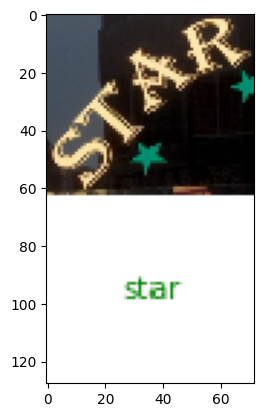

In [4]:
# Visualize the return value
import matplotlib.pyplot as plt
plt.imshow(result['visualization'][0])
plt.show()

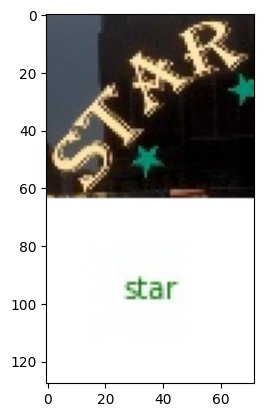

In [5]:
# Visualize the saved image
import mmcv
predicted_img = mmcv.imread('results/vis/demo_text_recog.jpg')
plt.imshow(mmcv.bgr2rgb(predicted_img))
plt.show()

In [6]:
infer_reg = MMOCRInferencer(rec='aster')
result = infer_reg('demo/0_17.jpg', save_vis=True, return_vis=True)


Loads checkpoint by http backend from path: https://download.openmmlab.com/mmocr/textrecog/aster/aster_resnet45_6e_st_mj/aster_resnet45_6e_st_mj-cc56eca4.pth


Downloading: "https://download.openmmlab.com/mmocr/textrecog/aster/aster_resnet45_6e_st_mj/aster_resnet45_6e_st_mj-cc56eca4.pth" to /root/.cache/torch/hub/checkpoints/aster_resnet45_6e_st_mj-cc56eca4.pth


Output()

FileNotFoundError: [Errno 2] No such file or directory: 'demo/0_17.jpg'

In [ ]:
plt.imshow(result['visualization'][0])
plt.show()

### Perform Inference with a Pretrained Text Detector

Next, we perform inference with a pretrained DBNet++ text detector and visualize the bounding box results for the demo text detection image.

In [ ]:
from mmocr.apis import MMOCRInferencer
infer = MMOCRInferencer(det='dbnetpp')
result = infer('demo/demo_text_det.jpg', return_vis=True)

In [ ]:
# Visualize the results
import matplotlib.pyplot as plt
plt.figure(figsize=(9, 16))
plt.imshow(result['visualization'][0])
plt.show()

In [ ]:
result = infer('demo/0_17.jpg', return_vis=True)

In [ ]:
plt.figure(figsize=(4, 6))
plt.imshow(result['visualization'][0])
plt.show()

### Perform end-to-end OCR with pretrained recognizer and detector

We can  any text detector and recognizer into a pipeline that forms a standard OCR pipeline. Now we build our own OCR pipeline with DBNet++ and SVTR and apply it to `demo/demo_text_ocr.jpg`.

In [ ]:
from mmocr.apis import MMOCRInferencer
infer = MMOCRInferencer(det='dbnetpp', rec='svtr-small')
result = infer('demo/demo_text_ocr.jpg', return_vis=True)

In [ ]:
# Visualize the results
import matplotlib.pyplot as plt
plt.figure(figsize=(9, 16))
plt.imshow(result['visualization'][0])
plt.show()

In [ ]:
infer = MMOCRInferencer(det='dbnetpp', rec='svtr-small')
result = infer('demo/0_17.jpg', return_vis=True)
plt.figure(figsize=(9, 16))
plt.imshow(result['visualization'][0])
plt.show()

In [ ]:
result = infer('demo/8_462.jpg', return_vis=True)
plt.figure(figsize=(9, 16))
plt.imshow(result['visualization'][0])
plt.show()

In [ ]:
result

### [CAN IGNORE] Combine OCR with Downstream Tasks

MMOCR also supports downstream tasks of OCR, such as key information extraction (KIE). We can even add a KIE model, SDMG-R, to the pipeline applied to `demo/demo_kie.jpeg` and visualize its prediction.


In [ ]:
from mmocr.apis import MMOCRInferencer
infer = MMOCRInferencer(det='dbnetpp', rec='svtr-small', kie='SDMGR')
result = infer('demo/demo_kie.jpeg', save_vis=True)

In [ ]:
# Visualize the results
import mmcv
import matplotlib.pyplot as plt
predicted_img = mmcv.imread('results/vis/demo_kie.jpg')
plt.figure(figsize=(18, 32))
plt.imshow(mmcv.bgr2rgb(predicted_img))
plt.show()

## Training SAR on a Toy Dataset

We now demonstrate how to train a recognizer on a provided dataset in a Python interpreter. Another common practice is to train a model from CLI (command line interface), as illustrated [here](https://mmocr.readthedocs.io/en/dev-1.x/get_started/quick_run.html#training).

Since training a full academic dataset is time consuming (usually takes about several hours or even days), we will train on the toy dataset for the SAR text recognition model and visualize the predictions. Text detection and other downstream tasks such as KIE follow similar procedures.

Training a model usually consists of the following steps:
1. Convert the dataset into [formats supported by MMOCR](https://mmocr.readthedocs.io/en/dev-1.x/basic_concepts/datasets.html). It should never be a concern if the dataset is obtained from Dataset Preparer. Otherwise, you will need to manually download and prepare the dataset following the [guide](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/data_prepare/recog.html), or even have to write a custom conversion script if your dataset is not on the list.
2. Modify the config for training.
3. Train the model.

In this example, we will use an off-the-shelf toy dataset to train SAR, and the first step will be skipped. The full demonstration of the first step can be found at the next section: Evaluating SAR on academic testsets.

### Visualize the Toy Dataset

We first get a sense of what the toy dataset looks like by visualizing one of the images and labels. The toy dataset consisits of ten images as well as annotation files in both json and lmdb format, and we only use json annotations in this tutorial.

In [ ]:
import mmcv
import matplotlib.pyplot as plt

img = mmcv.imread('tests/data/rec_toy_dataset/imgs/1058891.jpg')
plt.imshow(mmcv.bgr2rgb(img))
plt.show()

In [ ]:
# Inspect the labels of the annootation file
!cat tests/data/rec_toy_dataset/labels.json

### Load Config

First we will load the toy config for SAR.


In [ ]:
from mmengine import Config
# Load the config
cfg = Config.fromfile('configs/textrecog/sar/sar_resnet31_parallel-decoder_5e_toy.py')


In order to train SAR to its best state on toy dataset, we need to modify some hyperparameters in the config to accomodate some of the settings of colab.
For more explanation about the config and its fields, please refer to [documentation](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/config.html).

In [ ]:
# Specify the work dir
cfg.work_dir = 'work_dirs/sar_resnet31_parallel-decoder_5e_toy/'
# Configure the batch size, learning rate, and maximum epochs
cfg.optim_wrapper.optimizer.lr = 1e-3
cfg.train_dataloader.batch_size = 5
cfg.train_cfg.max_epochs = 100
# Save checkpoint every 10 epochs
cfg.default_hooks.checkpoint.interval = 10

# We don't need any learning rate scheduler for a toy dataset
# thus clear parameter scheduler here
cfg.param_scheduler = None

# Set seed thus the results are more reproducible
cfg.randomness = dict(seed=0)

# We can initialize the logger for training and have a look
# at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

### Train the SAR Text Recognizer
Let's train the SAR text recognizer on the toy dataset for 10 epochs.

In [ ]:
from mmengine.runner import Runner
import time

# Optionally, give visualizer a unique name to avoid dupliate instance being
# created in multiple runs
cfg.visualizer.name = f'{time.localtime()}'

runner = Runner.from_cfg(cfg)
runner.train()

### Perform inference and Visualize the Predictions

We can test the model through [Infernecer](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/inference.html), then print out and visualize its return values. Inferencer can also accepts many more types of inputs, just feel free to play around with it.

In [ ]:
import matplotlib.pyplot as plt
from mmocr.apis import TextRecInferencer

img = 'tests/data/rec_toy_dataset/imgs/1036169.jpg'
checkpoint = "work_dirs/sar_resnet31_parallel-decoder_5e_toy/epoch_100.pth"
cfg_file = "configs/textrecog/sar/sar_resnet31_parallel-decoder_5e_toy.py"

infer = TextRecInferencer(cfg_file, checkpoint)
result = infer(img, return_vis=True)

print(f'result: {result["predictions"]}' )

plt.figure(figsize=(9, 16))
plt.imshow(result['visualization'][0])
plt.show()

## Evaluating SAR

This section provides guidance on how to evaluate a model using with pretrained weights in a Python interpreter. Apart from such a practice, another common practice is to test a model from CLI (command line interface), as illustrated [here](https://mmocr.readthedocs.io/en/dev-1.x/get_started/quick_run.html#testing).

Typically, the evaluation process involves several steps:

1. Convert the dataset into [formats supported by MMOCR](https://mmocr.readthedocs.io/en/dev-1.x/basic_concepts/datasets.html). It should not be a concern if the dataset is obtained from [Dataset Preparer](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/data_prepare/dataset_preparer.html), which can download, extract and convert the dataset into a MMOCR-ready form with a single line of command. Otherwise, you will need to manually download and prepare the dataset following the [guide](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/data_prepare/det.html), or even have to write a custom conversion script if your dataset is not on the list.
2. Modify the config for testing.
3. Test the model.

Now we will demonstrate how to test a model on different datasets.


### Toy Dataset

With the checkpoint we obtained from the last section, we can evaluate it on the toy dataset again. Some more explanataions about the evaulation metrics are available [here](https://mmocr.readthedocs.io/en/dev-1.x/basic_concepts/evaluation.html).

In [ ]:
from mmengine.runner import Runner
import time

# The location of pretrained weight
cfg['load_from'] = 'work_dirs/sar_resnet31_parallel-decoder_5e_toy/epoch_100.pth'

# Optionally, give visualizer a unique name to avoid dupliate instance being
# created in multiple runs
cfg.visualizer.name = f'{time.localtime()}'

runner = Runner.from_cfg(cfg)
runner.test()

It's also possible to evaluate with a stronger and more generalized pretrained weight, which were trained on larger datasets and achieved quite competitve acadmical performance, though it may not defeat the previous checkpoint overfitted to the toy dataset. ([readme](https://mmocr.readthedocs.io/en/dev-1.x/textrecog_models.html#sar))


In [ ]:
# The location of pretrained weight
cfg['load_from'] = 'https://download.openmmlab.com/mmocr/textrecog/sar/sar_resnet31_parallel-decoder_5e_st-sub_mj-sub_sa_real/sar_resnet31_parallel-decoder_5e_st-sub_mj-sub_sa_real_20220915_171910-04eb4e75.pth'
cfg.visualizer.name = f'{time.localtime()}'
runner = Runner.from_cfg(cfg)
runner.test()

### SVTP Dataset

SVTP dataset is one of the six commonly used academic test sets that systematically reflects a text recognizer's performance. Now we will evaluate SAR on this dataset, and we are going to use [Dataset Preparer](https://mmocr.readthedocs.io/en/dev-1.x/user_guides/data_prepare/dataset_preparer.html) to get it prepared first.

In [ ]:
!python tools/dataset_converters/prepare_dataset.py svtp --task textrecog

SVTP is now available in `data/svtp`, and the dataset config is available at `configs/textrecog/_base_/datasets/svtp.py`. Now we first point the `test_dataloader` to SVTP, then perform testing with the overfitted checkpoint. As this checkpoint is just overfitted to such a small dataset, it's not surprising that it performs well on the toy dataset and bad on SVTP.

In [ ]:
from mmengine import Config

svtp_cfg = Config.fromfile('configs/textrecog/_base_/datasets/svtp.py')
svtp_cfg.svtp_textrecog_test.pipeline = cfg.test_pipeline
cfg.test_dataloader.dataset = svtp_cfg.svtp_textrecog_test

# The location of pretrained weight
cfg['load_from'] = 'work_dirs/sar_resnet31_parallel-decoder_5e_toy/epoch_100.pth'

# Optionally, give visualizer a unique name to avoid dupliate instance being
# created in multiple runs
cfg.visualizer.name = f'{time.localtime()}'

runner = Runner.from_cfg(cfg)
runner.test()

Let's evaluate the pretrained one for comparision.

In [ ]:
# The location of pretrained weight
cfg['load_from'] = 'https://download.openmmlab.com/mmocr/textrecog/sar/sar_resnet31_parallel-decoder_5e_st-sub_mj-sub_sa_real/sar_resnet31_parallel-decoder_5e_st-sub_mj-sub_sa_real_20220915_171910-04eb4e75.pth'
cfg.visualizer.name = f'{time.localtime()}'
runner = Runner.from_cfg(cfg)
runner.test()